
[контест на Kaggle](https://www.kaggle.com/c/advanced-dls-spring-2021/).


[Данные](https://www.kaggle.com/competitions/advanced-dls-spring-2021/data).

# Метрика

В данном случае мы используем стандартную для задачи классификации метрику ROC-AUC.


In [ ]:
from sklearn.metrics import roc_auc_score

y_true = [
    0,
    1,
    1,
    0,
    1
]

y_predictions = [
    0.1,
    0.9,
    0.4,
    0.6,
    0.61
]

roc_auc_score(y_true, y_predictions)

# Первая часть. Исследование

In [ ]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns

sns.set()

from sklearn.linear_model import LogisticRegression, LogisticRegressionCV
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.preprocessing import StandardScaler, RobustScaler, LabelEncoder, OneHotEncoder, power_transform

from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.metrics import roc_auc_score
from sklearn.compose import ColumnTransformer

from sklearn.model_selection import cross_val_score, GridSearchCV
from catboost import CatBoostClassifier, Pool, cv

from tqdm import tqdm

import warnings
warnings.filterwarnings('ignore')
%config Completer.use_jedi = False

## Загрузка данных


In [ ]:
data = pd.read_csv('./train.csv')
X_test = pd.read_csv('./test.csv')

In [ ]:
# Для вашего удобства списки с именами разных колонок

# Числовые признаки
num_cols = [
    'ClientPeriod',
    'MonthlySpending',
    'TotalSpent'
]

# Категориальные признаки
cat_cols = [
    'Sex',
    'IsSeniorCitizen',
    'HasPartner',
    'HasChild',
    'HasPhoneService',
    'HasMultiplePhoneNumbers',
    'HasInternetService',
    'HasOnlineSecurityService',
    'HasOnlineBackup',
    'HasDeviceProtection',
    'HasTechSupportAccess',
    'HasOnlineTV',
    'HasMovieSubscription',
    'HasContractPhone',
    'IsBillingPaperless',
    'PaymentMethod'
]

features = num_cols + cat_cols
target = 'Churn'

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5282 entries, 0 to 5281
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   ClientPeriod              5282 non-null   int64  
 1   MonthlySpending           5282 non-null   float64
 2   TotalSpent                5282 non-null   object 
 3   Sex                       5282 non-null   object 
 4   IsSeniorCitizen           5282 non-null   int64  
 5   HasPartner                5282 non-null   object 
 6   HasChild                  5282 non-null   object 
 7   HasPhoneService           5282 non-null   object 
 8   HasMultiplePhoneNumbers   5282 non-null   object 
 9   HasInternetService        5282 non-null   object 
 10  HasOnlineSecurityService  5282 non-null   object 
 11  HasOnlineBackup           5282 non-null   object 
 12  HasDeviceProtection       5282 non-null   object 
 13  HasTechSupportAccess      5282 non-null   object 
 14  HasOnlin

Преобразуем поле TotalSpent, так как оно должно быть чиловым признаком

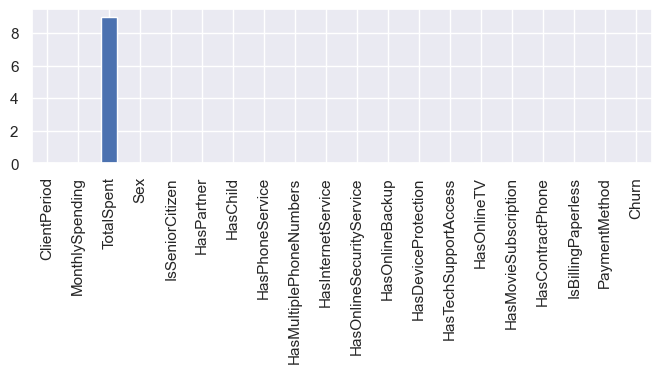

In [ ]:
data.TotalSpent = pd.to_numeric(data.TotalSpent, errors='coerce')
X_test.TotalSpent = pd.to_numeric(X_test.TotalSpent, errors='coerce')
data.isna().sum().plot(kind='bar', figsize=(8,2));

Видим 9 полей nan в TotalSpending, посмотрим на них

In [ ]:
data[data.TotalSpent.isna() == True]

,ClientPeriod,MonthlySpending,TotalSpent,Sex,IsSeniorCitizen,HasPartner,HasChild,HasPhoneService,HasMultiplePhoneNumbers,HasInternetService,HasOnlineSecurityService,HasOnlineBackup,HasDeviceProtection,HasTechSupportAccess,HasOnlineTV,HasMovieSubscription,HasContractPhone,IsBillingPaperless,PaymentMethod,Churn
1048,0,25.75,NaN,Male,0,Yes,Yes,Yes,Yes,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,0
1707,0,73.35,NaN,Female,0,Yes,Yes,Yes,Yes,DSL,No,Yes,Yes,Yes,Yes,No,Two year,No,Mailed check,0
2543,0,19.70,NaN,Male,0,Yes,Yes,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,One year,Yes,Mailed check,0
3078,0,80.85,NaN,Female,0,Yes,Yes,Yes,No,DSL,Yes,Yes,Yes,No,Yes,Yes,Two year,No,Mailed check,0
3697,0,20.00,NaN,Female,0,Yes,Yes,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,0
4002,0,61.90,NaN,Male,0,No,Yes,Yes,Yes,DSL,Yes,Yes,No,Yes,No,No,Two year,Yes,Bank transfer (automatic),0
4326,0,25.35,NaN,Male,0,Yes,Yes,Yes,Yes,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,0
4551,0,52.55,NaN,Female,0,Yes,Yes,No,No phone service,DSL,Yes,No,Yes,Yes,Yes,No,Two year,Yes,Bank transfer (automatic),0
4598,0,56.05,NaN,Female,0,Yes,Yes,No,No phone service,DSL,Yes,Yes,Yes,Yes,Yes,No,Two year,No,Credit card (automatic),0


Как видно, это те пользователи, что еще не делали покупок, тогда это поле можно заполнить нулями

In [ ]:
data.TotalSpent = data.TotalSpent.fillna(0).astype(float)
X_test.TotalSpent = X_test.TotalSpent.fillna(0).astype(float)

Есть ли дубликаты

In [ ]:
data.duplicated().sum()

14

In [ ]:
data.drop_duplicates(inplace=True)

Есть ли дубликаты среди признаков:

In [ ]:
data.drop(target, axis=1).duplicated().sum()

8

In [ ]:
data.drop_duplicates(subset=list(data.columns[:-1]), keep='last', inplace=True)

In [ ]:
data.describe()

,ClientPeriod,MonthlySpending,TotalSpent,IsSeniorCitizen,Churn
count,5260.000000,5260.000000,5260.000000,5260.000000,5260.000000
mean,32.528327,65.040875,2296.898165,0.159886,0.260646
std,24.517317,30.153470,2269.107245,0.366535,0.439029
min,0.000000,18.250000,0.000000,0.000000,0.000000
25%,9.000000,35.737500,403.300000,0.000000,0.000000
50%,29.000000,70.500000,1414.900000,0.000000,0.000000
75%,55.000000,90.050000,3813.712500,0.000000,1.000000
max,72.000000,118.750000,8684.800000,1.000000,1.000000


## Анализ данных

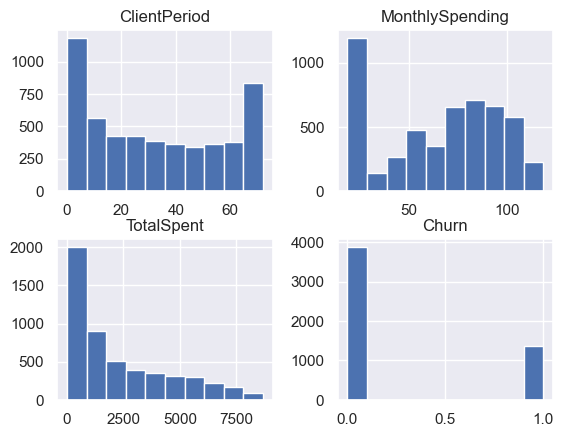

In [ ]:
data[num_cols+[target]].hist();

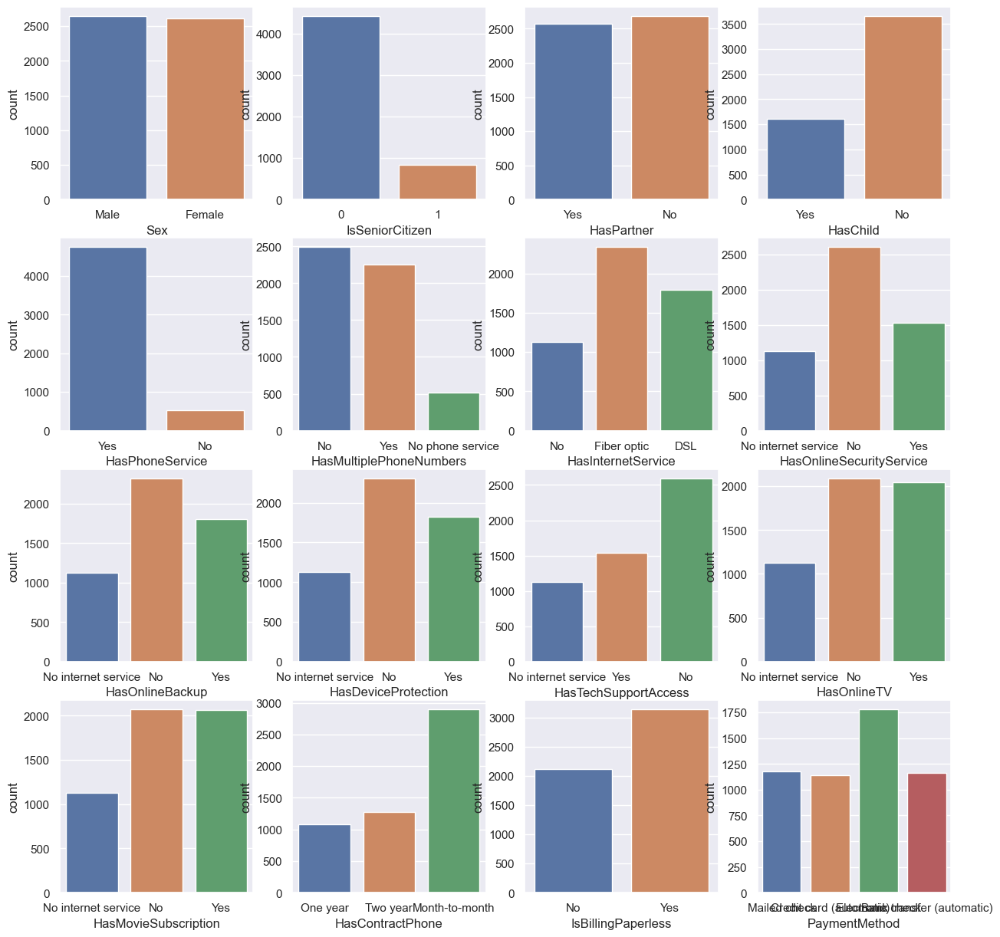

In [ ]:
fig, ax = plt.subplots(nrows=4,ncols=4, figsize=(15,15))
for i in range(4):
    for j in range(4):
        sns.countplot(x=data[cat_cols[(i*4 + j)]], ax=ax[i, j])

Скорреткируем признаки:

In [ ]:
{col : list(data[col].unique()) for col in cat_cols}

{'Sex': ['Male', 'Female'],
 'IsSeniorCitizen': [0, 1],
 'HasPartner': ['Yes', 'No'],
 'HasChild': ['Yes', 'No'],
 'HasPhoneService': ['Yes', 'No'],
 'HasMultiplePhoneNumbers': ['No', 'Yes', 'No phone service'],
 'HasInternetService': ['No', 'Fiber optic', 'DSL'],
 'HasOnlineSecurityService': ['No internet service', 'No', 'Yes'],
 'HasOnlineBackup': ['No internet service', 'No', 'Yes'],
 'HasDeviceProtection': ['No internet service', 'No', 'Yes'],
 'HasTechSupportAccess': ['No internet service', 'Yes', 'No'],
 'HasOnlineTV': ['No internet service', 'No', 'Yes'],
 'HasMovieSubscription': ['No internet service', 'No', 'Yes'],
 'HasContractPhone': ['One year', 'Two year', 'Month-to-month'],
 'IsBillingPaperless': ['No', 'Yes'],
 'PaymentMethod': ['Mailed check',
  'Credit card (automatic)',
  'Electronic check',
  'Bank transfer (automatic)']}

In [ ]:
data.replace({'No internet service' : 'No',
             'No phone service' : 'No'}, inplace=True)

In [ ]:
X_test.replace({'No internet service' : 'No',
             'No phone service' : 'No'}, inplace=True)

In [ ]:
data.corr().style.background_gradient(cmap='coolwarm')

,ClientPeriod,MonthlySpending,TotalSpent,IsSeniorCitizen,Churn
ClientPeriod,1.000000,0.246033,0.825877,0.009938,-0.349151
MonthlySpending,0.246033,1.000000,0.651360,0.214500,0.187049
TotalSpent,0.825877,0.651360,1.000000,0.093616,-0.198110
IsSeniorCitizen,0.009938,0.214500,0.093616,1.000000,0.158100
Churn,-0.349151,0.187049,-0.198110,0.158100,1.000000


## Применение линейных моделей

Обработаем данные для того, чтобы к ним можно было применить LogisticRegression. Т.е. отнормируем числовые признаки, а категориальные закодируем с помощью one-hot-encoding'а.

Протестируем выборку на разные значения гиперпараметра C по метрике ROC-AUC.

In [ ]:
preproc = ColumnTransformer([
    ('num', StandardScaler(), num_cols),
    ('cat', OneHotEncoder(), cat_cols)],
     verbose_feature_names_out = False)

pipe = Pipeline(steps=[
    ('prep', preproc),
    ('clf', LogisticRegression(max_iter=200))
])

params = {
    'clf__C':[100, 10, 1, 0.1, 0.01, 0.001],
    'clf__penalty':['l1', 'l2'],
    'clf__solver': ['liblinear']
}

lr = GridSearchCV(pipe, params, cv=5, verbose=0, n_jobs=-1, scoring='roc_auc')

In [ ]:
lr.fit(data.drop(target, axis='columns'), data[target]);

In [ ]:
lr.best_params_

{'clf__C': 100, 'clf__penalty': 'l1', 'clf__solver': 'liblinear'}

In [ ]:
pred_train = lr.predict_proba(data.drop(target, axis='columns'))
pred = lr.predict_proba(X_test)

roc_auc_score(data[target], pred_train[:,1]),

(0.8491385397741372,)

In [ ]:
submit = pd.read_csv('./submission.csv', index_col='Id')

submit['Churn'] = pred[:,1]

submit.to_csv('./LR_submission.csv')

## Бустинг




In [ ]:
train_data.shape

(5260, 19)

In [ ]:
train_data = Pool(data=data.drop(target, axis=1), label=data[target], cat_features=cat_cols)
model = CatBoostClassifier(iterations=100)
model.fit(train_data);

Learning rate set to 0.1729
0:	learn: 0.6323628	total: 4.33ms	remaining: 428ms
1:	learn: 0.5877561	total: 8.22ms	remaining: 403ms
2:	learn: 0.5554669	total: 11ms	remaining: 356ms
3:	learn: 0.5317527	total: 14.5ms	remaining: 349ms
4:	learn: 0.5108012	total: 17.6ms	remaining: 334ms
5:	learn: 0.4949498	total: 20.2ms	remaining: 317ms
6:	learn: 0.4794928	total: 23.1ms	remaining: 307ms
7:	learn: 0.4688391	total: 24.7ms	remaining: 284ms
8:	learn: 0.4590627	total: 27.3ms	remaining: 276ms
9:	learn: 0.4506680	total: 29.9ms	remaining: 270ms
10:	learn: 0.4439482	total: 32.3ms	remaining: 262ms
11:	learn: 0.4370993	total: 34.9ms	remaining: 256ms
12:	learn: 0.4322046	total: 37.3ms	remaining: 250ms
13:	learn: 0.4275394	total: 39.5ms	remaining: 242ms
14:	learn: 0.4235615	total: 41.5ms	remaining: 235ms
15:	learn: 0.4219750	total: 42.6ms	remaining: 223ms
16:	learn: 0.4184730	total: 44.8ms	remaining: 219ms
17:	learn: 0.4157273	total: 47.1ms	remaining: 215ms
18:	learn: 0.4146183	total: 48.1ms	remaining: 20

In [ ]:
pred_train = model.predict_proba(train_data)
roc_auc_score(data[target], pred_train[:, 1])

0.872823889933248

In [ ]:
pred = model.predict_proba(X_test)

In [ ]:
train_data = Pool(data=data.drop(target, axis=1), label=data[target], cat_features=cat_cols)
model = CatBoostClassifier(
    iterations=100,
    custom_loss='AUC:hints=skip_train~false',
    eval_metric='AUC:hints=skip_train~false'
)

In [ ]:
params = {
    'depth': np.arange(1, 5),
    'learning_rate': np.arange(0.01, 0.6, 0.03),
    'l2_leaf_reg': np.arange(1, 10),
    'min_data_in_leaf': np.arange(10, 100, 10)
}
model.grid_search(params, train_data, cv=5, plot=True, refit=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 67.9ms	remaining: 6.73s
1:	learn: 0.6754479	test: 0.6984225	best: 0.6984225 (1)	total: 71.7ms	remaining: 3.51s
2:	learn: 0.6902228	test: 0.7121623	best: 0.7121623 (2)	total: 75.2ms	remaining: 2.43s
3:	learn: 0.6904280	test: 0.7121900	best: 0.7121900 (3)	total: 78.5ms	remaining: 1.88s
4:	learn: 0.7013202	test: 0.7251920	best: 0.7251920 (4)	total: 80.7ms	remaining: 1.53s
5:	learn: 0.7017282	test: 0.7250139	best: 0.7251920 (4)	total: 83.3ms	remaining: 1.3s
6:	learn: 0.7017944	test: 0.7251157	best: 0.7251920 (4)	total: 85.8ms	remaining: 1.14s
7:	learn: 0.7021870	test: 0.7244171	best: 0.7251920 (4)	total: 88.4ms	remaining: 1.02s
8:	learn: 0.7021870	test: 0.7244171	best: 0.7251920 (4)	total: 90.5ms	remaining: 915ms
9:	learn: 0.7022695	test: 0.7244356	best: 0.7251920 (4)	total: 92.7ms	remaining: 834ms
10:	learn: 0.7084872	test: 0.7348538	best: 0.7348538 (10)	total: 95.4ms	remaining: 772ms
11:	learn: 0.7084872	test: 0.7348538	best:

45:	learn: 0.8240452	test: 0.8416566	best: 0.8432527 (34)	total: 141ms	remaining: 166ms
46:	learn: 0.8227290	test: 0.8399079	best: 0.8432527 (34)	total: 146ms	remaining: 165ms
47:	learn: 0.8226805	test: 0.8398571	best: 0.8432527 (34)	total: 151ms	remaining: 164ms
48:	learn: 0.8226664	test: 0.8398293	best: 0.8432527 (34)	total: 156ms	remaining: 162ms
49:	learn: 0.8238169	test: 0.8416913	best: 0.8432527 (34)	total: 160ms	remaining: 160ms
50:	learn: 0.8254185	test: 0.8442011	best: 0.8442011 (50)	total: 165ms	remaining: 158ms
51:	learn: 0.8254009	test: 0.8441733	best: 0.8442011 (50)	total: 167ms	remaining: 154ms
52:	learn: 0.8263924	test: 0.8460330	best: 0.8460330 (52)	total: 171ms	remaining: 152ms
53:	learn: 0.8268241	test: 0.8461163	best: 0.8461163 (53)	total: 176ms	remaining: 150ms
54:	learn: 0.8274214	test: 0.8483276	best: 0.8483276 (54)	total: 180ms	remaining: 148ms
55:	learn: 0.8275516	test: 0.8493176	best: 0.8493176 (55)	total: 184ms	remaining: 145ms
56:	learn: 0.8275119	test: 0.850

57:	learn: 0.8338038	test: 0.8582948	best: 0.8582948 (57)	total: 246ms	remaining: 178ms
58:	learn: 0.8339822	test: 0.8585330	best: 0.8585330 (58)	total: 252ms	remaining: 175ms
59:	learn: 0.8341639	test: 0.8589725	best: 0.8589725 (59)	total: 257ms	remaining: 172ms
60:	learn: 0.8342016	test: 0.8589031	best: 0.8589725 (59)	total: 261ms	remaining: 167ms
61:	learn: 0.8343568	test: 0.8591668	best: 0.8591668 (61)	total: 266ms	remaining: 163ms
62:	learn: 0.8341010	test: 0.8591900	best: 0.8591900 (62)	total: 269ms	remaining: 158ms
63:	learn: 0.8346754	test: 0.8599255	best: 0.8599255 (63)	total: 273ms	remaining: 153ms
64:	learn: 0.8349783	test: 0.8604945	best: 0.8604945 (64)	total: 276ms	remaining: 148ms
65:	learn: 0.8353953	test: 0.8604367	best: 0.8604945 (64)	total: 277ms	remaining: 143ms
66:	learn: 0.8355873	test: 0.8604691	best: 0.8604945 (64)	total: 280ms	remaining: 138ms
67:	learn: 0.8353791	test: 0.8602147	best: 0.8604945 (64)	total: 283ms	remaining: 133ms
68:	learn: 0.8355856	test: 0.860

14:	learn: 0.8251533	test: 0.8477609	best: 0.8477609 (14)	total: 36.7ms	remaining: 208ms
15:	learn: 0.8252821	test: 0.8467293	best: 0.8477609 (14)	total: 40.5ms	remaining: 212ms
16:	learn: 0.8271304	test: 0.8505436	best: 0.8505436 (16)	total: 44.4ms	remaining: 217ms
17:	learn: 0.8276903	test: 0.8535460	best: 0.8535460 (17)	total: 48.3ms	remaining: 220ms
18:	learn: 0.8277626	test: 0.8535414	best: 0.8535460 (17)	total: 52ms	remaining: 222ms
19:	learn: 0.8296521	test: 0.8534882	best: 0.8535460 (17)	total: 55.1ms	remaining: 220ms
20:	learn: 0.8289031	test: 0.8511334	best: 0.8535460 (17)	total: 58.9ms	remaining: 222ms
21:	learn: 0.8310795	test: 0.8550726	best: 0.8550726 (21)	total: 62.9ms	remaining: 223ms
22:	learn: 0.8313233	test: 0.8569139	best: 0.8569139 (22)	total: 64.4ms	remaining: 216ms
23:	learn: 0.8320209	test: 0.8577651	best: 0.8577651 (23)	total: 66.6ms	remaining: 211ms
24:	learn: 0.8325447	test: 0.8581861	best: 0.8581861 (24)	total: 68.7ms	remaining: 206ms
25:	learn: 0.8331950	te

49:	learn: 0.8382042	test: 0.8646512	best: 0.8646512 (49)	total: 127ms	remaining: 127ms
50:	learn: 0.8384747	test: 0.8650305	best: 0.8650305 (50)	total: 129ms	remaining: 124ms
51:	learn: 0.8387773	test: 0.8647923	best: 0.8650305 (50)	total: 133ms	remaining: 122ms
52:	learn: 0.8394250	test: 0.8649981	best: 0.8650305 (50)	total: 137ms	remaining: 121ms
53:	learn: 0.8399950	test: 0.8650860	best: 0.8650860 (53)	total: 140ms	remaining: 119ms
54:	learn: 0.8402391	test: 0.8651855	best: 0.8651855 (54)	total: 144ms	remaining: 118ms
55:	learn: 0.8403717	test: 0.8656389	best: 0.8656389 (55)	total: 148ms	remaining: 116ms
56:	learn: 0.8404005	test: 0.8656389	best: 0.8656389 (55)	total: 151ms	remaining: 114ms
57:	learn: 0.8405405	test: 0.8661570	best: 0.8661570 (57)	total: 155ms	remaining: 112ms
58:	learn: 0.8406040	test: 0.8663421	best: 0.8663421 (58)	total: 156ms	remaining: 109ms
59:	learn: 0.8406243	test: 0.8663421	best: 0.8663421 (58)	total: 160ms	remaining: 107ms
60:	learn: 0.8407590	test: 0.866

17:	learn: 0.8281671	test: 0.8553063	best: 0.8553063 (17)	total: 42.5ms	remaining: 194ms
18:	learn: 0.8286411	test: 0.8558660	best: 0.8558660 (18)	total: 46.2ms	remaining: 197ms
19:	learn: 0.8299185	test: 0.8565600	best: 0.8565600 (19)	total: 48.2ms	remaining: 193ms
20:	learn: 0.8313409	test: 0.8572331	best: 0.8572331 (20)	total: 51.6ms	remaining: 194ms
21:	learn: 0.8323016	test: 0.8567358	best: 0.8572331 (20)	total: 55.6ms	remaining: 197ms
22:	learn: 0.8334339	test: 0.8587967	best: 0.8587967 (22)	total: 60.6ms	remaining: 203ms
23:	learn: 0.8341432	test: 0.8588430	best: 0.8588430 (23)	total: 64.3ms	remaining: 204ms
24:	learn: 0.8346319	test: 0.8595230	best: 0.8595230 (24)	total: 66.8ms	remaining: 201ms
25:	learn: 0.8359053	test: 0.8611006	best: 0.8611006 (25)	total: 70.3ms	remaining: 200ms
26:	learn: 0.8362997	test: 0.8603928	best: 0.8611006 (25)	total: 73.1ms	remaining: 198ms
27:	learn: 0.8367302	test: 0.8612741	best: 0.8612741 (27)	total: 75.7ms	remaining: 195ms
28:	learn: 0.8370037	

81:	learn: 0.8464361	test: 0.8703368	best: 0.8703368 (81)	total: 195ms	remaining: 42.8ms
82:	learn: 0.8463935	test: 0.8703368	best: 0.8703368 (81)	total: 200ms	remaining: 40.9ms
83:	learn: 0.8464652	test: 0.8702443	best: 0.8703368 (81)	total: 204ms	remaining: 38.8ms
84:	learn: 0.8465685	test: 0.8702628	best: 0.8703368 (81)	total: 207ms	remaining: 36.6ms
85:	learn: 0.8466746	test: 0.8704571	best: 0.8704571 (85)	total: 212ms	remaining: 34.5ms
86:	learn: 0.8466731	test: 0.8702535	best: 0.8704571 (85)	total: 216ms	remaining: 32.3ms
87:	learn: 0.8467137	test: 0.8702073	best: 0.8704571 (85)	total: 221ms	remaining: 30.1ms
88:	learn: 0.8467220	test: 0.8704756	best: 0.8704756 (88)	total: 226ms	remaining: 27.9ms
89:	learn: 0.8467184	test: 0.8704756	best: 0.8704756 (88)	total: 230ms	remaining: 25.6ms
90:	learn: 0.8467649	test: 0.8704524	best: 0.8704756 (88)	total: 235ms	remaining: 23.2ms
91:	learn: 0.8468775	test: 0.8705357	best: 0.8705357 (91)	total: 239ms	remaining: 20.8ms
92:	learn: 0.8471664	

27:	learn: 0.8388496	test: 0.8672719	best: 0.8672719 (27)	total: 67.8ms	remaining: 174ms
28:	learn: 0.8398068	test: 0.8681324	best: 0.8681324 (28)	total: 71.9ms	remaining: 176ms
29:	learn: 0.8401391	test: 0.8675588	best: 0.8681324 (28)	total: 75.2ms	remaining: 176ms
30:	learn: 0.8405817	test: 0.8675356	best: 0.8681324 (28)	total: 78.5ms	remaining: 175ms
31:	learn: 0.8406616	test: 0.8683267	best: 0.8683267 (31)	total: 82.6ms	remaining: 176ms
32:	learn: 0.8411299	test: 0.8678502	best: 0.8683267 (31)	total: 86.6ms	remaining: 176ms
33:	learn: 0.8413933	test: 0.8678502	best: 0.8683267 (31)	total: 90.6ms	remaining: 176ms
34:	learn: 0.8417129	test: 0.8685626	best: 0.8685626 (34)	total: 94.4ms	remaining: 175ms
35:	learn: 0.8418264	test: 0.8688032	best: 0.8688032 (35)	total: 97.4ms	remaining: 173ms
36:	learn: 0.8418813	test: 0.8688032	best: 0.8688032 (35)	total: 101ms	remaining: 172ms
37:	learn: 0.8421397	test: 0.8683822	best: 0.8688032 (35)	total: 104ms	remaining: 169ms
38:	learn: 0.8422015	te

92:	learn: 0.8480776	test: 0.8723353	best: 0.8723353 (88)	total: 219ms	remaining: 16.5ms
93:	learn: 0.8481411	test: 0.8722937	best: 0.8723353 (88)	total: 223ms	remaining: 14.2ms
94:	learn: 0.8481523	test: 0.8722937	best: 0.8723353 (88)	total: 226ms	remaining: 11.9ms
95:	learn: 0.8481748	test: 0.8722867	best: 0.8723353 (88)	total: 229ms	remaining: 9.54ms
96:	learn: 0.8482527	test: 0.8721341	best: 0.8723353 (88)	total: 233ms	remaining: 7.2ms
97:	learn: 0.8482942	test: 0.8720462	best: 0.8723353 (88)	total: 235ms	remaining: 4.79ms
98:	learn: 0.8482889	test: 0.8720462	best: 0.8723353 (88)	total: 238ms	remaining: 2.4ms
99:	learn: 0.8483130	test: 0.8720462	best: 0.8723353 (88)	total: 240ms	remaining: 0us

bestTest = 0.8723353072
bestIteration = 88

11:	loss: 0.8723353	best: 0.8726707 (10)	total: 3.36s	remaining: 30m 13s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 3.49ms	remaining: 345ms
1:	learn: 0.6976531	test: 0.7239660	best: 0.7239660 (1)	total: 7.26ms	remaining: 356ms
2

29:	learn: 0.8423559	test: 0.8685765	best: 0.8687870 (27)	total: 68.1ms	remaining: 159ms
30:	learn: 0.8423456	test: 0.8685765	best: 0.8687870 (27)	total: 71.6ms	remaining: 159ms
31:	learn: 0.8425991	test: 0.8680676	best: 0.8687870 (27)	total: 74.6ms	remaining: 159ms
32:	learn: 0.8431003	test: 0.8683244	best: 0.8687870 (27)	total: 78.2ms	remaining: 159ms
33:	learn: 0.8434496	test: 0.8683336	best: 0.8687870 (27)	total: 80.4ms	remaining: 156ms
34:	learn: 0.8437381	test: 0.8682550	best: 0.8687870 (27)	total: 83.4ms	remaining: 155ms
35:	learn: 0.8441277	test: 0.8686297	best: 0.8687870 (27)	total: 86.1ms	remaining: 153ms
36:	learn: 0.8443792	test: 0.8682180	best: 0.8687870 (27)	total: 90ms	remaining: 153ms
37:	learn: 0.8445200	test: 0.8683707	best: 0.8687870 (27)	total: 93.7ms	remaining: 153ms
38:	learn: 0.8446035	test: 0.8687084	best: 0.8687870 (27)	total: 96.3ms	remaining: 151ms
39:	learn: 0.8447226	test: 0.8684308	best: 0.8687870 (27)	total: 99.1ms	remaining: 149ms
40:	learn: 0.8447401	te

90:	learn: 0.8491568	test: 0.8701078	best: 0.8704154 (80)	total: 232ms	remaining: 23ms
91:	learn: 0.8491568	test: 0.8701078	best: 0.8704154 (80)	total: 234ms	remaining: 20.4ms
92:	learn: 0.8492444	test: 0.8702651	best: 0.8704154 (80)	total: 238ms	remaining: 17.9ms
93:	learn: 0.8493203	test: 0.8705797	best: 0.8705797 (93)	total: 243ms	remaining: 15.5ms
94:	learn: 0.8493588	test: 0.8704871	best: 0.8705797 (93)	total: 247ms	remaining: 13ms
95:	learn: 0.8493670	test: 0.8704871	best: 0.8705797 (93)	total: 251ms	remaining: 10.5ms
96:	learn: 0.8493773	test: 0.8703854	best: 0.8705797 (93)	total: 255ms	remaining: 7.9ms
97:	learn: 0.8494541	test: 0.8704293	best: 0.8705797 (93)	total: 260ms	remaining: 5.3ms
98:	learn: 0.8495025	test: 0.8705080	best: 0.8705797 (93)	total: 263ms	remaining: 2.65ms
99:	learn: 0.8495239	test: 0.8705403	best: 0.8705797 (93)	total: 264ms	remaining: 0us

bestTest = 0.8705796632
bestIteration = 93

14:	loss: 0.8705797	best: 0.8726707 (10)	total: 4.19s	remaining: 30m 4s
0:

59:	learn: 0.8482014	test: 0.8705427	best: 0.8712065 (52)	total: 138ms	remaining: 92.2ms
60:	learn: 0.8482752	test: 0.8705427	best: 0.8712065 (52)	total: 142ms	remaining: 91ms
61:	learn: 0.8483930	test: 0.8706491	best: 0.8712065 (52)	total: 146ms	remaining: 89.5ms
62:	learn: 0.8485562	test: 0.8706814	best: 0.8712065 (52)	total: 149ms	remaining: 87.3ms
63:	learn: 0.8485938	test: 0.8706814	best: 0.8712065 (52)	total: 153ms	remaining: 86.1ms
64:	learn: 0.8486659	test: 0.8703946	best: 0.8712065 (52)	total: 157ms	remaining: 84.7ms
65:	learn: 0.8487394	test: 0.8705427	best: 0.8712065 (52)	total: 162ms	remaining: 83.3ms
66:	learn: 0.8489211	test: 0.8706629	best: 0.8712065 (52)	total: 165ms	remaining: 81.1ms
67:	learn: 0.8489414	test: 0.8706629	best: 0.8712065 (52)	total: 168ms	remaining: 79.2ms
68:	learn: 0.8490296	test: 0.8706629	best: 0.8712065 (52)	total: 172ms	remaining: 77.2ms
69:	learn: 0.8491319	test: 0.8700754	best: 0.8712065 (52)	total: 175ms	remaining: 74.9ms
70:	learn: 0.8491230	te

16:	learn: 0.8391233	test: 0.8655024	best: 0.8659326 (13)	total: 40.1ms	remaining: 196ms
17:	learn: 0.8400912	test: 0.8664276	best: 0.8664276 (17)	total: 43.4ms	remaining: 198ms
18:	learn: 0.8408682	test: 0.8672210	best: 0.8672210 (18)	total: 47.5ms	remaining: 203ms
19:	learn: 0.8411685	test: 0.8683498	best: 0.8683498 (19)	total: 50.8ms	remaining: 203ms
20:	learn: 0.8416037	test: 0.8673760	best: 0.8683498 (19)	total: 53.1ms	remaining: 200ms
21:	learn: 0.8429905	test: 0.8679705	best: 0.8683498 (19)	total: 58.5ms	remaining: 207ms
22:	learn: 0.8436386	test: 0.8694023	best: 0.8694023 (22)	total: 62.4ms	remaining: 209ms
23:	learn: 0.8438121	test: 0.8692543	best: 0.8694023 (22)	total: 65.9ms	remaining: 209ms
24:	learn: 0.8441111	test: 0.8693699	best: 0.8694023 (22)	total: 68.6ms	remaining: 206ms
25:	learn: 0.8441382	test: 0.8693699	best: 0.8694023 (22)	total: 70.7ms	remaining: 201ms
26:	learn: 0.8441376	test: 0.8698742	best: 0.8698742 (26)	total: 72.4ms	remaining: 196ms
27:	learn: 0.8443265	

71:	learn: 0.8493654	test: 0.8729783	best: 0.8729783 (71)	total: 180ms	remaining: 70.1ms
72:	learn: 0.8493948	test: 0.8729783	best: 0.8729783 (71)	total: 185ms	remaining: 68.3ms
73:	learn: 0.8494237	test: 0.8730015	best: 0.8730015 (73)	total: 190ms	remaining: 66.6ms
74:	learn: 0.8494040	test: 0.8727794	best: 0.8730015 (73)	total: 194ms	remaining: 64.6ms
75:	learn: 0.8495436	test: 0.8725851	best: 0.8730015 (73)	total: 197ms	remaining: 62.3ms
76:	learn: 0.8496348	test: 0.8727563	best: 0.8730015 (73)	total: 201ms	remaining: 60.1ms
77:	learn: 0.8497127	test: 0.8728164	best: 0.8730015 (73)	total: 204ms	remaining: 57.4ms
78:	learn: 0.8496867	test: 0.8728164	best: 0.8730015 (73)	total: 207ms	remaining: 55ms
79:	learn: 0.8497129	test: 0.8730292	best: 0.8730292 (79)	total: 210ms	remaining: 52.6ms
80:	learn: 0.8497196	test: 0.8730292	best: 0.8730292 (79)	total: 213ms	remaining: 50ms
81:	learn: 0.8497870	test: 0.8729691	best: 0.8730292 (79)	total: 216ms	remaining: 47.5ms
82:	learn: 0.8498384	test

6:	learn: 0.7245508	test: 0.7439697	best: 0.7439697 (6)	total: 35.7ms	remaining: 474ms
7:	learn: 0.7547965	test: 0.7785090	best: 0.7785090 (7)	total: 40.3ms	remaining: 463ms
8:	learn: 0.7699479	test: 0.7944416	best: 0.7944416 (8)	total: 44.9ms	remaining: 454ms
9:	learn: 0.7681825	test: 0.7918394	best: 0.7944416 (8)	total: 48.1ms	remaining: 433ms
10:	learn: 0.7675316	test: 0.7910367	best: 0.7944416 (8)	total: 51.6ms	remaining: 418ms
11:	learn: 0.7670035	test: 0.7902086	best: 0.7944416 (8)	total: 54.7ms	remaining: 401ms
12:	learn: 0.7737284	test: 0.7983901	best: 0.7983901 (12)	total: 59.1ms	remaining: 395ms
13:	learn: 0.7712030	test: 0.7963060	best: 0.7983901 (12)	total: 62.1ms	remaining: 382ms
14:	learn: 0.7764927	test: 0.7988458	best: 0.7988458 (14)	total: 64.8ms	remaining: 367ms
15:	learn: 0.7758890	test: 0.7983045	best: 0.7988458 (14)	total: 66.5ms	remaining: 349ms
16:	learn: 0.7772840	test: 0.8001966	best: 0.8001966 (16)	total: 70ms	remaining: 342ms
17:	learn: 0.7758071	test: 0.7969

53:	learn: 0.8330399	test: 0.8596826	best: 0.8596826 (53)	total: 140ms	remaining: 119ms
54:	learn: 0.8332660	test: 0.8601684	best: 0.8601684 (54)	total: 144ms	remaining: 118ms
55:	learn: 0.8332101	test: 0.8596873	best: 0.8601684 (54)	total: 148ms	remaining: 116ms
56:	learn: 0.8335815	test: 0.8596503	best: 0.8601684 (54)	total: 152ms	remaining: 115ms
57:	learn: 0.8334498	test: 0.8596040	best: 0.8601684 (54)	total: 155ms	remaining: 112ms
58:	learn: 0.8339694	test: 0.8601406	best: 0.8601684 (54)	total: 159ms	remaining: 111ms
59:	learn: 0.8341373	test: 0.8604645	best: 0.8604645 (59)	total: 164ms	remaining: 109ms
60:	learn: 0.8343802	test: 0.8603211	best: 0.8604645 (59)	total: 167ms	remaining: 107ms
61:	learn: 0.8342273	test: 0.8597474	best: 0.8604645 (59)	total: 170ms	remaining: 104ms
62:	learn: 0.8341608	test: 0.8597197	best: 0.8604645 (59)	total: 174ms	remaining: 102ms
63:	learn: 0.8345243	test: 0.8597104	best: 0.8604645 (59)	total: 177ms	remaining: 99.7ms
64:	learn: 0.8348016	test: 0.85

4:	learn: 0.7517483	test: 0.7797164	best: 0.7797164 (4)	total: 18.8ms	remaining: 357ms
5:	learn: 0.7816748	test: 0.8063286	best: 0.8063286 (5)	total: 23.4ms	remaining: 367ms
6:	learn: 0.7858666	test: 0.8103812	best: 0.8103812 (6)	total: 27.9ms	remaining: 371ms
7:	learn: 0.7866409	test: 0.8109502	best: 0.8109502 (7)	total: 31.9ms	remaining: 367ms
8:	learn: 0.8030591	test: 0.8256269	best: 0.8256269 (8)	total: 36.8ms	remaining: 372ms
9:	learn: 0.8104947	test: 0.8345230	best: 0.8345230 (9)	total: 39.8ms	remaining: 358ms
10:	learn: 0.8105105	test: 0.8344074	best: 0.8345230 (9)	total: 44ms	remaining: 356ms
11:	learn: 0.8105165	test: 0.8343426	best: 0.8345230 (9)	total: 47.6ms	remaining: 349ms
12:	learn: 0.8126568	test: 0.8349047	best: 0.8349047 (12)	total: 51.6ms	remaining: 346ms
13:	learn: 0.8126639	test: 0.8348399	best: 0.8349047 (12)	total: 55.8ms	remaining: 343ms
14:	learn: 0.8191628	test: 0.8403497	best: 0.8403497 (14)	total: 57.7ms	remaining: 327ms
15:	learn: 0.8232954	test: 0.8477285	

50:	learn: 0.8395266	test: 0.8626850	best: 0.8628747 (48)	total: 135ms	remaining: 130ms
51:	learn: 0.8396939	test: 0.8633050	best: 0.8633050 (51)	total: 140ms	remaining: 129ms
52:	learn: 0.8399682	test: 0.8631986	best: 0.8633050 (51)	total: 143ms	remaining: 127ms
53:	learn: 0.8402278	test: 0.8635640	best: 0.8635640 (53)	total: 145ms	remaining: 124ms
54:	learn: 0.8405112	test: 0.8635872	best: 0.8635872 (54)	total: 148ms	remaining: 121ms
55:	learn: 0.8406239	test: 0.8635131	best: 0.8635872 (54)	total: 153ms	remaining: 120ms
56:	learn: 0.8406391	test: 0.8635131	best: 0.8635872 (54)	total: 158ms	remaining: 119ms
57:	learn: 0.8407188	test: 0.8641007	best: 0.8641007 (57)	total: 162ms	remaining: 118ms
58:	learn: 0.8409372	test: 0.8642233	best: 0.8642233 (58)	total: 165ms	remaining: 115ms
59:	learn: 0.8409198	test: 0.8645934	best: 0.8645934 (59)	total: 168ms	remaining: 112ms
60:	learn: 0.8410251	test: 0.8645934	best: 0.8645934 (59)	total: 171ms	remaining: 109ms
61:	learn: 0.8410823	test: 0.864

1:	learn: 0.6945569	test: 0.7223214	best: 0.7223214 (1)	total: 6.85ms	remaining: 336ms
2:	learn: 0.7166527	test: 0.7461302	best: 0.7461302 (2)	total: 10.9ms	remaining: 351ms
3:	learn: 0.7513364	test: 0.7808128	best: 0.7808128 (3)	total: 15.1ms	remaining: 361ms
4:	learn: 0.7521564	test: 0.7817728	best: 0.7817728 (4)	total: 17.1ms	remaining: 325ms
5:	learn: 0.7822214	test: 0.8078784	best: 0.8078784 (5)	total: 21.3ms	remaining: 334ms
6:	learn: 0.7863077	test: 0.8119356	best: 0.8119356 (6)	total: 25.5ms	remaining: 339ms
7:	learn: 0.8052882	test: 0.8340928	best: 0.8340928 (7)	total: 29.2ms	remaining: 335ms
8:	learn: 0.8133258	test: 0.8411154	best: 0.8411154 (8)	total: 33ms	remaining: 333ms
9:	learn: 0.8174987	test: 0.8410552	best: 0.8411154 (8)	total: 34.9ms	remaining: 314ms
10:	learn: 0.8181883	test: 0.8407129	best: 0.8411154 (8)	total: 36.7ms	remaining: 297ms
11:	learn: 0.8211205	test: 0.8407129	best: 0.8411154 (8)	total: 38.3ms	remaining: 281ms
12:	learn: 0.8223104	test: 0.8446359	best: 

48:	learn: 0.8427740	test: 0.8689836	best: 0.8689836 (47)	total: 138ms	remaining: 143ms
49:	learn: 0.8429546	test: 0.8695341	best: 0.8695341 (49)	total: 142ms	remaining: 142ms
50:	learn: 0.8431275	test: 0.8698742	best: 0.8698742 (50)	total: 146ms	remaining: 140ms
51:	learn: 0.8434645	test: 0.8700592	best: 0.8700592 (51)	total: 150ms	remaining: 138ms
52:	learn: 0.8435151	test: 0.8699968	best: 0.8700592 (51)	total: 154ms	remaining: 137ms
53:	learn: 0.8437339	test: 0.8699551	best: 0.8700592 (51)	total: 158ms	remaining: 135ms
54:	learn: 0.8438209	test: 0.8694509	best: 0.8700592 (51)	total: 163ms	remaining: 133ms
55:	learn: 0.8438312	test: 0.8694509	best: 0.8700592 (51)	total: 168ms	remaining: 132ms
56:	learn: 0.8443023	test: 0.8697123	best: 0.8700592 (51)	total: 174ms	remaining: 131ms
57:	learn: 0.8445100	test: 0.8700638	best: 0.8700638 (57)	total: 178ms	remaining: 129ms
58:	learn: 0.8446279	test: 0.8701471	best: 0.8701471 (58)	total: 181ms	remaining: 126ms
59:	learn: 0.8447156	test: 0.869

87:	learn: 0.8477600	test: 0.8719583	best: 0.8719953 (81)	total: 246ms	remaining: 33.5ms
88:	learn: 0.8477600	test: 0.8719213	best: 0.8719953 (81)	total: 250ms	remaining: 30.9ms
89:	learn: 0.8478567	test: 0.8718472	best: 0.8719953 (81)	total: 253ms	remaining: 28.1ms
90:	learn: 0.8478612	test: 0.8718472	best: 0.8719953 (81)	total: 256ms	remaining: 25.3ms
91:	learn: 0.8479456	test: 0.8716021	best: 0.8719953 (81)	total: 258ms	remaining: 22.4ms
92:	learn: 0.8479982	test: 0.8715234	best: 0.8719953 (81)	total: 262ms	remaining: 19.7ms
93:	learn: 0.8479982	test: 0.8715650	best: 0.8719953 (81)	total: 266ms	remaining: 17ms
94:	learn: 0.8481440	test: 0.8717778	best: 0.8719953 (81)	total: 269ms	remaining: 14.2ms
95:	learn: 0.8481285	test: 0.8716159	best: 0.8719953 (81)	total: 271ms	remaining: 11.3ms
96:	learn: 0.8482296	test: 0.8717316	best: 0.8719953 (81)	total: 275ms	remaining: 8.51ms
97:	learn: 0.8482499	test: 0.8716761	best: 0.8719953 (81)	total: 278ms	remaining: 5.67ms
98:	learn: 0.8482561	te

37:	learn: 0.8448707	test: 0.8713731	best: 0.8722428 (31)	total: 105ms	remaining: 171ms
38:	learn: 0.8448228	test: 0.8713846	best: 0.8722428 (31)	total: 109ms	remaining: 170ms
39:	learn: 0.8450702	test: 0.8714448	best: 0.8722428 (31)	total: 113ms	remaining: 169ms
40:	learn: 0.8453952	test: 0.8714031	best: 0.8722428 (31)	total: 117ms	remaining: 168ms
41:	learn: 0.8454219	test: 0.8714031	best: 0.8722428 (31)	total: 121ms	remaining: 167ms
42:	learn: 0.8454325	test: 0.8714031	best: 0.8722428 (31)	total: 124ms	remaining: 164ms
43:	learn: 0.8456775	test: 0.8714448	best: 0.8722428 (31)	total: 128ms	remaining: 163ms
44:	learn: 0.8458542	test: 0.8718472	best: 0.8722428 (31)	total: 132ms	remaining: 161ms
45:	learn: 0.8457524	test: 0.8719351	best: 0.8722428 (31)	total: 135ms	remaining: 158ms
46:	learn: 0.8457433	test: 0.8719351	best: 0.8722428 (31)	total: 137ms	remaining: 155ms
47:	learn: 0.8458092	test: 0.8717593	best: 0.8722428 (31)	total: 141ms	remaining: 153ms
48:	learn: 0.8461494	test: 0.871

78:	learn: 0.8481549	test: 0.8691664	best: 0.8698603 (56)	total: 231ms	remaining: 61.4ms
79:	learn: 0.8482234	test: 0.8696336	best: 0.8698603 (56)	total: 235ms	remaining: 58.7ms
80:	learn: 0.8482373	test: 0.8696336	best: 0.8698603 (56)	total: 238ms	remaining: 55.9ms
81:	learn: 0.8482340	test: 0.8696336	best: 0.8698603 (56)	total: 242ms	remaining: 53.1ms
82:	learn: 0.8482340	test: 0.8696336	best: 0.8698603 (56)	total: 246ms	remaining: 50.4ms
83:	learn: 0.8482396	test: 0.8696336	best: 0.8698603 (56)	total: 250ms	remaining: 47.6ms
84:	learn: 0.8483161	test: 0.8698001	best: 0.8698603 (56)	total: 253ms	remaining: 44.6ms
85:	learn: 0.8483261	test: 0.8698001	best: 0.8698603 (56)	total: 256ms	remaining: 41.6ms
86:	learn: 0.8483478	test: 0.8698001	best: 0.8698603 (56)	total: 258ms	remaining: 38.6ms
87:	learn: 0.8483496	test: 0.8698001	best: 0.8698603 (56)	total: 261ms	remaining: 35.5ms
88:	learn: 0.8483655	test: 0.8698001	best: 0.8698603 (56)	total: 262ms	remaining: 32.4ms
89:	learn: 0.8483905	

40:	learn: 0.8442454	test: 0.8655996	best: 0.8659789 (30)	total: 99.3ms	remaining: 143ms
41:	learn: 0.8444533	test: 0.8655903	best: 0.8659789 (30)	total: 102ms	remaining: 141ms
42:	learn: 0.8446447	test: 0.8659697	best: 0.8659789 (30)	total: 106ms	remaining: 141ms
43:	learn: 0.8452249	test: 0.8663768	best: 0.8663768 (43)	total: 110ms	remaining: 140ms
44:	learn: 0.8455365	test: 0.8666219	best: 0.8666219 (44)	total: 114ms	remaining: 139ms
45:	learn: 0.8456876	test: 0.8667422	best: 0.8667422 (45)	total: 118ms	remaining: 138ms
46:	learn: 0.8456766	test: 0.8667422	best: 0.8667422 (45)	total: 122ms	remaining: 137ms
47:	learn: 0.8457398	test: 0.8666728	best: 0.8667422 (45)	total: 125ms	remaining: 135ms
48:	learn: 0.8460142	test: 0.8667052	best: 0.8667422 (45)	total: 128ms	remaining: 134ms
49:	learn: 0.8461715	test: 0.8670244	best: 0.8670244 (49)	total: 130ms	remaining: 130ms
50:	learn: 0.8461615	test: 0.8670244	best: 0.8670244 (49)	total: 134ms	remaining: 129ms
51:	learn: 0.8463613	test: 0.86

0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 2.54ms	remaining: 251ms
1:	learn: 0.7525755	test: 0.7792654	best: 0.7792654 (1)	total: 6.87ms	remaining: 337ms
2:	learn: 0.7931770	test: 0.8217732	best: 0.8217732 (2)	total: 10.7ms	remaining: 345ms
3:	learn: 0.8062042	test: 0.8217732	best: 0.8217732 (2)	total: 14.9ms	remaining: 358ms
4:	learn: 0.8124495	test: 0.8293625	best: 0.8293625 (4)	total: 18.3ms	remaining: 348ms
5:	learn: 0.8191657	test: 0.8402341	best: 0.8402341 (5)	total: 22.4ms	remaining: 352ms
6:	learn: 0.8202324	test: 0.8431995	best: 0.8431995 (6)	total: 26.3ms	remaining: 350ms
7:	learn: 0.8239785	test: 0.8463037	best: 0.8463037 (7)	total: 30.7ms	remaining: 353ms
8:	learn: 0.8289755	test: 0.8528497	best: 0.8528497 (8)	total: 34.3ms	remaining: 347ms
9:	learn: 0.8308835	test: 0.8575685	best: 0.8575685 (9)	total: 36.7ms	remaining: 330ms
10:	learn: 0.8345415	test: 0.8620489	best: 0.8620489 (10)	total: 39.1ms	remaining: 316ms
11:	learn: 0.8359153	test: 0.8616511	best

57:	learn: 0.8470073	test: 0.8675773	best: 0.8675773 (57)	total: 137ms	remaining: 99.2ms
58:	learn: 0.8470084	test: 0.8675773	best: 0.8675773 (57)	total: 140ms	remaining: 97.5ms
59:	learn: 0.8471076	test: 0.8675472	best: 0.8675773 (57)	total: 144ms	remaining: 95.8ms
60:	learn: 0.8472333	test: 0.8677854	best: 0.8677854 (60)	total: 146ms	remaining: 93.4ms
61:	learn: 0.8474001	test: 0.8676189	best: 0.8677854 (60)	total: 150ms	remaining: 91.8ms
62:	learn: 0.8475968	test: 0.8673922	best: 0.8677854 (60)	total: 153ms	remaining: 89.7ms
63:	learn: 0.8477391	test: 0.8673968	best: 0.8677854 (60)	total: 156ms	remaining: 87.9ms
64:	learn: 0.8478795	test: 0.8677091	best: 0.8677854 (60)	total: 161ms	remaining: 86.6ms
65:	learn: 0.8478762	test: 0.8677091	best: 0.8677854 (60)	total: 165ms	remaining: 84.9ms
66:	learn: 0.8479170	test: 0.8677091	best: 0.8677854 (60)	total: 168ms	remaining: 83ms
67:	learn: 0.8480642	test: 0.8676143	best: 0.8677854 (60)	total: 171ms	remaining: 80.6ms
68:	learn: 0.8481330	te

15:	learn: 0.8407105	test: 0.8640012	best: 0.8649010 (13)	total: 41.2ms	remaining: 216ms
16:	learn: 0.8410501	test: 0.8659326	best: 0.8659326 (16)	total: 45.5ms	remaining: 222ms
17:	learn: 0.8418457	test: 0.8662403	best: 0.8662403 (17)	total: 47.9ms	remaining: 218ms
18:	learn: 0.8426993	test: 0.8666705	best: 0.8666705 (18)	total: 51.5ms	remaining: 220ms
19:	learn: 0.8432875	test: 0.8663166	best: 0.8666705 (18)	total: 55.8ms	remaining: 223ms
20:	learn: 0.8439759	test: 0.8671794	best: 0.8671794 (20)	total: 59.7ms	remaining: 224ms
21:	learn: 0.8445280	test: 0.8674177	best: 0.8674177 (21)	total: 62.2ms	remaining: 221ms
22:	learn: 0.8449861	test: 0.8676120	best: 0.8676120 (22)	total: 65.9ms	remaining: 221ms
23:	learn: 0.8450699	test: 0.8683707	best: 0.8683707 (23)	total: 69.2ms	remaining: 219ms
24:	learn: 0.8450702	test: 0.8683707	best: 0.8683707 (23)	total: 72.6ms	remaining: 218ms
25:	learn: 0.8452996	test: 0.8683660	best: 0.8683707 (23)	total: 77.8ms	remaining: 221ms
26:	learn: 0.8453005	

73:	learn: 0.7896999	test: 0.8174246	best: 0.8174246 (73)	total: 180ms	remaining: 63.1ms
74:	learn: 0.7903662	test: 0.8181417	best: 0.8181417 (74)	total: 185ms	remaining: 61.6ms
75:	learn: 0.7910032	test: 0.8190160	best: 0.8190160 (75)	total: 190ms	remaining: 59.9ms
76:	learn: 0.7915910	test: 0.8197192	best: 0.8197192 (76)	total: 195ms	remaining: 58.2ms
77:	learn: 0.7920568	test: 0.8205889	best: 0.8205889 (77)	total: 200ms	remaining: 56.3ms
78:	learn: 0.7927084	test: 0.8211163	best: 0.8211163 (78)	total: 205ms	remaining: 54.4ms
79:	learn: 0.7931807	test: 0.8217177	best: 0.8217177 (79)	total: 209ms	remaining: 52.2ms
80:	learn: 0.7935644	test: 0.8221711	best: 0.8221711 (80)	total: 212ms	remaining: 49.6ms
81:	learn: 0.7937909	test: 0.8225643	best: 0.8225643 (81)	total: 214ms	remaining: 47ms
82:	learn: 0.7939055	test: 0.8227864	best: 0.8227864 (82)	total: 216ms	remaining: 44.3ms
83:	learn: 0.7939782	test: 0.8228465	best: 0.8228465 (83)	total: 218ms	remaining: 41.6ms
84:	learn: 0.7940379	te

33:	learn: 0.8240754	test: 0.8451170	best: 0.8451170 (33)	total: 82.8ms	remaining: 161ms
34:	learn: 0.8252140	test: 0.8465650	best: 0.8465650 (34)	total: 86.7ms	remaining: 161ms
35:	learn: 0.8258440	test: 0.8476337	best: 0.8476337 (35)	total: 89.8ms	remaining: 160ms
36:	learn: 0.8259202	test: 0.8480084	best: 0.8480084 (36)	total: 94.1ms	remaining: 160ms
37:	learn: 0.8262575	test: 0.8481842	best: 0.8481842 (37)	total: 98.1ms	remaining: 160ms
38:	learn: 0.8264671	test: 0.8491280	best: 0.8491280 (38)	total: 102ms	remaining: 160ms
39:	learn: 0.8264985	test: 0.8492714	best: 0.8492714 (39)	total: 104ms	remaining: 157ms
40:	learn: 0.8271188	test: 0.8497479	best: 0.8497479 (40)	total: 107ms	remaining: 154ms
41:	learn: 0.8285428	test: 0.8505181	best: 0.8505181 (41)	total: 110ms	remaining: 152ms
42:	learn: 0.8296089	test: 0.8505228	best: 0.8505228 (42)	total: 112ms	remaining: 149ms
43:	learn: 0.8294380	test: 0.8507356	best: 0.8507356 (43)	total: 116ms	remaining: 148ms
44:	learn: 0.8296706	test: 

94:	learn: 0.8410451	test: 0.8651925	best: 0.8651925 (93)	total: 233ms	remaining: 12.3ms
95:	learn: 0.8412686	test: 0.8654561	best: 0.8654561 (95)	total: 236ms	remaining: 9.81ms
96:	learn: 0.8414180	test: 0.8653590	best: 0.8654561 (95)	total: 239ms	remaining: 7.4ms
97:	learn: 0.8414303	test: 0.8653590	best: 0.8654561 (95)	total: 245ms	remaining: 4.99ms
98:	learn: 0.8414468	test: 0.8653590	best: 0.8654561 (95)	total: 248ms	remaining: 2.51ms
99:	learn: 0.8414877	test: 0.8655903	best: 0.8655903 (99)	total: 253ms	remaining: 0us

bestTest = 0.8655903035
bestIteration = 99

43:	loss: 0.8655903	best: 0.8738180 (31)	total: 11.9s	remaining: 29m
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 4.2ms	remaining: 416ms
1:	learn: 0.6845140	test: 0.7114822	best: 0.7114822 (1)	total: 6.25ms	remaining: 306ms
2:	learn: 0.6947854	test: 0.7120929	best: 0.7120929 (2)	total: 8.78ms	remaining: 284ms
3:	learn: 0.7338226	test: 0.7674107	best: 0.7674107 (3)	total: 10.5ms	remaining: 252ms
4:	learn:

57:	learn: 0.8417882	test: 0.8662380	best: 0.8662380 (57)	total: 128ms	remaining: 92.9ms
58:	learn: 0.8419199	test: 0.8666173	best: 0.8666173 (58)	total: 131ms	remaining: 91.2ms
59:	learn: 0.8421743	test: 0.8665803	best: 0.8666173 (58)	total: 136ms	remaining: 90.8ms
60:	learn: 0.8421284	test: 0.8667746	best: 0.8667746 (60)	total: 141ms	remaining: 89.8ms
61:	learn: 0.8423872	test: 0.8667006	best: 0.8667746 (60)	total: 145ms	remaining: 88.6ms
62:	learn: 0.8425210	test: 0.8666127	best: 0.8667746 (60)	total: 148ms	remaining: 87.2ms
63:	learn: 0.8425592	test: 0.8665942	best: 0.8667746 (60)	total: 152ms	remaining: 85.6ms
64:	learn: 0.8426766	test: 0.8666728	best: 0.8667746 (60)	total: 156ms	remaining: 84.2ms
65:	learn: 0.8427845	test: 0.8670661	best: 0.8670661 (65)	total: 160ms	remaining: 82.3ms
66:	learn: 0.8431368	test: 0.8672604	best: 0.8672604 (66)	total: 163ms	remaining: 80.2ms
67:	learn: 0.8431732	test: 0.8672604	best: 0.8672604 (66)	total: 166ms	remaining: 78.3ms
68:	learn: 0.8433941	

19:	learn: 0.8340500	test: 0.8597035	best: 0.8597035 (19)	total: 46.8ms	remaining: 187ms
20:	learn: 0.8336771	test: 0.8591321	best: 0.8597035 (19)	total: 52.8ms	remaining: 199ms
21:	learn: 0.8340770	test: 0.8593542	best: 0.8597035 (19)	total: 56.5ms	remaining: 200ms
22:	learn: 0.8351314	test: 0.8599510	best: 0.8599510 (22)	total: 60.7ms	remaining: 203ms
23:	learn: 0.8365521	test: 0.8620836	best: 0.8620836 (23)	total: 64.5ms	remaining: 204ms
24:	learn: 0.8367925	test: 0.8632911	best: 0.8632911 (24)	total: 67.8ms	remaining: 203ms
25:	learn: 0.8374511	test: 0.8632078	best: 0.8632911 (24)	total: 72.1ms	remaining: 205ms
26:	learn: 0.8379530	test: 0.8631430	best: 0.8632911 (24)	total: 75.8ms	remaining: 205ms
27:	learn: 0.8380180	test: 0.8642441	best: 0.8642441 (27)	total: 77.8ms	remaining: 200ms
28:	learn: 0.8386279	test: 0.8641585	best: 0.8642441 (27)	total: 80.2ms	remaining: 196ms
29:	learn: 0.8388246	test: 0.8638855	best: 0.8642441 (27)	total: 83.3ms	remaining: 194ms
30:	learn: 0.8390728	

81:	learn: 0.8468349	test: 0.8681949	best: 0.8683059 (72)	total: 207ms	remaining: 45.3ms
82:	learn: 0.8469850	test: 0.8683013	best: 0.8683059 (72)	total: 210ms	remaining: 43ms
83:	learn: 0.8471286	test: 0.8687084	best: 0.8687084 (83)	total: 215ms	remaining: 41ms
84:	learn: 0.8472751	test: 0.8688379	best: 0.8688379 (84)	total: 219ms	remaining: 38.7ms
85:	learn: 0.8472682	test: 0.8689327	best: 0.8689327 (85)	total: 223ms	remaining: 36.3ms
86:	learn: 0.8473660	test: 0.8690947	best: 0.8690947 (86)	total: 227ms	remaining: 34ms
87:	learn: 0.8474315	test: 0.8688657	best: 0.8690947 (86)	total: 230ms	remaining: 31.4ms
88:	learn: 0.8474927	test: 0.8689443	best: 0.8690947 (86)	total: 234ms	remaining: 28.9ms
89:	learn: 0.8474909	test: 0.8689443	best: 0.8690947 (86)	total: 237ms	remaining: 26.3ms
90:	learn: 0.8475445	test: 0.8689443	best: 0.8690947 (86)	total: 239ms	remaining: 23.6ms
91:	learn: 0.8476203	test: 0.8690507	best: 0.8690947 (86)	total: 241ms	remaining: 20.9ms
92:	learn: 0.8476966	test: 

34:	learn: 0.8425097	test: 0.8648478	best: 0.8651092 (33)	total: 82ms	remaining: 152ms
35:	learn: 0.8427855	test: 0.8655001	best: 0.8655001 (35)	total: 86.6ms	remaining: 154ms
36:	learn: 0.8431363	test: 0.8662449	best: 0.8662449 (36)	total: 89.6ms	remaining: 153ms
37:	learn: 0.8432063	test: 0.8662449	best: 0.8662449 (36)	total: 93.2ms	remaining: 152ms
38:	learn: 0.8433601	test: 0.8660506	best: 0.8662449 (36)	total: 96.8ms	remaining: 151ms
39:	learn: 0.8437109	test: 0.8661986	best: 0.8662449 (36)	total: 101ms	remaining: 151ms
40:	learn: 0.8439597	test: 0.8658517	best: 0.8662449 (36)	total: 104ms	remaining: 150ms
41:	learn: 0.8439834	test: 0.8658517	best: 0.8662449 (36)	total: 108ms	remaining: 149ms
42:	learn: 0.8440125	test: 0.8658517	best: 0.8662449 (36)	total: 111ms	remaining: 147ms
43:	learn: 0.8441804	test: 0.8662218	best: 0.8662449 (36)	total: 113ms	remaining: 144ms
44:	learn: 0.8442645	test: 0.8665780	best: 0.8665780 (44)	total: 115ms	remaining: 140ms
45:	learn: 0.8442507	test: 0.

90:	learn: 0.8494006	test: 0.8681255	best: 0.8682134 (71)	total: 232ms	remaining: 23ms
91:	learn: 0.8494567	test: 0.8681255	best: 0.8682134 (71)	total: 237ms	remaining: 20.6ms
92:	learn: 0.8494597	test: 0.8681255	best: 0.8682134 (71)	total: 242ms	remaining: 18.2ms
93:	learn: 0.8495370	test: 0.8683105	best: 0.8683105 (93)	total: 244ms	remaining: 15.6ms
94:	learn: 0.8496279	test: 0.8683336	best: 0.8683336 (94)	total: 247ms	remaining: 13ms
95:	learn: 0.8496085	test: 0.8684215	best: 0.8684215 (95)	total: 251ms	remaining: 10.4ms
96:	learn: 0.8496335	test: 0.8684215	best: 0.8684215 (95)	total: 254ms	remaining: 7.86ms
97:	learn: 0.8496393	test: 0.8684215	best: 0.8684215 (95)	total: 258ms	remaining: 5.27ms
98:	learn: 0.8496738	test: 0.8681764	best: 0.8684215 (95)	total: 262ms	remaining: 2.65ms
99:	learn: 0.8496767	test: 0.8681764	best: 0.8684215 (95)	total: 265ms	remaining: 0us

bestTest = 0.8684215396
bestIteration = 95

51:	loss: 0.8684215	best: 0.8738180 (31)	total: 13.9s	remaining: 28m 44s

42:	learn: 0.8461625	test: 0.8675541	best: 0.8676467 (40)	total: 124ms	remaining: 164ms
43:	learn: 0.8464595	test: 0.8677947	best: 0.8677947 (43)	total: 128ms	remaining: 163ms
44:	learn: 0.8466030	test: 0.8678271	best: 0.8678271 (44)	total: 131ms	remaining: 160ms
45:	learn: 0.8467927	test: 0.8673598	best: 0.8678271 (44)	total: 136ms	remaining: 160ms
46:	learn: 0.8469200	test: 0.8680908	best: 0.8680908 (46)	total: 139ms	remaining: 157ms
47:	learn: 0.8471038	test: 0.8677808	best: 0.8680908 (46)	total: 143ms	remaining: 155ms
48:	learn: 0.8471273	test: 0.8680769	best: 0.8680908 (46)	total: 146ms	remaining: 152ms
49:	learn: 0.8471523	test: 0.8680769	best: 0.8680908 (46)	total: 150ms	remaining: 150ms
50:	learn: 0.8471973	test: 0.8680769	best: 0.8680908 (46)	total: 154ms	remaining: 148ms
51:	learn: 0.8472001	test: 0.8680769	best: 0.8680908 (46)	total: 157ms	remaining: 145ms
52:	learn: 0.8474309	test: 0.8682388	best: 0.8682388 (52)	total: 160ms	remaining: 141ms
53:	learn: 0.8475906	test: 0.868

0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 3.55ms	remaining: 351ms
1:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (1)	total: 7.13ms	remaining: 349ms
2:	learn: 0.7338346	test: 0.7591368	best: 0.7591368 (2)	total: 10.3ms	remaining: 334ms
3:	learn: 0.7895900	test: 0.8199135	best: 0.8199135 (3)	total: 15.2ms	remaining: 364ms
4:	learn: 0.8130134	test: 0.8429450	best: 0.8429450 (4)	total: 19.6ms	remaining: 372ms
5:	learn: 0.8204059	test: 0.8462250	best: 0.8462250 (5)	total: 23.6ms	remaining: 370ms
6:	learn: 0.8213965	test: 0.8469143	best: 0.8469143 (6)	total: 27.7ms	remaining: 368ms
7:	learn: 0.8255564	test: 0.8509808	best: 0.8509808 (7)	total: 30.3ms	remaining: 349ms
8:	learn: 0.8266042	test: 0.8553803	best: 0.8553803 (8)	total: 35ms	remaining: 354ms
9:	learn: 0.8309839	test: 0.8609710	best: 0.8609710 (9)	total: 38.2ms	remaining: 344ms
10:	learn: 0.8342407	test: 0.8620374	best: 0.8620374 (10)	total: 41.1ms	remaining: 333ms
11:	learn: 0.8353122	test: 0.8615678	best: 

57:	learn: 0.8485547	test: 0.8704455	best: 0.8710238 (47)	total: 135ms	remaining: 97.4ms
58:	learn: 0.8486588	test: 0.8706629	best: 0.8710238 (47)	total: 138ms	remaining: 96ms
59:	learn: 0.8487355	test: 0.8707323	best: 0.8710238 (47)	total: 141ms	remaining: 94ms
60:	learn: 0.8487323	test: 0.8707323	best: 0.8710238 (47)	total: 145ms	remaining: 92.5ms
61:	learn: 0.8488438	test: 0.8710330	best: 0.8710330 (61)	total: 148ms	remaining: 90.9ms
62:	learn: 0.8489246	test: 0.8708526	best: 0.8710330 (61)	total: 153ms	remaining: 89.8ms
63:	learn: 0.8489952	test: 0.8711487	best: 0.8711487 (63)	total: 157ms	remaining: 88.1ms
64:	learn: 0.8489827	test: 0.8711487	best: 0.8711487 (63)	total: 160ms	remaining: 86.1ms
65:	learn: 0.8490162	test: 0.8711857	best: 0.8711857 (65)	total: 163ms	remaining: 83.7ms
66:	learn: 0.8490721	test: 0.8711857	best: 0.8711857 (65)	total: 166ms	remaining: 81.8ms
67:	learn: 0.8490997	test: 0.8711857	best: 0.8711857 (65)	total: 170ms	remaining: 79.9ms
68:	learn: 0.8491330	test

10:	learn: 0.8362262	test: 0.8612255	best: 0.8612255 (10)	total: 26.4ms	remaining: 214ms
11:	learn: 0.8373507	test: 0.8612486	best: 0.8612486 (11)	total: 31.1ms	remaining: 228ms
12:	learn: 0.8376777	test: 0.8618940	best: 0.8618940 (12)	total: 35.1ms	remaining: 235ms
13:	learn: 0.8375568	test: 0.8633096	best: 0.8633096 (13)	total: 38.5ms	remaining: 237ms
14:	learn: 0.8390777	test: 0.8641192	best: 0.8641192 (14)	total: 41.5ms	remaining: 235ms
15:	learn: 0.8402917	test: 0.8665248	best: 0.8665248 (15)	total: 45.2ms	remaining: 237ms
16:	learn: 0.8403516	test: 0.8665248	best: 0.8665248 (15)	total: 49ms	remaining: 239ms
17:	learn: 0.8408670	test: 0.8665572	best: 0.8665572 (17)	total: 53.6ms	remaining: 244ms
18:	learn: 0.8421328	test: 0.8673413	best: 0.8673413 (18)	total: 57.5ms	remaining: 245ms
19:	learn: 0.8421365	test: 0.8673413	best: 0.8673413 (18)	total: 59.8ms	remaining: 239ms
20:	learn: 0.8426652	test: 0.8664346	best: 0.8673413 (18)	total: 62.5ms	remaining: 235ms
21:	learn: 0.8431850	te

75:	learn: 0.8494353	test: 0.8697793	best: 0.8697840 (74)	total: 174ms	remaining: 55.1ms
76:	learn: 0.8495935	test: 0.8697840	best: 0.8697840 (74)	total: 179ms	remaining: 53.4ms
77:	learn: 0.8496740	test: 0.8698580	best: 0.8698580 (77)	total: 181ms	remaining: 51.2ms
78:	learn: 0.8497146	test: 0.8698210	best: 0.8698580 (77)	total: 185ms	remaining: 49.2ms
79:	learn: 0.8498146	test: 0.8700245	best: 0.8700245 (79)	total: 189ms	remaining: 47.2ms
80:	learn: 0.8498243	test: 0.8700245	best: 0.8700245 (79)	total: 194ms	remaining: 45.4ms
81:	learn: 0.8498258	test: 0.8700245	best: 0.8700245 (79)	total: 197ms	remaining: 43.2ms
82:	learn: 0.8498258	test: 0.8700245	best: 0.8700245 (79)	total: 200ms	remaining: 40.9ms
83:	learn: 0.8498355	test: 0.8700245	best: 0.8700245 (79)	total: 204ms	remaining: 38.8ms
84:	learn: 0.8498290	test: 0.8699459	best: 0.8700245 (79)	total: 205ms	remaining: 36.2ms
85:	learn: 0.8498686	test: 0.8700060	best: 0.8700245 (79)	total: 207ms	remaining: 33.7ms
86:	learn: 0.8499721	

38:	learn: 0.8228300	test: 0.8495142	best: 0.8495235 (37)	total: 97.9ms	remaining: 153ms
39:	learn: 0.8235249	test: 0.8489869	best: 0.8495235 (37)	total: 104ms	remaining: 156ms
40:	learn: 0.8235246	test: 0.8489822	best: 0.8495235 (37)	total: 109ms	remaining: 157ms
41:	learn: 0.8236293	test: 0.8465165	best: 0.8495235 (37)	total: 113ms	remaining: 157ms
42:	learn: 0.8247069	test: 0.8489105	best: 0.8495235 (37)	total: 118ms	remaining: 157ms
43:	learn: 0.8245134	test: 0.8465928	best: 0.8495235 (37)	total: 124ms	remaining: 157ms
44:	learn: 0.8252974	test: 0.8488967	best: 0.8495235 (37)	total: 128ms	remaining: 156ms
45:	learn: 0.8261321	test: 0.8507240	best: 0.8507240 (45)	total: 132ms	remaining: 155ms
46:	learn: 0.8257024	test: 0.8499329	best: 0.8507240 (45)	total: 135ms	remaining: 152ms
47:	learn: 0.8256980	test: 0.8499237	best: 0.8507240 (45)	total: 138ms	remaining: 149ms
48:	learn: 0.8249984	test: 0.8477771	best: 0.8507240 (45)	total: 140ms	remaining: 146ms
49:	learn: 0.8255725	test: 0.84

99:	learn: 0.8377841	test: 0.8624537	best: 0.8625139 (98)	total: 241ms	remaining: 0us

bestTest = 0.8625138786
bestIteration = 98

62:	loss: 0.8625139	best: 0.8738180 (31)	total: 16.8s	remaining: 28m 27s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 3.78ms	remaining: 375ms
1:	learn: 0.6845140	test: 0.7114822	best: 0.7114822 (1)	total: 7.6ms	remaining: 372ms
2:	learn: 0.6947854	test: 0.7120929	best: 0.7120929 (2)	total: 11.1ms	remaining: 358ms
3:	learn: 0.6947163	test: 0.7120744	best: 0.7120929 (2)	total: 14.6ms	remaining: 351ms
4:	learn: 0.7443557	test: 0.7673506	best: 0.7673506 (4)	total: 18.3ms	remaining: 348ms
5:	learn: 0.7444504	test: 0.7670614	best: 0.7673506 (4)	total: 22.6ms	remaining: 354ms
6:	learn: 0.7559582	test: 0.7762306	best: 0.7762306 (6)	total: 25.3ms	remaining: 336ms
7:	learn: 0.7683860	test: 0.7925009	best: 0.7925009 (7)	total: 28.6ms	remaining: 329ms
8:	learn: 0.7911952	test: 0.8147877	best: 0.8147877 (8)	total: 31.2ms	remaining: 315ms
9:	learn: 0.79

57:	learn: 0.8393392	test: 0.8645240	best: 0.8645240 (57)	total: 140ms	remaining: 102ms
58:	learn: 0.8396495	test: 0.8652179	best: 0.8652179 (58)	total: 144ms	remaining: 99.9ms
59:	learn: 0.8400285	test: 0.8652410	best: 0.8652410 (59)	total: 148ms	remaining: 98.4ms
60:	learn: 0.8401359	test: 0.8656250	best: 0.8656250 (60)	total: 152ms	remaining: 97.1ms
61:	learn: 0.8401811	test: 0.8656250	best: 0.8656250 (60)	total: 157ms	remaining: 96ms
62:	learn: 0.8403999	test: 0.8657222	best: 0.8657222 (62)	total: 161ms	remaining: 94.4ms
63:	learn: 0.8404699	test: 0.8656851	best: 0.8657222 (62)	total: 164ms	remaining: 92.1ms
64:	learn: 0.8406375	test: 0.8659326	best: 0.8659326 (64)	total: 166ms	remaining: 89.6ms
65:	learn: 0.8407760	test: 0.8662796	best: 0.8662796 (65)	total: 170ms	remaining: 87.8ms
66:	learn: 0.8408801	test: 0.8660252	best: 0.8662796 (65)	total: 173ms	remaining: 85.2ms
67:	learn: 0.8410022	test: 0.8659558	best: 0.8662796 (65)	total: 175ms	remaining: 82.5ms
68:	learn: 0.8411398	tes

7:	learn: 0.8116428	test: 0.8296146	best: 0.8321544 (6)	total: 19.5ms	remaining: 224ms
8:	learn: 0.8113969	test: 0.8307203	best: 0.8321544 (6)	total: 23.1ms	remaining: 234ms
9:	learn: 0.8161697	test: 0.8365123	best: 0.8365123 (9)	total: 25.9ms	remaining: 233ms
10:	learn: 0.8196517	test: 0.8398802	best: 0.8398802 (10)	total: 30.7ms	remaining: 248ms
11:	learn: 0.8226448	test: 0.8469213	best: 0.8469213 (11)	total: 34.1ms	remaining: 250ms
12:	learn: 0.8262604	test: 0.8532476	best: 0.8532476 (12)	total: 39ms	remaining: 261ms
13:	learn: 0.8267540	test: 0.8543024	best: 0.8543024 (13)	total: 42.8ms	remaining: 263ms
14:	learn: 0.8264445	test: 0.8545938	best: 0.8545938 (14)	total: 46.8ms	remaining: 265ms
15:	learn: 0.8269628	test: 0.8564721	best: 0.8564721 (15)	total: 48.9ms	remaining: 257ms
16:	learn: 0.8294576	test: 0.8597289	best: 0.8597289 (16)	total: 50.5ms	remaining: 247ms
17:	learn: 0.8292544	test: 0.8570735	best: 0.8597289 (16)	total: 52.8ms	remaining: 240ms
18:	learn: 0.8295771	test: 0.

71:	learn: 0.8464222	test: 0.8687569	best: 0.8687569 (71)	total: 165ms	remaining: 64.1ms
72:	learn: 0.8465174	test: 0.8689281	best: 0.8689281 (72)	total: 169ms	remaining: 62.5ms
73:	learn: 0.8465689	test: 0.8690044	best: 0.8690044 (73)	total: 172ms	remaining: 60.6ms
74:	learn: 0.8466301	test: 0.8689998	best: 0.8690044 (73)	total: 176ms	remaining: 58.7ms
75:	learn: 0.8466880	test: 0.8689165	best: 0.8690044 (73)	total: 178ms	remaining: 56.3ms
76:	learn: 0.8466837	test: 0.8689165	best: 0.8690044 (73)	total: 183ms	remaining: 54.5ms
77:	learn: 0.8469157	test: 0.8691155	best: 0.8691155 (77)	total: 186ms	remaining: 52.4ms
78:	learn: 0.8470394	test: 0.8690692	best: 0.8691155 (77)	total: 189ms	remaining: 50.2ms
79:	learn: 0.8470685	test: 0.8693236	best: 0.8693236 (79)	total: 192ms	remaining: 48.1ms
80:	learn: 0.8471367	test: 0.8695642	best: 0.8695642 (80)	total: 196ms	remaining: 46.1ms
81:	learn: 0.8472624	test: 0.8698973	best: 0.8698973 (81)	total: 200ms	remaining: 44ms
82:	learn: 0.8472430	te

29:	learn: 0.8376312	test: 0.8612440	best: 0.8613689 (27)	total: 75.9ms	remaining: 177ms
30:	learn: 0.8383543	test: 0.8614522	best: 0.8614522 (30)	total: 80.8ms	remaining: 180ms
31:	learn: 0.8385356	test: 0.8624052	best: 0.8624052 (31)	total: 84ms	remaining: 178ms
32:	learn: 0.8389631	test: 0.8626712	best: 0.8626712 (32)	total: 88.3ms	remaining: 179ms
33:	learn: 0.8400165	test: 0.8633420	best: 0.8633420 (33)	total: 92.2ms	remaining: 179ms
34:	learn: 0.8402635	test: 0.8632703	best: 0.8633420 (33)	total: 96.2ms	remaining: 179ms
35:	learn: 0.8404834	test: 0.8629927	best: 0.8633420 (33)	total: 100ms	remaining: 178ms
36:	learn: 0.8405411	test: 0.8639087	best: 0.8639087 (36)	total: 104ms	remaining: 178ms
37:	learn: 0.8405736	test: 0.8639087	best: 0.8639087 (36)	total: 108ms	remaining: 176ms
38:	learn: 0.8408747	test: 0.8637283	best: 0.8639087 (36)	total: 109ms	remaining: 171ms
39:	learn: 0.8415757	test: 0.8640197	best: 0.8640197 (39)	total: 111ms	remaining: 167ms
40:	learn: 0.8419796	test: 0

81:	learn: 0.8475505	test: 0.8690738	best: 0.8690738 (80)	total: 211ms	remaining: 46.2ms
82:	learn: 0.8475842	test: 0.8692196	best: 0.8692196 (82)	total: 214ms	remaining: 43.7ms
83:	learn: 0.8477812	test: 0.8694416	best: 0.8694416 (83)	total: 216ms	remaining: 41.1ms
84:	learn: 0.8479175	test: 0.8697562	best: 0.8697562 (84)	total: 219ms	remaining: 38.6ms
85:	learn: 0.8479360	test: 0.8697562	best: 0.8697562 (84)	total: 222ms	remaining: 36.1ms
86:	learn: 0.8479845	test: 0.8697840	best: 0.8697840 (86)	total: 225ms	remaining: 33.6ms
87:	learn: 0.8480075	test: 0.8696822	best: 0.8697840 (86)	total: 229ms	remaining: 31.3ms
88:	learn: 0.8480942	test: 0.8694879	best: 0.8697840 (86)	total: 233ms	remaining: 28.7ms
89:	learn: 0.8481110	test: 0.8695480	best: 0.8697840 (86)	total: 238ms	remaining: 26.4ms
90:	learn: 0.8481286	test: 0.8695480	best: 0.8697840 (86)	total: 240ms	remaining: 23.8ms
91:	learn: 0.8481286	test: 0.8695480	best: 0.8697840 (86)	total: 242ms	remaining: 21.1ms
92:	learn: 0.8481304	

16:	learn: 0.8372936	test: 0.8657245	best: 0.8657245 (16)	total: 41.5ms	remaining: 203ms
17:	learn: 0.8387272	test: 0.8686020	best: 0.8686020 (17)	total: 45.6ms	remaining: 208ms
18:	learn: 0.8390961	test: 0.8694393	best: 0.8694393 (18)	total: 49.2ms	remaining: 210ms
19:	learn: 0.8389846	test: 0.8700315	best: 0.8700315 (19)	total: 53.7ms	remaining: 215ms
20:	learn: 0.8389973	test: 0.8700315	best: 0.8700315 (19)	total: 57.5ms	remaining: 216ms
21:	learn: 0.8389964	test: 0.8700315	best: 0.8700315 (19)	total: 60.8ms	remaining: 215ms
22:	learn: 0.8401057	test: 0.8702049	best: 0.8702049 (22)	total: 64.9ms	remaining: 217ms
23:	learn: 0.8407487	test: 0.8696706	best: 0.8702049 (22)	total: 68.8ms	remaining: 218ms
24:	learn: 0.8410669	test: 0.8692843	best: 0.8702049 (22)	total: 71.3ms	remaining: 214ms
25:	learn: 0.8417698	test: 0.8698765	best: 0.8702049 (22)	total: 73.3ms	remaining: 209ms
26:	learn: 0.8422024	test: 0.8697840	best: 0.8702049 (22)	total: 75.1ms	remaining: 203ms
27:	learn: 0.8425308	

67:	learn: 0.8482324	test: 0.8703784	best: 0.8710145 (64)	total: 185ms	remaining: 87.3ms
68:	learn: 0.8482839	test: 0.8703784	best: 0.8710145 (64)	total: 191ms	remaining: 86ms
69:	learn: 0.8483077	test: 0.8703784	best: 0.8710145 (64)	total: 195ms	remaining: 83.8ms
70:	learn: 0.8483900	test: 0.8703923	best: 0.8710145 (64)	total: 199ms	remaining: 81.1ms
71:	learn: 0.8484703	test: 0.8702998	best: 0.8710145 (64)	total: 203ms	remaining: 79ms
72:	learn: 0.8485563	test: 0.8702905	best: 0.8710145 (64)	total: 207ms	remaining: 76.4ms
73:	learn: 0.8485976	test: 0.8705427	best: 0.8710145 (64)	total: 211ms	remaining: 74.1ms
74:	learn: 0.8487558	test: 0.8704779	best: 0.8710145 (64)	total: 214ms	remaining: 71.4ms
75:	learn: 0.8487555	test: 0.8704779	best: 0.8710145 (64)	total: 216ms	remaining: 68.3ms
76:	learn: 0.8487532	test: 0.8704779	best: 0.8710145 (64)	total: 219ms	remaining: 65.4ms
77:	learn: 0.8487738	test: 0.8704779	best: 0.8710145 (64)	total: 222ms	remaining: 62.7ms
78:	learn: 0.8488247	test

23:	learn: 0.8429566	test: 0.8673274	best: 0.8678410 (22)	total: 51.5ms	remaining: 163ms
24:	learn: 0.8430734	test: 0.8682758	best: 0.8682758 (24)	total: 54.7ms	remaining: 164ms
25:	learn: 0.8434954	test: 0.8689397	best: 0.8689397 (25)	total: 58.7ms	remaining: 167ms
26:	learn: 0.8441039	test: 0.8691687	best: 0.8691687 (26)	total: 61.3ms	remaining: 166ms
27:	learn: 0.8445468	test: 0.8692751	best: 0.8692751 (27)	total: 65.4ms	remaining: 168ms
28:	learn: 0.8446988	test: 0.8692334	best: 0.8692751 (27)	total: 69.1ms	remaining: 169ms
29:	learn: 0.8449345	test: 0.8692728	best: 0.8692751 (27)	total: 73.1ms	remaining: 170ms
30:	learn: 0.8451599	test: 0.8694740	best: 0.8694740 (30)	total: 77.6ms	remaining: 173ms
31:	learn: 0.8451530	test: 0.8694740	best: 0.8694740 (30)	total: 82.1ms	remaining: 174ms
32:	learn: 0.8453979	test: 0.8694277	best: 0.8694740 (30)	total: 85.9ms	remaining: 174ms
33:	learn: 0.8456366	test: 0.8699436	best: 0.8699436 (33)	total: 88.4ms	remaining: 172ms
34:	learn: 0.8458707	

80:	learn: 0.8492058	test: 0.8696822	best: 0.8699690 (78)	total: 209ms	remaining: 49ms
81:	learn: 0.8492269	test: 0.8696822	best: 0.8699690 (78)	total: 215ms	remaining: 47.1ms
82:	learn: 0.8492260	test: 0.8696822	best: 0.8699690 (78)	total: 219ms	remaining: 44.9ms
83:	learn: 0.8492263	test: 0.8696822	best: 0.8699690 (78)	total: 224ms	remaining: 42.6ms
84:	learn: 0.8493147	test: 0.8697053	best: 0.8699690 (78)	total: 228ms	remaining: 40.2ms
85:	learn: 0.8493538	test: 0.8697053	best: 0.8699690 (78)	total: 233ms	remaining: 38ms
86:	learn: 0.8493541	test: 0.8697053	best: 0.8699690 (78)	total: 237ms	remaining: 35.4ms
87:	learn: 0.8493523	test: 0.8697053	best: 0.8699690 (78)	total: 240ms	remaining: 32.7ms
88:	learn: 0.8495288	test: 0.8696961	best: 0.8699690 (78)	total: 242ms	remaining: 29.9ms
89:	learn: 0.8495205	test: 0.8698626	best: 0.8699690 (78)	total: 244ms	remaining: 27.1ms
90:	learn: 0.8495644	test: 0.8697655	best: 0.8699690 (78)	total: 248ms	remaining: 24.5ms
91:	learn: 0.8496773	test

31:	learn: 0.8444658	test: 0.8668324	best: 0.8668324 (31)	total: 81ms	remaining: 172ms
32:	learn: 0.8447801	test: 0.8667492	best: 0.8668324 (31)	total: 84.7ms	remaining: 172ms
33:	learn: 0.8450636	test: 0.8676744	best: 0.8676744 (33)	total: 87.9ms	remaining: 171ms
34:	learn: 0.8452471	test: 0.8680006	best: 0.8680006 (34)	total: 91ms	remaining: 169ms
35:	learn: 0.8454844	test: 0.8683868	best: 0.8683868 (35)	total: 94.4ms	remaining: 168ms
36:	learn: 0.8454954	test: 0.8683868	best: 0.8683868 (35)	total: 98.9ms	remaining: 168ms
37:	learn: 0.8455087	test: 0.8683868	best: 0.8683868 (35)	total: 104ms	remaining: 169ms
38:	learn: 0.8455147	test: 0.8686459	best: 0.8686459 (38)	total: 106ms	remaining: 167ms
39:	learn: 0.8457549	test: 0.8687153	best: 0.8687153 (39)	total: 109ms	remaining: 164ms
40:	learn: 0.8458146	test: 0.8688957	best: 0.8688957 (40)	total: 112ms	remaining: 161ms
41:	learn: 0.8459908	test: 0.8686737	best: 0.8688957 (40)	total: 115ms	remaining: 159ms
42:	learn: 0.8460797	test: 0.8

90:	learn: 0.8497049	test: 0.8696984	best: 0.8702859 (80)	total: 224ms	remaining: 22.1ms
91:	learn: 0.8498925	test: 0.8699759	best: 0.8702859 (80)	total: 228ms	remaining: 19.8ms
92:	learn: 0.8498925	test: 0.8699759	best: 0.8702859 (80)	total: 231ms	remaining: 17.4ms
93:	learn: 0.8499505	test: 0.8698464	best: 0.8702859 (80)	total: 235ms	remaining: 15ms
94:	learn: 0.8500125	test: 0.8699204	best: 0.8702859 (80)	total: 239ms	remaining: 12.6ms
95:	learn: 0.8502016	test: 0.8699066	best: 0.8702859 (80)	total: 243ms	remaining: 10.1ms
96:	learn: 0.8502463	test: 0.8697955	best: 0.8702859 (80)	total: 247ms	remaining: 7.63ms
97:	learn: 0.8503801	test: 0.8697724	best: 0.8702859 (80)	total: 251ms	remaining: 5.12ms
98:	learn: 0.8503898	test: 0.8697493	best: 0.8702859 (80)	total: 253ms	remaining: 2.56ms
99:	learn: 0.8503898	test: 0.8697493	best: 0.8702859 (80)	total: 255ms	remaining: 0us

bestTest = 0.8702858993
bestIteration = 80

79:	loss: 0.8702859	best: 0.8738180 (31)	total: 21.3s	remaining: 28m 2

47:	learn: 0.8226302	test: 0.8415942	best: 0.8462181 (37)	total: 119ms	remaining: 129ms
48:	learn: 0.8225941	test: 0.8415618	best: 0.8462181 (37)	total: 124ms	remaining: 129ms
49:	learn: 0.8214863	test: 0.8398640	best: 0.8462181 (37)	total: 129ms	remaining: 129ms
50:	learn: 0.8219965	test: 0.8406713	best: 0.8462181 (37)	total: 134ms	remaining: 129ms
51:	learn: 0.8219748	test: 0.8406435	best: 0.8462181 (37)	total: 139ms	remaining: 128ms
52:	learn: 0.8230540	test: 0.8428201	best: 0.8462181 (37)	total: 143ms	remaining: 127ms
53:	learn: 0.8230290	test: 0.8428063	best: 0.8462181 (37)	total: 148ms	remaining: 126ms
54:	learn: 0.8241302	test: 0.8446521	best: 0.8462181 (37)	total: 153ms	remaining: 125ms
55:	learn: 0.8244140	test: 0.8451610	best: 0.8462181 (37)	total: 157ms	remaining: 124ms
56:	learn: 0.8252094	test: 0.8461834	best: 0.8462181 (37)	total: 161ms	remaining: 122ms
57:	learn: 0.8259875	test: 0.8478858	best: 0.8478858 (57)	total: 166ms	remaining: 120ms
58:	learn: 0.8275853	test: 0.848

6:	learn: 0.7682467	test: 0.7950685	best: 0.7950685 (6)	total: 16.5ms	remaining: 219ms
7:	learn: 0.7677024	test: 0.7944879	best: 0.7950685 (6)	total: 21.1ms	remaining: 243ms
8:	learn: 0.7664180	test: 0.7932966	best: 0.7950685 (6)	total: 25.4ms	remaining: 256ms
9:	learn: 0.7844975	test: 0.8105316	best: 0.8105316 (9)	total: 30.1ms	remaining: 271ms
10:	learn: 0.7901183	test: 0.8146951	best: 0.8146951 (10)	total: 34.1ms	remaining: 276ms
11:	learn: 0.7936035	test: 0.8199644	best: 0.8199644 (11)	total: 38.4ms	remaining: 282ms
12:	learn: 0.7944366	test: 0.8207416	best: 0.8207416 (12)	total: 43.2ms	remaining: 289ms
13:	learn: 0.8059531	test: 0.8311552	best: 0.8311552 (13)	total: 47.3ms	remaining: 290ms
14:	learn: 0.8113063	test: 0.8367899	best: 0.8367899 (14)	total: 50.3ms	remaining: 285ms
15:	learn: 0.8167005	test: 0.8422442	best: 0.8422442 (15)	total: 52.8ms	remaining: 277ms
16:	learn: 0.8206081	test: 0.8434562	best: 0.8434562 (16)	total: 56.2ms	remaining: 274ms
17:	learn: 0.8219442	test: 0.

63:	learn: 0.8406981	test: 0.8641654	best: 0.8642117 (61)	total: 158ms	remaining: 89ms
64:	learn: 0.8407146	test: 0.8641654	best: 0.8642117 (61)	total: 162ms	remaining: 87.3ms
65:	learn: 0.8410269	test: 0.8645402	best: 0.8645402 (65)	total: 165ms	remaining: 85.2ms
66:	learn: 0.8412580	test: 0.8650143	best: 0.8650143 (66)	total: 168ms	remaining: 82.9ms
67:	learn: 0.8413633	test: 0.8654122	best: 0.8654122 (67)	total: 172ms	remaining: 81.1ms
68:	learn: 0.8414841	test: 0.8655325	best: 0.8655325 (68)	total: 176ms	remaining: 79.3ms
69:	learn: 0.8414899	test: 0.8655325	best: 0.8655325 (68)	total: 181ms	remaining: 77.4ms
70:	learn: 0.8416504	test: 0.8660922	best: 0.8660922 (70)	total: 183ms	remaining: 74.9ms
71:	learn: 0.8417198	test: 0.8662912	best: 0.8662912 (71)	total: 187ms	remaining: 72.7ms
72:	learn: 0.8417595	test: 0.8665364	best: 0.8665364 (72)	total: 189ms	remaining: 70.1ms
73:	learn: 0.8419536	test: 0.8665248	best: 0.8665364 (72)	total: 193ms	remaining: 67.9ms
74:	learn: 0.8420204	te

9:	learn: 0.8050950	test: 0.8305445	best: 0.8340697 (7)	total: 25.9ms	remaining: 233ms
10:	learn: 0.8051346	test: 0.8305029	best: 0.8340697 (7)	total: 29.7ms	remaining: 240ms
11:	learn: 0.8129416	test: 0.8380043	best: 0.8380043 (11)	total: 32.7ms	remaining: 240ms
12:	learn: 0.8191491	test: 0.8452327	best: 0.8452327 (12)	total: 37ms	remaining: 248ms
13:	learn: 0.8191772	test: 0.8451633	best: 0.8452327 (12)	total: 41.2ms	remaining: 253ms
14:	learn: 0.8196284	test: 0.8455843	best: 0.8455843 (14)	total: 45.3ms	remaining: 257ms
15:	learn: 0.8215791	test: 0.8486561	best: 0.8486561 (15)	total: 48ms	remaining: 252ms
16:	learn: 0.8238354	test: 0.8486677	best: 0.8486677 (16)	total: 52.6ms	remaining: 257ms
17:	learn: 0.8234674	test: 0.8466506	best: 0.8486677 (16)	total: 55.8ms	remaining: 254ms
18:	learn: 0.8248272	test: 0.8504742	best: 0.8504742 (18)	total: 57.9ms	remaining: 247ms
19:	learn: 0.8246003	test: 0.8507333	best: 0.8507333 (19)	total: 61.2ms	remaining: 245ms
20:	learn: 0.8247853	test: 0

63:	learn: 0.8431753	test: 0.8681764	best: 0.8684030 (59)	total: 161ms	remaining: 90.6ms
64:	learn: 0.8432991	test: 0.8682828	best: 0.8684030 (59)	total: 165ms	remaining: 88.9ms
65:	learn: 0.8434473	test: 0.8687639	best: 0.8687639 (65)	total: 169ms	remaining: 86.9ms
66:	learn: 0.8435893	test: 0.8688101	best: 0.8688101 (66)	total: 172ms	remaining: 84.8ms
67:	learn: 0.8438460	test: 0.8689536	best: 0.8689536 (67)	total: 175ms	remaining: 82.5ms
68:	learn: 0.8439466	test: 0.8689628	best: 0.8689628 (68)	total: 178ms	remaining: 80.1ms
69:	learn: 0.8440963	test: 0.8691617	best: 0.8691617 (69)	total: 182ms	remaining: 77.9ms
70:	learn: 0.8440978	test: 0.8691617	best: 0.8691617 (69)	total: 187ms	remaining: 76.2ms
71:	learn: 0.8441366	test: 0.8688980	best: 0.8691617 (69)	total: 190ms	remaining: 74ms
72:	learn: 0.8443077	test: 0.8688842	best: 0.8691617 (69)	total: 193ms	remaining: 71.3ms
73:	learn: 0.8444842	test: 0.8689813	best: 0.8691617 (69)	total: 196ms	remaining: 68.8ms
74:	learn: 0.8444824	te

21:	learn: 0.8350829	test: 0.8629302	best: 0.8629302 (20)	total: 50.2ms	remaining: 178ms
22:	learn: 0.8356983	test: 0.8638647	best: 0.8638647 (22)	total: 52.8ms	remaining: 177ms
23:	learn: 0.8364648	test: 0.8655209	best: 0.8655209 (23)	total: 56.1ms	remaining: 178ms
24:	learn: 0.8363498	test: 0.8652202	best: 0.8655209 (23)	total: 59.7ms	remaining: 179ms
25:	learn: 0.8368280	test: 0.8647160	best: 0.8655209 (23)	total: 63.6ms	remaining: 181ms
26:	learn: 0.8375921	test: 0.8644222	best: 0.8655209 (23)	total: 66.1ms	remaining: 179ms
27:	learn: 0.8377334	test: 0.8649241	best: 0.8655209 (23)	total: 68.8ms	remaining: 177ms
28:	learn: 0.8378031	test: 0.8649241	best: 0.8655209 (23)	total: 72.7ms	remaining: 178ms
29:	learn: 0.8380677	test: 0.8658656	best: 0.8658656 (29)	total: 76.6ms	remaining: 179ms
30:	learn: 0.8384454	test: 0.8655949	best: 0.8658656 (29)	total: 79.1ms	remaining: 176ms
31:	learn: 0.8390903	test: 0.8658031	best: 0.8658656 (29)	total: 81.9ms	remaining: 174ms
32:	learn: 0.8392346	

75:	learn: 0.8469144	test: 0.8714725	best: 0.8714725 (75)	total: 192ms	remaining: 60.5ms
76:	learn: 0.8469374	test: 0.8714725	best: 0.8714725 (75)	total: 197ms	remaining: 58.9ms
77:	learn: 0.8470712	test: 0.8712551	best: 0.8714725 (75)	total: 201ms	remaining: 56.7ms
78:	learn: 0.8471482	test: 0.8715512	best: 0.8715512 (78)	total: 205ms	remaining: 54.4ms
79:	learn: 0.8471656	test: 0.8715512	best: 0.8715512 (78)	total: 207ms	remaining: 51.8ms
80:	learn: 0.8472176	test: 0.8715373	best: 0.8715512 (78)	total: 210ms	remaining: 49.3ms
81:	learn: 0.8472153	test: 0.8715373	best: 0.8715512 (78)	total: 214ms	remaining: 47.1ms
82:	learn: 0.8472632	test: 0.8711764	best: 0.8715512 (78)	total: 217ms	remaining: 44.4ms
83:	learn: 0.8472644	test: 0.8711764	best: 0.8715512 (78)	total: 221ms	remaining: 42.1ms
84:	learn: 0.8473602	test: 0.8712135	best: 0.8715512 (78)	total: 223ms	remaining: 39.4ms
85:	learn: 0.8473826	test: 0.8714031	best: 0.8715512 (78)	total: 225ms	remaining: 36.7ms
86:	learn: 0.8474527	

32:	learn: 0.8438377	test: 0.8682157	best: 0.8682157 (32)	total: 77.3ms	remaining: 157ms
33:	learn: 0.8438944	test: 0.8686644	best: 0.8686644 (33)	total: 80.4ms	remaining: 156ms
34:	learn: 0.8440950	test: 0.8683961	best: 0.8686644 (33)	total: 84.8ms	remaining: 157ms
35:	learn: 0.8443508	test: 0.8681787	best: 0.8686644 (33)	total: 88.6ms	remaining: 157ms
36:	learn: 0.8447775	test: 0.8685349	best: 0.8686644 (33)	total: 91.5ms	remaining: 156ms
37:	learn: 0.8448606	test: 0.8683776	best: 0.8686644 (33)	total: 95.8ms	remaining: 156ms
38:	learn: 0.8450636	test: 0.8687431	best: 0.8687431 (38)	total: 100ms	remaining: 156ms
39:	learn: 0.8452653	test: 0.8686737	best: 0.8687431 (38)	total: 104ms	remaining: 156ms
40:	learn: 0.8453794	test: 0.8682157	best: 0.8687431 (38)	total: 107ms	remaining: 154ms
41:	learn: 0.8453747	test: 0.8682157	best: 0.8687431 (38)	total: 110ms	remaining: 152ms
42:	learn: 0.8455947	test: 0.8682110	best: 0.8687431 (38)	total: 113ms	remaining: 150ms
43:	learn: 0.8456170	test:

85:	learn: 0.8484358	test: 0.8710538	best: 0.8710538 (81)	total: 231ms	remaining: 37.7ms
86:	learn: 0.8484528	test: 0.8710538	best: 0.8710538 (81)	total: 237ms	remaining: 35.4ms
87:	learn: 0.8484519	test: 0.8710538	best: 0.8710538 (81)	total: 240ms	remaining: 32.7ms
88:	learn: 0.8484696	test: 0.8711741	best: 0.8711741 (88)	total: 244ms	remaining: 30.2ms
89:	learn: 0.8484840	test: 0.8709567	best: 0.8711741 (88)	total: 246ms	remaining: 27.3ms
90:	learn: 0.8484979	test: 0.8709567	best: 0.8711741 (88)	total: 251ms	remaining: 24.8ms
91:	learn: 0.8485550	test: 0.8710353	best: 0.8711741 (88)	total: 255ms	remaining: 22.2ms
92:	learn: 0.8486220	test: 0.8711232	best: 0.8711741 (88)	total: 258ms	remaining: 19.5ms
93:	learn: 0.8486735	test: 0.8711603	best: 0.8711741 (88)	total: 262ms	remaining: 16.7ms
94:	learn: 0.8486941	test: 0.8711603	best: 0.8711741 (88)	total: 264ms	remaining: 13.9ms
95:	learn: 0.8487150	test: 0.8711603	best: 0.8711741 (88)	total: 266ms	remaining: 11.1ms
96:	learn: 0.8488008	

42:	learn: 0.8451384	test: 0.8690669	best: 0.8694462 (40)	total: 108ms	remaining: 143ms
43:	learn: 0.8451643	test: 0.8690669	best: 0.8694462 (40)	total: 113ms	remaining: 144ms
44:	learn: 0.8453494	test: 0.8696544	best: 0.8696544 (44)	total: 118ms	remaining: 144ms
45:	learn: 0.8453456	test: 0.8696544	best: 0.8696544 (44)	total: 123ms	remaining: 144ms
46:	learn: 0.8454660	test: 0.8698996	best: 0.8698996 (46)	total: 127ms	remaining: 143ms
47:	learn: 0.8456445	test: 0.8697192	best: 0.8698996 (46)	total: 131ms	remaining: 142ms
48:	learn: 0.8459418	test: 0.8699274	best: 0.8699274 (48)	total: 134ms	remaining: 140ms
49:	learn: 0.8461235	test: 0.8701587	best: 0.8701587 (49)	total: 138ms	remaining: 138ms
50:	learn: 0.8463325	test: 0.8703692	best: 0.8703692 (50)	total: 142ms	remaining: 136ms
51:	learn: 0.8463866	test: 0.8707994	best: 0.8707994 (51)	total: 145ms	remaining: 134ms
52:	learn: 0.8464977	test: 0.8708364	best: 0.8708364 (52)	total: 147ms	remaining: 130ms
53:	learn: 0.8466145	test: 0.870

83:	learn: 0.8490002	test: 0.8708734	best: 0.8708734 (83)	total: 239ms	remaining: 45.5ms
84:	learn: 0.8490264	test: 0.8707023	best: 0.8708734 (83)	total: 242ms	remaining: 42.8ms
85:	learn: 0.8491128	test: 0.8708225	best: 0.8708734 (83)	total: 246ms	remaining: 40.1ms
86:	learn: 0.8490943	test: 0.8708225	best: 0.8708734 (83)	total: 252ms	remaining: 37.6ms
87:	learn: 0.8490961	test: 0.8708225	best: 0.8708734 (83)	total: 256ms	remaining: 34.9ms
88:	learn: 0.8490872	test: 0.8707161	best: 0.8708734 (83)	total: 260ms	remaining: 32.1ms
89:	learn: 0.8491087	test: 0.8707161	best: 0.8708734 (83)	total: 264ms	remaining: 29.3ms
90:	learn: 0.8491578	test: 0.8708642	best: 0.8708734 (83)	total: 267ms	remaining: 26.4ms
91:	learn: 0.8492171	test: 0.8708688	best: 0.8708734 (83)	total: 268ms	remaining: 23.3ms
92:	learn: 0.8492183	test: 0.8708688	best: 0.8708734 (83)	total: 270ms	remaining: 20.3ms
93:	learn: 0.8492119	test: 0.8708688	best: 0.8708734 (83)	total: 272ms	remaining: 17.4ms
94:	learn: 0.8492849	

14:	learn: 0.8396107	test: 0.8658193	best: 0.8658193 (14)	total: 44.5ms	remaining: 252ms
15:	learn: 0.8406677	test: 0.8665225	best: 0.8665225 (15)	total: 47ms	remaining: 247ms
16:	learn: 0.8415468	test: 0.8667191	best: 0.8667191 (16)	total: 50.1ms	remaining: 245ms
17:	learn: 0.8416298	test: 0.8667191	best: 0.8667191 (16)	total: 54.6ms	remaining: 249ms
18:	learn: 0.8418977	test: 0.8677369	best: 0.8677369 (18)	total: 58.7ms	remaining: 250ms
19:	learn: 0.8418961	test: 0.8677369	best: 0.8677369 (18)	total: 63ms	remaining: 252ms
20:	learn: 0.8425431	test: 0.8677947	best: 0.8677947 (20)	total: 67.2ms	remaining: 253ms
21:	learn: 0.8432269	test: 0.8688518	best: 0.8688518 (21)	total: 70.4ms	remaining: 249ms
22:	learn: 0.8436600	test: 0.8684516	best: 0.8688518 (21)	total: 73.2ms	remaining: 245ms
23:	learn: 0.8439582	test: 0.8681972	best: 0.8688518 (21)	total: 76ms	remaining: 241ms
24:	learn: 0.8443926	test: 0.8683915	best: 0.8688518 (21)	total: 79.2ms	remaining: 238ms
25:	learn: 0.8444497	test: 

66:	learn: 0.8485854	test: 0.8729344	best: 0.8730917 (41)	total: 161ms	remaining: 79.1ms
67:	learn: 0.8485831	test: 0.8729344	best: 0.8730917 (41)	total: 164ms	remaining: 77.4ms
68:	learn: 0.8486689	test: 0.8728465	best: 0.8730917 (41)	total: 168ms	remaining: 75.7ms
69:	learn: 0.8487110	test: 0.8728465	best: 0.8730917 (41)	total: 172ms	remaining: 73.7ms
70:	learn: 0.8487335	test: 0.8728465	best: 0.8730917 (41)	total: 176ms	remaining: 72ms
71:	learn: 0.8488026	test: 0.8730593	best: 0.8730917 (41)	total: 180ms	remaining: 70.1ms
72:	learn: 0.8489471	test: 0.8731842	best: 0.8731842 (72)	total: 184ms	remaining: 68ms
73:	learn: 0.8490065	test: 0.8731565	best: 0.8731842 (72)	total: 187ms	remaining: 65.6ms
74:	learn: 0.8491747	test: 0.8733184	best: 0.8733184 (74)	total: 190ms	remaining: 63.5ms
75:	learn: 0.8491756	test: 0.8733184	best: 0.8733184 (74)	total: 192ms	remaining: 60.8ms
76:	learn: 0.8491846	test: 0.8732582	best: 0.8733184 (74)	total: 195ms	remaining: 58.2ms
77:	learn: 0.8492013	test

23:	learn: 0.7970080	test: 0.8233091	best: 0.8233091 (23)	total: 65.6ms	remaining: 208ms
24:	learn: 0.7989985	test: 0.8253955	best: 0.8253955 (24)	total: 72ms	remaining: 216ms
25:	learn: 0.7997040	test: 0.8264179	best: 0.8264179 (25)	total: 77.4ms	remaining: 220ms
26:	learn: 0.8002830	test: 0.8271535	best: 0.8271535 (26)	total: 83.7ms	remaining: 226ms
27:	learn: 0.8007141	test: 0.8276670	best: 0.8276670 (27)	total: 89.9ms	remaining: 231ms
28:	learn: 0.8008341	test: 0.8277318	best: 0.8277318 (28)	total: 96.5ms	remaining: 236ms
29:	learn: 0.8009020	test: 0.8278197	best: 0.8278197 (29)	total: 102ms	remaining: 238ms
30:	learn: 0.8026502	test: 0.8296193	best: 0.8296193 (30)	total: 109ms	remaining: 244ms
31:	learn: 0.8026599	test: 0.8295406	best: 0.8296193 (30)	total: 117ms	remaining: 248ms
32:	learn: 0.8067813	test: 0.8332138	best: 0.8332138 (32)	total: 122ms	remaining: 248ms
33:	learn: 0.8094020	test: 0.8365123	best: 0.8365123 (33)	total: 127ms	remaining: 247ms
34:	learn: 0.8111948	test: 0

45:	learn: 0.8286148	test: 0.8527318	best: 0.8527318 (45)	total: 119ms	remaining: 140ms
46:	learn: 0.8287351	test: 0.8530602	best: 0.8530602 (46)	total: 124ms	remaining: 140ms
47:	learn: 0.8290321	test: 0.8537172	best: 0.8537172 (47)	total: 128ms	remaining: 138ms
48:	learn: 0.8291206	test: 0.8539438	best: 0.8539438 (48)	total: 131ms	remaining: 137ms
49:	learn: 0.8302486	test: 0.8542538	best: 0.8542538 (49)	total: 135ms	remaining: 135ms
50:	learn: 0.8308785	test: 0.8555861	best: 0.8555861 (50)	total: 139ms	remaining: 134ms
51:	learn: 0.8314918	test: 0.8570318	best: 0.8570318 (51)	total: 143ms	remaining: 132ms
52:	learn: 0.8317264	test: 0.8571151	best: 0.8571151 (52)	total: 146ms	remaining: 130ms
53:	learn: 0.8320243	test: 0.8570087	best: 0.8571151 (52)	total: 149ms	remaining: 127ms
54:	learn: 0.8323228	test: 0.8578784	best: 0.8578784 (54)	total: 151ms	remaining: 124ms
55:	learn: 0.8322105	test: 0.8575083	best: 0.8578784 (54)	total: 154ms	remaining: 121ms
56:	learn: 0.8326418	test: 0.858

92:	learn: 0.8415109	test: 0.8651901	best: 0.8651901 (92)	total: 253ms	remaining: 19.1ms
93:	learn: 0.8415174	test: 0.8651901	best: 0.8651901 (92)	total: 258ms	remaining: 16.5ms
94:	learn: 0.8415968	test: 0.8652457	best: 0.8652457 (94)	total: 262ms	remaining: 13.8ms
95:	learn: 0.8416006	test: 0.8655834	best: 0.8655834 (95)	total: 267ms	remaining: 11.1ms
96:	learn: 0.8417367	test: 0.8658193	best: 0.8658193 (96)	total: 272ms	remaining: 8.4ms
97:	learn: 0.8417714	test: 0.8657545	best: 0.8658193 (96)	total: 276ms	remaining: 5.62ms
98:	learn: 0.8419340	test: 0.8655787	best: 0.8658193 (96)	total: 280ms	remaining: 2.83ms
99:	learn: 0.8420301	test: 0.8656157	best: 0.8658193 (96)	total: 283ms	remaining: 0us

bestTest = 0.8658193005
bestIteration = 96

103:	loss: 0.8658193	best: 0.8739036 (99)	total: 27.8s	remaining: 28m 22s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 3.24ms	remaining: 321ms
1:	learn: 0.6805601	test: 0.7023247	best: 0.7023247 (1)	total: 5.35ms	remaining: 262ms

19:	learn: 0.8296254	test: 0.8588291	best: 0.8588291 (19)	total: 52.5ms	remaining: 210ms
20:	learn: 0.8300046	test: 0.8589864	best: 0.8589864 (20)	total: 56.4ms	remaining: 212ms
21:	learn: 0.8307097	test: 0.8592131	best: 0.8592131 (21)	total: 60.6ms	remaining: 215ms
22:	learn: 0.8310241	test: 0.8597960	best: 0.8597960 (22)	total: 65.1ms	remaining: 218ms
23:	learn: 0.8317270	test: 0.8620767	best: 0.8620767 (23)	total: 67.9ms	remaining: 215ms
24:	learn: 0.8324682	test: 0.8627683	best: 0.8627683 (24)	total: 72.7ms	remaining: 218ms
25:	learn: 0.8321077	test: 0.8619402	best: 0.8627683 (24)	total: 77.4ms	remaining: 220ms
26:	learn: 0.8325292	test: 0.8630598	best: 0.8630598 (26)	total: 80.2ms	remaining: 217ms
27:	learn: 0.8337647	test: 0.8627544	best: 0.8630598 (26)	total: 82.5ms	remaining: 212ms
28:	learn: 0.8335662	test: 0.8628053	best: 0.8630598 (26)	total: 86.2ms	remaining: 211ms
29:	learn: 0.8344247	test: 0.8626735	best: 0.8630598 (26)	total: 87.7ms	remaining: 205ms
30:	learn: 0.8341022	

77:	learn: 0.8445684	test: 0.8691733	best: 0.8694092 (74)	total: 192ms	remaining: 54.1ms
78:	learn: 0.8446607	test: 0.8693283	best: 0.8694092 (74)	total: 196ms	remaining: 52.1ms
79:	learn: 0.8447704	test: 0.8696082	best: 0.8696082 (79)	total: 199ms	remaining: 49.7ms
80:	learn: 0.8447457	test: 0.8698672	best: 0.8698672 (80)	total: 201ms	remaining: 47.1ms
81:	learn: 0.8450705	test: 0.8700176	best: 0.8700176 (81)	total: 205ms	remaining: 44.9ms
82:	learn: 0.8450714	test: 0.8700176	best: 0.8700176 (81)	total: 209ms	remaining: 42.9ms
83:	learn: 0.8450879	test: 0.8698418	best: 0.8700176 (81)	total: 213ms	remaining: 40.5ms
84:	learn: 0.8451837	test: 0.8697585	best: 0.8700176 (81)	total: 216ms	remaining: 38.1ms
85:	learn: 0.8452505	test: 0.8698510	best: 0.8700176 (81)	total: 220ms	remaining: 35.8ms
86:	learn: 0.8453763	test: 0.8696660	best: 0.8700176 (81)	total: 224ms	remaining: 33.5ms
87:	learn: 0.8454428	test: 0.8693977	best: 0.8700176 (81)	total: 227ms	remaining: 31ms
88:	learn: 0.8455835	te

32:	learn: 0.8393778	test: 0.8662079	best: 0.8662079 (32)	total: 83.6ms	remaining: 170ms
33:	learn: 0.8397406	test: 0.8660182	best: 0.8662079 (32)	total: 86.3ms	remaining: 168ms
34:	learn: 0.8400018	test: 0.8657407	best: 0.8662079 (32)	total: 90.1ms	remaining: 167ms
35:	learn: 0.8403135	test: 0.8668741	best: 0.8668741 (35)	total: 93.5ms	remaining: 166ms
36:	learn: 0.8406143	test: 0.8669874	best: 0.8669874 (36)	total: 97.1ms	remaining: 165ms
37:	learn: 0.8412993	test: 0.8674315	best: 0.8674315 (37)	total: 100ms	remaining: 164ms
38:	learn: 0.8413428	test: 0.8680699	best: 0.8680699 (38)	total: 104ms	remaining: 163ms
39:	learn: 0.8414934	test: 0.8677184	best: 0.8680699 (38)	total: 108ms	remaining: 163ms
40:	learn: 0.8417095	test: 0.8679589	best: 0.8680699 (38)	total: 112ms	remaining: 162ms
41:	learn: 0.8419954	test: 0.8686991	best: 0.8686991 (41)	total: 116ms	remaining: 160ms
42:	learn: 0.8422793	test: 0.8681509	best: 0.8686991 (41)	total: 119ms	remaining: 158ms
43:	learn: 0.8427839	test: 

78:	learn: 0.8476469	test: 0.8702327	best: 0.8702327 (78)	total: 213ms	remaining: 56.6ms
79:	learn: 0.8476719	test: 0.8702327	best: 0.8702327 (78)	total: 219ms	remaining: 54.8ms
80:	learn: 0.8477651	test: 0.8701957	best: 0.8702327 (78)	total: 222ms	remaining: 52ms
81:	learn: 0.8479563	test: 0.8702743	best: 0.8702743 (81)	total: 226ms	remaining: 49.5ms
82:	learn: 0.8479869	test: 0.8704409	best: 0.8704409 (82)	total: 228ms	remaining: 46.8ms
83:	learn: 0.8481345	test: 0.8704316	best: 0.8704409 (82)	total: 231ms	remaining: 44.1ms
84:	learn: 0.8481292	test: 0.8704316	best: 0.8704409 (82)	total: 235ms	remaining: 41.5ms
85:	learn: 0.8481070	test: 0.8706120	best: 0.8706120 (85)	total: 239ms	remaining: 38.8ms
86:	learn: 0.8481158	test: 0.8706120	best: 0.8706120 (85)	total: 241ms	remaining: 36.1ms
87:	learn: 0.8481439	test: 0.8705450	best: 0.8706120 (85)	total: 245ms	remaining: 33.4ms
88:	learn: 0.8481602	test: 0.8705450	best: 0.8706120 (85)	total: 247ms	remaining: 30.5ms
89:	learn: 0.8482295	te

27:	learn: 0.8420505	test: 0.8656898	best: 0.8656898 (27)	total: 77.3ms	remaining: 199ms
28:	learn: 0.8425763	test: 0.8666682	best: 0.8666682 (28)	total: 80.8ms	remaining: 198ms
29:	learn: 0.8426601	test: 0.8666682	best: 0.8666682 (28)	total: 83.7ms	remaining: 195ms
30:	learn: 0.8429583	test: 0.8666358	best: 0.8666682 (28)	total: 86.8ms	remaining: 193ms
31:	learn: 0.8430294	test: 0.8673806	best: 0.8673806 (31)	total: 91ms	remaining: 193ms
32:	learn: 0.8431500	test: 0.8668255	best: 0.8673806 (31)	total: 94.3ms	remaining: 191ms
33:	learn: 0.8435402	test: 0.8664508	best: 0.8673806 (31)	total: 97.4ms	remaining: 189ms
34:	learn: 0.8435899	test: 0.8664508	best: 0.8673806 (31)	total: 102ms	remaining: 189ms
35:	learn: 0.8438055	test: 0.8667839	best: 0.8673806 (31)	total: 106ms	remaining: 189ms
36:	learn: 0.8441348	test: 0.8674107	best: 0.8674107 (36)	total: 110ms	remaining: 188ms
37:	learn: 0.8445203	test: 0.8676929	best: 0.8676929 (37)	total: 115ms	remaining: 187ms
38:	learn: 0.8447347	test: 

32:	learn: 0.8417041	test: 0.8653035	best: 0.8653035 (32)	total: 127ms	remaining: 257ms
33:	learn: 0.8419264	test: 0.8653405	best: 0.8653405 (33)	total: 130ms	remaining: 252ms
34:	learn: 0.8423152	test: 0.8656875	best: 0.8656875 (34)	total: 134ms	remaining: 248ms
35:	learn: 0.8425057	test: 0.8655348	best: 0.8656875 (34)	total: 138ms	remaining: 246ms
36:	learn: 0.8427780	test: 0.8653174	best: 0.8656875 (34)	total: 143ms	remaining: 243ms
37:	learn: 0.8427857	test: 0.8653174	best: 0.8656875 (34)	total: 148ms	remaining: 242ms
38:	learn: 0.8431582	test: 0.8649889	best: 0.8656875 (34)	total: 150ms	remaining: 234ms
39:	learn: 0.8432391	test: 0.8652711	best: 0.8656875 (34)	total: 153ms	remaining: 229ms
40:	learn: 0.8440067	test: 0.8660483	best: 0.8660483 (40)	total: 157ms	remaining: 225ms
41:	learn: 0.8444547	test: 0.8664832	best: 0.8664832 (41)	total: 160ms	remaining: 220ms
42:	learn: 0.8446032	test: 0.8665202	best: 0.8665202 (42)	total: 162ms	remaining: 215ms
43:	learn: 0.8450676	test: 0.866

84:	learn: 0.8486519	test: 0.8722312	best: 0.8722312 (82)	total: 225ms	remaining: 39.7ms
85:	learn: 0.8486495	test: 0.8721294	best: 0.8722312 (82)	total: 229ms	remaining: 37.3ms
86:	learn: 0.8487504	test: 0.8722335	best: 0.8722335 (86)	total: 232ms	remaining: 34.7ms
87:	learn: 0.8489498	test: 0.8724278	best: 0.8724278 (87)	total: 237ms	remaining: 32.3ms
88:	learn: 0.8490362	test: 0.8724787	best: 0.8724787 (88)	total: 241ms	remaining: 29.8ms
89:	learn: 0.8490386	test: 0.8724787	best: 0.8724787 (88)	total: 245ms	remaining: 27.2ms
90:	learn: 0.8490351	test: 0.8724787	best: 0.8724787 (88)	total: 249ms	remaining: 24.6ms
91:	learn: 0.8490398	test: 0.8724787	best: 0.8724787 (88)	total: 252ms	remaining: 21.9ms
92:	learn: 0.8490836	test: 0.8722289	best: 0.8724787 (88)	total: 256ms	remaining: 19.2ms
93:	learn: 0.8490906	test: 0.8722289	best: 0.8724787 (88)	total: 259ms	remaining: 16.5ms
94:	learn: 0.8491284	test: 0.8724602	best: 0.8724787 (88)	total: 262ms	remaining: 13.8ms
95:	learn: 0.8491296	

38:	learn: 0.8457211	test: 0.8666751	best: 0.8667816 (34)	total: 104ms	remaining: 163ms
39:	learn: 0.8458317	test: 0.8667862	best: 0.8667862 (39)	total: 109ms	remaining: 163ms
40:	learn: 0.8459887	test: 0.8663744	best: 0.8667862 (39)	total: 112ms	remaining: 162ms
41:	learn: 0.8462431	test: 0.8670730	best: 0.8670730 (41)	total: 117ms	remaining: 162ms
42:	learn: 0.8462572	test: 0.8670730	best: 0.8670730 (41)	total: 123ms	remaining: 163ms
43:	learn: 0.8463798	test: 0.8670730	best: 0.8670730 (41)	total: 127ms	remaining: 161ms
44:	learn: 0.8463763	test: 0.8670730	best: 0.8670730 (41)	total: 132ms	remaining: 161ms
45:	learn: 0.8463910	test: 0.8670730	best: 0.8670730 (41)	total: 136ms	remaining: 160ms
46:	learn: 0.8463957	test: 0.8670730	best: 0.8670730 (41)	total: 139ms	remaining: 157ms
47:	learn: 0.8468434	test: 0.8673598	best: 0.8673598 (47)	total: 141ms	remaining: 153ms
48:	learn: 0.8469788	test: 0.8675865	best: 0.8675865 (48)	total: 144ms	remaining: 150ms
49:	learn: 0.8469574	test: 0.867

76:	learn: 0.8493476	test: 0.8704756	best: 0.8707069 (69)	total: 242ms	remaining: 72.2ms
77:	learn: 0.8494182	test: 0.8700731	best: 0.8707069 (69)	total: 245ms	remaining: 69.2ms
78:	learn: 0.8494206	test: 0.8700731	best: 0.8707069 (69)	total: 249ms	remaining: 66.1ms
79:	learn: 0.8494353	test: 0.8700731	best: 0.8707069 (69)	total: 253ms	remaining: 63.2ms
80:	learn: 0.8494281	test: 0.8700731	best: 0.8707069 (69)	total: 255ms	remaining: 59.9ms
81:	learn: 0.8494731	test: 0.8700731	best: 0.8707069 (69)	total: 260ms	remaining: 57.2ms
82:	learn: 0.8495469	test: 0.8701009	best: 0.8707069 (69)	total: 265ms	remaining: 54.2ms
83:	learn: 0.8495645	test: 0.8701240	best: 0.8707069 (69)	total: 269ms	remaining: 51.3ms
84:	learn: 0.8496127	test: 0.8702211	best: 0.8707069 (69)	total: 273ms	remaining: 48.2ms
85:	learn: 0.8496763	test: 0.8700592	best: 0.8707069 (69)	total: 277ms	remaining: 45.2ms
86:	learn: 0.8498033	test: 0.8698973	best: 0.8707069 (69)	total: 280ms	remaining: 41.8ms
87:	learn: 0.8498836	

30:	learn: 0.8449433	test: 0.8671725	best: 0.8671725 (30)	total: 68.8ms	remaining: 153ms
31:	learn: 0.8451883	test: 0.8677369	best: 0.8677369 (31)	total: 72.9ms	remaining: 155ms
32:	learn: 0.8454993	test: 0.8681278	best: 0.8681278 (32)	total: 76.3ms	remaining: 155ms
33:	learn: 0.8456672	test: 0.8681648	best: 0.8681648 (33)	total: 80.7ms	remaining: 157ms
34:	learn: 0.8458133	test: 0.8684239	best: 0.8684239 (34)	total: 85ms	remaining: 158ms
35:	learn: 0.8460247	test: 0.8690530	best: 0.8690530 (35)	total: 88.7ms	remaining: 158ms
36:	learn: 0.8461890	test: 0.8693861	best: 0.8693861 (36)	total: 93ms	remaining: 158ms
37:	learn: 0.8462995	test: 0.8690854	best: 0.8693861 (36)	total: 96.8ms	remaining: 158ms
38:	learn: 0.8465551	test: 0.8691340	best: 0.8693861 (36)	total: 98.7ms	remaining: 154ms
39:	learn: 0.8466962	test: 0.8686945	best: 0.8693861 (36)	total: 101ms	remaining: 152ms
40:	learn: 0.8469741	test: 0.8686760	best: 0.8693861 (36)	total: 105ms	remaining: 150ms
41:	learn: 0.8470294	test: 

77:	learn: 0.8497748	test: 0.8668278	best: 0.8675541 (71)	total: 218ms	remaining: 61.4ms
78:	learn: 0.8497677	test: 0.8671216	best: 0.8675541 (71)	total: 221ms	remaining: 58.7ms
79:	learn: 0.8498071	test: 0.8668533	best: 0.8675541 (71)	total: 225ms	remaining: 56.2ms
80:	learn: 0.8499115	test: 0.8669782	best: 0.8675541 (71)	total: 229ms	remaining: 53.8ms
81:	learn: 0.8499386	test: 0.8669782	best: 0.8675541 (71)	total: 234ms	remaining: 51.4ms
82:	learn: 0.8500088	test: 0.8672696	best: 0.8675541 (71)	total: 239ms	remaining: 49ms
83:	learn: 0.8500963	test: 0.8674038	best: 0.8675541 (71)	total: 244ms	remaining: 46.4ms
84:	learn: 0.8501001	test: 0.8674038	best: 0.8675541 (71)	total: 250ms	remaining: 44ms
85:	learn: 0.8501867	test: 0.8673968	best: 0.8675541 (71)	total: 254ms	remaining: 41.4ms
86:	learn: 0.8502006	test: 0.8673968	best: 0.8675541 (71)	total: 258ms	remaining: 38.6ms
87:	learn: 0.8502156	test: 0.8674431	best: 0.8675541 (71)	total: 261ms	remaining: 35.6ms
88:	learn: 0.8502285	test

21:	learn: 0.7892832	test: 0.8178456	best: 0.8179011 (20)	total: 58.8ms	remaining: 208ms
22:	learn: 0.7937819	test: 0.8221456	best: 0.8221456 (22)	total: 62.8ms	remaining: 210ms
23:	learn: 0.7937945	test: 0.8220901	best: 0.8221456 (22)	total: 66.1ms	remaining: 209ms
24:	learn: 0.7937642	test: 0.8220901	best: 0.8221456 (22)	total: 69.3ms	remaining: 208ms
25:	learn: 0.7937404	test: 0.8220901	best: 0.8221456 (22)	total: 73ms	remaining: 208ms
26:	learn: 0.7980687	test: 0.8259854	best: 0.8259854 (26)	total: 75.6ms	remaining: 205ms
27:	learn: 0.7980667	test: 0.8259854	best: 0.8259854 (26)	total: 80.1ms	remaining: 206ms
28:	learn: 0.8038958	test: 0.8320550	best: 0.8320550 (28)	total: 84.8ms	remaining: 208ms
29:	learn: 0.8078101	test: 0.8351869	best: 0.8351869 (29)	total: 89.4ms	remaining: 209ms
30:	learn: 0.8098990	test: 0.8370004	best: 0.8370004 (30)	total: 93.1ms	remaining: 207ms
31:	learn: 0.8116977	test: 0.8388277	best: 0.8388277 (31)	total: 95.8ms	remaining: 204ms
32:	learn: 0.8132786	te

73:	learn: 0.8350926	test: 0.8602748	best: 0.8602748 (73)	total: 190ms	remaining: 66.7ms
74:	learn: 0.8350090	test: 0.8602193	best: 0.8602748 (73)	total: 194ms	remaining: 64.8ms
75:	learn: 0.8352534	test: 0.8601638	best: 0.8602748 (73)	total: 199ms	remaining: 62.7ms
76:	learn: 0.8353790	test: 0.8602794	best: 0.8602794 (76)	total: 203ms	remaining: 60.5ms
77:	learn: 0.8354498	test: 0.8601429	best: 0.8602794 (76)	total: 206ms	remaining: 58.2ms
78:	learn: 0.8356614	test: 0.8604090	best: 0.8604090 (78)	total: 208ms	remaining: 55.4ms
79:	learn: 0.8358461	test: 0.8603581	best: 0.8604090 (78)	total: 212ms	remaining: 53ms
80:	learn: 0.8358132	test: 0.8604367	best: 0.8604367 (80)	total: 216ms	remaining: 50.7ms
81:	learn: 0.8360363	test: 0.8602887	best: 0.8604367 (80)	total: 220ms	remaining: 48.4ms
82:	learn: 0.8360349	test: 0.8602887	best: 0.8604367 (80)	total: 223ms	remaining: 45.7ms
83:	learn: 0.8360128	test: 0.8602239	best: 0.8604367 (80)	total: 226ms	remaining: 43.1ms
84:	learn: 0.8361102	te

10:	learn: 0.8023332	test: 0.8336695	best: 0.8336695 (10)	total: 28.1ms	remaining: 227ms
11:	learn: 0.8047282	test: 0.8358993	best: 0.8358993 (11)	total: 31.9ms	remaining: 234ms
12:	learn: 0.8047942	test: 0.8360196	best: 0.8360196 (12)	total: 36.5ms	remaining: 244ms
13:	learn: 0.8082127	test: 0.8382402	best: 0.8382402 (13)	total: 40ms	remaining: 246ms
14:	learn: 0.8081928	test: 0.8382356	best: 0.8382402 (13)	total: 44.5ms	remaining: 252ms
15:	learn: 0.8136341	test: 0.8444486	best: 0.8444486 (15)	total: 47.5ms	remaining: 249ms
16:	learn: 0.8190905	test: 0.8478951	best: 0.8478951 (16)	total: 51.9ms	remaining: 253ms
17:	learn: 0.8213397	test: 0.8460677	best: 0.8478951 (16)	total: 55.6ms	remaining: 254ms
18:	learn: 0.8213659	test: 0.8487070	best: 0.8487070 (18)	total: 59.2ms	remaining: 253ms
19:	learn: 0.8213136	test: 0.8487162	best: 0.8487162 (19)	total: 63ms	remaining: 252ms
20:	learn: 0.8226865	test: 0.8466807	best: 0.8487162 (19)	total: 64.7ms	remaining: 243ms
21:	learn: 0.8240401	test

59:	learn: 0.8402081	test: 0.8662310	best: 0.8664947 (58)	total: 142ms	remaining: 94.7ms
60:	learn: 0.8403524	test: 0.8663374	best: 0.8664947 (58)	total: 146ms	remaining: 93.1ms
61:	learn: 0.8405992	test: 0.8661431	best: 0.8664947 (58)	total: 149ms	remaining: 91.3ms
62:	learn: 0.8407291	test: 0.8659720	best: 0.8664947 (58)	total: 153ms	remaining: 89.6ms
63:	learn: 0.8409104	test: 0.8659697	best: 0.8664947 (58)	total: 157ms	remaining: 88.2ms
64:	learn: 0.8409138	test: 0.8659697	best: 0.8664947 (58)	total: 162ms	remaining: 87ms
65:	learn: 0.8410436	test: 0.8659326	best: 0.8664947 (58)	total: 165ms	remaining: 85.2ms
66:	learn: 0.8410907	test: 0.8657430	best: 0.8664947 (58)	total: 170ms	remaining: 83.5ms
67:	learn: 0.8414321	test: 0.8659511	best: 0.8664947 (58)	total: 173ms	remaining: 81.3ms
68:	learn: 0.8414621	test: 0.8661131	best: 0.8664947 (58)	total: 176ms	remaining: 79.2ms
69:	learn: 0.8415950	test: 0.8661454	best: 0.8664947 (58)	total: 178ms	remaining: 76.4ms
70:	learn: 0.8416112	te

0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 4.1ms	remaining: 406ms
1:	learn: 0.6976362	test: 0.7271165	best: 0.7271165 (1)	total: 8.14ms	remaining: 399ms
2:	learn: 0.7143238	test: 0.7486607	best: 0.7486607 (2)	total: 15.7ms	remaining: 507ms
3:	learn: 0.7592762	test: 0.7962759	best: 0.7962759 (3)	total: 20ms	remaining: 480ms
4:	learn: 0.7902542	test: 0.8215604	best: 0.8215604 (4)	total: 25.3ms	remaining: 481ms
5:	learn: 0.7920227	test: 0.8222821	best: 0.8222821 (5)	total: 29.8ms	remaining: 466ms
6:	learn: 0.8032185	test: 0.8345300	best: 0.8345300 (6)	total: 33.9ms	remaining: 450ms
7:	learn: 0.8032685	test: 0.8343218	best: 0.8345300 (6)	total: 37.7ms	remaining: 434ms
8:	learn: 0.8120489	test: 0.8400583	best: 0.8400583 (8)	total: 39.5ms	remaining: 400ms
9:	learn: 0.8170630	test: 0.8425402	best: 0.8425402 (9)	total: 41.5ms	remaining: 374ms
10:	learn: 0.8179010	test: 0.8416150	best: 0.8425402 (9)	total: 43.8ms	remaining: 354ms
11:	learn: 0.8210027	test: 0.8473099	best: 0.

38:	learn: 0.8407208	test: 0.8667839	best: 0.8667839 (37)	total: 95ms	remaining: 149ms
39:	learn: 0.8409223	test: 0.8667839	best: 0.8667839 (37)	total: 98.9ms	remaining: 148ms
40:	learn: 0.8412611	test: 0.8665734	best: 0.8667839 (37)	total: 101ms	remaining: 146ms
41:	learn: 0.8414812	test: 0.8664184	best: 0.8667839 (37)	total: 104ms	remaining: 144ms
42:	learn: 0.8416520	test: 0.8661825	best: 0.8667839 (37)	total: 108ms	remaining: 143ms
43:	learn: 0.8416667	test: 0.8661825	best: 0.8667839 (37)	total: 111ms	remaining: 141ms
44:	learn: 0.8420076	test: 0.8657661	best: 0.8667839 (37)	total: 114ms	remaining: 139ms
45:	learn: 0.8425554	test: 0.8663074	best: 0.8667839 (37)	total: 118ms	remaining: 138ms
46:	learn: 0.8426586	test: 0.8667052	best: 0.8667839 (37)	total: 121ms	remaining: 137ms
47:	learn: 0.8427858	test: 0.8669504	best: 0.8669504 (47)	total: 123ms	remaining: 133ms
48:	learn: 0.8429025	test: 0.8669041	best: 0.8669504 (47)	total: 125ms	remaining: 131ms
49:	learn: 0.8429397	test: 0.867

93:	learn: 0.8482130	test: 0.8688148	best: 0.8688148 (91)	total: 243ms	remaining: 15.5ms
94:	learn: 0.8482498	test: 0.8687500	best: 0.8688148 (91)	total: 247ms	remaining: 13ms
95:	learn: 0.8483062	test: 0.8687500	best: 0.8688148 (91)	total: 250ms	remaining: 10.4ms
96:	learn: 0.8483077	test: 0.8687500	best: 0.8688148 (91)	total: 255ms	remaining: 7.88ms
97:	learn: 0.8483597	test: 0.8687500	best: 0.8688148 (91)	total: 257ms	remaining: 5.24ms
98:	learn: 0.8484215	test: 0.8688333	best: 0.8688333 (98)	total: 260ms	remaining: 2.62ms
99:	learn: 0.8484638	test: 0.8688518	best: 0.8688518 (99)	total: 264ms	remaining: 0us

bestTest = 0.8688517765
bestIteration = 99

129:	loss: 0.8688518	best: 0.8739036 (99)	total: 35.1s	remaining: 28m 33s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 3.53ms	remaining: 349ms
1:	learn: 0.7380957	test: 0.7655302	best: 0.7655302 (1)	total: 7.29ms	remaining: 357ms
2:	learn: 0.7869445	test: 0.8129996	best: 0.8129996 (2)	total: 10.6ms	remaining: 344ms
3:

41:	learn: 0.8436603	test: 0.8683313	best: 0.8690484 (36)	total: 125ms	remaining: 172ms
42:	learn: 0.8438838	test: 0.8688749	best: 0.8690484 (36)	total: 130ms	remaining: 172ms
43:	learn: 0.8440453	test: 0.8689744	best: 0.8690484 (36)	total: 135ms	remaining: 171ms
44:	learn: 0.8441955	test: 0.8690299	best: 0.8690484 (36)	total: 139ms	remaining: 170ms
45:	learn: 0.8442096	test: 0.8690299	best: 0.8690484 (36)	total: 144ms	remaining: 169ms
46:	learn: 0.8447795	test: 0.8694185	best: 0.8694185 (46)	total: 149ms	remaining: 168ms
47:	learn: 0.8450748	test: 0.8693075	best: 0.8694185 (46)	total: 152ms	remaining: 164ms
48:	learn: 0.8450765	test: 0.8693075	best: 0.8694185 (46)	total: 155ms	remaining: 161ms
49:	learn: 0.8452777	test: 0.8693051	best: 0.8694185 (46)	total: 158ms	remaining: 158ms
50:	learn: 0.8453975	test: 0.8695665	best: 0.8695665 (50)	total: 160ms	remaining: 154ms
51:	learn: 0.8454815	test: 0.8698418	best: 0.8698418 (51)	total: 164ms	remaining: 151ms
52:	learn: 0.8456356	test: 0.869

88:	learn: 0.8488902	test: 0.8703530	best: 0.8706282 (74)	total: 245ms	remaining: 30.3ms
89:	learn: 0.8489437	test: 0.8703900	best: 0.8706282 (74)	total: 248ms	remaining: 27.6ms
90:	learn: 0.8489417	test: 0.8703900	best: 0.8706282 (74)	total: 252ms	remaining: 24.9ms
91:	learn: 0.8489755	test: 0.8704386	best: 0.8706282 (74)	total: 255ms	remaining: 22.2ms
92:	learn: 0.8490320	test: 0.8704386	best: 0.8706282 (74)	total: 260ms	remaining: 19.6ms
93:	learn: 0.8490770	test: 0.8705912	best: 0.8706282 (74)	total: 263ms	remaining: 16.8ms
94:	learn: 0.8490746	test: 0.8705912	best: 0.8706282 (74)	total: 266ms	remaining: 14ms
95:	learn: 0.8490740	test: 0.8705912	best: 0.8706282 (74)	total: 270ms	remaining: 11.2ms
96:	learn: 0.8491436	test: 0.8707531	best: 0.8707531 (96)	total: 272ms	remaining: 8.42ms
97:	learn: 0.8492183	test: 0.8710261	best: 0.8710261 (97)	total: 276ms	remaining: 5.63ms
98:	learn: 0.8493012	test: 0.8710261	best: 0.8710261 (97)	total: 279ms	remaining: 2.81ms
99:	learn: 0.8493343	te

34:	learn: 0.8441329	test: 0.8686413	best: 0.8686413 (34)	total: 90.7ms	remaining: 168ms
35:	learn: 0.8443978	test: 0.8677993	best: 0.8686413 (34)	total: 95.3ms	remaining: 169ms
36:	learn: 0.8450923	test: 0.8682342	best: 0.8686413 (34)	total: 99.1ms	remaining: 169ms
37:	learn: 0.8453305	test: 0.8687685	best: 0.8687685 (37)	total: 104ms	remaining: 169ms
38:	learn: 0.8458915	test: 0.8691802	best: 0.8691802 (38)	total: 108ms	remaining: 169ms
39:	learn: 0.8458968	test: 0.8691802	best: 0.8691802 (38)	total: 113ms	remaining: 169ms
40:	learn: 0.8460239	test: 0.8692959	best: 0.8692959 (40)	total: 115ms	remaining: 166ms
41:	learn: 0.8461184	test: 0.8697516	best: 0.8697516 (41)	total: 118ms	remaining: 164ms
42:	learn: 0.8463607	test: 0.8696822	best: 0.8697516 (41)	total: 122ms	remaining: 161ms
43:	learn: 0.8465583	test: 0.8695434	best: 0.8697516 (41)	total: 125ms	remaining: 159ms
44:	learn: 0.8466401	test: 0.8695434	best: 0.8697516 (41)	total: 127ms	remaining: 155ms
45:	learn: 0.8466462	test: 0.

76:	learn: 0.8489165	test: 0.8689397	best: 0.8692265 (70)	total: 215ms	remaining: 64.1ms
77:	learn: 0.8489171	test: 0.8689397	best: 0.8692265 (70)	total: 218ms	remaining: 61.5ms
78:	learn: 0.8489927	test: 0.8690044	best: 0.8692265 (70)	total: 221ms	remaining: 58.7ms
79:	learn: 0.8489945	test: 0.8690044	best: 0.8692265 (70)	total: 225ms	remaining: 56.3ms
80:	learn: 0.8490033	test: 0.8690044	best: 0.8692265 (70)	total: 230ms	remaining: 53.9ms
81:	learn: 0.8490683	test: 0.8691247	best: 0.8692265 (70)	total: 234ms	remaining: 51.4ms
82:	learn: 0.8490859	test: 0.8691247	best: 0.8692265 (70)	total: 238ms	remaining: 48.8ms
83:	learn: 0.8490871	test: 0.8691247	best: 0.8692265 (70)	total: 242ms	remaining: 46.1ms
84:	learn: 0.8490880	test: 0.8691247	best: 0.8692265 (70)	total: 245ms	remaining: 43.2ms
85:	learn: 0.8490914	test: 0.8693699	best: 0.8693699 (85)	total: 248ms	remaining: 40.3ms
86:	learn: 0.8491399	test: 0.8689212	best: 0.8693699 (85)	total: 251ms	remaining: 37.6ms
87:	learn: 0.8491737	

27:	learn: 0.8442527	test: 0.8644453	best: 0.8644453 (27)	total: 69.7ms	remaining: 179ms
28:	learn: 0.8444850	test: 0.8648617	best: 0.8648617 (28)	total: 73.4ms	remaining: 180ms
29:	learn: 0.8445056	test: 0.8654816	best: 0.8654816 (29)	total: 77.4ms	remaining: 181ms
30:	learn: 0.8445291	test: 0.8654816	best: 0.8654816 (29)	total: 81.7ms	remaining: 182ms
31:	learn: 0.8445349	test: 0.8654816	best: 0.8654816 (29)	total: 84.9ms	remaining: 180ms
32:	learn: 0.8446432	test: 0.8653428	best: 0.8654816 (29)	total: 88.5ms	remaining: 180ms
33:	learn: 0.8448351	test: 0.8659581	best: 0.8659581 (33)	total: 94.1ms	remaining: 183ms
34:	learn: 0.8450445	test: 0.8665502	best: 0.8665502 (34)	total: 97.1ms	remaining: 180ms
35:	learn: 0.8453346	test: 0.8666728	best: 0.8666728 (35)	total: 100ms	remaining: 178ms
36:	learn: 0.8455978	test: 0.8673182	best: 0.8673182 (36)	total: 103ms	remaining: 175ms
37:	learn: 0.8457174	test: 0.8671100	best: 0.8673182 (36)	total: 105ms	remaining: 172ms
38:	learn: 0.8459997	tes

80:	learn: 0.8502801	test: 0.8676652	best: 0.8680260 (71)	total: 215ms	remaining: 50.4ms
81:	learn: 0.8503269	test: 0.8678039	best: 0.8680260 (71)	total: 219ms	remaining: 48ms
82:	learn: 0.8503798	test: 0.8677531	best: 0.8680260 (71)	total: 222ms	remaining: 45.5ms
83:	learn: 0.8503932	test: 0.8679196	best: 0.8680260 (71)	total: 226ms	remaining: 43.1ms
84:	learn: 0.8505195	test: 0.8678317	best: 0.8680260 (71)	total: 229ms	remaining: 40.4ms
85:	learn: 0.8505689	test: 0.8681139	best: 0.8681139 (85)	total: 234ms	remaining: 38ms
86:	learn: 0.8505680	test: 0.8678687	best: 0.8681139 (85)	total: 238ms	remaining: 35.5ms
87:	learn: 0.8505680	test: 0.8678687	best: 0.8681139 (85)	total: 242ms	remaining: 33ms
88:	learn: 0.8505774	test: 0.8678687	best: 0.8681139 (85)	total: 245ms	remaining: 30.3ms
89:	learn: 0.8506065	test: 0.8678687	best: 0.8681139 (85)	total: 248ms	remaining: 27.6ms
90:	learn: 0.8506930	test: 0.8681185	best: 0.8681185 (90)	total: 251ms	remaining: 24.8ms
91:	learn: 0.8507533	test: 

20:	learn: 0.7409108	test: 0.7684308	best: 0.7691756 (12)	total: 45ms	remaining: 169ms
21:	learn: 0.7541008	test: 0.7842917	best: 0.7842917 (21)	total: 49.2ms	remaining: 174ms
22:	learn: 0.7519569	test: 0.7838152	best: 0.7842917 (21)	total: 52.5ms	remaining: 176ms
23:	learn: 0.7610863	test: 0.7906898	best: 0.7906898 (23)	total: 56.4ms	remaining: 179ms
24:	learn: 0.7601139	test: 0.7881731	best: 0.7906898 (23)	total: 60.3ms	remaining: 181ms
25:	learn: 0.7583389	test: 0.7864013	best: 0.7906898 (23)	total: 63ms	remaining: 179ms
26:	learn: 0.7583389	test: 0.7864013	best: 0.7906898 (23)	total: 67.8ms	remaining: 183ms
27:	learn: 0.7568280	test: 0.7838707	best: 0.7906898 (23)	total: 72.6ms	remaining: 187ms
28:	learn: 0.7567531	test: 0.7838245	best: 0.7906898 (23)	total: 75.6ms	remaining: 185ms
29:	learn: 0.7567531	test: 0.7838245	best: 0.7906898 (23)	total: 78.2ms	remaining: 182ms
30:	learn: 0.7572912	test: 0.7843657	best: 0.7906898 (23)	total: 82.1ms	remaining: 183ms
31:	learn: 0.7627291	test

75:	learn: 0.8291813	test: 0.8537588	best: 0.8537588 (75)	total: 208ms	remaining: 65.8ms
76:	learn: 0.8298534	test: 0.8538236	best: 0.8538236 (76)	total: 211ms	remaining: 63ms
77:	learn: 0.8302880	test: 0.8551212	best: 0.8551212 (77)	total: 215ms	remaining: 60.5ms
78:	learn: 0.8298910	test: 0.8539647	best: 0.8551212 (77)	total: 219ms	remaining: 58.2ms
79:	learn: 0.8303333	test: 0.8554543	best: 0.8554543 (79)	total: 223ms	remaining: 55.7ms
80:	learn: 0.8304018	test: 0.8556810	best: 0.8556810 (80)	total: 227ms	remaining: 53.3ms
81:	learn: 0.8303454	test: 0.8555931	best: 0.8556810 (80)	total: 231ms	remaining: 50.6ms
82:	learn: 0.8306236	test: 0.8555792	best: 0.8556810 (80)	total: 234ms	remaining: 47.8ms
83:	learn: 0.8305468	test: 0.8557272	best: 0.8557272 (83)	total: 237ms	remaining: 45.2ms
84:	learn: 0.8309529	test: 0.8559215	best: 0.8559215 (84)	total: 240ms	remaining: 42.4ms
85:	learn: 0.8310374	test: 0.8561135	best: 0.8561135 (85)	total: 242ms	remaining: 39.3ms
86:	learn: 0.8313421	te

20:	learn: 0.8263332	test: 0.8511820	best: 0.8511820 (20)	total: 54.9ms	remaining: 207ms
21:	learn: 0.8272085	test: 0.8529654	best: 0.8529654 (21)	total: 59.6ms	remaining: 211ms
22:	learn: 0.8274986	test: 0.8531088	best: 0.8531088 (22)	total: 64.2ms	remaining: 215ms
23:	learn: 0.8278247	test: 0.8527757	best: 0.8531088 (22)	total: 67.1ms	remaining: 213ms
24:	learn: 0.8276559	test: 0.8509484	best: 0.8531088 (22)	total: 70ms	remaining: 210ms
25:	learn: 0.8283605	test: 0.8530255	best: 0.8531088 (22)	total: 73.7ms	remaining: 210ms
26:	learn: 0.8287942	test: 0.8536316	best: 0.8536316 (26)	total: 77.2ms	remaining: 209ms
27:	learn: 0.8296014	test: 0.8555006	best: 0.8555006 (27)	total: 79.5ms	remaining: 205ms
28:	learn: 0.8301766	test: 0.8566155	best: 0.8566155 (28)	total: 81.9ms	remaining: 201ms
29:	learn: 0.8311029	test: 0.8568861	best: 0.8568861 (29)	total: 84.1ms	remaining: 196ms
30:	learn: 0.8311080	test: 0.8571429	best: 0.8571429 (30)	total: 86.6ms	remaining: 193ms
31:	learn: 0.8310401	te

81:	learn: 0.8426107	test: 0.8670036	best: 0.8672997 (78)	total: 201ms	remaining: 44.2ms
82:	learn: 0.8426216	test: 0.8673645	best: 0.8673645 (82)	total: 206ms	remaining: 42.1ms
83:	learn: 0.8427268	test: 0.8673783	best: 0.8673783 (83)	total: 209ms	remaining: 39.9ms
84:	learn: 0.8428918	test: 0.8672719	best: 0.8673783 (83)	total: 212ms	remaining: 37.3ms
85:	learn: 0.8429361	test: 0.8673552	best: 0.8673783 (83)	total: 215ms	remaining: 35.1ms
86:	learn: 0.8429975	test: 0.8671378	best: 0.8673783 (83)	total: 218ms	remaining: 32.6ms
87:	learn: 0.8432192	test: 0.8673645	best: 0.8673783 (83)	total: 222ms	remaining: 30.2ms
88:	learn: 0.8432207	test: 0.8673645	best: 0.8673783 (83)	total: 226ms	remaining: 27.9ms
89:	learn: 0.8433045	test: 0.8672072	best: 0.8673783 (83)	total: 228ms	remaining: 25.4ms
90:	learn: 0.8434148	test: 0.8672442	best: 0.8673783 (83)	total: 231ms	remaining: 22.9ms
91:	learn: 0.8435177	test: 0.8672025	best: 0.8673783 (83)	total: 235ms	remaining: 20.5ms
92:	learn: 0.8436747	

39:	learn: 0.8388302	test: 0.8684747	best: 0.8684747 (39)	total: 99.3ms	remaining: 149ms
40:	learn: 0.8388520	test: 0.8684747	best: 0.8684747 (39)	total: 104ms	remaining: 149ms
41:	learn: 0.8390796	test: 0.8692519	best: 0.8692519 (41)	total: 108ms	remaining: 149ms
42:	learn: 0.8394451	test: 0.8694555	best: 0.8694555 (42)	total: 112ms	remaining: 148ms
43:	learn: 0.8393497	test: 0.8695272	best: 0.8695272 (43)	total: 116ms	remaining: 147ms
44:	learn: 0.8400132	test: 0.8697608	best: 0.8697608 (44)	total: 121ms	remaining: 147ms
45:	learn: 0.8399365	test: 0.8696035	best: 0.8697608 (44)	total: 124ms	remaining: 145ms
46:	learn: 0.8403571	test: 0.8695341	best: 0.8697608 (44)	total: 127ms	remaining: 143ms
47:	learn: 0.8403915	test: 0.8699690	best: 0.8699690 (47)	total: 130ms	remaining: 140ms
48:	learn: 0.8405806	test: 0.8697978	best: 0.8699690 (47)	total: 132ms	remaining: 137ms
49:	learn: 0.8408994	test: 0.8700754	best: 0.8700754 (49)	total: 134ms	remaining: 134ms
50:	learn: 0.8413262	test: 0.87

87:	learn: 0.8457426	test: 0.8700754	best: 0.8700985 (85)	total: 228ms	remaining: 31.1ms
88:	learn: 0.8457835	test: 0.8700754	best: 0.8700985 (85)	total: 232ms	remaining: 28.7ms
89:	learn: 0.8457899	test: 0.8700754	best: 0.8700985 (85)	total: 236ms	remaining: 26.2ms
90:	learn: 0.8458961	test: 0.8703345	best: 0.8703345 (90)	total: 241ms	remaining: 23.8ms
91:	learn: 0.8459129	test: 0.8701402	best: 0.8703345 (90)	total: 245ms	remaining: 21.3ms
92:	learn: 0.8459599	test: 0.8701587	best: 0.8703345 (90)	total: 249ms	remaining: 18.7ms
93:	learn: 0.8459699	test: 0.8703530	best: 0.8703530 (93)	total: 252ms	remaining: 16.1ms
94:	learn: 0.8460359	test: 0.8704062	best: 0.8704062 (94)	total: 256ms	remaining: 13.5ms
95:	learn: 0.8460365	test: 0.8704062	best: 0.8704062 (94)	total: 259ms	remaining: 10.8ms
96:	learn: 0.8461015	test: 0.8706144	best: 0.8706144 (96)	total: 262ms	remaining: 8.09ms
97:	learn: 0.8461253	test: 0.8706144	best: 0.8706144 (96)	total: 265ms	remaining: 5.4ms
98:	learn: 0.8462891	t

48:	learn: 0.8451574	test: 0.8671887	best: 0.8676050 (46)	total: 112ms	remaining: 117ms
49:	learn: 0.8452656	test: 0.8673413	best: 0.8676050 (46)	total: 117ms	remaining: 117ms
50:	learn: 0.8455591	test: 0.8674431	best: 0.8676050 (46)	total: 121ms	remaining: 116ms
51:	learn: 0.8457411	test: 0.8675958	best: 0.8676050 (46)	total: 124ms	remaining: 115ms
52:	learn: 0.8459667	test: 0.8677276	best: 0.8677276 (52)	total: 128ms	remaining: 113ms
53:	learn: 0.8459811	test: 0.8680329	best: 0.8680329 (53)	total: 130ms	remaining: 111ms
54:	learn: 0.8461731	test: 0.8679358	best: 0.8680329 (53)	total: 135ms	remaining: 110ms
55:	learn: 0.8462384	test: 0.8682249	best: 0.8682249 (55)	total: 138ms	remaining: 109ms
56:	learn: 0.8463148	test: 0.8681231	best: 0.8682249 (55)	total: 141ms	remaining: 107ms
57:	learn: 0.8463307	test: 0.8681231	best: 0.8682249 (55)	total: 144ms	remaining: 104ms
58:	learn: 0.8463848	test: 0.8684747	best: 0.8684747 (58)	total: 148ms	remaining: 103ms
59:	learn: 0.8463822	test: 0.868

97:	learn: 0.8487048	test: 0.8694624	best: 0.8696035 (90)	total: 266ms	remaining: 5.42ms
98:	learn: 0.8487908	test: 0.8695087	best: 0.8696035 (90)	total: 271ms	remaining: 2.74ms
99:	learn: 0.8488444	test: 0.8694301	best: 0.8696035 (90)	total: 276ms	remaining: 0us

bestTest = 0.8696035344
bestIteration = 90

150:	loss: 0.8696035	best: 0.8739036 (99)	total: 40.8s	remaining: 28m 28s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 4.63ms	remaining: 459ms
1:	learn: 0.7380957	test: 0.7655302	best: 0.7655302 (1)	total: 9.27ms	remaining: 454ms
2:	learn: 0.7869445	test: 0.8129996	best: 0.8129996 (2)	total: 14.7ms	remaining: 474ms
3:	learn: 0.7867585	test: 0.8129302	best: 0.8129996 (2)	total: 17.5ms	remaining: 419ms
4:	learn: 0.7942408	test: 0.8219999	best: 0.8219999 (4)	total: 20ms	remaining: 380ms
5:	learn: 0.8067110	test: 0.8330866	best: 0.8330866 (5)	total: 21.5ms	remaining: 337ms
6:	learn: 0.8161569	test: 0.8379719	best: 0.8379719 (6)	total: 24.2ms	remaining: 322ms
7:	learn: 

53:	learn: 0.8467684	test: 0.8728604	best: 0.8728604 (53)	total: 140ms	remaining: 119ms
54:	learn: 0.8470748	test: 0.8730454	best: 0.8730454 (54)	total: 144ms	remaining: 118ms
55:	learn: 0.8469993	test: 0.8731981	best: 0.8731981 (55)	total: 148ms	remaining: 116ms
56:	learn: 0.8471134	test: 0.8734109	best: 0.8734109 (56)	total: 151ms	remaining: 114ms
57:	learn: 0.8472413	test: 0.8729483	best: 0.8734109 (56)	total: 156ms	remaining: 113ms
58:	learn: 0.8472563	test: 0.8729483	best: 0.8734109 (56)	total: 159ms	remaining: 111ms
59:	learn: 0.8474048	test: 0.8728558	best: 0.8734109 (56)	total: 162ms	remaining: 108ms
60:	learn: 0.8474195	test: 0.8728558	best: 0.8734109 (56)	total: 167ms	remaining: 107ms
61:	learn: 0.8474930	test: 0.8725042	best: 0.8734109 (56)	total: 170ms	remaining: 104ms
62:	learn: 0.8474921	test: 0.8729113	best: 0.8734109 (56)	total: 172ms	remaining: 101ms
63:	learn: 0.8476033	test: 0.8727123	best: 0.8734109 (56)	total: 176ms	remaining: 98.9ms
64:	learn: 0.8476941	test: 0.87

3:	learn: 0.8056912	test: 0.8291636	best: 0.8291636 (3)	total: 9.65ms	remaining: 232ms
4:	learn: 0.8091310	test: 0.8378331	best: 0.8378331 (4)	total: 14.3ms	remaining: 272ms
5:	learn: 0.8192884	test: 0.8436714	best: 0.8436714 (5)	total: 18.6ms	remaining: 292ms
6:	learn: 0.8178166	test: 0.8455288	best: 0.8455288 (6)	total: 22.8ms	remaining: 303ms
7:	learn: 0.8188928	test: 0.8452743	best: 0.8455288 (6)	total: 27.2ms	remaining: 313ms
8:	learn: 0.8249301	test: 0.8522298	best: 0.8522298 (8)	total: 30.1ms	remaining: 304ms
9:	learn: 0.8269350	test: 0.8545267	best: 0.8545267 (9)	total: 34.7ms	remaining: 312ms
10:	learn: 0.8270481	test: 0.8549153	best: 0.8549153 (10)	total: 39.3ms	remaining: 318ms
11:	learn: 0.8280627	test: 0.8555676	best: 0.8555676 (11)	total: 41.2ms	remaining: 302ms
12:	learn: 0.8302754	test: 0.8555607	best: 0.8555676 (11)	total: 43.3ms	remaining: 290ms
13:	learn: 0.8327824	test: 0.8560696	best: 0.8560696 (13)	total: 46.3ms	remaining: 285ms
14:	learn: 0.8341189	test: 0.856328

47:	learn: 0.8465423	test: 0.8671748	best: 0.8676281 (39)	total: 120ms	remaining: 130ms
48:	learn: 0.8467127	test: 0.8677438	best: 0.8677438 (48)	total: 126ms	remaining: 131ms
49:	learn: 0.8467130	test: 0.8677438	best: 0.8677438 (48)	total: 129ms	remaining: 129ms
50:	learn: 0.8468047	test: 0.8677438	best: 0.8677438 (48)	total: 134ms	remaining: 129ms
51:	learn: 0.8468991	test: 0.8677137	best: 0.8677438 (48)	total: 136ms	remaining: 126ms
52:	learn: 0.8470481	test: 0.8679913	best: 0.8679913 (52)	total: 140ms	remaining: 124ms
53:	learn: 0.8475187	test: 0.8682457	best: 0.8682457 (53)	total: 144ms	remaining: 123ms
54:	learn: 0.8475209	test: 0.8682457	best: 0.8682457 (53)	total: 147ms	remaining: 120ms
55:	learn: 0.8475209	test: 0.8682457	best: 0.8682457 (53)	total: 149ms	remaining: 117ms
56:	learn: 0.8476197	test: 0.8682619	best: 0.8682619 (56)	total: 151ms	remaining: 114ms
57:	learn: 0.8476334	test: 0.8682619	best: 0.8682619 (56)	total: 153ms	remaining: 111ms
58:	learn: 0.8478319	test: 0.868

94:	learn: 0.8499924	test: 0.8692219	best: 0.8693607 (92)	total: 246ms	remaining: 12.9ms
95:	learn: 0.8500440	test: 0.8692034	best: 0.8693607 (92)	total: 250ms	remaining: 10.4ms
96:	learn: 0.8500560	test: 0.8694624	best: 0.8694624 (96)	total: 254ms	remaining: 7.84ms
97:	learn: 0.8501207	test: 0.8695550	best: 0.8695550 (97)	total: 256ms	remaining: 5.23ms
98:	learn: 0.8501504	test: 0.8695827	best: 0.8695827 (98)	total: 259ms	remaining: 2.62ms
99:	learn: 0.8501807	test: 0.8692913	best: 0.8695827 (98)	total: 263ms	remaining: 0us

bestTest = 0.8695827165
bestIteration = 98

156:	loss: 0.8695827	best: 0.8740863 (152)	total: 42.4s	remaining: 28m 27s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 3.26ms	remaining: 323ms
1:	learn: 0.7397842	test: 0.7698325	best: 0.7698325 (1)	total: 8.53ms	remaining: 418ms
2:	learn: 0.7889290	test: 0.8159257	best: 0.8159257 (2)	total: 11.6ms	remaining: 377ms
3:	learn: 0.7889878	test: 0.8159072	best: 0.8159257 (2)	total: 13.5ms	remaining: 323ms
4

45:	learn: 0.8474221	test: 0.8677970	best: 0.8677970 (44)	total: 119ms	remaining: 139ms
46:	learn: 0.8475074	test: 0.8675981	best: 0.8677970 (44)	total: 122ms	remaining: 137ms
47:	learn: 0.8475121	test: 0.8675981	best: 0.8677970 (44)	total: 127ms	remaining: 137ms
48:	learn: 0.8475509	test: 0.8677369	best: 0.8677970 (44)	total: 130ms	remaining: 136ms
49:	learn: 0.8477354	test: 0.8679474	best: 0.8679474 (49)	total: 135ms	remaining: 135ms
50:	learn: 0.8478997	test: 0.8677808	best: 0.8679474 (49)	total: 140ms	remaining: 135ms
51:	learn: 0.8478794	test: 0.8677531	best: 0.8679474 (49)	total: 145ms	remaining: 133ms
52:	learn: 0.8480100	test: 0.8680723	best: 0.8680723 (52)	total: 148ms	remaining: 131ms
53:	learn: 0.8480391	test: 0.8680723	best: 0.8680723 (52)	total: 152ms	remaining: 129ms
54:	learn: 0.8480789	test: 0.8680353	best: 0.8680723 (52)	total: 155ms	remaining: 127ms
55:	learn: 0.8480936	test: 0.8680353	best: 0.8680723 (52)	total: 157ms	remaining: 124ms
56:	learn: 0.8483115	test: 0.867

88:	learn: 0.8507265	test: 0.8676605	best: 0.8679635 (81)	total: 230ms	remaining: 28.5ms
89:	learn: 0.8507750	test: 0.8676605	best: 0.8679635 (81)	total: 234ms	remaining: 26ms
90:	learn: 0.8509000	test: 0.8674986	best: 0.8679635 (81)	total: 238ms	remaining: 23.6ms
91:	learn: 0.8510207	test: 0.8677160	best: 0.8679635 (81)	total: 243ms	remaining: 21.1ms
92:	learn: 0.8510388	test: 0.8676212	best: 0.8679635 (81)	total: 246ms	remaining: 18.5ms
93:	learn: 0.8511135	test: 0.8676397	best: 0.8679635 (81)	total: 250ms	remaining: 16ms
94:	learn: 0.8510805	test: 0.8677970	best: 0.8679635 (81)	total: 255ms	remaining: 13.4ms
95:	learn: 0.8511966	test: 0.8679427	best: 0.8679635 (81)	total: 258ms	remaining: 10.7ms
96:	learn: 0.8512736	test: 0.8681463	best: 0.8681463 (96)	total: 261ms	remaining: 8.07ms
97:	learn: 0.8513290	test: 0.8680561	best: 0.8681463 (96)	total: 263ms	remaining: 5.36ms
98:	learn: 0.8514005	test: 0.8679219	best: 0.8681463 (96)	total: 265ms	remaining: 2.68ms
99:	learn: 0.8514861	test

40:	learn: 0.8216123	test: 0.8431532	best: 0.8431532 (40)	total: 102ms	remaining: 147ms
41:	learn: 0.8215991	test: 0.8431070	best: 0.8431532 (40)	total: 105ms	remaining: 145ms
42:	learn: 0.8215870	test: 0.8431162	best: 0.8431532 (40)	total: 109ms	remaining: 144ms
43:	learn: 0.8216961	test: 0.8428756	best: 0.8431532 (40)	total: 112ms	remaining: 142ms
44:	learn: 0.8241046	test: 0.8436297	best: 0.8436297 (44)	total: 115ms	remaining: 140ms
45:	learn: 0.8241835	test: 0.8434771	best: 0.8436297 (44)	total: 119ms	remaining: 140ms
46:	learn: 0.8236931	test: 0.8417283	best: 0.8436297 (44)	total: 123ms	remaining: 139ms
47:	learn: 0.8253938	test: 0.8452766	best: 0.8452766 (47)	total: 127ms	remaining: 138ms
48:	learn: 0.8253694	test: 0.8453275	best: 0.8453275 (48)	total: 130ms	remaining: 135ms
49:	learn: 0.8245684	test: 0.8433059	best: 0.8453275 (48)	total: 133ms	remaining: 133ms
50:	learn: 0.8259988	test: 0.8468519	best: 0.8468519 (50)	total: 136ms	remaining: 131ms
51:	learn: 0.8263455	test: 0.847

87:	learn: 0.8371270	test: 0.8628516	best: 0.8632656 (78)	total: 249ms	remaining: 34ms
88:	learn: 0.8372870	test: 0.8632309	best: 0.8632656 (78)	total: 254ms	remaining: 31.3ms
89:	learn: 0.8372641	test: 0.8633003	best: 0.8633003 (89)	total: 257ms	remaining: 28.6ms
90:	learn: 0.8372838	test: 0.8632009	best: 0.8633003 (89)	total: 260ms	remaining: 25.8ms
91:	learn: 0.8375028	test: 0.8637930	best: 0.8637930 (91)	total: 264ms	remaining: 23ms
92:	learn: 0.8375052	test: 0.8637098	best: 0.8637930 (91)	total: 268ms	remaining: 20.2ms
93:	learn: 0.8377546	test: 0.8636404	best: 0.8637930 (91)	total: 272ms	remaining: 17.4ms
94:	learn: 0.8379107	test: 0.8641770	best: 0.8641770 (94)	total: 276ms	remaining: 14.5ms
95:	learn: 0.8379389	test: 0.8642603	best: 0.8642603 (95)	total: 278ms	remaining: 11.6ms
96:	learn: 0.8379025	test: 0.8644129	best: 0.8644129 (96)	total: 280ms	remaining: 8.67ms
97:	learn: 0.8380271	test: 0.8644962	best: 0.8644962 (97)	total: 283ms	remaining: 5.77ms
98:	learn: 0.8380555	test

34:	learn: 0.8326613	test: 0.8570480	best: 0.8582323 (31)	total: 89.8ms	remaining: 167ms
35:	learn: 0.8330599	test: 0.8569809	best: 0.8582323 (31)	total: 93.1ms	remaining: 165ms
36:	learn: 0.8332731	test: 0.8562708	best: 0.8582323 (31)	total: 97.2ms	remaining: 166ms
37:	learn: 0.8333557	test: 0.8572655	best: 0.8582323 (31)	total: 101ms	remaining: 164ms
38:	learn: 0.8341670	test: 0.8591321	best: 0.8591321 (38)	total: 105ms	remaining: 164ms
39:	learn: 0.8341623	test: 0.8594143	best: 0.8594143 (39)	total: 108ms	remaining: 163ms
40:	learn: 0.8347303	test: 0.8590859	best: 0.8594143 (39)	total: 113ms	remaining: 162ms
41:	learn: 0.8353832	test: 0.8592940	best: 0.8594143 (39)	total: 117ms	remaining: 161ms
42:	learn: 0.8356961	test: 0.8600481	best: 0.8600481 (42)	total: 120ms	remaining: 159ms
43:	learn: 0.8358029	test: 0.8601175	best: 0.8601175 (43)	total: 123ms	remaining: 157ms
44:	learn: 0.8360158	test: 0.8601083	best: 0.8601175 (43)	total: 126ms	remaining: 154ms
45:	learn: 0.8362193	test: 0.

84:	learn: 0.8445214	test: 0.8671077	best: 0.8671077 (84)	total: 227ms	remaining: 40.1ms
85:	learn: 0.8445425	test: 0.8671077	best: 0.8671077 (84)	total: 232ms	remaining: 37.8ms
86:	learn: 0.8446337	test: 0.8673205	best: 0.8673205 (86)	total: 237ms	remaining: 35.4ms
87:	learn: 0.8447401	test: 0.8672234	best: 0.8673205 (86)	total: 240ms	remaining: 32.7ms
88:	learn: 0.8448683	test: 0.8669967	best: 0.8673205 (86)	total: 244ms	remaining: 30.1ms
89:	learn: 0.8449339	test: 0.8670244	best: 0.8673205 (86)	total: 247ms	remaining: 27.5ms
90:	learn: 0.8450154	test: 0.8669504	best: 0.8673205 (86)	total: 251ms	remaining: 24.9ms
91:	learn: 0.8450251	test: 0.8669504	best: 0.8673205 (86)	total: 256ms	remaining: 22.3ms
92:	learn: 0.8450704	test: 0.8669920	best: 0.8673205 (86)	total: 260ms	remaining: 19.6ms
93:	learn: 0.8451142	test: 0.8668764	best: 0.8673205 (86)	total: 263ms	remaining: 16.8ms
94:	learn: 0.8452056	test: 0.8667607	best: 0.8673205 (86)	total: 266ms	remaining: 14ms
95:	learn: 0.8453618	te

26:	learn: 0.8362659	test: 0.8599787	best: 0.8599787 (26)	total: 74ms	remaining: 200ms
27:	learn: 0.8365792	test: 0.8607744	best: 0.8607744 (27)	total: 78.7ms	remaining: 202ms
28:	learn: 0.8370162	test: 0.8611538	best: 0.8611538 (28)	total: 82.3ms	remaining: 202ms
29:	learn: 0.8377571	test: 0.8613088	best: 0.8613088 (29)	total: 86.5ms	remaining: 202ms
30:	learn: 0.8381046	test: 0.8621924	best: 0.8621924 (30)	total: 90.6ms	remaining: 202ms
31:	learn: 0.8387548	test: 0.8619680	best: 0.8621924 (30)	total: 94.9ms	remaining: 202ms
32:	learn: 0.8391825	test: 0.8625301	best: 0.8625301 (32)	total: 99.3ms	remaining: 202ms
33:	learn: 0.8394257	test: 0.8624699	best: 0.8625301 (32)	total: 102ms	remaining: 197ms
34:	learn: 0.8397289	test: 0.8623867	best: 0.8625301 (32)	total: 103ms	remaining: 191ms
35:	learn: 0.8399086	test: 0.8627382	best: 0.8627382 (35)	total: 104ms	remaining: 186ms
36:	learn: 0.8401391	test: 0.8635617	best: 0.8635617 (36)	total: 107ms	remaining: 182ms
37:	learn: 0.8405393	test: 

74:	learn: 0.8461031	test: 0.8687963	best: 0.8688333 (71)	total: 199ms	remaining: 66.5ms
75:	learn: 0.8461543	test: 0.8684678	best: 0.8688333 (71)	total: 203ms	remaining: 64ms
76:	learn: 0.8461757	test: 0.8686020	best: 0.8688333 (71)	total: 206ms	remaining: 61.7ms
77:	learn: 0.8463310	test: 0.8688518	best: 0.8688518 (77)	total: 210ms	remaining: 59.2ms
78:	learn: 0.8463289	test: 0.8688518	best: 0.8688518 (77)	total: 214ms	remaining: 56.8ms
79:	learn: 0.8463278	test: 0.8686621	best: 0.8688518 (77)	total: 218ms	remaining: 54.4ms
80:	learn: 0.8465201	test: 0.8687639	best: 0.8688518 (77)	total: 223ms	remaining: 52.2ms
81:	learn: 0.8465313	test: 0.8687639	best: 0.8688518 (77)	total: 227ms	remaining: 49.9ms
82:	learn: 0.8465474	test: 0.8687639	best: 0.8688518 (77)	total: 230ms	remaining: 47.1ms
83:	learn: 0.8465589	test: 0.8687639	best: 0.8688518 (77)	total: 233ms	remaining: 44.4ms
84:	learn: 0.8468633	test: 0.8688795	best: 0.8688795 (84)	total: 236ms	remaining: 41.6ms
85:	learn: 0.8469556	te

22:	learn: 0.8385835	test: 0.8613319	best: 0.8615539 (20)	total: 67.1ms	remaining: 224ms
23:	learn: 0.8386429	test: 0.8616881	best: 0.8616881 (23)	total: 71.9ms	remaining: 228ms
24:	learn: 0.8396617	test: 0.8638809	best: 0.8638809 (24)	total: 76.9ms	remaining: 231ms
25:	learn: 0.8399427	test: 0.8646697	best: 0.8646697 (25)	total: 82.7ms	remaining: 235ms
26:	learn: 0.8404014	test: 0.8648131	best: 0.8648131 (26)	total: 87.8ms	remaining: 237ms
27:	learn: 0.8410053	test: 0.8660483	best: 0.8660483 (27)	total: 92.6ms	remaining: 238ms
28:	learn: 0.8410019	test: 0.8660483	best: 0.8660483 (27)	total: 98ms	remaining: 240ms
29:	learn: 0.8414097	test: 0.8661894	best: 0.8661894 (29)	total: 103ms	remaining: 240ms
30:	learn: 0.8415971	test: 0.8661547	best: 0.8661894 (29)	total: 106ms	remaining: 236ms
31:	learn: 0.8418235	test: 0.8659049	best: 0.8661894 (29)	total: 108ms	remaining: 229ms
32:	learn: 0.8420728	test: 0.8669597	best: 0.8669597 (32)	total: 110ms	remaining: 224ms
33:	learn: 0.8421025	test: 

67:	learn: 0.8469901	test: 0.8697631	best: 0.8697631 (66)	total: 175ms	remaining: 82.6ms
68:	learn: 0.8470090	test: 0.8697631	best: 0.8697631 (66)	total: 180ms	remaining: 80.8ms
69:	learn: 0.8470709	test: 0.8697631	best: 0.8697631 (66)	total: 183ms	remaining: 78.3ms
70:	learn: 0.8471509	test: 0.8696244	best: 0.8697631 (66)	total: 187ms	remaining: 76.4ms
71:	learn: 0.8473002	test: 0.8694347	best: 0.8697631 (66)	total: 191ms	remaining: 74.2ms
72:	learn: 0.8475046	test: 0.8696382	best: 0.8697631 (66)	total: 195ms	remaining: 72.2ms
73:	learn: 0.8475630	test: 0.8696359	best: 0.8697631 (66)	total: 198ms	remaining: 69.7ms
74:	learn: 0.8476885	test: 0.8696729	best: 0.8697631 (66)	total: 202ms	remaining: 67.4ms
75:	learn: 0.8476866	test: 0.8696729	best: 0.8697631 (66)	total: 206ms	remaining: 64.9ms
76:	learn: 0.8476846	test: 0.8696729	best: 0.8697631 (66)	total: 207ms	remaining: 61.9ms
77:	learn: 0.8478279	test: 0.8698719	best: 0.8698719 (77)	total: 210ms	remaining: 59.2ms
78:	learn: 0.8478253	

11:	learn: 0.8315972	test: 0.8543047	best: 0.8543047 (11)	total: 35.3ms	remaining: 259ms
12:	learn: 0.8318563	test: 0.8543648	best: 0.8543648 (12)	total: 40.1ms	remaining: 268ms
13:	learn: 0.8322485	test: 0.8552831	best: 0.8552831 (13)	total: 45ms	remaining: 276ms
14:	learn: 0.8337177	test: 0.8566224	best: 0.8566224 (14)	total: 47.6ms	remaining: 270ms
15:	learn: 0.8338976	test: 0.8570249	best: 0.8570249 (15)	total: 50.6ms	remaining: 266ms
16:	learn: 0.8345900	test: 0.8600851	best: 0.8600851 (16)	total: 54.8ms	remaining: 267ms
17:	learn: 0.8357743	test: 0.8625463	best: 0.8625463 (17)	total: 58.5ms	remaining: 266ms
18:	learn: 0.8371808	test: 0.8626966	best: 0.8626966 (18)	total: 62ms	remaining: 264ms
19:	learn: 0.8376074	test: 0.8628493	best: 0.8628493 (19)	total: 64.9ms	remaining: 260ms
20:	learn: 0.8384713	test: 0.8624630	best: 0.8628493 (19)	total: 67ms	remaining: 252ms
21:	learn: 0.8385028	test: 0.8624630	best: 0.8628493 (19)	total: 72ms	remaining: 255ms
22:	learn: 0.8388807	test: 0.

56:	learn: 0.8468194	test: 0.8687315	best: 0.8687315 (56)	total: 150ms	remaining: 113ms
57:	learn: 0.8468980	test: 0.8684724	best: 0.8687315 (56)	total: 154ms	remaining: 111ms
58:	learn: 0.8469568	test: 0.8685927	best: 0.8687315 (56)	total: 157ms	remaining: 109ms
59:	learn: 0.8471051	test: 0.8690044	best: 0.8690044 (59)	total: 162ms	remaining: 108ms
60:	learn: 0.8471117	test: 0.8690044	best: 0.8690044 (59)	total: 165ms	remaining: 106ms
61:	learn: 0.8471588	test: 0.8689906	best: 0.8690044 (59)	total: 169ms	remaining: 104ms
62:	learn: 0.8473038	test: 0.8694509	best: 0.8694509 (62)	total: 174ms	remaining: 102ms
63:	learn: 0.8474549	test: 0.8692890	best: 0.8694509 (62)	total: 177ms	remaining: 99.7ms
64:	learn: 0.8475037	test: 0.8692890	best: 0.8694509 (62)	total: 181ms	remaining: 97.3ms
65:	learn: 0.8476016	test: 0.8696313	best: 0.8696313 (65)	total: 183ms	remaining: 94.4ms
66:	learn: 0.8475916	test: 0.8696313	best: 0.8696313 (65)	total: 186ms	remaining: 91.7ms
67:	learn: 0.8477062	test: 0

1:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (1)	total: 6.52ms	remaining: 320ms
2:	learn: 0.7338346	test: 0.7591368	best: 0.7591368 (2)	total: 9.54ms	remaining: 309ms
3:	learn: 0.7895900	test: 0.8199135	best: 0.8199135 (3)	total: 13.7ms	remaining: 328ms
4:	learn: 0.8130134	test: 0.8429450	best: 0.8429450 (4)	total: 18.2ms	remaining: 345ms
5:	learn: 0.8202873	test: 0.8462250	best: 0.8462250 (5)	total: 20.6ms	remaining: 322ms
6:	learn: 0.8244650	test: 0.8504996	best: 0.8504996 (6)	total: 25.5ms	remaining: 339ms
7:	learn: 0.8254604	test: 0.8509623	best: 0.8509623 (7)	total: 30.2ms	remaining: 347ms
8:	learn: 0.8292816	test: 0.8570318	best: 0.8570318 (8)	total: 33.6ms	remaining: 339ms
9:	learn: 0.8302863	test: 0.8607929	best: 0.8607929 (9)	total: 35.3ms	remaining: 318ms
10:	learn: 0.8336577	test: 0.8619287	best: 0.8619287 (10)	total: 37.4ms	remaining: 303ms
11:	learn: 0.8347207	test: 0.8639873	best: 0.8639873 (11)	total: 40.7ms	remaining: 299ms
12:	learn: 0.8362534	test: 0.8643806	be

61:	learn: 0.8471134	test: 0.8694115	best: 0.8694185 (55)	total: 144ms	remaining: 88.5ms
62:	learn: 0.8471035	test: 0.8694115	best: 0.8694185 (55)	total: 150ms	remaining: 87.9ms
63:	learn: 0.8471194	test: 0.8694809	best: 0.8694809 (63)	total: 154ms	remaining: 86.4ms
64:	learn: 0.8473080	test: 0.8694208	best: 0.8694809 (63)	total: 158ms	remaining: 85.2ms
65:	learn: 0.8473830	test: 0.8697585	best: 0.8697585 (65)	total: 162ms	remaining: 83.6ms
66:	learn: 0.8475193	test: 0.8699251	best: 0.8699251 (66)	total: 164ms	remaining: 80.8ms
67:	learn: 0.8475505	test: 0.8699251	best: 0.8699251 (66)	total: 169ms	remaining: 79.5ms
68:	learn: 0.8475884	test: 0.8699251	best: 0.8699251 (66)	total: 173ms	remaining: 77.8ms
69:	learn: 0.8476193	test: 0.8699944	best: 0.8699944 (69)	total: 176ms	remaining: 75.3ms
70:	learn: 0.8477987	test: 0.8701564	best: 0.8701564 (70)	total: 177ms	remaining: 72.4ms
71:	learn: 0.8478313	test: 0.8701032	best: 0.8701564 (70)	total: 180ms	remaining: 70ms
72:	learn: 0.8480116	te

6:	learn: 0.8263933	test: 0.8564374	best: 0.8564374 (6)	total: 18.8ms	remaining: 250ms
7:	learn: 0.8299541	test: 0.8576934	best: 0.8576934 (7)	total: 21.8ms	remaining: 251ms
8:	learn: 0.8315085	test: 0.8605570	best: 0.8605570 (8)	total: 26.2ms	remaining: 265ms
9:	learn: 0.8336734	test: 0.8621692	best: 0.8621692 (9)	total: 30.8ms	remaining: 277ms
10:	learn: 0.8352205	test: 0.8617575	best: 0.8621692 (9)	total: 36.1ms	remaining: 292ms
11:	learn: 0.8362984	test: 0.8618107	best: 0.8621692 (9)	total: 40.5ms	remaining: 297ms
12:	learn: 0.8368693	test: 0.8642857	best: 0.8642857 (12)	total: 44.1ms	remaining: 295ms
13:	learn: 0.8386084	test: 0.8666543	best: 0.8666543 (13)	total: 47.6ms	remaining: 293ms
14:	learn: 0.8397309	test: 0.8673598	best: 0.8673598 (14)	total: 50.6ms	remaining: 286ms
15:	learn: 0.8405540	test: 0.8668856	best: 0.8673598 (14)	total: 53.5ms	remaining: 281ms
16:	learn: 0.8407205	test: 0.8668856	best: 0.8673598 (14)	total: 55.5ms	remaining: 271ms
17:	learn: 0.8412812	test: 0.86

63:	learn: 0.8174930	test: 0.8428780	best: 0.8428780 (63)	total: 158ms	remaining: 88.9ms
64:	learn: 0.8180155	test: 0.8436413	best: 0.8436413 (64)	total: 161ms	remaining: 86.8ms
65:	learn: 0.8185375	test: 0.8441085	best: 0.8441085 (65)	total: 165ms	remaining: 84.9ms
66:	learn: 0.8189477	test: 0.8447932	best: 0.8447932 (66)	total: 169ms	remaining: 83.4ms
67:	learn: 0.8192028	test: 0.8454594	best: 0.8454594 (67)	total: 174ms	remaining: 82.1ms
68:	learn: 0.8195507	test: 0.8459775	best: 0.8459775 (68)	total: 179ms	remaining: 80.6ms
69:	learn: 0.8196839	test: 0.8463245	best: 0.8463245 (69)	total: 184ms	remaining: 78.9ms
70:	learn: 0.8199879	test: 0.8466946	best: 0.8466946 (70)	total: 188ms	remaining: 76.7ms
71:	learn: 0.8203649	test: 0.8469490	best: 0.8469490 (71)	total: 190ms	remaining: 73.9ms
72:	learn: 0.8204493	test: 0.8470508	best: 0.8470508 (72)	total: 193ms	remaining: 71.3ms
73:	learn: 0.8205037	test: 0.8470878	best: 0.8470878 (73)	total: 196ms	remaining: 69ms
74:	learn: 0.8209801	te

92:	learn: 0.8410545	test: 0.8623520	best: 0.8623705 (88)	total: 291ms	remaining: 21.9ms
93:	learn: 0.8410519	test: 0.8626388	best: 0.8626388 (93)	total: 297ms	remaining: 18.9ms
94:	learn: 0.8410561	test: 0.8625509	best: 0.8626388 (93)	total: 301ms	remaining: 15.8ms
95:	learn: 0.8411993	test: 0.8626897	best: 0.8626897 (95)	total: 307ms	remaining: 12.8ms
96:	learn: 0.8413408	test: 0.8627267	best: 0.8627267 (96)	total: 313ms	remaining: 9.67ms
97:	learn: 0.8414205	test: 0.8627822	best: 0.8627822 (97)	total: 316ms	remaining: 6.46ms
98:	learn: 0.8416007	test: 0.8629626	best: 0.8629626 (98)	total: 319ms	remaining: 3.23ms
99:	learn: 0.8416628	test: 0.8629210	best: 0.8629626 (98)	total: 323ms	remaining: 0us

bestTest = 0.8629626203
bestIteration = 98

181:	loss: 0.8629626	best: 0.8740863 (152)	total: 49.3s	remaining: 28m 27s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 3.1ms	remaining: 307ms
1:	learn: 0.7570154	test: 0.7839540	best: 0.7839540 (1)	total: 4.86ms	remaining: 238m

23:	learn: 0.8352393	test: 0.8591761	best: 0.8591761 (23)	total: 68.4ms	remaining: 217ms
24:	learn: 0.8354568	test: 0.8597289	best: 0.8597289 (24)	total: 72.6ms	remaining: 218ms
25:	learn: 0.8362087	test: 0.8597335	best: 0.8597335 (25)	total: 76.1ms	remaining: 217ms
26:	learn: 0.8362898	test: 0.8603858	best: 0.8603858 (26)	total: 80.6ms	remaining: 218ms
27:	learn: 0.8369690	test: 0.8610219	best: 0.8610219 (27)	total: 85.7ms	remaining: 220ms
28:	learn: 0.8372968	test: 0.8611237	best: 0.8611237 (28)	total: 89.4ms	remaining: 219ms
29:	learn: 0.8374233	test: 0.8618176	best: 0.8618176 (29)	total: 94.9ms	remaining: 222ms
30:	learn: 0.8374348	test: 0.8618616	best: 0.8618616 (30)	total: 97.8ms	remaining: 218ms
31:	learn: 0.8376988	test: 0.8616904	best: 0.8618616 (30)	total: 101ms	remaining: 215ms
32:	learn: 0.8379614	test: 0.8617228	best: 0.8618616 (30)	total: 105ms	remaining: 213ms
33:	learn: 0.8386422	test: 0.8623358	best: 0.8623358 (33)	total: 108ms	remaining: 209ms
34:	learn: 0.8386663	tes

61:	learn: 0.8473461	test: 0.8664970	best: 0.8666034 (59)	total: 170ms	remaining: 104ms
62:	learn: 0.8474612	test: 0.8666659	best: 0.8666659 (62)	total: 175ms	remaining: 103ms
63:	learn: 0.8475627	test: 0.8666659	best: 0.8666659 (62)	total: 178ms	remaining: 100ms
64:	learn: 0.8477471	test: 0.8666705	best: 0.8666705 (64)	total: 184ms	remaining: 99ms
65:	learn: 0.8478134	test: 0.8666381	best: 0.8666705 (64)	total: 188ms	remaining: 97ms
66:	learn: 0.8478781	test: 0.8667723	best: 0.8667723 (66)	total: 194ms	remaining: 95.4ms
67:	learn: 0.8482092	test: 0.8667237	best: 0.8667723 (66)	total: 198ms	remaining: 93.3ms
68:	learn: 0.8483696	test: 0.8666474	best: 0.8667723 (66)	total: 201ms	remaining: 90.2ms
69:	learn: 0.8484061	test: 0.8666659	best: 0.8667723 (66)	total: 204ms	remaining: 87.4ms
70:	learn: 0.8485119	test: 0.8666890	best: 0.8667723 (66)	total: 207ms	remaining: 84.5ms
71:	learn: 0.8485634	test: 0.8666844	best: 0.8667723 (66)	total: 211ms	remaining: 82ms
72:	learn: 0.8488630	test: 0.8

89:	learn: 0.8539710	test: 0.8678248	best: 0.8691108 (55)	total: 276ms	remaining: 30.7ms
90:	learn: 0.8540637	test: 0.8678525	best: 0.8691108 (55)	total: 282ms	remaining: 27.9ms
91:	learn: 0.8542685	test: 0.8679173	best: 0.8691108 (55)	total: 287ms	remaining: 24.9ms
92:	learn: 0.8543155	test: 0.8679867	best: 0.8691108 (55)	total: 292ms	remaining: 21.9ms
93:	learn: 0.8544511	test: 0.8676120	best: 0.8691108 (55)	total: 296ms	remaining: 18.9ms
94:	learn: 0.8544764	test: 0.8675426	best: 0.8691108 (55)	total: 302ms	remaining: 15.9ms
95:	learn: 0.8545566	test: 0.8675426	best: 0.8691108 (55)	total: 306ms	remaining: 12.8ms
96:	learn: 0.8546190	test: 0.8675379	best: 0.8691108 (55)	total: 309ms	remaining: 9.56ms
97:	learn: 0.8546716	test: 0.8676305	best: 0.8691108 (55)	total: 313ms	remaining: 6.38ms
98:	learn: 0.8546894	test: 0.8676305	best: 0.8691108 (55)	total: 316ms	remaining: 3.19ms
99:	learn: 0.8547203	test: 0.8675564	best: 0.8691108 (55)	total: 319ms	remaining: 0us

bestTest = 0.8691108438

25:	learn: 0.8430840	test: 0.8674246	best: 0.8678918 (24)	total: 68ms	remaining: 194ms
26:	learn: 0.8432975	test: 0.8677438	best: 0.8678918 (24)	total: 71.7ms	remaining: 194ms
27:	learn: 0.8438641	test: 0.8677854	best: 0.8678918 (24)	total: 76.1ms	remaining: 196ms
28:	learn: 0.8441322	test: 0.8683059	best: 0.8683059 (28)	total: 81ms	remaining: 198ms
29:	learn: 0.8447700	test: 0.8687847	best: 0.8687847 (29)	total: 85.8ms	remaining: 200ms
30:	learn: 0.8449205	test: 0.8691432	best: 0.8691432 (30)	total: 90.8ms	remaining: 202ms
31:	learn: 0.8451849	test: 0.8696082	best: 0.8696082 (31)	total: 96ms	remaining: 204ms
32:	learn: 0.8457107	test: 0.8693630	best: 0.8696082 (31)	total: 100ms	remaining: 204ms
33:	learn: 0.8458883	test: 0.8698256	best: 0.8698256 (33)	total: 103ms	remaining: 200ms
34:	learn: 0.8462218	test: 0.8695943	best: 0.8698256 (33)	total: 107ms	remaining: 198ms
35:	learn: 0.8463467	test: 0.8694277	best: 0.8698256 (33)	total: 111ms	remaining: 197ms
36:	learn: 0.8466217	test: 0.86

38:	learn: 0.8472172	test: 0.8669481	best: 0.8669481 (38)	total: 111ms	remaining: 174ms
39:	learn: 0.8476713	test: 0.8659697	best: 0.8669481 (38)	total: 118ms	remaining: 177ms
40:	learn: 0.8478988	test: 0.8663675	best: 0.8669481 (38)	total: 122ms	remaining: 176ms
41:	learn: 0.8482781	test: 0.8664369	best: 0.8669481 (38)	total: 128ms	remaining: 177ms
42:	learn: 0.8488408	test: 0.8671863	best: 0.8671863 (42)	total: 135ms	remaining: 179ms
43:	learn: 0.8488780	test: 0.8671586	best: 0.8671863 (42)	total: 138ms	remaining: 175ms
44:	learn: 0.8489227	test: 0.8668579	best: 0.8671863 (42)	total: 146ms	remaining: 179ms
45:	learn: 0.8491661	test: 0.8665017	best: 0.8671863 (42)	total: 152ms	remaining: 178ms
46:	learn: 0.8494237	test: 0.8664647	best: 0.8671863 (42)	total: 153ms	remaining: 173ms
47:	learn: 0.8494666	test: 0.8666543	best: 0.8671863 (42)	total: 156ms	remaining: 169ms
48:	learn: 0.8504633	test: 0.8649218	best: 0.8671863 (42)	total: 160ms	remaining: 167ms
49:	learn: 0.8505584	test: 0.865

61:	learn: 0.8539376	test: 0.8695550	best: 0.8703252 (33)	total: 192ms	remaining: 118ms
62:	learn: 0.8539797	test: 0.8696752	best: 0.8703252 (33)	total: 198ms	remaining: 116ms
63:	learn: 0.8540245	test: 0.8696197	best: 0.8703252 (33)	total: 203ms	remaining: 114ms
64:	learn: 0.8540417	test: 0.8695642	best: 0.8703252 (33)	total: 208ms	remaining: 112ms
65:	learn: 0.8541158	test: 0.8695642	best: 0.8703252 (33)	total: 211ms	remaining: 108ms
66:	learn: 0.8541483	test: 0.8695688	best: 0.8703252 (33)	total: 215ms	remaining: 106ms
67:	learn: 0.8549341	test: 0.8668394	best: 0.8703252 (33)	total: 220ms	remaining: 104ms
68:	learn: 0.8556879	test: 0.8645633	best: 0.8703252 (33)	total: 223ms	remaining: 100ms
69:	learn: 0.8557755	test: 0.8646188	best: 0.8703252 (33)	total: 225ms	remaining: 96.6ms
70:	learn: 0.8558796	test: 0.8654214	best: 0.8703252 (33)	total: 228ms	remaining: 93.2ms
71:	learn: 0.8564363	test: 0.8655695	best: 0.8703252 (33)	total: 232ms	remaining: 90.3ms
72:	learn: 0.8568080	test: 0.

99:	learn: 0.8622818	test: 0.8667908	best: 0.8678294 (36)	total: 277ms	remaining: 0us

bestTest = 0.8678293856
bestIteration = 36

190:	loss: 0.8678294	best: 0.8740863 (152)	total: 52.2s	remaining: 28m 37s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 3.86ms	remaining: 382ms
1:	learn: 0.7620575	test: 0.7879881	best: 0.7879881 (1)	total: 8.6ms	remaining: 421ms
2:	learn: 0.7967144	test: 0.8254187	best: 0.8254187 (2)	total: 13.6ms	remaining: 441ms
3:	learn: 0.8092285	test: 0.8344907	best: 0.8344907 (3)	total: 18.2ms	remaining: 437ms
4:	learn: 0.8136756	test: 0.8395656	best: 0.8395656 (4)	total: 23.6ms	remaining: 448ms
5:	learn: 0.8186858	test: 0.8430931	best: 0.8430931 (5)	total: 28.6ms	remaining: 448ms
6:	learn: 0.8268537	test: 0.8471318	best: 0.8471318 (6)	total: 30.7ms	remaining: 408ms
7:	learn: 0.8312120	test: 0.8486422	best: 0.8486422 (7)	total: 33.4ms	remaining: 384ms
8:	learn: 0.8342970	test: 0.8546424	best: 0.8546424 (8)	total: 37.5ms	remaining: 379ms
9:	learn: 0.

30:	learn: 0.8488273	test: 0.8654677	best: 0.8664462 (27)	total: 82.9ms	remaining: 185ms
31:	learn: 0.8488564	test: 0.8654677	best: 0.8664462 (27)	total: 88.6ms	remaining: 188ms
32:	learn: 0.8492416	test: 0.8652780	best: 0.8664462 (27)	total: 93.1ms	remaining: 189ms
33:	learn: 0.8498475	test: 0.8646859	best: 0.8664462 (27)	total: 99.3ms	remaining: 193ms
34:	learn: 0.8503158	test: 0.8628793	best: 0.8664462 (27)	total: 103ms	remaining: 192ms
35:	learn: 0.8512083	test: 0.8630228	best: 0.8664462 (27)	total: 107ms	remaining: 191ms
36:	learn: 0.8520940	test: 0.8589471	best: 0.8664462 (27)	total: 112ms	remaining: 191ms
37:	learn: 0.8524001	test: 0.8594722	best: 0.8664462 (27)	total: 116ms	remaining: 189ms
38:	learn: 0.8526154	test: 0.8598191	best: 0.8664462 (27)	total: 120ms	remaining: 188ms
39:	learn: 0.8526919	test: 0.8597382	best: 0.8664462 (27)	total: 124ms	remaining: 185ms
40:	learn: 0.8527321	test: 0.8597382	best: 0.8664462 (27)	total: 126ms	remaining: 181ms
41:	learn: 0.8531454	test: 0

78:	learn: 0.8630830	test: 0.8614128	best: 0.8647021 (20)	total: 210ms	remaining: 55.7ms
79:	learn: 0.8632532	test: 0.8610358	best: 0.8647021 (20)	total: 214ms	remaining: 53.5ms
80:	learn: 0.8635601	test: 0.8609479	best: 0.8647021 (20)	total: 218ms	remaining: 51ms
81:	learn: 0.8636423	test: 0.8610312	best: 0.8647021 (20)	total: 221ms	remaining: 48.5ms
82:	learn: 0.8637717	test: 0.8611121	best: 0.8647021 (20)	total: 227ms	remaining: 46.5ms
83:	learn: 0.8638237	test: 0.8610196	best: 0.8647021 (20)	total: 231ms	remaining: 44ms
84:	learn: 0.8638311	test: 0.8610381	best: 0.8647021 (20)	total: 234ms	remaining: 41.4ms
85:	learn: 0.8639190	test: 0.8609734	best: 0.8647021 (20)	total: 239ms	remaining: 39ms
86:	learn: 0.8640369	test: 0.8606310	best: 0.8647021 (20)	total: 241ms	remaining: 36ms
87:	learn: 0.8642370	test: 0.8608484	best: 0.8647021 (20)	total: 244ms	remaining: 33.2ms
88:	learn: 0.8649783	test: 0.8600574	best: 0.8647021 (20)	total: 247ms	remaining: 30.6ms
89:	learn: 0.8651452	test: 0.

23:	learn: 0.8476406	test: 0.8659280	best: 0.8659280 (23)	total: 65.1ms	remaining: 206ms
24:	learn: 0.8480532	test: 0.8657522	best: 0.8659280 (23)	total: 69.3ms	remaining: 208ms
25:	learn: 0.8484640	test: 0.8657291	best: 0.8659280 (23)	total: 75.3ms	remaining: 214ms
26:	learn: 0.8496879	test: 0.8607328	best: 0.8659280 (23)	total: 80.5ms	remaining: 218ms
27:	learn: 0.8507249	test: 0.8576633	best: 0.8659280 (23)	total: 86.1ms	remaining: 221ms
28:	learn: 0.8512774	test: 0.8576541	best: 0.8659280 (23)	total: 95.3ms	remaining: 233ms
29:	learn: 0.8518250	test: 0.8589031	best: 0.8659280 (23)	total: 98.9ms	remaining: 231ms
30:	learn: 0.8528120	test: 0.8583457	best: 0.8659280 (23)	total: 103ms	remaining: 230ms
31:	learn: 0.8529453	test: 0.8581514	best: 0.8659280 (23)	total: 108ms	remaining: 229ms
32:	learn: 0.8532357	test: 0.8590465	best: 0.8659280 (23)	total: 112ms	remaining: 226ms
33:	learn: 0.8538113	test: 0.8601059	best: 0.8659280 (23)	total: 113ms	remaining: 220ms
34:	learn: 0.8542097	test

57:	learn: 0.8611307	test: 0.8576702	best: 0.8686320 (17)	total: 144ms	remaining: 105ms
58:	learn: 0.8614430	test: 0.8577073	best: 0.8686320 (17)	total: 150ms	remaining: 104ms
59:	learn: 0.8616091	test: 0.8584613	best: 0.8686320 (17)	total: 154ms	remaining: 103ms
60:	learn: 0.8616835	test: 0.8586047	best: 0.8686320 (17)	total: 159ms	remaining: 101ms
61:	learn: 0.8623666	test: 0.8581953	best: 0.8686320 (17)	total: 164ms	remaining: 100ms
62:	learn: 0.8623828	test: 0.8581953	best: 0.8686320 (17)	total: 169ms	remaining: 99.1ms
63:	learn: 0.8628029	test: 0.8576541	best: 0.8686320 (17)	total: 173ms	remaining: 97.2ms
64:	learn: 0.8630669	test: 0.8575754	best: 0.8686320 (17)	total: 177ms	remaining: 95.1ms
65:	learn: 0.8633819	test: 0.8579941	best: 0.8686320 (17)	total: 179ms	remaining: 92.3ms
66:	learn: 0.8638609	test: 0.8576009	best: 0.8686320 (17)	total: 182ms	remaining: 89.7ms
67:	learn: 0.8638347	test: 0.8576379	best: 0.8686320 (17)	total: 186ms	remaining: 87.4ms
68:	learn: 0.8640241	test:

5:	learn: 0.8290788	test: 0.8499422	best: 0.8499422 (5)	total: 16.9ms	remaining: 264ms
6:	learn: 0.8343348	test: 0.8571706	best: 0.8571706 (6)	total: 21ms	remaining: 279ms
7:	learn: 0.8351853	test: 0.8586579	best: 0.8586579 (7)	total: 25.3ms	remaining: 291ms
8:	learn: 0.8379036	test: 0.8624352	best: 0.8624352 (8)	total: 30.2ms	remaining: 305ms
9:	learn: 0.8400163	test: 0.8636843	best: 0.8636843 (9)	total: 35.3ms	remaining: 318ms
10:	learn: 0.8404770	test: 0.8647160	best: 0.8647160 (10)	total: 39.8ms	remaining: 322ms
11:	learn: 0.8421765	test: 0.8634530	best: 0.8647160 (10)	total: 44.8ms	remaining: 328ms
12:	learn: 0.8434282	test: 0.8636843	best: 0.8647160 (10)	total: 48.1ms	remaining: 322ms
13:	learn: 0.8438556	test: 0.8639434	best: 0.8647160 (10)	total: 53.2ms	remaining: 327ms
14:	learn: 0.8450827	test: 0.8647830	best: 0.8647830 (14)	total: 55.6ms	remaining: 315ms
15:	learn: 0.8455307	test: 0.8653220	best: 0.8653220 (15)	total: 58.8ms	remaining: 309ms
16:	learn: 0.8465264	test: 0.8657

36:	learn: 0.8566495	test: 0.8579640	best: 0.8679150 (14)	total: 131ms	remaining: 223ms
37:	learn: 0.8570465	test: 0.8577605	best: 0.8679150 (14)	total: 137ms	remaining: 224ms
38:	learn: 0.8570747	test: 0.8577605	best: 0.8679150 (14)	total: 142ms	remaining: 221ms
39:	learn: 0.8571934	test: 0.8577790	best: 0.8679150 (14)	total: 146ms	remaining: 219ms
40:	learn: 0.8573126	test: 0.8582647	best: 0.8679150 (14)	total: 151ms	remaining: 217ms
41:	learn: 0.8573094	test: 0.8583434	best: 0.8679150 (14)	total: 155ms	remaining: 214ms
42:	learn: 0.8576459	test: 0.8586232	best: 0.8679150 (14)	total: 159ms	remaining: 211ms
43:	learn: 0.8577003	test: 0.8586232	best: 0.8679150 (14)	total: 163ms	remaining: 207ms
44:	learn: 0.8577387	test: 0.8586394	best: 0.8679150 (14)	total: 166ms	remaining: 203ms
45:	learn: 0.8580461	test: 0.8586672	best: 0.8679150 (14)	total: 170ms	remaining: 199ms
46:	learn: 0.8588958	test: 0.8583989	best: 0.8679150 (14)	total: 172ms	remaining: 194ms
47:	learn: 0.8601069	test: 0.857

79:	learn: 0.8241130	test: 0.8486191	best: 0.8490031 (70)	total: 218ms	remaining: 54.4ms
80:	learn: 0.8242307	test: 0.8487625	best: 0.8490031 (70)	total: 222ms	remaining: 52ms
81:	learn: 0.8243503	test: 0.8485266	best: 0.8490031 (70)	total: 226ms	remaining: 49.7ms
82:	learn: 0.8244450	test: 0.8482675	best: 0.8490031 (70)	total: 232ms	remaining: 47.4ms
83:	learn: 0.8246441	test: 0.8481241	best: 0.8490031 (70)	total: 236ms	remaining: 45ms
84:	learn: 0.8248889	test: 0.8488851	best: 0.8490031 (70)	total: 242ms	remaining: 42.6ms
85:	learn: 0.8249398	test: 0.8485381	best: 0.8490031 (70)	total: 247ms	remaining: 40.2ms
86:	learn: 0.8249546	test: 0.8485705	best: 0.8490031 (70)	total: 251ms	remaining: 37.5ms
87:	learn: 0.8250364	test: 0.8485104	best: 0.8490031 (70)	total: 253ms	remaining: 34.5ms
88:	learn: 0.8250336	test: 0.8484387	best: 0.8490031 (70)	total: 255ms	remaining: 31.5ms
89:	learn: 0.8253134	test: 0.8490192	best: 0.8490192 (89)	total: 258ms	remaining: 28.6ms
90:	learn: 0.8253843	test

23:	learn: 0.8296007	test: 0.8518459	best: 0.8518459 (23)	total: 64ms	remaining: 203ms
24:	learn: 0.8311257	test: 0.8535899	best: 0.8535899 (24)	total: 67.8ms	remaining: 203ms
25:	learn: 0.8322325	test: 0.8544041	best: 0.8544041 (25)	total: 76ms	remaining: 216ms
26:	learn: 0.8331500	test: 0.8563125	best: 0.8563125 (26)	total: 80.3ms	remaining: 217ms
27:	learn: 0.8332807	test: 0.8567103	best: 0.8567103 (27)	total: 84ms	remaining: 216ms
28:	learn: 0.8333941	test: 0.8573580	best: 0.8573580 (28)	total: 89.1ms	remaining: 218ms
29:	learn: 0.8344267	test: 0.8577350	best: 0.8577350 (29)	total: 93.8ms	remaining: 219ms
30:	learn: 0.8346299	test: 0.8582763	best: 0.8582763 (30)	total: 97.8ms	remaining: 218ms
31:	learn: 0.8348949	test: 0.8584590	best: 0.8584590 (31)	total: 100ms	remaining: 213ms
32:	learn: 0.8353237	test: 0.8585793	best: 0.8585793 (32)	total: 103ms	remaining: 210ms
33:	learn: 0.8355925	test: 0.8587366	best: 0.8587366 (33)	total: 107ms	remaining: 208ms
34:	learn: 0.8357060	test: 0.8

59:	learn: 0.8451711	test: 0.8660229	best: 0.8660229 (59)	total: 158ms	remaining: 106ms
60:	learn: 0.8453452	test: 0.8662865	best: 0.8662865 (60)	total: 163ms	remaining: 104ms
61:	learn: 0.8453360	test: 0.8663328	best: 0.8663328 (61)	total: 167ms	remaining: 102ms
62:	learn: 0.8456081	test: 0.8663837	best: 0.8663837 (62)	total: 171ms	remaining: 101ms
63:	learn: 0.8457507	test: 0.8665086	best: 0.8665086 (63)	total: 176ms	remaining: 98.8ms
64:	learn: 0.8459892	test: 0.8661663	best: 0.8665086 (63)	total: 180ms	remaining: 96.7ms
65:	learn: 0.8460506	test: 0.8662264	best: 0.8665086 (63)	total: 184ms	remaining: 95ms
66:	learn: 0.8461191	test: 0.8663976	best: 0.8665086 (63)	total: 188ms	remaining: 92.5ms
67:	learn: 0.8461025	test: 0.8663421	best: 0.8665086 (63)	total: 193ms	remaining: 90.7ms
68:	learn: 0.8461890	test: 0.8663282	best: 0.8665086 (63)	total: 196ms	remaining: 88.2ms
69:	learn: 0.8463444	test: 0.8663328	best: 0.8665086 (63)	total: 199ms	remaining: 85.4ms
70:	learn: 0.8465255	test: 

3:	learn: 0.7917554	test: 0.8248080	best: 0.8248080 (3)	total: 11.6ms	remaining: 279ms
4:	learn: 0.8133851	test: 0.8449759	best: 0.8449759 (4)	total: 16ms	remaining: 304ms
5:	learn: 0.8167309	test: 0.8465905	best: 0.8465905 (5)	total: 19.8ms	remaining: 310ms
6:	learn: 0.8183100	test: 0.8485705	best: 0.8485705 (6)	total: 23.3ms	remaining: 310ms
7:	learn: 0.8211346	test: 0.8523917	best: 0.8523917 (7)	total: 26.7ms	remaining: 307ms
8:	learn: 0.8230448	test: 0.8531204	best: 0.8531204 (8)	total: 31.9ms	remaining: 322ms
9:	learn: 0.8245409	test: 0.8527642	best: 0.8531204 (8)	total: 36.3ms	remaining: 326ms
10:	learn: 0.8269900	test: 0.8555491	best: 0.8555491 (10)	total: 40.7ms	remaining: 329ms
11:	learn: 0.8297005	test: 0.8558151	best: 0.8558151 (11)	total: 43.1ms	remaining: 316ms
12:	learn: 0.8302164	test: 0.8561205	best: 0.8561205 (12)	total: 44.9ms	remaining: 300ms
13:	learn: 0.8328546	test: 0.8582647	best: 0.8582647 (13)	total: 48.1ms	remaining: 296ms
14:	learn: 0.8337046	test: 0.8599810	

43:	learn: 0.8459868	test: 0.8663259	best: 0.8669597 (36)	total: 121ms	remaining: 154ms
44:	learn: 0.8460643	test: 0.8665572	best: 0.8669597 (36)	total: 126ms	remaining: 155ms
45:	learn: 0.8463604	test: 0.8665988	best: 0.8669597 (36)	total: 132ms	remaining: 155ms
46:	learn: 0.8464097	test: 0.8667098	best: 0.8669597 (36)	total: 138ms	remaining: 155ms
47:	learn: 0.8466379	test: 0.8668255	best: 0.8669597 (36)	total: 143ms	remaining: 155ms
48:	learn: 0.8467290	test: 0.8667191	best: 0.8669597 (36)	total: 150ms	remaining: 157ms
49:	learn: 0.8467890	test: 0.8668440	best: 0.8669597 (36)	total: 156ms	remaining: 156ms
50:	learn: 0.8470510	test: 0.8669458	best: 0.8669597 (36)	total: 161ms	remaining: 155ms
51:	learn: 0.8473039	test: 0.8668348	best: 0.8669597 (36)	total: 165ms	remaining: 152ms
52:	learn: 0.8475681	test: 0.8675703	best: 0.8675703 (52)	total: 172ms	remaining: 152ms
53:	learn: 0.8475705	test: 0.8675703	best: 0.8675703 (52)	total: 176ms	remaining: 150ms
54:	learn: 0.8478122	test: 0.867

83:	learn: 0.8551509	test: 0.8673043	best: 0.8692288 (55)	total: 231ms	remaining: 44ms
84:	learn: 0.8551833	test: 0.8672627	best: 0.8692288 (55)	total: 235ms	remaining: 41.5ms
85:	learn: 0.8552324	test: 0.8673737	best: 0.8692288 (55)	total: 240ms	remaining: 39.1ms
86:	learn: 0.8555276	test: 0.8673506	best: 0.8692288 (55)	total: 243ms	remaining: 36.3ms
87:	learn: 0.8557494	test: 0.8674963	best: 0.8692288 (55)	total: 248ms	remaining: 33.9ms
88:	learn: 0.8557741	test: 0.8675842	best: 0.8692288 (55)	total: 253ms	remaining: 31.3ms
89:	learn: 0.8564117	test: 0.8672395	best: 0.8692288 (55)	total: 258ms	remaining: 28.7ms
90:	learn: 0.8564336	test: 0.8672442	best: 0.8692288 (55)	total: 260ms	remaining: 25.7ms
91:	learn: 0.8570056	test: 0.8675773	best: 0.8692288 (55)	total: 263ms	remaining: 22.9ms
92:	learn: 0.8571279	test: 0.8672627	best: 0.8692288 (55)	total: 267ms	remaining: 20.1ms
93:	learn: 0.8572876	test: 0.8675264	best: 0.8692288 (55)	total: 270ms	remaining: 17.2ms
94:	learn: 0.8574567	te

27:	learn: 0.8434194	test: 0.8660784	best: 0.8660784 (27)	total: 75ms	remaining: 193ms
28:	learn: 0.8436530	test: 0.8662727	best: 0.8662727 (28)	total: 78.9ms	remaining: 193ms
29:	learn: 0.8437997	test: 0.8663305	best: 0.8663305 (29)	total: 83.5ms	remaining: 195ms
30:	learn: 0.8443958	test: 0.8661339	best: 0.8663305 (29)	total: 88.7ms	remaining: 197ms
31:	learn: 0.8449733	test: 0.8661200	best: 0.8663305 (29)	total: 93.6ms	remaining: 199ms
32:	learn: 0.8452628	test: 0.8662634	best: 0.8663305 (29)	total: 97.3ms	remaining: 198ms
33:	learn: 0.8456763	test: 0.8661801	best: 0.8663305 (29)	total: 102ms	remaining: 197ms
34:	learn: 0.8457521	test: 0.8661200	best: 0.8663305 (29)	total: 106ms	remaining: 197ms
35:	learn: 0.8460694	test: 0.8659488	best: 0.8663305 (29)	total: 108ms	remaining: 192ms
36:	learn: 0.8465505	test: 0.8663976	best: 0.8663976 (36)	total: 110ms	remaining: 187ms
37:	learn: 0.8468346	test: 0.8665317	best: 0.8665317 (37)	total: 112ms	remaining: 183ms
38:	learn: 0.8471217	test: 0

61:	learn: 0.8528831	test: 0.8673066	best: 0.8708017 (32)	total: 195ms	remaining: 119ms
62:	learn: 0.8532975	test: 0.8676582	best: 0.8708017 (32)	total: 201ms	remaining: 118ms
63:	learn: 0.8533779	test: 0.8677646	best: 0.8708017 (32)	total: 204ms	remaining: 115ms
64:	learn: 0.8536803	test: 0.8677137	best: 0.8708017 (32)	total: 208ms	remaining: 112ms
65:	learn: 0.8536998	test: 0.8677137	best: 0.8708017 (32)	total: 214ms	remaining: 110ms
66:	learn: 0.8544464	test: 0.8661269	best: 0.8708017 (32)	total: 220ms	remaining: 109ms
67:	learn: 0.8544881	test: 0.8660205	best: 0.8708017 (32)	total: 224ms	remaining: 105ms
68:	learn: 0.8544984	test: 0.8660205	best: 0.8708017 (32)	total: 228ms	remaining: 102ms
69:	learn: 0.8549905	test: 0.8658979	best: 0.8708017 (32)	total: 230ms	remaining: 98.4ms
70:	learn: 0.8555034	test: 0.8657522	best: 0.8708017 (32)	total: 231ms	remaining: 94.5ms
71:	learn: 0.8555040	test: 0.8657661	best: 0.8708017 (32)	total: 235ms	remaining: 91.4ms
72:	learn: 0.8556928	test: 0.

5:	learn: 0.8206888	test: 0.8439327	best: 0.8439327 (5)	total: 14.4ms	remaining: 225ms
6:	learn: 0.8276560	test: 0.8504904	best: 0.8504904 (6)	total: 18.3ms	remaining: 244ms
7:	learn: 0.8296421	test: 0.8549547	best: 0.8549547 (7)	total: 22.8ms	remaining: 263ms
8:	learn: 0.8313481	test: 0.8581930	best: 0.8581930 (8)	total: 27ms	remaining: 273ms
9:	learn: 0.8330950	test: 0.8588684	best: 0.8588684 (9)	total: 30.3ms	remaining: 272ms
10:	learn: 0.8364102	test: 0.8609849	best: 0.8609849 (10)	total: 35ms	remaining: 283ms
11:	learn: 0.8394235	test: 0.8632333	best: 0.8632333 (11)	total: 40.2ms	remaining: 295ms
12:	learn: 0.8404389	test: 0.8636450	best: 0.8636450 (12)	total: 44.1ms	remaining: 295ms
13:	learn: 0.8410735	test: 0.8643528	best: 0.8643528 (13)	total: 48.2ms	remaining: 296ms
14:	learn: 0.8413581	test: 0.8642048	best: 0.8643528 (13)	total: 53ms	remaining: 301ms
15:	learn: 0.8426849	test: 0.8641932	best: 0.8643528 (13)	total: 56.4ms	remaining: 296ms
16:	learn: 0.8432451	test: 0.8652295	

43:	learn: 0.8551992	test: 0.8644222	best: 0.8691987 (23)	total: 124ms	remaining: 157ms
44:	learn: 0.8551812	test: 0.8644569	best: 0.8691987 (23)	total: 127ms	remaining: 155ms
45:	learn: 0.8552536	test: 0.8643644	best: 0.8691987 (23)	total: 131ms	remaining: 153ms
46:	learn: 0.8556085	test: 0.8643366	best: 0.8691987 (23)	total: 134ms	remaining: 151ms
47:	learn: 0.8557167	test: 0.8643088	best: 0.8691987 (23)	total: 138ms	remaining: 150ms
48:	learn: 0.8558996	test: 0.8642117	best: 0.8691987 (23)	total: 144ms	remaining: 150ms
49:	learn: 0.8559878	test: 0.8643482	best: 0.8691987 (23)	total: 149ms	remaining: 149ms
50:	learn: 0.8560124	test: 0.8647021	best: 0.8691987 (23)	total: 154ms	remaining: 148ms
51:	learn: 0.8560309	test: 0.8647298	best: 0.8691987 (23)	total: 156ms	remaining: 144ms
52:	learn: 0.8564500	test: 0.8645240	best: 0.8691987 (23)	total: 159ms	remaining: 141ms
53:	learn: 0.8569250	test: 0.8633535	best: 0.8691987 (23)	total: 162ms	remaining: 138ms
54:	learn: 0.8574277	test: 0.863

76:	learn: 0.8627095	test: 0.8648617	best: 0.8670198 (32)	total: 213ms	remaining: 63.5ms
77:	learn: 0.8627377	test: 0.8648617	best: 0.8670198 (32)	total: 216ms	remaining: 60.9ms
78:	learn: 0.8627580	test: 0.8648154	best: 0.8670198 (32)	total: 220ms	remaining: 58.5ms
79:	learn: 0.8627724	test: 0.8648154	best: 0.8670198 (32)	total: 226ms	remaining: 56.5ms
80:	learn: 0.8627992	test: 0.8648015	best: 0.8670198 (32)	total: 230ms	remaining: 53.9ms
81:	learn: 0.8630040	test: 0.8651115	best: 0.8670198 (32)	total: 235ms	remaining: 51.6ms
82:	learn: 0.8631455	test: 0.8652133	best: 0.8670198 (32)	total: 240ms	remaining: 49.1ms
83:	learn: 0.8634154	test: 0.8649820	best: 0.8670198 (32)	total: 241ms	remaining: 46ms
84:	learn: 0.8639515	test: 0.8608230	best: 0.8670198 (32)	total: 244ms	remaining: 43.1ms
85:	learn: 0.8642799	test: 0.8607837	best: 0.8670198 (32)	total: 248ms	remaining: 40.3ms
86:	learn: 0.8642851	test: 0.8608068	best: 0.8670198 (32)	total: 251ms	remaining: 37.5ms
87:	learn: 0.8644354	te

19:	learn: 0.8449394	test: 0.8671331	best: 0.8671331 (19)	total: 58.6ms	remaining: 234ms
20:	learn: 0.8451739	test: 0.8675726	best: 0.8675726 (20)	total: 63.4ms	remaining: 238ms
21:	learn: 0.8457658	test: 0.8677322	best: 0.8677322 (21)	total: 69.5ms	remaining: 246ms
22:	learn: 0.8464660	test: 0.8675934	best: 0.8677322 (21)	total: 73.8ms	remaining: 247ms
23:	learn: 0.8476547	test: 0.8661663	best: 0.8677322 (21)	total: 79ms	remaining: 250ms
24:	learn: 0.8477624	test: 0.8659535	best: 0.8677322 (21)	total: 84.1ms	remaining: 252ms
25:	learn: 0.8479450	test: 0.8656204	best: 0.8677322 (21)	total: 88.9ms	remaining: 253ms
26:	learn: 0.8487810	test: 0.8651693	best: 0.8677322 (21)	total: 92.1ms	remaining: 249ms
27:	learn: 0.8491744	test: 0.8651138	best: 0.8677322 (21)	total: 95.4ms	remaining: 245ms
28:	learn: 0.8495489	test: 0.8650768	best: 0.8677322 (21)	total: 98.8ms	remaining: 242ms
29:	learn: 0.8495497	test: 0.8650768	best: 0.8677322 (21)	total: 104ms	remaining: 243ms
30:	learn: 0.8496729	tes

50:	learn: 0.8613658	test: 0.8633350	best: 0.8665479 (14)	total: 155ms	remaining: 149ms
51:	learn: 0.8616607	test: 0.8631870	best: 0.8665479 (14)	total: 161ms	remaining: 148ms
52:	learn: 0.8621965	test: 0.8638485	best: 0.8665479 (14)	total: 164ms	remaining: 145ms
53:	learn: 0.8627685	test: 0.8644823	best: 0.8665479 (14)	total: 166ms	remaining: 142ms
54:	learn: 0.8630322	test: 0.8643898	best: 0.8665479 (14)	total: 171ms	remaining: 140ms
55:	learn: 0.8630746	test: 0.8643898	best: 0.8665479 (14)	total: 176ms	remaining: 138ms
56:	learn: 0.8633729	test: 0.8642927	best: 0.8665479 (14)	total: 182ms	remaining: 137ms
57:	learn: 0.8635019	test: 0.8639896	best: 0.8665479 (14)	total: 186ms	remaining: 135ms
58:	learn: 0.8639616	test: 0.8638647	best: 0.8665479 (14)	total: 190ms	remaining: 132ms
59:	learn: 0.8640457	test: 0.8641007	best: 0.8665479 (14)	total: 193ms	remaining: 128ms
60:	learn: 0.8642442	test: 0.8640590	best: 0.8665479 (14)	total: 195ms	remaining: 125ms
61:	learn: 0.8644743	test: 0.864

91:	learn: 0.8663820	test: 0.8631107	best: 0.8655811 (27)	total: 261ms	remaining: 22.7ms
92:	learn: 0.8664453	test: 0.8631107	best: 0.8655811 (27)	total: 266ms	remaining: 20ms
93:	learn: 0.8664391	test: 0.8632402	best: 0.8655811 (27)	total: 270ms	remaining: 17.2ms
94:	learn: 0.8667452	test: 0.8604598	best: 0.8655811 (27)	total: 275ms	remaining: 14.5ms
95:	learn: 0.8667529	test: 0.8604413	best: 0.8655811 (27)	total: 279ms	remaining: 11.6ms
96:	learn: 0.8669713	test: 0.8602193	best: 0.8655811 (27)	total: 283ms	remaining: 8.74ms
97:	learn: 0.8671895	test: 0.8606033	best: 0.8655811 (27)	total: 288ms	remaining: 5.87ms
98:	learn: 0.8674583	test: 0.8612556	best: 0.8655811 (27)	total: 290ms	remaining: 2.93ms
99:	learn: 0.8676811	test: 0.8612995	best: 0.8655811 (27)	total: 294ms	remaining: 0us

bestTest = 0.8655810511
bestIteration = 27

218:	loss: 0.8655811	best: 0.8740863 (152)	total: 1m	remaining: 28m 44s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 3.57ms	remaining: 354ms


35:	learn: 0.7969755	test: 0.8207370	best: 0.8219213 (32)	total: 82.6ms	remaining: 147ms
36:	learn: 0.7975713	test: 0.8212412	best: 0.8219213 (32)	total: 86.5ms	remaining: 147ms
37:	learn: 0.7980715	test: 0.8216946	best: 0.8219213 (32)	total: 90.7ms	remaining: 148ms
38:	learn: 0.7976326	test: 0.8213060	best: 0.8219213 (32)	total: 95.9ms	remaining: 150ms
39:	learn: 0.7977664	test: 0.8209775	best: 0.8219213 (32)	total: 100ms	remaining: 150ms
40:	learn: 0.7982038	test: 0.8218125	best: 0.8219213 (32)	total: 104ms	remaining: 150ms
41:	learn: 0.7983366	test: 0.8216113	best: 0.8219213 (32)	total: 107ms	remaining: 148ms
42:	learn: 0.7982287	test: 0.8211764	best: 0.8219213 (32)	total: 111ms	remaining: 148ms
43:	learn: 0.7985367	test: 0.8218611	best: 0.8219213 (32)	total: 115ms	remaining: 146ms
44:	learn: 0.7978585	test: 0.8209266	best: 0.8219213 (32)	total: 118ms	remaining: 144ms
45:	learn: 0.7981565	test: 0.8208665	best: 0.8219213 (32)	total: 120ms	remaining: 141ms
46:	learn: 0.7982335	test: 0

75:	learn: 0.8387522	test: 0.8602262	best: 0.8602262 (75)	total: 220ms	remaining: 69.4ms
76:	learn: 0.8389615	test: 0.8604992	best: 0.8604992 (76)	total: 224ms	remaining: 66.9ms
77:	learn: 0.8391921	test: 0.8606750	best: 0.8606750 (77)	total: 230ms	remaining: 64.7ms
78:	learn: 0.8393444	test: 0.8606241	best: 0.8606750 (77)	total: 234ms	remaining: 62.2ms
79:	learn: 0.8394676	test: 0.8610821	best: 0.8610821 (79)	total: 239ms	remaining: 59.8ms
80:	learn: 0.8395696	test: 0.8611468	best: 0.8611468 (80)	total: 243ms	remaining: 57ms
81:	learn: 0.8397114	test: 0.8611330	best: 0.8611468 (80)	total: 248ms	remaining: 54.4ms
82:	learn: 0.8397875	test: 0.8610451	best: 0.8611468 (80)	total: 252ms	remaining: 51.5ms
83:	learn: 0.8399228	test: 0.8609109	best: 0.8611468 (80)	total: 253ms	remaining: 48.3ms
84:	learn: 0.8399175	test: 0.8608924	best: 0.8611468 (80)	total: 255ms	remaining: 45ms
85:	learn: 0.8399575	test: 0.8610497	best: 0.8611468 (80)	total: 257ms	remaining: 41.9ms
86:	learn: 0.8401390	test

17:	learn: 0.8285567	test: 0.8523409	best: 0.8523409 (17)	total: 48ms	remaining: 219ms
18:	learn: 0.8298997	test: 0.8548552	best: 0.8548552 (18)	total: 51.6ms	remaining: 220ms
19:	learn: 0.8308340	test: 0.8570758	best: 0.8570758 (19)	total: 54.7ms	remaining: 219ms
20:	learn: 0.8313866	test: 0.8582878	best: 0.8582878 (20)	total: 58.4ms	remaining: 220ms
21:	learn: 0.8318139	test: 0.8578553	best: 0.8582878 (20)	total: 63.3ms	remaining: 224ms
22:	learn: 0.8320577	test: 0.8575407	best: 0.8582878 (20)	total: 66.5ms	remaining: 223ms
23:	learn: 0.8323437	test: 0.8584058	best: 0.8584058 (23)	total: 69.6ms	remaining: 220ms
24:	learn: 0.8328812	test: 0.8589425	best: 0.8589425 (24)	total: 74.3ms	remaining: 223ms
25:	learn: 0.8330538	test: 0.8587528	best: 0.8589425 (24)	total: 78.4ms	remaining: 223ms
26:	learn: 0.8340379	test: 0.8596364	best: 0.8596364 (26)	total: 82.1ms	remaining: 222ms
27:	learn: 0.8346385	test: 0.8604182	best: 0.8604182 (27)	total: 85.6ms	remaining: 220ms
28:	learn: 0.8346743	te

64:	learn: 0.8461482	test: 0.8680399	best: 0.8680399 (63)	total: 174ms	remaining: 93.4ms
65:	learn: 0.8463719	test: 0.8683221	best: 0.8683221 (65)	total: 178ms	remaining: 91.6ms
66:	learn: 0.8467311	test: 0.8681648	best: 0.8683221 (65)	total: 182ms	remaining: 89.4ms
67:	learn: 0.8469203	test: 0.8682527	best: 0.8683221 (65)	total: 186ms	remaining: 87.6ms
68:	learn: 0.8471473	test: 0.8681740	best: 0.8683221 (65)	total: 191ms	remaining: 85.7ms
69:	learn: 0.8473649	test: 0.8680584	best: 0.8683221 (65)	total: 196ms	remaining: 84.1ms
70:	learn: 0.8474931	test: 0.8679335	best: 0.8683221 (65)	total: 201ms	remaining: 82.2ms
71:	learn: 0.8476049	test: 0.8680676	best: 0.8683221 (65)	total: 207ms	remaining: 80.4ms
72:	learn: 0.8478657	test: 0.8681509	best: 0.8683221 (65)	total: 212ms	remaining: 78.3ms
73:	learn: 0.8479698	test: 0.8681463	best: 0.8683221 (65)	total: 217ms	remaining: 76.3ms
74:	learn: 0.8481277	test: 0.8683406	best: 0.8683406 (74)	total: 222ms	remaining: 74.1ms
75:	learn: 0.8483762	

97:	learn: 0.8539559	test: 0.8653590	best: 0.8671123 (65)	total: 268ms	remaining: 5.47ms
98:	learn: 0.8539682	test: 0.8653590	best: 0.8671123 (65)	total: 274ms	remaining: 2.77ms
99:	learn: 0.8540365	test: 0.8656181	best: 0.8671123 (65)	total: 278ms	remaining: 0us

bestTest = 0.8671123242
bestIteration = 65

225:	loss: 0.8671123	best: 0.8740863 (152)	total: 1m 2s	remaining: 28m 44s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 4.66ms	remaining: 462ms
1:	learn: 0.7484130	test: 0.7801073	best: 0.7801073 (1)	total: 9.27ms	remaining: 454ms
2:	learn: 0.7763007	test: 0.8105339	best: 0.8105339 (2)	total: 14.1ms	remaining: 455ms
3:	learn: 0.7882016	test: 0.8208595	best: 0.8208595 (3)	total: 18.5ms	remaining: 444ms
4:	learn: 0.8087890	test: 0.8361006	best: 0.8361006 (4)	total: 20.7ms	remaining: 393ms
5:	learn: 0.8119120	test: 0.8392117	best: 0.8392117 (5)	total: 25.5ms	remaining: 400ms
6:	learn: 0.8167325	test: 0.8438957	best: 0.8438957 (6)	total: 29ms	remaining: 385ms
7:	learn:

38:	learn: 0.8455662	test: 0.8682689	best: 0.8682689 (38)	total: 104ms	remaining: 162ms
39:	learn: 0.8456420	test: 0.8682851	best: 0.8682851 (39)	total: 108ms	remaining: 162ms
40:	learn: 0.8456897	test: 0.8682573	best: 0.8682851 (39)	total: 111ms	remaining: 160ms
41:	learn: 0.8459634	test: 0.8682018	best: 0.8682851 (39)	total: 116ms	remaining: 161ms
42:	learn: 0.8460490	test: 0.8682018	best: 0.8682851 (39)	total: 120ms	remaining: 159ms
43:	learn: 0.8464213	test: 0.8682666	best: 0.8682851 (39)	total: 125ms	remaining: 159ms
44:	learn: 0.8466862	test: 0.8683406	best: 0.8683406 (44)	total: 128ms	remaining: 157ms
45:	learn: 0.8470265	test: 0.8687593	best: 0.8687593 (45)	total: 134ms	remaining: 157ms
46:	learn: 0.8471079	test: 0.8687269	best: 0.8687593 (45)	total: 137ms	remaining: 155ms
47:	learn: 0.8474981	test: 0.8684447	best: 0.8687593 (45)	total: 140ms	remaining: 152ms
48:	learn: 0.8477815	test: 0.8688518	best: 0.8688518 (48)	total: 144ms	remaining: 150ms
49:	learn: 0.8481052	test: 0.868

70:	learn: 0.8543236	test: 0.8680167	best: 0.8693028 (61)	total: 226ms	remaining: 92.2ms
71:	learn: 0.8543374	test: 0.8680167	best: 0.8693028 (61)	total: 232ms	remaining: 90.3ms
72:	learn: 0.8543759	test: 0.8685349	best: 0.8693028 (61)	total: 236ms	remaining: 87.3ms
73:	learn: 0.8543746	test: 0.8685164	best: 0.8693028 (61)	total: 241ms	remaining: 84.6ms
74:	learn: 0.8544204	test: 0.8684424	best: 0.8693028 (61)	total: 247ms	remaining: 82.5ms
75:	learn: 0.8545700	test: 0.8686598	best: 0.8693028 (61)	total: 252ms	remaining: 79.5ms
76:	learn: 0.8546000	test: 0.8686598	best: 0.8693028 (61)	total: 254ms	remaining: 75.8ms
77:	learn: 0.8547785	test: 0.8687616	best: 0.8693028 (61)	total: 257ms	remaining: 72.5ms
78:	learn: 0.8548323	test: 0.8685950	best: 0.8693028 (61)	total: 261ms	remaining: 69.4ms
79:	learn: 0.8552121	test: 0.8682342	best: 0.8693028 (61)	total: 263ms	remaining: 65.8ms
80:	learn: 0.8553355	test: 0.8682018	best: 0.8693028 (61)	total: 265ms	remaining: 62.1ms
81:	learn: 0.8556664	

2:	learn: 0.8118117	test: 0.8348793	best: 0.8348793 (2)	total: 11.3ms	remaining: 364ms
3:	learn: 0.8151289	test: 0.8377938	best: 0.8377938 (3)	total: 15.6ms	remaining: 375ms
4:	learn: 0.8225958	test: 0.8416821	best: 0.8416821 (4)	total: 20.3ms	remaining: 385ms
5:	learn: 0.8282378	test: 0.8485566	best: 0.8485566 (5)	total: 24ms	remaining: 376ms
6:	learn: 0.8307003	test: 0.8525398	best: 0.8525398 (6)	total: 28.1ms	remaining: 374ms
7:	learn: 0.8320140	test: 0.8549847	best: 0.8549847 (7)	total: 30.6ms	remaining: 352ms
8:	learn: 0.8344086	test: 0.8548344	best: 0.8549847 (7)	total: 35.6ms	remaining: 360ms
9:	learn: 0.8367259	test: 0.8580357	best: 0.8580357 (9)	total: 40.5ms	remaining: 365ms
10:	learn: 0.8374903	test: 0.8600828	best: 0.8600828 (10)	total: 43.8ms	remaining: 355ms
11:	learn: 0.8386506	test: 0.8588661	best: 0.8600828 (10)	total: 46.9ms	remaining: 344ms
12:	learn: 0.8393757	test: 0.8597289	best: 0.8600828 (10)	total: 50.7ms	remaining: 339ms
13:	learn: 0.8405403	test: 0.8602216	be

37:	learn: 0.8498278	test: 0.8694231	best: 0.8697076 (35)	total: 105ms	remaining: 172ms
38:	learn: 0.8501437	test: 0.8694139	best: 0.8697076 (35)	total: 109ms	remaining: 171ms
39:	learn: 0.8509465	test: 0.8697469	best: 0.8697469 (39)	total: 114ms	remaining: 171ms
40:	learn: 0.8509964	test: 0.8697284	best: 0.8697469 (39)	total: 120ms	remaining: 172ms
41:	learn: 0.8514986	test: 0.8698233	best: 0.8698233 (41)	total: 125ms	remaining: 173ms
42:	learn: 0.8517306	test: 0.8703669	best: 0.8703669 (42)	total: 130ms	remaining: 173ms
43:	learn: 0.8517864	test: 0.8703622	best: 0.8703669 (42)	total: 138ms	remaining: 175ms
44:	learn: 0.8529489	test: 0.8677970	best: 0.8703669 (42)	total: 145ms	remaining: 177ms
45:	learn: 0.8529962	test: 0.8677970	best: 0.8703669 (42)	total: 150ms	remaining: 176ms
46:	learn: 0.8538627	test: 0.8659095	best: 0.8703669 (42)	total: 153ms	remaining: 172ms
47:	learn: 0.8540981	test: 0.8653914	best: 0.8703669 (42)	total: 154ms	remaining: 167ms
48:	learn: 0.8545106	test: 0.864

72:	learn: 0.8598821	test: 0.8670314	best: 0.8674130 (38)	total: 203ms	remaining: 75ms
73:	learn: 0.8601656	test: 0.8667908	best: 0.8674130 (38)	total: 208ms	remaining: 73ms
74:	learn: 0.8603079	test: 0.8668556	best: 0.8674130 (38)	total: 212ms	remaining: 70.7ms
75:	learn: 0.8609297	test: 0.8639966	best: 0.8674130 (38)	total: 218ms	remaining: 68.9ms
76:	learn: 0.8609979	test: 0.8639133	best: 0.8674130 (38)	total: 224ms	remaining: 66.9ms
77:	learn: 0.8609873	test: 0.8639596	best: 0.8674130 (38)	total: 227ms	remaining: 64ms
78:	learn: 0.8609894	test: 0.8639596	best: 0.8674130 (38)	total: 231ms	remaining: 61.4ms
79:	learn: 0.8610244	test: 0.8640428	best: 0.8674130 (38)	total: 234ms	remaining: 58.4ms
80:	learn: 0.8616951	test: 0.8636219	best: 0.8674130 (38)	total: 236ms	remaining: 55.3ms
81:	learn: 0.8619383	test: 0.8638670	best: 0.8674130 (38)	total: 238ms	remaining: 52.3ms
82:	learn: 0.8620530	test: 0.8640798	best: 0.8674130 (38)	total: 243ms	remaining: 49.8ms
83:	learn: 0.8621092	test: 

79:	learn: 0.8624266	test: 0.8568537	best: 0.8630019 (23)	total: 258ms	remaining: 64.6ms
80:	learn: 0.8627583	test: 0.8565761	best: 0.8630019 (23)	total: 263ms	remaining: 61.7ms
81:	learn: 0.8628480	test: 0.8567103	best: 0.8630019 (23)	total: 267ms	remaining: 58.7ms
82:	learn: 0.8630959	test: 0.8565206	best: 0.8630019 (23)	total: 271ms	remaining: 55.5ms
83:	learn: 0.8631750	test: 0.8563865	best: 0.8630019 (23)	total: 275ms	remaining: 52.5ms
84:	learn: 0.8632434	test: 0.8565715	best: 0.8630019 (23)	total: 280ms	remaining: 49.3ms
85:	learn: 0.8632572	test: 0.8565947	best: 0.8630019 (23)	total: 283ms	remaining: 46.1ms
86:	learn: 0.8632584	test: 0.8564790	best: 0.8630019 (23)	total: 287ms	remaining: 42.9ms
87:	learn: 0.8632745	test: 0.8564975	best: 0.8630019 (23)	total: 292ms	remaining: 39.8ms
88:	learn: 0.8633426	test: 0.8564975	best: 0.8630019 (23)	total: 295ms	remaining: 36.5ms
89:	learn: 0.8634752	test: 0.8564975	best: 0.8630019 (23)	total: 299ms	remaining: 33.2ms
90:	learn: 0.8636917	

6:	learn: 0.8300223	test: 0.8486214	best: 0.8486214 (6)	total: 28.4ms	remaining: 377ms
7:	learn: 0.8341567	test: 0.8542584	best: 0.8542584 (7)	total: 32.5ms	remaining: 374ms
8:	learn: 0.8365082	test: 0.8564697	best: 0.8564697 (8)	total: 34.7ms	remaining: 351ms
9:	learn: 0.8380924	test: 0.8572192	best: 0.8572192 (9)	total: 38.7ms	remaining: 348ms
10:	learn: 0.8402039	test: 0.8531343	best: 0.8572192 (9)	total: 42.4ms	remaining: 343ms
11:	learn: 0.8409516	test: 0.8553849	best: 0.8572192 (9)	total: 45.5ms	remaining: 334ms
12:	learn: 0.8419714	test: 0.8562778	best: 0.8572192 (9)	total: 49.1ms	remaining: 328ms
13:	learn: 0.8425179	test: 0.8571244	best: 0.8572192 (9)	total: 53.5ms	remaining: 329ms
14:	learn: 0.8436672	test: 0.8563888	best: 0.8572192 (9)	total: 57.9ms	remaining: 328ms
15:	learn: 0.8443780	test: 0.8562616	best: 0.8572192 (9)	total: 62.2ms	remaining: 326ms
16:	learn: 0.8445436	test: 0.8566340	best: 0.8572192 (9)	total: 65.6ms	remaining: 320ms
17:	learn: 0.8453202	test: 0.8578183

24:	learn: 0.8498952	test: 0.8628377	best: 0.8657823 (21)	total: 84.6ms	remaining: 254ms
25:	learn: 0.8503078	test: 0.8635594	best: 0.8657823 (21)	total: 91.4ms	remaining: 260ms
26:	learn: 0.8504895	test: 0.8632749	best: 0.8657823 (21)	total: 97.6ms	remaining: 264ms
27:	learn: 0.8509291	test: 0.8646651	best: 0.8657823 (21)	total: 104ms	remaining: 269ms
28:	learn: 0.8515416	test: 0.8633466	best: 0.8657823 (21)	total: 109ms	remaining: 267ms
29:	learn: 0.8519339	test: 0.8636889	best: 0.8657823 (21)	total: 116ms	remaining: 271ms
30:	learn: 0.8523044	test: 0.8633466	best: 0.8657823 (21)	total: 120ms	remaining: 267ms
31:	learn: 0.8523422	test: 0.8633003	best: 0.8657823 (21)	total: 125ms	remaining: 265ms
32:	learn: 0.8525339	test: 0.8632402	best: 0.8657823 (21)	total: 129ms	remaining: 262ms
33:	learn: 0.8529658	test: 0.8634067	best: 0.8657823 (21)	total: 133ms	remaining: 258ms
34:	learn: 0.8539318	test: 0.8637861	best: 0.8657823 (21)	total: 136ms	remaining: 252ms
35:	learn: 0.8546299	test: 0.

43:	learn: 0.8575143	test: 0.8650305	best: 0.8679728 (21)	total: 121ms	remaining: 154ms
44:	learn: 0.8575711	test: 0.8649796	best: 0.8679728 (21)	total: 126ms	remaining: 154ms
45:	learn: 0.8575922	test: 0.8649519	best: 0.8679728 (21)	total: 128ms	remaining: 150ms
46:	learn: 0.8580523	test: 0.8647900	best: 0.8679728 (21)	total: 132ms	remaining: 149ms
47:	learn: 0.8581711	test: 0.8646651	best: 0.8679728 (21)	total: 138ms	remaining: 150ms
48:	learn: 0.8581664	test: 0.8643921	best: 0.8679728 (21)	total: 144ms	remaining: 150ms
49:	learn: 0.8581924	test: 0.8643921	best: 0.8679728 (21)	total: 150ms	remaining: 150ms
50:	learn: 0.8582107	test: 0.8644152	best: 0.8679728 (21)	total: 155ms	remaining: 149ms
51:	learn: 0.8582930	test: 0.8644152	best: 0.8679728 (21)	total: 160ms	remaining: 148ms
52:	learn: 0.8587582	test: 0.8639781	best: 0.8679728 (21)	total: 164ms	remaining: 145ms
53:	learn: 0.8588497	test: 0.8639781	best: 0.8679728 (21)	total: 167ms	remaining: 142ms
54:	learn: 0.8596148	test: 0.863

57:	learn: 0.8607437	test: 0.8608970	best: 0.8697978 (26)	total: 218ms	remaining: 158ms
58:	learn: 0.8612136	test: 0.8610821	best: 0.8697978 (26)	total: 223ms	remaining: 155ms
59:	learn: 0.8614969	test: 0.8606634	best: 0.8697978 (26)	total: 230ms	remaining: 153ms
60:	learn: 0.8616328	test: 0.8603812	best: 0.8697978 (26)	total: 237ms	remaining: 151ms
61:	learn: 0.8616719	test: 0.8603812	best: 0.8697978 (26)	total: 241ms	remaining: 148ms
62:	learn: 0.8622602	test: 0.8606264	best: 0.8697978 (26)	total: 247ms	remaining: 145ms
63:	learn: 0.8622878	test: 0.8606264	best: 0.8697978 (26)	total: 253ms	remaining: 142ms
64:	learn: 0.8623646	test: 0.8608600	best: 0.8697978 (26)	total: 258ms	remaining: 139ms
65:	learn: 0.8629137	test: 0.8610844	best: 0.8697978 (26)	total: 261ms	remaining: 135ms
66:	learn: 0.8630499	test: 0.8607189	best: 0.8697978 (26)	total: 264ms	remaining: 130ms
67:	learn: 0.8635221	test: 0.8610057	best: 0.8697978 (26)	total: 267ms	remaining: 126ms
68:	learn: 0.8644696	test: 0.859

67:	learn: 0.8613132	test: 0.8610913	best: 0.8689582 (28)	total: 234ms	remaining: 110ms
68:	learn: 0.8613978	test: 0.8614660	best: 0.8689582 (28)	total: 239ms	remaining: 107ms
69:	learn: 0.8617040	test: 0.8611561	best: 0.8689582 (28)	total: 244ms	remaining: 104ms
70:	learn: 0.8621058	test: 0.8611746	best: 0.8689582 (28)	total: 247ms	remaining: 101ms
71:	learn: 0.8621823	test: 0.8609016	best: 0.8689582 (28)	total: 252ms	remaining: 98.2ms
72:	learn: 0.8627357	test: 0.8609479	best: 0.8689582 (28)	total: 258ms	remaining: 95.6ms
73:	learn: 0.8627973	test: 0.8610173	best: 0.8689582 (28)	total: 263ms	remaining: 92.5ms
74:	learn: 0.8627773	test: 0.8611006	best: 0.8689582 (28)	total: 268ms	remaining: 89.4ms
75:	learn: 0.8633504	test: 0.8592293	best: 0.8689582 (28)	total: 272ms	remaining: 85.9ms
76:	learn: 0.8637575	test: 0.8590535	best: 0.8689582 (28)	total: 275ms	remaining: 82.2ms
77:	learn: 0.8637946	test: 0.8592755	best: 0.8689582 (28)	total: 281ms	remaining: 79.2ms
78:	learn: 0.8638377	test

95:	learn: 0.8249174	test: 0.8498103	best: 0.8498103 (95)	total: 287ms	remaining: 12ms
96:	learn: 0.8250404	test: 0.8496900	best: 0.8498103 (95)	total: 292ms	remaining: 9.04ms
97:	learn: 0.8250936	test: 0.8498612	best: 0.8498612 (97)	total: 299ms	remaining: 6.09ms
98:	learn: 0.8250895	test: 0.8498057	best: 0.8498612 (97)	total: 303ms	remaining: 3.06ms
99:	learn: 0.8251962	test: 0.8497641	best: 0.8498612 (97)	total: 306ms	remaining: 0us

bestTest = 0.8498612139
bestIteration = 97

240:	loss: 0.8498612	best: 0.8740863 (152)	total: 1m 7s	remaining: 29m
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 5.14ms	remaining: 509ms
1:	learn: 0.7570154	test: 0.7839540	best: 0.7839540 (1)	total: 11.1ms	remaining: 543ms
2:	learn: 0.7682794	test: 0.7863180	best: 0.7863180 (2)	total: 17.5ms	remaining: 565ms
3:	learn: 0.7925667	test: 0.8152341	best: 0.8152341 (3)	total: 23.3ms	remaining: 559ms
4:	learn: 0.7942997	test: 0.8160599	best: 0.8160599 (4)	total: 29.6ms	remaining: 563ms
5:	learn:

9:	learn: 0.8111317	test: 0.8325268	best: 0.8325268 (9)	total: 31.8ms	remaining: 286ms
10:	learn: 0.8159349	test: 0.8382263	best: 0.8382263 (10)	total: 37.1ms	remaining: 300ms
11:	learn: 0.8181955	test: 0.8411131	best: 0.8411131 (11)	total: 42ms	remaining: 308ms
12:	learn: 0.8191465	test: 0.8436228	best: 0.8436228 (12)	total: 49ms	remaining: 328ms
13:	learn: 0.8197590	test: 0.8436251	best: 0.8436251 (13)	total: 54.5ms	remaining: 335ms
14:	learn: 0.8203715	test: 0.8440183	best: 0.8440183 (14)	total: 59.4ms	remaining: 337ms
15:	learn: 0.8221903	test: 0.8441155	best: 0.8441155 (15)	total: 66.1ms	remaining: 347ms
16:	learn: 0.8229410	test: 0.8454131	best: 0.8454131 (16)	total: 73.5ms	remaining: 359ms
17:	learn: 0.8264444	test: 0.8483901	best: 0.8483901 (17)	total: 79.4ms	remaining: 362ms
18:	learn: 0.8273418	test: 0.8497548	best: 0.8497548 (18)	total: 81.9ms	remaining: 349ms
19:	learn: 0.8289154	test: 0.8523316	best: 0.8523316 (19)	total: 84.5ms	remaining: 338ms
20:	learn: 0.8293939	test: 

36:	learn: 0.8381235	test: 0.8624352	best: 0.8624352 (35)	total: 100ms	remaining: 170ms
37:	learn: 0.8383856	test: 0.8623242	best: 0.8624352 (35)	total: 104ms	remaining: 170ms
38:	learn: 0.8385221	test: 0.8627082	best: 0.8627082 (38)	total: 109ms	remaining: 170ms
39:	learn: 0.8385175	test: 0.8627082	best: 0.8627082 (38)	total: 112ms	remaining: 169ms
40:	learn: 0.8389974	test: 0.8630204	best: 0.8630204 (40)	total: 115ms	remaining: 166ms
41:	learn: 0.8394589	test: 0.8630413	best: 0.8630413 (41)	total: 121ms	remaining: 167ms
42:	learn: 0.8395527	test: 0.8634576	best: 0.8634576 (42)	total: 125ms	remaining: 166ms
43:	learn: 0.8396254	test: 0.8632679	best: 0.8634576 (42)	total: 131ms	remaining: 166ms
44:	learn: 0.8402088	test: 0.8636219	best: 0.8636219 (44)	total: 136ms	remaining: 166ms
45:	learn: 0.8406960	test: 0.8637421	best: 0.8637421 (45)	total: 139ms	remaining: 164ms
46:	learn: 0.8406518	test: 0.8636681	best: 0.8637421 (45)	total: 142ms	remaining: 161ms
47:	learn: 0.8412801	test: 0.863

62:	learn: 0.8466571	test: 0.8666150	best: 0.8666150 (62)	total: 222ms	remaining: 131ms
63:	learn: 0.8468209	test: 0.8664485	best: 0.8666150 (62)	total: 228ms	remaining: 128ms
64:	learn: 0.8471295	test: 0.8667075	best: 0.8667075 (64)	total: 235ms	remaining: 126ms
65:	learn: 0.8471510	test: 0.8666335	best: 0.8667075 (64)	total: 239ms	remaining: 123ms
66:	learn: 0.8472151	test: 0.8666335	best: 0.8667075 (64)	total: 245ms	remaining: 121ms
67:	learn: 0.8474845	test: 0.8668694	best: 0.8668694 (67)	total: 249ms	remaining: 117ms
68:	learn: 0.8476062	test: 0.8668001	best: 0.8668694 (67)	total: 256ms	remaining: 115ms
69:	learn: 0.8478263	test: 0.8668556	best: 0.8668694 (67)	total: 261ms	remaining: 112ms
70:	learn: 0.8479433	test: 0.8664485	best: 0.8668694 (67)	total: 266ms	remaining: 109ms
71:	learn: 0.8479486	test: 0.8664485	best: 0.8668694 (67)	total: 271ms	remaining: 105ms
72:	learn: 0.8479728	test: 0.8664485	best: 0.8668694 (67)	total: 274ms	remaining: 101ms
73:	learn: 0.8481601	test: 0.866

88:	learn: 0.8520273	test: 0.8665410	best: 0.8665410 (88)	total: 262ms	remaining: 32.4ms
89:	learn: 0.8521408	test: 0.8666150	best: 0.8666150 (89)	total: 268ms	remaining: 29.7ms
90:	learn: 0.8524973	test: 0.8664762	best: 0.8666150 (89)	total: 272ms	remaining: 26.9ms
91:	learn: 0.8525366	test: 0.8664994	best: 0.8666150 (89)	total: 275ms	remaining: 23.9ms
92:	learn: 0.8527113	test: 0.8664068	best: 0.8666150 (89)	total: 281ms	remaining: 21.1ms
93:	learn: 0.8528865	test: 0.8664068	best: 0.8666150 (89)	total: 286ms	remaining: 18.3ms
94:	learn: 0.8531700	test: 0.8665618	best: 0.8666150 (89)	total: 290ms	remaining: 15.3ms
95:	learn: 0.8531771	test: 0.8663953	best: 0.8666150 (89)	total: 295ms	remaining: 12.3ms
96:	learn: 0.8531912	test: 0.8663953	best: 0.8666150 (89)	total: 299ms	remaining: 9.26ms
97:	learn: 0.8532007	test: 0.8663999	best: 0.8666150 (89)	total: 305ms	remaining: 6.22ms
98:	learn: 0.8533363	test: 0.8668718	best: 0.8668718 (98)	total: 309ms	remaining: 3.12ms
99:	learn: 0.8534092	

17:	learn: 0.8399891	test: 0.8651207	best: 0.8654908 (16)	total: 52ms	remaining: 237ms
18:	learn: 0.8400503	test: 0.8648987	best: 0.8654908 (16)	total: 57.9ms	remaining: 247ms
19:	learn: 0.8416690	test: 0.8657060	best: 0.8657060 (19)	total: 62.7ms	remaining: 251ms
20:	learn: 0.8421661	test: 0.8657962	best: 0.8657962 (20)	total: 67.1ms	remaining: 252ms
21:	learn: 0.8431479	test: 0.8661478	best: 0.8661478 (21)	total: 70.9ms	remaining: 251ms
22:	learn: 0.8439157	test: 0.8660020	best: 0.8661478 (21)	total: 76.1ms	remaining: 255ms
23:	learn: 0.8446491	test: 0.8656458	best: 0.8661478 (21)	total: 80.4ms	remaining: 255ms
24:	learn: 0.8451708	test: 0.8657985	best: 0.8661478 (21)	total: 84.6ms	remaining: 254ms
25:	learn: 0.8451975	test: 0.8657985	best: 0.8661478 (21)	total: 91.2ms	remaining: 260ms
26:	learn: 0.8452456	test: 0.8659442	best: 0.8661478 (21)	total: 95.4ms	remaining: 258ms
27:	learn: 0.8455614	test: 0.8658979	best: 0.8661478 (21)	total: 99.2ms	remaining: 255ms
28:	learn: 0.8459301	te

19:	learn: 0.8428070	test: 0.8642395	best: 0.8642395 (19)	total: 64.1ms	remaining: 256ms
20:	learn: 0.8439591	test: 0.8649496	best: 0.8649496 (20)	total: 68.8ms	remaining: 259ms
21:	learn: 0.8443449	test: 0.8652827	best: 0.8652827 (21)	total: 74.3ms	remaining: 263ms
22:	learn: 0.8444323	test: 0.8654631	best: 0.8654631 (22)	total: 78.3ms	remaining: 262ms
23:	learn: 0.8449144	test: 0.8659303	best: 0.8659303 (23)	total: 82.6ms	remaining: 261ms
24:	learn: 0.8451993	test: 0.8660668	best: 0.8660668 (24)	total: 86.4ms	remaining: 259ms
25:	learn: 0.8456517	test: 0.8662680	best: 0.8662680 (25)	total: 94.1ms	remaining: 268ms
26:	learn: 0.8458462	test: 0.8666081	best: 0.8666081 (26)	total: 99ms	remaining: 268ms
27:	learn: 0.8461612	test: 0.8680445	best: 0.8680445 (27)	total: 103ms	remaining: 266ms
28:	learn: 0.8464097	test: 0.8678086	best: 0.8680445 (27)	total: 108ms	remaining: 264ms
29:	learn: 0.8464300	test: 0.8678086	best: 0.8680445 (27)	total: 111ms	remaining: 260ms
30:	learn: 0.8466229	test:

44:	learn: 0.8504658	test: 0.8681764	best: 0.8683360 (27)	total: 140ms	remaining: 172ms
45:	learn: 0.8505036	test: 0.8681578	best: 0.8683360 (27)	total: 146ms	remaining: 172ms
46:	learn: 0.8507197	test: 0.8680885	best: 0.8683360 (27)	total: 151ms	remaining: 170ms
47:	learn: 0.8510935	test: 0.8680653	best: 0.8683360 (27)	total: 154ms	remaining: 167ms
48:	learn: 0.8511341	test: 0.8679242	best: 0.8683360 (27)	total: 158ms	remaining: 164ms
49:	learn: 0.8512330	test: 0.8678687	best: 0.8683360 (27)	total: 164ms	remaining: 164ms
50:	learn: 0.8513130	test: 0.8678733	best: 0.8683360 (27)	total: 170ms	remaining: 163ms
51:	learn: 0.8517051	test: 0.8679566	best: 0.8683360 (27)	total: 173ms	remaining: 160ms
52:	learn: 0.8521212	test: 0.8672025	best: 0.8683360 (27)	total: 178ms	remaining: 158ms
53:	learn: 0.8527773	test: 0.8650907	best: 0.8683360 (27)	total: 181ms	remaining: 154ms
54:	learn: 0.8529225	test: 0.8650745	best: 0.8683360 (27)	total: 184ms	remaining: 150ms
55:	learn: 0.8529925	test: 0.865

67:	learn: 0.8538302	test: 0.8657360	best: 0.8692797 (30)	total: 232ms	remaining: 109ms
68:	learn: 0.8538678	test: 0.8657360	best: 0.8692797 (30)	total: 260ms	remaining: 117ms
69:	learn: 0.8542889	test: 0.8655325	best: 0.8692797 (30)	total: 266ms	remaining: 114ms
70:	learn: 0.8547750	test: 0.8655325	best: 0.8692797 (30)	total: 270ms	remaining: 110ms
71:	learn: 0.8548964	test: 0.8654770	best: 0.8692797 (30)	total: 273ms	remaining: 106ms
72:	learn: 0.8549253	test: 0.8655602	best: 0.8692797 (30)	total: 276ms	remaining: 102ms
73:	learn: 0.8551196	test: 0.8655302	best: 0.8692797 (30)	total: 280ms	remaining: 98.5ms
74:	learn: 0.8551411	test: 0.8655302	best: 0.8692797 (30)	total: 284ms	remaining: 94.6ms
75:	learn: 0.8555670	test: 0.8654862	best: 0.8692797 (30)	total: 287ms	remaining: 90.5ms
76:	learn: 0.8555490	test: 0.8654816	best: 0.8692797 (30)	total: 289ms	remaining: 86.2ms
77:	learn: 0.8555669	test: 0.8658517	best: 0.8692797 (30)	total: 291ms	remaining: 82ms
78:	learn: 0.8558377	test: 0.

95:	learn: 0.8622005	test: 0.8637537	best: 0.8679890 (32)	total: 278ms	remaining: 11.6ms
96:	learn: 0.8622834	test: 0.8637815	best: 0.8679890 (32)	total: 283ms	remaining: 8.75ms
97:	learn: 0.8625073	test: 0.8636219	best: 0.8679890 (32)	total: 289ms	remaining: 5.89ms
98:	learn: 0.8627661	test: 0.8634599	best: 0.8679890 (32)	total: 293ms	remaining: 2.95ms
99:	learn: 0.8628001	test: 0.8634599	best: 0.8679890 (32)	total: 297ms	remaining: 0us

bestTest = 0.8679889896
bestIteration = 32

251:	loss: 0.8679890	best: 0.8740863 (152)	total: 1m 10s	remaining: 29m 12s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 4.99ms	remaining: 494ms
1:	learn: 0.7620575	test: 0.7879881	best: 0.7879881 (1)	total: 8.99ms	remaining: 441ms
2:	learn: 0.7910542	test: 0.8128377	best: 0.8128377 (2)	total: 11.8ms	remaining: 382ms
3:	learn: 0.8020256	test: 0.8293232	best: 0.8293232 (3)	total: 13.2ms	remaining: 318ms
4:	learn: 0.8197949	test: 0.8449019	best: 0.8449019 (4)	total: 14.9ms	remaining: 284ms
5:

30:	learn: 0.8512829	test: 0.8690368	best: 0.8695920 (20)	total: 75.9ms	remaining: 169ms
31:	learn: 0.8515225	test: 0.8694162	best: 0.8695920 (20)	total: 81.7ms	remaining: 174ms
32:	learn: 0.8520942	test: 0.8681625	best: 0.8695920 (20)	total: 87.7ms	remaining: 178ms
33:	learn: 0.8526011	test: 0.8681116	best: 0.8695920 (20)	total: 91.4ms	remaining: 177ms
34:	learn: 0.8527185	test: 0.8681116	best: 0.8695920 (20)	total: 96.3ms	remaining: 179ms
35:	learn: 0.8529771	test: 0.8684377	best: 0.8695920 (20)	total: 100ms	remaining: 179ms
36:	learn: 0.8534591	test: 0.8687708	best: 0.8695920 (20)	total: 106ms	remaining: 180ms
37:	learn: 0.8540501	test: 0.8682203	best: 0.8695920 (20)	total: 109ms	remaining: 179ms
38:	learn: 0.8549250	test: 0.8665179	best: 0.8695920 (20)	total: 113ms	remaining: 177ms
39:	learn: 0.8552173	test: 0.8664531	best: 0.8695920 (20)	total: 116ms	remaining: 175ms
40:	learn: 0.8553174	test: 0.8664554	best: 0.8695920 (20)	total: 120ms	remaining: 173ms
41:	learn: 0.8554035	test: 

56:	learn: 0.8581639	test: 0.8633512	best: 0.8669319 (25)	total: 195ms	remaining: 147ms
57:	learn: 0.8581471	test: 0.8633512	best: 0.8669319 (25)	total: 199ms	remaining: 144ms
58:	learn: 0.8586066	test: 0.8628377	best: 0.8669319 (25)	total: 203ms	remaining: 141ms
59:	learn: 0.8596238	test: 0.8623797	best: 0.8669319 (25)	total: 209ms	remaining: 139ms
60:	learn: 0.8599674	test: 0.8625278	best: 0.8669319 (25)	total: 212ms	remaining: 135ms
61:	learn: 0.8601743	test: 0.8629742	best: 0.8669319 (25)	total: 217ms	remaining: 133ms
62:	learn: 0.8606600	test: 0.8626457	best: 0.8669319 (25)	total: 222ms	remaining: 130ms
63:	learn: 0.8609251	test: 0.8630158	best: 0.8669319 (25)	total: 227ms	remaining: 127ms
64:	learn: 0.8609654	test: 0.8630158	best: 0.8669319 (25)	total: 229ms	remaining: 123ms
65:	learn: 0.8613974	test: 0.8630760	best: 0.8669319 (25)	total: 231ms	remaining: 119ms
66:	learn: 0.8615000	test: 0.8634461	best: 0.8669319 (25)	total: 234ms	remaining: 115ms
67:	learn: 0.8617647	test: 0.863

90:	learn: 0.8685102	test: 0.8619888	best: 0.8680237 (23)	total: 272ms	remaining: 26.9ms
91:	learn: 0.8690077	test: 0.8613689	best: 0.8680237 (23)	total: 275ms	remaining: 24ms
92:	learn: 0.8691730	test: 0.8612347	best: 0.8680237 (23)	total: 282ms	remaining: 21.2ms
93:	learn: 0.8695347	test: 0.8611700	best: 0.8680237 (23)	total: 287ms	remaining: 18.3ms
94:	learn: 0.8696408	test: 0.8608600	best: 0.8680237 (23)	total: 293ms	remaining: 15.4ms
95:	learn: 0.8700044	test: 0.8608045	best: 0.8680237 (23)	total: 299ms	remaining: 12.5ms
96:	learn: 0.8702903	test: 0.8604853	best: 0.8680237 (23)	total: 304ms	remaining: 9.39ms
97:	learn: 0.8703406	test: 0.8604853	best: 0.8680237 (23)	total: 308ms	remaining: 6.28ms
98:	learn: 0.8703606	test: 0.8604853	best: 0.8680237 (23)	total: 313ms	remaining: 3.16ms
99:	learn: 0.8703588	test: 0.8604899	best: 0.8680237 (23)	total: 316ms	remaining: 0us

bestTest = 0.8680236862
bestIteration = 23

255:	loss: 0.8680237	best: 0.8740863 (152)	total: 1m 12s	remaining: 29

15:	learn: 0.8453021	test: 0.8655417	best: 0.8655417 (14)	total: 49.3ms	remaining: 259ms
16:	learn: 0.8461308	test: 0.8660460	best: 0.8660460 (16)	total: 54.4ms	remaining: 265ms
17:	learn: 0.8461328	test: 0.8660460	best: 0.8660460 (16)	total: 59.5ms	remaining: 271ms
18:	learn: 0.8467750	test: 0.8661200	best: 0.8661200 (18)	total: 65.6ms	remaining: 279ms
19:	learn: 0.8474201	test: 0.8657453	best: 0.8661200 (18)	total: 70.1ms	remaining: 280ms
20:	learn: 0.8477909	test: 0.8664577	best: 0.8664577 (20)	total: 73.8ms	remaining: 278ms
21:	learn: 0.8481645	test: 0.8668070	best: 0.8668070 (21)	total: 79.5ms	remaining: 282ms
22:	learn: 0.8482948	test: 0.8669967	best: 0.8669967 (22)	total: 82.8ms	remaining: 277ms
23:	learn: 0.8484468	test: 0.8669967	best: 0.8669967 (22)	total: 86ms	remaining: 272ms
24:	learn: 0.8485424	test: 0.8669967	best: 0.8669967 (22)	total: 89.6ms	remaining: 269ms
25:	learn: 0.8485531	test: 0.8669874	best: 0.8669967 (22)	total: 93.3ms	remaining: 266ms
26:	learn: 0.8493682	te

32:	learn: 0.8530447	test: 0.8650514	best: 0.8676490 (16)	total: 88.2ms	remaining: 179ms
33:	learn: 0.8533651	test: 0.8656019	best: 0.8676490 (16)	total: 93.1ms	remaining: 181ms
34:	learn: 0.8533720	test: 0.8656319	best: 0.8676490 (16)	total: 97.8ms	remaining: 182ms
35:	learn: 0.8534329	test: 0.8659697	best: 0.8676490 (16)	total: 105ms	remaining: 186ms
36:	learn: 0.8541545	test: 0.8657568	best: 0.8676490 (16)	total: 109ms	remaining: 186ms
37:	learn: 0.8541423	test: 0.8657568	best: 0.8676490 (16)	total: 114ms	remaining: 187ms
38:	learn: 0.8542124	test: 0.8659442	best: 0.8676490 (16)	total: 120ms	remaining: 188ms
39:	learn: 0.8542646	test: 0.8659997	best: 0.8676490 (16)	total: 124ms	remaining: 186ms
40:	learn: 0.8552842	test: 0.8658193	best: 0.8676490 (16)	total: 127ms	remaining: 183ms
41:	learn: 0.8559506	test: 0.8657314	best: 0.8676490 (16)	total: 132ms	remaining: 183ms
42:	learn: 0.8565392	test: 0.8657152	best: 0.8676490 (16)	total: 138ms	remaining: 182ms
43:	learn: 0.8568253	test: 0.

62:	learn: 0.8619874	test: 0.8616650	best: 0.8657545 (16)	total: 175ms	remaining: 103ms
63:	learn: 0.8620518	test: 0.8617344	best: 0.8657545 (16)	total: 180ms	remaining: 101ms
64:	learn: 0.8621154	test: 0.8617621	best: 0.8657545 (16)	total: 184ms	remaining: 99.2ms
65:	learn: 0.8621117	test: 0.8616927	best: 0.8657545 (16)	total: 189ms	remaining: 97.2ms
66:	learn: 0.8622127	test: 0.8617806	best: 0.8657545 (16)	total: 194ms	remaining: 95.7ms
67:	learn: 0.8623555	test: 0.8625555	best: 0.8657545 (16)	total: 198ms	remaining: 93.3ms
68:	learn: 0.8627952	test: 0.8614499	best: 0.8657545 (16)	total: 203ms	remaining: 91ms
69:	learn: 0.8636451	test: 0.8604783	best: 0.8657545 (16)	total: 208ms	remaining: 89.1ms
70:	learn: 0.8638224	test: 0.8605732	best: 0.8657545 (16)	total: 214ms	remaining: 87.6ms
71:	learn: 0.8638903	test: 0.8606241	best: 0.8657545 (16)	total: 222ms	remaining: 86.5ms
72:	learn: 0.8641264	test: 0.8608808	best: 0.8657545 (16)	total: 227ms	remaining: 83.8ms
73:	learn: 0.8643411	test

88:	learn: 0.8247385	test: 0.8501318	best: 0.8504649 (81)	total: 282ms	remaining: 34.9ms
89:	learn: 0.8248122	test: 0.8501827	best: 0.8504649 (81)	total: 286ms	remaining: 31.8ms
90:	learn: 0.8248389	test: 0.8501318	best: 0.8504649 (81)	total: 289ms	remaining: 28.6ms
91:	learn: 0.8249665	test: 0.8500578	best: 0.8504649 (81)	total: 293ms	remaining: 25.5ms
92:	learn: 0.8256452	test: 0.8500717	best: 0.8504649 (81)	total: 299ms	remaining: 22.5ms
93:	learn: 0.8256249	test: 0.8501596	best: 0.8504649 (81)	total: 304ms	remaining: 19.4ms
94:	learn: 0.8261794	test: 0.8502012	best: 0.8504649 (81)	total: 309ms	remaining: 16.3ms
95:	learn: 0.8261747	test: 0.8502568	best: 0.8504649 (81)	total: 312ms	remaining: 13ms
96:	learn: 0.8263013	test: 0.8504279	best: 0.8504649 (81)	total: 315ms	remaining: 9.75ms
97:	learn: 0.8263913	test: 0.8507934	best: 0.8507934 (97)	total: 318ms	remaining: 6.5ms
98:	learn: 0.8266617	test: 0.8511126	best: 0.8511126 (98)	total: 321ms	remaining: 3.25ms
99:	learn: 0.8266073	tes

33:	learn: 0.8348750	test: 0.8565761	best: 0.8565761 (33)	total: 90.6ms	remaining: 176ms
34:	learn: 0.8350914	test: 0.8569671	best: 0.8569671 (34)	total: 96.8ms	remaining: 180ms
35:	learn: 0.8354948	test: 0.8576240	best: 0.8576240 (35)	total: 99.9ms	remaining: 178ms
36:	learn: 0.8355647	test: 0.8578645	best: 0.8578645 (36)	total: 104ms	remaining: 177ms
37:	learn: 0.8359133	test: 0.8582439	best: 0.8582439 (37)	total: 109ms	remaining: 177ms
38:	learn: 0.8360363	test: 0.8583896	best: 0.8583896 (38)	total: 114ms	remaining: 179ms
39:	learn: 0.8361681	test: 0.8590650	best: 0.8590650 (39)	total: 119ms	remaining: 179ms
40:	learn: 0.8360932	test: 0.8588546	best: 0.8590650 (39)	total: 122ms	remaining: 175ms
41:	learn: 0.8364432	test: 0.8590951	best: 0.8590951 (41)	total: 125ms	remaining: 173ms
42:	learn: 0.8366655	test: 0.8589656	best: 0.8590951 (41)	total: 127ms	remaining: 168ms
43:	learn: 0.8368252	test: 0.8591691	best: 0.8591691 (43)	total: 130ms	remaining: 165ms
44:	learn: 0.8372908	test: 0.

80:	learn: 0.8471001	test: 0.8673413	best: 0.8673645 (77)	total: 220ms	remaining: 51.5ms
81:	learn: 0.8471469	test: 0.8673089	best: 0.8673645 (77)	total: 223ms	remaining: 49ms
82:	learn: 0.8473386	test: 0.8672349	best: 0.8673645 (77)	total: 226ms	remaining: 46.4ms
83:	learn: 0.8474733	test: 0.8673321	best: 0.8673645 (77)	total: 231ms	remaining: 44ms
84:	learn: 0.8474759	test: 0.8673321	best: 0.8673645 (77)	total: 236ms	remaining: 41.7ms
85:	learn: 0.8475989	test: 0.8673228	best: 0.8673645 (77)	total: 241ms	remaining: 39.3ms
86:	learn: 0.8478547	test: 0.8672534	best: 0.8673645 (77)	total: 246ms	remaining: 36.8ms
87:	learn: 0.8480158	test: 0.8669157	best: 0.8673645 (77)	total: 250ms	remaining: 34.1ms
88:	learn: 0.8481893	test: 0.8668787	best: 0.8673645 (77)	total: 253ms	remaining: 31.3ms
89:	learn: 0.8482111	test: 0.8670314	best: 0.8673645 (77)	total: 256ms	remaining: 28.4ms
90:	learn: 0.8482799	test: 0.8669342	best: 0.8673645 (77)	total: 259ms	remaining: 25.6ms
91:	learn: 0.8484330	test

9:	learn: 0.8259530	test: 0.8482629	best: 0.8482629 (9)	total: 29.8ms	remaining: 269ms
10:	learn: 0.8263048	test: 0.8475551	best: 0.8482629 (9)	total: 33.9ms	remaining: 274ms
11:	learn: 0.8288574	test: 0.8481194	best: 0.8482629 (9)	total: 37.9ms	remaining: 278ms
12:	learn: 0.8304283	test: 0.8494125	best: 0.8494125 (12)	total: 42ms	remaining: 281ms
13:	learn: 0.8328822	test: 0.8514711	best: 0.8514711 (13)	total: 47.3ms	remaining: 290ms
14:	learn: 0.8352049	test: 0.8555029	best: 0.8555029 (14)	total: 50.6ms	remaining: 287ms
15:	learn: 0.8359186	test: 0.8569994	best: 0.8569994 (15)	total: 55.2ms	remaining: 290ms
16:	learn: 0.8362984	test: 0.8576841	best: 0.8576841 (16)	total: 59.1ms	remaining: 289ms
17:	learn: 0.8363492	test: 0.8577720	best: 0.8577720 (17)	total: 61.9ms	remaining: 282ms
18:	learn: 0.8366689	test: 0.8580912	best: 0.8580912 (18)	total: 63.6ms	remaining: 271ms
19:	learn: 0.8371675	test: 0.8583410	best: 0.8583410 (19)	total: 66.9ms	remaining: 268ms
20:	learn: 0.8378475	test: 

48:	learn: 0.8467833	test: 0.8682411	best: 0.8688934 (41)	total: 132ms	remaining: 138ms
49:	learn: 0.8470107	test: 0.8686482	best: 0.8688934 (41)	total: 137ms	remaining: 137ms
50:	learn: 0.8473667	test: 0.8681070	best: 0.8688934 (41)	total: 142ms	remaining: 137ms
51:	learn: 0.8476366	test: 0.8681393	best: 0.8688934 (41)	total: 145ms	remaining: 134ms
52:	learn: 0.8476531	test: 0.8681393	best: 0.8688934 (41)	total: 150ms	remaining: 133ms
53:	learn: 0.8479936	test: 0.8683521	best: 0.8688934 (41)	total: 155ms	remaining: 132ms
54:	learn: 0.8480801	test: 0.8685256	best: 0.8688934 (41)	total: 158ms	remaining: 129ms
55:	learn: 0.8485181	test: 0.8685395	best: 0.8688934 (41)	total: 162ms	remaining: 127ms
56:	learn: 0.8487072	test: 0.8684932	best: 0.8688934 (41)	total: 166ms	remaining: 125ms
57:	learn: 0.8489345	test: 0.8684585	best: 0.8688934 (41)	total: 169ms	remaining: 122ms
58:	learn: 0.8490014	test: 0.8684424	best: 0.8688934 (41)	total: 171ms	remaining: 119ms
59:	learn: 0.8491336	test: 0.868

77:	learn: 0.8526924	test: 0.8711510	best: 0.8716830 (67)	total: 244ms	remaining: 69ms
78:	learn: 0.8527217	test: 0.8711672	best: 0.8716830 (67)	total: 250ms	remaining: 66.5ms
79:	learn: 0.8527482	test: 0.8711764	best: 0.8716830 (67)	total: 255ms	remaining: 63.8ms
80:	learn: 0.8529715	test: 0.8708896	best: 0.8716830 (67)	total: 258ms	remaining: 60.5ms
81:	learn: 0.8536067	test: 0.8698348	best: 0.8716830 (67)	total: 264ms	remaining: 58ms
82:	learn: 0.8536873	test: 0.8698025	best: 0.8716830 (67)	total: 270ms	remaining: 55.3ms
83:	learn: 0.8538528	test: 0.8698302	best: 0.8716830 (67)	total: 275ms	remaining: 52.4ms
84:	learn: 0.8539063	test: 0.8698071	best: 0.8716830 (67)	total: 281ms	remaining: 49.5ms
85:	learn: 0.8540917	test: 0.8696961	best: 0.8716830 (67)	total: 286ms	remaining: 46.5ms
86:	learn: 0.8542591	test: 0.8696174	best: 0.8716830 (67)	total: 290ms	remaining: 43.3ms
87:	learn: 0.8543535	test: 0.8695850	best: 0.8716830 (67)	total: 295ms	remaining: 40.3ms
88:	learn: 0.8546177	test

5:	learn: 0.8257126	test: 0.8457855	best: 0.8457855 (5)	total: 17.1ms	remaining: 268ms
6:	learn: 0.8281793	test: 0.8497085	best: 0.8497085 (6)	total: 21.4ms	remaining: 285ms
7:	learn: 0.8306681	test: 0.8530325	best: 0.8530325 (7)	total: 25.4ms	remaining: 292ms
8:	learn: 0.8329034	test: 0.8563842	best: 0.8563842 (8)	total: 29.4ms	remaining: 298ms
9:	learn: 0.8341604	test: 0.8590419	best: 0.8590419 (9)	total: 34ms	remaining: 306ms
10:	learn: 0.8370069	test: 0.8605316	best: 0.8605316 (10)	total: 38.9ms	remaining: 314ms
11:	learn: 0.8374051	test: 0.8620929	best: 0.8620929 (11)	total: 44.5ms	remaining: 326ms
12:	learn: 0.8377997	test: 0.8635872	best: 0.8635872 (12)	total: 48.5ms	remaining: 325ms
13:	learn: 0.8395376	test: 0.8645934	best: 0.8645934 (13)	total: 50.1ms	remaining: 308ms
14:	learn: 0.8401092	test: 0.8640174	best: 0.8645934 (13)	total: 53.1ms	remaining: 301ms
15:	learn: 0.8406267	test: 0.8642163	best: 0.8645934 (13)	total: 56.7ms	remaining: 298ms
16:	learn: 0.8410185	test: 0.8641

40:	learn: 0.8505134	test: 0.8677646	best: 0.8677646 (40)	total: 109ms	remaining: 157ms
41:	learn: 0.8506325	test: 0.8677646	best: 0.8677646 (40)	total: 114ms	remaining: 158ms
42:	learn: 0.8507828	test: 0.8677646	best: 0.8677646 (40)	total: 120ms	remaining: 159ms
43:	learn: 0.8508313	test: 0.8677739	best: 0.8677739 (43)	total: 124ms	remaining: 157ms
44:	learn: 0.8508987	test: 0.8677877	best: 0.8677877 (44)	total: 130ms	remaining: 158ms
45:	learn: 0.8512799	test: 0.8681255	best: 0.8681255 (45)	total: 136ms	remaining: 159ms
46:	learn: 0.8512720	test: 0.8681255	best: 0.8681255 (45)	total: 140ms	remaining: 158ms
47:	learn: 0.8514437	test: 0.8681671	best: 0.8681671 (47)	total: 141ms	remaining: 153ms
48:	learn: 0.8515228	test: 0.8680746	best: 0.8681671 (47)	total: 145ms	remaining: 151ms
49:	learn: 0.8515591	test: 0.8680098	best: 0.8681671 (47)	total: 148ms	remaining: 148ms
50:	learn: 0.8520627	test: 0.8674107	best: 0.8681671 (47)	total: 152ms	remaining: 146ms
51:	learn: 0.8522144	test: 0.866

57:	learn: 0.8559987	test: 0.8669944	best: 0.8677415 (27)	total: 206ms	remaining: 149ms
58:	learn: 0.8560943	test: 0.8671609	best: 0.8677415 (27)	total: 212ms	remaining: 147ms
59:	learn: 0.8563263	test: 0.8676143	best: 0.8677415 (27)	total: 216ms	remaining: 144ms
60:	learn: 0.8568053	test: 0.8678109	best: 0.8678109 (60)	total: 220ms	remaining: 141ms
61:	learn: 0.8568865	test: 0.8680237	best: 0.8680237 (61)	total: 225ms	remaining: 138ms
62:	learn: 0.8573990	test: 0.8678132	best: 0.8680237 (61)	total: 230ms	remaining: 135ms
63:	learn: 0.8574534	test: 0.8677808	best: 0.8680237 (61)	total: 234ms	remaining: 132ms
64:	learn: 0.8579191	test: 0.8677022	best: 0.8680237 (61)	total: 236ms	remaining: 127ms
65:	learn: 0.8579226	test: 0.8677716	best: 0.8680237 (61)	total: 239ms	remaining: 123ms
66:	learn: 0.8580526	test: 0.8677716	best: 0.8680237 (61)	total: 244ms	remaining: 120ms
67:	learn: 0.8585763	test: 0.8683036	best: 0.8683036 (67)	total: 247ms	remaining: 116ms
68:	learn: 0.8588966	test: 0.868

96:	learn: 0.8632635	test: 0.8642580	best: 0.8653844 (23)	total: 272ms	remaining: 8.4ms
97:	learn: 0.8632920	test: 0.8641469	best: 0.8653844 (23)	total: 275ms	remaining: 5.61ms
98:	learn: 0.8634129	test: 0.8641192	best: 0.8653844 (23)	total: 280ms	remaining: 2.83ms
99:	learn: 0.8634929	test: 0.8641955	best: 0.8653844 (23)	total: 282ms	remaining: 0us

bestTest = 0.8653844375
bestIteration = 23

272:	loss: 0.8653844	best: 0.8740863 (152)	total: 1m 17s	remaining: 29m 19s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 4.77ms	remaining: 472ms
1:	learn: 0.7654071	test: 0.7743153	best: 0.7743153 (1)	total: 8.27ms	remaining: 405ms
2:	learn: 0.7894454	test: 0.8020217	best: 0.8020217 (2)	total: 13.5ms	remaining: 437ms
3:	learn: 0.8146829	test: 0.8289138	best: 0.8289138 (3)	total: 18.1ms	remaining: 433ms
4:	learn: 0.8207609	test: 0.8366465	best: 0.8366465 (4)	total: 21.4ms	remaining: 406ms
5:	learn: 0.8253294	test: 0.8429057	best: 0.8429057 (5)	total: 25ms	remaining: 391ms
6:	lear

33:	learn: 0.8504936	test: 0.8626989	best: 0.8631546 (23)	total: 93ms	remaining: 181ms
34:	learn: 0.8509695	test: 0.8625463	best: 0.8631546 (23)	total: 98.1ms	remaining: 182ms
35:	learn: 0.8517678	test: 0.8633327	best: 0.8633327 (35)	total: 103ms	remaining: 183ms
36:	learn: 0.8526466	test: 0.8631592	best: 0.8633327 (35)	total: 108ms	remaining: 184ms
37:	learn: 0.8526566	test: 0.8631592	best: 0.8633327 (35)	total: 112ms	remaining: 183ms
38:	learn: 0.8526830	test: 0.8631592	best: 0.8633327 (35)	total: 117ms	remaining: 182ms
39:	learn: 0.8529581	test: 0.8632124	best: 0.8633327 (35)	total: 121ms	remaining: 181ms
40:	learn: 0.8532956	test: 0.8638208	best: 0.8638208 (40)	total: 124ms	remaining: 179ms
41:	learn: 0.8538891	test: 0.8622294	best: 0.8638208 (40)	total: 129ms	remaining: 178ms
42:	learn: 0.8540248	test: 0.8624028	best: 0.8638208 (40)	total: 131ms	remaining: 173ms
43:	learn: 0.8544199	test: 0.8623843	best: 0.8638208 (40)	total: 133ms	remaining: 170ms
44:	learn: 0.8546788	test: 0.862

65:	learn: 0.8617393	test: 0.8559470	best: 0.8589679 (62)	total: 187ms	remaining: 96.3ms
66:	learn: 0.8619960	test: 0.8558267	best: 0.8589679 (62)	total: 192ms	remaining: 94.7ms
67:	learn: 0.8620145	test: 0.8558267	best: 0.8589679 (62)	total: 197ms	remaining: 92.7ms
68:	learn: 0.8620313	test: 0.8558267	best: 0.8589679 (62)	total: 203ms	remaining: 91.3ms
69:	learn: 0.8626877	test: 0.8558730	best: 0.8589679 (62)	total: 206ms	remaining: 88.3ms
70:	learn: 0.8626754	test: 0.8559100	best: 0.8589679 (62)	total: 211ms	remaining: 86.1ms
71:	learn: 0.8628449	test: 0.8570804	best: 0.8589679 (62)	total: 215ms	remaining: 83.6ms
72:	learn: 0.8629190	test: 0.8570018	best: 0.8589679 (62)	total: 218ms	remaining: 80.5ms
73:	learn: 0.8631432	test: 0.8572516	best: 0.8589679 (62)	total: 221ms	remaining: 77.6ms
74:	learn: 0.8633491	test: 0.8573580	best: 0.8589679 (62)	total: 225ms	remaining: 75.1ms
75:	learn: 0.8636806	test: 0.8570341	best: 0.8589679 (62)	total: 228ms	remaining: 72.1ms
76:	learn: 0.8636730	

4:	learn: 0.8251083	test: 0.8457578	best: 0.8457578 (4)	total: 13.7ms	remaining: 261ms
5:	learn: 0.8275077	test: 0.8485844	best: 0.8485844 (5)	total: 18.5ms	remaining: 290ms
6:	learn: 0.8311934	test: 0.8548228	best: 0.8548228 (6)	total: 24.8ms	remaining: 330ms
7:	learn: 0.8322340	test: 0.8580080	best: 0.8580080 (7)	total: 30.1ms	remaining: 346ms
8:	learn: 0.8353853	test: 0.8590072	best: 0.8590072 (8)	total: 35.1ms	remaining: 355ms
9:	learn: 0.8365271	test: 0.8602979	best: 0.8602979 (9)	total: 39.2ms	remaining: 353ms
10:	learn: 0.8391471	test: 0.8632726	best: 0.8632726 (10)	total: 44.2ms	remaining: 357ms
11:	learn: 0.8400506	test: 0.8655579	best: 0.8655579 (11)	total: 48.2ms	remaining: 353ms
12:	learn: 0.8411224	test: 0.8642094	best: 0.8655579 (11)	total: 50.2ms	remaining: 336ms
13:	learn: 0.8422749	test: 0.8650005	best: 0.8655579 (11)	total: 52.7ms	remaining: 324ms
14:	learn: 0.8423363	test: 0.8650005	best: 0.8655579 (11)	total: 55.4ms	remaining: 314ms
15:	learn: 0.8431138	test: 0.8647

34:	learn: 0.8534498	test: 0.8665780	best: 0.8691687 (13)	total: 117ms	remaining: 217ms
35:	learn: 0.8540345	test: 0.8666289	best: 0.8691687 (13)	total: 123ms	remaining: 219ms
36:	learn: 0.8540775	test: 0.8666289	best: 0.8691687 (13)	total: 128ms	remaining: 219ms
37:	learn: 0.8546165	test: 0.8668093	best: 0.8691687 (13)	total: 132ms	remaining: 215ms
38:	learn: 0.8548006	test: 0.8671100	best: 0.8691687 (13)	total: 138ms	remaining: 216ms
39:	learn: 0.8556900	test: 0.8671540	best: 0.8691687 (13)	total: 142ms	remaining: 214ms
40:	learn: 0.8561549	test: 0.8658216	best: 0.8691687 (13)	total: 145ms	remaining: 208ms
41:	learn: 0.8565646	test: 0.8651739	best: 0.8691687 (13)	total: 147ms	remaining: 204ms
42:	learn: 0.8565807	test: 0.8651739	best: 0.8691687 (13)	total: 151ms	remaining: 200ms
43:	learn: 0.8571335	test: 0.8653752	best: 0.8691687 (13)	total: 155ms	remaining: 198ms
44:	learn: 0.8571044	test: 0.8651901	best: 0.8691687 (13)	total: 159ms	remaining: 194ms
45:	learn: 0.8572151	test: 0.865

75:	learn: 0.8655616	test: 0.8598862	best: 0.8666428 (25)	total: 220ms	remaining: 69.4ms
76:	learn: 0.8655596	test: 0.8600481	best: 0.8666428 (25)	total: 226ms	remaining: 67.6ms
77:	learn: 0.8658426	test: 0.8598584	best: 0.8666428 (25)	total: 231ms	remaining: 65ms
78:	learn: 0.8663531	test: 0.8598399	best: 0.8666428 (25)	total: 235ms	remaining: 62.6ms
79:	learn: 0.8663738	test: 0.8598122	best: 0.8666428 (25)	total: 240ms	remaining: 59.9ms
80:	learn: 0.8663756	test: 0.8597844	best: 0.8666428 (25)	total: 243ms	remaining: 57.1ms
81:	learn: 0.8665123	test: 0.8600620	best: 0.8666428 (25)	total: 247ms	remaining: 54.3ms
82:	learn: 0.8665155	test: 0.8600666	best: 0.8666428 (25)	total: 251ms	remaining: 51.4ms
83:	learn: 0.8665185	test: 0.8600666	best: 0.8666428 (25)	total: 253ms	remaining: 48.2ms
84:	learn: 0.8668134	test: 0.8598469	best: 0.8666428 (25)	total: 256ms	remaining: 45.1ms
85:	learn: 0.8676475	test: 0.8594398	best: 0.8666428 (25)	total: 259ms	remaining: 42.1ms
86:	learn: 0.8678293	te

13:	learn: 0.8030751	test: 0.8304404	best: 0.8304404 (13)	total: 35.6ms	remaining: 219ms
14:	learn: 0.8023026	test: 0.8291751	best: 0.8304404 (13)	total: 40.6ms	remaining: 230ms
15:	learn: 0.8076412	test: 0.8352308	best: 0.8352308 (15)	total: 45.1ms	remaining: 237ms
16:	learn: 0.8072343	test: 0.8338684	best: 0.8352308 (15)	total: 50.3ms	remaining: 246ms
17:	learn: 0.8085728	test: 0.8356680	best: 0.8356680 (17)	total: 54.4ms	remaining: 248ms
18:	learn: 0.8144310	test: 0.8391099	best: 0.8391099 (18)	total: 59.8ms	remaining: 255ms
19:	learn: 0.8179195	test: 0.8418417	best: 0.8418417 (19)	total: 64.3ms	remaining: 257ms
20:	learn: 0.8199821	test: 0.8445596	best: 0.8445596 (20)	total: 68.1ms	remaining: 256ms
21:	learn: 0.8215645	test: 0.8464078	best: 0.8464078 (21)	total: 73.4ms	remaining: 260ms
22:	learn: 0.8228877	test: 0.8477563	best: 0.8477563 (22)	total: 76.3ms	remaining: 255ms
23:	learn: 0.8240454	test: 0.8484086	best: 0.8484086 (23)	total: 79.5ms	remaining: 252ms
24:	learn: 0.8246932	

49:	learn: 0.8401591	test: 0.8632147	best: 0.8633628 (48)	total: 130ms	remaining: 130ms
50:	learn: 0.8404189	test: 0.8633767	best: 0.8633767 (50)	total: 135ms	remaining: 129ms
51:	learn: 0.8408124	test: 0.8631916	best: 0.8633767 (50)	total: 138ms	remaining: 128ms
52:	learn: 0.8409641	test: 0.8635478	best: 0.8635478 (52)	total: 141ms	remaining: 125ms
53:	learn: 0.8410794	test: 0.8637722	best: 0.8637722 (53)	total: 144ms	remaining: 123ms
54:	learn: 0.8413002	test: 0.8638092	best: 0.8638092 (54)	total: 149ms	remaining: 122ms
55:	learn: 0.8412404	test: 0.8637444	best: 0.8638092 (54)	total: 154ms	remaining: 121ms
56:	learn: 0.8412404	test: 0.8636427	best: 0.8638092 (54)	total: 159ms	remaining: 120ms
57:	learn: 0.8413495	test: 0.8637491	best: 0.8638092 (54)	total: 162ms	remaining: 117ms
58:	learn: 0.8414685	test: 0.8638555	best: 0.8638555 (58)	total: 164ms	remaining: 114ms
59:	learn: 0.8415923	test: 0.8642533	best: 0.8642533 (59)	total: 166ms	remaining: 111ms
60:	learn: 0.8416650	test: 0.864

97:	learn: 0.8485998	test: 0.8674292	best: 0.8676790 (92)	total: 265ms	remaining: 5.4ms
98:	learn: 0.8487260	test: 0.8674709	best: 0.8676790 (92)	total: 271ms	remaining: 2.74ms
99:	learn: 0.8487475	test: 0.8674709	best: 0.8676790 (92)	total: 277ms	remaining: 0us

bestTest = 0.867679034
bestIteration = 92

283:	loss: 0.8676790	best: 0.8740863 (152)	total: 1m 20s	remaining: 29m 19s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 4.9ms	remaining: 486ms
1:	learn: 0.7572362	test: 0.7868061	best: 0.7868061 (1)	total: 15.9ms	remaining: 780ms
2:	learn: 0.7735665	test: 0.7968264	best: 0.7968264 (2)	total: 19.3ms	remaining: 626ms
3:	learn: 0.7860476	test: 0.8056208	best: 0.8056208 (3)	total: 22.3ms	remaining: 536ms
4:	learn: 0.7892276	test: 0.8108646	best: 0.8108646 (4)	total: 25.3ms	remaining: 480ms
5:	learn: 0.7993710	test: 0.8248751	best: 0.8248751 (5)	total: 28.5ms	remaining: 446ms
6:	learn: 0.8027087	test: 0.8292145	best: 0.8292145 (6)	total: 32.2ms	remaining: 428ms
7:	learn:

33:	learn: 0.8428461	test: 0.8646119	best: 0.8647923 (31)	total: 89.9ms	remaining: 174ms
34:	learn: 0.8431002	test: 0.8651485	best: 0.8651485 (34)	total: 94.7ms	remaining: 176ms
35:	learn: 0.8436433	test: 0.8654446	best: 0.8654446 (35)	total: 98.5ms	remaining: 175ms
36:	learn: 0.8437494	test: 0.8656713	best: 0.8656713 (36)	total: 104ms	remaining: 177ms
37:	learn: 0.8441817	test: 0.8657684	best: 0.8657684 (37)	total: 109ms	remaining: 178ms
38:	learn: 0.8446732	test: 0.8662958	best: 0.8662958 (38)	total: 113ms	remaining: 176ms
39:	learn: 0.8447806	test: 0.8663791	best: 0.8663791 (39)	total: 117ms	remaining: 176ms
40:	learn: 0.8452939	test: 0.8666266	best: 0.8666266 (40)	total: 122ms	remaining: 175ms
41:	learn: 0.8453863	test: 0.8665849	best: 0.8666266 (40)	total: 126ms	remaining: 174ms
42:	learn: 0.8456736	test: 0.8670337	best: 0.8670337 (42)	total: 132ms	remaining: 175ms
43:	learn: 0.8456813	test: 0.8669967	best: 0.8670337 (42)	total: 136ms	remaining: 173ms
44:	learn: 0.8459284	test: 0.

64:	learn: 0.8516820	test: 0.8673274	best: 0.8688795 (48)	total: 178ms	remaining: 96.1ms
65:	learn: 0.8517297	test: 0.8674616	best: 0.8688795 (48)	total: 184ms	remaining: 94.9ms
66:	learn: 0.8519370	test: 0.8674107	best: 0.8688795 (48)	total: 188ms	remaining: 92.5ms
67:	learn: 0.8522949	test: 0.8675911	best: 0.8688795 (48)	total: 191ms	remaining: 90ms
68:	learn: 0.8523621	test: 0.8677068	best: 0.8688795 (48)	total: 196ms	remaining: 88.2ms
69:	learn: 0.8525460	test: 0.8675865	best: 0.8688795 (48)	total: 211ms	remaining: 90.2ms
70:	learn: 0.8525528	test: 0.8675865	best: 0.8688795 (48)	total: 229ms	remaining: 93.4ms
71:	learn: 0.8527704	test: 0.8678132	best: 0.8688795 (48)	total: 238ms	remaining: 92.6ms
72:	learn: 0.8528365	test: 0.8677854	best: 0.8688795 (48)	total: 244ms	remaining: 90.1ms
73:	learn: 0.8528965	test: 0.8677854	best: 0.8688795 (48)	total: 249ms	remaining: 87.6ms
74:	learn: 0.8531322	test: 0.8677484	best: 0.8688795 (48)	total: 253ms	remaining: 84.3ms
75:	learn: 0.8532904	te

89:	learn: 0.8549914	test: 0.8681023	best: 0.8687870 (41)	total: 261ms	remaining: 29ms
90:	learn: 0.8551843	test: 0.8683521	best: 0.8687870 (41)	total: 265ms	remaining: 26.2ms
91:	learn: 0.8552234	test: 0.8683521	best: 0.8687870 (41)	total: 268ms	remaining: 23.3ms
92:	learn: 0.8552261	test: 0.8683521	best: 0.8687870 (41)	total: 273ms	remaining: 20.6ms
93:	learn: 0.8552987	test: 0.8684909	best: 0.8687870 (41)	total: 277ms	remaining: 17.7ms
94:	learn: 0.8555954	test: 0.8686112	best: 0.8687870 (41)	total: 280ms	remaining: 14.7ms
95:	learn: 0.8556145	test: 0.8686112	best: 0.8687870 (41)	total: 284ms	remaining: 11.8ms
96:	learn: 0.8558224	test: 0.8685973	best: 0.8687870 (41)	total: 290ms	remaining: 8.97ms
97:	learn: 0.8560839	test: 0.8687477	best: 0.8687870 (41)	total: 293ms	remaining: 5.98ms
98:	learn: 0.8561133	test: 0.8687107	best: 0.8687870 (41)	total: 297ms	remaining: 3ms
99:	learn: 0.8561162	test: 0.8687107	best: 0.8687870 (41)	total: 302ms	remaining: 0us

bestTest = 0.8687870096
best

20:	learn: 0.8434461	test: 0.8631384	best: 0.8631384 (20)	total: 56.9ms	remaining: 214ms
21:	learn: 0.8439416	test: 0.8640498	best: 0.8640498 (21)	total: 60.5ms	remaining: 214ms
22:	learn: 0.8440507	test: 0.8640498	best: 0.8640498 (21)	total: 66.7ms	remaining: 223ms
23:	learn: 0.8444248	test: 0.8639087	best: 0.8640498 (21)	total: 71.7ms	remaining: 227ms
24:	learn: 0.8446647	test: 0.8645702	best: 0.8645702 (24)	total: 77.5ms	remaining: 232ms
25:	learn: 0.8449248	test: 0.8647414	best: 0.8647414 (25)	total: 82.5ms	remaining: 235ms
26:	learn: 0.8454296	test: 0.8651046	best: 0.8651046 (26)	total: 86.4ms	remaining: 234ms
27:	learn: 0.8454725	test: 0.8652896	best: 0.8652896 (27)	total: 89.7ms	remaining: 231ms
28:	learn: 0.8457610	test: 0.8654700	best: 0.8654700 (28)	total: 91.4ms	remaining: 224ms
29:	learn: 0.8461841	test: 0.8658309	best: 0.8658309 (29)	total: 93.9ms	remaining: 219ms
30:	learn: 0.8465632	test: 0.8663814	best: 0.8663814 (30)	total: 95.8ms	remaining: 213ms
31:	learn: 0.8467937	

60:	learn: 0.8556957	test: 0.8689004	best: 0.8689004 (60)	total: 163ms	remaining: 104ms
61:	learn: 0.8560903	test: 0.8683868	best: 0.8689004 (60)	total: 174ms	remaining: 107ms
62:	learn: 0.8561068	test: 0.8683707	best: 0.8689004 (60)	total: 179ms	remaining: 105ms
63:	learn: 0.8563816	test: 0.8681949	best: 0.8689004 (60)	total: 183ms	remaining: 103ms
64:	learn: 0.8563937	test: 0.8682596	best: 0.8689004 (60)	total: 189ms	remaining: 102ms
65:	learn: 0.8564314	test: 0.8682226	best: 0.8689004 (60)	total: 193ms	remaining: 99.5ms
66:	learn: 0.8567880	test: 0.8681393	best: 0.8689004 (60)	total: 195ms	remaining: 95.9ms
67:	learn: 0.8568362	test: 0.8681347	best: 0.8689004 (60)	total: 199ms	remaining: 93.5ms
68:	learn: 0.8568744	test: 0.8679959	best: 0.8689004 (60)	total: 201ms	remaining: 90.5ms
69:	learn: 0.8568803	test: 0.8680052	best: 0.8689004 (60)	total: 204ms	remaining: 87.3ms
70:	learn: 0.8568739	test: 0.8680052	best: 0.8689004 (60)	total: 208ms	remaining: 85.1ms
71:	learn: 0.8568825	test:

94:	learn: 0.8630988	test: 0.8645980	best: 0.8668348 (35)	total: 276ms	remaining: 14.5ms
95:	learn: 0.8630963	test: 0.8645101	best: 0.8668348 (35)	total: 280ms	remaining: 11.7ms
96:	learn: 0.8631854	test: 0.8645702	best: 0.8668348 (35)	total: 285ms	remaining: 8.81ms
97:	learn: 0.8631749	test: 0.8645749	best: 0.8668348 (35)	total: 290ms	remaining: 5.91ms
98:	learn: 0.8633322	test: 0.8644592	best: 0.8668348 (35)	total: 295ms	remaining: 2.98ms
99:	learn: 0.8634222	test: 0.8646350	best: 0.8668348 (35)	total: 298ms	remaining: 0us

bestTest = 0.866834752
bestIteration = 35

291:	loss: 0.8668348	best: 0.8740863 (152)	total: 1m 23s	remaining: 29m 21s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 5.64ms	remaining: 558ms
1:	learn: 0.7582935	test: 0.7823464	best: 0.7823464 (1)	total: 8.7ms	remaining: 426ms
2:	learn: 0.7880814	test: 0.8147992	best: 0.8147992 (2)	total: 13.3ms	remaining: 431ms
3:	learn: 0.8018334	test: 0.8291289	best: 0.8291289 (3)	total: 15.5ms	remaining: 371ms
4:

22:	learn: 0.8451621	test: 0.8620975	best: 0.8625278 (20)	total: 57.8ms	remaining: 193ms
23:	learn: 0.8457358	test: 0.8622456	best: 0.8625278 (20)	total: 63.5ms	remaining: 201ms
24:	learn: 0.8461084	test: 0.8630019	best: 0.8630019 (24)	total: 68.2ms	remaining: 205ms
25:	learn: 0.8465348	test: 0.8632795	best: 0.8632795 (25)	total: 72.6ms	remaining: 207ms
26:	learn: 0.8471410	test: 0.8623682	best: 0.8632795 (25)	total: 76.9ms	remaining: 208ms
27:	learn: 0.8479998	test: 0.8627406	best: 0.8632795 (25)	total: 81.7ms	remaining: 210ms
28:	learn: 0.8481018	test: 0.8627406	best: 0.8632795 (25)	total: 86.9ms	remaining: 213ms
29:	learn: 0.8484387	test: 0.8622085	best: 0.8632795 (25)	total: 90.2ms	remaining: 211ms
30:	learn: 0.8491865	test: 0.8617066	best: 0.8632795 (25)	total: 93.6ms	remaining: 208ms
31:	learn: 0.8494835	test: 0.8628030	best: 0.8632795 (25)	total: 96.4ms	remaining: 205ms
32:	learn: 0.8495382	test: 0.8625439	best: 0.8632795 (25)	total: 99.4ms	remaining: 202ms
33:	learn: 0.8495929	

58:	learn: 0.8574540	test: 0.8591136	best: 0.8621831 (28)	total: 157ms	remaining: 109ms
59:	learn: 0.8576169	test: 0.8593380	best: 0.8621831 (28)	total: 161ms	remaining: 108ms
60:	learn: 0.8579141	test: 0.8592131	best: 0.8621831 (28)	total: 167ms	remaining: 107ms
61:	learn: 0.8579420	test: 0.8592131	best: 0.8621831 (28)	total: 172ms	remaining: 105ms
62:	learn: 0.8579825	test: 0.8592131	best: 0.8621831 (28)	total: 178ms	remaining: 104ms
63:	learn: 0.8580266	test: 0.8591900	best: 0.8621831 (28)	total: 181ms	remaining: 102ms
64:	learn: 0.8585896	test: 0.8590188	best: 0.8621831 (28)	total: 187ms	remaining: 101ms
65:	learn: 0.8587742	test: 0.8598122	best: 0.8621831 (28)	total: 189ms	remaining: 97.6ms
66:	learn: 0.8589599	test: 0.8604390	best: 0.8621831 (28)	total: 194ms	remaining: 95.3ms
67:	learn: 0.8591128	test: 0.8603141	best: 0.8621831 (28)	total: 197ms	remaining: 92.8ms
68:	learn: 0.8597657	test: 0.8610266	best: 0.8621831 (28)	total: 201ms	remaining: 90.2ms
69:	learn: 0.8598637	test: 0

88:	learn: 0.8661114	test: 0.8574459	best: 0.8623265 (21)	total: 282ms	remaining: 34.8ms
89:	learn: 0.8661990	test: 0.8572978	best: 0.8623265 (21)	total: 287ms	remaining: 31.8ms
90:	learn: 0.8662027	test: 0.8571405	best: 0.8623265 (21)	total: 291ms	remaining: 28.8ms
91:	learn: 0.8664579	test: 0.8574459	best: 0.8623265 (21)	total: 295ms	remaining: 25.7ms
92:	learn: 0.8667577	test: 0.8570341	best: 0.8623265 (21)	total: 300ms	remaining: 22.6ms
93:	learn: 0.8668862	test: 0.8570897	best: 0.8623265 (21)	total: 305ms	remaining: 19.5ms
94:	learn: 0.8676640	test: 0.8565530	best: 0.8623265 (21)	total: 310ms	remaining: 16.3ms
95:	learn: 0.8679442	test: 0.8564697	best: 0.8623265 (21)	total: 314ms	remaining: 13.1ms
96:	learn: 0.8679791	test: 0.8565553	best: 0.8623265 (21)	total: 317ms	remaining: 9.8ms
97:	learn: 0.8679953	test: 0.8565553	best: 0.8623265 (21)	total: 322ms	remaining: 6.56ms
98:	learn: 0.8680057	test: 0.8565322	best: 0.8623265 (21)	total: 325ms	remaining: 3.29ms
99:	learn: 0.8681645	t

19:	learn: 0.8473214	test: 0.8690600	best: 0.8691016 (13)	total: 62.3ms	remaining: 249ms
20:	learn: 0.8477293	test: 0.8689350	best: 0.8691016 (13)	total: 67.8ms	remaining: 255ms
21:	learn: 0.8478398	test: 0.8688934	best: 0.8691016 (13)	total: 72.8ms	remaining: 258ms
22:	learn: 0.8478628	test: 0.8687130	best: 0.8691016 (13)	total: 77.2ms	remaining: 258ms
23:	learn: 0.8479254	test: 0.8687130	best: 0.8691016 (13)	total: 81.3ms	remaining: 257ms
24:	learn: 0.8480107	test: 0.8686575	best: 0.8691016 (13)	total: 85.7ms	remaining: 257ms
25:	learn: 0.8480429	test: 0.8686575	best: 0.8691016 (13)	total: 89.4ms	remaining: 255ms
26:	learn: 0.8480870	test: 0.8686575	best: 0.8691016 (13)	total: 95.2ms	remaining: 257ms
27:	learn: 0.8489057	test: 0.8686436	best: 0.8691016 (13)	total: 99.1ms	remaining: 255ms
28:	learn: 0.8491949	test: 0.8688703	best: 0.8691016 (13)	total: 102ms	remaining: 250ms
29:	learn: 0.8494679	test: 0.8687963	best: 0.8691016 (13)	total: 104ms	remaining: 243ms
30:	learn: 0.8504949	te

55:	learn: 0.8591714	test: 0.8633813	best: 0.8681810 (15)	total: 155ms	remaining: 122ms
56:	learn: 0.8595326	test: 0.8632101	best: 0.8681810 (15)	total: 161ms	remaining: 121ms
57:	learn: 0.8597949	test: 0.8634276	best: 0.8681810 (15)	total: 167ms	remaining: 121ms
58:	learn: 0.8598849	test: 0.8637699	best: 0.8681810 (15)	total: 173ms	remaining: 120ms
59:	learn: 0.8600881	test: 0.8643898	best: 0.8681810 (15)	total: 178ms	remaining: 119ms
60:	learn: 0.8600899	test: 0.8643898	best: 0.8681810 (15)	total: 183ms	remaining: 117ms
61:	learn: 0.8600846	test: 0.8643898	best: 0.8681810 (15)	total: 189ms	remaining: 116ms
62:	learn: 0.8601372	test: 0.8643875	best: 0.8681810 (15)	total: 192ms	remaining: 113ms
63:	learn: 0.8608188	test: 0.8643875	best: 0.8681810 (15)	total: 196ms	remaining: 110ms
64:	learn: 0.8607788	test: 0.8643320	best: 0.8681810 (15)	total: 200ms	remaining: 107ms
65:	learn: 0.8608635	test: 0.8648038	best: 0.8681810 (15)	total: 202ms	remaining: 104ms
66:	learn: 0.8608847	test: 0.864

81:	learn: 0.8674052	test: 0.8606865	best: 0.8676513 (18)	total: 265ms	remaining: 58.2ms
82:	learn: 0.8675237	test: 0.8607791	best: 0.8676513 (18)	total: 268ms	remaining: 54.9ms
83:	learn: 0.8675996	test: 0.8608670	best: 0.8676513 (18)	total: 273ms	remaining: 51.9ms
84:	learn: 0.8680345	test: 0.8608623	best: 0.8676513 (18)	total: 277ms	remaining: 48.9ms
85:	learn: 0.8685818	test: 0.8606912	best: 0.8676513 (18)	total: 281ms	remaining: 45.7ms
86:	learn: 0.8692261	test: 0.8587574	best: 0.8676513 (18)	total: 284ms	remaining: 42.4ms
87:	learn: 0.8701291	test: 0.8582254	best: 0.8676513 (18)	total: 288ms	remaining: 39.2ms
88:	learn: 0.8703661	test: 0.8587620	best: 0.8676513 (18)	total: 291ms	remaining: 36ms
89:	learn: 0.8705757	test: 0.8596503	best: 0.8676513 (18)	total: 295ms	remaining: 32.7ms
90:	learn: 0.8706642	test: 0.8594004	best: 0.8676513 (18)	total: 298ms	remaining: 29.5ms
91:	learn: 0.8706727	test: 0.8594328	best: 0.8676513 (18)	total: 301ms	remaining: 26.2ms
92:	learn: 0.8706803	te

25:	learn: 0.8226261	test: 0.8501157	best: 0.8501157 (25)	total: 63.9ms	remaining: 182ms
26:	learn: 0.8235326	test: 0.8511080	best: 0.8511080 (26)	total: 70.3ms	remaining: 190ms
27:	learn: 0.8243190	test: 0.8518713	best: 0.8518713 (27)	total: 75.5ms	remaining: 194ms
28:	learn: 0.8246143	test: 0.8523154	best: 0.8523154 (28)	total: 80.8ms	remaining: 198ms
29:	learn: 0.8249439	test: 0.8528891	best: 0.8528891 (29)	total: 84.8ms	remaining: 198ms
30:	learn: 0.8248830	test: 0.8527271	best: 0.8528891 (29)	total: 88.6ms	remaining: 197ms
31:	learn: 0.8255192	test: 0.8527179	best: 0.8528891 (29)	total: 92ms	remaining: 196ms
32:	learn: 0.8259456	test: 0.8524172	best: 0.8528891 (29)	total: 96ms	remaining: 195ms
33:	learn: 0.8261038	test: 0.8521257	best: 0.8528891 (29)	total: 98.7ms	remaining: 192ms
34:	learn: 0.8268052	test: 0.8531528	best: 0.8531528 (34)	total: 102ms	remaining: 189ms
35:	learn: 0.8270445	test: 0.8529307	best: 0.8531528 (34)	total: 106ms	remaining: 188ms
36:	learn: 0.8269892	test: 

69:	learn: 0.8420620	test: 0.8659997	best: 0.8659997 (69)	total: 186ms	remaining: 79.7ms
70:	learn: 0.8422938	test: 0.8659858	best: 0.8659997 (69)	total: 191ms	remaining: 78.1ms
71:	learn: 0.8424082	test: 0.8659072	best: 0.8659997 (69)	total: 195ms	remaining: 75.8ms
72:	learn: 0.8425045	test: 0.8658286	best: 0.8659997 (69)	total: 198ms	remaining: 73.2ms
73:	learn: 0.8428239	test: 0.8661478	best: 0.8661478 (73)	total: 203ms	remaining: 71.2ms
74:	learn: 0.8428393	test: 0.8661478	best: 0.8661478 (73)	total: 208ms	remaining: 69.3ms
75:	learn: 0.8429017	test: 0.8662079	best: 0.8662079 (75)	total: 212ms	remaining: 67ms
76:	learn: 0.8430287	test: 0.8661431	best: 0.8662079 (75)	total: 217ms	remaining: 64.9ms
77:	learn: 0.8432761	test: 0.8662426	best: 0.8662426 (77)	total: 222ms	remaining: 62.7ms
78:	learn: 0.8434832	test: 0.8660946	best: 0.8662426 (77)	total: 226ms	remaining: 60ms
79:	learn: 0.8434890	test: 0.8660946	best: 0.8662426 (77)	total: 232ms	remaining: 57.9ms
80:	learn: 0.8435401	test

0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 3.04ms	remaining: 300ms
1:	learn: 0.7477531	test: 0.7749537	best: 0.7749537 (1)	total: 7.76ms	remaining: 380ms
2:	learn: 0.7797769	test: 0.8113712	best: 0.8113712 (2)	total: 12.5ms	remaining: 404ms
3:	learn: 0.7829613	test: 0.8144708	best: 0.8144708 (3)	total: 17.1ms	remaining: 410ms
4:	learn: 0.7948411	test: 0.8299570	best: 0.8299570 (4)	total: 21.6ms	remaining: 411ms
5:	learn: 0.8109392	test: 0.8434701	best: 0.8434701 (5)	total: 26.2ms	remaining: 410ms
6:	learn: 0.8153638	test: 0.8469675	best: 0.8469675 (6)	total: 31ms	remaining: 411ms
7:	learn: 0.8198368	test: 0.8494981	best: 0.8494981 (7)	total: 32.8ms	remaining: 377ms
8:	learn: 0.8198180	test: 0.8494610	best: 0.8494981 (7)	total: 35ms	remaining: 354ms
9:	learn: 0.8212471	test: 0.8500000	best: 0.8500000 (9)	total: 39ms	remaining: 351ms
10:	learn: 0.8255992	test: 0.8518204	best: 0.8518204 (10)	total: 41.6ms	remaining: 337ms
11:	learn: 0.8271570	test: 0.8543394	best: 0.85

44:	learn: 0.8451920	test: 0.8657106	best: 0.8657106 (44)	total: 120ms	remaining: 147ms
45:	learn: 0.8453905	test: 0.8658124	best: 0.8658124 (45)	total: 126ms	remaining: 148ms
46:	learn: 0.8456542	test: 0.8662611	best: 0.8662611 (46)	total: 131ms	remaining: 148ms
47:	learn: 0.8456241	test: 0.8663351	best: 0.8663351 (47)	total: 135ms	remaining: 146ms
48:	learn: 0.8456088	test: 0.8663721	best: 0.8663721 (48)	total: 138ms	remaining: 144ms
49:	learn: 0.8460816	test: 0.8662195	best: 0.8663721 (48)	total: 142ms	remaining: 142ms
50:	learn: 0.8462969	test: 0.8663652	best: 0.8663721 (48)	total: 145ms	remaining: 139ms
51:	learn: 0.8464752	test: 0.8668186	best: 0.8668186 (51)	total: 148ms	remaining: 137ms
52:	learn: 0.8465582	test: 0.8667954	best: 0.8668186 (51)	total: 153ms	remaining: 135ms
53:	learn: 0.8466110	test: 0.8669550	best: 0.8669550 (53)	total: 154ms	remaining: 131ms
54:	learn: 0.8466018	test: 0.8670082	best: 0.8670082 (54)	total: 158ms	remaining: 129ms
55:	learn: 0.8468189	test: 0.866

72:	learn: 0.8522496	test: 0.8675171	best: 0.8685002 (52)	total: 238ms	remaining: 88ms
73:	learn: 0.8522878	test: 0.8675541	best: 0.8685002 (52)	total: 241ms	remaining: 84.7ms
74:	learn: 0.8523077	test: 0.8675171	best: 0.8685002 (52)	total: 245ms	remaining: 81.7ms
75:	learn: 0.8522985	test: 0.8675171	best: 0.8685002 (52)	total: 252ms	remaining: 79.6ms
76:	learn: 0.8524641	test: 0.8675680	best: 0.8685002 (52)	total: 256ms	remaining: 76.5ms
77:	learn: 0.8525073	test: 0.8673228	best: 0.8685002 (52)	total: 262ms	remaining: 73.8ms
78:	learn: 0.8525292	test: 0.8673321	best: 0.8685002 (52)	total: 267ms	remaining: 71ms
79:	learn: 0.8525636	test: 0.8673737	best: 0.8685002 (52)	total: 271ms	remaining: 67.7ms
80:	learn: 0.8525760	test: 0.8675171	best: 0.8685002 (52)	total: 273ms	remaining: 64ms
81:	learn: 0.8526317	test: 0.8675171	best: 0.8685002 (52)	total: 277ms	remaining: 60.9ms
82:	learn: 0.8528255	test: 0.8672858	best: 0.8685002 (52)	total: 280ms	remaining: 57.3ms
83:	learn: 0.8531277	test: 

6:	learn: 0.8257787	test: 0.8556393	best: 0.8556393 (6)	total: 19.7ms	remaining: 262ms
7:	learn: 0.8307218	test: 0.8584336	best: 0.8584336 (7)	total: 24.7ms	remaining: 284ms
8:	learn: 0.8319539	test: 0.8589841	best: 0.8589841 (8)	total: 28.7ms	remaining: 290ms
9:	learn: 0.8323338	test: 0.8580774	best: 0.8589841 (8)	total: 33.4ms	remaining: 301ms
10:	learn: 0.8343403	test: 0.8572840	best: 0.8589841 (8)	total: 38.6ms	remaining: 313ms
11:	learn: 0.8343536	test: 0.8571776	best: 0.8589841 (8)	total: 42.2ms	remaining: 310ms
12:	learn: 0.8349471	test: 0.8586695	best: 0.8589841 (8)	total: 45.6ms	remaining: 305ms
13:	learn: 0.8356427	test: 0.8597567	best: 0.8597567 (13)	total: 49.7ms	remaining: 305ms
14:	learn: 0.8367800	test: 0.8602494	best: 0.8602494 (14)	total: 52.4ms	remaining: 297ms
15:	learn: 0.8378160	test: 0.8621692	best: 0.8621692 (15)	total: 54.6ms	remaining: 286ms
16:	learn: 0.8378613	test: 0.8623658	best: 0.8623658 (16)	total: 57.2ms	remaining: 279ms
17:	learn: 0.8384246	test: 0.862

45:	learn: 0.8511463	test: 0.8664438	best: 0.8678942 (32)	total: 119ms	remaining: 139ms
46:	learn: 0.8513168	test: 0.8664346	best: 0.8678942 (32)	total: 122ms	remaining: 138ms
47:	learn: 0.8513090	test: 0.8663976	best: 0.8678942 (32)	total: 128ms	remaining: 139ms
48:	learn: 0.8515607	test: 0.8668186	best: 0.8678942 (32)	total: 132ms	remaining: 137ms
49:	learn: 0.8516246	test: 0.8667029	best: 0.8678942 (32)	total: 136ms	remaining: 136ms
50:	learn: 0.8518535	test: 0.8674292	best: 0.8678942 (32)	total: 141ms	remaining: 136ms
51:	learn: 0.8523788	test: 0.8676883	best: 0.8678942 (32)	total: 146ms	remaining: 134ms
52:	learn: 0.8523782	test: 0.8676883	best: 0.8678942 (32)	total: 149ms	remaining: 132ms
53:	learn: 0.8526485	test: 0.8674524	best: 0.8678942 (32)	total: 151ms	remaining: 129ms
54:	learn: 0.8526392	test: 0.8673830	best: 0.8678942 (32)	total: 155ms	remaining: 127ms
55:	learn: 0.8526858	test: 0.8672719	best: 0.8678942 (32)	total: 158ms	remaining: 124ms
56:	learn: 0.8526838	test: 0.867

70:	learn: 0.8565091	test: 0.8659673	best: 0.8679427 (42)	total: 221ms	remaining: 90.4ms
71:	learn: 0.8565352	test: 0.8659072	best: 0.8679427 (42)	total: 225ms	remaining: 87.4ms
72:	learn: 0.8567827	test: 0.8657777	best: 0.8679427 (42)	total: 228ms	remaining: 84.2ms
73:	learn: 0.8568106	test: 0.8657777	best: 0.8679427 (42)	total: 233ms	remaining: 81.8ms
74:	learn: 0.8568603	test: 0.8657777	best: 0.8679427 (42)	total: 237ms	remaining: 78.9ms
75:	learn: 0.8568674	test: 0.8658239	best: 0.8679427 (42)	total: 242ms	remaining: 76.3ms
76:	learn: 0.8568824	test: 0.8657036	best: 0.8679427 (42)	total: 247ms	remaining: 73.8ms
77:	learn: 0.8573480	test: 0.8658147	best: 0.8679427 (42)	total: 250ms	remaining: 70.6ms
78:	learn: 0.8577560	test: 0.8656065	best: 0.8679427 (42)	total: 253ms	remaining: 67.2ms
79:	learn: 0.8578151	test: 0.8657823	best: 0.8679427 (42)	total: 255ms	remaining: 63.8ms
80:	learn: 0.8578181	test: 0.8657823	best: 0.8679427 (42)	total: 257ms	remaining: 60.4ms
81:	learn: 0.8578382	

14:	learn: 0.8426367	test: 0.8650652	best: 0.8650652 (14)	total: 35.5ms	remaining: 201ms
15:	learn: 0.8428473	test: 0.8659049	best: 0.8659049 (15)	total: 40.9ms	remaining: 215ms
16:	learn: 0.8429258	test: 0.8661084	best: 0.8661084 (16)	total: 45.2ms	remaining: 221ms
17:	learn: 0.8435046	test: 0.8663212	best: 0.8663212 (17)	total: 50.4ms	remaining: 230ms
18:	learn: 0.8440162	test: 0.8661547	best: 0.8663212 (17)	total: 55.2ms	remaining: 235ms
19:	learn: 0.8441164	test: 0.8661547	best: 0.8663212 (17)	total: 61.5ms	remaining: 246ms
20:	learn: 0.8447195	test: 0.8669226	best: 0.8669226 (20)	total: 66.6ms	remaining: 250ms
21:	learn: 0.8452852	test: 0.8670938	best: 0.8670938 (21)	total: 70.9ms	remaining: 251ms
22:	learn: 0.8460803	test: 0.8669597	best: 0.8670938 (21)	total: 72.9ms	remaining: 244ms
23:	learn: 0.8471879	test: 0.8646026	best: 0.8670938 (21)	total: 76.3ms	remaining: 242ms
24:	learn: 0.8473890	test: 0.8649912	best: 0.8670938 (21)	total: 81ms	remaining: 243ms
25:	learn: 0.8473982	te

37:	learn: 0.8526685	test: 0.8665248	best: 0.8673714 (25)	total: 133ms	remaining: 218ms
38:	learn: 0.8527194	test: 0.8665248	best: 0.8673714 (25)	total: 140ms	remaining: 219ms
39:	learn: 0.8537814	test: 0.8657222	best: 0.8673714 (25)	total: 144ms	remaining: 216ms
40:	learn: 0.8538171	test: 0.8657060	best: 0.8673714 (25)	total: 149ms	remaining: 214ms
41:	learn: 0.8543829	test: 0.8654839	best: 0.8673714 (25)	total: 155ms	remaining: 214ms
42:	learn: 0.8543887	test: 0.8652896	best: 0.8673714 (25)	total: 159ms	remaining: 211ms
43:	learn: 0.8543764	test: 0.8653081	best: 0.8673714 (25)	total: 163ms	remaining: 207ms
44:	learn: 0.8549288	test: 0.8652133	best: 0.8673714 (25)	total: 165ms	remaining: 202ms
45:	learn: 0.8552375	test: 0.8649588	best: 0.8673714 (25)	total: 169ms	remaining: 198ms
46:	learn: 0.8557846	test: 0.8649403	best: 0.8673714 (25)	total: 173ms	remaining: 195ms
47:	learn: 0.8558998	test: 0.8650120	best: 0.8673714 (25)	total: 176ms	remaining: 191ms
48:	learn: 0.8561541	test: 0.864

73:	learn: 0.8615112	test: 0.8654261	best: 0.8666543 (32)	total: 215ms	remaining: 75.7ms
74:	learn: 0.8616260	test: 0.8652642	best: 0.8666543 (32)	total: 222ms	remaining: 73.9ms
75:	learn: 0.8618376	test: 0.8654353	best: 0.8666543 (32)	total: 226ms	remaining: 71.3ms
76:	learn: 0.8619667	test: 0.8657036	best: 0.8666543 (32)	total: 231ms	remaining: 68.9ms
77:	learn: 0.8620111	test: 0.8658332	best: 0.8666543 (32)	total: 236ms	remaining: 66.5ms
78:	learn: 0.8621965	test: 0.8656435	best: 0.8666543 (32)	total: 241ms	remaining: 64ms
79:	learn: 0.8626007	test: 0.8652989	best: 0.8666543 (32)	total: 245ms	remaining: 61.2ms
80:	learn: 0.8630144	test: 0.8656319	best: 0.8666543 (32)	total: 248ms	remaining: 58.2ms
81:	learn: 0.8631537	test: 0.8654191	best: 0.8666543 (32)	total: 251ms	remaining: 55.1ms
82:	learn: 0.8636017	test: 0.8650490	best: 0.8666543 (32)	total: 254ms	remaining: 52ms
83:	learn: 0.8636382	test: 0.8649889	best: 0.8666543 (32)	total: 259ms	remaining: 49.4ms
84:	learn: 0.8636908	test

6:	learn: 0.8300481	test: 0.8567751	best: 0.8570365 (5)	total: 21.2ms	remaining: 281ms
7:	learn: 0.8339240	test: 0.8609271	best: 0.8609271 (7)	total: 26.5ms	remaining: 305ms
8:	learn: 0.8360484	test: 0.8642973	best: 0.8642973 (8)	total: 31ms	remaining: 314ms
9:	learn: 0.8368816	test: 0.8649079	best: 0.8649079 (9)	total: 34.3ms	remaining: 309ms
10:	learn: 0.8379097	test: 0.8668186	best: 0.8668186 (10)	total: 38.8ms	remaining: 314ms
11:	learn: 0.8395829	test: 0.8690021	best: 0.8690021 (11)	total: 43.8ms	remaining: 321ms
12:	learn: 0.8400284	test: 0.8689374	best: 0.8690021 (11)	total: 47.7ms	remaining: 319ms
13:	learn: 0.8415577	test: 0.8698187	best: 0.8698187 (13)	total: 52ms	remaining: 319ms
14:	learn: 0.8418617	test: 0.8698672	best: 0.8698672 (14)	total: 55.6ms	remaining: 315ms
15:	learn: 0.8419085	test: 0.8698672	best: 0.8698672 (14)	total: 59.9ms	remaining: 314ms
16:	learn: 0.8419674	test: 0.8698672	best: 0.8698672 (14)	total: 62.2ms	remaining: 304ms
17:	learn: 0.8431312	test: 0.8685

37:	learn: 0.8547237	test: 0.8635016	best: 0.8672118 (21)	total: 112ms	remaining: 182ms
38:	learn: 0.8547097	test: 0.8637028	best: 0.8672118 (21)	total: 118ms	remaining: 184ms
39:	learn: 0.8553487	test: 0.8645309	best: 0.8672118 (21)	total: 124ms	remaining: 186ms
40:	learn: 0.8553531	test: 0.8645309	best: 0.8672118 (21)	total: 130ms	remaining: 187ms
41:	learn: 0.8559268	test: 0.8637537	best: 0.8672118 (21)	total: 134ms	remaining: 186ms
42:	learn: 0.8560059	test: 0.8643736	best: 0.8672118 (21)	total: 140ms	remaining: 185ms
43:	learn: 0.8560252	test: 0.8643875	best: 0.8672118 (21)	total: 144ms	remaining: 184ms
44:	learn: 0.8560747	test: 0.8635409	best: 0.8672118 (21)	total: 147ms	remaining: 180ms
45:	learn: 0.8566213	test: 0.8639688	best: 0.8672118 (21)	total: 150ms	remaining: 177ms
46:	learn: 0.8571966	test: 0.8640984	best: 0.8672118 (21)	total: 153ms	remaining: 173ms
47:	learn: 0.8580745	test: 0.8632911	best: 0.8672118 (21)	total: 158ms	remaining: 171ms
48:	learn: 0.8581083	test: 0.863

77:	learn: 0.8663318	test: 0.8626365	best: 0.8704016 (17)	total: 225ms	remaining: 63.5ms
78:	learn: 0.8663926	test: 0.8626365	best: 0.8704016 (17)	total: 231ms	remaining: 61.3ms
79:	learn: 0.8669034	test: 0.8622710	best: 0.8704016 (17)	total: 235ms	remaining: 58.7ms
80:	learn: 0.8672460	test: 0.8620952	best: 0.8704016 (17)	total: 239ms	remaining: 56.1ms
81:	learn: 0.8672788	test: 0.8623959	best: 0.8704016 (17)	total: 244ms	remaining: 53.5ms
82:	learn: 0.8674358	test: 0.8619587	best: 0.8704016 (17)	total: 249ms	remaining: 50.9ms
83:	learn: 0.8674904	test: 0.8619518	best: 0.8704016 (17)	total: 254ms	remaining: 48.3ms
84:	learn: 0.8677788	test: 0.8621646	best: 0.8704016 (17)	total: 258ms	remaining: 45.5ms
85:	learn: 0.8679520	test: 0.8620397	best: 0.8704016 (17)	total: 261ms	remaining: 42.4ms
86:	learn: 0.8680982	test: 0.8622803	best: 0.8704016 (17)	total: 263ms	remaining: 39.3ms
87:	learn: 0.8682352	test: 0.8624468	best: 0.8704016 (17)	total: 266ms	remaining: 36.2ms
88:	learn: 0.8682990	

17:	learn: 0.7856692	test: 0.8070480	best: 0.8070480 (17)	total: 48.5ms	remaining: 221ms
18:	learn: 0.7876600	test: 0.8081236	best: 0.8081236 (18)	total: 53.8ms	remaining: 229ms
19:	learn: 0.7881777	test: 0.8095739	best: 0.8095739 (19)	total: 58.3ms	remaining: 233ms
20:	learn: 0.7888281	test: 0.8103118	best: 0.8103118 (20)	total: 62.6ms	remaining: 236ms
21:	learn: 0.7915195	test: 0.8133304	best: 0.8133304 (21)	total: 65.5ms	remaining: 232ms
22:	learn: 0.7912475	test: 0.8125925	best: 0.8133304 (21)	total: 70.7ms	remaining: 237ms
23:	learn: 0.7917995	test: 0.8131847	best: 0.8133304 (21)	total: 75.7ms	remaining: 240ms
24:	learn: 0.7912822	test: 0.8130135	best: 0.8133304 (21)	total: 78.7ms	remaining: 236ms
25:	learn: 0.7914298	test: 0.8136126	best: 0.8136126 (25)	total: 82.7ms	remaining: 235ms
26:	learn: 0.7911339	test: 0.8132656	best: 0.8136126 (25)	total: 86.6ms	remaining: 234ms
27:	learn: 0.7945913	test: 0.8165410	best: 0.8165410 (27)	total: 91.6ms	remaining: 236ms
28:	learn: 0.7940868	

48:	learn: 0.8327373	test: 0.8566941	best: 0.8566941 (48)	total: 124ms	remaining: 129ms
49:	learn: 0.8333557	test: 0.8568375	best: 0.8568375 (49)	total: 129ms	remaining: 129ms
50:	learn: 0.8338637	test: 0.8567612	best: 0.8568375 (49)	total: 133ms	remaining: 128ms
51:	learn: 0.8340251	test: 0.8570272	best: 0.8570272 (51)	total: 136ms	remaining: 126ms
52:	learn: 0.8342573	test: 0.8575106	best: 0.8575106 (52)	total: 141ms	remaining: 125ms
53:	learn: 0.8341570	test: 0.8573719	best: 0.8575106 (52)	total: 146ms	remaining: 125ms
54:	learn: 0.8341705	test: 0.8575245	best: 0.8575245 (54)	total: 151ms	remaining: 124ms
55:	learn: 0.8340867	test: 0.8574783	best: 0.8575245 (54)	total: 153ms	remaining: 120ms
56:	learn: 0.8340013	test: 0.8574227	best: 0.8575245 (54)	total: 158ms	remaining: 119ms
57:	learn: 0.8341918	test: 0.8579085	best: 0.8579085 (57)	total: 161ms	remaining: 116ms
58:	learn: 0.8345205	test: 0.8576541	best: 0.8579085 (57)	total: 163ms	remaining: 114ms
59:	learn: 0.8346854	test: 0.858

94:	learn: 0.8459389	test: 0.8668718	best: 0.8670961 (89)	total: 255ms	remaining: 13.4ms
95:	learn: 0.8459962	test: 0.8669365	best: 0.8670961 (89)	total: 261ms	remaining: 10.9ms
96:	learn: 0.8461471	test: 0.8671308	best: 0.8671308 (96)	total: 266ms	remaining: 8.23ms
97:	learn: 0.8462244	test: 0.8673020	best: 0.8673020 (97)	total: 272ms	remaining: 5.54ms
98:	learn: 0.8462244	test: 0.8673020	best: 0.8673020 (97)	total: 276ms	remaining: 2.79ms
99:	learn: 0.8463347	test: 0.8672835	best: 0.8673020 (97)	total: 279ms	remaining: 0us

bestTest = 0.8673019985
bestIteration = 97

322:	loss: 0.8673020	best: 0.8740863 (152)	total: 1m 32s	remaining: 29m 22s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 4ms	remaining: 396ms
1:	learn: 0.7628310	test: 0.7887838	best: 0.7887838 (1)	total: 8.02ms	remaining: 393ms
2:	learn: 0.7764668	test: 0.7971549	best: 0.7971549 (2)	total: 9.61ms	remaining: 311ms
3:	learn: 0.7881977	test: 0.8083757	best: 0.8083757 (3)	total: 12.8ms	remaining: 307ms
4:	

19:	learn: 0.8349470	test: 0.8581861	best: 0.8581861 (19)	total: 64.3ms	remaining: 257ms
20:	learn: 0.8352152	test: 0.8585978	best: 0.8585978 (20)	total: 68.4ms	remaining: 257ms
21:	learn: 0.8361141	test: 0.8602679	best: 0.8602679 (21)	total: 73.2ms	remaining: 260ms
22:	learn: 0.8371323	test: 0.8601800	best: 0.8602679 (21)	total: 77.2ms	remaining: 259ms
23:	learn: 0.8376243	test: 0.8613620	best: 0.8613620 (23)	total: 80.8ms	remaining: 256ms
24:	learn: 0.8380715	test: 0.8610381	best: 0.8613620 (23)	total: 85.2ms	remaining: 256ms
25:	learn: 0.8385265	test: 0.8621808	best: 0.8621808 (25)	total: 88.2ms	remaining: 251ms
26:	learn: 0.8389840	test: 0.8615563	best: 0.8621808 (25)	total: 92.7ms	remaining: 251ms
27:	learn: 0.8393887	test: 0.8621947	best: 0.8621947 (27)	total: 95.3ms	remaining: 245ms
28:	learn: 0.8396004	test: 0.8627753	best: 0.8627753 (28)	total: 98.3ms	remaining: 241ms
29:	learn: 0.8403961	test: 0.8630274	best: 0.8630274 (29)	total: 102ms	remaining: 239ms
30:	learn: 0.8408478	t

57:	learn: 0.8480649	test: 0.8678872	best: 0.8678872 (57)	total: 159ms	remaining: 115ms
58:	learn: 0.8483271	test: 0.8681023	best: 0.8681023 (58)	total: 163ms	remaining: 114ms
59:	learn: 0.8483442	test: 0.8681023	best: 0.8681023 (58)	total: 169ms	remaining: 113ms
60:	learn: 0.8484047	test: 0.8681810	best: 0.8681810 (60)	total: 174ms	remaining: 111ms
61:	learn: 0.8486247	test: 0.8678178	best: 0.8681810 (60)	total: 178ms	remaining: 109ms
62:	learn: 0.8486788	test: 0.8681740	best: 0.8681810 (60)	total: 183ms	remaining: 107ms
63:	learn: 0.8489346	test: 0.8680353	best: 0.8681810 (60)	total: 188ms	remaining: 106ms
64:	learn: 0.8491940	test: 0.8677507	best: 0.8681810 (60)	total: 193ms	remaining: 104ms
65:	learn: 0.8492046	test: 0.8677507	best: 0.8681810 (60)	total: 196ms	remaining: 101ms
66:	learn: 0.8493847	test: 0.8680283	best: 0.8681810 (60)	total: 198ms	remaining: 97.5ms
67:	learn: 0.8495138	test: 0.8681208	best: 0.8681810 (60)	total: 201ms	remaining: 94.5ms
68:	learn: 0.8496748	test: 0.8

78:	learn: 0.8515266	test: 0.8676120	best: 0.8687407 (61)	total: 248ms	remaining: 66ms
79:	learn: 0.8516272	test: 0.8675749	best: 0.8687407 (61)	total: 253ms	remaining: 63.4ms
80:	learn: 0.8516346	test: 0.8677091	best: 0.8687407 (61)	total: 259ms	remaining: 60.7ms
81:	learn: 0.8517510	test: 0.8681255	best: 0.8687407 (61)	total: 265ms	remaining: 58.2ms
82:	learn: 0.8519748	test: 0.8681717	best: 0.8687407 (61)	total: 271ms	remaining: 55.4ms
83:	learn: 0.8521239	test: 0.8680977	best: 0.8687407 (61)	total: 275ms	remaining: 52.3ms
84:	learn: 0.8522083	test: 0.8680792	best: 0.8687407 (61)	total: 279ms	remaining: 49.2ms
85:	learn: 0.8522339	test: 0.8681116	best: 0.8687407 (61)	total: 282ms	remaining: 45.8ms
86:	learn: 0.8522497	test: 0.8681116	best: 0.8687407 (61)	total: 286ms	remaining: 42.8ms
87:	learn: 0.8525300	test: 0.8678895	best: 0.8687407 (61)	total: 289ms	remaining: 39.4ms
88:	learn: 0.8525614	test: 0.8679312	best: 0.8687407 (61)	total: 291ms	remaining: 36ms
89:	learn: 0.8525773	test

4:	learn: 0.8161545	test: 0.8353951	best: 0.8353951 (4)	total: 13.7ms	remaining: 260ms
5:	learn: 0.8259650	test: 0.8472937	best: 0.8472937 (5)	total: 19.6ms	remaining: 307ms
6:	learn: 0.8291200	test: 0.8512074	best: 0.8512074 (6)	total: 24.9ms	remaining: 331ms
7:	learn: 0.8302772	test: 0.8529862	best: 0.8529862 (7)	total: 29.8ms	remaining: 343ms
8:	learn: 0.8331591	test: 0.8564374	best: 0.8564374 (8)	total: 34.1ms	remaining: 344ms
9:	learn: 0.8366601	test: 0.8618223	best: 0.8618223 (9)	total: 39.4ms	remaining: 355ms
10:	learn: 0.8376337	test: 0.8628030	best: 0.8628030 (10)	total: 44ms	remaining: 356ms
11:	learn: 0.8397214	test: 0.8644037	best: 0.8644037 (11)	total: 46ms	remaining: 337ms
12:	learn: 0.8400304	test: 0.8644731	best: 0.8644731 (12)	total: 48.3ms	remaining: 323ms
13:	learn: 0.8400559	test: 0.8640960	best: 0.8644731 (12)	total: 51.5ms	remaining: 316ms
14:	learn: 0.8406068	test: 0.8643991	best: 0.8644731 (12)	total: 53.8ms	remaining: 305ms
15:	learn: 0.8406362	test: 0.8650699	

31:	learn: 0.8463711	test: 0.8655672	best: 0.8655672 (31)	total: 85.1ms	remaining: 181ms
32:	learn: 0.8466196	test: 0.8652850	best: 0.8655672 (31)	total: 89.5ms	remaining: 182ms
33:	learn: 0.8471972	test: 0.8653682	best: 0.8655672 (31)	total: 92.6ms	remaining: 180ms
34:	learn: 0.8472929	test: 0.8656990	best: 0.8656990 (34)	total: 96.7ms	remaining: 180ms
35:	learn: 0.8476775	test: 0.8654908	best: 0.8656990 (34)	total: 104ms	remaining: 184ms
36:	learn: 0.8478584	test: 0.8654446	best: 0.8656990 (34)	total: 108ms	remaining: 185ms
37:	learn: 0.8485890	test: 0.8661732	best: 0.8661732 (37)	total: 113ms	remaining: 184ms
38:	learn: 0.8488548	test: 0.8660205	best: 0.8661732 (37)	total: 116ms	remaining: 182ms
39:	learn: 0.8493509	test: 0.8656181	best: 0.8661732 (37)	total: 121ms	remaining: 181ms
40:	learn: 0.8497259	test: 0.8658956	best: 0.8661732 (37)	total: 126ms	remaining: 181ms
41:	learn: 0.8502317	test: 0.8656111	best: 0.8661732 (37)	total: 130ms	remaining: 180ms
42:	learn: 0.8510523	test: 0

62:	learn: 0.8540026	test: 0.8662704	best: 0.8676443 (25)	total: 200ms	remaining: 117ms
63:	learn: 0.8540020	test: 0.8662148	best: 0.8676443 (25)	total: 206ms	remaining: 116ms
64:	learn: 0.8541901	test: 0.8663929	best: 0.8676443 (25)	total: 211ms	remaining: 114ms
65:	learn: 0.8542016	test: 0.8663929	best: 0.8676443 (25)	total: 218ms	remaining: 112ms
66:	learn: 0.8550348	test: 0.8664462	best: 0.8676443 (25)	total: 224ms	remaining: 110ms
67:	learn: 0.8553211	test: 0.8662310	best: 0.8676443 (25)	total: 228ms	remaining: 107ms
68:	learn: 0.8553281	test: 0.8662310	best: 0.8676443 (25)	total: 231ms	remaining: 104ms
69:	learn: 0.8556722	test: 0.8663467	best: 0.8676443 (25)	total: 235ms	remaining: 101ms
70:	learn: 0.8559733	test: 0.8657407	best: 0.8676443 (25)	total: 238ms	remaining: 97.2ms
71:	learn: 0.8563009	test: 0.8659488	best: 0.8676443 (25)	total: 241ms	remaining: 93.8ms
72:	learn: 0.8563532	test: 0.8659488	best: 0.8676443 (25)	total: 243ms	remaining: 89.9ms
73:	learn: 0.8565410	test: 0.

2:	learn: 0.8127049	test: 0.8353951	best: 0.8353951 (2)	total: 10.4ms	remaining: 336ms
3:	learn: 0.8175368	test: 0.8392695	best: 0.8392695 (3)	total: 13.6ms	remaining: 327ms
4:	learn: 0.8217760	test: 0.8432018	best: 0.8432018 (4)	total: 18.1ms	remaining: 343ms
5:	learn: 0.8269212	test: 0.8449991	best: 0.8449991 (5)	total: 22.2ms	remaining: 347ms
6:	learn: 0.8298525	test: 0.8495119	best: 0.8495119 (6)	total: 26.9ms	remaining: 357ms
7:	learn: 0.8320009	test: 0.8526138	best: 0.8526138 (7)	total: 31.2ms	remaining: 359ms
8:	learn: 0.8330494	test: 0.8560002	best: 0.8560002 (8)	total: 34.3ms	remaining: 346ms
9:	learn: 0.8360581	test: 0.8579663	best: 0.8579663 (9)	total: 38.9ms	remaining: 350ms
10:	learn: 0.8376302	test: 0.8606773	best: 0.8606773 (10)	total: 41.3ms	remaining: 334ms
11:	learn: 0.8383587	test: 0.8620235	best: 0.8620235 (11)	total: 44.1ms	remaining: 323ms
12:	learn: 0.8393150	test: 0.8633790	best: 0.8633790 (12)	total: 48ms	remaining: 321ms
13:	learn: 0.8397692	test: 0.8651069	be

39:	learn: 0.8515922	test: 0.8667029	best: 0.8672534 (35)	total: 109ms	remaining: 164ms
40:	learn: 0.8521452	test: 0.8656921	best: 0.8672534 (35)	total: 116ms	remaining: 166ms
41:	learn: 0.8522291	test: 0.8657013	best: 0.8672534 (35)	total: 122ms	remaining: 169ms
42:	learn: 0.8522905	test: 0.8656782	best: 0.8672534 (35)	total: 127ms	remaining: 168ms
43:	learn: 0.8527890	test: 0.8653127	best: 0.8672534 (35)	total: 132ms	remaining: 168ms
44:	learn: 0.8527802	test: 0.8653220	best: 0.8672534 (35)	total: 136ms	remaining: 166ms
45:	learn: 0.8530325	test: 0.8651416	best: 0.8672534 (35)	total: 140ms	remaining: 165ms
46:	learn: 0.8535254	test: 0.8638740	best: 0.8672534 (35)	total: 143ms	remaining: 162ms
47:	learn: 0.8535561	test: 0.8638092	best: 0.8672534 (35)	total: 146ms	remaining: 158ms
48:	learn: 0.8537534	test: 0.8642718	best: 0.8672534 (35)	total: 150ms	remaining: 156ms
49:	learn: 0.8544489	test: 0.8650444	best: 0.8672534 (35)	total: 153ms	remaining: 153ms
50:	learn: 0.8547297	test: 0.865

52:	learn: 0.8560123	test: 0.8671516	best: 0.8673575 (47)	total: 174ms	remaining: 154ms
53:	learn: 0.8565230	test: 0.8670730	best: 0.8673575 (47)	total: 179ms	remaining: 153ms
54:	learn: 0.8567415	test: 0.8672627	best: 0.8673575 (47)	total: 184ms	remaining: 150ms
55:	learn: 0.8569056	test: 0.8675102	best: 0.8675102 (55)	total: 188ms	remaining: 148ms
56:	learn: 0.8569083	test: 0.8675102	best: 0.8675102 (55)	total: 194ms	remaining: 146ms
57:	learn: 0.8572292	test: 0.8668718	best: 0.8675102 (55)	total: 198ms	remaining: 143ms
58:	learn: 0.8572605	test: 0.8669365	best: 0.8675102 (55)	total: 203ms	remaining: 141ms
59:	learn: 0.8575702	test: 0.8670129	best: 0.8675102 (55)	total: 206ms	remaining: 137ms
60:	learn: 0.8577400	test: 0.8669388	best: 0.8675102 (55)	total: 210ms	remaining: 134ms
61:	learn: 0.8577406	test: 0.8669388	best: 0.8675102 (55)	total: 214ms	remaining: 131ms
62:	learn: 0.8578482	test: 0.8669712	best: 0.8675102 (55)	total: 217ms	remaining: 127ms
63:	learn: 0.8584265	test: 0.866

77:	learn: 0.8616937	test: 0.8682781	best: 0.8697030 (20)	total: 238ms	remaining: 67.2ms
78:	learn: 0.8619919	test: 0.8683383	best: 0.8697030 (20)	total: 245ms	remaining: 65ms
79:	learn: 0.8624913	test: 0.8681625	best: 0.8697030 (20)	total: 247ms	remaining: 61.8ms
80:	learn: 0.8625566	test: 0.8681625	best: 0.8697030 (20)	total: 253ms	remaining: 59.3ms
81:	learn: 0.8629168	test: 0.8674177	best: 0.8697030 (20)	total: 257ms	remaining: 56.5ms
82:	learn: 0.8631603	test: 0.8672095	best: 0.8697030 (20)	total: 263ms	remaining: 53.9ms
83:	learn: 0.8634747	test: 0.8672927	best: 0.8697030 (20)	total: 267ms	remaining: 50.9ms
84:	learn: 0.8634752	test: 0.8672927	best: 0.8697030 (20)	total: 271ms	remaining: 47.8ms
85:	learn: 0.8635491	test: 0.8669458	best: 0.8697030 (20)	total: 272ms	remaining: 44.3ms
86:	learn: 0.8636905	test: 0.8664230	best: 0.8697030 (20)	total: 276ms	remaining: 41.3ms
87:	learn: 0.8642816	test: 0.8660020	best: 0.8697030 (20)	total: 280ms	remaining: 38.2ms
88:	learn: 0.8643245	te

95:	learn: 0.8681423	test: 0.8616788	best: 0.8672997 (24)	total: 319ms	remaining: 13.3ms
96:	learn: 0.8685566	test: 0.8616280	best: 0.8672997 (24)	total: 323ms	remaining: 10ms
97:	learn: 0.8686037	test: 0.8615632	best: 0.8672997 (24)	total: 327ms	remaining: 6.68ms
98:	learn: 0.8687313	test: 0.8612139	best: 0.8672997 (24)	total: 332ms	remaining: 3.35ms
99:	learn: 0.8691606	test: 0.8610520	best: 0.8672997 (24)	total: 338ms	remaining: 0us

bestTest = 0.8672996854
bestIteration = 24

336:	loss: 0.8672997	best: 0.8740863 (152)	total: 1m 36s	remaining: 29m 27s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 5.52ms	remaining: 547ms
1:	learn: 0.7747054	test: 0.8034558	best: 0.8034558 (1)	total: 9.85ms	remaining: 483ms
2:	learn: 0.8139161	test: 0.8371230	best: 0.8371230 (2)	total: 12.3ms	remaining: 398ms
3:	learn: 0.8221924	test: 0.8422904	best: 0.8422904 (3)	total: 15.3ms	remaining: 367ms
4:	learn: 0.8268719	test: 0.8445434	best: 0.8445434 (4)	total: 17.8ms	remaining: 339ms
5:	l

17:	learn: 0.8444127	test: 0.8631292	best: 0.8631292 (17)	total: 53.3ms	remaining: 243ms
18:	learn: 0.8445055	test: 0.8631014	best: 0.8631292 (17)	total: 59.5ms	remaining: 254ms
19:	learn: 0.8449767	test: 0.8637121	best: 0.8637121 (19)	total: 65.3ms	remaining: 261ms
20:	learn: 0.8456935	test: 0.8643690	best: 0.8643690 (20)	total: 70.7ms	remaining: 266ms
21:	learn: 0.8472225	test: 0.8623450	best: 0.8643690 (20)	total: 77.1ms	remaining: 273ms
22:	learn: 0.8481664	test: 0.8606218	best: 0.8643690 (20)	total: 81.3ms	remaining: 272ms
23:	learn: 0.8487260	test: 0.8603534	best: 0.8643690 (20)	total: 85.8ms	remaining: 272ms
24:	learn: 0.8487870	test: 0.8603534	best: 0.8643690 (20)	total: 89.2ms	remaining: 268ms
25:	learn: 0.8496224	test: 0.8608947	best: 0.8643690 (20)	total: 92.6ms	remaining: 264ms
26:	learn: 0.8501522	test: 0.8601291	best: 0.8643690 (20)	total: 97.4ms	remaining: 263ms
27:	learn: 0.8501498	test: 0.8601291	best: 0.8643690 (20)	total: 99.8ms	remaining: 257ms
28:	learn: 0.8509913	

37:	learn: 0.8554949	test: 0.8616303	best: 0.8638069 (16)	total: 128ms	remaining: 209ms
38:	learn: 0.8556475	test: 0.8615470	best: 0.8638069 (16)	total: 133ms	remaining: 208ms
39:	learn: 0.8556660	test: 0.8615470	best: 0.8638069 (16)	total: 139ms	remaining: 208ms
40:	learn: 0.8556945	test: 0.8615262	best: 0.8638069 (16)	total: 144ms	remaining: 207ms
41:	learn: 0.8557701	test: 0.8615262	best: 0.8638069 (16)	total: 149ms	remaining: 206ms
42:	learn: 0.8559742	test: 0.8619819	best: 0.8638069 (16)	total: 155ms	remaining: 205ms
43:	learn: 0.8559786	test: 0.8619819	best: 0.8638069 (16)	total: 160ms	remaining: 203ms
44:	learn: 0.8560048	test: 0.8619819	best: 0.8638069 (16)	total: 164ms	remaining: 200ms
45:	learn: 0.8566945	test: 0.8626920	best: 0.8638069 (16)	total: 168ms	remaining: 197ms
46:	learn: 0.8570474	test: 0.8625925	best: 0.8638069 (16)	total: 170ms	remaining: 192ms
47:	learn: 0.8574093	test: 0.8628562	best: 0.8638069 (16)	total: 173ms	remaining: 187ms
48:	learn: 0.8577407	test: 0.863

48:	learn: 0.7985511	test: 0.8257333	best: 0.8257333 (48)	total: 181ms	remaining: 188ms
49:	learn: 0.7988156	test: 0.8260201	best: 0.8260201 (49)	total: 187ms	remaining: 187ms
50:	learn: 0.7986660	test: 0.8258026	best: 0.8260201 (49)	total: 192ms	remaining: 185ms
51:	learn: 0.7997134	test: 0.8260756	best: 0.8260756 (51)	total: 196ms	remaining: 181ms
52:	learn: 0.7997493	test: 0.8257841	best: 0.8260756 (51)	total: 201ms	remaining: 179ms
53:	learn: 0.8001574	test: 0.8262005	best: 0.8262005 (53)	total: 207ms	remaining: 176ms
54:	learn: 0.7999587	test: 0.8260062	best: 0.8262005 (53)	total: 213ms	remaining: 174ms
55:	learn: 0.8023334	test: 0.8282823	best: 0.8282823 (55)	total: 217ms	remaining: 170ms
56:	learn: 0.8043461	test: 0.8299940	best: 0.8299940 (56)	total: 220ms	remaining: 166ms
57:	learn: 0.8063095	test: 0.8319092	best: 0.8319092 (57)	total: 226ms	remaining: 164ms
58:	learn: 0.8078342	test: 0.8330982	best: 0.8330982 (58)	total: 230ms	remaining: 160ms
59:	learn: 0.8092191	test: 0.834

53:	learn: 0.8344846	test: 0.8592686	best: 0.8592686 (53)	total: 168ms	remaining: 143ms
54:	learn: 0.8347084	test: 0.8594675	best: 0.8594675 (54)	total: 174ms	remaining: 142ms
55:	learn: 0.8352471	test: 0.8599301	best: 0.8599301 (55)	total: 180ms	remaining: 141ms
56:	learn: 0.8355504	test: 0.8599764	best: 0.8599764 (56)	total: 185ms	remaining: 140ms
57:	learn: 0.8357946	test: 0.8602586	best: 0.8602586 (57)	total: 190ms	remaining: 138ms
58:	learn: 0.8360791	test: 0.8600435	best: 0.8602586 (57)	total: 194ms	remaining: 135ms
59:	learn: 0.8361346	test: 0.8599926	best: 0.8602586 (57)	total: 197ms	remaining: 132ms
60:	learn: 0.8362834	test: 0.8596641	best: 0.8602586 (57)	total: 200ms	remaining: 128ms
61:	learn: 0.8364733	test: 0.8597613	best: 0.8602586 (57)	total: 202ms	remaining: 124ms
62:	learn: 0.8368922	test: 0.8598561	best: 0.8602586 (57)	total: 205ms	remaining: 120ms
63:	learn: 0.8372998	test: 0.8601106	best: 0.8602586 (57)	total: 209ms	remaining: 118ms
64:	learn: 0.8373368	test: 0.860

68:	learn: 0.8424145	test: 0.8626758	best: 0.8626758 (68)	total: 243ms	remaining: 109ms
69:	learn: 0.8425852	test: 0.8629210	best: 0.8629210 (69)	total: 249ms	remaining: 107ms
70:	learn: 0.8427002	test: 0.8630968	best: 0.8630968 (70)	total: 253ms	remaining: 103ms
71:	learn: 0.8427646	test: 0.8630043	best: 0.8630968 (70)	total: 257ms	remaining: 100ms
72:	learn: 0.8427465	test: 0.8629765	best: 0.8630968 (70)	total: 263ms	remaining: 97.1ms
73:	learn: 0.8429721	test: 0.8630413	best: 0.8630968 (70)	total: 267ms	remaining: 93.8ms
74:	learn: 0.8432420	test: 0.8632818	best: 0.8632818 (74)	total: 270ms	remaining: 90.1ms
75:	learn: 0.8433120	test: 0.8633466	best: 0.8633466 (75)	total: 274ms	remaining: 86.6ms
76:	learn: 0.8433761	test: 0.8632772	best: 0.8633466 (75)	total: 278ms	remaining: 83.2ms
77:	learn: 0.8436187	test: 0.8633003	best: 0.8633466 (75)	total: 280ms	remaining: 79ms
78:	learn: 0.8437396	test: 0.8634299	best: 0.8634299 (78)	total: 284ms	remaining: 75.4ms
79:	learn: 0.8438078	test: 

66:	learn: 0.8452655	test: 0.8671632	best: 0.8671632 (66)	total: 307ms	remaining: 151ms
67:	learn: 0.8453952	test: 0.8672234	best: 0.8672234 (67)	total: 311ms	remaining: 146ms
68:	learn: 0.8455889	test: 0.8674593	best: 0.8674593 (68)	total: 315ms	remaining: 142ms
69:	learn: 0.8456877	test: 0.8675518	best: 0.8675518 (69)	total: 321ms	remaining: 137ms
70:	learn: 0.8459192	test: 0.8674917	best: 0.8675518 (69)	total: 324ms	remaining: 132ms
71:	learn: 0.8459652	test: 0.8676582	best: 0.8676582 (71)	total: 329ms	remaining: 128ms
72:	learn: 0.8459890	test: 0.8676582	best: 0.8676582 (71)	total: 332ms	remaining: 123ms
73:	learn: 0.8462078	test: 0.8678756	best: 0.8678756 (73)	total: 335ms	remaining: 118ms
74:	learn: 0.8462090	test: 0.8678756	best: 0.8678756 (73)	total: 338ms	remaining: 113ms
75:	learn: 0.8462984	test: 0.8678803	best: 0.8678803 (75)	total: 343ms	remaining: 108ms
76:	learn: 0.8463845	test: 0.8678248	best: 0.8678803 (75)	total: 346ms	remaining: 103ms
77:	learn: 0.8464217	test: 0.867

82:	learn: 0.8495095	test: 0.8673529	best: 0.8675588 (66)	total: 284ms	remaining: 58.2ms
83:	learn: 0.8496586	test: 0.8675333	best: 0.8675588 (66)	total: 288ms	remaining: 54.9ms
84:	learn: 0.8497145	test: 0.8675426	best: 0.8675588 (66)	total: 294ms	remaining: 51.8ms
85:	learn: 0.8497786	test: 0.8675796	best: 0.8675796 (85)	total: 298ms	remaining: 48.5ms
86:	learn: 0.8499400	test: 0.8673621	best: 0.8675796 (85)	total: 303ms	remaining: 45.3ms
87:	learn: 0.8500960	test: 0.8677692	best: 0.8677692 (87)	total: 308ms	remaining: 42.1ms
88:	learn: 0.8501966	test: 0.8675934	best: 0.8677692 (87)	total: 312ms	remaining: 38.5ms
89:	learn: 0.8502389	test: 0.8677924	best: 0.8677924 (89)	total: 315ms	remaining: 35ms
90:	learn: 0.8503766	test: 0.8678155	best: 0.8678155 (90)	total: 318ms	remaining: 31.4ms
91:	learn: 0.8504180	test: 0.8679913	best: 0.8679913 (91)	total: 321ms	remaining: 28ms
92:	learn: 0.8504951	test: 0.8680514	best: 0.8680514 (92)	total: 326ms	remaining: 24.5ms
93:	learn: 0.8504939	test

2:	learn: 0.7639429	test: 0.7918278	best: 0.7918278 (2)	total: 13.9ms	remaining: 448ms
3:	learn: 0.7867888	test: 0.8202859	best: 0.8202859 (3)	total: 19.3ms	remaining: 464ms
4:	learn: 0.7983819	test: 0.8267927	best: 0.8267927 (4)	total: 25.1ms	remaining: 476ms
5:	learn: 0.8163624	test: 0.8423945	best: 0.8423945 (5)	total: 32.2ms	remaining: 505ms
6:	learn: 0.8222641	test: 0.8485474	best: 0.8485474 (6)	total: 39.3ms	remaining: 522ms
7:	learn: 0.8246440	test: 0.8511936	best: 0.8511936 (7)	total: 44.6ms	remaining: 513ms
8:	learn: 0.8282959	test: 0.8525652	best: 0.8525652 (8)	total: 51.3ms	remaining: 518ms
9:	learn: 0.8294316	test: 0.8547395	best: 0.8547395 (9)	total: 56.6ms	remaining: 509ms
10:	learn: 0.8326627	test: 0.8570179	best: 0.8570179 (10)	total: 59.9ms	remaining: 484ms
11:	learn: 0.8337521	test: 0.8576610	best: 0.8576610 (11)	total: 62.4ms	remaining: 457ms
12:	learn: 0.8342662	test: 0.8573187	best: 0.8576610 (11)	total: 64.9ms	remaining: 434ms
13:	learn: 0.8353832	test: 0.8592755	

33:	learn: 0.8477981	test: 0.8675379	best: 0.8681949 (24)	total: 93.9ms	remaining: 182ms
34:	learn: 0.8482208	test: 0.8679150	best: 0.8681949 (24)	total: 99.9ms	remaining: 186ms
35:	learn: 0.8482549	test: 0.8679150	best: 0.8681949 (24)	total: 106ms	remaining: 188ms
36:	learn: 0.8482911	test: 0.8679103	best: 0.8681949 (24)	total: 112ms	remaining: 191ms
37:	learn: 0.8485671	test: 0.8679474	best: 0.8681949 (24)	total: 118ms	remaining: 192ms
38:	learn: 0.8485690	test: 0.8679474	best: 0.8681949 (24)	total: 123ms	remaining: 192ms
39:	learn: 0.8486500	test: 0.8679474	best: 0.8681949 (24)	total: 125ms	remaining: 188ms
40:	learn: 0.8488394	test: 0.8683267	best: 0.8683267 (40)	total: 127ms	remaining: 183ms
41:	learn: 0.8494175	test: 0.8684562	best: 0.8684562 (41)	total: 130ms	remaining: 179ms
42:	learn: 0.8494569	test: 0.8686829	best: 0.8686829 (42)	total: 133ms	remaining: 176ms
43:	learn: 0.8496735	test: 0.8692843	best: 0.8692843 (43)	total: 136ms	remaining: 174ms
44:	learn: 0.8496717	test: 0.8

60:	learn: 0.8532015	test: 0.8686852	best: 0.8689859 (48)	total: 197ms	remaining: 126ms
61:	learn: 0.8532073	test: 0.8686852	best: 0.8689859 (48)	total: 201ms	remaining: 123ms
62:	learn: 0.8534367	test: 0.8685279	best: 0.8689859 (48)	total: 206ms	remaining: 121ms
63:	learn: 0.8534716	test: 0.8684724	best: 0.8689859 (48)	total: 212ms	remaining: 119ms
64:	learn: 0.8534845	test: 0.8684771	best: 0.8689859 (48)	total: 216ms	remaining: 116ms
65:	learn: 0.8535660	test: 0.8683799	best: 0.8689859 (48)	total: 221ms	remaining: 114ms
66:	learn: 0.8538112	test: 0.8684562	best: 0.8689859 (48)	total: 226ms	remaining: 111ms
67:	learn: 0.8541580	test: 0.8687477	best: 0.8689859 (48)	total: 229ms	remaining: 108ms
68:	learn: 0.8543071	test: 0.8689906	best: 0.8689906 (68)	total: 231ms	remaining: 104ms
69:	learn: 0.8545103	test: 0.8689073	best: 0.8689906 (68)	total: 233ms	remaining: 100ms
70:	learn: 0.8545541	test: 0.8689073	best: 0.8689906 (68)	total: 238ms	remaining: 97.1ms
71:	learn: 0.8545721	test: 0.86

74:	learn: 0.8539597	test: 0.8680191	best: 0.8704108 (41)	total: 277ms	remaining: 92.3ms
75:	learn: 0.8545368	test: 0.8684771	best: 0.8704108 (41)	total: 282ms	remaining: 89.2ms
76:	learn: 0.8549542	test: 0.8689443	best: 0.8704108 (41)	total: 287ms	remaining: 85.6ms
77:	learn: 0.8551187	test: 0.8692358	best: 0.8704108 (41)	total: 293ms	remaining: 82.5ms
78:	learn: 0.8551208	test: 0.8691849	best: 0.8704108 (41)	total: 296ms	remaining: 78.7ms
79:	learn: 0.8554019	test: 0.8695133	best: 0.8704108 (41)	total: 302ms	remaining: 75.4ms
80:	learn: 0.8554343	test: 0.8696151	best: 0.8704108 (41)	total: 305ms	remaining: 71.6ms
81:	learn: 0.8554475	test: 0.8696151	best: 0.8704108 (41)	total: 309ms	remaining: 67.9ms
82:	learn: 0.8557036	test: 0.8698695	best: 0.8704108 (41)	total: 314ms	remaining: 64.4ms
83:	learn: 0.8557848	test: 0.8698695	best: 0.8704108 (41)	total: 318ms	remaining: 60.5ms
84:	learn: 0.8562102	test: 0.8696429	best: 0.8704108 (41)	total: 320ms	remaining: 56.5ms
85:	learn: 0.8562393	

95:	learn: 0.8580842	test: 0.8666613	best: 0.8705565 (30)	total: 314ms	remaining: 13.1ms
96:	learn: 0.8582664	test: 0.8668463	best: 0.8705565 (30)	total: 320ms	remaining: 9.89ms
97:	learn: 0.8582743	test: 0.8669018	best: 0.8705565 (30)	total: 324ms	remaining: 6.62ms
98:	learn: 0.8585674	test: 0.8665317	best: 0.8705565 (30)	total: 329ms	remaining: 3.32ms
99:	learn: 0.8589373	test: 0.8664623	best: 0.8705565 (30)	total: 333ms	remaining: 0us

bestTest = 0.8705565322
bestIteration = 30

350:	loss: 0.8705565	best: 0.8740863 (152)	total: 1m 41s	remaining: 29m 37s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 4.08ms	remaining: 404ms
1:	learn: 0.7620575	test: 0.7879881	best: 0.7879881 (1)	total: 8.34ms	remaining: 409ms
2:	learn: 0.7911850	test: 0.8129950	best: 0.8129950 (2)	total: 13ms	remaining: 419ms
3:	learn: 0.8017130	test: 0.8292122	best: 0.8292122 (3)	total: 16.3ms	remaining: 392ms
4:	learn: 0.8214243	test: 0.8482305	best: 0.8482305 (4)	total: 20.3ms	remaining: 385ms
5:	l

22:	learn: 0.8442542	test: 0.8656019	best: 0.8656019 (21)	total: 72.9ms	remaining: 244ms
23:	learn: 0.8448948	test: 0.8662935	best: 0.8662935 (23)	total: 78.7ms	remaining: 249ms
24:	learn: 0.8458820	test: 0.8675125	best: 0.8675125 (24)	total: 83.7ms	remaining: 251ms
25:	learn: 0.8459383	test: 0.8675125	best: 0.8675125 (24)	total: 88.4ms	remaining: 252ms
26:	learn: 0.8470065	test: 0.8650791	best: 0.8675125 (24)	total: 93.2ms	remaining: 252ms
27:	learn: 0.8475664	test: 0.8652734	best: 0.8675125 (24)	total: 97.7ms	remaining: 251ms
28:	learn: 0.8482452	test: 0.8662033	best: 0.8675125 (24)	total: 99.9ms	remaining: 245ms
29:	learn: 0.8491199	test: 0.8668463	best: 0.8675125 (24)	total: 101ms	remaining: 237ms
30:	learn: 0.8491572	test: 0.8668463	best: 0.8675125 (24)	total: 106ms	remaining: 236ms
31:	learn: 0.8496361	test: 0.8661223	best: 0.8675125 (24)	total: 109ms	remaining: 232ms
32:	learn: 0.8499958	test: 0.8659558	best: 0.8675125 (24)	total: 113ms	remaining: 229ms
33:	learn: 0.8501001	test

46:	learn: 0.8548110	test: 0.8634969	best: 0.8646882 (20)	total: 130ms	remaining: 147ms
47:	learn: 0.8551464	test: 0.8628863	best: 0.8646882 (20)	total: 135ms	remaining: 146ms
48:	learn: 0.8551208	test: 0.8629025	best: 0.8646882 (20)	total: 140ms	remaining: 146ms
49:	learn: 0.8554863	test: 0.8627614	best: 0.8646882 (20)	total: 146ms	remaining: 146ms
50:	learn: 0.8557630	test: 0.8629117	best: 0.8646882 (20)	total: 150ms	remaining: 144ms
51:	learn: 0.8561994	test: 0.8628007	best: 0.8646882 (20)	total: 155ms	remaining: 143ms
52:	learn: 0.8567459	test: 0.8615516	best: 0.8646882 (20)	total: 158ms	remaining: 140ms
53:	learn: 0.8570021	test: 0.8629719	best: 0.8646882 (20)	total: 159ms	remaining: 136ms
54:	learn: 0.8571362	test: 0.8630551	best: 0.8646882 (20)	total: 162ms	remaining: 133ms
55:	learn: 0.8572232	test: 0.8630690	best: 0.8646882 (20)	total: 164ms	remaining: 129ms
56:	learn: 0.8572420	test: 0.8630690	best: 0.8646882 (20)	total: 171ms	remaining: 129ms
57:	learn: 0.8572550	test: 0.863

82:	learn: 0.8625888	test: 0.8648617	best: 0.8690553 (37)	total: 246ms	remaining: 50.4ms
83:	learn: 0.8628743	test: 0.8647830	best: 0.8690553 (37)	total: 252ms	remaining: 47.9ms
84:	learn: 0.8628865	test: 0.8647553	best: 0.8690553 (37)	total: 256ms	remaining: 45.1ms
85:	learn: 0.8633359	test: 0.8644407	best: 0.8690553 (37)	total: 261ms	remaining: 42.5ms
86:	learn: 0.8633485	test: 0.8644407	best: 0.8690553 (37)	total: 264ms	remaining: 39.5ms
87:	learn: 0.8633964	test: 0.8644453	best: 0.8690553 (37)	total: 270ms	remaining: 36.8ms
88:	learn: 0.8636927	test: 0.8641169	best: 0.8690553 (37)	total: 272ms	remaining: 33.7ms
89:	learn: 0.8638219	test: 0.8640243	best: 0.8690553 (37)	total: 275ms	remaining: 30.6ms
90:	learn: 0.8638496	test: 0.8640243	best: 0.8690553 (37)	total: 277ms	remaining: 27.4ms
91:	learn: 0.8644295	test: 0.8622710	best: 0.8690553 (37)	total: 280ms	remaining: 24.4ms
92:	learn: 0.8645333	test: 0.8626041	best: 0.8690553 (37)	total: 283ms	remaining: 21.3ms
93:	learn: 0.8645497	

15:	learn: 0.8437659	test: 0.8675356	best: 0.8675356 (15)	total: 48.6ms	remaining: 255ms
16:	learn: 0.8446775	test: 0.8679103	best: 0.8679103 (16)	total: 54.7ms	remaining: 267ms
17:	learn: 0.8450695	test: 0.8685464	best: 0.8685464 (17)	total: 60ms	remaining: 273ms
18:	learn: 0.8450842	test: 0.8685464	best: 0.8685464 (17)	total: 63.7ms	remaining: 272ms
19:	learn: 0.8456310	test: 0.8683984	best: 0.8685464 (17)	total: 68.8ms	remaining: 275ms
20:	learn: 0.8468515	test: 0.8678664	best: 0.8685464 (17)	total: 73.6ms	remaining: 277ms
21:	learn: 0.8473141	test: 0.8679913	best: 0.8685464 (17)	total: 76.6ms	remaining: 272ms
22:	learn: 0.8478939	test: 0.8674616	best: 0.8685464 (17)	total: 80.2ms	remaining: 268ms
23:	learn: 0.8480564	test: 0.8672580	best: 0.8685464 (17)	total: 83.8ms	remaining: 265ms
24:	learn: 0.8492250	test: 0.8679751	best: 0.8685464 (17)	total: 87.2ms	remaining: 262ms
25:	learn: 0.8492394	test: 0.8679751	best: 0.8685464 (17)	total: 90.3ms	remaining: 257ms
26:	learn: 0.8492532	te

47:	learn: 0.8586081	test: 0.8656181	best: 0.8677137 (21)	total: 137ms	remaining: 148ms
48:	learn: 0.8586269	test: 0.8651508	best: 0.8677137 (21)	total: 142ms	remaining: 148ms
49:	learn: 0.8586595	test: 0.8651508	best: 0.8677137 (21)	total: 148ms	remaining: 148ms
50:	learn: 0.8588942	test: 0.8657985	best: 0.8677137 (21)	total: 153ms	remaining: 147ms
51:	learn: 0.8589959	test: 0.8658054	best: 0.8677137 (21)	total: 158ms	remaining: 146ms
52:	learn: 0.8590054	test: 0.8658054	best: 0.8677137 (21)	total: 162ms	remaining: 143ms
53:	learn: 0.8591173	test: 0.8651369	best: 0.8677137 (21)	total: 165ms	remaining: 140ms
54:	learn: 0.8599456	test: 0.8642487	best: 0.8677137 (21)	total: 168ms	remaining: 137ms
55:	learn: 0.8603594	test: 0.8644152	best: 0.8677137 (21)	total: 170ms	remaining: 134ms
56:	learn: 0.8611166	test: 0.8644661	best: 0.8677137 (21)	total: 174ms	remaining: 131ms
57:	learn: 0.8615386	test: 0.8647969	best: 0.8677137 (21)	total: 177ms	remaining: 128ms
58:	learn: 0.8617060	test: 0.864

75:	learn: 0.8662249	test: 0.8640452	best: 0.8661732 (17)	total: 224ms	remaining: 70.7ms
76:	learn: 0.8664933	test: 0.8641608	best: 0.8661732 (17)	total: 229ms	remaining: 68.4ms
77:	learn: 0.8668450	test: 0.8637121	best: 0.8661732 (17)	total: 235ms	remaining: 66.4ms
78:	learn: 0.8668721	test: 0.8637121	best: 0.8661732 (17)	total: 241ms	remaining: 64.1ms
79:	learn: 0.8671544	test: 0.8633466	best: 0.8661732 (17)	total: 246ms	remaining: 61.5ms
80:	learn: 0.8673141	test: 0.8635409	best: 0.8661732 (17)	total: 249ms	remaining: 58.5ms
81:	learn: 0.8673573	test: 0.8634067	best: 0.8661732 (17)	total: 252ms	remaining: 55.4ms
82:	learn: 0.8673508	test: 0.8634067	best: 0.8661732 (17)	total: 255ms	remaining: 52.2ms
83:	learn: 0.8674182	test: 0.8635640	best: 0.8661732 (17)	total: 259ms	remaining: 49.3ms
84:	learn: 0.8679913	test: 0.8622918	best: 0.8661732 (17)	total: 262ms	remaining: 46.2ms
85:	learn: 0.8683739	test: 0.8623936	best: 0.8661732 (17)	total: 264ms	remaining: 42.9ms
86:	learn: 0.8689911	

97:	learn: 0.8710506	test: 0.8567126	best: 0.8647229 (10)	total: 328ms	remaining: 6.7ms
98:	learn: 0.8712517	test: 0.8567311	best: 0.8647229 (10)	total: 332ms	remaining: 3.36ms
99:	learn: 0.8712799	test: 0.8578322	best: 0.8647229 (10)	total: 336ms	remaining: 0us

bestTest = 0.8647228905
bestIteration = 10

359:	loss: 0.8647229	best: 0.8740863 (152)	total: 1m 44s	remaining: 29m 39s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 4.48ms	remaining: 444ms
1:	learn: 0.7744320	test: 0.8011126	best: 0.8011126 (1)	total: 10.3ms	remaining: 506ms
2:	learn: 0.7748233	test: 0.7989660	best: 0.8011126 (1)	total: 15.8ms	remaining: 512ms
3:	learn: 0.7882487	test: 0.8193607	best: 0.8193607 (3)	total: 18.8ms	remaining: 450ms
4:	learn: 0.7937360	test: 0.8217501	best: 0.8217501 (4)	total: 21.8ms	remaining: 414ms
5:	learn: 0.7906354	test: 0.8171678	best: 0.8217501 (4)	total: 23.5ms	remaining: 368ms
6:	learn: 0.7968887	test: 0.8219490	best: 0.8219490 (6)	total: 26.8ms	remaining: 356ms
7:	lear

29:	learn: 0.8326030	test: 0.8551258	best: 0.8551258 (29)	total: 84.1ms	remaining: 196ms
30:	learn: 0.8335911	test: 0.8563078	best: 0.8563078 (30)	total: 89.3ms	remaining: 199ms
31:	learn: 0.8342873	test: 0.8573372	best: 0.8573372 (31)	total: 94.2ms	remaining: 200ms
32:	learn: 0.8347670	test: 0.8578900	best: 0.8578900 (32)	total: 98.6ms	remaining: 200ms
33:	learn: 0.8354878	test: 0.8583711	best: 0.8583711 (33)	total: 105ms	remaining: 204ms
34:	learn: 0.8359989	test: 0.8589124	best: 0.8589124 (34)	total: 109ms	remaining: 202ms
35:	learn: 0.8367156	test: 0.8592316	best: 0.8592316 (35)	total: 111ms	remaining: 197ms
36:	learn: 0.8368809	test: 0.8593380	best: 0.8593380 (36)	total: 115ms	remaining: 196ms
37:	learn: 0.8371148	test: 0.8589957	best: 0.8593380 (36)	total: 119ms	remaining: 194ms
38:	learn: 0.8373180	test: 0.8591344	best: 0.8593380 (36)	total: 121ms	remaining: 189ms
39:	learn: 0.8374790	test: 0.8594536	best: 0.8594536 (39)	total: 123ms	remaining: 185ms
40:	learn: 0.8375999	test: 0

63:	learn: 0.8468731	test: 0.8664369	best: 0.8664369 (63)	total: 189ms	remaining: 106ms
64:	learn: 0.8471501	test: 0.8664647	best: 0.8664647 (64)	total: 196ms	remaining: 105ms
65:	learn: 0.8473120	test: 0.8668047	best: 0.8668047 (65)	total: 202ms	remaining: 104ms
66:	learn: 0.8473114	test: 0.8667816	best: 0.8668047 (65)	total: 209ms	remaining: 103ms
67:	learn: 0.8474187	test: 0.8669481	best: 0.8669481 (67)	total: 213ms	remaining: 100ms
68:	learn: 0.8476565	test: 0.8669296	best: 0.8669481 (67)	total: 219ms	remaining: 98.3ms
69:	learn: 0.8477891	test: 0.8669250	best: 0.8669481 (67)	total: 226ms	remaining: 96.7ms
70:	learn: 0.8479738	test: 0.8672858	best: 0.8672858 (70)	total: 231ms	remaining: 94.3ms
71:	learn: 0.8479841	test: 0.8672719	best: 0.8672858 (70)	total: 238ms	remaining: 92.5ms
72:	learn: 0.8481448	test: 0.8674477	best: 0.8674477 (72)	total: 241ms	remaining: 89.2ms
73:	learn: 0.8482752	test: 0.8674801	best: 0.8674801 (73)	total: 244ms	remaining: 85.6ms
74:	learn: 0.8484693	test:

94:	learn: 0.8557370	test: 0.8696290	best: 0.8697400 (93)	total: 275ms	remaining: 14.4ms
95:	learn: 0.8560440	test: 0.8694578	best: 0.8697400 (93)	total: 280ms	remaining: 11.7ms
96:	learn: 0.8562357	test: 0.8696012	best: 0.8697400 (93)	total: 286ms	remaining: 8.86ms
97:	learn: 0.8564442	test: 0.8695318	best: 0.8697400 (93)	total: 293ms	remaining: 5.98ms
98:	learn: 0.8564583	test: 0.8694023	best: 0.8697400 (93)	total: 299ms	remaining: 3.02ms
99:	learn: 0.8567201	test: 0.8695503	best: 0.8697400 (93)	total: 302ms	remaining: 0us

bestTest = 0.8697400074
bestIteration = 93

363:	loss: 0.8697400	best: 0.8740863 (152)	total: 1m 45s	remaining: 29m 39s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 1.74ms	remaining: 172ms
1:	learn: 0.7789812	test: 0.8069647	best: 0.8069647 (1)	total: 3.38ms	remaining: 166ms
2:	learn: 0.7886655	test: 0.8094999	best: 0.8094999 (2)	total: 5.82ms	remaining: 188ms
3:	learn: 0.7921093	test: 0.8113643	best: 0.8113643 (3)	total: 9.56ms	remaining: 229ms


26:	learn: 0.8461038	test: 0.8657314	best: 0.8657314 (26)	total: 68.1ms	remaining: 184ms
27:	learn: 0.8463417	test: 0.8661755	best: 0.8661755 (27)	total: 72.9ms	remaining: 188ms
28:	learn: 0.8467767	test: 0.8666566	best: 0.8666566 (28)	total: 78.1ms	remaining: 191ms
29:	learn: 0.8468647	test: 0.8666405	best: 0.8666566 (28)	total: 83.6ms	remaining: 195ms
30:	learn: 0.8473743	test: 0.8663837	best: 0.8666566 (28)	total: 88.4ms	remaining: 197ms
31:	learn: 0.8476211	test: 0.8669851	best: 0.8669851 (31)	total: 93.9ms	remaining: 199ms
32:	learn: 0.8480516	test: 0.8668602	best: 0.8669851 (31)	total: 96.2ms	remaining: 195ms
33:	learn: 0.8482401	test: 0.8667816	best: 0.8669851 (31)	total: 98.4ms	remaining: 191ms
34:	learn: 0.8483321	test: 0.8667816	best: 0.8669851 (31)	total: 103ms	remaining: 192ms
35:	learn: 0.8485168	test: 0.8666520	best: 0.8669851 (31)	total: 106ms	remaining: 189ms
36:	learn: 0.8488467	test: 0.8669620	best: 0.8669851 (31)	total: 110ms	remaining: 187ms
37:	learn: 0.8488376	tes

46:	learn: 0.8529317	test: 0.8687407	best: 0.8693005 (36)	total: 141ms	remaining: 159ms
47:	learn: 0.8533991	test: 0.8681648	best: 0.8693005 (36)	total: 147ms	remaining: 160ms
48:	learn: 0.8539929	test: 0.8683961	best: 0.8693005 (36)	total: 151ms	remaining: 157ms
49:	learn: 0.8542911	test: 0.8683498	best: 0.8693005 (36)	total: 154ms	remaining: 154ms
50:	learn: 0.8546718	test: 0.8682064	best: 0.8693005 (36)	total: 160ms	remaining: 153ms
51:	learn: 0.8550433	test: 0.8681694	best: 0.8693005 (36)	total: 166ms	remaining: 153ms
52:	learn: 0.8551511	test: 0.8685950	best: 0.8693005 (36)	total: 169ms	remaining: 149ms
53:	learn: 0.8552261	test: 0.8685673	best: 0.8693005 (36)	total: 171ms	remaining: 146ms
54:	learn: 0.8553956	test: 0.8680885	best: 0.8693005 (36)	total: 174ms	remaining: 142ms
55:	learn: 0.8555870	test: 0.8685673	best: 0.8693005 (36)	total: 178ms	remaining: 140ms
56:	learn: 0.8556159	test: 0.8687523	best: 0.8693005 (36)	total: 182ms	remaining: 137ms
57:	learn: 0.8559023	test: 0.868

75:	learn: 0.8642842	test: 0.8624214	best: 0.8671609 (54)	total: 236ms	remaining: 74.6ms
76:	learn: 0.8643465	test: 0.8621993	best: 0.8671609 (54)	total: 242ms	remaining: 72.2ms
77:	learn: 0.8644592	test: 0.8623520	best: 0.8671609 (54)	total: 247ms	remaining: 69.7ms
78:	learn: 0.8646787	test: 0.8622872	best: 0.8671609 (54)	total: 253ms	remaining: 67.1ms
79:	learn: 0.8651098	test: 0.8622964	best: 0.8671609 (54)	total: 257ms	remaining: 64.3ms
80:	learn: 0.8651842	test: 0.8622317	best: 0.8671609 (54)	total: 263ms	remaining: 61.6ms
81:	learn: 0.8652784	test: 0.8623196	best: 0.8671609 (54)	total: 265ms	remaining: 58.2ms
82:	learn: 0.8654563	test: 0.8622641	best: 0.8671609 (54)	total: 268ms	remaining: 54.8ms
83:	learn: 0.8655149	test: 0.8622918	best: 0.8671609 (54)	total: 271ms	remaining: 51.7ms
84:	learn: 0.8655851	test: 0.8621993	best: 0.8671609 (54)	total: 275ms	remaining: 48.5ms
85:	learn: 0.8657492	test: 0.8621299	best: 0.8671609 (54)	total: 278ms	remaining: 45.3ms
86:	learn: 0.8660674	

6:	learn: 0.8335852	test: 0.8562939	best: 0.8562939 (6)	total: 19.5ms	remaining: 258ms
7:	learn: 0.8363650	test: 0.8588638	best: 0.8588638 (7)	total: 25.9ms	remaining: 297ms
8:	learn: 0.8383505	test: 0.8614915	best: 0.8614915 (8)	total: 32.4ms	remaining: 328ms
9:	learn: 0.8389551	test: 0.8620605	best: 0.8620605 (9)	total: 36.1ms	remaining: 324ms
10:	learn: 0.8395095	test: 0.8640174	best: 0.8640174 (10)	total: 40.5ms	remaining: 328ms
11:	learn: 0.8405399	test: 0.8643921	best: 0.8643921 (11)	total: 45.7ms	remaining: 335ms
12:	learn: 0.8416448	test: 0.8632564	best: 0.8643921 (11)	total: 47.7ms	remaining: 319ms
13:	learn: 0.8422937	test: 0.8629441	best: 0.8643921 (11)	total: 49.7ms	remaining: 306ms
14:	learn: 0.8430494	test: 0.8642765	best: 0.8643921 (11)	total: 52.6ms	remaining: 298ms
15:	learn: 0.8446887	test: 0.8647969	best: 0.8647969 (15)	total: 57.6ms	remaining: 303ms
16:	learn: 0.8452175	test: 0.8652919	best: 0.8652919 (16)	total: 60.6ms	remaining: 296ms
17:	learn: 0.8463023	test: 0.

28:	learn: 0.8521233	test: 0.8673367	best: 0.8674038 (24)	total: 83.3ms	remaining: 204ms
29:	learn: 0.8526847	test: 0.8665317	best: 0.8674038 (24)	total: 88.1ms	remaining: 206ms
30:	learn: 0.8528405	test: 0.8660321	best: 0.8674038 (24)	total: 94.6ms	remaining: 211ms
31:	learn: 0.8533081	test: 0.8664485	best: 0.8674038 (24)	total: 100ms	remaining: 213ms
32:	learn: 0.8539841	test: 0.8659257	best: 0.8674038 (24)	total: 107ms	remaining: 217ms
33:	learn: 0.8542870	test: 0.8657869	best: 0.8674038 (24)	total: 111ms	remaining: 216ms
34:	learn: 0.8556410	test: 0.8657592	best: 0.8674038 (24)	total: 115ms	remaining: 213ms
35:	learn: 0.8557497	test: 0.8657499	best: 0.8674038 (24)	total: 119ms	remaining: 212ms
36:	learn: 0.8564478	test: 0.8660252	best: 0.8674038 (24)	total: 122ms	remaining: 208ms
37:	learn: 0.8575371	test: 0.8660067	best: 0.8674038 (24)	total: 129ms	remaining: 210ms
38:	learn: 0.8579842	test: 0.8663860	best: 0.8674038 (24)	total: 132ms	remaining: 206ms
39:	learn: 0.8584369	test: 0.

54:	learn: 0.8671490	test: 0.8601800	best: 0.8646928 (23)	total: 159ms	remaining: 130ms
55:	learn: 0.8674876	test: 0.8598538	best: 0.8646928 (23)	total: 164ms	remaining: 129ms
56:	learn: 0.8675664	test: 0.8600481	best: 0.8646928 (23)	total: 170ms	remaining: 129ms
57:	learn: 0.8679392	test: 0.8599186	best: 0.8646928 (23)	total: 175ms	remaining: 127ms
58:	learn: 0.8681989	test: 0.8598261	best: 0.8646928 (23)	total: 180ms	remaining: 125ms
59:	learn: 0.8682995	test: 0.8597983	best: 0.8646928 (23)	total: 186ms	remaining: 124ms
60:	learn: 0.8694510	test: 0.8574204	best: 0.8646928 (23)	total: 190ms	remaining: 121ms
61:	learn: 0.8700327	test: 0.8575083	best: 0.8646928 (23)	total: 192ms	remaining: 117ms
62:	learn: 0.8701778	test: 0.8581745	best: 0.8646928 (23)	total: 195ms	remaining: 114ms
63:	learn: 0.8702185	test: 0.8584798	best: 0.8646928 (23)	total: 198ms	remaining: 111ms
64:	learn: 0.8704911	test: 0.8586788	best: 0.8646928 (23)	total: 202ms	remaining: 109ms
65:	learn: 0.8705490	test: 0.858

73:	learn: 0.8778141	test: 0.8541613	best: 0.8670776 (36)	total: 257ms	remaining: 90.4ms
74:	learn: 0.8783412	test: 0.8541150	best: 0.8670776 (36)	total: 263ms	remaining: 87.8ms
75:	learn: 0.8788797	test: 0.8537449	best: 0.8670776 (36)	total: 268ms	remaining: 84.6ms
76:	learn: 0.8794554	test: 0.8534720	best: 0.8670776 (36)	total: 274ms	remaining: 81.8ms
77:	learn: 0.8796000	test: 0.8532407	best: 0.8670776 (36)	total: 279ms	remaining: 78.8ms
78:	learn: 0.8798908	test: 0.8535691	best: 0.8670776 (36)	total: 283ms	remaining: 75.3ms
79:	learn: 0.8799965	test: 0.8539970	best: 0.8670776 (36)	total: 288ms	remaining: 72ms
80:	learn: 0.8802772	test: 0.8535714	best: 0.8670776 (36)	total: 291ms	remaining: 68.4ms
81:	learn: 0.8803501	test: 0.8537519	best: 0.8670776 (36)	total: 293ms	remaining: 64.3ms
82:	learn: 0.8803481	test: 0.8537102	best: 0.8670776 (36)	total: 295ms	remaining: 60.5ms
83:	learn: 0.8806376	test: 0.8538444	best: 0.8670776 (36)	total: 299ms	remaining: 57ms
84:	learn: 0.8810291	test

2:	learn: 0.8160913	test: 0.8376642	best: 0.8376642 (2)	total: 10.7ms	remaining: 346ms
3:	learn: 0.8197814	test: 0.8443769	best: 0.8443769 (3)	total: 16.3ms	remaining: 391ms
4:	learn: 0.8303836	test: 0.8513208	best: 0.8513208 (4)	total: 19.7ms	remaining: 374ms
5:	learn: 0.8354584	test: 0.8540526	best: 0.8540526 (5)	total: 22.9ms	remaining: 359ms
6:	learn: 0.8366645	test: 0.8565738	best: 0.8565738 (6)	total: 26.3ms	remaining: 350ms
7:	learn: 0.8402461	test: 0.8604205	best: 0.8604205 (7)	total: 31.1ms	remaining: 357ms
8:	learn: 0.8414534	test: 0.8628493	best: 0.8628493 (8)	total: 35.6ms	remaining: 360ms
9:	learn: 0.8431219	test: 0.8631269	best: 0.8631269 (9)	total: 40ms	remaining: 360ms
10:	learn: 0.8440394	test: 0.8622224	best: 0.8631269 (9)	total: 42.3ms	remaining: 342ms
11:	learn: 0.8451295	test: 0.8627637	best: 0.8631269 (9)	total: 45.9ms	remaining: 337ms
12:	learn: 0.8452261	test: 0.8627637	best: 0.8631269 (9)	total: 50.4ms	remaining: 337ms
13:	learn: 0.8460278	test: 0.8635224	best:

12:	learn: 0.8469516	test: 0.8617529	best: 0.8617529 (12)	total: 40.7ms	remaining: 272ms
13:	learn: 0.8472317	test: 0.8617251	best: 0.8617529 (12)	total: 44.7ms	remaining: 275ms
14:	learn: 0.8477237	test: 0.8619055	best: 0.8619055 (14)	total: 50.2ms	remaining: 284ms
15:	learn: 0.8479226	test: 0.8621715	best: 0.8621715 (15)	total: 56.2ms	remaining: 295ms
16:	learn: 0.8491794	test: 0.8621993	best: 0.8621993 (16)	total: 61.3ms	remaining: 299ms
17:	learn: 0.8500871	test: 0.8627868	best: 0.8627868 (17)	total: 64.3ms	remaining: 293ms
18:	learn: 0.8505909	test: 0.8624676	best: 0.8627868 (17)	total: 67.4ms	remaining: 287ms
19:	learn: 0.8519194	test: 0.8612370	best: 0.8627868 (17)	total: 70.6ms	remaining: 283ms
20:	learn: 0.8521406	test: 0.8616418	best: 0.8627868 (17)	total: 73.9ms	remaining: 278ms
21:	learn: 0.8525020	test: 0.8622618	best: 0.8627868 (17)	total: 76.4ms	remaining: 271ms
22:	learn: 0.8528465	test: 0.8619796	best: 0.8627868 (17)	total: 79.6ms	remaining: 267ms
23:	learn: 0.8549647	

31:	learn: 0.8624102	test: 0.8610751	best: 0.8649126 (19)	total: 87.4ms	remaining: 186ms
32:	learn: 0.8626807	test: 0.8610196	best: 0.8649126 (19)	total: 93.1ms	remaining: 189ms
33:	learn: 0.8633638	test: 0.8599556	best: 0.8649126 (19)	total: 97.3ms	remaining: 189ms
34:	learn: 0.8641898	test: 0.8609641	best: 0.8649126 (19)	total: 103ms	remaining: 191ms
35:	learn: 0.8645771	test: 0.8609363	best: 0.8649126 (19)	total: 108ms	remaining: 191ms
36:	learn: 0.8654294	test: 0.8608392	best: 0.8649126 (19)	total: 113ms	remaining: 192ms
37:	learn: 0.8659173	test: 0.8608762	best: 0.8649126 (19)	total: 126ms	remaining: 206ms
38:	learn: 0.8666136	test: 0.8597104	best: 0.8649126 (19)	total: 131ms	remaining: 205ms
39:	learn: 0.8666774	test: 0.8598908	best: 0.8649126 (19)	total: 134ms	remaining: 202ms
40:	learn: 0.8675374	test: 0.8598075	best: 0.8649126 (19)	total: 138ms	remaining: 199ms
41:	learn: 0.8680066	test: 0.8600227	best: 0.8649126 (19)	total: 140ms	remaining: 194ms
42:	learn: 0.8680938	test: 0.

56:	learn: 0.8778058	test: 0.8577628	best: 0.8659026 (21)	total: 165ms	remaining: 124ms
57:	learn: 0.8787490	test: 0.8583827	best: 0.8659026 (21)	total: 171ms	remaining: 124ms
58:	learn: 0.8790908	test: 0.8581352	best: 0.8659026 (21)	total: 176ms	remaining: 122ms
59:	learn: 0.8791567	test: 0.8581167	best: 0.8659026 (21)	total: 181ms	remaining: 121ms
60:	learn: 0.8791852	test: 0.8584220	best: 0.8659026 (21)	total: 186ms	remaining: 119ms
61:	learn: 0.8792131	test: 0.8584220	best: 0.8659026 (21)	total: 191ms	remaining: 117ms
62:	learn: 0.8800894	test: 0.8590697	best: 0.8659026 (21)	total: 194ms	remaining: 114ms
63:	learn: 0.8805291	test: 0.8588199	best: 0.8659026 (21)	total: 200ms	remaining: 112ms
64:	learn: 0.8811982	test: 0.8581629	best: 0.8659026 (21)	total: 203ms	remaining: 109ms
65:	learn: 0.8820177	test: 0.8565391	best: 0.8659026 (21)	total: 207ms	remaining: 106ms
66:	learn: 0.8822980	test: 0.8570295	best: 0.8659026 (21)	total: 210ms	remaining: 103ms
67:	learn: 0.8834284	test: 0.857

64:	learn: 0.8849026	test: 0.8530209	best: 0.8647252 (21)	total: 268ms	remaining: 144ms
65:	learn: 0.8855634	test: 0.8524149	best: 0.8647252 (21)	total: 277ms	remaining: 143ms
66:	learn: 0.8860045	test: 0.8526138	best: 0.8647252 (21)	total: 286ms	remaining: 141ms
67:	learn: 0.8861931	test: 0.8528150	best: 0.8647252 (21)	total: 295ms	remaining: 139ms
68:	learn: 0.8862505	test: 0.8527965	best: 0.8647252 (21)	total: 304ms	remaining: 137ms
69:	learn: 0.8866624	test: 0.8531296	best: 0.8647252 (21)	total: 312ms	remaining: 134ms
70:	learn: 0.8870977	test: 0.8521026	best: 0.8647252 (21)	total: 319ms	remaining: 130ms
71:	learn: 0.8877367	test: 0.8516631	best: 0.8647252 (21)	total: 327ms	remaining: 127ms
72:	learn: 0.8877771	test: 0.8520934	best: 0.8647252 (21)	total: 334ms	remaining: 124ms
73:	learn: 0.8882838	test: 0.8518991	best: 0.8647252 (21)	total: 338ms	remaining: 119ms
74:	learn: 0.8886647	test: 0.8518551	best: 0.8647252 (21)	total: 344ms	remaining: 115ms
75:	learn: 0.8887215	test: 0.852

85:	learn: 0.8926869	test: 0.8526392	best: 0.8664068 (13)	total: 259ms	remaining: 42.1ms
86:	learn: 0.8926778	test: 0.8526115	best: 0.8664068 (13)	total: 263ms	remaining: 39.3ms
87:	learn: 0.8928945	test: 0.8521998	best: 0.8664068 (13)	total: 269ms	remaining: 36.6ms
88:	learn: 0.8938746	test: 0.8518389	best: 0.8664068 (13)	total: 274ms	remaining: 33.9ms
89:	learn: 0.8945495	test: 0.8503724	best: 0.8664068 (13)	total: 280ms	remaining: 31.1ms
90:	learn: 0.8948712	test: 0.8500856	best: 0.8664068 (13)	total: 285ms	remaining: 28.2ms
91:	learn: 0.8954919	test: 0.8494842	best: 0.8664068 (13)	total: 288ms	remaining: 25ms
92:	learn: 0.8957963	test: 0.8488134	best: 0.8664068 (13)	total: 290ms	remaining: 21.8ms
93:	learn: 0.8960507	test: 0.8477355	best: 0.8664068 (13)	total: 292ms	remaining: 18.7ms
94:	learn: 0.8960521	test: 0.8481009	best: 0.8664068 (13)	total: 298ms	remaining: 15.7ms
95:	learn: 0.8961653	test: 0.8472590	best: 0.8664068 (13)	total: 300ms	remaining: 12.5ms
96:	learn: 0.8964293	te

19:	learn: 0.8158481	test: 0.8376365	best: 0.8376365 (19)	total: 53.1ms	remaining: 213ms
20:	learn: 0.8201232	test: 0.8414462	best: 0.8414462 (20)	total: 59ms	remaining: 222ms
21:	learn: 0.8232042	test: 0.8448603	best: 0.8448603 (21)	total: 63ms	remaining: 224ms
22:	learn: 0.8254269	test: 0.8465211	best: 0.8465211 (22)	total: 68.5ms	remaining: 229ms
23:	learn: 0.8267402	test: 0.8477794	best: 0.8477794 (23)	total: 73.7ms	remaining: 233ms
24:	learn: 0.8279036	test: 0.8487209	best: 0.8487209 (24)	total: 78.6ms	remaining: 236ms
25:	learn: 0.8285789	test: 0.8496553	best: 0.8496553 (25)	total: 82.6ms	remaining: 235ms
26:	learn: 0.8292276	test: 0.8506500	best: 0.8506500 (26)	total: 87.5ms	remaining: 237ms
27:	learn: 0.8303146	test: 0.8523501	best: 0.8523501 (27)	total: 89.9ms	remaining: 231ms
28:	learn: 0.8307551	test: 0.8527295	best: 0.8527295 (28)	total: 92.9ms	remaining: 228ms
29:	learn: 0.8312298	test: 0.8535298	best: 0.8535298 (29)	total: 96.3ms	remaining: 225ms
30:	learn: 0.8316212	test

40:	learn: 0.8426183	test: 0.8649796	best: 0.8649796 (40)	total: 133ms	remaining: 191ms
41:	learn: 0.8428230	test: 0.8652156	best: 0.8652156 (41)	total: 136ms	remaining: 188ms
42:	learn: 0.8428509	test: 0.8650167	best: 0.8652156 (41)	total: 148ms	remaining: 196ms
43:	learn: 0.8428783	test: 0.8650907	best: 0.8652156 (41)	total: 155ms	remaining: 197ms
44:	learn: 0.8432270	test: 0.8651554	best: 0.8652156 (41)	total: 159ms	remaining: 195ms
45:	learn: 0.8433955	test: 0.8652503	best: 0.8652503 (45)	total: 162ms	remaining: 190ms
46:	learn: 0.8437344	test: 0.8655695	best: 0.8655695 (46)	total: 165ms	remaining: 187ms
47:	learn: 0.8440747	test: 0.8656620	best: 0.8656620 (47)	total: 168ms	remaining: 182ms
48:	learn: 0.8444011	test: 0.8658239	best: 0.8658239 (48)	total: 173ms	remaining: 180ms
49:	learn: 0.8445258	test: 0.8658239	best: 0.8658239 (48)	total: 176ms	remaining: 176ms
50:	learn: 0.8445994	test: 0.8659072	best: 0.8659072 (50)	total: 179ms	remaining: 172ms
51:	learn: 0.8446168	test: 0.866

65:	learn: 0.8507034	test: 0.8663259	best: 0.8671516 (54)	total: 216ms	remaining: 111ms
66:	learn: 0.8506993	test: 0.8663027	best: 0.8671516 (54)	total: 220ms	remaining: 108ms
67:	learn: 0.8508940	test: 0.8665526	best: 0.8671516 (54)	total: 224ms	remaining: 106ms
68:	learn: 0.8513154	test: 0.8664323	best: 0.8671516 (54)	total: 229ms	remaining: 103ms
69:	learn: 0.8514380	test: 0.8663999	best: 0.8671516 (54)	total: 234ms	remaining: 100ms
70:	learn: 0.8515653	test: 0.8665988	best: 0.8671516 (54)	total: 240ms	remaining: 97.9ms
71:	learn: 0.8517417	test: 0.8664924	best: 0.8671516 (54)	total: 242ms	remaining: 94.3ms
72:	learn: 0.8519411	test: 0.8663860	best: 0.8671516 (54)	total: 245ms	remaining: 90.6ms
73:	learn: 0.8519749	test: 0.8663860	best: 0.8671516 (54)	total: 250ms	remaining: 87.8ms
74:	learn: 0.8521337	test: 0.8663583	best: 0.8671516 (54)	total: 252ms	remaining: 84ms
75:	learn: 0.8522058	test: 0.8662750	best: 0.8671516 (54)	total: 256ms	remaining: 80.7ms
76:	learn: 0.8524428	test: 0

96:	learn: 0.8612371	test: 0.8661223	best: 0.8668348 (88)	total: 297ms	remaining: 9.18ms
97:	learn: 0.8614508	test: 0.8662102	best: 0.8668348 (88)	total: 302ms	remaining: 6.16ms
98:	learn: 0.8614902	test: 0.8662102	best: 0.8668348 (88)	total: 307ms	remaining: 3.1ms
99:	learn: 0.8615843	test: 0.8662195	best: 0.8668348 (88)	total: 313ms	remaining: 0us

bestTest = 0.866834752
bestIteration = 88

384:	loss: 0.8668348	best: 0.8740863 (152)	total: 1m 52s	remaining: 29m 46s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 5.39ms	remaining: 534ms
1:	learn: 0.7729242	test: 0.8050402	best: 0.8050402 (1)	total: 10.5ms	remaining: 514ms
2:	learn: 0.7898701	test: 0.8098769	best: 0.8098769 (2)	total: 13.8ms	remaining: 445ms
3:	learn: 0.8085220	test: 0.8259623	best: 0.8259623 (3)	total: 18.4ms	remaining: 442ms
4:	learn: 0.8158295	test: 0.8396373	best: 0.8396373 (4)	total: 21.6ms	remaining: 410ms
5:	learn: 0.8249890	test: 0.8497641	best: 0.8497641 (5)	total: 24.4ms	remaining: 382ms
6:	lea

18:	learn: 0.8437258	test: 0.8634206	best: 0.8634206 (18)	total: 50.9ms	remaining: 217ms
19:	learn: 0.8443711	test: 0.8639064	best: 0.8639064 (19)	total: 55.6ms	remaining: 223ms
20:	learn: 0.8446097	test: 0.8636427	best: 0.8639064 (19)	total: 60.4ms	remaining: 227ms
21:	learn: 0.8452074	test: 0.8641909	best: 0.8641909 (21)	total: 67ms	remaining: 237ms
22:	learn: 0.8456633	test: 0.8646697	best: 0.8646697 (22)	total: 71.8ms	remaining: 240ms
23:	learn: 0.8462134	test: 0.8652480	best: 0.8652480 (23)	total: 77.2ms	remaining: 245ms
24:	learn: 0.8464230	test: 0.8659951	best: 0.8659951 (24)	total: 80.7ms	remaining: 242ms
25:	learn: 0.8470432	test: 0.8661478	best: 0.8661478 (25)	total: 85.7ms	remaining: 244ms
26:	learn: 0.8474434	test: 0.8662449	best: 0.8662449 (26)	total: 88.8ms	remaining: 240ms
27:	learn: 0.8475540	test: 0.8662542	best: 0.8662542 (27)	total: 92.1ms	remaining: 237ms
28:	learn: 0.8483487	test: 0.8659581	best: 0.8662542 (27)	total: 94.6ms	remaining: 232ms
29:	learn: 0.8486482	te

47:	learn: 0.8572698	test: 0.8676883	best: 0.8692496 (38)	total: 132ms	remaining: 142ms
48:	learn: 0.8575418	test: 0.8678132	best: 0.8692496 (38)	total: 138ms	remaining: 144ms
49:	learn: 0.8579611	test: 0.8684932	best: 0.8692496 (38)	total: 145ms	remaining: 145ms
50:	learn: 0.8587516	test: 0.8668417	best: 0.8692496 (38)	total: 151ms	remaining: 146ms
51:	learn: 0.8589967	test: 0.8670175	best: 0.8692496 (38)	total: 159ms	remaining: 147ms
52:	learn: 0.8598458	test: 0.8662495	best: 0.8692496 (38)	total: 163ms	remaining: 144ms
53:	learn: 0.8602331	test: 0.8666081	best: 0.8692496 (38)	total: 166ms	remaining: 141ms
54:	learn: 0.8604927	test: 0.8668301	best: 0.8692496 (38)	total: 168ms	remaining: 138ms
55:	learn: 0.8606749	test: 0.8669088	best: 0.8692496 (38)	total: 172ms	remaining: 135ms
56:	learn: 0.8606937	test: 0.8669088	best: 0.8692496 (38)	total: 176ms	remaining: 132ms
57:	learn: 0.8608796	test: 0.8670429	best: 0.8692496 (38)	total: 180ms	remaining: 130ms
58:	learn: 0.8610013	test: 0.867

58:	learn: 0.8589896	test: 0.8659303	best: 0.8674223 (53)	total: 237ms	remaining: 165ms
59:	learn: 0.8597367	test: 0.8660275	best: 0.8674223 (53)	total: 243ms	remaining: 162ms
60:	learn: 0.8601901	test: 0.8652225	best: 0.8674223 (53)	total: 249ms	remaining: 159ms
61:	learn: 0.8601928	test: 0.8650884	best: 0.8674223 (53)	total: 253ms	remaining: 155ms
62:	learn: 0.8606571	test: 0.8657730	best: 0.8674223 (53)	total: 259ms	remaining: 152ms
63:	learn: 0.8614011	test: 0.8654723	best: 0.8674223 (53)	total: 264ms	remaining: 148ms
64:	learn: 0.8618278	test: 0.8650097	best: 0.8674223 (53)	total: 269ms	remaining: 145ms
65:	learn: 0.8619519	test: 0.8652179	best: 0.8674223 (53)	total: 273ms	remaining: 141ms
66:	learn: 0.8620976	test: 0.8650560	best: 0.8674223 (53)	total: 276ms	remaining: 136ms
67:	learn: 0.8626081	test: 0.8650097	best: 0.8674223 (53)	total: 279ms	remaining: 132ms
68:	learn: 0.8626622	test: 0.8650699	best: 0.8674223 (53)	total: 284ms	remaining: 128ms
69:	learn: 0.8632903	test: 0.864

72:	learn: 0.8676209	test: 0.8631523	best: 0.8696336 (33)	total: 265ms	remaining: 98.1ms
73:	learn: 0.8682323	test: 0.8635779	best: 0.8696336 (33)	total: 270ms	remaining: 94.9ms
74:	learn: 0.8683131	test: 0.8635964	best: 0.8696336 (33)	total: 275ms	remaining: 91.5ms
75:	learn: 0.8683955	test: 0.8635640	best: 0.8696336 (33)	total: 280ms	remaining: 88.6ms
76:	learn: 0.8685840	test: 0.8639804	best: 0.8696336 (33)	total: 284ms	remaining: 84.8ms
77:	learn: 0.8686544	test: 0.8640775	best: 0.8696336 (33)	total: 290ms	remaining: 81.7ms
78:	learn: 0.8687529	test: 0.8641053	best: 0.8696336 (33)	total: 293ms	remaining: 77.9ms
79:	learn: 0.8690758	test: 0.8636473	best: 0.8696336 (33)	total: 297ms	remaining: 74.2ms
80:	learn: 0.8693081	test: 0.8638277	best: 0.8696336 (33)	total: 302ms	remaining: 70.7ms
81:	learn: 0.8697474	test: 0.8633096	best: 0.8696336 (33)	total: 305ms	remaining: 66.9ms
82:	learn: 0.8703694	test: 0.8630366	best: 0.8696336 (33)	total: 308ms	remaining: 63ms
83:	learn: 0.8706340	te

83:	learn: 0.8743871	test: 0.8608346	best: 0.8704177 (18)	total: 297ms	remaining: 56.6ms
84:	learn: 0.8745908	test: 0.8607605	best: 0.8704177 (18)	total: 303ms	remaining: 53.5ms
85:	learn: 0.8746187	test: 0.8607605	best: 0.8704177 (18)	total: 309ms	remaining: 50.4ms
86:	learn: 0.8750830	test: 0.8609456	best: 0.8704177 (18)	total: 314ms	remaining: 46.9ms
87:	learn: 0.8756657	test: 0.8598422	best: 0.8704177 (18)	total: 321ms	remaining: 43.7ms
88:	learn: 0.8763938	test: 0.8596109	best: 0.8704177 (18)	total: 326ms	remaining: 40.3ms
89:	learn: 0.8766648	test: 0.8594375	best: 0.8704177 (18)	total: 331ms	remaining: 36.8ms
90:	learn: 0.8777267	test: 0.8588129	best: 0.8704177 (18)	total: 334ms	remaining: 33.1ms
91:	learn: 0.8779407	test: 0.8590720	best: 0.8704177 (18)	total: 338ms	remaining: 29.4ms
92:	learn: 0.8785155	test: 0.8588869	best: 0.8704177 (18)	total: 341ms	remaining: 25.7ms
93:	learn: 0.8792203	test: 0.8592154	best: 0.8704177 (18)	total: 345ms	remaining: 22ms
94:	learn: 0.8792962	te

90:	learn: 0.8805113	test: 0.8579501	best: 0.8691964 (26)	total: 334ms	remaining: 33.1ms
91:	learn: 0.8805313	test: 0.8579501	best: 0.8691964 (26)	total: 341ms	remaining: 29.7ms
92:	learn: 0.8809746	test: 0.8581953	best: 0.8691964 (26)	total: 348ms	remaining: 26.2ms
93:	learn: 0.8811481	test: 0.8582277	best: 0.8691964 (26)	total: 353ms	remaining: 22.6ms
94:	learn: 0.8812933	test: 0.8576679	best: 0.8691964 (26)	total: 356ms	remaining: 18.7ms
95:	learn: 0.8817484	test: 0.8575569	best: 0.8691964 (26)	total: 358ms	remaining: 14.9ms
96:	learn: 0.8818584	test: 0.8574644	best: 0.8691964 (26)	total: 362ms	remaining: 11.2ms
97:	learn: 0.8821736	test: 0.8576864	best: 0.8691964 (26)	total: 366ms	remaining: 7.46ms
98:	learn: 0.8824659	test: 0.8580241	best: 0.8691964 (26)	total: 370ms	remaining: 3.74ms
99:	learn: 0.8825735	test: 0.8580889	best: 0.8691964 (26)	total: 373ms	remaining: 0us

bestTest = 0.8691964286
bestIteration = 26

391:	loss: 0.8691964	best: 0.8740863 (152)	total: 1m 55s	remaining: 

13:	learn: 0.8468269	test: 0.8654793	best: 0.8654793 (13)	total: 42.3ms	remaining: 260ms
14:	learn: 0.8468414	test: 0.8655718	best: 0.8655718 (14)	total: 46.6ms	remaining: 264ms
15:	learn: 0.8479041	test: 0.8654284	best: 0.8655718 (14)	total: 53.2ms	remaining: 279ms
16:	learn: 0.8482212	test: 0.8655533	best: 0.8655718 (14)	total: 59.3ms	remaining: 290ms
17:	learn: 0.8491924	test: 0.8659003	best: 0.8659003 (17)	total: 64.3ms	remaining: 293ms
18:	learn: 0.8500343	test: 0.8657684	best: 0.8659003 (17)	total: 69.6ms	remaining: 297ms
19:	learn: 0.8504435	test: 0.8660599	best: 0.8660599 (19)	total: 71.9ms	remaining: 287ms
20:	learn: 0.8508228	test: 0.8664855	best: 0.8664855 (20)	total: 74.9ms	remaining: 282ms
21:	learn: 0.8510261	test: 0.8669735	best: 0.8669735 (21)	total: 77.3ms	remaining: 274ms
22:	learn: 0.8519248	test: 0.8675726	best: 0.8675726 (22)	total: 81.2ms	remaining: 272ms
23:	learn: 0.8531522	test: 0.8653035	best: 0.8675726 (22)	total: 84.7ms	remaining: 268ms
24:	learn: 0.8540485	

33:	learn: 0.8593775	test: 0.8604344	best: 0.8675264 (20)	total: 102ms	remaining: 199ms
34:	learn: 0.8599192	test: 0.8604668	best: 0.8675264 (20)	total: 110ms	remaining: 205ms
35:	learn: 0.8603520	test: 0.8603997	best: 0.8675264 (20)	total: 117ms	remaining: 208ms
36:	learn: 0.8613204	test: 0.8597775	best: 0.8675264 (20)	total: 122ms	remaining: 208ms
37:	learn: 0.8618598	test: 0.8591252	best: 0.8675264 (20)	total: 129ms	remaining: 210ms
38:	learn: 0.8623831	test: 0.8590859	best: 0.8675264 (20)	total: 136ms	remaining: 213ms
39:	learn: 0.8624710	test: 0.8590303	best: 0.8675264 (20)	total: 141ms	remaining: 212ms
40:	learn: 0.8628974	test: 0.8588684	best: 0.8675264 (20)	total: 148ms	remaining: 213ms
41:	learn: 0.8647472	test: 0.8579733	best: 0.8675264 (20)	total: 153ms	remaining: 211ms
42:	learn: 0.8649563	test: 0.8583827	best: 0.8675264 (20)	total: 159ms	remaining: 211ms
43:	learn: 0.8653746	test: 0.8574019	best: 0.8675264 (20)	total: 162ms	remaining: 207ms
44:	learn: 0.8663856	test: 0.857

57:	learn: 0.8722273	test: 0.8587597	best: 0.8666728 (12)	total: 183ms	remaining: 133ms
58:	learn: 0.8724287	test: 0.8587551	best: 0.8666728 (12)	total: 189ms	remaining: 131ms
59:	learn: 0.8731177	test: 0.8585423	best: 0.8666728 (12)	total: 194ms	remaining: 129ms
60:	learn: 0.8736121	test: 0.8592917	best: 0.8666728 (12)	total: 200ms	remaining: 128ms
61:	learn: 0.8746946	test: 0.8580704	best: 0.8666728 (12)	total: 207ms	remaining: 127ms
62:	learn: 0.8749459	test: 0.8582254	best: 0.8666728 (12)	total: 209ms	remaining: 123ms
63:	learn: 0.8751715	test: 0.8572816	best: 0.8666728 (12)	total: 212ms	remaining: 120ms
64:	learn: 0.8758352	test: 0.8564582	best: 0.8666728 (12)	total: 218ms	remaining: 118ms
65:	learn: 0.8759252	test: 0.8563980	best: 0.8666728 (12)	total: 222ms	remaining: 114ms
66:	learn: 0.8763954	test: 0.8561922	best: 0.8666728 (12)	total: 225ms	remaining: 111ms
67:	learn: 0.8772417	test: 0.8557943	best: 0.8666728 (12)	total: 230ms	remaining: 108ms
68:	learn: 0.8776728	test: 0.855

85:	learn: 0.8910259	test: 0.8567519	best: 0.8689975 (18)	total: 259ms	remaining: 42.1ms
86:	learn: 0.8911562	test: 0.8569092	best: 0.8689975 (18)	total: 266ms	remaining: 39.7ms
87:	learn: 0.8913516	test: 0.8573487	best: 0.8689975 (18)	total: 272ms	remaining: 37.1ms
88:	learn: 0.8919244	test: 0.8574366	best: 0.8689975 (18)	total: 278ms	remaining: 34.3ms
89:	learn: 0.8925590	test: 0.8569092	best: 0.8689975 (18)	total: 284ms	remaining: 31.5ms
90:	learn: 0.8930712	test: 0.8558776	best: 0.8689975 (18)	total: 288ms	remaining: 28.5ms
91:	learn: 0.8935873	test: 0.8563772	best: 0.8689975 (18)	total: 291ms	remaining: 25.3ms
92:	learn: 0.8939578	test: 0.8569601	best: 0.8689975 (18)	total: 294ms	remaining: 22.1ms
93:	learn: 0.8941625	test: 0.8563217	best: 0.8689975 (18)	total: 296ms	remaining: 18.9ms
94:	learn: 0.8944827	test: 0.8563472	best: 0.8689975 (18)	total: 301ms	remaining: 15.8ms
95:	learn: 0.8951979	test: 0.8560788	best: 0.8689975 (18)	total: 303ms	remaining: 12.6ms
96:	learn: 0.8956328	

98:	learn: 0.8966729	test: 0.8503817	best: 0.8671170 (18)	total: 349ms	remaining: 3.53ms
99:	learn: 0.8971634	test: 0.8504742	best: 0.8671170 (18)	total: 354ms	remaining: 0us

bestTest = 0.8671169504
bestIteration = 18

397:	loss: 0.8671170	best: 0.8740863 (152)	total: 1m 57s	remaining: 29m 52s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 3.87ms	remaining: 383ms
1:	learn: 0.7832911	test: 0.8155695	best: 0.8155695 (1)	total: 6.79ms	remaining: 333ms
2:	learn: 0.8171691	test: 0.8439859	best: 0.8439859 (2)	total: 12ms	remaining: 388ms
3:	learn: 0.8271097	test: 0.8527919	best: 0.8527919 (3)	total: 16.8ms	remaining: 402ms
4:	learn: 0.8326013	test: 0.8546262	best: 0.8546262 (4)	total: 21.1ms	remaining: 401ms
5:	learn: 0.8365812	test: 0.8566108	best: 0.8566108 (5)	total: 25.2ms	remaining: 394ms
6:	learn: 0.8398653	test: 0.8612093	best: 0.8612093 (6)	total: 28.3ms	remaining: 376ms
7:	learn: 0.8423341	test: 0.8630505	best: 0.8630505 (7)	total: 30.7ms	remaining: 353ms
8:	learn: 

20:	learn: 0.8566883	test: 0.8624792	best: 0.8678363 (11)	total: 59.9ms	remaining: 225ms
21:	learn: 0.8570376	test: 0.8624052	best: 0.8678363 (11)	total: 64.1ms	remaining: 227ms
22:	learn: 0.8589389	test: 0.8628215	best: 0.8678363 (11)	total: 68.5ms	remaining: 229ms
23:	learn: 0.8599874	test: 0.8625902	best: 0.8678363 (11)	total: 74.8ms	remaining: 237ms
24:	learn: 0.8609772	test: 0.8629649	best: 0.8678363 (11)	total: 80.1ms	remaining: 240ms
25:	learn: 0.8614862	test: 0.8627336	best: 0.8678363 (11)	total: 85.2ms	remaining: 242ms
26:	learn: 0.8629598	test: 0.8619842	best: 0.8678363 (11)	total: 87.9ms	remaining: 238ms
27:	learn: 0.8636981	test: 0.8622664	best: 0.8678363 (11)	total: 90.6ms	remaining: 233ms
28:	learn: 0.8640101	test: 0.8622618	best: 0.8678363 (11)	total: 94.7ms	remaining: 232ms
29:	learn: 0.8641420	test: 0.8621276	best: 0.8678363 (11)	total: 98.3ms	remaining: 229ms
30:	learn: 0.8643664	test: 0.8622756	best: 0.8678363 (11)	total: 101ms	remaining: 224ms
31:	learn: 0.8649904	t

44:	learn: 0.8124164	test: 0.8352008	best: 0.8355038 (38)	total: 140ms	remaining: 171ms
45:	learn: 0.8123090	test: 0.8353234	best: 0.8355038 (38)	total: 145ms	remaining: 170ms
46:	learn: 0.8125655	test: 0.8356218	best: 0.8356218 (46)	total: 152ms	remaining: 171ms
47:	learn: 0.8131164	test: 0.8361306	best: 0.8361306 (47)	total: 157ms	remaining: 170ms
48:	learn: 0.8132455	test: 0.8364036	best: 0.8364036 (48)	total: 162ms	remaining: 169ms
49:	learn: 0.8131678	test: 0.8363805	best: 0.8364036 (48)	total: 166ms	remaining: 166ms
50:	learn: 0.8136818	test: 0.8368801	best: 0.8368801 (50)	total: 168ms	remaining: 162ms
51:	learn: 0.8138512	test: 0.8363481	best: 0.8368801 (50)	total: 171ms	remaining: 158ms
52:	learn: 0.8137082	test: 0.8361121	best: 0.8368801 (50)	total: 175ms	remaining: 155ms
53:	learn: 0.8144349	test: 0.8364637	best: 0.8368801 (50)	total: 178ms	remaining: 152ms
54:	learn: 0.8146770	test: 0.8365054	best: 0.8368801 (50)	total: 181ms	remaining: 148ms
55:	learn: 0.8159221	test: 0.837

64:	learn: 0.8399306	test: 0.8608693	best: 0.8609525 (63)	total: 179ms	remaining: 96.6ms
65:	learn: 0.8401117	test: 0.8612162	best: 0.8612162 (65)	total: 184ms	remaining: 94.7ms
66:	learn: 0.8403229	test: 0.8614013	best: 0.8614013 (66)	total: 190ms	remaining: 93.5ms
67:	learn: 0.8403538	test: 0.8614707	best: 0.8614707 (67)	total: 195ms	remaining: 91.9ms
68:	learn: 0.8403685	test: 0.8616095	best: 0.8616095 (68)	total: 199ms	remaining: 89.6ms
69:	learn: 0.8405980	test: 0.8619796	best: 0.8619796 (69)	total: 206ms	remaining: 88.1ms
70:	learn: 0.8407724	test: 0.8620258	best: 0.8620258 (70)	total: 209ms	remaining: 85.3ms
71:	learn: 0.8409997	test: 0.8621924	best: 0.8621924 (71)	total: 213ms	remaining: 82.6ms
72:	learn: 0.8410641	test: 0.8623450	best: 0.8623450 (72)	total: 217ms	remaining: 80.1ms
73:	learn: 0.8413014	test: 0.8624838	best: 0.8624838 (73)	total: 221ms	remaining: 77.8ms
74:	learn: 0.8414540	test: 0.8626318	best: 0.8626318 (74)	total: 224ms	remaining: 74.6ms
75:	learn: 0.8414269	

88:	learn: 0.8502629	test: 0.8661640	best: 0.8662842 (85)	total: 287ms	remaining: 35.4ms
89:	learn: 0.8503279	test: 0.8662102	best: 0.8662842 (85)	total: 292ms	remaining: 32.4ms
90:	learn: 0.8504046	test: 0.8662287	best: 0.8662842 (85)	total: 298ms	remaining: 29.5ms
91:	learn: 0.8504685	test: 0.8663166	best: 0.8663166 (91)	total: 304ms	remaining: 26.5ms
92:	learn: 0.8505526	test: 0.8663212	best: 0.8663212 (92)	total: 309ms	remaining: 23.3ms
93:	learn: 0.8505526	test: 0.8663212	best: 0.8663212 (92)	total: 311ms	remaining: 19.9ms
94:	learn: 0.8506027	test: 0.8662333	best: 0.8663212 (92)	total: 313ms	remaining: 16.5ms
95:	learn: 0.8506027	test: 0.8662380	best: 0.8663212 (92)	total: 318ms	remaining: 13.2ms
96:	learn: 0.8506165	test: 0.8662750	best: 0.8663212 (92)	total: 321ms	remaining: 9.92ms
97:	learn: 0.8506183	test: 0.8662889	best: 0.8663212 (92)	total: 324ms	remaining: 6.61ms
98:	learn: 0.8506721	test: 0.8663675	best: 0.8663675 (98)	total: 328ms	remaining: 3.31ms
99:	learn: 0.8506744	

2:	learn: 0.7849152	test: 0.8147853	best: 0.8165896 (1)	total: 8.6ms	remaining: 278ms
3:	learn: 0.7962976	test: 0.8245235	best: 0.8245235 (3)	total: 13.6ms	remaining: 327ms
4:	learn: 0.8023461	test: 0.8279029	best: 0.8279029 (4)	total: 19.3ms	remaining: 367ms
5:	learn: 0.8068990	test: 0.8300680	best: 0.8300680 (5)	total: 25.2ms	remaining: 395ms
6:	learn: 0.8181980	test: 0.8417931	best: 0.8417931 (6)	total: 31.5ms	remaining: 419ms
7:	learn: 0.8257230	test: 0.8501457	best: 0.8501457 (7)	total: 35.1ms	remaining: 404ms
8:	learn: 0.8288348	test: 0.8519291	best: 0.8519291 (8)	total: 37.4ms	remaining: 378ms
9:	learn: 0.8320277	test: 0.8531343	best: 0.8531343 (9)	total: 40.2ms	remaining: 362ms
10:	learn: 0.8334390	test: 0.8534951	best: 0.8534951 (10)	total: 44.6ms	remaining: 361ms
11:	learn: 0.8339770	test: 0.8544620	best: 0.8544620 (11)	total: 48.6ms	remaining: 357ms
12:	learn: 0.8351293	test: 0.8559886	best: 0.8559886 (12)	total: 51.7ms	remaining: 346ms
13:	learn: 0.8370428	test: 0.8569277	b

10:	learn: 0.8334229	test: 0.8569694	best: 0.8569694 (10)	total: 66.3ms	remaining: 537ms
11:	learn: 0.8357690	test: 0.8578067	best: 0.8578067 (11)	total: 71.4ms	remaining: 523ms
12:	learn: 0.8375311	test: 0.8603141	best: 0.8603141 (12)	total: 74ms	remaining: 495ms
13:	learn: 0.8383353	test: 0.8621368	best: 0.8621368 (13)	total: 81ms	remaining: 498ms
14:	learn: 0.8392778	test: 0.8620790	best: 0.8621368 (13)	total: 85.7ms	remaining: 486ms
15:	learn: 0.8396995	test: 0.8639064	best: 0.8639064 (15)	total: 89.8ms	remaining: 471ms
16:	learn: 0.8399657	test: 0.8640822	best: 0.8640822 (16)	total: 94.8ms	remaining: 463ms
17:	learn: 0.8415155	test: 0.8648224	best: 0.8648224 (17)	total: 99.3ms	remaining: 452ms
18:	learn: 0.8419063	test: 0.8647252	best: 0.8648224 (17)	total: 103ms	remaining: 440ms
19:	learn: 0.8426307	test: 0.8657129	best: 0.8657129 (19)	total: 108ms	remaining: 434ms
20:	learn: 0.8430055	test: 0.8661593	best: 0.8661593 (20)	total: 112ms	remaining: 422ms
21:	learn: 0.8432178	test: 0

27:	learn: 0.8483393	test: 0.8663259	best: 0.8663906 (26)	total: 93ms	remaining: 239ms
28:	learn: 0.8484702	test: 0.8664462	best: 0.8664462 (28)	total: 99ms	remaining: 242ms
29:	learn: 0.8489614	test: 0.8664230	best: 0.8664462 (28)	total: 105ms	remaining: 244ms
30:	learn: 0.8492810	test: 0.8665155	best: 0.8665155 (30)	total: 108ms	remaining: 240ms
31:	learn: 0.8492866	test: 0.8669088	best: 0.8669088 (31)	total: 113ms	remaining: 240ms
32:	learn: 0.8493493	test: 0.8669735	best: 0.8669735 (32)	total: 117ms	remaining: 238ms
33:	learn: 0.8493737	test: 0.8670314	best: 0.8670314 (33)	total: 121ms	remaining: 234ms
34:	learn: 0.8495567	test: 0.8672210	best: 0.8672210 (34)	total: 126ms	remaining: 234ms
35:	learn: 0.8499847	test: 0.8667006	best: 0.8672210 (34)	total: 128ms	remaining: 228ms
36:	learn: 0.8501515	test: 0.8669620	best: 0.8672210 (34)	total: 132ms	remaining: 225ms
37:	learn: 0.8503458	test: 0.8669851	best: 0.8672210 (34)	total: 135ms	remaining: 220ms
38:	learn: 0.8506420	test: 0.86684

37:	learn: 0.8494313	test: 0.8693260	best: 0.8693260 (37)	total: 129ms	remaining: 210ms
38:	learn: 0.8496348	test: 0.8694324	best: 0.8694324 (38)	total: 135ms	remaining: 212ms
39:	learn: 0.8500527	test: 0.8693884	best: 0.8694324 (38)	total: 142ms	remaining: 213ms
40:	learn: 0.8508016	test: 0.8682619	best: 0.8694324 (38)	total: 149ms	remaining: 214ms
41:	learn: 0.8509659	test: 0.8682619	best: 0.8694324 (38)	total: 156ms	remaining: 215ms
42:	learn: 0.8510686	test: 0.8682619	best: 0.8694324 (38)	total: 159ms	remaining: 211ms
43:	learn: 0.8513587	test: 0.8684493	best: 0.8694324 (38)	total: 161ms	remaining: 205ms
44:	learn: 0.8519493	test: 0.8678618	best: 0.8694324 (38)	total: 164ms	remaining: 201ms
45:	learn: 0.8523205	test: 0.8675680	best: 0.8694324 (38)	total: 169ms	remaining: 198ms
46:	learn: 0.8529168	test: 0.8670452	best: 0.8694324 (38)	total: 172ms	remaining: 194ms
47:	learn: 0.8539918	test: 0.8670129	best: 0.8694324 (38)	total: 175ms	remaining: 189ms
48:	learn: 0.8540826	test: 0.866

38:	learn: 0.8527249	test: 0.8679450	best: 0.8689929 (34)	total: 170ms	remaining: 265ms
39:	learn: 0.8529520	test: 0.8680931	best: 0.8689929 (34)	total: 176ms	remaining: 264ms
40:	learn: 0.8533907	test: 0.8674639	best: 0.8689929 (34)	total: 180ms	remaining: 260ms
41:	learn: 0.8537327	test: 0.8671956	best: 0.8689929 (34)	total: 185ms	remaining: 256ms
42:	learn: 0.8542620	test: 0.8673251	best: 0.8689929 (34)	total: 192ms	remaining: 254ms
43:	learn: 0.8545168	test: 0.8680630	best: 0.8689929 (34)	total: 203ms	remaining: 259ms
44:	learn: 0.8545938	test: 0.8680769	best: 0.8689929 (34)	total: 207ms	remaining: 253ms
45:	learn: 0.8546991	test: 0.8680815	best: 0.8689929 (34)	total: 211ms	remaining: 247ms
46:	learn: 0.8554541	test: 0.8672580	best: 0.8689929 (34)	total: 216ms	remaining: 244ms
47:	learn: 0.8554928	test: 0.8672904	best: 0.8689929 (34)	total: 221ms	remaining: 240ms
48:	learn: 0.8560003	test: 0.8669388	best: 0.8689929 (34)	total: 223ms	remaining: 233ms
49:	learn: 0.8561162	test: 0.866

45:	learn: 0.8600650	test: 0.8643435	best: 0.8700708 (20)	total: 158ms	remaining: 185ms
46:	learn: 0.8601835	test: 0.8645749	best: 0.8700708 (20)	total: 165ms	remaining: 186ms
47:	learn: 0.8610062	test: 0.8652086	best: 0.8700708 (20)	total: 171ms	remaining: 185ms
48:	learn: 0.8610908	test: 0.8651901	best: 0.8700708 (20)	total: 179ms	remaining: 186ms
49:	learn: 0.8613749	test: 0.8651346	best: 0.8700708 (20)	total: 185ms	remaining: 185ms
50:	learn: 0.8616775	test: 0.8649588	best: 0.8700708 (20)	total: 192ms	remaining: 185ms
51:	learn: 0.8618010	test: 0.8647877	best: 0.8700708 (20)	total: 197ms	remaining: 182ms
52:	learn: 0.8618744	test: 0.8648779	best: 0.8700708 (20)	total: 203ms	remaining: 180ms
53:	learn: 0.8621211	test: 0.8648085	best: 0.8700708 (20)	total: 209ms	remaining: 178ms
54:	learn: 0.8626059	test: 0.8647761	best: 0.8700708 (20)	total: 213ms	remaining: 174ms
55:	learn: 0.8631913	test: 0.8646142	best: 0.8700708 (20)	total: 216ms	remaining: 170ms
56:	learn: 0.8632668	test: 0.864

57:	learn: 0.8611155	test: 0.8641539	best: 0.8676004 (20)	total: 211ms	remaining: 153ms
58:	learn: 0.8613262	test: 0.8640243	best: 0.8676004 (20)	total: 217ms	remaining: 151ms
59:	learn: 0.8613812	test: 0.8640243	best: 0.8676004 (20)	total: 223ms	remaining: 149ms
60:	learn: 0.8614687	test: 0.8640290	best: 0.8676004 (20)	total: 230ms	remaining: 147ms
61:	learn: 0.8623343	test: 0.8631477	best: 0.8676004 (20)	total: 236ms	remaining: 145ms
62:	learn: 0.8631965	test: 0.8623057	best: 0.8676004 (20)	total: 239ms	remaining: 141ms
63:	learn: 0.8633791	test: 0.8624722	best: 0.8676004 (20)	total: 243ms	remaining: 137ms
64:	learn: 0.8636493	test: 0.8624075	best: 0.8676004 (20)	total: 248ms	remaining: 134ms
65:	learn: 0.8639684	test: 0.8622826	best: 0.8676004 (20)	total: 252ms	remaining: 130ms
66:	learn: 0.8648476	test: 0.8620744	best: 0.8676004 (20)	total: 255ms	remaining: 126ms
67:	learn: 0.8651508	test: 0.8621484	best: 0.8676004 (20)	total: 258ms	remaining: 122ms
68:	learn: 0.8652011	test: 0.862

75:	learn: 0.8718600	test: 0.8583040	best: 0.8672766 (39)	total: 255ms	remaining: 80.4ms
76:	learn: 0.8727110	test: 0.8584937	best: 0.8672766 (39)	total: 259ms	remaining: 77.4ms
77:	learn: 0.8729987	test: 0.8579108	best: 0.8672766 (39)	total: 265ms	remaining: 74.7ms
78:	learn: 0.8731569	test: 0.8580588	best: 0.8672766 (39)	total: 269ms	remaining: 71.4ms
79:	learn: 0.8739541	test: 0.8587481	best: 0.8672766 (39)	total: 273ms	remaining: 68.3ms
80:	learn: 0.8744495	test: 0.8582069	best: 0.8672766 (39)	total: 280ms	remaining: 65.6ms
81:	learn: 0.8746971	test: 0.8582115	best: 0.8672766 (39)	total: 284ms	remaining: 62.4ms
82:	learn: 0.8747675	test: 0.8582809	best: 0.8672766 (39)	total: 286ms	remaining: 58.7ms
83:	learn: 0.8753200	test: 0.8585955	best: 0.8672766 (39)	total: 290ms	remaining: 55.2ms
84:	learn: 0.8755632	test: 0.8582809	best: 0.8672766 (39)	total: 295ms	remaining: 52.1ms
85:	learn: 0.8761217	test: 0.8583457	best: 0.8672766 (39)	total: 297ms	remaining: 48.4ms
86:	learn: 0.8761320	

85:	learn: 0.8802281	test: 0.8629719	best: 0.8708295 (18)	total: 318ms	remaining: 51.8ms
86:	learn: 0.8807750	test: 0.8623566	best: 0.8708295 (18)	total: 322ms	remaining: 48.1ms
87:	learn: 0.8811173	test: 0.8622779	best: 0.8708295 (18)	total: 327ms	remaining: 44.6ms
88:	learn: 0.8818622	test: 0.8623057	best: 0.8708295 (18)	total: 333ms	remaining: 41.1ms
89:	learn: 0.8825299	test: 0.8625046	best: 0.8708295 (18)	total: 340ms	remaining: 37.8ms
90:	learn: 0.8832080	test: 0.8619402	best: 0.8708295 (18)	total: 345ms	remaining: 34.1ms
91:	learn: 0.8834288	test: 0.8624121	best: 0.8708295 (18)	total: 347ms	remaining: 30.2ms
92:	learn: 0.8837846	test: 0.8626850	best: 0.8708295 (18)	total: 351ms	remaining: 26.4ms
93:	learn: 0.8847859	test: 0.8619217	best: 0.8708295 (18)	total: 355ms	remaining: 22.6ms
94:	learn: 0.8848740	test: 0.8619402	best: 0.8708295 (18)	total: 359ms	remaining: 18.9ms
95:	learn: 0.8848948	test: 0.8620004	best: 0.8708295 (18)	total: 363ms	remaining: 15.1ms
96:	learn: 0.8851704	

15:	learn: 0.8501335	test: 0.8637560	best: 0.8640937 (10)	total: 42.8ms	remaining: 225ms
16:	learn: 0.8507946	test: 0.8628123	best: 0.8640937 (10)	total: 48.9ms	remaining: 239ms
17:	learn: 0.8509525	test: 0.8629742	best: 0.8640937 (10)	total: 53.4ms	remaining: 243ms
18:	learn: 0.8511885	test: 0.8632749	best: 0.8640937 (10)	total: 58.4ms	remaining: 249ms
19:	learn: 0.8519552	test: 0.8631269	best: 0.8640937 (10)	total: 63.4ms	remaining: 253ms
20:	learn: 0.8521734	test: 0.8631176	best: 0.8640937 (10)	total: 69.3ms	remaining: 261ms
21:	learn: 0.8533341	test: 0.8634322	best: 0.8640937 (10)	total: 72.4ms	remaining: 257ms
22:	learn: 0.8538122	test: 0.8640382	best: 0.8640937 (10)	total: 77.5ms	remaining: 259ms
23:	learn: 0.8542673	test: 0.8633582	best: 0.8640937 (10)	total: 80.4ms	remaining: 255ms
24:	learn: 0.8549472	test: 0.8640613	best: 0.8640937 (10)	total: 82.8ms	remaining: 248ms
25:	learn: 0.8552058	test: 0.8639179	best: 0.8640937 (10)	total: 85ms	remaining: 242ms
26:	learn: 0.8557998	te

28:	learn: 0.8583495	test: 0.8626041	best: 0.8634946 (9)	total: 112ms	remaining: 275ms
29:	learn: 0.8588916	test: 0.8629557	best: 0.8634946 (9)	total: 118ms	remaining: 274ms
30:	learn: 0.8589617	test: 0.8627706	best: 0.8634946 (9)	total: 123ms	remaining: 273ms
31:	learn: 0.8591002	test: 0.8628169	best: 0.8634946 (9)	total: 129ms	remaining: 273ms
32:	learn: 0.8604927	test: 0.8597358	best: 0.8634946 (9)	total: 136ms	remaining: 276ms
33:	learn: 0.8606109	test: 0.8598492	best: 0.8634946 (9)	total: 143ms	remaining: 277ms
34:	learn: 0.8612282	test: 0.8600527	best: 0.8634946 (9)	total: 147ms	remaining: 274ms
35:	learn: 0.8621950	test: 0.8582346	best: 0.8634946 (9)	total: 150ms	remaining: 266ms
36:	learn: 0.8628842	test: 0.8581329	best: 0.8634946 (9)	total: 153ms	remaining: 261ms
37:	learn: 0.8629159	test: 0.8580334	best: 0.8634946 (9)	total: 159ms	remaining: 259ms
38:	learn: 0.8630455	test: 0.8581814	best: 0.8634946 (9)	total: 164ms	remaining: 257ms
39:	learn: 0.8640763	test: 0.8579617	best: 

40:	learn: 0.8649923	test: 0.8652179	best: 0.8673552 (20)	total: 123ms	remaining: 178ms
41:	learn: 0.8654252	test: 0.8639179	best: 0.8673552 (20)	total: 129ms	remaining: 178ms
42:	learn: 0.8656354	test: 0.8638879	best: 0.8673552 (20)	total: 134ms	remaining: 178ms
43:	learn: 0.8659564	test: 0.8638555	best: 0.8673552 (20)	total: 140ms	remaining: 178ms
44:	learn: 0.8668092	test: 0.8628979	best: 0.8673552 (20)	total: 145ms	remaining: 178ms
45:	learn: 0.8672076	test: 0.8625925	best: 0.8673552 (20)	total: 151ms	remaining: 177ms
46:	learn: 0.8672850	test: 0.8625925	best: 0.8673552 (20)	total: 156ms	remaining: 176ms
47:	learn: 0.8684339	test: 0.8619125	best: 0.8673552 (20)	total: 160ms	remaining: 173ms
48:	learn: 0.8691318	test: 0.8623520	best: 0.8673552 (20)	total: 163ms	remaining: 170ms
49:	learn: 0.8694809	test: 0.8623011	best: 0.8673552 (20)	total: 165ms	remaining: 165ms
50:	learn: 0.8695585	test: 0.8623150	best: 0.8673552 (20)	total: 169ms	remaining: 162ms
51:	learn: 0.8702784	test: 0.862

61:	learn: 0.8812150	test: 0.8556116	best: 0.8688726 (21)	total: 205ms	remaining: 125ms
62:	learn: 0.8812741	test: 0.8555468	best: 0.8688726 (21)	total: 211ms	remaining: 124ms
63:	learn: 0.8813339	test: 0.8557272	best: 0.8688726 (21)	total: 218ms	remaining: 122ms
64:	learn: 0.8815012	test: 0.8555422	best: 0.8688726 (21)	total: 222ms	remaining: 119ms
65:	learn: 0.8819773	test: 0.8555098	best: 0.8688726 (21)	total: 227ms	remaining: 117ms
66:	learn: 0.8829415	test: 0.8549454	best: 0.8688726 (21)	total: 233ms	remaining: 115ms
67:	learn: 0.8833716	test: 0.8557642	best: 0.8688726 (21)	total: 238ms	remaining: 112ms
68:	learn: 0.8843811	test: 0.8556301	best: 0.8688726 (21)	total: 242ms	remaining: 109ms
69:	learn: 0.8844570	test: 0.8561528	best: 0.8688726 (21)	total: 247ms	remaining: 106ms
70:	learn: 0.8845658	test: 0.8562176	best: 0.8688726 (21)	total: 250ms	remaining: 102ms
71:	learn: 0.8846578	test: 0.8561714	best: 0.8688726 (21)	total: 253ms	remaining: 98.4ms
72:	learn: 0.8850644	test: 0.85

72:	learn: 0.8847227	test: 0.8537611	best: 0.8658147 (20)	total: 266ms	remaining: 98.5ms
73:	learn: 0.8856381	test: 0.8533494	best: 0.8658147 (20)	total: 273ms	remaining: 96ms
74:	learn: 0.8862039	test: 0.8533910	best: 0.8658147 (20)	total: 280ms	remaining: 93.3ms
75:	learn: 0.8868717	test: 0.8543949	best: 0.8658147 (20)	total: 283ms	remaining: 89.4ms
76:	learn: 0.8869962	test: 0.8550102	best: 0.8658147 (20)	total: 290ms	remaining: 86.7ms
77:	learn: 0.8874832	test: 0.8546956	best: 0.8658147 (20)	total: 295ms	remaining: 83.1ms
78:	learn: 0.8880043	test: 0.8545152	best: 0.8658147 (20)	total: 297ms	remaining: 79ms
79:	learn: 0.8885443	test: 0.8540340	best: 0.8658147 (20)	total: 302ms	remaining: 75.6ms
80:	learn: 0.8890027	test: 0.8533355	best: 0.8658147 (20)	total: 305ms	remaining: 71.6ms
81:	learn: 0.8896047	test: 0.8529376	best: 0.8658147 (20)	total: 309ms	remaining: 67.9ms
82:	learn: 0.8898970	test: 0.8539091	best: 0.8658147 (20)	total: 313ms	remaining: 64ms
83:	learn: 0.8902519	test: 

96:	learn: 0.8963906	test: 0.8484734	best: 0.8619171 (14)	total: 306ms	remaining: 9.45ms
97:	learn: 0.8965425	test: 0.8483947	best: 0.8619171 (14)	total: 313ms	remaining: 6.38ms
98:	learn: 0.8967083	test: 0.8483299	best: 0.8619171 (14)	total: 318ms	remaining: 3.22ms
99:	learn: 0.8968551	test: 0.8482189	best: 0.8619171 (14)	total: 324ms	remaining: 0us

bestTest = 0.8619170984
bestIteration = 14

419:	loss: 0.8619171	best: 0.8740863 (152)	total: 2m 5s	remaining: 30m 4s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 4.38ms	remaining: 434ms
1:	learn: 0.7744320	test: 0.8011126	best: 0.8011126 (1)	total: 8.68ms	remaining: 425ms
2:	learn: 0.7748233	test: 0.7989660	best: 0.8011126 (1)	total: 12.4ms	remaining: 402ms
3:	learn: 0.7816271	test: 0.8005066	best: 0.8011126 (1)	total: 14.4ms	remaining: 346ms
4:	learn: 0.7837356	test: 0.8055260	best: 0.8055260 (4)	total: 18ms	remaining: 342ms
5:	learn: 0.7899289	test: 0.8093033	best: 0.8093033 (5)	total: 22.1ms	remaining: 347ms
6:	learn

24:	learn: 0.8291815	test: 0.8495027	best: 0.8495027 (24)	total: 66ms	remaining: 198ms
25:	learn: 0.8296135	test: 0.8503608	best: 0.8503608 (25)	total: 68.8ms	remaining: 196ms
26:	learn: 0.8298866	test: 0.8508327	best: 0.8508327 (26)	total: 74ms	remaining: 200ms
27:	learn: 0.8299674	test: 0.8509345	best: 0.8509345 (27)	total: 79.3ms	remaining: 204ms
28:	learn: 0.8303796	test: 0.8508235	best: 0.8509345 (27)	total: 85.2ms	remaining: 209ms
29:	learn: 0.8309772	test: 0.8512236	best: 0.8512236 (29)	total: 91ms	remaining: 212ms
30:	learn: 0.8316850	test: 0.8516539	best: 0.8516539 (30)	total: 95.2ms	remaining: 212ms
31:	learn: 0.8319931	test: 0.8524033	best: 0.8524033 (31)	total: 97.9ms	remaining: 208ms
32:	learn: 0.8323940	test: 0.8525884	best: 0.8525884 (32)	total: 101ms	remaining: 206ms
33:	learn: 0.8328834	test: 0.8534812	best: 0.8534812 (33)	total: 104ms	remaining: 202ms
34:	learn: 0.8332917	test: 0.8536478	best: 0.8536478 (34)	total: 109ms	remaining: 203ms
35:	learn: 0.8336228	test: 0.8

42:	learn: 0.8431040	test: 0.8626087	best: 0.8626087 (42)	total: 125ms	remaining: 165ms
43:	learn: 0.8433507	test: 0.8626180	best: 0.8626180 (43)	total: 130ms	remaining: 165ms
44:	learn: 0.8433770	test: 0.8626527	best: 0.8626527 (44)	total: 135ms	remaining: 165ms
45:	learn: 0.8435917	test: 0.8626665	best: 0.8626665 (45)	total: 140ms	remaining: 164ms
46:	learn: 0.8436647	test: 0.8628793	best: 0.8628793 (46)	total: 145ms	remaining: 164ms
47:	learn: 0.8437730	test: 0.8629256	best: 0.8629256 (47)	total: 151ms	remaining: 164ms
48:	learn: 0.8441708	test: 0.8632726	best: 0.8632726 (48)	total: 155ms	remaining: 161ms
49:	learn: 0.8443337	test: 0.8634021	best: 0.8634021 (49)	total: 159ms	remaining: 159ms
50:	learn: 0.8442705	test: 0.8632587	best: 0.8634021 (49)	total: 162ms	remaining: 156ms
51:	learn: 0.8442952	test: 0.8631847	best: 0.8634021 (49)	total: 165ms	remaining: 152ms
52:	learn: 0.8444280	test: 0.8632448	best: 0.8634021 (49)	total: 168ms	remaining: 149ms
53:	learn: 0.8446393	test: 0.863

73:	learn: 0.8524451	test: 0.8680006	best: 0.8680977 (70)	total: 234ms	remaining: 82.3ms
74:	learn: 0.8525088	test: 0.8679404	best: 0.8680977 (70)	total: 241ms	remaining: 80.4ms
75:	learn: 0.8527264	test: 0.8679358	best: 0.8680977 (70)	total: 248ms	remaining: 78.4ms
76:	learn: 0.8531163	test: 0.8680237	best: 0.8680977 (70)	total: 255ms	remaining: 76ms
77:	learn: 0.8531499	test: 0.8680006	best: 0.8680977 (70)	total: 259ms	remaining: 73ms
78:	learn: 0.8531528	test: 0.8680006	best: 0.8680977 (70)	total: 263ms	remaining: 69.9ms
79:	learn: 0.8532854	test: 0.8679913	best: 0.8680977 (70)	total: 268ms	remaining: 66.9ms
80:	learn: 0.8533407	test: 0.8679913	best: 0.8680977 (70)	total: 272ms	remaining: 63.9ms
81:	learn: 0.8534216	test: 0.8682504	best: 0.8682504 (81)	total: 275ms	remaining: 60.3ms
82:	learn: 0.8535404	test: 0.8678386	best: 0.8682504 (81)	total: 277ms	remaining: 56.8ms
83:	learn: 0.8536401	test: 0.8678571	best: 0.8682504 (81)	total: 281ms	remaining: 53.5ms
84:	learn: 0.8537027	test

96:	learn: 0.8575045	test: 0.8683475	best: 0.8687500 (77)	total: 311ms	remaining: 9.62ms
97:	learn: 0.8576827	test: 0.8682920	best: 0.8687500 (77)	total: 319ms	remaining: 6.5ms
98:	learn: 0.8578750	test: 0.8681486	best: 0.8687500 (77)	total: 326ms	remaining: 3.29ms
99:	learn: 0.8580433	test: 0.8681070	best: 0.8687500 (77)	total: 333ms	remaining: 0us

bestTest = 0.86875
bestIteration = 77

424:	loss: 0.8687500	best: 0.8740863 (152)	total: 2m 6s	remaining: 30m 5s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 6.58ms	remaining: 652ms
1:	learn: 0.7789750	test: 0.8070573	best: 0.8070573 (1)	total: 11.5ms	remaining: 564ms
2:	learn: 0.7911890	test: 0.8143736	best: 0.8143736 (2)	total: 14.4ms	remaining: 466ms
3:	learn: 0.8076245	test: 0.8281528	best: 0.8281528 (3)	total: 19.4ms	remaining: 466ms
4:	learn: 0.8135158	test: 0.8321429	best: 0.8321429 (4)	total: 22.8ms	remaining: 433ms
5:	learn: 0.8257546	test: 0.8444139	best: 0.8444139 (5)	total: 26.3ms	remaining: 411ms
6:	learn: 0.

22:	learn: 0.8438341	test: 0.8647784	best: 0.8647784 (22)	total: 65.4ms	remaining: 219ms
23:	learn: 0.8438944	test: 0.8648709	best: 0.8648709 (23)	total: 70ms	remaining: 222ms
24:	learn: 0.8446224	test: 0.8650722	best: 0.8650722 (24)	total: 76.3ms	remaining: 229ms
25:	learn: 0.8454179	test: 0.8648802	best: 0.8650722 (24)	total: 80.7ms	remaining: 230ms
26:	learn: 0.8455304	test: 0.8651786	best: 0.8651786 (26)	total: 85.6ms	remaining: 232ms
27:	learn: 0.8463651	test: 0.8653035	best: 0.8653035 (27)	total: 92.2ms	remaining: 237ms
28:	learn: 0.8471019	test: 0.8650467	best: 0.8653035 (27)	total: 97.7ms	remaining: 239ms
29:	learn: 0.8475794	test: 0.8648015	best: 0.8653035 (27)	total: 102ms	remaining: 239ms
30:	learn: 0.8479770	test: 0.8650814	best: 0.8653035 (27)	total: 105ms	remaining: 234ms
31:	learn: 0.8483518	test: 0.8657661	best: 0.8657661 (31)	total: 107ms	remaining: 228ms
32:	learn: 0.8486222	test: 0.8661709	best: 0.8661709 (32)	total: 110ms	remaining: 224ms
33:	learn: 0.8493260	test: 

29:	learn: 0.8499644	test: 0.8663721	best: 0.8663721 (29)	total: 85.3ms	remaining: 199ms
30:	learn: 0.8503297	test: 0.8661732	best: 0.8663721 (29)	total: 91.7ms	remaining: 204ms
31:	learn: 0.8508593	test: 0.8662842	best: 0.8663721 (29)	total: 98.7ms	remaining: 210ms
32:	learn: 0.8508485	test: 0.8666127	best: 0.8666127 (32)	total: 105ms	remaining: 214ms
33:	learn: 0.8512855	test: 0.8667654	best: 0.8667654 (33)	total: 110ms	remaining: 214ms
34:	learn: 0.8519908	test: 0.8670823	best: 0.8670823 (34)	total: 116ms	remaining: 215ms
35:	learn: 0.8523549	test: 0.8670082	best: 0.8670823 (34)	total: 119ms	remaining: 211ms
36:	learn: 0.8523929	test: 0.8669944	best: 0.8670823 (34)	total: 122ms	remaining: 208ms
37:	learn: 0.8527276	test: 0.8671424	best: 0.8671424 (37)	total: 126ms	remaining: 205ms
38:	learn: 0.8530284	test: 0.8666798	best: 0.8671424 (37)	total: 130ms	remaining: 204ms
39:	learn: 0.8532522	test: 0.8669157	best: 0.8671424 (37)	total: 134ms	remaining: 201ms
40:	learn: 0.8533582	test: 0.

44:	learn: 0.8566727	test: 0.8647715	best: 0.8665572 (29)	total: 140ms	remaining: 171ms
45:	learn: 0.8574551	test: 0.8642556	best: 0.8665572 (29)	total: 145ms	remaining: 170ms
46:	learn: 0.8577022	test: 0.8644684	best: 0.8665572 (29)	total: 150ms	remaining: 170ms
47:	learn: 0.8583387	test: 0.8648802	best: 0.8665572 (29)	total: 156ms	remaining: 169ms
48:	learn: 0.8585012	test: 0.8651948	best: 0.8665572 (29)	total: 161ms	remaining: 168ms
49:	learn: 0.8585475	test: 0.8651624	best: 0.8665572 (29)	total: 166ms	remaining: 166ms
50:	learn: 0.8586672	test: 0.8652734	best: 0.8665572 (29)	total: 171ms	remaining: 165ms
51:	learn: 0.8587339	test: 0.8654168	best: 0.8665572 (29)	total: 175ms	remaining: 161ms
52:	learn: 0.8592180	test: 0.8652780	best: 0.8665572 (29)	total: 178ms	remaining: 158ms
53:	learn: 0.8594995	test: 0.8648316	best: 0.8665572 (29)	total: 180ms	remaining: 154ms
54:	learn: 0.8599061	test: 0.8650884	best: 0.8665572 (29)	total: 185ms	remaining: 152ms
55:	learn: 0.8601196	test: 0.865

64:	learn: 0.8648731	test: 0.8686112	best: 0.8694370 (61)	total: 227ms	remaining: 122ms
65:	learn: 0.8648745	test: 0.8685464	best: 0.8694370 (61)	total: 233ms	remaining: 120ms
66:	learn: 0.8656462	test: 0.8682550	best: 0.8694370 (61)	total: 239ms	remaining: 118ms
67:	learn: 0.8659421	test: 0.8684077	best: 0.8694370 (61)	total: 245ms	remaining: 115ms
68:	learn: 0.8661183	test: 0.8679821	best: 0.8694370 (61)	total: 251ms	remaining: 113ms
69:	learn: 0.8666119	test: 0.8678942	best: 0.8694370 (61)	total: 255ms	remaining: 109ms
70:	learn: 0.8670497	test: 0.8666682	best: 0.8694370 (61)	total: 258ms	remaining: 105ms
71:	learn: 0.8672069	test: 0.8665618	best: 0.8694370 (61)	total: 261ms	remaining: 102ms
72:	learn: 0.8678903	test: 0.8652572	best: 0.8694370 (61)	total: 267ms	remaining: 98.8ms
73:	learn: 0.8680214	test: 0.8652202	best: 0.8694370 (61)	total: 271ms	remaining: 95.1ms
74:	learn: 0.8685885	test: 0.8650675	best: 0.8694370 (61)	total: 273ms	remaining: 90.9ms
75:	learn: 0.8686171	test: 0.

91:	learn: 0.8758846	test: 0.8642626	best: 0.8684794 (26)	total: 286ms	remaining: 24.8ms
92:	learn: 0.8763684	test: 0.8639387	best: 0.8684794 (26)	total: 289ms	remaining: 21.8ms
93:	learn: 0.8766711	test: 0.8638300	best: 0.8684794 (26)	total: 295ms	remaining: 18.8ms
94:	learn: 0.8771210	test: 0.8636635	best: 0.8684794 (26)	total: 301ms	remaining: 15.9ms
95:	learn: 0.8771379	test: 0.8636080	best: 0.8684794 (26)	total: 306ms	remaining: 12.8ms
96:	learn: 0.8773779	test: 0.8637514	best: 0.8684794 (26)	total: 312ms	remaining: 9.64ms
97:	learn: 0.8774123	test: 0.8636496	best: 0.8684794 (26)	total: 316ms	remaining: 6.44ms
98:	learn: 0.8774793	test: 0.8636959	best: 0.8684794 (26)	total: 321ms	remaining: 3.24ms
99:	learn: 0.8779445	test: 0.8638115	best: 0.8684794 (26)	total: 324ms	remaining: 0us

bestTest = 0.8684793671
bestIteration = 26

430:	loss: 0.8684794	best: 0.8740863 (152)	total: 2m 8s	remaining: 30m 7s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 4.43ms	remaining: 43

8:	learn: 0.8379829	test: 0.8597890	best: 0.8597890 (8)	total: 28.2ms	remaining: 285ms
9:	learn: 0.8396489	test: 0.8612000	best: 0.8612000 (9)	total: 33.6ms	remaining: 302ms
10:	learn: 0.8419316	test: 0.8631731	best: 0.8631731 (10)	total: 38.9ms	remaining: 315ms
11:	learn: 0.8432639	test: 0.8643644	best: 0.8643644 (11)	total: 43.3ms	remaining: 318ms
12:	learn: 0.8444242	test: 0.8652595	best: 0.8652595 (12)	total: 48.9ms	remaining: 327ms
13:	learn: 0.8453999	test: 0.8654585	best: 0.8654585 (13)	total: 53.9ms	remaining: 331ms
14:	learn: 0.8459914	test: 0.8657684	best: 0.8657684 (14)	total: 59.6ms	remaining: 338ms
15:	learn: 0.8462360	test: 0.8659581	best: 0.8659581 (15)	total: 62.4ms	remaining: 327ms
16:	learn: 0.8466182	test: 0.8654770	best: 0.8659581 (15)	total: 66.9ms	remaining: 327ms
17:	learn: 0.8467736	test: 0.8654839	best: 0.8659581 (15)	total: 70ms	remaining: 319ms
18:	learn: 0.8472679	test: 0.8660460	best: 0.8660460 (18)	total: 73.1ms	remaining: 312ms
19:	learn: 0.8475956	test: 

31:	learn: 0.8557142	test: 0.8660067	best: 0.8660067 (31)	total: 91.7ms	remaining: 195ms
32:	learn: 0.8569803	test: 0.8668463	best: 0.8668463 (32)	total: 97.4ms	remaining: 198ms
33:	learn: 0.8584102	test: 0.8665040	best: 0.8668463 (32)	total: 103ms	remaining: 199ms
34:	learn: 0.8592209	test: 0.8667769	best: 0.8668463 (32)	total: 110ms	remaining: 204ms
35:	learn: 0.8605627	test: 0.8647969	best: 0.8668463 (32)	total: 115ms	remaining: 204ms
36:	learn: 0.8613305	test: 0.8648709	best: 0.8668463 (32)	total: 121ms	remaining: 206ms
37:	learn: 0.8614431	test: 0.8648293	best: 0.8668463 (32)	total: 124ms	remaining: 202ms
38:	learn: 0.8615496	test: 0.8647553	best: 0.8668463 (32)	total: 127ms	remaining: 198ms
39:	learn: 0.8616791	test: 0.8649172	best: 0.8668463 (32)	total: 130ms	remaining: 195ms
40:	learn: 0.8618201	test: 0.8646142	best: 0.8668463 (32)	total: 135ms	remaining: 195ms
41:	learn: 0.8621164	test: 0.8650074	best: 0.8668463 (32)	total: 139ms	remaining: 192ms
42:	learn: 0.8628956	test: 0.8

42:	learn: 0.8614592	test: 0.8651231	best: 0.8698210 (28)	total: 155ms	remaining: 205ms
43:	learn: 0.8618385	test: 0.8653682	best: 0.8698210 (28)	total: 160ms	remaining: 204ms
44:	learn: 0.8619567	test: 0.8653729	best: 0.8698210 (28)	total: 166ms	remaining: 203ms
45:	learn: 0.8622506	test: 0.8645540	best: 0.8698210 (28)	total: 172ms	remaining: 202ms
46:	learn: 0.8626136	test: 0.8643274	best: 0.8698210 (28)	total: 177ms	remaining: 200ms
47:	learn: 0.8631391	test: 0.8640683	best: 0.8698210 (28)	total: 184ms	remaining: 199ms
48:	learn: 0.8633738	test: 0.8645402	best: 0.8698210 (28)	total: 186ms	remaining: 194ms
49:	learn: 0.8638211	test: 0.8646743	best: 0.8698210 (28)	total: 189ms	remaining: 189ms
50:	learn: 0.8639325	test: 0.8648501	best: 0.8698210 (28)	total: 195ms	remaining: 187ms
51:	learn: 0.8644787	test: 0.8645332	best: 0.8698210 (28)	total: 198ms	remaining: 183ms
52:	learn: 0.8648331	test: 0.8644916	best: 0.8698210 (28)	total: 201ms	remaining: 178ms
53:	learn: 0.8649481	test: 0.864

60:	learn: 0.8749535	test: 0.8617182	best: 0.8655371 (22)	total: 204ms	remaining: 130ms
61:	learn: 0.8755681	test: 0.8622155	best: 0.8655371 (22)	total: 209ms	remaining: 128ms
62:	learn: 0.8758895	test: 0.8621785	best: 0.8655371 (22)	total: 213ms	remaining: 125ms
63:	learn: 0.8767817	test: 0.8619171	best: 0.8655371 (22)	total: 219ms	remaining: 123ms
64:	learn: 0.8774042	test: 0.8609595	best: 0.8655371 (22)	total: 224ms	remaining: 120ms
65:	learn: 0.8777666	test: 0.8612185	best: 0.8655371 (22)	total: 230ms	remaining: 118ms
66:	learn: 0.8778181	test: 0.8612185	best: 0.8655371 (22)	total: 236ms	remaining: 116ms
67:	learn: 0.8777937	test: 0.8612278	best: 0.8655371 (22)	total: 240ms	remaining: 113ms
68:	learn: 0.8785660	test: 0.8610427	best: 0.8655371 (22)	total: 243ms	remaining: 109ms
69:	learn: 0.8786790	test: 0.8609965	best: 0.8655371 (22)	total: 246ms	remaining: 105ms
70:	learn: 0.8789996	test: 0.8610289	best: 0.8655371 (22)	total: 249ms	remaining: 102ms
71:	learn: 0.8789644	test: 0.861

84:	learn: 0.8845649	test: 0.8525722	best: 0.8591576 (12)	total: 272ms	remaining: 48ms
85:	learn: 0.8852799	test: 0.8520355	best: 0.8591576 (12)	total: 278ms	remaining: 45.3ms
86:	learn: 0.8856678	test: 0.8501943	best: 0.8591576 (12)	total: 285ms	remaining: 42.5ms
87:	learn: 0.8857081	test: 0.8499676	best: 0.8591576 (12)	total: 290ms	remaining: 39.5ms
88:	learn: 0.8857337	test: 0.8500416	best: 0.8591576 (12)	total: 296ms	remaining: 36.6ms
89:	learn: 0.8862339	test: 0.8504025	best: 0.8591576 (12)	total: 302ms	remaining: 33.6ms
90:	learn: 0.8867661	test: 0.8505551	best: 0.8591576 (12)	total: 308ms	remaining: 30.4ms
91:	learn: 0.8870906	test: 0.8500509	best: 0.8591576 (12)	total: 312ms	remaining: 27.1ms
92:	learn: 0.8875073	test: 0.8504672	best: 0.8591576 (12)	total: 315ms	remaining: 23.7ms
93:	learn: 0.8877043	test: 0.8501619	best: 0.8591576 (12)	total: 317ms	remaining: 20.2ms
94:	learn: 0.8881483	test: 0.8498566	best: 0.8591576 (12)	total: 319ms	remaining: 16.8ms
95:	learn: 0.8883868	te

2:	learn: 0.8160424	test: 0.8376966	best: 0.8376966 (2)	total: 10.8ms	remaining: 350ms
3:	learn: 0.8225629	test: 0.8463777	best: 0.8463777 (3)	total: 14.3ms	remaining: 343ms
4:	learn: 0.8313496	test: 0.8513439	best: 0.8513439 (4)	total: 19.4ms	remaining: 369ms
5:	learn: 0.8343177	test: 0.8546193	best: 0.8546193 (5)	total: 24.8ms	remaining: 389ms
6:	learn: 0.8376256	test: 0.8582878	best: 0.8582878 (6)	total: 30.3ms	remaining: 402ms
7:	learn: 0.8408937	test: 0.8600527	best: 0.8600527 (7)	total: 35.4ms	remaining: 407ms
8:	learn: 0.8409828	test: 0.8600527	best: 0.8600527 (7)	total: 41.1ms	remaining: 415ms
9:	learn: 0.8440110	test: 0.8611376	best: 0.8611376 (9)	total: 44.6ms	remaining: 401ms
10:	learn: 0.8450321	test: 0.8606310	best: 0.8611376 (9)	total: 49.6ms	remaining: 401ms
11:	learn: 0.8452336	test: 0.8606310	best: 0.8611376 (9)	total: 54.5ms	remaining: 399ms
12:	learn: 0.8455950	test: 0.8613920	best: 0.8613920 (12)	total: 57.2ms	remaining: 383ms
13:	learn: 0.8468541	test: 0.8599533	be

18:	learn: 0.8531888	test: 0.8602054	best: 0.8651184 (11)	total: 62.3ms	remaining: 266ms
19:	learn: 0.8545471	test: 0.8589008	best: 0.8651184 (11)	total: 67.6ms	remaining: 270ms
20:	learn: 0.8553294	test: 0.8599394	best: 0.8651184 (11)	total: 72.2ms	remaining: 272ms
21:	learn: 0.8562175	test: 0.8602563	best: 0.8651184 (11)	total: 77.6ms	remaining: 275ms
22:	learn: 0.8579100	test: 0.8608808	best: 0.8651184 (11)	total: 82.5ms	remaining: 276ms
23:	learn: 0.8582185	test: 0.8596086	best: 0.8651184 (11)	total: 89.1ms	remaining: 282ms
24:	learn: 0.8582060	test: 0.8596086	best: 0.8651184 (11)	total: 94.7ms	remaining: 284ms
25:	learn: 0.8585922	test: 0.8594375	best: 0.8651184 (11)	total: 98.2ms	remaining: 280ms
26:	learn: 0.8588542	test: 0.8596456	best: 0.8651184 (11)	total: 100ms	remaining: 272ms
27:	learn: 0.8597909	test: 0.8596132	best: 0.8651184 (11)	total: 104ms	remaining: 267ms
28:	learn: 0.8598417	test: 0.8596132	best: 0.8651184 (11)	total: 107ms	remaining: 263ms
29:	learn: 0.8601685	tes

43:	learn: 0.8125260	test: 0.8368940	best: 0.8368940 (43)	total: 130ms	remaining: 165ms
44:	learn: 0.8131491	test: 0.8374861	best: 0.8374861 (44)	total: 136ms	remaining: 167ms
45:	learn: 0.8137231	test: 0.8376758	best: 0.8376758 (45)	total: 143ms	remaining: 168ms
46:	learn: 0.8147239	test: 0.8391261	best: 0.8391261 (46)	total: 150ms	remaining: 169ms
47:	learn: 0.8148192	test: 0.8389503	best: 0.8391261 (46)	total: 156ms	remaining: 169ms
48:	learn: 0.8150014	test: 0.8391585	best: 0.8391585 (48)	total: 162ms	remaining: 168ms
49:	learn: 0.8157496	test: 0.8400652	best: 0.8400652 (49)	total: 168ms	remaining: 168ms
50:	learn: 0.8158152	test: 0.8399727	best: 0.8400652 (49)	total: 174ms	remaining: 167ms
51:	learn: 0.8155957	test: 0.8398339	best: 0.8400652 (49)	total: 176ms	remaining: 162ms
52:	learn: 0.8152974	test: 0.8390336	best: 0.8400652 (49)	total: 178ms	remaining: 157ms
53:	learn: 0.8152600	test: 0.8392464	best: 0.8400652 (49)	total: 181ms	remaining: 154ms
54:	learn: 0.8152921	test: 0.839

67:	learn: 0.8424532	test: 0.8628215	best: 0.8628215 (67)	total: 213ms	remaining: 100ms
68:	learn: 0.8424547	test: 0.8630112	best: 0.8630112 (68)	total: 218ms	remaining: 98.1ms
69:	learn: 0.8424785	test: 0.8630297	best: 0.8630297 (69)	total: 224ms	remaining: 95.9ms
70:	learn: 0.8427142	test: 0.8633212	best: 0.8633212 (70)	total: 228ms	remaining: 93.3ms
71:	learn: 0.8428306	test: 0.8637098	best: 0.8637098 (71)	total: 235ms	remaining: 91.3ms
72:	learn: 0.8428996	test: 0.8637884	best: 0.8637884 (72)	total: 239ms	remaining: 88.5ms
73:	learn: 0.8431254	test: 0.8637560	best: 0.8637884 (72)	total: 244ms	remaining: 85.6ms
74:	learn: 0.8432010	test: 0.8637838	best: 0.8637884 (72)	total: 246ms	remaining: 81.9ms
75:	learn: 0.8433932	test: 0.8642464	best: 0.8642464 (75)	total: 250ms	remaining: 79ms
76:	learn: 0.8434693	test: 0.8641816	best: 0.8642464 (75)	total: 253ms	remaining: 75.4ms
77:	learn: 0.8435693	test: 0.8640891	best: 0.8642464 (75)	total: 255ms	remaining: 72ms
78:	learn: 0.8436186	test:

91:	learn: 0.8504343	test: 0.8674847	best: 0.8677184 (84)	total: 286ms	remaining: 24.9ms
92:	learn: 0.8506256	test: 0.8674477	best: 0.8677184 (84)	total: 292ms	remaining: 22ms
93:	learn: 0.8506950	test: 0.8676467	best: 0.8677184 (84)	total: 297ms	remaining: 18.9ms
94:	learn: 0.8507518	test: 0.8676467	best: 0.8677184 (84)	total: 303ms	remaining: 15.9ms
95:	learn: 0.8508788	test: 0.8676467	best: 0.8677184 (84)	total: 308ms	remaining: 12.9ms
96:	learn: 0.8509482	test: 0.8677392	best: 0.8677392 (96)	total: 314ms	remaining: 9.72ms
97:	learn: 0.8510661	test: 0.8676929	best: 0.8677392 (96)	total: 320ms	remaining: 6.53ms
98:	learn: 0.8512082	test: 0.8677993	best: 0.8677993 (98)	total: 324ms	remaining: 3.27ms
99:	learn: 0.8513996	test: 0.8678224	best: 0.8678224 (99)	total: 330ms	remaining: 0us

bestTest = 0.8678224463
bestIteration = 99

442:	loss: 0.8678224	best: 0.8740863 (152)	total: 2m 12s	remaining: 30m 10s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 2.76ms	remaining: 27

9:	learn: 0.8277898	test: 0.8487787	best: 0.8487787 (9)	total: 28.9ms	remaining: 260ms
10:	learn: 0.8306521	test: 0.8525722	best: 0.8525722 (10)	total: 34.2ms	remaining: 277ms
11:	learn: 0.8318063	test: 0.8542214	best: 0.8542214 (11)	total: 39.6ms	remaining: 290ms
12:	learn: 0.8331373	test: 0.8558614	best: 0.8558614 (12)	total: 43.3ms	remaining: 289ms
13:	learn: 0.8336331	test: 0.8564027	best: 0.8564027 (13)	total: 46.5ms	remaining: 286ms
14:	learn: 0.8341216	test: 0.8565229	best: 0.8565229 (14)	total: 53ms	remaining: 300ms
15:	learn: 0.8359371	test: 0.8582115	best: 0.8582115 (15)	total: 59ms	remaining: 310ms
16:	learn: 0.8369497	test: 0.8586996	best: 0.8586996 (16)	total: 63.1ms	remaining: 308ms
17:	learn: 0.8389656	test: 0.8598399	best: 0.8598399 (17)	total: 67.1ms	remaining: 306ms
18:	learn: 0.8394876	test: 0.8601429	best: 0.8601429 (18)	total: 69.9ms	remaining: 298ms
19:	learn: 0.8406171	test: 0.8604344	best: 0.8604344 (19)	total: 72.9ms	remaining: 292ms
20:	learn: 0.8415022	test: 

28:	learn: 0.8474004	test: 0.8654538	best: 0.8654538 (28)	total: 88.6ms	remaining: 217ms
29:	learn: 0.8475658	test: 0.8658632	best: 0.8658632 (29)	total: 94.7ms	remaining: 221ms
30:	learn: 0.8477347	test: 0.8658956	best: 0.8658956 (30)	total: 98.8ms	remaining: 220ms
31:	learn: 0.8480117	test: 0.8661015	best: 0.8661015 (31)	total: 104ms	remaining: 221ms
32:	learn: 0.8487169	test: 0.8664115	best: 0.8664115 (32)	total: 111ms	remaining: 225ms
33:	learn: 0.8487807	test: 0.8668001	best: 0.8668001 (33)	total: 116ms	remaining: 225ms
34:	learn: 0.8490947	test: 0.8666566	best: 0.8668001 (33)	total: 120ms	remaining: 223ms
35:	learn: 0.8491089	test: 0.8666566	best: 0.8668001 (33)	total: 124ms	remaining: 220ms
36:	learn: 0.8491465	test: 0.8667422	best: 0.8668001 (33)	total: 128ms	remaining: 218ms
37:	learn: 0.8492156	test: 0.8673020	best: 0.8673020 (37)	total: 135ms	remaining: 220ms
38:	learn: 0.8493232	test: 0.8673483	best: 0.8673483 (38)	total: 137ms	remaining: 214ms
39:	learn: 0.8493870	test: 0.

57:	learn: 0.8571382	test: 0.8679982	best: 0.8694324 (49)	total: 160ms	remaining: 116ms
58:	learn: 0.8572339	test: 0.8680538	best: 0.8694324 (49)	total: 164ms	remaining: 114ms
59:	learn: 0.8576311	test: 0.8683128	best: 0.8694324 (49)	total: 169ms	remaining: 113ms
60:	learn: 0.8580169	test: 0.8678826	best: 0.8694324 (49)	total: 174ms	remaining: 112ms
61:	learn: 0.8583309	test: 0.8678687	best: 0.8694324 (49)	total: 179ms	remaining: 110ms
62:	learn: 0.8583406	test: 0.8677669	best: 0.8694324 (49)	total: 185ms	remaining: 109ms
63:	learn: 0.8583803	test: 0.8678548	best: 0.8694324 (49)	total: 191ms	remaining: 107ms
64:	learn: 0.8593634	test: 0.8678548	best: 0.8694324 (49)	total: 194ms	remaining: 105ms
65:	learn: 0.8594876	test: 0.8681370	best: 0.8694324 (49)	total: 197ms	remaining: 101ms
66:	learn: 0.8598055	test: 0.8685904	best: 0.8694324 (49)	total: 199ms	remaining: 97.9ms
67:	learn: 0.8600669	test: 0.8686505	best: 0.8694324 (49)	total: 202ms	remaining: 94.8ms
68:	learn: 0.8601976	test: 0.8

65:	learn: 0.8615713	test: 0.8646396	best: 0.8665456 (33)	total: 228ms	remaining: 117ms
66:	learn: 0.8615866	test: 0.8646442	best: 0.8665456 (33)	total: 233ms	remaining: 115ms
67:	learn: 0.8616810	test: 0.8646350	best: 0.8665456 (33)	total: 238ms	remaining: 112ms
68:	learn: 0.8618445	test: 0.8646257	best: 0.8665456 (33)	total: 244ms	remaining: 110ms
69:	learn: 0.8620271	test: 0.8647321	best: 0.8665456 (33)	total: 249ms	remaining: 107ms
70:	learn: 0.8622500	test: 0.8644708	best: 0.8665456 (33)	total: 253ms	remaining: 103ms
71:	learn: 0.8622771	test: 0.8644615	best: 0.8665456 (33)	total: 256ms	remaining: 99.6ms
72:	learn: 0.8626973	test: 0.8647298	best: 0.8665456 (33)	total: 260ms	remaining: 96ms
73:	learn: 0.8627914	test: 0.8647252	best: 0.8665456 (33)	total: 262ms	remaining: 92.2ms
74:	learn: 0.8628029	test: 0.8647206	best: 0.8665456 (33)	total: 268ms	remaining: 89.2ms
75:	learn: 0.8629727	test: 0.8650352	best: 0.8665456 (33)	total: 270ms	remaining: 85.4ms
76:	learn: 0.8632819	test: 0.

83:	learn: 0.8695044	test: 0.8647946	best: 0.8702373 (33)	total: 285ms	remaining: 54.4ms
84:	learn: 0.8695362	test: 0.8647252	best: 0.8702373 (33)	total: 293ms	remaining: 51.6ms
85:	learn: 0.8696992	test: 0.8648686	best: 0.8702373 (33)	total: 297ms	remaining: 48.4ms
86:	learn: 0.8697618	test: 0.8648686	best: 0.8702373 (33)	total: 302ms	remaining: 45.1ms
87:	learn: 0.8698709	test: 0.8653035	best: 0.8702373 (33)	total: 307ms	remaining: 41.9ms
88:	learn: 0.8705082	test: 0.8656412	best: 0.8702373 (33)	total: 312ms	remaining: 38.6ms
89:	learn: 0.8705138	test: 0.8658355	best: 0.8702373 (33)	total: 317ms	remaining: 35.2ms
90:	learn: 0.8706273	test: 0.8657383	best: 0.8702373 (33)	total: 321ms	remaining: 31.8ms
91:	learn: 0.8708888	test: 0.8656412	best: 0.8702373 (33)	total: 324ms	remaining: 28.1ms
92:	learn: 0.8709012	test: 0.8657198	best: 0.8702373 (33)	total: 327ms	remaining: 24.6ms
93:	learn: 0.8712752	test: 0.8656898	best: 0.8702373 (33)	total: 330ms	remaining: 21.1ms
94:	learn: 0.8713049	

95:	learn: 0.8737871	test: 0.8621623	best: 0.8686158 (31)	total: 332ms	remaining: 13.8ms
96:	learn: 0.8743688	test: 0.8623797	best: 0.8686158 (31)	total: 338ms	remaining: 10.4ms
97:	learn: 0.8745111	test: 0.8622826	best: 0.8686158 (31)	total: 343ms	remaining: 7.01ms
98:	learn: 0.8745220	test: 0.8622826	best: 0.8686158 (31)	total: 351ms	remaining: 3.54ms
99:	learn: 0.8749969	test: 0.8619634	best: 0.8686158 (31)	total: 357ms	remaining: 0us

bestTest = 0.8686158401
bestIteration = 31

449:	loss: 0.8686158	best: 0.8740863 (152)	total: 2m 15s	remaining: 30m 12s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 5.22ms	remaining: 517ms
1:	learn: 0.7827444	test: 0.8146905	best: 0.8146905 (1)	total: 8.51ms	remaining: 417ms
2:	learn: 0.7961494	test: 0.8220786	best: 0.8220786 (2)	total: 11.6ms	remaining: 375ms
3:	learn: 0.8179113	test: 0.8425611	best: 0.8425611 (3)	total: 16.1ms	remaining: 385ms
4:	learn: 0.8197674	test: 0.8449898	best: 0.8449898 (4)	total: 20.4ms	remaining: 388ms
5:

13:	learn: 0.8450554	test: 0.8676628	best: 0.8676628 (13)	total: 45.2ms	remaining: 278ms
14:	learn: 0.8460646	test: 0.8684678	best: 0.8684678 (14)	total: 52.6ms	remaining: 298ms
15:	learn: 0.8470644	test: 0.8688286	best: 0.8688286 (15)	total: 58.2ms	remaining: 305ms
16:	learn: 0.8475622	test: 0.8687246	best: 0.8688286 (15)	total: 64.4ms	remaining: 314ms
17:	learn: 0.8477122	test: 0.8690299	best: 0.8690299 (17)	total: 70.6ms	remaining: 322ms
18:	learn: 0.8478392	test: 0.8694902	best: 0.8694902 (18)	total: 74.9ms	remaining: 319ms
19:	learn: 0.8481890	test: 0.8697377	best: 0.8697377 (19)	total: 78.6ms	remaining: 314ms
20:	learn: 0.8482643	test: 0.8696590	best: 0.8697377 (19)	total: 82.3ms	remaining: 310ms
21:	learn: 0.8487872	test: 0.8696405	best: 0.8697377 (19)	total: 85.5ms	remaining: 303ms
22:	learn: 0.8495110	test: 0.8690438	best: 0.8697377 (19)	total: 88.7ms	remaining: 297ms
23:	learn: 0.8501964	test: 0.8689374	best: 0.8697377 (19)	total: 92.2ms	remaining: 292ms
24:	learn: 0.8501906	

40:	learn: 0.8618264	test: 0.8649611	best: 0.8675148 (16)	total: 114ms	remaining: 163ms
41:	learn: 0.8628414	test: 0.8621368	best: 0.8675148 (16)	total: 118ms	remaining: 164ms
42:	learn: 0.8634992	test: 0.8617945	best: 0.8675148 (16)	total: 123ms	remaining: 163ms
43:	learn: 0.8640488	test: 0.8618408	best: 0.8675148 (16)	total: 126ms	remaining: 161ms
44:	learn: 0.8644534	test: 0.8615539	best: 0.8675148 (16)	total: 132ms	remaining: 161ms
45:	learn: 0.8648381	test: 0.8617529	best: 0.8675148 (16)	total: 138ms	remaining: 162ms
46:	learn: 0.8650491	test: 0.8612810	best: 0.8675148 (16)	total: 142ms	remaining: 160ms
47:	learn: 0.8652728	test: 0.8615493	best: 0.8675148 (16)	total: 147ms	remaining: 160ms
48:	learn: 0.8657416	test: 0.8606958	best: 0.8675148 (16)	total: 150ms	remaining: 156ms
49:	learn: 0.8660502	test: 0.8616742	best: 0.8675148 (16)	total: 153ms	remaining: 153ms
50:	learn: 0.8668206	test: 0.8618130	best: 0.8675148 (16)	total: 158ms	remaining: 152ms
51:	learn: 0.8669962	test: 0.862

51:	learn: 0.8657598	test: 0.8625416	best: 0.8668417 (16)	total: 168ms	remaining: 155ms
52:	learn: 0.8660583	test: 0.8628932	best: 0.8668417 (16)	total: 174ms	remaining: 154ms
53:	learn: 0.8669446	test: 0.8628007	best: 0.8668417 (16)	total: 180ms	remaining: 154ms
54:	learn: 0.8675762	test: 0.8624676	best: 0.8668417 (16)	total: 186ms	remaining: 152ms
55:	learn: 0.8676706	test: 0.8628979	best: 0.8668417 (16)	total: 193ms	remaining: 151ms
56:	learn: 0.8679095	test: 0.8628701	best: 0.8668417 (16)	total: 198ms	remaining: 149ms
57:	learn: 0.8690220	test: 0.8621114	best: 0.8668417 (16)	total: 201ms	remaining: 145ms
58:	learn: 0.8694713	test: 0.8619726	best: 0.8668417 (16)	total: 204ms	remaining: 142ms
59:	learn: 0.8703109	test: 0.8620744	best: 0.8668417 (16)	total: 209ms	remaining: 140ms
60:	learn: 0.8713715	test: 0.8617321	best: 0.8668417 (16)	total: 213ms	remaining: 136ms
61:	learn: 0.8719869	test: 0.8619911	best: 0.8668417 (16)	total: 216ms	remaining: 132ms
62:	learn: 0.8728754	test: 0.862

68:	learn: 0.8739591	test: 0.8576471	best: 0.8650629 (27)	total: 239ms	remaining: 107ms
69:	learn: 0.8746646	test: 0.8568190	best: 0.8650629 (27)	total: 244ms	remaining: 105ms
70:	learn: 0.8747547	test: 0.8571197	best: 0.8650629 (27)	total: 248ms	remaining: 101ms
71:	learn: 0.8751260	test: 0.8570226	best: 0.8650629 (27)	total: 252ms	remaining: 98ms
72:	learn: 0.8755050	test: 0.8563934	best: 0.8650629 (27)	total: 257ms	remaining: 95ms
73:	learn: 0.8757117	test: 0.8559215	best: 0.8650629 (27)	total: 263ms	remaining: 92.4ms
74:	learn: 0.8767574	test: 0.8561714	best: 0.8650629 (27)	total: 269ms	remaining: 89.6ms
75:	learn: 0.8772941	test: 0.8555861	best: 0.8650629 (27)	total: 274ms	remaining: 86.4ms
76:	learn: 0.8777252	test: 0.8554103	best: 0.8650629 (27)	total: 277ms	remaining: 82.7ms
77:	learn: 0.8777172	test: 0.8554288	best: 0.8650629 (27)	total: 280ms	remaining: 78.9ms
78:	learn: 0.8779732	test: 0.8553363	best: 0.8650629 (27)	total: 283ms	remaining: 75.2ms
79:	learn: 0.8782830	test: 0

95:	learn: 0.8857091	test: 0.8527318	best: 0.8695619 (24)	total: 298ms	remaining: 12.4ms
96:	learn: 0.8865229	test: 0.8524449	best: 0.8695619 (24)	total: 304ms	remaining: 9.41ms
97:	learn: 0.8867149	test: 0.8526994	best: 0.8695619 (24)	total: 313ms	remaining: 6.38ms
98:	learn: 0.8868705	test: 0.8521535	best: 0.8695619 (24)	total: 319ms	remaining: 3.22ms
99:	learn: 0.8877994	test: 0.8523941	best: 0.8695619 (24)	total: 325ms	remaining: 0us

bestTest = 0.8695618986
bestIteration = 24

455:	loss: 0.8695619	best: 0.8740863 (152)	total: 2m 17s	remaining: 30m 13s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 5.21ms	remaining: 516ms
1:	learn: 0.7831126	test: 0.8153382	best: 0.8153382 (1)	total: 12.3ms	remaining: 601ms
2:	learn: 0.8188796	test: 0.8429034	best: 0.8429034 (2)	total: 19.1ms	remaining: 618ms
3:	learn: 0.8270406	test: 0.8485844	best: 0.8485844 (3)	total: 24.3ms	remaining: 584ms
4:	learn: 0.8327498	test: 0.8546008	best: 0.8546008 (4)	total: 28.5ms	remaining: 541ms
5:

9:	learn: 0.8433067	test: 0.8643921	best: 0.8643921 (9)	total: 28.2ms	remaining: 254ms
10:	learn: 0.8440761	test: 0.8655117	best: 0.8655117 (10)	total: 32.9ms	remaining: 266ms
11:	learn: 0.8446650	test: 0.8661547	best: 0.8661547 (11)	total: 38.5ms	remaining: 282ms
12:	learn: 0.8453663	test: 0.8670337	best: 0.8670337 (12)	total: 44.2ms	remaining: 296ms
13:	learn: 0.8454100	test: 0.8670337	best: 0.8670337 (12)	total: 49.8ms	remaining: 306ms
14:	learn: 0.8459830	test: 0.8671262	best: 0.8671262 (14)	total: 55.6ms	remaining: 315ms
15:	learn: 0.8466476	test: 0.8673922	best: 0.8673922 (15)	total: 62ms	remaining: 326ms
16:	learn: 0.8481489	test: 0.8683360	best: 0.8683360 (16)	total: 64.5ms	remaining: 315ms
17:	learn: 0.8492925	test: 0.8672673	best: 0.8683360 (16)	total: 67.8ms	remaining: 309ms
18:	learn: 0.8496992	test: 0.8672673	best: 0.8683360 (16)	total: 70.4ms	remaining: 300ms
19:	learn: 0.8503183	test: 0.8677808	best: 0.8683360 (16)	total: 74.7ms	remaining: 299ms
20:	learn: 0.8524534	test

31:	learn: 0.8619745	test: 0.8619865	best: 0.8660761 (15)	total: 96.3ms	remaining: 205ms
32:	learn: 0.8626317	test: 0.8605570	best: 0.8660761 (15)	total: 102ms	remaining: 207ms
33:	learn: 0.8644909	test: 0.8597844	best: 0.8660761 (15)	total: 106ms	remaining: 206ms
34:	learn: 0.8651660	test: 0.8596919	best: 0.8660761 (15)	total: 112ms	remaining: 209ms
35:	learn: 0.8656156	test: 0.8589795	best: 0.8660761 (15)	total: 119ms	remaining: 211ms
36:	learn: 0.8657097	test: 0.8590859	best: 0.8660761 (15)	total: 124ms	remaining: 211ms
37:	learn: 0.8664160	test: 0.8580357	best: 0.8660761 (15)	total: 130ms	remaining: 213ms
38:	learn: 0.8665000	test: 0.8580265	best: 0.8660761 (15)	total: 134ms	remaining: 210ms
39:	learn: 0.8670309	test: 0.8559146	best: 0.8660761 (15)	total: 139ms	remaining: 209ms
40:	learn: 0.8671343	test: 0.8558452	best: 0.8660761 (15)	total: 143ms	remaining: 205ms
41:	learn: 0.8672153	test: 0.8558683	best: 0.8660761 (15)	total: 145ms	remaining: 200ms
42:	learn: 0.8685707	test: 0.85

46:	learn: 0.8746368	test: 0.8624630	best: 0.8680561 (13)	total: 176ms	remaining: 198ms
47:	learn: 0.8754296	test: 0.8618477	best: 0.8680561 (13)	total: 181ms	remaining: 196ms
48:	learn: 0.8760101	test: 0.8617598	best: 0.8680561 (13)	total: 186ms	remaining: 193ms
49:	learn: 0.8761159	test: 0.8617321	best: 0.8680561 (13)	total: 190ms	remaining: 190ms
50:	learn: 0.8762703	test: 0.8615840	best: 0.8680561 (13)	total: 196ms	remaining: 189ms
51:	learn: 0.8769766	test: 0.8609433	best: 0.8680561 (13)	total: 202ms	remaining: 186ms
52:	learn: 0.8770208	test: 0.8608924	best: 0.8680561 (13)	total: 207ms	remaining: 184ms
53:	learn: 0.8771732	test: 0.8610080	best: 0.8680561 (13)	total: 211ms	remaining: 179ms
54:	learn: 0.8773932	test: 0.8609479	best: 0.8680561 (13)	total: 214ms	remaining: 175ms
55:	learn: 0.8774426	test: 0.8606888	best: 0.8680561 (13)	total: 217ms	remaining: 170ms
56:	learn: 0.8785136	test: 0.8601244	best: 0.8680561 (13)	total: 219ms	remaining: 165ms
57:	learn: 0.8785691	test: 0.860

75:	learn: 0.8260450	test: 0.8475527	best: 0.8475527 (75)	total: 226ms	remaining: 71.4ms
76:	learn: 0.8265914	test: 0.8481079	best: 0.8481079 (76)	total: 229ms	remaining: 68.3ms
77:	learn: 0.8271095	test: 0.8484595	best: 0.8484595 (77)	total: 234ms	remaining: 66ms
78:	learn: 0.8275500	test: 0.8488342	best: 0.8488342 (78)	total: 240ms	remaining: 63.8ms
79:	learn: 0.8279661	test: 0.8494333	best: 0.8494333 (79)	total: 246ms	remaining: 61.4ms
80:	learn: 0.8283805	test: 0.8499468	best: 0.8499468 (80)	total: 252ms	remaining: 59.1ms
81:	learn: 0.8286233	test: 0.8505066	best: 0.8505066 (81)	total: 258ms	remaining: 56.6ms
82:	learn: 0.8288057	test: 0.8507656	best: 0.8507656 (82)	total: 262ms	remaining: 53.6ms
83:	learn: 0.8290912	test: 0.8510848	best: 0.8510848 (83)	total: 265ms	remaining: 50.6ms
84:	learn: 0.8294955	test: 0.8515105	best: 0.8515105 (84)	total: 270ms	remaining: 47.7ms
85:	learn: 0.8297561	test: 0.8517325	best: 0.8517325 (85)	total: 274ms	remaining: 44.6ms
86:	learn: 0.8298884	te

8:	learn: 0.8074927	test: 0.8269060	best: 0.8269060 (8)	total: 24ms	remaining: 243ms
9:	learn: 0.8109288	test: 0.8322146	best: 0.8322146 (9)	total: 31.1ms	remaining: 280ms
10:	learn: 0.8119389	test: 0.8327697	best: 0.8327697 (10)	total: 37.3ms	remaining: 302ms
11:	learn: 0.8193791	test: 0.8402595	best: 0.8402595 (11)	total: 44.1ms	remaining: 323ms
12:	learn: 0.8235023	test: 0.8456213	best: 0.8456213 (12)	total: 49.8ms	remaining: 333ms
13:	learn: 0.8261554	test: 0.8478326	best: 0.8478326 (13)	total: 54.9ms	remaining: 337ms
14:	learn: 0.8277425	test: 0.8495281	best: 0.8495281 (14)	total: 57.3ms	remaining: 325ms
15:	learn: 0.8287707	test: 0.8506430	best: 0.8506430 (15)	total: 60.4ms	remaining: 317ms
16:	learn: 0.8298869	test: 0.8521373	best: 0.8521373 (16)	total: 63.6ms	remaining: 311ms
17:	learn: 0.8310623	test: 0.8533216	best: 0.8533216 (17)	total: 68.7ms	remaining: 313ms
18:	learn: 0.8315200	test: 0.8545314	best: 0.8545314 (18)	total: 72.4ms	remaining: 308ms
19:	learn: 0.8320986	test: 

21:	learn: 0.8434735	test: 0.8626596	best: 0.8626596 (21)	total: 64.2ms	remaining: 228ms
22:	learn: 0.8438119	test: 0.8635779	best: 0.8635779 (22)	total: 68.2ms	remaining: 228ms
23:	learn: 0.8438146	test: 0.8633952	best: 0.8635779 (22)	total: 73.1ms	remaining: 232ms
24:	learn: 0.8440079	test: 0.8634553	best: 0.8635779 (22)	total: 78.2ms	remaining: 235ms
25:	learn: 0.8440087	test: 0.8637514	best: 0.8637514 (25)	total: 83.5ms	remaining: 238ms
26:	learn: 0.8445762	test: 0.8642048	best: 0.8642048 (26)	total: 89.6ms	remaining: 242ms
27:	learn: 0.8444871	test: 0.8642186	best: 0.8642186 (27)	total: 94.3ms	remaining: 242ms
28:	learn: 0.8445994	test: 0.8640845	best: 0.8642186 (27)	total: 98.8ms	remaining: 242ms
29:	learn: 0.8445537	test: 0.8642140	best: 0.8642186 (27)	total: 103ms	remaining: 239ms
30:	learn: 0.8448995	test: 0.8649218	best: 0.8649218 (30)	total: 105ms	remaining: 233ms
31:	learn: 0.8451395	test: 0.8657083	best: 0.8657083 (31)	total: 107ms	remaining: 227ms
32:	learn: 0.8453809	tes

50:	learn: 0.8501372	test: 0.8687916	best: 0.8689397 (48)	total: 151ms	remaining: 145ms
51:	learn: 0.8501440	test: 0.8687824	best: 0.8689397 (48)	total: 158ms	remaining: 145ms
52:	learn: 0.8502006	test: 0.8688587	best: 0.8689397 (48)	total: 164ms	remaining: 146ms
53:	learn: 0.8503549	test: 0.8690900	best: 0.8690900 (53)	total: 170ms	remaining: 145ms
54:	learn: 0.8503767	test: 0.8690900	best: 0.8690900 (53)	total: 176ms	remaining: 144ms
55:	learn: 0.8505999	test: 0.8689327	best: 0.8690900 (53)	total: 181ms	remaining: 142ms
56:	learn: 0.8510050	test: 0.8693167	best: 0.8693167 (56)	total: 184ms	remaining: 139ms
57:	learn: 0.8513846	test: 0.8688888	best: 0.8693167 (56)	total: 189ms	remaining: 137ms
58:	learn: 0.8513996	test: 0.8689859	best: 0.8693167 (56)	total: 192ms	remaining: 134ms
59:	learn: 0.8517267	test: 0.8690276	best: 0.8693167 (56)	total: 196ms	remaining: 131ms
60:	learn: 0.8518997	test: 0.8687269	best: 0.8693167 (56)	total: 199ms	remaining: 127ms
61:	learn: 0.8519582	test: 0.868

60:	learn: 0.8522624	test: 0.8690600	best: 0.8691247 (56)	total: 250ms	remaining: 160ms
61:	learn: 0.8525391	test: 0.8688101	best: 0.8691247 (56)	total: 256ms	remaining: 157ms
62:	learn: 0.8533304	test: 0.8678618	best: 0.8691247 (56)	total: 261ms	remaining: 153ms
63:	learn: 0.8533445	test: 0.8678386	best: 0.8691247 (56)	total: 266ms	remaining: 150ms
64:	learn: 0.8534460	test: 0.8678479	best: 0.8691247 (56)	total: 273ms	remaining: 147ms
65:	learn: 0.8537612	test: 0.8678386	best: 0.8691247 (56)	total: 278ms	remaining: 143ms
66:	learn: 0.8540631	test: 0.8677438	best: 0.8691247 (56)	total: 280ms	remaining: 138ms
67:	learn: 0.8543224	test: 0.8674431	best: 0.8691247 (56)	total: 282ms	remaining: 133ms
68:	learn: 0.8549466	test: 0.8670267	best: 0.8691247 (56)	total: 284ms	remaining: 128ms
69:	learn: 0.8554871	test: 0.8668278	best: 0.8691247 (56)	total: 290ms	remaining: 124ms
70:	learn: 0.8557217	test: 0.8669990	best: 0.8691247 (56)	total: 293ms	remaining: 120ms
71:	learn: 0.8560253	test: 0.867

80:	learn: 0.8589404	test: 0.8683868	best: 0.8691918 (38)	total: 269ms	remaining: 63.1ms
81:	learn: 0.8589812	test: 0.8684331	best: 0.8691918 (38)	total: 272ms	remaining: 59.8ms
82:	learn: 0.8590645	test: 0.8679381	best: 0.8691918 (38)	total: 276ms	remaining: 56.6ms
83:	learn: 0.8591180	test: 0.8679103	best: 0.8691918 (38)	total: 281ms	remaining: 53.6ms
84:	learn: 0.8593503	test: 0.8678039	best: 0.8691918 (38)	total: 287ms	remaining: 50.7ms
85:	learn: 0.8595622	test: 0.8675564	best: 0.8691918 (38)	total: 292ms	remaining: 47.5ms
86:	learn: 0.8596885	test: 0.8680746	best: 0.8691918 (38)	total: 296ms	remaining: 44.2ms
87:	learn: 0.8601032	test: 0.8679959	best: 0.8691918 (38)	total: 301ms	remaining: 41.1ms
88:	learn: 0.8601294	test: 0.8679959	best: 0.8691918 (38)	total: 306ms	remaining: 37.8ms
89:	learn: 0.8601397	test: 0.8680098	best: 0.8691918 (38)	total: 308ms	remaining: 34.2ms
90:	learn: 0.8606764	test: 0.8679335	best: 0.8691918 (38)	total: 312ms	remaining: 30.9ms
91:	learn: 0.8610685	

10:	learn: 0.8411145	test: 0.8636126	best: 0.8636126 (10)	total: 36.9ms	remaining: 298ms
11:	learn: 0.8417920	test: 0.8648293	best: 0.8648293 (11)	total: 43.2ms	remaining: 317ms
12:	learn: 0.8425232	test: 0.8644476	best: 0.8648293 (11)	total: 48.4ms	remaining: 324ms
13:	learn: 0.8426449	test: 0.8653035	best: 0.8653035 (13)	total: 53ms	remaining: 326ms
14:	learn: 0.8438602	test: 0.8665849	best: 0.8665849 (14)	total: 58ms	remaining: 329ms
15:	learn: 0.8449533	test: 0.8677230	best: 0.8677230 (15)	total: 63.4ms	remaining: 333ms
16:	learn: 0.8461487	test: 0.8685256	best: 0.8685256 (16)	total: 69.4ms	remaining: 339ms
17:	learn: 0.8470151	test: 0.8684771	best: 0.8685256 (16)	total: 71.7ms	remaining: 327ms
18:	learn: 0.8471075	test: 0.8686066	best: 0.8686066 (18)	total: 74.7ms	remaining: 318ms
19:	learn: 0.8475853	test: 0.8690923	best: 0.8690923 (19)	total: 77.7ms	remaining: 311ms
20:	learn: 0.8478723	test: 0.8689512	best: 0.8690923 (19)	total: 79.7ms	remaining: 300ms
21:	learn: 0.8481599	test

27:	learn: 0.8510286	test: 0.8664346	best: 0.8665317 (25)	total: 78.6ms	remaining: 202ms
28:	learn: 0.8513795	test: 0.8664346	best: 0.8665317 (25)	total: 85.3ms	remaining: 209ms
29:	learn: 0.8514821	test: 0.8664161	best: 0.8665317 (25)	total: 89.8ms	remaining: 209ms
30:	learn: 0.8515130	test: 0.8664161	best: 0.8665317 (25)	total: 95.7ms	remaining: 213ms
31:	learn: 0.8519485	test: 0.8667538	best: 0.8667538 (31)	total: 102ms	remaining: 217ms
32:	learn: 0.8525941	test: 0.8659211	best: 0.8667538 (31)	total: 107ms	remaining: 218ms
33:	learn: 0.8533341	test: 0.8659812	best: 0.8667538 (31)	total: 111ms	remaining: 215ms
34:	learn: 0.8536039	test: 0.8666890	best: 0.8667538 (31)	total: 113ms	remaining: 209ms
35:	learn: 0.8540514	test: 0.8664970	best: 0.8667538 (31)	total: 116ms	remaining: 206ms
36:	learn: 0.8547934	test: 0.8665549	best: 0.8667538 (31)	total: 122ms	remaining: 207ms
37:	learn: 0.8549153	test: 0.8665364	best: 0.8667538 (31)	total: 125ms	remaining: 204ms
38:	learn: 0.8551831	test: 0

51:	learn: 0.8627030	test: 0.8660992	best: 0.8687037 (34)	total: 168ms	remaining: 155ms
52:	learn: 0.8629836	test: 0.8661686	best: 0.8687037 (34)	total: 171ms	remaining: 152ms
53:	learn: 0.8637439	test: 0.8662889	best: 0.8687037 (34)	total: 176ms	remaining: 150ms
54:	learn: 0.8640562	test: 0.8663027	best: 0.8687037 (34)	total: 182ms	remaining: 149ms
55:	learn: 0.8646022	test: 0.8658447	best: 0.8687037 (34)	total: 186ms	remaining: 146ms
56:	learn: 0.8646211	test: 0.8658540	best: 0.8687037 (34)	total: 192ms	remaining: 145ms
57:	learn: 0.8646955	test: 0.8658540	best: 0.8687037 (34)	total: 197ms	remaining: 142ms
58:	learn: 0.8652074	test: 0.8656273	best: 0.8687037 (34)	total: 201ms	remaining: 140ms
59:	learn: 0.8655732	test: 0.8650305	best: 0.8687037 (34)	total: 205ms	remaining: 137ms
60:	learn: 0.8657611	test: 0.8650028	best: 0.8687037 (34)	total: 209ms	remaining: 133ms
61:	learn: 0.8658358	test: 0.8650028	best: 0.8687037 (34)	total: 212ms	remaining: 130ms
62:	learn: 0.8659732	test: 0.865

72:	learn: 0.8695028	test: 0.8640498	best: 0.8691756 (28)	total: 242ms	remaining: 89.6ms
73:	learn: 0.8698651	test: 0.8642765	best: 0.8691756 (28)	total: 249ms	remaining: 87.5ms
74:	learn: 0.8698859	test: 0.8642117	best: 0.8691756 (28)	total: 255ms	remaining: 85ms
75:	learn: 0.8699959	test: 0.8640544	best: 0.8691756 (28)	total: 262ms	remaining: 82.9ms
76:	learn: 0.8699812	test: 0.8642117	best: 0.8691756 (28)	total: 269ms	remaining: 80.3ms
77:	learn: 0.8701362	test: 0.8643459	best: 0.8691756 (28)	total: 275ms	remaining: 77.7ms
78:	learn: 0.8702700	test: 0.8642765	best: 0.8691756 (28)	total: 282ms	remaining: 74.9ms
79:	learn: 0.8709553	test: 0.8636566	best: 0.8691756 (28)	total: 286ms	remaining: 71.6ms
80:	learn: 0.8716652	test: 0.8630644	best: 0.8691756 (28)	total: 292ms	remaining: 68.5ms
81:	learn: 0.8716819	test: 0.8630413	best: 0.8691756 (28)	total: 297ms	remaining: 65.1ms
82:	learn: 0.8721637	test: 0.8628423	best: 0.8691756 (28)	total: 302ms	remaining: 61.8ms
83:	learn: 0.8723169	te

89:	learn: 0.8776652	test: 0.8594629	best: 0.8676235 (20)	total: 281ms	remaining: 31.2ms
90:	learn: 0.8783862	test: 0.8588337	best: 0.8676235 (20)	total: 285ms	remaining: 28.2ms
91:	learn: 0.8788901	test: 0.8580380	best: 0.8676235 (20)	total: 289ms	remaining: 25.1ms
92:	learn: 0.8790061	test: 0.8582878	best: 0.8676235 (20)	total: 293ms	remaining: 22ms
93:	learn: 0.8790743	test: 0.8581814	best: 0.8676235 (20)	total: 298ms	remaining: 19.1ms
94:	learn: 0.8791705	test: 0.8581907	best: 0.8676235 (20)	total: 305ms	remaining: 16ms
95:	learn: 0.8795676	test: 0.8579524	best: 0.8676235 (20)	total: 312ms	remaining: 13ms
96:	learn: 0.8798749	test: 0.8579201	best: 0.8676235 (20)	total: 315ms	remaining: 9.74ms
97:	learn: 0.8806062	test: 0.8575361	best: 0.8676235 (20)	total: 319ms	remaining: 6.52ms
98:	learn: 0.8810729	test: 0.8579386	best: 0.8676235 (20)	total: 322ms	remaining: 3.25ms
99:	learn: 0.8812458	test: 0.8579108	best: 0.8676235 (20)	total: 325ms	remaining: 0us

bestTest = 0.8676235196
bestI

11:	learn: 0.8457842	test: 0.8654053	best: 0.8654053 (11)	total: 36ms	remaining: 264ms
12:	learn: 0.8467108	test: 0.8654423	best: 0.8654423 (12)	total: 43.1ms	remaining: 288ms
13:	learn: 0.8469646	test: 0.8654423	best: 0.8654423 (12)	total: 46.7ms	remaining: 287ms
14:	learn: 0.8472945	test: 0.8655487	best: 0.8655487 (14)	total: 51.8ms	remaining: 294ms
15:	learn: 0.8480464	test: 0.8658933	best: 0.8658933 (15)	total: 57.4ms	remaining: 301ms
16:	learn: 0.8483975	test: 0.8668394	best: 0.8668394 (16)	total: 62.8ms	remaining: 307ms
17:	learn: 0.8490425	test: 0.8665017	best: 0.8668394 (16)	total: 67.6ms	remaining: 308ms
18:	learn: 0.8492668	test: 0.8664623	best: 0.8668394 (16)	total: 72.1ms	remaining: 307ms
19:	learn: 0.8504008	test: 0.8679450	best: 0.8679450 (19)	total: 74.1ms	remaining: 296ms
20:	learn: 0.8512458	test: 0.8653058	best: 0.8679450 (19)	total: 76.5ms	remaining: 288ms
21:	learn: 0.8529503	test: 0.8647553	best: 0.8679450 (19)	total: 78.7ms	remaining: 279ms
22:	learn: 0.8535258	te

25:	learn: 0.8539909	test: 0.8654469	best: 0.8658309 (21)	total: 71.4ms	remaining: 203ms
26:	learn: 0.8540920	test: 0.8654469	best: 0.8658309 (21)	total: 76.2ms	remaining: 206ms
27:	learn: 0.8542223	test: 0.8653405	best: 0.8658309 (21)	total: 81.9ms	remaining: 211ms
28:	learn: 0.8554409	test: 0.8659882	best: 0.8659882 (28)	total: 87.8ms	remaining: 215ms
29:	learn: 0.8559433	test: 0.8656157	best: 0.8659882 (28)	total: 93.3ms	remaining: 218ms
30:	learn: 0.8561263	test: 0.8656227	best: 0.8659882 (28)	total: 99.8ms	remaining: 222ms
31:	learn: 0.8564303	test: 0.8659211	best: 0.8659882 (28)	total: 105ms	remaining: 222ms
32:	learn: 0.8581171	test: 0.8641400	best: 0.8659882 (28)	total: 107ms	remaining: 217ms
33:	learn: 0.8584155	test: 0.8642649	best: 0.8659882 (28)	total: 112ms	remaining: 218ms
34:	learn: 0.8591439	test: 0.8645679	best: 0.8659882 (28)	total: 114ms	remaining: 212ms
35:	learn: 0.8603936	test: 0.8650444	best: 0.8659882 (28)	total: 116ms	remaining: 207ms
36:	learn: 0.8614540	test:

52:	learn: 0.8667211	test: 0.8615933	best: 0.8682203 (22)	total: 152ms	remaining: 135ms
53:	learn: 0.8667455	test: 0.8615933	best: 0.8682203 (22)	total: 157ms	remaining: 134ms
54:	learn: 0.8672213	test: 0.8617043	best: 0.8682203 (22)	total: 162ms	remaining: 133ms
55:	learn: 0.8673748	test: 0.8614637	best: 0.8682203 (22)	total: 166ms	remaining: 131ms
56:	learn: 0.8677221	test: 0.8610381	best: 0.8682203 (22)	total: 172ms	remaining: 130ms
57:	learn: 0.8685369	test: 0.8605524	best: 0.8682203 (22)	total: 178ms	remaining: 129ms
58:	learn: 0.8685831	test: 0.8605200	best: 0.8682203 (22)	total: 183ms	remaining: 127ms
59:	learn: 0.8692674	test: 0.8595716	best: 0.8682203 (22)	total: 188ms	remaining: 125ms
60:	learn: 0.8693075	test: 0.8596549	best: 0.8682203 (22)	total: 191ms	remaining: 122ms
61:	learn: 0.8695645	test: 0.8597058	best: 0.8682203 (22)	total: 194ms	remaining: 119ms
62:	learn: 0.8703758	test: 0.8602933	best: 0.8682203 (22)	total: 197ms	remaining: 116ms
63:	learn: 0.8711907	test: 0.859

72:	learn: 0.8812619	test: 0.8524750	best: 0.8648038 (13)	total: 245ms	remaining: 90.5ms
73:	learn: 0.8816143	test: 0.8522298	best: 0.8648038 (13)	total: 250ms	remaining: 88ms
74:	learn: 0.8822698	test: 0.8525490	best: 0.8648038 (13)	total: 256ms	remaining: 85.4ms
75:	learn: 0.8823150	test: 0.8525490	best: 0.8648038 (13)	total: 262ms	remaining: 82.8ms
76:	learn: 0.8823606	test: 0.8525814	best: 0.8648038 (13)	total: 268ms	remaining: 80.1ms
77:	learn: 0.8823696	test: 0.8525814	best: 0.8648038 (13)	total: 272ms	remaining: 76.7ms
78:	learn: 0.8830130	test: 0.8524334	best: 0.8648038 (13)	total: 278ms	remaining: 74ms
79:	learn: 0.8833712	test: 0.8517811	best: 0.8648038 (13)	total: 283ms	remaining: 70.8ms
80:	learn: 0.8838937	test: 0.8518921	best: 0.8648038 (13)	total: 288ms	remaining: 67.7ms
81:	learn: 0.8843345	test: 0.8509761	best: 0.8648038 (13)	total: 292ms	remaining: 64.1ms
82:	learn: 0.8846556	test: 0.8500185	best: 0.8648038 (13)	total: 294ms	remaining: 60.3ms
83:	learn: 0.8855755	test

87:	learn: 0.8897058	test: 0.8524380	best: 0.8682689 (16)	total: 301ms	remaining: 41.1ms
88:	learn: 0.8903207	test: 0.8517857	best: 0.8682689 (16)	total: 308ms	remaining: 38ms
89:	learn: 0.8906038	test: 0.8516099	best: 0.8682689 (16)	total: 313ms	remaining: 34.8ms
90:	learn: 0.8908437	test: 0.8520031	best: 0.8682689 (16)	total: 318ms	remaining: 31.5ms
91:	learn: 0.8911884	test: 0.8516608	best: 0.8682689 (16)	total: 324ms	remaining: 28.2ms
92:	learn: 0.8913633	test: 0.8516608	best: 0.8682689 (16)	total: 329ms	remaining: 24.7ms
93:	learn: 0.8914983	test: 0.8517811	best: 0.8682689 (16)	total: 334ms	remaining: 21.3ms
94:	learn: 0.8918387	test: 0.8519754	best: 0.8682689 (16)	total: 337ms	remaining: 17.8ms
95:	learn: 0.8921680	test: 0.8518551	best: 0.8682689 (16)	total: 341ms	remaining: 14.2ms
96:	learn: 0.8927838	test: 0.8518551	best: 0.8682689 (16)	total: 343ms	remaining: 10.6ms
97:	learn: 0.8928332	test: 0.8518782	best: 0.8682689 (16)	total: 346ms	remaining: 7.06ms
98:	learn: 0.8937263	te

16:	learn: 0.8026204	test: 0.8250347	best: 0.8250347 (16)	total: 54.3ms	remaining: 265ms
17:	learn: 0.8035614	test: 0.8255135	best: 0.8255135 (17)	total: 58.4ms	remaining: 266ms
18:	learn: 0.8052438	test: 0.8270332	best: 0.8270332 (18)	total: 63.8ms	remaining: 272ms
19:	learn: 0.8050470	test: 0.8285483	best: 0.8285483 (19)	total: 68.2ms	remaining: 273ms
20:	learn: 0.8054972	test: 0.8278659	best: 0.8285483 (19)	total: 72.2ms	remaining: 272ms
21:	learn: 0.8045956	test: 0.8279631	best: 0.8285483 (19)	total: 78.5ms	remaining: 278ms
22:	learn: 0.8049778	test: 0.8282476	best: 0.8285483 (19)	total: 80.7ms	remaining: 270ms
23:	learn: 0.8058371	test: 0.8291682	best: 0.8291682 (23)	total: 83.8ms	remaining: 266ms
24:	learn: 0.8066246	test: 0.8294550	best: 0.8294550 (24)	total: 87.3ms	remaining: 262ms
25:	learn: 0.8063535	test: 0.8294203	best: 0.8294550 (24)	total: 92.5ms	remaining: 263ms
26:	learn: 0.8067058	test: 0.8288074	best: 0.8294550 (24)	total: 96ms	remaining: 259ms
27:	learn: 0.8071286	te

20:	learn: 0.8291302	test: 0.8495536	best: 0.8495536 (20)	total: 128ms	remaining: 480ms
21:	learn: 0.8306740	test: 0.8513485	best: 0.8513485 (21)	total: 133ms	remaining: 473ms
22:	learn: 0.8315938	test: 0.8521466	best: 0.8521466 (22)	total: 139ms	remaining: 466ms
23:	learn: 0.8323153	test: 0.8533378	best: 0.8533378 (23)	total: 145ms	remaining: 458ms
24:	learn: 0.8327373	test: 0.8540595	best: 0.8540595 (24)	total: 150ms	remaining: 450ms
25:	learn: 0.8333883	test: 0.8549015	best: 0.8549015 (25)	total: 155ms	remaining: 440ms
26:	learn: 0.8333827	test: 0.8548274	best: 0.8549015 (25)	total: 162ms	remaining: 439ms
27:	learn: 0.8337509	test: 0.8551790	best: 0.8551790 (27)	total: 169ms	remaining: 433ms
28:	learn: 0.8340007	test: 0.8555607	best: 0.8555607 (28)	total: 174ms	remaining: 427ms
29:	learn: 0.8343445	test: 0.8555167	best: 0.8555607 (28)	total: 180ms	remaining: 420ms
30:	learn: 0.8354351	test: 0.8571868	best: 0.8571868 (30)	total: 186ms	remaining: 414ms
31:	learn: 0.8361966	test: 0.858

33:	learn: 0.8403918	test: 0.8623913	best: 0.8623913 (33)	total: 103ms	remaining: 200ms
34:	learn: 0.8409044	test: 0.8626966	best: 0.8626966 (34)	total: 107ms	remaining: 200ms
35:	learn: 0.8409267	test: 0.8626411	best: 0.8626966 (34)	total: 113ms	remaining: 201ms
36:	learn: 0.8412605	test: 0.8627891	best: 0.8627891 (36)	total: 117ms	remaining: 200ms
37:	learn: 0.8412495	test: 0.8627984	best: 0.8627984 (37)	total: 123ms	remaining: 201ms
38:	learn: 0.8414688	test: 0.8626411	best: 0.8627984 (37)	total: 129ms	remaining: 202ms
39:	learn: 0.8416587	test: 0.8629048	best: 0.8629048 (39)	total: 135ms	remaining: 203ms
40:	learn: 0.8417948	test: 0.8632518	best: 0.8632518 (40)	total: 142ms	remaining: 204ms
41:	learn: 0.8419807	test: 0.8635247	best: 0.8635247 (41)	total: 145ms	remaining: 200ms
42:	learn: 0.8424576	test: 0.8633096	best: 0.8635247 (41)	total: 148ms	remaining: 197ms
43:	learn: 0.8426282	test: 0.8633373	best: 0.8635247 (41)	total: 153ms	remaining: 195ms
44:	learn: 0.8431194	test: 0.863

54:	learn: 0.8480654	test: 0.8660599	best: 0.8660599 (54)	total: 346ms	remaining: 283ms
55:	learn: 0.8482259	test: 0.8659951	best: 0.8660599 (54)	total: 354ms	remaining: 279ms
56:	learn: 0.8483133	test: 0.8660367	best: 0.8660599 (54)	total: 363ms	remaining: 274ms
57:	learn: 0.8484796	test: 0.8660899	best: 0.8660899 (57)	total: 370ms	remaining: 268ms
58:	learn: 0.8485346	test: 0.8660946	best: 0.8660946 (58)	total: 379ms	remaining: 263ms
59:	learn: 0.8488120	test: 0.8660437	best: 0.8660946 (58)	total: 388ms	remaining: 258ms
60:	learn: 0.8489755	test: 0.8661454	best: 0.8661454 (60)	total: 393ms	remaining: 252ms
61:	learn: 0.8490149	test: 0.8661454	best: 0.8661454 (60)	total: 399ms	remaining: 244ms
62:	learn: 0.8490793	test: 0.8660946	best: 0.8661454 (60)	total: 403ms	remaining: 236ms
63:	learn: 0.8491943	test: 0.8662495	best: 0.8662495 (63)	total: 408ms	remaining: 229ms
64:	learn: 0.8493169	test: 0.8663166	best: 0.8663166 (64)	total: 413ms	remaining: 223ms
65:	learn: 0.8495158	test: 0.866

70:	learn: 0.8538903	test: 0.8669018	best: 0.8672280 (69)	total: 214ms	remaining: 87.6ms
71:	learn: 0.8540325	test: 0.8669342	best: 0.8672280 (69)	total: 220ms	remaining: 85.4ms
72:	learn: 0.8544483	test: 0.8667075	best: 0.8672280 (69)	total: 225ms	remaining: 83.1ms
73:	learn: 0.8544762	test: 0.8667075	best: 0.8672280 (69)	total: 230ms	remaining: 80.8ms
74:	learn: 0.8550007	test: 0.8666682	best: 0.8672280 (69)	total: 236ms	remaining: 78.8ms
75:	learn: 0.8550198	test: 0.8666682	best: 0.8672280 (69)	total: 242ms	remaining: 76.5ms
76:	learn: 0.8550751	test: 0.8665711	best: 0.8672280 (69)	total: 247ms	remaining: 73.8ms
77:	learn: 0.8552605	test: 0.8664369	best: 0.8672280 (69)	total: 250ms	remaining: 70.4ms
78:	learn: 0.8554631	test: 0.8662148	best: 0.8672280 (69)	total: 254ms	remaining: 67.5ms
79:	learn: 0.8555146	test: 0.8662565	best: 0.8672280 (69)	total: 259ms	remaining: 64.9ms
80:	learn: 0.8557569	test: 0.8662565	best: 0.8672280 (69)	total: 263ms	remaining: 61.7ms
81:	learn: 0.8559148	

86:	learn: 0.8582296	test: 0.8639781	best: 0.8661801 (42)	total: 293ms	remaining: 43.7ms
87:	learn: 0.8582634	test: 0.8639734	best: 0.8661801 (42)	total: 298ms	remaining: 40.7ms
88:	learn: 0.8583834	test: 0.8638879	best: 0.8661801 (42)	total: 304ms	remaining: 37.6ms
89:	learn: 0.8587107	test: 0.8641608	best: 0.8661801 (42)	total: 310ms	remaining: 34.5ms
90:	learn: 0.8588133	test: 0.8642441	best: 0.8661801 (42)	total: 317ms	remaining: 31.4ms
91:	learn: 0.8590011	test: 0.8640775	best: 0.8661801 (42)	total: 323ms	remaining: 28.1ms
92:	learn: 0.8592016	test: 0.8638092	best: 0.8661801 (42)	total: 328ms	remaining: 24.7ms
93:	learn: 0.8593878	test: 0.8638601	best: 0.8661801 (42)	total: 330ms	remaining: 21.1ms
94:	learn: 0.8594010	test: 0.8638601	best: 0.8661801 (42)	total: 333ms	remaining: 17.5ms
95:	learn: 0.8594961	test: 0.8640313	best: 0.8661801 (42)	total: 335ms	remaining: 14ms
96:	learn: 0.8595782	test: 0.8639896	best: 0.8661801 (42)	total: 340ms	remaining: 10.5ms
97:	learn: 0.8596638	te

99:	learn: 0.8641773	test: 0.8666867	best: 0.8676027 (92)	total: 350ms	remaining: 0us

bestTest = 0.8676027017
bestIteration = 92

486:	loss: 0.8676027	best: 0.8740863 (152)	total: 2m 28s	remaining: 30m 22s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 4.32ms	remaining: 427ms
1:	learn: 0.7780083	test: 0.8058984	best: 0.8058984 (1)	total: 8.94ms	remaining: 438ms
2:	learn: 0.7935875	test: 0.8149079	best: 0.8149079 (2)	total: 13.9ms	remaining: 448ms
3:	learn: 0.8167353	test: 0.8395517	best: 0.8395517 (3)	total: 19.1ms	remaining: 459ms
4:	learn: 0.8262589	test: 0.8518250	best: 0.8518250 (4)	total: 26.2ms	remaining: 497ms
5:	learn: 0.8275688	test: 0.8532499	best: 0.8532499 (5)	total: 30ms	remaining: 470ms
6:	learn: 0.8298747	test: 0.8548436	best: 0.8548436 (6)	total: 34.4ms	remaining: 457ms
7:	learn: 0.8313124	test: 0.8562061	best: 0.8562061 (7)	total: 38.6ms	remaining: 444ms
8:	learn: 0.8355348	test: 0.8579316	best: 0.8579316 (8)	total: 41ms	remaining: 415ms
9:	learn: 0.83

25:	learn: 0.8492894	test: 0.8664762	best: 0.8664762 (24)	total: 80.8ms	remaining: 230ms
26:	learn: 0.8494823	test: 0.8660229	best: 0.8664762 (24)	total: 87ms	remaining: 235ms
27:	learn: 0.8494772	test: 0.8663583	best: 0.8664762 (24)	total: 91.3ms	remaining: 235ms
28:	learn: 0.8497786	test: 0.8663860	best: 0.8664762 (24)	total: 106ms	remaining: 259ms
29:	learn: 0.8499387	test: 0.8663860	best: 0.8664762 (24)	total: 113ms	remaining: 263ms
30:	learn: 0.8499528	test: 0.8663860	best: 0.8664762 (24)	total: 116ms	remaining: 258ms
31:	learn: 0.8499896	test: 0.8663860	best: 0.8664762 (24)	total: 119ms	remaining: 252ms
32:	learn: 0.8501429	test: 0.8661547	best: 0.8664762 (24)	total: 124ms	remaining: 252ms
33:	learn: 0.8504349	test: 0.8662472	best: 0.8664762 (24)	total: 128ms	remaining: 248ms
34:	learn: 0.8510470	test: 0.8667492	best: 0.8667492 (34)	total: 130ms	remaining: 242ms
35:	learn: 0.8512684	test: 0.8667746	best: 0.8667746 (35)	total: 133ms	remaining: 236ms
36:	learn: 0.8518335	test: 0.86

47:	learn: 0.8542526	test: 0.8680306	best: 0.8698071 (27)	total: 147ms	remaining: 159ms
48:	learn: 0.8547118	test: 0.8683591	best: 0.8698071 (27)	total: 153ms	remaining: 160ms
49:	learn: 0.8548860	test: 0.8685811	best: 0.8698071 (27)	total: 160ms	remaining: 160ms
50:	learn: 0.8552365	test: 0.8684701	best: 0.8698071 (27)	total: 166ms	remaining: 160ms
51:	learn: 0.8552915	test: 0.8684701	best: 0.8698071 (27)	total: 171ms	remaining: 158ms
52:	learn: 0.8565577	test: 0.8685210	best: 0.8698071 (27)	total: 177ms	remaining: 157ms
53:	learn: 0.8571945	test: 0.8664670	best: 0.8698071 (27)	total: 182ms	remaining: 155ms
54:	learn: 0.8574033	test: 0.8664115	best: 0.8698071 (27)	total: 184ms	remaining: 150ms
55:	learn: 0.8575527	test: 0.8665179	best: 0.8698071 (27)	total: 186ms	remaining: 146ms
56:	learn: 0.8580080	test: 0.8666983	best: 0.8698071 (27)	total: 190ms	remaining: 143ms
57:	learn: 0.8589911	test: 0.8654122	best: 0.8698071 (27)	total: 194ms	remaining: 140ms
58:	learn: 0.8595544	test: 0.865

64:	learn: 0.8643843	test: 0.8663837	best: 0.8681764 (60)	total: 211ms	remaining: 114ms
65:	learn: 0.8647668	test: 0.8659118	best: 0.8681764 (60)	total: 218ms	remaining: 112ms
66:	learn: 0.8652040	test: 0.8661616	best: 0.8681764 (60)	total: 223ms	remaining: 110ms
67:	learn: 0.8654399	test: 0.8663559	best: 0.8681764 (60)	total: 229ms	remaining: 108ms
68:	learn: 0.8656716	test: 0.8664161	best: 0.8681764 (60)	total: 235ms	remaining: 105ms
69:	learn: 0.8656948	test: 0.8663513	best: 0.8681764 (60)	total: 240ms	remaining: 103ms
70:	learn: 0.8659464	test: 0.8662449	best: 0.8681764 (60)	total: 243ms	remaining: 99.4ms
71:	learn: 0.8667046	test: 0.8644037	best: 0.8681764 (60)	total: 248ms	remaining: 96.3ms
72:	learn: 0.8672112	test: 0.8641724	best: 0.8681764 (60)	total: 252ms	remaining: 93.2ms
73:	learn: 0.8675981	test: 0.8638994	best: 0.8681764 (60)	total: 255ms	remaining: 89.6ms
74:	learn: 0.8676589	test: 0.8639873	best: 0.8681764 (60)	total: 257ms	remaining: 85.7ms
75:	learn: 0.8677199	test: 

82:	learn: 0.8743016	test: 0.8618431	best: 0.8675356 (22)	total: 277ms	remaining: 56.7ms
83:	learn: 0.8749806	test: 0.8614915	best: 0.8675356 (22)	total: 283ms	remaining: 54ms
84:	learn: 0.8755163	test: 0.8616765	best: 0.8675356 (22)	total: 289ms	remaining: 51ms
85:	learn: 0.8757042	test: 0.8618477	best: 0.8675356 (22)	total: 294ms	remaining: 47.9ms
86:	learn: 0.8760628	test: 0.8617506	best: 0.8675356 (22)	total: 299ms	remaining: 44.7ms
87:	learn: 0.8761778	test: 0.8617459	best: 0.8675356 (22)	total: 306ms	remaining: 41.7ms
88:	learn: 0.8761946	test: 0.8617506	best: 0.8675356 (22)	total: 310ms	remaining: 38.4ms
89:	learn: 0.8769427	test: 0.8618338	best: 0.8675356 (22)	total: 314ms	remaining: 34.9ms
90:	learn: 0.8769836	test: 0.8619957	best: 0.8675356 (22)	total: 318ms	remaining: 31.5ms
91:	learn: 0.8770485	test: 0.8619957	best: 0.8675356 (22)	total: 323ms	remaining: 28ms
92:	learn: 0.8770582	test: 0.8619819	best: 0.8675356 (22)	total: 326ms	remaining: 24.6ms
93:	learn: 0.8770906	test: 

94:	learn: 0.8790714	test: 0.8601383	best: 0.8673251 (29)	total: 326ms	remaining: 17.1ms
95:	learn: 0.8795854	test: 0.8604066	best: 0.8673251 (29)	total: 332ms	remaining: 13.8ms
96:	learn: 0.8796381	test: 0.8603141	best: 0.8673251 (29)	total: 338ms	remaining: 10.5ms
97:	learn: 0.8800447	test: 0.8594675	best: 0.8673251 (29)	total: 342ms	remaining: 6.98ms
98:	learn: 0.8806599	test: 0.8590419	best: 0.8673251 (29)	total: 348ms	remaining: 3.51ms
99:	learn: 0.8811864	test: 0.8590882	best: 0.8673251 (29)	total: 353ms	remaining: 0us

bestTest = 0.8673251295
bestIteration = 29

492:	loss: 0.8673251	best: 0.8740863 (152)	total: 2m 30s	remaining: 30m 23s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 4.58ms	remaining: 453ms
1:	learn: 0.7786681	test: 0.8067635	best: 0.8067635 (1)	total: 7.35ms	remaining: 360ms
2:	learn: 0.8155670	test: 0.8377382	best: 0.8377382 (2)	total: 12ms	remaining: 389ms
3:	learn: 0.8224769	test: 0.8454871	best: 0.8454871 (3)	total: 14.9ms	remaining: 358ms
4:

13:	learn: 0.8470460	test: 0.8611515	best: 0.8611515 (12)	total: 44.1ms	remaining: 271ms
14:	learn: 0.8471248	test: 0.8610104	best: 0.8611515 (12)	total: 48.7ms	remaining: 276ms
15:	learn: 0.8478022	test: 0.8623473	best: 0.8623473 (15)	total: 65.6ms	remaining: 344ms
16:	learn: 0.8485088	test: 0.8631754	best: 0.8631754 (16)	total: 70.1ms	remaining: 342ms
17:	learn: 0.8489883	test: 0.8631315	best: 0.8631754 (16)	total: 75.2ms	remaining: 342ms
18:	learn: 0.8497839	test: 0.8641863	best: 0.8641863 (18)	total: 79.4ms	remaining: 339ms
19:	learn: 0.8500357	test: 0.8640937	best: 0.8641863 (18)	total: 82.7ms	remaining: 331ms
20:	learn: 0.8512180	test: 0.8628308	best: 0.8641863 (18)	total: 85.4ms	remaining: 321ms
21:	learn: 0.8515446	test: 0.8631222	best: 0.8641863 (18)	total: 89ms	remaining: 316ms
22:	learn: 0.8528576	test: 0.8626457	best: 0.8641863 (18)	total: 94.3ms	remaining: 316ms
23:	learn: 0.8531327	test: 0.8627105	best: 0.8641863 (18)	total: 98ms	remaining: 310ms
24:	learn: 0.8540172	test

36:	learn: 0.8585931	test: 0.8623843	best: 0.8657939 (15)	total: 107ms	remaining: 182ms
37:	learn: 0.8595064	test: 0.8626226	best: 0.8657939 (15)	total: 111ms	remaining: 181ms
38:	learn: 0.8597083	test: 0.8625439	best: 0.8657939 (15)	total: 117ms	remaining: 183ms
39:	learn: 0.8601641	test: 0.8627521	best: 0.8657939 (15)	total: 123ms	remaining: 185ms
40:	learn: 0.8602870	test: 0.8626642	best: 0.8657939 (15)	total: 129ms	remaining: 185ms
41:	learn: 0.8614365	test: 0.8604529	best: 0.8657939 (15)	total: 133ms	remaining: 184ms
42:	learn: 0.8623034	test: 0.8610173	best: 0.8657939 (15)	total: 139ms	remaining: 184ms
43:	learn: 0.8628480	test: 0.8613851	best: 0.8657939 (15)	total: 144ms	remaining: 183ms
44:	learn: 0.8628442	test: 0.8613851	best: 0.8657939 (15)	total: 147ms	remaining: 180ms
45:	learn: 0.8639778	test: 0.8611862	best: 0.8657939 (15)	total: 150ms	remaining: 176ms
46:	learn: 0.8651008	test: 0.8609178	best: 0.8657939 (15)	total: 153ms	remaining: 173ms
47:	learn: 0.8652823	test: 0.860

56:	learn: 0.8718109	test: 0.8596410	best: 0.8646304 (21)	total: 167ms	remaining: 126ms
57:	learn: 0.8718541	test: 0.8596410	best: 0.8646304 (21)	total: 172ms	remaining: 125ms
58:	learn: 0.8722537	test: 0.8597058	best: 0.8646304 (21)	total: 178ms	remaining: 123ms
59:	learn: 0.8722911	test: 0.8597058	best: 0.8646304 (21)	total: 184ms	remaining: 122ms
60:	learn: 0.8729958	test: 0.8599093	best: 0.8646304 (21)	total: 190ms	remaining: 121ms
61:	learn: 0.8730831	test: 0.8597775	best: 0.8646304 (21)	total: 193ms	remaining: 118ms
62:	learn: 0.8735327	test: 0.8597312	best: 0.8646304 (21)	total: 198ms	remaining: 116ms
63:	learn: 0.8741187	test: 0.8593449	best: 0.8646304 (21)	total: 201ms	remaining: 113ms
64:	learn: 0.8742394	test: 0.8592802	best: 0.8646304 (21)	total: 203ms	remaining: 109ms
65:	learn: 0.8747646	test: 0.8587412	best: 0.8646304 (21)	total: 208ms	remaining: 107ms
66:	learn: 0.8753927	test: 0.8587505	best: 0.8646304 (21)	total: 211ms	remaining: 104ms
67:	learn: 0.8754534	test: 0.858

76:	learn: 0.8822615	test: 0.8553710	best: 0.8632425 (21)	total: 264ms	remaining: 78.9ms
77:	learn: 0.8830389	test: 0.8541266	best: 0.8632425 (21)	total: 269ms	remaining: 75.7ms
78:	learn: 0.8833140	test: 0.8544782	best: 0.8632425 (21)	total: 274ms	remaining: 72.9ms
79:	learn: 0.8833072	test: 0.8545938	best: 0.8632425 (21)	total: 278ms	remaining: 69.4ms
80:	learn: 0.8834957	test: 0.8546678	best: 0.8632425 (21)	total: 281ms	remaining: 65.9ms
81:	learn: 0.8845602	test: 0.8543301	best: 0.8632425 (21)	total: 286ms	remaining: 62.9ms
82:	learn: 0.8855566	test: 0.8545799	best: 0.8632425 (21)	total: 293ms	remaining: 60ms
83:	learn: 0.8857190	test: 0.8551628	best: 0.8632425 (21)	total: 298ms	remaining: 56.8ms
84:	learn: 0.8857901	test: 0.8551675	best: 0.8632425 (21)	total: 302ms	remaining: 53.4ms
85:	learn: 0.8863505	test: 0.8545383	best: 0.8632425 (21)	total: 307ms	remaining: 49.9ms
86:	learn: 0.8868259	test: 0.8537472	best: 0.8632425 (21)	total: 309ms	remaining: 46.1ms
87:	learn: 0.8872466	te

96:	learn: 0.8900559	test: 0.8557296	best: 0.8629557 (30)	total: 316ms	remaining: 9.78ms
97:	learn: 0.8907243	test: 0.8558406	best: 0.8629557 (30)	total: 325ms	remaining: 6.63ms
98:	learn: 0.8915484	test: 0.8557434	best: 0.8629557 (30)	total: 333ms	remaining: 3.36ms
99:	learn: 0.8918451	test: 0.8559100	best: 0.8629557 (30)	total: 338ms	remaining: 0us

bestTest = 0.862955681
bestIteration = 30

498:	loss: 0.8629557	best: 0.8740863 (152)	total: 2m 32s	remaining: 30m 24s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 3.83ms	remaining: 379ms
1:	learn: 0.7786849	test: 0.8067543	best: 0.8067543 (1)	total: 8.44ms	remaining: 413ms
2:	learn: 0.8160994	test: 0.8374468	best: 0.8374468 (2)	total: 12.3ms	remaining: 398ms
3:	learn: 0.8225720	test: 0.8465165	best: 0.8465165 (3)	total: 15.5ms	remaining: 373ms
4:	learn: 0.8315313	test: 0.8512976	best: 0.8512976 (4)	total: 18.2ms	remaining: 345ms
5:	learn: 0.8352855	test: 0.8540549	best: 0.8540549 (5)	total: 21ms	remaining: 329ms
6:	lear

23:	learn: 0.8034312	test: 0.8283262	best: 0.8285552 (21)	total: 73.3ms	remaining: 232ms
24:	learn: 0.8038214	test: 0.8292607	best: 0.8292607 (24)	total: 78.7ms	remaining: 236ms
25:	learn: 0.8052437	test: 0.8294111	best: 0.8294111 (25)	total: 83.2ms	remaining: 237ms
26:	learn: 0.8053597	test: 0.8287403	best: 0.8294111 (25)	total: 88.1ms	remaining: 238ms
27:	learn: 0.8052915	test: 0.8284072	best: 0.8294111 (25)	total: 93ms	remaining: 239ms
28:	learn: 0.8063192	test: 0.8296702	best: 0.8296702 (28)	total: 98.6ms	remaining: 241ms
29:	learn: 0.8062676	test: 0.8299917	best: 0.8299917 (29)	total: 103ms	remaining: 240ms
30:	learn: 0.8067537	test: 0.8309516	best: 0.8309516 (30)	total: 109ms	remaining: 242ms
31:	learn: 0.8075754	test: 0.8320850	best: 0.8320850 (31)	total: 111ms	remaining: 236ms
32:	learn: 0.8072467	test: 0.8316132	best: 0.8320850 (31)	total: 114ms	remaining: 231ms
33:	learn: 0.8067616	test: 0.8313125	best: 0.8320850 (31)	total: 116ms	remaining: 225ms
34:	learn: 0.8069832	test: 0

53:	learn: 0.8394478	test: 0.8626619	best: 0.8626619 (53)	total: 148ms	remaining: 126ms
54:	learn: 0.8397106	test: 0.8626157	best: 0.8626619 (53)	total: 153ms	remaining: 125ms
55:	learn: 0.8397711	test: 0.8628192	best: 0.8628192 (55)	total: 159ms	remaining: 125ms
56:	learn: 0.8400640	test: 0.8630644	best: 0.8630644 (56)	total: 163ms	remaining: 123ms
57:	learn: 0.8402405	test: 0.8633212	best: 0.8633212 (57)	total: 167ms	remaining: 121ms
58:	learn: 0.8402564	test: 0.8632795	best: 0.8633212 (57)	total: 171ms	remaining: 119ms
59:	learn: 0.8407697	test: 0.8637074	best: 0.8637074 (59)	total: 177ms	remaining: 118ms
60:	learn: 0.8409003	test: 0.8639804	best: 0.8639804 (60)	total: 182ms	remaining: 117ms
61:	learn: 0.8409028	test: 0.8639619	best: 0.8639804 (60)	total: 185ms	remaining: 113ms
62:	learn: 0.8412605	test: 0.8641608	best: 0.8641608 (62)	total: 188ms	remaining: 110ms
63:	learn: 0.8414096	test: 0.8644106	best: 0.8644106 (63)	total: 193ms	remaining: 109ms
64:	learn: 0.8416184	test: 0.864

71:	learn: 0.8487966	test: 0.8664438	best: 0.8664438 (71)	total: 259ms	remaining: 101ms
72:	learn: 0.8490408	test: 0.8663791	best: 0.8664438 (71)	total: 265ms	remaining: 98ms
73:	learn: 0.8491565	test: 0.8663490	best: 0.8664438 (71)	total: 271ms	remaining: 95.1ms
74:	learn: 0.8494354	test: 0.8664138	best: 0.8664438 (71)	total: 277ms	remaining: 92.2ms
75:	learn: 0.8495719	test: 0.8666682	best: 0.8666682 (75)	total: 281ms	remaining: 88.7ms
76:	learn: 0.8495819	test: 0.8666636	best: 0.8666682 (75)	total: 285ms	remaining: 85ms
77:	learn: 0.8496977	test: 0.8667654	best: 0.8667654 (77)	total: 290ms	remaining: 81.7ms
78:	learn: 0.8497873	test: 0.8667330	best: 0.8667654 (77)	total: 295ms	remaining: 78.3ms
79:	learn: 0.8498467	test: 0.8667052	best: 0.8667654 (77)	total: 298ms	remaining: 74.6ms
80:	learn: 0.8499233	test: 0.8666451	best: 0.8667654 (77)	total: 301ms	remaining: 70.6ms
81:	learn: 0.8499368	test: 0.8669041	best: 0.8669041 (81)	total: 304ms	remaining: 66.7ms
82:	learn: 0.8500007	test:

92:	learn: 0.8534796	test: 0.8684285	best: 0.8685580 (91)	total: 308ms	remaining: 23.2ms
93:	learn: 0.8535596	test: 0.8682388	best: 0.8685580 (91)	total: 314ms	remaining: 20.1ms
94:	learn: 0.8536087	test: 0.8683730	best: 0.8685580 (91)	total: 320ms	remaining: 16.8ms
95:	learn: 0.8538596	test: 0.8683683	best: 0.8685580 (91)	total: 323ms	remaining: 13.5ms
96:	learn: 0.8539172	test: 0.8684331	best: 0.8685580 (91)	total: 328ms	remaining: 10.1ms
97:	learn: 0.8539681	test: 0.8684701	best: 0.8685580 (91)	total: 334ms	remaining: 6.81ms
98:	learn: 0.8540807	test: 0.8682966	best: 0.8685580 (91)	total: 340ms	remaining: 3.43ms
99:	learn: 0.8540878	test: 0.8682966	best: 0.8685580 (91)	total: 342ms	remaining: 0us

bestTest = 0.8685580126
bestIteration = 91

503:	loss: 0.8685580	best: 0.8740863 (152)	total: 2m 33s	remaining: 30m 24s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 5.3ms	remaining: 524ms
1:	learn: 0.7789812	test: 0.8069647	best: 0.8069647 (1)	total: 8.29ms	remaining: 406

21:	learn: 0.8432994	test: 0.8631962	best: 0.8634206 (19)	total: 61.6ms	remaining: 218ms
22:	learn: 0.8435831	test: 0.8637976	best: 0.8637976 (22)	total: 67.5ms	remaining: 226ms
23:	learn: 0.8443380	test: 0.8644870	best: 0.8644870 (23)	total: 74.2ms	remaining: 235ms
24:	learn: 0.8447215	test: 0.8643297	best: 0.8644870 (23)	total: 80.5ms	remaining: 242ms
25:	learn: 0.8451990	test: 0.8639549	best: 0.8644870 (23)	total: 86.7ms	remaining: 247ms
26:	learn: 0.8456710	test: 0.8646165	best: 0.8646165 (26)	total: 92.9ms	remaining: 251ms
27:	learn: 0.8462084	test: 0.8650976	best: 0.8650976 (27)	total: 95ms	remaining: 244ms
28:	learn: 0.8464307	test: 0.8652827	best: 0.8652827 (28)	total: 97.6ms	remaining: 239ms
29:	learn: 0.8468627	test: 0.8652549	best: 0.8652827 (28)	total: 99.8ms	remaining: 233ms
30:	learn: 0.8469393	test: 0.8652734	best: 0.8652827 (28)	total: 103ms	remaining: 228ms
31:	learn: 0.8476535	test: 0.8654214	best: 0.8654214 (31)	total: 110ms	remaining: 234ms
32:	learn: 0.8478466	test

20:	learn: 0.8436852	test: 0.8634044	best: 0.8636612 (19)	total: 77.1ms	remaining: 290ms
21:	learn: 0.8438757	test: 0.8637745	best: 0.8637745 (21)	total: 81.3ms	remaining: 288ms
22:	learn: 0.8442379	test: 0.8645101	best: 0.8645101 (22)	total: 84.7ms	remaining: 284ms
23:	learn: 0.8446180	test: 0.8646697	best: 0.8646697 (23)	total: 89.6ms	remaining: 284ms
24:	learn: 0.8447648	test: 0.8649010	best: 0.8649010 (24)	total: 93.5ms	remaining: 280ms
25:	learn: 0.8453378	test: 0.8641654	best: 0.8649010 (24)	total: 99.2ms	remaining: 282ms
26:	learn: 0.8453966	test: 0.8641192	best: 0.8649010 (24)	total: 105ms	remaining: 283ms
27:	learn: 0.8461665	test: 0.8649750	best: 0.8649750 (27)	total: 111ms	remaining: 284ms
28:	learn: 0.8462666	test: 0.8653914	best: 0.8653914 (28)	total: 114ms	remaining: 279ms
29:	learn: 0.8464433	test: 0.8655440	best: 0.8655440 (29)	total: 117ms	remaining: 272ms
30:	learn: 0.8468140	test: 0.8665919	best: 0.8665919 (30)	total: 121ms	remaining: 268ms
31:	learn: 0.8471920	test:

50:	learn: 0.8548804	test: 0.8676143	best: 0.8676143 (50)	total: 147ms	remaining: 141ms
51:	learn: 0.8552127	test: 0.8670499	best: 0.8676143 (50)	total: 153ms	remaining: 142ms
52:	learn: 0.8552606	test: 0.8670429	best: 0.8676143 (50)	total: 159ms	remaining: 141ms
53:	learn: 0.8559746	test: 0.8668394	best: 0.8676143 (50)	total: 164ms	remaining: 140ms
54:	learn: 0.8561934	test: 0.8669550	best: 0.8676143 (50)	total: 170ms	remaining: 139ms
55:	learn: 0.8570490	test: 0.8665294	best: 0.8676143 (50)	total: 176ms	remaining: 138ms
56:	learn: 0.8571228	test: 0.8665803	best: 0.8676143 (50)	total: 179ms	remaining: 135ms
57:	learn: 0.8573868	test: 0.8666219	best: 0.8676143 (50)	total: 182ms	remaining: 132ms
58:	learn: 0.8574277	test: 0.8666219	best: 0.8676143 (50)	total: 185ms	remaining: 129ms
59:	learn: 0.8575153	test: 0.8665896	best: 0.8676143 (50)	total: 188ms	remaining: 126ms
60:	learn: 0.8578244	test: 0.8666405	best: 0.8676143 (50)	total: 193ms	remaining: 123ms
61:	learn: 0.8582030	test: 0.866

66:	learn: 0.8612779	test: 0.8648894	best: 0.8666566 (32)	total: 247ms	remaining: 121ms
67:	learn: 0.8616384	test: 0.8649912	best: 0.8666566 (32)	total: 253ms	remaining: 119ms
68:	learn: 0.8618892	test: 0.8650652	best: 0.8666566 (32)	total: 260ms	remaining: 117ms
69:	learn: 0.8621989	test: 0.8648015	best: 0.8666566 (32)	total: 266ms	remaining: 114ms
70:	learn: 0.8622259	test: 0.8648015	best: 0.8666566 (32)	total: 272ms	remaining: 111ms
71:	learn: 0.8627035	test: 0.8651809	best: 0.8666566 (32)	total: 275ms	remaining: 107ms
72:	learn: 0.8630384	test: 0.8645471	best: 0.8666566 (32)	total: 279ms	remaining: 103ms
73:	learn: 0.8631255	test: 0.8644638	best: 0.8666566 (32)	total: 284ms	remaining: 99.7ms
74:	learn: 0.8636004	test: 0.8647229	best: 0.8666566 (32)	total: 287ms	remaining: 95.8ms
75:	learn: 0.8638815	test: 0.8647414	best: 0.8666566 (32)	total: 289ms	remaining: 91.4ms
76:	learn: 0.8639065	test: 0.8647460	best: 0.8666566 (32)	total: 292ms	remaining: 87.3ms
77:	learn: 0.8639265	test: 0

89:	learn: 0.8697524	test: 0.8630644	best: 0.8667029 (47)	total: 285ms	remaining: 31.7ms
90:	learn: 0.8701715	test: 0.8629811	best: 0.8667029 (47)	total: 291ms	remaining: 28.8ms
91:	learn: 0.8707217	test: 0.8632356	best: 0.8667029 (47)	total: 295ms	remaining: 25.6ms
92:	learn: 0.8713492	test: 0.8635594	best: 0.8667029 (47)	total: 298ms	remaining: 22.5ms
93:	learn: 0.8714668	test: 0.8634576	best: 0.8667029 (47)	total: 302ms	remaining: 19.3ms
94:	learn: 0.8716377	test: 0.8633466	best: 0.8667029 (47)	total: 306ms	remaining: 16.1ms
95:	learn: 0.8720982	test: 0.8626480	best: 0.8667029 (47)	total: 312ms	remaining: 13ms
96:	learn: 0.8721767	test: 0.8628747	best: 0.8667029 (47)	total: 317ms	remaining: 9.8ms
97:	learn: 0.8721990	test: 0.8628840	best: 0.8667029 (47)	total: 319ms	remaining: 6.52ms
98:	learn: 0.8722928	test: 0.8628886	best: 0.8667029 (47)	total: 324ms	remaining: 3.27ms
99:	learn: 0.8725695	test: 0.8628747	best: 0.8667029 (47)	total: 326ms	remaining: 0us

bestTest = 0.8667029053
be

16:	learn: 0.8473435	test: 0.8665502	best: 0.8670105 (14)	total: 45.8ms	remaining: 224ms
17:	learn: 0.8474643	test: 0.8665502	best: 0.8670105 (14)	total: 52.3ms	remaining: 238ms
18:	learn: 0.8480239	test: 0.8674153	best: 0.8674153 (18)	total: 58.4ms	remaining: 249ms
19:	learn: 0.8483108	test: 0.8677877	best: 0.8677877 (19)	total: 63.9ms	remaining: 256ms
20:	learn: 0.8484613	test: 0.8675564	best: 0.8677877 (19)	total: 70.6ms	remaining: 266ms
21:	learn: 0.8487326	test: 0.8677901	best: 0.8677901 (21)	total: 75.2ms	remaining: 266ms
22:	learn: 0.8487744	test: 0.8678016	best: 0.8678016 (22)	total: 80.2ms	remaining: 268ms
23:	learn: 0.8489601	test: 0.8678294	best: 0.8678294 (23)	total: 83.5ms	remaining: 265ms
24:	learn: 0.8496682	test: 0.8683753	best: 0.8683753 (24)	total: 86.7ms	remaining: 260ms
25:	learn: 0.8499266	test: 0.8683961	best: 0.8683961 (25)	total: 89.7ms	remaining: 255ms
26:	learn: 0.8505931	test: 0.8686251	best: 0.8686251 (26)	total: 94.8ms	remaining: 256ms
27:	learn: 0.8515665	

25:	learn: 0.8505523	test: 0.8687685	best: 0.8687685 (25)	total: 95.3ms	remaining: 271ms
26:	learn: 0.8511288	test: 0.8689350	best: 0.8689350 (26)	total: 102ms	remaining: 274ms
27:	learn: 0.8511938	test: 0.8689350	best: 0.8689350 (26)	total: 107ms	remaining: 275ms
28:	learn: 0.8514081	test: 0.8691710	best: 0.8691710 (28)	total: 113ms	remaining: 278ms
29:	learn: 0.8519432	test: 0.8693051	best: 0.8693051 (29)	total: 119ms	remaining: 277ms
30:	learn: 0.8524881	test: 0.8698996	best: 0.8698996 (30)	total: 123ms	remaining: 273ms
31:	learn: 0.8532009	test: 0.8698557	best: 0.8698996 (30)	total: 127ms	remaining: 269ms
32:	learn: 0.8532443	test: 0.8699436	best: 0.8699436 (32)	total: 129ms	remaining: 262ms
33:	learn: 0.8534036	test: 0.8702443	best: 0.8702443 (33)	total: 132ms	remaining: 256ms
34:	learn: 0.8542439	test: 0.8701309	best: 0.8702443 (33)	total: 136ms	remaining: 252ms
35:	learn: 0.8543286	test: 0.8697655	best: 0.8702443 (33)	total: 141ms	remaining: 251ms
36:	learn: 0.8550266	test: 0.86

48:	learn: 0.8602300	test: 0.8676050	best: 0.8696891 (23)	total: 150ms	remaining: 156ms
49:	learn: 0.8614871	test: 0.8677253	best: 0.8696891 (23)	total: 156ms	remaining: 156ms
50:	learn: 0.8615289	test: 0.8677253	best: 0.8696891 (23)	total: 161ms	remaining: 154ms
51:	learn: 0.8615497	test: 0.8677253	best: 0.8696891 (23)	total: 164ms	remaining: 152ms
52:	learn: 0.8629756	test: 0.8668625	best: 0.8696891 (23)	total: 169ms	remaining: 150ms
53:	learn: 0.8642772	test: 0.8660853	best: 0.8696891 (23)	total: 175ms	remaining: 149ms
54:	learn: 0.8647137	test: 0.8659558	best: 0.8696891 (23)	total: 181ms	remaining: 148ms
55:	learn: 0.8657417	test: 0.8662935	best: 0.8696891 (23)	total: 187ms	remaining: 147ms
56:	learn: 0.8657479	test: 0.8662935	best: 0.8696891 (23)	total: 190ms	remaining: 143ms
57:	learn: 0.8660149	test: 0.8661825	best: 0.8696891 (23)	total: 194ms	remaining: 140ms
58:	learn: 0.8665336	test: 0.8664091	best: 0.8696891 (23)	total: 200ms	remaining: 139ms
59:	learn: 0.8670297	test: 0.866

67:	learn: 0.8737059	test: 0.8640683	best: 0.8672534 (22)	total: 241ms	remaining: 113ms
68:	learn: 0.8745046	test: 0.8637676	best: 0.8672534 (22)	total: 248ms	remaining: 112ms
69:	learn: 0.8749982	test: 0.8633975	best: 0.8672534 (22)	total: 255ms	remaining: 109ms
70:	learn: 0.8754006	test: 0.8633373	best: 0.8672534 (22)	total: 260ms	remaining: 106ms
71:	learn: 0.8756948	test: 0.8627174	best: 0.8672534 (22)	total: 266ms	remaining: 103ms
72:	learn: 0.8759749	test: 0.8621461	best: 0.8672534 (22)	total: 270ms	remaining: 100ms
73:	learn: 0.8759943	test: 0.8620860	best: 0.8672534 (22)	total: 275ms	remaining: 96.7ms
74:	learn: 0.8767774	test: 0.8616650	best: 0.8672534 (22)	total: 279ms	remaining: 92.9ms
75:	learn: 0.8771865	test: 0.8616095	best: 0.8672534 (22)	total: 281ms	remaining: 88.7ms
76:	learn: 0.8777622	test: 0.8615216	best: 0.8672534 (22)	total: 284ms	remaining: 84.8ms
77:	learn: 0.8778005	test: 0.8614984	best: 0.8672534 (22)	total: 288ms	remaining: 81.1ms
78:	learn: 0.8778778	test: 

86:	learn: 0.8836418	test: 0.8515058	best: 0.8639087 (18)	total: 293ms	remaining: 43.8ms
87:	learn: 0.8839597	test: 0.8526069	best: 0.8639087 (18)	total: 300ms	remaining: 40.8ms
88:	learn: 0.8842948	test: 0.8525213	best: 0.8639087 (18)	total: 305ms	remaining: 37.7ms
89:	learn: 0.8846514	test: 0.8521743	best: 0.8639087 (18)	total: 310ms	remaining: 34.4ms
90:	learn: 0.8848222	test: 0.8518088	best: 0.8639087 (18)	total: 316ms	remaining: 31.2ms
91:	learn: 0.8850823	test: 0.8515313	best: 0.8639087 (18)	total: 323ms	remaining: 28.1ms
92:	learn: 0.8858204	test: 0.8510270	best: 0.8639087 (18)	total: 326ms	remaining: 24.5ms
93:	learn: 0.8858542	test: 0.8508466	best: 0.8639087 (18)	total: 328ms	remaining: 21ms
94:	learn: 0.8858610	test: 0.8508466	best: 0.8639087 (18)	total: 333ms	remaining: 17.5ms
95:	learn: 0.8862153	test: 0.8508697	best: 0.8639087 (18)	total: 336ms	remaining: 14ms
96:	learn: 0.8863841	test: 0.8510779	best: 0.8639087 (18)	total: 340ms	remaining: 10.5ms
97:	learn: 0.8865576	test

12:	learn: 0.8447485	test: 0.8613504	best: 0.8615285 (11)	total: 33.9ms	remaining: 227ms
13:	learn: 0.8463169	test: 0.8624746	best: 0.8624746 (13)	total: 41ms	remaining: 252ms
14:	learn: 0.8469909	test: 0.8634345	best: 0.8634345 (14)	total: 46.7ms	remaining: 265ms
15:	learn: 0.8472279	test: 0.8631708	best: 0.8634345 (14)	total: 51.1ms	remaining: 268ms
16:	learn: 0.8476900	test: 0.8632078	best: 0.8634345 (14)	total: 56.8ms	remaining: 277ms
17:	learn: 0.8482123	test: 0.8643597	best: 0.8643597 (17)	total: 60ms	remaining: 273ms
18:	learn: 0.8493053	test: 0.8634507	best: 0.8643597 (17)	total: 64.4ms	remaining: 274ms
19:	learn: 0.8505420	test: 0.8647345	best: 0.8647345 (19)	total: 70.4ms	remaining: 282ms
20:	learn: 0.8514643	test: 0.8636681	best: 0.8647345 (19)	total: 73.5ms	remaining: 276ms
21:	learn: 0.8518797	test: 0.8644523	best: 0.8647345 (19)	total: 78.9ms	remaining: 280ms
22:	learn: 0.8524723	test: 0.8651462	best: 0.8651462 (22)	total: 84.1ms	remaining: 281ms
23:	learn: 0.8536521	test

20:	learn: 0.8515284	test: 0.8631430	best: 0.8642256 (11)	total: 82.9ms	remaining: 312ms
21:	learn: 0.8533703	test: 0.8587273	best: 0.8642256 (11)	total: 89.5ms	remaining: 317ms
22:	learn: 0.8542555	test: 0.8587227	best: 0.8642256 (11)	total: 95.7ms	remaining: 320ms
23:	learn: 0.8550638	test: 0.8594606	best: 0.8642256 (11)	total: 102ms	remaining: 322ms
24:	learn: 0.8555472	test: 0.8586949	best: 0.8642256 (11)	total: 107ms	remaining: 321ms
25:	learn: 0.8569879	test: 0.8596780	best: 0.8642256 (11)	total: 113ms	remaining: 321ms
26:	learn: 0.8581895	test: 0.8603951	best: 0.8642256 (11)	total: 116ms	remaining: 314ms
27:	learn: 0.8588300	test: 0.8606935	best: 0.8642256 (11)	total: 119ms	remaining: 305ms
28:	learn: 0.8591070	test: 0.8607027	best: 0.8642256 (11)	total: 123ms	remaining: 302ms
29:	learn: 0.8596838	test: 0.8611746	best: 0.8642256 (11)	total: 127ms	remaining: 296ms
30:	learn: 0.8597217	test: 0.8611746	best: 0.8642256 (11)	total: 130ms	remaining: 290ms
31:	learn: 0.8598942	test: 0.

46:	learn: 0.8686559	test: 0.8595994	best: 0.8624815 (14)	total: 138ms	remaining: 156ms
47:	learn: 0.8697607	test: 0.8589818	best: 0.8624815 (14)	total: 144ms	remaining: 156ms
48:	learn: 0.8700286	test: 0.8590188	best: 0.8624815 (14)	total: 148ms	remaining: 154ms
49:	learn: 0.8700565	test: 0.8590188	best: 0.8624815 (14)	total: 154ms	remaining: 154ms
50:	learn: 0.8702119	test: 0.8594976	best: 0.8624815 (14)	total: 161ms	remaining: 154ms
51:	learn: 0.8706651	test: 0.8590118	best: 0.8624815 (14)	total: 166ms	remaining: 154ms
52:	learn: 0.8708574	test: 0.8591159	best: 0.8624815 (14)	total: 172ms	remaining: 153ms
53:	learn: 0.8719770	test: 0.8588083	best: 0.8624815 (14)	total: 175ms	remaining: 149ms
54:	learn: 0.8724763	test: 0.8591553	best: 0.8624815 (14)	total: 178ms	remaining: 145ms
55:	learn: 0.8725269	test: 0.8591414	best: 0.8624815 (14)	total: 180ms	remaining: 141ms
56:	learn: 0.8730921	test: 0.8573649	best: 0.8624815 (14)	total: 184ms	remaining: 139ms
57:	learn: 0.8737623	test: 0.856

82:	learn: 0.8293923	test: 0.8523362	best: 0.8523362 (82)	total: 234ms	remaining: 48ms
83:	learn: 0.8297646	test: 0.8527665	best: 0.8527665 (83)	total: 238ms	remaining: 45.3ms
84:	learn: 0.8298837	test: 0.8528405	best: 0.8528405 (84)	total: 242ms	remaining: 42.6ms
85:	learn: 0.8300575	test: 0.8529793	best: 0.8529793 (85)	total: 247ms	remaining: 40.3ms
86:	learn: 0.8303024	test: 0.8531551	best: 0.8531551 (86)	total: 253ms	remaining: 37.9ms
87:	learn: 0.8305280	test: 0.8530672	best: 0.8531551 (86)	total: 260ms	remaining: 35.4ms
88:	learn: 0.8306832	test: 0.8532245	best: 0.8532245 (88)	total: 264ms	remaining: 32.7ms
89:	learn: 0.8307697	test: 0.8533864	best: 0.8533864 (89)	total: 269ms	remaining: 29.9ms
90:	learn: 0.8309558	test: 0.8536223	best: 0.8536223 (90)	total: 272ms	remaining: 26.9ms
91:	learn: 0.8311061	test: 0.8537426	best: 0.8537426 (91)	total: 276ms	remaining: 24ms
92:	learn: 0.8311346	test: 0.8538444	best: 0.8538444 (92)	total: 283ms	remaining: 21.3ms
93:	learn: 0.8313067	test

94:	learn: 0.8449061	test: 0.8654122	best: 0.8654122 (93)	total: 313ms	remaining: 16.5ms
95:	learn: 0.8449270	test: 0.8654214	best: 0.8654214 (95)	total: 319ms	remaining: 13.3ms
96:	learn: 0.8449842	test: 0.8653428	best: 0.8654214 (95)	total: 325ms	remaining: 10ms
97:	learn: 0.8451177	test: 0.8654908	best: 0.8654908 (97)	total: 331ms	remaining: 6.76ms
98:	learn: 0.8452199	test: 0.8655602	best: 0.8655602 (98)	total: 336ms	remaining: 3.4ms
99:	learn: 0.8452900	test: 0.8656065	best: 0.8656065 (99)	total: 342ms	remaining: 0us

bestTest = 0.8656064952
bestIteration = 99

521:	loss: 0.8656065	best: 0.8740863 (152)	total: 2m 39s	remaining: 30m 25s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 3.5ms	remaining: 347ms
1:	learn: 0.7692314	test: 0.7953414	best: 0.7953414 (1)	total: 6.76ms	remaining: 331ms
2:	learn: 0.7939839	test: 0.8175472	best: 0.8175472 (2)	total: 11.1ms	remaining: 360ms
3:	learn: 0.8007956	test: 0.8271951	best: 0.8271951 (3)	total: 14.6ms	remaining: 349ms
4:	l

22:	learn: 0.8388786	test: 0.8622872	best: 0.8622872 (22)	total: 66.6ms	remaining: 223ms
23:	learn: 0.8389777	test: 0.8622964	best: 0.8622964 (23)	total: 72.3ms	remaining: 229ms
24:	learn: 0.8390472	test: 0.8621160	best: 0.8622964 (23)	total: 77.8ms	remaining: 233ms
25:	learn: 0.8393548	test: 0.8627544	best: 0.8627544 (25)	total: 85.1ms	remaining: 242ms
26:	learn: 0.8394636	test: 0.8633327	best: 0.8633327 (26)	total: 91.2ms	remaining: 247ms
27:	learn: 0.8395526	test: 0.8635964	best: 0.8635964 (27)	total: 95.8ms	remaining: 246ms
28:	learn: 0.8402976	test: 0.8638231	best: 0.8638231 (28)	total: 102ms	remaining: 249ms
29:	learn: 0.8410613	test: 0.8640174	best: 0.8640174 (29)	total: 105ms	remaining: 244ms
30:	learn: 0.8413947	test: 0.8638370	best: 0.8640174 (29)	total: 108ms	remaining: 240ms
31:	learn: 0.8416815	test: 0.8640637	best: 0.8640637 (31)	total: 112ms	remaining: 238ms
32:	learn: 0.8421252	test: 0.8640775	best: 0.8640775 (32)	total: 116ms	remaining: 236ms
33:	learn: 0.8426185	test:

35:	learn: 0.8461253	test: 0.8656851	best: 0.8656851 (35)	total: 138ms	remaining: 246ms
36:	learn: 0.8462868	test: 0.8658286	best: 0.8658286 (36)	total: 143ms	remaining: 243ms
37:	learn: 0.8466971	test: 0.8660506	best: 0.8660506 (37)	total: 149ms	remaining: 244ms
38:	learn: 0.8467786	test: 0.8661663	best: 0.8661663 (38)	total: 155ms	remaining: 242ms
39:	learn: 0.8470654	test: 0.8668625	best: 0.8668625 (39)	total: 160ms	remaining: 240ms
40:	learn: 0.8472216	test: 0.8670429	best: 0.8670429 (40)	total: 164ms	remaining: 237ms
41:	learn: 0.8475975	test: 0.8673344	best: 0.8673344 (41)	total: 170ms	remaining: 235ms
42:	learn: 0.8478866	test: 0.8674894	best: 0.8674894 (42)	total: 172ms	remaining: 228ms
43:	learn: 0.8481314	test: 0.8675402	best: 0.8675402 (43)	total: 176ms	remaining: 224ms
44:	learn: 0.8484274	test: 0.8672881	best: 0.8675402 (43)	total: 179ms	remaining: 219ms
45:	learn: 0.8489058	test: 0.8673876	best: 0.8675402 (43)	total: 182ms	remaining: 214ms
46:	learn: 0.8491202	test: 0.867

65:	learn: 0.8555307	test: 0.8696984	best: 0.8697770 (63)	total: 211ms	remaining: 109ms
66:	learn: 0.8558705	test: 0.8695827	best: 0.8697770 (63)	total: 216ms	remaining: 107ms
67:	learn: 0.8562424	test: 0.8694624	best: 0.8697770 (63)	total: 221ms	remaining: 104ms
68:	learn: 0.8566041	test: 0.8693514	best: 0.8697770 (63)	total: 226ms	remaining: 101ms
69:	learn: 0.8570337	test: 0.8693930	best: 0.8697770 (63)	total: 232ms	remaining: 99.2ms
70:	learn: 0.8572310	test: 0.8692728	best: 0.8697770 (63)	total: 236ms	remaining: 96.4ms
71:	learn: 0.8572725	test: 0.8693098	best: 0.8697770 (63)	total: 241ms	remaining: 93.8ms
72:	learn: 0.8573867	test: 0.8694115	best: 0.8697770 (63)	total: 247ms	remaining: 91.2ms
73:	learn: 0.8576002	test: 0.8694393	best: 0.8697770 (63)	total: 251ms	remaining: 88.3ms
74:	learn: 0.8576718	test: 0.8694717	best: 0.8697770 (63)	total: 254ms	remaining: 84.7ms
75:	learn: 0.8582745	test: 0.8692959	best: 0.8697770 (63)	total: 257ms	remaining: 81.2ms
76:	learn: 0.8584891	test

88:	learn: 0.8627136	test: 0.8675726	best: 0.8703137 (47)	total: 283ms	remaining: 35ms
89:	learn: 0.8628934	test: 0.8675217	best: 0.8703137 (47)	total: 290ms	remaining: 32.2ms
90:	learn: 0.8629176	test: 0.8675217	best: 0.8703137 (47)	total: 294ms	remaining: 29.1ms
91:	learn: 0.8629326	test: 0.8675217	best: 0.8703137 (47)	total: 300ms	remaining: 26.1ms
92:	learn: 0.8632100	test: 0.8676559	best: 0.8703137 (47)	total: 306ms	remaining: 23ms
93:	learn: 0.8633135	test: 0.8676652	best: 0.8703137 (47)	total: 311ms	remaining: 19.8ms
94:	learn: 0.8636373	test: 0.8677531	best: 0.8703137 (47)	total: 317ms	remaining: 16.7ms
95:	learn: 0.8637758	test: 0.8679057	best: 0.8703137 (47)	total: 319ms	remaining: 13.3ms
96:	learn: 0.8641342	test: 0.8677114	best: 0.8703137 (47)	total: 323ms	remaining: 10ms
97:	learn: 0.8641666	test: 0.8676837	best: 0.8703137 (47)	total: 327ms	remaining: 6.68ms
98:	learn: 0.8642871	test: 0.8676281	best: 0.8703137 (47)	total: 332ms	remaining: 3.35ms
99:	learn: 0.8644195	test: 

0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 5.32ms	remaining: 527ms
1:	learn: 0.7697069	test: 0.7952628	best: 0.7952628 (1)	total: 11ms	remaining: 537ms
2:	learn: 0.7957303	test: 0.8172974	best: 0.8172974 (2)	total: 14.7ms	remaining: 476ms
3:	learn: 0.8087435	test: 0.8300634	best: 0.8300634 (3)	total: 19ms	remaining: 455ms
4:	learn: 0.8232264	test: 0.8453784	best: 0.8453784 (4)	total: 24.7ms	remaining: 470ms
5:	learn: 0.8263986	test: 0.8488596	best: 0.8488596 (5)	total: 30.4ms	remaining: 476ms
6:	learn: 0.8322228	test: 0.8546678	best: 0.8546678 (6)	total: 36.4ms	remaining: 483ms
7:	learn: 0.8329297	test: 0.8567635	best: 0.8567635 (7)	total: 39.7ms	remaining: 457ms
8:	learn: 0.8368971	test: 0.8585284	best: 0.8585284 (8)	total: 44.8ms	remaining: 453ms
9:	learn: 0.8378147	test: 0.8597058	best: 0.8597058 (9)	total: 48.2ms	remaining: 434ms
10:	learn: 0.8391932	test: 0.8588777	best: 0.8597058 (9)	total: 51.6ms	remaining: 418ms
11:	learn: 0.8399819	test: 0.8601638	best: 0.8

24:	learn: 0.8486357	test: 0.8635316	best: 0.8639295 (23)	total: 74ms	remaining: 222ms
25:	learn: 0.8490523	test: 0.8637306	best: 0.8639295 (23)	total: 80.7ms	remaining: 230ms
26:	learn: 0.8497727	test: 0.8633952	best: 0.8639295 (23)	total: 85.8ms	remaining: 232ms
27:	learn: 0.8499246	test: 0.8635201	best: 0.8639295 (23)	total: 91.3ms	remaining: 235ms
28:	learn: 0.8501828	test: 0.8637606	best: 0.8639295 (23)	total: 95.5ms	remaining: 234ms
29:	learn: 0.8506095	test: 0.8635155	best: 0.8639295 (23)	total: 102ms	remaining: 238ms
30:	learn: 0.8509467	test: 0.8639249	best: 0.8639295 (23)	total: 108ms	remaining: 240ms
31:	learn: 0.8512702	test: 0.8637676	best: 0.8639295 (23)	total: 111ms	remaining: 236ms
32:	learn: 0.8512955	test: 0.8637676	best: 0.8639295 (23)	total: 115ms	remaining: 232ms
33:	learn: 0.8520742	test: 0.8637144	best: 0.8639295 (23)	total: 117ms	remaining: 227ms
34:	learn: 0.8521145	test: 0.8635756	best: 0.8639295 (23)	total: 122ms	remaining: 227ms
35:	learn: 0.8527679	test: 0.

35:	learn: 0.8552697	test: 0.8665687	best: 0.8676120 (22)	total: 148ms	remaining: 263ms
36:	learn: 0.8557757	test: 0.8665410	best: 0.8676120 (22)	total: 155ms	remaining: 264ms
37:	learn: 0.8562294	test: 0.8671678	best: 0.8676120 (22)	total: 162ms	remaining: 265ms
38:	learn: 0.8572247	test: 0.8677022	best: 0.8677022 (38)	total: 167ms	remaining: 261ms
39:	learn: 0.8572485	test: 0.8677022	best: 0.8677022 (38)	total: 173ms	remaining: 259ms
40:	learn: 0.8578531	test: 0.8670221	best: 0.8677022 (38)	total: 178ms	remaining: 257ms
41:	learn: 0.8578753	test: 0.8671146	best: 0.8677022 (38)	total: 181ms	remaining: 250ms
42:	learn: 0.8580898	test: 0.8666289	best: 0.8677022 (38)	total: 186ms	remaining: 246ms
43:	learn: 0.8591347	test: 0.8663097	best: 0.8677022 (38)	total: 189ms	remaining: 241ms
44:	learn: 0.8593212	test: 0.8654561	best: 0.8677022 (38)	total: 192ms	remaining: 235ms
45:	learn: 0.8594769	test: 0.8654793	best: 0.8677022 (38)	total: 194ms	remaining: 228ms
46:	learn: 0.8597493	test: 0.865

60:	learn: 0.8652968	test: 0.8682712	best: 0.8716159 (29)	total: 181ms	remaining: 116ms
61:	learn: 0.8654036	test: 0.8683545	best: 0.8716159 (29)	total: 188ms	remaining: 115ms
62:	learn: 0.8662582	test: 0.8665780	best: 0.8716159 (29)	total: 193ms	remaining: 113ms
63:	learn: 0.8666633	test: 0.8666243	best: 0.8716159 (29)	total: 201ms	remaining: 113ms
64:	learn: 0.8666774	test: 0.8666243	best: 0.8716159 (29)	total: 206ms	remaining: 111ms
65:	learn: 0.8669327	test: 0.8665225	best: 0.8716159 (29)	total: 212ms	remaining: 109ms
66:	learn: 0.8669441	test: 0.8665225	best: 0.8716159 (29)	total: 217ms	remaining: 107ms
67:	learn: 0.8674798	test: 0.8666751	best: 0.8716159 (29)	total: 220ms	remaining: 104ms
68:	learn: 0.8675093	test: 0.8667307	best: 0.8716159 (29)	total: 224ms	remaining: 101ms
69:	learn: 0.8682624	test: 0.8661154	best: 0.8716159 (29)	total: 228ms	remaining: 97.9ms
70:	learn: 0.8692616	test: 0.8641585	best: 0.8716159 (29)	total: 231ms	remaining: 94.3ms
71:	learn: 0.8696692	test: 0.8

83:	learn: 0.8768618	test: 0.8616048	best: 0.8700315 (40)	total: 258ms	remaining: 49.2ms
84:	learn: 0.8778769	test: 0.8610266	best: 0.8700315 (40)	total: 263ms	remaining: 46.4ms
85:	learn: 0.8781460	test: 0.8609803	best: 0.8700315 (40)	total: 270ms	remaining: 43.9ms
86:	learn: 0.8781651	test: 0.8608739	best: 0.8700315 (40)	total: 275ms	remaining: 41.2ms
87:	learn: 0.8782139	test: 0.8608323	best: 0.8700315 (40)	total: 281ms	remaining: 38.3ms
88:	learn: 0.8781751	test: 0.8609479	best: 0.8700315 (40)	total: 286ms	remaining: 35.4ms
89:	learn: 0.8788875	test: 0.8606426	best: 0.8700315 (40)	total: 291ms	remaining: 32.4ms
90:	learn: 0.8791361	test: 0.8614383	best: 0.8700315 (40)	total: 295ms	remaining: 29.2ms
91:	learn: 0.8794743	test: 0.8607582	best: 0.8700315 (40)	total: 300ms	remaining: 26.1ms
92:	learn: 0.8797333	test: 0.8608091	best: 0.8700315 (40)	total: 304ms	remaining: 22.9ms
93:	learn: 0.8800681	test: 0.8606888	best: 0.8700315 (40)	total: 306ms	remaining: 19.5ms
94:	learn: 0.8803719	

94:	learn: 0.8825296	test: 0.8571128	best: 0.8668579 (15)	total: 325ms	remaining: 17.1ms
95:	learn: 0.8828711	test: 0.8570295	best: 0.8668579 (15)	total: 331ms	remaining: 13.8ms
96:	learn: 0.8837409	test: 0.8568769	best: 0.8668579 (15)	total: 338ms	remaining: 10.4ms
97:	learn: 0.8837359	test: 0.8569740	best: 0.8668579 (15)	total: 343ms	remaining: 7.01ms
98:	learn: 0.8841029	test: 0.8571544	best: 0.8668579 (15)	total: 350ms	remaining: 3.53ms
99:	learn: 0.8842900	test: 0.8573927	best: 0.8668579 (15)	total: 355ms	remaining: 0us

bestTest = 0.866857883
bestIteration = 15

533:	loss: 0.8668579	best: 0.8740863 (152)	total: 2m 44s	remaining: 30m 26s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 3.34ms	remaining: 331ms
1:	learn: 0.7899976	test: 0.8116580	best: 0.8116580 (1)	total: 6.96ms	remaining: 341ms
2:	learn: 0.8158472	test: 0.8410113	best: 0.8410113 (2)	total: 10.5ms	remaining: 339ms
3:	learn: 0.8230356	test: 0.8463083	best: 0.8463083 (3)	total: 15.3ms	remaining: 367ms
4

16:	learn: 0.8506218	test: 0.8634067	best: 0.8658887 (11)	total: 54.6ms	remaining: 266ms
17:	learn: 0.8509870	test: 0.8636103	best: 0.8658887 (11)	total: 59.9ms	remaining: 273ms
18:	learn: 0.8520486	test: 0.8644523	best: 0.8658887 (11)	total: 65.8ms	remaining: 281ms
19:	learn: 0.8525197	test: 0.8637537	best: 0.8658887 (11)	total: 71.6ms	remaining: 286ms
20:	learn: 0.8534821	test: 0.8632147	best: 0.8658887 (11)	total: 76.2ms	remaining: 287ms
21:	learn: 0.8536906	test: 0.8635247	best: 0.8658887 (11)	total: 81.9ms	remaining: 290ms
22:	learn: 0.8538890	test: 0.8633582	best: 0.8658887 (11)	total: 87.3ms	remaining: 292ms
23:	learn: 0.8544142	test: 0.8623242	best: 0.8658887 (11)	total: 91.1ms	remaining: 289ms
24:	learn: 0.8547115	test: 0.8631338	best: 0.8658887 (11)	total: 94.7ms	remaining: 284ms
25:	learn: 0.8561710	test: 0.8632263	best: 0.8658887 (11)	total: 98ms	remaining: 279ms
26:	learn: 0.8573035	test: 0.8634854	best: 0.8658887 (11)	total: 101ms	remaining: 274ms
27:	learn: 0.8578138	tes

36:	learn: 0.8618188	test: 0.8623080	best: 0.8636219 (17)	total: 127ms	remaining: 216ms
37:	learn: 0.8629121	test: 0.8620929	best: 0.8636219 (17)	total: 131ms	remaining: 214ms
38:	learn: 0.8634122	test: 0.8620513	best: 0.8636219 (17)	total: 136ms	remaining: 213ms
39:	learn: 0.8634654	test: 0.8620513	best: 0.8636219 (17)	total: 142ms	remaining: 213ms
40:	learn: 0.8647453	test: 0.8615424	best: 0.8636219 (17)	total: 147ms	remaining: 212ms
41:	learn: 0.8647998	test: 0.8613342	best: 0.8636219 (17)	total: 151ms	remaining: 208ms
42:	learn: 0.8647823	test: 0.8613666	best: 0.8636219 (17)	total: 156ms	remaining: 207ms
43:	learn: 0.8649694	test: 0.8613481	best: 0.8636219 (17)	total: 159ms	remaining: 203ms
44:	learn: 0.8656751	test: 0.8613689	best: 0.8636219 (17)	total: 162ms	remaining: 198ms
45:	learn: 0.8656736	test: 0.8613689	best: 0.8636219 (17)	total: 167ms	remaining: 196ms
46:	learn: 0.8658614	test: 0.8608068	best: 0.8636219 (17)	total: 171ms	remaining: 192ms
47:	learn: 0.8659474	test: 0.861

49:	learn: 0.8705671	test: 0.8664115	best: 0.8685464 (21)	total: 156ms	remaining: 156ms
50:	learn: 0.8706771	test: 0.8664115	best: 0.8685464 (21)	total: 161ms	remaining: 154ms
51:	learn: 0.8707093	test: 0.8663744	best: 0.8685464 (21)	total: 166ms	remaining: 153ms
52:	learn: 0.8708388	test: 0.8664392	best: 0.8685464 (21)	total: 172ms	remaining: 153ms
53:	learn: 0.8718065	test: 0.8671262	best: 0.8685464 (21)	total: 177ms	remaining: 151ms
54:	learn: 0.8720839	test: 0.8676582	best: 0.8685464 (21)	total: 182ms	remaining: 149ms
55:	learn: 0.8724863	test: 0.8677230	best: 0.8685464 (21)	total: 188ms	remaining: 148ms
56:	learn: 0.8726409	test: 0.8678109	best: 0.8685464 (21)	total: 192ms	remaining: 145ms
57:	learn: 0.8732532	test: 0.8676721	best: 0.8685464 (21)	total: 196ms	remaining: 142ms
58:	learn: 0.8733590	test: 0.8677091	best: 0.8685464 (21)	total: 200ms	remaining: 139ms
59:	learn: 0.8740096	test: 0.8673483	best: 0.8685464 (21)	total: 204ms	remaining: 136ms
60:	learn: 0.8745639	test: 0.867

73:	learn: 0.8801424	test: 0.8600666	best: 0.8658193 (18)	total: 233ms	remaining: 81.8ms
74:	learn: 0.8805501	test: 0.8606241	best: 0.8658193 (18)	total: 239ms	remaining: 79.7ms
75:	learn: 0.8809356	test: 0.8609456	best: 0.8658193 (18)	total: 244ms	remaining: 77ms
76:	learn: 0.8813044	test: 0.8611168	best: 0.8658193 (18)	total: 250ms	remaining: 74.8ms
77:	learn: 0.8818172	test: 0.8600666	best: 0.8658193 (18)	total: 257ms	remaining: 72.5ms
78:	learn: 0.8820764	test: 0.8594213	best: 0.8658193 (18)	total: 263ms	remaining: 69.9ms
79:	learn: 0.8821820	test: 0.8594213	best: 0.8658193 (18)	total: 268ms	remaining: 66.9ms
80:	learn: 0.8826090	test: 0.8594722	best: 0.8658193 (18)	total: 270ms	remaining: 63.3ms
81:	learn: 0.8827122	test: 0.8595092	best: 0.8658193 (18)	total: 272ms	remaining: 59.7ms
82:	learn: 0.8835179	test: 0.8588175	best: 0.8658193 (18)	total: 274ms	remaining: 56.2ms
83:	learn: 0.8841101	test: 0.8579201	best: 0.8658193 (18)	total: 277ms	remaining: 52.8ms
84:	learn: 0.8851189	te

85:	learn: 0.8877994	test: 0.8518713	best: 0.8638925 (16)	total: 301ms	remaining: 48.9ms
86:	learn: 0.8879759	test: 0.8517950	best: 0.8638925 (16)	total: 306ms	remaining: 45.8ms
87:	learn: 0.8887990	test: 0.8518135	best: 0.8638925 (16)	total: 312ms	remaining: 42.5ms
88:	learn: 0.8896726	test: 0.8499399	best: 0.8638925 (16)	total: 317ms	remaining: 39.2ms
89:	learn: 0.8900802	test: 0.8494449	best: 0.8638925 (16)	total: 323ms	remaining: 35.9ms
90:	learn: 0.8903925	test: 0.8494587	best: 0.8638925 (16)	total: 330ms	remaining: 32.6ms
91:	learn: 0.8912211	test: 0.8486121	best: 0.8638925 (16)	total: 333ms	remaining: 29ms
92:	learn: 0.8917687	test: 0.8482374	best: 0.8638925 (16)	total: 339ms	remaining: 25.5ms
93:	learn: 0.8920130	test: 0.8483438	best: 0.8638925 (16)	total: 341ms	remaining: 21.8ms
94:	learn: 0.8924662	test: 0.8482004	best: 0.8638925 (16)	total: 343ms	remaining: 18.1ms
95:	learn: 0.8926156	test: 0.8480431	best: 0.8638925 (16)	total: 346ms	remaining: 14.4ms
96:	learn: 0.8932846	te

10:	learn: 0.8119887	test: 0.8381870	best: 0.8381870 (10)	total: 32.3ms	remaining: 261ms
11:	learn: 0.8135730	test: 0.8387606	best: 0.8387606 (11)	total: 38.9ms	remaining: 285ms
12:	learn: 0.8135743	test: 0.8384206	best: 0.8387606 (11)	total: 44.5ms	remaining: 297ms
13:	learn: 0.8185104	test: 0.8437246	best: 0.8437246 (13)	total: 50.4ms	remaining: 310ms
14:	learn: 0.8235803	test: 0.8471641	best: 0.8471641 (14)	total: 57.3ms	remaining: 325ms
15:	learn: 0.8266656	test: 0.8499052	best: 0.8499052 (15)	total: 64.4ms	remaining: 338ms
16:	learn: 0.8277410	test: 0.8513902	best: 0.8513902 (16)	total: 69.3ms	remaining: 338ms
17:	learn: 0.8295899	test: 0.8530255	best: 0.8530255 (17)	total: 73.7ms	remaining: 336ms
18:	learn: 0.8305586	test: 0.8534141	best: 0.8534141 (18)	total: 78ms	remaining: 332ms
19:	learn: 0.8313974	test: 0.8536362	best: 0.8536362 (19)	total: 81.4ms	remaining: 326ms
20:	learn: 0.8320606	test: 0.8542885	best: 0.8542885 (20)	total: 85ms	remaining: 320ms
21:	learn: 0.8326602	test

15:	learn: 0.8346016	test: 0.8548575	best: 0.8548575 (15)	total: 91.7ms	remaining: 482ms
16:	learn: 0.8344302	test: 0.8545799	best: 0.8548575 (15)	total: 99ms	remaining: 483ms
17:	learn: 0.8355372	test: 0.8556879	best: 0.8556879 (17)	total: 107ms	remaining: 490ms
18:	learn: 0.8369490	test: 0.8561968	best: 0.8561968 (18)	total: 112ms	remaining: 479ms
19:	learn: 0.8375174	test: 0.8570850	best: 0.8570850 (19)	total: 118ms	remaining: 473ms
20:	learn: 0.8382446	test: 0.8579895	best: 0.8579895 (20)	total: 125ms	remaining: 471ms
21:	learn: 0.8386242	test: 0.8583341	best: 0.8583341 (21)	total: 129ms	remaining: 459ms
22:	learn: 0.8394029	test: 0.8596017	best: 0.8596017 (22)	total: 134ms	remaining: 450ms
23:	learn: 0.8399756	test: 0.8608970	best: 0.8608970 (23)	total: 137ms	remaining: 435ms
24:	learn: 0.8401514	test: 0.8610520	best: 0.8610520 (24)	total: 144ms	remaining: 433ms
25:	learn: 0.8406396	test: 0.8612694	best: 0.8612694 (25)	total: 148ms	remaining: 420ms
26:	learn: 0.8414047	test: 0.861

23:	learn: 0.8435746	test: 0.8652549	best: 0.8655510 (22)	total: 73.3ms	remaining: 232ms
24:	learn: 0.8445094	test: 0.8658517	best: 0.8658517 (24)	total: 78.5ms	remaining: 236ms
25:	learn: 0.8447478	test: 0.8657568	best: 0.8658517 (24)	total: 85.5ms	remaining: 243ms
26:	learn: 0.8449260	test: 0.8660969	best: 0.8660969 (26)	total: 92.1ms	remaining: 249ms
27:	learn: 0.8452737	test: 0.8658031	best: 0.8660969 (26)	total: 97ms	remaining: 249ms
28:	learn: 0.8453716	test: 0.8658471	best: 0.8660969 (26)	total: 102ms	remaining: 251ms
29:	learn: 0.8455960	test: 0.8661640	best: 0.8661640 (29)	total: 105ms	remaining: 245ms
30:	learn: 0.8461241	test: 0.8663328	best: 0.8663328 (30)	total: 108ms	remaining: 241ms
31:	learn: 0.8467084	test: 0.8667677	best: 0.8667677 (31)	total: 111ms	remaining: 235ms
32:	learn: 0.8473476	test: 0.8666104	best: 0.8667677 (31)	total: 115ms	remaining: 234ms
33:	learn: 0.8477669	test: 0.8675726	best: 0.8675726 (33)	total: 119ms	remaining: 232ms
34:	learn: 0.8485300	test: 0.

41:	learn: 0.8531431	test: 0.8662195	best: 0.8662195 (40)	total: 135ms	remaining: 186ms
42:	learn: 0.8535465	test: 0.8668579	best: 0.8668579 (42)	total: 140ms	remaining: 185ms
43:	learn: 0.8538738	test: 0.8669088	best: 0.8669088 (43)	total: 147ms	remaining: 187ms
44:	learn: 0.8539656	test: 0.8671031	best: 0.8671031 (44)	total: 153ms	remaining: 187ms
45:	learn: 0.8543427	test: 0.8675449	best: 0.8675449 (45)	total: 160ms	remaining: 188ms
46:	learn: 0.8548410	test: 0.8672164	best: 0.8675449 (45)	total: 166ms	remaining: 187ms
47:	learn: 0.8551511	test: 0.8670684	best: 0.8675449 (45)	total: 170ms	remaining: 184ms
48:	learn: 0.8555443	test: 0.8671008	best: 0.8675449 (45)	total: 173ms	remaining: 180ms
49:	learn: 0.8559812	test: 0.8657777	best: 0.8675449 (45)	total: 176ms	remaining: 176ms
50:	learn: 0.8559989	test: 0.8658378	best: 0.8675449 (45)	total: 178ms	remaining: 171ms
51:	learn: 0.8563963	test: 0.8659673	best: 0.8675449 (45)	total: 183ms	remaining: 169ms
52:	learn: 0.8566076	test: 0.866

56:	learn: 0.8617085	test: 0.8620258	best: 0.8658841 (32)	total: 192ms	remaining: 145ms
57:	learn: 0.8620829	test: 0.8623080	best: 0.8658841 (32)	total: 199ms	remaining: 144ms
58:	learn: 0.8623052	test: 0.8623589	best: 0.8658841 (32)	total: 206ms	remaining: 143ms
59:	learn: 0.8624234	test: 0.8621831	best: 0.8658841 (32)	total: 215ms	remaining: 143ms
60:	learn: 0.8631025	test: 0.8622756	best: 0.8658841 (32)	total: 222ms	remaining: 142ms
61:	learn: 0.8633389	test: 0.8625902	best: 0.8658841 (32)	total: 225ms	remaining: 138ms
62:	learn: 0.8637471	test: 0.8626295	best: 0.8658841 (32)	total: 229ms	remaining: 134ms
63:	learn: 0.8640200	test: 0.8626619	best: 0.8658841 (32)	total: 234ms	remaining: 131ms
64:	learn: 0.8644961	test: 0.8628053	best: 0.8658841 (32)	total: 237ms	remaining: 128ms
65:	learn: 0.8650967	test: 0.8629349	best: 0.8658841 (32)	total: 241ms	remaining: 124ms
66:	learn: 0.8651645	test: 0.8631107	best: 0.8658841 (32)	total: 244ms	remaining: 120ms
67:	learn: 0.8653015	test: 0.863

80:	learn: 0.8766470	test: 0.8628817	best: 0.8676975 (53)	total: 260ms	remaining: 60.9ms
81:	learn: 0.8770472	test: 0.8627151	best: 0.8676975 (53)	total: 266ms	remaining: 58.4ms
82:	learn: 0.8775243	test: 0.8625578	best: 0.8676975 (53)	total: 272ms	remaining: 55.8ms
83:	learn: 0.8777631	test: 0.8620675	best: 0.8676975 (53)	total: 278ms	remaining: 53ms
84:	learn: 0.8779072	test: 0.8621692	best: 0.8676975 (53)	total: 284ms	remaining: 50.2ms
85:	learn: 0.8783855	test: 0.8628215	best: 0.8676975 (53)	total: 291ms	remaining: 47.4ms
86:	learn: 0.8784781	test: 0.8625671	best: 0.8676975 (53)	total: 294ms	remaining: 43.9ms
87:	learn: 0.8788641	test: 0.8627336	best: 0.8676975 (53)	total: 297ms	remaining: 40.5ms
88:	learn: 0.8791298	test: 0.8627568	best: 0.8676975 (53)	total: 303ms	remaining: 37.4ms
89:	learn: 0.8792633	test: 0.8628308	best: 0.8676975 (53)	total: 306ms	remaining: 34ms
90:	learn: 0.8797591	test: 0.8631269	best: 0.8676975 (53)	total: 309ms	remaining: 30.6ms
91:	learn: 0.8797888	test

77:	learn: 0.8798476	test: 0.8616997	best: 0.8655602 (19)	total: 275ms	remaining: 77.5ms
78:	learn: 0.8802716	test: 0.8614776	best: 0.8655602 (19)	total: 280ms	remaining: 74.5ms
79:	learn: 0.8810594	test: 0.8612185	best: 0.8655602 (19)	total: 285ms	remaining: 71.4ms
80:	learn: 0.8814787	test: 0.8613296	best: 0.8655602 (19)	total: 293ms	remaining: 68.7ms
81:	learn: 0.8820027	test: 0.8612463	best: 0.8655602 (19)	total: 300ms	remaining: 65.9ms
82:	learn: 0.8829255	test: 0.8609225	best: 0.8655602 (19)	total: 306ms	remaining: 62.8ms
83:	learn: 0.8832696	test: 0.8609548	best: 0.8655602 (19)	total: 310ms	remaining: 59.1ms
84:	learn: 0.8835677	test: 0.8604737	best: 0.8655602 (19)	total: 314ms	remaining: 55.3ms
85:	learn: 0.8838568	test: 0.8607420	best: 0.8655602 (19)	total: 316ms	remaining: 51.5ms
86:	learn: 0.8841594	test: 0.8607189	best: 0.8655602 (19)	total: 320ms	remaining: 47.8ms
87:	learn: 0.8842347	test: 0.8607235	best: 0.8655602 (19)	total: 323ms	remaining: 44ms
88:	learn: 0.8848399	te

90:	learn: 0.8919879	test: 0.8601476	best: 0.8678086 (16)	total: 322ms	remaining: 31.8ms
91:	learn: 0.8925913	test: 0.8603696	best: 0.8678086 (16)	total: 328ms	remaining: 28.5ms
92:	learn: 0.8928448	test: 0.8603326	best: 0.8678086 (16)	total: 334ms	remaining: 25.2ms
93:	learn: 0.8933240	test: 0.8603789	best: 0.8678086 (16)	total: 340ms	remaining: 21.7ms
94:	learn: 0.8944211	test: 0.8599486	best: 0.8678086 (16)	total: 346ms	remaining: 18.2ms
95:	learn: 0.8950316	test: 0.8581953	best: 0.8678086 (16)	total: 351ms	remaining: 14.6ms
96:	learn: 0.8952192	test: 0.8585099	best: 0.8678086 (16)	total: 354ms	remaining: 10.9ms
97:	learn: 0.8960388	test: 0.8585747	best: 0.8678086 (16)	total: 360ms	remaining: 7.34ms
98:	learn: 0.8967372	test: 0.8580935	best: 0.8678086 (16)	total: 363ms	remaining: 3.67ms
99:	learn: 0.8968754	test: 0.8580288	best: 0.8678086 (16)	total: 367ms	remaining: 0us

bestTest = 0.8678085677
bestIteration = 16

548:	loss: 0.8678086	best: 0.8740863 (152)	total: 2m 49s	remaining: 

7:	learn: 0.8434677	test: 0.8637907	best: 0.8637907 (7)	total: 24.9ms	remaining: 286ms
8:	learn: 0.8456401	test: 0.8636450	best: 0.8637907 (7)	total: 31.4ms	remaining: 318ms
9:	learn: 0.8473485	test: 0.8640567	best: 0.8640567 (9)	total: 37.9ms	remaining: 341ms
10:	learn: 0.8486872	test: 0.8643574	best: 0.8643574 (10)	total: 44.4ms	remaining: 359ms
11:	learn: 0.8492990	test: 0.8647414	best: 0.8647414 (11)	total: 51.5ms	remaining: 378ms
12:	learn: 0.8500612	test: 0.8653752	best: 0.8653752 (12)	total: 56.3ms	remaining: 377ms
13:	learn: 0.8513139	test: 0.8659141	best: 0.8659141 (13)	total: 59.2ms	remaining: 364ms
14:	learn: 0.8520140	test: 0.8659511	best: 0.8659511 (14)	total: 61.3ms	remaining: 347ms
15:	learn: 0.8534497	test: 0.8664994	best: 0.8664994 (15)	total: 66.7ms	remaining: 350ms
16:	learn: 0.8535157	test: 0.8665479	best: 0.8665479 (16)	total: 70.3ms	remaining: 343ms
17:	learn: 0.8536992	test: 0.8665364	best: 0.8665479 (16)	total: 73.7ms	remaining: 336ms
18:	learn: 0.8538086	test: 

21:	learn: 0.8543970	test: 0.8657915	best: 0.8658609 (16)	total: 66.9ms	remaining: 237ms
22:	learn: 0.8560555	test: 0.8638763	best: 0.8658609 (16)	total: 73.6ms	remaining: 246ms
23:	learn: 0.8569016	test: 0.8640475	best: 0.8658609 (16)	total: 79.1ms	remaining: 251ms
24:	learn: 0.8572380	test: 0.8636866	best: 0.8658609 (16)	total: 85.9ms	remaining: 258ms
25:	learn: 0.8573830	test: 0.8640359	best: 0.8658609 (16)	total: 91.9ms	remaining: 261ms
26:	learn: 0.8579407	test: 0.8637398	best: 0.8658609 (16)	total: 97.9ms	remaining: 265ms
27:	learn: 0.8581682	test: 0.8636380	best: 0.8658609 (16)	total: 103ms	remaining: 265ms
28:	learn: 0.8586016	test: 0.8634160	best: 0.8658609 (16)	total: 107ms	remaining: 263ms
29:	learn: 0.8593613	test: 0.8602609	best: 0.8658609 (16)	total: 111ms	remaining: 259ms
30:	learn: 0.8602997	test: 0.8583989	best: 0.8658609 (16)	total: 116ms	remaining: 258ms
31:	learn: 0.8611747	test: 0.8589933	best: 0.8658609 (16)	total: 121ms	remaining: 258ms
32:	learn: 0.8619973	test:

28:	learn: 0.8616143	test: 0.8660691	best: 0.8660691 (28)	total: 93.1ms	remaining: 228ms
29:	learn: 0.8620270	test: 0.8660691	best: 0.8660691 (28)	total: 99.7ms	remaining: 233ms
30:	learn: 0.8626914	test: 0.8656528	best: 0.8660691 (28)	total: 106ms	remaining: 235ms
31:	learn: 0.8648009	test: 0.8637283	best: 0.8660691 (28)	total: 111ms	remaining: 237ms
32:	learn: 0.8657695	test: 0.8609202	best: 0.8660691 (28)	total: 118ms	remaining: 239ms
33:	learn: 0.8670468	test: 0.8612879	best: 0.8660691 (28)	total: 122ms	remaining: 238ms
34:	learn: 0.8675404	test: 0.8615701	best: 0.8660691 (28)	total: 126ms	remaining: 234ms
35:	learn: 0.8694444	test: 0.8606171	best: 0.8660691 (28)	total: 131ms	remaining: 233ms
36:	learn: 0.8697370	test: 0.8609040	best: 0.8660691 (28)	total: 134ms	remaining: 229ms
37:	learn: 0.8708730	test: 0.8618038	best: 0.8660691 (28)	total: 138ms	remaining: 225ms
38:	learn: 0.8717837	test: 0.8621692	best: 0.8660691 (28)	total: 141ms	remaining: 220ms
39:	learn: 0.8730914	test: 0.8

44:	learn: 0.8812050	test: 0.8621669	best: 0.8661223 (31)	total: 151ms	remaining: 185ms
45:	learn: 0.8820554	test: 0.8617829	best: 0.8661223 (31)	total: 158ms	remaining: 185ms
46:	learn: 0.8841434	test: 0.8603211	best: 0.8661223 (31)	total: 162ms	remaining: 183ms
47:	learn: 0.8843660	test: 0.8608438	best: 0.8661223 (31)	total: 167ms	remaining: 181ms
48:	learn: 0.8843921	test: 0.8607744	best: 0.8661223 (31)	total: 173ms	remaining: 180ms
49:	learn: 0.8851588	test: 0.8605755	best: 0.8661223 (31)	total: 179ms	remaining: 179ms
50:	learn: 0.8854481	test: 0.8606449	best: 0.8661223 (31)	total: 182ms	remaining: 175ms
51:	learn: 0.8864615	test: 0.8606194	best: 0.8661223 (31)	total: 185ms	remaining: 171ms
52:	learn: 0.8868723	test: 0.8607906	best: 0.8661223 (31)	total: 188ms	remaining: 167ms
53:	learn: 0.8875662	test: 0.8604298	best: 0.8661223 (31)	total: 193ms	remaining: 165ms
54:	learn: 0.8875548	test: 0.8602494	best: 0.8661223 (31)	total: 197ms	remaining: 162ms
55:	learn: 0.8886787	test: 0.860

54:	learn: 0.8882197	test: 0.8476383	best: 0.8692473 (8)	total: 221ms	remaining: 181ms
55:	learn: 0.8885852	test: 0.8468750	best: 0.8692473 (8)	total: 227ms	remaining: 178ms
56:	learn: 0.8889725	test: 0.8475828	best: 0.8692473 (8)	total: 230ms	remaining: 174ms
57:	learn: 0.8898191	test: 0.8477725	best: 0.8692473 (8)	total: 237ms	remaining: 171ms
58:	learn: 0.8902138	test: 0.8478234	best: 0.8692473 (8)	total: 243ms	remaining: 169ms
59:	learn: 0.8904820	test: 0.8478881	best: 0.8692473 (8)	total: 250ms	remaining: 167ms
60:	learn: 0.8910525	test: 0.8477864	best: 0.8692473 (8)	total: 256ms	remaining: 163ms
61:	learn: 0.8914289	test: 0.8473608	best: 0.8692473 (8)	total: 259ms	remaining: 159ms
62:	learn: 0.8928401	test: 0.8471942	best: 0.8692473 (8)	total: 261ms	remaining: 153ms
63:	learn: 0.8934032	test: 0.8469213	best: 0.8692473 (8)	total: 268ms	remaining: 151ms
64:	learn: 0.8938823	test: 0.8466159	best: 0.8692473 (8)	total: 272ms	remaining: 146ms
65:	learn: 0.8944098	test: 0.8457601	best: 

75:	learn: 0.9086402	test: 0.8478164	best: 0.8679543 (7)	total: 244ms	remaining: 77.2ms
76:	learn: 0.9095085	test: 0.8475250	best: 0.8679543 (7)	total: 250ms	remaining: 74.6ms
77:	learn: 0.9098611	test: 0.8479367	best: 0.8679543 (7)	total: 256ms	remaining: 72.3ms
78:	learn: 0.9102484	test: 0.8479922	best: 0.8679543 (7)	total: 263ms	remaining: 70ms
79:	learn: 0.9118210	test: 0.8461973	best: 0.8679543 (7)	total: 271ms	remaining: 67.8ms
80:	learn: 0.9124821	test: 0.8467663	best: 0.8679543 (7)	total: 278ms	remaining: 65.3ms
81:	learn: 0.9133072	test: 0.8470485	best: 0.8679543 (7)	total: 284ms	remaining: 62.4ms
82:	learn: 0.9140833	test: 0.8452766	best: 0.8679543 (7)	total: 288ms	remaining: 59ms
83:	learn: 0.9148175	test: 0.8438055	best: 0.8679543 (7)	total: 290ms	remaining: 55.3ms
84:	learn: 0.9149604	test: 0.8437639	best: 0.8679543 (7)	total: 294ms	remaining: 52ms
85:	learn: 0.9152619	test: 0.8438240	best: 0.8679543 (7)	total: 299ms	remaining: 48.6ms
86:	learn: 0.9154577	test: 0.8440368	b

89:	learn: 0.9168619	test: 0.8511496	best: 0.8676120 (12)	total: 307ms	remaining: 34.1ms
90:	learn: 0.9176636	test: 0.8512421	best: 0.8676120 (12)	total: 312ms	remaining: 30.9ms
91:	learn: 0.9177474	test: 0.8511589	best: 0.8676120 (12)	total: 317ms	remaining: 27.5ms
92:	learn: 0.9191169	test: 0.8501781	best: 0.8676120 (12)	total: 324ms	remaining: 24.4ms
93:	learn: 0.9203549	test: 0.8500162	best: 0.8676120 (12)	total: 329ms	remaining: 21ms
94:	learn: 0.9208321	test: 0.8482952	best: 0.8676120 (12)	total: 336ms	remaining: 17.7ms
95:	learn: 0.9208489	test: 0.8484202	best: 0.8676120 (12)	total: 341ms	remaining: 14.2ms
96:	learn: 0.9208789	test: 0.8488273	best: 0.8676120 (12)	total: 345ms	remaining: 10.7ms
97:	learn: 0.9214817	test: 0.8491603	best: 0.8676120 (12)	total: 349ms	remaining: 7.13ms
98:	learn: 0.9220954	test: 0.8483415	best: 0.8676120 (12)	total: 354ms	remaining: 3.58ms
99:	learn: 0.9226754	test: 0.8482629	best: 0.8676120 (12)	total: 358ms	remaining: 0us

bestTest = 0.8676119541
b

0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 3.16ms	remaining: 313ms
1:	learn: 0.8069029	test: 0.8325245	best: 0.8325245 (1)	total: 8.4ms	remaining: 411ms
2:	learn: 0.8201798	test: 0.8421470	best: 0.8421470 (2)	total: 12.8ms	remaining: 414ms
3:	learn: 0.8256945	test: 0.8505598	best: 0.8505598 (3)	total: 18ms	remaining: 433ms
4:	learn: 0.8316612	test: 0.8562454	best: 0.8562454 (4)	total: 22.9ms	remaining: 436ms
5:	learn: 0.8367080	test: 0.8614984	best: 0.8614984 (5)	total: 28.9ms	remaining: 453ms
6:	learn: 0.8423519	test: 0.8639596	best: 0.8639596 (6)	total: 34.9ms	remaining: 464ms
7:	learn: 0.8437308	test: 0.8652179	best: 0.8652179 (7)	total: 37.9ms	remaining: 436ms
8:	learn: 0.8460070	test: 0.8646720	best: 0.8652179 (7)	total: 40.7ms	remaining: 412ms
9:	learn: 0.8480224	test: 0.8653035	best: 0.8653035 (9)	total: 44.1ms	remaining: 396ms
10:	learn: 0.8484450	test: 0.8662310	best: 0.8662310 (10)	total: 47.3ms	remaining: 383ms
11:	learn: 0.8501428	test: 0.8669620	best: 0

10:	learn: 0.8516966	test: 0.8597890	best: 0.8597890 (10)	total: 28.9ms	remaining: 233ms
11:	learn: 0.8540441	test: 0.8610196	best: 0.8610196 (11)	total: 35.6ms	remaining: 261ms
12:	learn: 0.8566999	test: 0.8597543	best: 0.8610196 (11)	total: 40.7ms	remaining: 272ms
13:	learn: 0.8575308	test: 0.8604945	best: 0.8610196 (11)	total: 47ms	remaining: 289ms
14:	learn: 0.8591893	test: 0.8598978	best: 0.8610196 (11)	total: 53.2ms	remaining: 301ms
15:	learn: 0.8613408	test: 0.8536385	best: 0.8610196 (11)	total: 60ms	remaining: 315ms
16:	learn: 0.8639634	test: 0.8552947	best: 0.8610196 (11)	total: 64.2ms	remaining: 314ms
17:	learn: 0.8646041	test: 0.8555399	best: 0.8610196 (11)	total: 66.8ms	remaining: 304ms
18:	learn: 0.8655178	test: 0.8567751	best: 0.8610196 (11)	total: 69.8ms	remaining: 298ms
19:	learn: 0.8674933	test: 0.8561089	best: 0.8610196 (11)	total: 74.8ms	remaining: 299ms
20:	learn: 0.8681873	test: 0.8562939	best: 0.8610196 (11)	total: 78.4ms	remaining: 295ms
21:	learn: 0.8695585	test

28:	learn: 0.8155905	test: 0.8375625	best: 0.8375856 (27)	total: 107ms	remaining: 261ms
29:	learn: 0.8168566	test: 0.8382078	best: 0.8382078 (29)	total: 114ms	remaining: 266ms
30:	learn: 0.8166137	test: 0.8381384	best: 0.8382078 (29)	total: 121ms	remaining: 269ms
31:	learn: 0.8169742	test: 0.8378747	best: 0.8382078 (29)	total: 127ms	remaining: 269ms
32:	learn: 0.8164726	test: 0.8380829	best: 0.8382078 (29)	total: 133ms	remaining: 271ms
33:	learn: 0.8176049	test: 0.8385178	best: 0.8385178 (33)	total: 137ms	remaining: 266ms
34:	learn: 0.8174581	test: 0.8379048	best: 0.8385178 (33)	total: 142ms	remaining: 263ms
35:	learn: 0.8172105	test: 0.8377105	best: 0.8385178 (33)	total: 144ms	remaining: 255ms
36:	learn: 0.8169609	test: 0.8381454	best: 0.8385178 (33)	total: 146ms	remaining: 248ms
37:	learn: 0.8177262	test: 0.8394245	best: 0.8394245 (37)	total: 149ms	remaining: 243ms
38:	learn: 0.8177231	test: 0.8394592	best: 0.8394592 (38)	total: 151ms	remaining: 236ms
39:	learn: 0.8174208	test: 0.839

51:	learn: 0.8453821	test: 0.8657592	best: 0.8657592 (51)	total: 163ms	remaining: 151ms
52:	learn: 0.8456009	test: 0.8657962	best: 0.8657962 (52)	total: 170ms	remaining: 151ms
53:	learn: 0.8460046	test: 0.8658054	best: 0.8658054 (53)	total: 177ms	remaining: 151ms
54:	learn: 0.8461593	test: 0.8662010	best: 0.8662010 (54)	total: 183ms	remaining: 149ms
55:	learn: 0.8463181	test: 0.8664369	best: 0.8664369 (55)	total: 190ms	remaining: 149ms
56:	learn: 0.8464977	test: 0.8663814	best: 0.8664369 (55)	total: 193ms	remaining: 146ms
57:	learn: 0.8466965	test: 0.8665618	best: 0.8665618 (57)	total: 195ms	remaining: 142ms
58:	learn: 0.8469569	test: 0.8667098	best: 0.8667098 (58)	total: 201ms	remaining: 140ms
59:	learn: 0.8473094	test: 0.8666682	best: 0.8667098 (58)	total: 204ms	remaining: 136ms
60:	learn: 0.8473258	test: 0.8666358	best: 0.8667098 (58)	total: 207ms	remaining: 132ms
61:	learn: 0.8473538	test: 0.8666219	best: 0.8667098 (58)	total: 210ms	remaining: 129ms
62:	learn: 0.8475649	test: 0.866

68:	learn: 0.8528796	test: 0.8661385	best: 0.8661385 (68)	total: 232ms	remaining: 104ms
69:	learn: 0.8529702	test: 0.8661801	best: 0.8661801 (69)	total: 237ms	remaining: 102ms
70:	learn: 0.8530484	test: 0.8661200	best: 0.8661801 (69)	total: 244ms	remaining: 99.5ms
71:	learn: 0.8532187	test: 0.8662611	best: 0.8662611 (71)	total: 248ms	remaining: 96.6ms
72:	learn: 0.8533597	test: 0.8663397	best: 0.8663397 (72)	total: 254ms	remaining: 93.9ms
73:	learn: 0.8534364	test: 0.8663397	best: 0.8663397 (72)	total: 260ms	remaining: 91.3ms
74:	learn: 0.8534982	test: 0.8663490	best: 0.8663490 (74)	total: 264ms	remaining: 87.9ms
75:	learn: 0.8537675	test: 0.8663953	best: 0.8663953 (75)	total: 269ms	remaining: 84.9ms
76:	learn: 0.8540093	test: 0.8663953	best: 0.8663953 (75)	total: 272ms	remaining: 81.3ms
77:	learn: 0.8542645	test: 0.8664276	best: 0.8664276 (77)	total: 275ms	remaining: 77.7ms
78:	learn: 0.8543418	test: 0.8665988	best: 0.8665988 (78)	total: 278ms	remaining: 74ms
79:	learn: 0.8546603	test

85:	learn: 0.8597636	test: 0.8681902	best: 0.8681902 (85)	total: 298ms	remaining: 48.6ms
86:	learn: 0.8601182	test: 0.8681671	best: 0.8681902 (85)	total: 305ms	remaining: 45.5ms
87:	learn: 0.8602753	test: 0.8680468	best: 0.8681902 (85)	total: 311ms	remaining: 42.4ms
88:	learn: 0.8607031	test: 0.8674593	best: 0.8681902 (85)	total: 318ms	remaining: 39.3ms
89:	learn: 0.8608954	test: 0.8675842	best: 0.8681902 (85)	total: 324ms	remaining: 36ms
90:	learn: 0.8610916	test: 0.8675194	best: 0.8681902 (85)	total: 329ms	remaining: 32.5ms
91:	learn: 0.8614546	test: 0.8675472	best: 0.8681902 (85)	total: 333ms	remaining: 28.9ms
92:	learn: 0.8616393	test: 0.8672095	best: 0.8681902 (85)	total: 338ms	remaining: 25.5ms
93:	learn: 0.8619880	test: 0.8667191	best: 0.8681902 (85)	total: 341ms	remaining: 21.8ms
94:	learn: 0.8622048	test: 0.8668995	best: 0.8681902 (85)	total: 344ms	remaining: 18.1ms
95:	learn: 0.8622525	test: 0.8669412	best: 0.8681902 (85)	total: 347ms	remaining: 14.5ms
96:	learn: 0.8628277	te

96:	learn: 0.8712757	test: 0.8666405	best: 0.8698557 (41)	total: 337ms	remaining: 10.4ms
97:	learn: 0.8720305	test: 0.8666312	best: 0.8698557 (41)	total: 341ms	remaining: 6.95ms
98:	learn: 0.8722220	test: 0.8667145	best: 0.8698557 (41)	total: 346ms	remaining: 3.49ms
99:	learn: 0.8726051	test: 0.8665387	best: 0.8698557 (41)	total: 352ms	remaining: 0us

bestTest = 0.8698556625
bestIteration = 41

564:	loss: 0.8698557	best: 0.8740863 (152)	total: 2m 55s	remaining: 30m 32s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 5.85ms	remaining: 579ms
1:	learn: 0.7824486	test: 0.8115771	best: 0.8115771 (1)	total: 10.1ms	remaining: 496ms
2:	learn: 0.7968116	test: 0.8244333	best: 0.8244333 (2)	total: 16.8ms	remaining: 544ms
3:	learn: 0.8094107	test: 0.8417977	best: 0.8417977 (3)	total: 19.8ms	remaining: 475ms
4:	learn: 0.8166109	test: 0.8423436	best: 0.8423436 (4)	total: 23.5ms	remaining: 447ms
5:	learn: 0.8262825	test: 0.8532915	best: 0.8532915 (5)	total: 26.6ms	remaining: 416ms
6:	l

15:	learn: 0.8458889	test: 0.8630297	best: 0.8637028 (14)	total: 53.4ms	remaining: 280ms
16:	learn: 0.8477118	test: 0.8641816	best: 0.8641816 (16)	total: 59.5ms	remaining: 290ms
17:	learn: 0.8481339	test: 0.8639966	best: 0.8641816 (16)	total: 66.3ms	remaining: 302ms
18:	learn: 0.8485928	test: 0.8641492	best: 0.8641816 (16)	total: 72.7ms	remaining: 310ms
19:	learn: 0.8494172	test: 0.8643297	best: 0.8643297 (19)	total: 79ms	remaining: 316ms
20:	learn: 0.8496051	test: 0.8649820	best: 0.8649820 (20)	total: 84.7ms	remaining: 318ms
21:	learn: 0.8497490	test: 0.8651300	best: 0.8651300 (21)	total: 87ms	remaining: 308ms
22:	learn: 0.8504026	test: 0.8654122	best: 0.8654122 (22)	total: 90.8ms	remaining: 304ms
23:	learn: 0.8508179	test: 0.8656713	best: 0.8656713 (23)	total: 98ms	remaining: 310ms
24:	learn: 0.8511144	test: 0.8659789	best: 0.8659789 (24)	total: 104ms	remaining: 312ms
25:	learn: 0.8515253	test: 0.8660992	best: 0.8660992 (25)	total: 109ms	remaining: 309ms
26:	learn: 0.8519045	test: 0.

24:	learn: 0.8529984	test: 0.8639387	best: 0.8655093 (18)	total: 75.2ms	remaining: 226ms
25:	learn: 0.8535296	test: 0.8653359	best: 0.8655093 (18)	total: 81ms	remaining: 230ms
26:	learn: 0.8541517	test: 0.8653914	best: 0.8655093 (18)	total: 85.9ms	remaining: 232ms
27:	learn: 0.8546372	test: 0.8653775	best: 0.8655093 (18)	total: 89.7ms	remaining: 231ms
28:	learn: 0.8555388	test: 0.8654723	best: 0.8655093 (18)	total: 97.4ms	remaining: 238ms
29:	learn: 0.8557492	test: 0.8654654	best: 0.8655093 (18)	total: 103ms	remaining: 241ms
30:	learn: 0.8556738	test: 0.8655996	best: 0.8655996 (30)	total: 107ms	remaining: 239ms
31:	learn: 0.8558288	test: 0.8656551	best: 0.8656551 (31)	total: 113ms	remaining: 241ms
32:	learn: 0.8562603	test: 0.8657013	best: 0.8657013 (32)	total: 117ms	remaining: 238ms
33:	learn: 0.8567602	test: 0.8653266	best: 0.8657013 (32)	total: 120ms	remaining: 232ms
34:	learn: 0.8574877	test: 0.8650722	best: 0.8657013 (32)	total: 122ms	remaining: 226ms
35:	learn: 0.8576242	test: 0.

40:	learn: 0.8631744	test: 0.8654723	best: 0.8654723 (40)	total: 126ms	remaining: 181ms
41:	learn: 0.8637956	test: 0.8653335	best: 0.8654723 (40)	total: 132ms	remaining: 182ms
42:	learn: 0.8644155	test: 0.8654515	best: 0.8654723 (40)	total: 138ms	remaining: 183ms
43:	learn: 0.8653047	test: 0.8659188	best: 0.8659188 (43)	total: 144ms	remaining: 183ms
44:	learn: 0.8659138	test: 0.8657337	best: 0.8659188 (43)	total: 149ms	remaining: 183ms
45:	learn: 0.8660431	test: 0.8657245	best: 0.8659188 (43)	total: 157ms	remaining: 184ms
46:	learn: 0.8661552	test: 0.8656042	best: 0.8659188 (43)	total: 162ms	remaining: 182ms
47:	learn: 0.8669174	test: 0.8650514	best: 0.8659188 (43)	total: 165ms	remaining: 179ms
48:	learn: 0.8681435	test: 0.8634877	best: 0.8659188 (43)	total: 171ms	remaining: 178ms
49:	learn: 0.8694131	test: 0.8623450	best: 0.8659188 (43)	total: 175ms	remaining: 175ms
50:	learn: 0.8702826	test: 0.8620119	best: 0.8659188 (43)	total: 178ms	remaining: 171ms
51:	learn: 0.8706096	test: 0.862

46:	learn: 0.8696464	test: 0.8648917	best: 0.8675449 (21)	total: 193ms	remaining: 218ms
47:	learn: 0.8710814	test: 0.8648270	best: 0.8675449 (21)	total: 201ms	remaining: 218ms
48:	learn: 0.8717563	test: 0.8648547	best: 0.8675449 (21)	total: 207ms	remaining: 216ms
49:	learn: 0.8728657	test: 0.8629071	best: 0.8675449 (21)	total: 213ms	remaining: 213ms
50:	learn: 0.8730183	test: 0.8629441	best: 0.8675449 (21)	total: 220ms	remaining: 211ms
51:	learn: 0.8733654	test: 0.8629117	best: 0.8675449 (21)	total: 226ms	remaining: 209ms
52:	learn: 0.8746100	test: 0.8623057	best: 0.8675449 (21)	total: 232ms	remaining: 206ms
53:	learn: 0.8754637	test: 0.8619032	best: 0.8675449 (21)	total: 235ms	remaining: 200ms
54:	learn: 0.8758166	test: 0.8618708	best: 0.8675449 (21)	total: 238ms	remaining: 195ms
55:	learn: 0.8766932	test: 0.8618431	best: 0.8675449 (21)	total: 242ms	remaining: 190ms
56:	learn: 0.8768064	test: 0.8617552	best: 0.8675449 (21)	total: 245ms	remaining: 185ms
57:	learn: 0.8771003	test: 0.861

59:	learn: 0.8788279	test: 0.8564859	best: 0.8646697 (27)	total: 213ms	remaining: 142ms
60:	learn: 0.8804933	test: 0.8565091	best: 0.8646697 (27)	total: 219ms	remaining: 140ms
61:	learn: 0.8814326	test: 0.8560048	best: 0.8646697 (27)	total: 226ms	remaining: 139ms
62:	learn: 0.8814384	test: 0.8560048	best: 0.8646697 (27)	total: 232ms	remaining: 136ms
63:	learn: 0.8822259	test: 0.8559771	best: 0.8646697 (27)	total: 237ms	remaining: 133ms
64:	learn: 0.8824677	test: 0.8564212	best: 0.8646697 (27)	total: 244ms	remaining: 131ms
65:	learn: 0.8835195	test: 0.8560279	best: 0.8646697 (27)	total: 249ms	remaining: 128ms
66:	learn: 0.8842267	test: 0.8563795	best: 0.8646697 (27)	total: 255ms	remaining: 125ms
67:	learn: 0.8847981	test: 0.8564674	best: 0.8646697 (27)	total: 258ms	remaining: 122ms
68:	learn: 0.8852042	test: 0.8564767	best: 0.8646697 (27)	total: 262ms	remaining: 118ms
69:	learn: 0.8854594	test: 0.8565738	best: 0.8646697 (27)	total: 264ms	remaining: 113ms
70:	learn: 0.8861020	test: 0.856

78:	learn: 0.8932496	test: 0.8528821	best: 0.8630644 (15)	total: 248ms	remaining: 66ms
79:	learn: 0.8935110	test: 0.8529423	best: 0.8630644 (15)	total: 253ms	remaining: 63.4ms
80:	learn: 0.8953218	test: 0.8533124	best: 0.8630644 (15)	total: 260ms	remaining: 61ms
81:	learn: 0.8957447	test: 0.8534419	best: 0.8630644 (15)	total: 266ms	remaining: 58.5ms
82:	learn: 0.8961496	test: 0.8532476	best: 0.8630644 (15)	total: 272ms	remaining: 55.7ms
83:	learn: 0.8962849	test: 0.8535067	best: 0.8630644 (15)	total: 279ms	remaining: 53.1ms
84:	learn: 0.8969351	test: 0.8533910	best: 0.8630644 (15)	total: 283ms	remaining: 50ms
85:	learn: 0.8977620	test: 0.8537704	best: 0.8630644 (15)	total: 285ms	remaining: 46.4ms
86:	learn: 0.8986171	test: 0.8537565	best: 0.8630644 (15)	total: 290ms	remaining: 43.3ms
87:	learn: 0.8988520	test: 0.8533910	best: 0.8630644 (15)	total: 294ms	remaining: 40.1ms
88:	learn: 0.8991002	test: 0.8532430	best: 0.8630644 (15)	total: 299ms	remaining: 37ms
89:	learn: 0.8990932	test: 0.

86:	learn: 0.9050681	test: 0.8531088	best: 0.8641377 (21)	total: 321ms	remaining: 48ms
87:	learn: 0.9053792	test: 0.8517024	best: 0.8641377 (21)	total: 328ms	remaining: 44.7ms
88:	learn: 0.9064108	test: 0.8519569	best: 0.8641377 (21)	total: 334ms	remaining: 41.3ms
89:	learn: 0.9066769	test: 0.8523964	best: 0.8641377 (21)	total: 339ms	remaining: 37.6ms
90:	learn: 0.9069586	test: 0.8522345	best: 0.8641377 (21)	total: 343ms	remaining: 34ms
91:	learn: 0.9071618	test: 0.8521003	best: 0.8641377 (21)	total: 348ms	remaining: 30.3ms
92:	learn: 0.9075299	test: 0.8517117	best: 0.8641377 (21)	total: 352ms	remaining: 26.5ms
93:	learn: 0.9078781	test: 0.8521651	best: 0.8641377 (21)	total: 356ms	remaining: 22.7ms
94:	learn: 0.9079452	test: 0.8521466	best: 0.8641377 (21)	total: 360ms	remaining: 19ms
95:	learn: 0.9083204	test: 0.8521466	best: 0.8641377 (21)	total: 364ms	remaining: 15.2ms
96:	learn: 0.9091761	test: 0.8521281	best: 0.8641377 (21)	total: 366ms	remaining: 11.3ms
97:	learn: 0.9100315	test: 

1:	learn: 0.8042909	test: 0.8284997	best: 0.8284997 (1)	total: 6.71ms	remaining: 329ms
2:	learn: 0.8249485	test: 0.8479043	best: 0.8479043 (2)	total: 11.9ms	remaining: 384ms
3:	learn: 0.8309789	test: 0.8501712	best: 0.8501712 (3)	total: 16.8ms	remaining: 404ms
4:	learn: 0.8382221	test: 0.8578298	best: 0.8578298 (4)	total: 23.5ms	remaining: 447ms
5:	learn: 0.8396612	test: 0.8607143	best: 0.8607143 (5)	total: 28.4ms	remaining: 445ms
6:	learn: 0.8416088	test: 0.8628724	best: 0.8628724 (6)	total: 34ms	remaining: 452ms
7:	learn: 0.8426007	test: 0.8635016	best: 0.8635016 (7)	total: 39.7ms	remaining: 457ms
8:	learn: 0.8428964	test: 0.8640914	best: 0.8640914 (8)	total: 42.2ms	remaining: 426ms
9:	learn: 0.8454366	test: 0.8634692	best: 0.8640914 (8)	total: 44.6ms	remaining: 401ms
10:	learn: 0.8465385	test: 0.8650005	best: 0.8650005 (10)	total: 49.9ms	remaining: 404ms
11:	learn: 0.8492481	test: 0.8647437	best: 0.8650005 (10)	total: 53.8ms	remaining: 395ms
12:	learn: 0.8500499	test: 0.8657268	best

13:	learn: 0.8504707	test: 0.8670823	best: 0.8670823 (13)	total: 64.4ms	remaining: 396ms
14:	learn: 0.8511754	test: 0.8666011	best: 0.8670823 (13)	total: 73ms	remaining: 413ms
15:	learn: 0.8517620	test: 0.8667908	best: 0.8670823 (13)	total: 80.2ms	remaining: 421ms
16:	learn: 0.8539099	test: 0.8662935	best: 0.8670823 (13)	total: 86.6ms	remaining: 423ms
17:	learn: 0.8544148	test: 0.8663976	best: 0.8670823 (13)	total: 92.4ms	remaining: 421ms
18:	learn: 0.8558091	test: 0.8649866	best: 0.8670823 (13)	total: 97ms	remaining: 413ms
19:	learn: 0.8568396	test: 0.8649010	best: 0.8670823 (13)	total: 101ms	remaining: 404ms
20:	learn: 0.8571003	test: 0.8648547	best: 0.8670823 (13)	total: 105ms	remaining: 395ms
21:	learn: 0.8576663	test: 0.8655996	best: 0.8670823 (13)	total: 109ms	remaining: 386ms
22:	learn: 0.8585296	test: 0.8658031	best: 0.8670823 (13)	total: 112ms	remaining: 373ms
23:	learn: 0.8593590	test: 0.8651416	best: 0.8670823 (13)	total: 115ms	remaining: 364ms
24:	learn: 0.8614867	test: 0.8

29:	learn: 0.8707825	test: 0.8572516	best: 0.8638347 (16)	total: 96.4ms	remaining: 225ms
30:	learn: 0.8737042	test: 0.8562014	best: 0.8638347 (16)	total: 101ms	remaining: 225ms
31:	learn: 0.8741312	test: 0.8561135	best: 0.8638347 (16)	total: 106ms	remaining: 225ms
32:	learn: 0.8747194	test: 0.8558406	best: 0.8638347 (16)	total: 113ms	remaining: 229ms
33:	learn: 0.8749664	test: 0.8565021	best: 0.8638347 (16)	total: 120ms	remaining: 233ms
34:	learn: 0.8762894	test: 0.8551166	best: 0.8638347 (16)	total: 125ms	remaining: 232ms
35:	learn: 0.8772589	test: 0.8555237	best: 0.8638347 (16)	total: 131ms	remaining: 233ms
36:	learn: 0.8783527	test: 0.8560973	best: 0.8638347 (16)	total: 136ms	remaining: 232ms
37:	learn: 0.8787438	test: 0.8556810	best: 0.8638347 (16)	total: 140ms	remaining: 228ms
38:	learn: 0.8799328	test: 0.8558845	best: 0.8638347 (16)	total: 143ms	remaining: 224ms
39:	learn: 0.8806359	test: 0.8563148	best: 0.8638347 (16)	total: 147ms	remaining: 221ms
40:	learn: 0.8821261	test: 0.85

44:	learn: 0.8867642	test: 0.8592940	best: 0.8662310 (16)	total: 138ms	remaining: 169ms
45:	learn: 0.8871737	test: 0.8588569	best: 0.8662310 (16)	total: 145ms	remaining: 170ms
46:	learn: 0.8872478	test: 0.8588430	best: 0.8662310 (16)	total: 151ms	remaining: 171ms
47:	learn: 0.8876655	test: 0.8583665	best: 0.8662310 (16)	total: 157ms	remaining: 170ms
48:	learn: 0.8880551	test: 0.8587782	best: 0.8662310 (16)	total: 162ms	remaining: 169ms
49:	learn: 0.8889355	test: 0.8589679	best: 0.8662310 (16)	total: 169ms	remaining: 169ms
50:	learn: 0.8889652	test: 0.8589679	best: 0.8662310 (16)	total: 173ms	remaining: 166ms
51:	learn: 0.8898768	test: 0.8588939	best: 0.8662310 (16)	total: 176ms	remaining: 162ms
52:	learn: 0.8916658	test: 0.8588800	best: 0.8662310 (16)	total: 178ms	remaining: 158ms
53:	learn: 0.8924115	test: 0.8582786	best: 0.8662310 (16)	total: 183ms	remaining: 156ms
54:	learn: 0.8931808	test: 0.8579108	best: 0.8662310 (16)	total: 185ms	remaining: 152ms
55:	learn: 0.8944511	test: 0.855

50:	learn: 0.8897082	test: 0.8529955	best: 0.8640683 (10)	total: 204ms	remaining: 196ms
51:	learn: 0.8907786	test: 0.8533424	best: 0.8640683 (10)	total: 213ms	remaining: 197ms
52:	learn: 0.8922821	test: 0.8534858	best: 0.8640683 (10)	total: 220ms	remaining: 195ms
53:	learn: 0.8927335	test: 0.8532730	best: 0.8640683 (10)	total: 226ms	remaining: 193ms
54:	learn: 0.8933987	test: 0.8526578	best: 0.8640683 (10)	total: 233ms	remaining: 191ms
55:	learn: 0.8940859	test: 0.8525398	best: 0.8640683 (10)	total: 239ms	remaining: 188ms
56:	learn: 0.8950098	test: 0.8530255	best: 0.8640683 (10)	total: 242ms	remaining: 182ms
57:	learn: 0.8962081	test: 0.8530487	best: 0.8640683 (10)	total: 247ms	remaining: 179ms
58:	learn: 0.8973406	test: 0.8509946	best: 0.8640683 (10)	total: 251ms	remaining: 174ms
59:	learn: 0.8986241	test: 0.8511936	best: 0.8640683 (10)	total: 254ms	remaining: 170ms
60:	learn: 0.8994590	test: 0.8509854	best: 0.8640683 (10)	total: 258ms	remaining: 165ms
61:	learn: 0.9003844	test: 0.851

60:	learn: 0.9035435	test: 0.8421054	best: 0.8635108 (16)	total: 209ms	remaining: 133ms
61:	learn: 0.9048659	test: 0.8423321	best: 0.8635108 (16)	total: 217ms	remaining: 133ms
62:	learn: 0.9058116	test: 0.8420175	best: 0.8635108 (16)	total: 224ms	remaining: 132ms
63:	learn: 0.9073413	test: 0.8407730	best: 0.8635108 (16)	total: 231ms	remaining: 130ms
64:	learn: 0.9081185	test: 0.8411801	best: 0.8635108 (16)	total: 236ms	remaining: 127ms
65:	learn: 0.9084767	test: 0.8409396	best: 0.8635108 (16)	total: 242ms	remaining: 125ms
66:	learn: 0.9089522	test: 0.8407962	best: 0.8635108 (16)	total: 246ms	remaining: 121ms
67:	learn: 0.9098661	test: 0.8420823	best: 0.8635108 (16)	total: 250ms	remaining: 118ms
68:	learn: 0.9109841	test: 0.8410113	best: 0.8635108 (16)	total: 252ms	remaining: 113ms
69:	learn: 0.9127303	test: 0.8393088	best: 0.8635108 (16)	total: 256ms	remaining: 110ms
70:	learn: 0.9131436	test: 0.8388994	best: 0.8635108 (16)	total: 262ms	remaining: 107ms
71:	learn: 0.9135026	test: 0.839

80:	learn: 0.8340007	test: 0.8528868	best: 0.8528868 (80)	total: 256ms	remaining: 60.1ms
81:	learn: 0.8341907	test: 0.8532661	best: 0.8532661 (81)	total: 264ms	remaining: 58ms
82:	learn: 0.8343536	test: 0.8533956	best: 0.8533956 (82)	total: 270ms	remaining: 55.4ms
83:	learn: 0.8346216	test: 0.8537241	best: 0.8537241 (83)	total: 276ms	remaining: 52.6ms
84:	learn: 0.8348004	test: 0.8539230	best: 0.8539230 (84)	total: 283ms	remaining: 49.9ms
85:	learn: 0.8350687	test: 0.8542607	best: 0.8542607 (85)	total: 289ms	remaining: 47.1ms
86:	learn: 0.8352443	test: 0.8545568	best: 0.8545568 (86)	total: 293ms	remaining: 43.8ms
87:	learn: 0.8354572	test: 0.8549639	best: 0.8549639 (87)	total: 297ms	remaining: 40.5ms
88:	learn: 0.8356577	test: 0.8550842	best: 0.8550842 (88)	total: 302ms	remaining: 37.4ms
89:	learn: 0.8359031	test: 0.8552276	best: 0.8552276 (89)	total: 306ms	remaining: 34ms
90:	learn: 0.8359558	test: 0.8552507	best: 0.8552507 (90)	total: 312ms	remaining: 30.9ms
91:	learn: 0.8360731	test

85:	learn: 0.8484522	test: 0.8647506	best: 0.8647506 (85)	total: 297ms	remaining: 48.3ms
86:	learn: 0.8485035	test: 0.8648987	best: 0.8648987 (86)	total: 302ms	remaining: 45.2ms
87:	learn: 0.8485795	test: 0.8649264	best: 0.8649264 (87)	total: 310ms	remaining: 42.2ms
88:	learn: 0.8489145	test: 0.8647830	best: 0.8649264 (87)	total: 316ms	remaining: 39ms
89:	learn: 0.8490568	test: 0.8647877	best: 0.8649264 (87)	total: 321ms	remaining: 35.6ms
90:	learn: 0.8492662	test: 0.8649496	best: 0.8649496 (90)	total: 326ms	remaining: 32.2ms
91:	learn: 0.8493588	test: 0.8651022	best: 0.8651022 (91)	total: 330ms	remaining: 28.7ms
92:	learn: 0.8494317	test: 0.8652225	best: 0.8652225 (92)	total: 335ms	remaining: 25.2ms
93:	learn: 0.8495664	test: 0.8653012	best: 0.8653012 (93)	total: 338ms	remaining: 21.6ms
94:	learn: 0.8498370	test: 0.8655278	best: 0.8655278 (94)	total: 341ms	remaining: 17.9ms
95:	learn: 0.8500599	test: 0.8655278	best: 0.8655278 (94)	total: 345ms	remaining: 14.4ms
96:	learn: 0.8500978	te

8:	learn: 0.8337103	test: 0.8562477	best: 0.8562477 (8)	total: 25.5ms	remaining: 258ms
9:	learn: 0.8358192	test: 0.8579039	best: 0.8579039 (9)	total: 32.2ms	remaining: 290ms
10:	learn: 0.8372774	test: 0.8585353	best: 0.8585353 (10)	total: 38.4ms	remaining: 311ms
11:	learn: 0.8375278	test: 0.8591830	best: 0.8591830 (11)	total: 46ms	remaining: 337ms
12:	learn: 0.8381580	test: 0.8590373	best: 0.8591830 (11)	total: 52.1ms	remaining: 349ms
13:	learn: 0.8390308	test: 0.8597890	best: 0.8597890 (13)	total: 58.5ms	remaining: 359ms
14:	learn: 0.8406469	test: 0.8603997	best: 0.8603997 (14)	total: 61.8ms	remaining: 350ms
15:	learn: 0.8407628	test: 0.8606009	best: 0.8606009 (15)	total: 66.3ms	remaining: 348ms
16:	learn: 0.8418013	test: 0.8615794	best: 0.8615794 (16)	total: 69.9ms	remaining: 341ms
17:	learn: 0.8423775	test: 0.8619726	best: 0.8619726 (17)	total: 73.2ms	remaining: 334ms
18:	learn: 0.8431870	test: 0.8629672	best: 0.8629672 (18)	total: 76.4ms	remaining: 326ms
19:	learn: 0.8437233	test: 

15:	learn: 0.8391044	test: 0.8604066	best: 0.8604066 (15)	total: 50.7ms	remaining: 266ms
16:	learn: 0.8406980	test: 0.8613180	best: 0.8613180 (16)	total: 55.4ms	remaining: 271ms
17:	learn: 0.8415969	test: 0.8618038	best: 0.8618038 (17)	total: 62ms	remaining: 282ms
18:	learn: 0.8426848	test: 0.8627753	best: 0.8627753 (18)	total: 67.3ms	remaining: 287ms
19:	learn: 0.8430966	test: 0.8627753	best: 0.8627753 (18)	total: 72.1ms	remaining: 289ms
20:	learn: 0.8441333	test: 0.8623843	best: 0.8627753 (18)	total: 77.2ms	remaining: 291ms
21:	learn: 0.8448572	test: 0.8631986	best: 0.8631986 (21)	total: 83.5ms	remaining: 296ms
22:	learn: 0.8454743	test: 0.8634530	best: 0.8634530 (22)	total: 88.7ms	remaining: 297ms
23:	learn: 0.8462929	test: 0.8634021	best: 0.8634530 (22)	total: 91.1ms	remaining: 289ms
24:	learn: 0.8466295	test: 0.8642950	best: 0.8642950 (24)	total: 93.6ms	remaining: 281ms
25:	learn: 0.8474771	test: 0.8645309	best: 0.8645309 (25)	total: 96.8ms	remaining: 275ms
26:	learn: 0.8480426	te

28:	learn: 0.8497533	test: 0.8671933	best: 0.8672442 (27)	total: 89.7ms	remaining: 220ms
29:	learn: 0.8505309	test: 0.8676605	best: 0.8676605 (29)	total: 96.5ms	remaining: 225ms
30:	learn: 0.8508112	test: 0.8678502	best: 0.8678502 (30)	total: 103ms	remaining: 229ms
31:	learn: 0.8510557	test: 0.8680538	best: 0.8680538 (31)	total: 108ms	remaining: 230ms
32:	learn: 0.8516191	test: 0.8681694	best: 0.8681694 (32)	total: 115ms	remaining: 233ms
33:	learn: 0.8516882	test: 0.8681925	best: 0.8681925 (33)	total: 121ms	remaining: 235ms
34:	learn: 0.8517720	test: 0.8684516	best: 0.8684516 (34)	total: 125ms	remaining: 232ms
35:	learn: 0.8522222	test: 0.8688217	best: 0.8688217 (35)	total: 129ms	remaining: 230ms
36:	learn: 0.8526329	test: 0.8688726	best: 0.8688726 (36)	total: 133ms	remaining: 226ms
37:	learn: 0.8526636	test: 0.8688703	best: 0.8688726 (36)	total: 140ms	remaining: 228ms
38:	learn: 0.8531638	test: 0.8690368	best: 0.8690368 (38)	total: 141ms	remaining: 221ms
39:	learn: 0.8532600	test: 0.8

47:	learn: 0.8629875	test: 0.8645101	best: 0.8648339 (45)	total: 150ms	remaining: 163ms
48:	learn: 0.8632215	test: 0.8644037	best: 0.8648339 (45)	total: 157ms	remaining: 163ms
49:	learn: 0.8637630	test: 0.8644338	best: 0.8648339 (45)	total: 161ms	remaining: 161ms
50:	learn: 0.8641467	test: 0.8645078	best: 0.8648339 (45)	total: 167ms	remaining: 161ms
51:	learn: 0.8646152	test: 0.8643967	best: 0.8648339 (45)	total: 174ms	remaining: 161ms
52:	learn: 0.8648656	test: 0.8644708	best: 0.8648339 (45)	total: 181ms	remaining: 161ms
53:	learn: 0.8653414	test: 0.8637630	best: 0.8648339 (45)	total: 185ms	remaining: 158ms
54:	learn: 0.8662609	test: 0.8635455	best: 0.8648339 (45)	total: 191ms	remaining: 156ms
55:	learn: 0.8666602	test: 0.8638000	best: 0.8648339 (45)	total: 193ms	remaining: 152ms
56:	learn: 0.8672022	test: 0.8638740	best: 0.8648339 (45)	total: 197ms	remaining: 148ms
57:	learn: 0.8678978	test: 0.8636658	best: 0.8648339 (45)	total: 200ms	remaining: 145ms
58:	learn: 0.8682660	test: 0.863

52:	learn: 0.8657000	test: 0.8644962	best: 0.8667584 (29)	total: 184ms	remaining: 164ms
53:	learn: 0.8666973	test: 0.8643297	best: 0.8667584 (29)	total: 192ms	remaining: 163ms
54:	learn: 0.8678885	test: 0.8623820	best: 0.8667584 (29)	total: 199ms	remaining: 163ms
55:	learn: 0.8680935	test: 0.8623126	best: 0.8667584 (29)	total: 203ms	remaining: 159ms
56:	learn: 0.8684324	test: 0.8622386	best: 0.8667584 (29)	total: 209ms	remaining: 157ms
57:	learn: 0.8688423	test: 0.8625532	best: 0.8667584 (29)	total: 212ms	remaining: 153ms
58:	learn: 0.8696986	test: 0.8632194	best: 0.8667584 (29)	total: 215ms	remaining: 150ms
59:	learn: 0.8700233	test: 0.8632147	best: 0.8667584 (29)	total: 218ms	remaining: 145ms
60:	learn: 0.8701679	test: 0.8632055	best: 0.8667584 (29)	total: 221ms	remaining: 141ms
61:	learn: 0.8711192	test: 0.8629511	best: 0.8667584 (29)	total: 226ms	remaining: 138ms
62:	learn: 0.8713532	test: 0.8633905	best: 0.8667584 (29)	total: 230ms	remaining: 135ms
63:	learn: 0.8717769	test: 0.862

65:	learn: 0.8780688	test: 0.8619425	best: 0.8660529 (37)	total: 236ms	remaining: 122ms
66:	learn: 0.8787460	test: 0.8617297	best: 0.8660529 (37)	total: 244ms	remaining: 120ms
67:	learn: 0.8788057	test: 0.8615771	best: 0.8660529 (37)	total: 252ms	remaining: 118ms
68:	learn: 0.8795588	test: 0.8614059	best: 0.8660529 (37)	total: 259ms	remaining: 116ms
69:	learn: 0.8798496	test: 0.8614614	best: 0.8660529 (37)	total: 264ms	remaining: 113ms
70:	learn: 0.8800502	test: 0.8613157	best: 0.8660529 (37)	total: 271ms	remaining: 111ms
71:	learn: 0.8807295	test: 0.8614360	best: 0.8660529 (37)	total: 276ms	remaining: 107ms
72:	learn: 0.8809568	test: 0.8608392	best: 0.8660529 (37)	total: 279ms	remaining: 103ms
73:	learn: 0.8810638	test: 0.8607929	best: 0.8660529 (37)	total: 282ms	remaining: 99.1ms
74:	learn: 0.8817896	test: 0.8600759	best: 0.8660529 (37)	total: 286ms	remaining: 95.4ms
75:	learn: 0.8821533	test: 0.8600435	best: 0.8660529 (37)	total: 290ms	remaining: 91.7ms
76:	learn: 0.8823991	test: 0.

77:	learn: 0.8854037	test: 0.8614059	best: 0.8687454 (23)	total: 273ms	remaining: 76.9ms
78:	learn: 0.8859898	test: 0.8596156	best: 0.8687454 (23)	total: 281ms	remaining: 74.6ms
79:	learn: 0.8869067	test: 0.8594814	best: 0.8687454 (23)	total: 290ms	remaining: 72.4ms
80:	learn: 0.8871181	test: 0.8592455	best: 0.8687454 (23)	total: 298ms	remaining: 69.9ms
81:	learn: 0.8872751	test: 0.8595600	best: 0.8687454 (23)	total: 304ms	remaining: 66.8ms
82:	learn: 0.8880362	test: 0.8598746	best: 0.8687454 (23)	total: 307ms	remaining: 62.9ms
83:	learn: 0.8884367	test: 0.8595554	best: 0.8687454 (23)	total: 312ms	remaining: 59.5ms
84:	learn: 0.8885108	test: 0.8595739	best: 0.8687454 (23)	total: 315ms	remaining: 55.6ms
85:	learn: 0.8888567	test: 0.8596433	best: 0.8687454 (23)	total: 318ms	remaining: 51.8ms
86:	learn: 0.8889058	test: 0.8596248	best: 0.8687454 (23)	total: 323ms	remaining: 48.3ms
87:	learn: 0.8893981	test: 0.8596202	best: 0.8687454 (23)	total: 326ms	remaining: 44.5ms
88:	learn: 0.8899004	

87:	learn: 0.8976896	test: 0.8578576	best: 0.8680630 (25)	total: 307ms	remaining: 41.8ms
88:	learn: 0.8979693	test: 0.8578599	best: 0.8680630 (25)	total: 312ms	remaining: 38.5ms
89:	learn: 0.8982554	test: 0.8580311	best: 0.8680630 (25)	total: 318ms	remaining: 35.3ms
90:	learn: 0.8988220	test: 0.8576749	best: 0.8680630 (25)	total: 324ms	remaining: 32.1ms
91:	learn: 0.8990726	test: 0.8576332	best: 0.8680630 (25)	total: 329ms	remaining: 28.6ms
92:	learn: 0.8993814	test: 0.8560696	best: 0.8680630 (25)	total: 337ms	remaining: 25.3ms
93:	learn: 0.8995990	test: 0.8558151	best: 0.8680630 (25)	total: 342ms	remaining: 21.8ms
94:	learn: 0.9000815	test: 0.8556810	best: 0.8680630 (25)	total: 345ms	remaining: 18.2ms
95:	learn: 0.9004165	test: 0.8557226	best: 0.8680630 (25)	total: 349ms	remaining: 14.5ms
96:	learn: 0.9005822	test: 0.8556185	best: 0.8680630 (25)	total: 355ms	remaining: 11ms
97:	learn: 0.9010527	test: 0.8556370	best: 0.8680630 (25)	total: 358ms	remaining: 7.31ms
98:	learn: 0.9013914	te

0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 6.4ms	remaining: 633ms
1:	learn: 0.7981312	test: 0.8188541	best: 0.8188541 (1)	total: 13ms	remaining: 639ms
2:	learn: 0.8162201	test: 0.8448580	best: 0.8448580 (2)	total: 19.7ms	remaining: 636ms
3:	learn: 0.8299337	test: 0.8552808	best: 0.8552808 (3)	total: 26.2ms	remaining: 628ms
4:	learn: 0.8340769	test: 0.8592640	best: 0.8592640 (4)	total: 31.6ms	remaining: 600ms
5:	learn: 0.8369882	test: 0.8619078	best: 0.8619078 (5)	total: 36.6ms	remaining: 574ms
6:	learn: 0.8395235	test: 0.8625648	best: 0.8625648 (6)	total: 40.1ms	remaining: 533ms
7:	learn: 0.8419429	test: 0.8627868	best: 0.8627868 (7)	total: 44.7ms	remaining: 514ms
8:	learn: 0.8441204	test: 0.8634854	best: 0.8634854 (8)	total: 47.4ms	remaining: 479ms
9:	learn: 0.8461105	test: 0.8633512	best: 0.8634854 (8)	total: 49.9ms	remaining: 449ms
10:	learn: 0.8473640	test: 0.8629950	best: 0.8634854 (8)	total: 52.9ms	remaining: 428ms
11:	learn: 0.8496033	test: 0.8638740	best: 0.

4:	learn: 0.8378726	test: 0.8588407	best: 0.8588407 (4)	total: 18.7ms	remaining: 355ms
5:	learn: 0.8404567	test: 0.8603280	best: 0.8603280 (5)	total: 25ms	remaining: 391ms
6:	learn: 0.8426551	test: 0.8620883	best: 0.8620883 (6)	total: 29.6ms	remaining: 393ms
7:	learn: 0.8443542	test: 0.8644453	best: 0.8644453 (7)	total: 36.7ms	remaining: 422ms
8:	learn: 0.8459720	test: 0.8649796	best: 0.8649796 (8)	total: 42.5ms	remaining: 430ms
9:	learn: 0.8471301	test: 0.8663259	best: 0.8663259 (9)	total: 48.3ms	remaining: 435ms
10:	learn: 0.8483821	test: 0.8668741	best: 0.8668741 (10)	total: 52ms	remaining: 421ms
11:	learn: 0.8492127	test: 0.8674870	best: 0.8674870 (11)	total: 55.4ms	remaining: 406ms
12:	learn: 0.8506675	test: 0.8672025	best: 0.8674870 (11)	total: 59.4ms	remaining: 398ms
13:	learn: 0.8511269	test: 0.8673668	best: 0.8674870 (11)	total: 64.2ms	remaining: 394ms
14:	learn: 0.8514368	test: 0.8673113	best: 0.8674870 (11)	total: 67.7ms	remaining: 384ms
15:	learn: 0.8518261	test: 0.8675125	

18:	learn: 0.8560164	test: 0.8643967	best: 0.8644893 (17)	total: 56.3ms	remaining: 240ms
19:	learn: 0.8573202	test: 0.8632448	best: 0.8644893 (17)	total: 62.3ms	remaining: 249ms
20:	learn: 0.8580614	test: 0.8631269	best: 0.8644893 (17)	total: 70.1ms	remaining: 264ms
21:	learn: 0.8599411	test: 0.8628817	best: 0.8644893 (17)	total: 76.3ms	remaining: 271ms
22:	learn: 0.8614352	test: 0.8605755	best: 0.8644893 (17)	total: 82.1ms	remaining: 275ms
23:	learn: 0.8632510	test: 0.8609294	best: 0.8644893 (17)	total: 87.3ms	remaining: 277ms
24:	learn: 0.8647221	test: 0.8606611	best: 0.8644893 (17)	total: 92.4ms	remaining: 277ms
25:	learn: 0.8667920	test: 0.8604390	best: 0.8644893 (17)	total: 95.8ms	remaining: 273ms
26:	learn: 0.8677033	test: 0.8604691	best: 0.8644893 (17)	total: 101ms	remaining: 274ms
27:	learn: 0.8685310	test: 0.8602170	best: 0.8644893 (17)	total: 108ms	remaining: 277ms
28:	learn: 0.8688072	test: 0.8605130	best: 0.8644893 (17)	total: 110ms	remaining: 270ms
29:	learn: 0.8700112	tes

33:	learn: 0.8726673	test: 0.8601522	best: 0.8640752 (7)	total: 112ms	remaining: 217ms
34:	learn: 0.8734676	test: 0.8580935	best: 0.8640752 (7)	total: 118ms	remaining: 218ms
35:	learn: 0.8742645	test: 0.8586672	best: 0.8640752 (7)	total: 123ms	remaining: 219ms
36:	learn: 0.8758217	test: 0.8550541	best: 0.8640752 (7)	total: 128ms	remaining: 218ms
37:	learn: 0.8767283	test: 0.8545036	best: 0.8640752 (7)	total: 135ms	remaining: 220ms
38:	learn: 0.8775282	test: 0.8554844	best: 0.8640752 (7)	total: 140ms	remaining: 218ms
39:	learn: 0.8776856	test: 0.8555861	best: 0.8640752 (7)	total: 145ms	remaining: 218ms
40:	learn: 0.8787475	test: 0.8553317	best: 0.8640752 (7)	total: 151ms	remaining: 218ms
41:	learn: 0.8795338	test: 0.8563749	best: 0.8640752 (7)	total: 154ms	remaining: 213ms
42:	learn: 0.8806965	test: 0.8562361	best: 0.8640752 (7)	total: 157ms	remaining: 208ms
43:	learn: 0.8825369	test: 0.8533679	best: 0.8640752 (7)	total: 160ms	remaining: 204ms
44:	learn: 0.8831422	test: 0.8531412	best: 

38:	learn: 0.8800306	test: 0.8591900	best: 0.8707462 (13)	total: 126ms	remaining: 197ms
39:	learn: 0.8819320	test: 0.8577234	best: 0.8707462 (13)	total: 133ms	remaining: 199ms
40:	learn: 0.8824988	test: 0.8586441	best: 0.8707462 (13)	total: 138ms	remaining: 199ms
41:	learn: 0.8825741	test: 0.8585562	best: 0.8707462 (13)	total: 142ms	remaining: 196ms
42:	learn: 0.8829862	test: 0.8585747	best: 0.8707462 (13)	total: 148ms	remaining: 196ms
43:	learn: 0.8837740	test: 0.8577790	best: 0.8707462 (13)	total: 155ms	remaining: 197ms
44:	learn: 0.8842980	test: 0.8577743	best: 0.8707462 (13)	total: 159ms	remaining: 194ms
45:	learn: 0.8853055	test: 0.8574227	best: 0.8707462 (13)	total: 163ms	remaining: 191ms
46:	learn: 0.8861736	test: 0.8564790	best: 0.8707462 (13)	total: 166ms	remaining: 188ms
47:	learn: 0.8870640	test: 0.8564628	best: 0.8707462 (13)	total: 172ms	remaining: 186ms
48:	learn: 0.8874277	test: 0.8557388	best: 0.8707462 (13)	total: 175ms	remaining: 182ms
49:	learn: 0.8884393	test: 0.855

50:	learn: 0.8898016	test: 0.8640544	best: 0.8683013 (28)	total: 168ms	remaining: 161ms
51:	learn: 0.8902279	test: 0.8627406	best: 0.8683013 (28)	total: 173ms	remaining: 159ms
52:	learn: 0.8909828	test: 0.8633420	best: 0.8683013 (28)	total: 178ms	remaining: 158ms
53:	learn: 0.8923905	test: 0.8626249	best: 0.8683013 (28)	total: 185ms	remaining: 158ms
54:	learn: 0.8934440	test: 0.8634345	best: 0.8683013 (28)	total: 191ms	remaining: 156ms
55:	learn: 0.8942900	test: 0.8625231	best: 0.8683013 (28)	total: 197ms	remaining: 155ms
56:	learn: 0.8951350	test: 0.8617436	best: 0.8683013 (28)	total: 203ms	remaining: 153ms
57:	learn: 0.8961487	test: 0.8618269	best: 0.8683013 (28)	total: 208ms	remaining: 150ms
58:	learn: 0.8961828	test: 0.8618500	best: 0.8683013 (28)	total: 212ms	remaining: 147ms
59:	learn: 0.8968564	test: 0.8616974	best: 0.8683013 (28)	total: 216ms	remaining: 144ms
60:	learn: 0.8984132	test: 0.8614429	best: 0.8683013 (28)	total: 218ms	remaining: 139ms
61:	learn: 0.8989560	test: 0.862

54:	learn: 0.8935585	test: 0.8528035	best: 0.8687199 (13)	total: 240ms	remaining: 196ms
55:	learn: 0.8945477	test: 0.8503701	best: 0.8687199 (13)	total: 245ms	remaining: 192ms
56:	learn: 0.8954678	test: 0.8499954	best: 0.8687199 (13)	total: 251ms	remaining: 190ms
57:	learn: 0.8963324	test: 0.8506338	best: 0.8687199 (13)	total: 257ms	remaining: 186ms
58:	learn: 0.8973664	test: 0.8503123	best: 0.8687199 (13)	total: 264ms	remaining: 184ms
59:	learn: 0.8987291	test: 0.8498774	best: 0.8687199 (13)	total: 269ms	remaining: 179ms
60:	learn: 0.8998883	test: 0.8499283	best: 0.8687199 (13)	total: 271ms	remaining: 173ms
61:	learn: 0.9003072	test: 0.8491927	best: 0.8687199 (13)	total: 276ms	remaining: 169ms
62:	learn: 0.9005548	test: 0.8495073	best: 0.8687199 (13)	total: 281ms	remaining: 165ms
63:	learn: 0.9012059	test: 0.8498265	best: 0.8687199 (13)	total: 284ms	remaining: 160ms
64:	learn: 0.9018313	test: 0.8510525	best: 0.8687199 (13)	total: 287ms	remaining: 155ms
65:	learn: 0.9024550	test: 0.851

71:	learn: 0.9123392	test: 0.8482120	best: 0.8602794 (13)	total: 245ms	remaining: 95.1ms
72:	learn: 0.9130976	test: 0.8493593	best: 0.8602794 (13)	total: 252ms	remaining: 93.2ms
73:	learn: 0.9139783	test: 0.8485682	best: 0.8602794 (13)	total: 259ms	remaining: 90.9ms
74:	learn: 0.9144976	test: 0.8487370	best: 0.8602794 (13)	total: 265ms	remaining: 88.5ms
75:	learn: 0.9149684	test: 0.8496623	best: 0.8602794 (13)	total: 272ms	remaining: 85.9ms
76:	learn: 0.9154739	test: 0.8493385	best: 0.8602794 (13)	total: 278ms	remaining: 83.1ms
77:	learn: 0.9160429	test: 0.8490308	best: 0.8602794 (13)	total: 282ms	remaining: 79.6ms
78:	learn: 0.9167769	test: 0.8490123	best: 0.8602794 (13)	total: 286ms	remaining: 76ms
79:	learn: 0.9170064	test: 0.8490031	best: 0.8602794 (13)	total: 289ms	remaining: 72.2ms
80:	learn: 0.9178624	test: 0.8494055	best: 0.8602794 (13)	total: 295ms	remaining: 69.1ms
81:	learn: 0.9178765	test: 0.8494703	best: 0.8602794 (13)	total: 298ms	remaining: 65.3ms
82:	learn: 0.9189513	te

94:	learn: 0.8365568	test: 0.8563402	best: 0.8563402 (94)	total: 294ms	remaining: 15.5ms
95:	learn: 0.8366598	test: 0.8562246	best: 0.8563402 (94)	total: 301ms	remaining: 12.5ms
96:	learn: 0.8366465	test: 0.8561459	best: 0.8563402 (94)	total: 308ms	remaining: 9.52ms
97:	learn: 0.8367402	test: 0.8563263	best: 0.8563402 (94)	total: 312ms	remaining: 6.37ms
98:	learn: 0.8367914	test: 0.8562986	best: 0.8563402 (94)	total: 317ms	remaining: 3.2ms
99:	learn: 0.8368208	test: 0.8565021	best: 0.8565021 (99)	total: 324ms	remaining: 0us

bestTest = 0.8565021281
bestIteration = 99

600:	loss: 0.8565021	best: 0.8740863 (152)	total: 3m 8s	remaining: 30m 40s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 4.62ms	remaining: 458ms
1:	learn: 0.7822944	test: 0.8115239	best: 0.8115239 (1)	total: 6.99ms	remaining: 342ms
2:	learn: 0.7939771	test: 0.8211579	best: 0.8211579 (2)	total: 9.05ms	remaining: 293ms
3:	learn: 0.8075303	test: 0.8400028	best: 0.8400028 (3)	total: 11.9ms	remaining: 285ms
4:

1:	learn: 0.7822575	test: 0.8120489	best: 0.8120489 (1)	total: 6.53ms	remaining: 320ms
2:	learn: 0.7927409	test: 0.8195596	best: 0.8195596 (2)	total: 13.1ms	remaining: 423ms
3:	learn: 0.8030484	test: 0.8307619	best: 0.8307619 (3)	total: 19.2ms	remaining: 461ms
4:	learn: 0.8125790	test: 0.8425194	best: 0.8425194 (4)	total: 25.7ms	remaining: 489ms
5:	learn: 0.8139542	test: 0.8427531	best: 0.8427531 (5)	total: 31.2ms	remaining: 488ms
6:	learn: 0.8157055	test: 0.8461533	best: 0.8461533 (6)	total: 37.4ms	remaining: 497ms
7:	learn: 0.8213008	test: 0.8473029	best: 0.8473029 (7)	total: 41.1ms	remaining: 473ms
8:	learn: 0.8242357	test: 0.8482120	best: 0.8482120 (8)	total: 44.2ms	remaining: 447ms
9:	learn: 0.8248999	test: 0.8479205	best: 0.8482120 (8)	total: 49.4ms	remaining: 444ms
10:	learn: 0.8303899	test: 0.8535506	best: 0.8535506 (10)	total: 53.2ms	remaining: 431ms
11:	learn: 0.8329121	test: 0.8549662	best: 0.8549662 (11)	total: 56ms	remaining: 411ms
12:	learn: 0.8357954	test: 0.8577628	best

18:	learn: 0.8402517	test: 0.8606958	best: 0.8606958 (18)	total: 56.4ms	remaining: 240ms
19:	learn: 0.8414699	test: 0.8623959	best: 0.8623959 (19)	total: 63.3ms	remaining: 253ms
20:	learn: 0.8423043	test: 0.8628076	best: 0.8628076 (20)	total: 68ms	remaining: 256ms
21:	learn: 0.8432419	test: 0.8632333	best: 0.8632333 (21)	total: 74.6ms	remaining: 265ms
22:	learn: 0.8439979	test: 0.8634044	best: 0.8634044 (22)	total: 81.5ms	remaining: 273ms
23:	learn: 0.8443614	test: 0.8641030	best: 0.8641030 (23)	total: 87.6ms	remaining: 277ms
24:	learn: 0.8450610	test: 0.8646419	best: 0.8646419 (24)	total: 91.9ms	remaining: 276ms
25:	learn: 0.8455641	test: 0.8652433	best: 0.8652433 (25)	total: 98.4ms	remaining: 280ms
26:	learn: 0.8463728	test: 0.8653960	best: 0.8653960 (26)	total: 102ms	remaining: 276ms
27:	learn: 0.8465374	test: 0.8653359	best: 0.8653960 (26)	total: 106ms	remaining: 272ms
28:	learn: 0.8469312	test: 0.8654423	best: 0.8654423 (28)	total: 108ms	remaining: 265ms
29:	learn: 0.8472264	test:

26:	learn: 0.8474017	test: 0.8658702	best: 0.8658702 (26)	total: 98.7ms	remaining: 267ms
27:	learn: 0.8480792	test: 0.8658563	best: 0.8658702 (26)	total: 108ms	remaining: 277ms
28:	learn: 0.8485160	test: 0.8660529	best: 0.8660529 (28)	total: 116ms	remaining: 283ms
29:	learn: 0.8488482	test: 0.8663675	best: 0.8663675 (29)	total: 123ms	remaining: 287ms
30:	learn: 0.8491133	test: 0.8663120	best: 0.8663675 (29)	total: 130ms	remaining: 290ms
31:	learn: 0.8495979	test: 0.8663629	best: 0.8663675 (29)	total: 137ms	remaining: 291ms
32:	learn: 0.8496893	test: 0.8666405	best: 0.8666405 (32)	total: 140ms	remaining: 285ms
33:	learn: 0.8506224	test: 0.8664184	best: 0.8666405 (32)	total: 145ms	remaining: 281ms
34:	learn: 0.8509235	test: 0.8668209	best: 0.8668209 (34)	total: 149ms	remaining: 276ms
35:	learn: 0.8512467	test: 0.8671493	best: 0.8671493 (35)	total: 153ms	remaining: 272ms
36:	learn: 0.8512270	test: 0.8670846	best: 0.8671493 (35)	total: 157ms	remaining: 267ms
37:	learn: 0.8516193	test: 0.86

40:	learn: 0.8534157	test: 0.8679450	best: 0.8679821 (32)	total: 138ms	remaining: 199ms
41:	learn: 0.8536737	test: 0.8679265	best: 0.8679821 (32)	total: 142ms	remaining: 197ms
42:	learn: 0.8538710	test: 0.8684747	best: 0.8684747 (42)	total: 147ms	remaining: 195ms
43:	learn: 0.8544383	test: 0.8688101	best: 0.8688101 (43)	total: 152ms	remaining: 194ms
44:	learn: 0.8547681	test: 0.8687037	best: 0.8688101 (43)	total: 159ms	remaining: 194ms
45:	learn: 0.8550333	test: 0.8686112	best: 0.8688101 (43)	total: 164ms	remaining: 193ms
46:	learn: 0.8560969	test: 0.8681902	best: 0.8688101 (43)	total: 170ms	remaining: 191ms
47:	learn: 0.8564798	test: 0.8680699	best: 0.8688101 (43)	total: 172ms	remaining: 186ms
48:	learn: 0.8568242	test: 0.8676490	best: 0.8688101 (43)	total: 178ms	remaining: 185ms
49:	learn: 0.8574940	test: 0.8672372	best: 0.8688101 (43)	total: 180ms	remaining: 180ms
50:	learn: 0.8575037	test: 0.8672372	best: 0.8688101 (43)	total: 183ms	remaining: 176ms
51:	learn: 0.8576956	test: 0.867

56:	learn: 0.8641886	test: 0.8653243	best: 0.8690923 (38)	total: 194ms	remaining: 147ms
57:	learn: 0.8643970	test: 0.8651809	best: 0.8690923 (38)	total: 200ms	remaining: 145ms
58:	learn: 0.8647156	test: 0.8651531	best: 0.8690923 (38)	total: 206ms	remaining: 143ms
59:	learn: 0.8649113	test: 0.8651716	best: 0.8690923 (38)	total: 213ms	remaining: 142ms
60:	learn: 0.8658993	test: 0.8641863	best: 0.8690923 (38)	total: 220ms	remaining: 140ms
61:	learn: 0.8665635	test: 0.8634877	best: 0.8690923 (38)	total: 226ms	remaining: 139ms
62:	learn: 0.8666836	test: 0.8635340	best: 0.8690923 (38)	total: 230ms	remaining: 135ms
63:	learn: 0.8669459	test: 0.8639041	best: 0.8690923 (38)	total: 235ms	remaining: 132ms
64:	learn: 0.8669752	test: 0.8638670	best: 0.8690923 (38)	total: 238ms	remaining: 128ms
65:	learn: 0.8671994	test: 0.8638809	best: 0.8690923 (38)	total: 241ms	remaining: 124ms
66:	learn: 0.8680983	test: 0.8638208	best: 0.8690923 (38)	total: 244ms	remaining: 120ms
67:	learn: 0.8685471	test: 0.863

59:	learn: 0.8688544	test: 0.8664554	best: 0.8679404 (20)	total: 234ms	remaining: 156ms
60:	learn: 0.8696663	test: 0.8665572	best: 0.8679404 (20)	total: 239ms	remaining: 153ms
61:	learn: 0.8697418	test: 0.8665433	best: 0.8679404 (20)	total: 244ms	remaining: 150ms
62:	learn: 0.8708333	test: 0.8658632	best: 0.8679404 (20)	total: 248ms	remaining: 146ms
63:	learn: 0.8708280	test: 0.8660020	best: 0.8679404 (20)	total: 255ms	remaining: 144ms
64:	learn: 0.8712935	test: 0.8659419	best: 0.8679404 (20)	total: 262ms	remaining: 141ms
65:	learn: 0.8717607	test: 0.8656875	best: 0.8679404 (20)	total: 267ms	remaining: 137ms
66:	learn: 0.8721317	test: 0.8658262	best: 0.8679404 (20)	total: 269ms	remaining: 132ms
67:	learn: 0.8725716	test: 0.8661269	best: 0.8679404 (20)	total: 273ms	remaining: 128ms
68:	learn: 0.8729089	test: 0.8661686	best: 0.8679404 (20)	total: 276ms	remaining: 124ms
69:	learn: 0.8730089	test: 0.8662056	best: 0.8679404 (20)	total: 280ms	remaining: 120ms
70:	learn: 0.8735796	test: 0.866

74:	learn: 0.8789666	test: 0.8613874	best: 0.8692681 (38)	total: 256ms	remaining: 85.4ms
75:	learn: 0.8792074	test: 0.8608184	best: 0.8692681 (38)	total: 262ms	remaining: 82.7ms
76:	learn: 0.8794391	test: 0.8606009	best: 0.8692681 (38)	total: 267ms	remaining: 79.8ms
77:	learn: 0.8802598	test: 0.8596850	best: 0.8692681 (38)	total: 273ms	remaining: 77.1ms
78:	learn: 0.8812841	test: 0.8588800	best: 0.8692681 (38)	total: 280ms	remaining: 74.5ms
79:	learn: 0.8823100	test: 0.8588060	best: 0.8692681 (38)	total: 285ms	remaining: 71.3ms
80:	learn: 0.8829465	test: 0.8591206	best: 0.8692681 (38)	total: 288ms	remaining: 67.4ms
81:	learn: 0.8833865	test: 0.8591298	best: 0.8692681 (38)	total: 290ms	remaining: 63.6ms
82:	learn: 0.8843298	test: 0.8590604	best: 0.8692681 (38)	total: 294ms	remaining: 60.2ms
83:	learn: 0.8844280	test: 0.8590743	best: 0.8692681 (38)	total: 299ms	remaining: 56.9ms
84:	learn: 0.8849110	test: 0.8584382	best: 0.8692681 (38)	total: 303ms	remaining: 53.4ms
85:	learn: 0.8853015	

88:	learn: 0.8900139	test: 0.8562778	best: 0.8664462 (20)	total: 302ms	remaining: 37.4ms
89:	learn: 0.8909363	test: 0.8577258	best: 0.8664462 (20)	total: 309ms	remaining: 34.3ms
90:	learn: 0.8914880	test: 0.8575130	best: 0.8664462 (20)	total: 315ms	remaining: 31.1ms
91:	learn: 0.8916036	test: 0.8573603	best: 0.8664462 (20)	total: 321ms	remaining: 27.9ms
92:	learn: 0.8920061	test: 0.8575823	best: 0.8664462 (20)	total: 326ms	remaining: 24.5ms
93:	learn: 0.8924219	test: 0.8572631	best: 0.8664462 (20)	total: 333ms	remaining: 21.2ms
94:	learn: 0.8926387	test: 0.8571845	best: 0.8664462 (20)	total: 337ms	remaining: 17.7ms
95:	learn: 0.8929057	test: 0.8569347	best: 0.8664462 (20)	total: 340ms	remaining: 14.2ms
96:	learn: 0.8929974	test: 0.8569624	best: 0.8664462 (20)	total: 343ms	remaining: 10.6ms
97:	learn: 0.8935182	test: 0.8564859	best: 0.8664462 (20)	total: 348ms	remaining: 7.11ms
98:	learn: 0.8941060	test: 0.8559724	best: 0.8664462 (20)	total: 351ms	remaining: 3.55ms
99:	learn: 0.8942357	

93:	learn: 0.8954952	test: 0.8567288	best: 0.8649311 (22)	total: 351ms	remaining: 22.4ms
94:	learn: 0.8955552	test: 0.8567149	best: 0.8649311 (22)	total: 357ms	remaining: 18.8ms
95:	learn: 0.8956684	test: 0.8564882	best: 0.8649311 (22)	total: 364ms	remaining: 15.2ms
96:	learn: 0.8962327	test: 0.8563957	best: 0.8649311 (22)	total: 371ms	remaining: 11.5ms
97:	learn: 0.8966673	test: 0.8565068	best: 0.8649311 (22)	total: 376ms	remaining: 7.68ms
98:	learn: 0.8972591	test: 0.8561829	best: 0.8649311 (22)	total: 382ms	remaining: 3.86ms
99:	learn: 0.8979499	test: 0.8556417	best: 0.8649311 (22)	total: 386ms	remaining: 0us

bestTest = 0.8649310696
bestIteration = 22

610:	loss: 0.8649311	best: 0.8740863 (152)	total: 3m 11s	remaining: 30m 42s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 2.61ms	remaining: 259ms
1:	learn: 0.8012043	test: 0.8207161	best: 0.8207161 (1)	total: 4.94ms	remaining: 242ms
2:	learn: 0.8201535	test: 0.8420059	best: 0.8420059 (2)	total: 7.5ms	remaining: 243ms

13:	learn: 0.8529842	test: 0.8629117	best: 0.8634160 (12)	total: 41.1ms	remaining: 252ms
14:	learn: 0.8531065	test: 0.8629950	best: 0.8634160 (12)	total: 45.4ms	remaining: 258ms
15:	learn: 0.8535987	test: 0.8627868	best: 0.8634160 (12)	total: 51.1ms	remaining: 268ms
16:	learn: 0.8537452	test: 0.8628192	best: 0.8634160 (12)	total: 57.2ms	remaining: 280ms
17:	learn: 0.8541682	test: 0.8619287	best: 0.8634160 (12)	total: 64.5ms	remaining: 294ms
18:	learn: 0.8560461	test: 0.8632610	best: 0.8634160 (12)	total: 70.7ms	remaining: 301ms
19:	learn: 0.8565226	test: 0.8645217	best: 0.8645217 (19)	total: 76.9ms	remaining: 307ms
20:	learn: 0.8572164	test: 0.8648871	best: 0.8648871 (20)	total: 80.1ms	remaining: 301ms
21:	learn: 0.8575872	test: 0.8640035	best: 0.8648871 (20)	total: 86.2ms	remaining: 306ms
22:	learn: 0.8576252	test: 0.8640359	best: 0.8648871 (20)	total: 88.9ms	remaining: 298ms
23:	learn: 0.8586148	test: 0.8644152	best: 0.8648871 (20)	total: 91.3ms	remaining: 289ms
24:	learn: 0.8594316	

13:	learn: 0.8511717	test: 0.8609687	best: 0.8609687 (13)	total: 47.3ms	remaining: 290ms
14:	learn: 0.8521192	test: 0.8605894	best: 0.8609687 (13)	total: 52.8ms	remaining: 299ms
15:	learn: 0.8531663	test: 0.8610983	best: 0.8610983 (15)	total: 59.5ms	remaining: 312ms
16:	learn: 0.8534492	test: 0.8610543	best: 0.8610983 (15)	total: 65.5ms	remaining: 320ms
17:	learn: 0.8543579	test: 0.8605963	best: 0.8610983 (15)	total: 71.7ms	remaining: 326ms
18:	learn: 0.8555360	test: 0.8622849	best: 0.8622849 (18)	total: 78ms	remaining: 332ms
19:	learn: 0.8557758	test: 0.8632379	best: 0.8632379 (19)	total: 81.3ms	remaining: 325ms
20:	learn: 0.8562672	test: 0.8631407	best: 0.8632379 (19)	total: 85.8ms	remaining: 323ms
21:	learn: 0.8566614	test: 0.8631083	best: 0.8632379 (19)	total: 89.3ms	remaining: 317ms
22:	learn: 0.8577840	test: 0.8629834	best: 0.8632379 (19)	total: 91.4ms	remaining: 306ms
23:	learn: 0.8577840	test: 0.8629834	best: 0.8632379 (19)	total: 93.4ms	remaining: 296ms
24:	learn: 0.8582102	te

29:	learn: 0.8645124	test: 0.8627475	best: 0.8679011 (13)	total: 92.4ms	remaining: 216ms
30:	learn: 0.8647935	test: 0.8620628	best: 0.8679011 (13)	total: 96.9ms	remaining: 216ms
31:	learn: 0.8654362	test: 0.8616673	best: 0.8679011 (13)	total: 101ms	remaining: 216ms
32:	learn: 0.8659255	test: 0.8618986	best: 0.8679011 (13)	total: 106ms	remaining: 215ms
33:	learn: 0.8671769	test: 0.8618361	best: 0.8679011 (13)	total: 113ms	remaining: 219ms
34:	learn: 0.8684575	test: 0.8597497	best: 0.8679011 (13)	total: 118ms	remaining: 219ms
35:	learn: 0.8691927	test: 0.8590535	best: 0.8679011 (13)	total: 123ms	remaining: 219ms
36:	learn: 0.8703019	test: 0.8568375	best: 0.8679011 (13)	total: 127ms	remaining: 216ms
37:	learn: 0.8709171	test: 0.8568375	best: 0.8679011 (13)	total: 130ms	remaining: 212ms
38:	learn: 0.8718525	test: 0.8563148	best: 0.8679011 (13)	total: 135ms	remaining: 211ms
39:	learn: 0.8722592	test: 0.8552785	best: 0.8679011 (13)	total: 139ms	remaining: 208ms
40:	learn: 0.8722936	test: 0.8

42:	learn: 0.8736064	test: 0.8593866	best: 0.8670152 (16)	total: 147ms	remaining: 195ms
43:	learn: 0.8741187	test: 0.8595577	best: 0.8670152 (16)	total: 153ms	remaining: 194ms
44:	learn: 0.8747544	test: 0.8589425	best: 0.8670152 (16)	total: 159ms	remaining: 194ms
45:	learn: 0.8760293	test: 0.8585168	best: 0.8670152 (16)	total: 165ms	remaining: 193ms
46:	learn: 0.8760720	test: 0.8585168	best: 0.8670152 (16)	total: 171ms	remaining: 193ms
47:	learn: 0.8777631	test: 0.8581375	best: 0.8670152 (16)	total: 178ms	remaining: 192ms
48:	learn: 0.8789317	test: 0.8586973	best: 0.8670152 (16)	total: 182ms	remaining: 190ms
49:	learn: 0.8798418	test: 0.8578738	best: 0.8670152 (16)	total: 186ms	remaining: 186ms
50:	learn: 0.8811269	test: 0.8572261	best: 0.8670152 (16)	total: 189ms	remaining: 182ms
51:	learn: 0.8818779	test: 0.8565553	best: 0.8670152 (16)	total: 193ms	remaining: 179ms
52:	learn: 0.8825941	test: 0.8556440	best: 0.8670152 (16)	total: 197ms	remaining: 175ms
53:	learn: 0.8828613	test: 0.856

50:	learn: 0.8893816	test: 0.8488365	best: 0.8628007 (13)	total: 162ms	remaining: 156ms
51:	learn: 0.8906018	test: 0.8495142	best: 0.8628007 (13)	total: 169ms	remaining: 156ms
52:	learn: 0.8914940	test: 0.8501989	best: 0.8628007 (13)	total: 174ms	remaining: 155ms
53:	learn: 0.8916634	test: 0.8500648	best: 0.8628007 (13)	total: 181ms	remaining: 154ms
54:	learn: 0.8934119	test: 0.8496993	best: 0.8628007 (13)	total: 188ms	remaining: 154ms
55:	learn: 0.8940350	test: 0.8489337	best: 0.8628007 (13)	total: 193ms	remaining: 152ms
56:	learn: 0.8941426	test: 0.8488411	best: 0.8628007 (13)	total: 198ms	remaining: 149ms
57:	learn: 0.8948919	test: 0.8485451	best: 0.8628007 (13)	total: 201ms	remaining: 146ms
58:	learn: 0.8954600	test: 0.8480269	best: 0.8628007 (13)	total: 204ms	remaining: 142ms
59:	learn: 0.8961878	test: 0.8474903	best: 0.8628007 (13)	total: 207ms	remaining: 138ms
60:	learn: 0.8965316	test: 0.8472867	best: 0.8628007 (13)	total: 210ms	remaining: 134ms
61:	learn: 0.8973679	test: 0.846

65:	learn: 0.8993467	test: 0.8528891	best: 0.8635640 (16)	total: 228ms	remaining: 117ms
66:	learn: 0.8997639	test: 0.8518667	best: 0.8635640 (16)	total: 233ms	remaining: 115ms
67:	learn: 0.9006645	test: 0.8516677	best: 0.8635640 (16)	total: 240ms	remaining: 113ms
68:	learn: 0.9014926	test: 0.8514133	best: 0.8635640 (16)	total: 246ms	remaining: 111ms
69:	learn: 0.9022721	test: 0.8515984	best: 0.8635640 (16)	total: 252ms	remaining: 108ms
70:	learn: 0.9030920	test: 0.8512514	best: 0.8635640 (16)	total: 258ms	remaining: 105ms
71:	learn: 0.9034923	test: 0.8507240	best: 0.8635640 (16)	total: 261ms	remaining: 101ms
72:	learn: 0.9042247	test: 0.8502845	best: 0.8635640 (16)	total: 263ms	remaining: 97.3ms
73:	learn: 0.9048955	test: 0.8500254	best: 0.8635640 (16)	total: 268ms	remaining: 94.1ms
74:	learn: 0.9050295	test: 0.8499792	best: 0.8635640 (16)	total: 271ms	remaining: 90.5ms
75:	learn: 0.9050448	test: 0.8500301	best: 0.8635640 (16)	total: 275ms	remaining: 86.8ms
76:	learn: 0.9058117	test: 0

75:	learn: 0.9086240	test: 0.8420452	best: 0.8605616 (20)	total: 264ms	remaining: 83.5ms
76:	learn: 0.9094000	test: 0.8415687	best: 0.8605616 (20)	total: 273ms	remaining: 81.6ms
77:	learn: 0.9108606	test: 0.8422488	best: 0.8605616 (20)	total: 282ms	remaining: 79.6ms
78:	learn: 0.9113339	test: 0.8429659	best: 0.8605616 (20)	total: 287ms	remaining: 76.4ms
79:	learn: 0.9115257	test: 0.8426837	best: 0.8605616 (20)	total: 292ms	remaining: 73.1ms
80:	learn: 0.9121867	test: 0.8420175	best: 0.8605616 (20)	total: 297ms	remaining: 69.6ms
81:	learn: 0.9129827	test: 0.8427531	best: 0.8605616 (20)	total: 299ms	remaining: 65.6ms
82:	learn: 0.9129598	test: 0.8428502	best: 0.8605616 (20)	total: 302ms	remaining: 61.9ms
83:	learn: 0.9137961	test: 0.8425310	best: 0.8605616 (20)	total: 308ms	remaining: 58.6ms
84:	learn: 0.9138590	test: 0.8425310	best: 0.8605616 (20)	total: 311ms	remaining: 55ms
85:	learn: 0.9149527	test: 0.8409766	best: 0.8605616 (20)	total: 318ms	remaining: 51.8ms
86:	learn: 0.9150940	te

94:	learn: 0.9198154	test: 0.8392603	best: 0.8613967 (12)	total: 304ms	remaining: 16ms
95:	learn: 0.9204494	test: 0.8382194	best: 0.8613967 (12)	total: 309ms	remaining: 12.9ms
96:	learn: 0.9217906	test: 0.8378955	best: 0.8613967 (12)	total: 316ms	remaining: 9.77ms
97:	learn: 0.9225511	test: 0.8369009	best: 0.8613967 (12)	total: 320ms	remaining: 6.54ms
98:	learn: 0.9226055	test: 0.8369102	best: 0.8613967 (12)	total: 326ms	remaining: 3.29ms
99:	learn: 0.9234482	test: 0.8363828	best: 0.8613967 (12)	total: 332ms	remaining: 0us

bestTest = 0.8613966506
bestIteration = 12

619:	loss: 0.8613967	best: 0.8740863 (152)	total: 3m 15s	remaining: 30m 43s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 4.9ms	remaining: 485ms
1:	learn: 0.7866893	test: 0.8026739	best: 0.8026739 (1)	total: 7.94ms	remaining: 389ms
2:	learn: 0.8022907	test: 0.8239128	best: 0.8239128 (2)	total: 12.2ms	remaining: 395ms
3:	learn: 0.8101355	test: 0.8328946	best: 0.8328946 (3)	total: 16.8ms	remaining: 404ms
4:	

11:	learn: 0.8147677	test: 0.8328437	best: 0.8328437 (11)	total: 39ms	remaining: 286ms
12:	learn: 0.8165573	test: 0.8340697	best: 0.8340697 (12)	total: 44.9ms	remaining: 300ms
13:	learn: 0.8187048	test: 0.8351360	best: 0.8351360 (13)	total: 49.9ms	remaining: 306ms
14:	learn: 0.8194329	test: 0.8375023	best: 0.8375023 (14)	total: 55.8ms	remaining: 316ms
15:	learn: 0.8207582	test: 0.8383096	best: 0.8383096 (15)	total: 62ms	remaining: 325ms
16:	learn: 0.8255282	test: 0.8425865	best: 0.8425865 (16)	total: 69.3ms	remaining: 338ms
17:	learn: 0.8282799	test: 0.8452165	best: 0.8452165 (17)	total: 74.3ms	remaining: 338ms
18:	learn: 0.8301775	test: 0.8477216	best: 0.8477216 (18)	total: 77ms	remaining: 328ms
19:	learn: 0.8321397	test: 0.8504210	best: 0.8504210 (19)	total: 79.7ms	remaining: 319ms
20:	learn: 0.8333483	test: 0.8522345	best: 0.8522345 (20)	total: 82ms	remaining: 309ms
21:	learn: 0.8338556	test: 0.8529677	best: 0.8529677 (21)	total: 84.2ms	remaining: 299ms
22:	learn: 0.8339800	test: 0.

30:	learn: 0.8441494	test: 0.8670291	best: 0.8670291 (30)	total: 92.6ms	remaining: 206ms
31:	learn: 0.8442266	test: 0.8671632	best: 0.8671632 (31)	total: 98.7ms	remaining: 210ms
32:	learn: 0.8442758	test: 0.8667931	best: 0.8671632 (31)	total: 106ms	remaining: 214ms
33:	learn: 0.8446427	test: 0.8669735	best: 0.8671632 (31)	total: 113ms	remaining: 219ms
34:	learn: 0.8452020	test: 0.8670522	best: 0.8671632 (31)	total: 117ms	remaining: 217ms
35:	learn: 0.8452424	test: 0.8667654	best: 0.8671632 (31)	total: 122ms	remaining: 216ms
36:	learn: 0.8453103	test: 0.8666682	best: 0.8671632 (31)	total: 127ms	remaining: 217ms
37:	learn: 0.8454466	test: 0.8665479	best: 0.8671632 (31)	total: 131ms	remaining: 213ms
38:	learn: 0.8456783	test: 0.8665757	best: 0.8671632 (31)	total: 135ms	remaining: 210ms
39:	learn: 0.8463623	test: 0.8669550	best: 0.8671632 (31)	total: 138ms	remaining: 207ms
40:	learn: 0.8466168	test: 0.8670753	best: 0.8671632 (31)	total: 140ms	remaining: 201ms
41:	learn: 0.8470347	test: 0.8

55:	learn: 0.8532010	test: 0.8654469	best: 0.8658494 (47)	total: 181ms	remaining: 142ms
56:	learn: 0.8534192	test: 0.8656828	best: 0.8658494 (47)	total: 187ms	remaining: 141ms
57:	learn: 0.8534996	test: 0.8656597	best: 0.8658494 (47)	total: 193ms	remaining: 139ms
58:	learn: 0.8535338	test: 0.8656921	best: 0.8658494 (47)	total: 197ms	remaining: 137ms
59:	learn: 0.8535540	test: 0.8656921	best: 0.8658494 (47)	total: 203ms	remaining: 135ms
60:	learn: 0.8537267	test: 0.8658586	best: 0.8658586 (60)	total: 209ms	remaining: 133ms
61:	learn: 0.8541010	test: 0.8657568	best: 0.8658586 (60)	total: 212ms	remaining: 130ms
62:	learn: 0.8542644	test: 0.8656597	best: 0.8658586 (60)	total: 215ms	remaining: 126ms
63:	learn: 0.8546106	test: 0.8659095	best: 0.8659095 (63)	total: 219ms	remaining: 123ms
64:	learn: 0.8547853	test: 0.8662333	best: 0.8662333 (64)	total: 221ms	remaining: 119ms
65:	learn: 0.8550893	test: 0.8665711	best: 0.8665711 (65)	total: 236ms	remaining: 121ms
66:	learn: 0.8553461	test: 0.866

70:	learn: 0.8604536	test: 0.8678664	best: 0.8685696 (66)	total: 234ms	remaining: 95.5ms
71:	learn: 0.8610879	test: 0.8679312	best: 0.8685696 (66)	total: 241ms	remaining: 93.6ms
72:	learn: 0.8611003	test: 0.8680006	best: 0.8685696 (66)	total: 246ms	remaining: 91ms
73:	learn: 0.8614439	test: 0.8680630	best: 0.8685696 (66)	total: 252ms	remaining: 88.7ms
74:	learn: 0.8619739	test: 0.8679751	best: 0.8685696 (66)	total: 257ms	remaining: 85.6ms
75:	learn: 0.8626785	test: 0.8674385	best: 0.8685696 (66)	total: 264ms	remaining: 83.4ms
76:	learn: 0.8632134	test: 0.8675125	best: 0.8685696 (66)	total: 271ms	remaining: 81ms
77:	learn: 0.8636092	test: 0.8673413	best: 0.8685696 (66)	total: 279ms	remaining: 78.7ms
78:	learn: 0.8638418	test: 0.8671609	best: 0.8685696 (66)	total: 285ms	remaining: 75.7ms
79:	learn: 0.8640867	test: 0.8669573	best: 0.8685696 (66)	total: 291ms	remaining: 72.8ms
80:	learn: 0.8642355	test: 0.8666381	best: 0.8685696 (66)	total: 296ms	remaining: 69.4ms
81:	learn: 0.8642558	test

74:	learn: 0.8688557	test: 0.8652549	best: 0.8658887 (48)	total: 265ms	remaining: 88.3ms
75:	learn: 0.8689739	test: 0.8650976	best: 0.8658887 (48)	total: 272ms	remaining: 85.7ms
76:	learn: 0.8694570	test: 0.8649403	best: 0.8658887 (48)	total: 278ms	remaining: 83ms
77:	learn: 0.8696344	test: 0.8645563	best: 0.8658887 (48)	total: 285ms	remaining: 80.4ms
78:	learn: 0.8700511	test: 0.8645934	best: 0.8658887 (48)	total: 291ms	remaining: 77.3ms
79:	learn: 0.8706793	test: 0.8644870	best: 0.8658887 (48)	total: 297ms	remaining: 74.2ms
80:	learn: 0.8707750	test: 0.8640613	best: 0.8658887 (48)	total: 300ms	remaining: 70.4ms
81:	learn: 0.8709488	test: 0.8640105	best: 0.8658887 (48)	total: 302ms	remaining: 66.3ms
82:	learn: 0.8709926	test: 0.8639989	best: 0.8658887 (48)	total: 305ms	remaining: 62.6ms
83:	learn: 0.8712466	test: 0.8642395	best: 0.8658887 (48)	total: 310ms	remaining: 59.1ms
84:	learn: 0.8713132	test: 0.8641932	best: 0.8658887 (48)	total: 315ms	remaining: 55.5ms
85:	learn: 0.8717734	te

72:	learn: 0.8693581	test: 0.8644060	best: 0.8668139 (36)	total: 295ms	remaining: 109ms
73:	learn: 0.8697783	test: 0.8644708	best: 0.8668139 (36)	total: 301ms	remaining: 106ms
74:	learn: 0.8703475	test: 0.8647021	best: 0.8668139 (36)	total: 307ms	remaining: 102ms
75:	learn: 0.8710966	test: 0.8637398	best: 0.8668139 (36)	total: 312ms	remaining: 98.4ms
76:	learn: 0.8711483	test: 0.8637213	best: 0.8668139 (36)	total: 318ms	remaining: 94.9ms
77:	learn: 0.8713742	test: 0.8637537	best: 0.8668139 (36)	total: 322ms	remaining: 90.9ms
78:	learn: 0.8714974	test: 0.8636727	best: 0.8668139 (36)	total: 328ms	remaining: 87.1ms
79:	learn: 0.8715711	test: 0.8636265	best: 0.8668139 (36)	total: 331ms	remaining: 82.7ms
80:	learn: 0.8719489	test: 0.8637190	best: 0.8668139 (36)	total: 337ms	remaining: 79.1ms
81:	learn: 0.8722042	test: 0.8635201	best: 0.8668139 (36)	total: 341ms	remaining: 74.8ms
82:	learn: 0.8724891	test: 0.8635895	best: 0.8668139 (36)	total: 343ms	remaining: 70.3ms
83:	learn: 0.8727267	tes

77:	learn: 0.8753203	test: 0.8641863	best: 0.8702558 (34)	total: 300ms	remaining: 84.6ms
78:	learn: 0.8754677	test: 0.8642094	best: 0.8702558 (34)	total: 306ms	remaining: 81.3ms
79:	learn: 0.8755282	test: 0.8642371	best: 0.8702558 (34)	total: 313ms	remaining: 78.2ms
80:	learn: 0.8761911	test: 0.8640752	best: 0.8702558 (34)	total: 319ms	remaining: 74.7ms
81:	learn: 0.8766766	test: 0.8636589	best: 0.8702558 (34)	total: 324ms	remaining: 71.2ms
82:	learn: 0.8771497	test: 0.8631824	best: 0.8702558 (34)	total: 331ms	remaining: 67.8ms
83:	learn: 0.8775537	test: 0.8627244	best: 0.8702558 (34)	total: 334ms	remaining: 63.7ms
84:	learn: 0.8780045	test: 0.8625532	best: 0.8702558 (34)	total: 337ms	remaining: 59.5ms
85:	learn: 0.8785300	test: 0.8624468	best: 0.8702558 (34)	total: 340ms	remaining: 55.3ms
86:	learn: 0.8787732	test: 0.8622941	best: 0.8702558 (34)	total: 342ms	remaining: 51.1ms
87:	learn: 0.8790239	test: 0.8622664	best: 0.8702558 (34)	total: 347ms	remaining: 47.3ms
88:	learn: 0.8794466	

96:	learn: 0.8896997	test: 0.8599001	best: 0.8664878 (38)	total: 319ms	remaining: 9.87ms
97:	learn: 0.8898576	test: 0.8597705	best: 0.8664878 (38)	total: 326ms	remaining: 6.66ms
98:	learn: 0.8899590	test: 0.8597937	best: 0.8664878 (38)	total: 332ms	remaining: 3.36ms
99:	learn: 0.8900949	test: 0.8598538	best: 0.8664878 (38)	total: 338ms	remaining: 0us

bestTest = 0.8664877868
bestIteration = 38

628:	loss: 0.8664878	best: 0.8740863 (152)	total: 3m 18s	remaining: 30m 44s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 5.25ms	remaining: 519ms
1:	learn: 0.7975863	test: 0.8196868	best: 0.8196868 (1)	total: 10.7ms	remaining: 525ms
2:	learn: 0.8204376	test: 0.8460492	best: 0.8460492 (2)	total: 14.1ms	remaining: 456ms
3:	learn: 0.8319452	test: 0.8556162	best: 0.8556162 (3)	total: 20.4ms	remaining: 488ms
4:	learn: 0.8349079	test: 0.8571822	best: 0.8571822 (4)	total: 23.1ms	remaining: 439ms
5:	learn: 0.8369837	test: 0.8587574	best: 0.8587574 (5)	total: 25.3ms	remaining: 396ms
6:	l

8:	learn: 0.8429749	test: 0.8645055	best: 0.8645055 (8)	total: 28.3ms	remaining: 286ms
9:	learn: 0.8442073	test: 0.8652457	best: 0.8652457 (9)	total: 34.4ms	remaining: 309ms
10:	learn: 0.8448047	test: 0.8653729	best: 0.8653729 (10)	total: 39.7ms	remaining: 321ms
11:	learn: 0.8475487	test: 0.8656019	best: 0.8656019 (11)	total: 46.3ms	remaining: 339ms
12:	learn: 0.8489533	test: 0.8653613	best: 0.8656019 (11)	total: 51.9ms	remaining: 347ms
13:	learn: 0.8495830	test: 0.8660853	best: 0.8660853 (13)	total: 58.4ms	remaining: 359ms
14:	learn: 0.8503717	test: 0.8670244	best: 0.8670244 (14)	total: 63ms	remaining: 357ms
15:	learn: 0.8508995	test: 0.8667237	best: 0.8670244 (14)	total: 65.9ms	remaining: 346ms
16:	learn: 0.8509534	test: 0.8666913	best: 0.8670244 (14)	total: 68.4ms	remaining: 334ms
17:	learn: 0.8523847	test: 0.8660205	best: 0.8670244 (14)	total: 71.7ms	remaining: 327ms
18:	learn: 0.8528295	test: 0.8663259	best: 0.8670244 (14)	total: 76.5ms	remaining: 326ms
19:	learn: 0.8535799	test: 

16:	learn: 0.8509685	test: 0.8675217	best: 0.8675217 (16)	total: 57.3ms	remaining: 280ms
17:	learn: 0.8516941	test: 0.8677345	best: 0.8677345 (17)	total: 64.9ms	remaining: 296ms
18:	learn: 0.8528518	test: 0.8677184	best: 0.8677345 (17)	total: 70.3ms	remaining: 300ms
19:	learn: 0.8532728	test: 0.8680838	best: 0.8680838 (19)	total: 76.4ms	remaining: 306ms
20:	learn: 0.8535624	test: 0.8683290	best: 0.8683290 (20)	total: 83.5ms	remaining: 314ms
21:	learn: 0.8540750	test: 0.8679034	best: 0.8683290 (20)	total: 90.5ms	remaining: 321ms
22:	learn: 0.8550129	test: 0.8681393	best: 0.8683290 (20)	total: 93.9ms	remaining: 314ms
23:	learn: 0.8551890	test: 0.8686320	best: 0.8686320 (23)	total: 98.5ms	remaining: 312ms
24:	learn: 0.8552005	test: 0.8686320	best: 0.8686320 (23)	total: 103ms	remaining: 308ms
25:	learn: 0.8566089	test: 0.8674292	best: 0.8686320 (23)	total: 106ms	remaining: 301ms
26:	learn: 0.8567083	test: 0.8673182	best: 0.8686320 (23)	total: 110ms	remaining: 296ms
27:	learn: 0.8581299	tes

26:	learn: 0.8585647	test: 0.8642996	best: 0.8662680 (13)	total: 89.2ms	remaining: 241ms
27:	learn: 0.8603160	test: 0.8642348	best: 0.8662680 (13)	total: 94.5ms	remaining: 243ms
28:	learn: 0.8621577	test: 0.8646974	best: 0.8662680 (13)	total: 102ms	remaining: 249ms
29:	learn: 0.8627821	test: 0.8649079	best: 0.8662680 (13)	total: 107ms	remaining: 249ms
30:	learn: 0.8634403	test: 0.8641863	best: 0.8662680 (13)	total: 113ms	remaining: 252ms
31:	learn: 0.8641354	test: 0.8647877	best: 0.8662680 (13)	total: 120ms	remaining: 254ms
32:	learn: 0.8643241	test: 0.8648848	best: 0.8662680 (13)	total: 125ms	remaining: 253ms
33:	learn: 0.8650311	test: 0.8642649	best: 0.8662680 (13)	total: 127ms	remaining: 247ms
34:	learn: 0.8656607	test: 0.8637699	best: 0.8662680 (13)	total: 130ms	remaining: 241ms
35:	learn: 0.8665814	test: 0.8636404	best: 0.8662680 (13)	total: 134ms	remaining: 238ms
36:	learn: 0.8669281	test: 0.8629210	best: 0.8662680 (13)	total: 139ms	remaining: 236ms
37:	learn: 0.8674485	test: 0.8

35:	learn: 0.8700168	test: 0.8587875	best: 0.8663397 (13)	total: 131ms	remaining: 232ms
36:	learn: 0.8702194	test: 0.8589008	best: 0.8663397 (13)	total: 140ms	remaining: 238ms
37:	learn: 0.8704376	test: 0.8593912	best: 0.8663397 (13)	total: 148ms	remaining: 241ms
38:	learn: 0.8721390	test: 0.8588314	best: 0.8663397 (13)	total: 154ms	remaining: 241ms
39:	learn: 0.8728835	test: 0.8582393	best: 0.8663397 (13)	total: 160ms	remaining: 240ms
40:	learn: 0.8738406	test: 0.8576864	best: 0.8663397 (13)	total: 166ms	remaining: 239ms
41:	learn: 0.8740381	test: 0.8577558	best: 0.8663397 (13)	total: 171ms	remaining: 236ms
42:	learn: 0.8752017	test: 0.8580889	best: 0.8663397 (13)	total: 174ms	remaining: 230ms
43:	learn: 0.8761653	test: 0.8564327	best: 0.8663397 (13)	total: 178ms	remaining: 226ms
44:	learn: 0.8763438	test: 0.8565900	best: 0.8663397 (13)	total: 181ms	remaining: 221ms
45:	learn: 0.8764782	test: 0.8565438	best: 0.8663397 (13)	total: 186ms	remaining: 218ms
46:	learn: 0.8768514	test: 0.856

55:	learn: 0.8866998	test: 0.8560603	best: 0.8661524 (19)	total: 171ms	remaining: 134ms
56:	learn: 0.8870827	test: 0.8557457	best: 0.8661524 (19)	total: 177ms	remaining: 133ms
57:	learn: 0.8876370	test: 0.8562916	best: 0.8661524 (19)	total: 185ms	remaining: 134ms
58:	learn: 0.8888160	test: 0.8564258	best: 0.8661524 (19)	total: 190ms	remaining: 132ms
59:	learn: 0.8888078	test: 0.8564073	best: 0.8661524 (19)	total: 196ms	remaining: 131ms
60:	learn: 0.8891989	test: 0.8572863	best: 0.8661524 (19)	total: 203ms	remaining: 130ms
61:	learn: 0.8901178	test: 0.8565091	best: 0.8661524 (19)	total: 206ms	remaining: 127ms
62:	learn: 0.8902904	test: 0.8569254	best: 0.8661524 (19)	total: 211ms	remaining: 124ms
63:	learn: 0.8910129	test: 0.8572724	best: 0.8661524 (19)	total: 215ms	remaining: 121ms
64:	learn: 0.8912222	test: 0.8570850	best: 0.8661524 (19)	total: 218ms	remaining: 117ms
65:	learn: 0.8916159	test: 0.8563680	best: 0.8661524 (19)	total: 221ms	remaining: 114ms
66:	learn: 0.8928166	test: 0.855

69:	learn: 0.8923514	test: 0.8518620	best: 0.8652318 (22)	total: 227ms	remaining: 97.1ms
70:	learn: 0.8923817	test: 0.8519129	best: 0.8652318 (22)	total: 231ms	remaining: 94.4ms
71:	learn: 0.8930834	test: 0.8524079	best: 0.8652318 (22)	total: 235ms	remaining: 91.5ms
72:	learn: 0.8940018	test: 0.8517418	best: 0.8652318 (22)	total: 241ms	remaining: 89.1ms
73:	learn: 0.8942809	test: 0.8524588	best: 0.8652318 (22)	total: 247ms	remaining: 86.8ms
74:	learn: 0.8951283	test: 0.8532777	best: 0.8652318 (22)	total: 254ms	remaining: 84.6ms
75:	learn: 0.8958367	test: 0.8536801	best: 0.8652318 (22)	total: 260ms	remaining: 82ms
76:	learn: 0.8960846	test: 0.8536293	best: 0.8652318 (22)	total: 263ms	remaining: 78.5ms
77:	learn: 0.8964672	test: 0.8549338	best: 0.8652318 (22)	total: 266ms	remaining: 75.1ms
78:	learn: 0.8972791	test: 0.8543787	best: 0.8652318 (22)	total: 272ms	remaining: 72.2ms
79:	learn: 0.8981992	test: 0.8532823	best: 0.8652318 (22)	total: 274ms	remaining: 68.6ms
80:	learn: 0.8985956	te

83:	learn: 0.9082089	test: 0.8502938	best: 0.8695665 (10)	total: 290ms	remaining: 55.2ms
84:	learn: 0.9085797	test: 0.8499260	best: 0.8695665 (10)	total: 296ms	remaining: 52.3ms
85:	learn: 0.9094511	test: 0.8501943	best: 0.8695665 (10)	total: 303ms	remaining: 49.3ms
86:	learn: 0.9099054	test: 0.8498658	best: 0.8695665 (10)	total: 309ms	remaining: 46.2ms
87:	learn: 0.9106520	test: 0.8498288	best: 0.8695665 (10)	total: 316ms	remaining: 43.1ms
88:	learn: 0.9110031	test: 0.8494495	best: 0.8695665 (10)	total: 321ms	remaining: 39.6ms
89:	learn: 0.9121132	test: 0.8496253	best: 0.8695665 (10)	total: 327ms	remaining: 36.3ms
90:	learn: 0.9124146	test: 0.8497132	best: 0.8695665 (10)	total: 332ms	remaining: 32.8ms
91:	learn: 0.9126354	test: 0.8494310	best: 0.8695665 (10)	total: 336ms	remaining: 29.2ms
92:	learn: 0.9134135	test: 0.8496900	best: 0.8695665 (10)	total: 338ms	remaining: 25.5ms
93:	learn: 0.9139167	test: 0.8486584	best: 0.8695665 (10)	total: 342ms	remaining: 21.8ms
94:	learn: 0.9147280	

92:	learn: 0.9157585	test: 0.8466599	best: 0.8696521 (10)	total: 338ms	remaining: 25.4ms
93:	learn: 0.9163314	test: 0.8467663	best: 0.8696521 (10)	total: 345ms	remaining: 22ms
94:	learn: 0.9165868	test: 0.8469143	best: 0.8696521 (10)	total: 352ms	remaining: 18.5ms
95:	learn: 0.9171461	test: 0.8462620	best: 0.8696521 (10)	total: 358ms	remaining: 14.9ms
96:	learn: 0.9174098	test: 0.8465350	best: 0.8696521 (10)	total: 365ms	remaining: 11.3ms
97:	learn: 0.9178612	test: 0.8458642	best: 0.8696521 (10)	total: 369ms	remaining: 7.52ms
98:	learn: 0.9180303	test: 0.8457717	best: 0.8696521 (10)	total: 371ms	remaining: 3.75ms
99:	learn: 0.9185843	test: 0.8454386	best: 0.8696521 (10)	total: 374ms	remaining: 0us

bestTest = 0.8696521095
bestIteration = 10

637:	loss: 0.8696521	best: 0.8740863 (152)	total: 3m 21s	remaining: 30m 45s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 3.39ms	remaining: 336ms
1:	learn: 0.8068065	test: 0.8325662	best: 0.8325662 (1)	total: 6.63ms	remaining: 325m

9:	learn: 0.8495661	test: 0.8614082	best: 0.8614684 (7)	total: 35.3ms	remaining: 317ms
10:	learn: 0.8508293	test: 0.8613180	best: 0.8614684 (7)	total: 40.5ms	remaining: 327ms
11:	learn: 0.8517140	test: 0.8621461	best: 0.8621461 (11)	total: 45.1ms	remaining: 331ms
12:	learn: 0.8519954	test: 0.8623682	best: 0.8623682 (12)	total: 50.3ms	remaining: 336ms
13:	learn: 0.8526491	test: 0.8629418	best: 0.8629418 (13)	total: 57ms	remaining: 350ms
14:	learn: 0.8531954	test: 0.8634090	best: 0.8634090 (14)	total: 61.6ms	remaining: 349ms
15:	learn: 0.8537622	test: 0.8631500	best: 0.8634090 (14)	total: 69.8ms	remaining: 367ms
16:	learn: 0.8548523	test: 0.8629904	best: 0.8634090 (14)	total: 77.2ms	remaining: 377ms
17:	learn: 0.8558196	test: 0.8626689	best: 0.8634090 (14)	total: 82.9ms	remaining: 378ms
18:	learn: 0.8585552	test: 0.8596549	best: 0.8634090 (14)	total: 88.9ms	remaining: 379ms
19:	learn: 0.8604621	test: 0.8600759	best: 0.8634090 (14)	total: 93.6ms	remaining: 375ms
20:	learn: 0.8627108	test:

22:	learn: 0.8129774	test: 0.8372779	best: 0.8376943 (19)	total: 60ms	remaining: 201ms
23:	learn: 0.8130865	test: 0.8374422	best: 0.8376943 (19)	total: 65.2ms	remaining: 206ms
24:	learn: 0.8126411	test: 0.8368408	best: 0.8376943 (19)	total: 70.6ms	remaining: 212ms
25:	learn: 0.8134515	test: 0.8375162	best: 0.8376943 (19)	total: 75.5ms	remaining: 215ms
26:	learn: 0.8140804	test: 0.8379048	best: 0.8379048 (26)	total: 80.2ms	remaining: 217ms
27:	learn: 0.8145582	test: 0.8382379	best: 0.8382379 (27)	total: 86.3ms	remaining: 222ms
28:	learn: 0.8143933	test: 0.8385501	best: 0.8385501 (28)	total: 91.7ms	remaining: 224ms
29:	learn: 0.8145984	test: 0.8383697	best: 0.8385501 (28)	total: 95ms	remaining: 222ms
30:	learn: 0.8144253	test: 0.8384345	best: 0.8385501 (28)	total: 97ms	remaining: 216ms
31:	learn: 0.8141296	test: 0.8385270	best: 0.8385501 (28)	total: 100ms	remaining: 213ms
32:	learn: 0.8137862	test: 0.8383050	best: 0.8385501 (28)	total: 103ms	remaining: 209ms
33:	learn: 0.8144977	test: 0.

40:	learn: 0.8417700	test: 0.8615054	best: 0.8615054 (40)	total: 119ms	remaining: 171ms
41:	learn: 0.8421095	test: 0.8614707	best: 0.8615054 (40)	total: 126ms	remaining: 174ms
42:	learn: 0.8422291	test: 0.8619472	best: 0.8619472 (42)	total: 132ms	remaining: 175ms
43:	learn: 0.8422694	test: 0.8618500	best: 0.8619472 (42)	total: 138ms	remaining: 176ms
44:	learn: 0.8426802	test: 0.8621553	best: 0.8621553 (44)	total: 143ms	remaining: 175ms
45:	learn: 0.8431101	test: 0.8622941	best: 0.8622941 (45)	total: 149ms	remaining: 175ms
46:	learn: 0.8431457	test: 0.8624792	best: 0.8624792 (46)	total: 155ms	remaining: 174ms
47:	learn: 0.8434610	test: 0.8624746	best: 0.8624792 (46)	total: 158ms	remaining: 171ms
48:	learn: 0.8438215	test: 0.8628632	best: 0.8628632 (48)	total: 162ms	remaining: 169ms
49:	learn: 0.8439215	test: 0.8628817	best: 0.8628817 (49)	total: 165ms	remaining: 165ms
50:	learn: 0.8440270	test: 0.8629557	best: 0.8629557 (50)	total: 170ms	remaining: 163ms
51:	learn: 0.8444205	test: 0.862

55:	learn: 0.8511607	test: 0.8681208	best: 0.8681949 (45)	total: 221ms	remaining: 174ms
56:	learn: 0.8512980	test: 0.8682828	best: 0.8682828 (56)	total: 226ms	remaining: 171ms
57:	learn: 0.8513812	test: 0.8680746	best: 0.8682828 (56)	total: 233ms	remaining: 169ms
58:	learn: 0.8514494	test: 0.8683105	best: 0.8683105 (58)	total: 239ms	remaining: 166ms
59:	learn: 0.8515300	test: 0.8682874	best: 0.8683105 (58)	total: 246ms	remaining: 164ms
60:	learn: 0.8517053	test: 0.8682319	best: 0.8683105 (58)	total: 251ms	remaining: 161ms
61:	learn: 0.8517138	test: 0.8682319	best: 0.8683105 (58)	total: 254ms	remaining: 156ms
62:	learn: 0.8517267	test: 0.8682319	best: 0.8683105 (58)	total: 260ms	remaining: 153ms
63:	learn: 0.8517444	test: 0.8682319	best: 0.8683105 (58)	total: 263ms	remaining: 148ms
64:	learn: 0.8517573	test: 0.8682319	best: 0.8683105 (58)	total: 266ms	remaining: 143ms
65:	learn: 0.8519047	test: 0.8683105	best: 0.8683105 (58)	total: 268ms	remaining: 138ms
66:	learn: 0.8521828	test: 0.868

68:	learn: 0.8571369	test: 0.8655348	best: 0.8665017 (54)	total: 248ms	remaining: 111ms
69:	learn: 0.8571622	test: 0.8655718	best: 0.8665017 (54)	total: 254ms	remaining: 109ms
70:	learn: 0.8574240	test: 0.8654423	best: 0.8665017 (54)	total: 260ms	remaining: 106ms
71:	learn: 0.8577355	test: 0.8656643	best: 0.8665017 (54)	total: 266ms	remaining: 104ms
72:	learn: 0.8578695	test: 0.8656366	best: 0.8665017 (54)	total: 272ms	remaining: 101ms
73:	learn: 0.8582010	test: 0.8655440	best: 0.8665017 (54)	total: 277ms	remaining: 97.5ms
74:	learn: 0.8581858	test: 0.8656366	best: 0.8665017 (54)	total: 281ms	remaining: 93.5ms
75:	learn: 0.8582708	test: 0.8656366	best: 0.8665017 (54)	total: 283ms	remaining: 89.3ms
76:	learn: 0.8582952	test: 0.8656042	best: 0.8665017 (54)	total: 287ms	remaining: 85.7ms
77:	learn: 0.8584728	test: 0.8655533	best: 0.8665017 (54)	total: 291ms	remaining: 82.1ms
78:	learn: 0.8586091	test: 0.8656088	best: 0.8665017 (54)	total: 294ms	remaining: 78ms
79:	learn: 0.8588755	test: 0

90:	learn: 0.8647415	test: 0.8640452	best: 0.8672095 (64)	total: 286ms	remaining: 28.2ms
91:	learn: 0.8648035	test: 0.8640683	best: 0.8672095 (64)	total: 290ms	remaining: 25.2ms
92:	learn: 0.8649339	test: 0.8640359	best: 0.8672095 (64)	total: 296ms	remaining: 22.3ms
93:	learn: 0.8650504	test: 0.8641747	best: 0.8672095 (64)	total: 301ms	remaining: 19.2ms
94:	learn: 0.8652645	test: 0.8643690	best: 0.8672095 (64)	total: 308ms	remaining: 16.2ms
95:	learn: 0.8654559	test: 0.8643921	best: 0.8672095 (64)	total: 315ms	remaining: 13.1ms
96:	learn: 0.8659205	test: 0.8642533	best: 0.8672095 (64)	total: 321ms	remaining: 9.92ms
97:	learn: 0.8660875	test: 0.8643875	best: 0.8672095 (64)	total: 324ms	remaining: 6.61ms
98:	learn: 0.8668131	test: 0.8643320	best: 0.8672095 (64)	total: 326ms	remaining: 3.3ms
99:	learn: 0.8672692	test: 0.8643135	best: 0.8672095 (64)	total: 331ms	remaining: 0us

bestTest = 0.8672094745
bestIteration = 64

644:	loss: 0.8672095	best: 0.8740863 (152)	total: 3m 24s	remaining: 3

97:	learn: 0.8705246	test: 0.8683776	best: 0.8691178 (57)	total: 359ms	remaining: 7.32ms
98:	learn: 0.8710642	test: 0.8683545	best: 0.8691178 (57)	total: 365ms	remaining: 3.69ms
99:	learn: 0.8714845	test: 0.8679566	best: 0.8691178 (57)	total: 372ms	remaining: 0us

bestTest = 0.8691177831
bestIteration = 57

645:	loss: 0.8691178	best: 0.8740863 (152)	total: 3m 24s	remaining: 30m 46s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 4.92ms	remaining: 488ms
1:	learn: 0.8116464	test: 0.8283170	best: 0.8283170 (1)	total: 10.4ms	remaining: 507ms
2:	learn: 0.8132120	test: 0.8304335	best: 0.8304335 (2)	total: 15.3ms	remaining: 495ms
3:	learn: 0.8197587	test: 0.8374283	best: 0.8374283 (3)	total: 18.5ms	remaining: 444ms
4:	learn: 0.8239632	test: 0.8394939	best: 0.8394939 (4)	total: 21.1ms	remaining: 401ms
5:	learn: 0.8325457	test: 0.8501804	best: 0.8501804 (5)	total: 26.3ms	remaining: 413ms
6:	learn: 0.8350409	test: 0.8531504	best: 0.8531504 (6)	total: 28.5ms	remaining: 379ms
7:	lea

9:	learn: 0.8404884	test: 0.8596503	best: 0.8596503 (9)	total: 28.7ms	remaining: 258ms
10:	learn: 0.8421540	test: 0.8601453	best: 0.8601453 (10)	total: 33.8ms	remaining: 274ms
11:	learn: 0.8438943	test: 0.8614198	best: 0.8614198 (11)	total: 40.1ms	remaining: 294ms
12:	learn: 0.8456004	test: 0.8626318	best: 0.8626318 (12)	total: 46ms	remaining: 308ms
13:	learn: 0.8468668	test: 0.8626249	best: 0.8626318 (12)	total: 52.1ms	remaining: 320ms
14:	learn: 0.8483556	test: 0.8638300	best: 0.8638300 (14)	total: 58.6ms	remaining: 332ms
15:	learn: 0.8487436	test: 0.8643297	best: 0.8643297 (15)	total: 63.4ms	remaining: 333ms
16:	learn: 0.8493053	test: 0.8650629	best: 0.8650629 (16)	total: 66.5ms	remaining: 325ms
17:	learn: 0.8498325	test: 0.8647807	best: 0.8650629 (16)	total: 70ms	remaining: 319ms
18:	learn: 0.8498440	test: 0.8647807	best: 0.8650629 (16)	total: 74.1ms	remaining: 316ms
19:	learn: 0.8505717	test: 0.8648455	best: 0.8650629 (16)	total: 78.3ms	remaining: 313ms
20:	learn: 0.8515349	test: 

20:	learn: 0.8510819	test: 0.8650514	best: 0.8650514 (20)	total: 98.4ms	remaining: 370ms
21:	learn: 0.8514017	test: 0.8650837	best: 0.8650837 (21)	total: 105ms	remaining: 373ms
22:	learn: 0.8521799	test: 0.8648293	best: 0.8650837 (21)	total: 112ms	remaining: 374ms
23:	learn: 0.8524118	test: 0.8648571	best: 0.8650837 (21)	total: 118ms	remaining: 374ms
24:	learn: 0.8527499	test: 0.8655278	best: 0.8655278 (24)	total: 125ms	remaining: 375ms
25:	learn: 0.8532435	test: 0.8655070	best: 0.8655278 (24)	total: 129ms	remaining: 367ms
26:	learn: 0.8535523	test: 0.8654654	best: 0.8655278 (24)	total: 133ms	remaining: 359ms
27:	learn: 0.8536445	test: 0.8655764	best: 0.8655764 (27)	total: 136ms	remaining: 351ms
28:	learn: 0.8539291	test: 0.8654053	best: 0.8655764 (27)	total: 141ms	remaining: 345ms
29:	learn: 0.8540009	test: 0.8656181	best: 0.8656181 (29)	total: 144ms	remaining: 337ms
30:	learn: 0.8546907	test: 0.8651971	best: 0.8656181 (29)	total: 147ms	remaining: 326ms
31:	learn: 0.8552246	test: 0.86

35:	learn: 0.8607412	test: 0.8649033	best: 0.8653220 (33)	total: 110ms	remaining: 195ms
36:	learn: 0.8609135	test: 0.8648339	best: 0.8653220 (33)	total: 116ms	remaining: 197ms
37:	learn: 0.8615887	test: 0.8642788	best: 0.8653220 (33)	total: 123ms	remaining: 200ms
38:	learn: 0.8634023	test: 0.8626573	best: 0.8653220 (33)	total: 130ms	remaining: 203ms
39:	learn: 0.8644777	test: 0.8615285	best: 0.8653220 (33)	total: 137ms	remaining: 205ms
40:	learn: 0.8658122	test: 0.8621669	best: 0.8653220 (33)	total: 143ms	remaining: 206ms
41:	learn: 0.8661896	test: 0.8621438	best: 0.8653220 (33)	total: 145ms	remaining: 201ms
42:	learn: 0.8666123	test: 0.8624746	best: 0.8653220 (33)	total: 149ms	remaining: 198ms
43:	learn: 0.8687269	test: 0.8624977	best: 0.8653220 (33)	total: 152ms	remaining: 193ms
44:	learn: 0.8687989	test: 0.8625162	best: 0.8653220 (33)	total: 158ms	remaining: 193ms
45:	learn: 0.8689114	test: 0.8626041	best: 0.8653220 (33)	total: 162ms	remaining: 190ms
46:	learn: 0.8689911	test: 0.862

52:	learn: 0.8722815	test: 0.8590882	best: 0.8655440 (29)	total: 160ms	remaining: 142ms
53:	learn: 0.8723621	test: 0.8589864	best: 0.8655440 (29)	total: 166ms	remaining: 142ms
54:	learn: 0.8730037	test: 0.8595600	best: 0.8655440 (29)	total: 172ms	remaining: 141ms
55:	learn: 0.8738883	test: 0.8593102	best: 0.8655440 (29)	total: 178ms	remaining: 140ms
56:	learn: 0.8745040	test: 0.8592316	best: 0.8655440 (29)	total: 184ms	remaining: 139ms
57:	learn: 0.8754724	test: 0.8594953	best: 0.8655440 (29)	total: 190ms	remaining: 138ms
58:	learn: 0.8761969	test: 0.8587597	best: 0.8655440 (29)	total: 194ms	remaining: 135ms
59:	learn: 0.8768709	test: 0.8585839	best: 0.8655440 (29)	total: 197ms	remaining: 131ms
60:	learn: 0.8779860	test: 0.8588661	best: 0.8655440 (29)	total: 199ms	remaining: 127ms
61:	learn: 0.8784318	test: 0.8588014	best: 0.8655440 (29)	total: 201ms	remaining: 123ms
62:	learn: 0.8788729	test: 0.8583364	best: 0.8655440 (29)	total: 207ms	remaining: 122ms
63:	learn: 0.8794384	test: 0.858

68:	learn: 0.8828614	test: 0.8544481	best: 0.8634183 (16)	total: 252ms	remaining: 113ms
69:	learn: 0.8830130	test: 0.8543880	best: 0.8634183 (16)	total: 258ms	remaining: 111ms
70:	learn: 0.8832838	test: 0.8545036	best: 0.8634183 (16)	total: 263ms	remaining: 107ms
71:	learn: 0.8835949	test: 0.8545823	best: 0.8634183 (16)	total: 269ms	remaining: 105ms
72:	learn: 0.8840219	test: 0.8541983	best: 0.8634183 (16)	total: 275ms	remaining: 102ms
73:	learn: 0.8842410	test: 0.8542584	best: 0.8634183 (16)	total: 281ms	remaining: 98.8ms
74:	learn: 0.8846424	test: 0.8535414	best: 0.8634183 (16)	total: 285ms	remaining: 95.1ms
75:	learn: 0.8853226	test: 0.8540826	best: 0.8634183 (16)	total: 296ms	remaining: 93.4ms
76:	learn: 0.8862358	test: 0.8532915	best: 0.8634183 (16)	total: 302ms	remaining: 90.1ms
77:	learn: 0.8873400	test: 0.8528567	best: 0.8634183 (16)	total: 304ms	remaining: 85.9ms
78:	learn: 0.8873600	test: 0.8528428	best: 0.8634183 (16)	total: 307ms	remaining: 81.5ms
79:	learn: 0.8880360	test:

82:	learn: 0.8960026	test: 0.8557642	best: 0.8644939 (22)	total: 279ms	remaining: 57.1ms
83:	learn: 0.8974938	test: 0.8551952	best: 0.8644939 (22)	total: 285ms	remaining: 54.3ms
84:	learn: 0.8980934	test: 0.8553479	best: 0.8644939 (22)	total: 292ms	remaining: 51.5ms
85:	learn: 0.8982636	test: 0.8556208	best: 0.8644939 (22)	total: 296ms	remaining: 48.2ms
86:	learn: 0.8983965	test: 0.8555191	best: 0.8644939 (22)	total: 303ms	remaining: 45.2ms
87:	learn: 0.8988726	test: 0.8551813	best: 0.8644939 (22)	total: 309ms	remaining: 42.1ms
88:	learn: 0.8989497	test: 0.8552600	best: 0.8644939 (22)	total: 312ms	remaining: 38.6ms
89:	learn: 0.8997016	test: 0.8524658	best: 0.8644939 (22)	total: 315ms	remaining: 35ms
90:	learn: 0.8999074	test: 0.8525999	best: 0.8644939 (22)	total: 320ms	remaining: 31.6ms
91:	learn: 0.9004614	test: 0.8516377	best: 0.8644939 (22)	total: 322ms	remaining: 28ms
92:	learn: 0.9010869	test: 0.8520563	best: 0.8644939 (22)	total: 325ms	remaining: 24.5ms
93:	learn: 0.9012525	test

0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 5.94ms	remaining: 588ms
1:	learn: 0.8085594	test: 0.8271466	best: 0.8271466 (1)	total: 14.1ms	remaining: 693ms
2:	learn: 0.8253547	test: 0.8415595	best: 0.8415595 (2)	total: 22.8ms	remaining: 738ms
3:	learn: 0.8337830	test: 0.8512190	best: 0.8512190 (3)	total: 31.2ms	remaining: 750ms
4:	learn: 0.8379469	test: 0.8559585	best: 0.8559585 (4)	total: 39.9ms	remaining: 758ms
5:	learn: 0.8408494	test: 0.8576217	best: 0.8576217 (5)	total: 46.4ms	remaining: 727ms
6:	learn: 0.8440516	test: 0.8581005	best: 0.8581005 (6)	total: 52.9ms	remaining: 702ms
7:	learn: 0.8454698	test: 0.8587412	best: 0.8587412 (7)	total: 58ms	remaining: 667ms
8:	learn: 0.8465283	test: 0.8589124	best: 0.8589124 (8)	total: 62.6ms	remaining: 633ms
9:	learn: 0.8472351	test: 0.8587667	best: 0.8589124 (8)	total: 65.5ms	remaining: 590ms
10:	learn: 0.8485237	test: 0.8584567	best: 0.8589124 (8)	total: 69.1ms	remaining: 559ms
11:	learn: 0.8495622	test: 0.8590003	best: 0

6:	learn: 0.8447300	test: 0.8598885	best: 0.8598885 (6)	total: 24.7ms	remaining: 328ms
7:	learn: 0.8462312	test: 0.8616673	best: 0.8616673 (7)	total: 30.9ms	remaining: 355ms
8:	learn: 0.8484952	test: 0.8607097	best: 0.8616673 (7)	total: 35.8ms	remaining: 362ms
9:	learn: 0.8490533	test: 0.8612833	best: 0.8616673 (7)	total: 42.4ms	remaining: 381ms
10:	learn: 0.8499740	test: 0.8614892	best: 0.8616673 (7)	total: 48.2ms	remaining: 390ms
11:	learn: 0.8516263	test: 0.8618870	best: 0.8618870 (11)	total: 53.7ms	remaining: 394ms
12:	learn: 0.8530556	test: 0.8623358	best: 0.8623358 (12)	total: 59.3ms	remaining: 397ms
13:	learn: 0.8534913	test: 0.8629002	best: 0.8629002 (13)	total: 61.8ms	remaining: 380ms
14:	learn: 0.8535492	test: 0.8628817	best: 0.8629002 (13)	total: 65ms	remaining: 368ms
15:	learn: 0.8535536	test: 0.8628817	best: 0.8629002 (13)	total: 66.8ms	remaining: 351ms
16:	learn: 0.8547504	test: 0.8633674	best: 0.8633674 (16)	total: 70.8ms	remaining: 346ms
17:	learn: 0.8549497	test: 0.863

28:	learn: 0.8691683	test: 0.8560233	best: 0.8624283 (15)	total: 90.6ms	remaining: 222ms
29:	learn: 0.8693763	test: 0.8561991	best: 0.8624283 (15)	total: 97.8ms	remaining: 228ms
30:	learn: 0.8702218	test: 0.8560904	best: 0.8624283 (15)	total: 105ms	remaining: 233ms
31:	learn: 0.8705064	test: 0.8559424	best: 0.8624283 (15)	total: 109ms	remaining: 231ms
32:	learn: 0.8707181	test: 0.8568121	best: 0.8624283 (15)	total: 115ms	remaining: 233ms
33:	learn: 0.8719472	test: 0.8577003	best: 0.8624283 (15)	total: 120ms	remaining: 233ms
34:	learn: 0.8728461	test: 0.8580797	best: 0.8624283 (15)	total: 127ms	remaining: 235ms
35:	learn: 0.8736168	test: 0.8583665	best: 0.8624283 (15)	total: 130ms	remaining: 231ms
36:	learn: 0.8745768	test: 0.8578206	best: 0.8624283 (15)	total: 133ms	remaining: 227ms
37:	learn: 0.8747013	test: 0.8577281	best: 0.8624283 (15)	total: 137ms	remaining: 224ms
38:	learn: 0.8764043	test: 0.8573071	best: 0.8624283 (15)	total: 142ms	remaining: 221ms
39:	learn: 0.8766654	test: 0.8

35:	learn: 0.8736221	test: 0.8553294	best: 0.8615146 (12)	total: 124ms	remaining: 220ms
36:	learn: 0.8737527	test: 0.8553618	best: 0.8615146 (12)	total: 129ms	remaining: 220ms
37:	learn: 0.8739159	test: 0.8553618	best: 0.8615146 (12)	total: 136ms	remaining: 221ms
38:	learn: 0.8740459	test: 0.8552646	best: 0.8615146 (12)	total: 140ms	remaining: 220ms
39:	learn: 0.8750679	test: 0.8533355	best: 0.8615146 (12)	total: 147ms	remaining: 221ms
40:	learn: 0.8756103	test: 0.8537010	best: 0.8615146 (12)	total: 159ms	remaining: 229ms
41:	learn: 0.8768630	test: 0.8535043	best: 0.8615146 (12)	total: 164ms	remaining: 227ms
42:	learn: 0.8777688	test: 0.8545961	best: 0.8615146 (12)	total: 167ms	remaining: 222ms
43:	learn: 0.8786500	test: 0.8553548	best: 0.8615146 (12)	total: 170ms	remaining: 216ms
44:	learn: 0.8788188	test: 0.8553687	best: 0.8615146 (12)	total: 174ms	remaining: 213ms
45:	learn: 0.8795132	test: 0.8553456	best: 0.8615146 (12)	total: 177ms	remaining: 208ms
46:	learn: 0.8795559	test: 0.855

46:	learn: 0.8859433	test: 0.8489915	best: 0.8603442 (14)	total: 157ms	remaining: 178ms
47:	learn: 0.8868161	test: 0.8485890	best: 0.8603442 (14)	total: 162ms	remaining: 176ms
48:	learn: 0.8881032	test: 0.8484225	best: 0.8603442 (14)	total: 169ms	remaining: 176ms
49:	learn: 0.8886249	test: 0.8487463	best: 0.8603442 (14)	total: 175ms	remaining: 175ms
50:	learn: 0.8887369	test: 0.8489406	best: 0.8603442 (14)	total: 183ms	remaining: 175ms
51:	learn: 0.8891873	test: 0.8481449	best: 0.8603442 (14)	total: 189ms	remaining: 174ms
52:	learn: 0.8900275	test: 0.8480963	best: 0.8603442 (14)	total: 194ms	remaining: 172ms
53:	learn: 0.8907706	test: 0.8482906	best: 0.8603442 (14)	total: 197ms	remaining: 168ms
54:	learn: 0.8922587	test: 0.8479390	best: 0.8603442 (14)	total: 200ms	remaining: 164ms
55:	learn: 0.8932628	test: 0.8447655	best: 0.8603442 (14)	total: 204ms	remaining: 160ms
56:	learn: 0.8942553	test: 0.8450060	best: 0.8603442 (14)	total: 207ms	remaining: 156ms
57:	learn: 0.8945302	test: 0.844

60:	learn: 0.8977811	test: 0.8419712	best: 0.8594097 (17)	total: 212ms	remaining: 136ms
61:	learn: 0.8987976	test: 0.8410691	best: 0.8594097 (17)	total: 218ms	remaining: 133ms
62:	learn: 0.8993644	test: 0.8402595	best: 0.8594097 (17)	total: 223ms	remaining: 131ms
63:	learn: 0.9000376	test: 0.8405695	best: 0.8594097 (17)	total: 231ms	remaining: 130ms
64:	learn: 0.9009959	test: 0.8411801	best: 0.8594097 (17)	total: 238ms	remaining: 128ms
65:	learn: 0.9013463	test: 0.8409049	best: 0.8594097 (17)	total: 243ms	remaining: 125ms
66:	learn: 0.9022185	test: 0.8403474	best: 0.8594097 (17)	total: 247ms	remaining: 122ms
67:	learn: 0.9024943	test: 0.8410645	best: 0.8594097 (17)	total: 252ms	remaining: 119ms
68:	learn: 0.9029692	test: 0.8408193	best: 0.8594097 (17)	total: 255ms	remaining: 115ms
69:	learn: 0.9029842	test: 0.8408193	best: 0.8594097 (17)	total: 259ms	remaining: 111ms
70:	learn: 0.9036685	test: 0.8406250	best: 0.8594097 (17)	total: 262ms	remaining: 107ms
71:	learn: 0.9042137	test: 0.840

61:	learn: 0.8257567	test: 0.8465118	best: 0.8465118 (61)	total: 232ms	remaining: 142ms
62:	learn: 0.8265389	test: 0.8473214	best: 0.8473214 (62)	total: 239ms	remaining: 140ms
63:	learn: 0.8273130	test: 0.8478396	best: 0.8478396 (63)	total: 244ms	remaining: 137ms
64:	learn: 0.8280196	test: 0.8484641	best: 0.8484641 (64)	total: 249ms	remaining: 134ms
65:	learn: 0.8288783	test: 0.8489267	best: 0.8489267 (65)	total: 253ms	remaining: 131ms
66:	learn: 0.8296329	test: 0.8497132	best: 0.8497132 (66)	total: 260ms	remaining: 128ms
67:	learn: 0.8303558	test: 0.8503285	best: 0.8503285 (67)	total: 267ms	remaining: 126ms
68:	learn: 0.8309828	test: 0.8509299	best: 0.8509299 (68)	total: 270ms	remaining: 121ms
69:	learn: 0.8313189	test: 0.8512444	best: 0.8512444 (69)	total: 275ms	remaining: 118ms
70:	learn: 0.8316226	test: 0.8516145	best: 0.8516145 (70)	total: 277ms	remaining: 113ms
71:	learn: 0.8319120	test: 0.8518782	best: 0.8518782 (71)	total: 280ms	remaining: 109ms
72:	learn: 0.8323813	test: 0.852

82:	learn: 0.8485207	test: 0.8675264	best: 0.8675264 (82)	total: 276ms	remaining: 56.5ms
83:	learn: 0.8487348	test: 0.8676652	best: 0.8676652 (83)	total: 281ms	remaining: 53.6ms
84:	learn: 0.8489586	test: 0.8676050	best: 0.8676652 (83)	total: 287ms	remaining: 50.7ms
85:	learn: 0.8489580	test: 0.8676652	best: 0.8676652 (83)	total: 292ms	remaining: 47.5ms
86:	learn: 0.8490971	test: 0.8675356	best: 0.8676652 (83)	total: 298ms	remaining: 44.5ms
87:	learn: 0.8494217	test: 0.8674338	best: 0.8676652 (83)	total: 303ms	remaining: 41.3ms
88:	learn: 0.8495729	test: 0.8675356	best: 0.8676652 (83)	total: 307ms	remaining: 38ms
89:	learn: 0.8496493	test: 0.8676050	best: 0.8676652 (83)	total: 312ms	remaining: 34.7ms
90:	learn: 0.8496905	test: 0.8675773	best: 0.8676652 (83)	total: 316ms	remaining: 31.2ms
91:	learn: 0.8497961	test: 0.8676004	best: 0.8676652 (83)	total: 318ms	remaining: 27.6ms
92:	learn: 0.8497949	test: 0.8675680	best: 0.8676652 (83)	total: 322ms	remaining: 24.2ms
93:	learn: 0.8498296	te

96:	learn: 0.8553002	test: 0.8702304	best: 0.8702304 (96)	total: 337ms	remaining: 10.4ms
97:	learn: 0.8553437	test: 0.8703229	best: 0.8703229 (97)	total: 343ms	remaining: 7ms
98:	learn: 0.8554690	test: 0.8703275	best: 0.8703275 (98)	total: 348ms	remaining: 3.51ms
99:	learn: 0.8554690	test: 0.8703322	best: 0.8703322 (99)	total: 354ms	remaining: 0us

bestTest = 0.8703321614
bestIteration = 99

662:	loss: 0.8703322	best: 0.8740863 (152)	total: 3m 30s	remaining: 30m 47s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 8.06ms	remaining: 798ms
1:	learn: 0.7896512	test: 0.8203784	best: 0.8203784 (1)	total: 11ms	remaining: 540ms
2:	learn: 0.8060551	test: 0.8352956	best: 0.8352956 (2)	total: 14.5ms	remaining: 468ms
3:	learn: 0.8075750	test: 0.8315322	best: 0.8352956 (2)	total: 17.5ms	remaining: 421ms
4:	learn: 0.8123006	test: 0.8378030	best: 0.8378030 (4)	total: 24ms	remaining: 455ms
5:	learn: 0.8143024	test: 0.8388509	best: 0.8388509 (5)	total: 27.2ms	remaining: 426ms
6:	learn: 0

12:	learn: 0.8378669	test: 0.8590928	best: 0.8590928 (12)	total: 37.4ms	remaining: 250ms
13:	learn: 0.8396670	test: 0.8606495	best: 0.8606495 (13)	total: 43.6ms	remaining: 268ms
14:	learn: 0.8411399	test: 0.8606888	best: 0.8606888 (14)	total: 49.4ms	remaining: 280ms
15:	learn: 0.8425344	test: 0.8608137	best: 0.8608137 (15)	total: 55.6ms	remaining: 292ms
16:	learn: 0.8433019	test: 0.8608531	best: 0.8608531 (16)	total: 63.4ms	remaining: 310ms
17:	learn: 0.8444323	test: 0.8608808	best: 0.8608808 (17)	total: 70.1ms	remaining: 319ms
18:	learn: 0.8448739	test: 0.8608068	best: 0.8608808 (17)	total: 75.5ms	remaining: 322ms
19:	learn: 0.8460315	test: 0.8620675	best: 0.8620675 (19)	total: 78.2ms	remaining: 313ms
20:	learn: 0.8466470	test: 0.8627753	best: 0.8627753 (20)	total: 83.8ms	remaining: 315ms
21:	learn: 0.8471795	test: 0.8635478	best: 0.8635478 (21)	total: 86.6ms	remaining: 307ms
22:	learn: 0.8472672	test: 0.8639457	best: 0.8639457 (22)	total: 88.8ms	remaining: 297ms
23:	learn: 0.8472720	

32:	learn: 0.8513568	test: 0.8704293	best: 0.8704293 (32)	total: 102ms	remaining: 208ms
33:	learn: 0.8514465	test: 0.8704293	best: 0.8704293 (32)	total: 109ms	remaining: 212ms
34:	learn: 0.8520032	test: 0.8701471	best: 0.8704293 (32)	total: 116ms	remaining: 215ms
35:	learn: 0.8525206	test: 0.8692519	best: 0.8704293 (32)	total: 119ms	remaining: 212ms
36:	learn: 0.8531716	test: 0.8695388	best: 0.8704293 (32)	total: 125ms	remaining: 213ms
37:	learn: 0.8532897	test: 0.8695295	best: 0.8704293 (32)	total: 131ms	remaining: 214ms
38:	learn: 0.8536526	test: 0.8695526	best: 0.8704293 (32)	total: 138ms	remaining: 215ms
39:	learn: 0.8540263	test: 0.8694601	best: 0.8704293 (32)	total: 140ms	remaining: 210ms
40:	learn: 0.8543965	test: 0.8696590	best: 0.8704293 (32)	total: 143ms	remaining: 206ms
41:	learn: 0.8548253	test: 0.8697840	best: 0.8704293 (32)	total: 147ms	remaining: 203ms
42:	learn: 0.8551314	test: 0.8694324	best: 0.8704293 (32)	total: 153ms	remaining: 202ms
43:	learn: 0.8551834	test: 0.869

34:	learn: 0.8534167	test: 0.8700037	best: 0.8703877 (27)	total: 110ms	remaining: 204ms
35:	learn: 0.8542924	test: 0.8695411	best: 0.8703877 (27)	total: 116ms	remaining: 206ms
36:	learn: 0.8548757	test: 0.8695642	best: 0.8703877 (27)	total: 123ms	remaining: 209ms
37:	learn: 0.8550074	test: 0.8696937	best: 0.8703877 (27)	total: 129ms	remaining: 211ms
38:	learn: 0.8553109	test: 0.8698834	best: 0.8703877 (27)	total: 137ms	remaining: 214ms
39:	learn: 0.8555403	test: 0.8699320	best: 0.8703877 (27)	total: 141ms	remaining: 212ms
40:	learn: 0.8560027	test: 0.8702373	best: 0.8703877 (27)	total: 146ms	remaining: 210ms
41:	learn: 0.8561691	test: 0.8700199	best: 0.8703877 (27)	total: 151ms	remaining: 208ms
42:	learn: 0.8565085	test: 0.8702697	best: 0.8703877 (27)	total: 155ms	remaining: 206ms
43:	learn: 0.8570843	test: 0.8704039	best: 0.8704039 (43)	total: 158ms	remaining: 201ms
44:	learn: 0.8572575	test: 0.8701124	best: 0.8704039 (43)	total: 162ms	remaining: 198ms
45:	learn: 0.8579038	test: 0.869

53:	learn: 0.8648970	test: 0.8684239	best: 0.8693167 (36)	total: 160ms	remaining: 137ms
54:	learn: 0.8650964	test: 0.8686459	best: 0.8693167 (36)	total: 167ms	remaining: 137ms
55:	learn: 0.8657007	test: 0.8677993	best: 0.8693167 (36)	total: 172ms	remaining: 136ms
56:	learn: 0.8658724	test: 0.8677623	best: 0.8693167 (36)	total: 178ms	remaining: 134ms
57:	learn: 0.8658901	test: 0.8677623	best: 0.8693167 (36)	total: 182ms	remaining: 132ms
58:	learn: 0.8661816	test: 0.8673598	best: 0.8693167 (36)	total: 190ms	remaining: 132ms
59:	learn: 0.8663793	test: 0.8674986	best: 0.8693167 (36)	total: 195ms	remaining: 130ms
60:	learn: 0.8666657	test: 0.8673830	best: 0.8693167 (36)	total: 199ms	remaining: 127ms
61:	learn: 0.8668365	test: 0.8674662	best: 0.8693167 (36)	total: 202ms	remaining: 124ms
62:	learn: 0.8668805	test: 0.8674709	best: 0.8693167 (36)	total: 205ms	remaining: 120ms
63:	learn: 0.8677418	test: 0.8665248	best: 0.8693167 (36)	total: 208ms	remaining: 117ms
64:	learn: 0.8678181	test: 0.866

70:	learn: 0.8730224	test: 0.8625856	best: 0.8686552 (16)	total: 243ms	remaining: 99.2ms
71:	learn: 0.8735811	test: 0.8626781	best: 0.8686552 (16)	total: 251ms	remaining: 97.7ms
72:	learn: 0.8739450	test: 0.8617899	best: 0.8686552 (16)	total: 273ms	remaining: 101ms
73:	learn: 0.8742411	test: 0.8620212	best: 0.8686552 (16)	total: 280ms	remaining: 98.4ms
74:	learn: 0.8747018	test: 0.8619865	best: 0.8686552 (16)	total: 286ms	remaining: 95.2ms
75:	learn: 0.8756040	test: 0.8617968	best: 0.8686552 (16)	total: 289ms	remaining: 91.4ms
76:	learn: 0.8759611	test: 0.8619772	best: 0.8686552 (16)	total: 293ms	remaining: 87.5ms
77:	learn: 0.8763519	test: 0.8618431	best: 0.8686552 (16)	total: 296ms	remaining: 83.6ms
78:	learn: 0.8766948	test: 0.8618292	best: 0.8686552 (16)	total: 300ms	remaining: 79.7ms
79:	learn: 0.8772469	test: 0.8614013	best: 0.8686552 (16)	total: 303ms	remaining: 75.8ms
80:	learn: 0.8780688	test: 0.8616788	best: 0.8686552 (16)	total: 307ms	remaining: 72ms
81:	learn: 0.8783508	tes

84:	learn: 0.8805198	test: 0.8597520	best: 0.8697146 (24)	total: 271ms	remaining: 47.7ms
85:	learn: 0.8808318	test: 0.8595624	best: 0.8697146 (24)	total: 277ms	remaining: 45.1ms
86:	learn: 0.8812144	test: 0.8595161	best: 0.8697146 (24)	total: 284ms	remaining: 42.4ms
87:	learn: 0.8820324	test: 0.8587366	best: 0.8697146 (24)	total: 291ms	remaining: 39.6ms
88:	learn: 0.8824463	test: 0.8591391	best: 0.8697146 (24)	total: 297ms	remaining: 36.7ms
89:	learn: 0.8833900	test: 0.8596387	best: 0.8697146 (24)	total: 302ms	remaining: 33.5ms
90:	learn: 0.8834982	test: 0.8598284	best: 0.8697146 (24)	total: 307ms	remaining: 30.3ms
91:	learn: 0.8843392	test: 0.8597590	best: 0.8697146 (24)	total: 310ms	remaining: 26.9ms
92:	learn: 0.8851658	test: 0.8594028	best: 0.8697146 (24)	total: 316ms	remaining: 23.8ms
93:	learn: 0.8853452	test: 0.8593565	best: 0.8697146 (24)	total: 319ms	remaining: 20.4ms
94:	learn: 0.8859713	test: 0.8590789	best: 0.8697146 (24)	total: 322ms	remaining: 17ms
95:	learn: 0.8869531	te

93:	learn: 0.8898638	test: 0.8579177	best: 0.8645124 (31)	total: 335ms	remaining: 21.4ms
94:	learn: 0.8905645	test: 0.8579964	best: 0.8645124 (31)	total: 342ms	remaining: 18ms
95:	learn: 0.8911356	test: 0.8573025	best: 0.8645124 (31)	total: 349ms	remaining: 14.5ms
96:	learn: 0.8921860	test: 0.8569185	best: 0.8645124 (31)	total: 356ms	remaining: 11ms
97:	learn: 0.8931237	test: 0.8559840	best: 0.8645124 (31)	total: 364ms	remaining: 7.42ms
98:	learn: 0.8937321	test: 0.8557342	best: 0.8645124 (31)	total: 369ms	remaining: 3.73ms
99:	learn: 0.8938930	test: 0.8557249	best: 0.8645124 (31)	total: 373ms	remaining: 0us

bestTest = 0.8645123982
bestIteration = 31

670:	loss: 0.8645124	best: 0.8740863 (152)	total: 3m 33s	remaining: 30m 48s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 3.45ms	remaining: 341ms
1:	learn: 0.8107463	test: 0.8339216	best: 0.8339216 (1)	total: 7.36ms	remaining: 361ms
2:	learn: 0.8188737	test: 0.8361306	best: 0.8361306 (2)	total: 10.4ms	remaining: 336ms
3:

97:	learn: 0.8998932	test: 0.8558082	best: 0.8661593 (19)	total: 359ms	remaining: 7.33ms
98:	learn: 0.9005054	test: 0.8553502	best: 0.8661593 (19)	total: 366ms	remaining: 3.69ms
99:	learn: 0.9004766	test: 0.8553641	best: 0.8661593 (19)	total: 372ms	remaining: 0us

bestTest = 0.8661593264
bestIteration = 19

671:	loss: 0.8661593	best: 0.8740863 (152)	total: 3m 33s	remaining: 30m 48s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 5.76ms	remaining: 571ms
1:	learn: 0.8106284	test: 0.8334220	best: 0.8334220 (1)	total: 12.5ms	remaining: 614ms
2:	learn: 0.8189481	test: 0.8362093	best: 0.8362093 (2)	total: 18.6ms	remaining: 603ms
3:	learn: 0.8293698	test: 0.8475990	best: 0.8475990 (3)	total: 24.1ms	remaining: 578ms
4:	learn: 0.8320365	test: 0.8534835	best: 0.8534835 (4)	total: 26.5ms	remaining: 503ms
5:	learn: 0.8363034	test: 0.8549570	best: 0.8549570 (5)	total: 29.3ms	remaining: 460ms
6:	learn: 0.8410328	test: 0.8600782	best: 0.8600782 (6)	total: 32.3ms	remaining: 429ms
7:	lea

15:	learn: 0.8513184	test: 0.8641145	best: 0.8641516 (14)	total: 51.2ms	remaining: 269ms
16:	learn: 0.8534892	test: 0.8638347	best: 0.8641516 (14)	total: 57.5ms	remaining: 281ms
17:	learn: 0.8538791	test: 0.8646281	best: 0.8646281 (17)	total: 64.6ms	remaining: 294ms
18:	learn: 0.8539591	test: 0.8646281	best: 0.8646281 (17)	total: 70ms	remaining: 299ms
19:	learn: 0.8551493	test: 0.8636149	best: 0.8646281 (17)	total: 76.1ms	remaining: 304ms
20:	learn: 0.8555760	test: 0.8634530	best: 0.8646281 (17)	total: 81.9ms	remaining: 308ms
21:	learn: 0.8557482	test: 0.8633697	best: 0.8646281 (17)	total: 84.9ms	remaining: 301ms
22:	learn: 0.8557882	test: 0.8633697	best: 0.8646281 (17)	total: 88.3ms	remaining: 295ms
23:	learn: 0.8563219	test: 0.8640590	best: 0.8646281 (17)	total: 92.8ms	remaining: 294ms
24:	learn: 0.8570600	test: 0.8635270	best: 0.8646281 (17)	total: 96.4ms	remaining: 289ms
25:	learn: 0.8578051	test: 0.8638185	best: 0.8646281 (17)	total: 99.8ms	remaining: 284ms
26:	learn: 0.8590970	te

30:	learn: 0.8663876	test: 0.8637468	best: 0.8649635 (16)	total: 105ms	remaining: 234ms
31:	learn: 0.8672863	test: 0.8625810	best: 0.8649635 (16)	total: 123ms	remaining: 261ms
32:	learn: 0.8679006	test: 0.8614845	best: 0.8649635 (16)	total: 130ms	remaining: 263ms
33:	learn: 0.8686084	test: 0.8615493	best: 0.8649635 (16)	total: 137ms	remaining: 265ms
34:	learn: 0.8692502	test: 0.8616095	best: 0.8649635 (16)	total: 142ms	remaining: 264ms
35:	learn: 0.8712730	test: 0.8609294	best: 0.8649635 (16)	total: 147ms	remaining: 261ms
36:	learn: 0.8719904	test: 0.8602771	best: 0.8649635 (16)	total: 152ms	remaining: 259ms
37:	learn: 0.8722353	test: 0.8603511	best: 0.8649635 (16)	total: 156ms	remaining: 255ms
38:	learn: 0.8723527	test: 0.8603373	best: 0.8649635 (16)	total: 159ms	remaining: 249ms
39:	learn: 0.8728808	test: 0.8606009	best: 0.8649635 (16)	total: 163ms	remaining: 245ms
40:	learn: 0.8738800	test: 0.8603835	best: 0.8649635 (16)	total: 167ms	remaining: 240ms
41:	learn: 0.8743042	test: 0.860

35:	learn: 0.8707709	test: 0.8595647	best: 0.8650305 (17)	total: 118ms	remaining: 210ms
36:	learn: 0.8718229	test: 0.8592131	best: 0.8650305 (17)	total: 124ms	remaining: 211ms
37:	learn: 0.8720988	test: 0.8587828	best: 0.8650305 (17)	total: 130ms	remaining: 211ms
38:	learn: 0.8732504	test: 0.8581583	best: 0.8650305 (17)	total: 135ms	remaining: 210ms
39:	learn: 0.8747450	test: 0.8566085	best: 0.8650305 (17)	total: 139ms	remaining: 209ms
40:	learn: 0.8762199	test: 0.8568792	best: 0.8650305 (17)	total: 146ms	remaining: 211ms
41:	learn: 0.8766979	test: 0.8553733	best: 0.8650305 (17)	total: 150ms	remaining: 207ms
42:	learn: 0.8775533	test: 0.8557203	best: 0.8650305 (17)	total: 152ms	remaining: 202ms
43:	learn: 0.8791212	test: 0.8539253	best: 0.8650305 (17)	total: 156ms	remaining: 198ms
44:	learn: 0.8803978	test: 0.8542075	best: 0.8650305 (17)	total: 158ms	remaining: 194ms
45:	learn: 0.8807944	test: 0.8541243	best: 0.8650305 (17)	total: 165ms	remaining: 193ms
46:	learn: 0.8818654	test: 0.853

54:	learn: 0.8838745	test: 0.8561760	best: 0.8659720 (14)	total: 184ms	remaining: 150ms
55:	learn: 0.8850145	test: 0.8558151	best: 0.8659720 (14)	total: 191ms	remaining: 150ms
56:	learn: 0.8863922	test: 0.8556162	best: 0.8659720 (14)	total: 198ms	remaining: 149ms
57:	learn: 0.8864734	test: 0.8556255	best: 0.8659720 (14)	total: 206ms	remaining: 149ms
58:	learn: 0.8867416	test: 0.8538490	best: 0.8659720 (14)	total: 212ms	remaining: 147ms
59:	learn: 0.8871412	test: 0.8536362	best: 0.8659720 (14)	total: 217ms	remaining: 145ms
60:	learn: 0.8873991	test: 0.8534743	best: 0.8659720 (14)	total: 221ms	remaining: 141ms
61:	learn: 0.8880510	test: 0.8526971	best: 0.8659720 (14)	total: 224ms	remaining: 137ms
62:	learn: 0.8886340	test: 0.8521905	best: 0.8659720 (14)	total: 226ms	remaining: 133ms
63:	learn: 0.8894441	test: 0.8523524	best: 0.8659720 (14)	total: 232ms	remaining: 130ms
64:	learn: 0.8894632	test: 0.8523478	best: 0.8659720 (14)	total: 236ms	remaining: 127ms
65:	learn: 0.8902835	test: 0.852

93:	learn: 0.9120298	test: 0.8464193	best: 0.8620767 (6)	total: 453ms	remaining: 28.9ms
94:	learn: 0.9125996	test: 0.8464980	best: 0.8620767 (6)	total: 460ms	remaining: 24.2ms
95:	learn: 0.9127978	test: 0.8477470	best: 0.8620767 (6)	total: 465ms	remaining: 19.4ms
96:	learn: 0.9134229	test: 0.8480385	best: 0.8620767 (6)	total: 471ms	remaining: 14.6ms
97:	learn: 0.9142278	test: 0.8479182	best: 0.8620767 (6)	total: 477ms	remaining: 9.74ms
98:	learn: 0.9148100	test: 0.8480848	best: 0.8620767 (6)	total: 484ms	remaining: 4.88ms
99:	learn: 0.9150729	test: 0.8475296	best: 0.8620767 (6)	total: 491ms	remaining: 0us

bestTest = 0.8620767024
bestIteration = 6

677:	loss: 0.8620767	best: 0.8740863 (152)	total: 3m 36s	remaining: 30m 49s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 4.62ms	remaining: 457ms
1:	learn: 0.8103802	test: 0.8320850	best: 0.8320850 (1)	total: 9.12ms	remaining: 447ms
2:	learn: 0.8257633	test: 0.8475874	best: 0.8475874 (2)	total: 12.3ms	remaining: 396ms
3:	lea

9:	learn: 0.8513868	test: 0.8613967	best: 0.8633882 (6)	total: 33.3ms	remaining: 300ms
10:	learn: 0.8523635	test: 0.8617922	best: 0.8633882 (6)	total: 40.5ms	remaining: 327ms
11:	learn: 0.8526264	test: 0.8623288	best: 0.8633882 (6)	total: 45.9ms	remaining: 336ms
12:	learn: 0.8543246	test: 0.8637144	best: 0.8637144 (12)	total: 50.8ms	remaining: 340ms
13:	learn: 0.8569879	test: 0.8621970	best: 0.8637144 (12)	total: 57.3ms	remaining: 352ms
14:	learn: 0.8570253	test: 0.8622062	best: 0.8637144 (12)	total: 63.2ms	remaining: 358ms
15:	learn: 0.8576586	test: 0.8628886	best: 0.8637144 (12)	total: 68.6ms	remaining: 360ms
16:	learn: 0.8593843	test: 0.8613758	best: 0.8637144 (12)	total: 71.9ms	remaining: 351ms
17:	learn: 0.8610389	test: 0.8612278	best: 0.8637144 (12)	total: 76.8ms	remaining: 350ms
18:	learn: 0.8623940	test: 0.8596341	best: 0.8637144 (12)	total: 81.8ms	remaining: 349ms
19:	learn: 0.8638559	test: 0.8594189	best: 0.8637144 (12)	total: 85ms	remaining: 340ms
20:	learn: 0.8649485	test: 

13:	learn: 0.8121938	test: 0.8365146	best: 0.8385340 (2)	total: 56ms	remaining: 344ms
14:	learn: 0.8130290	test: 0.8382564	best: 0.8385340 (2)	total: 62.3ms	remaining: 353ms
15:	learn: 0.8132789	test: 0.8388462	best: 0.8388462 (15)	total: 67.6ms	remaining: 355ms
16:	learn: 0.8146057	test: 0.8405903	best: 0.8405903 (16)	total: 73.3ms	remaining: 358ms
17:	learn: 0.8159325	test: 0.8422604	best: 0.8422604 (17)	total: 78.1ms	remaining: 356ms
18:	learn: 0.8149429	test: 0.8414762	best: 0.8422604 (17)	total: 83.7ms	remaining: 357ms
19:	learn: 0.8150746	test: 0.8410229	best: 0.8422604 (17)	total: 89.4ms	remaining: 358ms
20:	learn: 0.8143650	test: 0.8405394	best: 0.8422604 (17)	total: 94.2ms	remaining: 354ms
21:	learn: 0.8145228	test: 0.8398848	best: 0.8422604 (17)	total: 98.3ms	remaining: 349ms
22:	learn: 0.8142055	test: 0.8398131	best: 0.8422604 (17)	total: 101ms	remaining: 339ms
23:	learn: 0.8142474	test: 0.8398085	best: 0.8422604 (17)	total: 105ms	remaining: 333ms
24:	learn: 0.8141623	test: 

32:	learn: 0.8384053	test: 0.8581884	best: 0.8582948 (23)	total: 103ms	remaining: 209ms
33:	learn: 0.8392204	test: 0.8589864	best: 0.8589864 (33)	total: 109ms	remaining: 211ms
34:	learn: 0.8395194	test: 0.8595878	best: 0.8595878 (34)	total: 114ms	remaining: 211ms
35:	learn: 0.8401897	test: 0.8602771	best: 0.8602771 (35)	total: 120ms	remaining: 213ms
36:	learn: 0.8406537	test: 0.8612810	best: 0.8612810 (36)	total: 127ms	remaining: 216ms
37:	learn: 0.8408757	test: 0.8614105	best: 0.8614105 (37)	total: 133ms	remaining: 218ms
38:	learn: 0.8408942	test: 0.8615401	best: 0.8615401 (38)	total: 138ms	remaining: 216ms
39:	learn: 0.8409782	test: 0.8619703	best: 0.8619703 (39)	total: 140ms	remaining: 210ms
40:	learn: 0.8412090	test: 0.8622710	best: 0.8622710 (40)	total: 143ms	remaining: 206ms
41:	learn: 0.8415397	test: 0.8623682	best: 0.8623682 (41)	total: 149ms	remaining: 205ms
42:	learn: 0.8419167	test: 0.8624884	best: 0.8624884 (42)	total: 153ms	remaining: 203ms
43:	learn: 0.8421417	test: 0.862

39:	learn: 0.8461677	test: 0.8648571	best: 0.8648571 (39)	total: 153ms	remaining: 229ms
40:	learn: 0.8466070	test: 0.8647807	best: 0.8648571 (39)	total: 157ms	remaining: 226ms
41:	learn: 0.8466693	test: 0.8652618	best: 0.8652618 (41)	total: 164ms	remaining: 226ms
42:	learn: 0.8468556	test: 0.8651462	best: 0.8652618 (41)	total: 169ms	remaining: 224ms
43:	learn: 0.8468568	test: 0.8651046	best: 0.8652618 (41)	total: 173ms	remaining: 220ms
44:	learn: 0.8470475	test: 0.8651693	best: 0.8652618 (41)	total: 180ms	remaining: 220ms
45:	learn: 0.8470647	test: 0.8652202	best: 0.8652618 (41)	total: 183ms	remaining: 215ms
46:	learn: 0.8475628	test: 0.8652757	best: 0.8652757 (46)	total: 186ms	remaining: 210ms
47:	learn: 0.8477031	test: 0.8651508	best: 0.8652757 (46)	total: 188ms	remaining: 204ms
48:	learn: 0.8479147	test: 0.8652989	best: 0.8652989 (48)	total: 194ms	remaining: 202ms
49:	learn: 0.8482326	test: 0.8656366	best: 0.8656366 (49)	total: 198ms	remaining: 198ms
50:	learn: 0.8483428	test: 0.865

52:	learn: 0.8531950	test: 0.8691525	best: 0.8691525 (52)	total: 173ms	remaining: 153ms
53:	learn: 0.8533323	test: 0.8690970	best: 0.8691525 (52)	total: 178ms	remaining: 152ms
54:	learn: 0.8534141	test: 0.8691941	best: 0.8691941 (54)	total: 185ms	remaining: 151ms
55:	learn: 0.8534452	test: 0.8692404	best: 0.8692404 (55)	total: 192ms	remaining: 151ms
56:	learn: 0.8535101	test: 0.8692219	best: 0.8692404 (55)	total: 197ms	remaining: 149ms
57:	learn: 0.8536849	test: 0.8690785	best: 0.8692404 (55)	total: 203ms	remaining: 147ms
58:	learn: 0.8537587	test: 0.8691617	best: 0.8692404 (55)	total: 208ms	remaining: 145ms
59:	learn: 0.8540681	test: 0.8689859	best: 0.8692404 (55)	total: 211ms	remaining: 140ms
60:	learn: 0.8541131	test: 0.8691247	best: 0.8692404 (55)	total: 215ms	remaining: 137ms
61:	learn: 0.8542025	test: 0.8690091	best: 0.8692404 (55)	total: 220ms	remaining: 135ms
62:	learn: 0.8542371	test: 0.8690091	best: 0.8692404 (55)	total: 223ms	remaining: 131ms
63:	learn: 0.8545524	test: 0.869

72:	learn: 0.8580600	test: 0.8690438	best: 0.8692288 (59)	total: 236ms	remaining: 87.1ms
73:	learn: 0.8581952	test: 0.8694879	best: 0.8694879 (73)	total: 242ms	remaining: 84.9ms
74:	learn: 0.8582940	test: 0.8696220	best: 0.8696220 (74)	total: 247ms	remaining: 82.4ms
75:	learn: 0.8584046	test: 0.8694601	best: 0.8696220 (74)	total: 254ms	remaining: 80.1ms
76:	learn: 0.8584793	test: 0.8694601	best: 0.8696220 (74)	total: 260ms	remaining: 77.8ms
77:	learn: 0.8586678	test: 0.8696082	best: 0.8696220 (74)	total: 267ms	remaining: 75.2ms
78:	learn: 0.8593387	test: 0.8694324	best: 0.8696220 (74)	total: 272ms	remaining: 72.3ms
79:	learn: 0.8593946	test: 0.8691155	best: 0.8696220 (74)	total: 276ms	remaining: 69ms
80:	learn: 0.8597554	test: 0.8692219	best: 0.8696220 (74)	total: 279ms	remaining: 65.4ms
81:	learn: 0.8599819	test: 0.8690322	best: 0.8696220 (74)	total: 282ms	remaining: 61.9ms
82:	learn: 0.8604426	test: 0.8686552	best: 0.8696220 (74)	total: 287ms	remaining: 58.9ms
83:	learn: 0.8608574	te

82:	learn: 0.8682902	test: 0.8681046	best: 0.8695712 (19)	total: 300ms	remaining: 61.4ms
83:	learn: 0.8683815	test: 0.8677854	best: 0.8695712 (19)	total: 309ms	remaining: 58.8ms
84:	learn: 0.8687342	test: 0.8677877	best: 0.8695712 (19)	total: 316ms	remaining: 55.8ms
85:	learn: 0.8687634	test: 0.8677877	best: 0.8695712 (19)	total: 324ms	remaining: 52.7ms
86:	learn: 0.8690567	test: 0.8675287	best: 0.8695712 (19)	total: 332ms	remaining: 49.6ms
87:	learn: 0.8692816	test: 0.8676351	best: 0.8695712 (19)	total: 339ms	remaining: 46.2ms
88:	learn: 0.8693550	test: 0.8674547	best: 0.8695712 (19)	total: 345ms	remaining: 42.7ms
89:	learn: 0.8694441	test: 0.8674223	best: 0.8695712 (19)	total: 350ms	remaining: 38.9ms
90:	learn: 0.8697323	test: 0.8675102	best: 0.8695712 (19)	total: 354ms	remaining: 35ms
91:	learn: 0.8698048	test: 0.8675611	best: 0.8695712 (19)	total: 357ms	remaining: 31ms
92:	learn: 0.8701726	test: 0.8672372	best: 0.8695712 (19)	total: 360ms	remaining: 27.1ms
93:	learn: 0.8703403	test

94:	learn: 0.8726666	test: 0.8620906	best: 0.8685187 (29)	total: 316ms	remaining: 16.7ms
95:	learn: 0.8728524	test: 0.8620767	best: 0.8685187 (29)	total: 321ms	remaining: 13.4ms
96:	learn: 0.8731865	test: 0.8621831	best: 0.8685187 (29)	total: 326ms	remaining: 10.1ms
97:	learn: 0.8733697	test: 0.8618963	best: 0.8685187 (29)	total: 331ms	remaining: 6.75ms
98:	learn: 0.8734347	test: 0.8618361	best: 0.8685187 (29)	total: 337ms	remaining: 3.41ms
99:	learn: 0.8740820	test: 0.8619749	best: 0.8685187 (29)	total: 344ms	remaining: 0us

bestTest = 0.8685186899
bestIteration = 29

686:	loss: 0.8685187	best: 0.8740863 (152)	total: 3m 39s	remaining: 30m 50s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 5.52ms	remaining: 547ms
1:	learn: 0.7909851	test: 0.8211788	best: 0.8211788 (1)	total: 9.46ms	remaining: 464ms
2:	learn: 0.8123742	test: 0.8398339	best: 0.8398339 (2)	total: 13.3ms	remaining: 430ms
3:	learn: 0.8155141	test: 0.8421632	best: 0.8421632 (3)	total: 18.2ms	remaining: 438ms


99:	learn: 0.8801619	test: 0.8601291	best: 0.8696961 (32)	total: 419ms	remaining: 0us

bestTest = 0.8696960585
bestIteration = 32

687:	loss: 0.8696961	best: 0.8740863 (152)	total: 3m 39s	remaining: 30m 50s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 9.2ms	remaining: 911ms
1:	learn: 0.7909707	test: 0.8212111	best: 0.8212111 (1)	total: 14.9ms	remaining: 730ms
2:	learn: 0.8139257	test: 0.8408725	best: 0.8408725 (2)	total: 21ms	remaining: 680ms
3:	learn: 0.8181239	test: 0.8479090	best: 0.8479090 (3)	total: 26.6ms	remaining: 639ms
4:	learn: 0.8286697	test: 0.8577535	best: 0.8577535 (4)	total: 30.2ms	remaining: 574ms
5:	learn: 0.8310569	test: 0.8577026	best: 0.8577535 (4)	total: 34.1ms	remaining: 534ms
6:	learn: 0.8346132	test: 0.8595300	best: 0.8595300 (6)	total: 38.6ms	remaining: 513ms
7:	learn: 0.8355307	test: 0.8613388	best: 0.8613388 (7)	total: 43.1ms	remaining: 495ms
8:	learn: 0.8381451	test: 0.8652387	best: 0.8652387 (8)	total: 46.5ms	remaining: 470ms
9:	learn: 0.8

99:	learn: 0.8841043	test: 0.8624098	best: 0.8723492 (21)	total: 402ms	remaining: 0us

bestTest = 0.8723491858
bestIteration = 21

688:	loss: 0.8723492	best: 0.8740863 (152)	total: 3m 40s	remaining: 30m 51s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 4.51ms	remaining: 447ms
1:	learn: 0.7910439	test: 0.8214239	best: 0.8214239 (1)	total: 11.3ms	remaining: 555ms
2:	learn: 0.8139163	test: 0.8410205	best: 0.8410205 (2)	total: 17.6ms	remaining: 568ms
3:	learn: 0.8156120	test: 0.8420915	best: 0.8420915 (3)	total: 24.5ms	remaining: 588ms
4:	learn: 0.8273039	test: 0.8547234	best: 0.8547234 (4)	total: 29.2ms	remaining: 555ms
5:	learn: 0.8313783	test: 0.8592570	best: 0.8592570 (5)	total: 35ms	remaining: 549ms
6:	learn: 0.8344130	test: 0.8605223	best: 0.8605223 (6)	total: 40.4ms	remaining: 536ms
7:	learn: 0.8374771	test: 0.8633558	best: 0.8633558 (7)	total: 44ms	remaining: 507ms
8:	learn: 0.8389195	test: 0.8644939	best: 0.8644939 (8)	total: 47.7ms	remaining: 482ms
9:	learn: 0.83

6:	learn: 0.8407185	test: 0.8588615	best: 0.8588615 (6)	total: 21.4ms	remaining: 284ms
7:	learn: 0.8422065	test: 0.8607767	best: 0.8607767 (7)	total: 27.7ms	remaining: 319ms
8:	learn: 0.8434761	test: 0.8604113	best: 0.8607767 (7)	total: 33.8ms	remaining: 342ms
9:	learn: 0.8454234	test: 0.8619911	best: 0.8619911 (9)	total: 37.5ms	remaining: 338ms
10:	learn: 0.8473545	test: 0.8620050	best: 0.8620050 (10)	total: 44.4ms	remaining: 359ms
11:	learn: 0.8481735	test: 0.8625902	best: 0.8625902 (11)	total: 51.2ms	remaining: 375ms
12:	learn: 0.8486290	test: 0.8632240	best: 0.8632240 (12)	total: 58.3ms	remaining: 390ms
13:	learn: 0.8494278	test: 0.8641701	best: 0.8641701 (13)	total: 61.9ms	remaining: 380ms
14:	learn: 0.8495322	test: 0.8645934	best: 0.8645934 (14)	total: 66.8ms	remaining: 378ms
15:	learn: 0.8505245	test: 0.8654908	best: 0.8654908 (15)	total: 72.6ms	remaining: 381ms
16:	learn: 0.8509254	test: 0.8657661	best: 0.8657661 (16)	total: 74.5ms	remaining: 364ms
17:	learn: 0.8509492	test: 0.

9:	learn: 0.8456994	test: 0.8646281	best: 0.8646281 (9)	total: 29.8ms	remaining: 269ms
10:	learn: 0.8469324	test: 0.8646281	best: 0.8646281 (9)	total: 35.7ms	remaining: 289ms
11:	learn: 0.8490564	test: 0.8640428	best: 0.8646281 (9)	total: 41.5ms	remaining: 304ms
12:	learn: 0.8494695	test: 0.8634553	best: 0.8646281 (9)	total: 47.5ms	remaining: 318ms
13:	learn: 0.8504268	test: 0.8633212	best: 0.8646281 (9)	total: 54ms	remaining: 332ms
14:	learn: 0.8515859	test: 0.8631546	best: 0.8646281 (9)	total: 59.6ms	remaining: 338ms
15:	learn: 0.8522799	test: 0.8632518	best: 0.8646281 (9)	total: 65.6ms	remaining: 344ms
16:	learn: 0.8524131	test: 0.8640336	best: 0.8646281 (9)	total: 69.2ms	remaining: 338ms
17:	learn: 0.8526798	test: 0.8637375	best: 0.8646281 (9)	total: 72.9ms	remaining: 332ms
18:	learn: 0.8531071	test: 0.8635802	best: 0.8646281 (9)	total: 78.6ms	remaining: 335ms
19:	learn: 0.8537971	test: 0.8639549	best: 0.8646281 (9)	total: 86.4ms	remaining: 346ms
20:	learn: 0.8540998	test: 0.864066

20:	learn: 0.8536808	test: 0.8689975	best: 0.8689975 (20)	total: 62.9ms	remaining: 237ms
21:	learn: 0.8545017	test: 0.8690461	best: 0.8690461 (21)	total: 67.3ms	remaining: 239ms
22:	learn: 0.8558429	test: 0.8675379	best: 0.8690461 (21)	total: 73.6ms	remaining: 246ms
23:	learn: 0.8561637	test: 0.8674431	best: 0.8690461 (21)	total: 80.5ms	remaining: 255ms
24:	learn: 0.8564361	test: 0.8676281	best: 0.8690461 (21)	total: 86.9ms	remaining: 261ms
25:	learn: 0.8565142	test: 0.8675911	best: 0.8690461 (21)	total: 93.6ms	remaining: 266ms
26:	learn: 0.8576655	test: 0.8678294	best: 0.8690461 (21)	total: 100ms	remaining: 271ms
27:	learn: 0.8586175	test: 0.8687616	best: 0.8690461 (21)	total: 104ms	remaining: 266ms
28:	learn: 0.8595485	test: 0.8664485	best: 0.8690461 (21)	total: 108ms	remaining: 265ms
29:	learn: 0.8611442	test: 0.8675773	best: 0.8690461 (21)	total: 112ms	remaining: 262ms
30:	learn: 0.8619197	test: 0.8677045	best: 0.8690461 (21)	total: 115ms	remaining: 257ms
31:	learn: 0.8623593	test:

30:	learn: 0.8624672	test: 0.8636404	best: 0.8641816 (20)	total: 115ms	remaining: 256ms
31:	learn: 0.8639737	test: 0.8626596	best: 0.8641816 (20)	total: 121ms	remaining: 257ms
32:	learn: 0.8655488	test: 0.8621507	best: 0.8641816 (20)	total: 127ms	remaining: 258ms
33:	learn: 0.8671453	test: 0.8603026	best: 0.8641816 (20)	total: 132ms	remaining: 257ms
34:	learn: 0.8672579	test: 0.8603026	best: 0.8641816 (20)	total: 139ms	remaining: 258ms
35:	learn: 0.8679814	test: 0.8605871	best: 0.8641816 (20)	total: 146ms	remaining: 259ms
36:	learn: 0.8689986	test: 0.8609618	best: 0.8641816 (20)	total: 149ms	remaining: 254ms
37:	learn: 0.8695409	test: 0.8606611	best: 0.8641816 (20)	total: 153ms	remaining: 250ms
38:	learn: 0.8705004	test: 0.8607120	best: 0.8641816 (20)	total: 157ms	remaining: 246ms
39:	learn: 0.8708949	test: 0.8611145	best: 0.8641816 (20)	total: 161ms	remaining: 241ms
40:	learn: 0.8710422	test: 0.8610728	best: 0.8641816 (20)	total: 165ms	remaining: 237ms
41:	learn: 0.8712263	test: 0.861

42:	learn: 0.8749435	test: 0.8631338	best: 0.8663166 (27)	total: 154ms	remaining: 204ms
43:	learn: 0.8750558	test: 0.8625463	best: 0.8663166 (27)	total: 162ms	remaining: 206ms
44:	learn: 0.8756697	test: 0.8626110	best: 0.8663166 (27)	total: 167ms	remaining: 204ms
45:	learn: 0.8758858	test: 0.8626110	best: 0.8663166 (27)	total: 174ms	remaining: 204ms
46:	learn: 0.8770400	test: 0.8621345	best: 0.8663166 (27)	total: 180ms	remaining: 203ms
47:	learn: 0.8771523	test: 0.8621484	best: 0.8663166 (27)	total: 186ms	remaining: 202ms
48:	learn: 0.8773332	test: 0.8620836	best: 0.8663166 (27)	total: 192ms	remaining: 199ms
49:	learn: 0.8777875	test: 0.8620744	best: 0.8663166 (27)	total: 195ms	remaining: 195ms
50:	learn: 0.8779706	test: 0.8620050	best: 0.8663166 (27)	total: 200ms	remaining: 192ms
51:	learn: 0.8785787	test: 0.8610474	best: 0.8663166 (27)	total: 204ms	remaining: 188ms
52:	learn: 0.8793362	test: 0.8605894	best: 0.8663166 (27)	total: 206ms	remaining: 183ms
53:	learn: 0.8809050	test: 0.860

58:	learn: 0.8877627	test: 0.8578645	best: 0.8648756 (14)	total: 208ms	remaining: 144ms
59:	learn: 0.8882130	test: 0.8581329	best: 0.8648756 (14)	total: 213ms	remaining: 142ms
60:	learn: 0.8892284	test: 0.8576564	best: 0.8648756 (14)	total: 221ms	remaining: 141ms
61:	learn: 0.8901527	test: 0.8567126	best: 0.8648756 (14)	total: 228ms	remaining: 140ms
62:	learn: 0.8910671	test: 0.8567080	best: 0.8648756 (14)	total: 235ms	remaining: 138ms
63:	learn: 0.8912576	test: 0.8566016	best: 0.8648756 (14)	total: 240ms	remaining: 135ms
64:	learn: 0.8917922	test: 0.8558799	best: 0.8648756 (14)	total: 243ms	remaining: 131ms
65:	learn: 0.8920213	test: 0.8558013	best: 0.8648756 (14)	total: 247ms	remaining: 127ms
66:	learn: 0.8930443	test: 0.8559123	best: 0.8648756 (14)	total: 249ms	remaining: 123ms
67:	learn: 0.8932728	test: 0.8562546	best: 0.8648756 (14)	total: 252ms	remaining: 118ms
68:	learn: 0.8938933	test: 0.8556856	best: 0.8648756 (14)	total: 256ms	remaining: 115ms
69:	learn: 0.8941870	test: 0.855

67:	learn: 0.8933954	test: 0.8543579	best: 0.8665641 (17)	total: 256ms	remaining: 121ms
68:	learn: 0.8942098	test: 0.8542283	best: 0.8665641 (17)	total: 262ms	remaining: 118ms
69:	learn: 0.8942484	test: 0.8542931	best: 0.8665641 (17)	total: 268ms	remaining: 115ms
70:	learn: 0.8948371	test: 0.8544504	best: 0.8665641 (17)	total: 275ms	remaining: 112ms
71:	learn: 0.8959716	test: 0.8526138	best: 0.8665641 (17)	total: 281ms	remaining: 109ms
72:	learn: 0.8962637	test: 0.8525444	best: 0.8665641 (17)	total: 286ms	remaining: 106ms
73:	learn: 0.8969545	test: 0.8516030	best: 0.8665641 (17)	total: 289ms	remaining: 101ms
74:	learn: 0.8975888	test: 0.8514549	best: 0.8665641 (17)	total: 293ms	remaining: 97.6ms
75:	learn: 0.8978478	test: 0.8516955	best: 0.8665641 (17)	total: 297ms	remaining: 93.9ms
76:	learn: 0.8983236	test: 0.8521627	best: 0.8665641 (17)	total: 300ms	remaining: 89.7ms
77:	learn: 0.8989611	test: 0.8523293	best: 0.8665641 (17)	total: 303ms	remaining: 85.5ms
78:	learn: 0.9001730	test: 0

73:	learn: 0.9001569	test: 0.8508258	best: 0.8642163 (16)	total: 290ms	remaining: 102ms
74:	learn: 0.9010915	test: 0.8493315	best: 0.8642163 (16)	total: 296ms	remaining: 98.7ms
75:	learn: 0.9015617	test: 0.8485821	best: 0.8642163 (16)	total: 301ms	remaining: 95ms
76:	learn: 0.9021807	test: 0.8482444	best: 0.8642163 (16)	total: 307ms	remaining: 91.7ms
77:	learn: 0.9021833	test: 0.8482444	best: 0.8642163 (16)	total: 312ms	remaining: 87.9ms
78:	learn: 0.9029076	test: 0.8477771	best: 0.8642163 (16)	total: 319ms	remaining: 84.8ms
79:	learn: 0.9031029	test: 0.8477123	best: 0.8642163 (16)	total: 323ms	remaining: 80.8ms
80:	learn: 0.9037051	test: 0.8472543	best: 0.8642163 (16)	total: 327ms	remaining: 76.7ms
81:	learn: 0.9040631	test: 0.8471086	best: 0.8642163 (16)	total: 331ms	remaining: 72.6ms
82:	learn: 0.9049906	test: 0.8461325	best: 0.8642163 (16)	total: 335ms	remaining: 68.6ms
83:	learn: 0.9057937	test: 0.8470855	best: 0.8642163 (16)	total: 338ms	remaining: 64.5ms
84:	learn: 0.9064421	tes

84:	learn: 0.9039256	test: 0.8545429	best: 0.8681925 (24)	total: 304ms	remaining: 53.7ms
85:	learn: 0.9049422	test: 0.8540294	best: 0.8681925 (24)	total: 309ms	remaining: 50.3ms
86:	learn: 0.9051704	test: 0.8541127	best: 0.8681925 (24)	total: 317ms	remaining: 47.4ms
87:	learn: 0.9052649	test: 0.8541289	best: 0.8681925 (24)	total: 324ms	remaining: 44.1ms
88:	learn: 0.9062959	test: 0.8530464	best: 0.8681925 (24)	total: 329ms	remaining: 40.7ms
89:	learn: 0.9064197	test: 0.8531343	best: 0.8681925 (24)	total: 333ms	remaining: 37.1ms
90:	learn: 0.9071605	test: 0.8531898	best: 0.8681925 (24)	total: 336ms	remaining: 33.2ms
91:	learn: 0.9079609	test: 0.8525190	best: 0.8681925 (24)	total: 342ms	remaining: 29.8ms
92:	learn: 0.9082414	test: 0.8516793	best: 0.8681925 (24)	total: 345ms	remaining: 26ms
93:	learn: 0.9096009	test: 0.8509946	best: 0.8681925 (24)	total: 348ms	remaining: 22.2ms
94:	learn: 0.9106545	test: 0.8506199	best: 0.8681925 (24)	total: 350ms	remaining: 18.4ms
95:	learn: 0.9109546	te

0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 7.3ms	remaining: 722ms
1:	learn: 0.7893727	test: 0.8214193	best: 0.8214193 (1)	total: 16ms	remaining: 782ms
2:	learn: 0.8076560	test: 0.8385340	best: 0.8385340 (2)	total: 23.8ms	remaining: 771ms
3:	learn: 0.8070094	test: 0.8323557	best: 0.8385340 (2)	total: 32.2ms	remaining: 773ms
4:	learn: 0.8063126	test: 0.8323001	best: 0.8385340 (2)	total: 36.5ms	remaining: 693ms
5:	learn: 0.8085079	test: 0.8346688	best: 0.8385340 (2)	total: 41.9ms	remaining: 657ms
6:	learn: 0.8094742	test: 0.8330982	best: 0.8385340 (2)	total: 46.1ms	remaining: 612ms
7:	learn: 0.8092723	test: 0.8350019	best: 0.8385340 (2)	total: 50.4ms	remaining: 580ms
8:	learn: 0.8079410	test: 0.8340928	best: 0.8385340 (2)	total: 52.8ms	remaining: 534ms
9:	learn: 0.8084870	test: 0.8333087	best: 0.8385340 (2)	total: 54.6ms	remaining: 491ms
10:	learn: 0.8083751	test: 0.8346942	best: 0.8385340 (2)	total: 57.3ms	remaining: 463ms
11:	learn: 0.8093445	test: 0.8351846	best: 0.

16:	learn: 0.8252165	test: 0.8473446	best: 0.8473446 (16)	total: 55.9ms	remaining: 273ms
17:	learn: 0.8279885	test: 0.8503007	best: 0.8503007 (17)	total: 65.5ms	remaining: 299ms
18:	learn: 0.8291281	test: 0.8519338	best: 0.8519338 (18)	total: 72.6ms	remaining: 310ms
19:	learn: 0.8301566	test: 0.8529746	best: 0.8529746 (19)	total: 78.8ms	remaining: 315ms
20:	learn: 0.8312279	test: 0.8542445	best: 0.8542445 (20)	total: 86.2ms	remaining: 324ms
21:	learn: 0.8318174	test: 0.8543741	best: 0.8543741 (21)	total: 92.1ms	remaining: 327ms
22:	learn: 0.8327130	test: 0.8552068	best: 0.8552068 (22)	total: 97.3ms	remaining: 326ms
23:	learn: 0.8334536	test: 0.8560048	best: 0.8560048 (23)	total: 102ms	remaining: 322ms
24:	learn: 0.8341973	test: 0.8566155	best: 0.8566155 (24)	total: 107ms	remaining: 321ms
25:	learn: 0.8349382	test: 0.8572053	best: 0.8572053 (25)	total: 110ms	remaining: 314ms
26:	learn: 0.8357033	test: 0.8574875	best: 0.8574875 (26)	total: 113ms	remaining: 305ms
27:	learn: 0.8358127	test

27:	learn: 0.8435233	test: 0.8631153	best: 0.8631153 (27)	total: 83.5ms	remaining: 215ms
28:	learn: 0.8436261	test: 0.8633535	best: 0.8633535 (28)	total: 87.9ms	remaining: 215ms
29:	learn: 0.8437402	test: 0.8630898	best: 0.8633535 (28)	total: 93.3ms	remaining: 218ms
30:	learn: 0.8439443	test: 0.8640151	best: 0.8640151 (30)	total: 98.8ms	remaining: 220ms
31:	learn: 0.8444500	test: 0.8637791	best: 0.8640151 (30)	total: 103ms	remaining: 220ms
32:	learn: 0.8447570	test: 0.8641076	best: 0.8641076 (32)	total: 108ms	remaining: 220ms
33:	learn: 0.8450611	test: 0.8640706	best: 0.8641076 (32)	total: 114ms	remaining: 221ms
34:	learn: 0.8452102	test: 0.8647183	best: 0.8647183 (34)	total: 119ms	remaining: 221ms
35:	learn: 0.8455979	test: 0.8650097	best: 0.8650097 (35)	total: 123ms	remaining: 219ms
36:	learn: 0.8456847	test: 0.8648571	best: 0.8650097 (35)	total: 126ms	remaining: 215ms
37:	learn: 0.8462845	test: 0.8652364	best: 0.8652364 (37)	total: 129ms	remaining: 211ms
38:	learn: 0.8463923	test: 0

36:	learn: 0.8508785	test: 0.8659997	best: 0.8661709 (32)	total: 124ms	remaining: 212ms
37:	learn: 0.8510713	test: 0.8660552	best: 0.8661709 (32)	total: 131ms	remaining: 214ms
38:	learn: 0.8513878	test: 0.8662495	best: 0.8662495 (38)	total: 138ms	remaining: 215ms
39:	learn: 0.8513878	test: 0.8662495	best: 0.8662495 (38)	total: 142ms	remaining: 213ms
40:	learn: 0.8514061	test: 0.8662495	best: 0.8662495 (38)	total: 150ms	remaining: 216ms
41:	learn: 0.8516671	test: 0.8661478	best: 0.8662495 (38)	total: 156ms	remaining: 215ms
42:	learn: 0.8519217	test: 0.8661986	best: 0.8662495 (38)	total: 160ms	remaining: 212ms
43:	learn: 0.8520057	test: 0.8664161	best: 0.8664161 (43)	total: 165ms	remaining: 210ms
44:	learn: 0.8522103	test: 0.8667445	best: 0.8667445 (44)	total: 168ms	remaining: 206ms
45:	learn: 0.8522365	test: 0.8667445	best: 0.8667445 (44)	total: 171ms	remaining: 201ms
46:	learn: 0.8523715	test: 0.8671193	best: 0.8671193 (46)	total: 175ms	remaining: 197ms
47:	learn: 0.8525260	test: 0.867

48:	learn: 0.8535760	test: 0.8673945	best: 0.8675934 (46)	total: 172ms	remaining: 179ms
49:	learn: 0.8535776	test: 0.8674038	best: 0.8675934 (46)	total: 177ms	remaining: 177ms
50:	learn: 0.8536132	test: 0.8674500	best: 0.8675934 (46)	total: 184ms	remaining: 177ms
51:	learn: 0.8544451	test: 0.8670707	best: 0.8675934 (46)	total: 191ms	remaining: 176ms
52:	learn: 0.8552275	test: 0.8672048	best: 0.8675934 (46)	total: 197ms	remaining: 174ms
53:	learn: 0.8552296	test: 0.8672048	best: 0.8675934 (46)	total: 203ms	remaining: 173ms
54:	learn: 0.8552467	test: 0.8672372	best: 0.8675934 (46)	total: 207ms	remaining: 169ms
55:	learn: 0.8553111	test: 0.8672095	best: 0.8675934 (46)	total: 211ms	remaining: 166ms
56:	learn: 0.8555463	test: 0.8671355	best: 0.8675934 (46)	total: 214ms	remaining: 161ms
57:	learn: 0.8556114	test: 0.8672789	best: 0.8675934 (46)	total: 216ms	remaining: 156ms
58:	learn: 0.8559579	test: 0.8668579	best: 0.8675934 (46)	total: 221ms	remaining: 154ms
59:	learn: 0.8561827	test: 0.866

62:	learn: 0.8590368	test: 0.8703784	best: 0.8706352 (58)	total: 222ms	remaining: 131ms
63:	learn: 0.8595135	test: 0.8700130	best: 0.8706352 (58)	total: 229ms	remaining: 129ms
64:	learn: 0.8597637	test: 0.8698973	best: 0.8706352 (58)	total: 234ms	remaining: 126ms
65:	learn: 0.8600772	test: 0.8692358	best: 0.8706352 (58)	total: 241ms	remaining: 124ms
66:	learn: 0.8603750	test: 0.8692820	best: 0.8706352 (58)	total: 245ms	remaining: 121ms
67:	learn: 0.8607253	test: 0.8695087	best: 0.8706352 (58)	total: 250ms	remaining: 118ms
68:	learn: 0.8609988	test: 0.8699089	best: 0.8706352 (58)	total: 257ms	remaining: 115ms
69:	learn: 0.8615641	test: 0.8700939	best: 0.8706352 (58)	total: 261ms	remaining: 112ms
70:	learn: 0.8616463	test: 0.8699598	best: 0.8706352 (58)	total: 264ms	remaining: 108ms
71:	learn: 0.8616496	test: 0.8699598	best: 0.8706352 (58)	total: 267ms	remaining: 104ms
72:	learn: 0.8623111	test: 0.8698071	best: 0.8706352 (58)	total: 273ms	remaining: 101ms
73:	learn: 0.8626757	test: 0.870

68:	learn: 0.8666204	test: 0.8683036	best: 0.8706768 (24)	total: 237ms	remaining: 107ms
69:	learn: 0.8667674	test: 0.8686552	best: 0.8706768 (24)	total: 243ms	remaining: 104ms
70:	learn: 0.8672914	test: 0.8685696	best: 0.8706768 (24)	total: 251ms	remaining: 102ms
71:	learn: 0.8673573	test: 0.8683892	best: 0.8706768 (24)	total: 259ms	remaining: 101ms
72:	learn: 0.8678404	test: 0.8685141	best: 0.8706768 (24)	total: 266ms	remaining: 98.5ms
73:	learn: 0.8686285	test: 0.8674362	best: 0.8706768 (24)	total: 272ms	remaining: 95.6ms
74:	learn: 0.8690399	test: 0.8675241	best: 0.8706768 (24)	total: 275ms	remaining: 91.7ms
75:	learn: 0.8691843	test: 0.8675703	best: 0.8706768 (24)	total: 277ms	remaining: 87.6ms
76:	learn: 0.8693713	test: 0.8674963	best: 0.8706768 (24)	total: 280ms	remaining: 83.8ms
77:	learn: 0.8699890	test: 0.8677785	best: 0.8706768 (24)	total: 285ms	remaining: 80.5ms
78:	learn: 0.8701910	test: 0.8677877	best: 0.8706768 (24)	total: 289ms	remaining: 76.9ms
79:	learn: 0.8709221	test

73:	learn: 0.8705627	test: 0.8669689	best: 0.8688726 (28)	total: 275ms	remaining: 96.6ms
74:	learn: 0.8706524	test: 0.8669365	best: 0.8688726 (28)	total: 282ms	remaining: 94.1ms
75:	learn: 0.8707327	test: 0.8669504	best: 0.8688726 (28)	total: 289ms	remaining: 91.1ms
76:	learn: 0.8715315	test: 0.8667422	best: 0.8688726 (28)	total: 295ms	remaining: 88ms
77:	learn: 0.8722820	test: 0.8670082	best: 0.8688726 (28)	total: 299ms	remaining: 84.3ms
78:	learn: 0.8725748	test: 0.8670961	best: 0.8688726 (28)	total: 306ms	remaining: 81.2ms
79:	learn: 0.8727319	test: 0.8668833	best: 0.8688726 (28)	total: 310ms	remaining: 77.4ms
80:	learn: 0.8727463	test: 0.8670221	best: 0.8688726 (28)	total: 314ms	remaining: 73.6ms
81:	learn: 0.8731727	test: 0.8670129	best: 0.8688726 (28)	total: 318ms	remaining: 69.8ms
82:	learn: 0.8740769	test: 0.8662819	best: 0.8688726 (28)	total: 321ms	remaining: 65.8ms
83:	learn: 0.8742964	test: 0.8662611	best: 0.8688726 (28)	total: 325ms	remaining: 61.9ms
84:	learn: 0.8748854	te

82:	learn: 0.8792874	test: 0.8640105	best: 0.8715165 (25)	total: 304ms	remaining: 62.4ms
83:	learn: 0.8794844	test: 0.8641492	best: 0.8715165 (25)	total: 311ms	remaining: 59.2ms
84:	learn: 0.8801078	test: 0.8641839	best: 0.8715165 (25)	total: 317ms	remaining: 55.9ms
85:	learn: 0.8803672	test: 0.8641145	best: 0.8715165 (25)	total: 322ms	remaining: 52.4ms
86:	learn: 0.8804563	test: 0.8640220	best: 0.8715165 (25)	total: 328ms	remaining: 49ms
87:	learn: 0.8807130	test: 0.8638138	best: 0.8715165 (25)	total: 336ms	remaining: 45.8ms
88:	learn: 0.8812164	test: 0.8639619	best: 0.8715165 (25)	total: 342ms	remaining: 42.3ms
89:	learn: 0.8817246	test: 0.8640914	best: 0.8715165 (25)	total: 345ms	remaining: 38.4ms
90:	learn: 0.8817446	test: 0.8640729	best: 0.8715165 (25)	total: 351ms	remaining: 34.7ms
91:	learn: 0.8820242	test: 0.8640359	best: 0.8715165 (25)	total: 354ms	remaining: 30.7ms
92:	learn: 0.8823733	test: 0.8640035	best: 0.8715165 (25)	total: 356ms	remaining: 26.8ms
93:	learn: 0.8825515	te

90:	learn: 0.8847505	test: 0.8588962	best: 0.8662426 (47)	total: 322ms	remaining: 31.9ms
91:	learn: 0.8848519	test: 0.8588314	best: 0.8662426 (47)	total: 328ms	remaining: 28.5ms
92:	learn: 0.8855321	test: 0.8585492	best: 0.8662426 (47)	total: 335ms	remaining: 25.2ms
93:	learn: 0.8864687	test: 0.8585816	best: 0.8662426 (47)	total: 341ms	remaining: 21.7ms
94:	learn: 0.8871665	test: 0.8585585	best: 0.8662426 (47)	total: 348ms	remaining: 18.3ms
95:	learn: 0.8876770	test: 0.8585538	best: 0.8662426 (47)	total: 354ms	remaining: 14.7ms
96:	learn: 0.8883837	test: 0.8582439	best: 0.8662426 (47)	total: 359ms	remaining: 11.1ms
97:	learn: 0.8890266	test: 0.8583364	best: 0.8662426 (47)	total: 363ms	remaining: 7.41ms
98:	learn: 0.8891821	test: 0.8585793	best: 0.8662426 (47)	total: 366ms	remaining: 3.7ms
99:	learn: 0.8895335	test: 0.8585330	best: 0.8662426 (47)	total: 370ms	remaining: 0us

bestTest = 0.8662425981
bestIteration = 47

709:	loss: 0.8662426	best: 0.8740863 (152)	total: 3m 48s	remaining: 3

3:	learn: 0.8292760	test: 0.8475204	best: 0.8475204 (3)	total: 13.3ms	remaining: 319ms
4:	learn: 0.8320177	test: 0.8516030	best: 0.8516030 (4)	total: 21ms	remaining: 399ms
5:	learn: 0.8368974	test: 0.8560626	best: 0.8560626 (5)	total: 25.6ms	remaining: 402ms
6:	learn: 0.8422143	test: 0.8594074	best: 0.8594074 (6)	total: 30.4ms	remaining: 403ms
7:	learn: 0.8440776	test: 0.8620513	best: 0.8620513 (7)	total: 38.2ms	remaining: 439ms
8:	learn: 0.8449016	test: 0.8635316	best: 0.8635316 (8)	total: 45ms	remaining: 455ms
9:	learn: 0.8456282	test: 0.8646512	best: 0.8646512 (9)	total: 49.9ms	remaining: 449ms
10:	learn: 0.8468550	test: 0.8646281	best: 0.8646512 (9)	total: 53.6ms	remaining: 434ms
11:	learn: 0.8489714	test: 0.8641724	best: 0.8646512 (9)	total: 58.4ms	remaining: 428ms
12:	learn: 0.8493798	test: 0.8636126	best: 0.8646512 (9)	total: 61ms	remaining: 408ms
13:	learn: 0.8503413	test: 0.8634368	best: 0.8646512 (9)	total: 64ms	remaining: 393ms
14:	learn: 0.8515074	test: 0.8632471	best: 0.86

10:	learn: 0.8467317	test: 0.8665826	best: 0.8665826 (10)	total: 38.2ms	remaining: 309ms
11:	learn: 0.8476118	test: 0.8666289	best: 0.8666289 (11)	total: 44.5ms	remaining: 327ms
12:	learn: 0.8491812	test: 0.8665572	best: 0.8666289 (11)	total: 51.4ms	remaining: 344ms
13:	learn: 0.8499709	test: 0.8674315	best: 0.8674315 (13)	total: 56ms	remaining: 344ms
14:	learn: 0.8500640	test: 0.8674315	best: 0.8674315 (13)	total: 61.8ms	remaining: 350ms
15:	learn: 0.8512964	test: 0.8676120	best: 0.8676120 (15)	total: 66.8ms	remaining: 351ms
16:	learn: 0.8514652	test: 0.8672187	best: 0.8676120 (15)	total: 71.4ms	remaining: 349ms
17:	learn: 0.8522044	test: 0.8670383	best: 0.8676120 (15)	total: 74ms	remaining: 337ms
18:	learn: 0.8522686	test: 0.8668810	best: 0.8676120 (15)	total: 77.6ms	remaining: 331ms
19:	learn: 0.8526404	test: 0.8671678	best: 0.8676120 (15)	total: 80.5ms	remaining: 322ms
20:	learn: 0.8527639	test: 0.8671609	best: 0.8676120 (15)	total: 86.2ms	remaining: 324ms
21:	learn: 0.8537230	test

20:	learn: 0.8557754	test: 0.8642487	best: 0.8644291 (14)	total: 70.2ms	remaining: 264ms
21:	learn: 0.8559956	test: 0.8642626	best: 0.8644291 (14)	total: 77.9ms	remaining: 276ms
22:	learn: 0.8569649	test: 0.8618731	best: 0.8644291 (14)	total: 82ms	remaining: 275ms
23:	learn: 0.8579013	test: 0.8616534	best: 0.8644291 (14)	total: 89.1ms	remaining: 282ms
24:	learn: 0.8595303	test: 0.8622826	best: 0.8644291 (14)	total: 94.8ms	remaining: 284ms
25:	learn: 0.8604130	test: 0.8622895	best: 0.8644291 (14)	total: 101ms	remaining: 288ms
26:	learn: 0.8615943	test: 0.8627637	best: 0.8644291 (14)	total: 104ms	remaining: 281ms
27:	learn: 0.8617810	test: 0.8626943	best: 0.8644291 (14)	total: 108ms	remaining: 277ms
28:	learn: 0.8627080	test: 0.8608161	best: 0.8644291 (14)	total: 111ms	remaining: 272ms
29:	learn: 0.8636918	test: 0.8609456	best: 0.8644291 (14)	total: 116ms	remaining: 271ms
30:	learn: 0.8642476	test: 0.8608670	best: 0.8644291 (14)	total: 121ms	remaining: 269ms
31:	learn: 0.8657838	test: 0.

28:	learn: 0.8655941	test: 0.8626295	best: 0.8649334 (16)	total: 112ms	remaining: 274ms
29:	learn: 0.8658705	test: 0.8624445	best: 0.8649334 (16)	total: 120ms	remaining: 279ms
30:	learn: 0.8660193	test: 0.8624005	best: 0.8649334 (16)	total: 128ms	remaining: 284ms
31:	learn: 0.8669497	test: 0.8612833	best: 0.8649334 (16)	total: 134ms	remaining: 285ms
32:	learn: 0.8682582	test: 0.8612717	best: 0.8649334 (16)	total: 140ms	remaining: 285ms
33:	learn: 0.8693462	test: 0.8612486	best: 0.8649334 (16)	total: 144ms	remaining: 280ms
34:	learn: 0.8696770	test: 0.8614614	best: 0.8649334 (16)	total: 150ms	remaining: 279ms
35:	learn: 0.8707128	test: 0.8607073	best: 0.8649334 (16)	total: 154ms	remaining: 273ms
36:	learn: 0.8723275	test: 0.8609710	best: 0.8649334 (16)	total: 157ms	remaining: 268ms
37:	learn: 0.8729139	test: 0.8611283	best: 0.8649334 (16)	total: 160ms	remaining: 260ms
38:	learn: 0.8734669	test: 0.8611862	best: 0.8649334 (16)	total: 162ms	remaining: 253ms
39:	learn: 0.8736808	test: 0.860

35:	learn: 0.8704430	test: 0.8619865	best: 0.8646974 (14)	total: 135ms	remaining: 240ms
36:	learn: 0.8712708	test: 0.8615886	best: 0.8646974 (14)	total: 141ms	remaining: 240ms
37:	learn: 0.8719428	test: 0.8618755	best: 0.8646974 (14)	total: 147ms	remaining: 239ms
38:	learn: 0.8721686	test: 0.8618477	best: 0.8646974 (14)	total: 154ms	remaining: 240ms
39:	learn: 0.8724265	test: 0.8619957	best: 0.8646974 (14)	total: 159ms	remaining: 239ms
40:	learn: 0.8727464	test: 0.8622988	best: 0.8646974 (14)	total: 165ms	remaining: 238ms
41:	learn: 0.8730120	test: 0.8622548	best: 0.8646974 (14)	total: 171ms	remaining: 237ms
42:	learn: 0.8742398	test: 0.8622733	best: 0.8646974 (14)	total: 175ms	remaining: 233ms
43:	learn: 0.8745327	test: 0.8624445	best: 0.8646974 (14)	total: 180ms	remaining: 229ms
44:	learn: 0.8757998	test: 0.8613064	best: 0.8646974 (14)	total: 183ms	remaining: 224ms
45:	learn: 0.8758944	test: 0.8613712	best: 0.8646974 (14)	total: 188ms	remaining: 221ms
46:	learn: 0.8767335	test: 0.861

48:	learn: 0.8822240	test: 0.8592408	best: 0.8664230 (13)	total: 167ms	remaining: 173ms
49:	learn: 0.8824049	test: 0.8593056	best: 0.8664230 (13)	total: 174ms	remaining: 174ms
50:	learn: 0.8826966	test: 0.8590489	best: 0.8664230 (13)	total: 180ms	remaining: 173ms
51:	learn: 0.8831178	test: 0.8589841	best: 0.8664230 (13)	total: 185ms	remaining: 171ms
52:	learn: 0.8840250	test: 0.8592154	best: 0.8664230 (13)	total: 192ms	remaining: 170ms
53:	learn: 0.8847497	test: 0.8587505	best: 0.8664230 (13)	total: 197ms	remaining: 168ms
54:	learn: 0.8851155	test: 0.8590003	best: 0.8664230 (13)	total: 203ms	remaining: 166ms
55:	learn: 0.8857541	test: 0.8587204	best: 0.8664230 (13)	total: 206ms	remaining: 162ms
56:	learn: 0.8859414	test: 0.8585030	best: 0.8664230 (13)	total: 210ms	remaining: 159ms
57:	learn: 0.8859949	test: 0.8583595	best: 0.8664230 (13)	total: 214ms	remaining: 155ms
58:	learn: 0.8860776	test: 0.8582902	best: 0.8664230 (13)	total: 218ms	remaining: 151ms
59:	learn: 0.8867001	test: 0.858

54:	learn: 0.8826685	test: 0.8537010	best: 0.8636195 (10)	total: 218ms	remaining: 178ms
55:	learn: 0.8829726	test: 0.8541219	best: 0.8636195 (10)	total: 224ms	remaining: 176ms
56:	learn: 0.8832346	test: 0.8538490	best: 0.8636195 (10)	total: 231ms	remaining: 174ms
57:	learn: 0.8837859	test: 0.8534188	best: 0.8636195 (10)	total: 238ms	remaining: 172ms
58:	learn: 0.8837668	test: 0.8534488	best: 0.8636195 (10)	total: 245ms	remaining: 170ms
59:	learn: 0.8847616	test: 0.8531389	best: 0.8636195 (10)	total: 250ms	remaining: 167ms
60:	learn: 0.8864690	test: 0.8522599	best: 0.8636195 (10)	total: 256ms	remaining: 163ms
61:	learn: 0.8867498	test: 0.8519453	best: 0.8636195 (10)	total: 259ms	remaining: 159ms
62:	learn: 0.8875824	test: 0.8514804	best: 0.8636195 (10)	total: 261ms	remaining: 154ms
63:	learn: 0.8885311	test: 0.8510455	best: 0.8636195 (10)	total: 266ms	remaining: 150ms
64:	learn: 0.8886790	test: 0.8511982	best: 0.8636195 (10)	total: 269ms	remaining: 145ms
65:	learn: 0.8897966	test: 0.850

65:	learn: 0.8946758	test: 0.8581097	best: 0.8658748 (7)	total: 222ms	remaining: 115ms
66:	learn: 0.8952604	test: 0.8574621	best: 0.8658748 (7)	total: 229ms	remaining: 113ms
67:	learn: 0.8957970	test: 0.8577420	best: 0.8658748 (7)	total: 235ms	remaining: 111ms
68:	learn: 0.8966266	test: 0.8568398	best: 0.8658748 (7)	total: 242ms	remaining: 109ms
69:	learn: 0.8977131	test: 0.8563032	best: 0.8658748 (7)	total: 250ms	remaining: 107ms
70:	learn: 0.8981945	test: 0.8563818	best: 0.8658748 (7)	total: 257ms	remaining: 105ms
71:	learn: 0.8987294	test: 0.8559840	best: 0.8658748 (7)	total: 260ms	remaining: 101ms
72:	learn: 0.8990397	test: 0.8566085	best: 0.8658748 (7)	total: 262ms	remaining: 97.1ms
73:	learn: 0.8992706	test: 0.8559886	best: 0.8658748 (7)	total: 266ms	remaining: 93.5ms
74:	learn: 0.8998599	test: 0.8548737	best: 0.8658748 (7)	total: 271ms	remaining: 90.5ms
75:	learn: 0.9007060	test: 0.8551328	best: 0.8658748 (7)	total: 275ms	remaining: 86.8ms
76:	learn: 0.9008048	test: 0.8552253	be

77:	learn: 0.9008633	test: 0.8504372	best: 0.8657453 (13)	total: 270ms	remaining: 76.1ms
78:	learn: 0.9013260	test: 0.8498496	best: 0.8657453 (13)	total: 277ms	remaining: 73.5ms
79:	learn: 0.9023034	test: 0.8481981	best: 0.8657453 (13)	total: 283ms	remaining: 70.8ms
80:	learn: 0.9034631	test: 0.8479020	best: 0.8657453 (13)	total: 290ms	remaining: 68ms
81:	learn: 0.9037274	test: 0.8479807	best: 0.8657453 (13)	total: 296ms	remaining: 65ms
82:	learn: 0.9042920	test: 0.8468334	best: 0.8657453 (13)	total: 303ms	remaining: 62.1ms
83:	learn: 0.9046176	test: 0.8468102	best: 0.8657453 (13)	total: 308ms	remaining: 58.7ms
84:	learn: 0.9049621	test: 0.8472451	best: 0.8657453 (13)	total: 314ms	remaining: 55.4ms
85:	learn: 0.9061892	test: 0.8460192	best: 0.8657453 (13)	total: 320ms	remaining: 52ms
86:	learn: 0.9069290	test: 0.8456167	best: 0.8657453 (13)	total: 326ms	remaining: 48.7ms
87:	learn: 0.9078800	test: 0.8454825	best: 0.8657453 (13)	total: 330ms	remaining: 45ms
88:	learn: 0.9082476	test: 0.

6:	learn: 0.7429323	test: 0.7682966	best: 0.7682966 (6)	total: 17.8ms	remaining: 236ms
7:	learn: 0.7421280	test: 0.7668810	best: 0.7682966 (6)	total: 21.9ms	remaining: 252ms
8:	learn: 0.7662412	test: 0.7913444	best: 0.7913444 (8)	total: 24.7ms	remaining: 250ms
9:	learn: 0.7650587	test: 0.7900606	best: 0.7913444 (8)	total: 28.8ms	remaining: 259ms
10:	learn: 0.7640164	test: 0.7874607	best: 0.7913444 (8)	total: 33.6ms	remaining: 272ms
11:	learn: 0.7623613	test: 0.7853604	best: 0.7913444 (8)	total: 37.1ms	remaining: 272ms
12:	learn: 0.7669327	test: 0.7892510	best: 0.7913444 (8)	total: 39.2ms	remaining: 262ms
13:	learn: 0.7644294	test: 0.7867251	best: 0.7913444 (8)	total: 42.8ms	remaining: 263ms
14:	learn: 0.7788634	test: 0.8034928	best: 0.8034928 (14)	total: 47.5ms	remaining: 269ms
15:	learn: 0.7839520	test: 0.8078692	best: 0.8078692 (15)	total: 51.9ms	remaining: 273ms
16:	learn: 0.7873616	test: 0.8113990	best: 0.8113990 (16)	total: 55.6ms	remaining: 271ms
17:	learn: 0.7902803	test: 0.8151

67:	learn: 0.8353791	test: 0.8602147	best: 0.8604945 (64)	total: 157ms	remaining: 73.8ms
68:	learn: 0.8355856	test: 0.8605524	best: 0.8605524 (68)	total: 161ms	remaining: 72.3ms
69:	learn: 0.8357432	test: 0.8609132	best: 0.8609132 (69)	total: 165ms	remaining: 70.6ms
70:	learn: 0.8360225	test: 0.8607976	best: 0.8609132 (69)	total: 167ms	remaining: 68.4ms
71:	learn: 0.8361425	test: 0.8612139	best: 0.8612139 (71)	total: 171ms	remaining: 66.5ms
72:	learn: 0.8360272	test: 0.8612093	best: 0.8612139 (71)	total: 173ms	remaining: 64.1ms
73:	learn: 0.8362210	test: 0.8611677	best: 0.8612139 (71)	total: 177ms	remaining: 62ms
74:	learn: 0.8363042	test: 0.8614406	best: 0.8614406 (74)	total: 180ms	remaining: 59.9ms
75:	learn: 0.8363048	test: 0.8610798	best: 0.8614406 (74)	total: 183ms	remaining: 57.9ms
76:	learn: 0.8365839	test: 0.8609456	best: 0.8614406 (74)	total: 186ms	remaining: 55.7ms
77:	learn: 0.8365123	test: 0.8609363	best: 0.8614406 (74)	total: 191ms	remaining: 53.8ms
78:	learn: 0.8366943	te

18:	learn: 0.8277626	test: 0.8535414	best: 0.8535460 (17)	total: 44.4ms	remaining: 189ms
19:	learn: 0.8296521	test: 0.8534882	best: 0.8535460 (17)	total: 48.6ms	remaining: 194ms
20:	learn: 0.8289031	test: 0.8511334	best: 0.8535460 (17)	total: 51.1ms	remaining: 192ms
21:	learn: 0.8310795	test: 0.8550726	best: 0.8550726 (21)	total: 54ms	remaining: 192ms
22:	learn: 0.8313233	test: 0.8569139	best: 0.8569139 (22)	total: 56.7ms	remaining: 190ms
23:	learn: 0.8320209	test: 0.8577651	best: 0.8577651 (23)	total: 60.6ms	remaining: 192ms
24:	learn: 0.8325447	test: 0.8581861	best: 0.8581861 (24)	total: 64ms	remaining: 192ms
25:	learn: 0.8331950	test: 0.8586903	best: 0.8586903 (25)	total: 66ms	remaining: 188ms
26:	learn: 0.8333305	test: 0.8588939	best: 0.8588939 (26)	total: 68ms	remaining: 184ms
27:	learn: 0.8331203	test: 0.8585099	best: 0.8588939 (26)	total: 72.1ms	remaining: 185ms
28:	learn: 0.8335899	test: 0.8596919	best: 0.8596919 (28)	total: 76.4ms	remaining: 187ms
29:	learn: 0.8341849	test: 0.

70:	learn: 0.8424642	test: 0.8671516	best: 0.8671516 (70)	total: 167ms	remaining: 68.2ms
71:	learn: 0.8425772	test: 0.8672812	best: 0.8672812 (71)	total: 172ms	remaining: 66.9ms
72:	learn: 0.8426533	test: 0.8670637	best: 0.8672812 (71)	total: 175ms	remaining: 64.8ms
73:	learn: 0.8428848	test: 0.8671193	best: 0.8672812 (71)	total: 179ms	remaining: 62.8ms
74:	learn: 0.8428750	test: 0.8673737	best: 0.8673737 (74)	total: 182ms	remaining: 60.7ms
75:	learn: 0.8430259	test: 0.8675588	best: 0.8675588 (75)	total: 186ms	remaining: 58.8ms
76:	learn: 0.8433305	test: 0.8677762	best: 0.8677762 (76)	total: 190ms	remaining: 56.7ms
77:	learn: 0.8433353	test: 0.8678410	best: 0.8678410 (77)	total: 194ms	remaining: 54.6ms
78:	learn: 0.8435948	test: 0.8677669	best: 0.8678410 (77)	total: 196ms	remaining: 52.2ms
79:	learn: 0.8437242	test: 0.8680029	best: 0.8680029 (79)	total: 200ms	remaining: 49.9ms
80:	learn: 0.8438527	test: 0.8678595	best: 0.8680029 (79)	total: 202ms	remaining: 47.4ms
81:	learn: 0.8438668	

33:	learn: 0.8384926	test: 0.8622317	best: 0.8622317 (33)	total: 78.9ms	remaining: 153ms
34:	learn: 0.8386701	test: 0.8620790	best: 0.8622317 (33)	total: 83.6ms	remaining: 155ms
35:	learn: 0.8392907	test: 0.8626133	best: 0.8626133 (35)	total: 86.8ms	remaining: 154ms
36:	learn: 0.8393601	test: 0.8632610	best: 0.8632610 (36)	total: 89.9ms	remaining: 153ms
37:	learn: 0.8400378	test: 0.8635548	best: 0.8635548 (37)	total: 92.8ms	remaining: 151ms
38:	learn: 0.8404856	test: 0.8637213	best: 0.8637213 (38)	total: 96.4ms	remaining: 151ms
39:	learn: 0.8407691	test: 0.8640081	best: 0.8640081 (39)	total: 99.9ms	remaining: 150ms
40:	learn: 0.8410591	test: 0.8642487	best: 0.8642487 (40)	total: 104ms	remaining: 149ms
41:	learn: 0.8413869	test: 0.8650167	best: 0.8650167 (41)	total: 108ms	remaining: 149ms
42:	learn: 0.8414325	test: 0.8650167	best: 0.8650167 (41)	total: 114ms	remaining: 151ms
43:	learn: 0.8414466	test: 0.8650167	best: 0.8650167 (41)	total: 118ms	remaining: 150ms
44:	learn: 0.8415763	test

71:	learn: 0.8455841	test: 0.8696521	best: 0.8700106 (68)	total: 210ms	remaining: 81.6ms
72:	learn: 0.8457036	test: 0.8696151	best: 0.8700106 (68)	total: 214ms	remaining: 79ms
73:	learn: 0.8457052	test: 0.8696151	best: 0.8700106 (68)	total: 217ms	remaining: 76.4ms
74:	learn: 0.8458457	test: 0.8700222	best: 0.8700222 (74)	total: 222ms	remaining: 73.9ms
75:	learn: 0.8459036	test: 0.8701055	best: 0.8701055 (75)	total: 226ms	remaining: 71.3ms
76:	learn: 0.8461206	test: 0.8701147	best: 0.8701147 (76)	total: 229ms	remaining: 68.5ms
77:	learn: 0.8461582	test: 0.8698557	best: 0.8701147 (76)	total: 233ms	remaining: 65.8ms
78:	learn: 0.8462773	test: 0.8698880	best: 0.8701147 (76)	total: 237ms	remaining: 63.1ms
79:	learn: 0.8462591	test: 0.8699251	best: 0.8701147 (76)	total: 241ms	remaining: 60.2ms
80:	learn: 0.8463616	test: 0.8702165	best: 0.8702165 (80)	total: 245ms	remaining: 57.4ms
81:	learn: 0.8464361	test: 0.8703368	best: 0.8703368 (81)	total: 248ms	remaining: 54.5ms
82:	learn: 0.8463935	te

28:	learn: 0.8398068	test: 0.8681324	best: 0.8681324 (28)	total: 70.4ms	remaining: 172ms
29:	learn: 0.8401391	test: 0.8675588	best: 0.8681324 (28)	total: 73.6ms	remaining: 172ms
30:	learn: 0.8405817	test: 0.8675356	best: 0.8681324 (28)	total: 76.7ms	remaining: 171ms
31:	learn: 0.8406616	test: 0.8683267	best: 0.8683267 (31)	total: 81.3ms	remaining: 173ms
32:	learn: 0.8411299	test: 0.8678502	best: 0.8683267 (31)	total: 85ms	remaining: 173ms
33:	learn: 0.8413933	test: 0.8678502	best: 0.8683267 (31)	total: 88.9ms	remaining: 173ms
34:	learn: 0.8417129	test: 0.8685626	best: 0.8685626 (34)	total: 92.8ms	remaining: 172ms
35:	learn: 0.8418264	test: 0.8688032	best: 0.8688032 (35)	total: 96.7ms	remaining: 172ms
36:	learn: 0.8418813	test: 0.8688032	best: 0.8688032 (35)	total: 101ms	remaining: 172ms
37:	learn: 0.8421397	test: 0.8683822	best: 0.8688032 (35)	total: 103ms	remaining: 169ms
38:	learn: 0.8422015	test: 0.8691363	best: 0.8691363 (38)	total: 107ms	remaining: 167ms
39:	learn: 0.8426120	test:

86:	learn: 0.8479122	test: 0.8722243	best: 0.8722844 (85)	total: 216ms	remaining: 32.3ms
87:	learn: 0.8479254	test: 0.8722243	best: 0.8722844 (85)	total: 221ms	remaining: 30.1ms
88:	learn: 0.8480264	test: 0.8723353	best: 0.8723353 (88)	total: 225ms	remaining: 27.8ms
89:	learn: 0.8480688	test: 0.8723353	best: 0.8723353 (88)	total: 230ms	remaining: 25.5ms
90:	learn: 0.8480914	test: 0.8723353	best: 0.8723353 (88)	total: 235ms	remaining: 23.2ms
91:	learn: 0.8480796	test: 0.8723353	best: 0.8723353 (88)	total: 238ms	remaining: 20.7ms
92:	learn: 0.8480776	test: 0.8723353	best: 0.8723353 (88)	total: 242ms	remaining: 18.2ms
93:	learn: 0.8481411	test: 0.8722937	best: 0.8723353 (88)	total: 247ms	remaining: 15.7ms
94:	learn: 0.8481523	test: 0.8722937	best: 0.8723353 (88)	total: 251ms	remaining: 13.2ms
95:	learn: 0.8481748	test: 0.8722867	best: 0.8723353 (88)	total: 255ms	remaining: 10.6ms
96:	learn: 0.8482527	test: 0.8721341	best: 0.8723353 (88)	total: 258ms	remaining: 7.99ms
97:	learn: 0.8482942	

34:	learn: 0.8437381	test: 0.8682550	best: 0.8687870 (27)	total: 84.2ms	remaining: 156ms
35:	learn: 0.8441277	test: 0.8686297	best: 0.8687870 (27)	total: 87.8ms	remaining: 156ms
36:	learn: 0.8443792	test: 0.8682180	best: 0.8687870 (27)	total: 91.4ms	remaining: 156ms
37:	learn: 0.8445200	test: 0.8683707	best: 0.8687870 (27)	total: 95.3ms	remaining: 155ms
38:	learn: 0.8446035	test: 0.8687084	best: 0.8687870 (27)	total: 98ms	remaining: 153ms
39:	learn: 0.8447226	test: 0.8684308	best: 0.8687870 (27)	total: 101ms	remaining: 152ms
40:	learn: 0.8447401	test: 0.8684308	best: 0.8687870 (27)	total: 106ms	remaining: 153ms
41:	learn: 0.8447316	test: 0.8684308	best: 0.8687870 (27)	total: 109ms	remaining: 151ms
42:	learn: 0.8449936	test: 0.8686968	best: 0.8687870 (27)	total: 113ms	remaining: 150ms
43:	learn: 0.8451777	test: 0.8688240	best: 0.8688240 (43)	total: 115ms	remaining: 147ms
44:	learn: 0.8453688	test: 0.8690044	best: 0.8690044 (44)	total: 119ms	remaining: 145ms
45:	learn: 0.8453585	test: 0.

90:	learn: 0.8491568	test: 0.8701078	best: 0.8704154 (80)	total: 236ms	remaining: 23.4ms
91:	learn: 0.8491568	test: 0.8701078	best: 0.8704154 (80)	total: 240ms	remaining: 20.9ms
92:	learn: 0.8492444	test: 0.8702651	best: 0.8704154 (80)	total: 243ms	remaining: 18.3ms
93:	learn: 0.8493203	test: 0.8705797	best: 0.8705797 (93)	total: 246ms	remaining: 15.7ms
94:	learn: 0.8493588	test: 0.8704871	best: 0.8705797 (93)	total: 249ms	remaining: 13.1ms
95:	learn: 0.8493670	test: 0.8704871	best: 0.8705797 (93)	total: 253ms	remaining: 10.5ms
96:	learn: 0.8493773	test: 0.8703854	best: 0.8705797 (93)	total: 256ms	remaining: 7.93ms
97:	learn: 0.8494541	test: 0.8704293	best: 0.8705797 (93)	total: 260ms	remaining: 5.3ms
98:	learn: 0.8495025	test: 0.8705080	best: 0.8705797 (93)	total: 263ms	remaining: 2.66ms
99:	learn: 0.8495239	test: 0.8705403	best: 0.8705797 (93)	total: 266ms	remaining: 0us

bestTest = 0.8705796632
bestIteration = 93

734:	loss: 0.8705797	best: 0.8740863 (152)	total: 3m 55s	remaining: 3

35:	learn: 0.8456628	test: 0.8681070	best: 0.8685557 (32)	total: 97.6ms	remaining: 174ms
36:	learn: 0.8459465	test: 0.8680468	best: 0.8685557 (32)	total: 101ms	remaining: 172ms
37:	learn: 0.8459424	test: 0.8684123	best: 0.8685557 (32)	total: 106ms	remaining: 172ms
38:	learn: 0.8461628	test: 0.8691386	best: 0.8691386 (38)	total: 111ms	remaining: 173ms
39:	learn: 0.8463860	test: 0.8700176	best: 0.8700176 (39)	total: 114ms	remaining: 171ms
40:	learn: 0.8464022	test: 0.8700176	best: 0.8700176 (39)	total: 118ms	remaining: 170ms
41:	learn: 0.8465857	test: 0.8695457	best: 0.8700176 (39)	total: 122ms	remaining: 169ms
42:	learn: 0.8465860	test: 0.8695457	best: 0.8700176 (39)	total: 125ms	remaining: 166ms
43:	learn: 0.8468718	test: 0.8697030	best: 0.8700176 (39)	total: 129ms	remaining: 164ms
44:	learn: 0.8469791	test: 0.8701055	best: 0.8701055 (44)	total: 132ms	remaining: 161ms
45:	learn: 0.8469831	test: 0.8701055	best: 0.8701055 (44)	total: 134ms	remaining: 158ms
46:	learn: 0.8471798	test: 0.87

97:	learn: 0.8501626	test: 0.8708249	best: 0.8713430 (65)	total: 238ms	remaining: 4.87ms
98:	learn: 0.8501994	test: 0.8707601	best: 0.8713430 (65)	total: 242ms	remaining: 2.45ms
99:	learn: 0.8502485	test: 0.8706976	best: 0.8713430 (65)	total: 246ms	remaining: 0us

bestTest = 0.8713429867
bestIteration = 65

737:	loss: 0.8713430	best: 0.8740863 (152)	total: 3m 56s	remaining: 30m 40s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 3.09ms	remaining: 306ms
1:	learn: 0.7536611	test: 0.7769708	best: 0.7769708 (1)	total: 6.49ms	remaining: 318ms
2:	learn: 0.7811666	test: 0.8153035	best: 0.8153035 (2)	total: 9.87ms	remaining: 319ms
3:	learn: 0.8111709	test: 0.8393806	best: 0.8393806 (3)	total: 14ms	remaining: 335ms
4:	learn: 0.8161634	test: 0.8459636	best: 0.8459636 (4)	total: 17ms	remaining: 323ms
5:	learn: 0.8228287	test: 0.8459636	best: 0.8459636 (4)	total: 20.2ms	remaining: 317ms
6:	learn: 0.8237987	test: 0.8521558	best: 0.8521558 (6)	total: 24.1ms	remaining: 321ms
7:	learn: 

52:	learn: 0.8482314	test: 0.8722243	best: 0.8725157 (42)	total: 122ms	remaining: 108ms
53:	learn: 0.8484766	test: 0.8721456	best: 0.8725157 (42)	total: 125ms	remaining: 106ms
54:	learn: 0.8485024	test: 0.8721503	best: 0.8725157 (42)	total: 128ms	remaining: 105ms
55:	learn: 0.8485556	test: 0.8721641	best: 0.8725157 (42)	total: 131ms	remaining: 103ms
56:	learn: 0.8486434	test: 0.8720300	best: 0.8725157 (42)	total: 135ms	remaining: 102ms
57:	learn: 0.8487635	test: 0.8718727	best: 0.8725157 (42)	total: 139ms	remaining: 100ms
58:	learn: 0.8487676	test: 0.8718727	best: 0.8725157 (42)	total: 143ms	remaining: 99.2ms
59:	learn: 0.8487913	test: 0.8718727	best: 0.8725157 (42)	total: 147ms	remaining: 98ms
60:	learn: 0.8487913	test: 0.8718727	best: 0.8725157 (42)	total: 152ms	remaining: 97.1ms
61:	learn: 0.8488157	test: 0.8718727	best: 0.8725157 (42)	total: 156ms	remaining: 95.3ms
62:	learn: 0.8488157	test: 0.8718727	best: 0.8725157 (42)	total: 160ms	remaining: 93.9ms
63:	learn: 0.8488474	test: 0.

93:	learn: 0.7986480	test: 0.8278335	best: 0.8278335 (93)	total: 247ms	remaining: 15.8ms
94:	learn: 0.7986530	test: 0.8278335	best: 0.8278335 (93)	total: 249ms	remaining: 13.1ms
95:	learn: 0.7982108	test: 0.8272506	best: 0.8278335 (93)	total: 254ms	remaining: 10.6ms
96:	learn: 0.7982108	test: 0.8272506	best: 0.8278335 (93)	total: 257ms	remaining: 7.95ms
97:	learn: 0.7982055	test: 0.8272506	best: 0.8278335 (93)	total: 261ms	remaining: 5.32ms
98:	learn: 0.7982055	test: 0.8272506	best: 0.8278335 (93)	total: 265ms	remaining: 2.68ms
99:	learn: 0.7989777	test: 0.8285182	best: 0.8285182 (99)	total: 268ms	remaining: 0us

bestTest = 0.8285182272
bestIteration = 99

740:	loss: 0.8285182	best: 0.8740863 (152)	total: 3m 57s	remaining: 30m 38s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 3.55ms	remaining: 352ms
1:	learn: 0.6754479	test: 0.6984225	best: 0.6984225 (1)	total: 5.96ms	remaining: 292ms
2:	learn: 0.6902228	test: 0.7121623	best: 0.7121623 (2)	total: 9.55ms	remaining: 309m

49:	learn: 0.8316234	test: 0.8584035	best: 0.8584567 (48)	total: 124ms	remaining: 124ms
50:	learn: 0.8319189	test: 0.8589054	best: 0.8589054 (50)	total: 128ms	remaining: 123ms
51:	learn: 0.8325344	test: 0.8587759	best: 0.8589054 (50)	total: 132ms	remaining: 122ms
52:	learn: 0.8328792	test: 0.8590882	best: 0.8590882 (52)	total: 136ms	remaining: 121ms
53:	learn: 0.8330399	test: 0.8596826	best: 0.8596826 (53)	total: 140ms	remaining: 119ms
54:	learn: 0.8332660	test: 0.8601684	best: 0.8601684 (54)	total: 143ms	remaining: 117ms
55:	learn: 0.8332101	test: 0.8596873	best: 0.8601684 (54)	total: 147ms	remaining: 116ms
56:	learn: 0.8335815	test: 0.8596503	best: 0.8601684 (54)	total: 151ms	remaining: 114ms
57:	learn: 0.8334498	test: 0.8596040	best: 0.8601684 (54)	total: 156ms	remaining: 113ms
58:	learn: 0.8339694	test: 0.8601406	best: 0.8601684 (54)	total: 160ms	remaining: 111ms
59:	learn: 0.8341373	test: 0.8604645	best: 0.8604645 (59)	total: 163ms	remaining: 109ms
60:	learn: 0.8343802	test: 0.860

96:	learn: 0.8424862	test: 0.8665433	best: 0.8665433 (96)	total: 266ms	remaining: 8.24ms
97:	learn: 0.8424917	test: 0.8666219	best: 0.8666219 (97)	total: 270ms	remaining: 5.51ms
98:	learn: 0.8424947	test: 0.8666219	best: 0.8666219 (97)	total: 275ms	remaining: 2.78ms
99:	learn: 0.8426197	test: 0.8668856	best: 0.8668856 (99)	total: 279ms	remaining: 0us

bestTest = 0.8668856403
bestIteration = 99

743:	loss: 0.8668856	best: 0.8740863 (152)	total: 3m 58s	remaining: 30m 36s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 4.24ms	remaining: 419ms
1:	learn: 0.6821033	test: 0.6970369	best: 0.6970369 (1)	total: 8.39ms	remaining: 411ms
2:	learn: 0.6993600	test: 0.7243315	best: 0.7243315 (2)	total: 11.3ms	remaining: 367ms
3:	learn: 0.7214558	test: 0.7481403	best: 0.7481403 (3)	total: 15.5ms	remaining: 373ms
4:	learn: 0.7517483	test: 0.7797164	best: 0.7797164 (4)	total: 19.4ms	remaining: 368ms
5:	learn: 0.7816748	test: 0.8063286	best: 0.8063286 (5)	total: 24.4ms	remaining: 382ms
6:	l

52:	learn: 0.8399682	test: 0.8631986	best: 0.8633050 (51)	total: 122ms	remaining: 108ms
53:	learn: 0.8402278	test: 0.8635640	best: 0.8635640 (53)	total: 126ms	remaining: 108ms
54:	learn: 0.8405112	test: 0.8635872	best: 0.8635872 (54)	total: 130ms	remaining: 106ms
55:	learn: 0.8406239	test: 0.8635131	best: 0.8635872 (54)	total: 134ms	remaining: 105ms
56:	learn: 0.8406391	test: 0.8635131	best: 0.8635872 (54)	total: 138ms	remaining: 104ms
57:	learn: 0.8407188	test: 0.8641007	best: 0.8641007 (57)	total: 142ms	remaining: 102ms
58:	learn: 0.8409372	test: 0.8642233	best: 0.8642233 (58)	total: 144ms	remaining: 100ms
59:	learn: 0.8409198	test: 0.8645934	best: 0.8645934 (59)	total: 147ms	remaining: 98.1ms
60:	learn: 0.8410251	test: 0.8645934	best: 0.8645934 (59)	total: 151ms	remaining: 96.4ms
61:	learn: 0.8410823	test: 0.8647853	best: 0.8647853 (61)	total: 155ms	remaining: 94.9ms
62:	learn: 0.8413772	test: 0.8646882	best: 0.8647853 (61)	total: 159ms	remaining: 93.1ms
63:	learn: 0.8413875	test: 0

12:	learn: 0.8223104	test: 0.8446359	best: 0.8446359 (12)	total: 30.5ms	remaining: 204ms
13:	learn: 0.8262210	test: 0.8517071	best: 0.8517071 (13)	total: 34ms	remaining: 209ms
14:	learn: 0.8277200	test: 0.8515937	best: 0.8517071 (13)	total: 38.2ms	remaining: 216ms
15:	learn: 0.8287591	test: 0.8520517	best: 0.8520517 (15)	total: 42.4ms	remaining: 223ms
16:	learn: 0.8306109	test: 0.8540387	best: 0.8540387 (16)	total: 46.7ms	remaining: 228ms
17:	learn: 0.8322397	test: 0.8580635	best: 0.8580635 (17)	total: 51.2ms	remaining: 233ms
18:	learn: 0.8318601	test: 0.8577396	best: 0.8580635 (17)	total: 55ms	remaining: 234ms
19:	learn: 0.8320212	test: 0.8574066	best: 0.8580635 (17)	total: 58.8ms	remaining: 235ms
20:	learn: 0.8330053	test: 0.8592640	best: 0.8592640 (20)	total: 62.4ms	remaining: 235ms
21:	learn: 0.8343865	test: 0.8598538	best: 0.8598538 (21)	total: 65.3ms	remaining: 232ms
22:	learn: 0.8346076	test: 0.8608184	best: 0.8608184 (22)	total: 68.7ms	remaining: 230ms
23:	learn: 0.8352514	test

53:	learn: 0.8437339	test: 0.8699551	best: 0.8700592 (51)	total: 139ms	remaining: 119ms
54:	learn: 0.8438209	test: 0.8694509	best: 0.8700592 (51)	total: 143ms	remaining: 117ms
55:	learn: 0.8438312	test: 0.8694509	best: 0.8700592 (51)	total: 148ms	remaining: 116ms
56:	learn: 0.8443023	test: 0.8697123	best: 0.8700592 (51)	total: 152ms	remaining: 115ms
57:	learn: 0.8445100	test: 0.8700638	best: 0.8700638 (57)	total: 155ms	remaining: 112ms
58:	learn: 0.8446279	test: 0.8701471	best: 0.8701471 (58)	total: 160ms	remaining: 111ms
59:	learn: 0.8447156	test: 0.8699482	best: 0.8701471 (58)	total: 163ms	remaining: 109ms
60:	learn: 0.8447823	test: 0.8698071	best: 0.8701471 (58)	total: 167ms	remaining: 106ms
61:	learn: 0.8447553	test: 0.8700291	best: 0.8701471 (58)	total: 171ms	remaining: 105ms
62:	learn: 0.8448188	test: 0.8700291	best: 0.8701471 (58)	total: 175ms	remaining: 103ms
63:	learn: 0.8449438	test: 0.8700106	best: 0.8701471 (58)	total: 178ms	remaining: 100ms
64:	learn: 0.8451576	test: 0.870

12:	learn: 0.8298422	test: 0.8591414	best: 0.8593218 (10)	total: 33.3ms	remaining: 223ms
13:	learn: 0.8295370	test: 0.8587250	best: 0.8593218 (10)	total: 36.7ms	remaining: 226ms
14:	learn: 0.8311123	test: 0.8593449	best: 0.8593449 (14)	total: 41.2ms	remaining: 234ms
15:	learn: 0.8332364	test: 0.8607721	best: 0.8607721 (15)	total: 44.7ms	remaining: 235ms
16:	learn: 0.8339019	test: 0.8626457	best: 0.8626457 (16)	total: 48.6ms	remaining: 237ms
17:	learn: 0.8343708	test: 0.8622294	best: 0.8626457 (16)	total: 51.3ms	remaining: 234ms
18:	learn: 0.8345047	test: 0.8626689	best: 0.8626689 (18)	total: 53.9ms	remaining: 230ms
19:	learn: 0.8350008	test: 0.8627891	best: 0.8627891 (19)	total: 57.8ms	remaining: 231ms
20:	learn: 0.8360221	test: 0.8646142	best: 0.8646142 (20)	total: 61.4ms	remaining: 231ms
21:	learn: 0.8364696	test: 0.8658586	best: 0.8658586 (21)	total: 64.4ms	remaining: 228ms
22:	learn: 0.8375075	test: 0.8663328	best: 0.8663328 (22)	total: 68.9ms	remaining: 231ms
23:	learn: 0.8376003	

66:	learn: 0.8476061	test: 0.8733646	best: 0.8734387 (65)	total: 233ms	remaining: 115ms
67:	learn: 0.8476296	test: 0.8732698	best: 0.8734387 (65)	total: 238ms	remaining: 112ms
68:	learn: 0.8477487	test: 0.8731912	best: 0.8734387 (65)	total: 242ms	remaining: 109ms
69:	learn: 0.8477528	test: 0.8731912	best: 0.8734387 (65)	total: 246ms	remaining: 105ms
70:	learn: 0.8477854	test: 0.8731912	best: 0.8734387 (65)	total: 251ms	remaining: 102ms
71:	learn: 0.8479217	test: 0.8735890	best: 0.8735890 (71)	total: 255ms	remaining: 99.2ms
72:	learn: 0.8479582	test: 0.8733716	best: 0.8735890 (71)	total: 259ms	remaining: 95.9ms
73:	learn: 0.8479711	test: 0.8733716	best: 0.8735890 (71)	total: 264ms	remaining: 92.8ms
74:	learn: 0.8480220	test: 0.8731356	best: 0.8735890 (71)	total: 268ms	remaining: 89.3ms
75:	learn: 0.8480952	test: 0.8731033	best: 0.8735890 (71)	total: 273ms	remaining: 86.1ms
76:	learn: 0.8481911	test: 0.8731380	best: 0.8735890 (71)	total: 276ms	remaining: 82.6ms
77:	learn: 0.8482528	test:

19:	learn: 0.8385841	test: 0.8656736	best: 0.8656736 (19)	total: 46.1ms	remaining: 184ms
20:	learn: 0.8393215	test: 0.8655117	best: 0.8656736 (19)	total: 49.8ms	remaining: 187ms
21:	learn: 0.8401448	test: 0.8663953	best: 0.8663953 (21)	total: 52.3ms	remaining: 186ms
22:	learn: 0.8402439	test: 0.8663953	best: 0.8663953 (21)	total: 56.2ms	remaining: 188ms
23:	learn: 0.8407021	test: 0.8667122	best: 0.8667122 (23)	total: 60.3ms	remaining: 191ms
24:	learn: 0.8409569	test: 0.8671540	best: 0.8671540 (24)	total: 64ms	remaining: 192ms
25:	learn: 0.8417407	test: 0.8673783	best: 0.8673783 (25)	total: 67.1ms	remaining: 191ms
26:	learn: 0.8422240	test: 0.8668186	best: 0.8673783 (25)	total: 71ms	remaining: 192ms
27:	learn: 0.8422290	test: 0.8668186	best: 0.8673783 (25)	total: 73.9ms	remaining: 190ms
28:	learn: 0.8425431	test: 0.8671794	best: 0.8673783 (25)	total: 77.3ms	remaining: 189ms
29:	learn: 0.8425975	test: 0.8673830	best: 0.8673830 (29)	total: 82ms	remaining: 191ms
30:	learn: 0.8430497	test: 

80:	learn: 0.8485866	test: 0.8689628	best: 0.8691016 (76)	total: 203ms	remaining: 47.6ms
81:	learn: 0.8486090	test: 0.8689628	best: 0.8691016 (76)	total: 207ms	remaining: 45.3ms
82:	learn: 0.8486419	test: 0.8690877	best: 0.8691016 (76)	total: 212ms	remaining: 43.4ms
83:	learn: 0.8487158	test: 0.8688286	best: 0.8691016 (76)	total: 216ms	remaining: 41ms
84:	learn: 0.8487158	test: 0.8688286	best: 0.8691016 (76)	total: 219ms	remaining: 38.6ms
85:	learn: 0.8487426	test: 0.8688286	best: 0.8691016 (76)	total: 224ms	remaining: 36.5ms
86:	learn: 0.8488482	test: 0.8690461	best: 0.8691016 (76)	total: 228ms	remaining: 34.1ms
87:	learn: 0.8489218	test: 0.8691108	best: 0.8691108 (87)	total: 232ms	remaining: 31.7ms
88:	learn: 0.8489739	test: 0.8694115	best: 0.8694115 (88)	total: 236ms	remaining: 29.1ms
89:	learn: 0.8490409	test: 0.8690415	best: 0.8694115 (88)	total: 240ms	remaining: 26.7ms
90:	learn: 0.8490383	test: 0.8690415	best: 0.8694115 (88)	total: 244ms	remaining: 24.1ms
91:	learn: 0.8490412	te

30:	learn: 0.8447270	test: 0.8687939	best: 0.8687939 (30)	total: 73.9ms	remaining: 165ms
31:	learn: 0.8447582	test: 0.8687939	best: 0.8687939 (30)	total: 77.8ms	remaining: 165ms
32:	learn: 0.8449048	test: 0.8690900	best: 0.8690900 (32)	total: 80.6ms	remaining: 164ms
33:	learn: 0.8451471	test: 0.8689420	best: 0.8690900 (32)	total: 84.1ms	remaining: 163ms
34:	learn: 0.8451168	test: 0.8692334	best: 0.8692334 (34)	total: 88.3ms	remaining: 164ms
35:	learn: 0.8451777	test: 0.8688633	best: 0.8692334 (34)	total: 92.2ms	remaining: 164ms
36:	learn: 0.8454115	test: 0.8690530	best: 0.8692334 (34)	total: 95.2ms	remaining: 162ms
37:	learn: 0.8454453	test: 0.8690530	best: 0.8692334 (34)	total: 99.3ms	remaining: 162ms
38:	learn: 0.8456764	test: 0.8690993	best: 0.8692334 (34)	total: 103ms	remaining: 161ms
39:	learn: 0.8456764	test: 0.8690993	best: 0.8692334 (34)	total: 106ms	remaining: 159ms
40:	learn: 0.8458335	test: 0.8687569	best: 0.8692334 (34)	total: 110ms	remaining: 159ms
41:	learn: 0.8460252	tes

91:	learn: 0.8495148	test: 0.8682087	best: 0.8687546 (83)	total: 226ms	remaining: 19.7ms
92:	learn: 0.8496145	test: 0.8681717	best: 0.8687546 (83)	total: 229ms	remaining: 17.2ms
93:	learn: 0.8496604	test: 0.8682319	best: 0.8687546 (83)	total: 232ms	remaining: 14.8ms
94:	learn: 0.8497321	test: 0.8684493	best: 0.8687546 (83)	total: 235ms	remaining: 12.4ms
95:	learn: 0.8497706	test: 0.8683892	best: 0.8687546 (83)	total: 238ms	remaining: 9.93ms
96:	learn: 0.8497795	test: 0.8683892	best: 0.8687546 (83)	total: 241ms	remaining: 7.45ms
97:	learn: 0.8497836	test: 0.8685233	best: 0.8687546 (83)	total: 245ms	remaining: 5ms
98:	learn: 0.8497965	test: 0.8685233	best: 0.8687546 (83)	total: 248ms	remaining: 2.5ms
99:	learn: 0.8498271	test: 0.8685233	best: 0.8687546 (83)	total: 251ms	remaining: 0us

bestTest = 0.8687546262
bestIteration = 83

757:	loss: 0.8687546	best: 0.8740863 (152)	total: 4m 1s	remaining: 30m 26s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 3.62ms	remaining: 359ms

38:	learn: 0.8472998	test: 0.8703645	best: 0.8703645 (37)	total: 111ms	remaining: 174ms
39:	learn: 0.8478695	test: 0.8706421	best: 0.8706421 (39)	total: 116ms	remaining: 174ms
40:	learn: 0.8478692	test: 0.8706421	best: 0.8706421 (39)	total: 120ms	remaining: 173ms
41:	learn: 0.8479495	test: 0.8706421	best: 0.8706421 (39)	total: 124ms	remaining: 172ms
42:	learn: 0.8479589	test: 0.8706421	best: 0.8706421 (39)	total: 127ms	remaining: 169ms
43:	learn: 0.8481351	test: 0.8706976	best: 0.8706976 (43)	total: 132ms	remaining: 168ms
44:	learn: 0.8482562	test: 0.8705542	best: 0.8706976 (43)	total: 136ms	remaining: 167ms
45:	learn: 0.8483077	test: 0.8705542	best: 0.8706976 (43)	total: 143ms	remaining: 168ms
46:	learn: 0.8483339	test: 0.8705542	best: 0.8706976 (43)	total: 149ms	remaining: 168ms
47:	learn: 0.8484477	test: 0.8703830	best: 0.8706976 (43)	total: 154ms	remaining: 167ms
48:	learn: 0.8484766	test: 0.8703830	best: 0.8706976 (43)	total: 158ms	remaining: 165ms
49:	learn: 0.8484710	test: 0.870

95:	learn: 0.7985655	test: 0.8266284	best: 0.8266423 (94)	total: 228ms	remaining: 9.52ms
96:	learn: 0.7985597	test: 0.8266099	best: 0.8266423 (94)	total: 233ms	remaining: 7.21ms
97:	learn: 0.7985505	test: 0.8265960	best: 0.8266423 (94)	total: 238ms	remaining: 4.85ms
98:	learn: 0.7983662	test: 0.8264434	best: 0.8266423 (94)	total: 241ms	remaining: 2.44ms
99:	learn: 0.7992683	test: 0.8273686	best: 0.8273686 (99)	total: 246ms	remaining: 0us

bestTest = 0.8273686158
bestIteration = 99

760:	loss: 0.8273686	best: 0.8740863 (152)	total: 4m 2s	remaining: 30m 24s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 2.67ms	remaining: 264ms
1:	learn: 0.6845140	test: 0.7114822	best: 0.7114822 (1)	total: 4.68ms	remaining: 229ms
2:	learn: 0.6947854	test: 0.7120929	best: 0.7120929 (2)	total: 8.32ms	remaining: 269ms
3:	learn: 0.6947163	test: 0.7120744	best: 0.7120929 (2)	total: 12ms	remaining: 289ms
4:	learn: 0.7425766	test: 0.7655602	best: 0.7655602 (4)	total: 15.5ms	remaining: 295ms
5:	le

50:	learn: 0.8307284	test: 0.8542561	best: 0.8542561 (50)	total: 120ms	remaining: 116ms
51:	learn: 0.8311001	test: 0.8542700	best: 0.8542700 (51)	total: 125ms	remaining: 115ms
52:	learn: 0.8316245	test: 0.8547002	best: 0.8547002 (52)	total: 128ms	remaining: 113ms
53:	learn: 0.8317766	test: 0.8555491	best: 0.8555491 (53)	total: 132ms	remaining: 112ms
54:	learn: 0.8321646	test: 0.8566617	best: 0.8566617 (54)	total: 136ms	remaining: 111ms
55:	learn: 0.8326104	test: 0.8567450	best: 0.8567450 (55)	total: 140ms	remaining: 110ms
56:	learn: 0.8326321	test: 0.8565877	best: 0.8567450 (55)	total: 143ms	remaining: 108ms
57:	learn: 0.8329803	test: 0.8563518	best: 0.8567450 (55)	total: 147ms	remaining: 106ms
58:	learn: 0.8330671	test: 0.8564165	best: 0.8567450 (55)	total: 151ms	remaining: 105ms
59:	learn: 0.8331819	test: 0.8569763	best: 0.8569763 (59)	total: 156ms	remaining: 104ms
60:	learn: 0.8334180	test: 0.8566571	best: 0.8569763 (59)	total: 160ms	remaining: 102ms
61:	learn: 0.8333045	test: 0.856

87:	learn: 0.8404993	test: 0.8646489	best: 0.8648247 (86)	total: 266ms	remaining: 36.2ms
88:	learn: 0.8406752	test: 0.8644361	best: 0.8648247 (86)	total: 270ms	remaining: 33.3ms
89:	learn: 0.8406887	test: 0.8645795	best: 0.8648247 (86)	total: 272ms	remaining: 30.3ms
90:	learn: 0.8408948	test: 0.8646512	best: 0.8648247 (86)	total: 276ms	remaining: 27.3ms
91:	learn: 0.8409148	test: 0.8649426	best: 0.8649426 (91)	total: 279ms	remaining: 24.2ms
92:	learn: 0.8409925	test: 0.8650722	best: 0.8650722 (92)	total: 282ms	remaining: 21.2ms
93:	learn: 0.8410142	test: 0.8651925	best: 0.8651925 (93)	total: 286ms	remaining: 18.3ms
94:	learn: 0.8410451	test: 0.8651925	best: 0.8651925 (93)	total: 291ms	remaining: 15.3ms
95:	learn: 0.8412686	test: 0.8654561	best: 0.8654561 (95)	total: 293ms	remaining: 12.2ms
96:	learn: 0.8414180	test: 0.8653590	best: 0.8654561 (95)	total: 298ms	remaining: 9.2ms
97:	learn: 0.8414303	test: 0.8653590	best: 0.8654561 (95)	total: 302ms	remaining: 6.17ms
98:	learn: 0.8414468	t

36:	learn: 0.8368013	test: 0.8610913	best: 0.8610913 (36)	total: 94.1ms	remaining: 160ms
37:	learn: 0.8373314	test: 0.8623057	best: 0.8623057 (37)	total: 97.7ms	remaining: 159ms
38:	learn: 0.8376781	test: 0.8626573	best: 0.8626573 (38)	total: 101ms	remaining: 157ms
39:	learn: 0.8379136	test: 0.8625555	best: 0.8626573 (38)	total: 104ms	remaining: 156ms
40:	learn: 0.8382553	test: 0.8624676	best: 0.8626573 (38)	total: 107ms	remaining: 155ms
41:	learn: 0.8387770	test: 0.8627128	best: 0.8627128 (41)	total: 111ms	remaining: 153ms
42:	learn: 0.8392346	test: 0.8629071	best: 0.8629071 (42)	total: 114ms	remaining: 152ms
43:	learn: 0.8396095	test: 0.8637167	best: 0.8637167 (43)	total: 119ms	remaining: 151ms
44:	learn: 0.8397262	test: 0.8639064	best: 0.8639064 (44)	total: 123ms	remaining: 150ms
45:	learn: 0.8398456	test: 0.8642950	best: 0.8642950 (45)	total: 127ms	remaining: 149ms
46:	learn: 0.8397818	test: 0.8642302	best: 0.8642950 (45)	total: 130ms	remaining: 146ms
47:	learn: 0.8398739	test: 0.8

88:	learn: 0.8459834	test: 0.8688934	best: 0.8690044 (87)	total: 248ms	remaining: 30.7ms
89:	learn: 0.8459952	test: 0.8689813	best: 0.8690044 (87)	total: 253ms	remaining: 28.1ms
90:	learn: 0.8460502	test: 0.8688055	best: 0.8690044 (87)	total: 257ms	remaining: 25.4ms
91:	learn: 0.8462313	test: 0.8688564	best: 0.8690044 (87)	total: 261ms	remaining: 22.7ms
92:	learn: 0.8463707	test: 0.8690553	best: 0.8690553 (92)	total: 265ms	remaining: 20ms
93:	learn: 0.8464654	test: 0.8690137	best: 0.8690553 (92)	total: 269ms	remaining: 17.2ms
94:	learn: 0.8464833	test: 0.8688703	best: 0.8690553 (92)	total: 273ms	remaining: 14.4ms
95:	learn: 0.8465742	test: 0.8686760	best: 0.8690553 (92)	total: 278ms	remaining: 11.6ms
96:	learn: 0.8465745	test: 0.8686760	best: 0.8690553 (92)	total: 282ms	remaining: 8.72ms
97:	learn: 0.8466459	test: 0.8688888	best: 0.8690553 (92)	total: 287ms	remaining: 5.85ms
98:	learn: 0.8467061	test: 0.8688518	best: 0.8690553 (92)	total: 290ms	remaining: 2.93ms
99:	learn: 0.8467017	te

33:	learn: 0.8395377	test: 0.8648038	best: 0.8648038 (33)	total: 77.8ms	remaining: 151ms
34:	learn: 0.8395539	test: 0.8648038	best: 0.8648038 (33)	total: 83.3ms	remaining: 155ms
35:	learn: 0.8398000	test: 0.8651369	best: 0.8651369 (35)	total: 86.7ms	remaining: 154ms
36:	learn: 0.8401676	test: 0.8649843	best: 0.8651369 (35)	total: 90.9ms	remaining: 155ms
37:	learn: 0.8404271	test: 0.8653451	best: 0.8653451 (37)	total: 95.2ms	remaining: 155ms
38:	learn: 0.8410372	test: 0.8657407	best: 0.8657407 (38)	total: 98.6ms	remaining: 154ms
39:	learn: 0.8412845	test: 0.8660275	best: 0.8660275 (39)	total: 102ms	remaining: 153ms
40:	learn: 0.8415579	test: 0.8659326	best: 0.8660275 (39)	total: 107ms	remaining: 154ms
41:	learn: 0.8419354	test: 0.8660645	best: 0.8660645 (41)	total: 110ms	remaining: 152ms
42:	learn: 0.8419715	test: 0.8660645	best: 0.8660645 (41)	total: 116ms	remaining: 154ms
43:	learn: 0.8421618	test: 0.8656111	best: 0.8660645 (41)	total: 119ms	remaining: 152ms
44:	learn: 0.8423647	test:

87:	learn: 0.8477507	test: 0.8709636	best: 0.8711649 (81)	total: 227ms	remaining: 30.9ms
88:	learn: 0.8477606	test: 0.8709636	best: 0.8711649 (81)	total: 230ms	remaining: 28.5ms
89:	learn: 0.8478104	test: 0.8709821	best: 0.8711649 (81)	total: 234ms	remaining: 26ms
90:	learn: 0.8478860	test: 0.8709821	best: 0.8711649 (81)	total: 237ms	remaining: 23.4ms
91:	learn: 0.8479383	test: 0.8712736	best: 0.8712736 (91)	total: 241ms	remaining: 20.9ms
92:	learn: 0.8479586	test: 0.8712736	best: 0.8712736 (91)	total: 243ms	remaining: 18.3ms
93:	learn: 0.8480448	test: 0.8713199	best: 0.8713199 (93)	total: 246ms	remaining: 15.7ms
94:	learn: 0.8481227	test: 0.8712828	best: 0.8713199 (93)	total: 251ms	remaining: 13.2ms
95:	learn: 0.8481289	test: 0.8712828	best: 0.8713199 (93)	total: 255ms	remaining: 10.6ms
96:	learn: 0.8482104	test: 0.8713245	best: 0.8713245 (96)	total: 258ms	remaining: 7.98ms
97:	learn: 0.8483550	test: 0.8711949	best: 0.8713245 (96)	total: 262ms	remaining: 5.35ms
98:	learn: 0.8484621	te

17:	learn: 0.8362935	test: 0.8579756	best: 0.8579756 (17)	total: 75.6ms	remaining: 345ms
18:	learn: 0.8363464	test: 0.8572678	best: 0.8579756 (17)	total: 79.6ms	remaining: 339ms
19:	learn: 0.8367399	test: 0.8581074	best: 0.8581074 (19)	total: 83ms	remaining: 332ms
20:	learn: 0.8366761	test: 0.8580334	best: 0.8581074 (19)	total: 87.7ms	remaining: 330ms
21:	learn: 0.8378140	test: 0.8603187	best: 0.8603187 (21)	total: 92.6ms	remaining: 328ms
22:	learn: 0.8394897	test: 0.8615169	best: 0.8615169 (22)	total: 97ms	remaining: 325ms
23:	learn: 0.8398603	test: 0.8621045	best: 0.8621045 (23)	total: 101ms	remaining: 321ms
24:	learn: 0.8403404	test: 0.8623103	best: 0.8623103 (24)	total: 106ms	remaining: 317ms
25:	learn: 0.8408444	test: 0.8637259	best: 0.8637259 (25)	total: 108ms	remaining: 307ms
26:	learn: 0.8414753	test: 0.8633767	best: 0.8637259 (25)	total: 112ms	remaining: 302ms
27:	learn: 0.8417803	test: 0.8631962	best: 0.8637259 (25)	total: 116ms	remaining: 299ms
28:	learn: 0.8419843	test: 0.8

62:	learn: 0.8469322	test: 0.8717316	best: 0.8720092 (57)	total: 154ms	remaining: 90.6ms
63:	learn: 0.8469581	test: 0.8715465	best: 0.8720092 (57)	total: 157ms	remaining: 88.3ms
64:	learn: 0.8470025	test: 0.8715465	best: 0.8720092 (57)	total: 163ms	remaining: 87.6ms
65:	learn: 0.8470248	test: 0.8718935	best: 0.8720092 (57)	total: 166ms	remaining: 85.3ms
66:	learn: 0.8473986	test: 0.8721248	best: 0.8721248 (66)	total: 170ms	remaining: 83.8ms
67:	learn: 0.8475000	test: 0.8719860	best: 0.8721248 (66)	total: 174ms	remaining: 81.8ms
68:	learn: 0.8475283	test: 0.8719860	best: 0.8721248 (66)	total: 179ms	remaining: 80.3ms
69:	learn: 0.8476693	test: 0.8718403	best: 0.8721248 (66)	total: 183ms	remaining: 78.4ms
70:	learn: 0.8477103	test: 0.8719883	best: 0.8721248 (66)	total: 187ms	remaining: 76.6ms
71:	learn: 0.8477800	test: 0.8719652	best: 0.8721248 (66)	total: 192ms	remaining: 74.6ms
72:	learn: 0.8477771	test: 0.8719652	best: 0.8721248 (66)	total: 195ms	remaining: 72ms
73:	learn: 0.8479314	te

10:	learn: 0.8300801	test: 0.8569208	best: 0.8569208 (10)	total: 34.2ms	remaining: 277ms
11:	learn: 0.8302070	test: 0.8555191	best: 0.8569208 (10)	total: 38.6ms	remaining: 283ms
12:	learn: 0.8327878	test: 0.8590118	best: 0.8590118 (12)	total: 42.9ms	remaining: 287ms
13:	learn: 0.8331660	test: 0.8611584	best: 0.8611584 (13)	total: 45.5ms	remaining: 280ms
14:	learn: 0.8342717	test: 0.8606657	best: 0.8611584 (13)	total: 50ms	remaining: 283ms
15:	learn: 0.8354298	test: 0.8605917	best: 0.8611584 (13)	total: 54.2ms	remaining: 284ms
16:	learn: 0.8377787	test: 0.8612741	best: 0.8612741 (16)	total: 58.9ms	remaining: 288ms
17:	learn: 0.8383808	test: 0.8621646	best: 0.8621646 (17)	total: 62.6ms	remaining: 285ms
18:	learn: 0.8395889	test: 0.8630875	best: 0.8630875 (18)	total: 66.6ms	remaining: 284ms
19:	learn: 0.8400865	test: 0.8630991	best: 0.8630991 (19)	total: 70.7ms	remaining: 283ms
20:	learn: 0.8401853	test: 0.8630991	best: 0.8630991 (19)	total: 74.4ms	remaining: 280ms
21:	learn: 0.8403126	te

51:	learn: 0.8478548	test: 0.8708734	best: 0.8712065 (48)	total: 142ms	remaining: 131ms
52:	learn: 0.8479916	test: 0.8705542	best: 0.8712065 (48)	total: 147ms	remaining: 130ms
53:	learn: 0.8481080	test: 0.8703183	best: 0.8712065 (48)	total: 151ms	remaining: 129ms
54:	learn: 0.8481121	test: 0.8704224	best: 0.8712065 (48)	total: 156ms	remaining: 127ms
55:	learn: 0.8481662	test: 0.8706768	best: 0.8712065 (48)	total: 159ms	remaining: 125ms
56:	learn: 0.8481665	test: 0.8706768	best: 0.8712065 (48)	total: 163ms	remaining: 123ms
57:	learn: 0.8482377	test: 0.8706768	best: 0.8712065 (48)	total: 167ms	remaining: 121ms
58:	learn: 0.8483618	test: 0.8706676	best: 0.8712065 (48)	total: 172ms	remaining: 119ms
59:	learn: 0.8485416	test: 0.8710562	best: 0.8712065 (48)	total: 176ms	remaining: 117ms
60:	learn: 0.8486572	test: 0.8712921	best: 0.8712921 (60)	total: 179ms	remaining: 115ms
61:	learn: 0.8488186	test: 0.8712366	best: 0.8712921 (60)	total: 182ms	remaining: 111ms
62:	learn: 0.8488889	test: 0.871

3:	learn: 0.8052841	test: 0.8313818	best: 0.8313818 (3)	total: 10.9ms	remaining: 262ms
4:	learn: 0.8052869	test: 0.8356333	best: 0.8356333 (4)	total: 14.9ms	remaining: 284ms
5:	learn: 0.8127009	test: 0.8385941	best: 0.8385941 (5)	total: 19ms	remaining: 298ms
6:	learn: 0.8202216	test: 0.8469791	best: 0.8469791 (6)	total: 21.7ms	remaining: 288ms
7:	learn: 0.8204143	test: 0.8469328	best: 0.8469791 (6)	total: 25.5ms	remaining: 293ms
8:	learn: 0.8245409	test: 0.8489267	best: 0.8489267 (8)	total: 28ms	remaining: 283ms
9:	learn: 0.8267830	test: 0.8514017	best: 0.8514017 (9)	total: 32ms	remaining: 288ms
10:	learn: 0.8299677	test: 0.8579802	best: 0.8579802 (10)	total: 35.7ms	remaining: 289ms
11:	learn: 0.8321259	test: 0.8613851	best: 0.8613851 (11)	total: 38.7ms	remaining: 284ms
12:	learn: 0.8344178	test: 0.8624075	best: 0.8624075 (12)	total: 42.2ms	remaining: 282ms
13:	learn: 0.8346798	test: 0.8640798	best: 0.8640798 (13)	total: 46.6ms	remaining: 286ms
14:	learn: 0.8363938	test: 0.8645031	best

42:	learn: 0.8471935	test: 0.8712481	best: 0.8713731 (41)	total: 115ms	remaining: 153ms
43:	learn: 0.8472048	test: 0.8712389	best: 0.8713731 (41)	total: 118ms	remaining: 151ms
44:	learn: 0.8472135	test: 0.8712389	best: 0.8713731 (41)	total: 123ms	remaining: 150ms
45:	learn: 0.8472200	test: 0.8712389	best: 0.8713731 (41)	total: 129ms	remaining: 151ms
46:	learn: 0.8472529	test: 0.8714656	best: 0.8714656 (46)	total: 133ms	remaining: 150ms
47:	learn: 0.8472802	test: 0.8714656	best: 0.8714656 (46)	total: 136ms	remaining: 148ms
48:	learn: 0.8474265	test: 0.8713037	best: 0.8714656 (46)	total: 142ms	remaining: 148ms
49:	learn: 0.8474301	test: 0.8713037	best: 0.8714656 (46)	total: 149ms	remaining: 149ms
50:	learn: 0.8474601	test: 0.8713037	best: 0.8714656 (46)	total: 155ms	remaining: 149ms
51:	learn: 0.8475336	test: 0.8709660	best: 0.8714656 (46)	total: 160ms	remaining: 147ms
52:	learn: 0.8475368	test: 0.8709660	best: 0.8714656 (46)	total: 164ms	remaining: 145ms
53:	learn: 0.8475236	test: 0.870

79:	learn: 0.8498146	test: 0.8700245	best: 0.8700245 (79)	total: 214ms	remaining: 53.5ms
80:	learn: 0.8498243	test: 0.8700245	best: 0.8700245 (79)	total: 217ms	remaining: 50.9ms
81:	learn: 0.8498258	test: 0.8700245	best: 0.8700245 (79)	total: 221ms	remaining: 48.4ms
82:	learn: 0.8498258	test: 0.8700245	best: 0.8700245 (79)	total: 224ms	remaining: 45.8ms
83:	learn: 0.8498355	test: 0.8700245	best: 0.8700245 (79)	total: 227ms	remaining: 43.3ms
84:	learn: 0.8498290	test: 0.8699459	best: 0.8700245 (79)	total: 230ms	remaining: 40.5ms
85:	learn: 0.8498686	test: 0.8700060	best: 0.8700245 (79)	total: 233ms	remaining: 38ms
86:	learn: 0.8499721	test: 0.8699459	best: 0.8700245 (79)	total: 237ms	remaining: 35.4ms
87:	learn: 0.8501121	test: 0.8701355	best: 0.8701355 (87)	total: 241ms	remaining: 32.9ms
88:	learn: 0.8500815	test: 0.8703206	best: 0.8703206 (88)	total: 245ms	remaining: 30.3ms
89:	learn: 0.8501973	test: 0.8705704	best: 0.8705704 (89)	total: 250ms	remaining: 27.7ms
90:	learn: 0.8502153	te

20:	learn: 0.8021035	test: 0.8304520	best: 0.8304520 (20)	total: 68.2ms	remaining: 257ms
21:	learn: 0.8037568	test: 0.8327790	best: 0.8327790 (21)	total: 71.8ms	remaining: 255ms
22:	learn: 0.8044205	test: 0.8337412	best: 0.8337412 (22)	total: 76.2ms	remaining: 255ms
23:	learn: 0.8046845	test: 0.8339170	best: 0.8339170 (23)	total: 80ms	remaining: 253ms
24:	learn: 0.8047345	test: 0.8339401	best: 0.8339401 (24)	total: 83.7ms	remaining: 251ms
25:	learn: 0.8047422	test: 0.8338245	best: 0.8339401 (24)	total: 88ms	remaining: 250ms
26:	learn: 0.8047345	test: 0.8337597	best: 0.8339401 (24)	total: 92.5ms	remaining: 250ms
27:	learn: 0.8047054	test: 0.8337135	best: 0.8339401 (24)	total: 96.6ms	remaining: 248ms
28:	learn: 0.8046733	test: 0.8337135	best: 0.8339401 (24)	total: 99.8ms	remaining: 244ms
29:	learn: 0.8085929	test: 0.8373890	best: 0.8373890 (29)	total: 104ms	remaining: 242ms
30:	learn: 0.8105496	test: 0.8395679	best: 0.8395679 (30)	total: 107ms	remaining: 237ms
31:	learn: 0.8123713	test: 

61:	learn: 0.8323115	test: 0.8571868	best: 0.8571868 (61)	total: 177ms	remaining: 109ms
62:	learn: 0.8324203	test: 0.8572377	best: 0.8572377 (62)	total: 181ms	remaining: 106ms
63:	learn: 0.8328255	test: 0.8570804	best: 0.8572377 (62)	total: 185ms	remaining: 104ms
64:	learn: 0.8331775	test: 0.8578692	best: 0.8578692 (64)	total: 189ms	remaining: 102ms
65:	learn: 0.8333958	test: 0.8578692	best: 0.8578692 (64)	total: 192ms	remaining: 98.7ms
66:	learn: 0.8335079	test: 0.8580218	best: 0.8580218 (66)	total: 195ms	remaining: 96.2ms
67:	learn: 0.8338207	test: 0.8588129	best: 0.8588129 (67)	total: 199ms	remaining: 93.5ms
68:	learn: 0.8339760	test: 0.8588222	best: 0.8588222 (68)	total: 202ms	remaining: 91ms
69:	learn: 0.8343233	test: 0.8589980	best: 0.8589980 (69)	total: 206ms	remaining: 88.3ms
70:	learn: 0.8342415	test: 0.8588268	best: 0.8589980 (69)	total: 210ms	remaining: 85.6ms
71:	learn: 0.8343745	test: 0.8591738	best: 0.8591738 (71)	total: 212ms	remaining: 82.6ms
72:	learn: 0.8343598	test: 

11:	learn: 0.8200260	test: 0.8406828	best: 0.8406828 (11)	total: 28.5ms	remaining: 209ms
12:	learn: 0.8199987	test: 0.8406366	best: 0.8406828 (11)	total: 32.7ms	remaining: 219ms
13:	learn: 0.8199554	test: 0.8405302	best: 0.8406828 (11)	total: 35.6ms	remaining: 219ms
14:	learn: 0.8218533	test: 0.8405996	best: 0.8406828 (11)	total: 40.1ms	remaining: 227ms
15:	learn: 0.8215713	test: 0.8436598	best: 0.8436598 (15)	total: 43.1ms	remaining: 226ms
16:	learn: 0.8215263	test: 0.8452466	best: 0.8452466 (16)	total: 46.4ms	remaining: 227ms
17:	learn: 0.8226270	test: 0.8423876	best: 0.8452466 (16)	total: 50.2ms	remaining: 228ms
18:	learn: 0.8220095	test: 0.8459174	best: 0.8459174 (18)	total: 53.7ms	remaining: 229ms
19:	learn: 0.8228072	test: 0.8426281	best: 0.8459174 (18)	total: 57.9ms	remaining: 232ms
20:	learn: 0.8240867	test: 0.8447423	best: 0.8459174 (18)	total: 62ms	remaining: 233ms
21:	learn: 0.8271391	test: 0.8501642	best: 0.8501642 (21)	total: 65.1ms	remaining: 231ms
22:	learn: 0.8276749	te

56:	learn: 0.8411126	test: 0.8643042	best: 0.8643412 (54)	total: 143ms	remaining: 108ms
57:	learn: 0.8413249	test: 0.8645170	best: 0.8645170 (57)	total: 146ms	remaining: 106ms
58:	learn: 0.8414605	test: 0.8649935	best: 0.8649935 (58)	total: 149ms	remaining: 104ms
59:	learn: 0.8415524	test: 0.8649588	best: 0.8649935 (58)	total: 153ms	remaining: 102ms
60:	learn: 0.8419226	test: 0.8651531	best: 0.8651531 (60)	total: 156ms	remaining: 99.6ms
61:	learn: 0.8420846	test: 0.8653289	best: 0.8653289 (61)	total: 160ms	remaining: 98ms
62:	learn: 0.8423010	test: 0.8651277	best: 0.8653289 (61)	total: 164ms	remaining: 96.3ms
63:	learn: 0.8423104	test: 0.8651277	best: 0.8653289 (61)	total: 169ms	remaining: 95.2ms
64:	learn: 0.8425333	test: 0.8652642	best: 0.8653289 (61)	total: 172ms	remaining: 92.7ms
65:	learn: 0.8428803	test: 0.8654029	best: 0.8654029 (65)	total: 176ms	remaining: 90.5ms
66:	learn: 0.8430215	test: 0.8654168	best: 0.8654168 (66)	total: 180ms	remaining: 88.6ms
67:	learn: 0.8429097	test: 

1:	learn: 0.6911964	test: 0.7183475	best: 0.7183475 (1)	total: 5.46ms	remaining: 267ms
2:	learn: 0.7014678	test: 0.7189582	best: 0.7189582 (2)	total: 9.61ms	remaining: 311ms
3:	learn: 0.7753398	test: 0.7991950	best: 0.7991950 (3)	total: 13.1ms	remaining: 314ms
4:	learn: 0.7938948	test: 0.8196452	best: 0.8196452 (4)	total: 16.8ms	remaining: 319ms
5:	learn: 0.7957395	test: 0.8232444	best: 0.8232444 (5)	total: 21.4ms	remaining: 335ms
6:	learn: 0.8167438	test: 0.8422465	best: 0.8422465 (6)	total: 25.9ms	remaining: 345ms
7:	learn: 0.8179745	test: 0.8428340	best: 0.8428340 (7)	total: 30.3ms	remaining: 349ms
8:	learn: 0.8177175	test: 0.8424963	best: 0.8428340 (7)	total: 34ms	remaining: 344ms
9:	learn: 0.8180482	test: 0.8458827	best: 0.8458827 (9)	total: 38.1ms	remaining: 343ms
10:	learn: 0.8253049	test: 0.8543047	best: 0.8543047 (10)	total: 43.3ms	remaining: 351ms
11:	learn: 0.8279849	test: 0.8548598	best: 0.8548598 (11)	total: 47.1ms	remaining: 346ms
12:	learn: 0.8286680	test: 0.8563865	best

48:	learn: 0.8428849	test: 0.8662819	best: 0.8666844 (47)	total: 132ms	remaining: 137ms
49:	learn: 0.8428961	test: 0.8662819	best: 0.8666844 (47)	total: 139ms	remaining: 139ms
50:	learn: 0.8429802	test: 0.8668417	best: 0.8668417 (50)	total: 143ms	remaining: 137ms
51:	learn: 0.8430011	test: 0.8668417	best: 0.8668417 (50)	total: 146ms	remaining: 134ms
52:	learn: 0.8431425	test: 0.8667307	best: 0.8668417 (50)	total: 149ms	remaining: 132ms
53:	learn: 0.8434174	test: 0.8671771	best: 0.8671771 (53)	total: 152ms	remaining: 130ms
54:	learn: 0.8435677	test: 0.8673483	best: 0.8673483 (54)	total: 157ms	remaining: 128ms
55:	learn: 0.8438609	test: 0.8674130	best: 0.8674130 (55)	total: 161ms	remaining: 127ms
56:	learn: 0.8440262	test: 0.8674084	best: 0.8674130 (55)	total: 165ms	remaining: 125ms
57:	learn: 0.8441314	test: 0.8674038	best: 0.8674130 (55)	total: 169ms	remaining: 122ms
58:	learn: 0.8442171	test: 0.8675796	best: 0.8675796 (58)	total: 173ms	remaining: 120ms
59:	learn: 0.8443862	test: 0.867

86:	learn: 0.8472680	test: 0.8677392	best: 0.8678664 (79)	total: 253ms	remaining: 37.9ms
87:	learn: 0.8472691	test: 0.8677392	best: 0.8678664 (79)	total: 256ms	remaining: 34.9ms
88:	learn: 0.8472629	test: 0.8677808	best: 0.8678664 (79)	total: 260ms	remaining: 32.1ms
89:	learn: 0.8473843	test: 0.8677299	best: 0.8678664 (79)	total: 261ms	remaining: 29ms
90:	learn: 0.8474015	test: 0.8677692	best: 0.8678664 (79)	total: 265ms	remaining: 26.2ms
91:	learn: 0.8473980	test: 0.8677692	best: 0.8678664 (79)	total: 269ms	remaining: 23.4ms
92:	learn: 0.8475230	test: 0.8677369	best: 0.8678664 (79)	total: 273ms	remaining: 20.6ms
93:	learn: 0.8475327	test: 0.8677369	best: 0.8678664 (79)	total: 278ms	remaining: 17.7ms
94:	learn: 0.8475609	test: 0.8677507	best: 0.8678664 (79)	total: 281ms	remaining: 14.8ms
95:	learn: 0.8475605	test: 0.8677507	best: 0.8678664 (79)	total: 285ms	remaining: 11.9ms
96:	learn: 0.8476287	test: 0.8679080	best: 0.8679080 (96)	total: 287ms	remaining: 8.88ms
97:	learn: 0.8477172	te

41:	learn: 0.8458914	test: 0.8702281	best: 0.8702281 (40)	total: 101ms	remaining: 140ms
42:	learn: 0.8460164	test: 0.8706028	best: 0.8706028 (42)	total: 105ms	remaining: 139ms
43:	learn: 0.8462810	test: 0.8703113	best: 0.8706028 (42)	total: 109ms	remaining: 139ms
44:	learn: 0.8465954	test: 0.8703021	best: 0.8706028 (42)	total: 113ms	remaining: 138ms
45:	learn: 0.8466429	test: 0.8703021	best: 0.8706028 (42)	total: 118ms	remaining: 138ms
46:	learn: 0.8467358	test: 0.8703021	best: 0.8706028 (42)	total: 123ms	remaining: 139ms
47:	learn: 0.8467893	test: 0.8699736	best: 0.8706028 (42)	total: 127ms	remaining: 137ms
48:	learn: 0.8471414	test: 0.8702096	best: 0.8706028 (42)	total: 130ms	remaining: 136ms
49:	learn: 0.8471553	test: 0.8702096	best: 0.8706028 (42)	total: 134ms	remaining: 134ms
50:	learn: 0.8472998	test: 0.8700130	best: 0.8706028 (42)	total: 138ms	remaining: 133ms
51:	learn: 0.8474111	test: 0.8704386	best: 0.8706028 (42)	total: 142ms	remaining: 131ms
52:	learn: 0.8475694	test: 0.870

83:	learn: 0.8487369	test: 0.8727702	best: 0.8729228 (74)	total: 233ms	remaining: 44.3ms
84:	learn: 0.8487342	test: 0.8727702	best: 0.8729228 (74)	total: 236ms	remaining: 41.6ms
85:	learn: 0.8487580	test: 0.8727702	best: 0.8729228 (74)	total: 239ms	remaining: 38.9ms
86:	learn: 0.8487519	test: 0.8727702	best: 0.8729228 (74)	total: 244ms	remaining: 36.4ms
87:	learn: 0.8487748	test: 0.8727702	best: 0.8729228 (74)	total: 247ms	remaining: 33.7ms
88:	learn: 0.8488655	test: 0.8727100	best: 0.8729228 (74)	total: 251ms	remaining: 31ms
89:	learn: 0.8488655	test: 0.8727100	best: 0.8729228 (74)	total: 254ms	remaining: 28.3ms
90:	learn: 0.8489449	test: 0.8727470	best: 0.8729228 (74)	total: 258ms	remaining: 25.6ms
91:	learn: 0.8489458	test: 0.8727470	best: 0.8729228 (74)	total: 262ms	remaining: 22.8ms
92:	learn: 0.8489502	test: 0.8727470	best: 0.8729228 (74)	total: 267ms	remaining: 20.1ms
93:	learn: 0.8489549	test: 0.8724001	best: 0.8729228 (74)	total: 271ms	remaining: 17.3ms
94:	learn: 0.8490670	te

29:	learn: 0.8416200	test: 0.8646188	best: 0.8646188 (28)	total: 74.5ms	remaining: 174ms
30:	learn: 0.8419687	test: 0.8656227	best: 0.8656227 (30)	total: 78.1ms	remaining: 174ms
31:	learn: 0.8422968	test: 0.8659095	best: 0.8659095 (31)	total: 81.7ms	remaining: 174ms
32:	learn: 0.8424209	test: 0.8665896	best: 0.8665896 (32)	total: 85.4ms	remaining: 173ms
33:	learn: 0.8432878	test: 0.8670545	best: 0.8670545 (33)	total: 88.1ms	remaining: 171ms
34:	learn: 0.8434971	test: 0.8667954	best: 0.8670545 (33)	total: 92.1ms	remaining: 171ms
35:	learn: 0.8437341	test: 0.8670823	best: 0.8670823 (35)	total: 95.9ms	remaining: 170ms
36:	learn: 0.8440769	test: 0.8676212	best: 0.8676212 (36)	total: 100ms	remaining: 171ms
37:	learn: 0.8448288	test: 0.8681856	best: 0.8681856 (37)	total: 103ms	remaining: 169ms
38:	learn: 0.8450993	test: 0.8679219	best: 0.8681856 (37)	total: 107ms	remaining: 167ms
39:	learn: 0.8454616	test: 0.8682550	best: 0.8682550 (39)	total: 111ms	remaining: 166ms
40:	learn: 0.8454634	test

70:	learn: 0.8488823	test: 0.8720994	best: 0.8720994 (70)	total: 191ms	remaining: 77.8ms
71:	learn: 0.8488823	test: 0.8720994	best: 0.8720994 (70)	total: 195ms	remaining: 75.8ms
72:	learn: 0.8488961	test: 0.8720994	best: 0.8720994 (70)	total: 200ms	remaining: 74ms
73:	learn: 0.8489139	test: 0.8720994	best: 0.8720994 (70)	total: 205ms	remaining: 71.9ms
74:	learn: 0.8489483	test: 0.8718727	best: 0.8720994 (70)	total: 209ms	remaining: 69.6ms
75:	learn: 0.8489918	test: 0.8717154	best: 0.8720994 (70)	total: 211ms	remaining: 66.7ms
76:	learn: 0.8490203	test: 0.8717154	best: 0.8720994 (70)	total: 215ms	remaining: 64.4ms
77:	learn: 0.8490145	test: 0.8716830	best: 0.8720994 (70)	total: 220ms	remaining: 61.9ms
78:	learn: 0.8491069	test: 0.8717802	best: 0.8720994 (70)	total: 224ms	remaining: 59.6ms
79:	learn: 0.8492187	test: 0.8717524	best: 0.8720994 (70)	total: 229ms	remaining: 57.2ms
80:	learn: 0.8492078	test: 0.8717524	best: 0.8720994 (70)	total: 232ms	remaining: 54.5ms
81:	learn: 0.8492149	te

10:	learn: 0.8293115	test: 0.8563726	best: 0.8563726 (10)	total: 30.7ms	remaining: 248ms
11:	learn: 0.8312129	test: 0.8563310	best: 0.8563726 (10)	total: 34.9ms	remaining: 256ms
12:	learn: 0.8326933	test: 0.8572377	best: 0.8572377 (12)	total: 37.9ms	remaining: 254ms
13:	learn: 0.8351373	test: 0.8584336	best: 0.8584336 (13)	total: 39.8ms	remaining: 244ms
14:	learn: 0.8361163	test: 0.8594305	best: 0.8594305 (14)	total: 43.6ms	remaining: 247ms
15:	learn: 0.8367518	test: 0.8599093	best: 0.8599093 (15)	total: 47.7ms	remaining: 251ms
16:	learn: 0.8379722	test: 0.8625416	best: 0.8625416 (16)	total: 51.4ms	remaining: 251ms
17:	learn: 0.8388505	test: 0.8625416	best: 0.8625416 (16)	total: 56.2ms	remaining: 256ms
18:	learn: 0.8393488	test: 0.8630112	best: 0.8630112 (18)	total: 61.4ms	remaining: 262ms
19:	learn: 0.8398877	test: 0.8648501	best: 0.8648501 (19)	total: 67.4ms	remaining: 270ms
20:	learn: 0.8406059	test: 0.8650282	best: 0.8650282 (20)	total: 70ms	remaining: 263ms
21:	learn: 0.8412336	te

54:	learn: 0.8476228	test: 0.8706236	best: 0.8706236 (54)	total: 138ms	remaining: 113ms
55:	learn: 0.8477537	test: 0.8704895	best: 0.8706236 (54)	total: 142ms	remaining: 111ms
56:	learn: 0.8478388	test: 0.8707763	best: 0.8707763 (56)	total: 145ms	remaining: 110ms
57:	learn: 0.8479767	test: 0.8708457	best: 0.8708457 (57)	total: 150ms	remaining: 108ms
58:	learn: 0.8481082	test: 0.8708040	best: 0.8708457 (57)	total: 154ms	remaining: 107ms
59:	learn: 0.8481479	test: 0.8708133	best: 0.8708457 (57)	total: 156ms	remaining: 104ms
60:	learn: 0.8482405	test: 0.8706560	best: 0.8708457 (57)	total: 161ms	remaining: 103ms
61:	learn: 0.8483987	test: 0.8707439	best: 0.8708457 (57)	total: 165ms	remaining: 101ms
62:	learn: 0.8484528	test: 0.8707763	best: 0.8708457 (57)	total: 168ms	remaining: 98.6ms
63:	learn: 0.8485404	test: 0.8702720	best: 0.8708457 (57)	total: 171ms	remaining: 96.4ms
64:	learn: 0.8485401	test: 0.8702720	best: 0.8708457 (57)	total: 175ms	remaining: 94.4ms
65:	learn: 0.8486692	test: 0.

0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 2.4ms	remaining: 238ms
1:	learn: 0.6754479	test: 0.6984225	best: 0.6984225 (1)	total: 6.71ms	remaining: 329ms
2:	learn: 0.6839027	test: 0.7050495	best: 0.7050495 (2)	total: 11ms	remaining: 354ms
3:	learn: 0.6973633	test: 0.7161154	best: 0.7161154 (3)	total: 15.4ms	remaining: 369ms
4:	learn: 0.6976465	test: 0.7156019	best: 0.7161154 (3)	total: 18.7ms	remaining: 356ms
5:	learn: 0.6976816	test: 0.7155278	best: 0.7161154 (3)	total: 22.6ms	remaining: 355ms
6:	learn: 0.6976984	test: 0.7155001	best: 0.7161154 (3)	total: 26.5ms	remaining: 352ms
7:	learn: 0.6979666	test: 0.7149958	best: 0.7161154 (3)	total: 29.5ms	remaining: 339ms
8:	learn: 0.6979666	test: 0.7149958	best: 0.7161154 (3)	total: 33.4ms	remaining: 337ms
9:	learn: 0.6979666	test: 0.7149958	best: 0.7161154 (3)	total: 37.3ms	remaining: 336ms
10:	learn: 0.7057279	test: 0.7283933	best: 0.7283933 (10)	total: 40.7ms	remaining: 329ms
11:	learn: 0.7057279	test: 0.7283933	best: 0

38:	learn: 0.8210979	test: 0.8451494	best: 0.8462181 (37)	total: 122ms	remaining: 190ms
39:	learn: 0.8226979	test: 0.8448533	best: 0.8462181 (37)	total: 125ms	remaining: 187ms
40:	learn: 0.8236365	test: 0.8440206	best: 0.8462181 (37)	total: 129ms	remaining: 186ms
41:	learn: 0.8236297	test: 0.8440114	best: 0.8462181 (37)	total: 134ms	remaining: 185ms
42:	learn: 0.8238174	test: 0.8455866	best: 0.8462181 (37)	total: 137ms	remaining: 181ms
43:	learn: 0.8239864	test: 0.8443236	best: 0.8462181 (37)	total: 141ms	remaining: 179ms
44:	learn: 0.8231389	test: 0.8432966	best: 0.8462181 (37)	total: 144ms	remaining: 175ms
45:	learn: 0.8224006	test: 0.8417885	best: 0.8462181 (37)	total: 148ms	remaining: 173ms
46:	learn: 0.8214463	test: 0.8401323	best: 0.8462181 (37)	total: 151ms	remaining: 170ms
47:	learn: 0.8226302	test: 0.8415942	best: 0.8462181 (37)	total: 154ms	remaining: 167ms
48:	learn: 0.8225941	test: 0.8415618	best: 0.8462181 (37)	total: 158ms	remaining: 165ms
49:	learn: 0.8214863	test: 0.839

82:	learn: 0.8365837	test: 0.8624931	best: 0.8624931 (82)	total: 233ms	remaining: 47.7ms
83:	learn: 0.8365293	test: 0.8626735	best: 0.8626735 (83)	total: 238ms	remaining: 45.3ms
84:	learn: 0.8365929	test: 0.8625948	best: 0.8626735 (83)	total: 242ms	remaining: 42.7ms
85:	learn: 0.8365508	test: 0.8622803	best: 0.8626735 (83)	total: 246ms	remaining: 40ms
86:	learn: 0.8365758	test: 0.8628169	best: 0.8628169 (86)	total: 250ms	remaining: 37.3ms
87:	learn: 0.8367272	test: 0.8629881	best: 0.8629881 (87)	total: 253ms	remaining: 34.5ms
88:	learn: 0.8368857	test: 0.8630713	best: 0.8630713 (88)	total: 258ms	remaining: 31.8ms
89:	learn: 0.8369878	test: 0.8634854	best: 0.8634854 (89)	total: 261ms	remaining: 29ms
90:	learn: 0.8371331	test: 0.8635363	best: 0.8635363 (90)	total: 264ms	remaining: 26.1ms
91:	learn: 0.8372851	test: 0.8633420	best: 0.8635363 (90)	total: 267ms	remaining: 23.2ms
92:	learn: 0.8373336	test: 0.8633836	best: 0.8635363 (90)	total: 270ms	remaining: 20.3ms
93:	learn: 0.8375509	test

32:	learn: 0.8325430	test: 0.8589933	best: 0.8589933 (32)	total: 77.5ms	remaining: 157ms
33:	learn: 0.8324836	test: 0.8591044	best: 0.8591044 (33)	total: 81.3ms	remaining: 158ms
34:	learn: 0.8328208	test: 0.8595670	best: 0.8595670 (34)	total: 85.7ms	remaining: 159ms
35:	learn: 0.8331734	test: 0.8591784	best: 0.8595670 (34)	total: 89.2ms	remaining: 159ms
36:	learn: 0.8339659	test: 0.8613226	best: 0.8613226 (36)	total: 93ms	remaining: 158ms
37:	learn: 0.8343287	test: 0.8614799	best: 0.8614799 (37)	total: 97.1ms	remaining: 158ms
38:	learn: 0.8341926	test: 0.8611422	best: 0.8614799 (37)	total: 100ms	remaining: 157ms
39:	learn: 0.8348547	test: 0.8610497	best: 0.8614799 (37)	total: 105ms	remaining: 157ms
40:	learn: 0.8351202	test: 0.8608693	best: 0.8614799 (37)	total: 108ms	remaining: 156ms
41:	learn: 0.8354495	test: 0.8608600	best: 0.8614799 (37)	total: 111ms	remaining: 153ms
42:	learn: 0.8357095	test: 0.8616650	best: 0.8616650 (42)	total: 113ms	remaining: 150ms
43:	learn: 0.8356574	test: 0

75:	learn: 0.8440509	test: 0.8681486	best: 0.8681486 (75)	total: 203ms	remaining: 64.2ms
76:	learn: 0.8442341	test: 0.8681856	best: 0.8681856 (76)	total: 207ms	remaining: 61.9ms
77:	learn: 0.8442867	test: 0.8682781	best: 0.8682781 (77)	total: 211ms	remaining: 59.5ms
78:	learn: 0.8444958	test: 0.8684863	best: 0.8684863 (78)	total: 215ms	remaining: 57.3ms
79:	learn: 0.8446057	test: 0.8684400	best: 0.8684863 (78)	total: 219ms	remaining: 54.8ms
80:	learn: 0.8446410	test: 0.8684077	best: 0.8684863 (78)	total: 222ms	remaining: 52.1ms
81:	learn: 0.8447607	test: 0.8681347	best: 0.8684863 (78)	total: 226ms	remaining: 49.6ms
82:	learn: 0.8447234	test: 0.8681810	best: 0.8684863 (78)	total: 230ms	remaining: 47.2ms
83:	learn: 0.8449113	test: 0.8682666	best: 0.8684863 (78)	total: 234ms	remaining: 44.6ms
84:	learn: 0.8450577	test: 0.8683175	best: 0.8684863 (78)	total: 239ms	remaining: 42.1ms
85:	learn: 0.8450701	test: 0.8683175	best: 0.8684863 (78)	total: 244ms	remaining: 39.6ms
86:	learn: 0.8451571	

28:	learn: 0.8355767	test: 0.8629626	best: 0.8629626 (28)	total: 72ms	remaining: 176ms
29:	learn: 0.8358132	test: 0.8639526	best: 0.8639526 (29)	total: 75.2ms	remaining: 175ms
30:	learn: 0.8358273	test: 0.8639526	best: 0.8639526 (29)	total: 80.3ms	remaining: 179ms
31:	learn: 0.8356341	test: 0.8634623	best: 0.8639526 (29)	total: 82.4ms	remaining: 175ms
32:	learn: 0.8358739	test: 0.8635548	best: 0.8639526 (29)	total: 86.8ms	remaining: 176ms
33:	learn: 0.8360860	test: 0.8635548	best: 0.8639526 (29)	total: 89.6ms	remaining: 174ms
34:	learn: 0.8366117	test: 0.8635409	best: 0.8639526 (29)	total: 93.2ms	remaining: 173ms
35:	learn: 0.8367855	test: 0.8636704	best: 0.8639526 (29)	total: 98.1ms	remaining: 174ms
36:	learn: 0.8370920	test: 0.8640937	best: 0.8640937 (36)	total: 103ms	remaining: 175ms
37:	learn: 0.8372748	test: 0.8645170	best: 0.8645170 (37)	total: 105ms	remaining: 171ms
38:	learn: 0.8376171	test: 0.8642302	best: 0.8645170 (37)	total: 109ms	remaining: 171ms
39:	learn: 0.8379929	test:

76:	learn: 0.8458686	test: 0.8691895	best: 0.8694856 (72)	total: 215ms	remaining: 64.3ms
77:	learn: 0.8459577	test: 0.8690600	best: 0.8694856 (72)	total: 220ms	remaining: 62ms
78:	learn: 0.8460950	test: 0.8694254	best: 0.8694856 (72)	total: 226ms	remaining: 60.1ms
79:	learn: 0.8460309	test: 0.8695272	best: 0.8695272 (79)	total: 230ms	remaining: 57.6ms
80:	learn: 0.8460300	test: 0.8695272	best: 0.8695272 (79)	total: 234ms	remaining: 54.9ms
81:	learn: 0.8461027	test: 0.8695827	best: 0.8695827 (81)	total: 237ms	remaining: 52ms
82:	learn: 0.8462176	test: 0.8697446	best: 0.8697446 (82)	total: 240ms	remaining: 49.2ms
83:	learn: 0.8462188	test: 0.8697446	best: 0.8697446 (82)	total: 244ms	remaining: 46.4ms
84:	learn: 0.8462976	test: 0.8697701	best: 0.8697701 (84)	total: 248ms	remaining: 43.7ms
85:	learn: 0.8462973	test: 0.8697701	best: 0.8697701 (84)	total: 252ms	remaining: 41ms
86:	learn: 0.8463875	test: 0.8700569	best: 0.8700569 (86)	total: 255ms	remaining: 38.1ms
87:	learn: 0.8464329	test: 

28:	learn: 0.8397796	test: 0.8679474	best: 0.8679474 (28)	total: 78.1ms	remaining: 191ms
29:	learn: 0.8402682	test: 0.8677137	best: 0.8679474 (28)	total: 81.7ms	remaining: 191ms
30:	learn: 0.8405975	test: 0.8672604	best: 0.8679474 (28)	total: 85.1ms	remaining: 189ms
31:	learn: 0.8406422	test: 0.8672604	best: 0.8679474 (28)	total: 91.6ms	remaining: 195ms
32:	learn: 0.8413298	test: 0.8680075	best: 0.8680075 (32)	total: 95.7ms	remaining: 194ms
33:	learn: 0.8413503	test: 0.8685441	best: 0.8685441 (33)	total: 99.6ms	remaining: 193ms
34:	learn: 0.8416653	test: 0.8681324	best: 0.8685441 (33)	total: 104ms	remaining: 194ms
35:	learn: 0.8420476	test: 0.8678872	best: 0.8685441 (33)	total: 109ms	remaining: 194ms
36:	learn: 0.8424266	test: 0.8689235	best: 0.8689235 (36)	total: 113ms	remaining: 192ms
37:	learn: 0.8428095	test: 0.8689374	best: 0.8689374 (37)	total: 117ms	remaining: 191ms
38:	learn: 0.8431865	test: 0.8692427	best: 0.8692427 (38)	total: 121ms	remaining: 189ms
39:	learn: 0.8432867	test:

79:	learn: 0.8476283	test: 0.8722405	best: 0.8722405 (78)	total: 204ms	remaining: 51.1ms
80:	learn: 0.8476521	test: 0.8722405	best: 0.8722405 (78)	total: 207ms	remaining: 48.6ms
81:	learn: 0.8476685	test: 0.8722405	best: 0.8722405 (78)	total: 212ms	remaining: 46.6ms
82:	learn: 0.8477050	test: 0.8724995	best: 0.8724995 (82)	total: 216ms	remaining: 44.2ms
83:	learn: 0.8477515	test: 0.8724533	best: 0.8724995 (82)	total: 220ms	remaining: 41.8ms
84:	learn: 0.8478306	test: 0.8726337	best: 0.8726337 (84)	total: 223ms	remaining: 39.3ms
85:	learn: 0.8479050	test: 0.8723284	best: 0.8726337 (84)	total: 227ms	remaining: 37ms
86:	learn: 0.8480047	test: 0.8723885	best: 0.8726337 (84)	total: 231ms	remaining: 34.5ms
87:	learn: 0.8480385	test: 0.8723885	best: 0.8726337 (84)	total: 235ms	remaining: 32ms
88:	learn: 0.8481467	test: 0.8723006	best: 0.8726337 (84)	total: 238ms	remaining: 29.4ms
89:	learn: 0.8481555	test: 0.8723006	best: 0.8726337 (84)	total: 243ms	remaining: 27ms
90:	learn: 0.8481746	test: 

23:	learn: 0.8403261	test: 0.8659118	best: 0.8659535 (22)	total: 57.4ms	remaining: 182ms
24:	learn: 0.8408772	test: 0.8653798	best: 0.8659535 (22)	total: 61.3ms	remaining: 184ms
25:	learn: 0.8414006	test: 0.8664693	best: 0.8664693 (25)	total: 64.3ms	remaining: 183ms
26:	learn: 0.8415518	test: 0.8661547	best: 0.8664693 (25)	total: 68.1ms	remaining: 184ms
27:	learn: 0.8415632	test: 0.8661547	best: 0.8664693 (25)	total: 72.5ms	remaining: 186ms
28:	learn: 0.8417920	test: 0.8665155	best: 0.8665155 (28)	total: 76.8ms	remaining: 188ms
29:	learn: 0.8421584	test: 0.8670198	best: 0.8670198 (29)	total: 80.1ms	remaining: 187ms
30:	learn: 0.8424684	test: 0.8669504	best: 0.8670198 (29)	total: 84.3ms	remaining: 188ms
31:	learn: 0.8427298	test: 0.8676166	best: 0.8676166 (31)	total: 86.9ms	remaining: 185ms
32:	learn: 0.8432339	test: 0.8678687	best: 0.8678687 (32)	total: 91.1ms	remaining: 185ms
33:	learn: 0.8432431	test: 0.8678687	best: 0.8678687 (32)	total: 93.9ms	remaining: 182ms
34:	learn: 0.8432401	

69:	learn: 0.8482381	test: 0.8705450	best: 0.8707069 (64)	total: 182ms	remaining: 78.2ms
70:	learn: 0.8483108	test: 0.8705727	best: 0.8707069 (64)	total: 187ms	remaining: 76.4ms
71:	learn: 0.8483581	test: 0.8705588	best: 0.8707069 (64)	total: 191ms	remaining: 74.3ms
72:	learn: 0.8484049	test: 0.8704548	best: 0.8707069 (64)	total: 195ms	remaining: 72ms
73:	learn: 0.8485869	test: 0.8706537	best: 0.8707069 (64)	total: 199ms	remaining: 70ms
74:	learn: 0.8485928	test: 0.8706537	best: 0.8707069 (64)	total: 203ms	remaining: 67.6ms
75:	learn: 0.8486801	test: 0.8702327	best: 0.8707069 (64)	total: 208ms	remaining: 65.5ms
76:	learn: 0.8487151	test: 0.8702327	best: 0.8707069 (64)	total: 213ms	remaining: 63.6ms
77:	learn: 0.8487116	test: 0.8702327	best: 0.8707069 (64)	total: 216ms	remaining: 61ms
78:	learn: 0.8487480	test: 0.8702327	best: 0.8707069 (64)	total: 219ms	remaining: 58.3ms
79:	learn: 0.8487451	test: 0.8701587	best: 0.8707069 (64)	total: 223ms	remaining: 55.7ms
80:	learn: 0.8487563	test: 

20:	learn: 0.8408121	test: 0.8649172	best: 0.8649172 (20)	total: 47.9ms	remaining: 180ms
21:	learn: 0.8414011	test: 0.8661385	best: 0.8661385 (21)	total: 52.1ms	remaining: 185ms
22:	learn: 0.8418636	test: 0.8656574	best: 0.8661385 (21)	total: 55.8ms	remaining: 187ms
23:	learn: 0.8421274	test: 0.8656574	best: 0.8661385 (21)	total: 58.6ms	remaining: 186ms
24:	learn: 0.8424250	test: 0.8656713	best: 0.8661385 (21)	total: 61.4ms	remaining: 184ms
25:	learn: 0.8423788	test: 0.8656713	best: 0.8661385 (21)	total: 66.9ms	remaining: 190ms
26:	learn: 0.8425388	test: 0.8660321	best: 0.8661385 (21)	total: 70.5ms	remaining: 191ms
27:	learn: 0.8428896	test: 0.8659905	best: 0.8661385 (21)	total: 74.5ms	remaining: 192ms
28:	learn: 0.8436262	test: 0.8664716	best: 0.8664716 (28)	total: 78.7ms	remaining: 193ms
29:	learn: 0.8437446	test: 0.8673205	best: 0.8673205 (29)	total: 82.1ms	remaining: 192ms
30:	learn: 0.8439131	test: 0.8670291	best: 0.8673205 (29)	total: 85.5ms	remaining: 190ms
31:	learn: 0.8439488	

67:	learn: 0.8486166	test: 0.8699921	best: 0.8699921 (65)	total: 170ms	remaining: 80.2ms
68:	learn: 0.8486463	test: 0.8698210	best: 0.8699921 (65)	total: 175ms	remaining: 78.6ms
69:	learn: 0.8486754	test: 0.8701772	best: 0.8701772 (69)	total: 180ms	remaining: 77.1ms
70:	learn: 0.8487548	test: 0.8706491	best: 0.8706491 (70)	total: 184ms	remaining: 75.2ms
71:	learn: 0.8488968	test: 0.8706444	best: 0.8706491 (70)	total: 188ms	remaining: 73.1ms
72:	learn: 0.8489954	test: 0.8707370	best: 0.8707370 (72)	total: 191ms	remaining: 70.8ms
73:	learn: 0.8490359	test: 0.8704779	best: 0.8707370 (72)	total: 196ms	remaining: 68.7ms
74:	learn: 0.8490442	test: 0.8704779	best: 0.8707370 (72)	total: 201ms	remaining: 67ms
75:	learn: 0.8490612	test: 0.8704779	best: 0.8707370 (72)	total: 204ms	remaining: 64.6ms
76:	learn: 0.8490609	test: 0.8704779	best: 0.8707370 (72)	total: 210ms	remaining: 62.6ms
77:	learn: 0.8491114	test: 0.8701541	best: 0.8707370 (72)	total: 213ms	remaining: 60ms
78:	learn: 0.8492187	test

20:	learn: 0.8428625	test: 0.8707855	best: 0.8707855 (19)	total: 50.6ms	remaining: 190ms
21:	learn: 0.8431929	test: 0.8703113	best: 0.8707855 (19)	total: 54.7ms	remaining: 194ms
22:	learn: 0.8437740	test: 0.8701818	best: 0.8707855 (19)	total: 58.9ms	remaining: 197ms
23:	learn: 0.8439737	test: 0.8701541	best: 0.8707855 (19)	total: 63.2ms	remaining: 200ms
24:	learn: 0.8442702	test: 0.8702651	best: 0.8707855 (19)	total: 66.1ms	remaining: 198ms
25:	learn: 0.8443771	test: 0.8702651	best: 0.8707855 (19)	total: 70.3ms	remaining: 200ms
26:	learn: 0.8445912	test: 0.8702119	best: 0.8707855 (19)	total: 74.6ms	remaining: 202ms
27:	learn: 0.8445178	test: 0.8706282	best: 0.8707855 (19)	total: 78.3ms	remaining: 201ms
28:	learn: 0.8445178	test: 0.8706282	best: 0.8707855 (19)	total: 81.1ms	remaining: 199ms
29:	learn: 0.8447617	test: 0.8713638	best: 0.8713638 (29)	total: 86.1ms	remaining: 201ms
30:	learn: 0.8449227	test: 0.8717061	best: 0.8717061 (30)	total: 89.9ms	remaining: 200ms
31:	learn: 0.8453612	

69:	learn: 0.8022213	test: 0.8323510	best: 0.8323510 (69)	total: 193ms	remaining: 82.8ms
70:	learn: 0.8022631	test: 0.8326101	best: 0.8326101 (70)	total: 198ms	remaining: 80.8ms
71:	learn: 0.8022781	test: 0.8325176	best: 0.8326101 (70)	total: 201ms	remaining: 78.3ms
72:	learn: 0.8022945	test: 0.8325638	best: 0.8326101 (70)	total: 205ms	remaining: 75.8ms
73:	learn: 0.8023028	test: 0.8326564	best: 0.8326564 (73)	total: 210ms	remaining: 73.7ms
74:	learn: 0.8023116	test: 0.8325546	best: 0.8326564 (73)	total: 214ms	remaining: 71.4ms
75:	learn: 0.8023069	test: 0.8325500	best: 0.8326564 (73)	total: 218ms	remaining: 69ms
76:	learn: 0.8023125	test: 0.8325592	best: 0.8326564 (73)	total: 222ms	remaining: 66.3ms
77:	learn: 0.8023128	test: 0.8325176	best: 0.8326564 (73)	total: 226ms	remaining: 63.8ms
78:	learn: 0.8034002	test: 0.8336001	best: 0.8336001 (78)	total: 231ms	remaining: 61.3ms
79:	learn: 0.8034046	test: 0.8335677	best: 0.8336001 (78)	total: 234ms	remaining: 58.4ms
80:	learn: 0.8034040	te

20:	learn: 0.8126926	test: 0.8433059	best: 0.8433059 (20)	total: 46ms	remaining: 173ms
21:	learn: 0.8165827	test: 0.8475296	best: 0.8475296 (21)	total: 49.3ms	remaining: 175ms
22:	learn: 0.8189287	test: 0.8481495	best: 0.8481495 (22)	total: 53.2ms	remaining: 178ms
23:	learn: 0.8197109	test: 0.8442034	best: 0.8481495 (22)	total: 56.7ms	remaining: 180ms
24:	learn: 0.8196665	test: 0.8441895	best: 0.8481495 (22)	total: 60.9ms	remaining: 183ms
25:	learn: 0.8204961	test: 0.8438055	best: 0.8481495 (22)	total: 64.6ms	remaining: 184ms
26:	learn: 0.8204761	test: 0.8437778	best: 0.8481495 (22)	total: 69.4ms	remaining: 188ms
27:	learn: 0.8204073	test: 0.8439489	best: 0.8481495 (22)	total: 72.6ms	remaining: 187ms
28:	learn: 0.8209705	test: 0.8443005	best: 0.8481495 (22)	total: 77.5ms	remaining: 190ms
29:	learn: 0.8209620	test: 0.8442404	best: 0.8481495 (22)	total: 80.1ms	remaining: 187ms
30:	learn: 0.8209111	test: 0.8442404	best: 0.8481495 (22)	total: 84.5ms	remaining: 188ms
31:	learn: 0.8217035	te

78:	learn: 0.8397805	test: 0.8644939	best: 0.8644939 (78)	total: 191ms	remaining: 50.9ms
79:	learn: 0.8398743	test: 0.8643181	best: 0.8644939 (78)	total: 196ms	remaining: 49ms
80:	learn: 0.8399949	test: 0.8644985	best: 0.8644985 (80)	total: 200ms	remaining: 46.8ms
81:	learn: 0.8402335	test: 0.8646905	best: 0.8646905 (81)	total: 203ms	remaining: 44.6ms
82:	learn: 0.8404370	test: 0.8646813	best: 0.8646905 (81)	total: 208ms	remaining: 42.7ms
83:	learn: 0.8405925	test: 0.8646165	best: 0.8646905 (81)	total: 213ms	remaining: 40.6ms
84:	learn: 0.8405412	test: 0.8644453	best: 0.8646905 (81)	total: 216ms	remaining: 38.2ms
85:	learn: 0.8407638	test: 0.8645749	best: 0.8646905 (81)	total: 221ms	remaining: 35.9ms
86:	learn: 0.8408338	test: 0.8645471	best: 0.8646905 (81)	total: 224ms	remaining: 33.5ms
87:	learn: 0.8410326	test: 0.8648894	best: 0.8648894 (87)	total: 228ms	remaining: 31ms
88:	learn: 0.8410717	test: 0.8648894	best: 0.8648894 (87)	total: 231ms	remaining: 28.5ms
89:	learn: 0.8412282	test

14:	learn: 0.8196158	test: 0.8461834	best: 0.8526508 (13)	total: 55ms	remaining: 312ms
15:	learn: 0.8241091	test: 0.8524264	best: 0.8526508 (13)	total: 60.6ms	remaining: 318ms
16:	learn: 0.8236333	test: 0.8515428	best: 0.8526508 (13)	total: 64.6ms	remaining: 315ms
17:	learn: 0.8258198	test: 0.8575569	best: 0.8575569 (17)	total: 68.1ms	remaining: 310ms
18:	learn: 0.8280198	test: 0.8585168	best: 0.8585168 (18)	total: 72ms	remaining: 307ms
19:	learn: 0.8296254	test: 0.8588291	best: 0.8588291 (19)	total: 74.9ms	remaining: 299ms
20:	learn: 0.8300046	test: 0.8589864	best: 0.8589864 (20)	total: 77.2ms	remaining: 290ms
21:	learn: 0.8307097	test: 0.8592131	best: 0.8592131 (21)	total: 80.2ms	remaining: 284ms
22:	learn: 0.8310241	test: 0.8597960	best: 0.8597960 (22)	total: 84.4ms	remaining: 282ms
23:	learn: 0.8317270	test: 0.8620767	best: 0.8620767 (23)	total: 88.5ms	remaining: 280ms
24:	learn: 0.8324682	test: 0.8627683	best: 0.8627683 (24)	total: 92.4ms	remaining: 277ms
25:	learn: 0.8321077	test

68:	learn: 0.8438427	test: 0.8687153	best: 0.8690993 (61)	total: 159ms	remaining: 71.3ms
69:	learn: 0.8440391	test: 0.8687107	best: 0.8690993 (61)	total: 162ms	remaining: 69.2ms
70:	learn: 0.8441908	test: 0.8689651	best: 0.8690993 (61)	total: 164ms	remaining: 66.9ms
71:	learn: 0.8443132	test: 0.8693445	best: 0.8693445 (71)	total: 167ms	remaining: 65ms
72:	learn: 0.8443020	test: 0.8693769	best: 0.8693769 (72)	total: 172ms	remaining: 63.5ms
73:	learn: 0.8443046	test: 0.8693769	best: 0.8693769 (72)	total: 176ms	remaining: 61.9ms
74:	learn: 0.8443455	test: 0.8694092	best: 0.8694092 (74)	total: 180ms	remaining: 60.1ms
75:	learn: 0.8443664	test: 0.8694092	best: 0.8694092 (74)	total: 183ms	remaining: 57.6ms
76:	learn: 0.8444308	test: 0.8691502	best: 0.8694092 (74)	total: 186ms	remaining: 55.5ms
77:	learn: 0.8445684	test: 0.8691733	best: 0.8694092 (74)	total: 190ms	remaining: 53.6ms
78:	learn: 0.8446607	test: 0.8693283	best: 0.8694092 (74)	total: 193ms	remaining: 51.3ms
79:	learn: 0.8447704	te

4:	learn: 0.7875379	test: 0.8159442	best: 0.8162912 (3)	total: 11.5ms	remaining: 219ms
5:	learn: 0.7954482	test: 0.8232814	best: 0.8232814 (5)	total: 16.1ms	remaining: 252ms
6:	learn: 0.8116272	test: 0.8391677	best: 0.8391677 (6)	total: 19.5ms	remaining: 259ms
7:	learn: 0.8167550	test: 0.8399635	best: 0.8399635 (7)	total: 22.9ms	remaining: 264ms
8:	learn: 0.8178763	test: 0.8412380	best: 0.8412380 (8)	total: 26.5ms	remaining: 267ms
9:	learn: 0.8177165	test: 0.8423066	best: 0.8423066 (9)	total: 31.2ms	remaining: 281ms
10:	learn: 0.8186905	test: 0.8434424	best: 0.8434424 (10)	total: 35.1ms	remaining: 284ms
11:	learn: 0.8231229	test: 0.8478326	best: 0.8478326 (11)	total: 39.4ms	remaining: 289ms
12:	learn: 0.8236075	test: 0.8474995	best: 0.8478326 (11)	total: 43.2ms	remaining: 289ms
13:	learn: 0.8259934	test: 0.8503470	best: 0.8503470 (13)	total: 46.4ms	remaining: 285ms
14:	learn: 0.8282071	test: 0.8505181	best: 0.8505181 (14)	total: 51ms	remaining: 289ms
15:	learn: 0.8280765	test: 0.849986

47:	learn: 0.8444658	test: 0.8678502	best: 0.8678502 (47)	total: 111ms	remaining: 120ms
48:	learn: 0.8445883	test: 0.8678502	best: 0.8678502 (47)	total: 113ms	remaining: 118ms
49:	learn: 0.8445987	test: 0.8678502	best: 0.8678502 (47)	total: 117ms	remaining: 117ms
50:	learn: 0.8445949	test: 0.8682481	best: 0.8682481 (50)	total: 121ms	remaining: 116ms
51:	learn: 0.8445858	test: 0.8682481	best: 0.8682481 (50)	total: 125ms	remaining: 115ms
52:	learn: 0.8446210	test: 0.8682481	best: 0.8682481 (50)	total: 130ms	remaining: 116ms
53:	learn: 0.8447431	test: 0.8681370	best: 0.8682481 (50)	total: 135ms	remaining: 115ms
54:	learn: 0.8447492	test: 0.8681370	best: 0.8682481 (50)	total: 138ms	remaining: 113ms
55:	learn: 0.8449930	test: 0.8681879	best: 0.8682481 (50)	total: 142ms	remaining: 112ms
56:	learn: 0.8449983	test: 0.8681879	best: 0.8682481 (50)	total: 147ms	remaining: 111ms
57:	learn: 0.8451454	test: 0.8679890	best: 0.8682481 (50)	total: 151ms	remaining: 109ms
58:	learn: 0.8451892	test: 0.867

90:	learn: 0.8494348	test: 0.8706606	best: 0.8709151 (84)	total: 243ms	remaining: 24.1ms
91:	learn: 0.8494325	test: 0.8706375	best: 0.8709151 (84)	total: 248ms	remaining: 21.6ms
92:	learn: 0.8494334	test: 0.8706375	best: 0.8709151 (84)	total: 252ms	remaining: 19ms
93:	learn: 0.8494381	test: 0.8706375	best: 0.8709151 (84)	total: 257ms	remaining: 16.4ms
94:	learn: 0.8495116	test: 0.8705866	best: 0.8709151 (84)	total: 261ms	remaining: 13.7ms
95:	learn: 0.8495466	test: 0.8705866	best: 0.8709151 (84)	total: 266ms	remaining: 11.1ms
96:	learn: 0.8496420	test: 0.8708318	best: 0.8709151 (84)	total: 268ms	remaining: 8.3ms
97:	learn: 0.8496417	test: 0.8708318	best: 0.8709151 (84)	total: 273ms	remaining: 5.56ms
98:	learn: 0.8496499	test: 0.8707809	best: 0.8709151 (84)	total: 276ms	remaining: 2.79ms
99:	learn: 0.8496536	test: 0.8707809	best: 0.8709151 (84)	total: 280ms	remaining: 0us

bestTest = 0.8709150629
bestIteration = 84

830:	loss: 0.8709151	best: 0.8740863 (152)	total: 4m 22s	remaining: 29m

26:	learn: 0.8393648	test: 0.8626850	best: 0.8635224 (22)	total: 66.8ms	remaining: 180ms
27:	learn: 0.8402954	test: 0.8632934	best: 0.8635224 (22)	total: 72.9ms	remaining: 187ms
28:	learn: 0.8403871	test: 0.8632471	best: 0.8635224 (22)	total: 76.2ms	remaining: 187ms
29:	learn: 0.8405118	test: 0.8637884	best: 0.8637884 (29)	total: 80ms	remaining: 187ms
30:	learn: 0.8409985	test: 0.8634576	best: 0.8637884 (29)	total: 84.3ms	remaining: 188ms
31:	learn: 0.8414283	test: 0.8644291	best: 0.8644291 (31)	total: 86.2ms	remaining: 183ms
32:	learn: 0.8417041	test: 0.8653035	best: 0.8653035 (32)	total: 89ms	remaining: 181ms
33:	learn: 0.8419264	test: 0.8653405	best: 0.8653405 (33)	total: 92.8ms	remaining: 180ms
34:	learn: 0.8423152	test: 0.8656875	best: 0.8656875 (34)	total: 97.5ms	remaining: 181ms
35:	learn: 0.8425057	test: 0.8655348	best: 0.8656875 (34)	total: 101ms	remaining: 180ms
36:	learn: 0.8427780	test: 0.8653174	best: 0.8656875 (34)	total: 106ms	remaining: 180ms
37:	learn: 0.8427857	test: 

71:	learn: 0.8482223	test: 0.8715697	best: 0.8720508 (62)	total: 211ms	remaining: 82ms
72:	learn: 0.8482032	test: 0.8716900	best: 0.8720508 (62)	total: 214ms	remaining: 79.1ms
73:	learn: 0.8482037	test: 0.8716900	best: 0.8720508 (62)	total: 218ms	remaining: 76.8ms
74:	learn: 0.8481940	test: 0.8716900	best: 0.8720508 (62)	total: 222ms	remaining: 74.1ms
75:	learn: 0.8481952	test: 0.8716900	best: 0.8720508 (62)	total: 227ms	remaining: 71.7ms
76:	learn: 0.8482789	test: 0.8720277	best: 0.8720508 (62)	total: 232ms	remaining: 69.2ms
77:	learn: 0.8483974	test: 0.8718657	best: 0.8720508 (62)	total: 234ms	remaining: 65.9ms
78:	learn: 0.8484791	test: 0.8721757	best: 0.8721757 (78)	total: 238ms	remaining: 63.4ms
79:	learn: 0.8484900	test: 0.8721017	best: 0.8721757 (78)	total: 242ms	remaining: 60.5ms
80:	learn: 0.8484891	test: 0.8721017	best: 0.8721757 (78)	total: 247ms	remaining: 58ms
81:	learn: 0.8484874	test: 0.8721017	best: 0.8721757 (78)	total: 251ms	remaining: 55.2ms
82:	learn: 0.8486004	test

14:	learn: 0.8361569	test: 0.8621623	best: 0.8621623 (14)	total: 40.6ms	remaining: 230ms
15:	learn: 0.8375922	test: 0.8634576	best: 0.8634576 (15)	total: 45.5ms	remaining: 239ms
16:	learn: 0.8379119	test: 0.8628377	best: 0.8634576 (15)	total: 49.7ms	remaining: 243ms
17:	learn: 0.8386789	test: 0.8626781	best: 0.8634576 (15)	total: 54.1ms	remaining: 246ms
18:	learn: 0.8396057	test: 0.8624954	best: 0.8634576 (15)	total: 59.3ms	remaining: 253ms
19:	learn: 0.8397195	test: 0.8635594	best: 0.8635594 (19)	total: 64.1ms	remaining: 256ms
20:	learn: 0.8401994	test: 0.8638971	best: 0.8638971 (20)	total: 69.1ms	remaining: 260ms
21:	learn: 0.8408041	test: 0.8635131	best: 0.8638971 (20)	total: 73.9ms	remaining: 262ms
22:	learn: 0.8412127	test: 0.8641793	best: 0.8641793 (22)	total: 78.3ms	remaining: 262ms
23:	learn: 0.8418220	test: 0.8644384	best: 0.8644384 (23)	total: 83.1ms	remaining: 263ms
24:	learn: 0.8418533	test: 0.8647576	best: 0.8647576 (24)	total: 88.3ms	remaining: 265ms
25:	learn: 0.8421199	

51:	learn: 0.8475765	test: 0.8694925	best: 0.8695712 (50)	total: 131ms	remaining: 121ms
52:	learn: 0.8476802	test: 0.8693907	best: 0.8695712 (50)	total: 136ms	remaining: 121ms
53:	learn: 0.8477687	test: 0.8700430	best: 0.8700430 (53)	total: 139ms	remaining: 118ms
54:	learn: 0.8479128	test: 0.8698071	best: 0.8700430 (53)	total: 142ms	remaining: 116ms
55:	learn: 0.8480398	test: 0.8698071	best: 0.8700430 (53)	total: 148ms	remaining: 116ms
56:	learn: 0.8480898	test: 0.8698071	best: 0.8700430 (53)	total: 151ms	remaining: 114ms
57:	learn: 0.8482265	test: 0.8700083	best: 0.8700430 (53)	total: 155ms	remaining: 112ms
58:	learn: 0.8482187	test: 0.8701841	best: 0.8701841 (58)	total: 160ms	remaining: 111ms
59:	learn: 0.8484522	test: 0.8701055	best: 0.8701841 (58)	total: 164ms	remaining: 109ms
60:	learn: 0.8484872	test: 0.8701055	best: 0.8701841 (58)	total: 169ms	remaining: 108ms
61:	learn: 0.8486038	test: 0.8704386	best: 0.8704386 (61)	total: 172ms	remaining: 106ms
62:	learn: 0.8486967	test: 0.870

1:	learn: 0.7397842	test: 0.7698325	best: 0.7698325 (1)	total: 5.06ms	remaining: 248ms
2:	learn: 0.7889290	test: 0.8159257	best: 0.8159257 (2)	total: 8.06ms	remaining: 261ms
3:	learn: 0.8077316	test: 0.8356703	best: 0.8356703 (3)	total: 12.4ms	remaining: 298ms
4:	learn: 0.8096424	test: 0.8386219	best: 0.8386219 (4)	total: 16.3ms	remaining: 309ms
5:	learn: 0.8182177	test: 0.8464795	best: 0.8464795 (5)	total: 19.5ms	remaining: 306ms
6:	learn: 0.8191271	test: 0.8496669	best: 0.8496669 (6)	total: 23.4ms	remaining: 310ms
7:	learn: 0.8256348	test: 0.8553086	best: 0.8553086 (7)	total: 27.8ms	remaining: 320ms
8:	learn: 0.8295214	test: 0.8566640	best: 0.8566640 (8)	total: 31.5ms	remaining: 319ms
9:	learn: 0.8329469	test: 0.8596387	best: 0.8596387 (9)	total: 33.9ms	remaining: 305ms
10:	learn: 0.8326811	test: 0.8594398	best: 0.8596387 (9)	total: 36.4ms	remaining: 295ms
11:	learn: 0.8327980	test: 0.8595138	best: 0.8596387 (9)	total: 39.2ms	remaining: 287ms
12:	learn: 0.8348545	test: 0.8592917	best

48:	learn: 0.8470847	test: 0.8660853	best: 0.8661478 (43)	total: 140ms	remaining: 146ms
49:	learn: 0.8474773	test: 0.8659141	best: 0.8661478 (43)	total: 145ms	remaining: 145ms
50:	learn: 0.8474811	test: 0.8662125	best: 0.8662125 (50)	total: 150ms	remaining: 144ms
51:	learn: 0.8477701	test: 0.8659535	best: 0.8662125 (50)	total: 153ms	remaining: 141ms
52:	learn: 0.8477675	test: 0.8659535	best: 0.8662125 (50)	total: 158ms	remaining: 140ms
53:	learn: 0.8478069	test: 0.8663929	best: 0.8663929 (53)	total: 162ms	remaining: 138ms
54:	learn: 0.8480022	test: 0.8665086	best: 0.8665086 (54)	total: 165ms	remaining: 135ms
55:	learn: 0.8481777	test: 0.8666011	best: 0.8666011 (55)	total: 169ms	remaining: 133ms
56:	learn: 0.8484956	test: 0.8668718	best: 0.8668718 (56)	total: 174ms	remaining: 131ms
57:	learn: 0.8486888	test: 0.8673066	best: 0.8673066 (57)	total: 179ms	remaining: 129ms
58:	learn: 0.8486859	test: 0.8673066	best: 0.8673066 (57)	total: 182ms	remaining: 126ms
59:	learn: 0.8487311	test: 0.866

94:	learn: 0.8089530	test: 0.8354945	best: 0.8354945 (94)	total: 251ms	remaining: 13.2ms
95:	learn: 0.8094558	test: 0.8357906	best: 0.8357906 (95)	total: 256ms	remaining: 10.7ms
96:	learn: 0.8097519	test: 0.8360543	best: 0.8360543 (96)	total: 260ms	remaining: 8.03ms
97:	learn: 0.8103057	test: 0.8363967	best: 0.8363967 (97)	total: 263ms	remaining: 5.38ms
98:	learn: 0.8108867	test: 0.8368454	best: 0.8368454 (98)	total: 267ms	remaining: 2.7ms
99:	learn: 0.8113581	test: 0.8372895	best: 0.8372895 (99)	total: 272ms	remaining: 0us

bestTest = 0.8372895078
bestIteration = 99

840:	loss: 0.8372895	best: 0.8740863 (152)	total: 4m 25s	remaining: 29m 38s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 3.99ms	remaining: 395ms
1:	learn: 0.6805601	test: 0.7023247	best: 0.7023247 (1)	total: 8.86ms	remaining: 434ms
2:	learn: 0.6899608	test: 0.7048552	best: 0.7048552 (2)	total: 12.9ms	remaining: 419ms
3:	learn: 0.6998689	test: 0.7194971	best: 0.7194971 (3)	total: 15.8ms	remaining: 379ms
4

41:	learn: 0.8283109	test: 0.8510710	best: 0.8516307 (38)	total: 101ms	remaining: 140ms
42:	learn: 0.8297720	test: 0.8524079	best: 0.8524079 (42)	total: 105ms	remaining: 139ms
43:	learn: 0.8303808	test: 0.8535830	best: 0.8535830 (43)	total: 107ms	remaining: 137ms
44:	learn: 0.8307037	test: 0.8542075	best: 0.8542075 (44)	total: 113ms	remaining: 138ms
45:	learn: 0.8307775	test: 0.8540965	best: 0.8542075 (44)	total: 118ms	remaining: 139ms
46:	learn: 0.8307934	test: 0.8547534	best: 0.8547534 (46)	total: 121ms	remaining: 137ms
47:	learn: 0.8306599	test: 0.8547210	best: 0.8547534 (46)	total: 126ms	remaining: 137ms
48:	learn: 0.8307815	test: 0.8553548	best: 0.8553548 (48)	total: 130ms	remaining: 135ms
49:	learn: 0.8312659	test: 0.8556810	best: 0.8556810 (49)	total: 135ms	remaining: 135ms
50:	learn: 0.8310733	test: 0.8552924	best: 0.8556810 (49)	total: 139ms	remaining: 133ms
51:	learn: 0.8313811	test: 0.8563495	best: 0.8563495 (51)	total: 142ms	remaining: 131ms
52:	learn: 0.8313546	test: 0.856

40:	learn: 0.8332066	test: 0.8600921	best: 0.8600921 (40)	total: 150ms	remaining: 215ms
41:	learn: 0.8337238	test: 0.8595415	best: 0.8600921 (40)	total: 154ms	remaining: 212ms
42:	learn: 0.8339885	test: 0.8602910	best: 0.8602910 (42)	total: 159ms	remaining: 211ms
43:	learn: 0.8344722	test: 0.8610774	best: 0.8610774 (43)	total: 163ms	remaining: 207ms
44:	learn: 0.8346110	test: 0.8618269	best: 0.8618269 (44)	total: 167ms	remaining: 204ms
45:	learn: 0.8350118	test: 0.8622895	best: 0.8622895 (45)	total: 171ms	remaining: 200ms
46:	learn: 0.8354485	test: 0.8623080	best: 0.8623080 (46)	total: 175ms	remaining: 197ms
47:	learn: 0.8356794	test: 0.8622109	best: 0.8623080 (46)	total: 179ms	remaining: 194ms
48:	learn: 0.8359340	test: 0.8619333	best: 0.8623080 (46)	total: 183ms	remaining: 190ms
49:	learn: 0.8362098	test: 0.8633535	best: 0.8633535 (49)	total: 186ms	remaining: 186ms
50:	learn: 0.8363294	test: 0.8632888	best: 0.8633535 (49)	total: 189ms	remaining: 181ms
51:	learn: 0.8363864	test: 0.863

88:	learn: 0.8422565	test: 0.8657661	best: 0.8658262 (87)	total: 249ms	remaining: 30.8ms
89:	learn: 0.8423559	test: 0.8661825	best: 0.8661825 (89)	total: 253ms	remaining: 28.1ms
90:	learn: 0.8424417	test: 0.8662842	best: 0.8662842 (90)	total: 256ms	remaining: 25.4ms
91:	learn: 0.8426967	test: 0.8663791	best: 0.8663791 (91)	total: 260ms	remaining: 22.6ms
92:	learn: 0.8427926	test: 0.8664855	best: 0.8664855 (92)	total: 263ms	remaining: 19.8ms
93:	learn: 0.8428536	test: 0.8666104	best: 0.8666104 (93)	total: 265ms	remaining: 16.9ms
94:	learn: 0.8428906	test: 0.8667584	best: 0.8667584 (94)	total: 268ms	remaining: 14.1ms
95:	learn: 0.8428936	test: 0.8667584	best: 0.8667584 (94)	total: 274ms	remaining: 11.4ms
96:	learn: 0.8431206	test: 0.8668694	best: 0.8668694 (96)	total: 277ms	remaining: 8.57ms
97:	learn: 0.8431303	test: 0.8668694	best: 0.8668694 (96)	total: 282ms	remaining: 5.75ms
98:	learn: 0.8432409	test: 0.8668741	best: 0.8668741 (98)	total: 286ms	remaining: 2.89ms
99:	learn: 0.8432504	

28:	learn: 0.8360450	test: 0.8635478	best: 0.8635895 (25)	total: 99.5ms	remaining: 244ms
29:	learn: 0.8365258	test: 0.8645656	best: 0.8645656 (29)	total: 105ms	remaining: 244ms
30:	learn: 0.8362926	test: 0.8639226	best: 0.8645656 (29)	total: 110ms	remaining: 244ms
31:	learn: 0.8365982	test: 0.8646535	best: 0.8646535 (31)	total: 114ms	remaining: 242ms
32:	learn: 0.8365308	test: 0.8645008	best: 0.8646535 (31)	total: 117ms	remaining: 238ms
33:	learn: 0.8366231	test: 0.8646674	best: 0.8646674 (33)	total: 122ms	remaining: 236ms
34:	learn: 0.8371031	test: 0.8645795	best: 0.8646674 (33)	total: 126ms	remaining: 234ms
35:	learn: 0.8375844	test: 0.8644638	best: 0.8646674 (33)	total: 131ms	remaining: 232ms
36:	learn: 0.8376424	test: 0.8648524	best: 0.8648524 (36)	total: 135ms	remaining: 230ms
37:	learn: 0.8381005	test: 0.8659303	best: 0.8659303 (37)	total: 138ms	remaining: 225ms
38:	learn: 0.8382834	test: 0.8662357	best: 0.8662357 (38)	total: 142ms	remaining: 222ms
39:	learn: 0.8386883	test: 0.86

34:	learn: 0.8385056	test: 0.8674709	best: 0.8674709 (34)	total: 172ms	remaining: 319ms
35:	learn: 0.8388370	test: 0.8684840	best: 0.8684840 (35)	total: 178ms	remaining: 316ms
36:	learn: 0.8391499	test: 0.8689466	best: 0.8689466 (36)	total: 184ms	remaining: 313ms
37:	learn: 0.8392102	test: 0.8689466	best: 0.8689466 (36)	total: 191ms	remaining: 311ms
38:	learn: 0.8397476	test: 0.8689559	best: 0.8689559 (38)	total: 196ms	remaining: 307ms
39:	learn: 0.8399072	test: 0.8689975	best: 0.8689975 (39)	total: 202ms	remaining: 303ms
40:	learn: 0.8402208	test: 0.8692103	best: 0.8692103 (40)	total: 208ms	remaining: 299ms
41:	learn: 0.8402389	test: 0.8692103	best: 0.8692103 (40)	total: 215ms	remaining: 296ms
42:	learn: 0.8408782	test: 0.8694786	best: 0.8694786 (42)	total: 220ms	remaining: 292ms
43:	learn: 0.8408759	test: 0.8698765	best: 0.8698765 (43)	total: 225ms	remaining: 287ms
44:	learn: 0.8411005	test: 0.8695943	best: 0.8698765 (43)	total: 231ms	remaining: 282ms
45:	learn: 0.8414014	test: 0.869

28:	learn: 0.8372886	test: 0.8647830	best: 0.8647830 (28)	total: 112ms	remaining: 274ms
29:	learn: 0.8375274	test: 0.8647090	best: 0.8647830 (28)	total: 117ms	remaining: 273ms
30:	learn: 0.8382267	test: 0.8642163	best: 0.8647830 (28)	total: 121ms	remaining: 270ms
31:	learn: 0.8391685	test: 0.8648455	best: 0.8648455 (31)	total: 126ms	remaining: 267ms
32:	learn: 0.8394331	test: 0.8648825	best: 0.8648825 (32)	total: 130ms	remaining: 265ms
33:	learn: 0.8394710	test: 0.8648825	best: 0.8648825 (32)	total: 136ms	remaining: 264ms
34:	learn: 0.8397486	test: 0.8654330	best: 0.8654330 (34)	total: 142ms	remaining: 263ms
35:	learn: 0.8401126	test: 0.8662102	best: 0.8662102 (35)	total: 147ms	remaining: 261ms
36:	learn: 0.8404464	test: 0.8660344	best: 0.8662102 (35)	total: 151ms	remaining: 257ms
37:	learn: 0.8406950	test: 0.8667839	best: 0.8667839 (37)	total: 154ms	remaining: 252ms
38:	learn: 0.8407208	test: 0.8667839	best: 0.8667839 (37)	total: 160ms	remaining: 249ms
39:	learn: 0.8409223	test: 0.866

27:	learn: 0.8384766	test: 0.8617182	best: 0.8620119 (25)	total: 100ms	remaining: 257ms
28:	learn: 0.8384050	test: 0.8619171	best: 0.8620119 (25)	total: 104ms	remaining: 254ms
29:	learn: 0.8386411	test: 0.8628701	best: 0.8628701 (29)	total: 108ms	remaining: 251ms
30:	learn: 0.8390531	test: 0.8629302	best: 0.8629302 (30)	total: 111ms	remaining: 247ms
31:	learn: 0.8400007	test: 0.8636057	best: 0.8636057 (31)	total: 113ms	remaining: 241ms
32:	learn: 0.8403601	test: 0.8646188	best: 0.8646188 (32)	total: 119ms	remaining: 241ms
33:	learn: 0.8405217	test: 0.8641400	best: 0.8646188 (32)	total: 123ms	remaining: 239ms
34:	learn: 0.8408051	test: 0.8639503	best: 0.8646188 (32)	total: 126ms	remaining: 233ms
35:	learn: 0.8414159	test: 0.8642094	best: 0.8646188 (32)	total: 129ms	remaining: 228ms
36:	learn: 0.8413568	test: 0.8647738	best: 0.8647738 (36)	total: 133ms	remaining: 226ms
37:	learn: 0.8418886	test: 0.8645078	best: 0.8647738 (36)	total: 136ms	remaining: 222ms
38:	learn: 0.8422303	test: 0.864

82:	learn: 0.8483552	test: 0.8699551	best: 0.8700291 (78)	total: 218ms	remaining: 44.5ms
83:	learn: 0.8484384	test: 0.8699736	best: 0.8700291 (78)	total: 220ms	remaining: 41.8ms
84:	learn: 0.8484815	test: 0.8702766	best: 0.8702766 (84)	total: 223ms	remaining: 39.4ms
85:	learn: 0.8485465	test: 0.8702766	best: 0.8702766 (84)	total: 228ms	remaining: 37.1ms
86:	learn: 0.8485447	test: 0.8702766	best: 0.8702766 (84)	total: 232ms	remaining: 34.7ms
87:	learn: 0.8485668	test: 0.8702766	best: 0.8702766 (84)	total: 237ms	remaining: 32.3ms
88:	learn: 0.8486223	test: 0.8701702	best: 0.8702766 (84)	total: 241ms	remaining: 29.8ms
89:	learn: 0.8486944	test: 0.8702998	best: 0.8702998 (89)	total: 244ms	remaining: 27.1ms
90:	learn: 0.8486863	test: 0.8702998	best: 0.8702998 (89)	total: 248ms	remaining: 24.5ms
91:	learn: 0.8488436	test: 0.8703969	best: 0.8703969 (91)	total: 252ms	remaining: 21.9ms
92:	learn: 0.8488480	test: 0.8705218	best: 0.8705218 (92)	total: 256ms	remaining: 19.3ms
93:	learn: 0.8488620	

25:	learn: 0.8409032	test: 0.8642163	best: 0.8642163 (25)	total: 76.2ms	remaining: 217ms
26:	learn: 0.8409551	test: 0.8642163	best: 0.8642163 (25)	total: 82.6ms	remaining: 223ms
27:	learn: 0.8410892	test: 0.8649241	best: 0.8649241 (27)	total: 87.1ms	remaining: 224ms
28:	learn: 0.8414533	test: 0.8660020	best: 0.8660020 (28)	total: 92.1ms	remaining: 226ms
29:	learn: 0.8414478	test: 0.8660020	best: 0.8660020 (28)	total: 97.8ms	remaining: 228ms
30:	learn: 0.8417772	test: 0.8666497	best: 0.8666497 (30)	total: 102ms	remaining: 228ms
31:	learn: 0.8424323	test: 0.8671077	best: 0.8671077 (31)	total: 107ms	remaining: 227ms
32:	learn: 0.8425583	test: 0.8675773	best: 0.8675773 (32)	total: 112ms	remaining: 227ms
33:	learn: 0.8427704	test: 0.8672997	best: 0.8675773 (32)	total: 116ms	remaining: 225ms
34:	learn: 0.8430497	test: 0.8669666	best: 0.8675773 (32)	total: 121ms	remaining: 224ms
35:	learn: 0.8432626	test: 0.8668556	best: 0.8675773 (32)	total: 125ms	remaining: 222ms
36:	learn: 0.8438796	test: 

73:	learn: 0.8486500	test: 0.8691340	best: 0.8692196 (72)	total: 198ms	remaining: 69.7ms
74:	learn: 0.8486491	test: 0.8691340	best: 0.8692196 (72)	total: 203ms	remaining: 67.6ms
75:	learn: 0.8486986	test: 0.8695920	best: 0.8695920 (75)	total: 207ms	remaining: 65.4ms
76:	learn: 0.8487804	test: 0.8698140	best: 0.8698140 (76)	total: 210ms	remaining: 62.8ms
77:	learn: 0.8489424	test: 0.8698325	best: 0.8698325 (77)	total: 213ms	remaining: 60.2ms
78:	learn: 0.8489780	test: 0.8699713	best: 0.8699713 (78)	total: 217ms	remaining: 57.7ms
79:	learn: 0.8489817	test: 0.8699713	best: 0.8699713 (78)	total: 221ms	remaining: 55.1ms
80:	learn: 0.8490255	test: 0.8699713	best: 0.8699713 (78)	total: 224ms	remaining: 52.6ms
81:	learn: 0.8491052	test: 0.8696752	best: 0.8699713 (78)	total: 228ms	remaining: 50.1ms
82:	learn: 0.8491052	test: 0.8696752	best: 0.8699713 (78)	total: 231ms	remaining: 47.3ms
83:	learn: 0.8491097	test: 0.8696752	best: 0.8699713 (78)	total: 235ms	remaining: 44.8ms
84:	learn: 0.8491162	

22:	learn: 0.8416340	test: 0.8630251	best: 0.8630251 (22)	total: 57.4ms	remaining: 192ms
23:	learn: 0.8418507	test: 0.8635247	best: 0.8635247 (23)	total: 60.1ms	remaining: 190ms
24:	learn: 0.8418692	test: 0.8635247	best: 0.8635247 (23)	total: 65.7ms	remaining: 197ms
25:	learn: 0.8425126	test: 0.8639596	best: 0.8639596 (25)	total: 69.7ms	remaining: 198ms
26:	learn: 0.8425510	test: 0.8639596	best: 0.8639596 (25)	total: 73.8ms	remaining: 200ms
27:	learn: 0.8429412	test: 0.8643921	best: 0.8643921 (27)	total: 77.2ms	remaining: 198ms
28:	learn: 0.8431629	test: 0.8651925	best: 0.8651925 (28)	total: 80.9ms	remaining: 198ms
29:	learn: 0.8431668	test: 0.8651925	best: 0.8651925 (28)	total: 84.1ms	remaining: 196ms
30:	learn: 0.8433211	test: 0.8652110	best: 0.8652110 (30)	total: 87.1ms	remaining: 194ms
31:	learn: 0.8439104	test: 0.8654053	best: 0.8654053 (31)	total: 91.3ms	remaining: 194ms
32:	learn: 0.8438357	test: 0.8655949	best: 0.8655949 (32)	total: 95.6ms	remaining: 194ms
33:	learn: 0.8442286	

60:	learn: 0.8480254	test: 0.8681578	best: 0.8681717 (59)	total: 179ms	remaining: 114ms
61:	learn: 0.8481757	test: 0.8681949	best: 0.8681949 (61)	total: 183ms	remaining: 112ms
62:	learn: 0.8481882	test: 0.8681949	best: 0.8681949 (61)	total: 186ms	remaining: 109ms
63:	learn: 0.8482467	test: 0.8684539	best: 0.8684539 (63)	total: 190ms	remaining: 107ms
64:	learn: 0.8483469	test: 0.8687037	best: 0.8687037 (64)	total: 193ms	remaining: 104ms
65:	learn: 0.8483120	test: 0.8686760	best: 0.8687037 (64)	total: 198ms	remaining: 102ms
66:	learn: 0.8483814	test: 0.8686760	best: 0.8687037 (64)	total: 203ms	remaining: 100ms
67:	learn: 0.8484446	test: 0.8686760	best: 0.8687037 (64)	total: 208ms	remaining: 97.9ms
68:	learn: 0.8484869	test: 0.8686760	best: 0.8687037 (64)	total: 213ms	remaining: 95.6ms
69:	learn: 0.8486725	test: 0.8687963	best: 0.8687963 (69)	total: 217ms	remaining: 92.8ms
70:	learn: 0.8487460	test: 0.8689397	best: 0.8689397 (70)	total: 219ms	remaining: 89.4ms
71:	learn: 0.8489230	test: 0

12:	learn: 0.8361112	test: 0.8615632	best: 0.8615632 (12)	total: 31.7ms	remaining: 212ms
13:	learn: 0.8374346	test: 0.8611306	best: 0.8615632 (12)	total: 35.6ms	remaining: 219ms
14:	learn: 0.8377353	test: 0.8620351	best: 0.8620351 (14)	total: 38.5ms	remaining: 218ms
15:	learn: 0.8384897	test: 0.8617806	best: 0.8620351 (14)	total: 41.4ms	remaining: 217ms
16:	learn: 0.8401604	test: 0.8628192	best: 0.8628192 (16)	total: 44.4ms	remaining: 217ms
17:	learn: 0.8409582	test: 0.8640521	best: 0.8640521 (17)	total: 48.6ms	remaining: 221ms
18:	learn: 0.8416948	test: 0.8634599	best: 0.8640521 (17)	total: 52.8ms	remaining: 225ms
19:	learn: 0.8417539	test: 0.8634599	best: 0.8640521 (17)	total: 58.3ms	remaining: 233ms
20:	learn: 0.8421675	test: 0.8637236	best: 0.8640521 (17)	total: 62ms	remaining: 233ms
21:	learn: 0.8424440	test: 0.8641631	best: 0.8641631 (21)	total: 65.4ms	remaining: 232ms
22:	learn: 0.8429290	test: 0.8647992	best: 0.8647992 (22)	total: 70.1ms	remaining: 235ms
23:	learn: 0.8436312	te

63:	learn: 0.8491097	test: 0.8693537	best: 0.8699482 (59)	total: 168ms	remaining: 94.4ms
64:	learn: 0.8491294	test: 0.8693537	best: 0.8699482 (59)	total: 171ms	remaining: 92.2ms
65:	learn: 0.8491818	test: 0.8696683	best: 0.8699482 (59)	total: 175ms	remaining: 90.1ms
66:	learn: 0.8493038	test: 0.8697793	best: 0.8699482 (59)	total: 177ms	remaining: 87.4ms
67:	learn: 0.8494103	test: 0.8697840	best: 0.8699482 (59)	total: 181ms	remaining: 85.1ms
68:	learn: 0.8495235	test: 0.8697331	best: 0.8699482 (59)	total: 185ms	remaining: 83.2ms
69:	learn: 0.8495795	test: 0.8697331	best: 0.8699482 (59)	total: 188ms	remaining: 80.8ms
70:	learn: 0.8496436	test: 0.8700754	best: 0.8700754 (70)	total: 194ms	remaining: 79.2ms
71:	learn: 0.8496380	test: 0.8700754	best: 0.8700754 (70)	total: 197ms	remaining: 76.8ms
72:	learn: 0.8496549	test: 0.8701494	best: 0.8701494 (72)	total: 200ms	remaining: 73.8ms
73:	learn: 0.8496732	test: 0.8701494	best: 0.8701494 (72)	total: 204ms	remaining: 71.8ms
74:	learn: 0.8497698	

14:	learn: 0.7831908	test: 0.8135409	best: 0.8177345 (13)	total: 34.2ms	remaining: 194ms
15:	learn: 0.7807866	test: 0.8105431	best: 0.8177345 (13)	total: 37.1ms	remaining: 195ms
16:	learn: 0.7789706	test: 0.8089933	best: 0.8177345 (13)	total: 41.4ms	remaining: 202ms
17:	learn: 0.7776673	test: 0.8083063	best: 0.8177345 (13)	total: 45.3ms	remaining: 206ms
18:	learn: 0.7882360	test: 0.8177877	best: 0.8177877 (18)	total: 49.9ms	remaining: 213ms
19:	learn: 0.7926243	test: 0.8213453	best: 0.8213453 (19)	total: 52ms	remaining: 208ms
20:	learn: 0.7949595	test: 0.8241534	best: 0.8241534 (20)	total: 54.7ms	remaining: 206ms
21:	learn: 0.7972778	test: 0.8266099	best: 0.8266099 (21)	total: 57.9ms	remaining: 205ms
22:	learn: 0.7993051	test: 0.8287195	best: 0.8287195 (22)	total: 60.8ms	remaining: 203ms
23:	learn: 0.8005243	test: 0.8297187	best: 0.8297187 (23)	total: 64.5ms	remaining: 204ms
24:	learn: 0.8008604	test: 0.8303525	best: 0.8303525 (24)	total: 69.8ms	remaining: 209ms
25:	learn: 0.8010783	te

61:	learn: 0.8337635	test: 0.8581814	best: 0.8593334 (56)	total: 174ms	remaining: 107ms
62:	learn: 0.8337438	test: 0.8579733	best: 0.8593334 (56)	total: 179ms	remaining: 105ms
63:	learn: 0.8345950	test: 0.8585076	best: 0.8593334 (56)	total: 183ms	remaining: 103ms
64:	learn: 0.8351534	test: 0.8587296	best: 0.8593334 (56)	total: 188ms	remaining: 101ms
65:	learn: 0.8354390	test: 0.8596086	best: 0.8596086 (65)	total: 193ms	remaining: 99.3ms
66:	learn: 0.8356713	test: 0.8596132	best: 0.8596132 (66)	total: 196ms	remaining: 96.5ms
67:	learn: 0.8358239	test: 0.8597289	best: 0.8597289 (67)	total: 201ms	remaining: 94.5ms
68:	learn: 0.8361588	test: 0.8595762	best: 0.8597289 (67)	total: 204ms	remaining: 91.8ms
69:	learn: 0.8362597	test: 0.8602054	best: 0.8602054 (69)	total: 209ms	remaining: 89.6ms
70:	learn: 0.8364838	test: 0.8603349	best: 0.8603349 (70)	total: 214ms	remaining: 87.4ms
71:	learn: 0.8363835	test: 0.8603211	best: 0.8603349 (70)	total: 218ms	remaining: 84.8ms
72:	learn: 0.8365058	test

2:	learn: 0.7285400	test: 0.7532083	best: 0.7532083 (2)	total: 37.7ms	remaining: 1.22s
3:	learn: 0.7285295	test: 0.7531134	best: 0.7532083 (2)	total: 41.9ms	remaining: 1s
4:	learn: 0.7448965	test: 0.7643274	best: 0.7643274 (4)	total: 45.8ms	remaining: 871ms
5:	learn: 0.7557781	test: 0.7760941	best: 0.7760941 (5)	total: 50ms	remaining: 784ms
6:	learn: 0.7795231	test: 0.8003285	best: 0.8003285 (6)	total: 53.4ms	remaining: 710ms
7:	learn: 0.7830426	test: 0.8056046	best: 0.8056046 (7)	total: 55.7ms	remaining: 641ms
8:	learn: 0.8003412	test: 0.8231495	best: 0.8231495 (8)	total: 57.3ms	remaining: 579ms
9:	learn: 0.8044469	test: 0.8276693	best: 0.8276693 (9)	total: 59ms	remaining: 531ms
10:	learn: 0.8055955	test: 0.8301490	best: 0.8301490 (10)	total: 62.8ms	remaining: 508ms
11:	learn: 0.8141224	test: 0.8390914	best: 0.8390914 (11)	total: 66.3ms	remaining: 487ms
12:	learn: 0.8214181	test: 0.8455774	best: 0.8455774 (12)	total: 68.4ms	remaining: 458ms
13:	learn: 0.8213716	test: 0.8451980	best: 0

35:	learn: 0.8348438	test: 0.8616025	best: 0.8621253 (32)	total: 86.3ms	remaining: 153ms
36:	learn: 0.8350277	test: 0.8620004	best: 0.8621253 (32)	total: 91.3ms	remaining: 155ms
37:	learn: 0.8362325	test: 0.8625139	best: 0.8625139 (37)	total: 97.3ms	remaining: 159ms
38:	learn: 0.8364752	test: 0.8632541	best: 0.8632541 (38)	total: 101ms	remaining: 158ms
39:	learn: 0.8367437	test: 0.8628886	best: 0.8632541 (38)	total: 105ms	remaining: 157ms
40:	learn: 0.8367505	test: 0.8628886	best: 0.8632541 (38)	total: 108ms	remaining: 156ms
41:	learn: 0.8374051	test: 0.8629210	best: 0.8632541 (38)	total: 113ms	remaining: 155ms
42:	learn: 0.8379166	test: 0.8632124	best: 0.8632541 (38)	total: 117ms	remaining: 155ms
43:	learn: 0.8382243	test: 0.8635964	best: 0.8635964 (43)	total: 120ms	remaining: 153ms
44:	learn: 0.8386320	test: 0.8635224	best: 0.8635964 (43)	total: 124ms	remaining: 152ms
45:	learn: 0.8388099	test: 0.8639758	best: 0.8639758 (45)	total: 129ms	remaining: 151ms
46:	learn: 0.8389537	test: 0.

66:	learn: 0.8435906	test: 0.8705241	best: 0.8705241 (65)	total: 199ms	remaining: 98ms
67:	learn: 0.8437894	test: 0.8706838	best: 0.8706838 (67)	total: 203ms	remaining: 95.8ms
68:	learn: 0.8438821	test: 0.8706005	best: 0.8706838 (67)	total: 208ms	remaining: 93.4ms
69:	learn: 0.8439935	test: 0.8706606	best: 0.8706838 (67)	total: 211ms	remaining: 90.6ms
70:	learn: 0.8441164	test: 0.8705172	best: 0.8706838 (67)	total: 215ms	remaining: 87.9ms
71:	learn: 0.8442046	test: 0.8705542	best: 0.8706838 (67)	total: 219ms	remaining: 85.2ms
72:	learn: 0.8442158	test: 0.8705542	best: 0.8706838 (67)	total: 223ms	remaining: 82.6ms
73:	learn: 0.8442573	test: 0.8702119	best: 0.8706838 (67)	total: 227ms	remaining: 79.8ms
74:	learn: 0.8443255	test: 0.8701379	best: 0.8706838 (67)	total: 229ms	remaining: 76.4ms
75:	learn: 0.8443046	test: 0.8703507	best: 0.8706838 (67)	total: 233ms	remaining: 73.5ms
76:	learn: 0.8444125	test: 0.8706144	best: 0.8706838 (67)	total: 237ms	remaining: 70.8ms
77:	learn: 0.8446296	te

91:	learn: 0.8459129	test: 0.8701402	best: 0.8703345 (90)	total: 309ms	remaining: 26.9ms
92:	learn: 0.8459599	test: 0.8701587	best: 0.8703345 (90)	total: 313ms	remaining: 23.6ms
93:	learn: 0.8459699	test: 0.8703530	best: 0.8703530 (93)	total: 317ms	remaining: 20.2ms
94:	learn: 0.8460359	test: 0.8704062	best: 0.8704062 (94)	total: 321ms	remaining: 16.9ms
95:	learn: 0.8460365	test: 0.8704062	best: 0.8704062 (94)	total: 327ms	remaining: 13.6ms
96:	learn: 0.8461015	test: 0.8706144	best: 0.8706144 (96)	total: 331ms	remaining: 10.2ms
97:	learn: 0.8461253	test: 0.8706144	best: 0.8706144 (96)	total: 334ms	remaining: 6.82ms
98:	learn: 0.8462891	test: 0.8702952	best: 0.8706144 (96)	total: 338ms	remaining: 3.42ms
99:	learn: 0.8464320	test: 0.8702628	best: 0.8706144 (96)	total: 342ms	remaining: 0us

bestTest = 0.8706143597
bestIteration = 96

867:	loss: 0.8706144	best: 0.8740863 (152)	total: 4m 33s	remaining: 29m 30s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 3.52ms	remaining: 

23:	learn: 0.8391946	test: 0.8642140	best: 0.8642140 (23)	total: 74.2ms	remaining: 235ms
24:	learn: 0.8394748	test: 0.8642857	best: 0.8642857 (24)	total: 77.8ms	remaining: 233ms
25:	learn: 0.8402839	test: 0.8645309	best: 0.8645309 (25)	total: 81.2ms	remaining: 231ms
26:	learn: 0.8407462	test: 0.8649935	best: 0.8649935 (26)	total: 85.3ms	remaining: 231ms
27:	learn: 0.8411882	test: 0.8653960	best: 0.8653960 (27)	total: 88.2ms	remaining: 227ms
28:	learn: 0.8413837	test: 0.8657013	best: 0.8657013 (28)	total: 92.8ms	remaining: 227ms
29:	learn: 0.8416960	test: 0.8658748	best: 0.8658748 (29)	total: 96.2ms	remaining: 224ms
30:	learn: 0.8416926	test: 0.8663837	best: 0.8663837 (30)	total: 99.5ms	remaining: 221ms
31:	learn: 0.8417628	test: 0.8663837	best: 0.8663837 (30)	total: 105ms	remaining: 223ms
32:	learn: 0.8421111	test: 0.8663236	best: 0.8663837 (30)	total: 109ms	remaining: 222ms
33:	learn: 0.8427957	test: 0.8665502	best: 0.8665502 (33)	total: 112ms	remaining: 218ms
34:	learn: 0.8428677	tes

74:	learn: 0.8475592	test: 0.8683845	best: 0.8684539 (72)	total: 188ms	remaining: 62.6ms
75:	learn: 0.8476136	test: 0.8683198	best: 0.8684539 (72)	total: 192ms	remaining: 60.6ms
76:	learn: 0.8476094	test: 0.8683198	best: 0.8684539 (72)	total: 197ms	remaining: 58.7ms
77:	learn: 0.8477299	test: 0.8686806	best: 0.8686806 (77)	total: 200ms	remaining: 56.5ms
78:	learn: 0.8476869	test: 0.8688980	best: 0.8688980 (78)	total: 204ms	remaining: 54.2ms
79:	learn: 0.8478363	test: 0.8690600	best: 0.8690600 (79)	total: 206ms	remaining: 51.5ms
80:	learn: 0.8478447	test: 0.8690600	best: 0.8690600 (79)	total: 209ms	remaining: 49ms
81:	learn: 0.8479569	test: 0.8690600	best: 0.8690600 (79)	total: 213ms	remaining: 46.8ms
82:	learn: 0.8479569	test: 0.8690600	best: 0.8690600 (79)	total: 216ms	remaining: 44.3ms
83:	learn: 0.8479783	test: 0.8690600	best: 0.8690600 (79)	total: 220ms	remaining: 41.9ms
84:	learn: 0.8480322	test: 0.8690600	best: 0.8690600 (79)	total: 225ms	remaining: 39.8ms
85:	learn: 0.8480882	te

91:	learn: 0.8489912	test: 0.8702836	best: 0.8705704 (89)	total: 314ms	remaining: 27.3ms
92:	learn: 0.8489936	test: 0.8702836	best: 0.8705704 (89)	total: 318ms	remaining: 24ms
93:	learn: 0.8490665	test: 0.8705473	best: 0.8705704 (89)	total: 324ms	remaining: 20.7ms
94:	learn: 0.8490933	test: 0.8705473	best: 0.8705704 (89)	total: 328ms	remaining: 17.3ms
95:	learn: 0.8492180	test: 0.8707925	best: 0.8707925 (95)	total: 333ms	remaining: 13.9ms
96:	learn: 0.8492110	test: 0.8707925	best: 0.8707925 (95)	total: 335ms	remaining: 10.4ms
97:	learn: 0.8492740	test: 0.8705843	best: 0.8707925 (95)	total: 340ms	remaining: 6.93ms
98:	learn: 0.8492778	test: 0.8705843	best: 0.8707925 (95)	total: 344ms	remaining: 3.48ms
99:	learn: 0.8492854	test: 0.8705889	best: 0.8707925 (95)	total: 347ms	remaining: 0us

bestTest = 0.8707924685
bestIteration = 95

871:	loss: 0.8707925	best: 0.8740863 (152)	total: 4m 35s	remaining: 29m 29s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 4.26ms	remaining: 42

25:	learn: 0.8421030	test: 0.8654654	best: 0.8659188 (22)	total: 103ms	remaining: 294ms
26:	learn: 0.8421592	test: 0.8654654	best: 0.8659188 (22)	total: 109ms	remaining: 296ms
27:	learn: 0.8420630	test: 0.8654700	best: 0.8659188 (22)	total: 114ms	remaining: 293ms
28:	learn: 0.8420723	test: 0.8654700	best: 0.8659188 (22)	total: 119ms	remaining: 293ms
29:	learn: 0.8423307	test: 0.8649565	best: 0.8659188 (22)	total: 124ms	remaining: 288ms
30:	learn: 0.8431496	test: 0.8654376	best: 0.8659188 (22)	total: 129ms	remaining: 287ms
31:	learn: 0.8436665	test: 0.8661616	best: 0.8661616 (31)	total: 133ms	remaining: 282ms
32:	learn: 0.8440973	test: 0.8667445	best: 0.8667445 (32)	total: 137ms	remaining: 279ms
33:	learn: 0.8443623	test: 0.8670314	best: 0.8670314 (33)	total: 142ms	remaining: 276ms
34:	learn: 0.8450448	test: 0.8676189	best: 0.8676189 (34)	total: 146ms	remaining: 272ms
35:	learn: 0.8451195	test: 0.8680260	best: 0.8680260 (35)	total: 152ms	remaining: 269ms
36:	learn: 0.8452162	test: 0.868

35:	learn: 0.8442280	test: 0.8669597	best: 0.8669643 (33)	total: 105ms	remaining: 187ms
36:	learn: 0.8442248	test: 0.8669597	best: 0.8669643 (33)	total: 110ms	remaining: 188ms
37:	learn: 0.8443667	test: 0.8672673	best: 0.8672673 (37)	total: 114ms	remaining: 186ms
38:	learn: 0.8444862	test: 0.8669597	best: 0.8672673 (37)	total: 117ms	remaining: 184ms
39:	learn: 0.8448373	test: 0.8674454	best: 0.8674454 (39)	total: 121ms	remaining: 182ms
40:	learn: 0.8448503	test: 0.8674454	best: 0.8674454 (39)	total: 124ms	remaining: 178ms
41:	learn: 0.8451708	test: 0.8676397	best: 0.8676397 (41)	total: 128ms	remaining: 176ms
42:	learn: 0.8454666	test: 0.8678248	best: 0.8678248 (42)	total: 131ms	remaining: 173ms
43:	learn: 0.8455113	test: 0.8674084	best: 0.8678248 (42)	total: 134ms	remaining: 171ms
44:	learn: 0.8455213	test: 0.8674084	best: 0.8678248 (42)	total: 140ms	remaining: 171ms
45:	learn: 0.8456410	test: 0.8674177	best: 0.8678248 (42)	total: 143ms	remaining: 167ms
46:	learn: 0.8457110	test: 0.867

81:	learn: 0.8492662	test: 0.8684562	best: 0.8686413 (63)	total: 225ms	remaining: 49.3ms
82:	learn: 0.8493500	test: 0.8685858	best: 0.8686413 (63)	total: 229ms	remaining: 46.9ms
83:	learn: 0.8493594	test: 0.8685858	best: 0.8686413 (63)	total: 233ms	remaining: 44.3ms
84:	learn: 0.8494238	test: 0.8687939	best: 0.8687939 (84)	total: 236ms	remaining: 41.7ms
85:	learn: 0.8494476	test: 0.8687939	best: 0.8687939 (84)	total: 239ms	remaining: 38.9ms
86:	learn: 0.8495329	test: 0.8687939	best: 0.8687939 (84)	total: 243ms	remaining: 36.3ms
87:	learn: 0.8496291	test: 0.8690021	best: 0.8690021 (87)	total: 246ms	remaining: 33.6ms
88:	learn: 0.8496685	test: 0.8690021	best: 0.8690021 (87)	total: 251ms	remaining: 31.1ms
89:	learn: 0.8497287	test: 0.8692982	best: 0.8692982 (89)	total: 256ms	remaining: 28.4ms
90:	learn: 0.8497802	test: 0.8692982	best: 0.8692982 (89)	total: 262ms	remaining: 25.9ms
91:	learn: 0.8498275	test: 0.8692982	best: 0.8692982 (89)	total: 266ms	remaining: 23.1ms
92:	learn: 0.8498281	

17:	learn: 0.8367112	test: 0.8602494	best: 0.8602494 (16)	total: 45.8ms	remaining: 208ms
18:	learn: 0.8385694	test: 0.8609502	best: 0.8609502 (18)	total: 49.8ms	remaining: 212ms
19:	learn: 0.8392074	test: 0.8615100	best: 0.8615100 (19)	total: 53.5ms	remaining: 214ms
20:	learn: 0.8392188	test: 0.8615100	best: 0.8615100 (19)	total: 58.4ms	remaining: 220ms
21:	learn: 0.8395098	test: 0.8625740	best: 0.8625740 (21)	total: 63.9ms	remaining: 227ms
22:	learn: 0.8401063	test: 0.8631500	best: 0.8631500 (22)	total: 68.5ms	remaining: 229ms
23:	learn: 0.8409661	test: 0.8640706	best: 0.8640706 (23)	total: 72.8ms	remaining: 230ms
24:	learn: 0.8422421	test: 0.8645841	best: 0.8645841 (24)	total: 75.6ms	remaining: 227ms
25:	learn: 0.8428453	test: 0.8637352	best: 0.8645841 (24)	total: 77.8ms	remaining: 221ms
26:	learn: 0.8428698	test: 0.8639064	best: 0.8645841 (24)	total: 81.2ms	remaining: 220ms
27:	learn: 0.8428698	test: 0.8639064	best: 0.8645841 (24)	total: 86.2ms	remaining: 222ms
28:	learn: 0.8430700	

63:	learn: 0.8490109	test: 0.8680653	best: 0.8682041 (57)	total: 148ms	remaining: 83.4ms
64:	learn: 0.8490909	test: 0.8682735	best: 0.8682735 (64)	total: 151ms	remaining: 81.4ms
65:	learn: 0.8491583	test: 0.8682735	best: 0.8682735 (64)	total: 155ms	remaining: 80ms
66:	learn: 0.8491627	test: 0.8682735	best: 0.8682735 (64)	total: 159ms	remaining: 78.5ms
67:	learn: 0.8491616	test: 0.8682735	best: 0.8682735 (64)	total: 162ms	remaining: 76.2ms
68:	learn: 0.8493165	test: 0.8684285	best: 0.8684285 (68)	total: 167ms	remaining: 75.1ms
69:	learn: 0.8494282	test: 0.8685210	best: 0.8685210 (69)	total: 172ms	remaining: 73.6ms
70:	learn: 0.8495777	test: 0.8686274	best: 0.8686274 (70)	total: 176ms	remaining: 71.8ms
71:	learn: 0.8496730	test: 0.8684331	best: 0.8686274 (70)	total: 181ms	remaining: 70.2ms
72:	learn: 0.8497195	test: 0.8686598	best: 0.8686598 (72)	total: 184ms	remaining: 68.1ms
73:	learn: 0.8498818	test: 0.8685580	best: 0.8686598 (72)	total: 188ms	remaining: 66.2ms
74:	learn: 0.8499409	te

9:	learn: 0.7401800	test: 0.7642741	best: 0.7674408 (3)	total: 23.2ms	remaining: 208ms
10:	learn: 0.7401840	test: 0.7669319	best: 0.7674408 (3)	total: 26.3ms	remaining: 213ms
11:	learn: 0.7398216	test: 0.7665757	best: 0.7674408 (3)	total: 30.9ms	remaining: 227ms
12:	learn: 0.7398216	test: 0.7665757	best: 0.7674408 (3)	total: 35.1ms	remaining: 235ms
13:	learn: 0.7491558	test: 0.7715303	best: 0.7715303 (13)	total: 39.7ms	remaining: 244ms
14:	learn: 0.7486922	test: 0.7712458	best: 0.7715303 (13)	total: 42.5ms	remaining: 241ms
15:	learn: 0.7485881	test: 0.7710700	best: 0.7715303 (13)	total: 47ms	remaining: 247ms
16:	learn: 0.7527807	test: 0.7766423	best: 0.7766423 (16)	total: 51.1ms	remaining: 250ms
17:	learn: 0.7518555	test: 0.7758998	best: 0.7766423 (16)	total: 55.5ms	remaining: 253ms
18:	learn: 0.7504598	test: 0.7721549	best: 0.7766423 (16)	total: 58.7ms	remaining: 250ms
19:	learn: 0.7502666	test: 0.7719976	best: 0.7766423 (16)	total: 61.8ms	remaining: 247ms
20:	learn: 0.7549731	test: 0

57:	learn: 0.8277088	test: 0.8510525	best: 0.8510525 (57)	total: 157ms	remaining: 113ms
58:	learn: 0.8281823	test: 0.8516747	best: 0.8516747 (58)	total: 162ms	remaining: 112ms
59:	learn: 0.8277459	test: 0.8509391	best: 0.8516747 (58)	total: 166ms	remaining: 111ms
60:	learn: 0.8275774	test: 0.8505829	best: 0.8516747 (58)	total: 171ms	remaining: 109ms
61:	learn: 0.8279370	test: 0.8515452	best: 0.8516747 (58)	total: 174ms	remaining: 107ms
62:	learn: 0.8283910	test: 0.8515868	best: 0.8516747 (58)	total: 179ms	remaining: 105ms
63:	learn: 0.8287095	test: 0.8518135	best: 0.8518135 (63)	total: 182ms	remaining: 103ms
64:	learn: 0.8290980	test: 0.8531181	best: 0.8531181 (64)	total: 187ms	remaining: 101ms
65:	learn: 0.8287145	test: 0.8517117	best: 0.8531181 (64)	total: 191ms	remaining: 98.3ms
66:	learn: 0.8292773	test: 0.8533794	best: 0.8533794 (66)	total: 194ms	remaining: 95.7ms
67:	learn: 0.8293403	test: 0.8534396	best: 0.8534396 (67)	total: 199ms	remaining: 93.4ms
68:	learn: 0.8294417	test: 0.

1:	learn: 0.6845140	test: 0.7114822	best: 0.7114822 (1)	total: 5.02ms	remaining: 246ms
2:	learn: 0.7277336	test: 0.7572631	best: 0.7572631 (2)	total: 10.6ms	remaining: 343ms
3:	learn: 0.7547452	test: 0.7907800	best: 0.7907800 (3)	total: 14.9ms	remaining: 357ms
4:	learn: 0.7713559	test: 0.8016423	best: 0.8016423 (4)	total: 19ms	remaining: 361ms
5:	learn: 0.7696572	test: 0.7949551	best: 0.8016423 (4)	total: 22.3ms	remaining: 349ms
6:	learn: 0.7695865	test: 0.7962690	best: 0.8016423 (4)	total: 26.3ms	remaining: 350ms
7:	learn: 0.7930572	test: 0.8232999	best: 0.8232999 (7)	total: 31.3ms	remaining: 360ms
8:	learn: 0.7960098	test: 0.8270563	best: 0.8270563 (8)	total: 34.6ms	remaining: 350ms
9:	learn: 0.7965878	test: 0.8280093	best: 0.8280093 (9)	total: 37.9ms	remaining: 341ms
10:	learn: 0.7965678	test: 0.8278983	best: 0.8280093 (9)	total: 41.1ms	remaining: 332ms
11:	learn: 0.8127783	test: 0.8405533	best: 0.8405533 (11)	total: 44.6ms	remaining: 327ms
12:	learn: 0.8204958	test: 0.8461094	best:

56:	learn: 0.8377579	test: 0.8596248	best: 0.8601175 (43)	total: 134ms	remaining: 101ms
57:	learn: 0.8379738	test: 0.8602817	best: 0.8602817 (57)	total: 138ms	remaining: 100ms
58:	learn: 0.8382330	test: 0.8610821	best: 0.8610821 (58)	total: 143ms	remaining: 99.1ms
59:	learn: 0.8384979	test: 0.8610219	best: 0.8610821 (58)	total: 146ms	remaining: 97.6ms
60:	learn: 0.8386314	test: 0.8611838	best: 0.8611838 (60)	total: 149ms	remaining: 95.4ms
61:	learn: 0.8388490	test: 0.8612856	best: 0.8612856 (61)	total: 153ms	remaining: 93.8ms
62:	learn: 0.8389711	test: 0.8614984	best: 0.8614984 (62)	total: 158ms	remaining: 92.5ms
63:	learn: 0.8391755	test: 0.8616164	best: 0.8616164 (63)	total: 162ms	remaining: 91ms
64:	learn: 0.8396401	test: 0.8621739	best: 0.8621739 (64)	total: 166ms	remaining: 89.2ms
65:	learn: 0.8396883	test: 0.8625069	best: 0.8625069 (65)	total: 168ms	remaining: 86.8ms
66:	learn: 0.8399259	test: 0.8626781	best: 0.8626781 (66)	total: 172ms	remaining: 84.5ms
67:	learn: 0.8403743	test

81:	learn: 0.8442001	test: 0.8665225	best: 0.8665225 (81)	total: 303ms	remaining: 66.4ms
82:	learn: 0.8444077	test: 0.8666520	best: 0.8666520 (82)	total: 306ms	remaining: 62.7ms
83:	learn: 0.8444148	test: 0.8668972	best: 0.8668972 (83)	total: 310ms	remaining: 59ms
84:	learn: 0.8445214	test: 0.8671077	best: 0.8671077 (84)	total: 314ms	remaining: 55.4ms
85:	learn: 0.8445425	test: 0.8671077	best: 0.8671077 (84)	total: 319ms	remaining: 52ms
86:	learn: 0.8446337	test: 0.8673205	best: 0.8673205 (86)	total: 324ms	remaining: 48.4ms
87:	learn: 0.8447401	test: 0.8672234	best: 0.8673205 (86)	total: 327ms	remaining: 44.5ms
88:	learn: 0.8448683	test: 0.8669967	best: 0.8673205 (86)	total: 331ms	remaining: 40.9ms
89:	learn: 0.8449339	test: 0.8670244	best: 0.8673205 (86)	total: 333ms	remaining: 37ms
90:	learn: 0.8450154	test: 0.8669504	best: 0.8673205 (86)	total: 336ms	remaining: 33.2ms
91:	learn: 0.8450251	test: 0.8669504	best: 0.8673205 (86)	total: 340ms	remaining: 29.5ms
92:	learn: 0.8450704	test: 

28:	learn: 0.8370162	test: 0.8611538	best: 0.8611538 (28)	total: 79.5ms	remaining: 195ms
29:	learn: 0.8377571	test: 0.8613088	best: 0.8613088 (29)	total: 83.4ms	remaining: 195ms
30:	learn: 0.8381046	test: 0.8621924	best: 0.8621924 (30)	total: 88.8ms	remaining: 198ms
31:	learn: 0.8387548	test: 0.8619680	best: 0.8621924 (30)	total: 92.3ms	remaining: 196ms
32:	learn: 0.8391825	test: 0.8625301	best: 0.8625301 (32)	total: 96.7ms	remaining: 196ms
33:	learn: 0.8394257	test: 0.8624699	best: 0.8625301 (32)	total: 101ms	remaining: 195ms
34:	learn: 0.8397289	test: 0.8623867	best: 0.8625301 (32)	total: 105ms	remaining: 195ms
35:	learn: 0.8399086	test: 0.8627382	best: 0.8627382 (35)	total: 109ms	remaining: 194ms
36:	learn: 0.8401391	test: 0.8635617	best: 0.8635617 (36)	total: 114ms	remaining: 195ms
37:	learn: 0.8405393	test: 0.8631546	best: 0.8635617 (36)	total: 119ms	remaining: 195ms
38:	learn: 0.8409534	test: 0.8633489	best: 0.8635617 (36)	total: 124ms	remaining: 193ms
39:	learn: 0.8411545	test: 

58:	learn: 0.8445184	test: 0.8675495	best: 0.8677392 (57)	total: 150ms	remaining: 104ms
59:	learn: 0.8446275	test: 0.8676467	best: 0.8677392 (57)	total: 153ms	remaining: 102ms
60:	learn: 0.8446557	test: 0.8680214	best: 0.8680214 (60)	total: 158ms	remaining: 101ms
61:	learn: 0.8446553	test: 0.8680214	best: 0.8680214 (60)	total: 161ms	remaining: 98.6ms
62:	learn: 0.8447978	test: 0.8681139	best: 0.8681139 (62)	total: 165ms	remaining: 97.1ms
63:	learn: 0.8448726	test: 0.8681070	best: 0.8681139 (62)	total: 170ms	remaining: 95.4ms
64:	learn: 0.8451476	test: 0.8682920	best: 0.8682920 (64)	total: 173ms	remaining: 93.3ms
65:	learn: 0.8451531	test: 0.8682920	best: 0.8682920 (64)	total: 177ms	remaining: 91.4ms
66:	learn: 0.8453169	test: 0.8683614	best: 0.8683614 (66)	total: 179ms	remaining: 88.4ms
67:	learn: 0.8454349	test: 0.8683059	best: 0.8683614 (66)	total: 184ms	remaining: 86.4ms
68:	learn: 0.8455951	test: 0.8681995	best: 0.8683614 (66)	total: 187ms	remaining: 84.2ms
69:	learn: 0.8456357	tes

1:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (1)	total: 7.67ms	remaining: 376ms
2:	learn: 0.7766212	test: 0.8078137	best: 0.8078137 (2)	total: 12.1ms	remaining: 390ms
3:	learn: 0.7768795	test: 0.8086094	best: 0.8086094 (3)	total: 14.9ms	remaining: 358ms
4:	learn: 0.8102295	test: 0.8353997	best: 0.8353997 (4)	total: 20.3ms	remaining: 386ms
5:	learn: 0.8123431	test: 0.8399380	best: 0.8399380 (5)	total: 24.4ms	remaining: 382ms
6:	learn: 0.8201700	test: 0.8433984	best: 0.8433984 (6)	total: 28.4ms	remaining: 378ms
7:	learn: 0.8245225	test: 0.8488758	best: 0.8488758 (7)	total: 32.6ms	remaining: 375ms
8:	learn: 0.8268788	test: 0.8550934	best: 0.8550934 (8)	total: 36.8ms	remaining: 372ms
9:	learn: 0.8261278	test: 0.8526231	best: 0.8550934 (8)	total: 41.8ms	remaining: 376ms
10:	learn: 0.8260724	test: 0.8518551	best: 0.8550934 (8)	total: 46.4ms	remaining: 375ms
11:	learn: 0.8259621	test: 0.8514943	best: 0.8550934 (8)	total: 49.4ms	remaining: 362ms
12:	learn: 0.8301591	test: 0.8574158	best

46:	learn: 0.8447613	test: 0.8684747	best: 0.8689374 (44)	total: 134ms	remaining: 151ms
47:	learn: 0.8447613	test: 0.8684747	best: 0.8689374 (44)	total: 138ms	remaining: 150ms
48:	learn: 0.8448436	test: 0.8680630	best: 0.8689374 (44)	total: 145ms	remaining: 151ms
49:	learn: 0.8448425	test: 0.8680630	best: 0.8689374 (44)	total: 150ms	remaining: 150ms
50:	learn: 0.8449771	test: 0.8681370	best: 0.8689374 (44)	total: 154ms	remaining: 148ms
51:	learn: 0.8450554	test: 0.8682897	best: 0.8689374 (44)	total: 158ms	remaining: 146ms
52:	learn: 0.8455040	test: 0.8685950	best: 0.8689374 (44)	total: 164ms	remaining: 145ms
53:	learn: 0.8456251	test: 0.8688286	best: 0.8689374 (44)	total: 170ms	remaining: 145ms
54:	learn: 0.8457101	test: 0.8686760	best: 0.8689374 (44)	total: 175ms	remaining: 143ms
55:	learn: 0.8457164	test: 0.8686760	best: 0.8689374 (44)	total: 178ms	remaining: 140ms
56:	learn: 0.8457158	test: 0.8686760	best: 0.8689374 (44)	total: 181ms	remaining: 137ms
57:	learn: 0.8457749	test: 0.868

75:	learn: 0.8485285	test: 0.8714378	best: 0.8714378 (75)	total: 231ms	remaining: 73ms
76:	learn: 0.8485985	test: 0.8714054	best: 0.8714378 (75)	total: 236ms	remaining: 70.5ms
77:	learn: 0.8486479	test: 0.8714054	best: 0.8714378 (75)	total: 242ms	remaining: 68.1ms
78:	learn: 0.8486785	test: 0.8712574	best: 0.8714378 (75)	total: 246ms	remaining: 65.4ms
79:	learn: 0.8488008	test: 0.8709474	best: 0.8714378 (75)	total: 250ms	remaining: 62.5ms
80:	learn: 0.8487614	test: 0.8709474	best: 0.8714378 (75)	total: 254ms	remaining: 59.6ms
81:	learn: 0.8487623	test: 0.8709798	best: 0.8714378 (75)	total: 258ms	remaining: 56.6ms
82:	learn: 0.8488842	test: 0.8709891	best: 0.8714378 (75)	total: 262ms	remaining: 53.7ms
83:	learn: 0.8489004	test: 0.8709891	best: 0.8714378 (75)	total: 265ms	remaining: 50.5ms
84:	learn: 0.8489814	test: 0.8709197	best: 0.8714378 (75)	total: 268ms	remaining: 47.4ms
85:	learn: 0.8490872	test: 0.8710353	best: 0.8714378 (75)	total: 272ms	remaining: 44.2ms
86:	learn: 0.8490981	te

12:	learn: 0.8330565	test: 0.8582763	best: 0.8582763 (12)	total: 34ms	remaining: 227ms
13:	learn: 0.8324301	test: 0.8576795	best: 0.8582763 (12)	total: 38.1ms	remaining: 234ms
14:	learn: 0.8339256	test: 0.8576170	best: 0.8582763 (12)	total: 40.9ms	remaining: 232ms
15:	learn: 0.8350165	test: 0.8572354	best: 0.8582763 (12)	total: 44.5ms	remaining: 233ms
16:	learn: 0.8355001	test: 0.8589170	best: 0.8589170 (16)	total: 47.5ms	remaining: 232ms
17:	learn: 0.8359536	test: 0.8581352	best: 0.8589170 (16)	total: 51.7ms	remaining: 236ms
18:	learn: 0.8366124	test: 0.8601800	best: 0.8601800 (18)	total: 56.9ms	remaining: 242ms
19:	learn: 0.8375393	test: 0.8624260	best: 0.8624260 (19)	total: 59.8ms	remaining: 239ms
20:	learn: 0.8386898	test: 0.8632633	best: 0.8632633 (20)	total: 64.5ms	remaining: 243ms
21:	learn: 0.8391297	test: 0.8641539	best: 0.8641539 (21)	total: 69.5ms	remaining: 246ms
22:	learn: 0.8396360	test: 0.8637653	best: 0.8641539 (21)	total: 74.6ms	remaining: 250ms
23:	learn: 0.8396532	te

53:	learn: 0.8477954	test: 0.8710515	best: 0.8710515 (53)	total: 135ms	remaining: 115ms
54:	learn: 0.8478457	test: 0.8710330	best: 0.8710515 (53)	total: 139ms	remaining: 113ms
55:	learn: 0.8480613	test: 0.8708503	best: 0.8710515 (53)	total: 145ms	remaining: 114ms
56:	learn: 0.8481676	test: 0.8709012	best: 0.8710515 (53)	total: 149ms	remaining: 112ms
57:	learn: 0.8481874	test: 0.8711487	best: 0.8711487 (57)	total: 152ms	remaining: 110ms
58:	learn: 0.8482827	test: 0.8709636	best: 0.8711487 (57)	total: 156ms	remaining: 108ms
59:	learn: 0.8483264	test: 0.8707647	best: 0.8711487 (57)	total: 160ms	remaining: 107ms
60:	learn: 0.8484131	test: 0.8703252	best: 0.8711487 (57)	total: 164ms	remaining: 105ms
61:	learn: 0.8484122	test: 0.8707092	best: 0.8711487 (57)	total: 168ms	remaining: 103ms
62:	learn: 0.8484122	test: 0.8707092	best: 0.8711487 (57)	total: 173ms	remaining: 101ms
63:	learn: 0.8484287	test: 0.8706028	best: 0.8711487 (57)	total: 176ms	remaining: 99.2ms
64:	learn: 0.8484622	test: 0.87

85:	learn: 0.8492769	test: 0.8710978	best: 0.8713684 (81)	total: 258ms	remaining: 42ms
86:	learn: 0.8493854	test: 0.8711209	best: 0.8713684 (81)	total: 262ms	remaining: 39.1ms
87:	learn: 0.8493951	test: 0.8713615	best: 0.8713684 (81)	total: 266ms	remaining: 36.3ms
88:	learn: 0.8494660	test: 0.8715650	best: 0.8715650 (88)	total: 269ms	remaining: 33.3ms
89:	learn: 0.8494857	test: 0.8714448	best: 0.8715650 (88)	total: 274ms	remaining: 30.5ms
90:	learn: 0.8494960	test: 0.8714448	best: 0.8715650 (88)	total: 280ms	remaining: 27.7ms
91:	learn: 0.8495669	test: 0.8716900	best: 0.8716900 (91)	total: 283ms	remaining: 24.6ms
92:	learn: 0.8496313	test: 0.8718519	best: 0.8718519 (92)	total: 287ms	remaining: 21.6ms
93:	learn: 0.8496357	test: 0.8718519	best: 0.8718519 (92)	total: 291ms	remaining: 18.6ms
94:	learn: 0.8496833	test: 0.8718102	best: 0.8718519 (92)	total: 295ms	remaining: 15.5ms
95:	learn: 0.8498059	test: 0.8718611	best: 0.8718611 (95)	total: 298ms	remaining: 12.4ms
96:	learn: 0.8498209	te

97:	learn: 0.8493604	test: 0.8704339	best: 0.8709752 (90)	total: 336ms	remaining: 6.86ms
98:	learn: 0.8493610	test: 0.8704293	best: 0.8709752 (90)	total: 341ms	remaining: 3.45ms
99:	learn: 0.8493828	test: 0.8704108	best: 0.8709752 (90)	total: 345ms	remaining: 0us

bestTest = 0.8709752036
bestIteration = 90

897:	loss: 0.8709752	best: 0.8740863 (152)	total: 4m 43s	remaining: 29m 21s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 4.53ms	remaining: 449ms
1:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (1)	total: 9.26ms	remaining: 454ms
2:	learn: 0.7767937	test: 0.8078137	best: 0.8078137 (2)	total: 13.6ms	remaining: 441ms
3:	learn: 0.8104053	test: 0.8372224	best: 0.8372224 (3)	total: 18.3ms	remaining: 439ms
4:	learn: 0.8148676	test: 0.8417816	best: 0.8417816 (4)	total: 22.9ms	remaining: 435ms
5:	learn: 0.8204083	test: 0.8451402	best: 0.8451402 (5)	total: 27.1ms	remaining: 424ms
6:	learn: 0.8241733	test: 0.8497271	best: 0.8497271 (6)	total: 32.3ms	remaining: 429ms
7:	lea

21:	learn: 0.8425910	test: 0.8668162	best: 0.8674801 (17)	total: 81.5ms	remaining: 289ms
22:	learn: 0.8430818	test: 0.8671516	best: 0.8674801 (17)	total: 85.8ms	remaining: 287ms
23:	learn: 0.8431144	test: 0.8671516	best: 0.8674801 (17)	total: 91.8ms	remaining: 291ms
24:	learn: 0.8431116	test: 0.8671516	best: 0.8674801 (17)	total: 98.3ms	remaining: 295ms
25:	learn: 0.8433270	test: 0.8673552	best: 0.8674801 (17)	total: 104ms	remaining: 295ms
26:	learn: 0.8440750	test: 0.8676281	best: 0.8676281 (26)	total: 108ms	remaining: 292ms
27:	learn: 0.8440757	test: 0.8676281	best: 0.8676281 (26)	total: 112ms	remaining: 287ms
28:	learn: 0.8443251	test: 0.8676004	best: 0.8676281 (26)	total: 116ms	remaining: 284ms
29:	learn: 0.8445018	test: 0.8684007	best: 0.8684007 (29)	total: 121ms	remaining: 283ms
30:	learn: 0.8447801	test: 0.8684447	best: 0.8684447 (30)	total: 126ms	remaining: 280ms
31:	learn: 0.8447723	test: 0.8684447	best: 0.8684447 (30)	total: 131ms	remaining: 279ms
32:	learn: 0.8450104	test: 0

33:	learn: 0.7947592	test: 0.8174246	best: 0.8189628 (5)	total: 117ms	remaining: 227ms
34:	learn: 0.7950800	test: 0.8178456	best: 0.8189628 (5)	total: 122ms	remaining: 226ms
35:	learn: 0.7952056	test: 0.8176975	best: 0.8189628 (5)	total: 126ms	remaining: 225ms
36:	learn: 0.7956115	test: 0.8186135	best: 0.8189628 (5)	total: 131ms	remaining: 223ms
37:	learn: 0.7957174	test: 0.8183938	best: 0.8189628 (5)	total: 136ms	remaining: 222ms
38:	learn: 0.7955568	test: 0.8182041	best: 0.8189628 (5)	total: 141ms	remaining: 220ms
39:	learn: 0.7954333	test: 0.8184724	best: 0.8189628 (5)	total: 146ms	remaining: 219ms
40:	learn: 0.7955155	test: 0.8182134	best: 0.8189628 (5)	total: 151ms	remaining: 218ms
41:	learn: 0.7964518	test: 0.8190923	best: 0.8190923 (41)	total: 154ms	remaining: 213ms
42:	learn: 0.7959681	test: 0.8187407	best: 0.8190923 (41)	total: 160ms	remaining: 212ms
43:	learn: 0.7964792	test: 0.8192820	best: 0.8192820 (43)	total: 165ms	remaining: 210ms
44:	learn: 0.7975995	test: 0.8201009	bes

43:	learn: 0.8343800	test: 0.8576379	best: 0.8576379 (43)	total: 128ms	remaining: 163ms
44:	learn: 0.8343721	test: 0.8575453	best: 0.8576379 (43)	total: 133ms	remaining: 162ms
45:	learn: 0.8343852	test: 0.8574759	best: 0.8576379 (43)	total: 137ms	remaining: 161ms
46:	learn: 0.8345896	test: 0.8576379	best: 0.8576379 (43)	total: 141ms	remaining: 159ms
47:	learn: 0.8350351	test: 0.8574898	best: 0.8576379 (43)	total: 145ms	remaining: 157ms
48:	learn: 0.8352686	test: 0.8580403	best: 0.8580403 (48)	total: 149ms	remaining: 155ms
49:	learn: 0.8353250	test: 0.8581005	best: 0.8581005 (49)	total: 154ms	remaining: 154ms
50:	learn: 0.8357636	test: 0.8587343	best: 0.8587343 (50)	total: 158ms	remaining: 152ms
51:	learn: 0.8358039	test: 0.8586926	best: 0.8587343 (50)	total: 162ms	remaining: 150ms
52:	learn: 0.8359139	test: 0.8591969	best: 0.8591969 (52)	total: 168ms	remaining: 149ms
53:	learn: 0.8360677	test: 0.8587528	best: 0.8591969 (52)	total: 170ms	remaining: 145ms
54:	learn: 0.8363826	test: 0.858

64:	learn: 0.8411861	test: 0.8623126	best: 0.8623126 (64)	total: 236ms	remaining: 127ms
65:	learn: 0.8414685	test: 0.8624653	best: 0.8624653 (65)	total: 239ms	remaining: 123ms
66:	learn: 0.8415829	test: 0.8626735	best: 0.8626735 (66)	total: 242ms	remaining: 119ms
67:	learn: 0.8417597	test: 0.8630528	best: 0.8630528 (67)	total: 245ms	remaining: 115ms
68:	learn: 0.8418802	test: 0.8631916	best: 0.8631916 (68)	total: 251ms	remaining: 113ms
69:	learn: 0.8420576	test: 0.8631777	best: 0.8631916 (68)	total: 254ms	remaining: 109ms
70:	learn: 0.8420743	test: 0.8631777	best: 0.8631916 (68)	total: 257ms	remaining: 105ms
71:	learn: 0.8420920	test: 0.8630713	best: 0.8631916 (68)	total: 265ms	remaining: 103ms
72:	learn: 0.8422485	test: 0.8630621	best: 0.8631916 (68)	total: 271ms	remaining: 100ms
73:	learn: 0.8423353	test: 0.8632980	best: 0.8632980 (73)	total: 276ms	remaining: 96.9ms
74:	learn: 0.8425379	test: 0.8633397	best: 0.8633397 (74)	total: 280ms	remaining: 93.5ms
75:	learn: 0.8426208	test: 0.8

67:	learn: 0.8451351	test: 0.8663837	best: 0.8663837 (66)	total: 255ms	remaining: 120ms
68:	learn: 0.8453965	test: 0.8662125	best: 0.8663837 (66)	total: 257ms	remaining: 116ms
69:	learn: 0.8453947	test: 0.8663606	best: 0.8663837 (66)	total: 262ms	remaining: 112ms
70:	learn: 0.8455201	test: 0.8664693	best: 0.8664693 (70)	total: 266ms	remaining: 109ms
71:	learn: 0.8457002	test: 0.8665803	best: 0.8665803 (71)	total: 270ms	remaining: 105ms
72:	learn: 0.8457423	test: 0.8667098	best: 0.8667098 (72)	total: 276ms	remaining: 102ms
73:	learn: 0.8459809	test: 0.8666798	best: 0.8667098 (72)	total: 280ms	remaining: 98.4ms
74:	learn: 0.8460833	test: 0.8664994	best: 0.8667098 (72)	total: 284ms	remaining: 94.8ms
75:	learn: 0.8461999	test: 0.8663189	best: 0.8667098 (72)	total: 289ms	remaining: 91.3ms
76:	learn: 0.8462010	test: 0.8663698	best: 0.8667098 (72)	total: 295ms	remaining: 88.1ms
77:	learn: 0.8464006	test: 0.8665271	best: 0.8667098 (72)	total: 302ms	remaining: 85.1ms
78:	learn: 0.8465376	test: 

97:	learn: 0.8525678	test: 0.8652017	best: 0.8669897 (74)	total: 292ms	remaining: 5.96ms
98:	learn: 0.8526348	test: 0.8650768	best: 0.8669897 (74)	total: 297ms	remaining: 3ms
99:	learn: 0.8526735	test: 0.8650675	best: 0.8669897 (74)	total: 301ms	remaining: 0us

bestTest = 0.8669897298
bestIteration = 74

904:	loss: 0.8669897	best: 0.8740863 (152)	total: 4m 45s	remaining: 29m 20s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 3.23ms	remaining: 320ms
1:	learn: 0.7614353	test: 0.7871137	best: 0.7871137 (1)	total: 8.46ms	remaining: 414ms
2:	learn: 0.7687949	test: 0.7977748	best: 0.7977748 (2)	total: 11.8ms	remaining: 383ms
3:	learn: 0.7939844	test: 0.8258674	best: 0.8258674 (3)	total: 16.4ms	remaining: 393ms
4:	learn: 0.8024161	test: 0.8242876	best: 0.8258674 (3)	total: 21.3ms	remaining: 404ms
5:	learn: 0.8104271	test: 0.8326702	best: 0.8326702 (5)	total: 25.6ms	remaining: 402ms
6:	learn: 0.8223603	test: 0.8456930	best: 0.8456930 (6)	total: 30.2ms	remaining: 402ms
7:	learn:

96:	learn: 0.8546190	test: 0.8675379	best: 0.8691108 (55)	total: 394ms	remaining: 12.2ms
97:	learn: 0.8546716	test: 0.8676305	best: 0.8691108 (55)	total: 400ms	remaining: 8.15ms
98:	learn: 0.8546894	test: 0.8676305	best: 0.8691108 (55)	total: 406ms	remaining: 4.1ms
99:	learn: 0.8547203	test: 0.8675564	best: 0.8691108 (55)	total: 411ms	remaining: 0us

bestTest = 0.8691108438
bestIteration = 55

905:	loss: 0.8691108	best: 0.8740863 (152)	total: 4m 46s	remaining: 29m 20s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 6ms	remaining: 594ms
1:	learn: 0.7614353	test: 0.7871137	best: 0.7871137 (1)	total: 11.4ms	remaining: 560ms
2:	learn: 0.7639429	test: 0.7918278	best: 0.7918278 (2)	total: 17.8ms	remaining: 576ms
3:	learn: 0.7788778	test: 0.8040479	best: 0.8040479 (3)	total: 23.2ms	remaining: 556ms
4:	learn: 0.7889904	test: 0.8113643	best: 0.8113643 (4)	total: 27.4ms	remaining: 521ms
5:	learn: 0.8088478	test: 0.8325638	best: 0.8325638 (5)	total: 31.6ms	remaining: 495ms
6:	learn

90:	learn: 0.8534424	test: 0.8648987	best: 0.8656620 (68)	total: 341ms	remaining: 33.7ms
91:	learn: 0.8535133	test: 0.8648987	best: 0.8656620 (68)	total: 347ms	remaining: 30.1ms
92:	learn: 0.8535133	test: 0.8648987	best: 0.8656620 (68)	total: 351ms	remaining: 26.4ms
93:	learn: 0.8537103	test: 0.8649820	best: 0.8656620 (68)	total: 357ms	remaining: 22.8ms
94:	learn: 0.8537306	test: 0.8650560	best: 0.8656620 (68)	total: 362ms	remaining: 19ms
95:	learn: 0.8540437	test: 0.8651022	best: 0.8656620 (68)	total: 366ms	remaining: 15.2ms
96:	learn: 0.8540737	test: 0.8653104	best: 0.8656620 (68)	total: 369ms	remaining: 11.4ms
97:	learn: 0.8544192	test: 0.8650560	best: 0.8656620 (68)	total: 374ms	remaining: 7.64ms
98:	learn: 0.8545086	test: 0.8651300	best: 0.8656620 (68)	total: 380ms	remaining: 3.84ms
99:	learn: 0.8546288	test: 0.8650051	best: 0.8656620 (68)	total: 385ms	remaining: 0us

bestTest = 0.8656620096
bestIteration = 68

906:	loss: 0.8656620	best: 0.8740863 (152)	total: 4m 46s	remaining: 29

15:	learn: 0.8374684	test: 0.8608184	best: 0.8614568 (14)	total: 45.4ms	remaining: 239ms
16:	learn: 0.8378241	test: 0.8612024	best: 0.8614568 (14)	total: 50.9ms	remaining: 248ms
17:	learn: 0.8387033	test: 0.8607073	best: 0.8614568 (14)	total: 56.3ms	remaining: 256ms
18:	learn: 0.8389677	test: 0.8609479	best: 0.8614568 (14)	total: 62.3ms	remaining: 265ms
19:	learn: 0.8394803	test: 0.8606750	best: 0.8614568 (14)	total: 67.9ms	remaining: 272ms
20:	learn: 0.8400179	test: 0.8617621	best: 0.8617621 (20)	total: 73.4ms	remaining: 276ms
21:	learn: 0.8401785	test: 0.8619934	best: 0.8619934 (21)	total: 79.3ms	remaining: 281ms
22:	learn: 0.8402011	test: 0.8619934	best: 0.8619934 (21)	total: 84.4ms	remaining: 283ms
23:	learn: 0.8407607	test: 0.8628007	best: 0.8628007 (23)	total: 89.6ms	remaining: 284ms
24:	learn: 0.8413292	test: 0.8634507	best: 0.8634507 (24)	total: 94.7ms	remaining: 284ms
25:	learn: 0.8419330	test: 0.8642811	best: 0.8642811 (25)	total: 100ms	remaining: 285ms
26:	learn: 0.8422681	t

42:	learn: 0.8497659	test: 0.8700823	best: 0.8703252 (33)	total: 130ms	remaining: 172ms
43:	learn: 0.8502164	test: 0.8695179	best: 0.8703252 (33)	total: 136ms	remaining: 173ms
44:	learn: 0.8504035	test: 0.8696706	best: 0.8703252 (33)	total: 141ms	remaining: 172ms
45:	learn: 0.8508228	test: 0.8696244	best: 0.8703252 (33)	total: 145ms	remaining: 170ms
46:	learn: 0.8509675	test: 0.8697539	best: 0.8703252 (33)	total: 151ms	remaining: 171ms
47:	learn: 0.8510270	test: 0.8694671	best: 0.8703252 (33)	total: 156ms	remaining: 168ms
48:	learn: 0.8512304	test: 0.8693468	best: 0.8703252 (33)	total: 160ms	remaining: 166ms
49:	learn: 0.8514062	test: 0.8693422	best: 0.8703252 (33)	total: 164ms	remaining: 164ms
50:	learn: 0.8513456	test: 0.8695226	best: 0.8703252 (33)	total: 168ms	remaining: 162ms
51:	learn: 0.8513593	test: 0.8695226	best: 0.8703252 (33)	total: 174ms	remaining: 160ms
52:	learn: 0.8513808	test: 0.8695550	best: 0.8703252 (33)	total: 178ms	remaining: 158ms
53:	learn: 0.8516751	test: 0.869

34:	learn: 0.8501235	test: 0.8672488	best: 0.8672488 (34)	total: 388ms	remaining: 720ms
35:	learn: 0.8504695	test: 0.8672349	best: 0.8672488 (34)	total: 399ms	remaining: 709ms
36:	learn: 0.8508021	test: 0.8678294	best: 0.8678294 (36)	total: 408ms	remaining: 695ms
37:	learn: 0.8511483	test: 0.8671285	best: 0.8678294 (36)	total: 413ms	remaining: 674ms
38:	learn: 0.8517825	test: 0.8671702	best: 0.8678294 (36)	total: 419ms	remaining: 655ms
39:	learn: 0.8520151	test: 0.8672580	best: 0.8678294 (36)	total: 423ms	remaining: 635ms
40:	learn: 0.8521845	test: 0.8675032	best: 0.8678294 (36)	total: 428ms	remaining: 616ms
41:	learn: 0.8535557	test: 0.8652271	best: 0.8678294 (36)	total: 433ms	remaining: 598ms
42:	learn: 0.8539091	test: 0.8650884	best: 0.8678294 (36)	total: 437ms	remaining: 580ms
43:	learn: 0.8541291	test: 0.8649727	best: 0.8678294 (36)	total: 442ms	remaining: 563ms
44:	learn: 0.8543387	test: 0.8649727	best: 0.8678294 (36)	total: 447ms	remaining: 547ms
45:	learn: 0.8543623	test: 0.864

46:	learn: 0.8533855	test: 0.8630505	best: 0.8661061 (26)	total: 187ms	remaining: 210ms
47:	learn: 0.8533917	test: 0.8630690	best: 0.8661061 (26)	total: 193ms	remaining: 209ms
48:	learn: 0.8534630	test: 0.8630413	best: 0.8661061 (26)	total: 200ms	remaining: 208ms
49:	learn: 0.8534823	test: 0.8629649	best: 0.8661061 (26)	total: 206ms	remaining: 206ms
50:	learn: 0.8537830	test: 0.8633744	best: 0.8661061 (26)	total: 216ms	remaining: 208ms
51:	learn: 0.8538550	test: 0.8633744	best: 0.8661061 (26)	total: 227ms	remaining: 210ms
52:	learn: 0.8539356	test: 0.8633582	best: 0.8661061 (26)	total: 234ms	remaining: 207ms
53:	learn: 0.8544005	test: 0.8633188	best: 0.8661061 (26)	total: 241ms	remaining: 205ms
54:	learn: 0.8544514	test: 0.8632541	best: 0.8661061 (26)	total: 249ms	remaining: 204ms
55:	learn: 0.8547859	test: 0.8633952	best: 0.8661061 (26)	total: 254ms	remaining: 200ms
56:	learn: 0.8548351	test: 0.8637213	best: 0.8661061 (26)	total: 259ms	remaining: 195ms
57:	learn: 0.8552749	test: 0.863

55:	learn: 0.8564689	test: 0.8565785	best: 0.8664462 (27)	total: 154ms	remaining: 121ms
56:	learn: 0.8567018	test: 0.8573372	best: 0.8664462 (27)	total: 159ms	remaining: 120ms
57:	learn: 0.8570544	test: 0.8576402	best: 0.8664462 (27)	total: 163ms	remaining: 118ms
58:	learn: 0.8572033	test: 0.8578160	best: 0.8664462 (27)	total: 168ms	remaining: 117ms
59:	learn: 0.8575199	test: 0.8577258	best: 0.8664462 (27)	total: 173ms	remaining: 115ms
60:	learn: 0.8577959	test: 0.8571267	best: 0.8664462 (27)	total: 178ms	remaining: 114ms
61:	learn: 0.8578915	test: 0.8570434	best: 0.8664462 (27)	total: 181ms	remaining: 111ms
62:	learn: 0.8583011	test: 0.8568769	best: 0.8664462 (27)	total: 186ms	remaining: 109ms
63:	learn: 0.8583312	test: 0.8569000	best: 0.8664462 (27)	total: 188ms	remaining: 106ms
64:	learn: 0.8584630	test: 0.8570573	best: 0.8664462 (27)	total: 190ms	remaining: 102ms
65:	learn: 0.8585235	test: 0.8570665	best: 0.8664462 (27)	total: 192ms	remaining: 99.2ms
66:	learn: 0.8589452	test: 0.85

79:	learn: 0.8632532	test: 0.8610358	best: 0.8647021 (20)	total: 226ms	remaining: 56.5ms
80:	learn: 0.8635601	test: 0.8609479	best: 0.8647021 (20)	total: 229ms	remaining: 53.7ms
81:	learn: 0.8636423	test: 0.8610312	best: 0.8647021 (20)	total: 234ms	remaining: 51.4ms
82:	learn: 0.8637717	test: 0.8611121	best: 0.8647021 (20)	total: 238ms	remaining: 48.7ms
83:	learn: 0.8638237	test: 0.8610196	best: 0.8647021 (20)	total: 242ms	remaining: 46.2ms
84:	learn: 0.8638311	test: 0.8610381	best: 0.8647021 (20)	total: 264ms	remaining: 46.6ms
85:	learn: 0.8639190	test: 0.8609734	best: 0.8647021 (20)	total: 270ms	remaining: 43.9ms
86:	learn: 0.8640369	test: 0.8606310	best: 0.8647021 (20)	total: 274ms	remaining: 41ms
87:	learn: 0.8642370	test: 0.8608484	best: 0.8647021 (20)	total: 277ms	remaining: 37.7ms
88:	learn: 0.8649783	test: 0.8600574	best: 0.8647021 (20)	total: 281ms	remaining: 34.7ms
89:	learn: 0.8651452	test: 0.8605015	best: 0.8647021 (20)	total: 284ms	remaining: 31.6ms
90:	learn: 0.8653017	te

11:	learn: 0.8390493	test: 0.8611931	best: 0.8611931 (11)	total: 30.9ms	remaining: 227ms
12:	learn: 0.8403013	test: 0.8621785	best: 0.8621785 (12)	total: 36.2ms	remaining: 242ms
13:	learn: 0.8403858	test: 0.8621785	best: 0.8621785 (12)	total: 42.2ms	remaining: 259ms
14:	learn: 0.8404615	test: 0.8625717	best: 0.8625717 (14)	total: 46.8ms	remaining: 265ms
15:	learn: 0.8409609	test: 0.8628585	best: 0.8628585 (15)	total: 50.6ms	remaining: 266ms
16:	learn: 0.8416760	test: 0.8637884	best: 0.8637884 (16)	total: 55.4ms	remaining: 270ms
17:	learn: 0.8426019	test: 0.8641469	best: 0.8641469 (17)	total: 59.1ms	remaining: 269ms
18:	learn: 0.8442774	test: 0.8641724	best: 0.8641724 (18)	total: 63.9ms	remaining: 272ms
19:	learn: 0.8448062	test: 0.8641423	best: 0.8641724 (18)	total: 68.6ms	remaining: 275ms
20:	learn: 0.8449616	test: 0.8651670	best: 0.8651670 (20)	total: 71.2ms	remaining: 268ms
21:	learn: 0.8459549	test: 0.8654006	best: 0.8654006 (21)	total: 76ms	remaining: 269ms
22:	learn: 0.8465617	te

32:	learn: 0.8517047	test: 0.8651439	best: 0.8686320 (17)	total: 117ms	remaining: 238ms
33:	learn: 0.8518128	test: 0.8651346	best: 0.8686320 (17)	total: 123ms	remaining: 238ms
34:	learn: 0.8520492	test: 0.8653613	best: 0.8686320 (17)	total: 127ms	remaining: 236ms
35:	learn: 0.8521084	test: 0.8654631	best: 0.8686320 (17)	total: 133ms	remaining: 236ms
36:	learn: 0.8521655	test: 0.8654631	best: 0.8686320 (17)	total: 139ms	remaining: 236ms
37:	learn: 0.8528559	test: 0.8654862	best: 0.8686320 (17)	total: 144ms	remaining: 235ms
38:	learn: 0.8529280	test: 0.8654908	best: 0.8686320 (17)	total: 147ms	remaining: 230ms
39:	learn: 0.8534119	test: 0.8653335	best: 0.8686320 (17)	total: 152ms	remaining: 227ms
40:	learn: 0.8534651	test: 0.8651670	best: 0.8686320 (17)	total: 157ms	remaining: 227ms
41:	learn: 0.8543357	test: 0.8657430	best: 0.8686320 (17)	total: 164ms	remaining: 227ms
42:	learn: 0.8547153	test: 0.8658794	best: 0.8686320 (17)	total: 171ms	remaining: 226ms
43:	learn: 0.8547641	test: 0.866

43:	learn: 0.8553562	test: 0.8640035	best: 0.8691039 (14)	total: 131ms	remaining: 167ms
44:	learn: 0.8555823	test: 0.8649820	best: 0.8691039 (14)	total: 138ms	remaining: 168ms
45:	learn: 0.8559470	test: 0.8652318	best: 0.8691039 (14)	total: 142ms	remaining: 167ms
46:	learn: 0.8560718	test: 0.8650282	best: 0.8691039 (14)	total: 145ms	remaining: 164ms
47:	learn: 0.8564769	test: 0.8649033	best: 0.8691039 (14)	total: 151ms	remaining: 164ms
48:	learn: 0.8567104	test: 0.8652271	best: 0.8691039 (14)	total: 158ms	remaining: 164ms
49:	learn: 0.8570841	test: 0.8650005	best: 0.8691039 (14)	total: 162ms	remaining: 162ms
50:	learn: 0.8578378	test: 0.8641492	best: 0.8691039 (14)	total: 168ms	remaining: 161ms
51:	learn: 0.8582783	test: 0.8646026	best: 0.8691039 (14)	total: 171ms	remaining: 158ms
52:	learn: 0.8588104	test: 0.8649889	best: 0.8691039 (14)	total: 175ms	remaining: 155ms
53:	learn: 0.8593851	test: 0.8650490	best: 0.8691039 (14)	total: 177ms	remaining: 151ms
54:	learn: 0.8593834	test: 0.865

42:	learn: 0.8564950	test: 0.8633605	best: 0.8681486 (24)	total: 200ms	remaining: 265ms
43:	learn: 0.8574114	test: 0.8627082	best: 0.8681486 (24)	total: 206ms	remaining: 262ms
44:	learn: 0.8574093	test: 0.8627591	best: 0.8681486 (24)	total: 212ms	remaining: 259ms
45:	learn: 0.8578890	test: 0.8627406	best: 0.8681486 (24)	total: 218ms	remaining: 255ms
46:	learn: 0.8584793	test: 0.8631477	best: 0.8681486 (24)	total: 223ms	remaining: 252ms
47:	learn: 0.8587463	test: 0.8623843	best: 0.8681486 (24)	total: 229ms	remaining: 248ms
48:	learn: 0.8589535	test: 0.8631130	best: 0.8681486 (24)	total: 236ms	remaining: 246ms
49:	learn: 0.8589393	test: 0.8631292	best: 0.8681486 (24)	total: 244ms	remaining: 244ms
50:	learn: 0.8590259	test: 0.8630852	best: 0.8681486 (24)	total: 250ms	remaining: 240ms
51:	learn: 0.8590898	test: 0.8634183	best: 0.8681486 (24)	total: 254ms	remaining: 235ms
52:	learn: 0.8596092	test: 0.8625162	best: 0.8681486 (24)	total: 260ms	remaining: 230ms
53:	learn: 0.8603555	test: 0.862

43:	learn: 0.8577003	test: 0.8586232	best: 0.8679150 (14)	total: 251ms	remaining: 320ms
44:	learn: 0.8577387	test: 0.8586394	best: 0.8679150 (14)	total: 258ms	remaining: 315ms
45:	learn: 0.8580461	test: 0.8586672	best: 0.8679150 (14)	total: 264ms	remaining: 310ms
46:	learn: 0.8588958	test: 0.8583989	best: 0.8679150 (14)	total: 271ms	remaining: 305ms
47:	learn: 0.8601069	test: 0.8577605	best: 0.8679150 (14)	total: 276ms	remaining: 299ms
48:	learn: 0.8601938	test: 0.8575847	best: 0.8679150 (14)	total: 282ms	remaining: 294ms
49:	learn: 0.8603800	test: 0.8577049	best: 0.8679150 (14)	total: 286ms	remaining: 286ms
50:	learn: 0.8604188	test: 0.8577049	best: 0.8679150 (14)	total: 290ms	remaining: 278ms
51:	learn: 0.8605831	test: 0.8576587	best: 0.8679150 (14)	total: 295ms	remaining: 272ms
52:	learn: 0.8607262	test: 0.8576864	best: 0.8679150 (14)	total: 300ms	remaining: 266ms
53:	learn: 0.8611823	test: 0.8576263	best: 0.8679150 (14)	total: 305ms	remaining: 260ms
54:	learn: 0.8612508	test: 0.857

62:	learn: 0.8208229	test: 0.8473446	best: 0.8473446 (62)	total: 304ms	remaining: 179ms
63:	learn: 0.8212934	test: 0.8475019	best: 0.8475019 (63)	total: 312ms	remaining: 175ms
64:	learn: 0.8215901	test: 0.8477563	best: 0.8477563 (64)	total: 317ms	remaining: 171ms
65:	learn: 0.8218827	test: 0.8481495	best: 0.8481495 (65)	total: 324ms	remaining: 167ms
66:	learn: 0.8222665	test: 0.8483114	best: 0.8483114 (66)	total: 331ms	remaining: 163ms
67:	learn: 0.8225602	test: 0.8483901	best: 0.8483901 (67)	total: 338ms	remaining: 159ms
68:	learn: 0.8228278	test: 0.8485150	best: 0.8485150 (68)	total: 345ms	remaining: 155ms
69:	learn: 0.8231215	test: 0.8486931	best: 0.8486931 (69)	total: 351ms	remaining: 151ms
70:	learn: 0.8232388	test: 0.8490031	best: 0.8490031 (70)	total: 359ms	remaining: 147ms
71:	learn: 0.8232107	test: 0.8488874	best: 0.8490031 (70)	total: 365ms	remaining: 142ms
72:	learn: 0.8232566	test: 0.8487209	best: 0.8490031 (70)	total: 374ms	remaining: 138ms
73:	learn: 0.8233839	test: 0.848

74:	learn: 0.8398494	test: 0.8612162	best: 0.8612162 (74)	total: 366ms	remaining: 122ms
75:	learn: 0.8399174	test: 0.8611052	best: 0.8612162 (74)	total: 371ms	remaining: 117ms
76:	learn: 0.8398189	test: 0.8610034	best: 0.8612162 (74)	total: 377ms	remaining: 112ms
77:	learn: 0.8398568	test: 0.8612162	best: 0.8612162 (74)	total: 384ms	remaining: 108ms
78:	learn: 0.8399115	test: 0.8611653	best: 0.8612162 (74)	total: 390ms	remaining: 104ms
79:	learn: 0.8398824	test: 0.8611885	best: 0.8612162 (74)	total: 397ms	remaining: 99.3ms
80:	learn: 0.8399685	test: 0.8610774	best: 0.8612162 (74)	total: 403ms	remaining: 94.5ms
81:	learn: 0.8399383	test: 0.8608600	best: 0.8612162 (74)	total: 407ms	remaining: 89.4ms
82:	learn: 0.8400973	test: 0.8609063	best: 0.8612162 (74)	total: 412ms	remaining: 84.4ms
83:	learn: 0.8401476	test: 0.8608369	best: 0.8612162 (74)	total: 419ms	remaining: 79.8ms
84:	learn: 0.8404167	test: 0.8612532	best: 0.8612532 (84)	total: 427ms	remaining: 75.3ms
85:	learn: 0.8406422	test:

70:	learn: 0.8436328	test: 0.8643505	best: 0.8644060 (69)	total: 268ms	remaining: 109ms
71:	learn: 0.8440257	test: 0.8647160	best: 0.8647160 (71)	total: 273ms	remaining: 106ms
72:	learn: 0.8440510	test: 0.8645772	best: 0.8647160 (71)	total: 278ms	remaining: 103ms
73:	learn: 0.8441710	test: 0.8647668	best: 0.8647668 (73)	total: 282ms	remaining: 99ms
74:	learn: 0.8443552	test: 0.8649403	best: 0.8649403 (74)	total: 290ms	remaining: 96.5ms
75:	learn: 0.8445831	test: 0.8651624	best: 0.8651624 (75)	total: 295ms	remaining: 93.1ms
76:	learn: 0.8446343	test: 0.8650421	best: 0.8651624 (75)	total: 298ms	remaining: 88.9ms
77:	learn: 0.8446575	test: 0.8651670	best: 0.8651670 (77)	total: 302ms	remaining: 85.1ms
78:	learn: 0.8446771	test: 0.8652364	best: 0.8652364 (78)	total: 305ms	remaining: 81.1ms
79:	learn: 0.8448164	test: 0.8650652	best: 0.8652364 (78)	total: 309ms	remaining: 77.3ms
80:	learn: 0.8448435	test: 0.8650190	best: 0.8652364 (78)	total: 312ms	remaining: 73.2ms
81:	learn: 0.8448661	test:

89:	learn: 0.8482687	test: 0.8676143	best: 0.8676143 (89)	total: 484ms	remaining: 53.8ms
90:	learn: 0.8483411	test: 0.8678687	best: 0.8678687 (90)	total: 492ms	remaining: 48.7ms
91:	learn: 0.8484540	test: 0.8679774	best: 0.8679774 (91)	total: 497ms	remaining: 43.2ms
92:	learn: 0.8484902	test: 0.8679774	best: 0.8679774 (91)	total: 504ms	remaining: 37.9ms
93:	learn: 0.8486564	test: 0.8682388	best: 0.8682388 (93)	total: 510ms	remaining: 32.6ms
94:	learn: 0.8486988	test: 0.8681925	best: 0.8682388 (93)	total: 516ms	remaining: 27.1ms
95:	learn: 0.8487226	test: 0.8684192	best: 0.8684192 (95)	total: 523ms	remaining: 21.8ms
96:	learn: 0.8488949	test: 0.8683221	best: 0.8684192 (95)	total: 528ms	remaining: 16.3ms
97:	learn: 0.8490678	test: 0.8683683	best: 0.8684192 (95)	total: 533ms	remaining: 10.9ms
98:	learn: 0.8490614	test: 0.8684701	best: 0.8684701 (98)	total: 539ms	remaining: 5.45ms
99:	learn: 0.8490806	test: 0.8684701	best: 0.8684701 (98)	total: 547ms	remaining: 0us

bestTest = 0.8684701147

10:	learn: 0.8269900	test: 0.8555491	best: 0.8555491 (10)	total: 54.3ms	remaining: 439ms
11:	learn: 0.8297005	test: 0.8558151	best: 0.8558151 (11)	total: 58.3ms	remaining: 427ms
12:	learn: 0.8302164	test: 0.8561205	best: 0.8561205 (12)	total: 63.8ms	remaining: 427ms
13:	learn: 0.8328546	test: 0.8582647	best: 0.8582647 (13)	total: 70.3ms	remaining: 432ms
14:	learn: 0.8337046	test: 0.8599810	best: 0.8599810 (14)	total: 75.7ms	remaining: 429ms
15:	learn: 0.8343221	test: 0.8597729	best: 0.8599810 (14)	total: 81.6ms	remaining: 428ms
16:	learn: 0.8347426	test: 0.8607536	best: 0.8607536 (16)	total: 97.1ms	remaining: 474ms
17:	learn: 0.8351927	test: 0.8603558	best: 0.8607536 (16)	total: 103ms	remaining: 471ms
18:	learn: 0.8353862	test: 0.8604344	best: 0.8607536 (16)	total: 109ms	remaining: 465ms
19:	learn: 0.8357467	test: 0.8607767	best: 0.8607767 (19)	total: 116ms	remaining: 463ms
20:	learn: 0.8368881	test: 0.8619865	best: 0.8619865 (20)	total: 123ms	remaining: 463ms
21:	learn: 0.8370060	test

53:	learn: 0.8475705	test: 0.8675703	best: 0.8675703 (52)	total: 203ms	remaining: 173ms
54:	learn: 0.8478122	test: 0.8674547	best: 0.8675703 (52)	total: 209ms	remaining: 171ms
55:	learn: 0.8480889	test: 0.8668949	best: 0.8675703 (52)	total: 215ms	remaining: 169ms
56:	learn: 0.8481046	test: 0.8669412	best: 0.8675703 (52)	total: 220ms	remaining: 166ms
57:	learn: 0.8483828	test: 0.8670661	best: 0.8675703 (52)	total: 226ms	remaining: 164ms
58:	learn: 0.8485496	test: 0.8671401	best: 0.8675703 (52)	total: 232ms	remaining: 161ms
59:	learn: 0.8486166	test: 0.8669689	best: 0.8675703 (52)	total: 236ms	remaining: 157ms
60:	learn: 0.8487063	test: 0.8669365	best: 0.8675703 (52)	total: 242ms	remaining: 155ms
61:	learn: 0.8488646	test: 0.8667792	best: 0.8675703 (52)	total: 246ms	remaining: 151ms
62:	learn: 0.8489887	test: 0.8669828	best: 0.8675703 (52)	total: 251ms	remaining: 148ms
63:	learn: 0.8497626	test: 0.8659188	best: 0.8675703 (52)	total: 259ms	remaining: 146ms
64:	learn: 0.8499131	test: 0.866

85:	learn: 0.8552324	test: 0.8673737	best: 0.8692288 (55)	total: 393ms	remaining: 64ms
86:	learn: 0.8555276	test: 0.8673506	best: 0.8692288 (55)	total: 400ms	remaining: 59.8ms
87:	learn: 0.8557494	test: 0.8674963	best: 0.8692288 (55)	total: 406ms	remaining: 55.3ms
88:	learn: 0.8557741	test: 0.8675842	best: 0.8692288 (55)	total: 412ms	remaining: 51ms
89:	learn: 0.8564117	test: 0.8672395	best: 0.8692288 (55)	total: 417ms	remaining: 46.4ms
90:	learn: 0.8564336	test: 0.8672442	best: 0.8692288 (55)	total: 421ms	remaining: 41.6ms
91:	learn: 0.8570056	test: 0.8675773	best: 0.8692288 (55)	total: 425ms	remaining: 37ms
92:	learn: 0.8571279	test: 0.8672627	best: 0.8692288 (55)	total: 429ms	remaining: 32.3ms
93:	learn: 0.8572876	test: 0.8675264	best: 0.8692288 (55)	total: 434ms	remaining: 27.7ms
94:	learn: 0.8574567	test: 0.8673830	best: 0.8692288 (55)	total: 438ms	remaining: 23ms
95:	learn: 0.8576516	test: 0.8675865	best: 0.8692288 (55)	total: 442ms	remaining: 18.4ms
96:	learn: 0.8576746	test: 0.

8:	learn: 0.8291979	test: 0.8562176	best: 0.8562176 (8)	total: 29.1ms	remaining: 294ms
9:	learn: 0.8297953	test: 0.8556532	best: 0.8562176 (8)	total: 35.5ms	remaining: 319ms
10:	learn: 0.8309957	test: 0.8561783	best: 0.8562176 (8)	total: 43.6ms	remaining: 353ms
11:	learn: 0.8335637	test: 0.8570966	best: 0.8570966 (11)	total: 47.5ms	remaining: 348ms
12:	learn: 0.8340645	test: 0.8585909	best: 0.8585909 (12)	total: 52.9ms	remaining: 354ms
13:	learn: 0.8367078	test: 0.8608461	best: 0.8608461 (13)	total: 58.7ms	remaining: 361ms
14:	learn: 0.8371438	test: 0.8611746	best: 0.8611746 (14)	total: 63.9ms	remaining: 362ms
15:	learn: 0.8377050	test: 0.8619610	best: 0.8619610 (15)	total: 70.8ms	remaining: 372ms
16:	learn: 0.8387070	test: 0.8623034	best: 0.8623034 (16)	total: 76.9ms	remaining: 376ms
17:	learn: 0.8395671	test: 0.8632703	best: 0.8632703 (17)	total: 84ms	remaining: 383ms
18:	learn: 0.8396258	test: 0.8632703	best: 0.8632703 (17)	total: 88.7ms	remaining: 378ms
19:	learn: 0.8407197	test: 0

4:	learn: 0.8036707	test: 0.8334474	best: 0.8334474 (4)	total: 15ms	remaining: 286ms
5:	learn: 0.8204427	test: 0.8517163	best: 0.8517163 (5)	total: 19.4ms	remaining: 304ms
6:	learn: 0.8255156	test: 0.8552970	best: 0.8552970 (6)	total: 23.4ms	remaining: 311ms
7:	learn: 0.8301020	test: 0.8590697	best: 0.8590697 (7)	total: 29.1ms	remaining: 334ms
8:	learn: 0.8327998	test: 0.8622618	best: 0.8622618 (8)	total: 32.7ms	remaining: 331ms
9:	learn: 0.8345390	test: 0.8629649	best: 0.8629649 (9)	total: 37.4ms	remaining: 336ms
10:	learn: 0.8366902	test: 0.8641423	best: 0.8641423 (10)	total: 43.3ms	remaining: 350ms
11:	learn: 0.8371148	test: 0.8661894	best: 0.8661894 (11)	total: 48.8ms	remaining: 358ms
12:	learn: 0.8373624	test: 0.8661246	best: 0.8661894 (11)	total: 55.5ms	remaining: 371ms
13:	learn: 0.8384496	test: 0.8667723	best: 0.8667723 (13)	total: 60.1ms	remaining: 369ms
14:	learn: 0.8395383	test: 0.8679774	best: 0.8679774 (14)	total: 65.8ms	remaining: 373ms
15:	learn: 0.8395323	test: 0.867977

41:	learn: 0.8524816	test: 0.8657453	best: 0.8673136 (30)	total: 193ms	remaining: 267ms
42:	learn: 0.8531069	test: 0.8664184	best: 0.8673136 (30)	total: 198ms	remaining: 262ms
43:	learn: 0.8531107	test: 0.8664184	best: 0.8673136 (30)	total: 206ms	remaining: 262ms
44:	learn: 0.8533936	test: 0.8667769	best: 0.8673136 (30)	total: 211ms	remaining: 257ms
45:	learn: 0.8534208	test: 0.8667769	best: 0.8673136 (30)	total: 217ms	remaining: 255ms
46:	learn: 0.8534317	test: 0.8670267	best: 0.8673136 (30)	total: 222ms	remaining: 251ms
47:	learn: 0.8536071	test: 0.8673020	best: 0.8673136 (30)	total: 227ms	remaining: 246ms
48:	learn: 0.8535771	test: 0.8671910	best: 0.8673136 (30)	total: 233ms	remaining: 242ms
49:	learn: 0.8541076	test: 0.8668440	best: 0.8673136 (30)	total: 237ms	remaining: 237ms
50:	learn: 0.8545937	test: 0.8667561	best: 0.8673136 (30)	total: 241ms	remaining: 232ms
51:	learn: 0.8546308	test: 0.8667977	best: 0.8673136 (30)	total: 247ms	remaining: 228ms
52:	learn: 0.8548142	test: 0.866

36:	learn: 0.8502141	test: 0.8665849	best: 0.8680422 (25)	total: 138ms	remaining: 235ms
37:	learn: 0.8502273	test: 0.8665849	best: 0.8680422 (25)	total: 145ms	remaining: 236ms
38:	learn: 0.8506050	test: 0.8678664	best: 0.8680422 (25)	total: 152ms	remaining: 237ms
39:	learn: 0.8508482	test: 0.8678664	best: 0.8680422 (25)	total: 158ms	remaining: 238ms
40:	learn: 0.8514080	test: 0.8678595	best: 0.8680422 (25)	total: 165ms	remaining: 238ms
41:	learn: 0.8518122	test: 0.8667723	best: 0.8680422 (25)	total: 171ms	remaining: 236ms
42:	learn: 0.8521026	test: 0.8665086	best: 0.8680422 (25)	total: 178ms	remaining: 236ms
43:	learn: 0.8523643	test: 0.8666034	best: 0.8680422 (25)	total: 182ms	remaining: 232ms
44:	learn: 0.8532451	test: 0.8645078	best: 0.8680422 (25)	total: 189ms	remaining: 231ms
45:	learn: 0.8534716	test: 0.8645402	best: 0.8680422 (25)	total: 195ms	remaining: 229ms
46:	learn: 0.8535155	test: 0.8645263	best: 0.8680422 (25)	total: 202ms	remaining: 228ms
47:	learn: 0.8535590	test: 0.864

29:	learn: 0.8511601	test: 0.8622178	best: 0.8691987 (23)	total: 109ms	remaining: 254ms
30:	learn: 0.8516091	test: 0.8621854	best: 0.8691987 (23)	total: 116ms	remaining: 259ms
31:	learn: 0.8522028	test: 0.8625972	best: 0.8691987 (23)	total: 122ms	remaining: 260ms
32:	learn: 0.8522658	test: 0.8626018	best: 0.8691987 (23)	total: 129ms	remaining: 262ms
33:	learn: 0.8524716	test: 0.8624769	best: 0.8691987 (23)	total: 134ms	remaining: 260ms
34:	learn: 0.8529145	test: 0.8637583	best: 0.8691987 (23)	total: 138ms	remaining: 256ms
35:	learn: 0.8530727	test: 0.8636404	best: 0.8691987 (23)	total: 144ms	remaining: 257ms
36:	learn: 0.8531753	test: 0.8636149	best: 0.8691987 (23)	total: 148ms	remaining: 252ms
37:	learn: 0.8538325	test: 0.8634044	best: 0.8691987 (23)	total: 153ms	remaining: 249ms
38:	learn: 0.8539100	test: 0.8633073	best: 0.8691987 (23)	total: 157ms	remaining: 246ms
39:	learn: 0.8546165	test: 0.8641701	best: 0.8691987 (23)	total: 162ms	remaining: 242ms
40:	learn: 0.8548504	test: 0.864

58:	learn: 0.8583522	test: 0.8659535	best: 0.8670198 (32)	total: 284ms	remaining: 197ms
59:	learn: 0.8584443	test: 0.8658748	best: 0.8670198 (32)	total: 288ms	remaining: 192ms
60:	learn: 0.8585872	test: 0.8657314	best: 0.8670198 (32)	total: 295ms	remaining: 189ms
61:	learn: 0.8589118	test: 0.8664716	best: 0.8670198 (32)	total: 300ms	remaining: 184ms
62:	learn: 0.8596501	test: 0.8639734	best: 0.8670198 (32)	total: 306ms	remaining: 180ms
63:	learn: 0.8598451	test: 0.8644106	best: 0.8670198 (32)	total: 312ms	remaining: 175ms
64:	learn: 0.8599311	test: 0.8643644	best: 0.8670198 (32)	total: 320ms	remaining: 172ms
65:	learn: 0.8600102	test: 0.8643690	best: 0.8670198 (32)	total: 325ms	remaining: 168ms
66:	learn: 0.8601665	test: 0.8643967	best: 0.8670198 (32)	total: 332ms	remaining: 164ms
67:	learn: 0.8602065	test: 0.8643967	best: 0.8670198 (32)	total: 337ms	remaining: 159ms
68:	learn: 0.8607243	test: 0.8643135	best: 0.8670198 (32)	total: 344ms	remaining: 154ms
69:	learn: 0.8611008	test: 0.864

83:	learn: 0.8644986	test: 0.8594259	best: 0.8623612 (19)	total: 381ms	remaining: 72.6ms
84:	learn: 0.8651038	test: 0.8590859	best: 0.8623612 (19)	total: 387ms	remaining: 68.4ms
85:	learn: 0.8653115	test: 0.8592293	best: 0.8623612 (19)	total: 393ms	remaining: 64ms
86:	learn: 0.8656376	test: 0.8589147	best: 0.8623612 (19)	total: 400ms	remaining: 59.8ms
87:	learn: 0.8657976	test: 0.8595878	best: 0.8623612 (19)	total: 405ms	remaining: 55.3ms
88:	learn: 0.8658714	test: 0.8596479	best: 0.8623612 (19)	total: 410ms	remaining: 50.7ms
89:	learn: 0.8658852	test: 0.8596479	best: 0.8623612 (19)	total: 418ms	remaining: 46.4ms
90:	learn: 0.8658858	test: 0.8596988	best: 0.8623612 (19)	total: 423ms	remaining: 41.8ms
91:	learn: 0.8659002	test: 0.8596988	best: 0.8623612 (19)	total: 430ms	remaining: 37.4ms
92:	learn: 0.8662704	test: 0.8593149	best: 0.8623612 (19)	total: 435ms	remaining: 32.7ms
93:	learn: 0.8665092	test: 0.8590743	best: 0.8623612 (19)	total: 440ms	remaining: 28.1ms
94:	learn: 0.8666368	te

22:	learn: 0.8485204	test: 0.8636866	best: 0.8665479 (14)	total: 63ms	remaining: 211ms
23:	learn: 0.8501531	test: 0.8604783	best: 0.8665479 (14)	total: 69.8ms	remaining: 221ms
24:	learn: 0.8505042	test: 0.8621808	best: 0.8665479 (14)	total: 72.2ms	remaining: 217ms
25:	learn: 0.8507153	test: 0.8624537	best: 0.8665479 (14)	total: 77.8ms	remaining: 221ms
26:	learn: 0.8512257	test: 0.8629025	best: 0.8665479 (14)	total: 83.4ms	remaining: 225ms
27:	learn: 0.8522597	test: 0.8629002	best: 0.8665479 (14)	total: 88.5ms	remaining: 228ms
28:	learn: 0.8522561	test: 0.8629002	best: 0.8665479 (14)	total: 94.8ms	remaining: 232ms
29:	learn: 0.8526276	test: 0.8627938	best: 0.8665479 (14)	total: 98.3ms	remaining: 229ms
30:	learn: 0.8532742	test: 0.8635085	best: 0.8665479 (14)	total: 105ms	remaining: 233ms
31:	learn: 0.8537186	test: 0.8632911	best: 0.8665479 (14)	total: 109ms	remaining: 232ms
32:	learn: 0.8542805	test: 0.8641377	best: 0.8665479 (14)	total: 114ms	remaining: 232ms
33:	learn: 0.8544437	test:

26:	learn: 0.8526150	test: 0.8654006	best: 0.8655718 (25)	total: 87.8ms	remaining: 237ms
27:	learn: 0.8526622	test: 0.8655811	best: 0.8655811 (27)	total: 93.9ms	remaining: 241ms
28:	learn: 0.8527098	test: 0.8655811	best: 0.8655811 (27)	total: 98.9ms	remaining: 242ms
29:	learn: 0.8528654	test: 0.8652757	best: 0.8655811 (27)	total: 102ms	remaining: 239ms
30:	learn: 0.8533561	test: 0.8652133	best: 0.8655811 (27)	total: 106ms	remaining: 237ms
31:	learn: 0.8534516	test: 0.8654492	best: 0.8655811 (27)	total: 112ms	remaining: 237ms
32:	learn: 0.8534713	test: 0.8654492	best: 0.8655811 (27)	total: 115ms	remaining: 234ms
33:	learn: 0.8539650	test: 0.8654214	best: 0.8655811 (27)	total: 121ms	remaining: 235ms
34:	learn: 0.8542743	test: 0.8652503	best: 0.8655811 (27)	total: 131ms	remaining: 243ms
35:	learn: 0.8542741	test: 0.8652179	best: 0.8655811 (27)	total: 137ms	remaining: 243ms
36:	learn: 0.8543107	test: 0.8652086	best: 0.8655811 (27)	total: 142ms	remaining: 241ms
37:	learn: 0.8543264	test: 0.

25:	learn: 0.8478348	test: 0.8668648	best: 0.8668648 (25)	total: 80.9ms	remaining: 230ms
26:	learn: 0.8481527	test: 0.8668648	best: 0.8668648 (25)	total: 87.4ms	remaining: 236ms
27:	learn: 0.8496474	test: 0.8677091	best: 0.8677091 (27)	total: 92.5ms	remaining: 238ms
28:	learn: 0.8511020	test: 0.8614360	best: 0.8677091 (27)	total: 97ms	remaining: 238ms
29:	learn: 0.8512193	test: 0.8614845	best: 0.8677091 (27)	total: 102ms	remaining: 239ms
30:	learn: 0.8520646	test: 0.8622224	best: 0.8677091 (27)	total: 106ms	remaining: 236ms
31:	learn: 0.8523851	test: 0.8620559	best: 0.8677091 (27)	total: 112ms	remaining: 237ms
32:	learn: 0.8527461	test: 0.8624514	best: 0.8677091 (27)	total: 116ms	remaining: 236ms
33:	learn: 0.8535446	test: 0.8624977	best: 0.8677091 (27)	total: 120ms	remaining: 232ms
34:	learn: 0.8541038	test: 0.8631037	best: 0.8677091 (27)	total: 123ms	remaining: 228ms
35:	learn: 0.8546430	test: 0.8622340	best: 0.8677091 (27)	total: 129ms	remaining: 229ms
36:	learn: 0.8549235	test: 0.8

72:	learn: 0.8198703	test: 0.8446313	best: 0.8446313 (72)	total: 307ms	remaining: 114ms
73:	learn: 0.8202355	test: 0.8451309	best: 0.8451309 (73)	total: 310ms	remaining: 109ms
74:	learn: 0.8203773	test: 0.8454779	best: 0.8454779 (74)	total: 318ms	remaining: 106ms
75:	learn: 0.8205333	test: 0.8455889	best: 0.8455889 (75)	total: 325ms	remaining: 103ms
76:	learn: 0.8206343	test: 0.8460261	best: 0.8460261 (76)	total: 332ms	remaining: 99.3ms
77:	learn: 0.8209235	test: 0.8463360	best: 0.8463360 (77)	total: 337ms	remaining: 95ms
78:	learn: 0.8212070	test: 0.8465442	best: 0.8465442 (78)	total: 341ms	remaining: 90.7ms
79:	learn: 0.8214510	test: 0.8469467	best: 0.8469467 (79)	total: 345ms	remaining: 86.3ms
80:	learn: 0.8217361	test: 0.8472058	best: 0.8472058 (80)	total: 350ms	remaining: 82.1ms
81:	learn: 0.8221219	test: 0.8478997	best: 0.8478997 (81)	total: 357ms	remaining: 78.3ms
82:	learn: 0.8223869	test: 0.8478627	best: 0.8478997 (81)	total: 361ms	remaining: 73.9ms
83:	learn: 0.8227833	test: 

73:	learn: 0.8383125	test: 0.8596479	best: 0.8598237 (72)	total: 263ms	remaining: 92.4ms
74:	learn: 0.8385575	test: 0.8600088	best: 0.8600088 (74)	total: 268ms	remaining: 89.3ms
75:	learn: 0.8387522	test: 0.8602262	best: 0.8602262 (75)	total: 272ms	remaining: 85.9ms
76:	learn: 0.8389615	test: 0.8604992	best: 0.8604992 (76)	total: 279ms	remaining: 83.3ms
77:	learn: 0.8391921	test: 0.8606750	best: 0.8606750 (77)	total: 286ms	remaining: 80.7ms
78:	learn: 0.8393444	test: 0.8606241	best: 0.8606750 (77)	total: 292ms	remaining: 77.6ms
79:	learn: 0.8394676	test: 0.8610821	best: 0.8610821 (79)	total: 297ms	remaining: 74.3ms
80:	learn: 0.8395696	test: 0.8611468	best: 0.8611468 (80)	total: 302ms	remaining: 70.9ms
81:	learn: 0.8397114	test: 0.8611330	best: 0.8611468 (80)	total: 308ms	remaining: 67.6ms
82:	learn: 0.8397875	test: 0.8610451	best: 0.8611468 (80)	total: 314ms	remaining: 64.4ms
83:	learn: 0.8399228	test: 0.8609109	best: 0.8611468 (80)	total: 321ms	remaining: 61.1ms
84:	learn: 0.8399175	

68:	learn: 0.8430784	test: 0.8639226	best: 0.8639457 (66)	total: 258ms	remaining: 116ms
69:	learn: 0.8431720	test: 0.8640290	best: 0.8640290 (69)	total: 264ms	remaining: 113ms
70:	learn: 0.8433992	test: 0.8640428	best: 0.8640428 (70)	total: 267ms	remaining: 109ms
71:	learn: 0.8433970	test: 0.8641307	best: 0.8641307 (71)	total: 271ms	remaining: 106ms
72:	learn: 0.8433888	test: 0.8641076	best: 0.8641307 (71)	total: 279ms	remaining: 103ms
73:	learn: 0.8435167	test: 0.8639966	best: 0.8641307 (71)	total: 284ms	remaining: 99.9ms
74:	learn: 0.8435809	test: 0.8640012	best: 0.8641307 (71)	total: 290ms	remaining: 96.5ms
75:	learn: 0.8436115	test: 0.8640058	best: 0.8641307 (71)	total: 296ms	remaining: 93.4ms
76:	learn: 0.8438224	test: 0.8644222	best: 0.8644222 (76)	total: 302ms	remaining: 90.1ms
77:	learn: 0.8439982	test: 0.8642973	best: 0.8644222 (76)	total: 306ms	remaining: 86.2ms
78:	learn: 0.8440063	test: 0.8642973	best: 0.8644222 (76)	total: 312ms	remaining: 82.9ms
79:	learn: 0.8440658	test:

74:	learn: 0.8450323	test: 0.8654723	best: 0.8655417 (71)	total: 268ms	remaining: 89.4ms
75:	learn: 0.8451161	test: 0.8654307	best: 0.8655417 (71)	total: 276ms	remaining: 87.1ms
76:	learn: 0.8452408	test: 0.8655787	best: 0.8655787 (76)	total: 281ms	remaining: 84ms
77:	learn: 0.8453485	test: 0.8654908	best: 0.8655787 (76)	total: 287ms	remaining: 80.8ms
78:	learn: 0.8453888	test: 0.8655093	best: 0.8655787 (76)	total: 293ms	remaining: 77.8ms
79:	learn: 0.8455929	test: 0.8654585	best: 0.8655787 (76)	total: 297ms	remaining: 74.2ms
80:	learn: 0.8456035	test: 0.8654585	best: 0.8655787 (76)	total: 302ms	remaining: 70.9ms
81:	learn: 0.8457214	test: 0.8653983	best: 0.8655787 (76)	total: 307ms	remaining: 67.3ms
82:	learn: 0.8458411	test: 0.8655047	best: 0.8655787 (76)	total: 310ms	remaining: 63.6ms
83:	learn: 0.8459777	test: 0.8656828	best: 0.8656828 (83)	total: 314ms	remaining: 59.8ms
84:	learn: 0.8461503	test: 0.8658170	best: 0.8658170 (84)	total: 318ms	remaining: 56.1ms
85:	learn: 0.8462688	te

83:	learn: 0.8490698	test: 0.8680861	best: 0.8683406 (74)	total: 314ms	remaining: 59.9ms
84:	learn: 0.8492435	test: 0.8681463	best: 0.8683406 (74)	total: 320ms	remaining: 56.4ms
85:	learn: 0.8495641	test: 0.8684840	best: 0.8684840 (85)	total: 324ms	remaining: 52.7ms
86:	learn: 0.8496851	test: 0.8685326	best: 0.8685326 (86)	total: 331ms	remaining: 49.5ms
87:	learn: 0.8496874	test: 0.8685326	best: 0.8685326 (86)	total: 334ms	remaining: 45.6ms
88:	learn: 0.8498427	test: 0.8686020	best: 0.8686020 (88)	total: 340ms	remaining: 42ms
89:	learn: 0.8499844	test: 0.8685557	best: 0.8686020 (88)	total: 344ms	remaining: 38.2ms
90:	learn: 0.8499712	test: 0.8684863	best: 0.8686020 (88)	total: 350ms	remaining: 34.6ms
91:	learn: 0.8500924	test: 0.8680885	best: 0.8686020 (88)	total: 358ms	remaining: 31.1ms
92:	learn: 0.8502511	test: 0.8686297	best: 0.8686297 (92)	total: 361ms	remaining: 27.2ms
93:	learn: 0.8502526	test: 0.8686945	best: 0.8686945 (93)	total: 366ms	remaining: 23.4ms
94:	learn: 0.8503007	te

82:	learn: 0.8524007	test: 0.8657522	best: 0.8671123 (65)	total: 318ms	remaining: 65.1ms
83:	learn: 0.8524128	test: 0.8657337	best: 0.8671123 (65)	total: 323ms	remaining: 61.5ms
84:	learn: 0.8525919	test: 0.8656296	best: 0.8671123 (65)	total: 328ms	remaining: 57.9ms
85:	learn: 0.8526516	test: 0.8657592	best: 0.8671123 (65)	total: 335ms	remaining: 54.5ms
86:	learn: 0.8526692	test: 0.8656921	best: 0.8671123 (65)	total: 339ms	remaining: 50.7ms
87:	learn: 0.8529380	test: 0.8656643	best: 0.8671123 (65)	total: 344ms	remaining: 46.9ms
88:	learn: 0.8531366	test: 0.8662495	best: 0.8671123 (65)	total: 350ms	remaining: 43.3ms
89:	learn: 0.8534160	test: 0.8655787	best: 0.8671123 (65)	total: 356ms	remaining: 39.5ms
90:	learn: 0.8535148	test: 0.8655325	best: 0.8671123 (65)	total: 361ms	remaining: 35.7ms
91:	learn: 0.8535289	test: 0.8653382	best: 0.8671123 (65)	total: 365ms	remaining: 31.8ms
92:	learn: 0.8536080	test: 0.8654654	best: 0.8671123 (65)	total: 371ms	remaining: 27.9ms
93:	learn: 0.8537883	

78:	learn: 0.8516388	test: 0.8683614	best: 0.8689235 (53)	total: 310ms	remaining: 82.4ms
79:	learn: 0.8518714	test: 0.8685881	best: 0.8689235 (53)	total: 321ms	remaining: 80.2ms
80:	learn: 0.8519317	test: 0.8685349	best: 0.8689235 (53)	total: 328ms	remaining: 76.8ms
81:	learn: 0.8520852	test: 0.8686644	best: 0.8689235 (53)	total: 335ms	remaining: 73.4ms
82:	learn: 0.8522619	test: 0.8689651	best: 0.8689651 (82)	total: 339ms	remaining: 69.4ms
83:	learn: 0.8522643	test: 0.8690484	best: 0.8690484 (83)	total: 347ms	remaining: 66ms
84:	learn: 0.8523619	test: 0.8689651	best: 0.8690484 (83)	total: 352ms	remaining: 62.2ms
85:	learn: 0.8524044	test: 0.8689096	best: 0.8690484 (83)	total: 358ms	remaining: 58.4ms
86:	learn: 0.8524337	test: 0.8689142	best: 0.8690484 (83)	total: 363ms	remaining: 54.2ms
87:	learn: 0.8524504	test: 0.8687801	best: 0.8690484 (83)	total: 367ms	remaining: 50ms
88:	learn: 0.8524798	test: 0.8687801	best: 0.8690484 (83)	total: 374ms	remaining: 46.2ms
89:	learn: 0.8525207	test

73:	learn: 0.8523662	test: 0.8697331	best: 0.8699066 (71)	total: 283ms	remaining: 99.5ms
74:	learn: 0.8526879	test: 0.8697284	best: 0.8699066 (71)	total: 290ms	remaining: 96.7ms
75:	learn: 0.8528243	test: 0.8695110	best: 0.8699066 (71)	total: 297ms	remaining: 93.6ms
76:	learn: 0.8530511	test: 0.8687546	best: 0.8699066 (71)	total: 303ms	remaining: 90.6ms
77:	learn: 0.8530913	test: 0.8686760	best: 0.8699066 (71)	total: 309ms	remaining: 87ms
78:	learn: 0.8538872	test: 0.8672095	best: 0.8699066 (71)	total: 315ms	remaining: 83.7ms
79:	learn: 0.8538805	test: 0.8672372	best: 0.8699066 (71)	total: 319ms	remaining: 79.7ms
80:	learn: 0.8539843	test: 0.8671008	best: 0.8699066 (71)	total: 325ms	remaining: 76.2ms
81:	learn: 0.8542195	test: 0.8671933	best: 0.8699066 (71)	total: 329ms	remaining: 72.3ms
82:	learn: 0.8542842	test: 0.8671933	best: 0.8699066 (71)	total: 334ms	remaining: 68.4ms
83:	learn: 0.8542682	test: 0.8671632	best: 0.8699066 (71)	total: 339ms	remaining: 64.6ms
84:	learn: 0.8543260	te

0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 9.3ms	remaining: 921ms
1:	learn: 0.7658188	test: 0.7966923	best: 0.7966923 (1)	total: 15ms	remaining: 735ms
2:	learn: 0.7929484	test: 0.8111931	best: 0.8111931 (2)	total: 22.3ms	remaining: 721ms
3:	learn: 0.8201458	test: 0.8383212	best: 0.8383212 (3)	total: 30.4ms	remaining: 729ms
4:	learn: 0.8227308	test: 0.8381037	best: 0.8383212 (3)	total: 37.8ms	remaining: 719ms
5:	learn: 0.8248694	test: 0.8409442	best: 0.8409442 (5)	total: 44.5ms	remaining: 697ms
6:	learn: 0.8295895	test: 0.8501642	best: 0.8501642 (6)	total: 51.1ms	remaining: 679ms
7:	learn: 0.8316370	test: 0.8544504	best: 0.8544504 (7)	total: 58.3ms	remaining: 670ms
8:	learn: 0.8319854	test: 0.8541381	best: 0.8544504 (7)	total: 64.7ms	remaining: 654ms
9:	learn: 0.8335776	test: 0.8575407	best: 0.8575407 (9)	total: 70.9ms	remaining: 638ms
10:	learn: 0.8361944	test: 0.8592686	best: 0.8592686 (10)	total: 78.2ms	remaining: 633ms
11:	learn: 0.8374264	test: 0.8608137	best: 0

5:	learn: 0.8282378	test: 0.8485566	best: 0.8485566 (5)	total: 17.8ms	remaining: 278ms
6:	learn: 0.8307003	test: 0.8525398	best: 0.8525398 (6)	total: 25.4ms	remaining: 337ms
7:	learn: 0.8320140	test: 0.8549847	best: 0.8549847 (7)	total: 30.7ms	remaining: 353ms
8:	learn: 0.8344086	test: 0.8548344	best: 0.8549847 (7)	total: 34.1ms	remaining: 345ms
9:	learn: 0.8367259	test: 0.8580357	best: 0.8580357 (9)	total: 38.9ms	remaining: 350ms
10:	learn: 0.8374903	test: 0.8600828	best: 0.8600828 (10)	total: 43ms	remaining: 348ms
11:	learn: 0.8386506	test: 0.8588661	best: 0.8600828 (10)	total: 46.4ms	remaining: 341ms
12:	learn: 0.8393757	test: 0.8597289	best: 0.8600828 (10)	total: 50.7ms	remaining: 339ms
13:	learn: 0.8405403	test: 0.8602216	best: 0.8602216 (13)	total: 54.3ms	remaining: 334ms
14:	learn: 0.8421365	test: 0.8617182	best: 0.8617182 (14)	total: 59.4ms	remaining: 336ms
15:	learn: 0.8420248	test: 0.8620698	best: 0.8620698 (15)	total: 63.7ms	remaining: 335ms
16:	learn: 0.8422982	test: 0.8624

2:	learn: 0.7888203	test: 0.8175749	best: 0.8175749 (2)	total: 26.4ms	remaining: 853ms
3:	learn: 0.8010476	test: 0.8323695	best: 0.8323695 (3)	total: 32.7ms	remaining: 785ms
4:	learn: 0.8177729	test: 0.8463569	best: 0.8463569 (4)	total: 38.4ms	remaining: 729ms
5:	learn: 0.8256754	test: 0.8548668	best: 0.8548668 (5)	total: 43.5ms	remaining: 681ms
6:	learn: 0.8276515	test: 0.8540456	best: 0.8548668 (5)	total: 47.9ms	remaining: 636ms
7:	learn: 0.8293538	test: 0.8568676	best: 0.8568676 (7)	total: 51.9ms	remaining: 597ms
8:	learn: 0.8312920	test: 0.8580010	best: 0.8580010 (8)	total: 56.2ms	remaining: 568ms
9:	learn: 0.8333735	test: 0.8601476	best: 0.8601476 (9)	total: 59.8ms	remaining: 539ms
10:	learn: 0.8344836	test: 0.8611052	best: 0.8611052 (10)	total: 63.3ms	remaining: 512ms
11:	learn: 0.8361093	test: 0.8619379	best: 0.8619379 (11)	total: 66.5ms	remaining: 488ms
12:	learn: 0.8373157	test: 0.8631893	best: 0.8631893 (12)	total: 70ms	remaining: 469ms
13:	learn: 0.8381771	test: 0.8637005	be

19:	learn: 0.8455029	test: 0.8650375	best: 0.8650375 (17)	total: 57.7ms	remaining: 231ms
20:	learn: 0.8458567	test: 0.8647044	best: 0.8650375 (17)	total: 62.7ms	remaining: 236ms
21:	learn: 0.8460722	test: 0.8650282	best: 0.8650375 (17)	total: 66.8ms	remaining: 237ms
22:	learn: 0.8463298	test: 0.8649611	best: 0.8650375 (17)	total: 73.2ms	remaining: 245ms
23:	learn: 0.8468353	test: 0.8655857	best: 0.8655857 (23)	total: 77.8ms	remaining: 246ms
24:	learn: 0.8470648	test: 0.8655625	best: 0.8655857 (23)	total: 82.5ms	remaining: 248ms
25:	learn: 0.8471900	test: 0.8660622	best: 0.8660622 (25)	total: 86.1ms	remaining: 245ms
26:	learn: 0.8474167	test: 0.8662865	best: 0.8662865 (26)	total: 91.7ms	remaining: 248ms
27:	learn: 0.8474476	test: 0.8662865	best: 0.8662865 (26)	total: 96.9ms	remaining: 249ms
28:	learn: 0.8476425	test: 0.8660737	best: 0.8662865 (26)	total: 101ms	remaining: 246ms
29:	learn: 0.8487397	test: 0.8667561	best: 0.8667561 (29)	total: 106ms	remaining: 246ms
30:	learn: 0.8499553	te

30:	learn: 0.8490437	test: 0.8604691	best: 0.8630019 (23)	total: 91.7ms	remaining: 204ms
31:	learn: 0.8493156	test: 0.8596873	best: 0.8630019 (23)	total: 96.8ms	remaining: 206ms
32:	learn: 0.8498518	test: 0.8587597	best: 0.8630019 (23)	total: 102ms	remaining: 206ms
33:	learn: 0.8499824	test: 0.8588892	best: 0.8630019 (23)	total: 108ms	remaining: 210ms
34:	learn: 0.8501447	test: 0.8594675	best: 0.8630019 (23)	total: 113ms	remaining: 210ms
35:	learn: 0.8502395	test: 0.8597081	best: 0.8630019 (23)	total: 116ms	remaining: 206ms
36:	learn: 0.8503200	test: 0.8595624	best: 0.8630019 (23)	total: 121ms	remaining: 205ms
37:	learn: 0.8508712	test: 0.8597960	best: 0.8630019 (23)	total: 127ms	remaining: 207ms
38:	learn: 0.8512136	test: 0.8603743	best: 0.8630019 (23)	total: 132ms	remaining: 206ms
39:	learn: 0.8521493	test: 0.8562338	best: 0.8630019 (23)	total: 138ms	remaining: 206ms
40:	learn: 0.8525519	test: 0.8566640	best: 0.8630019 (23)	total: 143ms	remaining: 206ms
41:	learn: 0.8529281	test: 0.8

44:	learn: 0.8557679	test: 0.8569139	best: 0.8612625 (16)	total: 138ms	remaining: 168ms
45:	learn: 0.8560175	test: 0.8567566	best: 0.8612625 (16)	total: 144ms	remaining: 169ms
46:	learn: 0.8565205	test: 0.8574436	best: 0.8612625 (16)	total: 148ms	remaining: 167ms
47:	learn: 0.8570969	test: 0.8573418	best: 0.8612625 (16)	total: 154ms	remaining: 167ms
48:	learn: 0.8572136	test: 0.8573094	best: 0.8612625 (16)	total: 158ms	remaining: 164ms
49:	learn: 0.8575548	test: 0.8570827	best: 0.8612625 (16)	total: 163ms	remaining: 163ms
50:	learn: 0.8576530	test: 0.8570827	best: 0.8612625 (16)	total: 169ms	remaining: 163ms
51:	learn: 0.8583267	test: 0.8573140	best: 0.8612625 (16)	total: 174ms	remaining: 160ms
52:	learn: 0.8590412	test: 0.8568607	best: 0.8612625 (16)	total: 181ms	remaining: 160ms
53:	learn: 0.8590706	test: 0.8572909	best: 0.8612625 (16)	total: 187ms	remaining: 159ms
54:	learn: 0.8593474	test: 0.8579316	best: 0.8612625 (16)	total: 191ms	remaining: 156ms
55:	learn: 0.8594350	test: 0.857

57:	learn: 0.8610947	test: 0.8582832	best: 0.8606125 (31)	total: 173ms	remaining: 125ms
58:	learn: 0.8613814	test: 0.8590373	best: 0.8606125 (31)	total: 178ms	remaining: 123ms
59:	learn: 0.8615422	test: 0.8588615	best: 0.8606125 (31)	total: 182ms	remaining: 121ms
60:	learn: 0.8615449	test: 0.8588615	best: 0.8606125 (31)	total: 188ms	remaining: 120ms
61:	learn: 0.8615513	test: 0.8587875	best: 0.8606125 (31)	total: 192ms	remaining: 118ms
62:	learn: 0.8621023	test: 0.8584035	best: 0.8606125 (31)	total: 198ms	remaining: 116ms
63:	learn: 0.8622797	test: 0.8581444	best: 0.8606125 (31)	total: 205ms	remaining: 115ms
64:	learn: 0.8627858	test: 0.8573025	best: 0.8606125 (31)	total: 209ms	remaining: 113ms
65:	learn: 0.8633288	test: 0.8550842	best: 0.8606125 (31)	total: 213ms	remaining: 110ms
66:	learn: 0.8633861	test: 0.8549177	best: 0.8606125 (31)	total: 217ms	remaining: 107ms
67:	learn: 0.8635749	test: 0.8551027	best: 0.8606125 (31)	total: 221ms	remaining: 104ms
68:	learn: 0.8636321	test: 0.855

66:	learn: 0.8646703	test: 0.8636334	best: 0.8657823 (21)	total: 233ms	remaining: 115ms
67:	learn: 0.8646680	test: 0.8636195	best: 0.8657823 (21)	total: 240ms	remaining: 113ms
68:	learn: 0.8647596	test: 0.8635663	best: 0.8657823 (21)	total: 245ms	remaining: 110ms
69:	learn: 0.8647810	test: 0.8635663	best: 0.8657823 (21)	total: 249ms	remaining: 107ms
70:	learn: 0.8650921	test: 0.8634831	best: 0.8657823 (21)	total: 253ms	remaining: 103ms
71:	learn: 0.8652692	test: 0.8636774	best: 0.8657823 (21)	total: 259ms	remaining: 101ms
72:	learn: 0.8653677	test: 0.8637468	best: 0.8657823 (21)	total: 266ms	remaining: 98.3ms
73:	learn: 0.8653489	test: 0.8637375	best: 0.8657823 (21)	total: 271ms	remaining: 95.1ms
74:	learn: 0.8653828	test: 0.8636681	best: 0.8657823 (21)	total: 275ms	remaining: 91.8ms
75:	learn: 0.8655794	test: 0.8638578	best: 0.8657823 (21)	total: 278ms	remaining: 87.9ms
76:	learn: 0.8656667	test: 0.8638647	best: 0.8657823 (21)	total: 282ms	remaining: 84.2ms
77:	learn: 0.8661150	test: 

79:	learn: 0.8658717	test: 0.8610080	best: 0.8679728 (21)	total: 291ms	remaining: 72.7ms
80:	learn: 0.8663178	test: 0.8607467	best: 0.8679728 (21)	total: 295ms	remaining: 69.3ms
81:	learn: 0.8663031	test: 0.8607467	best: 0.8679728 (21)	total: 300ms	remaining: 65.7ms
82:	learn: 0.8666871	test: 0.8604390	best: 0.8679728 (21)	total: 303ms	remaining: 62ms
83:	learn: 0.8667724	test: 0.8613712	best: 0.8679728 (21)	total: 307ms	remaining: 58.5ms
84:	learn: 0.8668671	test: 0.8616534	best: 0.8679728 (21)	total: 312ms	remaining: 55.1ms
85:	learn: 0.8672811	test: 0.8612833	best: 0.8679728 (21)	total: 316ms	remaining: 51.4ms
86:	learn: 0.8677643	test: 0.8605894	best: 0.8679728 (21)	total: 321ms	remaining: 48ms
87:	learn: 0.8686024	test: 0.8598307	best: 0.8679728 (21)	total: 326ms	remaining: 44.5ms
88:	learn: 0.8688257	test: 0.8602563	best: 0.8679728 (21)	total: 331ms	remaining: 40.9ms
89:	learn: 0.8688131	test: 0.8601684	best: 0.8679728 (21)	total: 334ms	remaining: 37.1ms
90:	learn: 0.8691699	test

89:	learn: 0.8702176	test: 0.8596040	best: 0.8697978 (26)	total: 313ms	remaining: 34.8ms
90:	learn: 0.8703494	test: 0.8596826	best: 0.8697978 (26)	total: 320ms	remaining: 31.7ms
91:	learn: 0.8705864	test: 0.8595855	best: 0.8697978 (26)	total: 327ms	remaining: 28.4ms
92:	learn: 0.8707816	test: 0.8592362	best: 0.8697978 (26)	total: 334ms	remaining: 25.2ms
93:	learn: 0.8707731	test: 0.8592316	best: 0.8697978 (26)	total: 339ms	remaining: 21.7ms
94:	learn: 0.8707697	test: 0.8593426	best: 0.8697978 (26)	total: 344ms	remaining: 18.1ms
95:	learn: 0.8707303	test: 0.8592177	best: 0.8697978 (26)	total: 351ms	remaining: 14.6ms
96:	learn: 0.8707859	test: 0.8592177	best: 0.8697978 (26)	total: 357ms	remaining: 11ms
97:	learn: 0.8708036	test: 0.8592177	best: 0.8697978 (26)	total: 362ms	remaining: 7.4ms
98:	learn: 0.8713558	test: 0.8594028	best: 0.8697978 (26)	total: 369ms	remaining: 3.73ms
99:	learn: 0.8713770	test: 0.8594028	best: 0.8697978 (26)	total: 378ms	remaining: 0us

bestTest = 0.8697978349
be

92:	learn: 0.8674399	test: 0.8594028	best: 0.8689582 (28)	total: 336ms	remaining: 25.3ms
93:	learn: 0.8677202	test: 0.8590835	best: 0.8689582 (28)	total: 341ms	remaining: 21.7ms
94:	learn: 0.8683074	test: 0.8587019	best: 0.8689582 (28)	total: 346ms	remaining: 18.2ms
95:	learn: 0.8683971	test: 0.8584336	best: 0.8689582 (28)	total: 350ms	remaining: 14.6ms
96:	learn: 0.8686894	test: 0.8583179	best: 0.8689582 (28)	total: 355ms	remaining: 11ms
97:	learn: 0.8695284	test: 0.8572215	best: 0.8689582 (28)	total: 359ms	remaining: 7.32ms
98:	learn: 0.8696766	test: 0.8566849	best: 0.8689582 (28)	total: 364ms	remaining: 3.68ms
99:	learn: 0.8699277	test: 0.8571290	best: 0.8689582 (28)	total: 369ms	remaining: 0us

bestTest = 0.8689581791
bestIteration = 28

959:	loss: 0.8689582	best: 0.8740863 (152)	total: 5m 9s	remaining: 29m 37s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 7.68ms	remaining: 760ms
1:	learn: 0.7570154	test: 0.7839540	best: 0.7839540 (1)	total: 13.7ms	remaining: 673ms

13:	learn: 0.8079095	test: 0.8350851	best: 0.8350851 (13)	total: 51.2ms	remaining: 314ms
14:	learn: 0.8136472	test: 0.8409326	best: 0.8409326 (14)	total: 57.2ms	remaining: 324ms
15:	learn: 0.8164174	test: 0.8444162	best: 0.8444162 (15)	total: 62.4ms	remaining: 328ms
16:	learn: 0.8175394	test: 0.8460932	best: 0.8460932 (16)	total: 69.1ms	remaining: 337ms
17:	learn: 0.8196123	test: 0.8480084	best: 0.8480084 (17)	total: 73.8ms	remaining: 336ms
18:	learn: 0.8205471	test: 0.8492020	best: 0.8492020 (18)	total: 79.3ms	remaining: 338ms
19:	learn: 0.8211446	test: 0.8502197	best: 0.8502197 (19)	total: 82.5ms	remaining: 330ms
20:	learn: 0.8217508	test: 0.8501850	best: 0.8502197 (19)	total: 88.2ms	remaining: 332ms
21:	learn: 0.8222763	test: 0.8503053	best: 0.8503053 (21)	total: 93.6ms	remaining: 332ms
22:	learn: 0.8223134	test: 0.8505922	best: 0.8505922 (22)	total: 98.8ms	remaining: 331ms
23:	learn: 0.8230853	test: 0.8510594	best: 0.8510594 (23)	total: 102ms	remaining: 324ms
24:	learn: 0.8238287	t

44:	learn: 0.8379725	test: 0.8604020	best: 0.8606657 (41)	total: 190ms	remaining: 232ms
45:	learn: 0.8382442	test: 0.8606565	best: 0.8606657 (41)	total: 198ms	remaining: 232ms
46:	learn: 0.8385528	test: 0.8609664	best: 0.8609664 (46)	total: 204ms	remaining: 230ms
47:	learn: 0.8386905	test: 0.8613064	best: 0.8613064 (47)	total: 211ms	remaining: 229ms
48:	learn: 0.8387935	test: 0.8614175	best: 0.8614175 (48)	total: 217ms	remaining: 226ms
49:	learn: 0.8390396	test: 0.8612787	best: 0.8614175 (48)	total: 223ms	remaining: 223ms
50:	learn: 0.8393376	test: 0.8618431	best: 0.8618431 (50)	total: 229ms	remaining: 220ms
51:	learn: 0.8395482	test: 0.8622779	best: 0.8622779 (51)	total: 237ms	remaining: 219ms
52:	learn: 0.8399116	test: 0.8622502	best: 0.8622779 (51)	total: 246ms	remaining: 218ms
53:	learn: 0.8400169	test: 0.8623103	best: 0.8623103 (53)	total: 253ms	remaining: 215ms
54:	learn: 0.8402466	test: 0.8624306	best: 0.8624306 (54)	total: 257ms	remaining: 210ms
55:	learn: 0.8402666	test: 0.862

67:	learn: 0.8449564	test: 0.8669504	best: 0.8669504 (67)	total: 350ms	remaining: 165ms
68:	learn: 0.8450932	test: 0.8669180	best: 0.8669504 (67)	total: 358ms	remaining: 161ms
69:	learn: 0.8453166	test: 0.8669735	best: 0.8669735 (69)	total: 366ms	remaining: 157ms
70:	learn: 0.8455087	test: 0.8671123	best: 0.8671123 (70)	total: 373ms	remaining: 152ms
71:	learn: 0.8457373	test: 0.8669689	best: 0.8671123 (70)	total: 379ms	remaining: 147ms
72:	learn: 0.8459917	test: 0.8670522	best: 0.8671123 (70)	total: 387ms	remaining: 143ms
73:	learn: 0.8461203	test: 0.8671262	best: 0.8671262 (73)	total: 390ms	remaining: 137ms
74:	learn: 0.8462662	test: 0.8672604	best: 0.8672604 (74)	total: 396ms	remaining: 132ms
75:	learn: 0.8464253	test: 0.8672835	best: 0.8672835 (75)	total: 402ms	remaining: 127ms
76:	learn: 0.8464735	test: 0.8672881	best: 0.8672881 (76)	total: 407ms	remaining: 122ms
77:	learn: 0.8466958	test: 0.8669967	best: 0.8672881 (76)	total: 412ms	remaining: 116ms
78:	learn: 0.8469399	test: 0.866

87:	learn: 0.8496951	test: 0.8670129	best: 0.8671702 (85)	total: 446ms	remaining: 60.8ms
88:	learn: 0.8498709	test: 0.8668417	best: 0.8671702 (85)	total: 451ms	remaining: 55.8ms
89:	learn: 0.8504004	test: 0.8663236	best: 0.8671702 (85)	total: 456ms	remaining: 50.7ms
90:	learn: 0.8504283	test: 0.8662218	best: 0.8671702 (85)	total: 462ms	remaining: 45.7ms
91:	learn: 0.8507812	test: 0.8655972	best: 0.8671702 (85)	total: 468ms	remaining: 40.7ms
92:	learn: 0.8510278	test: 0.8657962	best: 0.8671702 (85)	total: 473ms	remaining: 35.6ms
93:	learn: 0.8510910	test: 0.8660275	best: 0.8671702 (85)	total: 480ms	remaining: 30.6ms
94:	learn: 0.8511764	test: 0.8660552	best: 0.8671702 (85)	total: 485ms	remaining: 25.5ms
95:	learn: 0.8511993	test: 0.8660599	best: 0.8671702 (85)	total: 490ms	remaining: 20.4ms
96:	learn: 0.8513308	test: 0.8660506	best: 0.8671702 (85)	total: 497ms	remaining: 15.4ms
97:	learn: 0.8514869	test: 0.8660437	best: 0.8671702 (85)	total: 502ms	remaining: 10.3ms
98:	learn: 0.8515221	

81:	learn: 0.8512039	test: 0.8659720	best: 0.8665086 (53)	total: 334ms	remaining: 73.3ms
82:	learn: 0.8513578	test: 0.8661246	best: 0.8665086 (53)	total: 339ms	remaining: 69.5ms
83:	learn: 0.8514637	test: 0.8660737	best: 0.8665086 (53)	total: 348ms	remaining: 66.2ms
84:	learn: 0.8515040	test: 0.8661894	best: 0.8665086 (53)	total: 351ms	remaining: 61.9ms
85:	learn: 0.8516304	test: 0.8663189	best: 0.8665086 (53)	total: 354ms	remaining: 57.7ms
86:	learn: 0.8516778	test: 0.8663189	best: 0.8665086 (53)	total: 362ms	remaining: 54.1ms
87:	learn: 0.8519829	test: 0.8664623	best: 0.8665086 (53)	total: 368ms	remaining: 50.1ms
88:	learn: 0.8520273	test: 0.8665410	best: 0.8665410 (88)	total: 373ms	remaining: 46.1ms
89:	learn: 0.8521408	test: 0.8666150	best: 0.8666150 (89)	total: 376ms	remaining: 41.7ms
90:	learn: 0.8524973	test: 0.8664762	best: 0.8666150 (89)	total: 382ms	remaining: 37.8ms
91:	learn: 0.8525366	test: 0.8664994	best: 0.8666150 (89)	total: 389ms	remaining: 33.8ms
92:	learn: 0.8527113	

9:	learn: 0.8311717	test: 0.8568653	best: 0.8568653 (9)	total: 34.5ms	remaining: 311ms
10:	learn: 0.8319004	test: 0.8583249	best: 0.8583249 (10)	total: 38.8ms	remaining: 314ms
11:	learn: 0.8348416	test: 0.8618570	best: 0.8618570 (11)	total: 44.3ms	remaining: 325ms
12:	learn: 0.8366132	test: 0.8622178	best: 0.8622178 (12)	total: 49.2ms	remaining: 330ms
13:	learn: 0.8373336	test: 0.8632587	best: 0.8632587 (13)	total: 54.3ms	remaining: 334ms
14:	learn: 0.8378950	test: 0.8630228	best: 0.8632587 (13)	total: 58.3ms	remaining: 331ms
15:	learn: 0.8387100	test: 0.8642233	best: 0.8642233 (15)	total: 62.5ms	remaining: 328ms
16:	learn: 0.8396195	test: 0.8654908	best: 0.8654908 (16)	total: 67.1ms	remaining: 328ms
17:	learn: 0.8399891	test: 0.8651207	best: 0.8654908 (16)	total: 73.5ms	remaining: 335ms
18:	learn: 0.8400503	test: 0.8648987	best: 0.8654908 (16)	total: 76.6ms	remaining: 327ms
19:	learn: 0.8416690	test: 0.8657060	best: 0.8657060 (19)	total: 80ms	remaining: 320ms
20:	learn: 0.8421661	test

10:	learn: 0.8356285	test: 0.8586626	best: 0.8586626 (10)	total: 59.2ms	remaining: 479ms
11:	learn: 0.8358781	test: 0.8588892	best: 0.8588892 (11)	total: 63.6ms	remaining: 466ms
12:	learn: 0.8360216	test: 0.8592894	best: 0.8592894 (12)	total: 66.6ms	remaining: 446ms
13:	learn: 0.8379541	test: 0.8613041	best: 0.8613041 (13)	total: 70.6ms	remaining: 434ms
14:	learn: 0.8391408	test: 0.8622641	best: 0.8622641 (14)	total: 75.3ms	remaining: 427ms
15:	learn: 0.8401237	test: 0.8633073	best: 0.8633073 (15)	total: 79.7ms	remaining: 419ms
16:	learn: 0.8401110	test: 0.8632841	best: 0.8633073 (15)	total: 85.8ms	remaining: 419ms
17:	learn: 0.8408006	test: 0.8638925	best: 0.8638925 (17)	total: 90.3ms	remaining: 411ms
18:	learn: 0.8422371	test: 0.8637167	best: 0.8638925 (17)	total: 94ms	remaining: 401ms
19:	learn: 0.8428070	test: 0.8642395	best: 0.8642395 (19)	total: 99.4ms	remaining: 398ms
20:	learn: 0.8439591	test: 0.8649496	best: 0.8649496 (20)	total: 103ms	remaining: 389ms
21:	learn: 0.8443449	tes

16:	learn: 0.8422800	test: 0.8638231	best: 0.8638231 (16)	total: 49.5ms	remaining: 241ms
17:	learn: 0.8423851	test: 0.8640220	best: 0.8640220 (17)	total: 53.1ms	remaining: 242ms
18:	learn: 0.8427039	test: 0.8645795	best: 0.8645795 (18)	total: 57.9ms	remaining: 247ms
19:	learn: 0.8435767	test: 0.8654168	best: 0.8654168 (19)	total: 63.8ms	remaining: 255ms
20:	learn: 0.8440495	test: 0.8656713	best: 0.8656713 (20)	total: 69.5ms	remaining: 262ms
21:	learn: 0.8444792	test: 0.8660275	best: 0.8660275 (21)	total: 73.6ms	remaining: 261ms
22:	learn: 0.8445668	test: 0.8660321	best: 0.8660321 (22)	total: 79ms	remaining: 264ms
23:	learn: 0.8451981	test: 0.8669481	best: 0.8669481 (23)	total: 83ms	remaining: 263ms
24:	learn: 0.8456519	test: 0.8675588	best: 0.8675588 (24)	total: 88.1ms	remaining: 264ms
25:	learn: 0.8458399	test: 0.8681879	best: 0.8681879 (25)	total: 94.5ms	remaining: 269ms
26:	learn: 0.8458399	test: 0.8680630	best: 0.8681879 (25)	total: 105ms	remaining: 285ms
27:	learn: 0.8461456	test:

13:	learn: 0.8400475	test: 0.8668787	best: 0.8668787 (13)	total: 39.7ms	remaining: 244ms
14:	learn: 0.8402689	test: 0.8669620	best: 0.8669620 (14)	total: 42.4ms	remaining: 240ms
15:	learn: 0.8409112	test: 0.8668463	best: 0.8669620 (14)	total: 47.2ms	remaining: 248ms
16:	learn: 0.8417197	test: 0.8666520	best: 0.8669620 (14)	total: 50.8ms	remaining: 248ms
17:	learn: 0.8423784	test: 0.8670499	best: 0.8670499 (17)	total: 54.4ms	remaining: 248ms
18:	learn: 0.8426639	test: 0.8669897	best: 0.8670499 (17)	total: 59.5ms	remaining: 254ms
19:	learn: 0.8431400	test: 0.8673899	best: 0.8673899 (19)	total: 63.8ms	remaining: 255ms
20:	learn: 0.8438616	test: 0.8679728	best: 0.8679728 (20)	total: 67.7ms	remaining: 255ms
21:	learn: 0.8444990	test: 0.8679497	best: 0.8679728 (20)	total: 70.6ms	remaining: 250ms
22:	learn: 0.8446960	test: 0.8679497	best: 0.8679728 (20)	total: 74.2ms	remaining: 249ms
23:	learn: 0.8447554	test: 0.8682735	best: 0.8682735 (23)	total: 78.5ms	remaining: 248ms
24:	learn: 0.8451721	

11:	learn: 0.8393682	test: 0.8635640	best: 0.8636797 (10)	total: 37.4ms	remaining: 274ms
12:	learn: 0.8399297	test: 0.8635802	best: 0.8636797 (10)	total: 46.2ms	remaining: 309ms
13:	learn: 0.8399353	test: 0.8639549	best: 0.8639549 (13)	total: 48.3ms	remaining: 296ms
14:	learn: 0.8405565	test: 0.8642996	best: 0.8642996 (14)	total: 52.3ms	remaining: 296ms
15:	learn: 0.8413796	test: 0.8649635	best: 0.8649635 (15)	total: 56.1ms	remaining: 294ms
16:	learn: 0.8417969	test: 0.8654353	best: 0.8654353 (16)	total: 60.8ms	remaining: 297ms
17:	learn: 0.8417969	test: 0.8654353	best: 0.8654353 (16)	total: 64.7ms	remaining: 295ms
18:	learn: 0.8418717	test: 0.8652572	best: 0.8654353 (16)	total: 71.9ms	remaining: 307ms
19:	learn: 0.8429662	test: 0.8647553	best: 0.8654353 (16)	total: 78.8ms	remaining: 315ms
20:	learn: 0.8429891	test: 0.8649912	best: 0.8654353 (16)	total: 86ms	remaining: 323ms
21:	learn: 0.8432735	test: 0.8660275	best: 0.8660275 (21)	total: 91.6ms	remaining: 325ms
22:	learn: 0.8436967	te

4:	learn: 0.8197949	test: 0.8449019	best: 0.8449019 (4)	total: 22.9ms	remaining: 435ms
5:	learn: 0.8263275	test: 0.8520610	best: 0.8520610 (5)	total: 28.2ms	remaining: 442ms
6:	learn: 0.8296787	test: 0.8567866	best: 0.8567866 (6)	total: 33.3ms	remaining: 443ms
7:	learn: 0.8340630	test: 0.8591645	best: 0.8591645 (7)	total: 37ms	remaining: 426ms
8:	learn: 0.8358642	test: 0.8595138	best: 0.8595138 (8)	total: 40.1ms	remaining: 405ms
9:	learn: 0.8371347	test: 0.8605778	best: 0.8605778 (9)	total: 43.4ms	remaining: 391ms
10:	learn: 0.8388271	test: 0.8636473	best: 0.8636473 (10)	total: 48.3ms	remaining: 391ms
11:	learn: 0.8406347	test: 0.8651416	best: 0.8651416 (11)	total: 53.1ms	remaining: 389ms
12:	learn: 0.8417933	test: 0.8647506	best: 0.8651416 (11)	total: 59.8ms	remaining: 400ms
13:	learn: 0.8431951	test: 0.8655903	best: 0.8655903 (13)	total: 64ms	remaining: 393ms
14:	learn: 0.8432644	test: 0.8655903	best: 0.8655903 (13)	total: 69.8ms	remaining: 395ms
15:	learn: 0.8438625	test: 0.8661362	

7:	learn: 0.8330043	test: 0.8616627	best: 0.8616627 (7)	total: 47.2ms	remaining: 543ms
8:	learn: 0.8351346	test: 0.8651670	best: 0.8651670 (8)	total: 52ms	remaining: 526ms
9:	learn: 0.8372832	test: 0.8661593	best: 0.8661593 (9)	total: 56.1ms	remaining: 505ms
10:	learn: 0.8394332	test: 0.8671516	best: 0.8671516 (10)	total: 59.9ms	remaining: 485ms
11:	learn: 0.8405368	test: 0.8668949	best: 0.8671516 (10)	total: 65ms	remaining: 477ms
12:	learn: 0.8415899	test: 0.8668972	best: 0.8671516 (10)	total: 69.5ms	remaining: 465ms
13:	learn: 0.8424837	test: 0.8673691	best: 0.8673691 (13)	total: 75.3ms	remaining: 462ms
14:	learn: 0.8435887	test: 0.8678618	best: 0.8678618 (14)	total: 80ms	remaining: 453ms
15:	learn: 0.8443489	test: 0.8680329	best: 0.8680329 (15)	total: 85ms	remaining: 446ms
16:	learn: 0.8451683	test: 0.8690808	best: 0.8690808 (16)	total: 89.2ms	remaining: 436ms
17:	learn: 0.8458777	test: 0.8688772	best: 0.8690808 (16)	total: 94ms	remaining: 428ms
18:	learn: 0.8463747	test: 0.8688217	

17:	learn: 0.8426826	test: 0.8646905	best: 0.8646905 (15)	total: 53.3ms	remaining: 243ms
18:	learn: 0.8435676	test: 0.8648247	best: 0.8648247 (18)	total: 57.9ms	remaining: 247ms
19:	learn: 0.8437771	test: 0.8651624	best: 0.8651624 (19)	total: 62.5ms	remaining: 250ms
20:	learn: 0.8448319	test: 0.8651439	best: 0.8651624 (19)	total: 68.7ms	remaining: 258ms
21:	learn: 0.8454362	test: 0.8653706	best: 0.8653706 (21)	total: 73.6ms	remaining: 261ms
22:	learn: 0.8466570	test: 0.8660414	best: 0.8660414 (22)	total: 79.2ms	remaining: 265ms
23:	learn: 0.8468249	test: 0.8654446	best: 0.8660414 (22)	total: 84.4ms	remaining: 267ms
24:	learn: 0.8481095	test: 0.8663027	best: 0.8663027 (24)	total: 89ms	remaining: 267ms
25:	learn: 0.8487467	test: 0.8669319	best: 0.8669319 (25)	total: 94.8ms	remaining: 270ms
26:	learn: 0.8499697	test: 0.8627822	best: 0.8669319 (25)	total: 98.3ms	remaining: 266ms
27:	learn: 0.8508660	test: 0.8606865	best: 0.8669319 (25)	total: 103ms	remaining: 265ms
28:	learn: 0.8514677	tes

43:	learn: 0.8568003	test: 0.8662865	best: 0.8680237 (23)	total: 304ms	remaining: 387ms
44:	learn: 0.8572494	test: 0.8660876	best: 0.8680237 (23)	total: 309ms	remaining: 378ms
45:	learn: 0.8580961	test: 0.8664901	best: 0.8680237 (23)	total: 315ms	remaining: 370ms
46:	learn: 0.8584194	test: 0.8661547	best: 0.8680237 (23)	total: 323ms	remaining: 364ms
47:	learn: 0.8584813	test: 0.8659604	best: 0.8680237 (23)	total: 329ms	remaining: 357ms
48:	learn: 0.8588236	test: 0.8659188	best: 0.8680237 (23)	total: 334ms	remaining: 347ms
49:	learn: 0.8591227	test: 0.8665317	best: 0.8680237 (23)	total: 337ms	remaining: 337ms
50:	learn: 0.8591098	test: 0.8665317	best: 0.8680237 (23)	total: 341ms	remaining: 328ms
51:	learn: 0.8591221	test: 0.8662819	best: 0.8680237 (23)	total: 346ms	remaining: 319ms
52:	learn: 0.8591131	test: 0.8663953	best: 0.8680237 (23)	total: 350ms	remaining: 310ms
53:	learn: 0.8591436	test: 0.8663860	best: 0.8680237 (23)	total: 353ms	remaining: 301ms
54:	learn: 0.8598530	test: 0.866

57:	learn: 0.8593956	test: 0.8611353	best: 0.8674778 (26)	total: 194ms	remaining: 141ms
58:	learn: 0.8596761	test: 0.8609757	best: 0.8674778 (26)	total: 200ms	remaining: 139ms
59:	learn: 0.8601197	test: 0.8615632	best: 0.8674778 (26)	total: 205ms	remaining: 136ms
60:	learn: 0.8604846	test: 0.8618408	best: 0.8674778 (26)	total: 209ms	remaining: 134ms
61:	learn: 0.8608285	test: 0.8620675	best: 0.8674778 (26)	total: 215ms	remaining: 132ms
62:	learn: 0.8613986	test: 0.8628632	best: 0.8674778 (26)	total: 220ms	remaining: 129ms
63:	learn: 0.8614253	test: 0.8628632	best: 0.8674778 (26)	total: 225ms	remaining: 126ms
64:	learn: 0.8615403	test: 0.8630806	best: 0.8674778 (26)	total: 232ms	remaining: 125ms
65:	learn: 0.8615269	test: 0.8631639	best: 0.8674778 (26)	total: 235ms	remaining: 121ms
66:	learn: 0.8615266	test: 0.8631639	best: 0.8674778 (26)	total: 239ms	remaining: 118ms
67:	learn: 0.8617360	test: 0.8630528	best: 0.8674778 (26)	total: 245ms	remaining: 115ms
68:	learn: 0.8617009	test: 0.862

58:	learn: 0.8588816	test: 0.8662102	best: 0.8671424 (26)	total: 232ms	remaining: 161ms
59:	learn: 0.8588939	test: 0.8662102	best: 0.8671424 (26)	total: 236ms	remaining: 158ms
60:	learn: 0.8591736	test: 0.8656250	best: 0.8671424 (26)	total: 239ms	remaining: 153ms
61:	learn: 0.8594219	test: 0.8656343	best: 0.8671424 (26)	total: 245ms	remaining: 150ms
62:	learn: 0.8597851	test: 0.8645772	best: 0.8671424 (26)	total: 250ms	remaining: 147ms
63:	learn: 0.8598571	test: 0.8648732	best: 0.8671424 (26)	total: 255ms	remaining: 143ms
64:	learn: 0.8599534	test: 0.8652156	best: 0.8671424 (26)	total: 262ms	remaining: 141ms
65:	learn: 0.8603417	test: 0.8658841	best: 0.8671424 (26)	total: 267ms	remaining: 137ms
66:	learn: 0.8603920	test: 0.8659951	best: 0.8671424 (26)	total: 273ms	remaining: 134ms
67:	learn: 0.8609193	test: 0.8655140	best: 0.8671424 (26)	total: 278ms	remaining: 131ms
68:	learn: 0.8612104	test: 0.8657730	best: 0.8671424 (26)	total: 283ms	remaining: 127ms
69:	learn: 0.8616926	test: 0.864

55:	learn: 0.8604092	test: 0.8645124	best: 0.8676490 (16)	total: 225ms	remaining: 177ms
56:	learn: 0.8604136	test: 0.8645980	best: 0.8676490 (16)	total: 233ms	remaining: 176ms
57:	learn: 0.8606267	test: 0.8643343	best: 0.8676490 (16)	total: 237ms	remaining: 172ms
58:	learn: 0.8607302	test: 0.8643112	best: 0.8676490 (16)	total: 245ms	remaining: 170ms
59:	learn: 0.8611530	test: 0.8635155	best: 0.8676490 (16)	total: 248ms	remaining: 165ms
60:	learn: 0.8614533	test: 0.8635733	best: 0.8676490 (16)	total: 252ms	remaining: 161ms
61:	learn: 0.8616968	test: 0.8632032	best: 0.8676490 (16)	total: 257ms	remaining: 158ms
62:	learn: 0.8623778	test: 0.8628516	best: 0.8676490 (16)	total: 261ms	remaining: 153ms
63:	learn: 0.8627554	test: 0.8624445	best: 0.8676490 (16)	total: 266ms	remaining: 150ms
64:	learn: 0.8631602	test: 0.8615794	best: 0.8676490 (16)	total: 273ms	remaining: 147ms
65:	learn: 0.8633140	test: 0.8616071	best: 0.8676490 (16)	total: 277ms	remaining: 143ms
66:	learn: 0.8636667	test: 0.861

56:	learn: 0.8611902	test: 0.8606403	best: 0.8657545 (16)	total: 218ms	remaining: 164ms
57:	learn: 0.8612626	test: 0.8606125	best: 0.8657545 (16)	total: 221ms	remaining: 160ms
58:	learn: 0.8613831	test: 0.8609942	best: 0.8657545 (16)	total: 224ms	remaining: 156ms
59:	learn: 0.8616509	test: 0.8614290	best: 0.8657545 (16)	total: 229ms	remaining: 153ms
60:	learn: 0.8618936	test: 0.8612486	best: 0.8657545 (16)	total: 234ms	remaining: 150ms
61:	learn: 0.8619295	test: 0.8612486	best: 0.8657545 (16)	total: 239ms	remaining: 146ms
62:	learn: 0.8619874	test: 0.8616650	best: 0.8657545 (16)	total: 243ms	remaining: 143ms
63:	learn: 0.8620518	test: 0.8617344	best: 0.8657545 (16)	total: 249ms	remaining: 140ms
64:	learn: 0.8621154	test: 0.8617621	best: 0.8657545 (16)	total: 255ms	remaining: 137ms
65:	learn: 0.8621117	test: 0.8616927	best: 0.8657545 (16)	total: 261ms	remaining: 134ms
66:	learn: 0.8622127	test: 0.8617806	best: 0.8657545 (16)	total: 269ms	remaining: 132ms
67:	learn: 0.8623555	test: 0.862

61:	learn: 0.8187201	test: 0.8450592	best: 0.8450592 (61)	total: 231ms	remaining: 142ms
62:	learn: 0.8191779	test: 0.8457393	best: 0.8457393 (62)	total: 237ms	remaining: 139ms
63:	learn: 0.8197036	test: 0.8462805	best: 0.8462805 (63)	total: 242ms	remaining: 136ms
64:	learn: 0.8202660	test: 0.8469259	best: 0.8469259 (64)	total: 248ms	remaining: 133ms
65:	learn: 0.8202391	test: 0.8471294	best: 0.8471294 (65)	total: 252ms	remaining: 130ms
66:	learn: 0.8207010	test: 0.8475828	best: 0.8475828 (66)	total: 256ms	remaining: 126ms
67:	learn: 0.8211262	test: 0.8480824	best: 0.8480824 (67)	total: 260ms	remaining: 122ms
68:	learn: 0.8213050	test: 0.8484849	best: 0.8484849 (68)	total: 266ms	remaining: 119ms
69:	learn: 0.8216763	test: 0.8487995	best: 0.8487995 (69)	total: 271ms	remaining: 116ms
70:	learn: 0.8218460	test: 0.8488874	best: 0.8488874 (70)	total: 277ms	remaining: 113ms
71:	learn: 0.8222510	test: 0.8491465	best: 0.8491465 (71)	total: 280ms	remaining: 109ms
72:	learn: 0.8221355	test: 0.849

70:	learn: 0.8363126	test: 0.8579895	best: 0.8581005 (68)	total: 248ms	remaining: 101ms
71:	learn: 0.8362541	test: 0.8578830	best: 0.8581005 (68)	total: 254ms	remaining: 98.6ms
72:	learn: 0.8364958	test: 0.8582878	best: 0.8582878 (72)	total: 259ms	remaining: 95.9ms
73:	learn: 0.8365623	test: 0.8582832	best: 0.8582878 (72)	total: 265ms	remaining: 93ms
74:	learn: 0.8367868	test: 0.8584821	best: 0.8584821 (74)	total: 268ms	remaining: 89.4ms
75:	learn: 0.8368250	test: 0.8584821	best: 0.8584821 (74)	total: 272ms	remaining: 85.8ms
76:	learn: 0.8370317	test: 0.8586024	best: 0.8586024 (76)	total: 277ms	remaining: 82.8ms
77:	learn: 0.8370056	test: 0.8586857	best: 0.8586857 (77)	total: 282ms	remaining: 79.5ms
78:	learn: 0.8372185	test: 0.8589795	best: 0.8589795 (78)	total: 286ms	remaining: 76.1ms
79:	learn: 0.8373408	test: 0.8594143	best: 0.8594143 (79)	total: 292ms	remaining: 73ms
80:	learn: 0.8376946	test: 0.8596132	best: 0.8596132 (80)	total: 296ms	remaining: 69.3ms
81:	learn: 0.8379057	test:

73:	learn: 0.8429080	test: 0.8629441	best: 0.8629441 (73)	total: 271ms	remaining: 95.1ms
74:	learn: 0.8430303	test: 0.8629950	best: 0.8629950 (74)	total: 276ms	remaining: 91.9ms
75:	learn: 0.8430291	test: 0.8629950	best: 0.8629950 (74)	total: 282ms	remaining: 88.9ms
76:	learn: 0.8430268	test: 0.8630783	best: 0.8630783 (76)	total: 286ms	remaining: 85.5ms
77:	learn: 0.8431648	test: 0.8630968	best: 0.8630968 (77)	total: 291ms	remaining: 82.1ms
78:	learn: 0.8432854	test: 0.8633929	best: 0.8633929 (78)	total: 298ms	remaining: 79.1ms
79:	learn: 0.8435168	test: 0.8635756	best: 0.8635756 (79)	total: 301ms	remaining: 75.3ms
80:	learn: 0.8436509	test: 0.8639249	best: 0.8639249 (80)	total: 307ms	remaining: 72.1ms
81:	learn: 0.8436767	test: 0.8640128	best: 0.8640128 (81)	total: 311ms	remaining: 68.3ms
82:	learn: 0.8437146	test: 0.8642163	best: 0.8642163 (82)	total: 317ms	remaining: 64.9ms
83:	learn: 0.8437631	test: 0.8644893	best: 0.8644893 (83)	total: 323ms	remaining: 61.6ms
84:	learn: 0.8438813	

83:	learn: 0.8474733	test: 0.8673321	best: 0.8673645 (77)	total: 278ms	remaining: 52.9ms
84:	learn: 0.8474759	test: 0.8673321	best: 0.8673645 (77)	total: 282ms	remaining: 49.8ms
85:	learn: 0.8475989	test: 0.8673228	best: 0.8673645 (77)	total: 287ms	remaining: 46.8ms
86:	learn: 0.8478547	test: 0.8672534	best: 0.8673645 (77)	total: 292ms	remaining: 43.7ms
87:	learn: 0.8480158	test: 0.8669157	best: 0.8673645 (77)	total: 296ms	remaining: 40.4ms
88:	learn: 0.8481893	test: 0.8668787	best: 0.8673645 (77)	total: 300ms	remaining: 37.1ms
89:	learn: 0.8482111	test: 0.8670314	best: 0.8673645 (77)	total: 304ms	remaining: 33.8ms
90:	learn: 0.8482799	test: 0.8669342	best: 0.8673645 (77)	total: 313ms	remaining: 30.9ms
91:	learn: 0.8484330	test: 0.8670406	best: 0.8673645 (77)	total: 316ms	remaining: 27.4ms
92:	learn: 0.8484919	test: 0.8671748	best: 0.8673645 (77)	total: 322ms	remaining: 24.2ms
93:	learn: 0.8486166	test: 0.8673830	best: 0.8673830 (93)	total: 328ms	remaining: 20.9ms
94:	learn: 0.8486816	

84:	learn: 0.8497552	test: 0.8681555	best: 0.8688240 (65)	total: 324ms	remaining: 57.2ms
85:	learn: 0.8498452	test: 0.8680954	best: 0.8688240 (65)	total: 328ms	remaining: 53.4ms
86:	learn: 0.8498555	test: 0.8680121	best: 0.8688240 (65)	total: 333ms	remaining: 49.8ms
87:	learn: 0.8500941	test: 0.8682550	best: 0.8688240 (65)	total: 339ms	remaining: 46.3ms
88:	learn: 0.8501003	test: 0.8682550	best: 0.8688240 (65)	total: 346ms	remaining: 42.7ms
89:	learn: 0.8500932	test: 0.8681810	best: 0.8688240 (65)	total: 351ms	remaining: 39ms
90:	learn: 0.8500994	test: 0.8681810	best: 0.8688240 (65)	total: 355ms	remaining: 35.1ms
91:	learn: 0.8502406	test: 0.8681023	best: 0.8688240 (65)	total: 360ms	remaining: 31.3ms
92:	learn: 0.8503958	test: 0.8683707	best: 0.8688240 (65)	total: 365ms	remaining: 27.5ms
93:	learn: 0.8505155	test: 0.8684030	best: 0.8688240 (65)	total: 369ms	remaining: 23.6ms
94:	learn: 0.8507097	test: 0.8686066	best: 0.8688240 (65)	total: 375ms	remaining: 19.7ms
95:	learn: 0.8509447	te

35:	learn: 0.8438702	test: 0.8685811	best: 0.8685811 (35)	total: 105ms	remaining: 186ms
36:	learn: 0.8438928	test: 0.8685811	best: 0.8685811 (35)	total: 111ms	remaining: 189ms
37:	learn: 0.8443007	test: 0.8682573	best: 0.8685811 (35)	total: 116ms	remaining: 189ms
38:	learn: 0.8442870	test: 0.8682481	best: 0.8685811 (35)	total: 121ms	remaining: 190ms
39:	learn: 0.8445190	test: 0.8685187	best: 0.8685811 (35)	total: 128ms	remaining: 191ms
40:	learn: 0.8446904	test: 0.8685141	best: 0.8685811 (35)	total: 131ms	remaining: 189ms
41:	learn: 0.8450762	test: 0.8688934	best: 0.8688934 (41)	total: 137ms	remaining: 189ms
42:	learn: 0.8455123	test: 0.8687407	best: 0.8688934 (41)	total: 141ms	remaining: 186ms
43:	learn: 0.8458496	test: 0.8680977	best: 0.8688934 (41)	total: 144ms	remaining: 183ms
44:	learn: 0.8461450	test: 0.8680699	best: 0.8688934 (41)	total: 149ms	remaining: 182ms
45:	learn: 0.8461859	test: 0.8680699	best: 0.8688934 (41)	total: 155ms	remaining: 182ms
46:	learn: 0.8463667	test: 0.868

42:	learn: 0.8468624	test: 0.8709382	best: 0.8709382 (42)	total: 124ms	remaining: 165ms
43:	learn: 0.8473474	test: 0.8703067	best: 0.8709382 (42)	total: 128ms	remaining: 162ms
44:	learn: 0.8477482	test: 0.8704363	best: 0.8709382 (42)	total: 132ms	remaining: 161ms
45:	learn: 0.8478116	test: 0.8704363	best: 0.8709382 (42)	total: 138ms	remaining: 162ms
46:	learn: 0.8481124	test: 0.8701541	best: 0.8709382 (42)	total: 142ms	remaining: 161ms
47:	learn: 0.8482636	test: 0.8704779	best: 0.8709382 (42)	total: 146ms	remaining: 158ms
48:	learn: 0.8485124	test: 0.8706722	best: 0.8709382 (42)	total: 152ms	remaining: 158ms
49:	learn: 0.8485315	test: 0.8706583	best: 0.8709382 (42)	total: 156ms	remaining: 156ms
50:	learn: 0.8488567	test: 0.8706768	best: 0.8709382 (42)	total: 159ms	remaining: 153ms
51:	learn: 0.8489217	test: 0.8711024	best: 0.8711024 (51)	total: 165ms	remaining: 152ms
52:	learn: 0.8492612	test: 0.8708295	best: 0.8711024 (51)	total: 171ms	remaining: 151ms
53:	learn: 0.8494478	test: 0.871

38:	learn: 0.8477499	test: 0.8690831	best: 0.8694115 (28)	total: 149ms	remaining: 232ms
39:	learn: 0.8477751	test: 0.8690831	best: 0.8694115 (28)	total: 156ms	remaining: 234ms
40:	learn: 0.8484702	test: 0.8680329	best: 0.8694115 (28)	total: 163ms	remaining: 234ms
41:	learn: 0.8487958	test: 0.8687593	best: 0.8694115 (28)	total: 168ms	remaining: 232ms
42:	learn: 0.8489845	test: 0.8688148	best: 0.8694115 (28)	total: 174ms	remaining: 231ms
43:	learn: 0.8492081	test: 0.8680167	best: 0.8694115 (28)	total: 178ms	remaining: 227ms
44:	learn: 0.8492678	test: 0.8681879	best: 0.8694115 (28)	total: 183ms	remaining: 223ms
45:	learn: 0.8496815	test: 0.8675287	best: 0.8694115 (28)	total: 188ms	remaining: 221ms
46:	learn: 0.8499883	test: 0.8673529	best: 0.8694115 (28)	total: 191ms	remaining: 216ms
47:	learn: 0.8500091	test: 0.8670661	best: 0.8694115 (28)	total: 194ms	remaining: 210ms
48:	learn: 0.8500668	test: 0.8670522	best: 0.8694115 (28)	total: 196ms	remaining: 204ms
49:	learn: 0.8502226	test: 0.867

55:	learn: 0.8517260	test: 0.8673621	best: 0.8684215 (51)	total: 206ms	remaining: 162ms
56:	learn: 0.8517653	test: 0.8673830	best: 0.8684215 (51)	total: 213ms	remaining: 160ms
57:	learn: 0.8517903	test: 0.8673830	best: 0.8684215 (51)	total: 217ms	remaining: 157ms
58:	learn: 0.8518373	test: 0.8674061	best: 0.8684215 (51)	total: 220ms	remaining: 153ms
59:	learn: 0.8524100	test: 0.8673182	best: 0.8684215 (51)	total: 224ms	remaining: 150ms
60:	learn: 0.8524129	test: 0.8673182	best: 0.8684215 (51)	total: 230ms	remaining: 147ms
61:	learn: 0.8524817	test: 0.8677623	best: 0.8684215 (51)	total: 235ms	remaining: 144ms
62:	learn: 0.8524844	test: 0.8677623	best: 0.8684215 (51)	total: 240ms	remaining: 141ms
63:	learn: 0.8526697	test: 0.8676281	best: 0.8684215 (51)	total: 243ms	remaining: 137ms
64:	learn: 0.8526729	test: 0.8676281	best: 0.8684215 (51)	total: 249ms	remaining: 134ms
65:	learn: 0.8529446	test: 0.8674709	best: 0.8684215 (51)	total: 253ms	remaining: 130ms
66:	learn: 0.8529827	test: 0.867

50:	learn: 0.8520627	test: 0.8674107	best: 0.8681671 (47)	total: 227ms	remaining: 219ms
51:	learn: 0.8522144	test: 0.8665549	best: 0.8681671 (47)	total: 234ms	remaining: 216ms
52:	learn: 0.8524835	test: 0.8666381	best: 0.8681671 (47)	total: 241ms	remaining: 213ms
53:	learn: 0.8524832	test: 0.8666381	best: 0.8681671 (47)	total: 247ms	remaining: 211ms
54:	learn: 0.8525758	test: 0.8663282	best: 0.8681671 (47)	total: 253ms	remaining: 207ms
55:	learn: 0.8526120	test: 0.8663282	best: 0.8681671 (47)	total: 260ms	remaining: 205ms
56:	learn: 0.8530928	test: 0.8660876	best: 0.8681671 (47)	total: 265ms	remaining: 200ms
57:	learn: 0.8531016	test: 0.8660552	best: 0.8681671 (47)	total: 270ms	remaining: 195ms
58:	learn: 0.8531801	test: 0.8660552	best: 0.8681671 (47)	total: 276ms	remaining: 192ms
59:	learn: 0.8532213	test: 0.8660390	best: 0.8681671 (47)	total: 280ms	remaining: 186ms
60:	learn: 0.8532697	test: 0.8661084	best: 0.8681671 (47)	total: 284ms	remaining: 182ms
61:	learn: 0.8532912	test: 0.866

48:	learn: 0.8543049	test: 0.8661570	best: 0.8677415 (27)	total: 172ms	remaining: 179ms
49:	learn: 0.8543255	test: 0.8661570	best: 0.8677415 (27)	total: 176ms	remaining: 176ms
50:	learn: 0.8543496	test: 0.8661570	best: 0.8677415 (27)	total: 182ms	remaining: 175ms
51:	learn: 0.8543684	test: 0.8661547	best: 0.8677415 (27)	total: 187ms	remaining: 173ms
52:	learn: 0.8545390	test: 0.8664207	best: 0.8677415 (27)	total: 191ms	remaining: 169ms
53:	learn: 0.8548904	test: 0.8664276	best: 0.8677415 (27)	total: 195ms	remaining: 166ms
54:	learn: 0.8551077	test: 0.8665988	best: 0.8677415 (27)	total: 200ms	remaining: 164ms
55:	learn: 0.8557082	test: 0.8669527	best: 0.8677415 (27)	total: 204ms	remaining: 160ms
56:	learn: 0.8559968	test: 0.8669851	best: 0.8677415 (27)	total: 209ms	remaining: 157ms
57:	learn: 0.8559987	test: 0.8669944	best: 0.8677415 (27)	total: 214ms	remaining: 155ms
58:	learn: 0.8560943	test: 0.8671609	best: 0.8677415 (27)	total: 221ms	remaining: 154ms
59:	learn: 0.8563263	test: 0.867

57:	learn: 0.8559090	test: 0.8629672	best: 0.8653844 (23)	total: 206ms	remaining: 149ms
58:	learn: 0.8560049	test: 0.8629672	best: 0.8653844 (23)	total: 211ms	remaining: 147ms
59:	learn: 0.8566199	test: 0.8629117	best: 0.8653844 (23)	total: 215ms	remaining: 143ms
60:	learn: 0.8571181	test: 0.8629210	best: 0.8653844 (23)	total: 220ms	remaining: 141ms
61:	learn: 0.8571854	test: 0.8628793	best: 0.8653844 (23)	total: 225ms	remaining: 138ms
62:	learn: 0.8571886	test: 0.8632679	best: 0.8653844 (23)	total: 229ms	remaining: 135ms
63:	learn: 0.8574542	test: 0.8632749	best: 0.8653844 (23)	total: 233ms	remaining: 131ms
64:	learn: 0.8578051	test: 0.8636959	best: 0.8653844 (23)	total: 239ms	remaining: 129ms
65:	learn: 0.8579648	test: 0.8639457	best: 0.8653844 (23)	total: 242ms	remaining: 125ms
66:	learn: 0.8583478	test: 0.8644754	best: 0.8653844 (23)	total: 244ms	remaining: 120ms
67:	learn: 0.8583911	test: 0.8647437	best: 0.8653844 (23)	total: 248ms	remaining: 117ms
68:	learn: 0.8583931	test: 0.864

52:	learn: 0.8545969	test: 0.8623843	best: 0.8626966 (35)	total: 240ms	remaining: 212ms
53:	learn: 0.8546284	test: 0.8623705	best: 0.8626966 (35)	total: 244ms	remaining: 208ms
54:	learn: 0.8546381	test: 0.8623705	best: 0.8626966 (35)	total: 251ms	remaining: 205ms
55:	learn: 0.8550761	test: 0.8614429	best: 0.8626966 (35)	total: 254ms	remaining: 200ms
56:	learn: 0.8550738	test: 0.8614429	best: 0.8626966 (35)	total: 258ms	remaining: 195ms
57:	learn: 0.8553943	test: 0.8613828	best: 0.8626966 (35)	total: 266ms	remaining: 193ms
58:	learn: 0.8556564	test: 0.8611422	best: 0.8626966 (35)	total: 270ms	remaining: 188ms
59:	learn: 0.8556635	test: 0.8611422	best: 0.8626966 (35)	total: 277ms	remaining: 184ms
60:	learn: 0.8556350	test: 0.8612625	best: 0.8626966 (35)	total: 280ms	remaining: 179ms
61:	learn: 0.8561984	test: 0.8610358	best: 0.8626966 (35)	total: 286ms	remaining: 175ms
62:	learn: 0.8562099	test: 0.8610358	best: 0.8626966 (35)	total: 293ms	remaining: 172ms
63:	learn: 0.8572147	test: 0.859

49:	learn: 0.8564392	test: 0.8627729	best: 0.8638208 (40)	total: 204ms	remaining: 204ms
50:	learn: 0.8564370	test: 0.8628146	best: 0.8638208 (40)	total: 210ms	remaining: 201ms
51:	learn: 0.8565291	test: 0.8626388	best: 0.8638208 (40)	total: 214ms	remaining: 198ms
52:	learn: 0.8565582	test: 0.8626388	best: 0.8638208 (40)	total: 220ms	remaining: 195ms
53:	learn: 0.8571068	test: 0.8620651	best: 0.8638208 (40)	total: 226ms	remaining: 193ms
54:	learn: 0.8571279	test: 0.8620651	best: 0.8638208 (40)	total: 231ms	remaining: 189ms
55:	learn: 0.8571365	test: 0.8620466	best: 0.8638208 (40)	total: 237ms	remaining: 186ms
56:	learn: 0.8571582	test: 0.8620466	best: 0.8638208 (40)	total: 242ms	remaining: 182ms
57:	learn: 0.8571629	test: 0.8620466	best: 0.8638208 (40)	total: 246ms	remaining: 178ms
58:	learn: 0.8575328	test: 0.8616164	best: 0.8638208 (40)	total: 251ms	remaining: 175ms
59:	learn: 0.8575618	test: 0.8615424	best: 0.8638208 (40)	total: 258ms	remaining: 172ms
60:	learn: 0.8578332	test: 0.861

54:	learn: 0.8583137	test: 0.8579802	best: 0.8587852 (25)	total: 198ms	remaining: 162ms
55:	learn: 0.8583364	test: 0.8580681	best: 0.8587852 (25)	total: 201ms	remaining: 158ms
56:	learn: 0.8585807	test: 0.8582531	best: 0.8587852 (25)	total: 209ms	remaining: 157ms
57:	learn: 0.8586056	test: 0.8582462	best: 0.8587852 (25)	total: 216ms	remaining: 157ms
58:	learn: 0.8586115	test: 0.8582462	best: 0.8587852 (25)	total: 221ms	remaining: 154ms
59:	learn: 0.8586881	test: 0.8584266	best: 0.8587852 (25)	total: 227ms	remaining: 151ms
60:	learn: 0.8591911	test: 0.8582046	best: 0.8587852 (25)	total: 233ms	remaining: 149ms
61:	learn: 0.8595067	test: 0.8588199	best: 0.8588199 (61)	total: 238ms	remaining: 146ms
62:	learn: 0.8595770	test: 0.8589679	best: 0.8589679 (62)	total: 242ms	remaining: 142ms
63:	learn: 0.8602732	test: 0.8570850	best: 0.8589679 (62)	total: 248ms	remaining: 139ms
64:	learn: 0.8613689	test: 0.8561829	best: 0.8589679 (62)	total: 252ms	remaining: 136ms
65:	learn: 0.8617393	test: 0.855

95:	learn: 0.8668990	test: 0.8586926	best: 0.8650675 (38)	total: 377ms	remaining: 15.7ms
96:	learn: 0.8670804	test: 0.8584474	best: 0.8650675 (38)	total: 380ms	remaining: 11.8ms
97:	learn: 0.8673657	test: 0.8580727	best: 0.8650675 (38)	total: 386ms	remaining: 7.87ms
98:	learn: 0.8677286	test: 0.8585654	best: 0.8650675 (38)	total: 391ms	remaining: 3.94ms
99:	learn: 0.8681051	test: 0.8585978	best: 0.8650675 (38)	total: 396ms	remaining: 0us

bestTest = 0.8650675426
bestIteration = 38

996:	loss: 0.8650675	best: 0.8740863 (152)	total: 5m 24s	remaining: 29m 46s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 5.12ms	remaining: 507ms
1:	learn: 0.7776955	test: 0.8012815	best: 0.8012815 (1)	total: 8.56ms	remaining: 419ms
2:	learn: 0.8067482	test: 0.8316363	best: 0.8316363 (2)	total: 15.8ms	remaining: 510ms
3:	learn: 0.8194411	test: 0.8431972	best: 0.8431972 (3)	total: 18.1ms	remaining: 435ms
4:	learn: 0.8251083	test: 0.8457578	best: 0.8457578 (4)	total: 23ms	remaining: 437ms
5:	l

93:	learn: 0.8680654	test: 0.8647414	best: 0.8699574 (30)	total: 384ms	remaining: 24.5ms
94:	learn: 0.8687413	test: 0.8641076	best: 0.8699574 (30)	total: 388ms	remaining: 20.4ms
95:	learn: 0.8689033	test: 0.8646581	best: 0.8699574 (30)	total: 393ms	remaining: 16.4ms
96:	learn: 0.8691286	test: 0.8641631	best: 0.8699574 (30)	total: 399ms	remaining: 12.3ms
97:	learn: 0.8696441	test: 0.8634183	best: 0.8699574 (30)	total: 402ms	remaining: 8.21ms
98:	learn: 0.8700193	test: 0.8633212	best: 0.8699574 (30)	total: 406ms	remaining: 4.11ms
99:	learn: 0.8703564	test: 0.8608508	best: 0.8699574 (30)	total: 412ms	remaining: 0us

bestTest = 0.8699574389
bestIteration = 30

997:	loss: 0.8699574	best: 0.8740863 (152)	total: 5m 25s	remaining: 29m 46s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 5.67ms	remaining: 562ms
1:	learn: 0.7776955	test: 0.8012815	best: 0.8012815 (1)	total: 12.9ms	remaining: 634ms
2:	learn: 0.8021203	test: 0.8309886	best: 0.8309886 (2)	total: 17.2ms	remaining: 556m

86:	learn: 0.8698546	test: 0.8625278	best: 0.8691687 (13)	total: 370ms	remaining: 55.2ms
87:	learn: 0.8703883	test: 0.8619217	best: 0.8691687 (13)	total: 378ms	remaining: 51.5ms
88:	learn: 0.8708197	test: 0.8617644	best: 0.8691687 (13)	total: 382ms	remaining: 47.2ms
89:	learn: 0.8714034	test: 0.8607282	best: 0.8691687 (13)	total: 389ms	remaining: 43.3ms
90:	learn: 0.8716778	test: 0.8603997	best: 0.8691687 (13)	total: 394ms	remaining: 38.9ms
91:	learn: 0.8718650	test: 0.8604645	best: 0.8691687 (13)	total: 397ms	remaining: 34.5ms
92:	learn: 0.8721002	test: 0.8599602	best: 0.8691687 (13)	total: 402ms	remaining: 30.3ms
93:	learn: 0.8722471	test: 0.8598631	best: 0.8691687 (13)	total: 408ms	remaining: 26.1ms
94:	learn: 0.8724541	test: 0.8604113	best: 0.8691687 (13)	total: 413ms	remaining: 21.8ms
95:	learn: 0.8726941	test: 0.8607999	best: 0.8691687 (13)	total: 417ms	remaining: 17.4ms
96:	learn: 0.8729889	test: 0.8606935	best: 0.8691687 (13)	total: 424ms	remaining: 13.1ms
97:	learn: 0.8731115	

86:	learn: 0.8678293	test: 0.8595647	best: 0.8666428 (25)	total: 336ms	remaining: 50.2ms
87:	learn: 0.8680964	test: 0.8577466	best: 0.8666428 (25)	total: 341ms	remaining: 46.5ms
88:	learn: 0.8681791	test: 0.8576448	best: 0.8666428 (25)	total: 346ms	remaining: 42.8ms
89:	learn: 0.8682440	test: 0.8575106	best: 0.8666428 (25)	total: 351ms	remaining: 39ms
90:	learn: 0.8683081	test: 0.8574598	best: 0.8666428 (25)	total: 355ms	remaining: 35.2ms
91:	learn: 0.8683089	test: 0.8577142	best: 0.8666428 (25)	total: 362ms	remaining: 31.4ms
92:	learn: 0.8684446	test: 0.8577281	best: 0.8666428 (25)	total: 365ms	remaining: 27.5ms
93:	learn: 0.8690165	test: 0.8576864	best: 0.8666428 (25)	total: 369ms	remaining: 23.6ms
94:	learn: 0.8690642	test: 0.8574366	best: 0.8666428 (25)	total: 375ms	remaining: 19.7ms
95:	learn: 0.8696585	test: 0.8567427	best: 0.8666428 (25)	total: 379ms	remaining: 15.8ms
96:	learn: 0.8699881	test: 0.8564975	best: 0.8666428 (25)	total: 384ms	remaining: 11.9ms
97:	learn: 0.8702151	te

29:	learn: 0.8267387	test: 0.8507564	best: 0.8507564 (29)	total: 104ms	remaining: 242ms
30:	learn: 0.8270566	test: 0.8509507	best: 0.8509507 (30)	total: 108ms	remaining: 241ms
31:	learn: 0.8277003	test: 0.8516492	best: 0.8516492 (31)	total: 113ms	remaining: 241ms
32:	learn: 0.8278936	test: 0.8517927	best: 0.8517927 (32)	total: 117ms	remaining: 237ms
33:	learn: 0.8280539	test: 0.8517973	best: 0.8517973 (33)	total: 121ms	remaining: 236ms
34:	learn: 0.8281505	test: 0.8521003	best: 0.8521003 (34)	total: 128ms	remaining: 237ms
35:	learn: 0.8292187	test: 0.8536663	best: 0.8536663 (35)	total: 133ms	remaining: 236ms
36:	learn: 0.8302748	test: 0.8553965	best: 0.8553965 (36)	total: 138ms	remaining: 236ms
37:	learn: 0.8311814	test: 0.8557388	best: 0.8557388 (37)	total: 145ms	remaining: 236ms
38:	learn: 0.8315272	test: 0.8566270	best: 0.8566270 (38)	total: 149ms	remaining: 233ms
39:	learn: 0.8321177	test: 0.8573533	best: 0.8573533 (39)	total: 156ms	remaining: 234ms
40:	learn: 0.8326041	test: 0.857

27:	learn: 0.8313443	test: 0.8533748	best: 0.8533748 (27)	total: 90.7ms	remaining: 233ms
28:	learn: 0.8320136	test: 0.8542492	best: 0.8542492 (28)	total: 96.6ms	remaining: 236ms
29:	learn: 0.8332486	test: 0.8561505	best: 0.8561505 (29)	total: 101ms	remaining: 235ms
30:	learn: 0.8340623	test: 0.8568954	best: 0.8568954 (30)	total: 107ms	remaining: 238ms
31:	learn: 0.8345710	test: 0.8577420	best: 0.8577420 (31)	total: 111ms	remaining: 237ms
32:	learn: 0.8353482	test: 0.8573626	best: 0.8577420 (31)	total: 116ms	remaining: 236ms
33:	learn: 0.8357877	test: 0.8584706	best: 0.8584706 (33)	total: 121ms	remaining: 236ms
34:	learn: 0.8362667	test: 0.8594467	best: 0.8594467 (34)	total: 125ms	remaining: 232ms
35:	learn: 0.8366076	test: 0.8601314	best: 0.8601314 (35)	total: 131ms	remaining: 232ms
36:	learn: 0.8369499	test: 0.8602609	best: 0.8602609 (36)	total: 136ms	remaining: 232ms
37:	learn: 0.8373727	test: 0.8604321	best: 0.8604321 (37)	total: 142ms	remaining: 231ms
38:	learn: 0.8374303	test: 0.8

25:	learn: 0.8367028	test: 0.8584498	best: 0.8584498 (25)	total: 106ms	remaining: 301ms
26:	learn: 0.8373739	test: 0.8598099	best: 0.8598099 (26)	total: 112ms	remaining: 304ms
27:	learn: 0.8375380	test: 0.8600967	best: 0.8600967 (27)	total: 119ms	remaining: 305ms
28:	learn: 0.8379482	test: 0.8613041	best: 0.8613041 (28)	total: 124ms	remaining: 305ms
29:	learn: 0.8384243	test: 0.8618176	best: 0.8618176 (29)	total: 130ms	remaining: 303ms
30:	learn: 0.8385781	test: 0.8618454	best: 0.8618454 (30)	total: 135ms	remaining: 301ms
31:	learn: 0.8391830	test: 0.8621230	best: 0.8621230 (31)	total: 142ms	remaining: 301ms
32:	learn: 0.8392499	test: 0.8626157	best: 0.8626157 (32)	total: 147ms	remaining: 299ms
33:	learn: 0.8393992	test: 0.8621438	best: 0.8626157 (32)	total: 152ms	remaining: 295ms
34:	learn: 0.8398840	test: 0.8625786	best: 0.8626157 (32)	total: 157ms	remaining: 292ms
35:	learn: 0.8401242	test: 0.8631986	best: 0.8631986 (35)	total: 162ms	remaining: 287ms
36:	learn: 0.8403261	test: 0.863

26:	learn: 0.8391081	test: 0.8615609	best: 0.8615609 (26)	total: 90.2ms	remaining: 244ms
27:	learn: 0.8390955	test: 0.8617135	best: 0.8617135 (27)	total: 94.9ms	remaining: 244ms
28:	learn: 0.8397377	test: 0.8616719	best: 0.8617135 (27)	total: 99.3ms	remaining: 243ms
29:	learn: 0.8398716	test: 0.8623057	best: 0.8623057 (29)	total: 105ms	remaining: 246ms
30:	learn: 0.8402698	test: 0.8628585	best: 0.8628585 (30)	total: 112ms	remaining: 249ms
31:	learn: 0.8403116	test: 0.8628817	best: 0.8628817 (31)	total: 118ms	remaining: 251ms
32:	learn: 0.8407965	test: 0.8632934	best: 0.8632934 (32)	total: 124ms	remaining: 252ms
33:	learn: 0.8411214	test: 0.8633859	best: 0.8633859 (33)	total: 130ms	remaining: 252ms
34:	learn: 0.8416765	test: 0.8639758	best: 0.8639758 (34)	total: 135ms	remaining: 251ms
35:	learn: 0.8416819	test: 0.8640197	best: 0.8640197 (35)	total: 143ms	remaining: 254ms
36:	learn: 0.8419077	test: 0.8645286	best: 0.8645286 (36)	total: 149ms	remaining: 254ms
37:	learn: 0.8424942	test: 0.

25:	learn: 0.8409406	test: 0.8630852	best: 0.8631962 (24)	total: 84.2ms	remaining: 240ms
26:	learn: 0.8411496	test: 0.8633998	best: 0.8633998 (26)	total: 89.7ms	remaining: 243ms
27:	learn: 0.8414111	test: 0.8632772	best: 0.8633998 (26)	total: 95.4ms	remaining: 245ms
28:	learn: 0.8418297	test: 0.8639989	best: 0.8639989 (28)	total: 101ms	remaining: 248ms
29:	learn: 0.8419079	test: 0.8637953	best: 0.8639989 (28)	total: 106ms	remaining: 246ms
30:	learn: 0.8420651	test: 0.8641909	best: 0.8641909 (30)	total: 112ms	remaining: 249ms
31:	learn: 0.8424056	test: 0.8647923	best: 0.8647923 (31)	total: 117ms	remaining: 248ms
32:	learn: 0.8424859	test: 0.8647923	best: 0.8647923 (31)	total: 122ms	remaining: 249ms
33:	learn: 0.8428461	test: 0.8646119	best: 0.8647923 (31)	total: 128ms	remaining: 248ms
34:	learn: 0.8431002	test: 0.8651485	best: 0.8651485 (34)	total: 131ms	remaining: 244ms
35:	learn: 0.8436433	test: 0.8654446	best: 0.8654446 (35)	total: 136ms	remaining: 241ms
36:	learn: 0.8437494	test: 0.

24:	learn: 0.8420152	test: 0.8657754	best: 0.8657754 (24)	total: 85ms	remaining: 255ms
25:	learn: 0.8426707	test: 0.8666821	best: 0.8666821 (25)	total: 90.7ms	remaining: 258ms
26:	learn: 0.8430846	test: 0.8668718	best: 0.8668718 (26)	total: 95.3ms	remaining: 258ms
27:	learn: 0.8435434	test: 0.8670984	best: 0.8670984 (27)	total: 99.7ms	remaining: 256ms
28:	learn: 0.8439844	test: 0.8669504	best: 0.8670984 (27)	total: 104ms	remaining: 255ms
29:	learn: 0.8443723	test: 0.8667607	best: 0.8670984 (27)	total: 108ms	remaining: 252ms
30:	learn: 0.8445713	test: 0.8669296	best: 0.8670984 (27)	total: 114ms	remaining: 254ms
31:	learn: 0.8445928	test: 0.8669296	best: 0.8670984 (27)	total: 120ms	remaining: 255ms
32:	learn: 0.8447362	test: 0.8674917	best: 0.8674917 (32)	total: 125ms	remaining: 255ms
33:	learn: 0.8451196	test: 0.8672974	best: 0.8674917 (32)	total: 129ms	remaining: 251ms
34:	learn: 0.8452278	test: 0.8676906	best: 0.8676906 (34)	total: 132ms	remaining: 246ms
35:	learn: 0.8453572	test: 0.8

29:	learn: 0.8434574	test: 0.8677369	best: 0.8677369 (29)	total: 93ms	remaining: 217ms
30:	learn: 0.8437268	test: 0.8682134	best: 0.8682134 (30)	total: 97.3ms	remaining: 217ms
31:	learn: 0.8441241	test: 0.8682642	best: 0.8682642 (31)	total: 102ms	remaining: 217ms
32:	learn: 0.8444822	test: 0.8681764	best: 0.8682642 (31)	total: 107ms	remaining: 217ms
33:	learn: 0.8445000	test: 0.8683429	best: 0.8683429 (33)	total: 112ms	remaining: 218ms
34:	learn: 0.8450665	test: 0.8681486	best: 0.8683429 (33)	total: 118ms	remaining: 220ms
35:	learn: 0.8451874	test: 0.8677600	best: 0.8683429 (33)	total: 124ms	remaining: 221ms
36:	learn: 0.8455041	test: 0.8683290	best: 0.8683429 (33)	total: 128ms	remaining: 218ms
37:	learn: 0.8455337	test: 0.8685233	best: 0.8685233 (37)	total: 133ms	remaining: 217ms
38:	learn: 0.8457771	test: 0.8687639	best: 0.8687639 (38)	total: 137ms	remaining: 214ms
39:	learn: 0.8459883	test: 0.8681856	best: 0.8687639 (38)	total: 141ms	remaining: 211ms
40:	learn: 0.8463985	test: 0.868

36:	learn: 0.8475737	test: 0.8678988	best: 0.8682342 (34)	total: 117ms	remaining: 199ms
37:	learn: 0.8477528	test: 0.8677785	best: 0.8682342 (34)	total: 125ms	remaining: 204ms
38:	learn: 0.8478288	test: 0.8680746	best: 0.8682342 (34)	total: 131ms	remaining: 205ms
39:	learn: 0.8478582	test: 0.8680746	best: 0.8682342 (34)	total: 136ms	remaining: 204ms
40:	learn: 0.8480242	test: 0.8678618	best: 0.8682342 (34)	total: 141ms	remaining: 202ms
41:	learn: 0.8484309	test: 0.8675749	best: 0.8682342 (34)	total: 144ms	remaining: 198ms
42:	learn: 0.8486656	test: 0.8678016	best: 0.8682342 (34)	total: 147ms	remaining: 195ms
43:	learn: 0.8489549	test: 0.8682411	best: 0.8682411 (43)	total: 151ms	remaining: 192ms
44:	learn: 0.8490084	test: 0.8682411	best: 0.8682411 (43)	total: 158ms	remaining: 193ms
45:	learn: 0.8490437	test: 0.8682411	best: 0.8682411 (43)	total: 162ms	remaining: 190ms
46:	learn: 0.8493951	test: 0.8682365	best: 0.8682411 (43)	total: 167ms	remaining: 188ms
47:	learn: 0.8496046	test: 0.868

29:	learn: 0.8461841	test: 0.8658309	best: 0.8658309 (29)	total: 97.5ms	remaining: 227ms
30:	learn: 0.8465632	test: 0.8663814	best: 0.8663814 (30)	total: 102ms	remaining: 227ms
31:	learn: 0.8467937	test: 0.8665433	best: 0.8665433 (31)	total: 107ms	remaining: 228ms
32:	learn: 0.8468359	test: 0.8665433	best: 0.8665433 (31)	total: 113ms	remaining: 230ms
33:	learn: 0.8473091	test: 0.8663004	best: 0.8665433 (31)	total: 117ms	remaining: 227ms
34:	learn: 0.8479269	test: 0.8669944	best: 0.8669944 (34)	total: 122ms	remaining: 227ms
35:	learn: 0.8481177	test: 0.8670175	best: 0.8670175 (35)	total: 127ms	remaining: 226ms
36:	learn: 0.8481779	test: 0.8670175	best: 0.8670175 (35)	total: 130ms	remaining: 221ms
37:	learn: 0.8482911	test: 0.8667816	best: 0.8670175 (35)	total: 136ms	remaining: 221ms
38:	learn: 0.8483569	test: 0.8668139	best: 0.8670175 (35)	total: 141ms	remaining: 220ms
39:	learn: 0.8484299	test: 0.8666937	best: 0.8670175 (35)	total: 146ms	remaining: 219ms
40:	learn: 0.8489057	test: 0.86

57:	learn: 0.8543873	test: 0.8677924	best: 0.8681902 (29)	total: 320ms	remaining: 232ms
58:	learn: 0.8548892	test: 0.8681671	best: 0.8681902 (29)	total: 327ms	remaining: 227ms
59:	learn: 0.8553167	test: 0.8685025	best: 0.8685025 (59)	total: 333ms	remaining: 222ms
60:	learn: 0.8556957	test: 0.8689004	best: 0.8689004 (60)	total: 340ms	remaining: 217ms
61:	learn: 0.8560903	test: 0.8683868	best: 0.8689004 (60)	total: 345ms	remaining: 211ms
62:	learn: 0.8561068	test: 0.8683707	best: 0.8689004 (60)	total: 350ms	remaining: 205ms
63:	learn: 0.8563816	test: 0.8681949	best: 0.8689004 (60)	total: 354ms	remaining: 199ms
64:	learn: 0.8563937	test: 0.8682596	best: 0.8689004 (60)	total: 360ms	remaining: 194ms
65:	learn: 0.8564314	test: 0.8682226	best: 0.8689004 (60)	total: 364ms	remaining: 187ms
66:	learn: 0.8567880	test: 0.8681393	best: 0.8689004 (60)	total: 367ms	remaining: 181ms
67:	learn: 0.8568362	test: 0.8681347	best: 0.8689004 (60)	total: 373ms	remaining: 176ms
68:	learn: 0.8568744	test: 0.867

57:	learn: 0.8559074	test: 0.8658216	best: 0.8668348 (35)	total: 225ms	remaining: 163ms
58:	learn: 0.8559898	test: 0.8661293	best: 0.8668348 (35)	total: 230ms	remaining: 160ms
59:	learn: 0.8560068	test: 0.8661293	best: 0.8668348 (35)	total: 235ms	remaining: 156ms
60:	learn: 0.8564635	test: 0.8660321	best: 0.8668348 (35)	total: 239ms	remaining: 153ms
61:	learn: 0.8564726	test: 0.8660622	best: 0.8668348 (35)	total: 244ms	remaining: 150ms
62:	learn: 0.8566205	test: 0.8661131	best: 0.8668348 (35)	total: 249ms	remaining: 146ms
63:	learn: 0.8570843	test: 0.8649519	best: 0.8668348 (35)	total: 254ms	remaining: 143ms
64:	learn: 0.8578934	test: 0.8645170	best: 0.8668348 (35)	total: 259ms	remaining: 139ms
65:	learn: 0.8579923	test: 0.8647021	best: 0.8668348 (35)	total: 265ms	remaining: 136ms
66:	learn: 0.8580520	test: 0.8645818	best: 0.8668348 (35)	total: 271ms	remaining: 134ms
67:	learn: 0.8581614	test: 0.8647021	best: 0.8668348 (35)	total: 277ms	remaining: 130ms
68:	learn: 0.8582405	test: 0.864

53:	learn: 0.8557605	test: 0.8648894	best: 0.8659974 (24)	total: 223ms	remaining: 190ms
54:	learn: 0.8557623	test: 0.8648894	best: 0.8659974 (24)	total: 228ms	remaining: 187ms
55:	learn: 0.8560869	test: 0.8646211	best: 0.8659974 (24)	total: 232ms	remaining: 182ms
56:	learn: 0.8567556	test: 0.8643343	best: 0.8659974 (24)	total: 238ms	remaining: 180ms
57:	learn: 0.8567503	test: 0.8643343	best: 0.8659974 (24)	total: 242ms	remaining: 175ms
58:	learn: 0.8571520	test: 0.8642695	best: 0.8659974 (24)	total: 248ms	remaining: 172ms
59:	learn: 0.8576250	test: 0.8647599	best: 0.8659974 (24)	total: 253ms	remaining: 169ms
60:	learn: 0.8576412	test: 0.8647599	best: 0.8659974 (24)	total: 257ms	remaining: 165ms
61:	learn: 0.8576462	test: 0.8647599	best: 0.8659974 (24)	total: 262ms	remaining: 161ms
62:	learn: 0.8576587	test: 0.8647645	best: 0.8659974 (24)	total: 268ms	remaining: 157ms
63:	learn: 0.8577313	test: 0.8647645	best: 0.8659974 (24)	total: 274ms	remaining: 154ms
64:	learn: 0.8578987	test: 0.865

48:	learn: 0.8539650	test: 0.8605246	best: 0.8635293 (38)	total: 181ms	remaining: 189ms
49:	learn: 0.8545175	test: 0.8601776	best: 0.8635293 (38)	total: 185ms	remaining: 185ms
50:	learn: 0.8552684	test: 0.8599209	best: 0.8635293 (38)	total: 188ms	remaining: 180ms
51:	learn: 0.8560033	test: 0.8607906	best: 0.8635293 (38)	total: 192ms	remaining: 177ms
52:	learn: 0.8562046	test: 0.8608184	best: 0.8635293 (38)	total: 197ms	remaining: 175ms
53:	learn: 0.8562800	test: 0.8608855	best: 0.8635293 (38)	total: 203ms	remaining: 173ms
54:	learn: 0.8563485	test: 0.8610335	best: 0.8635293 (38)	total: 210ms	remaining: 172ms
55:	learn: 0.8567201	test: 0.8608161	best: 0.8635293 (38)	total: 214ms	remaining: 168ms
56:	learn: 0.8568322	test: 0.8611862	best: 0.8635293 (38)	total: 218ms	remaining: 164ms
57:	learn: 0.8569560	test: 0.8611862	best: 0.8635293 (38)	total: 225ms	remaining: 163ms
58:	learn: 0.8569950	test: 0.8609734	best: 0.8635293 (38)	total: 229ms	remaining: 159ms
59:	learn: 0.8574110	test: 0.860

48:	learn: 0.8556301	test: 0.8597058	best: 0.8621831 (28)	total: 196ms	remaining: 204ms
49:	learn: 0.8556800	test: 0.8596156	best: 0.8621831 (28)	total: 203ms	remaining: 203ms
50:	learn: 0.8557322	test: 0.8595323	best: 0.8621831 (28)	total: 209ms	remaining: 200ms
51:	learn: 0.8557830	test: 0.8595323	best: 0.8621831 (28)	total: 216ms	remaining: 199ms
52:	learn: 0.8558490	test: 0.8594814	best: 0.8621831 (28)	total: 223ms	remaining: 198ms
53:	learn: 0.8564705	test: 0.8591784	best: 0.8621831 (28)	total: 230ms	remaining: 196ms
54:	learn: 0.8565264	test: 0.8590581	best: 0.8621831 (28)	total: 237ms	remaining: 194ms
55:	learn: 0.8568943	test: 0.8589679	best: 0.8621831 (28)	total: 246ms	remaining: 194ms
56:	learn: 0.8569075	test: 0.8589679	best: 0.8621831 (28)	total: 252ms	remaining: 190ms
57:	learn: 0.8569346	test: 0.8591021	best: 0.8621831 (28)	total: 259ms	remaining: 187ms
58:	learn: 0.8574540	test: 0.8591136	best: 0.8621831 (28)	total: 266ms	remaining: 185ms
59:	learn: 0.8576169	test: 0.859

50:	learn: 0.8576731	test: 0.8603511	best: 0.8623265 (21)	total: 173ms	remaining: 166ms
51:	learn: 0.8580103	test: 0.8602401	best: 0.8623265 (21)	total: 180ms	remaining: 166ms
52:	learn: 0.8580169	test: 0.8601753	best: 0.8623265 (21)	total: 185ms	remaining: 164ms
53:	learn: 0.8587588	test: 0.8599533	best: 0.8623265 (21)	total: 190ms	remaining: 162ms
54:	learn: 0.8589188	test: 0.8600643	best: 0.8623265 (21)	total: 196ms	remaining: 161ms
55:	learn: 0.8592863	test: 0.8595693	best: 0.8623265 (21)	total: 202ms	remaining: 158ms
56:	learn: 0.8593837	test: 0.8595693	best: 0.8623265 (21)	total: 206ms	remaining: 156ms
57:	learn: 0.8594440	test: 0.8595739	best: 0.8623265 (21)	total: 210ms	remaining: 152ms
58:	learn: 0.8594995	test: 0.8594722	best: 0.8623265 (21)	total: 213ms	remaining: 148ms
59:	learn: 0.8597165	test: 0.8601476	best: 0.8623265 (21)	total: 218ms	remaining: 145ms
60:	learn: 0.8600993	test: 0.8606009	best: 0.8623265 (21)	total: 221ms	remaining: 141ms
61:	learn: 0.8604680	test: 0.861

62:	learn: 0.8599483	test: 0.8686899	best: 0.8689212 (60)	total: 198ms	remaining: 116ms
63:	learn: 0.8602864	test: 0.8688379	best: 0.8689212 (60)	total: 205ms	remaining: 115ms
64:	learn: 0.8605382	test: 0.8688911	best: 0.8689212 (60)	total: 209ms	remaining: 112ms
65:	learn: 0.8605827	test: 0.8689929	best: 0.8689929 (65)	total: 214ms	remaining: 110ms
66:	learn: 0.8608050	test: 0.8687708	best: 0.8689929 (65)	total: 219ms	remaining: 108ms
67:	learn: 0.8610625	test: 0.8681093	best: 0.8689929 (65)	total: 224ms	remaining: 105ms
68:	learn: 0.8614468	test: 0.8676143	best: 0.8689929 (65)	total: 229ms	remaining: 103ms
69:	learn: 0.8615218	test: 0.8676143	best: 0.8689929 (65)	total: 233ms	remaining: 100ms
70:	learn: 0.8617338	test: 0.8671378	best: 0.8689929 (65)	total: 237ms	remaining: 96.9ms
71:	learn: 0.8626369	test: 0.8663976	best: 0.8689929 (65)	total: 241ms	remaining: 93.8ms
72:	learn: 0.8630808	test: 0.8667607	best: 0.8689929 (65)	total: 244ms	remaining: 90.2ms
73:	learn: 0.8635379	test: 0.

69:	learn: 0.8630494	test: 0.8660043	best: 0.8710053 (35)	total: 277ms	remaining: 119ms
70:	learn: 0.8634910	test: 0.8655880	best: 0.8710053 (35)	total: 284ms	remaining: 116ms
71:	learn: 0.8637678	test: 0.8655834	best: 0.8710053 (35)	total: 289ms	remaining: 112ms
72:	learn: 0.8638297	test: 0.8653428	best: 0.8710053 (35)	total: 295ms	remaining: 109ms
73:	learn: 0.8642308	test: 0.8652410	best: 0.8710053 (35)	total: 299ms	remaining: 105ms
74:	learn: 0.8646328	test: 0.8649496	best: 0.8710053 (35)	total: 305ms	remaining: 102ms
75:	learn: 0.8647862	test: 0.8648802	best: 0.8710053 (35)	total: 309ms	remaining: 97.4ms
76:	learn: 0.8647965	test: 0.8652086	best: 0.8710053 (35)	total: 312ms	remaining: 93.1ms
77:	learn: 0.8647782	test: 0.8652086	best: 0.8710053 (35)	total: 314ms	remaining: 88.5ms
78:	learn: 0.8648176	test: 0.8648524	best: 0.8710053 (35)	total: 317ms	remaining: 84.2ms
79:	learn: 0.8650680	test: 0.8647136	best: 0.8710053 (35)	total: 322ms	remaining: 80.4ms
80:	learn: 0.8652505	test: 

78:	learn: 0.8656267	test: 0.8642788	best: 0.8681810 (15)	total: 302ms	remaining: 80.3ms
79:	learn: 0.8658260	test: 0.8637421	best: 0.8681810 (15)	total: 308ms	remaining: 77.1ms
80:	learn: 0.8660536	test: 0.8637005	best: 0.8681810 (15)	total: 315ms	remaining: 73.8ms
81:	learn: 0.8667037	test: 0.8619425	best: 0.8681810 (15)	total: 321ms	remaining: 70.5ms
82:	learn: 0.8670754	test: 0.8623635	best: 0.8681810 (15)	total: 329ms	remaining: 67.3ms
83:	learn: 0.8672084	test: 0.8633628	best: 0.8681810 (15)	total: 335ms	remaining: 63.9ms
84:	learn: 0.8673301	test: 0.8632749	best: 0.8681810 (15)	total: 339ms	remaining: 59.8ms
85:	learn: 0.8675165	test: 0.8630112	best: 0.8681810 (15)	total: 341ms	remaining: 55.6ms
86:	learn: 0.8676358	test: 0.8631107	best: 0.8681810 (15)	total: 344ms	remaining: 51.4ms
87:	learn: 0.8679875	test: 0.8630783	best: 0.8681810 (15)	total: 348ms	remaining: 47.4ms
88:	learn: 0.8680989	test: 0.8632448	best: 0.8681810 (15)	total: 351ms	remaining: 43.4ms
89:	learn: 0.8681260	

98:	learn: 0.8724040	test: 0.8596688	best: 0.8676513 (18)	total: 325ms	remaining: 3.28ms
99:	learn: 0.8727094	test: 0.8595115	best: 0.8676513 (18)	total: 330ms	remaining: 0us

bestTest = 0.8676512768
bestIteration = 18

1019:	loss: 0.8676513	best: 0.8740863 (152)	total: 5m 34s	remaining: 29m 49s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 4.29ms	remaining: 424ms
1:	learn: 0.7535475	test: 0.7812292	best: 0.7812292 (1)	total: 9.56ms	remaining: 468ms
2:	learn: 0.7638970	test: 0.7882356	best: 0.7882356 (2)	total: 14.3ms	remaining: 462ms
3:	learn: 0.7704929	test: 0.7950338	best: 0.7950338 (3)	total: 19.2ms	remaining: 460ms
4:	learn: 0.7763862	test: 0.8044920	best: 0.8044920 (4)	total: 24.1ms	remaining: 459ms
5:	learn: 0.7755124	test: 0.8044874	best: 0.8044920 (4)	total: 29ms	remaining: 455ms
6:	learn: 0.7748645	test: 0.8024542	best: 0.8044920 (4)	total: 31.7ms	remaining: 421ms
7:	learn: 0.7772068	test: 0.8067358	best: 0.8067358 (7)	total: 33.9ms	remaining: 389ms
8:	learn:

21:	learn: 0.8180355	test: 0.8447308	best: 0.8447308 (21)	total: 79.8ms	remaining: 283ms
22:	learn: 0.8201445	test: 0.8472289	best: 0.8472289 (22)	total: 86ms	remaining: 288ms
23:	learn: 0.8213837	test: 0.8485196	best: 0.8485196 (23)	total: 91.2ms	remaining: 289ms
24:	learn: 0.8222685	test: 0.8497363	best: 0.8497363 (24)	total: 95.8ms	remaining: 288ms
25:	learn: 0.8226261	test: 0.8501157	best: 0.8501157 (25)	total: 100ms	remaining: 286ms
26:	learn: 0.8235326	test: 0.8511080	best: 0.8511080 (26)	total: 106ms	remaining: 286ms
27:	learn: 0.8243190	test: 0.8518713	best: 0.8518713 (27)	total: 110ms	remaining: 283ms
28:	learn: 0.8246143	test: 0.8523154	best: 0.8523154 (28)	total: 113ms	remaining: 277ms
29:	learn: 0.8249439	test: 0.8528891	best: 0.8528891 (29)	total: 117ms	remaining: 273ms
30:	learn: 0.8248830	test: 0.8527271	best: 0.8528891 (29)	total: 120ms	remaining: 267ms
31:	learn: 0.8255192	test: 0.8527179	best: 0.8528891 (29)	total: 122ms	remaining: 260ms
32:	learn: 0.8259456	test: 0.8

43:	learn: 0.8381995	test: 0.8612856	best: 0.8612856 (43)	total: 127ms	remaining: 162ms
44:	learn: 0.8386347	test: 0.8616557	best: 0.8616557 (44)	total: 134ms	remaining: 163ms
45:	learn: 0.8389130	test: 0.8624514	best: 0.8624514 (45)	total: 139ms	remaining: 164ms
46:	learn: 0.8391912	test: 0.8630528	best: 0.8630528 (46)	total: 145ms	remaining: 163ms
47:	learn: 0.8393653	test: 0.8632101	best: 0.8632101 (47)	total: 150ms	remaining: 162ms
48:	learn: 0.8394153	test: 0.8631037	best: 0.8632101 (47)	total: 155ms	remaining: 161ms
49:	learn: 0.8398064	test: 0.8628724	best: 0.8632101 (47)	total: 159ms	remaining: 159ms
50:	learn: 0.8398694	test: 0.8629811	best: 0.8632101 (47)	total: 162ms	remaining: 156ms
51:	learn: 0.8401000	test: 0.8634484	best: 0.8634484 (51)	total: 167ms	remaining: 154ms
52:	learn: 0.8402844	test: 0.8636010	best: 0.8636010 (52)	total: 170ms	remaining: 151ms
53:	learn: 0.8403538	test: 0.8635085	best: 0.8636010 (52)	total: 173ms	remaining: 147ms
54:	learn: 0.8403742	test: 0.863

67:	learn: 0.8449051	test: 0.8676351	best: 0.8677322 (64)	total: 210ms	remaining: 98.6ms
68:	learn: 0.8449133	test: 0.8677369	best: 0.8677369 (68)	total: 213ms	remaining: 95.8ms
69:	learn: 0.8449633	test: 0.8677924	best: 0.8677924 (69)	total: 218ms	remaining: 93.3ms
70:	learn: 0.8450073	test: 0.8678641	best: 0.8678641 (70)	total: 222ms	remaining: 90.9ms
71:	learn: 0.8451708	test: 0.8680167	best: 0.8680167 (71)	total: 228ms	remaining: 88.5ms
72:	learn: 0.8454593	test: 0.8679566	best: 0.8680167 (71)	total: 233ms	remaining: 86.1ms
73:	learn: 0.8456313	test: 0.8679057	best: 0.8680167 (71)	total: 236ms	remaining: 83ms
74:	learn: 0.8458477	test: 0.8680214	best: 0.8680214 (74)	total: 242ms	remaining: 80.5ms
75:	learn: 0.8459972	test: 0.8681648	best: 0.8681648 (75)	total: 246ms	remaining: 77.6ms
76:	learn: 0.8460114	test: 0.8681925	best: 0.8681925 (76)	total: 251ms	remaining: 75ms
77:	learn: 0.8461341	test: 0.8681440	best: 0.8681925 (76)	total: 253ms	remaining: 71.5ms
78:	learn: 0.8463670	test

87:	learn: 0.8494250	test: 0.8668139	best: 0.8675333 (79)	total: 285ms	remaining: 38.9ms
88:	learn: 0.8495644	test: 0.8668417	best: 0.8675333 (79)	total: 290ms	remaining: 35.8ms
89:	learn: 0.8495902	test: 0.8668417	best: 0.8675333 (79)	total: 294ms	remaining: 32.7ms
90:	learn: 0.8497761	test: 0.8667885	best: 0.8675333 (79)	total: 299ms	remaining: 29.5ms
91:	learn: 0.8498190	test: 0.8665942	best: 0.8675333 (79)	total: 304ms	remaining: 26.4ms
92:	learn: 0.8500796	test: 0.8668764	best: 0.8675333 (79)	total: 309ms	remaining: 23.3ms
93:	learn: 0.8501031	test: 0.8671401	best: 0.8675333 (79)	total: 314ms	remaining: 20ms
94:	learn: 0.8502236	test: 0.8671863	best: 0.8675333 (79)	total: 319ms	remaining: 16.8ms
95:	learn: 0.8502410	test: 0.8671748	best: 0.8675333 (79)	total: 325ms	remaining: 13.5ms
96:	learn: 0.8503139	test: 0.8671100	best: 0.8675333 (79)	total: 331ms	remaining: 10.2ms
97:	learn: 0.8503163	test: 0.8671100	best: 0.8675333 (79)	total: 336ms	remaining: 6.85ms
98:	learn: 0.8506450	te

98:	learn: 0.8536765	test: 0.8672395	best: 0.8677507 (86)	total: 337ms	remaining: 3.41ms
99:	learn: 0.8538471	test: 0.8674524	best: 0.8677507 (86)	total: 341ms	remaining: 0us

bestTest = 0.8677507402
bestIteration = 86

1025:	loss: 0.8677507	best: 0.8740863 (152)	total: 5m 36s	remaining: 29m 47s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 4.59ms	remaining: 455ms
1:	learn: 0.7477531	test: 0.7749537	best: 0.7749537 (1)	total: 9.2ms	remaining: 451ms
2:	learn: 0.7791170	test: 0.8093172	best: 0.8093172 (2)	total: 14.3ms	remaining: 462ms
3:	learn: 0.7984660	test: 0.8359410	best: 0.8359410 (3)	total: 18.3ms	remaining: 439ms
4:	learn: 0.8041374	test: 0.8399218	best: 0.8399218 (4)	total: 24ms	remaining: 456ms
5:	learn: 0.8155655	test: 0.8452581	best: 0.8452581 (5)	total: 29.6ms	remaining: 463ms
6:	learn: 0.8264214	test: 0.8547904	best: 0.8547904 (6)	total: 35.3ms	remaining: 469ms
7:	learn: 0.8277659	test: 0.8563703	best: 0.8563703 (7)	total: 39ms	remaining: 449ms
8:	learn: 0.

19:	learn: 0.8400882	test: 0.8621322	best: 0.8621322 (19)	total: 71.9ms	remaining: 288ms
20:	learn: 0.8404230	test: 0.8627938	best: 0.8627938 (20)	total: 76.3ms	remaining: 287ms
21:	learn: 0.8410505	test: 0.8635247	best: 0.8635247 (21)	total: 81.8ms	remaining: 290ms
22:	learn: 0.8419470	test: 0.8634761	best: 0.8635247 (21)	total: 86.9ms	remaining: 291ms
23:	learn: 0.8419773	test: 0.8632032	best: 0.8635247 (21)	total: 92.1ms	remaining: 292ms
24:	learn: 0.8422647	test: 0.8635201	best: 0.8635247 (21)	total: 97.1ms	remaining: 291ms
25:	learn: 0.8427512	test: 0.8639549	best: 0.8639549 (25)	total: 103ms	remaining: 294ms
26:	learn: 0.8428206	test: 0.8640197	best: 0.8640197 (26)	total: 108ms	remaining: 291ms
27:	learn: 0.8429641	test: 0.8643644	best: 0.8643644 (27)	total: 111ms	remaining: 285ms
28:	learn: 0.8431221	test: 0.8643366	best: 0.8643644 (27)	total: 115ms	remaining: 280ms
29:	learn: 0.8434296	test: 0.8645772	best: 0.8645772 (29)	total: 116ms	remaining: 272ms
30:	learn: 0.8436884	test:

30:	learn: 0.8443927	test: 0.8653798	best: 0.8653798 (30)	total: 112ms	remaining: 249ms
31:	learn: 0.8448754	test: 0.8662010	best: 0.8662010 (31)	total: 117ms	remaining: 249ms
32:	learn: 0.8449233	test: 0.8662010	best: 0.8662010 (31)	total: 124ms	remaining: 251ms
33:	learn: 0.8452977	test: 0.8655533	best: 0.8662010 (31)	total: 127ms	remaining: 247ms
34:	learn: 0.8458717	test: 0.8657152	best: 0.8662010 (31)	total: 133ms	remaining: 246ms
35:	learn: 0.8463698	test: 0.8659326	best: 0.8662010 (31)	total: 138ms	remaining: 246ms
36:	learn: 0.8463822	test: 0.8659743	best: 0.8662010 (31)	total: 143ms	remaining: 243ms
37:	learn: 0.8463623	test: 0.8659743	best: 0.8662010 (31)	total: 148ms	remaining: 242ms
38:	learn: 0.8465849	test: 0.8657615	best: 0.8662010 (31)	total: 151ms	remaining: 237ms
39:	learn: 0.8467206	test: 0.8661246	best: 0.8662010 (31)	total: 155ms	remaining: 232ms
40:	learn: 0.8472427	test: 0.8668139	best: 0.8668139 (40)	total: 158ms	remaining: 228ms
41:	learn: 0.8476738	test: 0.866

50:	learn: 0.8518535	test: 0.8674292	best: 0.8678942 (32)	total: 164ms	remaining: 158ms
51:	learn: 0.8523788	test: 0.8676883	best: 0.8678942 (32)	total: 172ms	remaining: 159ms
52:	learn: 0.8523782	test: 0.8676883	best: 0.8678942 (32)	total: 176ms	remaining: 156ms
53:	learn: 0.8526485	test: 0.8674524	best: 0.8678942 (32)	total: 181ms	remaining: 154ms
54:	learn: 0.8526392	test: 0.8673830	best: 0.8678942 (32)	total: 186ms	remaining: 152ms
55:	learn: 0.8526858	test: 0.8672719	best: 0.8678942 (32)	total: 189ms	remaining: 149ms
56:	learn: 0.8526838	test: 0.8672303	best: 0.8678942 (32)	total: 194ms	remaining: 146ms
57:	learn: 0.8527120	test: 0.8672303	best: 0.8678942 (32)	total: 199ms	remaining: 144ms
58:	learn: 0.8527383	test: 0.8672210	best: 0.8678942 (32)	total: 205ms	remaining: 143ms
59:	learn: 0.8528456	test: 0.8674385	best: 0.8678942 (32)	total: 208ms	remaining: 139ms
60:	learn: 0.8533026	test: 0.8663606	best: 0.8678942 (32)	total: 212ms	remaining: 136ms
61:	learn: 0.8533972	test: 0.866

69:	learn: 0.8562635	test: 0.8662865	best: 0.8679427 (42)	total: 235ms	remaining: 101ms
70:	learn: 0.8565091	test: 0.8659673	best: 0.8679427 (42)	total: 241ms	remaining: 98.3ms
71:	learn: 0.8565352	test: 0.8659072	best: 0.8679427 (42)	total: 245ms	remaining: 95.1ms
72:	learn: 0.8567827	test: 0.8657777	best: 0.8679427 (42)	total: 250ms	remaining: 92.5ms
73:	learn: 0.8568106	test: 0.8657777	best: 0.8679427 (42)	total: 256ms	remaining: 89.9ms
74:	learn: 0.8568603	test: 0.8657777	best: 0.8679427 (42)	total: 261ms	remaining: 87ms
75:	learn: 0.8568674	test: 0.8658239	best: 0.8679427 (42)	total: 265ms	remaining: 83.8ms
76:	learn: 0.8568824	test: 0.8657036	best: 0.8679427 (42)	total: 269ms	remaining: 80.3ms
77:	learn: 0.8573480	test: 0.8658147	best: 0.8679427 (42)	total: 274ms	remaining: 77.4ms
78:	learn: 0.8577560	test: 0.8656065	best: 0.8679427 (42)	total: 278ms	remaining: 73.9ms
79:	learn: 0.8578151	test: 0.8657823	best: 0.8679427 (42)	total: 281ms	remaining: 70.4ms
80:	learn: 0.8578181	tes

82:	learn: 0.8588060	test: 0.8641169	best: 0.8650375 (26)	total: 292ms	remaining: 59.8ms
83:	learn: 0.8588230	test: 0.8640613	best: 0.8650375 (26)	total: 299ms	remaining: 56.9ms
84:	learn: 0.8595917	test: 0.8634784	best: 0.8650375 (26)	total: 304ms	remaining: 53.7ms
85:	learn: 0.8598511	test: 0.8627521	best: 0.8650375 (26)	total: 309ms	remaining: 50.3ms
86:	learn: 0.8599984	test: 0.8626827	best: 0.8650375 (26)	total: 315ms	remaining: 47ms
87:	learn: 0.8601151	test: 0.8626827	best: 0.8650375 (26)	total: 321ms	remaining: 43.8ms
88:	learn: 0.8603548	test: 0.8631176	best: 0.8650375 (26)	total: 326ms	remaining: 40.3ms
89:	learn: 0.8603772	test: 0.8631176	best: 0.8650375 (26)	total: 332ms	remaining: 36.9ms
90:	learn: 0.8605592	test: 0.8630875	best: 0.8650375 (26)	total: 337ms	remaining: 33.4ms
91:	learn: 0.8608012	test: 0.8625509	best: 0.8650375 (26)	total: 342ms	remaining: 29.7ms
92:	learn: 0.8614023	test: 0.8627221	best: 0.8650375 (26)	total: 345ms	remaining: 26ms
93:	learn: 0.8614959	test

83:	learn: 0.8618531	test: 0.8640660	best: 0.8670938 (21)	total: 313ms	remaining: 59.6ms
84:	learn: 0.8618592	test: 0.8641076	best: 0.8670938 (21)	total: 321ms	remaining: 56.6ms
85:	learn: 0.8618904	test: 0.8641076	best: 0.8670938 (21)	total: 326ms	remaining: 53.1ms
86:	learn: 0.8622053	test: 0.8644037	best: 0.8670938 (21)	total: 331ms	remaining: 49.4ms
87:	learn: 0.8624646	test: 0.8642788	best: 0.8670938 (21)	total: 334ms	remaining: 45.5ms
88:	learn: 0.8626782	test: 0.8642649	best: 0.8670938 (21)	total: 339ms	remaining: 41.9ms
89:	learn: 0.8629724	test: 0.8640891	best: 0.8670938 (21)	total: 343ms	remaining: 38.1ms
90:	learn: 0.8630974	test: 0.8642556	best: 0.8670938 (21)	total: 348ms	remaining: 34.5ms
91:	learn: 0.8631109	test: 0.8642556	best: 0.8670938 (21)	total: 354ms	remaining: 30.7ms
92:	learn: 0.8631141	test: 0.8642556	best: 0.8670938 (21)	total: 358ms	remaining: 27ms
93:	learn: 0.8633167	test: 0.8638092	best: 0.8670938 (21)	total: 360ms	remaining: 23ms
94:	learn: 0.8634189	test

88:	learn: 0.8636271	test: 0.8601221	best: 0.8673714 (25)	total: 338ms	remaining: 41.8ms
89:	learn: 0.8636404	test: 0.8601638	best: 0.8673714 (25)	total: 345ms	remaining: 38.3ms
90:	learn: 0.8637439	test: 0.8604922	best: 0.8673714 (25)	total: 350ms	remaining: 34.6ms
91:	learn: 0.8637409	test: 0.8604922	best: 0.8673714 (25)	total: 353ms	remaining: 30.7ms
92:	learn: 0.8640526	test: 0.8602702	best: 0.8673714 (25)	total: 359ms	remaining: 27ms
93:	learn: 0.8645843	test: 0.8602609	best: 0.8673714 (25)	total: 363ms	remaining: 23.2ms
94:	learn: 0.8645849	test: 0.8602609	best: 0.8673714 (25)	total: 368ms	remaining: 19.4ms
95:	learn: 0.8645978	test: 0.8601638	best: 0.8673714 (25)	total: 374ms	remaining: 15.6ms
96:	learn: 0.8647574	test: 0.8602470	best: 0.8673714 (25)	total: 378ms	remaining: 11.7ms
97:	learn: 0.8649538	test: 0.8602563	best: 0.8673714 (25)	total: 383ms	remaining: 7.83ms
98:	learn: 0.8653137	test: 0.8600204	best: 0.8673714 (25)	total: 387ms	remaining: 3.91ms
99:	learn: 0.8653127	te

92:	learn: 0.8652526	test: 0.8618477	best: 0.8666543 (32)	total: 353ms	remaining: 26.6ms
93:	learn: 0.8653261	test: 0.8618616	best: 0.8666543 (32)	total: 359ms	remaining: 22.9ms
94:	learn: 0.8655357	test: 0.8618107	best: 0.8666543 (32)	total: 365ms	remaining: 19.2ms
95:	learn: 0.8656581	test: 0.8618431	best: 0.8666543 (32)	total: 370ms	remaining: 15.4ms
96:	learn: 0.8658305	test: 0.8614892	best: 0.8666543 (32)	total: 375ms	remaining: 11.6ms
97:	learn: 0.8658358	test: 0.8616187	best: 0.8666543 (32)	total: 381ms	remaining: 7.78ms
98:	learn: 0.8658511	test: 0.8616187	best: 0.8666543 (32)	total: 386ms	remaining: 3.9ms
99:	learn: 0.8659232	test: 0.8612255	best: 0.8666543 (32)	total: 390ms	remaining: 0us

bestTest = 0.8666543301
bestIteration = 32

1034:	loss: 0.8666543	best: 0.8740863 (152)	total: 5m 39s	remaining: 29m 46s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 4.01ms	remaining: 397ms
1:	learn: 0.7795599	test: 0.8084521	best: 0.8084521 (1)	total: 9.89ms	remaining: 48

92:	learn: 0.8658705	test: 0.8655001	best: 0.8702628 (18)	total: 368ms	remaining: 27.7ms
93:	learn: 0.8663157	test: 0.8656157	best: 0.8702628 (18)	total: 373ms	remaining: 23.8ms
94:	learn: 0.8663804	test: 0.8654908	best: 0.8702628 (18)	total: 377ms	remaining: 19.9ms
95:	learn: 0.8667095	test: 0.8634599	best: 0.8702628 (18)	total: 385ms	remaining: 16ms
96:	learn: 0.8669086	test: 0.8633767	best: 0.8702628 (18)	total: 389ms	remaining: 12ms
97:	learn: 0.8669359	test: 0.8633628	best: 0.8702628 (18)	total: 393ms	remaining: 8.03ms
98:	learn: 0.8669471	test: 0.8633628	best: 0.8702628 (18)	total: 398ms	remaining: 4.03ms
99:	learn: 0.8671865	test: 0.8629973	best: 0.8702628 (18)	total: 402ms	remaining: 0us

bestTest = 0.8702627683
bestIteration = 18

1035:	loss: 0.8702628	best: 0.8740863 (152)	total: 5m 40s	remaining: 29m 46s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 4.79ms	remaining: 474ms
1:	learn: 0.7795599	test: 0.8084521	best: 0.8084521 (1)	total: 8.93ms	remaining: 438ms

97:	learn: 0.8669681	test: 0.8640521	best: 0.8701934 (20)	total: 368ms	remaining: 7.51ms
98:	learn: 0.8669893	test: 0.8640798	best: 0.8701934 (20)	total: 373ms	remaining: 3.77ms
99:	learn: 0.8671476	test: 0.8643574	best: 0.8701934 (20)	total: 377ms	remaining: 0us

bestTest = 0.8701933753
bestIteration = 20

1036:	loss: 0.8701934	best: 0.8740863 (152)	total: 5m 40s	remaining: 29m 46s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 3.74ms	remaining: 371ms
1:	learn: 0.7795599	test: 0.8084521	best: 0.8084521 (1)	total: 8.99ms	remaining: 441ms
2:	learn: 0.8016426	test: 0.8320226	best: 0.8320226 (2)	total: 14.8ms	remaining: 478ms
3:	learn: 0.8126999	test: 0.8364568	best: 0.8364568 (3)	total: 18.7ms	remaining: 449ms
4:	learn: 0.8269603	test: 0.8475921	best: 0.8475921 (4)	total: 23.7ms	remaining: 450ms
5:	learn: 0.8297912	test: 0.8529700	best: 0.8529700 (5)	total: 29ms	remaining: 454ms
6:	learn: 0.8334051	test: 0.8576656	best: 0.8576656 (6)	total: 32.6ms	remaining: 433ms
7:	lear

96:	learn: 0.8687403	test: 0.8622826	best: 0.8672118 (21)	total: 400ms	remaining: 12.4ms
97:	learn: 0.8690208	test: 0.8611260	best: 0.8672118 (21)	total: 406ms	remaining: 8.29ms
98:	learn: 0.8690258	test: 0.8611260	best: 0.8672118 (21)	total: 415ms	remaining: 4.19ms
99:	learn: 0.8689990	test: 0.8621253	best: 0.8672118 (21)	total: 420ms	remaining: 0us

bestTest = 0.8672117876
bestIteration = 21

1037:	loss: 0.8672118	best: 0.8740863 (152)	total: 5m 40s	remaining: 29m 46s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 5.39ms	remaining: 534ms
1:	learn: 0.7795599	test: 0.8084521	best: 0.8084521 (1)	total: 9.7ms	remaining: 475ms
2:	learn: 0.7985020	test: 0.8385640	best: 0.8385640 (2)	total: 15ms	remaining: 486ms
3:	learn: 0.8215775	test: 0.8583734	best: 0.8583734 (3)	total: 20.2ms	remaining: 484ms
4:	learn: 0.8278458	test: 0.8582508	best: 0.8583734 (3)	total: 24.1ms	remaining: 457ms
5:	learn: 0.8315647	test: 0.8630505	best: 0.8630505 (5)	total: 29.7ms	remaining: 465ms
6:	lea

99:	learn: 0.8707233	test: 0.8638832	best: 0.8704016 (17)	total: 382ms	remaining: 0us

bestTest = 0.8704015544
bestIteration = 17

1038:	loss: 0.8704016	best: 0.8740863 (152)	total: 5m 41s	remaining: 29m 46s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 4.17ms	remaining: 413ms
1:	learn: 0.7795599	test: 0.8084521	best: 0.8084521 (1)	total: 7.92ms	remaining: 388ms
2:	learn: 0.8014662	test: 0.8320873	best: 0.8320873 (2)	total: 13.3ms	remaining: 431ms
3:	learn: 0.8211246	test: 0.8450800	best: 0.8450800 (3)	total: 18.3ms	remaining: 440ms
4:	learn: 0.8273374	test: 0.8490377	best: 0.8490377 (4)	total: 24.7ms	remaining: 469ms
5:	learn: 0.8311286	test: 0.8539323	best: 0.8539323 (5)	total: 32.2ms	remaining: 504ms
6:	learn: 0.8330147	test: 0.8566432	best: 0.8566432 (6)	total: 38.3ms	remaining: 509ms
7:	learn: 0.8361263	test: 0.8599001	best: 0.8599001 (7)	total: 46ms	remaining: 530ms
8:	learn: 0.8379125	test: 0.8634877	best: 0.8634877 (8)	total: 52.4ms	remaining: 529ms
9:	learn: 0

0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 3.49ms	remaining: 346ms
1:	learn: 0.7583158	test: 0.7858554	best: 0.7858554 (1)	total: 7.27ms	remaining: 356ms
2:	learn: 0.7696988	test: 0.7880829	best: 0.7880829 (2)	total: 11.2ms	remaining: 363ms
3:	learn: 0.7700354	test: 0.7902063	best: 0.7902063 (3)	total: 15.8ms	remaining: 380ms
4:	learn: 0.7692708	test: 0.7924408	best: 0.7924408 (4)	total: 18.9ms	remaining: 360ms
5:	learn: 0.7689162	test: 0.7951656	best: 0.7951656 (5)	total: 24.8ms	remaining: 389ms
6:	learn: 0.7745119	test: 0.7961718	best: 0.7961718 (6)	total: 29.9ms	remaining: 397ms
7:	learn: 0.7769941	test: 0.7989614	best: 0.7989614 (7)	total: 35.9ms	remaining: 413ms
8:	learn: 0.7797718	test: 0.8030764	best: 0.8030764 (8)	total: 40.6ms	remaining: 411ms
9:	learn: 0.7805246	test: 0.8001573	best: 0.8030764 (8)	total: 44.5ms	remaining: 401ms
10:	learn: 0.7801114	test: 0.8000139	best: 0.8030764 (8)	total: 49.5ms	remaining: 401ms
11:	learn: 0.7795099	test: 0.7994657	best:

18:	learn: 0.8154395	test: 0.8393088	best: 0.8393088 (18)	total: 50.2ms	remaining: 214ms
19:	learn: 0.8177441	test: 0.8415572	best: 0.8415572 (19)	total: 55.5ms	remaining: 222ms
20:	learn: 0.8194620	test: 0.8434678	best: 0.8434678 (20)	total: 63ms	remaining: 237ms
21:	learn: 0.8209155	test: 0.8447123	best: 0.8447123 (21)	total: 68.2ms	remaining: 242ms
22:	learn: 0.8221346	test: 0.8462366	best: 0.8462366 (22)	total: 73.3ms	remaining: 245ms
23:	learn: 0.8228253	test: 0.8471896	best: 0.8471896 (23)	total: 77.6ms	remaining: 246ms
24:	learn: 0.8230256	test: 0.8475227	best: 0.8475227 (24)	total: 81.8ms	remaining: 245ms
25:	learn: 0.8237163	test: 0.8480292	best: 0.8480292 (25)	total: 86.6ms	remaining: 247ms
26:	learn: 0.8238182	test: 0.8477285	best: 0.8480292 (25)	total: 92.5ms	remaining: 250ms
27:	learn: 0.8241458	test: 0.8481264	best: 0.8481264 (27)	total: 96.9ms	remaining: 249ms
28:	learn: 0.8251336	test: 0.8495351	best: 0.8495351 (28)	total: 103ms	remaining: 252ms
29:	learn: 0.8257229	tes

18:	learn: 0.8272570	test: 0.8505274	best: 0.8505274 (18)	total: 47.7ms	remaining: 203ms
19:	learn: 0.8289890	test: 0.8511635	best: 0.8511635 (19)	total: 53.8ms	remaining: 215ms
20:	learn: 0.8291494	test: 0.8512630	best: 0.8512630 (20)	total: 58.8ms	remaining: 221ms
21:	learn: 0.8296145	test: 0.8505690	best: 0.8512630 (20)	total: 63.5ms	remaining: 225ms
22:	learn: 0.8305547	test: 0.8522553	best: 0.8522553 (22)	total: 66.3ms	remaining: 222ms
23:	learn: 0.8309685	test: 0.8519823	best: 0.8522553 (22)	total: 69.4ms	remaining: 220ms
24:	learn: 0.8318014	test: 0.8525768	best: 0.8525768 (24)	total: 74.4ms	remaining: 223ms
25:	learn: 0.8317132	test: 0.8523224	best: 0.8525768 (24)	total: 80.7ms	remaining: 230ms
26:	learn: 0.8321112	test: 0.8530117	best: 0.8530117 (26)	total: 85.7ms	remaining: 232ms
27:	learn: 0.8331845	test: 0.8548182	best: 0.8548182 (27)	total: 91.8ms	remaining: 236ms
28:	learn: 0.8336671	test: 0.8558128	best: 0.8558128 (28)	total: 95.4ms	remaining: 234ms
29:	learn: 0.8340189	

23:	learn: 0.8366030	test: 0.8584683	best: 0.8585515 (22)	total: 91.1ms	remaining: 289ms
24:	learn: 0.8371776	test: 0.8589448	best: 0.8589448 (24)	total: 97.3ms	remaining: 292ms
25:	learn: 0.8374465	test: 0.8594028	best: 0.8594028 (25)	total: 104ms	remaining: 295ms
26:	learn: 0.8372860	test: 0.8592732	best: 0.8594028 (25)	total: 109ms	remaining: 294ms
27:	learn: 0.8380294	test: 0.8595693	best: 0.8595693 (27)	total: 114ms	remaining: 293ms
28:	learn: 0.8379098	test: 0.8597659	best: 0.8597659 (28)	total: 119ms	remaining: 292ms
29:	learn: 0.8384352	test: 0.8598214	best: 0.8598214 (29)	total: 124ms	remaining: 290ms
30:	learn: 0.8382059	test: 0.8596988	best: 0.8598214 (29)	total: 127ms	remaining: 283ms
31:	learn: 0.8390643	test: 0.8608947	best: 0.8608947 (31)	total: 131ms	remaining: 278ms
32:	learn: 0.8397695	test: 0.8606403	best: 0.8608947 (31)	total: 136ms	remaining: 276ms
33:	learn: 0.8400923	test: 0.8606912	best: 0.8608947 (31)	total: 142ms	remaining: 275ms
34:	learn: 0.8409295	test: 0.8

36:	learn: 0.8423816	test: 0.8649449	best: 0.8649449 (36)	total: 129ms	remaining: 219ms
37:	learn: 0.8424528	test: 0.8647553	best: 0.8649449 (36)	total: 133ms	remaining: 217ms
38:	learn: 0.8428115	test: 0.8647576	best: 0.8649449 (36)	total: 138ms	remaining: 217ms
39:	learn: 0.8432545	test: 0.8651508	best: 0.8651508 (39)	total: 144ms	remaining: 216ms
40:	learn: 0.8433333	test: 0.8656551	best: 0.8656551 (40)	total: 147ms	remaining: 212ms
41:	learn: 0.8433528	test: 0.8658355	best: 0.8658355 (41)	total: 152ms	remaining: 210ms
42:	learn: 0.8434263	test: 0.8659604	best: 0.8659604 (42)	total: 157ms	remaining: 208ms
43:	learn: 0.8434601	test: 0.8662796	best: 0.8662796 (43)	total: 161ms	remaining: 205ms
44:	learn: 0.8436380	test: 0.8664392	best: 0.8664392 (44)	total: 165ms	remaining: 202ms
45:	learn: 0.8437053	test: 0.8664901	best: 0.8664901 (45)	total: 170ms	remaining: 199ms
46:	learn: 0.8439860	test: 0.8667677	best: 0.8667677 (46)	total: 175ms	remaining: 197ms
47:	learn: 0.8445831	test: 0.867

33:	learn: 0.8441398	test: 0.8665803	best: 0.8666034 (32)	total: 103ms	remaining: 199ms
34:	learn: 0.8444708	test: 0.8668741	best: 0.8668741 (34)	total: 108ms	remaining: 200ms
35:	learn: 0.8448678	test: 0.8666219	best: 0.8668741 (34)	total: 113ms	remaining: 200ms
36:	learn: 0.8453018	test: 0.8663953	best: 0.8668741 (34)	total: 118ms	remaining: 201ms
37:	learn: 0.8453184	test: 0.8664739	best: 0.8668741 (34)	total: 122ms	remaining: 199ms
38:	learn: 0.8452852	test: 0.8664832	best: 0.8668741 (34)	total: 128ms	remaining: 200ms
39:	learn: 0.8457049	test: 0.8668764	best: 0.8668764 (39)	total: 132ms	remaining: 198ms
40:	learn: 0.8459223	test: 0.8668579	best: 0.8668764 (39)	total: 136ms	remaining: 195ms
41:	learn: 0.8459652	test: 0.8670522	best: 0.8670522 (41)	total: 140ms	remaining: 194ms
42:	learn: 0.8461696	test: 0.8669273	best: 0.8670522 (41)	total: 147ms	remaining: 195ms
43:	learn: 0.8463437	test: 0.8669018	best: 0.8670522 (41)	total: 151ms	remaining: 193ms
44:	learn: 0.8463422	test: 0.866

42:	learn: 0.8468505	test: 0.8670244	best: 0.8671609 (36)	total: 127ms	remaining: 168ms
43:	learn: 0.8468519	test: 0.8670244	best: 0.8671609 (36)	total: 133ms	remaining: 169ms
44:	learn: 0.8468702	test: 0.8670244	best: 0.8671609 (36)	total: 136ms	remaining: 167ms
45:	learn: 0.8469996	test: 0.8669828	best: 0.8671609 (36)	total: 141ms	remaining: 166ms
46:	learn: 0.8472011	test: 0.8668718	best: 0.8671609 (36)	total: 146ms	remaining: 165ms
47:	learn: 0.8475631	test: 0.8668533	best: 0.8671609 (36)	total: 151ms	remaining: 163ms
48:	learn: 0.8475959	test: 0.8670476	best: 0.8671609 (36)	total: 157ms	remaining: 163ms
49:	learn: 0.8476112	test: 0.8670476	best: 0.8671609 (36)	total: 162ms	remaining: 162ms
50:	learn: 0.8479456	test: 0.8674454	best: 0.8674454 (50)	total: 166ms	remaining: 160ms
51:	learn: 0.8482875	test: 0.8674362	best: 0.8674454 (50)	total: 171ms	remaining: 158ms
52:	learn: 0.8484919	test: 0.8673991	best: 0.8674454 (50)	total: 177ms	remaining: 157ms
53:	learn: 0.8485998	test: 0.867

41:	learn: 0.8487925	test: 0.8699968	best: 0.8701309 (39)	total: 166ms	remaining: 230ms
42:	learn: 0.8489890	test: 0.8706306	best: 0.8706306 (42)	total: 172ms	remaining: 228ms
43:	learn: 0.8490326	test: 0.8706306	best: 0.8706306 (42)	total: 177ms	remaining: 225ms
44:	learn: 0.8491275	test: 0.8704779	best: 0.8706306 (42)	total: 183ms	remaining: 223ms
45:	learn: 0.8494278	test: 0.8703345	best: 0.8706306 (42)	total: 187ms	remaining: 219ms
46:	learn: 0.8494614	test: 0.8703345	best: 0.8706306 (42)	total: 193ms	remaining: 217ms
47:	learn: 0.8495874	test: 0.8702512	best: 0.8706306 (42)	total: 197ms	remaining: 214ms
48:	learn: 0.8497189	test: 0.8704409	best: 0.8706306 (42)	total: 205ms	remaining: 213ms
49:	learn: 0.8498140	test: 0.8706491	best: 0.8706491 (49)	total: 212ms	remaining: 212ms
50:	learn: 0.8498237	test: 0.8706491	best: 0.8706491 (49)	total: 220ms	remaining: 211ms
51:	learn: 0.8500854	test: 0.8702697	best: 0.8706491 (49)	total: 225ms	remaining: 207ms
52:	learn: 0.8501516	test: 0.870

40:	learn: 0.8490593	test: 0.8696313	best: 0.8696313 (40)	total: 168ms	remaining: 241ms
41:	learn: 0.8491202	test: 0.8694139	best: 0.8696313 (40)	total: 176ms	remaining: 243ms
42:	learn: 0.8492735	test: 0.8694925	best: 0.8696313 (40)	total: 181ms	remaining: 240ms
43:	learn: 0.8500262	test: 0.8685418	best: 0.8696313 (40)	total: 185ms	remaining: 236ms
44:	learn: 0.8501229	test: 0.8687778	best: 0.8696313 (40)	total: 191ms	remaining: 234ms
45:	learn: 0.8505124	test: 0.8688980	best: 0.8696313 (40)	total: 196ms	remaining: 230ms
46:	learn: 0.8508372	test: 0.8683822	best: 0.8696313 (40)	total: 202ms	remaining: 227ms
47:	learn: 0.8511027	test: 0.8680353	best: 0.8696313 (40)	total: 207ms	remaining: 224ms
48:	learn: 0.8516210	test: 0.8684747	best: 0.8696313 (40)	total: 212ms	remaining: 221ms
49:	learn: 0.8519341	test: 0.8680538	best: 0.8696313 (40)	total: 216ms	remaining: 216ms
50:	learn: 0.8520057	test: 0.8681023	best: 0.8696313 (40)	total: 218ms	remaining: 210ms
51:	learn: 0.8523196	test: 0.869

52:	learn: 0.8532525	test: 0.8667839	best: 0.8671262 (47)	total: 193ms	remaining: 171ms
53:	learn: 0.8532370	test: 0.8668348	best: 0.8671262 (47)	total: 198ms	remaining: 169ms
54:	learn: 0.8534820	test: 0.8666034	best: 0.8671262 (47)	total: 201ms	remaining: 165ms
55:	learn: 0.8539171	test: 0.8666127	best: 0.8671262 (47)	total: 205ms	remaining: 161ms
56:	learn: 0.8539476	test: 0.8668833	best: 0.8671262 (47)	total: 212ms	remaining: 160ms
57:	learn: 0.8541758	test: 0.8666890	best: 0.8671262 (47)	total: 215ms	remaining: 155ms
58:	learn: 0.8545372	test: 0.8665456	best: 0.8671262 (47)	total: 218ms	remaining: 152ms
59:	learn: 0.8545952	test: 0.8665826	best: 0.8671262 (47)	total: 223ms	remaining: 148ms
60:	learn: 0.8548756	test: 0.8665549	best: 0.8671262 (47)	total: 228ms	remaining: 146ms
61:	learn: 0.8549428	test: 0.8664947	best: 0.8671262 (47)	total: 233ms	remaining: 143ms
62:	learn: 0.8556479	test: 0.8657013	best: 0.8671262 (47)	total: 238ms	remaining: 140ms
63:	learn: 0.8559645	test: 0.865

51:	learn: 0.8518745	test: 0.8655464	best: 0.8676443 (25)	total: 198ms	remaining: 183ms
52:	learn: 0.8519274	test: 0.8655464	best: 0.8676443 (25)	total: 204ms	remaining: 181ms
53:	learn: 0.8524681	test: 0.8661385	best: 0.8676443 (25)	total: 208ms	remaining: 178ms
54:	learn: 0.8528014	test: 0.8654608	best: 0.8676443 (25)	total: 213ms	remaining: 175ms
55:	learn: 0.8532989	test: 0.8659697	best: 0.8676443 (25)	total: 219ms	remaining: 172ms
56:	learn: 0.8533247	test: 0.8659650	best: 0.8676443 (25)	total: 225ms	remaining: 170ms
57:	learn: 0.8534139	test: 0.8660390	best: 0.8676443 (25)	total: 228ms	remaining: 165ms
58:	learn: 0.8537371	test: 0.8658679	best: 0.8676443 (25)	total: 233ms	remaining: 162ms
59:	learn: 0.8537827	test: 0.8658216	best: 0.8676443 (25)	total: 238ms	remaining: 159ms
60:	learn: 0.8538815	test: 0.8663351	best: 0.8676443 (25)	total: 243ms	remaining: 155ms
61:	learn: 0.8538856	test: 0.8663351	best: 0.8676443 (25)	total: 249ms	remaining: 153ms
62:	learn: 0.8540026	test: 0.866

49:	learn: 0.8531637	test: 0.8658309	best: 0.8665202 (24)	total: 191ms	remaining: 191ms
50:	learn: 0.8533336	test: 0.8658540	best: 0.8665202 (24)	total: 197ms	remaining: 189ms
51:	learn: 0.8537765	test: 0.8656736	best: 0.8665202 (24)	total: 201ms	remaining: 185ms
52:	learn: 0.8538424	test: 0.8656736	best: 0.8665202 (24)	total: 207ms	remaining: 184ms
53:	learn: 0.8542402	test: 0.8644893	best: 0.8665202 (24)	total: 214ms	remaining: 182ms
54:	learn: 0.8542495	test: 0.8644893	best: 0.8665202 (24)	total: 220ms	remaining: 180ms
55:	learn: 0.8544968	test: 0.8648362	best: 0.8665202 (24)	total: 225ms	remaining: 177ms
56:	learn: 0.8545975	test: 0.8647530	best: 0.8665202 (24)	total: 229ms	remaining: 173ms
57:	learn: 0.8550924	test: 0.8642580	best: 0.8665202 (24)	total: 235ms	remaining: 170ms
58:	learn: 0.8551382	test: 0.8642718	best: 0.8665202 (24)	total: 241ms	remaining: 167ms
59:	learn: 0.8551655	test: 0.8640452	best: 0.8665202 (24)	total: 246ms	remaining: 164ms
60:	learn: 0.8552073	test: 0.864

46:	learn: 0.8534420	test: 0.8670684	best: 0.8677438 (20)	total: 184ms	remaining: 207ms
47:	learn: 0.8535164	test: 0.8669759	best: 0.8677438 (20)	total: 193ms	remaining: 209ms
48:	learn: 0.8540522	test: 0.8657129	best: 0.8677438 (20)	total: 201ms	remaining: 209ms
49:	learn: 0.8544537	test: 0.8654099	best: 0.8677438 (20)	total: 207ms	remaining: 207ms
50:	learn: 0.8546934	test: 0.8651647	best: 0.8677438 (20)	total: 214ms	remaining: 206ms
51:	learn: 0.8547690	test: 0.8652341	best: 0.8677438 (20)	total: 221ms	remaining: 204ms
52:	learn: 0.8552103	test: 0.8642233	best: 0.8677438 (20)	total: 223ms	remaining: 198ms
53:	learn: 0.8554656	test: 0.8641215	best: 0.8677438 (20)	total: 227ms	remaining: 194ms
54:	learn: 0.8555028	test: 0.8641330	best: 0.8677438 (20)	total: 233ms	remaining: 191ms
55:	learn: 0.8557554	test: 0.8643250	best: 0.8677438 (20)	total: 238ms	remaining: 187ms
56:	learn: 0.8557524	test: 0.8643991	best: 0.8677438 (20)	total: 243ms	remaining: 183ms
57:	learn: 0.8558986	test: 0.865

46:	learn: 0.8535254	test: 0.8638740	best: 0.8672534 (35)	total: 183ms	remaining: 207ms
47:	learn: 0.8535561	test: 0.8638092	best: 0.8672534 (35)	total: 190ms	remaining: 205ms
48:	learn: 0.8537534	test: 0.8642718	best: 0.8672534 (35)	total: 196ms	remaining: 204ms
49:	learn: 0.8544489	test: 0.8650444	best: 0.8672534 (35)	total: 200ms	remaining: 200ms
50:	learn: 0.8547297	test: 0.8651647	best: 0.8672534 (35)	total: 206ms	remaining: 198ms
51:	learn: 0.8547951	test: 0.8652665	best: 0.8672534 (35)	total: 211ms	remaining: 195ms
52:	learn: 0.8553399	test: 0.8655972	best: 0.8672534 (35)	total: 214ms	remaining: 190ms
53:	learn: 0.8557969	test: 0.8654492	best: 0.8672534 (35)	total: 221ms	remaining: 189ms
54:	learn: 0.8558124	test: 0.8652688	best: 0.8672534 (35)	total: 226ms	remaining: 185ms
55:	learn: 0.8567295	test: 0.8645263	best: 0.8672534 (35)	total: 228ms	remaining: 180ms
56:	learn: 0.8568790	test: 0.8644338	best: 0.8672534 (35)	total: 232ms	remaining: 175ms
57:	learn: 0.8568925	test: 0.864

56:	learn: 0.8569083	test: 0.8675102	best: 0.8675102 (55)	total: 216ms	remaining: 163ms
57:	learn: 0.8572292	test: 0.8668718	best: 0.8675102 (55)	total: 221ms	remaining: 160ms
58:	learn: 0.8572605	test: 0.8669365	best: 0.8675102 (55)	total: 226ms	remaining: 157ms
59:	learn: 0.8575702	test: 0.8670129	best: 0.8675102 (55)	total: 232ms	remaining: 155ms
60:	learn: 0.8577400	test: 0.8669388	best: 0.8675102 (55)	total: 237ms	remaining: 151ms
61:	learn: 0.8577406	test: 0.8669388	best: 0.8675102 (55)	total: 242ms	remaining: 148ms
62:	learn: 0.8578482	test: 0.8669712	best: 0.8675102 (55)	total: 248ms	remaining: 146ms
63:	learn: 0.8584265	test: 0.8668810	best: 0.8675102 (55)	total: 254ms	remaining: 143ms
64:	learn: 0.8586426	test: 0.8675356	best: 0.8675356 (64)	total: 259ms	remaining: 139ms
65:	learn: 0.8590139	test: 0.8674107	best: 0.8675356 (64)	total: 264ms	remaining: 136ms
66:	learn: 0.8590274	test: 0.8673089	best: 0.8675356 (64)	total: 269ms	remaining: 133ms
67:	learn: 0.8592312	test: 0.867

53:	learn: 0.8573541	test: 0.8662310	best: 0.8697030 (20)	total: 209ms	remaining: 178ms
54:	learn: 0.8574376	test: 0.8667839	best: 0.8697030 (20)	total: 215ms	remaining: 176ms
55:	learn: 0.8574911	test: 0.8666867	best: 0.8697030 (20)	total: 219ms	remaining: 172ms
56:	learn: 0.8577453	test: 0.8666867	best: 0.8697030 (20)	total: 223ms	remaining: 168ms
57:	learn: 0.8583877	test: 0.8667376	best: 0.8697030 (20)	total: 230ms	remaining: 166ms
58:	learn: 0.8584524	test: 0.8667445	best: 0.8697030 (20)	total: 236ms	remaining: 164ms
59:	learn: 0.8585418	test: 0.8671239	best: 0.8697030 (20)	total: 241ms	remaining: 161ms
60:	learn: 0.8587169	test: 0.8669527	best: 0.8697030 (20)	total: 244ms	remaining: 156ms
61:	learn: 0.8587401	test: 0.8669111	best: 0.8697030 (20)	total: 251ms	remaining: 154ms
62:	learn: 0.8587434	test: 0.8669111	best: 0.8697030 (20)	total: 255ms	remaining: 150ms
63:	learn: 0.8587389	test: 0.8669111	best: 0.8697030 (20)	total: 262ms	remaining: 147ms
64:	learn: 0.8590127	test: 0.867

61:	learn: 0.8595800	test: 0.8659858	best: 0.8672997 (24)	total: 214ms	remaining: 131ms
62:	learn: 0.8595826	test: 0.8659858	best: 0.8672997 (24)	total: 218ms	remaining: 128ms
63:	learn: 0.8596023	test: 0.8659858	best: 0.8672997 (24)	total: 226ms	remaining: 127ms
64:	learn: 0.8596244	test: 0.8659858	best: 0.8672997 (24)	total: 231ms	remaining: 124ms
65:	learn: 0.8603100	test: 0.8662148	best: 0.8672997 (24)	total: 234ms	remaining: 121ms
66:	learn: 0.8603779	test: 0.8658771	best: 0.8672997 (24)	total: 239ms	remaining: 118ms
67:	learn: 0.8612474	test: 0.8655394	best: 0.8672997 (24)	total: 243ms	remaining: 114ms
68:	learn: 0.8613801	test: 0.8654932	best: 0.8672997 (24)	total: 248ms	remaining: 111ms
69:	learn: 0.8620026	test: 0.8656088	best: 0.8672997 (24)	total: 252ms	remaining: 108ms
70:	learn: 0.8620252	test: 0.8655672	best: 0.8672997 (24)	total: 257ms	remaining: 105ms
71:	learn: 0.8621265	test: 0.8656551	best: 0.8672997 (24)	total: 263ms	remaining: 102ms
72:	learn: 0.8624672	test: 0.865

64:	learn: 0.8612402	test: 0.8639596	best: 0.8663212 (55)	total: 243ms	remaining: 131ms
65:	learn: 0.8612895	test: 0.8639596	best: 0.8663212 (55)	total: 249ms	remaining: 128ms
66:	learn: 0.8615883	test: 0.8648640	best: 0.8663212 (55)	total: 253ms	remaining: 125ms
67:	learn: 0.8617976	test: 0.8648964	best: 0.8663212 (55)	total: 258ms	remaining: 121ms
68:	learn: 0.8619874	test: 0.8652156	best: 0.8663212 (55)	total: 262ms	remaining: 118ms
69:	learn: 0.8620227	test: 0.8652896	best: 0.8663212 (55)	total: 268ms	remaining: 115ms
70:	learn: 0.8622718	test: 0.8654330	best: 0.8663212 (55)	total: 274ms	remaining: 112ms
71:	learn: 0.8622525	test: 0.8654723	best: 0.8663212 (55)	total: 279ms	remaining: 109ms
72:	learn: 0.8623402	test: 0.8663236	best: 0.8663236 (72)	total: 285ms	remaining: 105ms
73:	learn: 0.8624329	test: 0.8662727	best: 0.8663236 (72)	total: 290ms	remaining: 102ms
74:	learn: 0.8627920	test: 0.8664115	best: 0.8664115 (74)	total: 296ms	remaining: 98.6ms
75:	learn: 0.8628105	test: 0.86

59:	learn: 0.8579387	test: 0.8617159	best: 0.8643690 (20)	total: 243ms	remaining: 162ms
60:	learn: 0.8579734	test: 0.8619472	best: 0.8643690 (20)	total: 249ms	remaining: 159ms
61:	learn: 0.8579828	test: 0.8618824	best: 0.8643690 (20)	total: 255ms	remaining: 156ms
62:	learn: 0.8583327	test: 0.8623774	best: 0.8643690 (20)	total: 262ms	remaining: 154ms
63:	learn: 0.8591258	test: 0.8628400	best: 0.8643690 (20)	total: 265ms	remaining: 149ms
64:	learn: 0.8595145	test: 0.8632541	best: 0.8643690 (20)	total: 270ms	remaining: 145ms
65:	learn: 0.8597821	test: 0.8638162	best: 0.8643690 (20)	total: 276ms	remaining: 142ms
66:	learn: 0.8599991	test: 0.8635802	best: 0.8643690 (20)	total: 281ms	remaining: 139ms
67:	learn: 0.8608387	test: 0.8635895	best: 0.8643690 (20)	total: 287ms	remaining: 135ms
68:	learn: 0.8613174	test: 0.8635155	best: 0.8643690 (20)	total: 291ms	remaining: 131ms
69:	learn: 0.8613330	test: 0.8635617	best: 0.8643690 (20)	total: 294ms	remaining: 126ms
70:	learn: 0.8613618	test: 0.863

70:	learn: 0.8656707	test: 0.8591252	best: 0.8638069 (16)	total: 264ms	remaining: 108ms
71:	learn: 0.8658007	test: 0.8601892	best: 0.8638069 (16)	total: 268ms	remaining: 104ms
72:	learn: 0.8658536	test: 0.8601892	best: 0.8638069 (16)	total: 274ms	remaining: 101ms
73:	learn: 0.8659015	test: 0.8602632	best: 0.8638069 (16)	total: 278ms	remaining: 97.6ms
74:	learn: 0.8659811	test: 0.8600736	best: 0.8638069 (16)	total: 281ms	remaining: 93.8ms
75:	learn: 0.8659976	test: 0.8602308	best: 0.8638069 (16)	total: 287ms	remaining: 90.5ms
76:	learn: 0.8664326	test: 0.8597729	best: 0.8638069 (16)	total: 290ms	remaining: 86.7ms
77:	learn: 0.8670754	test: 0.8561690	best: 0.8638069 (16)	total: 295ms	remaining: 83.1ms
78:	learn: 0.8673211	test: 0.8566548	best: 0.8638069 (16)	total: 298ms	remaining: 79.3ms
79:	learn: 0.8676225	test: 0.8564512	best: 0.8638069 (16)	total: 303ms	remaining: 75.8ms
80:	learn: 0.8676975	test: 0.8560488	best: 0.8638069 (16)	total: 307ms	remaining: 71.9ms
81:	learn: 0.8681736	tes

75:	learn: 0.8199091	test: 0.8466807	best: 0.8466807 (75)	total: 279ms	remaining: 88.2ms
76:	learn: 0.8200044	test: 0.8469444	best: 0.8469444 (76)	total: 284ms	remaining: 84.7ms
77:	learn: 0.8201229	test: 0.8472011	best: 0.8472011 (77)	total: 287ms	remaining: 80.8ms
78:	learn: 0.8201735	test: 0.8473168	best: 0.8473168 (78)	total: 292ms	remaining: 77.7ms
79:	learn: 0.8204781	test: 0.8475204	best: 0.8475204 (79)	total: 296ms	remaining: 74ms
80:	learn: 0.8207948	test: 0.8476268	best: 0.8476268 (80)	total: 300ms	remaining: 70.4ms
81:	learn: 0.8210342	test: 0.8477285	best: 0.8477285 (81)	total: 305ms	remaining: 67ms
82:	learn: 0.8212258	test: 0.8479367	best: 0.8479367 (82)	total: 309ms	remaining: 63.4ms
83:	learn: 0.8212508	test: 0.8477979	best: 0.8479367 (82)	total: 315ms	remaining: 60.1ms
84:	learn: 0.8215790	test: 0.8482698	best: 0.8482698 (84)	total: 320ms	remaining: 56.4ms
85:	learn: 0.8216857	test: 0.8480940	best: 0.8482698 (84)	total: 325ms	remaining: 52.9ms
86:	learn: 0.8219024	test

86:	learn: 0.8401117	test: 0.8631731	best: 0.8631731 (86)	total: 283ms	remaining: 42.2ms
87:	learn: 0.8403097	test: 0.8634183	best: 0.8634183 (87)	total: 289ms	remaining: 39.5ms
88:	learn: 0.8403813	test: 0.8633535	best: 0.8634183 (87)	total: 293ms	remaining: 36.2ms
89:	learn: 0.8405059	test: 0.8636727	best: 0.8636727 (89)	total: 296ms	remaining: 32.9ms
90:	learn: 0.8406539	test: 0.8637791	best: 0.8637791 (90)	total: 301ms	remaining: 29.7ms
91:	learn: 0.8407265	test: 0.8640336	best: 0.8640336 (91)	total: 306ms	remaining: 26.6ms
92:	learn: 0.8407335	test: 0.8641631	best: 0.8641631 (92)	total: 310ms	remaining: 23.4ms
93:	learn: 0.8407307	test: 0.8640845	best: 0.8641631 (92)	total: 315ms	remaining: 20.1ms
94:	learn: 0.8409420	test: 0.8641169	best: 0.8641631 (92)	total: 318ms	remaining: 16.8ms
95:	learn: 0.8409257	test: 0.8640637	best: 0.8641631 (92)	total: 322ms	remaining: 13.4ms
96:	learn: 0.8411502	test: 0.8640613	best: 0.8641631 (92)	total: 328ms	remaining: 10.2ms
97:	learn: 0.8411905	

93:	learn: 0.8454940	test: 0.8643042	best: 0.8643042 (93)	total: 337ms	remaining: 21.5ms
94:	learn: 0.8455010	test: 0.8643042	best: 0.8643042 (93)	total: 340ms	remaining: 17.9ms
95:	learn: 0.8455814	test: 0.8644476	best: 0.8644476 (95)	total: 344ms	remaining: 14.3ms
96:	learn: 0.8457396	test: 0.8644476	best: 0.8644476 (95)	total: 350ms	remaining: 10.8ms
97:	learn: 0.8457926	test: 0.8645494	best: 0.8645494 (97)	total: 354ms	remaining: 7.23ms
98:	learn: 0.8458393	test: 0.8646095	best: 0.8646095 (98)	total: 358ms	remaining: 3.61ms
99:	learn: 0.8459521	test: 0.8646974	best: 0.8646974 (99)	total: 365ms	remaining: 0us

bestTest = 0.8646974463
bestIteration = 99

1062:	loss: 0.8646974	best: 0.8740863 (152)	total: 5m 50s	remaining: 29m 47s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 3.31ms	remaining: 328ms
1:	learn: 0.7570154	test: 0.7839540	best: 0.7839540 (1)	total: 8.13ms	remaining: 398ms
2:	learn: 0.7727310	test: 0.7933521	best: 0.7933521 (2)	total: 13.6ms	remaining: 439

93:	learn: 0.8476149	test: 0.8686297	best: 0.8686297 (93)	total: 390ms	remaining: 24.9ms
94:	learn: 0.8477866	test: 0.8687037	best: 0.8687037 (94)	total: 396ms	remaining: 20.9ms
95:	learn: 0.8480089	test: 0.8690044	best: 0.8690044 (95)	total: 403ms	remaining: 16.8ms
96:	learn: 0.8480097	test: 0.8690044	best: 0.8690044 (95)	total: 408ms	remaining: 12.6ms
97:	learn: 0.8480100	test: 0.8690044	best: 0.8690044 (95)	total: 413ms	remaining: 8.42ms
98:	learn: 0.8481784	test: 0.8689628	best: 0.8690044 (95)	total: 418ms	remaining: 4.22ms
99:	learn: 0.8482817	test: 0.8689767	best: 0.8690044 (95)	total: 423ms	remaining: 0us

bestTest = 0.8690044412
bestIteration = 95

1063:	loss: 0.8690044	best: 0.8740863 (152)	total: 5m 51s	remaining: 29m 47s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 4.38ms	remaining: 434ms
1:	learn: 0.7570154	test: 0.7839540	best: 0.7839540 (1)	total: 7.62ms	remaining: 373ms
2:	learn: 0.7620516	test: 0.7853766	best: 0.7853766 (2)	total: 12.1ms	remaining: 390

7:	learn: 0.8182393	test: 0.8348885	best: 0.8348885 (7)	total: 24ms	remaining: 277ms
8:	learn: 0.8224483	test: 0.8393274	best: 0.8393274 (8)	total: 28.1ms	remaining: 284ms
9:	learn: 0.8245656	test: 0.8429497	best: 0.8429497 (9)	total: 33.6ms	remaining: 302ms
10:	learn: 0.8249930	test: 0.8449505	best: 0.8449505 (10)	total: 38.5ms	remaining: 311ms
11:	learn: 0.8265295	test: 0.8462343	best: 0.8462343 (11)	total: 43.3ms	remaining: 317ms
12:	learn: 0.8290459	test: 0.8486260	best: 0.8486260 (12)	total: 47.3ms	remaining: 316ms
13:	learn: 0.8313037	test: 0.8524357	best: 0.8524357 (13)	total: 52.1ms	remaining: 320ms
14:	learn: 0.8319362	test: 0.8525005	best: 0.8525005 (14)	total: 57.1ms	remaining: 324ms
15:	learn: 0.8325963	test: 0.8543602	best: 0.8543602 (15)	total: 61.7ms	remaining: 324ms
16:	learn: 0.8330247	test: 0.8557527	best: 0.8557527 (16)	total: 66.5ms	remaining: 325ms
17:	learn: 0.8331756	test: 0.8558360	best: 0.8558360 (17)	total: 71.3ms	remaining: 325ms
18:	learn: 0.8333073	test: 0.

6:	learn: 0.8222641	test: 0.8485474	best: 0.8485474 (6)	total: 37ms	remaining: 492ms
7:	learn: 0.8246440	test: 0.8511936	best: 0.8511936 (7)	total: 42.6ms	remaining: 490ms
8:	learn: 0.8282959	test: 0.8525652	best: 0.8525652 (8)	total: 50.9ms	remaining: 515ms
9:	learn: 0.8294316	test: 0.8547395	best: 0.8547395 (9)	total: 58.6ms	remaining: 528ms
10:	learn: 0.8326627	test: 0.8570179	best: 0.8570179 (10)	total: 64.1ms	remaining: 518ms
11:	learn: 0.8337521	test: 0.8576610	best: 0.8576610 (11)	total: 68.6ms	remaining: 503ms
12:	learn: 0.8342662	test: 0.8573187	best: 0.8576610 (11)	total: 74.7ms	remaining: 500ms
13:	learn: 0.8353832	test: 0.8592755	best: 0.8592755 (13)	total: 78.4ms	remaining: 481ms
14:	learn: 0.8372801	test: 0.8604298	best: 0.8604298 (14)	total: 82.3ms	remaining: 467ms
15:	learn: 0.8379488	test: 0.8613666	best: 0.8613666 (15)	total: 87.3ms	remaining: 459ms
16:	learn: 0.8383394	test: 0.8615910	best: 0.8615910 (16)	total: 90.7ms	remaining: 443ms
17:	learn: 0.8385550	test: 0.86

14:	learn: 0.8402795	test: 0.8637953	best: 0.8637953 (14)	total: 46.8ms	remaining: 265ms
15:	learn: 0.8407478	test: 0.8642233	best: 0.8642233 (15)	total: 53.6ms	remaining: 282ms
16:	learn: 0.8414427	test: 0.8654214	best: 0.8654214 (16)	total: 59.1ms	remaining: 289ms
17:	learn: 0.8420306	test: 0.8662033	best: 0.8662033 (17)	total: 65.1ms	remaining: 297ms
18:	learn: 0.8431631	test: 0.8664207	best: 0.8664207 (18)	total: 67.5ms	remaining: 288ms
19:	learn: 0.8430902	test: 0.8664855	best: 0.8664855 (19)	total: 72.5ms	remaining: 290ms
20:	learn: 0.8432819	test: 0.8664346	best: 0.8664855 (19)	total: 76.6ms	remaining: 288ms
21:	learn: 0.8433919	test: 0.8667237	best: 0.8667237 (21)	total: 80.1ms	remaining: 284ms
22:	learn: 0.8439053	test: 0.8673529	best: 0.8673529 (22)	total: 83.8ms	remaining: 281ms
23:	learn: 0.8446099	test: 0.8676582	best: 0.8676582 (23)	total: 87.6ms	remaining: 277ms
24:	learn: 0.8449327	test: 0.8681949	best: 0.8681949 (24)	total: 91.6ms	remaining: 275ms
25:	learn: 0.8454149	

21:	learn: 0.8446038	test: 0.8657707	best: 0.8663351 (20)	total: 65.5ms	remaining: 232ms
22:	learn: 0.8449644	test: 0.8661408	best: 0.8663351 (20)	total: 71.5ms	remaining: 239ms
23:	learn: 0.8451961	test: 0.8661177	best: 0.8663351 (20)	total: 76.2ms	remaining: 241ms
24:	learn: 0.8457188	test: 0.8663721	best: 0.8663721 (24)	total: 80.8ms	remaining: 242ms
25:	learn: 0.8460728	test: 0.8665988	best: 0.8665988 (25)	total: 87ms	remaining: 248ms
26:	learn: 0.8466187	test: 0.8666312	best: 0.8666312 (26)	total: 92.3ms	remaining: 250ms
27:	learn: 0.8470426	test: 0.8669920	best: 0.8669920 (27)	total: 96.8ms	remaining: 249ms
28:	learn: 0.8473436	test: 0.8672835	best: 0.8672835 (28)	total: 102ms	remaining: 250ms
29:	learn: 0.8473660	test: 0.8674685	best: 0.8674685 (29)	total: 105ms	remaining: 246ms
30:	learn: 0.8475339	test: 0.8677230	best: 0.8677230 (30)	total: 110ms	remaining: 245ms
31:	learn: 0.8479339	test: 0.8676027	best: 0.8677230 (30)	total: 114ms	remaining: 243ms
32:	learn: 0.8481042	test: 

18:	learn: 0.8427768	test: 0.8665225	best: 0.8665225 (18)	total: 69.2ms	remaining: 295ms
19:	learn: 0.8434471	test: 0.8667538	best: 0.8667538 (19)	total: 76.5ms	remaining: 306ms
20:	learn: 0.8440334	test: 0.8669666	best: 0.8669666 (20)	total: 81.7ms	remaining: 307ms
21:	learn: 0.8444230	test: 0.8678780	best: 0.8678780 (21)	total: 87.2ms	remaining: 309ms
22:	learn: 0.8445421	test: 0.8679797	best: 0.8679797 (22)	total: 93.3ms	remaining: 312ms
23:	learn: 0.8451933	test: 0.8685303	best: 0.8685303 (23)	total: 97.1ms	remaining: 307ms
24:	learn: 0.8454301	test: 0.8684192	best: 0.8685303 (23)	total: 103ms	remaining: 309ms
25:	learn: 0.8456913	test: 0.8685534	best: 0.8685534 (25)	total: 109ms	remaining: 309ms
26:	learn: 0.8457173	test: 0.8685557	best: 0.8685557 (26)	total: 112ms	remaining: 303ms
27:	learn: 0.8458460	test: 0.8687639	best: 0.8687639 (27)	total: 118ms	remaining: 302ms
28:	learn: 0.8463217	test: 0.8690831	best: 0.8690831 (28)	total: 121ms	remaining: 295ms
29:	learn: 0.8464573	test:

34:	learn: 0.8485346	test: 0.8675611	best: 0.8705565 (30)	total: 103ms	remaining: 191ms
35:	learn: 0.8485701	test: 0.8675611	best: 0.8705565 (30)	total: 108ms	remaining: 193ms
36:	learn: 0.8490495	test: 0.8674824	best: 0.8705565 (30)	total: 113ms	remaining: 193ms
37:	learn: 0.8493903	test: 0.8677345	best: 0.8705565 (30)	total: 119ms	remaining: 194ms
38:	learn: 0.8494053	test: 0.8677345	best: 0.8705565 (30)	total: 124ms	remaining: 193ms
39:	learn: 0.8496408	test: 0.8677299	best: 0.8705565 (30)	total: 132ms	remaining: 198ms
40:	learn: 0.8500916	test: 0.8672257	best: 0.8705565 (30)	total: 137ms	remaining: 197ms
41:	learn: 0.8501722	test: 0.8669157	best: 0.8705565 (30)	total: 143ms	remaining: 197ms
42:	learn: 0.8501592	test: 0.8670175	best: 0.8705565 (30)	total: 149ms	remaining: 197ms
43:	learn: 0.8502798	test: 0.8668625	best: 0.8705565 (30)	total: 153ms	remaining: 195ms
44:	learn: 0.8502851	test: 0.8668486	best: 0.8705565 (30)	total: 159ms	remaining: 195ms
45:	learn: 0.8503935	test: 0.867

39:	learn: 0.8522633	test: 0.8694856	best: 0.8694856 (39)	total: 124ms	remaining: 186ms
40:	learn: 0.8524545	test: 0.8693560	best: 0.8694856 (39)	total: 129ms	remaining: 186ms
41:	learn: 0.8524870	test: 0.8694879	best: 0.8694879 (41)	total: 135ms	remaining: 186ms
42:	learn: 0.8526832	test: 0.8695619	best: 0.8695619 (42)	total: 138ms	remaining: 183ms
43:	learn: 0.8526958	test: 0.8695619	best: 0.8695619 (42)	total: 144ms	remaining: 184ms
44:	learn: 0.8528155	test: 0.8695712	best: 0.8695712 (44)	total: 151ms	remaining: 185ms
45:	learn: 0.8529467	test: 0.8694185	best: 0.8695712 (44)	total: 158ms	remaining: 186ms
46:	learn: 0.8533970	test: 0.8686621	best: 0.8695712 (44)	total: 165ms	remaining: 186ms
47:	learn: 0.8535285	test: 0.8686621	best: 0.8695712 (44)	total: 172ms	remaining: 186ms
48:	learn: 0.8540803	test: 0.8693514	best: 0.8695712 (44)	total: 178ms	remaining: 185ms
49:	learn: 0.8541994	test: 0.8689212	best: 0.8695712 (44)	total: 186ms	remaining: 186ms
50:	learn: 0.8542966	test: 0.868

44:	learn: 0.8528387	test: 0.8651647	best: 0.8675125 (24)	total: 135ms	remaining: 165ms
45:	learn: 0.8529299	test: 0.8654654	best: 0.8675125 (24)	total: 141ms	remaining: 166ms
46:	learn: 0.8529256	test: 0.8654654	best: 0.8675125 (24)	total: 147ms	remaining: 165ms
47:	learn: 0.8529527	test: 0.8653174	best: 0.8675125 (24)	total: 151ms	remaining: 164ms
48:	learn: 0.8534952	test: 0.8654214	best: 0.8675125 (24)	total: 157ms	remaining: 164ms
49:	learn: 0.8537146	test: 0.8653150	best: 0.8675125 (24)	total: 163ms	remaining: 163ms
50:	learn: 0.8541247	test: 0.8656713	best: 0.8675125 (24)	total: 167ms	remaining: 160ms
51:	learn: 0.8544211	test: 0.8658401	best: 0.8675125 (24)	total: 173ms	remaining: 159ms
52:	learn: 0.8545205	test: 0.8658818	best: 0.8675125 (24)	total: 178ms	remaining: 158ms
53:	learn: 0.8547472	test: 0.8659558	best: 0.8675125 (24)	total: 184ms	remaining: 156ms
54:	learn: 0.8553741	test: 0.8648154	best: 0.8675125 (24)	total: 190ms	remaining: 155ms
55:	learn: 0.8556631	test: 0.864

46:	learn: 0.8548110	test: 0.8634969	best: 0.8646882 (20)	total: 176ms	remaining: 199ms
47:	learn: 0.8551464	test: 0.8628863	best: 0.8646882 (20)	total: 182ms	remaining: 197ms
48:	learn: 0.8551208	test: 0.8629025	best: 0.8646882 (20)	total: 187ms	remaining: 195ms
49:	learn: 0.8554863	test: 0.8627614	best: 0.8646882 (20)	total: 191ms	remaining: 191ms
50:	learn: 0.8557630	test: 0.8629117	best: 0.8646882 (20)	total: 195ms	remaining: 188ms
51:	learn: 0.8561994	test: 0.8628007	best: 0.8646882 (20)	total: 198ms	remaining: 183ms
52:	learn: 0.8567459	test: 0.8615516	best: 0.8646882 (20)	total: 203ms	remaining: 180ms
53:	learn: 0.8570021	test: 0.8629719	best: 0.8646882 (20)	total: 210ms	remaining: 179ms
54:	learn: 0.8571362	test: 0.8630551	best: 0.8646882 (20)	total: 215ms	remaining: 176ms
55:	learn: 0.8572232	test: 0.8630690	best: 0.8646882 (20)	total: 220ms	remaining: 173ms
56:	learn: 0.8572420	test: 0.8630690	best: 0.8646882 (20)	total: 225ms	remaining: 170ms
57:	learn: 0.8572550	test: 0.863

44:	learn: 0.8547859	test: 0.8679219	best: 0.8690553 (37)	total: 204ms	remaining: 250ms
45:	learn: 0.8555919	test: 0.8650167	best: 0.8690553 (37)	total: 211ms	remaining: 247ms
46:	learn: 0.8562609	test: 0.8651138	best: 0.8690553 (37)	total: 217ms	remaining: 244ms
47:	learn: 0.8563497	test: 0.8650028	best: 0.8690553 (37)	total: 220ms	remaining: 239ms
48:	learn: 0.8564535	test: 0.8649981	best: 0.8690553 (37)	total: 226ms	remaining: 236ms
49:	learn: 0.8564507	test: 0.8649796	best: 0.8690553 (37)	total: 232ms	remaining: 232ms
50:	learn: 0.8566013	test: 0.8649611	best: 0.8690553 (37)	total: 238ms	remaining: 228ms
51:	learn: 0.8566732	test: 0.8648270	best: 0.8690553 (37)	total: 241ms	remaining: 223ms
52:	learn: 0.8566952	test: 0.8648270	best: 0.8690553 (37)	total: 247ms	remaining: 219ms
53:	learn: 0.8567046	test: 0.8648455	best: 0.8690553 (37)	total: 251ms	remaining: 213ms
54:	learn: 0.8571084	test: 0.8649981	best: 0.8690553 (37)	total: 253ms	remaining: 207ms
55:	learn: 0.8571260	test: 0.864

60:	learn: 0.8576372	test: 0.8657707	best: 0.8680121 (23)	total: 223ms	remaining: 143ms
61:	learn: 0.8578954	test: 0.8663629	best: 0.8680121 (23)	total: 228ms	remaining: 140ms
62:	learn: 0.8581261	test: 0.8666081	best: 0.8680121 (23)	total: 234ms	remaining: 137ms
63:	learn: 0.8587489	test: 0.8664762	best: 0.8680121 (23)	total: 237ms	remaining: 134ms
64:	learn: 0.8591603	test: 0.8657083	best: 0.8680121 (23)	total: 243ms	remaining: 131ms
65:	learn: 0.8592997	test: 0.8660321	best: 0.8680121 (23)	total: 250ms	remaining: 129ms
66:	learn: 0.8594573	test: 0.8660321	best: 0.8680121 (23)	total: 253ms	remaining: 125ms
67:	learn: 0.8594585	test: 0.8660922	best: 0.8680121 (23)	total: 258ms	remaining: 121ms
68:	learn: 0.8604758	test: 0.8654214	best: 0.8680121 (23)	total: 261ms	remaining: 117ms
69:	learn: 0.8607619	test: 0.8649704	best: 0.8680121 (23)	total: 265ms	remaining: 114ms
70:	learn: 0.8611258	test: 0.8638740	best: 0.8680121 (23)	total: 270ms	remaining: 110ms
71:	learn: 0.8613579	test: 0.864

64:	learn: 0.8591919	test: 0.8624514	best: 0.8685464 (17)	total: 239ms	remaining: 129ms
65:	learn: 0.8591993	test: 0.8624514	best: 0.8685464 (17)	total: 246ms	remaining: 127ms
66:	learn: 0.8592396	test: 0.8624514	best: 0.8685464 (17)	total: 253ms	remaining: 125ms
67:	learn: 0.8592213	test: 0.8624838	best: 0.8685464 (17)	total: 259ms	remaining: 122ms
68:	learn: 0.8598924	test: 0.8621507	best: 0.8685464 (17)	total: 264ms	remaining: 119ms
69:	learn: 0.8604761	test: 0.8618870	best: 0.8685464 (17)	total: 270ms	remaining: 116ms
70:	learn: 0.8612704	test: 0.8625671	best: 0.8685464 (17)	total: 276ms	remaining: 113ms
71:	learn: 0.8613427	test: 0.8626041	best: 0.8685464 (17)	total: 279ms	remaining: 109ms
72:	learn: 0.8616284	test: 0.8623820	best: 0.8685464 (17)	total: 285ms	remaining: 105ms
73:	learn: 0.8616778	test: 0.8623820	best: 0.8685464 (17)	total: 290ms	remaining: 102ms
74:	learn: 0.8617960	test: 0.8623728	best: 0.8685464 (17)	total: 294ms	remaining: 97.9ms
75:	learn: 0.8617751	test: 0.86

64:	learn: 0.8632028	test: 0.8635178	best: 0.8677137 (21)	total: 242ms	remaining: 130ms
65:	learn: 0.8637246	test: 0.8636473	best: 0.8677137 (21)	total: 247ms	remaining: 127ms
66:	learn: 0.8637402	test: 0.8636566	best: 0.8677137 (21)	total: 252ms	remaining: 124ms
67:	learn: 0.8641601	test: 0.8628053	best: 0.8677137 (21)	total: 257ms	remaining: 121ms
68:	learn: 0.8643907	test: 0.8626989	best: 0.8677137 (21)	total: 261ms	remaining: 117ms
69:	learn: 0.8648232	test: 0.8624306	best: 0.8677137 (21)	total: 265ms	remaining: 114ms
70:	learn: 0.8648228	test: 0.8623705	best: 0.8677137 (21)	total: 271ms	remaining: 111ms
71:	learn: 0.8652930	test: 0.8623520	best: 0.8677137 (21)	total: 275ms	remaining: 107ms
72:	learn: 0.8652895	test: 0.8623520	best: 0.8677137 (21)	total: 281ms	remaining: 104ms
73:	learn: 0.8653950	test: 0.8620559	best: 0.8677137 (21)	total: 287ms	remaining: 101ms
74:	learn: 0.8653933	test: 0.8621669	best: 0.8677137 (21)	total: 292ms	remaining: 97.5ms
75:	learn: 0.8658276	test: 0.86

70:	learn: 0.8652642	test: 0.8623705	best: 0.8661732 (17)	total: 250ms	remaining: 102ms
71:	learn: 0.8652536	test: 0.8623705	best: 0.8661732 (17)	total: 254ms	remaining: 98.9ms
72:	learn: 0.8658527	test: 0.8630736	best: 0.8661732 (17)	total: 260ms	remaining: 96.2ms
73:	learn: 0.8659002	test: 0.8634484	best: 0.8661732 (17)	total: 265ms	remaining: 93.1ms
74:	learn: 0.8661861	test: 0.8640220	best: 0.8661732 (17)	total: 269ms	remaining: 89.5ms
75:	learn: 0.8662249	test: 0.8640452	best: 0.8661732 (17)	total: 274ms	remaining: 86.6ms
76:	learn: 0.8664933	test: 0.8641608	best: 0.8661732 (17)	total: 279ms	remaining: 83.2ms
77:	learn: 0.8668450	test: 0.8637121	best: 0.8661732 (17)	total: 285ms	remaining: 80.3ms
78:	learn: 0.8668721	test: 0.8637121	best: 0.8661732 (17)	total: 289ms	remaining: 76.7ms
79:	learn: 0.8671544	test: 0.8633466	best: 0.8661732 (17)	total: 294ms	remaining: 73.5ms
80:	learn: 0.8673141	test: 0.8635409	best: 0.8661732 (17)	total: 300ms	remaining: 70.3ms
81:	learn: 0.8673573	t

63:	learn: 0.8634039	test: 0.8627244	best: 0.8647229 (10)	total: 326ms	remaining: 183ms
64:	learn: 0.8634283	test: 0.8627244	best: 0.8647229 (10)	total: 334ms	remaining: 180ms
65:	learn: 0.8636927	test: 0.8628447	best: 0.8647229 (10)	total: 340ms	remaining: 175ms
66:	learn: 0.8641445	test: 0.8616002	best: 0.8647229 (10)	total: 343ms	remaining: 169ms
67:	learn: 0.8641492	test: 0.8616048	best: 0.8647229 (10)	total: 347ms	remaining: 164ms
68:	learn: 0.8644662	test: 0.8608924	best: 0.8647229 (10)	total: 352ms	remaining: 158ms
69:	learn: 0.8646727	test: 0.8602794	best: 0.8647229 (10)	total: 357ms	remaining: 153ms
70:	learn: 0.8651436	test: 0.8606171	best: 0.8647229 (10)	total: 362ms	remaining: 148ms
71:	learn: 0.8651948	test: 0.8607605	best: 0.8647229 (10)	total: 368ms	remaining: 143ms
72:	learn: 0.8655379	test: 0.8603396	best: 0.8647229 (10)	total: 372ms	remaining: 138ms
73:	learn: 0.8655888	test: 0.8602586	best: 0.8647229 (10)	total: 374ms	remaining: 131ms
74:	learn: 0.8655865	test: 0.860

80:	learn: 0.8268832	test: 0.8511866	best: 0.8511866 (80)	total: 283ms	remaining: 66.4ms
81:	learn: 0.8272764	test: 0.8514318	best: 0.8514318 (81)	total: 289ms	remaining: 63.5ms
82:	learn: 0.8277766	test: 0.8517094	best: 0.8517094 (82)	total: 293ms	remaining: 60ms
83:	learn: 0.8280833	test: 0.8521674	best: 0.8521674 (83)	total: 298ms	remaining: 56.8ms
84:	learn: 0.8283009	test: 0.8524079	best: 0.8524079 (84)	total: 304ms	remaining: 53.6ms
85:	learn: 0.8285564	test: 0.8527364	best: 0.8527364 (85)	total: 308ms	remaining: 50.1ms
86:	learn: 0.8290293	test: 0.8531528	best: 0.8531528 (86)	total: 314ms	remaining: 46.9ms
87:	learn: 0.8292169	test: 0.8531713	best: 0.8531713 (87)	total: 318ms	remaining: 43.4ms
88:	learn: 0.8295682	test: 0.8533979	best: 0.8533979 (88)	total: 324ms	remaining: 40.1ms
89:	learn: 0.8298431	test: 0.8535414	best: 0.8535414 (89)	total: 330ms	remaining: 36.6ms
90:	learn: 0.8300048	test: 0.8536986	best: 0.8536986 (90)	total: 335ms	remaining: 33.1ms
91:	learn: 0.8301166	te

83:	learn: 0.8439651	test: 0.8643019	best: 0.8643019 (83)	total: 304ms	remaining: 57.9ms
84:	learn: 0.8439490	test: 0.8642880	best: 0.8643019 (83)	total: 309ms	remaining: 54.6ms
85:	learn: 0.8440635	test: 0.8644407	best: 0.8644407 (85)	total: 314ms	remaining: 51.1ms
86:	learn: 0.8443076	test: 0.8645332	best: 0.8645332 (86)	total: 318ms	remaining: 47.6ms
87:	learn: 0.8443490	test: 0.8646813	best: 0.8646813 (87)	total: 323ms	remaining: 44ms
88:	learn: 0.8444189	test: 0.8646720	best: 0.8646813 (87)	total: 329ms	remaining: 40.7ms
89:	learn: 0.8444924	test: 0.8646211	best: 0.8646813 (87)	total: 333ms	remaining: 37ms
90:	learn: 0.8445468	test: 0.8645517	best: 0.8646813 (87)	total: 338ms	remaining: 33.4ms
91:	learn: 0.8446359	test: 0.8646674	best: 0.8646813 (87)	total: 342ms	remaining: 29.7ms
92:	learn: 0.8447754	test: 0.8648663	best: 0.8648663 (92)	total: 346ms	remaining: 26ms
93:	learn: 0.8447963	test: 0.8649866	best: 0.8649866 (93)	total: 350ms	remaining: 22.3ms
94:	learn: 0.8448656	test: 

80:	learn: 0.8491553	test: 0.8675865	best: 0.8676235 (78)	total: 330ms	remaining: 77.4ms
81:	learn: 0.8492906	test: 0.8676605	best: 0.8676605 (81)	total: 336ms	remaining: 73.8ms
82:	learn: 0.8493917	test: 0.8676189	best: 0.8676605 (81)	total: 341ms	remaining: 69.8ms
83:	learn: 0.8494417	test: 0.8676467	best: 0.8676605 (81)	total: 348ms	remaining: 66.3ms
84:	learn: 0.8494741	test: 0.8677392	best: 0.8677392 (84)	total: 352ms	remaining: 62.2ms
85:	learn: 0.8496952	test: 0.8678410	best: 0.8678410 (85)	total: 358ms	remaining: 58.3ms
86:	learn: 0.8498149	test: 0.8678271	best: 0.8678410 (85)	total: 366ms	remaining: 54.7ms
87:	learn: 0.8498399	test: 0.8678641	best: 0.8678641 (87)	total: 373ms	remaining: 50.9ms
88:	learn: 0.8499246	test: 0.8679103	best: 0.8679103 (88)	total: 378ms	remaining: 46.7ms
89:	learn: 0.8499562	test: 0.8679705	best: 0.8679705 (89)	total: 381ms	remaining: 42.4ms
90:	learn: 0.8500182	test: 0.8679890	best: 0.8679890 (90)	total: 387ms	remaining: 38.3ms
91:	learn: 0.8503170	

78:	learn: 0.8529568	test: 0.8686135	best: 0.8686135 (78)	total: 292ms	remaining: 77.5ms
79:	learn: 0.8530580	test: 0.8687292	best: 0.8687292 (79)	total: 297ms	remaining: 74.2ms
80:	learn: 0.8532713	test: 0.8687662	best: 0.8687662 (80)	total: 303ms	remaining: 71.2ms
81:	learn: 0.8534177	test: 0.8690299	best: 0.8690299 (81)	total: 307ms	remaining: 67.5ms
82:	learn: 0.8537395	test: 0.8689142	best: 0.8690299 (81)	total: 312ms	remaining: 64ms
83:	learn: 0.8540000	test: 0.8689189	best: 0.8690299 (81)	total: 317ms	remaining: 60.4ms
84:	learn: 0.8541157	test: 0.8689929	best: 0.8690299 (81)	total: 321ms	remaining: 56.7ms
85:	learn: 0.8542477	test: 0.8694185	best: 0.8694185 (85)	total: 327ms	remaining: 53.2ms
86:	learn: 0.8542383	test: 0.8693491	best: 0.8694185 (85)	total: 330ms	remaining: 49.4ms
87:	learn: 0.8544761	test: 0.8692311	best: 0.8694185 (85)	total: 336ms	remaining: 45.8ms
88:	learn: 0.8545946	test: 0.8692126	best: 0.8694185 (85)	total: 342ms	remaining: 42.3ms
89:	learn: 0.8548419	te

74:	learn: 0.8555419	test: 0.8681856	best: 0.8684123 (66)	total: 306ms	remaining: 102ms
75:	learn: 0.8559033	test: 0.8681949	best: 0.8684123 (66)	total: 315ms	remaining: 99.6ms
76:	learn: 0.8561783	test: 0.8682781	best: 0.8684123 (66)	total: 321ms	remaining: 95.9ms
77:	learn: 0.8562332	test: 0.8683984	best: 0.8684123 (66)	total: 328ms	remaining: 92.4ms
78:	learn: 0.8565522	test: 0.8682018	best: 0.8684123 (66)	total: 334ms	remaining: 88.9ms
79:	learn: 0.8567380	test: 0.8682203	best: 0.8684123 (66)	total: 341ms	remaining: 85.3ms
80:	learn: 0.8569724	test: 0.8679011	best: 0.8684123 (66)	total: 346ms	remaining: 81.1ms
81:	learn: 0.8570079	test: 0.8678086	best: 0.8684123 (66)	total: 350ms	remaining: 76.7ms
82:	learn: 0.8570751	test: 0.8678548	best: 0.8684123 (66)	total: 352ms	remaining: 72.1ms
83:	learn: 0.8575149	test: 0.8678595	best: 0.8684123 (66)	total: 355ms	remaining: 67.6ms
84:	learn: 0.8576290	test: 0.8681046	best: 0.8684123 (66)	total: 358ms	remaining: 63.2ms
85:	learn: 0.8577957	t

84:	learn: 0.8608175	test: 0.8656296	best: 0.8685372 (47)	total: 309ms	remaining: 54.5ms
85:	learn: 0.8613574	test: 0.8655394	best: 0.8685372 (47)	total: 315ms	remaining: 51.4ms
86:	learn: 0.8615172	test: 0.8655672	best: 0.8685372 (47)	total: 322ms	remaining: 48.1ms
87:	learn: 0.8615808	test: 0.8653960	best: 0.8685372 (47)	total: 328ms	remaining: 44.8ms
88:	learn: 0.8617953	test: 0.8655024	best: 0.8685372 (47)	total: 336ms	remaining: 41.5ms
89:	learn: 0.8621548	test: 0.8653914	best: 0.8685372 (47)	total: 341ms	remaining: 37.9ms
90:	learn: 0.8625068	test: 0.8652110	best: 0.8685372 (47)	total: 347ms	remaining: 34.3ms
91:	learn: 0.8628834	test: 0.8649473	best: 0.8685372 (47)	total: 351ms	remaining: 30.5ms
92:	learn: 0.8628964	test: 0.8650490	best: 0.8685372 (47)	total: 356ms	remaining: 26.8ms
93:	learn: 0.8633115	test: 0.8653266	best: 0.8685372 (47)	total: 362ms	remaining: 23.1ms
94:	learn: 0.8633554	test: 0.8649820	best: 0.8685372 (47)	total: 369ms	remaining: 19.4ms
95:	learn: 0.8634754	

83:	learn: 0.8638480	test: 0.8662333	best: 0.8693005 (36)	total: 316ms	remaining: 60.3ms
84:	learn: 0.8641732	test: 0.8663444	best: 0.8693005 (36)	total: 322ms	remaining: 56.8ms
85:	learn: 0.8644117	test: 0.8664369	best: 0.8693005 (36)	total: 327ms	remaining: 53.2ms
86:	learn: 0.8648472	test: 0.8662472	best: 0.8693005 (36)	total: 333ms	remaining: 49.8ms
87:	learn: 0.8650527	test: 0.8666219	best: 0.8693005 (36)	total: 339ms	remaining: 46.2ms
88:	learn: 0.8650993	test: 0.8666636	best: 0.8693005 (36)	total: 345ms	remaining: 42.6ms
89:	learn: 0.8651402	test: 0.8667561	best: 0.8693005 (36)	total: 349ms	remaining: 38.8ms
90:	learn: 0.8653158	test: 0.8668810	best: 0.8693005 (36)	total: 354ms	remaining: 35ms
91:	learn: 0.8657625	test: 0.8663629	best: 0.8693005 (36)	total: 358ms	remaining: 31.1ms
92:	learn: 0.8657916	test: 0.8663536	best: 0.8693005 (36)	total: 366ms	remaining: 27.5ms
93:	learn: 0.8658648	test: 0.8664693	best: 0.8693005 (36)	total: 373ms	remaining: 23.8ms
94:	learn: 0.8660595	te

82:	learn: 0.8654563	test: 0.8622641	best: 0.8671609 (54)	total: 316ms	remaining: 64.7ms
83:	learn: 0.8655149	test: 0.8622918	best: 0.8671609 (54)	total: 323ms	remaining: 61.5ms
84:	learn: 0.8655851	test: 0.8621993	best: 0.8671609 (54)	total: 329ms	remaining: 58ms
85:	learn: 0.8657492	test: 0.8621299	best: 0.8671609 (54)	total: 333ms	remaining: 54.1ms
86:	learn: 0.8660674	test: 0.8625786	best: 0.8671609 (54)	total: 338ms	remaining: 50.5ms
87:	learn: 0.8662715	test: 0.8626527	best: 0.8671609 (54)	total: 343ms	remaining: 46.7ms
88:	learn: 0.8664132	test: 0.8626249	best: 0.8671609 (54)	total: 349ms	remaining: 43.1ms
89:	learn: 0.8671010	test: 0.8626018	best: 0.8671609 (54)	total: 353ms	remaining: 39.2ms
90:	learn: 0.8672936	test: 0.8629441	best: 0.8671609 (54)	total: 358ms	remaining: 35.4ms
91:	learn: 0.8676715	test: 0.8625786	best: 0.8671609 (54)	total: 365ms	remaining: 31.7ms
92:	learn: 0.8678209	test: 0.8624214	best: 0.8671609 (54)	total: 370ms	remaining: 27.8ms
93:	learn: 0.8682326	te

83:	learn: 0.8693193	test: 0.8633582	best: 0.8691964 (31)	total: 311ms	remaining: 59.3ms
84:	learn: 0.8693931	test: 0.8637283	best: 0.8691964 (31)	total: 315ms	remaining: 55.7ms
85:	learn: 0.8694728	test: 0.8636727	best: 0.8691964 (31)	total: 320ms	remaining: 52ms
86:	learn: 0.8699115	test: 0.8637884	best: 0.8691964 (31)	total: 326ms	remaining: 48.7ms
87:	learn: 0.8704226	test: 0.8634229	best: 0.8691964 (31)	total: 331ms	remaining: 45.1ms
88:	learn: 0.8714333	test: 0.8636589	best: 0.8691964 (31)	total: 338ms	remaining: 41.8ms
89:	learn: 0.8724928	test: 0.8633212	best: 0.8691964 (31)	total: 343ms	remaining: 38.1ms
90:	learn: 0.8731030	test: 0.8636357	best: 0.8691964 (31)	total: 349ms	remaining: 34.6ms
91:	learn: 0.8732638	test: 0.8638994	best: 0.8691964 (31)	total: 354ms	remaining: 30.8ms
92:	learn: 0.8734628	test: 0.8636357	best: 0.8691964 (31)	total: 358ms	remaining: 27ms
93:	learn: 0.8735530	test: 0.8633258	best: 0.8691964 (31)	total: 363ms	remaining: 23.2ms
94:	learn: 0.8740441	test

76:	learn: 0.8702876	test: 0.8615054	best: 0.8677808 (36)	total: 322ms	remaining: 96.2ms
77:	learn: 0.8704126	test: 0.8613758	best: 0.8677808 (36)	total: 330ms	remaining: 93ms
78:	learn: 0.8707669	test: 0.8612232	best: 0.8677808 (36)	total: 338ms	remaining: 89.9ms
79:	learn: 0.8714339	test: 0.8602655	best: 0.8677808 (36)	total: 347ms	remaining: 86.8ms
80:	learn: 0.8716447	test: 0.8599972	best: 0.8677808 (36)	total: 355ms	remaining: 83.2ms
81:	learn: 0.8721689	test: 0.8600019	best: 0.8677808 (36)	total: 362ms	remaining: 79.5ms
82:	learn: 0.8726935	test: 0.8600574	best: 0.8677808 (36)	total: 370ms	remaining: 75.8ms
83:	learn: 0.8728696	test: 0.8598168	best: 0.8677808 (36)	total: 380ms	remaining: 72.4ms
84:	learn: 0.8735454	test: 0.8600990	best: 0.8677808 (36)	total: 387ms	remaining: 68.3ms
85:	learn: 0.8738617	test: 0.8602008	best: 0.8677808 (36)	total: 395ms	remaining: 64.4ms
86:	learn: 0.8742492	test: 0.8599926	best: 0.8677808 (36)	total: 401ms	remaining: 59.9ms
87:	learn: 0.8745637	te

71:	learn: 0.8717743	test: 0.8650074	best: 0.8674038 (24)	total: 265ms	remaining: 103ms
72:	learn: 0.8719373	test: 0.8649103	best: 0.8674038 (24)	total: 271ms	remaining: 100ms
73:	learn: 0.8720870	test: 0.8646281	best: 0.8674038 (24)	total: 277ms	remaining: 97.2ms
74:	learn: 0.8722073	test: 0.8643366	best: 0.8674038 (24)	total: 283ms	remaining: 94.2ms
75:	learn: 0.8730966	test: 0.8646697	best: 0.8674038 (24)	total: 288ms	remaining: 91ms
76:	learn: 0.8734575	test: 0.8649426	best: 0.8674038 (24)	total: 295ms	remaining: 88ms
77:	learn: 0.8741685	test: 0.8641099	best: 0.8674038 (24)	total: 300ms	remaining: 84.5ms
78:	learn: 0.8743344	test: 0.8640452	best: 0.8674038 (24)	total: 307ms	remaining: 81.6ms
79:	learn: 0.8744155	test: 0.8640220	best: 0.8674038 (24)	total: 312ms	remaining: 78.1ms
80:	learn: 0.8748157	test: 0.8641654	best: 0.8674038 (24)	total: 318ms	remaining: 74.6ms
81:	learn: 0.8751142	test: 0.8636843	best: 0.8674038 (24)	total: 323ms	remaining: 71ms
82:	learn: 0.8752662	test: 0.

71:	learn: 0.8729796	test: 0.8584613	best: 0.8646928 (23)	total: 267ms	remaining: 104ms
72:	learn: 0.8734739	test: 0.8586140	best: 0.8646928 (23)	total: 273ms	remaining: 101ms
73:	learn: 0.8741735	test: 0.8580866	best: 0.8646928 (23)	total: 279ms	remaining: 98.1ms
74:	learn: 0.8745623	test: 0.8578645	best: 0.8646928 (23)	total: 284ms	remaining: 94.7ms
75:	learn: 0.8748046	test: 0.8582948	best: 0.8646928 (23)	total: 292ms	remaining: 92.1ms
76:	learn: 0.8759785	test: 0.8581329	best: 0.8646928 (23)	total: 298ms	remaining: 88.9ms
77:	learn: 0.8762863	test: 0.8579663	best: 0.8646928 (23)	total: 305ms	remaining: 85.9ms
78:	learn: 0.8763922	test: 0.8579941	best: 0.8646928 (23)	total: 310ms	remaining: 82.5ms
79:	learn: 0.8764975	test: 0.8577905	best: 0.8646928 (23)	total: 317ms	remaining: 79.2ms
80:	learn: 0.8767979	test: 0.8577211	best: 0.8646928 (23)	total: 323ms	remaining: 75.7ms
81:	learn: 0.8770499	test: 0.8566756	best: 0.8646928 (23)	total: 329ms	remaining: 72.3ms
82:	learn: 0.8773898	te

9:	learn: 0.8436608	test: 0.8622062	best: 0.8622062 (9)	total: 30.2ms	remaining: 272ms
10:	learn: 0.8454237	test: 0.8646998	best: 0.8646998 (10)	total: 36.5ms	remaining: 295ms
11:	learn: 0.8459573	test: 0.8658378	best: 0.8658378 (11)	total: 42ms	remaining: 308ms
12:	learn: 0.8472363	test: 0.8658031	best: 0.8658378 (11)	total: 49.3ms	remaining: 330ms
13:	learn: 0.8481418	test: 0.8671216	best: 0.8671216 (13)	total: 55ms	remaining: 338ms
14:	learn: 0.8488036	test: 0.8673113	best: 0.8673113 (14)	total: 62.7ms	remaining: 356ms
15:	learn: 0.8497384	test: 0.8670152	best: 0.8673113 (14)	total: 68.2ms	remaining: 358ms
16:	learn: 0.8504892	test: 0.8671725	best: 0.8673113 (14)	total: 73ms	remaining: 357ms
17:	learn: 0.8510966	test: 0.8672604	best: 0.8673113 (14)	total: 78.5ms	remaining: 358ms
18:	learn: 0.8513402	test: 0.8676027	best: 0.8676027 (18)	total: 82.8ms	remaining: 353ms
19:	learn: 0.8516563	test: 0.8679497	best: 0.8679497 (19)	total: 87.7ms	remaining: 351ms
20:	learn: 0.8523228	test: 0.

4:	learn: 0.8303836	test: 0.8513208	best: 0.8513208 (4)	total: 16.3ms	remaining: 311ms
5:	learn: 0.8354584	test: 0.8540526	best: 0.8540526 (5)	total: 21.5ms	remaining: 337ms
6:	learn: 0.8366645	test: 0.8565738	best: 0.8565738 (6)	total: 27.3ms	remaining: 363ms
7:	learn: 0.8402461	test: 0.8604205	best: 0.8604205 (7)	total: 31.9ms	remaining: 367ms
8:	learn: 0.8414534	test: 0.8628493	best: 0.8628493 (8)	total: 37.1ms	remaining: 375ms
9:	learn: 0.8431219	test: 0.8631269	best: 0.8631269 (9)	total: 44.4ms	remaining: 400ms
10:	learn: 0.8440394	test: 0.8622224	best: 0.8631269 (9)	total: 50.6ms	remaining: 409ms
11:	learn: 0.8451295	test: 0.8627637	best: 0.8631269 (9)	total: 59.1ms	remaining: 433ms
12:	learn: 0.8452261	test: 0.8627637	best: 0.8631269 (9)	total: 66.8ms	remaining: 447ms
13:	learn: 0.8460278	test: 0.8635224	best: 0.8635224 (13)	total: 74.4ms	remaining: 457ms
14:	learn: 0.8466143	test: 0.8638300	best: 0.8638300 (14)	total: 81.3ms	remaining: 460ms
15:	learn: 0.8468427	test: 0.8641863

41:	learn: 0.8639202	test: 0.8624907	best: 0.8627868 (17)	total: 163ms	remaining: 226ms
42:	learn: 0.8652530	test: 0.8604298	best: 0.8627868 (17)	total: 171ms	remaining: 226ms
43:	learn: 0.8652215	test: 0.8604575	best: 0.8627868 (17)	total: 176ms	remaining: 224ms
44:	learn: 0.8654012	test: 0.8609155	best: 0.8627868 (17)	total: 182ms	remaining: 222ms
45:	learn: 0.8659490	test: 0.8607374	best: 0.8627868 (17)	total: 187ms	remaining: 220ms
46:	learn: 0.8667299	test: 0.8602147	best: 0.8627868 (17)	total: 192ms	remaining: 217ms
47:	learn: 0.8674320	test: 0.8612278	best: 0.8627868 (17)	total: 197ms	remaining: 213ms
48:	learn: 0.8680607	test: 0.8618477	best: 0.8627868 (17)	total: 201ms	remaining: 209ms
49:	learn: 0.8681824	test: 0.8623150	best: 0.8627868 (17)	total: 206ms	remaining: 206ms
50:	learn: 0.8683827	test: 0.8626642	best: 0.8627868 (17)	total: 213ms	remaining: 204ms
51:	learn: 0.8688164	test: 0.8627290	best: 0.8627868 (17)	total: 219ms	remaining: 202ms
52:	learn: 0.8691612	test: 0.862

37:	learn: 0.8659173	test: 0.8608762	best: 0.8649126 (19)	total: 137ms	remaining: 224ms
38:	learn: 0.8666136	test: 0.8597104	best: 0.8649126 (19)	total: 143ms	remaining: 224ms
39:	learn: 0.8666774	test: 0.8598908	best: 0.8649126 (19)	total: 148ms	remaining: 222ms
40:	learn: 0.8675374	test: 0.8598075	best: 0.8649126 (19)	total: 152ms	remaining: 219ms
41:	learn: 0.8680066	test: 0.8600227	best: 0.8649126 (19)	total: 156ms	remaining: 216ms
42:	learn: 0.8680938	test: 0.8591807	best: 0.8649126 (19)	total: 163ms	remaining: 216ms
43:	learn: 0.8692508	test: 0.8577558	best: 0.8649126 (19)	total: 169ms	remaining: 215ms
44:	learn: 0.8696126	test: 0.8576032	best: 0.8649126 (19)	total: 176ms	remaining: 215ms
45:	learn: 0.8697466	test: 0.8574921	best: 0.8649126 (19)	total: 183ms	remaining: 215ms
46:	learn: 0.8707172	test: 0.8585099	best: 0.8649126 (19)	total: 188ms	remaining: 212ms
47:	learn: 0.8711245	test: 0.8585330	best: 0.8649126 (19)	total: 194ms	remaining: 211ms
48:	learn: 0.8713948	test: 0.858

32:	learn: 0.8600127	test: 0.8606148	best: 0.8659026 (21)	total: 130ms	remaining: 263ms
33:	learn: 0.8608016	test: 0.8593750	best: 0.8659026 (21)	total: 135ms	remaining: 262ms
34:	learn: 0.8612129	test: 0.8593773	best: 0.8659026 (21)	total: 141ms	remaining: 261ms
35:	learn: 0.8625819	test: 0.8592987	best: 0.8659026 (21)	total: 144ms	remaining: 257ms
36:	learn: 0.8629228	test: 0.8593565	best: 0.8659026 (21)	total: 150ms	remaining: 256ms
37:	learn: 0.8631290	test: 0.8593380	best: 0.8659026 (21)	total: 157ms	remaining: 256ms
38:	learn: 0.8640925	test: 0.8583249	best: 0.8659026 (21)	total: 162ms	remaining: 254ms
39:	learn: 0.8649663	test: 0.8588152	best: 0.8659026 (21)	total: 169ms	remaining: 253ms
40:	learn: 0.8658861	test: 0.8584405	best: 0.8659026 (21)	total: 174ms	remaining: 250ms
41:	learn: 0.8670265	test: 0.8591252	best: 0.8659026 (21)	total: 179ms	remaining: 248ms
42:	learn: 0.8671387	test: 0.8588661	best: 0.8659026 (21)	total: 185ms	remaining: 245ms
43:	learn: 0.8676130	test: 0.859

29:	learn: 0.8631793	test: 0.8622502	best: 0.8647252 (21)	total: 99.7ms	remaining: 233ms
30:	learn: 0.8645290	test: 0.8615701	best: 0.8647252 (21)	total: 106ms	remaining: 236ms
31:	learn: 0.8654447	test: 0.8609525	best: 0.8647252 (21)	total: 114ms	remaining: 241ms
32:	learn: 0.8654944	test: 0.8605223	best: 0.8647252 (21)	total: 121ms	remaining: 245ms
33:	learn: 0.8656428	test: 0.8606310	best: 0.8647252 (21)	total: 126ms	remaining: 244ms
34:	learn: 0.8671644	test: 0.8612116	best: 0.8647252 (21)	total: 131ms	remaining: 244ms
35:	learn: 0.8675408	test: 0.8612394	best: 0.8647252 (21)	total: 136ms	remaining: 242ms
36:	learn: 0.8677932	test: 0.8609433	best: 0.8647252 (21)	total: 141ms	remaining: 240ms
37:	learn: 0.8690310	test: 0.8575291	best: 0.8647252 (21)	total: 147ms	remaining: 240ms
38:	learn: 0.8695398	test: 0.8577119	best: 0.8647252 (21)	total: 152ms	remaining: 237ms
39:	learn: 0.8696454	test: 0.8576471	best: 0.8647252 (21)	total: 158ms	remaining: 237ms
40:	learn: 0.8700536	test: 0.85

23:	learn: 0.8565201	test: 0.8650097	best: 0.8664068 (13)	total: 99.6ms	remaining: 316ms
24:	learn: 0.8573745	test: 0.8659974	best: 0.8664068 (13)	total: 107ms	remaining: 322ms
25:	learn: 0.8588522	test: 0.8649426	best: 0.8664068 (13)	total: 114ms	remaining: 323ms
26:	learn: 0.8596924	test: 0.8635548	best: 0.8664068 (13)	total: 120ms	remaining: 324ms
27:	learn: 0.8604232	test: 0.8636658	best: 0.8664068 (13)	total: 125ms	remaining: 322ms
28:	learn: 0.8618938	test: 0.8648617	best: 0.8664068 (13)	total: 130ms	remaining: 318ms
29:	learn: 0.8630487	test: 0.8603234	best: 0.8664068 (13)	total: 136ms	remaining: 317ms
30:	learn: 0.8639328	test: 0.8608276	best: 0.8664068 (13)	total: 141ms	remaining: 314ms
31:	learn: 0.8645899	test: 0.8593657	best: 0.8664068 (13)	total: 147ms	remaining: 313ms
32:	learn: 0.8654480	test: 0.8590697	best: 0.8664068 (13)	total: 150ms	remaining: 305ms
33:	learn: 0.8662231	test: 0.8588060	best: 0.8664068 (13)	total: 153ms	remaining: 297ms
34:	learn: 0.8663431	test: 0.85

24:	learn: 0.8053070	test: 0.8269037	best: 0.8275097 (16)	total: 77ms	remaining: 231ms
25:	learn: 0.8051340	test: 0.8261380	best: 0.8275097 (16)	total: 82.8ms	remaining: 236ms
26:	learn: 0.8051000	test: 0.8267903	best: 0.8275097 (16)	total: 87.4ms	remaining: 236ms
27:	learn: 0.8057161	test: 0.8279677	best: 0.8279677 (27)	total: 92.1ms	remaining: 237ms
28:	learn: 0.8052941	test: 0.8280903	best: 0.8280903 (28)	total: 97.7ms	remaining: 239ms
29:	learn: 0.8052244	test: 0.8286732	best: 0.8286732 (29)	total: 103ms	remaining: 240ms
30:	learn: 0.8066405	test: 0.8307157	best: 0.8307157 (30)	total: 109ms	remaining: 242ms
31:	learn: 0.8068066	test: 0.8308776	best: 0.8308776 (31)	total: 112ms	remaining: 238ms
32:	learn: 0.8069739	test: 0.8307481	best: 0.8308776 (31)	total: 117ms	remaining: 237ms
33:	learn: 0.8079976	test: 0.8322146	best: 0.8322146 (33)	total: 122ms	remaining: 237ms
34:	learn: 0.8082959	test: 0.8323649	best: 0.8323649 (34)	total: 127ms	remaining: 237ms
35:	learn: 0.8084564	test: 0.

26:	learn: 0.8292276	test: 0.8506500	best: 0.8506500 (26)	total: 81.7ms	remaining: 221ms
27:	learn: 0.8303146	test: 0.8523501	best: 0.8523501 (27)	total: 87.8ms	remaining: 226ms
28:	learn: 0.8307551	test: 0.8527295	best: 0.8527295 (28)	total: 93.1ms	remaining: 228ms
29:	learn: 0.8312298	test: 0.8535298	best: 0.8535298 (29)	total: 98.3ms	remaining: 229ms
30:	learn: 0.8316212	test: 0.8542237	best: 0.8542237 (30)	total: 104ms	remaining: 231ms
31:	learn: 0.8320659	test: 0.8547234	best: 0.8547234 (31)	total: 108ms	remaining: 230ms
32:	learn: 0.8319454	test: 0.8548483	best: 0.8548483 (32)	total: 117ms	remaining: 237ms
33:	learn: 0.8323301	test: 0.8548205	best: 0.8548483 (32)	total: 123ms	remaining: 238ms
34:	learn: 0.8327327	test: 0.8555977	best: 0.8555977 (34)	total: 129ms	remaining: 240ms
35:	learn: 0.8338109	test: 0.8561390	best: 0.8561390 (35)	total: 134ms	remaining: 238ms
36:	learn: 0.8341888	test: 0.8566016	best: 0.8566016 (36)	total: 139ms	remaining: 236ms
37:	learn: 0.8353109	test: 0

26:	learn: 0.8378000	test: 0.8599463	best: 0.8599463 (26)	total: 91.6ms	remaining: 248ms
27:	learn: 0.8384587	test: 0.8607235	best: 0.8607235 (27)	total: 100ms	remaining: 258ms
28:	learn: 0.8391330	test: 0.8615007	best: 0.8615007 (28)	total: 110ms	remaining: 269ms
29:	learn: 0.8396627	test: 0.8624630	best: 0.8624630 (29)	total: 117ms	remaining: 272ms
30:	learn: 0.8401973	test: 0.8628608	best: 0.8628608 (30)	total: 124ms	remaining: 275ms
31:	learn: 0.8407781	test: 0.8631893	best: 0.8631893 (31)	total: 131ms	remaining: 277ms
32:	learn: 0.8409295	test: 0.8633235	best: 0.8633235 (32)	total: 137ms	remaining: 278ms
33:	learn: 0.8412777	test: 0.8636149	best: 0.8636149 (33)	total: 144ms	remaining: 279ms
34:	learn: 0.8417282	test: 0.8638323	best: 0.8638323 (34)	total: 148ms	remaining: 275ms
35:	learn: 0.8419513	test: 0.8638046	best: 0.8638323 (34)	total: 152ms	remaining: 270ms
36:	learn: 0.8422897	test: 0.8642626	best: 0.8642626 (36)	total: 157ms	remaining: 268ms
37:	learn: 0.8422730	test: 0.86

23:	learn: 0.8406950	test: 0.8609502	best: 0.8609502 (23)	total: 83.4ms	remaining: 264ms
24:	learn: 0.8406224	test: 0.8607513	best: 0.8609502 (23)	total: 88.1ms	remaining: 264ms
25:	learn: 0.8407650	test: 0.8615354	best: 0.8615354 (25)	total: 93.1ms	remaining: 265ms
26:	learn: 0.8412670	test: 0.8625740	best: 0.8625740 (26)	total: 98.1ms	remaining: 265ms
27:	learn: 0.8417429	test: 0.8626527	best: 0.8626527 (27)	total: 104ms	remaining: 267ms
28:	learn: 0.8421480	test: 0.8628840	best: 0.8628840 (28)	total: 108ms	remaining: 264ms
29:	learn: 0.8425550	test: 0.8632911	best: 0.8632911 (29)	total: 111ms	remaining: 260ms
30:	learn: 0.8429778	test: 0.8634345	best: 0.8634345 (30)	total: 118ms	remaining: 262ms
31:	learn: 0.8435215	test: 0.8637838	best: 0.8637838 (31)	total: 124ms	remaining: 263ms
32:	learn: 0.8434964	test: 0.8640868	best: 0.8640868 (32)	total: 128ms	remaining: 260ms
33:	learn: 0.8439890	test: 0.8647668	best: 0.8647668 (33)	total: 134ms	remaining: 261ms
34:	learn: 0.8442442	test: 0

20:	learn: 0.8424726	test: 0.8612324	best: 0.8612324 (20)	total: 85.5ms	remaining: 322ms
21:	learn: 0.8424360	test: 0.8615609	best: 0.8615609 (21)	total: 92.3ms	remaining: 327ms
22:	learn: 0.8424550	test: 0.8619726	best: 0.8619726 (22)	total: 99.5ms	remaining: 333ms
23:	learn: 0.8425119	test: 0.8619772	best: 0.8619772 (23)	total: 107ms	remaining: 338ms
24:	learn: 0.8430178	test: 0.8622594	best: 0.8622594 (24)	total: 112ms	remaining: 337ms
25:	learn: 0.8434448	test: 0.8631477	best: 0.8631477 (25)	total: 119ms	remaining: 338ms
26:	learn: 0.8441879	test: 0.8635825	best: 0.8635825 (26)	total: 125ms	remaining: 338ms
27:	learn: 0.8443714	test: 0.8637861	best: 0.8637861 (27)	total: 130ms	remaining: 335ms
28:	learn: 0.8444819	test: 0.8642024	best: 0.8642024 (28)	total: 137ms	remaining: 335ms
29:	learn: 0.8447195	test: 0.8641516	best: 0.8642024 (28)	total: 141ms	remaining: 330ms
30:	learn: 0.8452864	test: 0.8644060	best: 0.8644060 (30)	total: 144ms	remaining: 321ms
31:	learn: 0.8455248	test: 0.

20:	learn: 0.8419226	test: 0.8663768	best: 0.8663768 (20)	total: 59ms	remaining: 222ms
21:	learn: 0.8433464	test: 0.8675842	best: 0.8675842 (21)	total: 65.2ms	remaining: 231ms
22:	learn: 0.8442345	test: 0.8673483	best: 0.8675842 (21)	total: 72.1ms	remaining: 241ms
23:	learn: 0.8449372	test: 0.8672442	best: 0.8675842 (21)	total: 79.3ms	remaining: 251ms
24:	learn: 0.8455606	test: 0.8672951	best: 0.8675842 (21)	total: 84.4ms	remaining: 253ms
25:	learn: 0.8455215	test: 0.8672719	best: 0.8675842 (21)	total: 88ms	remaining: 250ms
26:	learn: 0.8457946	test: 0.8674755	best: 0.8675842 (21)	total: 92.8ms	remaining: 251ms
27:	learn: 0.8461965	test: 0.8675310	best: 0.8675842 (21)	total: 98.5ms	remaining: 253ms
28:	learn: 0.8469919	test: 0.8672257	best: 0.8675842 (21)	total: 105ms	remaining: 257ms
29:	learn: 0.8471425	test: 0.8674801	best: 0.8675842 (21)	total: 111ms	remaining: 258ms
30:	learn: 0.8472936	test: 0.8673645	best: 0.8675842 (21)	total: 119ms	remaining: 265ms
31:	learn: 0.8473817	test: 0

12:	learn: 0.8400381	test: 0.8582786	best: 0.8582786 (12)	total: 41.6ms	remaining: 278ms
13:	learn: 0.8415172	test: 0.8602170	best: 0.8602170 (13)	total: 47.1ms	remaining: 289ms
14:	learn: 0.8423943	test: 0.8613851	best: 0.8613851 (14)	total: 53.5ms	remaining: 303ms
15:	learn: 0.8430978	test: 0.8616488	best: 0.8616488 (15)	total: 59.9ms	remaining: 314ms
16:	learn: 0.8435412	test: 0.8625463	best: 0.8625463 (16)	total: 65.4ms	remaining: 319ms
17:	learn: 0.8436148	test: 0.8630736	best: 0.8630736 (17)	total: 71.9ms	remaining: 328ms
18:	learn: 0.8437258	test: 0.8634206	best: 0.8634206 (18)	total: 77.4ms	remaining: 330ms
19:	learn: 0.8443711	test: 0.8639064	best: 0.8639064 (19)	total: 83.5ms	remaining: 334ms
20:	learn: 0.8446097	test: 0.8636427	best: 0.8639064 (19)	total: 88ms	remaining: 331ms
21:	learn: 0.8452074	test: 0.8641909	best: 0.8641909 (21)	total: 94.7ms	remaining: 336ms
22:	learn: 0.8456633	test: 0.8646697	best: 0.8646697 (22)	total: 100ms	remaining: 336ms
23:	learn: 0.8462134	tes

16:	learn: 0.8463606	test: 0.8654955	best: 0.8654955 (16)	total: 51.9ms	remaining: 253ms
17:	learn: 0.8472336	test: 0.8660275	best: 0.8660275 (17)	total: 57.3ms	remaining: 261ms
18:	learn: 0.8476158	test: 0.8661385	best: 0.8661385 (18)	total: 63.2ms	remaining: 269ms
19:	learn: 0.8480845	test: 0.8665225	best: 0.8665225 (19)	total: 69.9ms	remaining: 280ms
20:	learn: 0.8482848	test: 0.8664161	best: 0.8665225 (19)	total: 75.8ms	remaining: 285ms
21:	learn: 0.8488567	test: 0.8667908	best: 0.8667908 (21)	total: 81ms	remaining: 287ms
22:	learn: 0.8490234	test: 0.8666196	best: 0.8667908 (21)	total: 86.3ms	remaining: 289ms
23:	learn: 0.8490802	test: 0.8666243	best: 0.8667908 (21)	total: 92.4ms	remaining: 293ms
24:	learn: 0.8496269	test: 0.8670823	best: 0.8670823 (24)	total: 98.3ms	remaining: 295ms
25:	learn: 0.8501866	test: 0.8679751	best: 0.8679751 (25)	total: 105ms	remaining: 300ms
26:	learn: 0.8502132	test: 0.8679659	best: 0.8679751 (25)	total: 115ms	remaining: 310ms
27:	learn: 0.8504980	test

52:	learn: 0.8569684	test: 0.8669828	best: 0.8672650 (51)	total: 226ms	remaining: 200ms
53:	learn: 0.8571659	test: 0.8674223	best: 0.8674223 (53)	total: 231ms	remaining: 197ms
54:	learn: 0.8582168	test: 0.8659488	best: 0.8674223 (53)	total: 237ms	remaining: 194ms
55:	learn: 0.8586991	test: 0.8658286	best: 0.8674223 (53)	total: 241ms	remaining: 189ms
56:	learn: 0.8587159	test: 0.8658286	best: 0.8674223 (53)	total: 246ms	remaining: 186ms
57:	learn: 0.8587360	test: 0.8659165	best: 0.8674223 (53)	total: 253ms	remaining: 183ms
58:	learn: 0.8589896	test: 0.8659303	best: 0.8674223 (53)	total: 258ms	remaining: 179ms
59:	learn: 0.8597367	test: 0.8660275	best: 0.8674223 (53)	total: 263ms	remaining: 175ms
60:	learn: 0.8601901	test: 0.8652225	best: 0.8674223 (53)	total: 268ms	remaining: 171ms
61:	learn: 0.8601928	test: 0.8650884	best: 0.8674223 (53)	total: 274ms	remaining: 168ms
62:	learn: 0.8606571	test: 0.8657730	best: 0.8674223 (53)	total: 279ms	remaining: 164ms
63:	learn: 0.8614011	test: 0.865

51:	learn: 0.8598925	test: 0.8652572	best: 0.8696336 (33)	total: 173ms	remaining: 159ms
52:	learn: 0.8603933	test: 0.8649704	best: 0.8696336 (33)	total: 179ms	remaining: 159ms
53:	learn: 0.8605632	test: 0.8645841	best: 0.8696336 (33)	total: 187ms	remaining: 159ms
54:	learn: 0.8609034	test: 0.8649126	best: 0.8696336 (33)	total: 193ms	remaining: 158ms
55:	learn: 0.8612435	test: 0.8645957	best: 0.8696336 (33)	total: 199ms	remaining: 156ms
56:	learn: 0.8618441	test: 0.8639295	best: 0.8696336 (33)	total: 203ms	remaining: 153ms
57:	learn: 0.8619592	test: 0.8640590	best: 0.8696336 (33)	total: 209ms	remaining: 151ms
58:	learn: 0.8619977	test: 0.8640590	best: 0.8696336 (33)	total: 215ms	remaining: 149ms
59:	learn: 0.8623122	test: 0.8642302	best: 0.8696336 (33)	total: 222ms	remaining: 148ms
60:	learn: 0.8624534	test: 0.8644754	best: 0.8696336 (33)	total: 228ms	remaining: 146ms
61:	learn: 0.8629265	test: 0.8640822	best: 0.8696336 (33)	total: 236ms	remaining: 144ms
62:	learn: 0.8630986	test: 0.864

43:	learn: 0.8610719	test: 0.8663143	best: 0.8704177 (18)	total: 152ms	remaining: 194ms
44:	learn: 0.8611505	test: 0.8662588	best: 0.8704177 (18)	total: 161ms	remaining: 196ms
45:	learn: 0.8615091	test: 0.8660691	best: 0.8704177 (18)	total: 166ms	remaining: 195ms
46:	learn: 0.8618628	test: 0.8663004	best: 0.8704177 (18)	total: 171ms	remaining: 193ms
47:	learn: 0.8620799	test: 0.8660876	best: 0.8704177 (18)	total: 176ms	remaining: 191ms
48:	learn: 0.8624587	test: 0.8656851	best: 0.8704177 (18)	total: 182ms	remaining: 189ms
49:	learn: 0.8625451	test: 0.8658239	best: 0.8704177 (18)	total: 186ms	remaining: 186ms
50:	learn: 0.8628937	test: 0.8653798	best: 0.8704177 (18)	total: 193ms	remaining: 185ms
51:	learn: 0.8633569	test: 0.8653567	best: 0.8704177 (18)	total: 200ms	remaining: 184ms
52:	learn: 0.8637162	test: 0.8654261	best: 0.8704177 (18)	total: 206ms	remaining: 183ms
53:	learn: 0.8637724	test: 0.8655001	best: 0.8704177 (18)	total: 212ms	remaining: 180ms
54:	learn: 0.8644846	test: 0.865

85:	learn: 0.8781657	test: 0.8615609	best: 0.8691964 (26)	total: 346ms	remaining: 56.3ms
86:	learn: 0.8791137	test: 0.8610890	best: 0.8691964 (26)	total: 349ms	remaining: 52.2ms
87:	learn: 0.8793630	test: 0.8610983	best: 0.8691964 (26)	total: 356ms	remaining: 48.5ms
88:	learn: 0.8796623	test: 0.8611168	best: 0.8691964 (26)	total: 361ms	remaining: 44.6ms
89:	learn: 0.8800105	test: 0.8602725	best: 0.8691964 (26)	total: 368ms	remaining: 40.8ms
90:	learn: 0.8805113	test: 0.8579501	best: 0.8691964 (26)	total: 375ms	remaining: 37ms
91:	learn: 0.8805313	test: 0.8579501	best: 0.8691964 (26)	total: 380ms	remaining: 33.1ms
92:	learn: 0.8809746	test: 0.8581953	best: 0.8691964 (26)	total: 388ms	remaining: 29.2ms
93:	learn: 0.8811481	test: 0.8582277	best: 0.8691964 (26)	total: 392ms	remaining: 25.1ms
94:	learn: 0.8812933	test: 0.8576679	best: 0.8691964 (26)	total: 397ms	remaining: 20.9ms
95:	learn: 0.8817484	test: 0.8575569	best: 0.8691964 (26)	total: 402ms	remaining: 16.7ms
96:	learn: 0.8818584	te

22:	learn: 0.8519248	test: 0.8675726	best: 0.8675726 (22)	total: 73.9ms	remaining: 248ms
23:	learn: 0.8531522	test: 0.8653035	best: 0.8675726 (22)	total: 78.2ms	remaining: 248ms
24:	learn: 0.8540485	test: 0.8643505	best: 0.8675726 (22)	total: 84.2ms	remaining: 253ms
25:	learn: 0.8552373	test: 0.8639202	best: 0.8675726 (22)	total: 90ms	remaining: 256ms
26:	learn: 0.8553837	test: 0.8639665	best: 0.8675726 (22)	total: 95.6ms	remaining: 258ms
27:	learn: 0.8561333	test: 0.8637375	best: 0.8675726 (22)	total: 99.7ms	remaining: 256ms
28:	learn: 0.8574683	test: 0.8637606	best: 0.8675726 (22)	total: 106ms	remaining: 259ms
29:	learn: 0.8576961	test: 0.8641446	best: 0.8675726 (22)	total: 111ms	remaining: 258ms
30:	learn: 0.8582389	test: 0.8642695	best: 0.8675726 (22)	total: 117ms	remaining: 260ms
31:	learn: 0.8589640	test: 0.8650328	best: 0.8675726 (22)	total: 121ms	remaining: 258ms
32:	learn: 0.8596347	test: 0.8657638	best: 0.8675726 (22)	total: 126ms	remaining: 256ms
33:	learn: 0.8602320	test: 0

20:	learn: 0.8503932	test: 0.8675264	best: 0.8675264 (20)	total: 75.2ms	remaining: 283ms
21:	learn: 0.8512677	test: 0.8666821	best: 0.8675264 (20)	total: 80.5ms	remaining: 285ms
22:	learn: 0.8525570	test: 0.8640452	best: 0.8675264 (20)	total: 87.3ms	remaining: 292ms
23:	learn: 0.8535954	test: 0.8633443	best: 0.8675264 (20)	total: 93ms	remaining: 294ms
24:	learn: 0.8550485	test: 0.8602771	best: 0.8675264 (20)	total: 98.9ms	remaining: 297ms
25:	learn: 0.8553390	test: 0.8601291	best: 0.8675264 (20)	total: 106ms	remaining: 301ms
26:	learn: 0.8562381	test: 0.8602239	best: 0.8675264 (20)	total: 110ms	remaining: 298ms
27:	learn: 0.8566376	test: 0.8600435	best: 0.8675264 (20)	total: 115ms	remaining: 297ms
28:	learn: 0.8573554	test: 0.8608484	best: 0.8675264 (20)	total: 121ms	remaining: 296ms
29:	learn: 0.8573952	test: 0.8611121	best: 0.8675264 (20)	total: 128ms	remaining: 299ms
30:	learn: 0.8583395	test: 0.8600412	best: 0.8675264 (20)	total: 134ms	remaining: 298ms
31:	learn: 0.8585771	test: 0.

58:	learn: 0.8724287	test: 0.8587551	best: 0.8666728 (12)	total: 232ms	remaining: 161ms
59:	learn: 0.8731177	test: 0.8585423	best: 0.8666728 (12)	total: 238ms	remaining: 158ms
60:	learn: 0.8736121	test: 0.8592917	best: 0.8666728 (12)	total: 244ms	remaining: 156ms
61:	learn: 0.8746946	test: 0.8580704	best: 0.8666728 (12)	total: 250ms	remaining: 153ms
62:	learn: 0.8749459	test: 0.8582254	best: 0.8666728 (12)	total: 255ms	remaining: 150ms
63:	learn: 0.8751715	test: 0.8572816	best: 0.8666728 (12)	total: 260ms	remaining: 146ms
64:	learn: 0.8758352	test: 0.8564582	best: 0.8666728 (12)	total: 268ms	remaining: 144ms
65:	learn: 0.8759252	test: 0.8563980	best: 0.8666728 (12)	total: 274ms	remaining: 141ms
66:	learn: 0.8763954	test: 0.8561922	best: 0.8666728 (12)	total: 280ms	remaining: 138ms
67:	learn: 0.8772417	test: 0.8557943	best: 0.8666728 (12)	total: 285ms	remaining: 134ms
68:	learn: 0.8776728	test: 0.8558776	best: 0.8666728 (12)	total: 291ms	remaining: 131ms
69:	learn: 0.8777165	test: 0.856

53:	learn: 0.8739162	test: 0.8615794	best: 0.8689975 (18)	total: 191ms	remaining: 162ms
54:	learn: 0.8743664	test: 0.8612047	best: 0.8689975 (18)	total: 197ms	remaining: 161ms
55:	learn: 0.8747746	test: 0.8608577	best: 0.8689975 (18)	total: 204ms	remaining: 160ms
56:	learn: 0.8749848	test: 0.8609387	best: 0.8689975 (18)	total: 209ms	remaining: 158ms
57:	learn: 0.8749816	test: 0.8609479	best: 0.8689975 (18)	total: 216ms	remaining: 156ms
58:	learn: 0.8755849	test: 0.8605871	best: 0.8689975 (18)	total: 221ms	remaining: 153ms
59:	learn: 0.8761855	test: 0.8601938	best: 0.8689975 (18)	total: 226ms	remaining: 151ms
60:	learn: 0.8771196	test: 0.8600551	best: 0.8689975 (18)	total: 232ms	remaining: 148ms
61:	learn: 0.8777968	test: 0.8595878	best: 0.8689975 (18)	total: 239ms	remaining: 146ms
62:	learn: 0.8786816	test: 0.8603095	best: 0.8689975 (18)	total: 245ms	remaining: 144ms
63:	learn: 0.8788301	test: 0.8600944	best: 0.8689975 (18)	total: 252ms	remaining: 141ms
64:	learn: 0.8796832	test: 0.858

92:	learn: 0.8941776	test: 0.8519592	best: 0.8671170 (18)	total: 367ms	remaining: 27.6ms
93:	learn: 0.8948722	test: 0.8509599	best: 0.8671170 (18)	total: 374ms	remaining: 23.9ms
94:	learn: 0.8953965	test: 0.8502382	best: 0.8671170 (18)	total: 379ms	remaining: 20ms
95:	learn: 0.8960148	test: 0.8497247	best: 0.8671170 (18)	total: 387ms	remaining: 16.1ms
96:	learn: 0.8962200	test: 0.8497340	best: 0.8671170 (18)	total: 394ms	remaining: 12.2ms
97:	learn: 0.8965373	test: 0.8499190	best: 0.8671170 (18)	total: 400ms	remaining: 8.17ms
98:	learn: 0.8966729	test: 0.8503817	best: 0.8671170 (18)	total: 405ms	remaining: 4.09ms
99:	learn: 0.8971634	test: 0.8504742	best: 0.8671170 (18)	total: 408ms	remaining: 0us

bestTest = 0.8671169504
bestIteration = 18

1117:	loss: 0.8671170	best: 0.8740863 (152)	total: 6m 13s	remaining: 29m 51s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 4.16ms	remaining: 412ms
1:	learn: 0.7832911	test: 0.8155695	best: 0.8155695 (1)	total: 7.37ms	remaining: 361

90:	learn: 0.8926881	test: 0.8561875	best: 0.8658170 (19)	total: 370ms	remaining: 36.6ms
91:	learn: 0.8935064	test: 0.8534303	best: 0.8658170 (19)	total: 375ms	remaining: 32.6ms
92:	learn: 0.8937285	test: 0.8536385	best: 0.8658170 (19)	total: 380ms	remaining: 28.6ms
93:	learn: 0.8942107	test: 0.8532360	best: 0.8658170 (19)	total: 385ms	remaining: 24.6ms
94:	learn: 0.8943739	test: 0.8530093	best: 0.8658170 (19)	total: 390ms	remaining: 20.5ms
95:	learn: 0.8946571	test: 0.8531898	best: 0.8658170 (19)	total: 395ms	remaining: 16.5ms
96:	learn: 0.8953370	test: 0.8530232	best: 0.8658170 (19)	total: 401ms	remaining: 12.4ms
97:	learn: 0.8958616	test: 0.8518343	best: 0.8658170 (19)	total: 407ms	remaining: 8.31ms
98:	learn: 0.8964459	test: 0.8521928	best: 0.8658170 (19)	total: 413ms	remaining: 4.17ms
99:	learn: 0.8965650	test: 0.8523686	best: 0.8658170 (19)	total: 417ms	remaining: 0us

bestTest = 0.8658169874
bestIteration = 19

1118:	loss: 0.8658170	best: 0.8740863 (152)	total: 6m 14s	remaining:

32:	learn: 0.8100792	test: 0.8324251	best: 0.8327396 (26)	total: 92.9ms	remaining: 189ms
33:	learn: 0.8110635	test: 0.8332393	best: 0.8332393 (33)	total: 99ms	remaining: 192ms
34:	learn: 0.8107501	test: 0.8332462	best: 0.8332462 (34)	total: 105ms	remaining: 196ms
35:	learn: 0.8108211	test: 0.8341229	best: 0.8341229 (35)	total: 110ms	remaining: 196ms
36:	learn: 0.8109022	test: 0.8338615	best: 0.8341229 (35)	total: 116ms	remaining: 198ms
37:	learn: 0.8115441	test: 0.8343657	best: 0.8343657 (37)	total: 122ms	remaining: 200ms
38:	learn: 0.8127174	test: 0.8355038	best: 0.8355038 (38)	total: 128ms	remaining: 201ms
39:	learn: 0.8127106	test: 0.8349486	best: 0.8355038 (38)	total: 132ms	remaining: 198ms
40:	learn: 0.8122040	test: 0.8344028	best: 0.8355038 (38)	total: 139ms	remaining: 199ms
41:	learn: 0.8127699	test: 0.8349348	best: 0.8355038 (38)	total: 142ms	remaining: 195ms
42:	learn: 0.8127258	test: 0.8352401	best: 0.8355038 (38)	total: 148ms	remaining: 196ms
43:	learn: 0.8124844	test: 0.835

33:	learn: 0.8332933	test: 0.8535922	best: 0.8535922 (33)	total: 105ms	remaining: 205ms
34:	learn: 0.8341671	test: 0.8542977	best: 0.8542977 (34)	total: 111ms	remaining: 205ms
35:	learn: 0.8347626	test: 0.8548251	best: 0.8548251 (35)	total: 115ms	remaining: 205ms
36:	learn: 0.8350627	test: 0.8548668	best: 0.8548668 (36)	total: 121ms	remaining: 206ms
37:	learn: 0.8353941	test: 0.8554682	best: 0.8554682 (37)	total: 127ms	remaining: 207ms
38:	learn: 0.8358437	test: 0.8561899	best: 0.8561899 (38)	total: 133ms	remaining: 208ms
39:	learn: 0.8360561	test: 0.8567566	best: 0.8567566 (39)	total: 138ms	remaining: 208ms
40:	learn: 0.8362909	test: 0.8573210	best: 0.8573210 (40)	total: 144ms	remaining: 207ms
41:	learn: 0.8366123	test: 0.8578669	best: 0.8578669 (41)	total: 149ms	remaining: 205ms
42:	learn: 0.8368278	test: 0.8585515	best: 0.8585515 (42)	total: 153ms	remaining: 203ms
43:	learn: 0.8368834	test: 0.8587551	best: 0.8587551 (43)	total: 161ms	remaining: 204ms
44:	learn: 0.8370134	test: 0.859

29:	learn: 0.8395130	test: 0.8625069	best: 0.8629441 (21)	total: 97.6ms	remaining: 228ms
30:	learn: 0.8401881	test: 0.8629048	best: 0.8629441 (21)	total: 101ms	remaining: 225ms
31:	learn: 0.8405228	test: 0.8626550	best: 0.8629441 (21)	total: 106ms	remaining: 225ms
32:	learn: 0.8406325	test: 0.8628053	best: 0.8629441 (21)	total: 110ms	remaining: 224ms
33:	learn: 0.8406884	test: 0.8626665	best: 0.8629441 (21)	total: 116ms	remaining: 225ms
34:	learn: 0.8407166	test: 0.8627544	best: 0.8629441 (21)	total: 122ms	remaining: 226ms
35:	learn: 0.8408722	test: 0.8628285	best: 0.8629441 (21)	total: 127ms	remaining: 226ms
36:	learn: 0.8414800	test: 0.8633165	best: 0.8633165 (36)	total: 134ms	remaining: 228ms
37:	learn: 0.8415210	test: 0.8633443	best: 0.8633443 (37)	total: 138ms	remaining: 226ms
38:	learn: 0.8421544	test: 0.8636589	best: 0.8636589 (38)	total: 144ms	remaining: 226ms
39:	learn: 0.8424672	test: 0.8636496	best: 0.8636589 (38)	total: 150ms	remaining: 225ms
40:	learn: 0.8424028	test: 0.86

24:	learn: 0.8375105	test: 0.8628447	best: 0.8628447 (24)	total: 85.8ms	remaining: 258ms
25:	learn: 0.8385153	test: 0.8630898	best: 0.8630898 (25)	total: 94.6ms	remaining: 269ms
26:	learn: 0.8389596	test: 0.8635108	best: 0.8635108 (26)	total: 99.1ms	remaining: 268ms
27:	learn: 0.8394313	test: 0.8641955	best: 0.8641955 (27)	total: 105ms	remaining: 271ms
28:	learn: 0.8397118	test: 0.8643435	best: 0.8643435 (28)	total: 112ms	remaining: 274ms
29:	learn: 0.8401129	test: 0.8645008	best: 0.8645008 (29)	total: 117ms	remaining: 274ms
30:	learn: 0.8406503	test: 0.8643528	best: 0.8645008 (29)	total: 123ms	remaining: 274ms
31:	learn: 0.8413187	test: 0.8650907	best: 0.8650907 (31)	total: 129ms	remaining: 274ms
32:	learn: 0.8415801	test: 0.8651716	best: 0.8651716 (32)	total: 133ms	remaining: 269ms
33:	learn: 0.8420208	test: 0.8655880	best: 0.8655880 (33)	total: 136ms	remaining: 263ms
34:	learn: 0.8420939	test: 0.8659905	best: 0.8659905 (34)	total: 138ms	remaining: 256ms
35:	learn: 0.8423694	test: 0.

29:	learn: 0.8459624	test: 0.8637722	best: 0.8637722 (29)	total: 104ms	remaining: 243ms
30:	learn: 0.8462341	test: 0.8634021	best: 0.8637722 (29)	total: 110ms	remaining: 246ms
31:	learn: 0.8462779	test: 0.8632865	best: 0.8637722 (29)	total: 114ms	remaining: 243ms
32:	learn: 0.8466185	test: 0.8636172	best: 0.8637722 (29)	total: 120ms	remaining: 243ms
33:	learn: 0.8465970	test: 0.8640937	best: 0.8640937 (33)	total: 126ms	remaining: 245ms
34:	learn: 0.8469734	test: 0.8641863	best: 0.8641863 (34)	total: 131ms	remaining: 243ms
35:	learn: 0.8472457	test: 0.8646026	best: 0.8646026 (35)	total: 137ms	remaining: 243ms
36:	learn: 0.8475683	test: 0.8647321	best: 0.8647321 (36)	total: 141ms	remaining: 240ms
37:	learn: 0.8478322	test: 0.8650837	best: 0.8650837 (37)	total: 146ms	remaining: 239ms
38:	learn: 0.8482007	test: 0.8653659	best: 0.8653659 (38)	total: 153ms	remaining: 239ms
39:	learn: 0.8486717	test: 0.8655949	best: 0.8655949 (39)	total: 160ms	remaining: 240ms
40:	learn: 0.8488394	test: 0.865

24:	learn: 0.8447259	test: 0.8665387	best: 0.8665711 (21)	total: 85.3ms	remaining: 256ms
25:	learn: 0.8452664	test: 0.8666775	best: 0.8666775 (25)	total: 90.2ms	remaining: 257ms
26:	learn: 0.8456154	test: 0.8664485	best: 0.8666775 (25)	total: 95.3ms	remaining: 258ms
27:	learn: 0.8458868	test: 0.8664438	best: 0.8666775 (25)	total: 100ms	remaining: 258ms
28:	learn: 0.8460618	test: 0.8669041	best: 0.8669041 (28)	total: 108ms	remaining: 264ms
29:	learn: 0.8464370	test: 0.8669088	best: 0.8669088 (29)	total: 116ms	remaining: 270ms
30:	learn: 0.8466470	test: 0.8668486	best: 0.8669088 (29)	total: 122ms	remaining: 271ms
31:	learn: 0.8466620	test: 0.8668486	best: 0.8669088 (29)	total: 127ms	remaining: 271ms
32:	learn: 0.8470135	test: 0.8669041	best: 0.8669088 (29)	total: 134ms	remaining: 273ms
33:	learn: 0.8471192	test: 0.8673645	best: 0.8673645 (33)	total: 142ms	remaining: 275ms
34:	learn: 0.8477019	test: 0.8676860	best: 0.8676860 (34)	total: 148ms	remaining: 275ms
35:	learn: 0.8481487	test: 0.

61:	learn: 0.8567255	test: 0.8675680	best: 0.8682504 (55)	total: 255ms	remaining: 156ms
62:	learn: 0.8570878	test: 0.8675449	best: 0.8682504 (55)	total: 262ms	remaining: 154ms
63:	learn: 0.8573724	test: 0.8675356	best: 0.8682504 (55)	total: 267ms	remaining: 150ms
64:	learn: 0.8580188	test: 0.8676420	best: 0.8682504 (55)	total: 272ms	remaining: 147ms
65:	learn: 0.8584014	test: 0.8675402	best: 0.8682504 (55)	total: 277ms	remaining: 143ms
66:	learn: 0.8585822	test: 0.8675842	best: 0.8682504 (55)	total: 285ms	remaining: 140ms
67:	learn: 0.8586598	test: 0.8676860	best: 0.8682504 (55)	total: 292ms	remaining: 137ms
68:	learn: 0.8587595	test: 0.8679682	best: 0.8682504 (55)	total: 297ms	remaining: 134ms
69:	learn: 0.8590459	test: 0.8678479	best: 0.8682504 (55)	total: 301ms	remaining: 129ms
70:	learn: 0.8594953	test: 0.8674038	best: 0.8682504 (55)	total: 306ms	remaining: 125ms
71:	learn: 0.8601882	test: 0.8676952	best: 0.8682504 (55)	total: 310ms	remaining: 121ms
72:	learn: 0.8604014	test: 0.867

94:	learn: 0.8679415	test: 0.8638740	best: 0.8694324 (38)	total: 405ms	remaining: 21.3ms
95:	learn: 0.8681570	test: 0.8638925	best: 0.8694324 (38)	total: 415ms	remaining: 17.3ms
96:	learn: 0.8685105	test: 0.8636427	best: 0.8694324 (38)	total: 422ms	remaining: 13ms
97:	learn: 0.8686440	test: 0.8638462	best: 0.8694324 (38)	total: 428ms	remaining: 8.74ms
98:	learn: 0.8690733	test: 0.8639480	best: 0.8694324 (38)	total: 433ms	remaining: 4.38ms
99:	learn: 0.8695973	test: 0.8637676	best: 0.8694324 (38)	total: 440ms	remaining: 0us

bestTest = 0.8694323649
bestIteration = 38

1127:	loss: 0.8694324	best: 0.8740863 (152)	total: 6m 17s	remaining: 29m 53s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 5.15ms	remaining: 510ms
1:	learn: 0.7874907	test: 0.8184308	best: 0.8184308 (1)	total: 10.5ms	remaining: 514ms
2:	learn: 0.8122720	test: 0.8389249	best: 0.8389249 (2)	total: 14.8ms	remaining: 480ms
3:	learn: 0.8123092	test: 0.8384322	best: 0.8389249 (2)	total: 18.2ms	remaining: 437ms
4

97:	learn: 0.8714181	test: 0.8598793	best: 0.8689929 (34)	total: 368ms	remaining: 7.5ms
98:	learn: 0.8720835	test: 0.8596341	best: 0.8689929 (34)	total: 374ms	remaining: 3.77ms
99:	learn: 0.8723240	test: 0.8596896	best: 0.8689929 (34)	total: 380ms	remaining: 0us

bestTest = 0.8689928756
bestIteration = 34

1128:	loss: 0.8689929	best: 0.8740863 (152)	total: 6m 18s	remaining: 29m 52s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 6.48ms	remaining: 642ms
1:	learn: 0.7874907	test: 0.8184308	best: 0.8184308 (1)	total: 11ms	remaining: 540ms
2:	learn: 0.8047236	test: 0.8325130	best: 0.8325130 (2)	total: 15.7ms	remaining: 507ms
3:	learn: 0.8210104	test: 0.8444486	best: 0.8444486 (3)	total: 21.2ms	remaining: 509ms
4:	learn: 0.8263376	test: 0.8517973	best: 0.8517973 (4)	total: 25ms	remaining: 476ms
5:	learn: 0.8318477	test: 0.8548228	best: 0.8548228 (5)	total: 32.1ms	remaining: 503ms
6:	learn: 0.8351617	test: 0.8587343	best: 0.8587343 (6)	total: 38.2ms	remaining: 508ms
7:	learn: 

35:	learn: 0.8528720	test: 0.8665826	best: 0.8676004 (20)	total: 144ms	remaining: 257ms
36:	learn: 0.8529502	test: 0.8665826	best: 0.8676004 (20)	total: 152ms	remaining: 259ms
37:	learn: 0.8535996	test: 0.8669944	best: 0.8676004 (20)	total: 159ms	remaining: 259ms
38:	learn: 0.8543442	test: 0.8672442	best: 0.8676004 (20)	total: 164ms	remaining: 257ms
39:	learn: 0.8543633	test: 0.8672673	best: 0.8676004 (20)	total: 170ms	remaining: 256ms
40:	learn: 0.8549635	test: 0.8664068	best: 0.8676004 (20)	total: 175ms	remaining: 252ms
41:	learn: 0.8554293	test: 0.8664994	best: 0.8676004 (20)	total: 181ms	remaining: 250ms
42:	learn: 0.8554824	test: 0.8663652	best: 0.8676004 (20)	total: 185ms	remaining: 245ms
43:	learn: 0.8560887	test: 0.8658286	best: 0.8676004 (20)	total: 189ms	remaining: 241ms
44:	learn: 0.8563545	test: 0.8657407	best: 0.8676004 (20)	total: 194ms	remaining: 237ms
45:	learn: 0.8563984	test: 0.8657036	best: 0.8676004 (20)	total: 197ms	remaining: 232ms
46:	learn: 0.8565626	test: 0.865

39:	learn: 0.8570087	test: 0.8672766	best: 0.8672766 (39)	total: 149ms	remaining: 223ms
40:	learn: 0.8578128	test: 0.8655464	best: 0.8672766 (39)	total: 153ms	remaining: 220ms
41:	learn: 0.8582457	test: 0.8665225	best: 0.8672766 (39)	total: 159ms	remaining: 220ms
42:	learn: 0.8595254	test: 0.8643829	best: 0.8672766 (39)	total: 165ms	remaining: 219ms
43:	learn: 0.8597533	test: 0.8642441	best: 0.8672766 (39)	total: 171ms	remaining: 218ms
44:	learn: 0.8598596	test: 0.8642163	best: 0.8672766 (39)	total: 178ms	remaining: 217ms
45:	learn: 0.8604718	test: 0.8647160	best: 0.8672766 (39)	total: 184ms	remaining: 216ms
46:	learn: 0.8605292	test: 0.8646234	best: 0.8672766 (39)	total: 190ms	remaining: 215ms
47:	learn: 0.8615083	test: 0.8611353	best: 0.8672766 (39)	total: 195ms	remaining: 212ms
48:	learn: 0.8629401	test: 0.8605477	best: 0.8672766 (39)	total: 201ms	remaining: 209ms
49:	learn: 0.8631141	test: 0.8601453	best: 0.8672766 (39)	total: 207ms	remaining: 207ms
50:	learn: 0.8637393	test: 0.860

72:	learn: 0.8742982	test: 0.8637606	best: 0.8708295 (18)	total: 293ms	remaining: 108ms
73:	learn: 0.8749675	test: 0.8637560	best: 0.8708295 (18)	total: 301ms	remaining: 106ms
74:	learn: 0.8752433	test: 0.8637190	best: 0.8708295 (18)	total: 307ms	remaining: 102ms
75:	learn: 0.8756295	test: 0.8637283	best: 0.8708295 (18)	total: 313ms	remaining: 98.9ms
76:	learn: 0.8756418	test: 0.8638208	best: 0.8708295 (18)	total: 319ms	remaining: 95.3ms
77:	learn: 0.8759911	test: 0.8638300	best: 0.8708295 (18)	total: 325ms	remaining: 91.6ms
78:	learn: 0.8764172	test: 0.8644407	best: 0.8708295 (18)	total: 331ms	remaining: 88.1ms
79:	learn: 0.8767912	test: 0.8644638	best: 0.8708295 (18)	total: 338ms	remaining: 84.4ms
80:	learn: 0.8768424	test: 0.8647553	best: 0.8708295 (18)	total: 343ms	remaining: 80.4ms
81:	learn: 0.8777468	test: 0.8644569	best: 0.8708295 (18)	total: 348ms	remaining: 76.3ms
82:	learn: 0.8789613	test: 0.8641330	best: 0.8708295 (18)	total: 351ms	remaining: 71.9ms
83:	learn: 0.8791839	tes

74:	learn: 0.8762416	test: 0.8566062	best: 0.8678687 (15)	total: 290ms	remaining: 96.8ms
75:	learn: 0.8766048	test: 0.8568375	best: 0.8678687 (15)	total: 297ms	remaining: 93.8ms
76:	learn: 0.8771838	test: 0.8567126	best: 0.8678687 (15)	total: 304ms	remaining: 90.8ms
77:	learn: 0.8779482	test: 0.8566062	best: 0.8678687 (15)	total: 309ms	remaining: 87.3ms
78:	learn: 0.8781752	test: 0.8565276	best: 0.8678687 (15)	total: 315ms	remaining: 83.7ms
79:	learn: 0.8785619	test: 0.8552507	best: 0.8678687 (15)	total: 321ms	remaining: 80.2ms
80:	learn: 0.8794588	test: 0.8545707	best: 0.8678687 (15)	total: 325ms	remaining: 76.3ms
81:	learn: 0.8794718	test: 0.8546031	best: 0.8678687 (15)	total: 331ms	remaining: 72.6ms
82:	learn: 0.8798410	test: 0.8549685	best: 0.8678687 (15)	total: 338ms	remaining: 69.2ms
83:	learn: 0.8805973	test: 0.8543810	best: 0.8678687 (15)	total: 345ms	remaining: 65.8ms
84:	learn: 0.8811028	test: 0.8541705	best: 0.8678687 (15)	total: 351ms	remaining: 61.9ms
85:	learn: 0.8811225	

67:	learn: 0.8761403	test: 0.8572608	best: 0.8640937 (10)	total: 281ms	remaining: 132ms
68:	learn: 0.8762680	test: 0.8572007	best: 0.8640937 (10)	total: 287ms	remaining: 129ms
69:	learn: 0.8764335	test: 0.8575800	best: 0.8640937 (10)	total: 294ms	remaining: 126ms
70:	learn: 0.8764559	test: 0.8574968	best: 0.8640937 (10)	total: 301ms	remaining: 123ms
71:	learn: 0.8769142	test: 0.8573325	best: 0.8640937 (10)	total: 307ms	remaining: 119ms
72:	learn: 0.8771837	test: 0.8571521	best: 0.8640937 (10)	total: 314ms	remaining: 116ms
73:	learn: 0.8778359	test: 0.8560372	best: 0.8640937 (10)	total: 320ms	remaining: 112ms
74:	learn: 0.8778853	test: 0.8560372	best: 0.8640937 (10)	total: 326ms	remaining: 109ms
75:	learn: 0.8783826	test: 0.8561667	best: 0.8640937 (10)	total: 331ms	remaining: 104ms
76:	learn: 0.8787043	test: 0.8560094	best: 0.8640937 (10)	total: 334ms	remaining: 99.9ms
77:	learn: 0.8791102	test: 0.8557180	best: 0.8640937 (10)	total: 341ms	remaining: 96.1ms
78:	learn: 0.8794948	test: 0.8

66:	learn: 0.8758495	test: 0.8544643	best: 0.8634946 (9)	total: 256ms	remaining: 126ms
67:	learn: 0.8763834	test: 0.8555769	best: 0.8634946 (9)	total: 262ms	remaining: 123ms
68:	learn: 0.8769486	test: 0.8549153	best: 0.8634946 (9)	total: 266ms	remaining: 120ms
69:	learn: 0.8773010	test: 0.8550726	best: 0.8634946 (9)	total: 271ms	remaining: 116ms
70:	learn: 0.8778027	test: 0.8544573	best: 0.8634946 (9)	total: 277ms	remaining: 113ms
71:	learn: 0.8778647	test: 0.8545406	best: 0.8634946 (9)	total: 281ms	remaining: 109ms
72:	learn: 0.8786191	test: 0.8543926	best: 0.8634946 (9)	total: 286ms	remaining: 106ms
73:	learn: 0.8790729	test: 0.8539161	best: 0.8634946 (9)	total: 291ms	remaining: 102ms
74:	learn: 0.8795713	test: 0.8541613	best: 0.8634946 (9)	total: 296ms	remaining: 98.8ms
75:	learn: 0.8800727	test: 0.8537634	best: 0.8634946 (9)	total: 302ms	remaining: 95.4ms
76:	learn: 0.8803513	test: 0.8533054	best: 0.8634946 (9)	total: 307ms	remaining: 91.7ms
77:	learn: 0.8803860	test: 0.8533517	bes

63:	learn: 0.8756353	test: 0.8610474	best: 0.8673552 (20)	total: 255ms	remaining: 144ms
64:	learn: 0.8759638	test: 0.8609872	best: 0.8673552 (20)	total: 261ms	remaining: 141ms
65:	learn: 0.8769694	test: 0.8586325	best: 0.8673552 (20)	total: 267ms	remaining: 138ms
66:	learn: 0.8775199	test: 0.8592015	best: 0.8673552 (20)	total: 273ms	remaining: 134ms
67:	learn: 0.8776911	test: 0.8588777	best: 0.8673552 (20)	total: 276ms	remaining: 130ms
68:	learn: 0.8780381	test: 0.8590812	best: 0.8673552 (20)	total: 284ms	remaining: 127ms
69:	learn: 0.8789135	test: 0.8595115	best: 0.8673552 (20)	total: 289ms	remaining: 124ms
70:	learn: 0.8793587	test: 0.8595068	best: 0.8673552 (20)	total: 297ms	remaining: 121ms
71:	learn: 0.8801153	test: 0.8590211	best: 0.8673552 (20)	total: 306ms	remaining: 119ms
72:	learn: 0.8806115	test: 0.8591182	best: 0.8673552 (20)	total: 314ms	remaining: 116ms
73:	learn: 0.8810431	test: 0.8590905	best: 0.8673552 (20)	total: 323ms	remaining: 113ms
74:	learn: 0.8815550	test: 0.859

1:	learn: 0.7790609	test: 0.8058429	best: 0.8058429 (1)	total: 7.67ms	remaining: 376ms
2:	learn: 0.8140183	test: 0.8359525	best: 0.8359525 (2)	total: 15ms	remaining: 485ms
3:	learn: 0.8256238	test: 0.8507911	best: 0.8507911 (3)	total: 20.8ms	remaining: 499ms
4:	learn: 0.8339110	test: 0.8530348	best: 0.8530348 (4)	total: 26.5ms	remaining: 503ms
5:	learn: 0.8356948	test: 0.8543486	best: 0.8543486 (5)	total: 30.9ms	remaining: 485ms
6:	learn: 0.8390771	test: 0.8585400	best: 0.8585400 (6)	total: 38ms	remaining: 505ms
7:	learn: 0.8410513	test: 0.8607721	best: 0.8607721 (7)	total: 43.4ms	remaining: 499ms
8:	learn: 0.8422530	test: 0.8614452	best: 0.8614452 (8)	total: 50.8ms	remaining: 513ms
9:	learn: 0.8434283	test: 0.8610335	best: 0.8614452 (8)	total: 58.2ms	remaining: 524ms
10:	learn: 0.8447204	test: 0.8612093	best: 0.8614452 (8)	total: 65.4ms	remaining: 529ms
11:	learn: 0.8451892	test: 0.8619032	best: 0.8619032 (11)	total: 72.4ms	remaining: 531ms
12:	learn: 0.8457698	test: 0.8618107	best: 0

96:	learn: 0.8949218	test: 0.8498057	best: 0.8658147 (20)	total: 618ms	remaining: 19.1ms
97:	learn: 0.8949529	test: 0.8502036	best: 0.8658147 (20)	total: 624ms	remaining: 12.7ms
98:	learn: 0.8954140	test: 0.8495050	best: 0.8658147 (20)	total: 632ms	remaining: 6.38ms
99:	learn: 0.8956787	test: 0.8487417	best: 0.8658147 (20)	total: 641ms	remaining: 0us

bestTest = 0.8658146743
bestIteration = 20

1138:	loss: 0.8658147	best: 0.8740863 (152)	total: 6m 22s	remaining: 29m 55s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 5.84ms	remaining: 578ms
1:	learn: 0.7789535	test: 0.8057041	best: 0.8057041 (1)	total: 12.6ms	remaining: 616ms
2:	learn: 0.8179532	test: 0.8390822	best: 0.8390822 (2)	total: 18.5ms	remaining: 600ms
3:	learn: 0.8302552	test: 0.8485798	best: 0.8485798 (3)	total: 24.5ms	remaining: 588ms
4:	learn: 0.8340073	test: 0.8554682	best: 0.8554682 (4)	total: 32.7ms	remaining: 621ms
5:	learn: 0.8391022	test: 0.8605824	best: 0.8605824 (5)	total: 38.9ms	remaining: 610ms
6:	

24:	learn: 0.8086985	test: 0.8329825	best: 0.8329825 (24)	total: 79.5ms	remaining: 239ms
25:	learn: 0.8095790	test: 0.8333827	best: 0.8333827 (25)	total: 86.1ms	remaining: 245ms
26:	learn: 0.8099516	test: 0.8337852	best: 0.8337852 (26)	total: 90.3ms	remaining: 244ms
27:	learn: 0.8097122	test: 0.8339610	best: 0.8339610 (27)	total: 94.4ms	remaining: 243ms
28:	learn: 0.8100736	test: 0.8343079	best: 0.8343079 (28)	total: 98.8ms	remaining: 242ms
29:	learn: 0.8091609	test: 0.8330496	best: 0.8343079 (28)	total: 104ms	remaining: 242ms
30:	learn: 0.8091644	test: 0.8333063	best: 0.8343079 (28)	total: 110ms	remaining: 244ms
31:	learn: 0.8094004	test: 0.8323603	best: 0.8343079 (28)	total: 116ms	remaining: 247ms
32:	learn: 0.8086813	test: 0.8324505	best: 0.8343079 (28)	total: 124ms	remaining: 251ms
33:	learn: 0.8098644	test: 0.8331444	best: 0.8343079 (28)	total: 127ms	remaining: 246ms
34:	learn: 0.8099585	test: 0.8327952	best: 0.8343079 (28)	total: 133ms	remaining: 246ms
35:	learn: 0.8104189	test: 

16:	learn: 0.8158805	test: 0.8357189	best: 0.8357189 (16)	total: 60.4ms	remaining: 295ms
17:	learn: 0.8156907	test: 0.8359849	best: 0.8359849 (17)	total: 64ms	remaining: 292ms
18:	learn: 0.8148202	test: 0.8355732	best: 0.8359849 (17)	total: 69.4ms	remaining: 296ms
19:	learn: 0.8184740	test: 0.8388763	best: 0.8388763 (19)	total: 73.6ms	remaining: 294ms
20:	learn: 0.8222432	test: 0.8422234	best: 0.8422234 (20)	total: 77.4ms	remaining: 291ms
21:	learn: 0.8243124	test: 0.8444324	best: 0.8444324 (21)	total: 82.8ms	remaining: 294ms
22:	learn: 0.8262594	test: 0.8460446	best: 0.8460446 (22)	total: 89.8ms	remaining: 301ms
23:	learn: 0.8280168	test: 0.8481611	best: 0.8481611 (23)	total: 93.6ms	remaining: 296ms
24:	learn: 0.8291815	test: 0.8495027	best: 0.8495027 (24)	total: 100ms	remaining: 300ms
25:	learn: 0.8296135	test: 0.8503608	best: 0.8503608 (25)	total: 106ms	remaining: 301ms
26:	learn: 0.8298866	test: 0.8508327	best: 0.8508327 (26)	total: 112ms	remaining: 303ms
27:	learn: 0.8299674	test:

22:	learn: 0.8342981	test: 0.8544782	best: 0.8544782 (22)	total: 70.1ms	remaining: 235ms
23:	learn: 0.8353575	test: 0.8551305	best: 0.8551305 (23)	total: 74.4ms	remaining: 236ms
24:	learn: 0.8363953	test: 0.8558938	best: 0.8558938 (24)	total: 79.9ms	remaining: 240ms
25:	learn: 0.8370473	test: 0.8568329	best: 0.8568329 (25)	total: 85.8ms	remaining: 244ms
26:	learn: 0.8375411	test: 0.8576078	best: 0.8576078 (26)	total: 91.3ms	remaining: 247ms
27:	learn: 0.8377660	test: 0.8581352	best: 0.8581352 (27)	total: 97.5ms	remaining: 251ms
28:	learn: 0.8382647	test: 0.8581814	best: 0.8581814 (28)	total: 103ms	remaining: 252ms
29:	learn: 0.8384541	test: 0.8587088	best: 0.8587088 (29)	total: 107ms	remaining: 251ms
30:	learn: 0.8385900	test: 0.8594675	best: 0.8594675 (30)	total: 113ms	remaining: 252ms
31:	learn: 0.8392768	test: 0.8598515	best: 0.8598515 (31)	total: 118ms	remaining: 251ms
32:	learn: 0.8394163	test: 0.8599764	best: 0.8599764 (32)	total: 124ms	remaining: 252ms
33:	learn: 0.8398518	test:

22:	learn: 0.8389004	test: 0.8608276	best: 0.8608276 (22)	total: 72.8ms	remaining: 244ms
23:	learn: 0.8398180	test: 0.8613689	best: 0.8613689 (23)	total: 78.3ms	remaining: 248ms
24:	learn: 0.8402306	test: 0.8616881	best: 0.8616881 (24)	total: 83.6ms	remaining: 251ms
25:	learn: 0.8407084	test: 0.8628215	best: 0.8628215 (25)	total: 89.5ms	remaining: 255ms
26:	learn: 0.8408459	test: 0.8623890	best: 0.8628215 (25)	total: 94ms	remaining: 254ms
27:	learn: 0.8408603	test: 0.8625694	best: 0.8628215 (25)	total: 100ms	remaining: 258ms
28:	learn: 0.8414624	test: 0.8632633	best: 0.8632633 (28)	total: 105ms	remaining: 257ms
29:	learn: 0.8413606	test: 0.8633836	best: 0.8633836 (29)	total: 109ms	remaining: 253ms
30:	learn: 0.8417039	test: 0.8636380	best: 0.8636380 (30)	total: 113ms	remaining: 251ms
31:	learn: 0.8424785	test: 0.8643736	best: 0.8643736 (31)	total: 118ms	remaining: 251ms
32:	learn: 0.8424241	test: 0.8641978	best: 0.8643736 (31)	total: 124ms	remaining: 251ms
33:	learn: 0.8426129	test: 0.

68:	learn: 0.8535814	test: 0.8685950	best: 0.8686459 (58)	total: 245ms	remaining: 110ms
69:	learn: 0.8537396	test: 0.8685580	best: 0.8686459 (58)	total: 252ms	remaining: 108ms
70:	learn: 0.8538716	test: 0.8685210	best: 0.8686459 (58)	total: 258ms	remaining: 105ms
71:	learn: 0.8541498	test: 0.8685118	best: 0.8686459 (58)	total: 264ms	remaining: 103ms
72:	learn: 0.8542824	test: 0.8686158	best: 0.8686459 (58)	total: 268ms	remaining: 99.1ms
73:	learn: 0.8545269	test: 0.8685557	best: 0.8686459 (58)	total: 275ms	remaining: 96.8ms
74:	learn: 0.8545831	test: 0.8686528	best: 0.8686528 (74)	total: 280ms	remaining: 93.4ms
75:	learn: 0.8546468	test: 0.8686575	best: 0.8686575 (75)	total: 285ms	remaining: 90.1ms
76:	learn: 0.8548317	test: 0.8686760	best: 0.8686760 (76)	total: 291ms	remaining: 86.8ms
77:	learn: 0.8548544	test: 0.8687500	best: 0.8687500 (77)	total: 295ms	remaining: 83.3ms
78:	learn: 0.8549586	test: 0.8683105	best: 0.8687500 (77)	total: 301ms	remaining: 79.9ms
79:	learn: 0.8550452	test

80:	learn: 0.8582677	test: 0.8659743	best: 0.8672488 (51)	total: 443ms	remaining: 104ms
81:	learn: 0.8583574	test: 0.8656921	best: 0.8672488 (51)	total: 450ms	remaining: 98.8ms
82:	learn: 0.8583739	test: 0.8656921	best: 0.8672488 (51)	total: 456ms	remaining: 93.4ms
83:	learn: 0.8586094	test: 0.8658077	best: 0.8672488 (51)	total: 464ms	remaining: 88.3ms
84:	learn: 0.8588155	test: 0.8653821	best: 0.8672488 (51)	total: 473ms	remaining: 83.5ms
85:	learn: 0.8589476	test: 0.8658077	best: 0.8672488 (51)	total: 478ms	remaining: 77.8ms
86:	learn: 0.8591177	test: 0.8659234	best: 0.8672488 (51)	total: 482ms	remaining: 72ms
87:	learn: 0.8592300	test: 0.8660113	best: 0.8672488 (51)	total: 490ms	remaining: 66.8ms
88:	learn: 0.8600105	test: 0.8648663	best: 0.8672488 (51)	total: 498ms	remaining: 61.5ms
89:	learn: 0.8604454	test: 0.8646489	best: 0.8672488 (51)	total: 503ms	remaining: 55.9ms
90:	learn: 0.8610479	test: 0.8645193	best: 0.8672488 (51)	total: 508ms	remaining: 50.2ms
91:	learn: 0.8611444	tes

77:	learn: 0.8619651	test: 0.8665711	best: 0.8674778 (59)	total: 304ms	remaining: 85.8ms
78:	learn: 0.8620192	test: 0.8665248	best: 0.8674778 (59)	total: 310ms	remaining: 82.4ms
79:	learn: 0.8620342	test: 0.8666358	best: 0.8674778 (59)	total: 314ms	remaining: 78.6ms
80:	learn: 0.8624541	test: 0.8662981	best: 0.8674778 (59)	total: 321ms	remaining: 75.3ms
81:	learn: 0.8626676	test: 0.8654885	best: 0.8674778 (59)	total: 326ms	remaining: 71.5ms
82:	learn: 0.8627189	test: 0.8655209	best: 0.8674778 (59)	total: 331ms	remaining: 67.8ms
83:	learn: 0.8631765	test: 0.8655903	best: 0.8674778 (59)	total: 339ms	remaining: 64.6ms
84:	learn: 0.8633347	test: 0.8657661	best: 0.8674778 (59)	total: 344ms	remaining: 60.8ms
85:	learn: 0.8633864	test: 0.8657568	best: 0.8674778 (59)	total: 351ms	remaining: 57.1ms
86:	learn: 0.8636692	test: 0.8654076	best: 0.8674778 (59)	total: 358ms	remaining: 53.5ms
87:	learn: 0.8636774	test: 0.8655093	best: 0.8674778 (59)	total: 362ms	remaining: 49.4ms
88:	learn: 0.8642036	

85:	learn: 0.8660128	test: 0.8619171	best: 0.8673020 (44)	total: 688ms	remaining: 112ms
86:	learn: 0.8665501	test: 0.8623288	best: 0.8673020 (44)	total: 698ms	remaining: 104ms
87:	learn: 0.8668487	test: 0.8626434	best: 0.8673020 (44)	total: 704ms	remaining: 96ms
88:	learn: 0.8672989	test: 0.8625000	best: 0.8673020 (44)	total: 711ms	remaining: 87.8ms
89:	learn: 0.8679732	test: 0.8625416	best: 0.8673020 (44)	total: 717ms	remaining: 79.7ms
90:	learn: 0.8684392	test: 0.8621669	best: 0.8673020 (44)	total: 724ms	remaining: 71.6ms
91:	learn: 0.8684915	test: 0.8621715	best: 0.8673020 (44)	total: 731ms	remaining: 63.6ms
92:	learn: 0.8687388	test: 0.8621854	best: 0.8673020 (44)	total: 739ms	remaining: 55.6ms
93:	learn: 0.8687606	test: 0.8622271	best: 0.8673020 (44)	total: 744ms	remaining: 47.5ms
94:	learn: 0.8689502	test: 0.8624954	best: 0.8673020 (44)	total: 752ms	remaining: 39.6ms
95:	learn: 0.8691727	test: 0.8624028	best: 0.8673020 (44)	total: 756ms	remaining: 31.5ms
96:	learn: 0.8692853	test

4:	learn: 0.8281173	test: 0.8486468	best: 0.8486468 (4)	total: 17.7ms	remaining: 335ms
5:	learn: 0.8306633	test: 0.8502845	best: 0.8502845 (5)	total: 24.1ms	remaining: 378ms
6:	learn: 0.8337428	test: 0.8550426	best: 0.8550426 (6)	total: 29.8ms	remaining: 395ms
7:	learn: 0.8358778	test: 0.8574759	best: 0.8574759 (7)	total: 35.8ms	remaining: 412ms
8:	learn: 0.8385285	test: 0.8604691	best: 0.8604691 (8)	total: 41.5ms	remaining: 420ms
9:	learn: 0.8398014	test: 0.8612024	best: 0.8612024 (9)	total: 45.8ms	remaining: 412ms
10:	learn: 0.8407891	test: 0.8620328	best: 0.8620328 (10)	total: 52.8ms	remaining: 427ms
11:	learn: 0.8413168	test: 0.8631430	best: 0.8631430 (11)	total: 57.4ms	remaining: 421ms
12:	learn: 0.8431737	test: 0.8646974	best: 0.8646974 (12)	total: 64.3ms	remaining: 430ms
13:	learn: 0.8447276	test: 0.8670938	best: 0.8670938 (13)	total: 69.5ms	remaining: 427ms
14:	learn: 0.8452324	test: 0.8670846	best: 0.8670938 (13)	total: 76.2ms	remaining: 432ms
15:	learn: 0.8462143	test: 0.8680

24:	learn: 0.8507697	test: 0.8676628	best: 0.8681208 (23)	total: 124ms	remaining: 371ms
25:	learn: 0.8512348	test: 0.8684239	best: 0.8684239 (25)	total: 130ms	remaining: 369ms
26:	learn: 0.8513212	test: 0.8684794	best: 0.8684794 (26)	total: 135ms	remaining: 365ms
27:	learn: 0.8519614	test: 0.8684794	best: 0.8684794 (26)	total: 142ms	remaining: 365ms
28:	learn: 0.8526916	test: 0.8677577	best: 0.8684794 (26)	total: 148ms	remaining: 362ms
29:	learn: 0.8531432	test: 0.8678363	best: 0.8684794 (26)	total: 154ms	remaining: 360ms
30:	learn: 0.8534023	test: 0.8681139	best: 0.8684794 (26)	total: 160ms	remaining: 356ms
31:	learn: 0.8537772	test: 0.8677207	best: 0.8684794 (26)	total: 168ms	remaining: 356ms
32:	learn: 0.8538259	test: 0.8677438	best: 0.8684794 (26)	total: 173ms	remaining: 350ms
33:	learn: 0.8546527	test: 0.8672881	best: 0.8684794 (26)	total: 180ms	remaining: 349ms
34:	learn: 0.8557420	test: 0.8659095	best: 0.8684794 (26)	total: 185ms	remaining: 343ms
35:	learn: 0.8564563	test: 0.866

17:	learn: 0.8483221	test: 0.8662449	best: 0.8673483 (16)	total: 59.6ms	remaining: 271ms
18:	learn: 0.8486413	test: 0.8665433	best: 0.8673483 (16)	total: 64.2ms	remaining: 274ms
19:	learn: 0.8489749	test: 0.8666358	best: 0.8673483 (16)	total: 71.4ms	remaining: 286ms
20:	learn: 0.8491022	test: 0.8667052	best: 0.8673483 (16)	total: 77.2ms	remaining: 291ms
21:	learn: 0.8493948	test: 0.8673413	best: 0.8673483 (16)	total: 84.1ms	remaining: 298ms
22:	learn: 0.8498609	test: 0.8671239	best: 0.8673483 (16)	total: 89.6ms	remaining: 300ms
23:	learn: 0.8501013	test: 0.8671956	best: 0.8673483 (16)	total: 95.5ms	remaining: 302ms
24:	learn: 0.8506489	test: 0.8669735	best: 0.8673483 (16)	total: 101ms	remaining: 303ms
25:	learn: 0.8508150	test: 0.8676490	best: 0.8676490 (25)	total: 106ms	remaining: 302ms
26:	learn: 0.8519595	test: 0.8669620	best: 0.8676490 (25)	total: 112ms	remaining: 302ms
27:	learn: 0.8521056	test: 0.8669597	best: 0.8676490 (25)	total: 117ms	remaining: 301ms
28:	learn: 0.8523371	test

62:	learn: 0.8685647	test: 0.8620836	best: 0.8668278 (19)	total: 243ms	remaining: 143ms
63:	learn: 0.8687738	test: 0.8619310	best: 0.8668278 (19)	total: 248ms	remaining: 140ms
64:	learn: 0.8692613	test: 0.8619310	best: 0.8668278 (19)	total: 253ms	remaining: 136ms
65:	learn: 0.8695466	test: 0.8620281	best: 0.8668278 (19)	total: 260ms	remaining: 134ms
66:	learn: 0.8696963	test: 0.8619934	best: 0.8668278 (19)	total: 267ms	remaining: 131ms
67:	learn: 0.8697613	test: 0.8619934	best: 0.8668278 (19)	total: 273ms	remaining: 128ms
68:	learn: 0.8704488	test: 0.8619148	best: 0.8668278 (19)	total: 279ms	remaining: 125ms
69:	learn: 0.8710725	test: 0.8617621	best: 0.8668278 (19)	total: 285ms	remaining: 122ms
70:	learn: 0.8711363	test: 0.8618130	best: 0.8668278 (19)	total: 291ms	remaining: 119ms
71:	learn: 0.8716013	test: 0.8617899	best: 0.8668278 (19)	total: 294ms	remaining: 114ms
72:	learn: 0.8720595	test: 0.8620767	best: 0.8668278 (19)	total: 300ms	remaining: 111ms
73:	learn: 0.8724147	test: 0.862

57:	learn: 0.8696061	test: 0.8623150	best: 0.8668463 (32)	total: 227ms	remaining: 165ms
58:	learn: 0.8698570	test: 0.8626203	best: 0.8668463 (32)	total: 234ms	remaining: 162ms
59:	learn: 0.8704777	test: 0.8621160	best: 0.8668463 (32)	total: 240ms	remaining: 160ms
60:	learn: 0.8705501	test: 0.8621068	best: 0.8668463 (32)	total: 244ms	remaining: 156ms
61:	learn: 0.8709247	test: 0.8615424	best: 0.8668463 (32)	total: 250ms	remaining: 153ms
62:	learn: 0.8713992	test: 0.8607883	best: 0.8668463 (32)	total: 258ms	remaining: 151ms
63:	learn: 0.8717531	test: 0.8606079	best: 0.8668463 (32)	total: 263ms	remaining: 148ms
64:	learn: 0.8719654	test: 0.8606218	best: 0.8668463 (32)	total: 268ms	remaining: 144ms
65:	learn: 0.8723117	test: 0.8606310	best: 0.8668463 (32)	total: 275ms	remaining: 142ms
66:	learn: 0.8728595	test: 0.8604506	best: 0.8668463 (32)	total: 280ms	remaining: 138ms
67:	learn: 0.8735101	test: 0.8603766	best: 0.8668463 (32)	total: 285ms	remaining: 134ms
68:	learn: 0.8740444	test: 0.860

95:	learn: 0.8812317	test: 0.8600828	best: 0.8698210 (28)	total: 414ms	remaining: 17.3ms
96:	learn: 0.8813982	test: 0.8601291	best: 0.8698210 (28)	total: 420ms	remaining: 13ms
97:	learn: 0.8817263	test: 0.8601707	best: 0.8698210 (28)	total: 426ms	remaining: 8.7ms
98:	learn: 0.8817749	test: 0.8599672	best: 0.8698210 (28)	total: 432ms	remaining: 4.37ms
99:	learn: 0.8819381	test: 0.8599857	best: 0.8698210 (28)	total: 437ms	remaining: 0us

bestTest = 0.869820966
bestIteration = 28

1154:	loss: 0.8698210	best: 0.8740863 (152)	total: 6m 30s	remaining: 30m
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 3.07ms	remaining: 304ms
1:	learn: 0.7786681	test: 0.8067635	best: 0.8067635 (1)	total: 9.1ms	remaining: 446ms
2:	learn: 0.8159984	test: 0.8397229	best: 0.8397229 (2)	total: 13.5ms	remaining: 436ms
3:	learn: 0.8212042	test: 0.8430376	best: 0.8430376 (3)	total: 16.5ms	remaining: 397ms
4:	learn: 0.8298314	test: 0.8483438	best: 0.8483438 (4)	total: 20.8ms	remaining: 395ms
5:	learn: 

94:	learn: 0.8881241	test: 0.8575315	best: 0.8655371 (22)	total: 386ms	remaining: 20.3ms
95:	learn: 0.8886372	test: 0.8580357	best: 0.8655371 (22)	total: 393ms	remaining: 16.4ms
96:	learn: 0.8893971	test: 0.8582208	best: 0.8655371 (22)	total: 397ms	remaining: 12.3ms
97:	learn: 0.8899658	test: 0.8572724	best: 0.8655371 (22)	total: 404ms	remaining: 8.24ms
98:	learn: 0.8906383	test: 0.8567496	best: 0.8655371 (22)	total: 410ms	remaining: 4.14ms
99:	learn: 0.8909597	test: 0.8566987	best: 0.8655371 (22)	total: 414ms	remaining: 0us

bestTest = 0.8655371021
bestIteration = 22

1155:	loss: 0.8655371	best: 0.8740863 (152)	total: 6m 30s	remaining: 30m
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 6.14ms	remaining: 608ms
1:	learn: 0.7785458	test: 0.8063842	best: 0.8063842 (1)	total: 12.6ms	remaining: 618ms
2:	learn: 0.8159196	test: 0.8395841	best: 0.8395841 (2)	total: 16.4ms	remaining: 529ms
3:	learn: 0.8213940	test: 0.8427785	best: 0.8427785 (3)	total: 22.4ms	remaining: 538ms
4:	

34:	learn: 0.8631493	test: 0.8598052	best: 0.8633096 (13)	total: 119ms	remaining: 221ms
35:	learn: 0.8642454	test: 0.8585145	best: 0.8633096 (13)	total: 125ms	remaining: 222ms
36:	learn: 0.8648281	test: 0.8586764	best: 0.8633096 (13)	total: 130ms	remaining: 222ms
37:	learn: 0.8657950	test: 0.8569139	best: 0.8633096 (13)	total: 135ms	remaining: 221ms
38:	learn: 0.8658052	test: 0.8569370	best: 0.8633096 (13)	total: 140ms	remaining: 220ms
39:	learn: 0.8659867	test: 0.8567427	best: 0.8633096 (13)	total: 147ms	remaining: 220ms
40:	learn: 0.8664942	test: 0.8563865	best: 0.8633096 (13)	total: 152ms	remaining: 219ms
41:	learn: 0.8674554	test: 0.8567681	best: 0.8633096 (13)	total: 156ms	remaining: 215ms
42:	learn: 0.8676021	test: 0.8568861	best: 0.8633096 (13)	total: 164ms	remaining: 217ms
43:	learn: 0.8679729	test: 0.8562847	best: 0.8633096 (13)	total: 169ms	remaining: 215ms
44:	learn: 0.8682432	test: 0.8560534	best: 0.8633096 (13)	total: 176ms	remaining: 215ms
45:	learn: 0.8686929	test: 0.855

26:	learn: 0.8601475	test: 0.8599579	best: 0.8613920 (12)	total: 87.6ms	remaining: 237ms
27:	learn: 0.8607153	test: 0.8596341	best: 0.8613920 (12)	total: 94.4ms	remaining: 243ms
28:	learn: 0.8608588	test: 0.8600828	best: 0.8613920 (12)	total: 99.1ms	remaining: 243ms
29:	learn: 0.8610932	test: 0.8610983	best: 0.8613920 (12)	total: 106ms	remaining: 248ms
30:	learn: 0.8611508	test: 0.8610381	best: 0.8613920 (12)	total: 111ms	remaining: 248ms
31:	learn: 0.8620918	test: 0.8609895	best: 0.8613920 (12)	total: 118ms	remaining: 251ms
32:	learn: 0.8622653	test: 0.8611977	best: 0.8613920 (12)	total: 125ms	remaining: 255ms
33:	learn: 0.8632290	test: 0.8603419	best: 0.8613920 (12)	total: 130ms	remaining: 253ms
34:	learn: 0.8632616	test: 0.8603419	best: 0.8613920 (12)	total: 135ms	remaining: 251ms
35:	learn: 0.8632662	test: 0.8603650	best: 0.8613920 (12)	total: 141ms	remaining: 251ms
36:	learn: 0.8645364	test: 0.8599093	best: 0.8613920 (12)	total: 147ms	remaining: 251ms
37:	learn: 0.8648310	test: 0.

66:	learn: 0.8832528	test: 0.8509090	best: 0.8651184 (11)	total: 275ms	remaining: 136ms
67:	learn: 0.8837465	test: 0.8515521	best: 0.8651184 (11)	total: 281ms	remaining: 132ms
68:	learn: 0.8841029	test: 0.8515105	best: 0.8651184 (11)	total: 287ms	remaining: 129ms
69:	learn: 0.8842735	test: 0.8509299	best: 0.8651184 (11)	total: 291ms	remaining: 125ms
70:	learn: 0.8843223	test: 0.8509252	best: 0.8651184 (11)	total: 297ms	remaining: 121ms
71:	learn: 0.8846297	test: 0.8499214	best: 0.8651184 (11)	total: 303ms	remaining: 118ms
72:	learn: 0.8848496	test: 0.8497224	best: 0.8651184 (11)	total: 308ms	remaining: 114ms
73:	learn: 0.8848551	test: 0.8497224	best: 0.8651184 (11)	total: 315ms	remaining: 111ms
74:	learn: 0.8850798	test: 0.8499584	best: 0.8651184 (11)	total: 321ms	remaining: 107ms
75:	learn: 0.8856559	test: 0.8493616	best: 0.8651184 (11)	total: 327ms	remaining: 103ms
76:	learn: 0.8865828	test: 0.8494402	best: 0.8651184 (11)	total: 333ms	remaining: 99.3ms
77:	learn: 0.8865913	test: 0.84

66:	learn: 0.8220092	test: 0.8459544	best: 0.8459544 (66)	total: 237ms	remaining: 117ms
67:	learn: 0.8230890	test: 0.8467964	best: 0.8467964 (67)	total: 244ms	remaining: 115ms
68:	learn: 0.8240654	test: 0.8474093	best: 0.8474093 (68)	total: 248ms	remaining: 111ms
69:	learn: 0.8249660	test: 0.8479367	best: 0.8479367 (69)	total: 255ms	remaining: 109ms
70:	learn: 0.8255994	test: 0.8486353	best: 0.8486353 (70)	total: 260ms	remaining: 106ms
71:	learn: 0.8262001	test: 0.8493246	best: 0.8493246 (71)	total: 268ms	remaining: 104ms
72:	learn: 0.8270553	test: 0.8501712	best: 0.8501712 (72)	total: 274ms	remaining: 101ms
73:	learn: 0.8277595	test: 0.8505783	best: 0.8505783 (73)	total: 278ms	remaining: 97.8ms
74:	learn: 0.8282599	test: 0.8508720	best: 0.8508720 (74)	total: 284ms	remaining: 94.6ms
75:	learn: 0.8285566	test: 0.8513347	best: 0.8513347 (75)	total: 289ms	remaining: 91.3ms
76:	learn: 0.8289611	test: 0.8521211	best: 0.8521211 (76)	total: 293ms	remaining: 87.6ms
77:	learn: 0.8293276	test: 0

8:	learn: 0.8070899	test: 0.8267163	best: 0.8282106 (7)	total: 33.3ms	remaining: 337ms
9:	learn: 0.8158800	test: 0.8376874	best: 0.8376874 (9)	total: 41.2ms	remaining: 371ms
10:	learn: 0.8202942	test: 0.8429867	best: 0.8429867 (10)	total: 46.7ms	remaining: 378ms
11:	learn: 0.8239682	test: 0.8452119	best: 0.8452119 (11)	total: 53ms	remaining: 388ms
12:	learn: 0.8253082	test: 0.8472428	best: 0.8472428 (12)	total: 58.8ms	remaining: 393ms
13:	learn: 0.8260813	test: 0.8484109	best: 0.8484109 (13)	total: 66.8ms	remaining: 410ms
14:	learn: 0.8277291	test: 0.8498543	best: 0.8498543 (14)	total: 73.2ms	remaining: 415ms
15:	learn: 0.8302892	test: 0.8511912	best: 0.8511912 (15)	total: 76.8ms	remaining: 403ms
16:	learn: 0.8315972	test: 0.8529261	best: 0.8529261 (16)	total: 83.5ms	remaining: 408ms
17:	learn: 0.8314072	test: 0.8526716	best: 0.8529261 (16)	total: 88.8ms	remaining: 404ms
18:	learn: 0.8316366	test: 0.8532314	best: 0.8532314 (18)	total: 93.8ms	remaining: 400ms
19:	learn: 0.8327120	test: 

3:	learn: 0.7958355	test: 0.8223330	best: 0.8223330 (3)	total: 15.5ms	remaining: 371ms
4:	learn: 0.8001611	test: 0.8265197	best: 0.8265197 (4)	total: 20.4ms	remaining: 387ms
5:	learn: 0.8013650	test: 0.8264966	best: 0.8265197 (4)	total: 25.3ms	remaining: 396ms
6:	learn: 0.8039867	test: 0.8307087	best: 0.8307087 (6)	total: 29.4ms	remaining: 391ms
7:	learn: 0.8158640	test: 0.8395517	best: 0.8395517 (7)	total: 32.6ms	remaining: 375ms
8:	learn: 0.8202219	test: 0.8443792	best: 0.8443792 (8)	total: 35.7ms	remaining: 361ms
9:	learn: 0.8233927	test: 0.8468727	best: 0.8468727 (9)	total: 41.7ms	remaining: 376ms
10:	learn: 0.8247384	test: 0.8478673	best: 0.8478673 (10)	total: 47.1ms	remaining: 381ms
11:	learn: 0.8267834	test: 0.8504164	best: 0.8504164 (11)	total: 54.8ms	remaining: 402ms
12:	learn: 0.8296978	test: 0.8523663	best: 0.8523663 (12)	total: 61.1ms	remaining: 409ms
13:	learn: 0.8306447	test: 0.8529955	best: 0.8529955 (13)	total: 66.6ms	remaining: 409ms
14:	learn: 0.8318527	test: 0.854681

46:	learn: 0.8494220	test: 0.8667422	best: 0.8667422 (46)	total: 164ms	remaining: 185ms
47:	learn: 0.8494217	test: 0.8667422	best: 0.8667422 (46)	total: 170ms	remaining: 184ms
48:	learn: 0.8495370	test: 0.8669643	best: 0.8669643 (48)	total: 175ms	remaining: 182ms
49:	learn: 0.8495532	test: 0.8669643	best: 0.8669643 (48)	total: 182ms	remaining: 182ms
50:	learn: 0.8496370	test: 0.8671216	best: 0.8671216 (50)	total: 187ms	remaining: 180ms
51:	learn: 0.8496723	test: 0.8671216	best: 0.8671216 (50)	total: 193ms	remaining: 178ms
52:	learn: 0.8498445	test: 0.8671285	best: 0.8671285 (52)	total: 200ms	remaining: 177ms
53:	learn: 0.8498856	test: 0.8671702	best: 0.8671702 (53)	total: 206ms	remaining: 175ms
54:	learn: 0.8499552	test: 0.8670360	best: 0.8671702 (53)	total: 212ms	remaining: 174ms
55:	learn: 0.8501962	test: 0.8669944	best: 0.8671702 (53)	total: 219ms	remaining: 172ms
56:	learn: 0.8504489	test: 0.8674338	best: 0.8674338 (56)	total: 222ms	remaining: 168ms
57:	learn: 0.8504845	test: 0.867

41:	learn: 0.8498653	test: 0.8673182	best: 0.8673483 (38)	total: 149ms	remaining: 205ms
42:	learn: 0.8502929	test: 0.8676328	best: 0.8676328 (42)	total: 155ms	remaining: 205ms
43:	learn: 0.8503735	test: 0.8676235	best: 0.8676328 (42)	total: 161ms	remaining: 205ms
44:	learn: 0.8505874	test: 0.8679150	best: 0.8679150 (44)	total: 167ms	remaining: 204ms
45:	learn: 0.8508216	test: 0.8678641	best: 0.8679150 (44)	total: 171ms	remaining: 201ms
46:	learn: 0.8513373	test: 0.8680445	best: 0.8680445 (46)	total: 178ms	remaining: 200ms
47:	learn: 0.8514328	test: 0.8682712	best: 0.8682712 (47)	total: 184ms	remaining: 199ms
48:	learn: 0.8515879	test: 0.8684747	best: 0.8684747 (48)	total: 188ms	remaining: 196ms
49:	learn: 0.8517190	test: 0.8685118	best: 0.8685118 (49)	total: 195ms	remaining: 195ms
50:	learn: 0.8517576	test: 0.8685118	best: 0.8685118 (49)	total: 202ms	remaining: 194ms
51:	learn: 0.8520129	test: 0.8688587	best: 0.8688587 (51)	total: 209ms	remaining: 192ms
52:	learn: 0.8524679	test: 0.868

34:	learn: 0.8492909	test: 0.8673691	best: 0.8674292 (29)	total: 136ms	remaining: 253ms
35:	learn: 0.8495255	test: 0.8674894	best: 0.8674894 (35)	total: 143ms	remaining: 254ms
36:	learn: 0.8495589	test: 0.8673783	best: 0.8674894 (35)	total: 150ms	remaining: 256ms
37:	learn: 0.8497889	test: 0.8674894	best: 0.8674894 (35)	total: 157ms	remaining: 255ms
38:	learn: 0.8503676	test: 0.8675125	best: 0.8675125 (38)	total: 163ms	remaining: 255ms
39:	learn: 0.8503849	test: 0.8675125	best: 0.8675125 (38)	total: 169ms	remaining: 253ms
40:	learn: 0.8506984	test: 0.8678571	best: 0.8678571 (40)	total: 181ms	remaining: 260ms
41:	learn: 0.8511122	test: 0.8680422	best: 0.8680422 (41)	total: 186ms	remaining: 257ms
42:	learn: 0.8512533	test: 0.8679844	best: 0.8680422 (41)	total: 193ms	remaining: 255ms
43:	learn: 0.8518785	test: 0.8679381	best: 0.8680422 (41)	total: 197ms	remaining: 250ms
44:	learn: 0.8519332	test: 0.8675865	best: 0.8680422 (41)	total: 204ms	remaining: 249ms
45:	learn: 0.8527216	test: 0.868

32:	learn: 0.8500640	test: 0.8660529	best: 0.8662195 (31)	total: 114ms	remaining: 231ms
33:	learn: 0.8504561	test: 0.8665456	best: 0.8665456 (33)	total: 118ms	remaining: 230ms
34:	learn: 0.8505271	test: 0.8665040	best: 0.8665456 (33)	total: 124ms	remaining: 231ms
35:	learn: 0.8514825	test: 0.8649796	best: 0.8665456 (33)	total: 131ms	remaining: 233ms
36:	learn: 0.8524228	test: 0.8653474	best: 0.8665456 (33)	total: 136ms	remaining: 232ms
37:	learn: 0.8526013	test: 0.8658609	best: 0.8665456 (33)	total: 142ms	remaining: 232ms
38:	learn: 0.8530944	test: 0.8662773	best: 0.8665456 (33)	total: 147ms	remaining: 230ms
39:	learn: 0.8530785	test: 0.8663097	best: 0.8665456 (33)	total: 153ms	remaining: 229ms
40:	learn: 0.8534483	test: 0.8658748	best: 0.8665456 (33)	total: 159ms	remaining: 228ms
41:	learn: 0.8536784	test: 0.8652063	best: 0.8665456 (33)	total: 165ms	remaining: 228ms
42:	learn: 0.8543993	test: 0.8654654	best: 0.8665456 (33)	total: 168ms	remaining: 223ms
43:	learn: 0.8548850	test: 0.866

29:	learn: 0.8507813	test: 0.8695966	best: 0.8700523 (25)	total: 96ms	remaining: 224ms
30:	learn: 0.8511088	test: 0.8697516	best: 0.8700523 (25)	total: 101ms	remaining: 226ms
31:	learn: 0.8512088	test: 0.8698302	best: 0.8700523 (25)	total: 110ms	remaining: 233ms
32:	learn: 0.8512667	test: 0.8698302	best: 0.8700523 (25)	total: 116ms	remaining: 236ms
33:	learn: 0.8518919	test: 0.8702373	best: 0.8702373 (33)	total: 124ms	remaining: 240ms
34:	learn: 0.8526701	test: 0.8701194	best: 0.8702373 (33)	total: 128ms	remaining: 237ms
35:	learn: 0.8533211	test: 0.8700153	best: 0.8702373 (33)	total: 133ms	remaining: 236ms
36:	learn: 0.8537630	test: 0.8700083	best: 0.8702373 (33)	total: 139ms	remaining: 236ms
37:	learn: 0.8538805	test: 0.8700453	best: 0.8702373 (33)	total: 144ms	remaining: 235ms
38:	learn: 0.8543107	test: 0.8696984	best: 0.8702373 (33)	total: 151ms	remaining: 237ms
39:	learn: 0.8545947	test: 0.8700130	best: 0.8702373 (33)	total: 158ms	remaining: 236ms
40:	learn: 0.8554521	test: 0.8690

61:	learn: 0.8652229	test: 0.8622849	best: 0.8686158 (31)	total: 243ms	remaining: 149ms
62:	learn: 0.8652455	test: 0.8621970	best: 0.8686158 (31)	total: 249ms	remaining: 146ms
63:	learn: 0.8653528	test: 0.8631615	best: 0.8686158 (31)	total: 255ms	remaining: 143ms
64:	learn: 0.8657497	test: 0.8635409	best: 0.8686158 (31)	total: 261ms	remaining: 140ms
65:	learn: 0.8663510	test: 0.8628701	best: 0.8686158 (31)	total: 266ms	remaining: 137ms
66:	learn: 0.8669059	test: 0.8624630	best: 0.8686158 (31)	total: 271ms	remaining: 133ms
67:	learn: 0.8669735	test: 0.8625185	best: 0.8686158 (31)	total: 277ms	remaining: 130ms
68:	learn: 0.8675939	test: 0.8623242	best: 0.8686158 (31)	total: 282ms	remaining: 127ms
69:	learn: 0.8679734	test: 0.8625185	best: 0.8686158 (31)	total: 287ms	remaining: 123ms
70:	learn: 0.8686334	test: 0.8625786	best: 0.8686158 (31)	total: 294ms	remaining: 120ms
71:	learn: 0.8686810	test: 0.8628979	best: 0.8686158 (31)	total: 299ms	remaining: 116ms
72:	learn: 0.8691574	test: 0.862

54:	learn: 0.8623799	test: 0.8604275	best: 0.8658933 (30)	total: 220ms	remaining: 180ms
55:	learn: 0.8624663	test: 0.8607444	best: 0.8658933 (30)	total: 228ms	remaining: 180ms
56:	learn: 0.8628842	test: 0.8602494	best: 0.8658933 (30)	total: 232ms	remaining: 175ms
57:	learn: 0.8629733	test: 0.8602586	best: 0.8658933 (30)	total: 239ms	remaining: 173ms
58:	learn: 0.8632126	test: 0.8601938	best: 0.8658933 (30)	total: 245ms	remaining: 170ms
59:	learn: 0.8636893	test: 0.8603650	best: 0.8658933 (30)	total: 253ms	remaining: 169ms
60:	learn: 0.8644777	test: 0.8600712	best: 0.8658933 (30)	total: 259ms	remaining: 166ms
61:	learn: 0.8647059	test: 0.8603187	best: 0.8658933 (30)	total: 266ms	remaining: 163ms
62:	learn: 0.8654152	test: 0.8603465	best: 0.8658933 (30)	total: 272ms	remaining: 160ms
63:	learn: 0.8662974	test: 0.8599625	best: 0.8658933 (30)	total: 279ms	remaining: 157ms
64:	learn: 0.8669046	test: 0.8597081	best: 0.8658933 (30)	total: 286ms	remaining: 154ms
65:	learn: 0.8669125	test: 0.859

91:	learn: 0.8773292	test: 0.8615794	best: 0.8697377 (19)	total: 372ms	remaining: 32.4ms
92:	learn: 0.8777702	test: 0.8618014	best: 0.8697377 (19)	total: 378ms	remaining: 28.4ms
93:	learn: 0.8779995	test: 0.8614267	best: 0.8697377 (19)	total: 383ms	remaining: 24.5ms
94:	learn: 0.8784145	test: 0.8614776	best: 0.8697377 (19)	total: 390ms	remaining: 20.5ms
95:	learn: 0.8784792	test: 0.8615100	best: 0.8697377 (19)	total: 398ms	remaining: 16.6ms
96:	learn: 0.8787391	test: 0.8616256	best: 0.8697377 (19)	total: 405ms	remaining: 12.5ms
97:	learn: 0.8788101	test: 0.8617228	best: 0.8697377 (19)	total: 413ms	remaining: 8.43ms
98:	learn: 0.8793009	test: 0.8614406	best: 0.8697377 (19)	total: 419ms	remaining: 4.23ms
99:	learn: 0.8796050	test: 0.8612139	best: 0.8697377 (19)	total: 424ms	remaining: 0us

bestTest = 0.8697376943
bestIteration = 19

1171:	loss: 0.8697377	best: 0.8740863 (152)	total: 6m 37s	remaining: 30m 2s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 4.91ms	remaining: 

85:	learn: 0.8789197	test: 0.8563980	best: 0.8675148 (16)	total: 350ms	remaining: 56.9ms
86:	learn: 0.8795401	test: 0.8559262	best: 0.8675148 (16)	total: 355ms	remaining: 53.1ms
87:	learn: 0.8795763	test: 0.8559262	best: 0.8675148 (16)	total: 360ms	remaining: 49.1ms
88:	learn: 0.8801753	test: 0.8557550	best: 0.8675148 (16)	total: 366ms	remaining: 45.2ms
89:	learn: 0.8806970	test: 0.8556116	best: 0.8675148 (16)	total: 372ms	remaining: 41.3ms
90:	learn: 0.8807367	test: 0.8557365	best: 0.8675148 (16)	total: 378ms	remaining: 37.4ms
91:	learn: 0.8809863	test: 0.8557642	best: 0.8675148 (16)	total: 384ms	remaining: 33.4ms
92:	learn: 0.8816300	test: 0.8550564	best: 0.8675148 (16)	total: 387ms	remaining: 29.2ms
93:	learn: 0.8816633	test: 0.8550564	best: 0.8675148 (16)	total: 395ms	remaining: 25.2ms
94:	learn: 0.8820558	test: 0.8546933	best: 0.8675148 (16)	total: 401ms	remaining: 21.1ms
95:	learn: 0.8823861	test: 0.8553502	best: 0.8675148 (16)	total: 408ms	remaining: 17ms
96:	learn: 0.8830903	te

22:	learn: 0.8502544	test: 0.8641053	best: 0.8646789 (11)	total: 79.5ms	remaining: 266ms
23:	learn: 0.8510110	test: 0.8642533	best: 0.8646789 (11)	total: 86.8ms	remaining: 275ms
24:	learn: 0.8511255	test: 0.8639387	best: 0.8646789 (11)	total: 92.4ms	remaining: 277ms
25:	learn: 0.8513259	test: 0.8648686	best: 0.8648686 (25)	total: 98.9ms	remaining: 281ms
26:	learn: 0.8524032	test: 0.8640174	best: 0.8648686 (25)	total: 104ms	remaining: 281ms
27:	learn: 0.8528711	test: 0.8650629	best: 0.8650629 (27)	total: 110ms	remaining: 283ms
28:	learn: 0.8537130	test: 0.8649565	best: 0.8650629 (27)	total: 115ms	remaining: 282ms
29:	learn: 0.8553918	test: 0.8621530	best: 0.8650629 (27)	total: 120ms	remaining: 279ms
30:	learn: 0.8561158	test: 0.8623427	best: 0.8650629 (27)	total: 125ms	remaining: 278ms
31:	learn: 0.8573692	test: 0.8621692	best: 0.8650629 (27)	total: 132ms	remaining: 280ms
32:	learn: 0.8575874	test: 0.8624746	best: 0.8650629 (27)	total: 139ms	remaining: 282ms
33:	learn: 0.8580114	test: 0

15:	learn: 0.8479572	test: 0.8664230	best: 0.8666312 (14)	total: 52.1ms	remaining: 274ms
16:	learn: 0.8482427	test: 0.8666913	best: 0.8666913 (16)	total: 60ms	remaining: 293ms
17:	learn: 0.8490693	test: 0.8667700	best: 0.8667700 (17)	total: 62.9ms	remaining: 287ms
18:	learn: 0.8503416	test: 0.8673066	best: 0.8673066 (18)	total: 68.4ms	remaining: 292ms
19:	learn: 0.8503821	test: 0.8673621	best: 0.8673621 (19)	total: 74ms	remaining: 296ms
20:	learn: 0.8503827	test: 0.8673621	best: 0.8673621 (19)	total: 78.5ms	remaining: 295ms
21:	learn: 0.8521683	test: 0.8678664	best: 0.8678664 (21)	total: 82.8ms	remaining: 294ms
22:	learn: 0.8527570	test: 0.8695526	best: 0.8695526 (22)	total: 89.6ms	remaining: 300ms
23:	learn: 0.8536018	test: 0.8693583	best: 0.8695526 (22)	total: 94.8ms	remaining: 300ms
24:	learn: 0.8545712	test: 0.8695619	best: 0.8695619 (24)	total: 102ms	remaining: 306ms
25:	learn: 0.8555060	test: 0.8687361	best: 0.8695619 (24)	total: 108ms	remaining: 307ms
26:	learn: 0.8561899	test: 

7:	learn: 0.8417600	test: 0.8639249	best: 0.8642464 (6)	total: 26.5ms	remaining: 304ms
8:	learn: 0.8430316	test: 0.8666451	best: 0.8666451 (8)	total: 32.7ms	remaining: 331ms
9:	learn: 0.8436067	test: 0.8671771	best: 0.8671771 (9)	total: 38.3ms	remaining: 345ms
10:	learn: 0.8438765	test: 0.8673344	best: 0.8673344 (10)	total: 42.5ms	remaining: 344ms
11:	learn: 0.8444343	test: 0.8680676	best: 0.8680676 (11)	total: 46.8ms	remaining: 343ms
12:	learn: 0.8450018	test: 0.8685511	best: 0.8685511 (12)	total: 52.2ms	remaining: 349ms
13:	learn: 0.8457285	test: 0.8679103	best: 0.8685511 (12)	total: 58ms	remaining: 356ms
14:	learn: 0.8462246	test: 0.8679288	best: 0.8685511 (12)	total: 62.2ms	remaining: 353ms
15:	learn: 0.8470931	test: 0.8685279	best: 0.8685511 (12)	total: 68.6ms	remaining: 360ms
16:	learn: 0.8481305	test: 0.8693144	best: 0.8693144 (16)	total: 75ms	remaining: 366ms
17:	learn: 0.8482067	test: 0.8693792	best: 0.8693792 (17)	total: 81.5ms	remaining: 371ms
18:	learn: 0.8483539	test: 0.86

4:	learn: 0.8317947	test: 0.8527410	best: 0.8527410 (4)	total: 14ms	remaining: 266ms
5:	learn: 0.8350509	test: 0.8547349	best: 0.8547349 (5)	total: 22.2ms	remaining: 348ms
6:	learn: 0.8372105	test: 0.8586464	best: 0.8586464 (6)	total: 29.3ms	remaining: 390ms
7:	learn: 0.8398139	test: 0.8610520	best: 0.8610520 (7)	total: 36ms	remaining: 414ms
8:	learn: 0.8417050	test: 0.8625023	best: 0.8625023 (8)	total: 40.7ms	remaining: 411ms
9:	learn: 0.8433067	test: 0.8643921	best: 0.8643921 (9)	total: 45.2ms	remaining: 407ms
10:	learn: 0.8440761	test: 0.8655117	best: 0.8655117 (10)	total: 51ms	remaining: 413ms
11:	learn: 0.8446650	test: 0.8661547	best: 0.8661547 (11)	total: 58.2ms	remaining: 427ms
12:	learn: 0.8453663	test: 0.8670337	best: 0.8670337 (12)	total: 63.3ms	remaining: 424ms
13:	learn: 0.8454100	test: 0.8670337	best: 0.8670337 (12)	total: 67ms	remaining: 411ms
14:	learn: 0.8459830	test: 0.8671262	best: 0.8671262 (14)	total: 75ms	remaining: 425ms
15:	learn: 0.8466476	test: 0.8673922	best: 

28:	learn: 0.8603351	test: 0.8615586	best: 0.8660761 (15)	total: 149ms	remaining: 364ms
29:	learn: 0.8605820	test: 0.8612949	best: 0.8660761 (15)	total: 154ms	remaining: 360ms
30:	learn: 0.8618819	test: 0.8615516	best: 0.8660761 (15)	total: 160ms	remaining: 357ms
31:	learn: 0.8619745	test: 0.8619865	best: 0.8660761 (15)	total: 164ms	remaining: 348ms
32:	learn: 0.8626317	test: 0.8605570	best: 0.8660761 (15)	total: 169ms	remaining: 343ms
33:	learn: 0.8644909	test: 0.8597844	best: 0.8660761 (15)	total: 175ms	remaining: 340ms
34:	learn: 0.8651660	test: 0.8596919	best: 0.8660761 (15)	total: 179ms	remaining: 333ms
35:	learn: 0.8656156	test: 0.8589795	best: 0.8660761 (15)	total: 185ms	remaining: 329ms
36:	learn: 0.8657097	test: 0.8590859	best: 0.8660761 (15)	total: 189ms	remaining: 322ms
37:	learn: 0.8664160	test: 0.8580357	best: 0.8660761 (15)	total: 195ms	remaining: 318ms
38:	learn: 0.8665000	test: 0.8580265	best: 0.8660761 (15)	total: 201ms	remaining: 315ms
39:	learn: 0.8670309	test: 0.855

23:	learn: 0.8573852	test: 0.8647645	best: 0.8680561 (13)	total: 79.7ms	remaining: 252ms
24:	learn: 0.8577782	test: 0.8644777	best: 0.8680561 (13)	total: 86.4ms	remaining: 259ms
25:	learn: 0.8585022	test: 0.8642441	best: 0.8680561 (13)	total: 92ms	remaining: 262ms
26:	learn: 0.8598351	test: 0.8635178	best: 0.8680561 (13)	total: 96.9ms	remaining: 262ms
27:	learn: 0.8616304	test: 0.8624931	best: 0.8680561 (13)	total: 104ms	remaining: 266ms
28:	learn: 0.8616178	test: 0.8624931	best: 0.8680561 (13)	total: 110ms	remaining: 268ms
29:	learn: 0.8624129	test: 0.8621530	best: 0.8680561 (13)	total: 118ms	remaining: 275ms
30:	learn: 0.8627379	test: 0.8622618	best: 0.8680561 (13)	total: 125ms	remaining: 279ms
31:	learn: 0.8631856	test: 0.8622941	best: 0.8680561 (13)	total: 133ms	remaining: 283ms
32:	learn: 0.8635032	test: 0.8623728	best: 0.8680561 (13)	total: 137ms	remaining: 278ms
33:	learn: 0.8645052	test: 0.8622062	best: 0.8680561 (13)	total: 143ms	remaining: 278ms
34:	learn: 0.8647828	test: 0.8

54:	learn: 0.8138140	test: 0.8370189	best: 0.8370189 (54)	total: 249ms	remaining: 204ms
55:	learn: 0.8138466	test: 0.8366580	best: 0.8370189 (54)	total: 256ms	remaining: 201ms
56:	learn: 0.8141536	test: 0.8367135	best: 0.8370189 (54)	total: 264ms	remaining: 199ms
57:	learn: 0.8141398	test: 0.8363943	best: 0.8370189 (54)	total: 274ms	remaining: 198ms
58:	learn: 0.8141604	test: 0.8364175	best: 0.8370189 (54)	total: 280ms	remaining: 194ms
59:	learn: 0.8145862	test: 0.8365100	best: 0.8370189 (54)	total: 284ms	remaining: 189ms
60:	learn: 0.8147305	test: 0.8368570	best: 0.8370189 (54)	total: 288ms	remaining: 184ms
61:	learn: 0.8148579	test: 0.8372964	best: 0.8372964 (61)	total: 292ms	remaining: 179ms
62:	learn: 0.8150434	test: 0.8373057	best: 0.8373057 (62)	total: 296ms	remaining: 174ms
63:	learn: 0.8150725	test: 0.8373011	best: 0.8373057 (62)	total: 303ms	remaining: 170ms
64:	learn: 0.8164698	test: 0.8385455	best: 0.8385455 (64)	total: 309ms	remaining: 166ms
65:	learn: 0.8177031	test: 0.839

46:	learn: 0.8384975	test: 0.8617760	best: 0.8619102 (45)	total: 195ms	remaining: 220ms
47:	learn: 0.8385972	test: 0.8619425	best: 0.8619425 (47)	total: 201ms	remaining: 218ms
48:	learn: 0.8387051	test: 0.8619287	best: 0.8619425 (47)	total: 209ms	remaining: 218ms
49:	learn: 0.8387639	test: 0.8620489	best: 0.8620489 (49)	total: 213ms	remaining: 213ms
50:	learn: 0.8392541	test: 0.8626966	best: 0.8626966 (50)	total: 218ms	remaining: 210ms
51:	learn: 0.8396039	test: 0.8629742	best: 0.8629742 (51)	total: 224ms	remaining: 207ms
52:	learn: 0.8396048	test: 0.8627244	best: 0.8629742 (51)	total: 229ms	remaining: 203ms
53:	learn: 0.8396904	test: 0.8627915	best: 0.8629742 (51)	total: 235ms	remaining: 200ms
54:	learn: 0.8399385	test: 0.8630505	best: 0.8630505 (54)	total: 240ms	remaining: 197ms
55:	learn: 0.8399730	test: 0.8633420	best: 0.8633420 (55)	total: 244ms	remaining: 192ms
56:	learn: 0.8402164	test: 0.8634669	best: 0.8634669 (56)	total: 250ms	remaining: 189ms
57:	learn: 0.8403583	test: 0.863

89:	learn: 0.8500582	test: 0.8671725	best: 0.8673598 (84)	total: 379ms	remaining: 42.1ms
90:	learn: 0.8501129	test: 0.8670244	best: 0.8673598 (84)	total: 386ms	remaining: 38.2ms
91:	learn: 0.8502295	test: 0.8673436	best: 0.8673598 (84)	total: 394ms	remaining: 34.3ms
92:	learn: 0.8502919	test: 0.8674408	best: 0.8674408 (92)	total: 401ms	remaining: 30.2ms
93:	learn: 0.8503325	test: 0.8673760	best: 0.8674408 (92)	total: 411ms	remaining: 26.2ms
94:	learn: 0.8503257	test: 0.8673806	best: 0.8674408 (92)	total: 418ms	remaining: 22ms
95:	learn: 0.8504529	test: 0.8674038	best: 0.8674408 (92)	total: 426ms	remaining: 17.8ms
96:	learn: 0.8504812	test: 0.8675241	best: 0.8675241 (96)	total: 433ms	remaining: 13.4ms
97:	learn: 0.8505024	test: 0.8675287	best: 0.8675287 (97)	total: 440ms	remaining: 8.97ms
98:	learn: 0.8505498	test: 0.8675703	best: 0.8675703 (98)	total: 445ms	remaining: 4.49ms
99:	learn: 0.8505898	test: 0.8675703	best: 0.8675703 (98)	total: 450ms	remaining: 0us

bestTest = 0.8675703183
b

26:	learn: 0.8441924	test: 0.8658494	best: 0.8658494 (26)	total: 89.6ms	remaining: 242ms
27:	learn: 0.8445309	test: 0.8664207	best: 0.8664207 (27)	total: 95.9ms	remaining: 247ms
28:	learn: 0.8445509	test: 0.8664207	best: 0.8664207 (27)	total: 101ms	remaining: 248ms
29:	learn: 0.8446956	test: 0.8664901	best: 0.8664901 (29)	total: 106ms	remaining: 246ms
30:	learn: 0.8451945	test: 0.8665849	best: 0.8665849 (30)	total: 110ms	remaining: 245ms
31:	learn: 0.8457394	test: 0.8670915	best: 0.8670915 (31)	total: 117ms	remaining: 249ms
32:	learn: 0.8460083	test: 0.8676281	best: 0.8676281 (32)	total: 124ms	remaining: 252ms
33:	learn: 0.8463520	test: 0.8678363	best: 0.8678363 (33)	total: 130ms	remaining: 253ms
34:	learn: 0.8469177	test: 0.8678340	best: 0.8678363 (33)	total: 135ms	remaining: 251ms
35:	learn: 0.8472351	test: 0.8677554	best: 0.8678363 (33)	total: 140ms	remaining: 249ms
36:	learn: 0.8473968	test: 0.8678942	best: 0.8678942 (36)	total: 145ms	remaining: 247ms
37:	learn: 0.8474302	test: 0.8

23:	learn: 0.8437738	test: 0.8649519	best: 0.8649519 (23)	total: 79.6ms	remaining: 252ms
24:	learn: 0.8444896	test: 0.8655811	best: 0.8655811 (24)	total: 87.2ms	remaining: 262ms
25:	learn: 0.8448842	test: 0.8660252	best: 0.8660252 (25)	total: 92.6ms	remaining: 263ms
26:	learn: 0.8450233	test: 0.8657106	best: 0.8660252 (25)	total: 98ms	remaining: 265ms
27:	learn: 0.8452621	test: 0.8655487	best: 0.8660252 (25)	total: 104ms	remaining: 267ms
28:	learn: 0.8453859	test: 0.8656666	best: 0.8660252 (25)	total: 108ms	remaining: 264ms
29:	learn: 0.8459073	test: 0.8654585	best: 0.8660252 (25)	total: 116ms	remaining: 271ms
30:	learn: 0.8464153	test: 0.8661293	best: 0.8661293 (30)	total: 126ms	remaining: 281ms
31:	learn: 0.8467114	test: 0.8661917	best: 0.8661917 (31)	total: 134ms	remaining: 284ms
32:	learn: 0.8467443	test: 0.8661917	best: 0.8661917 (31)	total: 142ms	remaining: 289ms
33:	learn: 0.8472386	test: 0.8666682	best: 0.8666682 (33)	total: 151ms	remaining: 293ms
34:	learn: 0.8476962	test: 0.8

61:	learn: 0.8556695	test: 0.8684053	best: 0.8691918 (38)	total: 253ms	remaining: 155ms
62:	learn: 0.8557304	test: 0.8684377	best: 0.8691918 (38)	total: 260ms	remaining: 153ms
63:	learn: 0.8557604	test: 0.8684747	best: 0.8691918 (38)	total: 266ms	remaining: 150ms
64:	learn: 0.8557908	test: 0.8684424	best: 0.8691918 (38)	total: 271ms	remaining: 146ms
65:	learn: 0.8559549	test: 0.8683822	best: 0.8691918 (38)	total: 277ms	remaining: 143ms
66:	learn: 0.8562719	test: 0.8679057	best: 0.8691918 (38)	total: 283ms	remaining: 140ms
67:	learn: 0.8563057	test: 0.8678826	best: 0.8691918 (38)	total: 291ms	remaining: 137ms
68:	learn: 0.8564378	test: 0.8677531	best: 0.8691918 (38)	total: 296ms	remaining: 133ms
69:	learn: 0.8565041	test: 0.8677577	best: 0.8691918 (38)	total: 303ms	remaining: 130ms
70:	learn: 0.8568761	test: 0.8678433	best: 0.8691918 (38)	total: 308ms	remaining: 126ms
71:	learn: 0.8569819	test: 0.8680329	best: 0.8691918 (38)	total: 314ms	remaining: 122ms
72:	learn: 0.8571222	test: 0.868

62:	learn: 0.8588398	test: 0.8661986	best: 0.8690970 (40)	total: 230ms	remaining: 135ms
63:	learn: 0.8589196	test: 0.8660367	best: 0.8690970 (40)	total: 235ms	remaining: 132ms
64:	learn: 0.8591440	test: 0.8668371	best: 0.8690970 (40)	total: 242ms	remaining: 131ms
65:	learn: 0.8591900	test: 0.8668278	best: 0.8690970 (40)	total: 247ms	remaining: 127ms
66:	learn: 0.8593476	test: 0.8668949	best: 0.8690970 (40)	total: 251ms	remaining: 124ms
67:	learn: 0.8594241	test: 0.8668579	best: 0.8690970 (40)	total: 257ms	remaining: 121ms
68:	learn: 0.8599165	test: 0.8662773	best: 0.8690970 (40)	total: 264ms	remaining: 119ms
69:	learn: 0.8604639	test: 0.8659766	best: 0.8690970 (40)	total: 271ms	remaining: 116ms
70:	learn: 0.8604783	test: 0.8660321	best: 0.8690970 (40)	total: 277ms	remaining: 113ms
71:	learn: 0.8605327	test: 0.8660321	best: 0.8690970 (40)	total: 285ms	remaining: 111ms
72:	learn: 0.8610259	test: 0.8657545	best: 0.8690970 (40)	total: 293ms	remaining: 108ms
73:	learn: 0.8616919	test: 0.864

95:	learn: 0.8681941	test: 0.8663837	best: 0.8717038 (45)	total: 416ms	remaining: 17.3ms
96:	learn: 0.8683867	test: 0.8665364	best: 0.8717038 (45)	total: 423ms	remaining: 13.1ms
97:	learn: 0.8684319	test: 0.8667723	best: 0.8717038 (45)	total: 428ms	remaining: 8.73ms
98:	learn: 0.8684602	test: 0.8667723	best: 0.8717038 (45)	total: 434ms	remaining: 4.38ms
99:	learn: 0.8692212	test: 0.8663837	best: 0.8717038 (45)	total: 439ms	remaining: 0us

bestTest = 0.8717038305
bestIteration = 45

1188:	loss: 0.8717038	best: 0.8740863 (152)	total: 6m 45s	remaining: 30m 4s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 4.79ms	remaining: 474ms
1:	learn: 0.7731248	test: 0.8052531	best: 0.8052531 (1)	total: 10.3ms	remaining: 506ms
2:	learn: 0.7981880	test: 0.8224001	best: 0.8224001 (2)	total: 16.6ms	remaining: 535ms
3:	learn: 0.8138935	test: 0.8359548	best: 0.8359548 (3)	total: 23.1ms	remaining: 554ms
4:	learn: 0.8277948	test: 0.8488851	best: 0.8488851 (4)	total: 29.7ms	remaining: 563ms
5:

89:	learn: 0.8708702	test: 0.8606865	best: 0.8667538 (31)	total: 372ms	remaining: 41.4ms
90:	learn: 0.8710242	test: 0.8606218	best: 0.8667538 (31)	total: 379ms	remaining: 37.5ms
91:	learn: 0.8709995	test: 0.8605894	best: 0.8667538 (31)	total: 384ms	remaining: 33.4ms
92:	learn: 0.8711769	test: 0.8605616	best: 0.8667538 (31)	total: 390ms	remaining: 29.4ms
93:	learn: 0.8713689	test: 0.8605801	best: 0.8667538 (31)	total: 397ms	remaining: 25.3ms
94:	learn: 0.8716250	test: 0.8607097	best: 0.8667538 (31)	total: 401ms	remaining: 21.1ms
95:	learn: 0.8716763	test: 0.8607189	best: 0.8667538 (31)	total: 409ms	remaining: 17.1ms
96:	learn: 0.8716652	test: 0.8607282	best: 0.8667538 (31)	total: 413ms	remaining: 12.8ms
97:	learn: 0.8717281	test: 0.8606588	best: 0.8667538 (31)	total: 419ms	remaining: 8.55ms
98:	learn: 0.8717728	test: 0.8606588	best: 0.8667538 (31)	total: 426ms	remaining: 4.3ms
99:	learn: 0.8722318	test: 0.8605662	best: 0.8667538 (31)	total: 431ms	remaining: 0us

bestTest = 0.8667537935


21:	learn: 0.8493456	test: 0.8663768	best: 0.8664600 (20)	total: 72.8ms	remaining: 258ms
22:	learn: 0.8493834	test: 0.8663768	best: 0.8664600 (20)	total: 79.5ms	remaining: 266ms
23:	learn: 0.8496145	test: 0.8658401	best: 0.8664600 (20)	total: 85.6ms	remaining: 271ms
24:	learn: 0.8500053	test: 0.8665017	best: 0.8665017 (24)	total: 91ms	remaining: 273ms
25:	learn: 0.8508551	test: 0.8677623	best: 0.8677623 (25)	total: 96.9ms	remaining: 276ms
26:	learn: 0.8514036	test: 0.8678641	best: 0.8678641 (26)	total: 103ms	remaining: 280ms
27:	learn: 0.8518708	test: 0.8690877	best: 0.8690877 (27)	total: 109ms	remaining: 280ms
28:	learn: 0.8520246	test: 0.8691756	best: 0.8691756 (28)	total: 114ms	remaining: 278ms
29:	learn: 0.8523230	test: 0.8689027	best: 0.8691756 (28)	total: 119ms	remaining: 277ms
30:	learn: 0.8523391	test: 0.8689027	best: 0.8691756 (28)	total: 124ms	remaining: 277ms
31:	learn: 0.8529808	test: 0.8679589	best: 0.8691756 (28)	total: 130ms	remaining: 275ms
32:	learn: 0.8533294	test: 0.

39:	learn: 0.8605038	test: 0.8658632	best: 0.8676235 (20)	total: 230ms	remaining: 345ms
40:	learn: 0.8605140	test: 0.8658632	best: 0.8676235 (20)	total: 236ms	remaining: 340ms
41:	learn: 0.8610925	test: 0.8653127	best: 0.8676235 (20)	total: 242ms	remaining: 334ms
42:	learn: 0.8617647	test: 0.8640960	best: 0.8676235 (20)	total: 249ms	remaining: 330ms
43:	learn: 0.8620039	test: 0.8645031	best: 0.8676235 (20)	total: 256ms	remaining: 325ms
44:	learn: 0.8627144	test: 0.8644916	best: 0.8676235 (20)	total: 264ms	remaining: 322ms
45:	learn: 0.8629945	test: 0.8648871	best: 0.8676235 (20)	total: 275ms	remaining: 322ms
46:	learn: 0.8630480	test: 0.8648871	best: 0.8676235 (20)	total: 279ms	remaining: 315ms
47:	learn: 0.8631935	test: 0.8650259	best: 0.8676235 (20)	total: 286ms	remaining: 310ms
48:	learn: 0.8634761	test: 0.8644384	best: 0.8676235 (20)	total: 291ms	remaining: 303ms
49:	learn: 0.8634680	test: 0.8643713	best: 0.8676235 (20)	total: 299ms	remaining: 299ms
50:	learn: 0.8637739	test: 0.865

45:	learn: 0.8633051	test: 0.8625486	best: 0.8667376 (13)	total: 283ms	remaining: 332ms
46:	learn: 0.8640951	test: 0.8612902	best: 0.8667376 (13)	total: 291ms	remaining: 328ms
47:	learn: 0.8651389	test: 0.8606009	best: 0.8667376 (13)	total: 297ms	remaining: 322ms
48:	learn: 0.8655278	test: 0.8609294	best: 0.8667376 (13)	total: 304ms	remaining: 317ms
49:	learn: 0.8656964	test: 0.8608137	best: 0.8667376 (13)	total: 311ms	remaining: 311ms
50:	learn: 0.8657842	test: 0.8609548	best: 0.8667376 (13)	total: 316ms	remaining: 303ms
51:	learn: 0.8658233	test: 0.8609548	best: 0.8667376 (13)	total: 320ms	remaining: 296ms
52:	learn: 0.8661056	test: 0.8618708	best: 0.8667376 (13)	total: 326ms	remaining: 289ms
53:	learn: 0.8665889	test: 0.8618570	best: 0.8667376 (13)	total: 330ms	remaining: 281ms
54:	learn: 0.8669994	test: 0.8616210	best: 0.8667376 (13)	total: 335ms	remaining: 274ms
55:	learn: 0.8677609	test: 0.8614545	best: 0.8667376 (13)	total: 340ms	remaining: 267ms
56:	learn: 0.8678896	test: 0.861

55:	learn: 0.8691928	test: 0.8613157	best: 0.8679450 (19)	total: 300ms	remaining: 235ms
56:	learn: 0.8704561	test: 0.8605246	best: 0.8679450 (19)	total: 306ms	remaining: 231ms
57:	learn: 0.8716241	test: 0.8590280	best: 0.8679450 (19)	total: 312ms	remaining: 226ms
58:	learn: 0.8721858	test: 0.8585330	best: 0.8679450 (19)	total: 320ms	remaining: 222ms
59:	learn: 0.8727889	test: 0.8583619	best: 0.8679450 (19)	total: 324ms	remaining: 216ms
60:	learn: 0.8728563	test: 0.8583989	best: 0.8679450 (19)	total: 327ms	remaining: 209ms
61:	learn: 0.8732052	test: 0.8580681	best: 0.8679450 (19)	total: 335ms	remaining: 205ms
62:	learn: 0.8733739	test: 0.8580288	best: 0.8679450 (19)	total: 339ms	remaining: 199ms
63:	learn: 0.8736735	test: 0.8580774	best: 0.8679450 (19)	total: 345ms	remaining: 194ms
64:	learn: 0.8741195	test: 0.8579802	best: 0.8679450 (19)	total: 350ms	remaining: 189ms
65:	learn: 0.8741360	test: 0.8579663	best: 0.8679450 (19)	total: 357ms	remaining: 184ms
66:	learn: 0.8741416	test: 0.857

87:	learn: 0.8849936	test: 0.8594583	best: 0.8659882 (28)	total: 384ms	remaining: 52.3ms
88:	learn: 0.8850751	test: 0.8594629	best: 0.8659882 (28)	total: 392ms	remaining: 48.5ms
89:	learn: 0.8851936	test: 0.8594629	best: 0.8659882 (28)	total: 398ms	remaining: 44.2ms
90:	learn: 0.8852136	test: 0.8594583	best: 0.8659882 (28)	total: 408ms	remaining: 40.4ms
91:	learn: 0.8854624	test: 0.8599510	best: 0.8659882 (28)	total: 417ms	remaining: 36.2ms
92:	learn: 0.8859632	test: 0.8603072	best: 0.8659882 (28)	total: 422ms	remaining: 31.8ms
93:	learn: 0.8860117	test: 0.8602748	best: 0.8659882 (28)	total: 427ms	remaining: 27.3ms
94:	learn: 0.8861128	test: 0.8608114	best: 0.8659882 (28)	total: 433ms	remaining: 22.8ms
95:	learn: 0.8867427	test: 0.8596641	best: 0.8659882 (28)	total: 441ms	remaining: 18.4ms
96:	learn: 0.8870262	test: 0.8596919	best: 0.8659882 (28)	total: 447ms	remaining: 13.8ms
97:	learn: 0.8872131	test: 0.8593681	best: 0.8659882 (28)	total: 454ms	remaining: 9.26ms
98:	learn: 0.8877397	

4:	learn: 0.8345258	test: 0.8576656	best: 0.8576656 (4)	total: 17.6ms	remaining: 334ms
5:	learn: 0.8386569	test: 0.8594745	best: 0.8594745 (5)	total: 24.4ms	remaining: 382ms
6:	learn: 0.8407625	test: 0.8623566	best: 0.8623566 (6)	total: 30.5ms	remaining: 405ms
7:	learn: 0.8426688	test: 0.8612833	best: 0.8623566 (6)	total: 38.3ms	remaining: 441ms
8:	learn: 0.8426743	test: 0.8612764	best: 0.8623566 (6)	total: 43.7ms	remaining: 442ms
9:	learn: 0.8437225	test: 0.8621137	best: 0.8623566 (6)	total: 50.1ms	remaining: 451ms
10:	learn: 0.8447204	test: 0.8621577	best: 0.8623566 (6)	total: 56.9ms	remaining: 461ms
11:	learn: 0.8451558	test: 0.8628030	best: 0.8628030 (11)	total: 63.1ms	remaining: 462ms
12:	learn: 0.8455072	test: 0.8637444	best: 0.8637444 (12)	total: 67ms	remaining: 448ms
13:	learn: 0.8461847	test: 0.8648038	best: 0.8648038 (13)	total: 69.6ms	remaining: 428ms
14:	learn: 0.8471554	test: 0.8643736	best: 0.8648038 (13)	total: 73.8ms	remaining: 418ms
15:	learn: 0.8481508	test: 0.8643667

8:	learn: 0.8416590	test: 0.8633050	best: 0.8633050 (8)	total: 34.5ms	remaining: 349ms
9:	learn: 0.8437943	test: 0.8651254	best: 0.8651254 (9)	total: 40ms	remaining: 360ms
10:	learn: 0.8446853	test: 0.8660876	best: 0.8660876 (10)	total: 46.1ms	remaining: 373ms
11:	learn: 0.8449796	test: 0.8661061	best: 0.8661061 (11)	total: 53.1ms	remaining: 390ms
12:	learn: 0.8453803	test: 0.8658031	best: 0.8661061 (11)	total: 57.5ms	remaining: 385ms
13:	learn: 0.8460325	test: 0.8661825	best: 0.8661825 (13)	total: 62.3ms	remaining: 383ms
14:	learn: 0.8466671	test: 0.8677531	best: 0.8677531 (14)	total: 69ms	remaining: 391ms
15:	learn: 0.8477510	test: 0.8670452	best: 0.8677531 (14)	total: 74.1ms	remaining: 389ms
16:	learn: 0.8487282	test: 0.8682689	best: 0.8682689 (16)	total: 78.1ms	remaining: 381ms
17:	learn: 0.8498218	test: 0.8668024	best: 0.8682689 (16)	total: 82.6ms	remaining: 376ms
18:	learn: 0.8501688	test: 0.8671540	best: 0.8682689 (16)	total: 86ms	remaining: 367ms
19:	learn: 0.8516101	test: 0.86

1:	learn: 0.7909864	test: 0.8101730	best: 0.8101730 (1)	total: 9.83ms	remaining: 481ms
2:	learn: 0.8218977	test: 0.8438888	best: 0.8438888 (2)	total: 16ms	remaining: 518ms
3:	learn: 0.8267868	test: 0.8521072	best: 0.8521072 (3)	total: 23.6ms	remaining: 567ms
4:	learn: 0.8318036	test: 0.8575939	best: 0.8575939 (4)	total: 28.8ms	remaining: 548ms
5:	learn: 0.8365777	test: 0.8587620	best: 0.8587620 (5)	total: 35.5ms	remaining: 555ms
6:	learn: 0.8394131	test: 0.8628493	best: 0.8628493 (6)	total: 41.8ms	remaining: 555ms
7:	learn: 0.8420864	test: 0.8642395	best: 0.8642395 (7)	total: 46.2ms	remaining: 531ms
8:	learn: 0.8447744	test: 0.8654353	best: 0.8654353 (8)	total: 49.6ms	remaining: 501ms
9:	learn: 0.8461791	test: 0.8648478	best: 0.8654353 (8)	total: 52ms	remaining: 468ms
10:	learn: 0.8463945	test: 0.8655093	best: 0.8655093 (10)	total: 54.7ms	remaining: 443ms
11:	learn: 0.8468112	test: 0.8661339	best: 0.8661339 (11)	total: 59.2ms	remaining: 434ms
12:	learn: 0.8475131	test: 0.8660229	best: 

99:	learn: 0.8969558	test: 0.8495628	best: 0.8661848 (15)	total: 476ms	remaining: 0us

bestTest = 0.8661847705
bestIteration = 15

1199:	loss: 0.8661848	best: 0.8740863 (152)	total: 6m 50s	remaining: 30m 7s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 7.66ms	remaining: 759ms
1:	learn: 0.7744320	test: 0.8011126	best: 0.8011126 (1)	total: 13.8ms	remaining: 677ms
2:	learn: 0.7838938	test: 0.7990169	best: 0.8011126 (1)	total: 19.2ms	remaining: 622ms
3:	learn: 0.7875816	test: 0.8011635	best: 0.8011635 (3)	total: 24.4ms	remaining: 587ms
4:	learn: 0.7870327	test: 0.8053988	best: 0.8053988 (4)	total: 27.7ms	remaining: 526ms
5:	learn: 0.7876556	test: 0.8057319	best: 0.8057319 (5)	total: 32ms	remaining: 501ms
6:	learn: 0.7934649	test: 0.8142857	best: 0.8142857 (6)	total: 33.8ms	remaining: 450ms
7:	learn: 0.7961797	test: 0.8185858	best: 0.8185858 (7)	total: 36.9ms	remaining: 424ms
8:	learn: 0.7958684	test: 0.8192404	best: 0.8192404 (8)	total: 39.6ms	remaining: 400ms
9:	learn: 0.

14:	learn: 0.8176338	test: 0.8402040	best: 0.8402040 (14)	total: 55.8ms	remaining: 316ms
15:	learn: 0.8182019	test: 0.8404029	best: 0.8404029 (15)	total: 61.7ms	remaining: 324ms
16:	learn: 0.8199012	test: 0.8412865	best: 0.8412865 (16)	total: 67.6ms	remaining: 330ms
17:	learn: 0.8199199	test: 0.8408147	best: 0.8412865 (16)	total: 73.2ms	remaining: 333ms
18:	learn: 0.8243227	test: 0.8455658	best: 0.8455658 (18)	total: 79.7ms	remaining: 340ms
19:	learn: 0.8272017	test: 0.8473561	best: 0.8473561 (19)	total: 84.4ms	remaining: 338ms
20:	learn: 0.8291302	test: 0.8495536	best: 0.8495536 (20)	total: 89.5ms	remaining: 337ms
21:	learn: 0.8306740	test: 0.8513485	best: 0.8513485 (21)	total: 93.7ms	remaining: 332ms
22:	learn: 0.8315938	test: 0.8521466	best: 0.8521466 (22)	total: 99ms	remaining: 332ms
23:	learn: 0.8323153	test: 0.8533378	best: 0.8533378 (23)	total: 105ms	remaining: 332ms
24:	learn: 0.8327373	test: 0.8540595	best: 0.8540595 (24)	total: 110ms	remaining: 330ms
25:	learn: 0.8333883	test

12:	learn: 0.8289842	test: 0.8513069	best: 0.8513069 (12)	total: 46.4ms	remaining: 311ms
13:	learn: 0.8302969	test: 0.8528567	best: 0.8528567 (13)	total: 52ms	remaining: 320ms
14:	learn: 0.8319264	test: 0.8541867	best: 0.8541867 (14)	total: 57.7ms	remaining: 327ms
15:	learn: 0.8321655	test: 0.8538421	best: 0.8541867 (14)	total: 64.2ms	remaining: 337ms
16:	learn: 0.8326695	test: 0.8540456	best: 0.8541867 (14)	total: 70.8ms	remaining: 345ms
17:	learn: 0.8336453	test: 0.8554312	best: 0.8554312 (17)	total: 77.7ms	remaining: 354ms
18:	learn: 0.8335545	test: 0.8550148	best: 0.8554312 (17)	total: 84.5ms	remaining: 360ms
19:	learn: 0.8347160	test: 0.8562269	best: 0.8562269 (19)	total: 89.8ms	remaining: 359ms
20:	learn: 0.8352065	test: 0.8571452	best: 0.8571452 (20)	total: 93.2ms	remaining: 351ms
21:	learn: 0.8354904	test: 0.8579224	best: 0.8579224 (21)	total: 97.2ms	remaining: 345ms
22:	learn: 0.8366132	test: 0.8584336	best: 0.8584336 (22)	total: 101ms	remaining: 339ms
23:	learn: 0.8369613	tes

12:	learn: 0.8331654	test: 0.8540040	best: 0.8540040 (12)	total: 46.3ms	remaining: 310ms
13:	learn: 0.8338090	test: 0.8542260	best: 0.8542260 (13)	total: 53.2ms	remaining: 327ms
14:	learn: 0.8348214	test: 0.8556764	best: 0.8556764 (14)	total: 58.9ms	remaining: 334ms
15:	learn: 0.8357264	test: 0.8570365	best: 0.8570365 (15)	total: 64.5ms	remaining: 339ms
16:	learn: 0.8366337	test: 0.8583202	best: 0.8583202 (16)	total: 69.8ms	remaining: 341ms
17:	learn: 0.8375930	test: 0.8588522	best: 0.8588522 (17)	total: 75.4ms	remaining: 344ms
18:	learn: 0.8376869	test: 0.8593496	best: 0.8593496 (18)	total: 82.3ms	remaining: 351ms
19:	learn: 0.8381283	test: 0.8603303	best: 0.8603303 (19)	total: 89ms	remaining: 356ms
20:	learn: 0.8384335	test: 0.8608068	best: 0.8608068 (20)	total: 95.1ms	remaining: 358ms
21:	learn: 0.8391356	test: 0.8604113	best: 0.8608068 (20)	total: 97.9ms	remaining: 347ms
22:	learn: 0.8390200	test: 0.8607397	best: 0.8608068 (20)	total: 100ms	remaining: 336ms
23:	learn: 0.8393341	tes

7:	learn: 0.8269585	test: 0.8460515	best: 0.8460515 (7)	total: 34ms	remaining: 391ms
8:	learn: 0.8280840	test: 0.8477285	best: 0.8477285 (8)	total: 41.6ms	remaining: 421ms
9:	learn: 0.8322572	test: 0.8517556	best: 0.8517556 (9)	total: 50.1ms	remaining: 451ms
10:	learn: 0.8327440	test: 0.8518505	best: 0.8518505 (10)	total: 57.1ms	remaining: 462ms
11:	learn: 0.8348139	test: 0.8553132	best: 0.8553132 (11)	total: 64.3ms	remaining: 471ms
12:	learn: 0.8358870	test: 0.8564559	best: 0.8564559 (12)	total: 70.5ms	remaining: 472ms
13:	learn: 0.8366948	test: 0.8567381	best: 0.8567381 (13)	total: 74.3ms	remaining: 456ms
14:	learn: 0.8374328	test: 0.8573950	best: 0.8573950 (14)	total: 77.3ms	remaining: 438ms
15:	learn: 0.8378107	test: 0.8573996	best: 0.8573996 (15)	total: 80.9ms	remaining: 425ms
16:	learn: 0.8381952	test: 0.8584266	best: 0.8584266 (16)	total: 83.7ms	remaining: 409ms
17:	learn: 0.8388774	test: 0.8586094	best: 0.8586094 (17)	total: 87.4ms	remaining: 398ms
18:	learn: 0.8392954	test: 0.

7:	learn: 0.8302636	test: 0.8507564	best: 0.8507564 (7)	total: 49.5ms	remaining: 570ms
8:	learn: 0.8317873	test: 0.8521720	best: 0.8521720 (8)	total: 56.8ms	remaining: 574ms
9:	learn: 0.8323532	test: 0.8531528	best: 0.8531528 (9)	total: 63.5ms	remaining: 572ms
10:	learn: 0.8345928	test: 0.8549662	best: 0.8549662 (10)	total: 70.2ms	remaining: 568ms
11:	learn: 0.8371583	test: 0.8574343	best: 0.8574343 (11)	total: 77ms	remaining: 565ms
12:	learn: 0.8381123	test: 0.8580403	best: 0.8580403 (12)	total: 82.3ms	remaining: 551ms
13:	learn: 0.8388210	test: 0.8587944	best: 0.8587944 (13)	total: 89.1ms	remaining: 547ms
14:	learn: 0.8386422	test: 0.8592617	best: 0.8592617 (14)	total: 91.7ms	remaining: 520ms
15:	learn: 0.8397681	test: 0.8596942	best: 0.8596942 (15)	total: 95.8ms	remaining: 503ms
16:	learn: 0.8412827	test: 0.8607976	best: 0.8607976 (16)	total: 99.7ms	remaining: 487ms
17:	learn: 0.8422458	test: 0.8615146	best: 0.8615146 (17)	total: 105ms	remaining: 478ms
18:	learn: 0.8429590	test: 0.8

12:	learn: 0.8393491	test: 0.8599579	best: 0.8600689 (11)	total: 46.9ms	remaining: 314ms
13:	learn: 0.8406222	test: 0.8607559	best: 0.8607559 (13)	total: 53.3ms	remaining: 328ms
14:	learn: 0.8415682	test: 0.8609687	best: 0.8609687 (14)	total: 58.5ms	remaining: 331ms
15:	learn: 0.8417538	test: 0.8613758	best: 0.8613758 (15)	total: 64.2ms	remaining: 337ms
16:	learn: 0.8430137	test: 0.8613874	best: 0.8613874 (16)	total: 70.8ms	remaining: 346ms
17:	learn: 0.8436590	test: 0.8622548	best: 0.8622548 (17)	total: 75.8ms	remaining: 345ms
18:	learn: 0.8439254	test: 0.8627082	best: 0.8627082 (18)	total: 81.2ms	remaining: 346ms
19:	learn: 0.8444221	test: 0.8633697	best: 0.8633697 (19)	total: 85.1ms	remaining: 340ms
20:	learn: 0.8445488	test: 0.8633003	best: 0.8633697 (19)	total: 87.6ms	remaining: 329ms
21:	learn: 0.8456932	test: 0.8639711	best: 0.8639711 (21)	total: 90.7ms	remaining: 321ms
22:	learn: 0.8459939	test: 0.8635964	best: 0.8639711 (21)	total: 94.4ms	remaining: 316ms
23:	learn: 0.8461685	

14:	learn: 0.8433358	test: 0.8663583	best: 0.8663583 (14)	total: 49.2ms	remaining: 279ms
15:	learn: 0.8441066	test: 0.8658077	best: 0.8663583 (14)	total: 55.7ms	remaining: 292ms
16:	learn: 0.8443489	test: 0.8657545	best: 0.8663583 (14)	total: 62.8ms	remaining: 307ms
17:	learn: 0.8443354	test: 0.8660969	best: 0.8663583 (14)	total: 68.1ms	remaining: 310ms
18:	learn: 0.8450055	test: 0.8664762	best: 0.8664762 (18)	total: 73.9ms	remaining: 315ms
19:	learn: 0.8457851	test: 0.8670429	best: 0.8670429 (19)	total: 78.7ms	remaining: 315ms
20:	learn: 0.8462168	test: 0.8666243	best: 0.8670429 (19)	total: 83.9ms	remaining: 316ms
21:	learn: 0.8463106	test: 0.8666243	best: 0.8670429 (19)	total: 88.1ms	remaining: 312ms
22:	learn: 0.8463969	test: 0.8664138	best: 0.8670429 (19)	total: 92.6ms	remaining: 310ms
23:	learn: 0.8471782	test: 0.8658216	best: 0.8670429 (19)	total: 95.9ms	remaining: 304ms
24:	learn: 0.8473198	test: 0.8659928	best: 0.8670429 (19)	total: 99.1ms	remaining: 297ms
25:	learn: 0.8480441	

20:	learn: 0.8465998	test: 0.8652318	best: 0.8654955 (18)	total: 74.8ms	remaining: 281ms
21:	learn: 0.8476337	test: 0.8659095	best: 0.8659095 (21)	total: 81.9ms	remaining: 290ms
22:	learn: 0.8482974	test: 0.8659882	best: 0.8659882 (22)	total: 87.6ms	remaining: 293ms
23:	learn: 0.8483480	test: 0.8659882	best: 0.8659882 (22)	total: 93.9ms	remaining: 297ms
24:	learn: 0.8492400	test: 0.8664762	best: 0.8664762 (24)	total: 100ms	remaining: 301ms
25:	learn: 0.8492894	test: 0.8664762	best: 0.8664762 (24)	total: 107ms	remaining: 304ms
26:	learn: 0.8494823	test: 0.8660229	best: 0.8664762 (24)	total: 111ms	remaining: 301ms
27:	learn: 0.8494772	test: 0.8663583	best: 0.8664762 (24)	total: 114ms	remaining: 294ms
28:	learn: 0.8497786	test: 0.8663860	best: 0.8664762 (24)	total: 118ms	remaining: 288ms
29:	learn: 0.8499387	test: 0.8663860	best: 0.8664762 (24)	total: 123ms	remaining: 287ms
30:	learn: 0.8499528	test: 0.8663860	best: 0.8664762 (24)	total: 126ms	remaining: 282ms
31:	learn: 0.8499896	test: 0

22:	learn: 0.8484790	test: 0.8694948	best: 0.8694948 (22)	total: 104ms	remaining: 348ms
23:	learn: 0.8486016	test: 0.8694486	best: 0.8694948 (22)	total: 109ms	remaining: 344ms
24:	learn: 0.8493050	test: 0.8697169	best: 0.8697169 (24)	total: 115ms	remaining: 344ms
25:	learn: 0.8496066	test: 0.8696267	best: 0.8697169 (24)	total: 121ms	remaining: 346ms
26:	learn: 0.8496651	test: 0.8696267	best: 0.8697169 (24)	total: 127ms	remaining: 344ms
27:	learn: 0.8499844	test: 0.8698071	best: 0.8698071 (27)	total: 133ms	remaining: 341ms
28:	learn: 0.8506490	test: 0.8691964	best: 0.8698071 (27)	total: 139ms	remaining: 339ms
29:	learn: 0.8506494	test: 0.8691548	best: 0.8698071 (27)	total: 146ms	remaining: 341ms
30:	learn: 0.8509213	test: 0.8691687	best: 0.8698071 (27)	total: 149ms	remaining: 331ms
31:	learn: 0.8511530	test: 0.8691317	best: 0.8698071 (27)	total: 153ms	remaining: 325ms
32:	learn: 0.8512830	test: 0.8692427	best: 0.8698071 (27)	total: 157ms	remaining: 318ms
33:	learn: 0.8515474	test: 0.869

32:	learn: 0.8520039	test: 0.8665687	best: 0.8680838 (29)	total: 135ms	remaining: 274ms
33:	learn: 0.8523713	test: 0.8665849	best: 0.8680838 (29)	total: 142ms	remaining: 276ms
34:	learn: 0.8533359	test: 0.8667075	best: 0.8680838 (29)	total: 149ms	remaining: 276ms
35:	learn: 0.8533561	test: 0.8666937	best: 0.8680838 (29)	total: 154ms	remaining: 274ms
36:	learn: 0.8537756	test: 0.8678502	best: 0.8680838 (29)	total: 160ms	remaining: 272ms
37:	learn: 0.8539907	test: 0.8669759	best: 0.8680838 (29)	total: 165ms	remaining: 270ms
38:	learn: 0.8540104	test: 0.8669805	best: 0.8680838 (29)	total: 171ms	remaining: 268ms
39:	learn: 0.8541598	test: 0.8669990	best: 0.8680838 (29)	total: 176ms	remaining: 263ms
40:	learn: 0.8552556	test: 0.8672442	best: 0.8680838 (29)	total: 181ms	remaining: 260ms
41:	learn: 0.8553291	test: 0.8672534	best: 0.8680838 (29)	total: 183ms	remaining: 253ms
42:	learn: 0.8553452	test: 0.8672951	best: 0.8680838 (29)	total: 186ms	remaining: 246ms
43:	learn: 0.8555876	test: 0.867

47:	learn: 0.8629778	test: 0.8641238	best: 0.8675356 (22)	total: 153ms	remaining: 165ms
48:	learn: 0.8631628	test: 0.8638069	best: 0.8675356 (22)	total: 159ms	remaining: 166ms
49:	learn: 0.8635796	test: 0.8637699	best: 0.8675356 (22)	total: 164ms	remaining: 164ms
50:	learn: 0.8637089	test: 0.8637699	best: 0.8675356 (22)	total: 172ms	remaining: 165ms
51:	learn: 0.8637218	test: 0.8636774	best: 0.8675356 (22)	total: 178ms	remaining: 164ms
52:	learn: 0.8646852	test: 0.8640937	best: 0.8675356 (22)	total: 183ms	remaining: 162ms
53:	learn: 0.8656209	test: 0.8633535	best: 0.8675356 (22)	total: 187ms	remaining: 159ms
54:	learn: 0.8662293	test: 0.8630251	best: 0.8675356 (22)	total: 193ms	remaining: 158ms
55:	learn: 0.8663610	test: 0.8629881	best: 0.8675356 (22)	total: 200ms	remaining: 157ms
56:	learn: 0.8665119	test: 0.8629372	best: 0.8675356 (22)	total: 207ms	remaining: 156ms
57:	learn: 0.8668475	test: 0.8631037	best: 0.8675356 (22)	total: 210ms	remaining: 152ms
58:	learn: 0.8669203	test: 0.863

65:	learn: 0.8709065	test: 0.8610913	best: 0.8673251 (29)	total: 324ms	remaining: 167ms
66:	learn: 0.8711261	test: 0.8604483	best: 0.8673251 (29)	total: 328ms	remaining: 162ms
67:	learn: 0.8711250	test: 0.8603141	best: 0.8673251 (29)	total: 336ms	remaining: 158ms
68:	learn: 0.8712485	test: 0.8602632	best: 0.8673251 (29)	total: 343ms	remaining: 154ms
69:	learn: 0.8713070	test: 0.8602494	best: 0.8673251 (29)	total: 349ms	remaining: 150ms
70:	learn: 0.8714352	test: 0.8602262	best: 0.8673251 (29)	total: 355ms	remaining: 145ms
71:	learn: 0.8719854	test: 0.8598237	best: 0.8673251 (29)	total: 363ms	remaining: 141ms
72:	learn: 0.8725682	test: 0.8602216	best: 0.8673251 (29)	total: 369ms	remaining: 137ms
73:	learn: 0.8725897	test: 0.8602216	best: 0.8673251 (29)	total: 376ms	remaining: 132ms
74:	learn: 0.8726782	test: 0.8603558	best: 0.8673251 (29)	total: 383ms	remaining: 128ms
75:	learn: 0.8727167	test: 0.8603234	best: 0.8673251 (29)	total: 389ms	remaining: 123ms
76:	learn: 0.8736008	test: 0.859

57:	learn: 0.8693965	test: 0.8641932	best: 0.8695897 (23)	total: 229ms	remaining: 166ms
58:	learn: 0.8697455	test: 0.8635872	best: 0.8695897 (23)	total: 237ms	remaining: 165ms
59:	learn: 0.8704019	test: 0.8646281	best: 0.8695897 (23)	total: 242ms	remaining: 162ms
60:	learn: 0.8707493	test: 0.8643690	best: 0.8695897 (23)	total: 247ms	remaining: 158ms
61:	learn: 0.8714198	test: 0.8642325	best: 0.8695897 (23)	total: 252ms	remaining: 154ms
62:	learn: 0.8714840	test: 0.8642603	best: 0.8695897 (23)	total: 258ms	remaining: 151ms
63:	learn: 0.8721111	test: 0.8641955	best: 0.8695897 (23)	total: 262ms	remaining: 148ms
64:	learn: 0.8721621	test: 0.8642325	best: 0.8695897 (23)	total: 267ms	remaining: 144ms
65:	learn: 0.8721980	test: 0.8642325	best: 0.8695897 (23)	total: 273ms	remaining: 140ms
66:	learn: 0.8729387	test: 0.8632888	best: 0.8695897 (23)	total: 279ms	remaining: 137ms
67:	learn: 0.8735648	test: 0.8633813	best: 0.8695897 (23)	total: 287ms	remaining: 135ms
68:	learn: 0.8739609	test: 0.863

90:	learn: 0.8822409	test: 0.8546123	best: 0.8641863 (18)	total: 411ms	remaining: 40.7ms
91:	learn: 0.8823468	test: 0.8545082	best: 0.8641863 (18)	total: 421ms	remaining: 36.6ms
92:	learn: 0.8830906	test: 0.8543139	best: 0.8641863 (18)	total: 425ms	remaining: 32ms
93:	learn: 0.8835602	test: 0.8542769	best: 0.8641863 (18)	total: 431ms	remaining: 27.5ms
94:	learn: 0.8837826	test: 0.8541150	best: 0.8641863 (18)	total: 438ms	remaining: 23ms
95:	learn: 0.8845190	test: 0.8540271	best: 0.8641863 (18)	total: 444ms	remaining: 18.5ms
96:	learn: 0.8851586	test: 0.8536061	best: 0.8641863 (18)	total: 450ms	remaining: 13.9ms
97:	learn: 0.8853027	test: 0.8534350	best: 0.8641863 (18)	total: 455ms	remaining: 9.28ms
98:	learn: 0.8856521	test: 0.8530325	best: 0.8641863 (18)	total: 459ms	remaining: 4.63ms
99:	learn: 0.8859485	test: 0.8534997	best: 0.8641863 (18)	total: 462ms	remaining: 0us

bestTest = 0.8641862509
bestIteration = 18

1214:	loss: 0.8641863	best: 0.8740863 (152)	total: 6m 57s	remaining: 30m

94:	learn: 0.8837148	test: 0.8514017	best: 0.8657939 (15)	total: 356ms	remaining: 18.7ms
95:	learn: 0.8837433	test: 0.8515960	best: 0.8657939 (15)	total: 362ms	remaining: 15.1ms
96:	learn: 0.8843624	test: 0.8513277	best: 0.8657939 (15)	total: 368ms	remaining: 11.4ms
97:	learn: 0.8843771	test: 0.8514758	best: 0.8657939 (15)	total: 374ms	remaining: 7.63ms
98:	learn: 0.8845483	test: 0.8514434	best: 0.8657939 (15)	total: 382ms	remaining: 3.86ms
99:	learn: 0.8849353	test: 0.8516978	best: 0.8657939 (15)	total: 387ms	remaining: 0us

bestTest = 0.8657938564
bestIteration = 15

1215:	loss: 0.8657939	best: 0.8740863 (152)	total: 6m 57s	remaining: 30m 7s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 4.25ms	remaining: 421ms
1:	learn: 0.7785902	test: 0.8064767	best: 0.8064767 (1)	total: 9.49ms	remaining: 465ms
2:	learn: 0.8162367	test: 0.8380251	best: 0.8380251 (2)	total: 13.1ms	remaining: 425ms
3:	learn: 0.8271989	test: 0.8447215	best: 0.8447215 (3)	total: 17.8ms	remaining: 428ms


27:	learn: 0.8586270	test: 0.8617436	best: 0.8632425 (21)	total: 119ms	remaining: 307ms
28:	learn: 0.8600156	test: 0.8614938	best: 0.8632425 (21)	total: 127ms	remaining: 310ms
29:	learn: 0.8601769	test: 0.8604945	best: 0.8632425 (21)	total: 133ms	remaining: 311ms
30:	learn: 0.8604055	test: 0.8605755	best: 0.8632425 (21)	total: 139ms	remaining: 308ms
31:	learn: 0.8614299	test: 0.8601684	best: 0.8632425 (21)	total: 144ms	remaining: 305ms
32:	learn: 0.8617607	test: 0.8600250	best: 0.8632425 (21)	total: 148ms	remaining: 300ms
33:	learn: 0.8629940	test: 0.8594305	best: 0.8632425 (21)	total: 154ms	remaining: 299ms
34:	learn: 0.8631680	test: 0.8595068	best: 0.8632425 (21)	total: 160ms	remaining: 297ms
35:	learn: 0.8645103	test: 0.8599417	best: 0.8632425 (21)	total: 166ms	remaining: 294ms
36:	learn: 0.8646643	test: 0.8599926	best: 0.8632425 (21)	total: 171ms	remaining: 292ms
37:	learn: 0.8647460	test: 0.8599510	best: 0.8632425 (21)	total: 176ms	remaining: 287ms
38:	learn: 0.8654118	test: 0.860

31:	learn: 0.8609788	test: 0.8614938	best: 0.8629557 (30)	total: 108ms	remaining: 229ms
32:	learn: 0.8615696	test: 0.8627891	best: 0.8629557 (30)	total: 115ms	remaining: 233ms
33:	learn: 0.8622358	test: 0.8618361	best: 0.8629557 (30)	total: 120ms	remaining: 232ms
34:	learn: 0.8624032	test: 0.8617205	best: 0.8629557 (30)	total: 127ms	remaining: 237ms
35:	learn: 0.8624509	test: 0.8617205	best: 0.8629557 (30)	total: 134ms	remaining: 238ms
36:	learn: 0.8633264	test: 0.8620952	best: 0.8629557 (30)	total: 141ms	remaining: 240ms
37:	learn: 0.8633820	test: 0.8620952	best: 0.8629557 (30)	total: 147ms	remaining: 239ms
38:	learn: 0.8644121	test: 0.8620790	best: 0.8629557 (30)	total: 154ms	remaining: 241ms
39:	learn: 0.8646731	test: 0.8626087	best: 0.8629557 (30)	total: 159ms	remaining: 238ms
40:	learn: 0.8653518	test: 0.8619842	best: 0.8629557 (30)	total: 163ms	remaining: 235ms
41:	learn: 0.8663881	test: 0.8616719	best: 0.8629557 (30)	total: 171ms	remaining: 236ms
42:	learn: 0.8664892	test: 0.862

64:	learn: 0.8788113	test: 0.8582902	best: 0.8646304 (15)	total: 272ms	remaining: 147ms
65:	learn: 0.8789301	test: 0.8584012	best: 0.8646304 (15)	total: 280ms	remaining: 144ms
66:	learn: 0.8797142	test: 0.8581282	best: 0.8646304 (15)	total: 286ms	remaining: 141ms
67:	learn: 0.8803067	test: 0.8572261	best: 0.8646304 (15)	total: 293ms	remaining: 138ms
68:	learn: 0.8806573	test: 0.8573372	best: 0.8646304 (15)	total: 299ms	remaining: 134ms
69:	learn: 0.8809716	test: 0.8577234	best: 0.8646304 (15)	total: 304ms	remaining: 130ms
70:	learn: 0.8812507	test: 0.8593611	best: 0.8646304 (15)	total: 308ms	remaining: 126ms
71:	learn: 0.8820908	test: 0.8590650	best: 0.8646304 (15)	total: 313ms	remaining: 122ms
72:	learn: 0.8824555	test: 0.8591807	best: 0.8646304 (15)	total: 321ms	remaining: 119ms
73:	learn: 0.8824652	test: 0.8591529	best: 0.8646304 (15)	total: 325ms	remaining: 114ms
74:	learn: 0.8826731	test: 0.8590373	best: 0.8646304 (15)	total: 328ms	remaining: 109ms
75:	learn: 0.8834153	test: 0.858

69:	learn: 0.8228597	test: 0.8432087	best: 0.8432087 (69)	total: 262ms	remaining: 112ms
70:	learn: 0.8236652	test: 0.8439489	best: 0.8439489 (70)	total: 268ms	remaining: 109ms
71:	learn: 0.8244119	test: 0.8446752	best: 0.8446752 (71)	total: 274ms	remaining: 107ms
72:	learn: 0.8252180	test: 0.8452674	best: 0.8452674 (72)	total: 279ms	remaining: 103ms
73:	learn: 0.8257218	test: 0.8460168	best: 0.8460168 (73)	total: 286ms	remaining: 101ms
74:	learn: 0.8264120	test: 0.8465997	best: 0.8465997 (74)	total: 290ms	remaining: 96.6ms
75:	learn: 0.8267872	test: 0.8470392	best: 0.8470392 (75)	total: 297ms	remaining: 93.7ms
76:	learn: 0.8274324	test: 0.8476638	best: 0.8476638 (76)	total: 302ms	remaining: 90.3ms
77:	learn: 0.8277800	test: 0.8480755	best: 0.8480755 (77)	total: 310ms	remaining: 87.5ms
78:	learn: 0.8281146	test: 0.8484132	best: 0.8484132 (78)	total: 317ms	remaining: 84.2ms
79:	learn: 0.8285739	test: 0.8489128	best: 0.8489128 (79)	total: 321ms	remaining: 80.3ms
80:	learn: 0.8289645	test:

99:	learn: 0.8457596	test: 0.8662889	best: 0.8663444 (98)	total: 463ms	remaining: 0us

bestTest = 0.8663443745
bestIteration = 98

1221:	loss: 0.8663444	best: 0.8740863 (152)	total: 7m	remaining: 30m 7s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 7.99ms	remaining: 791ms
1:	learn: 0.7792202	test: 0.8072840	best: 0.8072840 (1)	total: 12.9ms	remaining: 634ms
2:	learn: 0.7909332	test: 0.8070457	best: 0.8072840 (1)	total: 17.7ms	remaining: 573ms
3:	learn: 0.7935524	test: 0.8103164	best: 0.8103164 (3)	total: 23.4ms	remaining: 563ms
4:	learn: 0.8024151	test: 0.8194370	best: 0.8194370 (4)	total: 30.1ms	remaining: 573ms
5:	learn: 0.8069538	test: 0.8270656	best: 0.8270656 (5)	total: 35.8ms	remaining: 562ms
6:	learn: 0.8078729	test: 0.8269731	best: 0.8270656 (5)	total: 41.2ms	remaining: 547ms
7:	learn: 0.8163538	test: 0.8328669	best: 0.8328669 (7)	total: 46.4ms	remaining: 534ms
8:	learn: 0.8247213	test: 0.8409257	best: 0.8409257 (8)	total: 49.9ms	remaining: 505ms
9:	learn: 0.82

97:	learn: 0.8510173	test: 0.8672835	best: 0.8673205 (96)	total: 400ms	remaining: 8.16ms
98:	learn: 0.8510173	test: 0.8672835	best: 0.8673205 (96)	total: 404ms	remaining: 4.08ms
99:	learn: 0.8510535	test: 0.8672789	best: 0.8673205 (96)	total: 411ms	remaining: 0us

bestTest = 0.8673205033
bestIteration = 96

1222:	loss: 0.8673205	best: 0.8740863 (152)	total: 7m	remaining: 30m 7s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 5.37ms	remaining: 532ms
1:	learn: 0.7789362	test: 0.8068907	best: 0.8068907 (1)	total: 9.54ms	remaining: 467ms
2:	learn: 0.7888299	test: 0.8092316	best: 0.8092316 (2)	total: 17.2ms	remaining: 557ms
3:	learn: 0.7923516	test: 0.8087759	best: 0.8092316 (2)	total: 22.8ms	remaining: 548ms
4:	learn: 0.7961104	test: 0.8110335	best: 0.8110335 (4)	total: 28.2ms	remaining: 537ms
5:	learn: 0.8002642	test: 0.8179543	best: 0.8179543 (5)	total: 33.6ms	remaining: 527ms
6:	learn: 0.8044106	test: 0.8224556	best: 0.8224556 (6)	total: 40.8ms	remaining: 542ms
7:	learn: 

27:	learn: 0.8439396	test: 0.8614845	best: 0.8614845 (27)	total: 132ms	remaining: 339ms
28:	learn: 0.8441785	test: 0.8613920	best: 0.8614845 (27)	total: 139ms	remaining: 341ms
29:	learn: 0.8443014	test: 0.8614522	best: 0.8614845 (27)	total: 146ms	remaining: 341ms
30:	learn: 0.8443155	test: 0.8614522	best: 0.8614845 (27)	total: 153ms	remaining: 341ms
31:	learn: 0.8443401	test: 0.8616534	best: 0.8616534 (31)	total: 159ms	remaining: 337ms
32:	learn: 0.8446835	test: 0.8616904	best: 0.8616904 (32)	total: 165ms	remaining: 334ms
33:	learn: 0.8450805	test: 0.8619264	best: 0.8619264 (33)	total: 172ms	remaining: 333ms
34:	learn: 0.8458499	test: 0.8621577	best: 0.8621577 (34)	total: 178ms	remaining: 331ms
35:	learn: 0.8461649	test: 0.8623890	best: 0.8623890 (35)	total: 184ms	remaining: 328ms
36:	learn: 0.8466626	test: 0.8628238	best: 0.8628238 (36)	total: 188ms	remaining: 321ms
37:	learn: 0.8467709	test: 0.8631731	best: 0.8631731 (37)	total: 192ms	remaining: 314ms
38:	learn: 0.8470531	test: 0.863

25:	learn: 0.8451990	test: 0.8639549	best: 0.8644870 (23)	total: 87ms	remaining: 248ms
26:	learn: 0.8456710	test: 0.8646165	best: 0.8646165 (26)	total: 94ms	remaining: 254ms
27:	learn: 0.8462084	test: 0.8650976	best: 0.8650976 (27)	total: 101ms	remaining: 260ms
28:	learn: 0.8464307	test: 0.8652827	best: 0.8652827 (28)	total: 108ms	remaining: 265ms
29:	learn: 0.8468627	test: 0.8652549	best: 0.8652827 (28)	total: 116ms	remaining: 270ms
30:	learn: 0.8469393	test: 0.8652734	best: 0.8652827 (28)	total: 121ms	remaining: 269ms
31:	learn: 0.8476535	test: 0.8654214	best: 0.8654214 (31)	total: 128ms	remaining: 271ms
32:	learn: 0.8478466	test: 0.8655649	best: 0.8655649 (32)	total: 133ms	remaining: 271ms
33:	learn: 0.8483100	test: 0.8660552	best: 0.8660552 (33)	total: 141ms	remaining: 273ms
34:	learn: 0.8485879	test: 0.8662310	best: 0.8662310 (34)	total: 146ms	remaining: 272ms
35:	learn: 0.8490443	test: 0.8658494	best: 0.8662310 (34)	total: 152ms	remaining: 271ms
36:	learn: 0.8495172	test: 0.86567

58:	learn: 0.8535018	test: 0.8663629	best: 0.8676744 (40)	total: 325ms	remaining: 226ms
59:	learn: 0.8541214	test: 0.8658771	best: 0.8676744 (40)	total: 333ms	remaining: 222ms
60:	learn: 0.8547654	test: 0.8658262	best: 0.8676744 (40)	total: 340ms	remaining: 218ms
61:	learn: 0.8548579	test: 0.8658401	best: 0.8676744 (40)	total: 348ms	remaining: 213ms
62:	learn: 0.8554772	test: 0.8658286	best: 0.8676744 (40)	total: 355ms	remaining: 208ms
63:	learn: 0.8555468	test: 0.8657036	best: 0.8676744 (40)	total: 361ms	remaining: 203ms
64:	learn: 0.8558341	test: 0.8660992	best: 0.8676744 (40)	total: 370ms	remaining: 199ms
65:	learn: 0.8560993	test: 0.8661917	best: 0.8676744 (40)	total: 378ms	remaining: 195ms
66:	learn: 0.8561805	test: 0.8661825	best: 0.8676744 (40)	total: 387ms	remaining: 190ms
67:	learn: 0.8566671	test: 0.8659928	best: 0.8676744 (40)	total: 394ms	remaining: 185ms
68:	learn: 0.8573341	test: 0.8658216	best: 0.8676744 (40)	total: 399ms	remaining: 179ms
69:	learn: 0.8574655	test: 0.865

54:	learn: 0.8561934	test: 0.8669550	best: 0.8676143 (50)	total: 226ms	remaining: 185ms
55:	learn: 0.8570490	test: 0.8665294	best: 0.8676143 (50)	total: 233ms	remaining: 183ms
56:	learn: 0.8571228	test: 0.8665803	best: 0.8676143 (50)	total: 237ms	remaining: 179ms
57:	learn: 0.8573868	test: 0.8666219	best: 0.8676143 (50)	total: 244ms	remaining: 177ms
58:	learn: 0.8574277	test: 0.8666219	best: 0.8676143 (50)	total: 249ms	remaining: 173ms
59:	learn: 0.8575153	test: 0.8665896	best: 0.8676143 (50)	total: 255ms	remaining: 170ms
60:	learn: 0.8578244	test: 0.8666405	best: 0.8676143 (50)	total: 260ms	remaining: 166ms
61:	learn: 0.8582030	test: 0.8664970	best: 0.8676143 (50)	total: 268ms	remaining: 164ms
62:	learn: 0.8588692	test: 0.8663166	best: 0.8676143 (50)	total: 272ms	remaining: 160ms
63:	learn: 0.8589467	test: 0.8662889	best: 0.8676143 (50)	total: 277ms	remaining: 156ms
64:	learn: 0.8593493	test: 0.8655209	best: 0.8676143 (50)	total: 283ms	remaining: 152ms
65:	learn: 0.8597077	test: 0.865

79:	learn: 0.8642153	test: 0.8646581	best: 0.8666566 (32)	total: 405ms	remaining: 101ms
80:	learn: 0.8643499	test: 0.8646766	best: 0.8666566 (32)	total: 414ms	remaining: 97.2ms
81:	learn: 0.8649173	test: 0.8646813	best: 0.8666566 (32)	total: 422ms	remaining: 92.7ms
82:	learn: 0.8649400	test: 0.8646813	best: 0.8666566 (32)	total: 429ms	remaining: 87.9ms
83:	learn: 0.8649417	test: 0.8648200	best: 0.8666566 (32)	total: 435ms	remaining: 82.8ms
84:	learn: 0.8650795	test: 0.8650328	best: 0.8666566 (32)	total: 441ms	remaining: 77.8ms
85:	learn: 0.8650895	test: 0.8650328	best: 0.8666566 (32)	total: 450ms	remaining: 73.3ms
86:	learn: 0.8656559	test: 0.8644823	best: 0.8666566 (32)	total: 460ms	remaining: 68.7ms
87:	learn: 0.8657932	test: 0.8645471	best: 0.8666566 (32)	total: 463ms	remaining: 63.1ms
88:	learn: 0.8665083	test: 0.8642418	best: 0.8666566 (32)	total: 466ms	remaining: 57.7ms
89:	learn: 0.8666924	test: 0.8644453	best: 0.8666566 (32)	total: 471ms	remaining: 52.3ms
90:	learn: 0.8669583	t

75:	learn: 0.8658929	test: 0.8623450	best: 0.8667029 (47)	total: 307ms	remaining: 96.8ms
76:	learn: 0.8659455	test: 0.8623126	best: 0.8667029 (47)	total: 313ms	remaining: 93.4ms
77:	learn: 0.8659520	test: 0.8623126	best: 0.8667029 (47)	total: 318ms	remaining: 89.8ms
78:	learn: 0.8663725	test: 0.8626504	best: 0.8667029 (47)	total: 325ms	remaining: 86.5ms
79:	learn: 0.8668078	test: 0.8628215	best: 0.8667029 (47)	total: 332ms	remaining: 83ms
80:	learn: 0.8670822	test: 0.8629279	best: 0.8667029 (47)	total: 338ms	remaining: 79.4ms
81:	learn: 0.8672966	test: 0.8630991	best: 0.8667029 (47)	total: 344ms	remaining: 75.5ms
82:	learn: 0.8675008	test: 0.8631338	best: 0.8667029 (47)	total: 350ms	remaining: 71.8ms
83:	learn: 0.8677249	test: 0.8631153	best: 0.8667029 (47)	total: 357ms	remaining: 68ms
84:	learn: 0.8679319	test: 0.8634854	best: 0.8667029 (47)	total: 365ms	remaining: 64.3ms
85:	learn: 0.8679410	test: 0.8634854	best: 0.8667029 (47)	total: 369ms	remaining: 60ms
86:	learn: 0.8685362	test: 

97:	learn: 0.8767389	test: 0.8649635	best: 0.8706051 (34)	total: 485ms	remaining: 9.91ms
98:	learn: 0.8772829	test: 0.8643019	best: 0.8706051 (34)	total: 494ms	remaining: 4.99ms
99:	learn: 0.8776980	test: 0.8643528	best: 0.8706051 (34)	total: 498ms	remaining: 0us

bestTest = 0.8706051073
bestIteration = 34

1230:	loss: 0.8706051	best: 0.8740863 (152)	total: 7m 4s	remaining: 30m 9s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 6.49ms	remaining: 643ms
1:	learn: 0.7826117	test: 0.8166636	best: 0.8166636 (1)	total: 12.2ms	remaining: 597ms
2:	learn: 0.8020386	test: 0.8294065	best: 0.8294065 (2)	total: 18.5ms	remaining: 597ms
3:	learn: 0.8158356	test: 0.8410506	best: 0.8410506 (3)	total: 25.5ms	remaining: 612ms
4:	learn: 0.8278225	test: 0.8513647	best: 0.8513647 (4)	total: 32.1ms	remaining: 609ms
5:	learn: 0.8315046	test: 0.8526392	best: 0.8526392 (5)	total: 36ms	remaining: 563ms
6:	learn: 0.8355417	test: 0.8576355	best: 0.8576355 (6)	total: 40.9ms	remaining: 544ms
7:	learn:

90:	learn: 0.8769580	test: 0.8594536	best: 0.8686875 (27)	total: 392ms	remaining: 38.8ms
91:	learn: 0.8772806	test: 0.8598700	best: 0.8686875 (27)	total: 397ms	remaining: 34.5ms
92:	learn: 0.8773264	test: 0.8599394	best: 0.8686875 (27)	total: 403ms	remaining: 30.3ms
93:	learn: 0.8778235	test: 0.8595647	best: 0.8686875 (27)	total: 409ms	remaining: 26.1ms
94:	learn: 0.8780034	test: 0.8599857	best: 0.8686875 (27)	total: 416ms	remaining: 21.9ms
95:	learn: 0.8780128	test: 0.8599857	best: 0.8686875 (27)	total: 422ms	remaining: 17.6ms
96:	learn: 0.8782086	test: 0.8599255	best: 0.8686875 (27)	total: 429ms	remaining: 13.3ms
97:	learn: 0.8782174	test: 0.8600273	best: 0.8686875 (27)	total: 435ms	remaining: 8.88ms
98:	learn: 0.8782263	test: 0.8600597	best: 0.8686875 (27)	total: 442ms	remaining: 4.47ms
99:	learn: 0.8782301	test: 0.8600504	best: 0.8686875 (27)	total: 449ms	remaining: 0us

bestTest = 0.8686875463
bestIteration = 27

1231:	loss: 0.8686875	best: 0.8740863 (152)	total: 7m 4s	remaining: 

8:	learn: 0.8417708	test: 0.8658586	best: 0.8668509 (7)	total: 52.2ms	remaining: 527ms
9:	learn: 0.8422011	test: 0.8662333	best: 0.8668509 (7)	total: 60ms	remaining: 540ms
10:	learn: 0.8442170	test: 0.8655949	best: 0.8668509 (7)	total: 67ms	remaining: 542ms
11:	learn: 0.8443414	test: 0.8655672	best: 0.8668509 (7)	total: 72.6ms	remaining: 532ms
12:	learn: 0.8451262	test: 0.8665433	best: 0.8668509 (7)	total: 78ms	remaining: 522ms
13:	learn: 0.8451262	test: 0.8665433	best: 0.8668509 (7)	total: 82.4ms	remaining: 506ms
14:	learn: 0.8454429	test: 0.8672372	best: 0.8672372 (14)	total: 89ms	remaining: 504ms
15:	learn: 0.8461366	test: 0.8679936	best: 0.8679936 (15)	total: 95.4ms	remaining: 501ms
16:	learn: 0.8470959	test: 0.8681070	best: 0.8681070 (16)	total: 101ms	remaining: 495ms
17:	learn: 0.8474342	test: 0.8683105	best: 0.8683105 (17)	total: 104ms	remaining: 475ms
18:	learn: 0.8481168	test: 0.8694162	best: 0.8694162 (18)	total: 106ms	remaining: 452ms
19:	learn: 0.8482874	test: 0.8693144	bes

3:	learn: 0.8228214	test: 0.8449644	best: 0.8449644 (3)	total: 19.7ms	remaining: 474ms
4:	learn: 0.8285181	test: 0.8510131	best: 0.8510131 (4)	total: 25.8ms	remaining: 491ms
5:	learn: 0.8325469	test: 0.8536686	best: 0.8536686 (5)	total: 32.8ms	remaining: 514ms
6:	learn: 0.8365668	test: 0.8599533	best: 0.8599533 (6)	total: 39.2ms	remaining: 521ms
7:	learn: 0.8399990	test: 0.8637121	best: 0.8637121 (7)	total: 44.6ms	remaining: 513ms
8:	learn: 0.8423709	test: 0.8656481	best: 0.8656481 (8)	total: 49.6ms	remaining: 502ms
9:	learn: 0.8437077	test: 0.8652341	best: 0.8656481 (8)	total: 55.2ms	remaining: 497ms
10:	learn: 0.8449976	test: 0.8653868	best: 0.8656481 (8)	total: 61.1ms	remaining: 495ms
11:	learn: 0.8455154	test: 0.8652202	best: 0.8656481 (8)	total: 67.1ms	remaining: 492ms
12:	learn: 0.8458784	test: 0.8652017	best: 0.8656481 (8)	total: 71.2ms	remaining: 476ms
13:	learn: 0.8474193	test: 0.8661801	best: 0.8661801 (13)	total: 75.7ms	remaining: 465ms
14:	learn: 0.8475664	test: 0.8661431	b

33:	learn: 0.8610489	test: 0.8629140	best: 0.8639087 (18)	total: 183ms	remaining: 356ms
34:	learn: 0.8614472	test: 0.8632980	best: 0.8639087 (18)	total: 191ms	remaining: 355ms
35:	learn: 0.8626522	test: 0.8595716	best: 0.8639087 (18)	total: 199ms	remaining: 354ms
36:	learn: 0.8637817	test: 0.8575523	best: 0.8639087 (18)	total: 204ms	remaining: 347ms
37:	learn: 0.8638368	test: 0.8575291	best: 0.8639087 (18)	total: 210ms	remaining: 343ms
38:	learn: 0.8640648	test: 0.8576957	best: 0.8639087 (18)	total: 216ms	remaining: 338ms
39:	learn: 0.8649523	test: 0.8577327	best: 0.8639087 (18)	total: 222ms	remaining: 333ms
40:	learn: 0.8658286	test: 0.8574875	best: 0.8639087 (18)	total: 228ms	remaining: 328ms
41:	learn: 0.8662346	test: 0.8567242	best: 0.8639087 (18)	total: 234ms	remaining: 323ms
42:	learn: 0.8667608	test: 0.8578715	best: 0.8639087 (18)	total: 237ms	remaining: 314ms
43:	learn: 0.8674274	test: 0.8583295	best: 0.8639087 (18)	total: 240ms	remaining: 306ms
44:	learn: 0.8677411	test: 0.858

33:	learn: 0.8636680	test: 0.8598284	best: 0.8635918 (17)	total: 117ms	remaining: 227ms
34:	learn: 0.8651532	test: 0.8603349	best: 0.8635918 (17)	total: 124ms	remaining: 230ms
35:	learn: 0.8657447	test: 0.8604367	best: 0.8635918 (17)	total: 130ms	remaining: 232ms
36:	learn: 0.8666526	test: 0.8606541	best: 0.8635918 (17)	total: 137ms	remaining: 234ms
37:	learn: 0.8667308	test: 0.8606541	best: 0.8635918 (17)	total: 145ms	remaining: 236ms
38:	learn: 0.8674679	test: 0.8599486	best: 0.8635918 (17)	total: 151ms	remaining: 235ms
39:	learn: 0.8676283	test: 0.8604529	best: 0.8635918 (17)	total: 155ms	remaining: 232ms
40:	learn: 0.8684422	test: 0.8595207	best: 0.8635918 (17)	total: 160ms	remaining: 230ms
41:	learn: 0.8690695	test: 0.8592524	best: 0.8635918 (17)	total: 166ms	remaining: 229ms
42:	learn: 0.8693488	test: 0.8588129	best: 0.8635918 (17)	total: 171ms	remaining: 227ms
43:	learn: 0.8694485	test: 0.8586094	best: 0.8635918 (17)	total: 177ms	remaining: 225ms
44:	learn: 0.8708336	test: 0.856

30:	learn: 0.8619999	test: 0.8653405	best: 0.8671748 (28)	total: 99ms	remaining: 220ms
31:	learn: 0.8630439	test: 0.8649126	best: 0.8671748 (28)	total: 104ms	remaining: 221ms
32:	learn: 0.8642655	test: 0.8659858	best: 0.8671748 (28)	total: 111ms	remaining: 225ms
33:	learn: 0.8650810	test: 0.8655787	best: 0.8671748 (28)	total: 115ms	remaining: 224ms
34:	learn: 0.8660831	test: 0.8660414	best: 0.8671748 (28)	total: 120ms	remaining: 222ms
35:	learn: 0.8661763	test: 0.8661524	best: 0.8671748 (28)	total: 127ms	remaining: 225ms
36:	learn: 0.8662058	test: 0.8661524	best: 0.8671748 (28)	total: 131ms	remaining: 223ms
37:	learn: 0.8669700	test: 0.8665132	best: 0.8671748 (28)	total: 137ms	remaining: 224ms
38:	learn: 0.8670876	test: 0.8664716	best: 0.8671748 (28)	total: 141ms	remaining: 221ms
39:	learn: 0.8677510	test: 0.8671609	best: 0.8671748 (28)	total: 148ms	remaining: 222ms
40:	learn: 0.8679390	test: 0.8673043	best: 0.8673043 (40)	total: 153ms	remaining: 219ms
41:	learn: 0.8692727	test: 0.8650

23:	learn: 0.8550638	test: 0.8594606	best: 0.8642256 (11)	total: 81.6ms	remaining: 258ms
24:	learn: 0.8555472	test: 0.8586949	best: 0.8642256 (11)	total: 88.9ms	remaining: 267ms
25:	learn: 0.8569879	test: 0.8596780	best: 0.8642256 (11)	total: 94.5ms	remaining: 269ms
26:	learn: 0.8581895	test: 0.8603951	best: 0.8642256 (11)	total: 99.6ms	remaining: 269ms
27:	learn: 0.8588300	test: 0.8606935	best: 0.8642256 (11)	total: 105ms	remaining: 270ms
28:	learn: 0.8591070	test: 0.8607027	best: 0.8642256 (11)	total: 110ms	remaining: 269ms
29:	learn: 0.8596838	test: 0.8611746	best: 0.8642256 (11)	total: 117ms	remaining: 273ms
30:	learn: 0.8597217	test: 0.8611746	best: 0.8642256 (11)	total: 122ms	remaining: 271ms
31:	learn: 0.8598942	test: 0.8595138	best: 0.8642256 (11)	total: 129ms	remaining: 274ms
32:	learn: 0.8599337	test: 0.8595092	best: 0.8642256 (11)	total: 134ms	remaining: 273ms
33:	learn: 0.8600480	test: 0.8594907	best: 0.8642256 (11)	total: 140ms	remaining: 273ms
34:	learn: 0.8609328	test: 0

19:	learn: 0.8536454	test: 0.8576217	best: 0.8624815 (14)	total: 64.2ms	remaining: 257ms
20:	learn: 0.8540703	test: 0.8585608	best: 0.8624815 (14)	total: 71.1ms	remaining: 268ms
21:	learn: 0.8547845	test: 0.8592663	best: 0.8624815 (14)	total: 77.2ms	remaining: 274ms
22:	learn: 0.8560302	test: 0.8617876	best: 0.8624815 (14)	total: 83.6ms	remaining: 280ms
23:	learn: 0.8574126	test: 0.8604413	best: 0.8624815 (14)	total: 87ms	remaining: 276ms
24:	learn: 0.8578781	test: 0.8607282	best: 0.8624815 (14)	total: 92.1ms	remaining: 276ms
25:	learn: 0.8580661	test: 0.8611815	best: 0.8624815 (14)	total: 97.1ms	remaining: 276ms
26:	learn: 0.8590689	test: 0.8619934	best: 0.8624815 (14)	total: 102ms	remaining: 275ms
27:	learn: 0.8590968	test: 0.8619934	best: 0.8624815 (14)	total: 108ms	remaining: 278ms
28:	learn: 0.8597417	test: 0.8622895	best: 0.8624815 (14)	total: 113ms	remaining: 277ms
29:	learn: 0.8599306	test: 0.8623126	best: 0.8624815 (14)	total: 118ms	remaining: 276ms
30:	learn: 0.8601154	test: 

62:	learn: 0.8158684	test: 0.8392209	best: 0.8395725 (61)	total: 226ms	remaining: 133ms
63:	learn: 0.8162223	test: 0.8396257	best: 0.8396257 (63)	total: 231ms	remaining: 130ms
64:	learn: 0.8174714	test: 0.8407407	best: 0.8407407 (64)	total: 239ms	remaining: 128ms
65:	learn: 0.8187524	test: 0.8423691	best: 0.8423691 (65)	total: 245ms	remaining: 126ms
66:	learn: 0.8201353	test: 0.8436089	best: 0.8436089 (66)	total: 250ms	remaining: 123ms
67:	learn: 0.8213750	test: 0.8446035	best: 0.8446035 (67)	total: 254ms	remaining: 119ms
68:	learn: 0.8220958	test: 0.8452836	best: 0.8452836 (68)	total: 259ms	remaining: 116ms
69:	learn: 0.8228912	test: 0.8459868	best: 0.8459868 (69)	total: 264ms	remaining: 113ms
70:	learn: 0.8236297	test: 0.8467131	best: 0.8467131 (70)	total: 271ms	remaining: 111ms
71:	learn: 0.8243646	test: 0.8473006	best: 0.8473006 (71)	total: 275ms	remaining: 107ms
72:	learn: 0.8250590	test: 0.8479529	best: 0.8479529 (72)	total: 281ms	remaining: 104ms
73:	learn: 0.8256727	test: 0.848

55:	learn: 0.8402355	test: 0.8612486	best: 0.8612486 (55)	total: 230ms	remaining: 180ms
56:	learn: 0.8402003	test: 0.8613920	best: 0.8613920 (56)	total: 236ms	remaining: 178ms
57:	learn: 0.8404043	test: 0.8613550	best: 0.8613920 (56)	total: 242ms	remaining: 176ms
58:	learn: 0.8404887	test: 0.8612579	best: 0.8613920 (56)	total: 247ms	remaining: 172ms
59:	learn: 0.8404682	test: 0.8613180	best: 0.8613920 (56)	total: 251ms	remaining: 167ms
60:	learn: 0.8405393	test: 0.8615169	best: 0.8615169 (60)	total: 256ms	remaining: 164ms
61:	learn: 0.8407715	test: 0.8618963	best: 0.8618963 (61)	total: 260ms	remaining: 160ms
62:	learn: 0.8408778	test: 0.8619657	best: 0.8619657 (62)	total: 267ms	remaining: 157ms
63:	learn: 0.8410239	test: 0.8621553	best: 0.8621553 (63)	total: 275ms	remaining: 155ms
64:	learn: 0.8412015	test: 0.8620813	best: 0.8621553 (63)	total: 280ms	remaining: 151ms
65:	learn: 0.8413612	test: 0.8623265	best: 0.8623265 (65)	total: 287ms	remaining: 148ms
66:	learn: 0.8415969	test: 0.862

99:	learn: 0.8512670	test: 0.8684285	best: 0.8684285 (99)	total: 418ms	remaining: 0us

bestTest = 0.8684284789
bestIteration = 99

1242:	loss: 0.8684285	best: 0.8740863 (152)	total: 7m 9s	remaining: 30m 10s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 6.21ms	remaining: 615ms
1:	learn: 0.7692405	test: 0.7953322	best: 0.7953322 (1)	total: 10.4ms	remaining: 508ms
2:	learn: 0.7939986	test: 0.8172650	best: 0.8172650 (2)	total: 16.9ms	remaining: 548ms
3:	learn: 0.7952892	test: 0.8148709	best: 0.8172650 (2)	total: 20.4ms	remaining: 490ms
4:	learn: 0.8002005	test: 0.8182781	best: 0.8182781 (4)	total: 26.5ms	remaining: 503ms
5:	learn: 0.8062189	test: 0.8295476	best: 0.8295476 (5)	total: 32.9ms	remaining: 515ms
6:	learn: 0.8122909	test: 0.8349533	best: 0.8349533 (6)	total: 39.4ms	remaining: 523ms
7:	learn: 0.8221108	test: 0.8445735	best: 0.8445735 (7)	total: 45ms	remaining: 518ms
8:	learn: 0.8263520	test: 0.8499028	best: 0.8499028 (8)	total: 51.3ms	remaining: 519ms
9:	learn: 0.

92:	learn: 0.8522883	test: 0.8676420	best: 0.8676420 (92)	total: 402ms	remaining: 30.3ms
93:	learn: 0.8523085	test: 0.8676420	best: 0.8676420 (92)	total: 408ms	remaining: 26ms
94:	learn: 0.8523056	test: 0.8676420	best: 0.8676420 (92)	total: 413ms	remaining: 21.7ms
95:	learn: 0.8523721	test: 0.8676281	best: 0.8676420 (92)	total: 420ms	remaining: 17.5ms
96:	learn: 0.8524262	test: 0.8677716	best: 0.8677716 (96)	total: 427ms	remaining: 13.2ms
97:	learn: 0.8526088	test: 0.8677207	best: 0.8677716 (96)	total: 433ms	remaining: 8.84ms
98:	learn: 0.8526420	test: 0.8677160	best: 0.8677716 (96)	total: 438ms	remaining: 4.42ms
99:	learn: 0.8528240	test: 0.8676189	best: 0.8677716 (96)	total: 443ms	remaining: 0us

bestTest = 0.8677715581
bestIteration = 96

1243:	loss: 0.8677716	best: 0.8740863 (152)	total: 7m 10s	remaining: 30m 10s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 6.07ms	remaining: 601ms
1:	learn: 0.7692405	test: 0.7953322	best: 0.7953322 (1)	total: 12.9ms	remaining: 630

87:	learn: 0.8554938	test: 0.8669319	best: 0.8684262 (58)	total: 369ms	remaining: 50.3ms
88:	learn: 0.8556001	test: 0.8670522	best: 0.8684262 (58)	total: 378ms	remaining: 46.7ms
89:	learn: 0.8556078	test: 0.8670522	best: 0.8684262 (58)	total: 386ms	remaining: 42.9ms
90:	learn: 0.8559111	test: 0.8669851	best: 0.8684262 (58)	total: 393ms	remaining: 38.9ms
91:	learn: 0.8559877	test: 0.8669944	best: 0.8684262 (58)	total: 399ms	remaining: 34.7ms
92:	learn: 0.8564279	test: 0.8670291	best: 0.8684262 (58)	total: 406ms	remaining: 30.6ms
93:	learn: 0.8564209	test: 0.8669643	best: 0.8684262 (58)	total: 412ms	remaining: 26.3ms
94:	learn: 0.8565335	test: 0.8673668	best: 0.8684262 (58)	total: 417ms	remaining: 22ms
95:	learn: 0.8565569	test: 0.8673205	best: 0.8684262 (58)	total: 421ms	remaining: 17.5ms
96:	learn: 0.8568430	test: 0.8673483	best: 0.8684262 (58)	total: 424ms	remaining: 13.1ms
97:	learn: 0.8568783	test: 0.8673483	best: 0.8684262 (58)	total: 427ms	remaining: 8.71ms
98:	learn: 0.8572772	te

89:	learn: 0.8605177	test: 0.8691617	best: 0.8697770 (63)	total: 341ms	remaining: 37.8ms
90:	learn: 0.8607716	test: 0.8688425	best: 0.8697770 (63)	total: 347ms	remaining: 34.3ms
91:	learn: 0.8607928	test: 0.8688425	best: 0.8697770 (63)	total: 352ms	remaining: 30.6ms
92:	learn: 0.8608496	test: 0.8686852	best: 0.8697770 (63)	total: 357ms	remaining: 26.9ms
93:	learn: 0.8610742	test: 0.8686667	best: 0.8697770 (63)	total: 364ms	remaining: 23.2ms
94:	learn: 0.8611089	test: 0.8686482	best: 0.8697770 (63)	total: 371ms	remaining: 19.5ms
95:	learn: 0.8611907	test: 0.8689165	best: 0.8697770 (63)	total: 377ms	remaining: 15.7ms
96:	learn: 0.8612139	test: 0.8689212	best: 0.8697770 (63)	total: 382ms	remaining: 11.8ms
97:	learn: 0.8612730	test: 0.8689628	best: 0.8697770 (63)	total: 388ms	remaining: 7.92ms
98:	learn: 0.8615009	test: 0.8685048	best: 0.8697770 (63)	total: 391ms	remaining: 3.95ms
99:	learn: 0.8615297	test: 0.8685094	best: 0.8697770 (63)	total: 398ms	remaining: 0us

bestTest = 0.869777017


84:	learn: 0.8618894	test: 0.8675171	best: 0.8703137 (47)	total: 346ms	remaining: 61ms
85:	learn: 0.8623687	test: 0.8676235	best: 0.8703137 (47)	total: 353ms	remaining: 57.4ms
86:	learn: 0.8624425	test: 0.8676698	best: 0.8703137 (47)	total: 359ms	remaining: 53.6ms
87:	learn: 0.8626683	test: 0.8675079	best: 0.8703137 (47)	total: 364ms	remaining: 49.7ms
88:	learn: 0.8627136	test: 0.8675726	best: 0.8703137 (47)	total: 371ms	remaining: 45.9ms
89:	learn: 0.8628934	test: 0.8675217	best: 0.8703137 (47)	total: 378ms	remaining: 42.1ms
90:	learn: 0.8629176	test: 0.8675217	best: 0.8703137 (47)	total: 386ms	remaining: 38.2ms
91:	learn: 0.8629326	test: 0.8675217	best: 0.8703137 (47)	total: 389ms	remaining: 33.9ms
92:	learn: 0.8632100	test: 0.8676559	best: 0.8703137 (47)	total: 396ms	remaining: 29.8ms
93:	learn: 0.8633135	test: 0.8676652	best: 0.8703137 (47)	total: 402ms	remaining: 25.7ms
94:	learn: 0.8636373	test: 0.8677531	best: 0.8703137 (47)	total: 409ms	remaining: 21.5ms
95:	learn: 0.8637758	te

14:	learn: 0.8432619	test: 0.8620906	best: 0.8620906 (14)	total: 57.4ms	remaining: 325ms
15:	learn: 0.8440298	test: 0.8627244	best: 0.8627244 (15)	total: 65.3ms	remaining: 343ms
16:	learn: 0.8455400	test: 0.8625278	best: 0.8627244 (15)	total: 73.3ms	remaining: 358ms
17:	learn: 0.8462362	test: 0.8629881	best: 0.8629881 (17)	total: 79.2ms	remaining: 361ms
18:	learn: 0.8470335	test: 0.8635409	best: 0.8635409 (18)	total: 87.4ms	remaining: 373ms
19:	learn: 0.8472797	test: 0.8642094	best: 0.8642094 (19)	total: 95.4ms	remaining: 382ms
20:	learn: 0.8478906	test: 0.8649611	best: 0.8649611 (20)	total: 101ms	remaining: 382ms
21:	learn: 0.8479163	test: 0.8649611	best: 0.8649611 (20)	total: 107ms	remaining: 379ms
22:	learn: 0.8481577	test: 0.8654978	best: 0.8654978 (22)	total: 114ms	remaining: 380ms
23:	learn: 0.8483641	test: 0.8658494	best: 0.8658494 (23)	total: 119ms	remaining: 377ms
24:	learn: 0.8488432	test: 0.8661454	best: 0.8661454 (24)	total: 126ms	remaining: 377ms
25:	learn: 0.8488514	test:

31:	learn: 0.8512702	test: 0.8637676	best: 0.8639295 (23)	total: 155ms	remaining: 329ms
32:	learn: 0.8512955	test: 0.8637676	best: 0.8639295 (23)	total: 163ms	remaining: 331ms
33:	learn: 0.8520742	test: 0.8637144	best: 0.8639295 (23)	total: 168ms	remaining: 325ms
34:	learn: 0.8521145	test: 0.8635756	best: 0.8639295 (23)	total: 173ms	remaining: 322ms
35:	learn: 0.8527679	test: 0.8635201	best: 0.8639295 (23)	total: 177ms	remaining: 315ms
36:	learn: 0.8531678	test: 0.8635733	best: 0.8639295 (23)	total: 182ms	remaining: 310ms
37:	learn: 0.8535710	test: 0.8635178	best: 0.8639295 (23)	total: 188ms	remaining: 306ms
38:	learn: 0.8540706	test: 0.8642325	best: 0.8642325 (38)	total: 194ms	remaining: 304ms
39:	learn: 0.8542649	test: 0.8639364	best: 0.8642325 (38)	total: 202ms	remaining: 303ms
40:	learn: 0.8544070	test: 0.8639411	best: 0.8642325 (38)	total: 208ms	remaining: 299ms
41:	learn: 0.8554621	test: 0.8635525	best: 0.8642325 (38)	total: 212ms	remaining: 293ms
42:	learn: 0.8555409	test: 0.863

26:	learn: 0.8508202	test: 0.8661686	best: 0.8676120 (22)	total: 81ms	remaining: 219ms
27:	learn: 0.8512661	test: 0.8665942	best: 0.8676120 (22)	total: 85.7ms	remaining: 220ms
28:	learn: 0.8524197	test: 0.8666335	best: 0.8676120 (22)	total: 92.1ms	remaining: 226ms
29:	learn: 0.8529952	test: 0.8664808	best: 0.8676120 (22)	total: 98.1ms	remaining: 229ms
30:	learn: 0.8530932	test: 0.8664855	best: 0.8676120 (22)	total: 105ms	remaining: 234ms
31:	learn: 0.8531288	test: 0.8665179	best: 0.8676120 (22)	total: 112ms	remaining: 238ms
32:	learn: 0.8541139	test: 0.8665572	best: 0.8676120 (22)	total: 117ms	remaining: 238ms
33:	learn: 0.8543205	test: 0.8666520	best: 0.8676120 (22)	total: 124ms	remaining: 241ms
34:	learn: 0.8543764	test: 0.8666520	best: 0.8676120 (22)	total: 133ms	remaining: 247ms
35:	learn: 0.8552697	test: 0.8665687	best: 0.8676120 (22)	total: 139ms	remaining: 247ms
36:	learn: 0.8557757	test: 0.8665410	best: 0.8676120 (22)	total: 146ms	remaining: 249ms
37:	learn: 0.8562294	test: 0.8

51:	learn: 0.8603979	test: 0.8677045	best: 0.8716159 (29)	total: 255ms	remaining: 235ms
52:	learn: 0.8614255	test: 0.8671331	best: 0.8716159 (29)	total: 261ms	remaining: 232ms
53:	learn: 0.8618510	test: 0.8675449	best: 0.8716159 (29)	total: 269ms	remaining: 229ms
54:	learn: 0.8620021	test: 0.8679844	best: 0.8716159 (29)	total: 275ms	remaining: 225ms
55:	learn: 0.8621568	test: 0.8683868	best: 0.8716159 (29)	total: 282ms	remaining: 221ms
56:	learn: 0.8631694	test: 0.8677901	best: 0.8716159 (29)	total: 289ms	remaining: 218ms
57:	learn: 0.8640484	test: 0.8683313	best: 0.8716159 (29)	total: 297ms	remaining: 215ms
58:	learn: 0.8643189	test: 0.8683267	best: 0.8716159 (29)	total: 305ms	remaining: 212ms
59:	learn: 0.8650571	test: 0.8680584	best: 0.8716159 (29)	total: 310ms	remaining: 206ms
60:	learn: 0.8652968	test: 0.8682712	best: 0.8716159 (29)	total: 314ms	remaining: 201ms
61:	learn: 0.8654036	test: 0.8683545	best: 0.8716159 (29)	total: 320ms	remaining: 196ms
62:	learn: 0.8662582	test: 0.866

49:	learn: 0.8638652	test: 0.8667816	best: 0.8700315 (40)	total: 215ms	remaining: 215ms
50:	learn: 0.8641760	test: 0.8668463	best: 0.8700315 (40)	total: 221ms	remaining: 213ms
51:	learn: 0.8646783	test: 0.8667769	best: 0.8700315 (40)	total: 227ms	remaining: 210ms
52:	learn: 0.8651554	test: 0.8668926	best: 0.8700315 (40)	total: 234ms	remaining: 208ms
53:	learn: 0.8656538	test: 0.8680260	best: 0.8700315 (40)	total: 241ms	remaining: 205ms
54:	learn: 0.8658255	test: 0.8679890	best: 0.8700315 (40)	total: 247ms	remaining: 202ms
55:	learn: 0.8658623	test: 0.8679890	best: 0.8700315 (40)	total: 252ms	remaining: 198ms
56:	learn: 0.8670274	test: 0.8663374	best: 0.8700315 (40)	total: 257ms	remaining: 194ms
57:	learn: 0.8679570	test: 0.8661108	best: 0.8700315 (40)	total: 263ms	remaining: 191ms
58:	learn: 0.8686266	test: 0.8660043	best: 0.8700315 (40)	total: 270ms	remaining: 188ms
59:	learn: 0.8686428	test: 0.8660043	best: 0.8700315 (40)	total: 275ms	remaining: 183ms
60:	learn: 0.8691903	test: 0.865

80:	learn: 0.8783921	test: 0.8606056	best: 0.8668579 (15)	total: 366ms	remaining: 85.9ms
81:	learn: 0.8785406	test: 0.8606102	best: 0.8668579 (15)	total: 375ms	remaining: 82.3ms
82:	learn: 0.8786147	test: 0.8606611	best: 0.8668579 (15)	total: 383ms	remaining: 78.4ms
83:	learn: 0.8786327	test: 0.8612255	best: 0.8668579 (15)	total: 391ms	remaining: 74.4ms
84:	learn: 0.8792540	test: 0.8584914	best: 0.8668579 (15)	total: 399ms	remaining: 70.3ms
85:	learn: 0.8793578	test: 0.8583202	best: 0.8668579 (15)	total: 406ms	remaining: 66.1ms
86:	learn: 0.8793881	test: 0.8583434	best: 0.8668579 (15)	total: 413ms	remaining: 61.8ms
87:	learn: 0.8799255	test: 0.8581444	best: 0.8668579 (15)	total: 422ms	remaining: 57.5ms
88:	learn: 0.8799784	test: 0.8582878	best: 0.8668579 (15)	total: 430ms	remaining: 53.1ms
89:	learn: 0.8805429	test: 0.8588430	best: 0.8668579 (15)	total: 437ms	remaining: 48.5ms
90:	learn: 0.8808096	test: 0.8590188	best: 0.8668579 (15)	total: 444ms	remaining: 43.9ms
91:	learn: 0.8811273	

15:	learn: 0.8503411	test: 0.8634067	best: 0.8658887 (11)	total: 52.6ms	remaining: 276ms
16:	learn: 0.8506218	test: 0.8634067	best: 0.8658887 (11)	total: 58.9ms	remaining: 288ms
17:	learn: 0.8509870	test: 0.8636103	best: 0.8658887 (11)	total: 64.1ms	remaining: 292ms
18:	learn: 0.8520486	test: 0.8644523	best: 0.8658887 (11)	total: 70.3ms	remaining: 300ms
19:	learn: 0.8525197	test: 0.8637537	best: 0.8658887 (11)	total: 77.2ms	remaining: 309ms
20:	learn: 0.8534821	test: 0.8632147	best: 0.8658887 (11)	total: 82.7ms	remaining: 311ms
21:	learn: 0.8536906	test: 0.8635247	best: 0.8658887 (11)	total: 89.7ms	remaining: 318ms
22:	learn: 0.8538890	test: 0.8633582	best: 0.8658887 (11)	total: 94.7ms	remaining: 317ms
23:	learn: 0.8544142	test: 0.8623242	best: 0.8658887 (11)	total: 101ms	remaining: 318ms
24:	learn: 0.8547115	test: 0.8631338	best: 0.8658887 (11)	total: 105ms	remaining: 314ms
25:	learn: 0.8561710	test: 0.8632263	best: 0.8658887 (11)	total: 112ms	remaining: 318ms
26:	learn: 0.8573035	tes

45:	learn: 0.8656736	test: 0.8613689	best: 0.8636219 (17)	total: 199ms	remaining: 234ms
46:	learn: 0.8658614	test: 0.8608068	best: 0.8636219 (17)	total: 205ms	remaining: 231ms
47:	learn: 0.8659474	test: 0.8612324	best: 0.8636219 (17)	total: 212ms	remaining: 229ms
48:	learn: 0.8660750	test: 0.8612741	best: 0.8636219 (17)	total: 218ms	remaining: 227ms
49:	learn: 0.8674298	test: 0.8605015	best: 0.8636219 (17)	total: 225ms	remaining: 225ms
50:	learn: 0.8682240	test: 0.8605709	best: 0.8636219 (17)	total: 231ms	remaining: 222ms
51:	learn: 0.8683337	test: 0.8602655	best: 0.8636219 (17)	total: 237ms	remaining: 219ms
52:	learn: 0.8683793	test: 0.8602748	best: 0.8636219 (17)	total: 243ms	remaining: 215ms
53:	learn: 0.8685610	test: 0.8601314	best: 0.8636219 (17)	total: 246ms	remaining: 210ms
54:	learn: 0.8690973	test: 0.8598978	best: 0.8636219 (17)	total: 253ms	remaining: 207ms
55:	learn: 0.8691984	test: 0.8597775	best: 0.8636219 (17)	total: 259ms	remaining: 203ms
56:	learn: 0.8696607	test: 0.859

37:	learn: 0.8642695	test: 0.8655325	best: 0.8685464 (21)	total: 151ms	remaining: 246ms
38:	learn: 0.8653619	test: 0.8663837	best: 0.8685464 (21)	total: 158ms	remaining: 247ms
39:	learn: 0.8662365	test: 0.8671748	best: 0.8685464 (21)	total: 163ms	remaining: 244ms
40:	learn: 0.8664060	test: 0.8673413	best: 0.8685464 (21)	total: 169ms	remaining: 244ms
41:	learn: 0.8665922	test: 0.8670591	best: 0.8685464 (21)	total: 175ms	remaining: 242ms
42:	learn: 0.8665995	test: 0.8670684	best: 0.8685464 (21)	total: 182ms	remaining: 242ms
43:	learn: 0.8667014	test: 0.8670776	best: 0.8685464 (21)	total: 189ms	remaining: 240ms
44:	learn: 0.8672876	test: 0.8665757	best: 0.8685464 (21)	total: 195ms	remaining: 238ms
45:	learn: 0.8682965	test: 0.8658262	best: 0.8685464 (21)	total: 202ms	remaining: 237ms
46:	learn: 0.8691221	test: 0.8649473	best: 0.8685464 (21)	total: 208ms	remaining: 235ms
47:	learn: 0.8697521	test: 0.8657222	best: 0.8685464 (21)	total: 215ms	remaining: 233ms
48:	learn: 0.8703513	test: 0.866

69:	learn: 0.8787062	test: 0.8596734	best: 0.8658193 (18)	total: 309ms	remaining: 133ms
70:	learn: 0.8787803	test: 0.8596734	best: 0.8658193 (18)	total: 316ms	remaining: 129ms
71:	learn: 0.8795084	test: 0.8601360	best: 0.8658193 (18)	total: 321ms	remaining: 125ms
72:	learn: 0.8796848	test: 0.8600342	best: 0.8658193 (18)	total: 328ms	remaining: 121ms
73:	learn: 0.8801424	test: 0.8600666	best: 0.8658193 (18)	total: 333ms	remaining: 117ms
74:	learn: 0.8805501	test: 0.8606241	best: 0.8658193 (18)	total: 339ms	remaining: 113ms
75:	learn: 0.8809356	test: 0.8609456	best: 0.8658193 (18)	total: 344ms	remaining: 109ms
76:	learn: 0.8813044	test: 0.8611168	best: 0.8658193 (18)	total: 351ms	remaining: 105ms
77:	learn: 0.8818172	test: 0.8600666	best: 0.8658193 (18)	total: 356ms	remaining: 100ms
78:	learn: 0.8820764	test: 0.8594213	best: 0.8658193 (18)	total: 364ms	remaining: 96.7ms
79:	learn: 0.8821820	test: 0.8594213	best: 0.8658193 (18)	total: 372ms	remaining: 93.1ms
80:	learn: 0.8826090	test: 0.8

1:	learn: 0.7866681	test: 0.8026462	best: 0.8026462 (1)	total: 12.1ms	remaining: 595ms
2:	learn: 0.8022845	test: 0.8239082	best: 0.8239082 (2)	total: 19.8ms	remaining: 641ms
3:	learn: 0.8071113	test: 0.8292584	best: 0.8292584 (3)	total: 29.4ms	remaining: 706ms
4:	learn: 0.8079907	test: 0.8302785	best: 0.8302785 (4)	total: 38.9ms	remaining: 739ms
5:	learn: 0.8103368	test: 0.8319231	best: 0.8319231 (5)	total: 46.8ms	remaining: 733ms
6:	learn: 0.8156973	test: 0.8352447	best: 0.8352447 (6)	total: 53.9ms	remaining: 717ms
7:	learn: 0.8161565	test: 0.8343287	best: 0.8352447 (6)	total: 60.2ms	remaining: 693ms
8:	learn: 0.8155239	test: 0.8331352	best: 0.8352447 (6)	total: 66.3ms	remaining: 670ms
9:	learn: 0.8185204	test: 0.8342709	best: 0.8352447 (6)	total: 72.4ms	remaining: 652ms
10:	learn: 0.8183613	test: 0.8347173	best: 0.8352447 (6)	total: 79.5ms	remaining: 643ms
11:	learn: 0.8187833	test: 0.8342686	best: 0.8352447 (6)	total: 85.7ms	remaining: 629ms
12:	learn: 0.8190196	test: 0.8357397	best

20:	learn: 0.8320606	test: 0.8542885	best: 0.8542885 (20)	total: 68ms	remaining: 256ms
21:	learn: 0.8326602	test: 0.8541335	best: 0.8542885 (20)	total: 75.1ms	remaining: 266ms
22:	learn: 0.8331443	test: 0.8547072	best: 0.8547072 (22)	total: 82.2ms	remaining: 275ms
23:	learn: 0.8336624	test: 0.8545452	best: 0.8547072 (22)	total: 86.8ms	remaining: 275ms
24:	learn: 0.8343189	test: 0.8552207	best: 0.8552207 (24)	total: 92.5ms	remaining: 277ms
25:	learn: 0.8343793	test: 0.8552160	best: 0.8552207 (24)	total: 98.8ms	remaining: 281ms
26:	learn: 0.8350655	test: 0.8544851	best: 0.8552207 (24)	total: 104ms	remaining: 282ms
27:	learn: 0.8362385	test: 0.8552808	best: 0.8552808 (27)	total: 111ms	remaining: 285ms
28:	learn: 0.8369688	test: 0.8561251	best: 0.8561251 (28)	total: 118ms	remaining: 289ms
29:	learn: 0.8373199	test: 0.8558845	best: 0.8561251 (28)	total: 125ms	remaining: 292ms
30:	learn: 0.8372358	test: 0.8556486	best: 0.8561251 (28)	total: 130ms	remaining: 289ms
31:	learn: 0.8377995	test: 0

34:	learn: 0.8445630	test: 0.8647807	best: 0.8647807 (34)	total: 203ms	remaining: 376ms
35:	learn: 0.8447379	test: 0.8643551	best: 0.8647807 (34)	total: 209ms	remaining: 372ms
36:	learn: 0.8449795	test: 0.8644384	best: 0.8647807 (34)	total: 216ms	remaining: 368ms
37:	learn: 0.8453981	test: 0.8645263	best: 0.8647807 (34)	total: 222ms	remaining: 363ms
38:	learn: 0.8459465	test: 0.8648594	best: 0.8648594 (38)	total: 228ms	remaining: 357ms
39:	learn: 0.8464333	test: 0.8650814	best: 0.8650814 (39)	total: 234ms	remaining: 351ms
40:	learn: 0.8465214	test: 0.8653220	best: 0.8653220 (40)	total: 241ms	remaining: 347ms
41:	learn: 0.8467600	test: 0.8653174	best: 0.8653220 (40)	total: 247ms	remaining: 341ms
42:	learn: 0.8470260	test: 0.8653613	best: 0.8653613 (42)	total: 254ms	remaining: 336ms
43:	learn: 0.8473857	test: 0.8654261	best: 0.8654261 (43)	total: 261ms	remaining: 332ms
44:	learn: 0.8476327	test: 0.8656273	best: 0.8656273 (44)	total: 265ms	remaining: 324ms
45:	learn: 0.8478256	test: 0.866

65:	learn: 0.8560431	test: 0.8697585	best: 0.8700916 (60)	total: 291ms	remaining: 150ms
66:	learn: 0.8560431	test: 0.8697585	best: 0.8700916 (60)	total: 295ms	remaining: 145ms
67:	learn: 0.8562851	test: 0.8696429	best: 0.8700916 (60)	total: 299ms	remaining: 141ms
68:	learn: 0.8565354	test: 0.8695087	best: 0.8700916 (60)	total: 306ms	remaining: 137ms
69:	learn: 0.8567046	test: 0.8694115	best: 0.8700916 (60)	total: 313ms	remaining: 134ms
70:	learn: 0.8568311	test: 0.8694578	best: 0.8700916 (60)	total: 321ms	remaining: 131ms
71:	learn: 0.8570075	test: 0.8695596	best: 0.8700916 (60)	total: 326ms	remaining: 127ms
72:	learn: 0.8571448	test: 0.8695365	best: 0.8700916 (60)	total: 331ms	remaining: 122ms
73:	learn: 0.8575587	test: 0.8693560	best: 0.8700916 (60)	total: 337ms	remaining: 118ms
74:	learn: 0.8576299	test: 0.8694948	best: 0.8700916 (60)	total: 342ms	remaining: 114ms
75:	learn: 0.8578837	test: 0.8696197	best: 0.8700916 (60)	total: 347ms	remaining: 110ms
76:	learn: 0.8581004	test: 0.869

81:	learn: 0.8669402	test: 0.8640452	best: 0.8675449 (45)	total: 431ms	remaining: 94.7ms
82:	learn: 0.8678497	test: 0.8633836	best: 0.8675449 (45)	total: 437ms	remaining: 89.6ms
83:	learn: 0.8684170	test: 0.8628377	best: 0.8675449 (45)	total: 444ms	remaining: 84.5ms
84:	learn: 0.8686299	test: 0.8626897	best: 0.8675449 (45)	total: 452ms	remaining: 79.8ms
85:	learn: 0.8690293	test: 0.8629048	best: 0.8675449 (45)	total: 463ms	remaining: 75.4ms
86:	learn: 0.8692064	test: 0.8629325	best: 0.8675449 (45)	total: 474ms	remaining: 70.9ms
87:	learn: 0.8697760	test: 0.8631222	best: 0.8675449 (45)	total: 491ms	remaining: 66.9ms
88:	learn: 0.8698792	test: 0.8632425	best: 0.8675449 (45)	total: 504ms	remaining: 62.3ms
89:	learn: 0.8699465	test: 0.8633767	best: 0.8675449 (45)	total: 512ms	remaining: 56.9ms
90:	learn: 0.8701277	test: 0.8635201	best: 0.8675449 (45)	total: 519ms	remaining: 51.3ms
91:	learn: 0.8705852	test: 0.8634553	best: 0.8675449 (45)	total: 525ms	remaining: 45.7ms
92:	learn: 0.8710354	

92:	learn: 0.8753105	test: 0.8600019	best: 0.8658841 (32)	total: 465ms	remaining: 35ms
93:	learn: 0.8753628	test: 0.8600019	best: 0.8658841 (32)	total: 470ms	remaining: 30ms
94:	learn: 0.8757469	test: 0.8609225	best: 0.8658841 (32)	total: 476ms	remaining: 25.1ms
95:	learn: 0.8759636	test: 0.8609178	best: 0.8658841 (32)	total: 483ms	remaining: 20.1ms
96:	learn: 0.8761406	test: 0.8608438	best: 0.8658841 (32)	total: 489ms	remaining: 15.1ms
97:	learn: 0.8767048	test: 0.8610543	best: 0.8658841 (32)	total: 496ms	remaining: 10.1ms
98:	learn: 0.8767386	test: 0.8610312	best: 0.8658841 (32)	total: 502ms	remaining: 5.07ms
99:	learn: 0.8770662	test: 0.8610543	best: 0.8658841 (32)	total: 508ms	remaining: 0us

bestTest = 0.8658840674
bestIteration = 32

1265:	loss: 0.8658841	best: 0.8740863 (152)	total: 7m 20s	remaining: 30m 14s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 5.36ms	remaining: 531ms
1:	learn: 0.7972087	test: 0.8211626	best: 0.8211626 (1)	total: 17.1ms	remaining: 836ms

20:	learn: 0.8508915	test: 0.8650514	best: 0.8655602 (19)	total: 74.8ms	remaining: 282ms
21:	learn: 0.8510342	test: 0.8650236	best: 0.8655602 (19)	total: 81.1ms	remaining: 287ms
22:	learn: 0.8514308	test: 0.8648131	best: 0.8655602 (19)	total: 88.5ms	remaining: 296ms
23:	learn: 0.8518551	test: 0.8650213	best: 0.8655602 (19)	total: 95.9ms	remaining: 304ms
24:	learn: 0.8524143	test: 0.8649704	best: 0.8655602 (19)	total: 103ms	remaining: 308ms
25:	learn: 0.8528177	test: 0.8650768	best: 0.8655602 (19)	total: 109ms	remaining: 311ms
26:	learn: 0.8532987	test: 0.8649403	best: 0.8655602 (19)	total: 117ms	remaining: 316ms
27:	learn: 0.8536414	test: 0.8651670	best: 0.8655602 (19)	total: 124ms	remaining: 320ms
28:	learn: 0.8542745	test: 0.8655024	best: 0.8655602 (19)	total: 131ms	remaining: 320ms
29:	learn: 0.8546927	test: 0.8654099	best: 0.8655602 (19)	total: 135ms	remaining: 316ms
30:	learn: 0.8549932	test: 0.8654284	best: 0.8655602 (19)	total: 140ms	remaining: 311ms
31:	learn: 0.8554181	test: 0

36:	learn: 0.8608193	test: 0.8655302	best: 0.8678086 (16)	total: 203ms	remaining: 345ms
37:	learn: 0.8613023	test: 0.8656134	best: 0.8678086 (16)	total: 211ms	remaining: 344ms
38:	learn: 0.8618084	test: 0.8658540	best: 0.8678086 (16)	total: 217ms	remaining: 340ms
39:	learn: 0.8627866	test: 0.8659673	best: 0.8678086 (16)	total: 224ms	remaining: 336ms
40:	learn: 0.8636449	test: 0.8658170	best: 0.8678086 (16)	total: 230ms	remaining: 331ms
41:	learn: 0.8639504	test: 0.8659465	best: 0.8678086 (16)	total: 236ms	remaining: 327ms
42:	learn: 0.8655146	test: 0.8658494	best: 0.8678086 (16)	total: 244ms	remaining: 323ms
43:	learn: 0.8659414	test: 0.8665479	best: 0.8678086 (16)	total: 250ms	remaining: 319ms
44:	learn: 0.8666586	test: 0.8664091	best: 0.8678086 (16)	total: 254ms	remaining: 310ms
45:	learn: 0.8676455	test: 0.8653682	best: 0.8678086 (16)	total: 259ms	remaining: 304ms
46:	learn: 0.8681023	test: 0.8646234	best: 0.8678086 (16)	total: 263ms	remaining: 296ms
47:	learn: 0.8683899	test: 0.864

59:	learn: 0.8793321	test: 0.8641978	best: 0.8698094 (16)	total: 292ms	remaining: 195ms
60:	learn: 0.8797486	test: 0.8642487	best: 0.8698094 (16)	total: 298ms	remaining: 191ms
61:	learn: 0.8802900	test: 0.8632032	best: 0.8698094 (16)	total: 306ms	remaining: 188ms
62:	learn: 0.8810013	test: 0.8633558	best: 0.8698094 (16)	total: 311ms	remaining: 183ms
63:	learn: 0.8812269	test: 0.8631107	best: 0.8698094 (16)	total: 318ms	remaining: 179ms
64:	learn: 0.8818176	test: 0.8628470	best: 0.8698094 (16)	total: 324ms	remaining: 174ms
65:	learn: 0.8822881	test: 0.8627267	best: 0.8698094 (16)	total: 330ms	remaining: 170ms
66:	learn: 0.8830537	test: 0.8620698	best: 0.8698094 (16)	total: 339ms	remaining: 167ms
67:	learn: 0.8838440	test: 0.8613758	best: 0.8698094 (16)	total: 347ms	remaining: 163ms
68:	learn: 0.8842522	test: 0.8615470	best: 0.8698094 (16)	total: 355ms	remaining: 159ms
69:	learn: 0.8848185	test: 0.8616997	best: 0.8698094 (16)	total: 362ms	remaining: 155ms
70:	learn: 0.8852523	test: 0.861

66:	learn: 0.8882385	test: 0.8646558	best: 0.8667492 (19)	total: 379ms	remaining: 187ms
67:	learn: 0.8887428	test: 0.8639295	best: 0.8667492 (19)	total: 391ms	remaining: 184ms
68:	learn: 0.8889233	test: 0.8638185	best: 0.8667492 (19)	total: 399ms	remaining: 179ms
69:	learn: 0.8892139	test: 0.8634345	best: 0.8667492 (19)	total: 405ms	remaining: 173ms
70:	learn: 0.8892512	test: 0.8634808	best: 0.8667492 (19)	total: 414ms	remaining: 169ms
71:	learn: 0.8905489	test: 0.8635918	best: 0.8667492 (19)	total: 424ms	remaining: 165ms
72:	learn: 0.8909800	test: 0.8642718	best: 0.8667492 (19)	total: 431ms	remaining: 160ms
73:	learn: 0.8911382	test: 0.8641932	best: 0.8667492 (19)	total: 453ms	remaining: 159ms
74:	learn: 0.8918390	test: 0.8638231	best: 0.8667492 (19)	total: 462ms	remaining: 154ms
75:	learn: 0.8923021	test: 0.8633420	best: 0.8667492 (19)	total: 471ms	remaining: 149ms
76:	learn: 0.8927173	test: 0.8632911	best: 0.8667492 (19)	total: 482ms	remaining: 144ms
77:	learn: 0.8934169	test: 0.862

70:	learn: 0.8914640	test: 0.8547719	best: 0.8658609 (16)	total: 352ms	remaining: 144ms
71:	learn: 0.8918597	test: 0.8552415	best: 0.8658609 (16)	total: 360ms	remaining: 140ms
72:	learn: 0.8927488	test: 0.8548251	best: 0.8658609 (16)	total: 367ms	remaining: 136ms
73:	learn: 0.8932381	test: 0.8547095	best: 0.8658609 (16)	total: 374ms	remaining: 131ms
74:	learn: 0.8934839	test: 0.8550426	best: 0.8658609 (16)	total: 382ms	remaining: 127ms
75:	learn: 0.8938664	test: 0.8542237	best: 0.8658609 (16)	total: 389ms	remaining: 123ms
76:	learn: 0.8941463	test: 0.8540942	best: 0.8658609 (16)	total: 396ms	remaining: 118ms
77:	learn: 0.8946153	test: 0.8538814	best: 0.8658609 (16)	total: 402ms	remaining: 114ms
78:	learn: 0.8946318	test: 0.8539878	best: 0.8658609 (16)	total: 409ms	remaining: 109ms
79:	learn: 0.8948412	test: 0.8539693	best: 0.8658609 (16)	total: 416ms	remaining: 104ms
80:	learn: 0.8952890	test: 0.8545013	best: 0.8658609 (16)	total: 422ms	remaining: 99ms
81:	learn: 0.8959555	test: 0.8541

87:	learn: 0.9044926	test: 0.8522021	best: 0.8660691 (28)	total: 436ms	remaining: 59.5ms
88:	learn: 0.9048393	test: 0.8521327	best: 0.8660691 (28)	total: 447ms	remaining: 55.2ms
89:	learn: 0.9054239	test: 0.8515498	best: 0.8660691 (28)	total: 457ms	remaining: 50.7ms
90:	learn: 0.9056997	test: 0.8514526	best: 0.8660691 (28)	total: 464ms	remaining: 45.9ms
91:	learn: 0.9065185	test: 0.8521836	best: 0.8660691 (28)	total: 470ms	remaining: 40.9ms
92:	learn: 0.9071758	test: 0.8530348	best: 0.8660691 (28)	total: 479ms	remaining: 36ms
93:	learn: 0.9077118	test: 0.8525860	best: 0.8660691 (28)	total: 485ms	remaining: 31ms
94:	learn: 0.9083258	test: 0.8530348	best: 0.8660691 (28)	total: 495ms	remaining: 26ms
95:	learn: 0.9089263	test: 0.8532060	best: 0.8660691 (28)	total: 503ms	remaining: 21ms
96:	learn: 0.9096456	test: 0.8531967	best: 0.8660691 (28)	total: 510ms	remaining: 15.8ms
97:	learn: 0.9103035	test: 0.8530209	best: 0.8660691 (28)	total: 518ms	remaining: 10.6ms
98:	learn: 0.9107143	test: 0.

97:	learn: 0.9157619	test: 0.8503215	best: 0.8661223 (31)	total: 575ms	remaining: 11.7ms
98:	learn: 0.9167113	test: 0.8504187	best: 0.8661223 (31)	total: 583ms	remaining: 5.88ms
99:	learn: 0.9172727	test: 0.8503817	best: 0.8661223 (31)	total: 592ms	remaining: 0us

bestTest = 0.8661223168
bestIteration = 31

1273:	loss: 0.8661223	best: 0.8740863 (152)	total: 7m 25s	remaining: 30m 18s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 6.31ms	remaining: 625ms
1:	learn: 0.8070285	test: 0.8328252	best: 0.8328252 (1)	total: 13.3ms	remaining: 652ms
2:	learn: 0.8208431	test: 0.8489013	best: 0.8489013 (2)	total: 20.5ms	remaining: 664ms
3:	learn: 0.8260053	test: 0.8558753	best: 0.8558753 (3)	total: 27.5ms	remaining: 660ms
4:	learn: 0.8345052	test: 0.8628701	best: 0.8628701 (4)	total: 33.6ms	remaining: 639ms
5:	learn: 0.8353588	test: 0.8637028	best: 0.8637028 (5)	total: 38.8ms	remaining: 608ms
6:	learn: 0.8380760	test: 0.8655579	best: 0.8655579 (6)	total: 43.2ms	remaining: 574ms
7:	le

17:	learn: 0.8545530	test: 0.8663004	best: 0.8679543 (7)	total: 61.6ms	remaining: 281ms
18:	learn: 0.8564445	test: 0.8633767	best: 0.8679543 (7)	total: 66.8ms	remaining: 285ms
19:	learn: 0.8567671	test: 0.8633998	best: 0.8679543 (7)	total: 71.9ms	remaining: 288ms
20:	learn: 0.8587642	test: 0.8637306	best: 0.8679543 (7)	total: 79ms	remaining: 297ms
21:	learn: 0.8605962	test: 0.8638647	best: 0.8679543 (7)	total: 85.2ms	remaining: 302ms
22:	learn: 0.8627226	test: 0.8631615	best: 0.8679543 (7)	total: 91.9ms	remaining: 308ms
23:	learn: 0.8636404	test: 0.8642371	best: 0.8679543 (7)	total: 98.6ms	remaining: 312ms
24:	learn: 0.8643396	test: 0.8641307	best: 0.8679543 (7)	total: 106ms	remaining: 317ms
25:	learn: 0.8659126	test: 0.8642765	best: 0.8679543 (7)	total: 111ms	remaining: 317ms
26:	learn: 0.8678224	test: 0.8649195	best: 0.8679543 (7)	total: 117ms	remaining: 316ms
27:	learn: 0.8690661	test: 0.8639596	best: 0.8679543 (7)	total: 123ms	remaining: 317ms
28:	learn: 0.8707589	test: 0.8640151	b

50:	learn: 0.8911134	test: 0.8560395	best: 0.8676120 (12)	total: 192ms	remaining: 184ms
51:	learn: 0.8913230	test: 0.8561367	best: 0.8676120 (12)	total: 198ms	remaining: 183ms
52:	learn: 0.8919170	test: 0.8558868	best: 0.8676120 (12)	total: 204ms	remaining: 181ms
53:	learn: 0.8925897	test: 0.8552091	best: 0.8676120 (12)	total: 209ms	remaining: 178ms
54:	learn: 0.8935254	test: 0.8556440	best: 0.8676120 (12)	total: 217ms	remaining: 178ms
55:	learn: 0.8944147	test: 0.8566340	best: 0.8676120 (12)	total: 223ms	remaining: 175ms
56:	learn: 0.8955781	test: 0.8548714	best: 0.8676120 (12)	total: 230ms	remaining: 174ms
57:	learn: 0.8967902	test: 0.8552785	best: 0.8676120 (12)	total: 236ms	remaining: 171ms
58:	learn: 0.8976221	test: 0.8557920	best: 0.8676120 (12)	total: 243ms	remaining: 169ms
59:	learn: 0.8981482	test: 0.8560395	best: 0.8676120 (12)	total: 255ms	remaining: 170ms
60:	learn: 0.8988869	test: 0.8558730	best: 0.8676120 (12)	total: 261ms	remaining: 167ms
61:	learn: 0.9001056	test: 0.854

65:	learn: 0.9045851	test: 0.8508790	best: 0.8685071 (19)	total: 309ms	remaining: 159ms
66:	learn: 0.9051285	test: 0.8508929	best: 0.8685071 (19)	total: 315ms	remaining: 155ms
67:	learn: 0.9053485	test: 0.8509067	best: 0.8685071 (19)	total: 319ms	remaining: 150ms
68:	learn: 0.9067664	test: 0.8514480	best: 0.8685071 (19)	total: 326ms	remaining: 146ms
69:	learn: 0.9076818	test: 0.8519754	best: 0.8685071 (19)	total: 330ms	remaining: 141ms
70:	learn: 0.9083270	test: 0.8524519	best: 0.8685071 (19)	total: 336ms	remaining: 137ms
71:	learn: 0.9095063	test: 0.8525722	best: 0.8685071 (19)	total: 343ms	remaining: 133ms
72:	learn: 0.9101174	test: 0.8526369	best: 0.8685071 (19)	total: 349ms	remaining: 129ms
73:	learn: 0.9111460	test: 0.8526369	best: 0.8685071 (19)	total: 355ms	remaining: 125ms
74:	learn: 0.9116571	test: 0.8534419	best: 0.8685071 (19)	total: 360ms	remaining: 120ms
75:	learn: 0.9122726	test: 0.8542792	best: 0.8685071 (19)	total: 366ms	remaining: 116ms
76:	learn: 0.9125837	test: 0.853

83:	learn: 0.9164077	test: 0.8399218	best: 0.8676559 (13)	total: 401ms	remaining: 76.4ms
84:	learn: 0.9164668	test: 0.8395378	best: 0.8676559 (13)	total: 406ms	remaining: 71.6ms
85:	learn: 0.9170096	test: 0.8395656	best: 0.8676559 (13)	total: 413ms	remaining: 67.2ms
86:	learn: 0.9176701	test: 0.8398524	best: 0.8676559 (13)	total: 422ms	remaining: 63ms
87:	learn: 0.9184399	test: 0.8388000	best: 0.8676559 (13)	total: 428ms	remaining: 58.4ms
88:	learn: 0.9191369	test: 0.8371345	best: 0.8676559 (13)	total: 438ms	remaining: 54.1ms
89:	learn: 0.9200229	test: 0.8365054	best: 0.8676559 (13)	total: 446ms	remaining: 49.6ms
90:	learn: 0.9212529	test: 0.8363203	best: 0.8676559 (13)	total: 456ms	remaining: 45.1ms
91:	learn: 0.9214732	test: 0.8367598	best: 0.8676559 (13)	total: 476ms	remaining: 41.4ms
92:	learn: 0.9226083	test: 0.8362232	best: 0.8676559 (13)	total: 483ms	remaining: 36.4ms
93:	learn: 0.9228357	test: 0.8357883	best: 0.8676559 (13)	total: 490ms	remaining: 31.2ms
94:	learn: 0.9236250	te

5:	learn: 0.8040258	test: 0.8305931	best: 0.8305931 (5)	total: 47.4ms	remaining: 743ms
6:	learn: 0.8058486	test: 0.8304080	best: 0.8305931 (5)	total: 53.7ms	remaining: 714ms
7:	learn: 0.8057252	test: 0.8314327	best: 0.8314327 (7)	total: 61.1ms	remaining: 703ms
8:	learn: 0.8074644	test: 0.8327466	best: 0.8327466 (8)	total: 65.1ms	remaining: 659ms
9:	learn: 0.8085475	test: 0.8343426	best: 0.8343426 (9)	total: 71.8ms	remaining: 647ms
10:	learn: 0.8096026	test: 0.8337019	best: 0.8343426 (9)	total: 77.4ms	remaining: 626ms
11:	learn: 0.8096236	test: 0.8324736	best: 0.8343426 (9)	total: 83.7ms	remaining: 614ms
12:	learn: 0.8095170	test: 0.8340465	best: 0.8343426 (9)	total: 90.5ms	remaining: 605ms
13:	learn: 0.8110893	test: 0.8348052	best: 0.8348052 (13)	total: 95.8ms	remaining: 588ms
14:	learn: 0.8113810	test: 0.8348422	best: 0.8348422 (14)	total: 100ms	remaining: 566ms
15:	learn: 0.8134137	test: 0.8366164	best: 0.8366164 (15)	total: 104ms	remaining: 544ms
16:	learn: 0.8138369	test: 0.8364082

7:	learn: 0.8088440	test: 0.8332786	best: 0.8332786 (7)	total: 24.9ms	remaining: 286ms
8:	learn: 0.8105475	test: 0.8334382	best: 0.8334382 (8)	total: 32ms	remaining: 323ms
9:	learn: 0.8150742	test: 0.8372363	best: 0.8372363 (9)	total: 36.6ms	remaining: 329ms
10:	learn: 0.8175335	test: 0.8411223	best: 0.8411223 (10)	total: 43.2ms	remaining: 349ms
11:	learn: 0.8173340	test: 0.8406157	best: 0.8411223 (10)	total: 48.1ms	remaining: 353ms
12:	learn: 0.8180271	test: 0.8426513	best: 0.8426513 (12)	total: 54ms	remaining: 361ms
13:	learn: 0.8183731	test: 0.8444948	best: 0.8444948 (13)	total: 60.8ms	remaining: 373ms
14:	learn: 0.8186230	test: 0.8438749	best: 0.8444948 (13)	total: 67.9ms	remaining: 385ms
15:	learn: 0.8182649	test: 0.8433036	best: 0.8444948 (13)	total: 75ms	remaining: 394ms
16:	learn: 0.8228918	test: 0.8484178	best: 0.8484178 (16)	total: 84.5ms	remaining: 412ms
17:	learn: 0.8265814	test: 0.8514156	best: 0.8514156 (17)	total: 93.6ms	remaining: 426ms
18:	learn: 0.8281420	test: 0.8528

35:	learn: 0.8448891	test: 0.8633165	best: 0.8633165 (35)	total: 188ms	remaining: 334ms
36:	learn: 0.8452468	test: 0.8631407	best: 0.8633165 (35)	total: 196ms	remaining: 334ms
37:	learn: 0.8455938	test: 0.8633165	best: 0.8633165 (35)	total: 203ms	remaining: 332ms
38:	learn: 0.8461308	test: 0.8636589	best: 0.8636589 (38)	total: 211ms	remaining: 329ms
39:	learn: 0.8460944	test: 0.8634969	best: 0.8636589 (38)	total: 217ms	remaining: 326ms
40:	learn: 0.8463267	test: 0.8636265	best: 0.8636589 (38)	total: 222ms	remaining: 320ms
41:	learn: 0.8468919	test: 0.8640521	best: 0.8640521 (41)	total: 229ms	remaining: 316ms
42:	learn: 0.8471185	test: 0.8643852	best: 0.8643852 (42)	total: 234ms	remaining: 311ms
43:	learn: 0.8474401	test: 0.8641400	best: 0.8643852 (42)	total: 239ms	remaining: 304ms
44:	learn: 0.8474884	test: 0.8644453	best: 0.8644453 (44)	total: 244ms	remaining: 298ms
45:	learn: 0.8479760	test: 0.8646003	best: 0.8646003 (45)	total: 247ms	remaining: 290ms
46:	learn: 0.8481579	test: 0.864

33:	learn: 0.8474079	test: 0.8655093	best: 0.8655093 (33)	total: 138ms	remaining: 267ms
34:	learn: 0.8479288	test: 0.8656990	best: 0.8656990 (34)	total: 145ms	remaining: 269ms
35:	learn: 0.8480876	test: 0.8655325	best: 0.8656990 (34)	total: 152ms	remaining: 270ms
36:	learn: 0.8482689	test: 0.8658401	best: 0.8658401 (36)	total: 158ms	remaining: 270ms
37:	learn: 0.8486947	test: 0.8659257	best: 0.8659257 (37)	total: 166ms	remaining: 270ms
38:	learn: 0.8489239	test: 0.8660784	best: 0.8660784 (38)	total: 172ms	remaining: 270ms
39:	learn: 0.8488854	test: 0.8660922	best: 0.8660922 (39)	total: 176ms	remaining: 264ms
40:	learn: 0.8489908	test: 0.8660182	best: 0.8660922 (39)	total: 182ms	remaining: 263ms
41:	learn: 0.8494919	test: 0.8662310	best: 0.8662310 (41)	total: 187ms	remaining: 259ms
42:	learn: 0.8497442	test: 0.8664438	best: 0.8664438 (42)	total: 194ms	remaining: 257ms
43:	learn: 0.8499331	test: 0.8664577	best: 0.8664577 (43)	total: 200ms	remaining: 254ms
44:	learn: 0.8501626	test: 0.866

56:	learn: 0.8578645	test: 0.8689651	best: 0.8698557 (41)	total: 274ms	remaining: 207ms
57:	learn: 0.8581889	test: 0.8683915	best: 0.8698557 (41)	total: 282ms	remaining: 204ms
58:	learn: 0.8584206	test: 0.8683961	best: 0.8698557 (41)	total: 289ms	remaining: 201ms
59:	learn: 0.8588032	test: 0.8684007	best: 0.8698557 (41)	total: 295ms	remaining: 197ms
60:	learn: 0.8589882	test: 0.8686598	best: 0.8698557 (41)	total: 302ms	remaining: 193ms
61:	learn: 0.8590505	test: 0.8686737	best: 0.8698557 (41)	total: 307ms	remaining: 188ms
62:	learn: 0.8592556	test: 0.8688240	best: 0.8698557 (41)	total: 314ms	remaining: 185ms
63:	learn: 0.8597811	test: 0.8689119	best: 0.8698557 (41)	total: 321ms	remaining: 180ms
64:	learn: 0.8602516	test: 0.8682642	best: 0.8698557 (41)	total: 327ms	remaining: 176ms
65:	learn: 0.8607447	test: 0.8683660	best: 0.8698557 (41)	total: 331ms	remaining: 170ms
66:	learn: 0.8608422	test: 0.8684262	best: 0.8698557 (41)	total: 334ms	remaining: 164ms
67:	learn: 0.8613292	test: 0.868

81:	learn: 0.8716005	test: 0.8687616	best: 0.8701610 (55)	total: 426ms	remaining: 93.6ms
82:	learn: 0.8719060	test: 0.8684701	best: 0.8701610 (55)	total: 434ms	remaining: 88.9ms
83:	learn: 0.8720392	test: 0.8685441	best: 0.8701610 (55)	total: 440ms	remaining: 83.9ms
84:	learn: 0.8721261	test: 0.8684609	best: 0.8701610 (55)	total: 445ms	remaining: 78.5ms
85:	learn: 0.8723808	test: 0.8685025	best: 0.8701610 (55)	total: 451ms	remaining: 73.5ms
86:	learn: 0.8726100	test: 0.8686968	best: 0.8701610 (55)	total: 458ms	remaining: 68.5ms
87:	learn: 0.8728057	test: 0.8687246	best: 0.8701610 (55)	total: 465ms	remaining: 63.4ms
88:	learn: 0.8728962	test: 0.8687338	best: 0.8701610 (55)	total: 471ms	remaining: 58.3ms
89:	learn: 0.8730884	test: 0.8687870	best: 0.8701610 (55)	total: 475ms	remaining: 52.8ms
90:	learn: 0.8735263	test: 0.8686343	best: 0.8701610 (55)	total: 480ms	remaining: 47.5ms
91:	learn: 0.8736859	test: 0.8683521	best: 0.8701610 (55)	total: 486ms	remaining: 42.3ms
92:	learn: 0.8742391	

20:	learn: 0.8505559	test: 0.8652110	best: 0.8655093 (18)	total: 71.4ms	remaining: 269ms
21:	learn: 0.8509548	test: 0.8652989	best: 0.8655093 (18)	total: 78.5ms	remaining: 278ms
22:	learn: 0.8523093	test: 0.8639573	best: 0.8655093 (18)	total: 83.3ms	remaining: 279ms
23:	learn: 0.8528402	test: 0.8639110	best: 0.8655093 (18)	total: 90.2ms	remaining: 286ms
24:	learn: 0.8529984	test: 0.8639387	best: 0.8655093 (18)	total: 98ms	remaining: 294ms
25:	learn: 0.8535296	test: 0.8653359	best: 0.8655093 (18)	total: 103ms	remaining: 293ms
26:	learn: 0.8541517	test: 0.8653914	best: 0.8655093 (18)	total: 109ms	remaining: 294ms
27:	learn: 0.8546372	test: 0.8653775	best: 0.8655093 (18)	total: 115ms	remaining: 295ms
28:	learn: 0.8555388	test: 0.8654723	best: 0.8655093 (18)	total: 122ms	remaining: 298ms
29:	learn: 0.8557492	test: 0.8654654	best: 0.8655093 (18)	total: 126ms	remaining: 295ms
30:	learn: 0.8556738	test: 0.8655996	best: 0.8655996 (30)	total: 131ms	remaining: 292ms
31:	learn: 0.8558288	test: 0.

31:	learn: 0.8585037	test: 0.8638601	best: 0.8639341 (29)	total: 139ms	remaining: 295ms
32:	learn: 0.8586043	test: 0.8638601	best: 0.8639341 (29)	total: 145ms	remaining: 294ms
33:	learn: 0.8588298	test: 0.8639966	best: 0.8639966 (33)	total: 149ms	remaining: 288ms
34:	learn: 0.8589682	test: 0.8647183	best: 0.8647183 (34)	total: 154ms	remaining: 287ms
35:	learn: 0.8603664	test: 0.8645563	best: 0.8647183 (34)	total: 160ms	remaining: 285ms
36:	learn: 0.8611726	test: 0.8647900	best: 0.8647900 (36)	total: 166ms	remaining: 283ms
37:	learn: 0.8617113	test: 0.8650305	best: 0.8650305 (37)	total: 172ms	remaining: 280ms
38:	learn: 0.8622333	test: 0.8651601	best: 0.8651601 (38)	total: 177ms	remaining: 278ms
39:	learn: 0.8623544	test: 0.8652133	best: 0.8652133 (39)	total: 185ms	remaining: 278ms
40:	learn: 0.8631744	test: 0.8654723	best: 0.8654723 (40)	total: 191ms	remaining: 274ms
41:	learn: 0.8637956	test: 0.8653335	best: 0.8654723 (40)	total: 198ms	remaining: 274ms
42:	learn: 0.8644155	test: 0.865

62:	learn: 0.8807718	test: 0.8616858	best: 0.8675449 (21)	total: 284ms	remaining: 167ms
63:	learn: 0.8818623	test: 0.8608438	best: 0.8675449 (21)	total: 291ms	remaining: 164ms
64:	learn: 0.8821826	test: 0.8609456	best: 0.8675449 (21)	total: 296ms	remaining: 159ms
65:	learn: 0.8831097	test: 0.8611491	best: 0.8675449 (21)	total: 303ms	remaining: 156ms
66:	learn: 0.8833276	test: 0.8611815	best: 0.8675449 (21)	total: 308ms	remaining: 151ms
67:	learn: 0.8836629	test: 0.8608253	best: 0.8675449 (21)	total: 313ms	remaining: 147ms
68:	learn: 0.8845845	test: 0.8603858	best: 0.8675449 (21)	total: 318ms	remaining: 143ms
69:	learn: 0.8852343	test: 0.8598307	best: 0.8675449 (21)	total: 324ms	remaining: 139ms
70:	learn: 0.8862424	test: 0.8596225	best: 0.8675449 (21)	total: 331ms	remaining: 135ms
71:	learn: 0.8866888	test: 0.8599880	best: 0.8675449 (21)	total: 337ms	remaining: 131ms
72:	learn: 0.8873213	test: 0.8593079	best: 0.8675449 (21)	total: 344ms	remaining: 127ms
73:	learn: 0.8873751	test: 0.859

73:	learn: 0.8882571	test: 0.8558984	best: 0.8646697 (27)	total: 397ms	remaining: 139ms
74:	learn: 0.8887731	test: 0.8551675	best: 0.8646697 (27)	total: 406ms	remaining: 135ms
75:	learn: 0.8894041	test: 0.8556070	best: 0.8646697 (27)	total: 417ms	remaining: 132ms
76:	learn: 0.8897638	test: 0.8553849	best: 0.8646697 (27)	total: 426ms	remaining: 127ms
77:	learn: 0.8903816	test: 0.8555746	best: 0.8646697 (27)	total: 435ms	remaining: 123ms
78:	learn: 0.8904633	test: 0.8555977	best: 0.8646697 (27)	total: 442ms	remaining: 117ms
79:	learn: 0.8908386	test: 0.8555885	best: 0.8646697 (27)	total: 449ms	remaining: 112ms
80:	learn: 0.8916503	test: 0.8553248	best: 0.8646697 (27)	total: 457ms	remaining: 107ms
81:	learn: 0.8923790	test: 0.8547187	best: 0.8646697 (27)	total: 465ms	remaining: 102ms
82:	learn: 0.8925684	test: 0.8547095	best: 0.8646697 (27)	total: 470ms	remaining: 96.2ms
83:	learn: 0.8925628	test: 0.8547095	best: 0.8646697 (27)	total: 478ms	remaining: 91ms
84:	learn: 0.8931200	test: 0.854

92:	learn: 0.9001808	test: 0.8524496	best: 0.8630644 (15)	total: 447ms	remaining: 33.7ms
93:	learn: 0.9008283	test: 0.8526115	best: 0.8630644 (15)	total: 456ms	remaining: 29.1ms
94:	learn: 0.9014467	test: 0.8528752	best: 0.8630644 (15)	total: 466ms	remaining: 24.5ms
95:	learn: 0.9018666	test: 0.8521350	best: 0.8630644 (15)	total: 476ms	remaining: 19.8ms
96:	learn: 0.9018784	test: 0.8520656	best: 0.8630644 (15)	total: 485ms	remaining: 15ms
97:	learn: 0.9021336	test: 0.8518806	best: 0.8630644 (15)	total: 494ms	remaining: 10.1ms
98:	learn: 0.9025249	test: 0.8525190	best: 0.8630644 (15)	total: 503ms	remaining: 5.08ms
99:	learn: 0.9032815	test: 0.8517279	best: 0.8630644 (15)	total: 510ms	remaining: 0us

bestTest = 0.8630643967
bestIteration = 15

1291:	loss: 0.8630644	best: 0.8740863 (152)	total: 7m 33s	remaining: 30m 22s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 7.98ms	remaining: 790ms
1:	learn: 0.8017860	test: 0.8208272	best: 0.8208272 (1)	total: 14.9ms	remaining: 729

16:	learn: 0.8521584	test: 0.8635895	best: 0.8635895 (16)	total: 66.6ms	remaining: 325ms
17:	learn: 0.8532565	test: 0.8632934	best: 0.8635895 (16)	total: 75.9ms	remaining: 346ms
18:	learn: 0.8536074	test: 0.8632841	best: 0.8635895 (16)	total: 84.9ms	remaining: 362ms
19:	learn: 0.8552226	test: 0.8626272	best: 0.8635895 (16)	total: 89.9ms	remaining: 360ms
20:	learn: 0.8561644	test: 0.8633373	best: 0.8635895 (16)	total: 97ms	remaining: 365ms
21:	learn: 0.8572507	test: 0.8622548	best: 0.8635895 (16)	total: 102ms	remaining: 361ms
22:	learn: 0.8577538	test: 0.8619981	best: 0.8635895 (16)	total: 109ms	remaining: 366ms
23:	learn: 0.8586462	test: 0.8621785	best: 0.8635895 (16)	total: 115ms	remaining: 365ms
24:	learn: 0.8599265	test: 0.8627036	best: 0.8635895 (16)	total: 122ms	remaining: 366ms
25:	learn: 0.8614950	test: 0.8632980	best: 0.8635895 (16)	total: 127ms	remaining: 361ms
26:	learn: 0.8621023	test: 0.8635617	best: 0.8635895 (16)	total: 132ms	remaining: 357ms
27:	learn: 0.8632406	test: 0.

39:	learn: 0.8755034	test: 0.8564975	best: 0.8661894 (17)	total: 198ms	remaining: 298ms
40:	learn: 0.8764567	test: 0.8559655	best: 0.8661894 (17)	total: 205ms	remaining: 295ms
41:	learn: 0.8769184	test: 0.8557897	best: 0.8661894 (17)	total: 211ms	remaining: 291ms
42:	learn: 0.8772778	test: 0.8558128	best: 0.8661894 (17)	total: 217ms	remaining: 287ms
43:	learn: 0.8783465	test: 0.8561899	best: 0.8661894 (17)	total: 222ms	remaining: 282ms
44:	learn: 0.8792890	test: 0.8563009	best: 0.8661894 (17)	total: 229ms	remaining: 280ms
45:	learn: 0.8798898	test: 0.8563286	best: 0.8661894 (17)	total: 235ms	remaining: 276ms
46:	learn: 0.8819253	test: 0.8557920	best: 0.8661894 (17)	total: 242ms	remaining: 273ms
47:	learn: 0.8828977	test: 0.8551628	best: 0.8661894 (17)	total: 247ms	remaining: 268ms
48:	learn: 0.8831869	test: 0.8551467	best: 0.8661894 (17)	total: 255ms	remaining: 265ms
49:	learn: 0.8840340	test: 0.8547650	best: 0.8661894 (17)	total: 262ms	remaining: 262ms
50:	learn: 0.8846694	test: 0.853

60:	learn: 0.8950203	test: 0.8543602	best: 0.8670823 (13)	total: 261ms	remaining: 167ms
61:	learn: 0.8963487	test: 0.8539670	best: 0.8670823 (13)	total: 268ms	remaining: 164ms
62:	learn: 0.8966951	test: 0.8537819	best: 0.8670823 (13)	total: 274ms	remaining: 161ms
63:	learn: 0.8972321	test: 0.8542145	best: 0.8670823 (13)	total: 280ms	remaining: 158ms
64:	learn: 0.8976082	test: 0.8543509	best: 0.8670823 (13)	total: 286ms	remaining: 154ms
65:	learn: 0.8978652	test: 0.8544203	best: 0.8670823 (13)	total: 292ms	remaining: 150ms
66:	learn: 0.8987041	test: 0.8531065	best: 0.8670823 (13)	total: 299ms	remaining: 147ms
67:	learn: 0.8993755	test: 0.8536293	best: 0.8670823 (13)	total: 305ms	remaining: 143ms
68:	learn: 0.9007804	test: 0.8531990	best: 0.8670823 (13)	total: 312ms	remaining: 140ms
69:	learn: 0.9022754	test: 0.8522368	best: 0.8670823 (13)	total: 320ms	remaining: 137ms
70:	learn: 0.9028829	test: 0.8520193	best: 0.8670823 (13)	total: 328ms	remaining: 134ms
71:	learn: 0.9028764	test: 0.852

79:	learn: 0.9071262	test: 0.8541613	best: 0.8638347 (16)	total: 394ms	remaining: 98.5ms
80:	learn: 0.9077599	test: 0.8549662	best: 0.8638347 (16)	total: 402ms	remaining: 94.3ms
81:	learn: 0.9090229	test: 0.8548645	best: 0.8638347 (16)	total: 410ms	remaining: 89.9ms
82:	learn: 0.9094216	test: 0.8536755	best: 0.8638347 (16)	total: 418ms	remaining: 85.6ms
83:	learn: 0.9098477	test: 0.8537495	best: 0.8638347 (16)	total: 425ms	remaining: 80.9ms
84:	learn: 0.9109314	test: 0.8538328	best: 0.8638347 (16)	total: 432ms	remaining: 76.2ms
85:	learn: 0.9113014	test: 0.8531111	best: 0.8638347 (16)	total: 439ms	remaining: 71.5ms
86:	learn: 0.9118628	test: 0.8536293	best: 0.8638347 (16)	total: 444ms	remaining: 66.4ms
87:	learn: 0.9125838	test: 0.8531574	best: 0.8638347 (16)	total: 451ms	remaining: 61.5ms
88:	learn: 0.9136516	test: 0.8526439	best: 0.8638347 (16)	total: 455ms	remaining: 56.3ms
89:	learn: 0.9139039	test: 0.8530649	best: 0.8638347 (16)	total: 459ms	remaining: 51ms
90:	learn: 0.9142618	te

71:	learn: 0.9044724	test: 0.8531296	best: 0.8662310 (16)	total: 300ms	remaining: 117ms
72:	learn: 0.9049418	test: 0.8529538	best: 0.8662310 (16)	total: 306ms	remaining: 113ms
73:	learn: 0.9058578	test: 0.8541983	best: 0.8662310 (16)	total: 312ms	remaining: 110ms
74:	learn: 0.9064988	test: 0.8539531	best: 0.8662310 (16)	total: 318ms	remaining: 106ms
75:	learn: 0.9068908	test: 0.8538467	best: 0.8662310 (16)	total: 325ms	remaining: 103ms
76:	learn: 0.9077736	test: 0.8531111	best: 0.8662310 (16)	total: 330ms	remaining: 98.7ms
77:	learn: 0.9079609	test: 0.8536801	best: 0.8662310 (16)	total: 338ms	remaining: 95.2ms
78:	learn: 0.9089166	test: 0.8528382	best: 0.8662310 (16)	total: 346ms	remaining: 91.9ms
79:	learn: 0.9091683	test: 0.8531805	best: 0.8662310 (16)	total: 352ms	remaining: 88.1ms
80:	learn: 0.9092189	test: 0.8531898	best: 0.8662310 (16)	total: 359ms	remaining: 84.3ms
81:	learn: 0.9092689	test: 0.8531065	best: 0.8662310 (16)	total: 365ms	remaining: 80.2ms
82:	learn: 0.9096873	test:

92:	learn: 0.9213648	test: 0.8436945	best: 0.8640683 (10)	total: 475ms	remaining: 35.7ms
93:	learn: 0.9218000	test: 0.8432457	best: 0.8640683 (10)	total: 482ms	remaining: 30.8ms
94:	learn: 0.9227575	test: 0.8440229	best: 0.8640683 (10)	total: 489ms	remaining: 25.8ms
95:	learn: 0.9229810	test: 0.8428618	best: 0.8640683 (10)	total: 496ms	remaining: 20.7ms
96:	learn: 0.9234735	test: 0.8432689	best: 0.8640683 (10)	total: 504ms	remaining: 15.6ms
97:	learn: 0.9246874	test: 0.8432365	best: 0.8640683 (10)	total: 510ms	remaining: 10.4ms
98:	learn: 0.9249508	test: 0.8432735	best: 0.8640683 (10)	total: 516ms	remaining: 5.21ms
99:	learn: 0.9251819	test: 0.8431208	best: 0.8640683 (10)	total: 523ms	remaining: 0us

bestTest = 0.8640682828
bestIteration = 10

1298:	loss: 0.8640683	best: 0.8740863 (152)	total: 7m 37s	remaining: 30m 24s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 6.55ms	remaining: 649ms
1:	learn: 0.8133432	test: 0.8375856	best: 0.8375856 (1)	total: 10.2ms	remaining: 4

26:	learn: 0.8123429	test: 0.8356426	best: 0.8356426 (26)	total: 98.1ms	remaining: 265ms
27:	learn: 0.8137538	test: 0.8365077	best: 0.8365077 (27)	total: 106ms	remaining: 271ms
28:	learn: 0.8143902	test: 0.8367853	best: 0.8367853 (28)	total: 110ms	remaining: 268ms
29:	learn: 0.8149392	test: 0.8368408	best: 0.8368408 (29)	total: 116ms	remaining: 272ms
30:	learn: 0.8152212	test: 0.8364591	best: 0.8368408 (29)	total: 122ms	remaining: 272ms
31:	learn: 0.8153763	test: 0.8363851	best: 0.8368408 (29)	total: 129ms	remaining: 275ms
32:	learn: 0.8166714	test: 0.8370975	best: 0.8370975 (32)	total: 135ms	remaining: 274ms
33:	learn: 0.8167525	test: 0.8377729	best: 0.8377729 (33)	total: 139ms	remaining: 270ms
34:	learn: 0.8173724	test: 0.8378770	best: 0.8378770 (34)	total: 147ms	remaining: 272ms
35:	learn: 0.8182541	test: 0.8381430	best: 0.8381430 (35)	total: 151ms	remaining: 269ms
36:	learn: 0.8183065	test: 0.8382679	best: 0.8382679 (36)	total: 157ms	remaining: 268ms
37:	learn: 0.8182162	test: 0.83

62:	learn: 0.8458101	test: 0.8621392	best: 0.8621392 (62)	total: 241ms	remaining: 142ms
63:	learn: 0.8460150	test: 0.8621021	best: 0.8621392 (62)	total: 247ms	remaining: 139ms
64:	learn: 0.8462122	test: 0.8622918	best: 0.8622918 (64)	total: 253ms	remaining: 136ms
65:	learn: 0.8465163	test: 0.8624907	best: 0.8624907 (65)	total: 260ms	remaining: 134ms
66:	learn: 0.8464977	test: 0.8625694	best: 0.8625694 (66)	total: 266ms	remaining: 131ms
67:	learn: 0.8466627	test: 0.8628192	best: 0.8628192 (67)	total: 272ms	remaining: 128ms
68:	learn: 0.8467040	test: 0.8630135	best: 0.8630135 (68)	total: 277ms	remaining: 125ms
69:	learn: 0.8466755	test: 0.8630968	best: 0.8630968 (69)	total: 283ms	remaining: 121ms
70:	learn: 0.8467820	test: 0.8632171	best: 0.8632171 (70)	total: 291ms	remaining: 119ms
71:	learn: 0.8468696	test: 0.8633836	best: 0.8633836 (71)	total: 297ms	remaining: 115ms
72:	learn: 0.8470140	test: 0.8634900	best: 0.8634900 (72)	total: 302ms	remaining: 112ms
73:	learn: 0.8470731	test: 0.863

85:	learn: 0.8549819	test: 0.8680676	best: 0.8680676 (85)	total: 424ms	remaining: 69ms
86:	learn: 0.8550840	test: 0.8680815	best: 0.8680815 (86)	total: 430ms	remaining: 64.3ms
87:	learn: 0.8551514	test: 0.8682851	best: 0.8682851 (87)	total: 438ms	remaining: 59.8ms
88:	learn: 0.8556160	test: 0.8682666	best: 0.8682851 (87)	total: 445ms	remaining: 55ms
89:	learn: 0.8557430	test: 0.8681648	best: 0.8682851 (87)	total: 450ms	remaining: 50ms
90:	learn: 0.8558824	test: 0.8680399	best: 0.8682851 (87)	total: 458ms	remaining: 45.3ms
91:	learn: 0.8559724	test: 0.8679520	best: 0.8682851 (87)	total: 463ms	remaining: 40.3ms
92:	learn: 0.8560509	test: 0.8682203	best: 0.8682851 (87)	total: 469ms	remaining: 35.3ms
93:	learn: 0.8560671	test: 0.8680908	best: 0.8682851 (87)	total: 474ms	remaining: 30.3ms
94:	learn: 0.8561459	test: 0.8680491	best: 0.8682851 (87)	total: 482ms	remaining: 25.4ms
95:	learn: 0.8563143	test: 0.8680167	best: 0.8682851 (87)	total: 490ms	remaining: 20.4ms
96:	learn: 0.8563472	test: 

78:	learn: 0.8587336	test: 0.8689165	best: 0.8695688 (74)	total: 314ms	remaining: 83.5ms
79:	learn: 0.8587551	test: 0.8689304	best: 0.8695688 (74)	total: 322ms	remaining: 80.5ms
80:	learn: 0.8590158	test: 0.8690415	best: 0.8695688 (74)	total: 328ms	remaining: 76.9ms
81:	learn: 0.8591299	test: 0.8690923	best: 0.8695688 (74)	total: 335ms	remaining: 73.6ms
82:	learn: 0.8592490	test: 0.8690507	best: 0.8695688 (74)	total: 341ms	remaining: 69.8ms
83:	learn: 0.8594801	test: 0.8691941	best: 0.8695688 (74)	total: 349ms	remaining: 66.4ms
84:	learn: 0.8600383	test: 0.8691016	best: 0.8695688 (74)	total: 354ms	remaining: 62.4ms
85:	learn: 0.8602491	test: 0.8692011	best: 0.8695688 (74)	total: 362ms	remaining: 58.9ms
86:	learn: 0.8604074	test: 0.8689512	best: 0.8695688 (74)	total: 368ms	remaining: 54.9ms
87:	learn: 0.8604510	test: 0.8688587	best: 0.8695688 (74)	total: 376ms	remaining: 51.2ms
88:	learn: 0.8605536	test: 0.8689189	best: 0.8695688 (74)	total: 382ms	remaining: 47.3ms
89:	learn: 0.8611891	

98:	learn: 0.8691062	test: 0.8658794	best: 0.8679288 (74)	total: 465ms	remaining: 4.69ms
99:	learn: 0.8692647	test: 0.8659211	best: 0.8679288 (74)	total: 475ms	remaining: 0us

bestTest = 0.867928849
bestIteration = 74

1304:	loss: 0.8679288	best: 0.8740863 (152)	total: 7m 40s	remaining: 30m 25s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 7.96ms	remaining: 789ms
1:	learn: 0.7972775	test: 0.8212690	best: 0.8212690 (1)	total: 14.5ms	remaining: 709ms
2:	learn: 0.8004394	test: 0.8274958	best: 0.8274958 (2)	total: 19.6ms	remaining: 634ms
3:	learn: 0.8145371	test: 0.8448325	best: 0.8448325 (3)	total: 25.8ms	remaining: 619ms
4:	learn: 0.8174953	test: 0.8425287	best: 0.8448325 (3)	total: 32ms	remaining: 608ms
5:	learn: 0.8278042	test: 0.8508790	best: 0.8508790 (5)	total: 40.1ms	remaining: 628ms
6:	learn: 0.8341479	test: 0.8558082	best: 0.8558082 (6)	total: 47.3ms	remaining: 628ms
7:	learn: 0.8354160	test: 0.8572099	best: 0.8572099 (7)	total: 53.7ms	remaining: 617ms
8:	learn: 

25:	learn: 0.8539374	test: 0.8635316	best: 0.8638809 (19)	total: 97.4ms	remaining: 277ms
26:	learn: 0.8547409	test: 0.8638462	best: 0.8638809 (19)	total: 102ms	remaining: 275ms
27:	learn: 0.8551476	test: 0.8641747	best: 0.8641747 (27)	total: 106ms	remaining: 272ms
28:	learn: 0.8558358	test: 0.8641978	best: 0.8641978 (28)	total: 112ms	remaining: 274ms
29:	learn: 0.8561631	test: 0.8641099	best: 0.8641978 (28)	total: 120ms	remaining: 279ms
30:	learn: 0.8563240	test: 0.8643921	best: 0.8643921 (30)	total: 127ms	remaining: 282ms
31:	learn: 0.8567408	test: 0.8640775	best: 0.8643921 (30)	total: 135ms	remaining: 287ms
32:	learn: 0.8568408	test: 0.8639665	best: 0.8643921 (30)	total: 140ms	remaining: 285ms
33:	learn: 0.8569265	test: 0.8640035	best: 0.8643921 (30)	total: 145ms	remaining: 281ms
34:	learn: 0.8573646	test: 0.8641562	best: 0.8643921 (30)	total: 153ms	remaining: 285ms
35:	learn: 0.8580966	test: 0.8643042	best: 0.8643921 (30)	total: 159ms	remaining: 283ms
36:	learn: 0.8585640	test: 0.86

30:	learn: 0.8554947	test: 0.8666173	best: 0.8667584 (29)	total: 245ms	remaining: 545ms
31:	learn: 0.8565486	test: 0.8662657	best: 0.8667584 (29)	total: 256ms	remaining: 543ms
32:	learn: 0.8566889	test: 0.8665942	best: 0.8667584 (29)	total: 264ms	remaining: 537ms
33:	learn: 0.8567786	test: 0.8666312	best: 0.8667584 (29)	total: 271ms	remaining: 525ms
34:	learn: 0.8572007	test: 0.8666613	best: 0.8667584 (29)	total: 277ms	remaining: 514ms
35:	learn: 0.8577731	test: 0.8659350	best: 0.8667584 (29)	total: 281ms	remaining: 500ms
36:	learn: 0.8583728	test: 0.8660969	best: 0.8667584 (29)	total: 288ms	remaining: 490ms
37:	learn: 0.8584840	test: 0.8662495	best: 0.8667584 (29)	total: 294ms	remaining: 480ms
38:	learn: 0.8590664	test: 0.8662611	best: 0.8667584 (29)	total: 301ms	remaining: 471ms
39:	learn: 0.8599397	test: 0.8653891	best: 0.8667584 (29)	total: 305ms	remaining: 458ms
40:	learn: 0.8610951	test: 0.8656157	best: 0.8667584 (29)	total: 309ms	remaining: 444ms
41:	learn: 0.8612095	test: 0.865

23:	learn: 0.8543802	test: 0.8652734	best: 0.8652734 (23)	total: 80.7ms	remaining: 255ms
24:	learn: 0.8549725	test: 0.8654446	best: 0.8654446 (24)	total: 88.9ms	remaining: 267ms
25:	learn: 0.8551424	test: 0.8655510	best: 0.8655510 (25)	total: 94.4ms	remaining: 269ms
26:	learn: 0.8554684	test: 0.8656481	best: 0.8656481 (26)	total: 102ms	remaining: 276ms
27:	learn: 0.8554131	test: 0.8655464	best: 0.8656481 (26)	total: 106ms	remaining: 272ms
28:	learn: 0.8554297	test: 0.8655232	best: 0.8656481 (26)	total: 114ms	remaining: 278ms
29:	learn: 0.8555203	test: 0.8655417	best: 0.8656481 (26)	total: 121ms	remaining: 282ms
30:	learn: 0.8559261	test: 0.8654076	best: 0.8656481 (26)	total: 129ms	remaining: 286ms
31:	learn: 0.8568853	test: 0.8649403	best: 0.8656481 (26)	total: 136ms	remaining: 288ms
32:	learn: 0.8574657	test: 0.8655047	best: 0.8656481 (26)	total: 144ms	remaining: 293ms
33:	learn: 0.8577629	test: 0.8652086	best: 0.8656481 (26)	total: 149ms	remaining: 290ms
34:	learn: 0.8584059	test: 0.

42:	learn: 0.8677105	test: 0.8653335	best: 0.8687454 (23)	total: 235ms	remaining: 312ms
43:	learn: 0.8677597	test: 0.8650884	best: 0.8687454 (23)	total: 244ms	remaining: 310ms
44:	learn: 0.8685061	test: 0.8647044	best: 0.8687454 (23)	total: 251ms	remaining: 307ms
45:	learn: 0.8686025	test: 0.8649542	best: 0.8687454 (23)	total: 258ms	remaining: 303ms
46:	learn: 0.8688433	test: 0.8646535	best: 0.8687454 (23)	total: 262ms	remaining: 295ms
47:	learn: 0.8693275	test: 0.8652549	best: 0.8687454 (23)	total: 269ms	remaining: 292ms
48:	learn: 0.8697698	test: 0.8652688	best: 0.8687454 (23)	total: 277ms	remaining: 288ms
49:	learn: 0.8704255	test: 0.8656111	best: 0.8687454 (23)	total: 282ms	remaining: 282ms
50:	learn: 0.8715977	test: 0.8642233	best: 0.8687454 (23)	total: 287ms	remaining: 276ms
51:	learn: 0.8730061	test: 0.8637098	best: 0.8687454 (23)	total: 291ms	remaining: 268ms
52:	learn: 0.8737603	test: 0.8637976	best: 0.8687454 (23)	total: 293ms	remaining: 260ms
53:	learn: 0.8739824	test: 0.863

40:	learn: 0.8698498	test: 0.8649611	best: 0.8680630 (25)	total: 165ms	remaining: 237ms
41:	learn: 0.8704849	test: 0.8651462	best: 0.8680630 (25)	total: 172ms	remaining: 237ms
42:	learn: 0.8709509	test: 0.8649958	best: 0.8680630 (25)	total: 180ms	remaining: 238ms
43:	learn: 0.8712138	test: 0.8647738	best: 0.8680630 (25)	total: 186ms	remaining: 236ms
44:	learn: 0.8718975	test: 0.8648478	best: 0.8680630 (25)	total: 193ms	remaining: 236ms
45:	learn: 0.8719892	test: 0.8649311	best: 0.8680630 (25)	total: 198ms	remaining: 233ms
46:	learn: 0.8730959	test: 0.8653382	best: 0.8680630 (25)	total: 204ms	remaining: 230ms
47:	learn: 0.8738343	test: 0.8647414	best: 0.8680630 (25)	total: 211ms	remaining: 229ms
48:	learn: 0.8748341	test: 0.8645887	best: 0.8680630 (25)	total: 217ms	remaining: 226ms
49:	learn: 0.8753262	test: 0.8646442	best: 0.8680630 (25)	total: 225ms	remaining: 225ms
50:	learn: 0.8760327	test: 0.8644962	best: 0.8680630 (25)	total: 233ms	remaining: 223ms
51:	learn: 0.8764232	test: 0.864

60:	learn: 0.8803831	test: 0.8605593	best: 0.8683776 (29)	total: 296ms	remaining: 189ms
61:	learn: 0.8815765	test: 0.8605547	best: 0.8683776 (29)	total: 305ms	remaining: 187ms
62:	learn: 0.8819094	test: 0.8600412	best: 0.8683776 (29)	total: 312ms	remaining: 183ms
63:	learn: 0.8825307	test: 0.8594536	best: 0.8683776 (29)	total: 319ms	remaining: 179ms
64:	learn: 0.8828839	test: 0.8593426	best: 0.8683776 (29)	total: 325ms	remaining: 175ms
65:	learn: 0.8841016	test: 0.8582323	best: 0.8683776 (29)	total: 332ms	remaining: 171ms
66:	learn: 0.8849860	test: 0.8573626	best: 0.8683776 (29)	total: 337ms	remaining: 166ms
67:	learn: 0.8857785	test: 0.8561829	best: 0.8683776 (29)	total: 344ms	remaining: 162ms
68:	learn: 0.8867113	test: 0.8559655	best: 0.8683776 (29)	total: 347ms	remaining: 156ms
69:	learn: 0.8877258	test: 0.8552623	best: 0.8683776 (29)	total: 351ms	remaining: 150ms
70:	learn: 0.8879381	test: 0.8554890	best: 0.8683776 (29)	total: 354ms	remaining: 145ms
71:	learn: 0.8883954	test: 0.855

55:	learn: 0.8850148	test: 0.8584544	best: 0.8648385 (13)	total: 247ms	remaining: 194ms
56:	learn: 0.8852239	test: 0.8581953	best: 0.8648385 (13)	total: 252ms	remaining: 190ms
57:	learn: 0.8856385	test: 0.8591483	best: 0.8648385 (13)	total: 258ms	remaining: 187ms
58:	learn: 0.8867843	test: 0.8588569	best: 0.8648385 (13)	total: 264ms	remaining: 183ms
59:	learn: 0.8880426	test: 0.8587551	best: 0.8648385 (13)	total: 269ms	remaining: 179ms
60:	learn: 0.8883385	test: 0.8586209	best: 0.8648385 (13)	total: 275ms	remaining: 176ms
61:	learn: 0.8883684	test: 0.8587366	best: 0.8648385 (13)	total: 279ms	remaining: 171ms
62:	learn: 0.8885558	test: 0.8586903	best: 0.8648385 (13)	total: 286ms	remaining: 168ms
63:	learn: 0.8891652	test: 0.8585192	best: 0.8648385 (13)	total: 292ms	remaining: 164ms
64:	learn: 0.8893319	test: 0.8583526	best: 0.8648385 (13)	total: 299ms	remaining: 161ms
65:	learn: 0.8897354	test: 0.8584775	best: 0.8648385 (13)	total: 305ms	remaining: 157ms
66:	learn: 0.8901168	test: 0.858

75:	learn: 0.8971854	test: 0.8520425	best: 0.8681463 (19)	total: 406ms	remaining: 128ms
76:	learn: 0.8979382	test: 0.8521627	best: 0.8681463 (19)	total: 414ms	remaining: 124ms
77:	learn: 0.8987604	test: 0.8505343	best: 0.8681463 (19)	total: 421ms	remaining: 119ms
78:	learn: 0.8997644	test: 0.8500717	best: 0.8681463 (19)	total: 428ms	remaining: 114ms
79:	learn: 0.9004985	test: 0.8502614	best: 0.8681463 (19)	total: 435ms	remaining: 109ms
80:	learn: 0.9018347	test: 0.8495258	best: 0.8681463 (19)	total: 442ms	remaining: 104ms
81:	learn: 0.9020257	test: 0.8492760	best: 0.8681463 (19)	total: 448ms	remaining: 98.3ms
82:	learn: 0.9022433	test: 0.8492667	best: 0.8681463 (19)	total: 455ms	remaining: 93.1ms
83:	learn: 0.9027953	test: 0.8488874	best: 0.8681463 (19)	total: 461ms	remaining: 87.9ms
84:	learn: 0.9029494	test: 0.8487162	best: 0.8681463 (19)	total: 466ms	remaining: 82.2ms
85:	learn: 0.9035863	test: 0.8480454	best: 0.8681463 (19)	total: 469ms	remaining: 76.3ms
86:	learn: 0.9037207	test: 

69:	learn: 0.9000725	test: 0.8555538	best: 0.8644893 (17)	total: 297ms	remaining: 127ms
70:	learn: 0.9003685	test: 0.8552970	best: 0.8644893 (17)	total: 303ms	remaining: 124ms
71:	learn: 0.9012875	test: 0.8548853	best: 0.8644893 (17)	total: 310ms	remaining: 121ms
72:	learn: 0.9012898	test: 0.8548853	best: 0.8644893 (17)	total: 314ms	remaining: 116ms
73:	learn: 0.9013519	test: 0.8548483	best: 0.8644893 (17)	total: 319ms	remaining: 112ms
74:	learn: 0.9024837	test: 0.8531782	best: 0.8644893 (17)	total: 323ms	remaining: 108ms
75:	learn: 0.9032262	test: 0.8520263	best: 0.8644893 (17)	total: 332ms	remaining: 105ms
76:	learn: 0.9032333	test: 0.8520540	best: 0.8644893 (17)	total: 338ms	remaining: 101ms
77:	learn: 0.9036103	test: 0.8518967	best: 0.8644893 (17)	total: 343ms	remaining: 96.8ms
78:	learn: 0.9039481	test: 0.8509808	best: 0.8644893 (17)	total: 347ms	remaining: 92.4ms
79:	learn: 0.9045324	test: 0.8505320	best: 0.8644893 (17)	total: 352ms	remaining: 88.1ms
80:	learn: 0.9049850	test: 0.

87:	learn: 0.9091555	test: 0.8421956	best: 0.8640752 (7)	total: 513ms	remaining: 69.9ms
88:	learn: 0.9100755	test: 0.8419920	best: 0.8640752 (7)	total: 522ms	remaining: 64.5ms
89:	learn: 0.9105413	test: 0.8416867	best: 0.8640752 (7)	total: 529ms	remaining: 58.7ms
90:	learn: 0.9112832	test: 0.8421262	best: 0.8640752 (7)	total: 534ms	remaining: 52.8ms
91:	learn: 0.9124150	test: 0.8419226	best: 0.8640752 (7)	total: 541ms	remaining: 47ms
92:	learn: 0.9126835	test: 0.8424408	best: 0.8640752 (7)	total: 546ms	remaining: 41.1ms
93:	learn: 0.9132252	test: 0.8426397	best: 0.8640752 (7)	total: 553ms	remaining: 35.3ms
94:	learn: 0.9136554	test: 0.8415803	best: 0.8640752 (7)	total: 560ms	remaining: 29.5ms
95:	learn: 0.9139380	test: 0.8411686	best: 0.8640752 (7)	total: 567ms	remaining: 23.6ms
96:	learn: 0.9143819	test: 0.8413490	best: 0.8640752 (7)	total: 570ms	remaining: 17.6ms
97:	learn: 0.9147328	test: 0.8408864	best: 0.8640752 (7)	total: 574ms	remaining: 11.7ms
98:	learn: 0.9155015	test: 0.84060

82:	learn: 0.9096698	test: 0.8463360	best: 0.8707462 (13)	total: 337ms	remaining: 69.1ms
83:	learn: 0.9097281	test: 0.8462667	best: 0.8707462 (13)	total: 345ms	remaining: 65.6ms
84:	learn: 0.9101250	test: 0.8460724	best: 0.8707462 (13)	total: 350ms	remaining: 61.8ms
85:	learn: 0.9107143	test: 0.8454386	best: 0.8707462 (13)	total: 356ms	remaining: 58ms
86:	learn: 0.9112559	test: 0.8452766	best: 0.8707462 (13)	total: 362ms	remaining: 54.2ms
87:	learn: 0.9119725	test: 0.8444717	best: 0.8707462 (13)	total: 370ms	remaining: 50.4ms
88:	learn: 0.9125618	test: 0.8437037	best: 0.8707462 (13)	total: 377ms	remaining: 46.6ms
89:	learn: 0.9133178	test: 0.8434817	best: 0.8707462 (13)	total: 383ms	remaining: 42.6ms
90:	learn: 0.9138965	test: 0.8435511	best: 0.8707462 (13)	total: 387ms	remaining: 38.3ms
91:	learn: 0.9140516	test: 0.8443283	best: 0.8707462 (13)	total: 395ms	remaining: 34.3ms
92:	learn: 0.9142954	test: 0.8438101	best: 0.8707462 (13)	total: 402ms	remaining: 30.2ms
93:	learn: 0.9146304	te

98:	learn: 0.9199595	test: 0.8548321	best: 0.8683013 (28)	total: 491ms	remaining: 4.96ms
99:	learn: 0.9199442	test: 0.8554566	best: 0.8683013 (28)	total: 500ms	remaining: 0us

bestTest = 0.8683012583
bestIteration = 28

1317:	loss: 0.8683013	best: 0.8740863 (152)	total: 7m 46s	remaining: 30m 27s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 8.1ms	remaining: 802ms
1:	learn: 0.8068644	test: 0.8325662	best: 0.8325662 (1)	total: 14.4ms	remaining: 705ms
2:	learn: 0.8189743	test: 0.8413120	best: 0.8413120 (2)	total: 21.9ms	remaining: 708ms
3:	learn: 0.8246922	test: 0.8496970	best: 0.8496970 (3)	total: 28.4ms	remaining: 682ms
4:	learn: 0.8345100	test: 0.8594860	best: 0.8594860 (4)	total: 34ms	remaining: 647ms
5:	learn: 0.8372151	test: 0.8610682	best: 0.8610682 (5)	total: 40.2ms	remaining: 630ms
6:	learn: 0.8422308	test: 0.8644499	best: 0.8644499 (6)	total: 44.3ms	remaining: 589ms
7:	learn: 0.8438507	test: 0.8666937	best: 0.8666937 (7)	total: 47ms	remaining: 540ms
8:	learn: 0.

93:	learn: 0.9211328	test: 0.8427345	best: 0.8687199 (13)	total: 402ms	remaining: 25.7ms
94:	learn: 0.9218533	test: 0.8421146	best: 0.8687199 (13)	total: 408ms	remaining: 21.5ms
95:	learn: 0.9219318	test: 0.8421146	best: 0.8687199 (13)	total: 415ms	remaining: 17.3ms
96:	learn: 0.9226621	test: 0.8418833	best: 0.8687199 (13)	total: 419ms	remaining: 13ms
97:	learn: 0.9229811	test: 0.8414253	best: 0.8687199 (13)	total: 427ms	remaining: 8.71ms
98:	learn: 0.9241588	test: 0.8412634	best: 0.8687199 (13)	total: 432ms	remaining: 4.36ms
99:	learn: 0.9245447	test: 0.8407638	best: 0.8687199 (13)	total: 437ms	remaining: 0us

bestTest = 0.8687199297
bestIteration = 13

1318:	loss: 0.8687199	best: 0.8740863 (152)	total: 7m 47s	remaining: 30m 27s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 5.11ms	remaining: 506ms
1:	learn: 0.8099972	test: 0.8170476	best: 0.8170476 (1)	total: 13ms	remaining: 637ms
2:	learn: 0.8249067	test: 0.8324251	best: 0.8324251 (2)	total: 18.7ms	remaining: 606ms
3

10:	learn: 0.8066915	test: 0.8280093	best: 0.8302554 (8)	total: 73.1ms	remaining: 591ms
11:	learn: 0.8069695	test: 0.8295452	best: 0.8302554 (8)	total: 78.4ms	remaining: 575ms
12:	learn: 0.8064695	test: 0.8293833	best: 0.8302554 (8)	total: 85.2ms	remaining: 570ms
13:	learn: 0.8084813	test: 0.8310025	best: 0.8310025 (13)	total: 93.5ms	remaining: 575ms
14:	learn: 0.8103434	test: 0.8329987	best: 0.8329987 (14)	total: 102ms	remaining: 576ms
15:	learn: 0.8107581	test: 0.8351892	best: 0.8351892 (15)	total: 109ms	remaining: 572ms
16:	learn: 0.8119314	test: 0.8362278	best: 0.8362278 (16)	total: 118ms	remaining: 575ms
17:	learn: 0.8130163	test: 0.8368870	best: 0.8368870 (17)	total: 126ms	remaining: 573ms
18:	learn: 0.8141336	test: 0.8364360	best: 0.8368870 (17)	total: 134ms	remaining: 570ms
19:	learn: 0.8137122	test: 0.8365701	best: 0.8368870 (17)	total: 140ms	remaining: 561ms
20:	learn: 0.8131570	test: 0.8361353	best: 0.8368870 (17)	total: 146ms	remaining: 549ms
21:	learn: 0.8129640	test: 0.83

39:	learn: 0.8397636	test: 0.8604714	best: 0.8604714 (39)	total: 187ms	remaining: 281ms
40:	learn: 0.8402172	test: 0.8609618	best: 0.8609618 (40)	total: 193ms	remaining: 278ms
41:	learn: 0.8406933	test: 0.8613689	best: 0.8613689 (41)	total: 201ms	remaining: 277ms
42:	learn: 0.8410922	test: 0.8616326	best: 0.8616326 (42)	total: 207ms	remaining: 274ms
43:	learn: 0.8412831	test: 0.8618246	best: 0.8618246 (43)	total: 214ms	remaining: 273ms
44:	learn: 0.8414843	test: 0.8622132	best: 0.8622132 (44)	total: 220ms	remaining: 269ms
45:	learn: 0.8417304	test: 0.8623705	best: 0.8623705 (45)	total: 228ms	remaining: 267ms
46:	learn: 0.8419033	test: 0.8626758	best: 0.8626758 (46)	total: 235ms	remaining: 264ms
47:	learn: 0.8424265	test: 0.8626619	best: 0.8626758 (46)	total: 241ms	remaining: 261ms
48:	learn: 0.8426100	test: 0.8627359	best: 0.8627359 (48)	total: 247ms	remaining: 257ms
49:	learn: 0.8426708	test: 0.8628979	best: 0.8628979 (49)	total: 252ms	remaining: 252ms
50:	learn: 0.8428967	test: 0.863

65:	learn: 0.8532394	test: 0.8678063	best: 0.8678063 (65)	total: 293ms	remaining: 151ms
66:	learn: 0.8534541	test: 0.8678109	best: 0.8678109 (66)	total: 302ms	remaining: 149ms
67:	learn: 0.8536499	test: 0.8678433	best: 0.8678433 (67)	total: 312ms	remaining: 147ms
68:	learn: 0.8538125	test: 0.8679173	best: 0.8679173 (68)	total: 319ms	remaining: 143ms
69:	learn: 0.8538606	test: 0.8678942	best: 0.8679173 (68)	total: 323ms	remaining: 139ms
70:	learn: 0.8539047	test: 0.8680006	best: 0.8680006 (70)	total: 330ms	remaining: 135ms
71:	learn: 0.8539609	test: 0.8680422	best: 0.8680422 (71)	total: 337ms	remaining: 131ms
72:	learn: 0.8539712	test: 0.8680422	best: 0.8680422 (71)	total: 342ms	remaining: 126ms
73:	learn: 0.8541791	test: 0.8681347	best: 0.8681347 (73)	total: 349ms	remaining: 123ms
74:	learn: 0.8542760	test: 0.8680838	best: 0.8681347 (73)	total: 354ms	remaining: 118ms
75:	learn: 0.8545606	test: 0.8682411	best: 0.8682411 (75)	total: 359ms	remaining: 113ms
76:	learn: 0.8547965	test: 0.868

92:	learn: 0.8614312	test: 0.8667052	best: 0.8682110 (71)	total: 431ms	remaining: 32.4ms
93:	learn: 0.8617878	test: 0.8657985	best: 0.8682110 (71)	total: 438ms	remaining: 28ms
94:	learn: 0.8620386	test: 0.8660020	best: 0.8682110 (71)	total: 444ms	remaining: 23.4ms
95:	learn: 0.8622424	test: 0.8660807	best: 0.8682110 (71)	total: 452ms	remaining: 18.8ms
96:	learn: 0.8628158	test: 0.8659234	best: 0.8682110 (71)	total: 459ms	remaining: 14.2ms
97:	learn: 0.8629105	test: 0.8657430	best: 0.8682110 (71)	total: 466ms	remaining: 9.5ms
98:	learn: 0.8631022	test: 0.8657754	best: 0.8682110 (71)	total: 472ms	remaining: 4.77ms
99:	learn: 0.8632673	test: 0.8658031	best: 0.8682110 (71)	total: 477ms	remaining: 0us

bestTest = 0.8682110474
bestIteration = 71

1323:	loss: 0.8682110	best: 0.8740863 (152)	total: 7m 49s	remaining: 30m 28s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 4.31ms	remaining: 427ms
1:	learn: 0.7822066	test: 0.8117899	best: 0.8117899 (1)	total: 9.27ms	remaining: 454m

4:	learn: 0.8226742	test: 0.8446105	best: 0.8446105 (4)	total: 38ms	remaining: 722ms
5:	learn: 0.8296371	test: 0.8521581	best: 0.8521581 (5)	total: 46.1ms	remaining: 722ms
6:	learn: 0.8321891	test: 0.8545383	best: 0.8545383 (6)	total: 54.4ms	remaining: 723ms
7:	learn: 0.8342274	test: 0.8564096	best: 0.8564096 (7)	total: 63.2ms	remaining: 727ms
8:	learn: 0.8360458	test: 0.8589702	best: 0.8589702 (8)	total: 68.3ms	remaining: 691ms
9:	learn: 0.8376638	test: 0.8594143	best: 0.8594143 (9)	total: 75.8ms	remaining: 682ms
10:	learn: 0.8376293	test: 0.8601083	best: 0.8601083 (10)	total: 79.7ms	remaining: 645ms
11:	learn: 0.8377829	test: 0.8604275	best: 0.8604275 (11)	total: 82.7ms	remaining: 607ms
12:	learn: 0.8392982	test: 0.8611145	best: 0.8611145 (12)	total: 87ms	remaining: 582ms
13:	learn: 0.8400623	test: 0.8618153	best: 0.8618153 (13)	total: 91.9ms	remaining: 565ms
14:	learn: 0.8407446	test: 0.8630251	best: 0.8630251 (14)	total: 95.5ms	remaining: 541ms
15:	learn: 0.8408979	test: 0.8632818	

14:	learn: 0.8454385	test: 0.8665641	best: 0.8667816 (12)	total: 48.6ms	remaining: 275ms
15:	learn: 0.8460118	test: 0.8669851	best: 0.8669851 (15)	total: 53.1ms	remaining: 279ms
16:	learn: 0.8476618	test: 0.8666798	best: 0.8669851 (15)	total: 59.5ms	remaining: 290ms
17:	learn: 0.8482045	test: 0.8670892	best: 0.8670892 (17)	total: 66.2ms	remaining: 301ms
18:	learn: 0.8485801	test: 0.8670291	best: 0.8670892 (17)	total: 73.1ms	remaining: 311ms
19:	learn: 0.8490662	test: 0.8670429	best: 0.8670892 (17)	total: 78.5ms	remaining: 314ms
20:	learn: 0.8492303	test: 0.8671355	best: 0.8671355 (20)	total: 82.3ms	remaining: 309ms
21:	learn: 0.8497043	test: 0.8672303	best: 0.8672303 (21)	total: 88.5ms	remaining: 314ms
22:	learn: 0.8499102	test: 0.8672118	best: 0.8672303 (21)	total: 93.3ms	remaining: 312ms
23:	learn: 0.8505927	test: 0.8669111	best: 0.8672303 (21)	total: 96.6ms	remaining: 306ms
24:	learn: 0.8506045	test: 0.8668972	best: 0.8672303 (21)	total: 103ms	remaining: 309ms
25:	learn: 0.8509510	t

12:	learn: 0.8446135	test: 0.8650259	best: 0.8650259 (12)	total: 48.5ms	remaining: 325ms
13:	learn: 0.8456439	test: 0.8650490	best: 0.8650490 (13)	total: 54.3ms	remaining: 333ms
14:	learn: 0.8461544	test: 0.8649311	best: 0.8650490 (13)	total: 61.9ms	remaining: 351ms
15:	learn: 0.8468268	test: 0.8646119	best: 0.8650490 (13)	total: 68.2ms	remaining: 358ms
16:	learn: 0.8478659	test: 0.8652295	best: 0.8652295 (16)	total: 75.7ms	remaining: 370ms
17:	learn: 0.8491272	test: 0.8655625	best: 0.8655625 (17)	total: 82.7ms	remaining: 377ms
18:	learn: 0.8507009	test: 0.8666751	best: 0.8666751 (18)	total: 89.5ms	remaining: 382ms
19:	learn: 0.8515037	test: 0.8672048	best: 0.8672048 (19)	total: 96.7ms	remaining: 387ms
20:	learn: 0.8520615	test: 0.8679404	best: 0.8679404 (20)	total: 105ms	remaining: 393ms
21:	learn: 0.8524778	test: 0.8678479	best: 0.8679404 (20)	total: 114ms	remaining: 405ms
22:	learn: 0.8527485	test: 0.8678086	best: 0.8679404 (20)	total: 123ms	remaining: 413ms
23:	learn: 0.8528361	tes

6:	learn: 0.8365233	test: 0.8571267	best: 0.8571267 (6)	total: 30.5ms	remaining: 405ms
7:	learn: 0.8389268	test: 0.8610474	best: 0.8610474 (7)	total: 38.4ms	remaining: 442ms
8:	learn: 0.8425216	test: 0.8610589	best: 0.8610589 (8)	total: 45.4ms	remaining: 459ms
9:	learn: 0.8428129	test: 0.8612949	best: 0.8612949 (9)	total: 50ms	remaining: 450ms
10:	learn: 0.8443712	test: 0.8626087	best: 0.8626087 (10)	total: 57.3ms	remaining: 463ms
11:	learn: 0.8457935	test: 0.8635848	best: 0.8635848 (11)	total: 63.2ms	remaining: 463ms
12:	learn: 0.8474386	test: 0.8651925	best: 0.8651925 (12)	total: 65.4ms	remaining: 438ms
13:	learn: 0.8482233	test: 0.8658332	best: 0.8658332 (13)	total: 68.1ms	remaining: 418ms
14:	learn: 0.8488030	test: 0.8659558	best: 0.8659558 (14)	total: 71.6ms	remaining: 406ms
15:	learn: 0.8493132	test: 0.8657291	best: 0.8659558 (14)	total: 74.9ms	remaining: 393ms
16:	learn: 0.8497806	test: 0.8662403	best: 0.8662403 (16)	total: 77.7ms	remaining: 379ms
17:	learn: 0.8501003	test: 0.86

41:	learn: 0.8650372	test: 0.8615794	best: 0.8664462 (20)	total: 188ms	remaining: 259ms
42:	learn: 0.8661261	test: 0.8608253	best: 0.8664462 (20)	total: 193ms	remaining: 256ms
43:	learn: 0.8666754	test: 0.8611677	best: 0.8664462 (20)	total: 200ms	remaining: 255ms
44:	learn: 0.8668603	test: 0.8611862	best: 0.8664462 (20)	total: 207ms	remaining: 253ms
45:	learn: 0.8679660	test: 0.8620836	best: 0.8664462 (20)	total: 213ms	remaining: 250ms
46:	learn: 0.8684262	test: 0.8615956	best: 0.8664462 (20)	total: 220ms	remaining: 248ms
47:	learn: 0.8691348	test: 0.8616187	best: 0.8664462 (20)	total: 225ms	remaining: 244ms
48:	learn: 0.8696103	test: 0.8602216	best: 0.8664462 (20)	total: 232ms	remaining: 241ms
49:	learn: 0.8713684	test: 0.8597636	best: 0.8664462 (20)	total: 235ms	remaining: 235ms
50:	learn: 0.8716810	test: 0.8594213	best: 0.8664462 (20)	total: 239ms	remaining: 229ms
51:	learn: 0.8725969	test: 0.8589864	best: 0.8664462 (20)	total: 243ms	remaining: 224ms
52:	learn: 0.8730009	test: 0.859

40:	learn: 0.8673288	test: 0.8607259	best: 0.8649311 (22)	total: 159ms	remaining: 229ms
41:	learn: 0.8676518	test: 0.8604529	best: 0.8649311 (22)	total: 165ms	remaining: 228ms
42:	learn: 0.8687190	test: 0.8602100	best: 0.8649311 (22)	total: 172ms	remaining: 228ms
43:	learn: 0.8692625	test: 0.8595762	best: 0.8649311 (22)	total: 178ms	remaining: 227ms
44:	learn: 0.8707059	test: 0.8602702	best: 0.8649311 (22)	total: 186ms	remaining: 228ms
45:	learn: 0.8711617	test: 0.8602910	best: 0.8649311 (22)	total: 194ms	remaining: 227ms
46:	learn: 0.8714811	test: 0.8604437	best: 0.8649311 (22)	total: 201ms	remaining: 226ms
47:	learn: 0.8724403	test: 0.8596942	best: 0.8649311 (22)	total: 205ms	remaining: 222ms
48:	learn: 0.8725253	test: 0.8596665	best: 0.8649311 (22)	total: 212ms	remaining: 220ms
49:	learn: 0.8730250	test: 0.8601707	best: 0.8649311 (22)	total: 215ms	remaining: 215ms
50:	learn: 0.8737184	test: 0.8601291	best: 0.8649311 (22)	total: 219ms	remaining: 210ms
51:	learn: 0.8744530	test: 0.859

37:	learn: 0.8692130	test: 0.8571012	best: 0.8632772 (31)	total: 154ms	remaining: 251ms
38:	learn: 0.8708655	test: 0.8575962	best: 0.8632772 (31)	total: 160ms	remaining: 250ms
39:	learn: 0.8720436	test: 0.8578900	best: 0.8632772 (31)	total: 168ms	remaining: 253ms
40:	learn: 0.8724919	test: 0.8573441	best: 0.8632772 (31)	total: 173ms	remaining: 248ms
41:	learn: 0.8728551	test: 0.8572840	best: 0.8632772 (31)	total: 179ms	remaining: 247ms
42:	learn: 0.8734870	test: 0.8567959	best: 0.8632772 (31)	total: 184ms	remaining: 244ms
43:	learn: 0.8743036	test: 0.8574389	best: 0.8632772 (31)	total: 190ms	remaining: 242ms
44:	learn: 0.8755713	test: 0.8570642	best: 0.8632772 (31)	total: 193ms	remaining: 236ms
45:	learn: 0.8763568	test: 0.8565091	best: 0.8632772 (31)	total: 199ms	remaining: 234ms
46:	learn: 0.8776068	test: 0.8558892	best: 0.8632772 (31)	total: 202ms	remaining: 228ms
47:	learn: 0.8783339	test: 0.8562916	best: 0.8632772 (31)	total: 206ms	remaining: 223ms
48:	learn: 0.8787706	test: 0.856

29:	learn: 0.8629728	test: 0.8632610	best: 0.8648871 (20)	total: 122ms	remaining: 285ms
30:	learn: 0.8643661	test: 0.8642325	best: 0.8648871 (20)	total: 128ms	remaining: 284ms
31:	learn: 0.8654306	test: 0.8639526	best: 0.8648871 (20)	total: 137ms	remaining: 291ms
32:	learn: 0.8661097	test: 0.8632772	best: 0.8648871 (20)	total: 146ms	remaining: 296ms
33:	learn: 0.8661433	test: 0.8632772	best: 0.8648871 (20)	total: 155ms	remaining: 300ms
34:	learn: 0.8664626	test: 0.8639734	best: 0.8648871 (20)	total: 161ms	remaining: 299ms
35:	learn: 0.8681498	test: 0.8613134	best: 0.8648871 (20)	total: 165ms	remaining: 293ms
36:	learn: 0.8681757	test: 0.8611838	best: 0.8648871 (20)	total: 168ms	remaining: 287ms
37:	learn: 0.8683762	test: 0.8612810	best: 0.8648871 (20)	total: 173ms	remaining: 282ms
38:	learn: 0.8699303	test: 0.8615377	best: 0.8648871 (20)	total: 176ms	remaining: 276ms
39:	learn: 0.8706014	test: 0.8617667	best: 0.8648871 (20)	total: 179ms	remaining: 268ms
40:	learn: 0.8719561	test: 0.859

61:	learn: 0.8875501	test: 0.8529885	best: 0.8633281 (27)	total: 262ms	remaining: 160ms
62:	learn: 0.8880273	test: 0.8523594	best: 0.8633281 (27)	total: 269ms	remaining: 158ms
63:	learn: 0.8885528	test: 0.8528220	best: 0.8633281 (27)	total: 277ms	remaining: 156ms
64:	learn: 0.8895101	test: 0.8530070	best: 0.8633281 (27)	total: 282ms	remaining: 152ms
65:	learn: 0.8903222	test: 0.8530278	best: 0.8633281 (27)	total: 288ms	remaining: 148ms
66:	learn: 0.8912616	test: 0.8539300	best: 0.8633281 (27)	total: 293ms	remaining: 144ms
67:	learn: 0.8919017	test: 0.8527086	best: 0.8633281 (27)	total: 297ms	remaining: 140ms
68:	learn: 0.8926590	test: 0.8528012	best: 0.8633281 (27)	total: 300ms	remaining: 135ms
69:	learn: 0.8929749	test: 0.8533979	best: 0.8633281 (27)	total: 304ms	remaining: 130ms
70:	learn: 0.8941276	test: 0.8525884	best: 0.8633281 (27)	total: 307ms	remaining: 125ms
71:	learn: 0.8943385	test: 0.8527133	best: 0.8633281 (27)	total: 311ms	remaining: 121ms
72:	learn: 0.8945287	test: 0.852

68:	learn: 0.8953590	test: 0.8512560	best: 0.8679011 (13)	total: 260ms	remaining: 117ms
69:	learn: 0.8961018	test: 0.8514804	best: 0.8679011 (13)	total: 266ms	remaining: 114ms
70:	learn: 0.8961112	test: 0.8513555	best: 0.8679011 (13)	total: 273ms	remaining: 111ms
71:	learn: 0.8962356	test: 0.8512953	best: 0.8679011 (13)	total: 278ms	remaining: 108ms
72:	learn: 0.8965797	test: 0.8513601	best: 0.8679011 (13)	total: 284ms	remaining: 105ms
73:	learn: 0.8966852	test: 0.8516238	best: 0.8679011 (13)	total: 290ms	remaining: 102ms
74:	learn: 0.8974031	test: 0.8510825	best: 0.8679011 (13)	total: 293ms	remaining: 97.5ms
75:	learn: 0.8981114	test: 0.8505459	best: 0.8679011 (13)	total: 296ms	remaining: 93.4ms
76:	learn: 0.8984123	test: 0.8502915	best: 0.8679011 (13)	total: 300ms	remaining: 89.7ms
77:	learn: 0.8987681	test: 0.8499214	best: 0.8679011 (13)	total: 303ms	remaining: 85.4ms
78:	learn: 0.8995057	test: 0.8497964	best: 0.8679011 (13)	total: 306ms	remaining: 81.4ms
79:	learn: 0.9001736	test: 

71:	learn: 0.8991226	test: 0.8499098	best: 0.8670152 (16)	total: 281ms	remaining: 109ms
72:	learn: 0.8998702	test: 0.8496045	best: 0.8670152 (16)	total: 290ms	remaining: 107ms
73:	learn: 0.9003569	test: 0.8487902	best: 0.8670152 (16)	total: 296ms	remaining: 104ms
74:	learn: 0.9004951	test: 0.8490216	best: 0.8670152 (16)	total: 302ms	remaining: 101ms
75:	learn: 0.9006660	test: 0.8490262	best: 0.8670152 (16)	total: 306ms	remaining: 96.6ms
76:	learn: 0.9015083	test: 0.8487625	best: 0.8670152 (16)	total: 310ms	remaining: 92.5ms
77:	learn: 0.9020188	test: 0.8487902	best: 0.8670152 (16)	total: 315ms	remaining: 89ms
78:	learn: 0.9029016	test: 0.8480408	best: 0.8670152 (16)	total: 319ms	remaining: 84.8ms
79:	learn: 0.9033818	test: 0.8479344	best: 0.8670152 (16)	total: 321ms	remaining: 80.3ms
80:	learn: 0.9039887	test: 0.8474301	best: 0.8670152 (16)	total: 324ms	remaining: 76ms
81:	learn: 0.9041534	test: 0.8474209	best: 0.8670152 (16)	total: 327ms	remaining: 71.8ms
82:	learn: 0.9049359	test: 0.

70:	learn: 0.9042754	test: 0.8468727	best: 0.8628007 (13)	total: 306ms	remaining: 125ms
71:	learn: 0.9047721	test: 0.8461047	best: 0.8628007 (13)	total: 315ms	remaining: 122ms
72:	learn: 0.9052991	test: 0.8462944	best: 0.8628007 (13)	total: 321ms	remaining: 119ms
73:	learn: 0.9060014	test: 0.8469467	best: 0.8628007 (13)	total: 328ms	remaining: 115ms
74:	learn: 0.9067907	test: 0.8477887	best: 0.8628007 (13)	total: 332ms	remaining: 111ms
75:	learn: 0.9073044	test: 0.8468634	best: 0.8628007 (13)	total: 335ms	remaining: 106ms
76:	learn: 0.9083899	test: 0.8449343	best: 0.8628007 (13)	total: 340ms	remaining: 102ms
77:	learn: 0.9087922	test: 0.8446706	best: 0.8628007 (13)	total: 344ms	remaining: 96.9ms
78:	learn: 0.9090730	test: 0.8438055	best: 0.8628007 (13)	total: 347ms	remaining: 92.3ms
79:	learn: 0.9095041	test: 0.8436621	best: 0.8628007 (13)	total: 351ms	remaining: 87.9ms
80:	learn: 0.9099161	test: 0.8431440	best: 0.8628007 (13)	total: 355ms	remaining: 83.2ms
81:	learn: 0.9106807	test: 0

78:	learn: 0.9069348	test: 0.8486908	best: 0.8635640 (16)	total: 288ms	remaining: 76.6ms
79:	learn: 0.9082942	test: 0.8478072	best: 0.8635640 (16)	total: 295ms	remaining: 73.7ms
80:	learn: 0.9088813	test: 0.8477054	best: 0.8635640 (16)	total: 300ms	remaining: 70.5ms
81:	learn: 0.9095162	test: 0.8460816	best: 0.8635640 (16)	total: 306ms	remaining: 67.3ms
82:	learn: 0.9102602	test: 0.8467478	best: 0.8635640 (16)	total: 310ms	remaining: 63.6ms
83:	learn: 0.9109221	test: 0.8458503	best: 0.8635640 (16)	total: 315ms	remaining: 60.1ms
84:	learn: 0.9115714	test: 0.8456930	best: 0.8635640 (16)	total: 318ms	remaining: 56.2ms
85:	learn: 0.9119863	test: 0.8454108	best: 0.8635640 (16)	total: 322ms	remaining: 52.5ms
86:	learn: 0.9126926	test: 0.8448325	best: 0.8635640 (16)	total: 326ms	remaining: 48.7ms
87:	learn: 0.9137930	test: 0.8457346	best: 0.8635640 (16)	total: 328ms	remaining: 44.7ms
88:	learn: 0.9148287	test: 0.8463731	best: 0.8635640 (16)	total: 330ms	remaining: 40.8ms
89:	learn: 0.9152598	

81:	learn: 0.9129827	test: 0.8427531	best: 0.8605616 (20)	total: 332ms	remaining: 72.8ms
82:	learn: 0.9129598	test: 0.8428502	best: 0.8605616 (20)	total: 340ms	remaining: 69.6ms
83:	learn: 0.9137961	test: 0.8425310	best: 0.8605616 (20)	total: 346ms	remaining: 65.9ms
84:	learn: 0.9138590	test: 0.8425310	best: 0.8605616 (20)	total: 353ms	remaining: 62.2ms
85:	learn: 0.9149527	test: 0.8409766	best: 0.8605616 (20)	total: 358ms	remaining: 58.3ms
86:	learn: 0.9150940	test: 0.8411478	best: 0.8605616 (20)	total: 362ms	remaining: 54.1ms
87:	learn: 0.9151613	test: 0.8413374	best: 0.8605616 (20)	total: 366ms	remaining: 49.9ms
88:	learn: 0.9154589	test: 0.8411501	best: 0.8605616 (20)	total: 370ms	remaining: 45.7ms
89:	learn: 0.9160721	test: 0.8402202	best: 0.8605616 (20)	total: 373ms	remaining: 41.5ms
90:	learn: 0.9163969	test: 0.8395402	best: 0.8605616 (20)	total: 376ms	remaining: 37.2ms
91:	learn: 0.9168504	test: 0.8398409	best: 0.8605616 (20)	total: 379ms	remaining: 32.9ms
92:	learn: 0.9167875	

85:	learn: 0.9139242	test: 0.8404261	best: 0.8613967 (12)	total: 341ms	remaining: 55.4ms
86:	learn: 0.9143820	test: 0.8407823	best: 0.8613967 (12)	total: 347ms	remaining: 51.9ms
87:	learn: 0.9147402	test: 0.8409303	best: 0.8613967 (12)	total: 355ms	remaining: 48.4ms
88:	learn: 0.9152310	test: 0.8408332	best: 0.8613967 (12)	total: 362ms	remaining: 44.8ms
89:	learn: 0.9159982	test: 0.8404955	best: 0.8613967 (12)	total: 366ms	remaining: 40.7ms
90:	learn: 0.9163943	test: 0.8403937	best: 0.8613967 (12)	total: 369ms	remaining: 36.5ms
91:	learn: 0.9175341	test: 0.8407268	best: 0.8613967 (12)	total: 373ms	remaining: 32.5ms
92:	learn: 0.9181384	test: 0.8405232	best: 0.8613967 (12)	total: 378ms	remaining: 28.4ms
93:	learn: 0.9191267	test: 0.8402549	best: 0.8613967 (12)	total: 380ms	remaining: 24.3ms
94:	learn: 0.9198154	test: 0.8392603	best: 0.8613967 (12)	total: 383ms	remaining: 20.2ms
95:	learn: 0.9204494	test: 0.8382194	best: 0.8613967 (12)	total: 387ms	remaining: 16.1ms
96:	learn: 0.9217906	

87:	learn: 0.8360306	test: 0.8566756	best: 0.8566756 (87)	total: 346ms	remaining: 47.2ms
88:	learn: 0.8361701	test: 0.8568607	best: 0.8568607 (88)	total: 354ms	remaining: 43.7ms
89:	learn: 0.8362682	test: 0.8569763	best: 0.8569763 (89)	total: 360ms	remaining: 40ms
90:	learn: 0.8364532	test: 0.8570041	best: 0.8570041 (90)	total: 363ms	remaining: 35.9ms
91:	learn: 0.8364526	test: 0.8569162	best: 0.8570041 (90)	total: 365ms	remaining: 31.8ms
92:	learn: 0.8364588	test: 0.8568422	best: 0.8570041 (90)	total: 367ms	remaining: 27.6ms
93:	learn: 0.8365579	test: 0.8568977	best: 0.8570041 (90)	total: 373ms	remaining: 23.8ms
94:	learn: 0.8366276	test: 0.8571429	best: 0.8571429 (94)	total: 377ms	remaining: 19.9ms
95:	learn: 0.8366517	test: 0.8572493	best: 0.8572493 (95)	total: 380ms	remaining: 15.8ms
96:	learn: 0.8367440	test: 0.8571105	best: 0.8572493 (95)	total: 384ms	remaining: 11.9ms
97:	learn: 0.8368215	test: 0.8571382	best: 0.8572493 (95)	total: 387ms	remaining: 7.91ms
98:	learn: 0.8368318	te

88:	learn: 0.8501157	test: 0.8660784	best: 0.8662125 (85)	total: 342ms	remaining: 42.3ms
89:	learn: 0.8503319	test: 0.8658702	best: 0.8662125 (85)	total: 350ms	remaining: 38.9ms
90:	learn: 0.8504510	test: 0.8659442	best: 0.8662125 (85)	total: 358ms	remaining: 35.4ms
91:	learn: 0.8505390	test: 0.8660552	best: 0.8662125 (85)	total: 364ms	remaining: 31.6ms
92:	learn: 0.8506831	test: 0.8662449	best: 0.8662449 (92)	total: 371ms	remaining: 27.9ms
93:	learn: 0.8507437	test: 0.8662357	best: 0.8662449 (92)	total: 377ms	remaining: 24.1ms
94:	learn: 0.8508322	test: 0.8662588	best: 0.8662588 (94)	total: 384ms	remaining: 20.2ms
95:	learn: 0.8509345	test: 0.8662033	best: 0.8662588 (94)	total: 391ms	remaining: 16.3ms
96:	learn: 0.8510233	test: 0.8662218	best: 0.8662588 (94)	total: 398ms	remaining: 12.3ms
97:	learn: 0.8510895	test: 0.8661431	best: 0.8662588 (94)	total: 406ms	remaining: 8.29ms
98:	learn: 0.8510939	test: 0.8661431	best: 0.8662588 (94)	total: 413ms	remaining: 4.17ms
99:	learn: 0.8512842	

82:	learn: 0.8542771	test: 0.8699274	best: 0.8699274 (82)	total: 323ms	remaining: 66.2ms
83:	learn: 0.8542627	test: 0.8698811	best: 0.8699274 (82)	total: 331ms	remaining: 63ms
84:	learn: 0.8542627	test: 0.8698811	best: 0.8699274 (82)	total: 335ms	remaining: 59.1ms
85:	learn: 0.8545568	test: 0.8699783	best: 0.8699783 (85)	total: 339ms	remaining: 55.2ms
86:	learn: 0.8547150	test: 0.8703113	best: 0.8703113 (86)	total: 345ms	remaining: 51.6ms
87:	learn: 0.8547106	test: 0.8703113	best: 0.8703113 (86)	total: 349ms	remaining: 47.6ms
88:	learn: 0.8547176	test: 0.8702882	best: 0.8703113 (86)	total: 353ms	remaining: 43.6ms
89:	learn: 0.8548961	test: 0.8704455	best: 0.8704455 (89)	total: 356ms	remaining: 39.6ms
90:	learn: 0.8550543	test: 0.8704270	best: 0.8704455 (89)	total: 361ms	remaining: 35.7ms
91:	learn: 0.8554160	test: 0.8701772	best: 0.8704455 (89)	total: 365ms	remaining: 31.7ms
92:	learn: 0.8556464	test: 0.8700569	best: 0.8704455 (89)	total: 367ms	remaining: 27.6ms
93:	learn: 0.8557855	te

87:	learn: 0.8588323	test: 0.8663721	best: 0.8672095 (70)	total: 324ms	remaining: 44.1ms
88:	learn: 0.8591403	test: 0.8666937	best: 0.8672095 (70)	total: 339ms	remaining: 41.9ms
89:	learn: 0.8595908	test: 0.8669296	best: 0.8672095 (70)	total: 346ms	remaining: 38.5ms
90:	learn: 0.8599475	test: 0.8670036	best: 0.8672095 (70)	total: 353ms	remaining: 34.9ms
91:	learn: 0.8600484	test: 0.8670036	best: 0.8672095 (70)	total: 357ms	remaining: 31ms
92:	learn: 0.8601640	test: 0.8669851	best: 0.8672095 (70)	total: 359ms	remaining: 27.1ms
93:	learn: 0.8607659	test: 0.8670082	best: 0.8672095 (70)	total: 365ms	remaining: 23.3ms
94:	learn: 0.8609550	test: 0.8671378	best: 0.8672095 (70)	total: 370ms	remaining: 19.5ms
95:	learn: 0.8612546	test: 0.8672118	best: 0.8672118 (95)	total: 373ms	remaining: 15.5ms
96:	learn: 0.8615434	test: 0.8672627	best: 0.8672627 (96)	total: 376ms	remaining: 11.6ms
97:	learn: 0.8617401	test: 0.8672164	best: 0.8672627 (96)	total: 380ms	remaining: 7.75ms
98:	learn: 0.8620764	te

95:	learn: 0.8678718	test: 0.8663189	best: 0.8685696 (66)	total: 347ms	remaining: 14.4ms
96:	learn: 0.8683328	test: 0.8658100	best: 0.8685696 (66)	total: 354ms	remaining: 10.9ms
97:	learn: 0.8684702	test: 0.8659720	best: 0.8685696 (66)	total: 362ms	remaining: 7.39ms
98:	learn: 0.8686349	test: 0.8660367	best: 0.8685696 (66)	total: 370ms	remaining: 3.74ms
99:	learn: 0.8689474	test: 0.8662727	best: 0.8685696 (66)	total: 374ms	remaining: 0us

bestTest = 0.8685695781
bestIteration = 66

1344:	loss: 0.8685696	best: 0.8740863 (152)	total: 7m 58s	remaining: 30m 27s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 3.47ms	remaining: 344ms
1:	learn: 0.7972775	test: 0.8212690	best: 0.8212690 (1)	total: 7.38ms	remaining: 362ms
2:	learn: 0.8158830	test: 0.8440900	best: 0.8440900 (2)	total: 10.1ms	remaining: 327ms
3:	learn: 0.8189570	test: 0.8409558	best: 0.8440900 (2)	total: 12.4ms	remaining: 298ms
4:	learn: 0.8282093	test: 0.8493084	best: 0.8493084 (4)	total: 15.1ms	remaining: 287ms
5

37:	learn: 0.8576175	test: 0.8666150	best: 0.8668139 (36)	total: 150ms	remaining: 246ms
38:	learn: 0.8581236	test: 0.8665086	best: 0.8668139 (36)	total: 159ms	remaining: 249ms
39:	learn: 0.8584702	test: 0.8666728	best: 0.8668139 (36)	total: 165ms	remaining: 248ms
40:	learn: 0.8585096	test: 0.8666219	best: 0.8668139 (36)	total: 172ms	remaining: 247ms
41:	learn: 0.8586498	test: 0.8666358	best: 0.8668139 (36)	total: 177ms	remaining: 245ms
42:	learn: 0.8587998	test: 0.8664878	best: 0.8668139 (36)	total: 184ms	remaining: 244ms
43:	learn: 0.8591340	test: 0.8664184	best: 0.8668139 (36)	total: 191ms	remaining: 244ms
44:	learn: 0.8597759	test: 0.8663999	best: 0.8668139 (36)	total: 197ms	remaining: 241ms
45:	learn: 0.8599421	test: 0.8664230	best: 0.8668139 (36)	total: 200ms	remaining: 235ms
46:	learn: 0.8602090	test: 0.8664508	best: 0.8668139 (36)	total: 204ms	remaining: 230ms
47:	learn: 0.8613505	test: 0.8662935	best: 0.8668139 (36)	total: 208ms	remaining: 226ms
48:	learn: 0.8613581	test: 0.866

66:	learn: 0.8706464	test: 0.8653682	best: 0.8702558 (34)	total: 274ms	remaining: 135ms
67:	learn: 0.8708303	test: 0.8652271	best: 0.8702558 (34)	total: 281ms	remaining: 132ms
68:	learn: 0.8713667	test: 0.8656204	best: 0.8702558 (34)	total: 287ms	remaining: 129ms
69:	learn: 0.8723977	test: 0.8655926	best: 0.8702558 (34)	total: 293ms	remaining: 126ms
70:	learn: 0.8729271	test: 0.8659812	best: 0.8702558 (34)	total: 300ms	remaining: 122ms
71:	learn: 0.8729908	test: 0.8659627	best: 0.8702558 (34)	total: 305ms	remaining: 119ms
72:	learn: 0.8734548	test: 0.8656250	best: 0.8702558 (34)	total: 312ms	remaining: 115ms
73:	learn: 0.8737803	test: 0.8656944	best: 0.8702558 (34)	total: 317ms	remaining: 111ms
74:	learn: 0.8741388	test: 0.8654122	best: 0.8702558 (34)	total: 320ms	remaining: 107ms
75:	learn: 0.8743505	test: 0.8647090	best: 0.8702558 (34)	total: 322ms	remaining: 102ms
76:	learn: 0.8749722	test: 0.8648385	best: 0.8702558 (34)	total: 326ms	remaining: 97.3ms
77:	learn: 0.8753203	test: 0.86

67:	learn: 0.8766094	test: 0.8632448	best: 0.8664878 (38)	total: 283ms	remaining: 133ms
68:	learn: 0.8774785	test: 0.8632679	best: 0.8664878 (38)	total: 291ms	remaining: 131ms
69:	learn: 0.8776334	test: 0.8633651	best: 0.8664878 (38)	total: 298ms	remaining: 128ms
70:	learn: 0.8777452	test: 0.8633512	best: 0.8664878 (38)	total: 306ms	remaining: 125ms
71:	learn: 0.8779278	test: 0.8628053	best: 0.8664878 (38)	total: 313ms	remaining: 122ms
72:	learn: 0.8783695	test: 0.8632078	best: 0.8664878 (38)	total: 320ms	remaining: 118ms
73:	learn: 0.8791864	test: 0.8612139	best: 0.8664878 (38)	total: 326ms	remaining: 114ms
74:	learn: 0.8796995	test: 0.8606079	best: 0.8664878 (38)	total: 332ms	remaining: 111ms
75:	learn: 0.8801985	test: 0.8604876	best: 0.8664878 (38)	total: 338ms	remaining: 107ms
76:	learn: 0.8809799	test: 0.8603072	best: 0.8664878 (38)	total: 346ms	remaining: 103ms
77:	learn: 0.8815112	test: 0.8604783	best: 0.8664878 (38)	total: 351ms	remaining: 99ms
78:	learn: 0.8822870	test: 0.8601

1:	learn: 0.7978092	test: 0.8184886	best: 0.8184886 (1)	total: 12.9ms	remaining: 632ms
2:	learn: 0.8131317	test: 0.8397044	best: 0.8397044 (2)	total: 18.6ms	remaining: 602ms
3:	learn: 0.8234305	test: 0.8476291	best: 0.8476291 (3)	total: 24ms	remaining: 576ms
4:	learn: 0.8303860	test: 0.8542168	best: 0.8542168 (4)	total: 29ms	remaining: 551ms
5:	learn: 0.8347564	test: 0.8568236	best: 0.8568236 (5)	total: 34ms	remaining: 533ms
6:	learn: 0.8389978	test: 0.8616557	best: 0.8616557 (6)	total: 40.7ms	remaining: 540ms
7:	learn: 0.8399333	test: 0.8632333	best: 0.8632333 (7)	total: 46.7ms	remaining: 537ms
8:	learn: 0.8429749	test: 0.8645055	best: 0.8645055 (8)	total: 54ms	remaining: 546ms
9:	learn: 0.8442073	test: 0.8652457	best: 0.8652457 (9)	total: 57.6ms	remaining: 519ms
10:	learn: 0.8448047	test: 0.8653729	best: 0.8653729 (10)	total: 61.3ms	remaining: 496ms
11:	learn: 0.8475487	test: 0.8656019	best: 0.8656019 (11)	total: 64.9ms	remaining: 476ms
12:	learn: 0.8489533	test: 0.8653613	best: 0.86

99:	learn: 0.8968532	test: 0.8588800	best: 0.8670244 (14)	total: 427ms	remaining: 0us

bestTest = 0.8670244264
bestIteration = 14

1350:	loss: 0.8670244	best: 0.8740863 (152)	total: 8m 1s	remaining: 30m 26s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 7.04ms	remaining: 697ms
1:	learn: 0.7980089	test: 0.8189142	best: 0.8189142 (1)	total: 13.5ms	remaining: 661ms
2:	learn: 0.8179086	test: 0.8485335	best: 0.8485335 (2)	total: 21.7ms	remaining: 700ms
3:	learn: 0.8294961	test: 0.8572169	best: 0.8572169 (3)	total: 26ms	remaining: 623ms
4:	learn: 0.8340697	test: 0.8589239	best: 0.8589239 (4)	total: 33.4ms	remaining: 635ms
5:	learn: 0.8370917	test: 0.8598769	best: 0.8598769 (5)	total: 40.3ms	remaining: 632ms
6:	learn: 0.8393889	test: 0.8614707	best: 0.8614707 (6)	total: 45ms	remaining: 598ms
7:	learn: 0.8406834	test: 0.8641492	best: 0.8641492 (7)	total: 48.8ms	remaining: 561ms
8:	learn: 0.8418507	test: 0.8635432	best: 0.8641492 (7)	total: 50.7ms	remaining: 512ms
9:	learn: 0.84

91:	learn: 0.8982333	test: 0.8589448	best: 0.8686320 (23)	total: 400ms	remaining: 34.8ms
92:	learn: 0.8982251	test: 0.8590465	best: 0.8686320 (23)	total: 406ms	remaining: 30.6ms
93:	learn: 0.8986096	test: 0.8585839	best: 0.8686320 (23)	total: 412ms	remaining: 26.3ms
94:	learn: 0.8990169	test: 0.8587412	best: 0.8686320 (23)	total: 418ms	remaining: 22ms
95:	learn: 0.8991480	test: 0.8581444	best: 0.8686320 (23)	total: 422ms	remaining: 17.6ms
96:	learn: 0.8995523	test: 0.8580797	best: 0.8686320 (23)	total: 430ms	remaining: 13.3ms
97:	learn: 0.9000318	test: 0.8579825	best: 0.8686320 (23)	total: 438ms	remaining: 8.94ms
98:	learn: 0.9002944	test: 0.8578854	best: 0.8686320 (23)	total: 444ms	remaining: 4.48ms
99:	learn: 0.9003153	test: 0.8575754	best: 0.8686320 (23)	total: 447ms	remaining: 0us

bestTest = 0.8686320318
bestIteration = 23

1351:	loss: 0.8686320	best: 0.8740863 (152)	total: 8m 1s	remaining: 30m 26s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 2.07ms	remaining: 20

95:	learn: 0.9038312	test: 0.8516978	best: 0.8662680 (13)	total: 353ms	remaining: 14.7ms
96:	learn: 0.9039042	test: 0.8518320	best: 0.8662680 (13)	total: 361ms	remaining: 11.2ms
97:	learn: 0.9047128	test: 0.8511751	best: 0.8662680 (13)	total: 368ms	remaining: 7.52ms
98:	learn: 0.9047352	test: 0.8511843	best: 0.8662680 (13)	total: 376ms	remaining: 3.8ms
99:	learn: 0.9049551	test: 0.8507356	best: 0.8662680 (13)	total: 383ms	remaining: 0us

bestTest = 0.8662680422
bestIteration = 13

1352:	loss: 0.8662680	best: 0.8740863 (152)	total: 8m 2s	remaining: 30m 26s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 6.53ms	remaining: 647ms
1:	learn: 0.7983126	test: 0.8183452	best: 0.8183452 (1)	total: 12.1ms	remaining: 592ms
2:	learn: 0.8165939	test: 0.8442427	best: 0.8442427 (2)	total: 15.2ms	remaining: 491ms
3:	learn: 0.8299690	test: 0.8554821	best: 0.8554821 (3)	total: 19.5ms	remaining: 469ms
4:	learn: 0.8340136	test: 0.8584706	best: 0.8584706 (4)	total: 22.8ms	remaining: 434ms
5:	

96:	learn: 0.9037985	test: 0.8528497	best: 0.8663397 (13)	total: 390ms	remaining: 12.1ms
97:	learn: 0.9044107	test: 0.8529423	best: 0.8663397 (13)	total: 397ms	remaining: 8.11ms
98:	learn: 0.9053876	test: 0.8527711	best: 0.8663397 (13)	total: 403ms	remaining: 4.07ms
99:	learn: 0.9055037	test: 0.8529793	best: 0.8663397 (13)	total: 408ms	remaining: 0us

bestTest = 0.8663397483
bestIteration = 13

1353:	loss: 0.8663397	best: 0.8740863 (152)	total: 8m 2s	remaining: 30m 26s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 5.08ms	remaining: 503ms
1:	learn: 0.8069817	test: 0.8329594	best: 0.8329594 (1)	total: 11.4ms	remaining: 558ms
2:	learn: 0.8186999	test: 0.8463476	best: 0.8463476 (2)	total: 17.1ms	remaining: 552ms
3:	learn: 0.8265517	test: 0.8440299	best: 0.8463476 (2)	total: 22.6ms	remaining: 542ms
4:	learn: 0.8359590	test: 0.8561436	best: 0.8561436 (4)	total: 25.8ms	remaining: 490ms
5:	learn: 0.8370598	test: 0.8577188	best: 0.8577188 (5)	total: 29.4ms	remaining: 461ms
6:	l

94:	learn: 0.9062696	test: 0.8496785	best: 0.8661524 (19)	total: 395ms	remaining: 20.8ms
95:	learn: 0.9065762	test: 0.8486977	best: 0.8661524 (19)	total: 401ms	remaining: 16.7ms
96:	learn: 0.9070134	test: 0.8477216	best: 0.8661524 (19)	total: 406ms	remaining: 12.5ms
97:	learn: 0.9080550	test: 0.8477355	best: 0.8661524 (19)	total: 411ms	remaining: 8.39ms
98:	learn: 0.9080579	test: 0.8477355	best: 0.8661524 (19)	total: 416ms	remaining: 4.2ms
99:	learn: 0.9086070	test: 0.8483045	best: 0.8661524 (19)	total: 423ms	remaining: 0us

bestTest = 0.8661523871
bestIteration = 19

1354:	loss: 0.8661524	best: 0.8740863 (152)	total: 8m 2s	remaining: 30m 26s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 6.42ms	remaining: 635ms
1:	learn: 0.8069429	test: 0.8327928	best: 0.8327928 (1)	total: 9.87ms	remaining: 484ms
2:	learn: 0.8185535	test: 0.8463707	best: 0.8463707 (2)	total: 13.1ms	remaining: 423ms
3:	learn: 0.8264688	test: 0.8440715	best: 0.8463707 (2)	total: 15.5ms	remaining: 372ms
4

93:	learn: 0.9057837	test: 0.8506870	best: 0.8652318 (22)	total: 372ms	remaining: 23.7ms
94:	learn: 0.9064424	test: 0.8507841	best: 0.8652318 (22)	total: 381ms	remaining: 20ms
95:	learn: 0.9074001	test: 0.8512791	best: 0.8652318 (22)	total: 388ms	remaining: 16.2ms
96:	learn: 0.9076732	test: 0.8514341	best: 0.8652318 (22)	total: 396ms	remaining: 12.2ms
97:	learn: 0.9078422	test: 0.8511751	best: 0.8652318 (22)	total: 403ms	remaining: 8.22ms
98:	learn: 0.9092120	test: 0.8493801	best: 0.8652318 (22)	total: 407ms	remaining: 4.11ms
99:	learn: 0.9099842	test: 0.8485196	best: 0.8652318 (22)	total: 412ms	remaining: 0us

bestTest = 0.8652317728
bestIteration = 22

1355:	loss: 0.8652318	best: 0.8740863 (152)	total: 8m 3s	remaining: 30m 26s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 4.13ms	remaining: 409ms
1:	learn: 0.8068018	test: 0.8327234	best: 0.8327234 (1)	total: 7ms	remaining: 343ms
2:	learn: 0.8188352	test: 0.8417931	best: 0.8417931 (2)	total: 9.71ms	remaining: 314ms
3:	

94:	learn: 0.9147280	test: 0.8484178	best: 0.8695665 (10)	total: 371ms	remaining: 19.5ms
95:	learn: 0.9150097	test: 0.8483299	best: 0.8695665 (10)	total: 379ms	remaining: 15.8ms
96:	learn: 0.9154958	test: 0.8486353	best: 0.8695665 (10)	total: 386ms	remaining: 11.9ms
97:	learn: 0.9157443	test: 0.8484641	best: 0.8695665 (10)	total: 394ms	remaining: 8.03ms
98:	learn: 0.9163968	test: 0.8483346	best: 0.8695665 (10)	total: 400ms	remaining: 4.04ms
99:	learn: 0.9165185	test: 0.8480986	best: 0.8695665 (10)	total: 406ms	remaining: 0us

bestTest = 0.8695665248
bestIteration = 10

1356:	loss: 0.8695665	best: 0.8740863 (152)	total: 8m 3s	remaining: 30m 26s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 4.23ms	remaining: 418ms
1:	learn: 0.8068620	test: 0.8325662	best: 0.8325662 (1)	total: 7.62ms	remaining: 373ms
2:	learn: 0.8189508	test: 0.8417006	best: 0.8417006 (2)	total: 11.3ms	remaining: 367ms
3:	learn: 0.8277219	test: 0.8512491	best: 0.8512491 (3)	total: 14.3ms	remaining: 343ms


97:	learn: 0.9178612	test: 0.8458642	best: 0.8696521 (10)	total: 368ms	remaining: 7.51ms
98:	learn: 0.9180303	test: 0.8457717	best: 0.8696521 (10)	total: 374ms	remaining: 3.77ms
99:	learn: 0.9185843	test: 0.8454386	best: 0.8696521 (10)	total: 381ms	remaining: 0us

bestTest = 0.8696521095
bestIteration = 10

1357:	loss: 0.8696521	best: 0.8740863 (152)	total: 8m 4s	remaining: 30m 25s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 6.28ms	remaining: 621ms
1:	learn: 0.8068065	test: 0.8325662	best: 0.8325662 (1)	total: 12.8ms	remaining: 628ms
2:	learn: 0.8189531	test: 0.8414323	best: 0.8414323 (2)	total: 17.9ms	remaining: 580ms
3:	learn: 0.8246775	test: 0.8497895	best: 0.8497895 (3)	total: 23.4ms	remaining: 563ms
4:	learn: 0.8367340	test: 0.8589471	best: 0.8589471 (4)	total: 28.3ms	remaining: 538ms
5:	learn: 0.8398547	test: 0.8632957	best: 0.8632957 (5)	total: 33.1ms	remaining: 518ms
6:	learn: 0.8440733	test: 0.8647368	best: 0.8647368 (6)	total: 35.4ms	remaining: 471ms
7:	lea

94:	learn: 0.9188712	test: 0.8469513	best: 0.8681902 (7)	total: 392ms	remaining: 20.6ms
95:	learn: 0.9194966	test: 0.8465720	best: 0.8681902 (7)	total: 398ms	remaining: 16.6ms
96:	learn: 0.9201289	test: 0.8467617	best: 0.8681902 (7)	total: 406ms	remaining: 12.6ms
97:	learn: 0.9207080	test: 0.8460839	best: 0.8681902 (7)	total: 418ms	remaining: 8.52ms
98:	learn: 0.9207380	test: 0.8460839	best: 0.8681902 (7)	total: 424ms	remaining: 4.28ms
99:	learn: 0.9213614	test: 0.8463384	best: 0.8681902 (7)	total: 431ms	remaining: 0us

bestTest = 0.8681902295
bestIteration = 7

1358:	loss: 0.8681902	best: 0.8740863 (152)	total: 8m 4s	remaining: 30m 25s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 5.97ms	remaining: 591ms
1:	learn: 0.8098987	test: 0.8170337	best: 0.8170337 (1)	total: 12.1ms	remaining: 595ms
2:	learn: 0.8248088	test: 0.8326147	best: 0.8326147 (2)	total: 18.3ms	remaining: 590ms
3:	learn: 0.8297370	test: 0.8410090	best: 0.8410090 (3)	total: 22.6ms	remaining: 543ms
4:	lear

20:	learn: 0.8128705	test: 0.8375023	best: 0.8376943 (19)	total: 64.8ms	remaining: 244ms
21:	learn: 0.8128021	test: 0.8367760	best: 0.8376943 (19)	total: 71.5ms	remaining: 254ms
22:	learn: 0.8129774	test: 0.8372779	best: 0.8376943 (19)	total: 76.5ms	remaining: 256ms
23:	learn: 0.8130865	test: 0.8374422	best: 0.8376943 (19)	total: 81.4ms	remaining: 258ms
24:	learn: 0.8126411	test: 0.8368408	best: 0.8376943 (19)	total: 86.3ms	remaining: 259ms
25:	learn: 0.8134515	test: 0.8375162	best: 0.8376943 (19)	total: 93.3ms	remaining: 265ms
26:	learn: 0.8140804	test: 0.8379048	best: 0.8379048 (26)	total: 99.6ms	remaining: 269ms
27:	learn: 0.8145582	test: 0.8382379	best: 0.8382379 (27)	total: 105ms	remaining: 271ms
28:	learn: 0.8143933	test: 0.8385501	best: 0.8385501 (28)	total: 111ms	remaining: 271ms
29:	learn: 0.8145984	test: 0.8383697	best: 0.8385501 (28)	total: 115ms	remaining: 269ms
30:	learn: 0.8144253	test: 0.8384345	best: 0.8385501 (28)	total: 123ms	remaining: 274ms
31:	learn: 0.8141296	test

50:	learn: 0.8440270	test: 0.8629557	best: 0.8629557 (50)	total: 239ms	remaining: 230ms
51:	learn: 0.8444205	test: 0.8628516	best: 0.8629557 (50)	total: 246ms	remaining: 227ms
52:	learn: 0.8447393	test: 0.8630505	best: 0.8630505 (52)	total: 253ms	remaining: 224ms
53:	learn: 0.8449252	test: 0.8631662	best: 0.8631662 (53)	total: 259ms	remaining: 221ms
54:	learn: 0.8451279	test: 0.8635085	best: 0.8635085 (54)	total: 267ms	remaining: 218ms
55:	learn: 0.8452502	test: 0.8635131	best: 0.8635131 (55)	total: 276ms	remaining: 217ms
56:	learn: 0.8453187	test: 0.8637815	best: 0.8637815 (56)	total: 285ms	remaining: 215ms
57:	learn: 0.8455453	test: 0.8639249	best: 0.8639249 (57)	total: 295ms	remaining: 213ms
58:	learn: 0.8457479	test: 0.8641099	best: 0.8641099 (58)	total: 304ms	remaining: 211ms
59:	learn: 0.8460021	test: 0.8641654	best: 0.8641654 (59)	total: 312ms	remaining: 208ms
60:	learn: 0.8462079	test: 0.8643274	best: 0.8643274 (60)	total: 322ms	remaining: 206ms
61:	learn: 0.8463397	test: 0.864

71:	learn: 0.8526810	test: 0.8681810	best: 0.8683707 (67)	total: 338ms	remaining: 131ms
72:	learn: 0.8527074	test: 0.8682504	best: 0.8683707 (67)	total: 346ms	remaining: 128ms
73:	learn: 0.8529621	test: 0.8683845	best: 0.8683845 (73)	total: 354ms	remaining: 124ms
74:	learn: 0.8529856	test: 0.8683475	best: 0.8683845 (73)	total: 359ms	remaining: 120ms
75:	learn: 0.8531516	test: 0.8682087	best: 0.8683845 (73)	total: 365ms	remaining: 115ms
76:	learn: 0.8531457	test: 0.8681949	best: 0.8683845 (73)	total: 370ms	remaining: 111ms
77:	learn: 0.8533625	test: 0.8680653	best: 0.8683845 (73)	total: 375ms	remaining: 106ms
78:	learn: 0.8535174	test: 0.8681902	best: 0.8683845 (73)	total: 382ms	remaining: 102ms
79:	learn: 0.8536825	test: 0.8683753	best: 0.8683845 (73)	total: 389ms	remaining: 97.2ms
80:	learn: 0.8538897	test: 0.8683938	best: 0.8683938 (80)	total: 394ms	remaining: 92.4ms
81:	learn: 0.8541139	test: 0.8685025	best: 0.8685025 (81)	total: 400ms	remaining: 87.7ms
82:	learn: 0.8545330	test: 0.

67:	learn: 0.8568412	test: 0.8653729	best: 0.8665017 (54)	total: 284ms	remaining: 133ms
68:	learn: 0.8571369	test: 0.8655348	best: 0.8665017 (54)	total: 292ms	remaining: 131ms
69:	learn: 0.8571622	test: 0.8655718	best: 0.8665017 (54)	total: 299ms	remaining: 128ms
70:	learn: 0.8574240	test: 0.8654423	best: 0.8665017 (54)	total: 307ms	remaining: 125ms
71:	learn: 0.8577355	test: 0.8656643	best: 0.8665017 (54)	total: 313ms	remaining: 122ms
72:	learn: 0.8578695	test: 0.8656366	best: 0.8665017 (54)	total: 320ms	remaining: 118ms
73:	learn: 0.8582010	test: 0.8655440	best: 0.8665017 (54)	total: 326ms	remaining: 115ms
74:	learn: 0.8581858	test: 0.8656366	best: 0.8665017 (54)	total: 332ms	remaining: 111ms
75:	learn: 0.8582708	test: 0.8656366	best: 0.8665017 (54)	total: 338ms	remaining: 107ms
76:	learn: 0.8582952	test: 0.8656042	best: 0.8665017 (54)	total: 345ms	remaining: 103ms
77:	learn: 0.8584728	test: 0.8655533	best: 0.8665017 (54)	total: 353ms	remaining: 99.4ms
78:	learn: 0.8586091	test: 0.86

87:	learn: 0.8640887	test: 0.8643412	best: 0.8672095 (64)	total: 479ms	remaining: 65.3ms
88:	learn: 0.8640801	test: 0.8643042	best: 0.8672095 (64)	total: 486ms	remaining: 60.1ms
89:	learn: 0.8641484	test: 0.8642626	best: 0.8672095 (64)	total: 495ms	remaining: 55ms
90:	learn: 0.8647415	test: 0.8640452	best: 0.8672095 (64)	total: 501ms	remaining: 49.6ms
91:	learn: 0.8648035	test: 0.8640683	best: 0.8672095 (64)	total: 507ms	remaining: 44.1ms
92:	learn: 0.8649339	test: 0.8640359	best: 0.8672095 (64)	total: 514ms	remaining: 38.7ms
93:	learn: 0.8650504	test: 0.8641747	best: 0.8672095 (64)	total: 520ms	remaining: 33.2ms
94:	learn: 0.8652645	test: 0.8643690	best: 0.8672095 (64)	total: 525ms	remaining: 27.6ms
95:	learn: 0.8654559	test: 0.8643921	best: 0.8672095 (64)	total: 531ms	remaining: 22.1ms
96:	learn: 0.8659205	test: 0.8642533	best: 0.8672095 (64)	total: 537ms	remaining: 16.6ms
97:	learn: 0.8660875	test: 0.8643875	best: 0.8672095 (64)	total: 541ms	remaining: 11ms
98:	learn: 0.8668131	test

10:	learn: 0.8418111	test: 0.8615054	best: 0.8615054 (10)	total: 41.6ms	remaining: 337ms
11:	learn: 0.8430263	test: 0.8612717	best: 0.8615054 (10)	total: 46.9ms	remaining: 344ms
12:	learn: 0.8439732	test: 0.8627429	best: 0.8627429 (12)	total: 53.5ms	remaining: 358ms
13:	learn: 0.8444146	test: 0.8625601	best: 0.8627429 (12)	total: 56.8ms	remaining: 349ms
14:	learn: 0.8452918	test: 0.8629580	best: 0.8629580 (14)	total: 63.4ms	remaining: 359ms
15:	learn: 0.8456938	test: 0.8637074	best: 0.8637074 (15)	total: 70.3ms	remaining: 369ms
16:	learn: 0.8468393	test: 0.8645887	best: 0.8645887 (16)	total: 78.1ms	remaining: 381ms
17:	learn: 0.8476783	test: 0.8646072	best: 0.8646072 (17)	total: 85.5ms	remaining: 390ms
18:	learn: 0.8486581	test: 0.8654122	best: 0.8654122 (18)	total: 91.5ms	remaining: 390ms
19:	learn: 0.8487217	test: 0.8654238	best: 0.8654238 (19)	total: 98.7ms	remaining: 395ms
20:	learn: 0.8493887	test: 0.8656504	best: 0.8656504 (20)	total: 106ms	remaining: 398ms
21:	learn: 0.8504808	t

28:	learn: 0.8548270	test: 0.8667353	best: 0.8668741 (27)	total: 111ms	remaining: 273ms
29:	learn: 0.8550276	test: 0.8667469	best: 0.8668741 (27)	total: 118ms	remaining: 275ms
30:	learn: 0.8558533	test: 0.8666937	best: 0.8668741 (27)	total: 125ms	remaining: 278ms
31:	learn: 0.8562091	test: 0.8669342	best: 0.8669342 (31)	total: 132ms	remaining: 280ms
32:	learn: 0.8574354	test: 0.8661894	best: 0.8669342 (31)	total: 137ms	remaining: 278ms
33:	learn: 0.8577021	test: 0.8661663	best: 0.8669342 (31)	total: 143ms	remaining: 277ms
34:	learn: 0.8581698	test: 0.8656689	best: 0.8669342 (31)	total: 150ms	remaining: 279ms
35:	learn: 0.8588760	test: 0.8651231	best: 0.8669342 (31)	total: 156ms	remaining: 277ms
36:	learn: 0.8592597	test: 0.8639017	best: 0.8669342 (31)	total: 164ms	remaining: 279ms
37:	learn: 0.8593809	test: 0.8639179	best: 0.8669342 (31)	total: 171ms	remaining: 279ms
38:	learn: 0.8596714	test: 0.8640336	best: 0.8669342 (31)	total: 179ms	remaining: 280ms
39:	learn: 0.8602181	test: 0.864

39:	learn: 0.8585816	test: 0.8651115	best: 0.8656181 (29)	total: 206ms	remaining: 310ms
40:	learn: 0.8595079	test: 0.8651485	best: 0.8656181 (29)	total: 213ms	remaining: 307ms
41:	learn: 0.8597626	test: 0.8652156	best: 0.8656181 (29)	total: 217ms	remaining: 299ms
42:	learn: 0.8607089	test: 0.8644731	best: 0.8656181 (29)	total: 224ms	remaining: 297ms
43:	learn: 0.8620535	test: 0.8653451	best: 0.8656181 (29)	total: 232ms	remaining: 295ms
44:	learn: 0.8628027	test: 0.8657036	best: 0.8657036 (44)	total: 238ms	remaining: 291ms
45:	learn: 0.8637140	test: 0.8651392	best: 0.8657036 (44)	total: 245ms	remaining: 288ms
46:	learn: 0.8644926	test: 0.8656782	best: 0.8657036 (44)	total: 252ms	remaining: 284ms
47:	learn: 0.8647785	test: 0.8655117	best: 0.8657036 (44)	total: 260ms	remaining: 282ms
48:	learn: 0.8654965	test: 0.8650074	best: 0.8657036 (44)	total: 266ms	remaining: 277ms
49:	learn: 0.8657250	test: 0.8654099	best: 0.8657036 (44)	total: 274ms	remaining: 274ms
50:	learn: 0.8663504	test: 0.865

61:	learn: 0.8757478	test: 0.8611006	best: 0.8653220 (33)	total: 281ms	remaining: 172ms
62:	learn: 0.8763794	test: 0.8614337	best: 0.8653220 (33)	total: 287ms	remaining: 169ms
63:	learn: 0.8772616	test: 0.8597173	best: 0.8653220 (33)	total: 295ms	remaining: 166ms
64:	learn: 0.8780581	test: 0.8592547	best: 0.8653220 (33)	total: 302ms	remaining: 163ms
65:	learn: 0.8785994	test: 0.8581398	best: 0.8653220 (33)	total: 309ms	remaining: 159ms
66:	learn: 0.8789808	test: 0.8581167	best: 0.8653220 (33)	total: 315ms	remaining: 155ms
67:	learn: 0.8794997	test: 0.8582370	best: 0.8653220 (33)	total: 319ms	remaining: 150ms
68:	learn: 0.8796361	test: 0.8582184	best: 0.8653220 (33)	total: 327ms	remaining: 147ms
69:	learn: 0.8801759	test: 0.8581861	best: 0.8653220 (33)	total: 334ms	remaining: 143ms
70:	learn: 0.8802562	test: 0.8581120	best: 0.8653220 (33)	total: 340ms	remaining: 139ms
71:	learn: 0.8805120	test: 0.8578345	best: 0.8653220 (33)	total: 346ms	remaining: 135ms
72:	learn: 0.8810316	test: 0.858

73:	learn: 0.8824077	test: 0.8581514	best: 0.8655440 (29)	total: 380ms	remaining: 134ms
74:	learn: 0.8831993	test: 0.8585909	best: 0.8655440 (29)	total: 390ms	remaining: 130ms
75:	learn: 0.8837459	test: 0.8582277	best: 0.8655440 (29)	total: 398ms	remaining: 126ms
76:	learn: 0.8842023	test: 0.8585932	best: 0.8655440 (29)	total: 404ms	remaining: 121ms
77:	learn: 0.8852014	test: 0.8582971	best: 0.8655440 (29)	total: 411ms	remaining: 116ms
78:	learn: 0.8857792	test: 0.8585099	best: 0.8655440 (29)	total: 416ms	remaining: 111ms
79:	learn: 0.8858888	test: 0.8582786	best: 0.8655440 (29)	total: 423ms	remaining: 106ms
80:	learn: 0.8868504	test: 0.8583989	best: 0.8655440 (29)	total: 429ms	remaining: 101ms
81:	learn: 0.8877930	test: 0.8583341	best: 0.8655440 (29)	total: 433ms	remaining: 95ms
82:	learn: 0.8882964	test: 0.8576864	best: 0.8655440 (29)	total: 436ms	remaining: 89.3ms
83:	learn: 0.8885984	test: 0.8576911	best: 0.8655440 (29)	total: 440ms	remaining: 83.8ms
84:	learn: 0.8887078	test: 0.85

92:	learn: 0.8936395	test: 0.8511589	best: 0.8634183 (16)	total: 487ms	remaining: 36.6ms
93:	learn: 0.8945611	test: 0.8499375	best: 0.8634183 (16)	total: 495ms	remaining: 31.6ms
94:	learn: 0.8949375	test: 0.8495813	best: 0.8634183 (16)	total: 502ms	remaining: 26.4ms
95:	learn: 0.8953133	test: 0.8495212	best: 0.8634183 (16)	total: 509ms	remaining: 21.2ms
96:	learn: 0.8962255	test: 0.8499005	best: 0.8634183 (16)	total: 515ms	remaining: 15.9ms
97:	learn: 0.8965378	test: 0.8493963	best: 0.8634183 (16)	total: 522ms	remaining: 10.7ms
98:	learn: 0.8966469	test: 0.8495027	best: 0.8634183 (16)	total: 527ms	remaining: 5.32ms
99:	learn: 0.8972373	test: 0.8495998	best: 0.8634183 (16)	total: 534ms	remaining: 0us

bestTest = 0.8634183013
bestIteration = 16

1371:	loss: 0.8634183	best: 0.8740863 (152)	total: 8m 11s	remaining: 30m 28s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 5.26ms	remaining: 521ms
1:	learn: 0.8089443	test: 0.8267256	best: 0.8267256 (1)	total: 12.6ms	remaining: 6

96:	learn: 0.9023167	test: 0.8517927	best: 0.8644939 (22)	total: 563ms	remaining: 17.4ms
97:	learn: 0.9031162	test: 0.8516724	best: 0.8644939 (22)	total: 569ms	remaining: 11.6ms
98:	learn: 0.9037726	test: 0.8515382	best: 0.8644939 (22)	total: 576ms	remaining: 5.82ms
99:	learn: 0.9037911	test: 0.8515706	best: 0.8644939 (22)	total: 581ms	remaining: 0us

bestTest = 0.8644938934
bestIteration = 22

1372:	loss: 0.8644939	best: 0.8740863 (152)	total: 8m 11s	remaining: 30m 29s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 7.35ms	remaining: 727ms
1:	learn: 0.8090119	test: 0.8265405	best: 0.8265405 (1)	total: 13.2ms	remaining: 646ms
2:	learn: 0.8255047	test: 0.8415410	best: 0.8415410 (2)	total: 21.1ms	remaining: 683ms
3:	learn: 0.8315557	test: 0.8502868	best: 0.8502868 (3)	total: 30.3ms	remaining: 727ms
4:	learn: 0.8352634	test: 0.8539693	best: 0.8539693 (4)	total: 34.2ms	remaining: 651ms
5:	learn: 0.8383149	test: 0.8565900	best: 0.8565900 (5)	total: 40ms	remaining: 626ms
6:	le

23:	learn: 0.8594614	test: 0.8596086	best: 0.8605824 (16)	total: 111ms	remaining: 353ms
24:	learn: 0.8605673	test: 0.8601221	best: 0.8605824 (16)	total: 120ms	remaining: 361ms
25:	learn: 0.8618442	test: 0.8592755	best: 0.8605824 (16)	total: 129ms	remaining: 367ms
26:	learn: 0.8620492	test: 0.8592432	best: 0.8605824 (16)	total: 136ms	remaining: 366ms
27:	learn: 0.8635119	test: 0.8582855	best: 0.8605824 (16)	total: 143ms	remaining: 367ms
28:	learn: 0.8642023	test: 0.8580311	best: 0.8605824 (16)	total: 149ms	remaining: 366ms
29:	learn: 0.8658920	test: 0.8581699	best: 0.8605824 (16)	total: 156ms	remaining: 364ms
30:	learn: 0.8664647	test: 0.8589078	best: 0.8605824 (16)	total: 163ms	remaining: 362ms
31:	learn: 0.8666358	test: 0.8587042	best: 0.8605824 (16)	total: 169ms	remaining: 358ms
32:	learn: 0.8667455	test: 0.8587135	best: 0.8605824 (16)	total: 171ms	remaining: 347ms
33:	learn: 0.8670159	test: 0.8584544	best: 0.8605824 (16)	total: 173ms	remaining: 337ms
34:	learn: 0.8672263	test: 0.858

51:	learn: 0.8827932	test: 0.8561783	best: 0.8634530 (17)	total: 254ms	remaining: 235ms
52:	learn: 0.8829708	test: 0.8560349	best: 0.8634530 (17)	total: 262ms	remaining: 233ms
53:	learn: 0.8836089	test: 0.8549616	best: 0.8634530 (17)	total: 274ms	remaining: 233ms
54:	learn: 0.8843971	test: 0.8554150	best: 0.8634530 (17)	total: 282ms	remaining: 231ms
55:	learn: 0.8850231	test: 0.8545452	best: 0.8634530 (17)	total: 291ms	remaining: 228ms
56:	learn: 0.8860937	test: 0.8530695	best: 0.8634530 (17)	total: 300ms	remaining: 226ms
57:	learn: 0.8870705	test: 0.8534234	best: 0.8634530 (17)	total: 310ms	remaining: 224ms
58:	learn: 0.8884249	test: 0.8531689	best: 0.8634530 (17)	total: 317ms	remaining: 220ms
59:	learn: 0.8889131	test: 0.8532430	best: 0.8634530 (17)	total: 325ms	remaining: 217ms
60:	learn: 0.8893009	test: 0.8528729	best: 0.8634530 (17)	total: 333ms	remaining: 213ms
61:	learn: 0.8897291	test: 0.8529099	best: 0.8634530 (17)	total: 339ms	remaining: 208ms
62:	learn: 0.8897797	test: 0.852

75:	learn: 0.9042173	test: 0.8455427	best: 0.8624283 (15)	total: 339ms	remaining: 107ms
76:	learn: 0.9047637	test: 0.8452373	best: 0.8624283 (15)	total: 344ms	remaining: 103ms
77:	learn: 0.9051510	test: 0.8454617	best: 0.8624283 (15)	total: 355ms	remaining: 100ms
78:	learn: 0.9060205	test: 0.8446105	best: 0.8624283 (15)	total: 362ms	remaining: 96.2ms
79:	learn: 0.9064363	test: 0.8448418	best: 0.8624283 (15)	total: 367ms	remaining: 91.8ms
80:	learn: 0.9064890	test: 0.8448418	best: 0.8624283 (15)	total: 374ms	remaining: 87.8ms
81:	learn: 0.9069795	test: 0.8452535	best: 0.8624283 (15)	total: 382ms	remaining: 83.8ms
82:	learn: 0.9076393	test: 0.8446706	best: 0.8624283 (15)	total: 387ms	remaining: 79.3ms
83:	learn: 0.9080951	test: 0.8445318	best: 0.8624283 (15)	total: 395ms	remaining: 75.2ms
84:	learn: 0.9084618	test: 0.8441525	best: 0.8624283 (15)	total: 400ms	remaining: 70.6ms
85:	learn: 0.9088462	test: 0.8439119	best: 0.8624283 (15)	total: 407ms	remaining: 66.3ms
86:	learn: 0.9091643	tes

87:	learn: 0.9047156	test: 0.8501295	best: 0.8615146 (12)	total: 459ms	remaining: 62.5ms
88:	learn: 0.9053014	test: 0.8498566	best: 0.8615146 (12)	total: 466ms	remaining: 57.6ms
89:	learn: 0.9066070	test: 0.8479830	best: 0.8615146 (12)	total: 473ms	remaining: 52.6ms
90:	learn: 0.9073981	test: 0.8472011	best: 0.8615146 (12)	total: 482ms	remaining: 47.6ms
91:	learn: 0.9085020	test: 0.8460400	best: 0.8615146 (12)	total: 489ms	remaining: 42.6ms
92:	learn: 0.9090680	test: 0.8457855	best: 0.8615146 (12)	total: 498ms	remaining: 37.5ms
93:	learn: 0.9098779	test: 0.8445596	best: 0.8615146 (12)	total: 509ms	remaining: 32.5ms
94:	learn: 0.9102166	test: 0.8446105	best: 0.8615146 (12)	total: 517ms	remaining: 27.2ms
95:	learn: 0.9103885	test: 0.8446937	best: 0.8615146 (12)	total: 523ms	remaining: 21.8ms
96:	learn: 0.9117677	test: 0.8452073	best: 0.8615146 (12)	total: 530ms	remaining: 16.4ms
97:	learn: 0.9123690	test: 0.8448372	best: 0.8615146 (12)	total: 539ms	remaining: 11ms
98:	learn: 0.9130468	te

82:	learn: 0.9080100	test: 0.8446313	best: 0.8603442 (14)	total: 520ms	remaining: 106ms
83:	learn: 0.9080479	test: 0.8451309	best: 0.8603442 (14)	total: 527ms	remaining: 100ms
84:	learn: 0.9086678	test: 0.8457323	best: 0.8603442 (14)	total: 534ms	remaining: 94.2ms
85:	learn: 0.9095719	test: 0.8459405	best: 0.8603442 (14)	total: 541ms	remaining: 88ms
86:	learn: 0.9107890	test: 0.8451726	best: 0.8603442 (14)	total: 546ms	remaining: 81.6ms
87:	learn: 0.9109558	test: 0.8452697	best: 0.8603442 (14)	total: 550ms	remaining: 75.1ms
88:	learn: 0.9113433	test: 0.8445619	best: 0.8603442 (14)	total: 558ms	remaining: 68.9ms
89:	learn: 0.9116912	test: 0.8446082	best: 0.8603442 (14)	total: 563ms	remaining: 62.6ms
90:	learn: 0.9122417	test: 0.8433128	best: 0.8603442 (14)	total: 571ms	remaining: 56.4ms
91:	learn: 0.9125249	test: 0.8432342	best: 0.8603442 (14)	total: 577ms	remaining: 50.2ms
92:	learn: 0.9132533	test: 0.8422257	best: 0.8603442 (14)	total: 581ms	remaining: 43.7ms
93:	learn: 0.9140083	test

86:	learn: 0.9108758	test: 0.8409303	best: 0.8594097 (17)	total: 517ms	remaining: 77.2ms
87:	learn: 0.9116245	test: 0.8404168	best: 0.8594097 (17)	total: 525ms	remaining: 71.5ms
88:	learn: 0.9118378	test: 0.8404446	best: 0.8594097 (17)	total: 532ms	remaining: 65.7ms
89:	learn: 0.9122077	test: 0.8403891	best: 0.8594097 (17)	total: 541ms	remaining: 60.1ms
90:	learn: 0.9123670	test: 0.8403521	best: 0.8594097 (17)	total: 550ms	remaining: 54.4ms
91:	learn: 0.9134529	test: 0.8402271	best: 0.8594097 (17)	total: 559ms	remaining: 48.6ms
92:	learn: 0.9136876	test: 0.8399588	best: 0.8594097 (17)	total: 568ms	remaining: 42.7ms
93:	learn: 0.9142619	test: 0.8403197	best: 0.8594097 (17)	total: 575ms	remaining: 36.7ms
94:	learn: 0.9148403	test: 0.8400699	best: 0.8594097 (17)	total: 581ms	remaining: 30.6ms
95:	learn: 0.9150700	test: 0.8394083	best: 0.8594097 (17)	total: 585ms	remaining: 24.4ms
96:	learn: 0.9153785	test: 0.8387699	best: 0.8594097 (17)	total: 591ms	remaining: 18.3ms
97:	learn: 0.9155146	

93:	learn: 0.8367722	test: 0.8569694	best: 0.8569694 (93)	total: 518ms	remaining: 33.1ms
94:	learn: 0.8368366	test: 0.8570573	best: 0.8570573 (94)	total: 525ms	remaining: 27.6ms
95:	learn: 0.8368290	test: 0.8572469	best: 0.8572469 (95)	total: 529ms	remaining: 22.1ms
96:	learn: 0.8368528	test: 0.8572469	best: 0.8572469 (95)	total: 537ms	remaining: 16.6ms
97:	learn: 0.8369747	test: 0.8572377	best: 0.8572469 (95)	total: 542ms	remaining: 11.1ms
98:	learn: 0.8371085	test: 0.8574921	best: 0.8574921 (98)	total: 549ms	remaining: 5.54ms
99:	learn: 0.8371964	test: 0.8575291	best: 0.8575291 (99)	total: 556ms	remaining: 0us

bestTest = 0.8575291451
bestIteration = 99

1380:	loss: 0.8575291	best: 0.8740863 (152)	total: 8m 16s	remaining: 30m 32s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 5.74ms	remaining: 568ms
1:	learn: 0.7840068	test: 0.8191895	best: 0.8191895 (1)	total: 13.3ms	remaining: 650ms
2:	learn: 0.8049371	test: 0.8359040	best: 0.8359040 (2)	total: 20.8ms	remaining: 673

0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 3.77ms	remaining: 373ms
1:	learn: 0.7894895	test: 0.8209567	best: 0.8209567 (1)	total: 10.6ms	remaining: 518ms
2:	learn: 0.8067008	test: 0.8369194	best: 0.8369194 (2)	total: 16.3ms	remaining: 526ms
3:	learn: 0.8079726	test: 0.8321429	best: 0.8369194 (2)	total: 23.2ms	remaining: 557ms
4:	learn: 0.8116411	test: 0.8380366	best: 0.8380366 (4)	total: 30.6ms	remaining: 581ms
5:	learn: 0.8119330	test: 0.8381292	best: 0.8381292 (5)	total: 38.8ms	remaining: 608ms
6:	learn: 0.8142177	test: 0.8380528	best: 0.8381292 (5)	total: 44.9ms	remaining: 596ms
7:	learn: 0.8141996	test: 0.8378585	best: 0.8381292 (5)	total: 50ms	remaining: 574ms
8:	learn: 0.8156057	test: 0.8382309	best: 0.8382309 (8)	total: 56.7ms	remaining: 573ms
9:	learn: 0.8172726	test: 0.8392765	best: 0.8392765 (9)	total: 65.6ms	remaining: 590ms
10:	learn: 0.8180517	test: 0.8402549	best: 0.8402549 (10)	total: 72.1ms	remaining: 584ms
11:	learn: 0.8187173	test: 0.8401948	best: 

13:	learn: 0.8362969	test: 0.8553965	best: 0.8553965 (13)	total: 88.6ms	remaining: 544ms
14:	learn: 0.8374462	test: 0.8566571	best: 0.8566571 (14)	total: 94.3ms	remaining: 534ms
15:	learn: 0.8385588	test: 0.8580866	best: 0.8580866 (15)	total: 100ms	remaining: 527ms
16:	learn: 0.8393695	test: 0.8586973	best: 0.8586973 (16)	total: 106ms	remaining: 517ms
17:	learn: 0.8403216	test: 0.8597150	best: 0.8597150 (17)	total: 112ms	remaining: 510ms
18:	learn: 0.8417988	test: 0.8604506	best: 0.8604506 (18)	total: 119ms	remaining: 506ms
19:	learn: 0.8421100	test: 0.8611931	best: 0.8611931 (19)	total: 126ms	remaining: 504ms
20:	learn: 0.8421512	test: 0.8611838	best: 0.8611931 (19)	total: 130ms	remaining: 488ms
21:	learn: 0.8430188	test: 0.8613920	best: 0.8613920 (21)	total: 135ms	remaining: 477ms
22:	learn: 0.8437122	test: 0.8610774	best: 0.8613920 (21)	total: 142ms	remaining: 476ms
23:	learn: 0.8445444	test: 0.8617667	best: 0.8617667 (23)	total: 148ms	remaining: 469ms
24:	learn: 0.8454372	test: 0.8

37:	learn: 0.8512236	test: 0.8664647	best: 0.8664693 (36)	total: 196ms	remaining: 320ms
38:	learn: 0.8515460	test: 0.8667885	best: 0.8667885 (38)	total: 203ms	remaining: 317ms
39:	learn: 0.8520704	test: 0.8664924	best: 0.8667885 (38)	total: 208ms	remaining: 312ms
40:	learn: 0.8523068	test: 0.8664230	best: 0.8667885 (38)	total: 215ms	remaining: 310ms
41:	learn: 0.8526694	test: 0.8666960	best: 0.8667885 (38)	total: 222ms	remaining: 306ms
42:	learn: 0.8532284	test: 0.8667654	best: 0.8667885 (38)	total: 227ms	remaining: 300ms
43:	learn: 0.8534217	test: 0.8667376	best: 0.8667885 (38)	total: 233ms	remaining: 297ms
44:	learn: 0.8540410	test: 0.8669226	best: 0.8669226 (44)	total: 241ms	remaining: 294ms
45:	learn: 0.8543733	test: 0.8669828	best: 0.8669828 (45)	total: 247ms	remaining: 289ms
46:	learn: 0.8545733	test: 0.8669041	best: 0.8669828 (45)	total: 252ms	remaining: 284ms
47:	learn: 0.8546313	test: 0.8667885	best: 0.8669828 (45)	total: 258ms	remaining: 280ms
48:	learn: 0.8552853	test: 0.866

49:	learn: 0.8559961	test: 0.8698325	best: 0.8704293 (32)	total: 258ms	remaining: 258ms
50:	learn: 0.8561475	test: 0.8698464	best: 0.8704293 (32)	total: 265ms	remaining: 255ms
51:	learn: 0.8561722	test: 0.8698649	best: 0.8704293 (32)	total: 272ms	remaining: 251ms
52:	learn: 0.8564870	test: 0.8700500	best: 0.8704293 (32)	total: 277ms	remaining: 246ms
53:	learn: 0.8566662	test: 0.8702443	best: 0.8704293 (32)	total: 283ms	remaining: 241ms
54:	learn: 0.8569193	test: 0.8703322	best: 0.8704293 (32)	total: 290ms	remaining: 237ms
55:	learn: 0.8570654	test: 0.8704108	best: 0.8704293 (32)	total: 297ms	remaining: 234ms
56:	learn: 0.8570613	test: 0.8704108	best: 0.8704293 (32)	total: 302ms	remaining: 228ms
57:	learn: 0.8573513	test: 0.8704085	best: 0.8704293 (32)	total: 308ms	remaining: 223ms
58:	learn: 0.8578021	test: 0.8698117	best: 0.8704293 (32)	total: 312ms	remaining: 217ms
59:	learn: 0.8579510	test: 0.8699181	best: 0.8704293 (32)	total: 315ms	remaining: 210ms
60:	learn: 0.8579967	test: 0.869

81:	learn: 0.8718848	test: 0.8675749	best: 0.8706791 (56)	total: 414ms	remaining: 90.9ms
82:	learn: 0.8720701	test: 0.8670661	best: 0.8706791 (56)	total: 421ms	remaining: 86.3ms
83:	learn: 0.8725093	test: 0.8675287	best: 0.8706791 (56)	total: 427ms	remaining: 81.3ms
84:	learn: 0.8728374	test: 0.8671725	best: 0.8706791 (56)	total: 434ms	remaining: 76.6ms
85:	learn: 0.8729536	test: 0.8671910	best: 0.8706791 (56)	total: 440ms	remaining: 71.7ms
86:	learn: 0.8731994	test: 0.8675102	best: 0.8706791 (56)	total: 446ms	remaining: 66.6ms
87:	learn: 0.8732662	test: 0.8675102	best: 0.8706791 (56)	total: 451ms	remaining: 61.5ms
88:	learn: 0.8741754	test: 0.8671308	best: 0.8706791 (56)	total: 457ms	remaining: 56.5ms
89:	learn: 0.8742282	test: 0.8671262	best: 0.8706791 (56)	total: 463ms	remaining: 51.4ms
90:	learn: 0.8743258	test: 0.8671077	best: 0.8706791 (56)	total: 470ms	remaining: 46.5ms
91:	learn: 0.8744061	test: 0.8670938	best: 0.8706791 (56)	total: 481ms	remaining: 41.8ms
92:	learn: 0.8744646	

87:	learn: 0.8772047	test: 0.8630043	best: 0.8693167 (36)	total: 476ms	remaining: 64.9ms
88:	learn: 0.8772009	test: 0.8630043	best: 0.8693167 (36)	total: 483ms	remaining: 59.6ms
89:	learn: 0.8774670	test: 0.8631939	best: 0.8693167 (36)	total: 489ms	remaining: 54.4ms
90:	learn: 0.8774935	test: 0.8631939	best: 0.8693167 (36)	total: 497ms	remaining: 49.1ms
91:	learn: 0.8775220	test: 0.8631939	best: 0.8693167 (36)	total: 503ms	remaining: 43.7ms
92:	learn: 0.8780157	test: 0.8631153	best: 0.8693167 (36)	total: 509ms	remaining: 38.3ms
93:	learn: 0.8785774	test: 0.8636103	best: 0.8693167 (36)	total: 515ms	remaining: 32.9ms
94:	learn: 0.8791208	test: 0.8635178	best: 0.8693167 (36)	total: 522ms	remaining: 27.5ms
95:	learn: 0.8794634	test: 0.8630598	best: 0.8693167 (36)	total: 527ms	remaining: 21.9ms
96:	learn: 0.8799639	test: 0.8629117	best: 0.8693167 (36)	total: 530ms	remaining: 16.4ms
97:	learn: 0.8800306	test: 0.8628562	best: 0.8693167 (36)	total: 533ms	remaining: 10.9ms
98:	learn: 0.8801516	

92:	learn: 0.8832144	test: 0.8591182	best: 0.8686552 (16)	total: 337ms	remaining: 25.4ms
93:	learn: 0.8832482	test: 0.8590812	best: 0.8686552 (16)	total: 343ms	remaining: 21.9ms
94:	learn: 0.8839191	test: 0.8587250	best: 0.8686552 (16)	total: 349ms	remaining: 18.4ms
95:	learn: 0.8842754	test: 0.8586788	best: 0.8686552 (16)	total: 359ms	remaining: 14.9ms
96:	learn: 0.8849884	test: 0.8587944	best: 0.8686552 (16)	total: 366ms	remaining: 11.3ms
97:	learn: 0.8852586	test: 0.8592663	best: 0.8686552 (16)	total: 375ms	remaining: 7.65ms
98:	learn: 0.8858635	test: 0.8593079	best: 0.8686552 (16)	total: 382ms	remaining: 3.86ms
99:	learn: 0.8858720	test: 0.8593079	best: 0.8686552 (16)	total: 387ms	remaining: 0us

bestTest = 0.8686551628
bestIteration = 16

1388:	loss: 0.8686552	best: 0.8740863 (152)	total: 8m 20s	remaining: 30m 34s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 6.39ms	remaining: 633ms
1:	learn: 0.7910398	test: 0.8214239	best: 0.8214239 (1)	total: 10.4ms	remaining: 5

87:	learn: 0.8820324	test: 0.8587366	best: 0.8697146 (24)	total: 372ms	remaining: 50.7ms
88:	learn: 0.8824463	test: 0.8591391	best: 0.8697146 (24)	total: 381ms	remaining: 47ms
89:	learn: 0.8833900	test: 0.8596387	best: 0.8697146 (24)	total: 387ms	remaining: 43ms
90:	learn: 0.8834982	test: 0.8598284	best: 0.8697146 (24)	total: 394ms	remaining: 39ms
91:	learn: 0.8843392	test: 0.8597590	best: 0.8697146 (24)	total: 402ms	remaining: 35ms
92:	learn: 0.8851658	test: 0.8594028	best: 0.8697146 (24)	total: 408ms	remaining: 30.7ms
93:	learn: 0.8853452	test: 0.8593565	best: 0.8697146 (24)	total: 412ms	remaining: 26.3ms
94:	learn: 0.8859713	test: 0.8590789	best: 0.8697146 (24)	total: 417ms	remaining: 21.9ms
95:	learn: 0.8869531	test: 0.8593380	best: 0.8697146 (24)	total: 419ms	remaining: 17.5ms
96:	learn: 0.8872060	test: 0.8591437	best: 0.8697146 (24)	total: 422ms	remaining: 13.1ms
97:	learn: 0.8873419	test: 0.8590789	best: 0.8697146 (24)	total: 425ms	remaining: 8.68ms
98:	learn: 0.8879881	test: 0.

13:	learn: 0.8502722	test: 0.8637676	best: 0.8649750 (10)	total: 53.7ms	remaining: 330ms
14:	learn: 0.8503310	test: 0.8641076	best: 0.8649750 (10)	total: 62.6ms	remaining: 355ms
15:	learn: 0.8510947	test: 0.8648547	best: 0.8649750 (10)	total: 68ms	remaining: 357ms
16:	learn: 0.8512596	test: 0.8647992	best: 0.8649750 (10)	total: 74.5ms	remaining: 364ms
17:	learn: 0.8513720	test: 0.8651601	best: 0.8651601 (17)	total: 79.9ms	remaining: 364ms
18:	learn: 0.8518775	test: 0.8656412	best: 0.8656412 (18)	total: 87.9ms	remaining: 375ms
19:	learn: 0.8519401	test: 0.8661593	best: 0.8661593 (19)	total: 93.7ms	remaining: 375ms
20:	learn: 0.8525920	test: 0.8653844	best: 0.8661593 (19)	total: 97.4ms	remaining: 366ms
21:	learn: 0.8530606	test: 0.8651022	best: 0.8661593 (19)	total: 102ms	remaining: 361ms
22:	learn: 0.8542983	test: 0.8654469	best: 0.8661593 (19)	total: 106ms	remaining: 354ms
23:	learn: 0.8543189	test: 0.8655209	best: 0.8661593 (19)	total: 109ms	remaining: 345ms
24:	learn: 0.8543371	test:

41:	learn: 0.8745922	test: 0.8599301	best: 0.8656597 (20)	total: 164ms	remaining: 227ms
42:	learn: 0.8751689	test: 0.8596479	best: 0.8656597 (20)	total: 171ms	remaining: 226ms
43:	learn: 0.8753450	test: 0.8596665	best: 0.8656597 (20)	total: 176ms	remaining: 225ms
44:	learn: 0.8760861	test: 0.8598284	best: 0.8656597 (20)	total: 184ms	remaining: 224ms
45:	learn: 0.8762390	test: 0.8598422	best: 0.8656597 (20)	total: 191ms	remaining: 224ms
46:	learn: 0.8762890	test: 0.8598052	best: 0.8656597 (20)	total: 198ms	remaining: 223ms
47:	learn: 0.8769330	test: 0.8600412	best: 0.8656597 (20)	total: 204ms	remaining: 221ms
48:	learn: 0.8785397	test: 0.8601383	best: 0.8656597 (20)	total: 208ms	remaining: 217ms
49:	learn: 0.8789447	test: 0.8604529	best: 0.8656597 (20)	total: 215ms	remaining: 215ms
50:	learn: 0.8801918	test: 0.8600736	best: 0.8656597 (20)	total: 218ms	remaining: 210ms
51:	learn: 0.8813646	test: 0.8599348	best: 0.8656597 (20)	total: 224ms	remaining: 206ms
52:	learn: 0.8817607	test: 0.860

34:	learn: 0.8656644	test: 0.8630297	best: 0.8646281 (17)	total: 141ms	remaining: 262ms
35:	learn: 0.8661393	test: 0.8632518	best: 0.8646281 (17)	total: 147ms	remaining: 262ms
36:	learn: 0.8678104	test: 0.8632009	best: 0.8646281 (17)	total: 155ms	remaining: 264ms
37:	learn: 0.8693540	test: 0.8622155	best: 0.8646281 (17)	total: 162ms	remaining: 264ms
38:	learn: 0.8705524	test: 0.8619703	best: 0.8646281 (17)	total: 168ms	remaining: 263ms
39:	learn: 0.8718353	test: 0.8612926	best: 0.8646281 (17)	total: 173ms	remaining: 259ms
40:	learn: 0.8725293	test: 0.8601707	best: 0.8646281 (17)	total: 180ms	remaining: 260ms
41:	learn: 0.8728227	test: 0.8603002	best: 0.8646281 (17)	total: 185ms	remaining: 255ms
42:	learn: 0.8732985	test: 0.8599556	best: 0.8646281 (17)	total: 187ms	remaining: 248ms
43:	learn: 0.8738952	test: 0.8595485	best: 0.8646281 (17)	total: 191ms	remaining: 243ms
44:	learn: 0.8748537	test: 0.8590396	best: 0.8646281 (17)	total: 194ms	remaining: 237ms
45:	learn: 0.8755215	test: 0.859

70:	learn: 0.8925422	test: 0.8569948	best: 0.8649635 (16)	total: 314ms	remaining: 128ms
71:	learn: 0.8929221	test: 0.8568144	best: 0.8649635 (16)	total: 323ms	remaining: 126ms
72:	learn: 0.8929595	test: 0.8571799	best: 0.8649635 (16)	total: 329ms	remaining: 122ms
73:	learn: 0.8937624	test: 0.8566849	best: 0.8649635 (16)	total: 336ms	remaining: 118ms
74:	learn: 0.8938136	test: 0.8568468	best: 0.8649635 (16)	total: 343ms	remaining: 114ms
75:	learn: 0.8943554	test: 0.8568792	best: 0.8649635 (16)	total: 350ms	remaining: 110ms
76:	learn: 0.8953579	test: 0.8562916	best: 0.8649635 (16)	total: 356ms	remaining: 106ms
77:	learn: 0.8960120	test: 0.8564443	best: 0.8649635 (16)	total: 361ms	remaining: 102ms
78:	learn: 0.8962819	test: 0.8558753	best: 0.8649635 (16)	total: 364ms	remaining: 96.7ms
79:	learn: 0.8965184	test: 0.8557272	best: 0.8649635 (16)	total: 367ms	remaining: 91.9ms
80:	learn: 0.8968302	test: 0.8550056	best: 0.8649635 (16)	total: 372ms	remaining: 87.2ms
81:	learn: 0.8974072	test: 0.

72:	learn: 0.8955706	test: 0.8486029	best: 0.8650305 (17)	total: 279ms	remaining: 103ms
73:	learn: 0.8965309	test: 0.8478442	best: 0.8650305 (17)	total: 286ms	remaining: 100ms
74:	learn: 0.8971785	test: 0.8477193	best: 0.8650305 (17)	total: 292ms	remaining: 97.4ms
75:	learn: 0.8980328	test: 0.8475389	best: 0.8650305 (17)	total: 299ms	remaining: 94.3ms
76:	learn: 0.8982383	test: 0.8473862	best: 0.8650305 (17)	total: 304ms	remaining: 90.8ms
77:	learn: 0.8991614	test: 0.8460631	best: 0.8650305 (17)	total: 310ms	remaining: 87.5ms
78:	learn: 0.8994343	test: 0.8464425	best: 0.8650305 (17)	total: 318ms	remaining: 84.4ms
79:	learn: 0.9001900	test: 0.8464933	best: 0.8650305 (17)	total: 322ms	remaining: 80.6ms
80:	learn: 0.9010234	test: 0.8466830	best: 0.8650305 (17)	total: 325ms	remaining: 76.3ms
81:	learn: 0.9021674	test: 0.8466969	best: 0.8650305 (17)	total: 330ms	remaining: 72.4ms
82:	learn: 0.9029411	test: 0.8454108	best: 0.8650305 (17)	total: 333ms	remaining: 68.2ms
83:	learn: 0.9033625	te

65:	learn: 0.8902835	test: 0.8527873	best: 0.8659720 (14)	total: 286ms	remaining: 148ms
66:	learn: 0.8909602	test: 0.8529585	best: 0.8659720 (14)	total: 296ms	remaining: 146ms
67:	learn: 0.8913007	test: 0.8529168	best: 0.8659720 (14)	total: 303ms	remaining: 142ms
68:	learn: 0.8913371	test: 0.8519361	best: 0.8659720 (14)	total: 311ms	remaining: 140ms
69:	learn: 0.8917418	test: 0.8522321	best: 0.8659720 (14)	total: 317ms	remaining: 136ms
70:	learn: 0.8918620	test: 0.8522183	best: 0.8659720 (14)	total: 324ms	remaining: 132ms
71:	learn: 0.8933931	test: 0.8526786	best: 0.8659720 (14)	total: 332ms	remaining: 129ms
72:	learn: 0.8936507	test: 0.8523686	best: 0.8659720 (14)	total: 336ms	remaining: 124ms
73:	learn: 0.8942053	test: 0.8519338	best: 0.8659720 (14)	total: 339ms	remaining: 119ms
74:	learn: 0.8949593	test: 0.8513138	best: 0.8659720 (14)	total: 342ms	remaining: 114ms
75:	learn: 0.8957082	test: 0.8510687	best: 0.8659720 (14)	total: 345ms	remaining: 109ms
76:	learn: 0.8958294	test: 0.851

67:	learn: 0.8966748	test: 0.8491696	best: 0.8620767 (6)	total: 264ms	remaining: 124ms
68:	learn: 0.8975758	test: 0.8489290	best: 0.8620767 (6)	total: 268ms	remaining: 121ms
69:	learn: 0.8977540	test: 0.8489290	best: 0.8620767 (6)	total: 276ms	remaining: 118ms
70:	learn: 0.8983371	test: 0.8485080	best: 0.8620767 (6)	total: 282ms	remaining: 115ms
71:	learn: 0.8996198	test: 0.8481565	best: 0.8620767 (6)	total: 287ms	remaining: 112ms
72:	learn: 0.9003226	test: 0.8478072	best: 0.8620767 (6)	total: 294ms	remaining: 109ms
73:	learn: 0.9009981	test: 0.8478465	best: 0.8620767 (6)	total: 298ms	remaining: 105ms
74:	learn: 0.9022814	test: 0.8494287	best: 0.8620767 (6)	total: 304ms	remaining: 101ms
75:	learn: 0.9022908	test: 0.8494287	best: 0.8620767 (6)	total: 309ms	remaining: 97.5ms
76:	learn: 0.9029257	test: 0.8491418	best: 0.8620767 (6)	total: 311ms	remaining: 92.9ms
77:	learn: 0.9036247	test: 0.8496461	best: 0.8620767 (6)	total: 317ms	remaining: 89.3ms
78:	learn: 0.9042822	test: 0.8489753	bes

64:	learn: 0.8962356	test: 0.8444717	best: 0.8670545 (13)	total: 267ms	remaining: 144ms
65:	learn: 0.8970890	test: 0.8447909	best: 0.8670545 (13)	total: 274ms	remaining: 141ms
66:	learn: 0.8981126	test: 0.8441895	best: 0.8670545 (13)	total: 279ms	remaining: 137ms
67:	learn: 0.8982761	test: 0.8442404	best: 0.8670545 (13)	total: 287ms	remaining: 135ms
68:	learn: 0.8986658	test: 0.8446151	best: 0.8670545 (13)	total: 293ms	remaining: 132ms
69:	learn: 0.8995127	test: 0.8447169	best: 0.8670545 (13)	total: 301ms	remaining: 129ms
70:	learn: 0.8999064	test: 0.8441617	best: 0.8670545 (13)	total: 305ms	remaining: 125ms
71:	learn: 0.9011456	test: 0.8430514	best: 0.8670545 (13)	total: 312ms	remaining: 121ms
72:	learn: 0.9013432	test: 0.8428733	best: 0.8670545 (13)	total: 315ms	remaining: 117ms
73:	learn: 0.9024750	test: 0.8437569	best: 0.8670545 (13)	total: 318ms	remaining: 112ms
74:	learn: 0.9032236	test: 0.8434747	best: 0.8670545 (13)	total: 323ms	remaining: 108ms
75:	learn: 0.9035854	test: 0.843

2:	learn: 0.8076790	test: 0.8385340	best: 0.8385340 (2)	total: 14.6ms	remaining: 473ms
3:	learn: 0.8070038	test: 0.8322678	best: 0.8385340 (2)	total: 22ms	remaining: 528ms
4:	learn: 0.8063029	test: 0.8322446	best: 0.8385340 (2)	total: 27.5ms	remaining: 522ms
5:	learn: 0.8085020	test: 0.8346734	best: 0.8385340 (2)	total: 32.6ms	remaining: 511ms
6:	learn: 0.8095121	test: 0.8330056	best: 0.8385340 (2)	total: 40.5ms	remaining: 538ms
7:	learn: 0.8092870	test: 0.8348584	best: 0.8385340 (2)	total: 48.8ms	remaining: 561ms
8:	learn: 0.8079654	test: 0.8339910	best: 0.8385340 (2)	total: 54ms	remaining: 546ms
9:	learn: 0.8085103	test: 0.8332948	best: 0.8385340 (2)	total: 59.3ms	remaining: 533ms
10:	learn: 0.8083890	test: 0.8346850	best: 0.8385340 (2)	total: 63.7ms	remaining: 516ms
11:	learn: 0.8093625	test: 0.8352123	best: 0.8385340 (2)	total: 67.7ms	remaining: 497ms
12:	learn: 0.8100381	test: 0.8351360	best: 0.8385340 (2)	total: 69.5ms	remaining: 465ms
13:	learn: 0.8121938	test: 0.8365146	best: 0

3:	learn: 0.8051822	test: 0.8310973	best: 0.8358623 (2)	total: 61.4ms	remaining: 1.47s
4:	learn: 0.8048830	test: 0.8321359	best: 0.8358623 (2)	total: 68.1ms	remaining: 1.29s
5:	learn: 0.8079662	test: 0.8347474	best: 0.8358623 (2)	total: 74.6ms	remaining: 1.17s
6:	learn: 0.8093389	test: 0.8339679	best: 0.8358623 (2)	total: 80.8ms	remaining: 1.07s
7:	learn: 0.8094124	test: 0.8361260	best: 0.8361260 (7)	total: 87.2ms	remaining: 1s
8:	learn: 0.8120192	test: 0.8374561	best: 0.8374561 (8)	total: 93.4ms	remaining: 944ms
9:	learn: 0.8189220	test: 0.8424362	best: 0.8424362 (9)	total: 98.8ms	remaining: 889ms
10:	learn: 0.8183697	test: 0.8422025	best: 0.8424362 (9)	total: 102ms	remaining: 827ms
11:	learn: 0.8186120	test: 0.8423668	best: 0.8424362 (9)	total: 107ms	remaining: 782ms
12:	learn: 0.8185773	test: 0.8419759	best: 0.8424362 (9)	total: 111ms	remaining: 743ms
13:	learn: 0.8187548	test: 0.8427369	best: 0.8427369 (13)	total: 115ms	remaining: 704ms
14:	learn: 0.8233788	test: 0.8472150	best: 0.

16:	learn: 0.8357317	test: 0.8554566	best: 0.8560811 (15)	total: 158ms	remaining: 771ms
17:	learn: 0.8360981	test: 0.8557110	best: 0.8560811 (15)	total: 173ms	remaining: 787ms
18:	learn: 0.8362337	test: 0.8552877	best: 0.8560811 (15)	total: 183ms	remaining: 781ms
19:	learn: 0.8371705	test: 0.8566062	best: 0.8566062 (19)	total: 194ms	remaining: 778ms
20:	learn: 0.8385278	test: 0.8572678	best: 0.8572678 (20)	total: 206ms	remaining: 775ms
21:	learn: 0.8388671	test: 0.8565877	best: 0.8572678 (20)	total: 219ms	remaining: 776ms
22:	learn: 0.8393673	test: 0.8572423	best: 0.8572678 (20)	total: 231ms	remaining: 772ms
23:	learn: 0.8402535	test: 0.8583757	best: 0.8583757 (23)	total: 241ms	remaining: 762ms
24:	learn: 0.8408817	test: 0.8592709	best: 0.8592709 (24)	total: 253ms	remaining: 759ms
25:	learn: 0.8414663	test: 0.8600319	best: 0.8600319 (25)	total: 267ms	remaining: 760ms
26:	learn: 0.8419623	test: 0.8607305	best: 0.8607305 (26)	total: 278ms	remaining: 752ms
27:	learn: 0.8422599	test: 0.860

12:	learn: 0.8354281	test: 0.8545915	best: 0.8545915 (12)	total: 64.1ms	remaining: 429ms
13:	learn: 0.8367286	test: 0.8558313	best: 0.8558313 (13)	total: 70.3ms	remaining: 432ms
14:	learn: 0.8378753	test: 0.8574551	best: 0.8574551 (14)	total: 76.9ms	remaining: 436ms
15:	learn: 0.8389765	test: 0.8587204	best: 0.8587204 (15)	total: 84.8ms	remaining: 445ms
16:	learn: 0.8400696	test: 0.8593588	best: 0.8593588 (16)	total: 93.1ms	remaining: 455ms
17:	learn: 0.8410295	test: 0.8606611	best: 0.8606611 (17)	total: 99.7ms	remaining: 454ms
18:	learn: 0.8416256	test: 0.8618176	best: 0.8618176 (18)	total: 106ms	remaining: 451ms
19:	learn: 0.8426544	test: 0.8632055	best: 0.8632055 (19)	total: 112ms	remaining: 449ms
20:	learn: 0.8434110	test: 0.8636219	best: 0.8636219 (20)	total: 119ms	remaining: 446ms
21:	learn: 0.8434786	test: 0.8643297	best: 0.8643297 (21)	total: 124ms	remaining: 440ms
22:	learn: 0.8444320	test: 0.8644361	best: 0.8644361 (22)	total: 131ms	remaining: 439ms
23:	learn: 0.8452418	test:

24:	learn: 0.8464914	test: 0.8663166	best: 0.8663166 (24)	total: 100ms	remaining: 301ms
25:	learn: 0.8468096	test: 0.8663698	best: 0.8663698 (25)	total: 107ms	remaining: 305ms
26:	learn: 0.8476025	test: 0.8664346	best: 0.8664346 (26)	total: 114ms	remaining: 307ms
27:	learn: 0.8482649	test: 0.8667492	best: 0.8667492 (27)	total: 121ms	remaining: 311ms
28:	learn: 0.8483321	test: 0.8663953	best: 0.8667492 (27)	total: 126ms	remaining: 308ms
29:	learn: 0.8490520	test: 0.8664554	best: 0.8667492 (27)	total: 132ms	remaining: 307ms
30:	learn: 0.8495516	test: 0.8672002	best: 0.8672002 (30)	total: 139ms	remaining: 310ms
31:	learn: 0.8497834	test: 0.8671863	best: 0.8672002 (30)	total: 147ms	remaining: 313ms
32:	learn: 0.8499496	test: 0.8672881	best: 0.8672881 (32)	total: 157ms	remaining: 319ms
33:	learn: 0.8502866	test: 0.8672974	best: 0.8672974 (33)	total: 163ms	remaining: 317ms
34:	learn: 0.8504283	test: 0.8675009	best: 0.8675009 (34)	total: 168ms	remaining: 312ms
35:	learn: 0.8504201	test: 0.867

46:	learn: 0.8577932	test: 0.8684030	best: 0.8695712 (19)	total: 224ms	remaining: 253ms
47:	learn: 0.8578076	test: 0.8683614	best: 0.8695712 (19)	total: 231ms	remaining: 250ms
48:	learn: 0.8579550	test: 0.8683290	best: 0.8695712 (19)	total: 238ms	remaining: 247ms
49:	learn: 0.8583621	test: 0.8681949	best: 0.8695712 (19)	total: 242ms	remaining: 242ms
50:	learn: 0.8584497	test: 0.8682735	best: 0.8695712 (19)	total: 250ms	remaining: 240ms
51:	learn: 0.8586115	test: 0.8686297	best: 0.8695712 (19)	total: 257ms	remaining: 237ms
52:	learn: 0.8586526	test: 0.8686297	best: 0.8695712 (19)	total: 261ms	remaining: 232ms
53:	learn: 0.8590362	test: 0.8685187	best: 0.8695712 (19)	total: 268ms	remaining: 229ms
54:	learn: 0.8590726	test: 0.8685464	best: 0.8695712 (19)	total: 276ms	remaining: 226ms
55:	learn: 0.8592887	test: 0.8683753	best: 0.8695712 (19)	total: 283ms	remaining: 222ms
56:	learn: 0.8597468	test: 0.8681486	best: 0.8695712 (19)	total: 288ms	remaining: 218ms
57:	learn: 0.8600309	test: 0.868

75:	learn: 0.8670113	test: 0.8647321	best: 0.8685187 (29)	total: 319ms	remaining: 101ms
76:	learn: 0.8670228	test: 0.8647229	best: 0.8685187 (29)	total: 325ms	remaining: 97.2ms
77:	learn: 0.8678009	test: 0.8642464	best: 0.8685187 (29)	total: 332ms	remaining: 93.7ms
78:	learn: 0.8678885	test: 0.8642510	best: 0.8685187 (29)	total: 338ms	remaining: 89.9ms
79:	learn: 0.8681258	test: 0.8637051	best: 0.8685187 (29)	total: 342ms	remaining: 85.6ms
80:	learn: 0.8683978	test: 0.8636219	best: 0.8685187 (29)	total: 348ms	remaining: 81.7ms
81:	learn: 0.8692124	test: 0.8626411	best: 0.8685187 (29)	total: 354ms	remaining: 77.6ms
82:	learn: 0.8696555	test: 0.8629140	best: 0.8685187 (29)	total: 362ms	remaining: 74.1ms
83:	learn: 0.8696826	test: 0.8629140	best: 0.8685187 (29)	total: 367ms	remaining: 69.9ms
84:	learn: 0.8702823	test: 0.8631870	best: 0.8685187 (29)	total: 375ms	remaining: 66.1ms
85:	learn: 0.8703682	test: 0.8631592	best: 0.8685187 (29)	total: 382ms	remaining: 62.1ms
86:	learn: 0.8707958	t

94:	learn: 0.8784190	test: 0.8597682	best: 0.8696961 (32)	total: 467ms	remaining: 24.6ms
95:	learn: 0.8791953	test: 0.8603234	best: 0.8696961 (32)	total: 479ms	remaining: 20ms
96:	learn: 0.8793088	test: 0.8603187	best: 0.8696961 (32)	total: 489ms	remaining: 15.1ms
97:	learn: 0.8797185	test: 0.8601522	best: 0.8696961 (32)	total: 499ms	remaining: 10.2ms
98:	learn: 0.8798834	test: 0.8601152	best: 0.8696961 (32)	total: 509ms	remaining: 5.14ms
99:	learn: 0.8801619	test: 0.8601291	best: 0.8696961 (32)	total: 520ms	remaining: 0us

bestTest = 0.8696960585
bestIteration = 32

1407:	loss: 0.8696961	best: 0.8740863 (152)	total: 8m 30s	remaining: 30m 38s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 7.43ms	remaining: 736ms
1:	learn: 0.7909707	test: 0.8212111	best: 0.8212111 (1)	total: 14.5ms	remaining: 710ms
2:	learn: 0.8139257	test: 0.8408725	best: 0.8408725 (2)	total: 21.8ms	remaining: 706ms
3:	learn: 0.8181239	test: 0.8479090	best: 0.8479090 (3)	total: 28.4ms	remaining: 681ms
4

25:	learn: 0.8520304	test: 0.8696544	best: 0.8696544 (25)	total: 92.5ms	remaining: 263ms
26:	learn: 0.8529667	test: 0.8692797	best: 0.8696544 (25)	total: 99.2ms	remaining: 268ms
27:	learn: 0.8535204	test: 0.8698348	best: 0.8698348 (27)	total: 106ms	remaining: 274ms
28:	learn: 0.8536068	test: 0.8697585	best: 0.8698348 (27)	total: 114ms	remaining: 280ms
29:	learn: 0.8536048	test: 0.8697585	best: 0.8698348 (27)	total: 120ms	remaining: 280ms
30:	learn: 0.8536474	test: 0.8697585	best: 0.8698348 (27)	total: 125ms	remaining: 279ms
31:	learn: 0.8538380	test: 0.8701702	best: 0.8701702 (31)	total: 132ms	remaining: 280ms
32:	learn: 0.8543298	test: 0.8697770	best: 0.8701702 (31)	total: 138ms	remaining: 281ms
33:	learn: 0.8543939	test: 0.8697631	best: 0.8701702 (31)	total: 143ms	remaining: 278ms
34:	learn: 0.8553018	test: 0.8685372	best: 0.8701702 (31)	total: 150ms	remaining: 278ms
35:	learn: 0.8556673	test: 0.8684817	best: 0.8701702 (31)	total: 154ms	remaining: 274ms
36:	learn: 0.8562619	test: 0.8

42:	learn: 0.8638266	test: 0.8632309	best: 0.8665757 (34)	total: 199ms	remaining: 264ms
43:	learn: 0.8644209	test: 0.8633096	best: 0.8665757 (34)	total: 207ms	remaining: 264ms
44:	learn: 0.8648168	test: 0.8620189	best: 0.8665757 (34)	total: 214ms	remaining: 261ms
45:	learn: 0.8648565	test: 0.8620096	best: 0.8665757 (34)	total: 221ms	remaining: 259ms
46:	learn: 0.8660814	test: 0.8622016	best: 0.8665757 (34)	total: 228ms	remaining: 257ms
47:	learn: 0.8671959	test: 0.8627799	best: 0.8665757 (34)	total: 232ms	remaining: 252ms
48:	learn: 0.8676227	test: 0.8622224	best: 0.8665757 (34)	total: 239ms	remaining: 249ms
49:	learn: 0.8680217	test: 0.8620328	best: 0.8665757 (34)	total: 244ms	remaining: 244ms
50:	learn: 0.8683127	test: 0.8622085	best: 0.8665757 (34)	total: 251ms	remaining: 241ms
51:	learn: 0.8695566	test: 0.8616719	best: 0.8665757 (34)	total: 258ms	remaining: 238ms
52:	learn: 0.8706052	test: 0.8613573	best: 0.8665757 (34)	total: 264ms	remaining: 234ms
53:	learn: 0.8706151	test: 0.861

69:	learn: 0.8847830	test: 0.8558244	best: 0.8652780 (25)	total: 303ms	remaining: 130ms
70:	learn: 0.8851566	test: 0.8557920	best: 0.8652780 (25)	total: 309ms	remaining: 126ms
71:	learn: 0.8858017	test: 0.8556486	best: 0.8652780 (25)	total: 314ms	remaining: 122ms
72:	learn: 0.8860305	test: 0.8552970	best: 0.8652780 (25)	total: 318ms	remaining: 118ms
73:	learn: 0.8867535	test: 0.8549824	best: 0.8652780 (25)	total: 324ms	remaining: 114ms
74:	learn: 0.8868055	test: 0.8549223	best: 0.8652780 (25)	total: 329ms	remaining: 110ms
75:	learn: 0.8874745	test: 0.8545198	best: 0.8652780 (25)	total: 333ms	remaining: 105ms
76:	learn: 0.8880062	test: 0.8546956	best: 0.8652780 (25)	total: 342ms	remaining: 102ms
77:	learn: 0.8884693	test: 0.8549593	best: 0.8652780 (25)	total: 347ms	remaining: 97.8ms
78:	learn: 0.8886061	test: 0.8551813	best: 0.8652780 (25)	total: 352ms	remaining: 93.6ms
79:	learn: 0.8891080	test: 0.8555329	best: 0.8652780 (25)	total: 360ms	remaining: 90.1ms
80:	learn: 0.8893244	test: 0.

77:	learn: 0.8899140	test: 0.8601429	best: 0.8693907 (36)	total: 448ms	remaining: 126ms
78:	learn: 0.8900078	test: 0.8601707	best: 0.8693907 (36)	total: 456ms	remaining: 121ms
79:	learn: 0.8901855	test: 0.8601383	best: 0.8693907 (36)	total: 464ms	remaining: 116ms
80:	learn: 0.8903338	test: 0.8599880	best: 0.8693907 (36)	total: 471ms	remaining: 111ms
81:	learn: 0.8903206	test: 0.8599880	best: 0.8693907 (36)	total: 480ms	remaining: 105ms
82:	learn: 0.8905749	test: 0.8599972	best: 0.8693907 (36)	total: 489ms	remaining: 100ms
83:	learn: 0.8913616	test: 0.8592848	best: 0.8693907 (36)	total: 494ms	remaining: 94.1ms
84:	learn: 0.8924346	test: 0.8597844	best: 0.8693907 (36)	total: 501ms	remaining: 88.3ms
85:	learn: 0.8930289	test: 0.8592570	best: 0.8693907 (36)	total: 506ms	remaining: 82.4ms
86:	learn: 0.8932391	test: 0.8595485	best: 0.8693907 (36)	total: 512ms	remaining: 76.5ms
87:	learn: 0.8934132	test: 0.8596503	best: 0.8693907 (36)	total: 517ms	remaining: 70.5ms
88:	learn: 0.8939064	test: 

79:	learn: 0.8920964	test: 0.8553918	best: 0.8641816 (20)	total: 479ms	remaining: 120ms
80:	learn: 0.8935617	test: 0.8549662	best: 0.8641816 (20)	total: 487ms	remaining: 114ms
81:	learn: 0.8942838	test: 0.8541058	best: 0.8641816 (20)	total: 495ms	remaining: 109ms
82:	learn: 0.8950122	test: 0.8537403	best: 0.8641816 (20)	total: 501ms	remaining: 103ms
83:	learn: 0.8951839	test: 0.8536986	best: 0.8641816 (20)	total: 507ms	remaining: 96.5ms
84:	learn: 0.8955850	test: 0.8538652	best: 0.8641816 (20)	total: 513ms	remaining: 90.5ms
85:	learn: 0.8955947	test: 0.8538467	best: 0.8641816 (20)	total: 519ms	remaining: 84.5ms
86:	learn: 0.8959152	test: 0.8539253	best: 0.8641816 (20)	total: 526ms	remaining: 78.6ms
87:	learn: 0.8965719	test: 0.8540687	best: 0.8641816 (20)	total: 531ms	remaining: 72.5ms
88:	learn: 0.8972835	test: 0.8536200	best: 0.8641816 (20)	total: 536ms	remaining: 66.2ms
89:	learn: 0.8979531	test: 0.8534581	best: 0.8641816 (20)	total: 540ms	remaining: 60ms
90:	learn: 0.8979425	test: 

3:	learn: 0.8296859	test: 0.8511288	best: 0.8511288 (3)	total: 18.9ms	remaining: 454ms
4:	learn: 0.8361253	test: 0.8577697	best: 0.8577697 (4)	total: 25.7ms	remaining: 488ms
5:	learn: 0.8405859	test: 0.8580288	best: 0.8580288 (5)	total: 33ms	remaining: 518ms
6:	learn: 0.8434255	test: 0.8611145	best: 0.8611145 (6)	total: 41.3ms	remaining: 548ms
7:	learn: 0.8448816	test: 0.8620304	best: 0.8620304 (7)	total: 48.6ms	remaining: 558ms
8:	learn: 0.8477496	test: 0.8620304	best: 0.8620304 (7)	total: 56.6ms	remaining: 572ms
9:	learn: 0.8487070	test: 0.8612995	best: 0.8620304 (7)	total: 68.6ms	remaining: 617ms
10:	learn: 0.8494554	test: 0.8623658	best: 0.8623658 (10)	total: 77.9ms	remaining: 630ms
11:	learn: 0.8505002	test: 0.8639434	best: 0.8639434 (11)	total: 87.9ms	remaining: 644ms
12:	learn: 0.8518529	test: 0.8640105	best: 0.8640105 (12)	total: 99.3ms	remaining: 665ms
13:	learn: 0.8527179	test: 0.8643389	best: 0.8643389 (13)	total: 110ms	remaining: 677ms
14:	learn: 0.8533631	test: 0.8648756	b

2:	learn: 0.8258609	test: 0.8483970	best: 0.8483970 (2)	total: 13.5ms	remaining: 437ms
3:	learn: 0.8328671	test: 0.8554288	best: 0.8554288 (3)	total: 21.3ms	remaining: 511ms
4:	learn: 0.8377168	test: 0.8584174	best: 0.8584174 (4)	total: 27.5ms	remaining: 522ms
5:	learn: 0.8428439	test: 0.8599255	best: 0.8599255 (5)	total: 35ms	remaining: 549ms
6:	learn: 0.8463342	test: 0.8617806	best: 0.8617806 (6)	total: 39.3ms	remaining: 522ms
7:	learn: 0.8468330	test: 0.8624052	best: 0.8624052 (7)	total: 46ms	remaining: 529ms
8:	learn: 0.8489174	test: 0.8643227	best: 0.8643227 (8)	total: 50.8ms	remaining: 514ms
9:	learn: 0.8491240	test: 0.8645055	best: 0.8645055 (9)	total: 55.6ms	remaining: 500ms
10:	learn: 0.8495045	test: 0.8640220	best: 0.8645055 (9)	total: 62.9ms	remaining: 509ms
11:	learn: 0.8503198	test: 0.8646373	best: 0.8646373 (11)	total: 66.9ms	remaining: 490ms
12:	learn: 0.8505221	test: 0.8647391	best: 0.8647391 (12)	total: 74.2ms	remaining: 497ms
13:	learn: 0.8519986	test: 0.8660090	best:

29:	learn: 0.8665163	test: 0.8580820	best: 0.8642163 (16)	total: 117ms	remaining: 273ms
30:	learn: 0.8677006	test: 0.8584983	best: 0.8642163 (16)	total: 125ms	remaining: 277ms
31:	learn: 0.8680747	test: 0.8583133	best: 0.8642163 (16)	total: 131ms	remaining: 278ms
32:	learn: 0.8690324	test: 0.8577581	best: 0.8642163 (16)	total: 140ms	remaining: 284ms
33:	learn: 0.8696194	test: 0.8579802	best: 0.8642163 (16)	total: 146ms	remaining: 283ms
34:	learn: 0.8721392	test: 0.8583225	best: 0.8642163 (16)	total: 153ms	remaining: 285ms
35:	learn: 0.8735727	test: 0.8579478	best: 0.8642163 (16)	total: 158ms	remaining: 282ms
36:	learn: 0.8745386	test: 0.8575500	best: 0.8642163 (16)	total: 165ms	remaining: 282ms
37:	learn: 0.8745143	test: 0.8576194	best: 0.8642163 (16)	total: 173ms	remaining: 282ms
38:	learn: 0.8746234	test: 0.8575407	best: 0.8642163 (16)	total: 179ms	remaining: 280ms
39:	learn: 0.8758042	test: 0.8576263	best: 0.8642163 (16)	total: 186ms	remaining: 278ms
40:	learn: 0.8762618	test: 0.857

47:	learn: 0.8833401	test: 0.8605686	best: 0.8681925 (24)	total: 241ms	remaining: 261ms
48:	learn: 0.8845558	test: 0.8597775	best: 0.8681925 (24)	total: 249ms	remaining: 259ms
49:	learn: 0.8850092	test: 0.8594490	best: 0.8681925 (24)	total: 254ms	remaining: 254ms
50:	learn: 0.8850375	test: 0.8594490	best: 0.8681925 (24)	total: 261ms	remaining: 251ms
51:	learn: 0.8853668	test: 0.8598052	best: 0.8681925 (24)	total: 268ms	remaining: 247ms
52:	learn: 0.8856750	test: 0.8596387	best: 0.8681925 (24)	total: 274ms	remaining: 243ms
53:	learn: 0.8862908	test: 0.8587320	best: 0.8681925 (24)	total: 280ms	remaining: 239ms
54:	learn: 0.8866908	test: 0.8587412	best: 0.8681925 (24)	total: 287ms	remaining: 235ms
55:	learn: 0.8868207	test: 0.8587412	best: 0.8681925 (24)	total: 294ms	remaining: 231ms
56:	learn: 0.8881054	test: 0.8568491	best: 0.8681925 (24)	total: 301ms	remaining: 227ms
57:	learn: 0.8887744	test: 0.8558267	best: 0.8681925 (24)	total: 307ms	remaining: 222ms
58:	learn: 0.8898902	test: 0.855

65:	learn: 0.8969527	test: 0.8519870	best: 0.8647830 (12)	total: 310ms	remaining: 160ms
66:	learn: 0.8970668	test: 0.8519407	best: 0.8647830 (12)	total: 318ms	remaining: 156ms
67:	learn: 0.8975582	test: 0.8513763	best: 0.8647830 (12)	total: 326ms	remaining: 153ms
68:	learn: 0.8987063	test: 0.8524357	best: 0.8647830 (12)	total: 333ms	remaining: 150ms
69:	learn: 0.8995593	test: 0.8532962	best: 0.8647830 (12)	total: 339ms	remaining: 145ms
70:	learn: 0.9002465	test: 0.8527086	best: 0.8647830 (12)	total: 346ms	remaining: 141ms
71:	learn: 0.9011829	test: 0.8510316	best: 0.8647830 (12)	total: 350ms	remaining: 136ms
72:	learn: 0.9019616	test: 0.8504996	best: 0.8647830 (12)	total: 355ms	remaining: 131ms
73:	learn: 0.9025456	test: 0.8503100	best: 0.8647830 (12)	total: 362ms	remaining: 127ms
74:	learn: 0.9036006	test: 0.8493385	best: 0.8647830 (12)	total: 367ms	remaining: 122ms
75:	learn: 0.9040284	test: 0.8498358	best: 0.8647830 (12)	total: 373ms	remaining: 118ms
76:	learn: 0.9043870	test: 0.849

97:	learn: 0.8357576	test: 0.8571984	best: 0.8572261 (96)	total: 462ms	remaining: 9.42ms
98:	learn: 0.8358552	test: 0.8573603	best: 0.8573603 (98)	total: 468ms	remaining: 4.72ms
99:	learn: 0.8359472	test: 0.8576564	best: 0.8576564 (99)	total: 475ms	remaining: 0us

bestTest = 0.8576563657
bestIteration = 99

1420:	loss: 0.8576564	best: 0.8740863 (152)	total: 8m 37s	remaining: 30m 40s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 7.75ms	remaining: 767ms
1:	learn: 0.7839377	test: 0.8191386	best: 0.8191386 (1)	total: 13.4ms	remaining: 659ms
2:	learn: 0.8048542	test: 0.8357605	best: 0.8357605 (2)	total: 23.5ms	remaining: 760ms
3:	learn: 0.8051672	test: 0.8310603	best: 0.8357605 (2)	total: 29.6ms	remaining: 711ms
4:	learn: 0.8048707	test: 0.8320712	best: 0.8357605 (2)	total: 36.6ms	remaining: 695ms
5:	learn: 0.8079586	test: 0.8347382	best: 0.8357605 (2)	total: 41.8ms	remaining: 655ms
6:	learn: 0.8093001	test: 0.8340604	best: 0.8357605 (2)	total: 48.4ms	remaining: 643ms
7:	le

22:	learn: 0.8401634	test: 0.8598793	best: 0.8598793 (22)	total: 87.5ms	remaining: 293ms
23:	learn: 0.8411849	test: 0.8611214	best: 0.8611214 (23)	total: 98.5ms	remaining: 312ms
24:	learn: 0.8420506	test: 0.8617459	best: 0.8617459 (24)	total: 107ms	remaining: 320ms
25:	learn: 0.8426482	test: 0.8621484	best: 0.8621484 (25)	total: 114ms	remaining: 326ms
26:	learn: 0.8432378	test: 0.8623612	best: 0.8623612 (26)	total: 123ms	remaining: 332ms
27:	learn: 0.8435233	test: 0.8631153	best: 0.8631153 (27)	total: 132ms	remaining: 339ms
28:	learn: 0.8436261	test: 0.8633535	best: 0.8633535 (28)	total: 138ms	remaining: 338ms
29:	learn: 0.8437402	test: 0.8630898	best: 0.8633535 (28)	total: 145ms	remaining: 339ms
30:	learn: 0.8439443	test: 0.8640151	best: 0.8640151 (30)	total: 153ms	remaining: 341ms
31:	learn: 0.8444500	test: 0.8637791	best: 0.8640151 (30)	total: 159ms	remaining: 339ms
32:	learn: 0.8447570	test: 0.8641076	best: 0.8641076 (32)	total: 166ms	remaining: 337ms
33:	learn: 0.8450611	test: 0.8

45:	learn: 0.8522365	test: 0.8667445	best: 0.8667445 (44)	total: 223ms	remaining: 262ms
46:	learn: 0.8523715	test: 0.8671193	best: 0.8671193 (46)	total: 230ms	remaining: 259ms
47:	learn: 0.8525260	test: 0.8671702	best: 0.8671702 (47)	total: 234ms	remaining: 254ms
48:	learn: 0.8530015	test: 0.8672210	best: 0.8672210 (48)	total: 241ms	remaining: 251ms
49:	learn: 0.8531588	test: 0.8673274	best: 0.8673274 (49)	total: 247ms	remaining: 247ms
50:	learn: 0.8532173	test: 0.8674153	best: 0.8674153 (50)	total: 254ms	remaining: 244ms
51:	learn: 0.8533535	test: 0.8675264	best: 0.8675264 (51)	total: 260ms	remaining: 240ms
52:	learn: 0.8537628	test: 0.8673182	best: 0.8675264 (51)	total: 267ms	remaining: 237ms
53:	learn: 0.8538805	test: 0.8675541	best: 0.8675541 (53)	total: 275ms	remaining: 234ms
54:	learn: 0.8540951	test: 0.8674107	best: 0.8675541 (53)	total: 281ms	remaining: 230ms
55:	learn: 0.8542504	test: 0.8675958	best: 0.8675958 (55)	total: 289ms	remaining: 227ms
56:	learn: 0.8544750	test: 0.867

71:	learn: 0.8594051	test: 0.8680815	best: 0.8681995 (67)	total: 317ms	remaining: 123ms
72:	learn: 0.8597740	test: 0.8678086	best: 0.8681995 (67)	total: 325ms	remaining: 120ms
73:	learn: 0.8600088	test: 0.8678271	best: 0.8681995 (67)	total: 333ms	remaining: 117ms
74:	learn: 0.8605868	test: 0.8682596	best: 0.8682596 (74)	total: 340ms	remaining: 113ms
75:	learn: 0.8607299	test: 0.8680514	best: 0.8682596 (74)	total: 346ms	remaining: 109ms
76:	learn: 0.8612579	test: 0.8678201	best: 0.8682596 (74)	total: 354ms	remaining: 106ms
77:	learn: 0.8614243	test: 0.8678895	best: 0.8682596 (74)	total: 362ms	remaining: 102ms
78:	learn: 0.8618651	test: 0.8678109	best: 0.8682596 (74)	total: 369ms	remaining: 98.1ms
79:	learn: 0.8620245	test: 0.8678479	best: 0.8682596 (74)	total: 375ms	remaining: 93.7ms
80:	learn: 0.8622702	test: 0.8676027	best: 0.8682596 (74)	total: 380ms	remaining: 89.1ms
81:	learn: 0.8626969	test: 0.8676305	best: 0.8682596 (74)	total: 387ms	remaining: 85ms
82:	learn: 0.8629565	test: 0.8

88:	learn: 0.8659896	test: 0.8690854	best: 0.8706352 (58)	total: 448ms	remaining: 55.4ms
89:	learn: 0.8665357	test: 0.8692797	best: 0.8706352 (58)	total: 457ms	remaining: 50.7ms
90:	learn: 0.8671163	test: 0.8697469	best: 0.8706352 (58)	total: 463ms	remaining: 45.8ms
91:	learn: 0.8673383	test: 0.8697886	best: 0.8706352 (58)	total: 469ms	remaining: 40.8ms
92:	learn: 0.8674660	test: 0.8696174	best: 0.8706352 (58)	total: 475ms	remaining: 35.7ms
93:	learn: 0.8676906	test: 0.8692381	best: 0.8706352 (58)	total: 481ms	remaining: 30.7ms
94:	learn: 0.8679112	test: 0.8693491	best: 0.8706352 (58)	total: 488ms	remaining: 25.7ms
95:	learn: 0.8681267	test: 0.8689697	best: 0.8706352 (58)	total: 494ms	remaining: 20.6ms
96:	learn: 0.8686199	test: 0.8687708	best: 0.8706352 (58)	total: 499ms	remaining: 15.4ms
97:	learn: 0.8686831	test: 0.8687986	best: 0.8706352 (58)	total: 504ms	remaining: 10.3ms
98:	learn: 0.8687081	test: 0.8688078	best: 0.8706352 (58)	total: 506ms	remaining: 5.11ms
99:	learn: 0.8690436	

11:	learn: 0.8429668	test: 0.8651716	best: 0.8651716 (11)	total: 46.7ms	remaining: 342ms
12:	learn: 0.8444456	test: 0.8659650	best: 0.8659650 (12)	total: 53.6ms	remaining: 358ms
13:	learn: 0.8451796	test: 0.8664924	best: 0.8664924 (13)	total: 60.5ms	remaining: 372ms
14:	learn: 0.8458060	test: 0.8670799	best: 0.8670799 (14)	total: 66.4ms	remaining: 376ms
15:	learn: 0.8467549	test: 0.8665387	best: 0.8670799 (14)	total: 76.6ms	remaining: 402ms
16:	learn: 0.8472597	test: 0.8670869	best: 0.8670869 (16)	total: 84ms	remaining: 410ms
17:	learn: 0.8480145	test: 0.8668694	best: 0.8670869 (16)	total: 91.9ms	remaining: 419ms
18:	learn: 0.8480739	test: 0.8668694	best: 0.8670869 (16)	total: 100ms	remaining: 428ms
19:	learn: 0.8483292	test: 0.8676652	best: 0.8676652 (19)	total: 108ms	remaining: 431ms
20:	learn: 0.8485127	test: 0.8677207	best: 0.8677207 (20)	total: 115ms	remaining: 431ms
21:	learn: 0.8490596	test: 0.8677507	best: 0.8677507 (21)	total: 122ms	remaining: 431ms
22:	learn: 0.8495088	test: 

29:	learn: 0.8547282	test: 0.8704733	best: 0.8715165 (25)	total: 109ms	remaining: 254ms
30:	learn: 0.8549044	test: 0.8706213	best: 0.8715165 (25)	total: 114ms	remaining: 254ms
31:	learn: 0.8551402	test: 0.8709174	best: 0.8715165 (25)	total: 121ms	remaining: 256ms
32:	learn: 0.8556400	test: 0.8698857	best: 0.8715165 (25)	total: 128ms	remaining: 260ms
33:	learn: 0.8556923	test: 0.8698811	best: 0.8715165 (25)	total: 135ms	remaining: 262ms
34:	learn: 0.8573682	test: 0.8689929	best: 0.8715165 (25)	total: 141ms	remaining: 262ms
35:	learn: 0.8575452	test: 0.8690715	best: 0.8715165 (25)	total: 147ms	remaining: 262ms
36:	learn: 0.8577846	test: 0.8689235	best: 0.8715165 (25)	total: 153ms	remaining: 260ms
37:	learn: 0.8579910	test: 0.8688957	best: 0.8715165 (25)	total: 160ms	remaining: 260ms
38:	learn: 0.8582120	test: 0.8690993	best: 0.8715165 (25)	total: 166ms	remaining: 260ms
39:	learn: 0.8596308	test: 0.8691918	best: 0.8715165 (25)	total: 173ms	remaining: 259ms
40:	learn: 0.8606273	test: 0.869

47:	learn: 0.8607847	test: 0.8662426	best: 0.8662426 (47)	total: 216ms	remaining: 234ms
48:	learn: 0.8614137	test: 0.8653127	best: 0.8662426 (47)	total: 224ms	remaining: 233ms
49:	learn: 0.8624304	test: 0.8656828	best: 0.8662426 (47)	total: 232ms	remaining: 232ms
50:	learn: 0.8626291	test: 0.8660784	best: 0.8662426 (47)	total: 239ms	remaining: 229ms
51:	learn: 0.8629756	test: 0.8653983	best: 0.8662426 (47)	total: 247ms	remaining: 228ms
52:	learn: 0.8629977	test: 0.8653983	best: 0.8662426 (47)	total: 251ms	remaining: 222ms
53:	learn: 0.8631559	test: 0.8652827	best: 0.8662426 (47)	total: 257ms	remaining: 219ms
54:	learn: 0.8637893	test: 0.8654723	best: 0.8662426 (47)	total: 264ms	remaining: 216ms
55:	learn: 0.8650399	test: 0.8654307	best: 0.8662426 (47)	total: 274ms	remaining: 215ms
56:	learn: 0.8650561	test: 0.8654353	best: 0.8662426 (47)	total: 282ms	remaining: 212ms
57:	learn: 0.8655331	test: 0.8654284	best: 0.8662426 (47)	total: 287ms	remaining: 208ms
58:	learn: 0.8655754	test: 0.865

55:	learn: 0.8708533	test: 0.8656088	best: 0.8698487 (32)	total: 290ms	remaining: 228ms
56:	learn: 0.8712305	test: 0.8657846	best: 0.8698487 (32)	total: 296ms	remaining: 223ms
57:	learn: 0.8719792	test: 0.8653729	best: 0.8698487 (32)	total: 303ms	remaining: 219ms
58:	learn: 0.8720486	test: 0.8653729	best: 0.8698487 (32)	total: 309ms	remaining: 215ms
59:	learn: 0.8723433	test: 0.8647622	best: 0.8698487 (32)	total: 317ms	remaining: 211ms
60:	learn: 0.8723636	test: 0.8647668	best: 0.8698487 (32)	total: 323ms	remaining: 206ms
61:	learn: 0.8729271	test: 0.8634576	best: 0.8698487 (32)	total: 331ms	remaining: 203ms
62:	learn: 0.8742554	test: 0.8637121	best: 0.8698487 (32)	total: 338ms	remaining: 198ms
63:	learn: 0.8754813	test: 0.8628932	best: 0.8698487 (32)	total: 345ms	remaining: 194ms
64:	learn: 0.8768343	test: 0.8612532	best: 0.8698487 (32)	total: 349ms	remaining: 188ms
65:	learn: 0.8772425	test: 0.8615493	best: 0.8698487 (32)	total: 358ms	remaining: 184ms
66:	learn: 0.8773942	test: 0.861

75:	learn: 0.8853201	test: 0.8623265	best: 0.8673136 (35)	total: 377ms	remaining: 119ms
76:	learn: 0.8853471	test: 0.8623173	best: 0.8673136 (35)	total: 387ms	remaining: 116ms
77:	learn: 0.8860729	test: 0.8616557	best: 0.8673136 (35)	total: 393ms	remaining: 111ms
78:	learn: 0.8867292	test: 0.8624607	best: 0.8673136 (35)	total: 398ms	remaining: 106ms
79:	learn: 0.8872175	test: 0.8618917	best: 0.8673136 (35)	total: 406ms	remaining: 102ms
80:	learn: 0.8878656	test: 0.8612301	best: 0.8673136 (35)	total: 412ms	remaining: 96.6ms
81:	learn: 0.8880193	test: 0.8611468	best: 0.8673136 (35)	total: 418ms	remaining: 91.7ms
82:	learn: 0.8882918	test: 0.8608716	best: 0.8673136 (35)	total: 426ms	remaining: 87.3ms
83:	learn: 0.8887585	test: 0.8608438	best: 0.8673136 (35)	total: 430ms	remaining: 81.9ms
84:	learn: 0.8888750	test: 0.8609780	best: 0.8673136 (35)	total: 434ms	remaining: 76.6ms
85:	learn: 0.8888894	test: 0.8609687	best: 0.8673136 (35)	total: 438ms	remaining: 71.2ms
86:	learn: 0.8895748	test:

2:	learn: 0.8189028	test: 0.8362463	best: 0.8362463 (2)	total: 14ms	remaining: 454ms
3:	learn: 0.8303538	test: 0.8506245	best: 0.8506245 (3)	total: 20.3ms	remaining: 486ms
4:	learn: 0.8349829	test: 0.8522877	best: 0.8522877 (4)	total: 27.7ms	remaining: 527ms
5:	learn: 0.8399488	test: 0.8562477	best: 0.8562477 (5)	total: 32.6ms	remaining: 511ms
6:	learn: 0.8425732	test: 0.8585515	best: 0.8585515 (6)	total: 40.1ms	remaining: 532ms
7:	learn: 0.8435348	test: 0.8596526	best: 0.8596526 (7)	total: 46.2ms	remaining: 532ms
8:	learn: 0.8456010	test: 0.8593889	best: 0.8596526 (7)	total: 52ms	remaining: 525ms
9:	learn: 0.8472605	test: 0.8606125	best: 0.8606125 (9)	total: 58.1ms	remaining: 523ms
10:	learn: 0.8486448	test: 0.8623288	best: 0.8623288 (10)	total: 64.5ms	remaining: 522ms
11:	learn: 0.8492288	test: 0.8627313	best: 0.8627313 (11)	total: 71.5ms	remaining: 524ms
12:	learn: 0.8504915	test: 0.8634900	best: 0.8634900 (12)	total: 77.4ms	remaining: 518ms
13:	learn: 0.8506859	test: 0.8642441	best

23:	learn: 0.8586469	test: 0.8647460	best: 0.8649334 (16)	total: 83.3ms	remaining: 264ms
24:	learn: 0.8605168	test: 0.8638832	best: 0.8649334 (16)	total: 91.9ms	remaining: 276ms
25:	learn: 0.8624456	test: 0.8638092	best: 0.8649334 (16)	total: 96.8ms	remaining: 275ms
26:	learn: 0.8635468	test: 0.8636658	best: 0.8649334 (16)	total: 101ms	remaining: 274ms
27:	learn: 0.8644908	test: 0.8640313	best: 0.8649334 (16)	total: 107ms	remaining: 276ms
28:	learn: 0.8655941	test: 0.8626295	best: 0.8649334 (16)	total: 113ms	remaining: 276ms
29:	learn: 0.8658705	test: 0.8624445	best: 0.8649334 (16)	total: 119ms	remaining: 279ms
30:	learn: 0.8660193	test: 0.8624005	best: 0.8649334 (16)	total: 127ms	remaining: 282ms
31:	learn: 0.8669497	test: 0.8612833	best: 0.8649334 (16)	total: 134ms	remaining: 286ms
32:	learn: 0.8682582	test: 0.8612717	best: 0.8649334 (16)	total: 140ms	remaining: 285ms
33:	learn: 0.8693462	test: 0.8612486	best: 0.8649334 (16)	total: 148ms	remaining: 287ms
34:	learn: 0.8696770	test: 0.

39:	learn: 0.8724265	test: 0.8619957	best: 0.8646974 (14)	total: 191ms	remaining: 287ms
40:	learn: 0.8727464	test: 0.8622988	best: 0.8646974 (14)	total: 199ms	remaining: 287ms
41:	learn: 0.8730120	test: 0.8622548	best: 0.8646974 (14)	total: 208ms	remaining: 288ms
42:	learn: 0.8742398	test: 0.8622733	best: 0.8646974 (14)	total: 216ms	remaining: 287ms
43:	learn: 0.8745327	test: 0.8624445	best: 0.8646974 (14)	total: 221ms	remaining: 282ms
44:	learn: 0.8757998	test: 0.8613064	best: 0.8646974 (14)	total: 229ms	remaining: 280ms
45:	learn: 0.8758944	test: 0.8613712	best: 0.8646974 (14)	total: 237ms	remaining: 279ms
46:	learn: 0.8767335	test: 0.8613758	best: 0.8646974 (14)	total: 244ms	remaining: 275ms
47:	learn: 0.8768017	test: 0.8614869	best: 0.8646974 (14)	total: 251ms	remaining: 272ms
48:	learn: 0.8771684	test: 0.8606634	best: 0.8646974 (14)	total: 257ms	remaining: 267ms
49:	learn: 0.8782236	test: 0.8604043	best: 0.8646974 (14)	total: 263ms	remaining: 263ms
50:	learn: 0.8782401	test: 0.860

49:	learn: 0.8824049	test: 0.8593056	best: 0.8664230 (13)	total: 418ms	remaining: 418ms
50:	learn: 0.8826966	test: 0.8590489	best: 0.8664230 (13)	total: 429ms	remaining: 412ms
51:	learn: 0.8831178	test: 0.8589841	best: 0.8664230 (13)	total: 437ms	remaining: 404ms
52:	learn: 0.8840250	test: 0.8592154	best: 0.8664230 (13)	total: 447ms	remaining: 396ms
53:	learn: 0.8847497	test: 0.8587505	best: 0.8664230 (13)	total: 456ms	remaining: 388ms
54:	learn: 0.8851155	test: 0.8590003	best: 0.8664230 (13)	total: 465ms	remaining: 380ms
55:	learn: 0.8857541	test: 0.8587204	best: 0.8664230 (13)	total: 474ms	remaining: 372ms
56:	learn: 0.8859414	test: 0.8585030	best: 0.8664230 (13)	total: 484ms	remaining: 365ms
57:	learn: 0.8859949	test: 0.8583595	best: 0.8664230 (13)	total: 494ms	remaining: 358ms
58:	learn: 0.8860776	test: 0.8582902	best: 0.8664230 (13)	total: 503ms	remaining: 349ms
59:	learn: 0.8867001	test: 0.8581120	best: 0.8664230 (13)	total: 511ms	remaining: 341ms
60:	learn: 0.8874066	test: 0.857

66:	learn: 0.8899412	test: 0.8502637	best: 0.8636195 (10)	total: 399ms	remaining: 197ms
67:	learn: 0.8904526	test: 0.8504950	best: 0.8636195 (10)	total: 407ms	remaining: 192ms
68:	learn: 0.8911413	test: 0.8494148	best: 0.8636195 (10)	total: 414ms	remaining: 186ms
69:	learn: 0.8916827	test: 0.8492760	best: 0.8636195 (10)	total: 420ms	remaining: 180ms
70:	learn: 0.8924136	test: 0.8486006	best: 0.8636195 (10)	total: 425ms	remaining: 174ms
71:	learn: 0.8931058	test: 0.8482259	best: 0.8636195 (10)	total: 434ms	remaining: 169ms
72:	learn: 0.8937477	test: 0.8470508	best: 0.8636195 (10)	total: 445ms	remaining: 165ms
73:	learn: 0.8945230	test: 0.8464679	best: 0.8636195 (10)	total: 455ms	remaining: 160ms
74:	learn: 0.8950926	test: 0.8468102	best: 0.8636195 (10)	total: 464ms	remaining: 155ms
75:	learn: 0.8956222	test: 0.8460700	best: 0.8636195 (10)	total: 475ms	remaining: 150ms
76:	learn: 0.8957040	test: 0.8460885	best: 0.8636195 (10)	total: 483ms	remaining: 144ms
77:	learn: 0.8957704	test: 0.846

76:	learn: 0.9008048	test: 0.8552253	best: 0.8658748 (7)	total: 485ms	remaining: 145ms
77:	learn: 0.9008300	test: 0.8553872	best: 0.8658748 (7)	total: 493ms	remaining: 139ms
78:	learn: 0.9014070	test: 0.8551328	best: 0.8658748 (7)	total: 502ms	remaining: 133ms
79:	learn: 0.9018713	test: 0.8549616	best: 0.8658748 (7)	total: 509ms	remaining: 127ms
80:	learn: 0.9028176	test: 0.8555260	best: 0.8658748 (7)	total: 515ms	remaining: 121ms
81:	learn: 0.9037432	test: 0.8554242	best: 0.8658748 (7)	total: 520ms	remaining: 114ms
82:	learn: 0.9050567	test: 0.8548968	best: 0.8658748 (7)	total: 526ms	remaining: 108ms
83:	learn: 0.9052932	test: 0.8545267	best: 0.8658748 (7)	total: 533ms	remaining: 101ms
84:	learn: 0.9060183	test: 0.8540687	best: 0.8658748 (7)	total: 540ms	remaining: 95.3ms
85:	learn: 0.9070609	test: 0.8546193	best: 0.8658748 (7)	total: 542ms	remaining: 88.3ms
86:	learn: 0.9073676	test: 0.8543417	best: 0.8658748 (7)	total: 546ms	remaining: 81.6ms
87:	learn: 0.9081834	test: 0.8538976	bes

68:	learn: 0.8971453	test: 0.8491349	best: 0.8657453 (13)	total: 300ms	remaining: 135ms
69:	learn: 0.8974761	test: 0.8488689	best: 0.8657453 (13)	total: 309ms	remaining: 132ms
70:	learn: 0.8982283	test: 0.8492112	best: 0.8657453 (13)	total: 317ms	remaining: 129ms
71:	learn: 0.8982375	test: 0.8491141	best: 0.8657453 (13)	total: 326ms	remaining: 127ms
72:	learn: 0.8982557	test: 0.8491557	best: 0.8657453 (13)	total: 337ms	remaining: 124ms
73:	learn: 0.8986212	test: 0.8492159	best: 0.8657453 (13)	total: 344ms	remaining: 121ms
74:	learn: 0.8991242	test: 0.8497432	best: 0.8657453 (13)	total: 354ms	remaining: 118ms
75:	learn: 0.8999276	test: 0.8506731	best: 0.8657453 (13)	total: 363ms	remaining: 115ms
76:	learn: 0.9008327	test: 0.8504742	best: 0.8657453 (13)	total: 370ms	remaining: 111ms
77:	learn: 0.9008633	test: 0.8504372	best: 0.8657453 (13)	total: 377ms	remaining: 106ms
78:	learn: 0.9013260	test: 0.8498496	best: 0.8657453 (13)	total: 383ms	remaining: 102ms
79:	learn: 0.9023034	test: 0.848

70:	learn: 0.7943405	test: 0.8226638	best: 0.8226638 (70)	total: 224ms	remaining: 91.6ms
71:	learn: 0.7945242	test: 0.8229969	best: 0.8229969 (71)	total: 230ms	remaining: 89.3ms
72:	learn: 0.7946169	test: 0.8231264	best: 0.8231264 (72)	total: 233ms	remaining: 86.3ms
73:	learn: 0.7946607	test: 0.8231912	best: 0.8231912 (73)	total: 236ms	remaining: 82.8ms
74:	learn: 0.7946842	test: 0.8232235	best: 0.8232235 (74)	total: 241ms	remaining: 80.3ms
75:	learn: 0.7946957	test: 0.8232235	best: 0.8232235 (74)	total: 245ms	remaining: 77.2ms
76:	learn: 0.7946957	test: 0.8231310	best: 0.8232235 (74)	total: 248ms	remaining: 74.2ms
77:	learn: 0.7946992	test: 0.8230894	best: 0.8232235 (74)	total: 252ms	remaining: 71ms
78:	learn: 0.7946902	test: 0.8230801	best: 0.8232235 (74)	total: 256ms	remaining: 68.1ms
79:	learn: 0.7946797	test: 0.8230477	best: 0.8232235 (74)	total: 260ms	remaining: 65ms
80:	learn: 0.7946644	test: 0.8230477	best: 0.8232235 (74)	total: 263ms	remaining: 61.8ms
81:	learn: 0.7946638	test

1:	learn: 0.6754479	test: 0.6984225	best: 0.6984225 (1)	total: 4.79ms	remaining: 235ms
2:	learn: 0.6953511	test: 0.7224880	best: 0.7224880 (2)	total: 8.99ms	remaining: 291ms
3:	learn: 0.7441269	test: 0.7737787	best: 0.7737787 (3)	total: 13.6ms	remaining: 326ms
4:	learn: 0.7409988	test: 0.7713638	best: 0.7737787 (3)	total: 17.8ms	remaining: 338ms
5:	learn: 0.7576149	test: 0.7849533	best: 0.7849533 (5)	total: 22.4ms	remaining: 351ms
6:	learn: 0.7585880	test: 0.7807388	best: 0.7849533 (5)	total: 30.4ms	remaining: 404ms
7:	learn: 0.7586252	test: 0.7803433	best: 0.7849533 (5)	total: 33.1ms	remaining: 380ms
8:	learn: 0.7731421	test: 0.7961047	best: 0.7961047 (8)	total: 36.5ms	remaining: 369ms
9:	learn: 0.7697168	test: 0.7935395	best: 0.7961047 (8)	total: 41.2ms	remaining: 371ms
10:	learn: 0.7885447	test: 0.8143019	best: 0.8143019 (10)	total: 44.8ms	remaining: 363ms
11:	learn: 0.7937820	test: 0.8185673	best: 0.8185673 (11)	total: 48.7ms	remaining: 357ms
12:	learn: 0.7981827	test: 0.8240632	be

17:	learn: 0.8225085	test: 0.8467432	best: 0.8467432 (17)	total: 53ms	remaining: 242ms
18:	learn: 0.8224914	test: 0.8467200	best: 0.8467432 (17)	total: 56.3ms	remaining: 240ms
19:	learn: 0.8228074	test: 0.8474394	best: 0.8474394 (19)	total: 59.9ms	remaining: 240ms
20:	learn: 0.8257142	test: 0.8521049	best: 0.8521049 (20)	total: 66.5ms	remaining: 250ms
21:	learn: 0.8271080	test: 0.8533725	best: 0.8533725 (21)	total: 71.2ms	remaining: 252ms
22:	learn: 0.8276371	test: 0.8539045	best: 0.8539045 (22)	total: 75.9ms	remaining: 254ms
23:	learn: 0.8273257	test: 0.8556879	best: 0.8556879 (23)	total: 80.4ms	remaining: 255ms
24:	learn: 0.8275696	test: 0.8558498	best: 0.8558498 (24)	total: 84.7ms	remaining: 254ms
25:	learn: 0.8296035	test: 0.8567681	best: 0.8567681 (25)	total: 89.4ms	remaining: 254ms
26:	learn: 0.8294108	test: 0.8560233	best: 0.8567681 (25)	total: 93.4ms	remaining: 253ms
27:	learn: 0.8293523	test: 0.8555098	best: 0.8567681 (25)	total: 97.6ms	remaining: 251ms
28:	learn: 0.8292597	te

37:	learn: 0.8343102	test: 0.8604992	best: 0.8608831 (35)	total: 109ms	remaining: 178ms
38:	learn: 0.8344427	test: 0.8606611	best: 0.8608831 (35)	total: 115ms	remaining: 180ms
39:	learn: 0.8348085	test: 0.8602679	best: 0.8608831 (35)	total: 120ms	remaining: 180ms
40:	learn: 0.8349052	test: 0.8600921	best: 0.8608831 (35)	total: 125ms	remaining: 180ms
41:	learn: 0.8351192	test: 0.8602910	best: 0.8608831 (35)	total: 131ms	remaining: 181ms
42:	learn: 0.8349454	test: 0.8597590	best: 0.8608831 (35)	total: 135ms	remaining: 179ms
43:	learn: 0.8351630	test: 0.8602285	best: 0.8608831 (35)	total: 138ms	remaining: 176ms
44:	learn: 0.8357302	test: 0.8612070	best: 0.8612070 (44)	total: 141ms	remaining: 172ms
45:	learn: 0.8361516	test: 0.8615192	best: 0.8615192 (45)	total: 145ms	remaining: 170ms
46:	learn: 0.8364113	test: 0.8618708	best: 0.8618708 (46)	total: 149ms	remaining: 168ms
47:	learn: 0.8366133	test: 0.8618199	best: 0.8618708 (46)	total: 152ms	remaining: 164ms
48:	learn: 0.8369259	test: 0.862

37:	learn: 0.8357135	test: 0.8632309	best: 0.8633142 (36)	total: 185ms	remaining: 301ms
38:	learn: 0.8359646	test: 0.8636404	best: 0.8636404 (38)	total: 189ms	remaining: 295ms
39:	learn: 0.8360043	test: 0.8635848	best: 0.8636404 (38)	total: 194ms	remaining: 291ms
40:	learn: 0.8358193	test: 0.8634831	best: 0.8636404 (38)	total: 199ms	remaining: 286ms
41:	learn: 0.8357258	test: 0.8632518	best: 0.8636404 (38)	total: 204ms	remaining: 281ms
42:	learn: 0.8356253	test: 0.8627151	best: 0.8636404 (38)	total: 209ms	remaining: 277ms
43:	learn: 0.8358990	test: 0.8638763	best: 0.8638763 (43)	total: 215ms	remaining: 273ms
44:	learn: 0.8367036	test: 0.8632679	best: 0.8638763 (43)	total: 219ms	remaining: 268ms
45:	learn: 0.8372683	test: 0.8635640	best: 0.8638763 (43)	total: 225ms	remaining: 264ms
46:	learn: 0.8374101	test: 0.8637583	best: 0.8638763 (43)	total: 230ms	remaining: 260ms
47:	learn: 0.8378917	test: 0.8639758	best: 0.8639758 (47)	total: 237ms	remaining: 257ms
48:	learn: 0.8382449	test: 0.864

67:	learn: 0.8438682	test: 0.8688472	best: 0.8688472 (67)	total: 292ms	remaining: 137ms
68:	learn: 0.8439917	test: 0.8689466	best: 0.8689466 (68)	total: 298ms	remaining: 134ms
69:	learn: 0.8441676	test: 0.8689073	best: 0.8689466 (68)	total: 302ms	remaining: 130ms
70:	learn: 0.8443326	test: 0.8689212	best: 0.8689466 (68)	total: 307ms	remaining: 126ms
71:	learn: 0.8443758	test: 0.8689212	best: 0.8689466 (68)	total: 313ms	remaining: 122ms
72:	learn: 0.8443802	test: 0.8687963	best: 0.8689466 (68)	total: 318ms	remaining: 118ms
73:	learn: 0.8444099	test: 0.8691340	best: 0.8691340 (73)	total: 322ms	remaining: 113ms
74:	learn: 0.8445890	test: 0.8691479	best: 0.8691479 (74)	total: 326ms	remaining: 109ms
75:	learn: 0.8446943	test: 0.8695503	best: 0.8695503 (75)	total: 330ms	remaining: 104ms
76:	learn: 0.8447531	test: 0.8694023	best: 0.8695503 (75)	total: 334ms	remaining: 99.8ms
77:	learn: 0.8448898	test: 0.8696058	best: 0.8696058 (77)	total: 338ms	remaining: 95.4ms
78:	learn: 0.8449125	test: 0.8

66:	learn: 0.8446609	test: 0.8676975	best: 0.8679011 (65)	total: 281ms	remaining: 138ms
67:	learn: 0.8446794	test: 0.8676975	best: 0.8679011 (65)	total: 285ms	remaining: 134ms
68:	learn: 0.8446776	test: 0.8676975	best: 0.8679011 (65)	total: 289ms	remaining: 130ms
69:	learn: 0.8448435	test: 0.8676559	best: 0.8679011 (65)	total: 293ms	remaining: 126ms
70:	learn: 0.8449913	test: 0.8679242	best: 0.8679242 (70)	total: 298ms	remaining: 122ms
71:	learn: 0.8449968	test: 0.8680861	best: 0.8680861 (71)	total: 303ms	remaining: 118ms
72:	learn: 0.8451603	test: 0.8679381	best: 0.8680861 (71)	total: 308ms	remaining: 114ms
73:	learn: 0.8452362	test: 0.8677392	best: 0.8680861 (71)	total: 313ms	remaining: 110ms
74:	learn: 0.8452868	test: 0.8678132	best: 0.8680861 (71)	total: 318ms	remaining: 106ms
75:	learn: 0.8452380	test: 0.8680399	best: 0.8680861 (71)	total: 323ms	remaining: 102ms
76:	learn: 0.8453385	test: 0.8680399	best: 0.8680861 (71)	total: 329ms	remaining: 98.2ms
77:	learn: 0.8455209	test: 0.86

82:	learn: 0.8463935	test: 0.8703368	best: 0.8703368 (81)	total: 440ms	remaining: 90ms
83:	learn: 0.8464652	test: 0.8702443	best: 0.8703368 (81)	total: 446ms	remaining: 85ms
84:	learn: 0.8465685	test: 0.8702628	best: 0.8703368 (81)	total: 451ms	remaining: 79.6ms
85:	learn: 0.8466746	test: 0.8704571	best: 0.8704571 (85)	total: 458ms	remaining: 74.6ms
86:	learn: 0.8466731	test: 0.8702535	best: 0.8704571 (85)	total: 462ms	remaining: 69.1ms
87:	learn: 0.8467137	test: 0.8702073	best: 0.8704571 (85)	total: 467ms	remaining: 63.7ms
88:	learn: 0.8467220	test: 0.8704756	best: 0.8704756 (88)	total: 472ms	remaining: 58.3ms
89:	learn: 0.8467184	test: 0.8704756	best: 0.8704756 (88)	total: 477ms	remaining: 53ms
90:	learn: 0.8467649	test: 0.8704524	best: 0.8704756 (88)	total: 482ms	remaining: 47.6ms
91:	learn: 0.8468775	test: 0.8705357	best: 0.8705357 (91)	total: 487ms	remaining: 42.4ms
92:	learn: 0.8471664	test: 0.8707763	best: 0.8707763 (92)	total: 492ms	remaining: 37ms
93:	learn: 0.8471776	test: 0.

9:	learn: 0.8195089	test: 0.8474140	best: 0.8480200 (8)	total: 55.1ms	remaining: 496ms
10:	learn: 0.8194686	test: 0.8461880	best: 0.8480200 (8)	total: 59.8ms	remaining: 484ms
11:	learn: 0.8229211	test: 0.8532222	best: 0.8532222 (11)	total: 64.8ms	remaining: 475ms
12:	learn: 0.8255122	test: 0.8538120	best: 0.8538120 (12)	total: 72.2ms	remaining: 484ms
13:	learn: 0.8287749	test: 0.8577558	best: 0.8577558 (13)	total: 78.5ms	remaining: 482ms
14:	learn: 0.8289561	test: 0.8585099	best: 0.8585099 (14)	total: 83.7ms	remaining: 474ms
15:	learn: 0.8298950	test: 0.8596826	best: 0.8596826 (15)	total: 88.4ms	remaining: 464ms
16:	learn: 0.8318120	test: 0.8602748	best: 0.8602748 (16)	total: 93.6ms	remaining: 457ms
17:	learn: 0.8331131	test: 0.8622618	best: 0.8622618 (17)	total: 98.7ms	remaining: 449ms
18:	learn: 0.8328680	test: 0.8616280	best: 0.8622618 (17)	total: 105ms	remaining: 448ms
19:	learn: 0.8335017	test: 0.8616557	best: 0.8622618 (17)	total: 110ms	remaining: 439ms
20:	learn: 0.8341768	test:

25:	learn: 0.8386550	test: 0.8647830	best: 0.8647830 (25)	total: 99.1ms	remaining: 282ms
26:	learn: 0.8395999	test: 0.8666127	best: 0.8666127 (26)	total: 104ms	remaining: 281ms
27:	learn: 0.8399196	test: 0.8667561	best: 0.8667561 (27)	total: 109ms	remaining: 280ms
28:	learn: 0.8403161	test: 0.8675056	best: 0.8675056 (28)	total: 114ms	remaining: 278ms
29:	learn: 0.8411985	test: 0.8681370	best: 0.8681370 (29)	total: 118ms	remaining: 275ms
30:	learn: 0.8412246	test: 0.8681370	best: 0.8681370 (29)	total: 122ms	remaining: 272ms
31:	learn: 0.8415931	test: 0.8677901	best: 0.8681370 (29)	total: 125ms	remaining: 265ms
32:	learn: 0.8418942	test: 0.8679705	best: 0.8681370 (29)	total: 128ms	remaining: 259ms
33:	learn: 0.8422552	test: 0.8675472	best: 0.8681370 (29)	total: 132ms	remaining: 256ms
34:	learn: 0.8426601	test: 0.8678756	best: 0.8681370 (29)	total: 135ms	remaining: 252ms
35:	learn: 0.8429497	test: 0.8679080	best: 0.8681370 (29)	total: 140ms	remaining: 248ms
36:	learn: 0.8430938	test: 0.86

59:	learn: 0.8466393	test: 0.8710284	best: 0.8710284 (58)	total: 185ms	remaining: 124ms
60:	learn: 0.8467796	test: 0.8709729	best: 0.8710284 (58)	total: 188ms	remaining: 120ms
61:	learn: 0.8468340	test: 0.8708156	best: 0.8710284 (58)	total: 193ms	remaining: 118ms
62:	learn: 0.8468336	test: 0.8708156	best: 0.8710284 (58)	total: 197ms	remaining: 116ms
63:	learn: 0.8468930	test: 0.8713661	best: 0.8713661 (63)	total: 201ms	remaining: 113ms
64:	learn: 0.8471466	test: 0.8715512	best: 0.8715512 (64)	total: 205ms	remaining: 111ms
65:	learn: 0.8472445	test: 0.8717131	best: 0.8717131 (65)	total: 208ms	remaining: 107ms
66:	learn: 0.8473954	test: 0.8716483	best: 0.8717131 (65)	total: 212ms	remaining: 105ms
67:	learn: 0.8474556	test: 0.8717131	best: 0.8717131 (65)	total: 214ms	remaining: 101ms
68:	learn: 0.8475868	test: 0.8718657	best: 0.8718657 (68)	total: 218ms	remaining: 97.9ms
69:	learn: 0.8477496	test: 0.8717593	best: 0.8718657 (68)	total: 221ms	remaining: 94.8ms
70:	learn: 0.8477549	test: 0.8

64:	learn: 0.8476408	test: 0.8719120	best: 0.8719120 (62)	total: 223ms	remaining: 120ms
65:	learn: 0.8477881	test: 0.8722266	best: 0.8722266 (65)	total: 227ms	remaining: 117ms
66:	learn: 0.8478892	test: 0.8721942	best: 0.8722266 (65)	total: 231ms	remaining: 114ms
67:	learn: 0.8478898	test: 0.8721942	best: 0.8722266 (65)	total: 237ms	remaining: 111ms
68:	learn: 0.8479439	test: 0.8720739	best: 0.8722266 (65)	total: 240ms	remaining: 108ms
69:	learn: 0.8479354	test: 0.8719351	best: 0.8722266 (65)	total: 245ms	remaining: 105ms
70:	learn: 0.8479375	test: 0.8719351	best: 0.8722266 (65)	total: 247ms	remaining: 101ms
71:	learn: 0.8479822	test: 0.8723330	best: 0.8723330 (71)	total: 251ms	remaining: 97.7ms
72:	learn: 0.8480198	test: 0.8723330	best: 0.8723330 (71)	total: 257ms	remaining: 94.9ms
73:	learn: 0.8480454	test: 0.8723330	best: 0.8723330 (71)	total: 262ms	remaining: 91.9ms
74:	learn: 0.8480498	test: 0.8723330	best: 0.8723330 (71)	total: 265ms	remaining: 88.3ms
75:	learn: 0.8480777	test: 0

96:	learn: 0.8493773	test: 0.8703854	best: 0.8705797 (93)	total: 292ms	remaining: 9.03ms
97:	learn: 0.8494541	test: 0.8704293	best: 0.8705797 (93)	total: 296ms	remaining: 6.04ms
98:	learn: 0.8495025	test: 0.8705080	best: 0.8705797 (93)	total: 300ms	remaining: 3.02ms
99:	learn: 0.8495239	test: 0.8705403	best: 0.8705797 (93)	total: 303ms	remaining: 0us

bestTest = 0.8705796632
bestIteration = 93

1454:	loss: 0.8705797	best: 0.8740863 (152)	total: 8m 53s	remaining: 30m 41s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 4.85ms	remaining: 480ms
1:	learn: 0.7525755	test: 0.7792654	best: 0.7792654 (1)	total: 7.49ms	remaining: 367ms
2:	learn: 0.7931770	test: 0.8217732	best: 0.8217732 (2)	total: 11.2ms	remaining: 363ms
3:	learn: 0.8062042	test: 0.8217732	best: 0.8217732 (2)	total: 15.8ms	remaining: 378ms
4:	learn: 0.8101948	test: 0.8255852	best: 0.8255852 (4)	total: 20.2ms	remaining: 383ms
5:	learn: 0.8191166	test: 0.8402341	best: 0.8402341 (5)	total: 24.3ms	remaining: 381ms
6:	

19:	learn: 0.8410029	test: 0.8649172	best: 0.8655996 (18)	total: 57.9ms	remaining: 232ms
20:	learn: 0.8415132	test: 0.8658355	best: 0.8658355 (20)	total: 64.2ms	remaining: 242ms
21:	learn: 0.8415572	test: 0.8658355	best: 0.8658355 (20)	total: 69.3ms	remaining: 246ms
22:	learn: 0.8417551	test: 0.8662865	best: 0.8662865 (22)	total: 73.9ms	remaining: 247ms
23:	learn: 0.8423885	test: 0.8660830	best: 0.8662865 (22)	total: 79.2ms	remaining: 251ms
24:	learn: 0.8429490	test: 0.8664577	best: 0.8664577 (24)	total: 83.5ms	remaining: 251ms
25:	learn: 0.8432342	test: 0.8669203	best: 0.8669203 (25)	total: 89.1ms	remaining: 254ms
26:	learn: 0.8439000	test: 0.8673598	best: 0.8673598 (26)	total: 93.9ms	remaining: 254ms
27:	learn: 0.8442129	test: 0.8670036	best: 0.8673598 (26)	total: 99.4ms	remaining: 256ms
28:	learn: 0.8444702	test: 0.8666243	best: 0.8673598 (26)	total: 106ms	remaining: 260ms
29:	learn: 0.8444822	test: 0.8674385	best: 0.8674385 (29)	total: 111ms	remaining: 259ms
30:	learn: 0.8450848	te

36:	learn: 0.8458795	test: 0.8692797	best: 0.8697978 (34)	total: 128ms	remaining: 219ms
37:	learn: 0.8459630	test: 0.8693722	best: 0.8697978 (34)	total: 133ms	remaining: 217ms
38:	learn: 0.8461022	test: 0.8693236	best: 0.8697978 (34)	total: 138ms	remaining: 216ms
39:	learn: 0.8463797	test: 0.8702396	best: 0.8702396 (39)	total: 143ms	remaining: 215ms
40:	learn: 0.8465232	test: 0.8700893	best: 0.8702396 (39)	total: 148ms	remaining: 213ms
41:	learn: 0.8465280	test: 0.8700430	best: 0.8702396 (39)	total: 152ms	remaining: 210ms
42:	learn: 0.8467256	test: 0.8701448	best: 0.8702396 (39)	total: 155ms	remaining: 205ms
43:	learn: 0.8467800	test: 0.8701448	best: 0.8702396 (39)	total: 159ms	remaining: 202ms
44:	learn: 0.8468483	test: 0.8694740	best: 0.8702396 (39)	total: 163ms	remaining: 199ms
45:	learn: 0.8469491	test: 0.8694740	best: 0.8702396 (39)	total: 166ms	remaining: 195ms
46:	learn: 0.8469706	test: 0.8694740	best: 0.8702396 (39)	total: 168ms	remaining: 190ms
47:	learn: 0.8469885	test: 0.869

73:	learn: 0.8486353	test: 0.8722937	best: 0.8723168 (65)	total: 227ms	remaining: 79.8ms
74:	learn: 0.8486606	test: 0.8722983	best: 0.8723168 (65)	total: 231ms	remaining: 77.1ms
75:	learn: 0.8486450	test: 0.8722983	best: 0.8723168 (65)	total: 235ms	remaining: 74.2ms
76:	learn: 0.8488379	test: 0.8724695	best: 0.8724695 (76)	total: 238ms	remaining: 71.1ms
77:	learn: 0.8488720	test: 0.8724695	best: 0.8724695 (76)	total: 243ms	remaining: 68.5ms
78:	learn: 0.8488626	test: 0.8722890	best: 0.8724695 (76)	total: 248ms	remaining: 65.9ms
79:	learn: 0.8489232	test: 0.8722890	best: 0.8724695 (76)	total: 251ms	remaining: 62.8ms
80:	learn: 0.8491349	test: 0.8724093	best: 0.8724695 (76)	total: 253ms	remaining: 59.4ms
81:	learn: 0.8491713	test: 0.8724417	best: 0.8724695 (76)	total: 257ms	remaining: 56.5ms
82:	learn: 0.8491931	test: 0.8723584	best: 0.8724695 (76)	total: 261ms	remaining: 53.4ms
83:	learn: 0.8491722	test: 0.8723584	best: 0.8724695 (76)	total: 263ms	remaining: 50.2ms
84:	learn: 0.8492322	

93:	learn: 0.8505298	test: 0.8735080	best: 0.8736491 (91)	total: 301ms	remaining: 19.2ms
94:	learn: 0.8505479	test: 0.8737440	best: 0.8737440 (94)	total: 304ms	remaining: 16ms
95:	learn: 0.8506064	test: 0.8736769	best: 0.8737440 (94)	total: 309ms	remaining: 12.9ms
96:	learn: 0.8506224	test: 0.8733577	best: 0.8737440 (94)	total: 313ms	remaining: 9.69ms
97:	learn: 0.8506227	test: 0.8733577	best: 0.8737440 (94)	total: 317ms	remaining: 6.47ms
98:	learn: 0.8506345	test: 0.8733577	best: 0.8737440 (94)	total: 320ms	remaining: 3.24ms
99:	learn: 0.8506350	test: 0.8733577	best: 0.8737440 (94)	total: 324ms	remaining: 0us

bestTest = 0.8737439859
bestIteration = 94

1459:	loss: 0.8737440	best: 0.8740863 (152)	total: 8m 54s	remaining: 30m 39s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 3.15ms	remaining: 312ms
1:	learn: 0.6754479	test: 0.6984225	best: 0.6984225 (1)	total: 7.14ms	remaining: 350ms
2:	learn: 0.6902228	test: 0.7121623	best: 0.7121623 (2)	total: 9.54ms	remaining: 308ms

10:	learn: 0.7675316	test: 0.7910367	best: 0.7944416 (8)	total: 29ms	remaining: 235ms
11:	learn: 0.7670035	test: 0.7902086	best: 0.7944416 (8)	total: 33ms	remaining: 242ms
12:	learn: 0.7737284	test: 0.7983901	best: 0.7983901 (12)	total: 37.8ms	remaining: 253ms
13:	learn: 0.7712030	test: 0.7963060	best: 0.7983901 (12)	total: 42.8ms	remaining: 263ms
14:	learn: 0.7764927	test: 0.7988458	best: 0.7988458 (14)	total: 47.9ms	remaining: 272ms
15:	learn: 0.7758890	test: 0.7983045	best: 0.7988458 (14)	total: 53.1ms	remaining: 279ms
16:	learn: 0.7772840	test: 0.8001966	best: 0.8001966 (16)	total: 57.2ms	remaining: 279ms
17:	learn: 0.7758071	test: 0.7969791	best: 0.8001966 (16)	total: 59.8ms	remaining: 272ms
18:	learn: 0.7872509	test: 0.8105408	best: 0.8105408 (18)	total: 64.6ms	remaining: 275ms
19:	learn: 0.7910780	test: 0.8145147	best: 0.8145147 (19)	total: 68.8ms	remaining: 275ms
20:	learn: 0.7932840	test: 0.8168047	best: 0.8168047 (20)	total: 73.4ms	remaining: 276ms
21:	learn: 0.7958675	test: 

26:	learn: 0.8221769	test: 0.8464771	best: 0.8488643 (22)	total: 71.4ms	remaining: 193ms
27:	learn: 0.8221802	test: 0.8464216	best: 0.8488643 (22)	total: 77.3ms	remaining: 199ms
28:	learn: 0.8242320	test: 0.8506916	best: 0.8506916 (28)	total: 81.4ms	remaining: 199ms
29:	learn: 0.8237979	test: 0.8498265	best: 0.8506916 (28)	total: 85.2ms	remaining: 199ms
30:	learn: 0.8224914	test: 0.8460006	best: 0.8506916 (28)	total: 90.1ms	remaining: 201ms
31:	learn: 0.8235830	test: 0.8502799	best: 0.8506916 (28)	total: 93.5ms	remaining: 199ms
32:	learn: 0.8258142	test: 0.8511219	best: 0.8511219 (32)	total: 97.8ms	remaining: 199ms
33:	learn: 0.8278791	test: 0.8533517	best: 0.8533517 (33)	total: 101ms	remaining: 197ms
34:	learn: 0.8280430	test: 0.8547812	best: 0.8547812 (34)	total: 104ms	remaining: 194ms
35:	learn: 0.8289461	test: 0.8558961	best: 0.8558961 (35)	total: 107ms	remaining: 190ms
36:	learn: 0.8282218	test: 0.8546702	best: 0.8558961 (35)	total: 111ms	remaining: 188ms
37:	learn: 0.8284160	test

43:	learn: 0.8344134	test: 0.8585076	best: 0.8586672 (42)	total: 202ms	remaining: 257ms
44:	learn: 0.8341411	test: 0.8581606	best: 0.8586672 (42)	total: 207ms	remaining: 253ms
45:	learn: 0.8344137	test: 0.8578923	best: 0.8586672 (42)	total: 213ms	remaining: 250ms
46:	learn: 0.8348230	test: 0.8581652	best: 0.8586672 (42)	total: 217ms	remaining: 245ms
47:	learn: 0.8349269	test: 0.8585122	best: 0.8586672 (42)	total: 222ms	remaining: 240ms
48:	learn: 0.8354585	test: 0.8585307	best: 0.8586672 (42)	total: 224ms	remaining: 233ms
49:	learn: 0.8359387	test: 0.8589239	best: 0.8589239 (49)	total: 229ms	remaining: 229ms
50:	learn: 0.8360866	test: 0.8593264	best: 0.8593264 (50)	total: 232ms	remaining: 223ms
51:	learn: 0.8363066	test: 0.8597798	best: 0.8597798 (51)	total: 235ms	remaining: 216ms
52:	learn: 0.8364824	test: 0.8596364	best: 0.8597798 (51)	total: 238ms	remaining: 211ms
53:	learn: 0.8364716	test: 0.8597937	best: 0.8597937 (53)	total: 243ms	remaining: 207ms
54:	learn: 0.8365671	test: 0.860

78:	learn: 0.8422913	test: 0.8661015	best: 0.8661015 (78)	total: 242ms	remaining: 64.4ms
79:	learn: 0.8423007	test: 0.8661015	best: 0.8661015 (78)	total: 247ms	remaining: 61.7ms
80:	learn: 0.8424310	test: 0.8660922	best: 0.8661015 (78)	total: 251ms	remaining: 58.9ms
81:	learn: 0.8426313	test: 0.8663236	best: 0.8663236 (81)	total: 255ms	remaining: 55.9ms
82:	learn: 0.8425904	test: 0.8664947	best: 0.8664947 (82)	total: 258ms	remaining: 52.9ms
83:	learn: 0.8427371	test: 0.8665271	best: 0.8665271 (83)	total: 263ms	remaining: 50.1ms
84:	learn: 0.8429200	test: 0.8664022	best: 0.8665271 (83)	total: 268ms	remaining: 47.2ms
85:	learn: 0.8430344	test: 0.8665317	best: 0.8665317 (85)	total: 271ms	remaining: 44.2ms
86:	learn: 0.8430882	test: 0.8668324	best: 0.8668324 (86)	total: 276ms	remaining: 41.3ms
87:	learn: 0.8431409	test: 0.8666705	best: 0.8668324 (86)	total: 280ms	remaining: 38.1ms
88:	learn: 0.8433294	test: 0.8667954	best: 0.8668324 (86)	total: 283ms	remaining: 35ms
89:	learn: 0.8435021	te

93:	learn: 0.8448164	test: 0.8668232	best: 0.8669573 (92)	total: 317ms	remaining: 20.3ms
94:	learn: 0.8449435	test: 0.8669712	best: 0.8669712 (94)	total: 322ms	remaining: 16.9ms
95:	learn: 0.8451455	test: 0.8670452	best: 0.8670452 (95)	total: 326ms	remaining: 13.6ms
96:	learn: 0.8451864	test: 0.8670314	best: 0.8670452 (95)	total: 327ms	remaining: 10.1ms
97:	learn: 0.8452766	test: 0.8671239	best: 0.8671239 (97)	total: 332ms	remaining: 6.78ms
98:	learn: 0.8453963	test: 0.8672997	best: 0.8672997 (98)	total: 336ms	remaining: 3.4ms
99:	learn: 0.8454113	test: 0.8672997	best: 0.8672997 (98)	total: 342ms	remaining: 0us

bestTest = 0.8672996854
bestIteration = 98

1465:	loss: 0.8672997	best: 0.8740863 (152)	total: 8m 57s	remaining: 30m 36s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 3.27ms	remaining: 324ms
1:	learn: 0.6945569	test: 0.7223214	best: 0.7223214 (1)	total: 6.27ms	remaining: 307ms
2:	learn: 0.7144601	test: 0.7463869	best: 0.7463869 (2)	total: 9.66ms	remaining: 312m

24:	learn: 0.8352111	test: 0.8616881	best: 0.8619333 (23)	total: 59.3ms	remaining: 178ms
25:	learn: 0.8359962	test: 0.8626365	best: 0.8626365 (25)	total: 62.7ms	remaining: 179ms
26:	learn: 0.8363770	test: 0.8623265	best: 0.8626365 (25)	total: 66.4ms	remaining: 179ms
27:	learn: 0.8366484	test: 0.8627012	best: 0.8627012 (27)	total: 70.7ms	remaining: 182ms
28:	learn: 0.8370973	test: 0.8631731	best: 0.8631731 (28)	total: 75.1ms	remaining: 184ms
29:	learn: 0.8372429	test: 0.8637098	best: 0.8637098 (29)	total: 77.7ms	remaining: 181ms
30:	learn: 0.8373993	test: 0.8639596	best: 0.8639596 (30)	total: 80.8ms	remaining: 180ms
31:	learn: 0.8375564	test: 0.8641354	best: 0.8641354 (31)	total: 85.2ms	remaining: 181ms
32:	learn: 0.8377726	test: 0.8649172	best: 0.8649172 (32)	total: 89.6ms	remaining: 182ms
33:	learn: 0.8383156	test: 0.8648154	best: 0.8649172 (32)	total: 93.2ms	remaining: 181ms
34:	learn: 0.8384635	test: 0.8650375	best: 0.8650375 (34)	total: 97.4ms	remaining: 181ms
35:	learn: 0.8388267	

43:	learn: 0.8419304	test: 0.8683406	best: 0.8683406 (43)	total: 130ms	remaining: 166ms
44:	learn: 0.8421024	test: 0.8682481	best: 0.8683406 (43)	total: 134ms	remaining: 164ms
45:	learn: 0.8423203	test: 0.8681925	best: 0.8683406 (43)	total: 138ms	remaining: 162ms
46:	learn: 0.8427820	test: 0.8684979	best: 0.8684979 (46)	total: 142ms	remaining: 160ms
47:	learn: 0.8427732	test: 0.8689836	best: 0.8689836 (47)	total: 146ms	remaining: 158ms
48:	learn: 0.8427740	test: 0.8689836	best: 0.8689836 (47)	total: 151ms	remaining: 157ms
49:	learn: 0.8429546	test: 0.8695341	best: 0.8695341 (49)	total: 155ms	remaining: 155ms
50:	learn: 0.8431275	test: 0.8698742	best: 0.8698742 (50)	total: 157ms	remaining: 151ms
51:	learn: 0.8434645	test: 0.8700592	best: 0.8700592 (51)	total: 162ms	remaining: 149ms
52:	learn: 0.8435151	test: 0.8699968	best: 0.8700592 (51)	total: 167ms	remaining: 148ms
53:	learn: 0.8437339	test: 0.8699551	best: 0.8700592 (51)	total: 170ms	remaining: 145ms
54:	learn: 0.8438209	test: 0.869

51:	learn: 0.8449282	test: 0.8710353	best: 0.8710353 (51)	total: 192ms	remaining: 177ms
52:	learn: 0.8450008	test: 0.8708457	best: 0.8710353 (51)	total: 197ms	remaining: 174ms
53:	learn: 0.8451623	test: 0.8707023	best: 0.8710353 (51)	total: 201ms	remaining: 172ms
54:	learn: 0.8451837	test: 0.8709012	best: 0.8710353 (51)	total: 207ms	remaining: 169ms
55:	learn: 0.8454013	test: 0.8712944	best: 0.8712944 (55)	total: 211ms	remaining: 166ms
56:	learn: 0.8454028	test: 0.8713199	best: 0.8713199 (56)	total: 216ms	remaining: 163ms
57:	learn: 0.8455192	test: 0.8709035	best: 0.8713199 (56)	total: 220ms	remaining: 159ms
58:	learn: 0.8456595	test: 0.8707832	best: 0.8713199 (56)	total: 224ms	remaining: 156ms
59:	learn: 0.8457924	test: 0.8707092	best: 0.8713199 (56)	total: 228ms	remaining: 152ms
60:	learn: 0.8459458	test: 0.8711441	best: 0.8713199 (56)	total: 234ms	remaining: 149ms
61:	learn: 0.8459464	test: 0.8711441	best: 0.8713199 (56)	total: 237ms	remaining: 145ms
62:	learn: 0.8461502	test: 0.871

79:	learn: 0.8471556	test: 0.8710677	best: 0.8713499 (77)	total: 253ms	remaining: 63.2ms
80:	learn: 0.8473176	test: 0.8712435	best: 0.8713499 (77)	total: 257ms	remaining: 60.3ms
81:	learn: 0.8473476	test: 0.8712435	best: 0.8713499 (77)	total: 260ms	remaining: 57.1ms
82:	learn: 0.8474412	test: 0.8712250	best: 0.8713499 (77)	total: 263ms	remaining: 53.8ms
83:	learn: 0.8475133	test: 0.8711556	best: 0.8713499 (77)	total: 266ms	remaining: 50.6ms
84:	learn: 0.8475253	test: 0.8711556	best: 0.8713499 (77)	total: 271ms	remaining: 47.8ms
85:	learn: 0.8475515	test: 0.8711556	best: 0.8713499 (77)	total: 276ms	remaining: 44.9ms
86:	learn: 0.8475821	test: 0.8712574	best: 0.8713499 (77)	total: 279ms	remaining: 41.7ms
87:	learn: 0.8476036	test: 0.8712574	best: 0.8713499 (77)	total: 283ms	remaining: 38.6ms
88:	learn: 0.8476500	test: 0.8714286	best: 0.8714286 (88)	total: 287ms	remaining: 35.4ms
89:	learn: 0.8476924	test: 0.8714193	best: 0.8714286 (88)	total: 290ms	remaining: 32.2ms
90:	learn: 0.8476800	

94:	learn: 0.8489317	test: 0.8735867	best: 0.8738180 (88)	total: 329ms	remaining: 17.3ms
95:	learn: 0.8489254	test: 0.8735867	best: 0.8738180 (88)	total: 333ms	remaining: 13.9ms
96:	learn: 0.8489221	test: 0.8735867	best: 0.8738180 (88)	total: 337ms	remaining: 10.4ms
97:	learn: 0.8489462	test: 0.8735867	best: 0.8738180 (88)	total: 341ms	remaining: 6.97ms
98:	learn: 0.8490080	test: 0.8737717	best: 0.8738180 (88)	total: 344ms	remaining: 3.48ms
99:	learn: 0.8490296	test: 0.8737717	best: 0.8738180 (88)	total: 348ms	remaining: 0us

bestTest = 0.8738180052
bestIteration = 88

1471:	loss: 0.8738180	best: 0.8740863 (152)	total: 8m 59s	remaining: 30m 34s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 5.04ms	remaining: 499ms
1:	learn: 0.6976531	test: 0.7239660	best: 0.7239660 (1)	total: 8.94ms	remaining: 438ms
2:	learn: 0.7175562	test: 0.7480316	best: 0.7480316 (2)	total: 12.3ms	remaining: 398ms
3:	learn: 0.7637969	test: 0.7963800	best: 0.7963800 (3)	total: 16.8ms	remaining: 403ms

17:	learn: 0.8380623	test: 0.8643412	best: 0.8643412 (17)	total: 46.4ms	remaining: 211ms
18:	learn: 0.8380846	test: 0.8646512	best: 0.8646512 (18)	total: 49.8ms	remaining: 212ms
19:	learn: 0.8385841	test: 0.8656736	best: 0.8656736 (19)	total: 54.2ms	remaining: 217ms
20:	learn: 0.8393215	test: 0.8655117	best: 0.8656736 (19)	total: 57.8ms	remaining: 218ms
21:	learn: 0.8401448	test: 0.8663953	best: 0.8663953 (21)	total: 59.8ms	remaining: 212ms
22:	learn: 0.8402439	test: 0.8663953	best: 0.8663953 (21)	total: 63.6ms	remaining: 213ms
23:	learn: 0.8407021	test: 0.8667122	best: 0.8667122 (23)	total: 68.2ms	remaining: 216ms
24:	learn: 0.8409569	test: 0.8671540	best: 0.8671540 (24)	total: 72ms	remaining: 216ms
25:	learn: 0.8417407	test: 0.8673783	best: 0.8673783 (25)	total: 75.2ms	remaining: 214ms
26:	learn: 0.8422240	test: 0.8668186	best: 0.8673783 (25)	total: 79.1ms	remaining: 214ms
27:	learn: 0.8422290	test: 0.8668186	best: 0.8673783 (25)	total: 82.7ms	remaining: 213ms
28:	learn: 0.8425431	te

43:	learn: 0.8452249	test: 0.8663768	best: 0.8663768 (43)	total: 122ms	remaining: 156ms
44:	learn: 0.8455365	test: 0.8666219	best: 0.8666219 (44)	total: 127ms	remaining: 155ms
45:	learn: 0.8456876	test: 0.8667422	best: 0.8667422 (45)	total: 130ms	remaining: 153ms
46:	learn: 0.8456766	test: 0.8667422	best: 0.8667422 (45)	total: 135ms	remaining: 152ms
47:	learn: 0.8457398	test: 0.8666728	best: 0.8667422 (45)	total: 138ms	remaining: 149ms
48:	learn: 0.8460142	test: 0.8667052	best: 0.8667422 (45)	total: 141ms	remaining: 147ms
49:	learn: 0.8461715	test: 0.8670244	best: 0.8670244 (49)	total: 145ms	remaining: 145ms
50:	learn: 0.8461615	test: 0.8670244	best: 0.8670244 (49)	total: 151ms	remaining: 145ms
51:	learn: 0.8463613	test: 0.8675564	best: 0.8675564 (51)	total: 156ms	remaining: 144ms
52:	learn: 0.8465363	test: 0.8676212	best: 0.8676212 (52)	total: 160ms	remaining: 142ms
53:	learn: 0.8466395	test: 0.8674824	best: 0.8676212 (52)	total: 164ms	remaining: 140ms
54:	learn: 0.8467124	test: 0.867

49:	learn: 0.8466001	test: 0.8702003	best: 0.8702003 (49)	total: 192ms	remaining: 192ms
50:	learn: 0.8468186	test: 0.8703946	best: 0.8703946 (50)	total: 199ms	remaining: 191ms
51:	learn: 0.8468202	test: 0.8703946	best: 0.8703946 (50)	total: 203ms	remaining: 187ms
52:	learn: 0.8468825	test: 0.8699320	best: 0.8703946 (50)	total: 207ms	remaining: 184ms
53:	learn: 0.8471222	test: 0.8701772	best: 0.8703946 (50)	total: 211ms	remaining: 180ms
54:	learn: 0.8472255	test: 0.8700662	best: 0.8703946 (50)	total: 216ms	remaining: 177ms
55:	learn: 0.8472861	test: 0.8700662	best: 0.8703946 (50)	total: 221ms	remaining: 174ms
56:	learn: 0.8473455	test: 0.8700569	best: 0.8703946 (50)	total: 225ms	remaining: 169ms
57:	learn: 0.8475203	test: 0.8704871	best: 0.8704871 (57)	total: 228ms	remaining: 165ms
58:	learn: 0.8475283	test: 0.8704871	best: 0.8704871 (57)	total: 232ms	remaining: 161ms
59:	learn: 0.8475215	test: 0.8704871	best: 0.8704871 (57)	total: 236ms	remaining: 157ms
60:	learn: 0.8476033	test: 0.870

78:	learn: 0.8486641	test: 0.8714425	best: 0.8715072 (75)	total: 250ms	remaining: 66.4ms
79:	learn: 0.8487217	test: 0.8714054	best: 0.8715072 (75)	total: 254ms	remaining: 63.5ms
80:	learn: 0.8488729	test: 0.8715118	best: 0.8715118 (80)	total: 259ms	remaining: 60.7ms
81:	learn: 0.8488764	test: 0.8715118	best: 0.8715118 (80)	total: 264ms	remaining: 57.9ms
82:	learn: 0.8489426	test: 0.8714193	best: 0.8715118 (80)	total: 269ms	remaining: 55.1ms
83:	learn: 0.8489426	test: 0.8714193	best: 0.8715118 (80)	total: 274ms	remaining: 52.1ms
84:	learn: 0.8490070	test: 0.8714008	best: 0.8715118 (80)	total: 277ms	remaining: 48.9ms
85:	learn: 0.8490920	test: 0.8717755	best: 0.8717755 (85)	total: 281ms	remaining: 45.7ms
86:	learn: 0.8491540	test: 0.8716414	best: 0.8717755 (85)	total: 285ms	remaining: 42.6ms
87:	learn: 0.8491947	test: 0.8716252	best: 0.8717755 (85)	total: 290ms	remaining: 39.5ms
88:	learn: 0.8492587	test: 0.8715766	best: 0.8717755 (85)	total: 295ms	remaining: 36.4ms
89:	learn: 0.8493354	

93:	learn: 0.8496604	test: 0.8682319	best: 0.8687546 (83)	total: 319ms	remaining: 20.4ms
94:	learn: 0.8497321	test: 0.8684493	best: 0.8687546 (83)	total: 322ms	remaining: 16.9ms
95:	learn: 0.8497706	test: 0.8683892	best: 0.8687546 (83)	total: 326ms	remaining: 13.6ms
96:	learn: 0.8497795	test: 0.8683892	best: 0.8687546 (83)	total: 329ms	remaining: 10.2ms
97:	learn: 0.8497836	test: 0.8685233	best: 0.8687546 (83)	total: 332ms	remaining: 6.78ms
98:	learn: 0.8497965	test: 0.8685233	best: 0.8687546 (83)	total: 338ms	remaining: 3.41ms
99:	learn: 0.8498271	test: 0.8685233	best: 0.8687546 (83)	total: 340ms	remaining: 0us

bestTest = 0.8687546262
bestIteration = 83

1477:	loss: 0.8687546	best: 0.8740863 (152)	total: 9m 1s	remaining: 30m 31s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 4.37ms	remaining: 432ms
1:	learn: 0.7536611	test: 0.7769708	best: 0.7769708 (1)	total: 9.55ms	remaining: 468ms
2:	learn: 0.7835052	test: 0.8169805	best: 0.8169805 (2)	total: 13.1ms	remaining: 425m

20:	learn: 0.8439759	test: 0.8671794	best: 0.8671794 (20)	total: 53.5ms	remaining: 201ms
21:	learn: 0.8445280	test: 0.8674177	best: 0.8674177 (21)	total: 56.7ms	remaining: 201ms
22:	learn: 0.8449861	test: 0.8676120	best: 0.8676120 (22)	total: 61ms	remaining: 204ms
23:	learn: 0.8450699	test: 0.8683707	best: 0.8683707 (23)	total: 62.6ms	remaining: 198ms
24:	learn: 0.8450702	test: 0.8683707	best: 0.8683707 (23)	total: 66.1ms	remaining: 198ms
25:	learn: 0.8452996	test: 0.8683660	best: 0.8683707 (23)	total: 70.5ms	remaining: 201ms
26:	learn: 0.8453005	test: 0.8683660	best: 0.8683707 (23)	total: 73.1ms	remaining: 198ms
27:	learn: 0.8453685	test: 0.8684539	best: 0.8684539 (27)	total: 76.4ms	remaining: 196ms
28:	learn: 0.8455569	test: 0.8687222	best: 0.8687222 (28)	total: 81ms	remaining: 198ms
29:	learn: 0.8455866	test: 0.8687222	best: 0.8687222 (28)	total: 84.5ms	remaining: 197ms
30:	learn: 0.8458605	test: 0.8696429	best: 0.8696429 (30)	total: 90ms	remaining: 200ms
31:	learn: 0.8459761	test: 

35:	learn: 0.7527766	test: 0.7842802	best: 0.7886566 (26)	total: 122ms	remaining: 217ms
36:	learn: 0.7518759	test: 0.7822747	best: 0.7886566 (26)	total: 126ms	remaining: 214ms
37:	learn: 0.7518703	test: 0.7822747	best: 0.7886566 (26)	total: 129ms	remaining: 210ms
38:	learn: 0.7545927	test: 0.7867344	best: 0.7886566 (26)	total: 133ms	remaining: 207ms
39:	learn: 0.7545304	test: 0.7866187	best: 0.7886566 (26)	total: 137ms	remaining: 205ms
40:	learn: 0.7545100	test: 0.7865979	best: 0.7886566 (26)	total: 141ms	remaining: 203ms
41:	learn: 0.7535979	test: 0.7854622	best: 0.7886566 (26)	total: 145ms	remaining: 201ms
42:	learn: 0.7535029	test: 0.7852864	best: 0.7886566 (26)	total: 150ms	remaining: 198ms
43:	learn: 0.7527260	test: 0.7842270	best: 0.7886566 (26)	total: 152ms	remaining: 194ms
44:	learn: 0.7574015	test: 0.7870998	best: 0.7886566 (26)	total: 156ms	remaining: 191ms
45:	learn: 0.7573788	test: 0.7870582	best: 0.7886566 (26)	total: 161ms	remaining: 189ms
46:	learn: 0.7599767	test: 0.788

44:	learn: 0.8237699	test: 0.8448001	best: 0.8460515 (37)	total: 156ms	remaining: 191ms
45:	learn: 0.8237434	test: 0.8448094	best: 0.8460515 (37)	total: 162ms	remaining: 190ms
46:	learn: 0.8237319	test: 0.8448001	best: 0.8460515 (37)	total: 166ms	remaining: 188ms
47:	learn: 0.8243156	test: 0.8459567	best: 0.8460515 (37)	total: 171ms	remaining: 185ms
48:	learn: 0.8235699	test: 0.8454201	best: 0.8460515 (37)	total: 176ms	remaining: 184ms
49:	learn: 0.8243177	test: 0.8461603	best: 0.8461603 (49)	total: 180ms	remaining: 180ms
50:	learn: 0.8237269	test: 0.8454941	best: 0.8461603 (49)	total: 184ms	remaining: 177ms
51:	learn: 0.8247123	test: 0.8451402	best: 0.8461603 (49)	total: 188ms	remaining: 174ms
52:	learn: 0.8260977	test: 0.8472081	best: 0.8472081 (52)	total: 192ms	remaining: 171ms
53:	learn: 0.8267883	test: 0.8481102	best: 0.8481102 (53)	total: 197ms	remaining: 168ms
54:	learn: 0.8271017	test: 0.8490586	best: 0.8490586 (54)	total: 201ms	remaining: 165ms
55:	learn: 0.8272942	test: 0.849

69:	learn: 0.8349483	test: 0.8591229	best: 0.8591229 (69)	total: 233ms	remaining: 99.9ms
70:	learn: 0.8348739	test: 0.8586649	best: 0.8591229 (69)	total: 236ms	remaining: 96.3ms
71:	learn: 0.8347836	test: 0.8584937	best: 0.8591229 (69)	total: 238ms	remaining: 92.6ms
72:	learn: 0.8345266	test: 0.8582809	best: 0.8591229 (69)	total: 241ms	remaining: 89.2ms
73:	learn: 0.8347866	test: 0.8589933	best: 0.8591229 (69)	total: 245ms	remaining: 86ms
74:	learn: 0.8346775	test: 0.8586880	best: 0.8591229 (69)	total: 248ms	remaining: 82.6ms
75:	learn: 0.8349798	test: 0.8584891	best: 0.8591229 (69)	total: 251ms	remaining: 79.2ms
76:	learn: 0.8352509	test: 0.8583919	best: 0.8591229 (69)	total: 255ms	remaining: 76.1ms
77:	learn: 0.8352683	test: 0.8586926	best: 0.8591229 (69)	total: 258ms	remaining: 72.8ms
78:	learn: 0.8354225	test: 0.8586926	best: 0.8591229 (69)	total: 260ms	remaining: 69.2ms
79:	learn: 0.8355429	test: 0.8586926	best: 0.8591229 (69)	total: 263ms	remaining: 65.8ms
80:	learn: 0.8357076	te

94:	learn: 0.8410451	test: 0.8651925	best: 0.8651925 (93)	total: 301ms	remaining: 15.8ms
95:	learn: 0.8412686	test: 0.8654561	best: 0.8654561 (95)	total: 309ms	remaining: 12.9ms
96:	learn: 0.8414180	test: 0.8653590	best: 0.8654561 (95)	total: 317ms	remaining: 9.79ms
97:	learn: 0.8414303	test: 0.8653590	best: 0.8654561 (95)	total: 323ms	remaining: 6.59ms
98:	learn: 0.8414468	test: 0.8653590	best: 0.8654561 (95)	total: 338ms	remaining: 3.41ms
99:	learn: 0.8414877	test: 0.8655903	best: 0.8655903 (99)	total: 347ms	remaining: 0us

bestTest = 0.8655903035
bestIteration = 99

1483:	loss: 0.8655903	best: 0.8740863 (152)	total: 9m 3s	remaining: 30m 28s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 5.31ms	remaining: 526ms
1:	learn: 0.6845140	test: 0.7114822	best: 0.7114822 (1)	total: 10.2ms	remaining: 500ms
2:	learn: 0.6947854	test: 0.7120929	best: 0.7120929 (2)	total: 15ms	remaining: 485ms
3:	learn: 0.7338226	test: 0.7674107	best: 0.7674107 (3)	total: 20ms	remaining: 479ms
4:	l

5:	learn: 0.7620000	test: 0.7846988	best: 0.7866812 (4)	total: 16.5ms	remaining: 259ms
6:	learn: 0.7892941	test: 0.8149611	best: 0.8149611 (6)	total: 20.8ms	remaining: 276ms
7:	learn: 0.7945960	test: 0.8202211	best: 0.8202211 (7)	total: 24.2ms	remaining: 278ms
8:	learn: 0.8002464	test: 0.8262167	best: 0.8262167 (8)	total: 28.9ms	remaining: 292ms
9:	learn: 0.8079827	test: 0.8341784	best: 0.8341784 (9)	total: 33.3ms	remaining: 300ms
10:	learn: 0.8143172	test: 0.8371762	best: 0.8371762 (10)	total: 37.7ms	remaining: 305ms
11:	learn: 0.8137756	test: 0.8367552	best: 0.8371762 (10)	total: 41.8ms	remaining: 307ms
12:	learn: 0.8159299	test: 0.8382957	best: 0.8382957 (12)	total: 45.3ms	remaining: 303ms
13:	learn: 0.8214205	test: 0.8446174	best: 0.8446174 (13)	total: 50.8ms	remaining: 312ms
14:	learn: 0.8230906	test: 0.8466946	best: 0.8466946 (14)	total: 54.4ms	remaining: 308ms
15:	learn: 0.8244065	test: 0.8491603	best: 0.8491603 (15)	total: 58.8ms	remaining: 309ms
16:	learn: 0.8262240	test: 0.84

24:	learn: 0.8321994	test: 0.8596826	best: 0.8598631 (23)	total: 66.2ms	remaining: 199ms
25:	learn: 0.8332944	test: 0.8603696	best: 0.8603696 (25)	total: 68.5ms	remaining: 195ms
26:	learn: 0.8337072	test: 0.8608045	best: 0.8608045 (26)	total: 71.6ms	remaining: 194ms
27:	learn: 0.8339929	test: 0.8607374	best: 0.8608045 (26)	total: 75.2ms	remaining: 193ms
28:	learn: 0.8349411	test: 0.8623011	best: 0.8623011 (28)	total: 79.2ms	remaining: 194ms
29:	learn: 0.8355209	test: 0.8620559	best: 0.8623011 (28)	total: 82.1ms	remaining: 192ms
30:	learn: 0.8361050	test: 0.8623427	best: 0.8623427 (30)	total: 86ms	remaining: 191ms
31:	learn: 0.8362538	test: 0.8620790	best: 0.8623427 (30)	total: 90.8ms	remaining: 193ms
32:	learn: 0.8364330	test: 0.8620420	best: 0.8623427 (30)	total: 94ms	remaining: 191ms
33:	learn: 0.8365945	test: 0.8628747	best: 0.8628747 (33)	total: 96.3ms	remaining: 187ms
34:	learn: 0.8368088	test: 0.8632356	best: 0.8632356 (34)	total: 100ms	remaining: 186ms
35:	learn: 0.8375315	test:

38:	learn: 0.8418042	test: 0.8656458	best: 0.8656458 (38)	total: 133ms	remaining: 208ms
39:	learn: 0.8419901	test: 0.8658401	best: 0.8658401 (39)	total: 138ms	remaining: 206ms
40:	learn: 0.8422500	test: 0.8657939	best: 0.8658401 (39)	total: 142ms	remaining: 205ms
41:	learn: 0.8425561	test: 0.8656551	best: 0.8658401 (39)	total: 147ms	remaining: 202ms
42:	learn: 0.8426893	test: 0.8665664	best: 0.8665664 (42)	total: 152ms	remaining: 201ms
43:	learn: 0.8429759	test: 0.8669828	best: 0.8669828 (43)	total: 156ms	remaining: 199ms
44:	learn: 0.8431107	test: 0.8671516	best: 0.8671516 (44)	total: 159ms	remaining: 194ms
45:	learn: 0.8432895	test: 0.8670730	best: 0.8671516 (44)	total: 162ms	remaining: 190ms
46:	learn: 0.8433428	test: 0.8673737	best: 0.8673737 (46)	total: 166ms	remaining: 188ms
47:	learn: 0.8435773	test: 0.8674801	best: 0.8674801 (47)	total: 170ms	remaining: 184ms
48:	learn: 0.8439007	test: 0.8675217	best: 0.8675217 (48)	total: 176ms	remaining: 183ms
49:	learn: 0.8439107	test: 0.867

68:	learn: 0.8454446	test: 0.8680584	best: 0.8680584 (68)	total: 222ms	remaining: 99.9ms
69:	learn: 0.8457660	test: 0.8681509	best: 0.8681509 (69)	total: 225ms	remaining: 96.6ms
70:	learn: 0.8458074	test: 0.8681185	best: 0.8681509 (69)	total: 230ms	remaining: 93.9ms
71:	learn: 0.8458887	test: 0.8681902	best: 0.8681902 (71)	total: 233ms	remaining: 90.5ms
72:	learn: 0.8462391	test: 0.8683059	best: 0.8683059 (72)	total: 236ms	remaining: 87.2ms
73:	learn: 0.8462753	test: 0.8682966	best: 0.8683059 (72)	total: 240ms	remaining: 84.4ms
74:	learn: 0.8462763	test: 0.8682966	best: 0.8683059 (72)	total: 243ms	remaining: 81.1ms
75:	learn: 0.8465107	test: 0.8682966	best: 0.8683059 (72)	total: 247ms	remaining: 78ms
76:	learn: 0.8466160	test: 0.8681532	best: 0.8683059 (72)	total: 250ms	remaining: 74.6ms
77:	learn: 0.8466801	test: 0.8680838	best: 0.8683059 (72)	total: 254ms	remaining: 71.5ms
78:	learn: 0.8466815	test: 0.8680838	best: 0.8683059 (72)	total: 259ms	remaining: 68.9ms
79:	learn: 0.8466826	te

80:	learn: 0.8472592	test: 0.8710862	best: 0.8710862 (77)	total: 286ms	remaining: 67.1ms
81:	learn: 0.8475118	test: 0.8711649	best: 0.8711649 (81)	total: 290ms	remaining: 63.7ms
82:	learn: 0.8475137	test: 0.8711649	best: 0.8711649 (81)	total: 294ms	remaining: 60.1ms
83:	learn: 0.8475528	test: 0.8711094	best: 0.8711649 (81)	total: 298ms	remaining: 56.7ms
84:	learn: 0.8476646	test: 0.8710700	best: 0.8711649 (81)	total: 301ms	remaining: 53.2ms
85:	learn: 0.8476437	test: 0.8710238	best: 0.8711649 (81)	total: 305ms	remaining: 49.6ms
86:	learn: 0.8477337	test: 0.8709636	best: 0.8711649 (81)	total: 308ms	remaining: 46ms
87:	learn: 0.8477507	test: 0.8709636	best: 0.8711649 (81)	total: 311ms	remaining: 42.4ms
88:	learn: 0.8477606	test: 0.8709636	best: 0.8711649 (81)	total: 315ms	remaining: 39ms
89:	learn: 0.8478104	test: 0.8709821	best: 0.8711649 (81)	total: 321ms	remaining: 35.7ms
90:	learn: 0.8478860	test: 0.8709821	best: 0.8711649 (81)	total: 325ms	remaining: 32.1ms
91:	learn: 0.8479383	test

97:	learn: 0.8487366	test: 0.8690137	best: 0.8690137 (97)	total: 318ms	remaining: 6.49ms
98:	learn: 0.8487585	test: 0.8690137	best: 0.8690137 (97)	total: 322ms	remaining: 3.25ms
99:	learn: 0.8487585	test: 0.8690137	best: 0.8690137 (97)	total: 327ms	remaining: 0us

bestTest = 0.8690136936
bestIteration = 97

1490:	loss: 0.8690137	best: 0.8740863 (152)	total: 9m 5s	remaining: 30m 26s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 3.79ms	remaining: 375ms
1:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (1)	total: 7.28ms	remaining: 357ms
2:	learn: 0.7766212	test: 0.8078137	best: 0.8078137 (2)	total: 12.6ms	remaining: 409ms
3:	learn: 0.7768795	test: 0.8086094	best: 0.8086094 (3)	total: 16.6ms	remaining: 399ms
4:	learn: 0.8017740	test: 0.8240331	best: 0.8240331 (4)	total: 19.4ms	remaining: 369ms
5:	learn: 0.8058977	test: 0.8318468	best: 0.8318468 (5)	total: 24ms	remaining: 377ms
6:	learn: 0.8168837	test: 0.8362879	best: 0.8362879 (6)	total: 27.3ms	remaining: 362ms
7:	learn

15:	learn: 0.8345372	test: 0.8617321	best: 0.8617922 (14)	total: 38ms	remaining: 200ms
16:	learn: 0.8363225	test: 0.8621924	best: 0.8621924 (16)	total: 42.4ms	remaining: 207ms
17:	learn: 0.8367881	test: 0.8636889	best: 0.8636889 (17)	total: 46.9ms	remaining: 214ms
18:	learn: 0.8374371	test: 0.8644476	best: 0.8644476 (18)	total: 49.7ms	remaining: 212ms
19:	learn: 0.8374912	test: 0.8644476	best: 0.8644476 (18)	total: 54.1ms	remaining: 216ms
20:	learn: 0.8376771	test: 0.8657198	best: 0.8657198 (20)	total: 59.3ms	remaining: 223ms
21:	learn: 0.8382408	test: 0.8658008	best: 0.8658008 (21)	total: 62.5ms	remaining: 222ms
22:	learn: 0.8394860	test: 0.8677831	best: 0.8677831 (22)	total: 66.1ms	remaining: 221ms
23:	learn: 0.8401747	test: 0.8674963	best: 0.8677831 (22)	total: 71.6ms	remaining: 227ms
24:	learn: 0.8405076	test: 0.8674547	best: 0.8677831 (22)	total: 75.7ms	remaining: 227ms
25:	learn: 0.8405671	test: 0.8674547	best: 0.8677831 (22)	total: 81.3ms	remaining: 231ms
26:	learn: 0.8410129	te

53:	learn: 0.8475906	test: 0.8682388	best: 0.8682388 (52)	total: 158ms	remaining: 135ms
54:	learn: 0.8477476	test: 0.8682619	best: 0.8682619 (54)	total: 162ms	remaining: 132ms
55:	learn: 0.8477541	test: 0.8682619	best: 0.8682619 (54)	total: 166ms	remaining: 131ms
56:	learn: 0.8476862	test: 0.8689836	best: 0.8689836 (56)	total: 170ms	remaining: 128ms
57:	learn: 0.8478710	test: 0.8695573	best: 0.8695573 (57)	total: 173ms	remaining: 126ms
58:	learn: 0.8479022	test: 0.8695573	best: 0.8695573 (57)	total: 179ms	remaining: 125ms
59:	learn: 0.8482727	test: 0.8697377	best: 0.8697377 (59)	total: 184ms	remaining: 122ms
60:	learn: 0.8483374	test: 0.8693075	best: 0.8697377 (59)	total: 187ms	remaining: 120ms
61:	learn: 0.8484672	test: 0.8692612	best: 0.8697377 (59)	total: 191ms	remaining: 117ms
62:	learn: 0.8486120	test: 0.8694301	best: 0.8697377 (59)	total: 194ms	remaining: 114ms
63:	learn: 0.8486116	test: 0.8694301	best: 0.8697377 (59)	total: 198ms	remaining: 112ms
64:	learn: 0.8486413	test: 0.869

65:	learn: 0.8484222	test: 0.8694370	best: 0.8694370 (65)	total: 232ms	remaining: 119ms
66:	learn: 0.8485641	test: 0.8695827	best: 0.8695827 (66)	total: 235ms	remaining: 116ms
67:	learn: 0.8485920	test: 0.8695827	best: 0.8695827 (66)	total: 239ms	remaining: 113ms
68:	learn: 0.8487206	test: 0.8696590	best: 0.8696590 (68)	total: 244ms	remaining: 110ms
69:	learn: 0.8487661	test: 0.8696590	best: 0.8696590 (68)	total: 248ms	remaining: 106ms
70:	learn: 0.8488258	test: 0.8698811	best: 0.8698811 (70)	total: 252ms	remaining: 103ms
71:	learn: 0.8489793	test: 0.8698950	best: 0.8698950 (71)	total: 255ms	remaining: 99.3ms
72:	learn: 0.8490343	test: 0.8695943	best: 0.8698950 (71)	total: 259ms	remaining: 95.7ms
73:	learn: 0.8490314	test: 0.8695943	best: 0.8698950 (71)	total: 262ms	remaining: 92ms
74:	learn: 0.8490281	test: 0.8695943	best: 0.8698950 (71)	total: 267ms	remaining: 88.8ms
75:	learn: 0.8491072	test: 0.8697516	best: 0.8698950 (71)	total: 271ms	remaining: 85.5ms
76:	learn: 0.8491105	test: 0.

81:	learn: 0.8494917	test: 0.8724209	best: 0.8724209 (80)	total: 283ms	remaining: 62.1ms
82:	learn: 0.8494926	test: 0.8724255	best: 0.8724255 (82)	total: 287ms	remaining: 58.8ms
83:	learn: 0.8495208	test: 0.8723052	best: 0.8724255 (82)	total: 292ms	remaining: 55.6ms
84:	learn: 0.8495817	test: 0.8723052	best: 0.8724255 (82)	total: 296ms	remaining: 52.2ms
85:	learn: 0.8496514	test: 0.8719028	best: 0.8724255 (82)	total: 300ms	remaining: 48.8ms
86:	learn: 0.8497249	test: 0.8717778	best: 0.8724255 (82)	total: 303ms	remaining: 45.3ms
87:	learn: 0.8497123	test: 0.8721017	best: 0.8724255 (82)	total: 307ms	remaining: 41.9ms
88:	learn: 0.8498005	test: 0.8717686	best: 0.8724255 (82)	total: 309ms	remaining: 38.2ms
89:	learn: 0.8498278	test: 0.8717686	best: 0.8724255 (82)	total: 314ms	remaining: 34.9ms
90:	learn: 0.8498461	test: 0.8717686	best: 0.8724255 (82)	total: 319ms	remaining: 31.5ms
91:	learn: 0.8499055	test: 0.8721803	best: 0.8724255 (82)	total: 324ms	remaining: 28.1ms
92:	learn: 0.8499078	

11:	learn: 0.8321259	test: 0.8613851	best: 0.8613851 (11)	total: 37.8ms	remaining: 277ms
12:	learn: 0.8344178	test: 0.8624075	best: 0.8624075 (12)	total: 42.6ms	remaining: 285ms
13:	learn: 0.8346798	test: 0.8640798	best: 0.8640798 (13)	total: 44.9ms	remaining: 276ms
14:	learn: 0.8363938	test: 0.8645031	best: 0.8645031 (14)	total: 49.2ms	remaining: 279ms
15:	learn: 0.8365767	test: 0.8642302	best: 0.8645031 (14)	total: 53.8ms	remaining: 282ms
16:	learn: 0.8379323	test: 0.8651231	best: 0.8651231 (16)	total: 56.8ms	remaining: 277ms
17:	learn: 0.8389483	test: 0.8650583	best: 0.8651231 (16)	total: 61ms	remaining: 278ms
18:	learn: 0.8390133	test: 0.8650583	best: 0.8651231 (16)	total: 65.1ms	remaining: 278ms
19:	learn: 0.8391506	test: 0.8651554	best: 0.8651554 (19)	total: 69.7ms	remaining: 279ms
20:	learn: 0.8398037	test: 0.8650028	best: 0.8651554 (19)	total: 72ms	remaining: 271ms
21:	learn: 0.8401226	test: 0.8655140	best: 0.8655140 (21)	total: 74.1ms	remaining: 263ms
22:	learn: 0.8408103	test

36:	learn: 0.8461434	test: 0.8703484	best: 0.8705935 (35)	total: 94.3ms	remaining: 161ms
37:	learn: 0.8462553	test: 0.8707763	best: 0.8707763 (37)	total: 97.2ms	remaining: 159ms
38:	learn: 0.8463509	test: 0.8707763	best: 0.8707763 (37)	total: 102ms	remaining: 160ms
39:	learn: 0.8463647	test: 0.8707763	best: 0.8707763 (37)	total: 107ms	remaining: 161ms
40:	learn: 0.8465249	test: 0.8709845	best: 0.8709845 (40)	total: 111ms	remaining: 160ms
41:	learn: 0.8469709	test: 0.8713731	best: 0.8713731 (41)	total: 116ms	remaining: 160ms
42:	learn: 0.8471935	test: 0.8712481	best: 0.8713731 (41)	total: 119ms	remaining: 158ms
43:	learn: 0.8472048	test: 0.8712389	best: 0.8713731 (41)	total: 123ms	remaining: 156ms
44:	learn: 0.8472135	test: 0.8712389	best: 0.8713731 (41)	total: 126ms	remaining: 154ms
45:	learn: 0.8472200	test: 0.8712389	best: 0.8713731 (41)	total: 130ms	remaining: 153ms
46:	learn: 0.8472529	test: 0.8714656	best: 0.8714656 (46)	total: 133ms	remaining: 150ms
47:	learn: 0.8472802	test: 0.8

54:	learn: 0.8480252	test: 0.8683961	best: 0.8685187 (41)	total: 140ms	remaining: 115ms
55:	learn: 0.8482490	test: 0.8688772	best: 0.8688772 (55)	total: 143ms	remaining: 113ms
56:	learn: 0.8482440	test: 0.8688772	best: 0.8688772 (55)	total: 147ms	remaining: 111ms
57:	learn: 0.8484378	test: 0.8692890	best: 0.8692890 (57)	total: 152ms	remaining: 110ms
58:	learn: 0.8485316	test: 0.8689281	best: 0.8692890 (57)	total: 156ms	remaining: 108ms
59:	learn: 0.8486178	test: 0.8689744	best: 0.8692890 (57)	total: 159ms	remaining: 106ms
60:	learn: 0.8488195	test: 0.8693028	best: 0.8693028 (60)	total: 163ms	remaining: 104ms
61:	learn: 0.8489665	test: 0.8696637	best: 0.8696637 (61)	total: 167ms	remaining: 102ms
62:	learn: 0.8489354	test: 0.8694925	best: 0.8696637 (61)	total: 170ms	remaining: 100ms
63:	learn: 0.8489392	test: 0.8694925	best: 0.8696637 (61)	total: 174ms	remaining: 97.8ms
64:	learn: 0.8489479	test: 0.8694925	best: 0.8696637 (61)	total: 178ms	remaining: 95.8ms
65:	learn: 0.8491075	test: 0.8

76:	learn: 0.8013118	test: 0.8310927	best: 0.8310927 (76)	total: 242ms	remaining: 72.3ms
77:	learn: 0.8013118	test: 0.8310927	best: 0.8310927 (76)	total: 247ms	remaining: 69.8ms
78:	learn: 0.8013118	test: 0.8310927	best: 0.8310927 (76)	total: 252ms	remaining: 66.9ms
79:	learn: 0.8012874	test: 0.8306949	best: 0.8310927 (76)	total: 256ms	remaining: 64.1ms
80:	learn: 0.8012874	test: 0.8306949	best: 0.8310927 (76)	total: 263ms	remaining: 61.6ms
81:	learn: 0.8019277	test: 0.8314235	best: 0.8314235 (81)	total: 268ms	remaining: 58.7ms
82:	learn: 0.8019277	test: 0.8314235	best: 0.8314235 (81)	total: 273ms	remaining: 56ms
83:	learn: 0.8019277	test: 0.8314235	best: 0.8314235 (81)	total: 279ms	remaining: 53.1ms
84:	learn: 0.8019277	test: 0.8314235	best: 0.8314235 (81)	total: 283ms	remaining: 50ms
85:	learn: 0.8019277	test: 0.8314235	best: 0.8314235 (81)	total: 289ms	remaining: 47ms
86:	learn: 0.8019277	test: 0.8314235	best: 0.8314235 (81)	total: 293ms	remaining: 43.8ms
87:	learn: 0.8022985	test: 

70:	learn: 0.8306497	test: 0.8559539	best: 0.8563055 (69)	total: 300ms	remaining: 123ms
71:	learn: 0.8306112	test: 0.8558059	best: 0.8563055 (69)	total: 305ms	remaining: 119ms
72:	learn: 0.8305356	test: 0.8555237	best: 0.8563055 (69)	total: 310ms	remaining: 115ms
73:	learn: 0.8304806	test: 0.8555237	best: 0.8563055 (69)	total: 315ms	remaining: 111ms
74:	learn: 0.8302516	test: 0.8552554	best: 0.8563055 (69)	total: 321ms	remaining: 107ms
75:	learn: 0.8301963	test: 0.8552091	best: 0.8563055 (69)	total: 326ms	remaining: 103ms
76:	learn: 0.8306486	test: 0.8555237	best: 0.8563055 (69)	total: 329ms	remaining: 98.3ms
77:	learn: 0.8309470	test: 0.8560811	best: 0.8563055 (69)	total: 333ms	remaining: 93.8ms
78:	learn: 0.8313687	test: 0.8573210	best: 0.8573210 (78)	total: 336ms	remaining: 89.3ms
79:	learn: 0.8316251	test: 0.8577790	best: 0.8577790 (79)	total: 340ms	remaining: 85.1ms
80:	learn: 0.8314907	test: 0.8576541	best: 0.8577790 (79)	total: 345ms	remaining: 80.9ms
81:	learn: 0.8314234	test: 

93:	learn: 0.8372089	test: 0.8618893	best: 0.8618893 (92)	total: 309ms	remaining: 19.7ms
94:	learn: 0.8373477	test: 0.8617737	best: 0.8618893 (92)	total: 313ms	remaining: 16.5ms
95:	learn: 0.8374600	test: 0.8617413	best: 0.8618893 (92)	total: 318ms	remaining: 13.2ms
96:	learn: 0.8374997	test: 0.8618847	best: 0.8618893 (92)	total: 322ms	remaining: 9.95ms
97:	learn: 0.8376041	test: 0.8622224	best: 0.8622224 (97)	total: 324ms	remaining: 6.61ms
98:	learn: 0.8376362	test: 0.8625139	best: 0.8625139 (98)	total: 329ms	remaining: 3.32ms
99:	learn: 0.8377841	test: 0.8624537	best: 0.8625139 (98)	total: 332ms	remaining: 0us

bestTest = 0.8625138786
bestIteration = 98

1502:	loss: 0.8625139	best: 0.8740863 (152)	total: 9m 10s	remaining: 30m 21s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 4.41ms	remaining: 437ms
1:	learn: 0.6845140	test: 0.7114822	best: 0.7114822 (1)	total: 7.86ms	remaining: 385ms
2:	learn: 0.6947854	test: 0.7120929	best: 0.7120929 (2)	total: 12.8ms	remaining: 414

8:	learn: 0.7973356	test: 0.8237579	best: 0.8237579 (8)	total: 27.4ms	remaining: 277ms
9:	learn: 0.8069167	test: 0.8329131	best: 0.8329131 (9)	total: 33.4ms	remaining: 301ms
10:	learn: 0.8163733	test: 0.8400907	best: 0.8400907 (10)	total: 38.1ms	remaining: 308ms
11:	learn: 0.8200260	test: 0.8406828	best: 0.8406828 (11)	total: 42.9ms	remaining: 314ms
12:	learn: 0.8199987	test: 0.8406366	best: 0.8406828 (11)	total: 46.3ms	remaining: 310ms
13:	learn: 0.8199554	test: 0.8405302	best: 0.8406828 (11)	total: 51.2ms	remaining: 314ms
14:	learn: 0.8218533	test: 0.8405996	best: 0.8406828 (11)	total: 55.7ms	remaining: 316ms
15:	learn: 0.8215713	test: 0.8436598	best: 0.8436598 (15)	total: 60.9ms	remaining: 320ms
16:	learn: 0.8215263	test: 0.8452466	best: 0.8452466 (16)	total: 65.3ms	remaining: 319ms
17:	learn: 0.8226270	test: 0.8423876	best: 0.8452466 (16)	total: 70.1ms	remaining: 319ms
18:	learn: 0.8220095	test: 0.8459174	best: 0.8459174 (18)	total: 73.6ms	remaining: 314ms
19:	learn: 0.8228072	test

24:	learn: 0.8312920	test: 0.8542977	best: 0.8542977 (24)	total: 62.1ms	remaining: 186ms
25:	learn: 0.8320326	test: 0.8566201	best: 0.8566201 (25)	total: 65.1ms	remaining: 185ms
26:	learn: 0.8322382	test: 0.8568098	best: 0.8568098 (26)	total: 68.9ms	remaining: 186ms
27:	learn: 0.8327681	test: 0.8568884	best: 0.8568884 (27)	total: 73.1ms	remaining: 188ms
28:	learn: 0.8337280	test: 0.8576541	best: 0.8576541 (28)	total: 77.9ms	remaining: 191ms
29:	learn: 0.8340503	test: 0.8580241	best: 0.8580241 (29)	total: 81ms	remaining: 189ms
30:	learn: 0.8348453	test: 0.8574366	best: 0.8580241 (29)	total: 84.7ms	remaining: 189ms
31:	learn: 0.8351772	test: 0.8577975	best: 0.8580241 (29)	total: 88.9ms	remaining: 189ms
32:	learn: 0.8353884	test: 0.8587320	best: 0.8587320 (32)	total: 91.6ms	remaining: 186ms
33:	learn: 0.8355564	test: 0.8588407	best: 0.8588407 (33)	total: 94.6ms	remaining: 184ms
34:	learn: 0.8354900	test: 0.8593033	best: 0.8593033 (34)	total: 97.2ms	remaining: 181ms
35:	learn: 0.8355444	te

45:	learn: 0.8409498	test: 0.8655209	best: 0.8657499 (44)	total: 135ms	remaining: 158ms
46:	learn: 0.8411815	test: 0.8659026	best: 0.8659026 (46)	total: 139ms	remaining: 157ms
47:	learn: 0.8412015	test: 0.8658332	best: 0.8659026 (46)	total: 143ms	remaining: 155ms
48:	learn: 0.8412939	test: 0.8663189	best: 0.8663189 (48)	total: 147ms	remaining: 153ms
49:	learn: 0.8413799	test: 0.8663189	best: 0.8663189 (48)	total: 153ms	remaining: 153ms
50:	learn: 0.8416123	test: 0.8663606	best: 0.8663606 (50)	total: 157ms	remaining: 150ms
51:	learn: 0.8416612	test: 0.8663606	best: 0.8663606 (50)	total: 160ms	remaining: 147ms
52:	learn: 0.8418624	test: 0.8665179	best: 0.8665179 (52)	total: 163ms	remaining: 144ms
53:	learn: 0.8422474	test: 0.8667977	best: 0.8667977 (53)	total: 167ms	remaining: 142ms
54:	learn: 0.8422616	test: 0.8667977	best: 0.8667977 (53)	total: 171ms	remaining: 140ms
55:	learn: 0.8424469	test: 0.8668533	best: 0.8668533 (55)	total: 175ms	remaining: 137ms
56:	learn: 0.8428212	test: 0.867

59:	learn: 0.8448814	test: 0.8684077	best: 0.8685187 (56)	total: 215ms	remaining: 143ms
60:	learn: 0.8450449	test: 0.8682180	best: 0.8685187 (56)	total: 221ms	remaining: 141ms
61:	learn: 0.8452462	test: 0.8682689	best: 0.8685187 (56)	total: 227ms	remaining: 139ms
62:	learn: 0.8452403	test: 0.8683198	best: 0.8685187 (56)	total: 232ms	remaining: 137ms
63:	learn: 0.8453477	test: 0.8684262	best: 0.8685187 (56)	total: 238ms	remaining: 134ms
64:	learn: 0.8453585	test: 0.8684262	best: 0.8685187 (56)	total: 243ms	remaining: 131ms
65:	learn: 0.8457739	test: 0.8687292	best: 0.8687292 (65)	total: 247ms	remaining: 127ms
66:	learn: 0.8459412	test: 0.8687107	best: 0.8687292 (65)	total: 249ms	remaining: 123ms
67:	learn: 0.8460095	test: 0.8685210	best: 0.8687292 (65)	total: 254ms	remaining: 119ms
68:	learn: 0.8460292	test: 0.8687014	best: 0.8687292 (65)	total: 258ms	remaining: 116ms
69:	learn: 0.8460739	test: 0.8685765	best: 0.8687292 (65)	total: 262ms	remaining: 112ms
70:	learn: 0.8461003	test: 0.868

83:	learn: 0.8464908	test: 0.8691293	best: 0.8692496 (76)	total: 273ms	remaining: 51.9ms
84:	learn: 0.8465808	test: 0.8691201	best: 0.8692496 (76)	total: 277ms	remaining: 49ms
85:	learn: 0.8466620	test: 0.8695966	best: 0.8695966 (85)	total: 280ms	remaining: 45.6ms
86:	learn: 0.8466959	test: 0.8695966	best: 0.8695966 (85)	total: 285ms	remaining: 42.6ms
87:	learn: 0.8467090	test: 0.8695966	best: 0.8695966 (85)	total: 291ms	remaining: 39.6ms
88:	learn: 0.8468222	test: 0.8693560	best: 0.8695966 (85)	total: 294ms	remaining: 36.4ms
89:	learn: 0.8469396	test: 0.8691386	best: 0.8695966 (85)	total: 299ms	remaining: 33.2ms
90:	learn: 0.8469829	test: 0.8694301	best: 0.8695966 (85)	total: 303ms	remaining: 30ms
91:	learn: 0.8469728	test: 0.8694301	best: 0.8695966 (85)	total: 307ms	remaining: 26.7ms
92:	learn: 0.8470434	test: 0.8694115	best: 0.8695966 (85)	total: 310ms	remaining: 23.3ms
93:	learn: 0.8470975	test: 0.8691710	best: 0.8695966 (85)	total: 313ms	remaining: 20ms
94:	learn: 0.8471528	test: 

97:	learn: 0.8477172	test: 0.8680422	best: 0.8680422 (97)	total: 335ms	remaining: 6.84ms
98:	learn: 0.8477872	test: 0.8677970	best: 0.8680422 (97)	total: 340ms	remaining: 3.43ms
99:	learn: 0.8479213	test: 0.8678063	best: 0.8680422 (97)	total: 344ms	remaining: 0us

bestTest = 0.868042191
bestIteration = 97

1509:	loss: 0.8680422	best: 0.8740863 (152)	total: 9m 12s	remaining: 30m 18s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 6.89ms	remaining: 683ms
1:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (1)	total: 13.5ms	remaining: 659ms
2:	learn: 0.7275707	test: 0.7469999	best: 0.7504973 (1)	total: 36ms	remaining: 1.16s
3:	learn: 0.7730460	test: 0.7994680	best: 0.7994680 (3)	total: 43.2ms	remaining: 1.04s
4:	learn: 0.8021684	test: 0.8286963	best: 0.8286963 (4)	total: 50.8ms	remaining: 965ms
5:	learn: 0.8109661	test: 0.8345022	best: 0.8345022 (5)	total: 56.9ms	remaining: 892ms
6:	learn: 0.8135787	test: 0.8408887	best: 0.8408887 (6)	total: 62ms	remaining: 824ms
7:	learn: 

43:	learn: 0.8462810	test: 0.8703113	best: 0.8706028 (42)	total: 160ms	remaining: 204ms
44:	learn: 0.8465954	test: 0.8703021	best: 0.8706028 (42)	total: 166ms	remaining: 203ms
45:	learn: 0.8466429	test: 0.8703021	best: 0.8706028 (42)	total: 172ms	remaining: 202ms
46:	learn: 0.8467358	test: 0.8703021	best: 0.8706028 (42)	total: 179ms	remaining: 201ms
47:	learn: 0.8467893	test: 0.8699736	best: 0.8706028 (42)	total: 182ms	remaining: 198ms
48:	learn: 0.8471414	test: 0.8702096	best: 0.8706028 (42)	total: 187ms	remaining: 195ms
49:	learn: 0.8471553	test: 0.8702096	best: 0.8706028 (42)	total: 191ms	remaining: 191ms
50:	learn: 0.8472998	test: 0.8700130	best: 0.8706028 (42)	total: 197ms	remaining: 189ms
51:	learn: 0.8474111	test: 0.8704386	best: 0.8706028 (42)	total: 202ms	remaining: 187ms
52:	learn: 0.8475694	test: 0.8709567	best: 0.8709567 (52)	total: 209ms	remaining: 185ms
53:	learn: 0.8475477	test: 0.8709428	best: 0.8709567 (52)	total: 219ms	remaining: 187ms
54:	learn: 0.8475959	test: 0.870

38:	learn: 0.8447123	test: 0.8700962	best: 0.8703969 (30)	total: 164ms	remaining: 257ms
39:	learn: 0.8448508	test: 0.8707023	best: 0.8707023 (39)	total: 167ms	remaining: 251ms
40:	learn: 0.8449120	test: 0.8710862	best: 0.8710862 (40)	total: 171ms	remaining: 246ms
41:	learn: 0.8451962	test: 0.8714864	best: 0.8714864 (41)	total: 174ms	remaining: 241ms
42:	learn: 0.8452167	test: 0.8714864	best: 0.8714864 (41)	total: 177ms	remaining: 235ms
43:	learn: 0.8453765	test: 0.8717755	best: 0.8717755 (43)	total: 182ms	remaining: 231ms
44:	learn: 0.8458623	test: 0.8720809	best: 0.8720809 (44)	total: 186ms	remaining: 227ms
45:	learn: 0.8459287	test: 0.8718773	best: 0.8720809 (44)	total: 188ms	remaining: 221ms
46:	learn: 0.8459303	test: 0.8718773	best: 0.8720809 (44)	total: 192ms	remaining: 216ms
47:	learn: 0.8460858	test: 0.8723954	best: 0.8723954 (47)	total: 196ms	remaining: 212ms
48:	learn: 0.8460627	test: 0.8724810	best: 0.8724810 (48)	total: 199ms	remaining: 207ms
49:	learn: 0.8460637	test: 0.872

40:	learn: 0.8453537	test: 0.8699667	best: 0.8699667 (40)	total: 177ms	remaining: 254ms
41:	learn: 0.8454081	test: 0.8699667	best: 0.8699667 (40)	total: 185ms	remaining: 255ms
42:	learn: 0.8454210	test: 0.8699667	best: 0.8699667 (40)	total: 190ms	remaining: 253ms
43:	learn: 0.8456667	test: 0.8703923	best: 0.8703923 (43)	total: 195ms	remaining: 248ms
44:	learn: 0.8458052	test: 0.8698325	best: 0.8703923 (43)	total: 200ms	remaining: 244ms
45:	learn: 0.8458273	test: 0.8696521	best: 0.8703923 (43)	total: 204ms	remaining: 239ms
46:	learn: 0.8460572	test: 0.8695179	best: 0.8703923 (43)	total: 207ms	remaining: 234ms
47:	learn: 0.8462340	test: 0.8693005	best: 0.8703923 (43)	total: 210ms	remaining: 228ms
48:	learn: 0.8462235	test: 0.8693005	best: 0.8703923 (43)	total: 215ms	remaining: 224ms
49:	learn: 0.8464411	test: 0.8694624	best: 0.8703923 (43)	total: 219ms	remaining: 219ms
50:	learn: 0.8464211	test: 0.8693514	best: 0.8703923 (43)	total: 223ms	remaining: 214ms
51:	learn: 0.8468415	test: 0.869

47:	learn: 0.8461430	test: 0.8689258	best: 0.8689258 (47)	total: 159ms	remaining: 172ms
48:	learn: 0.8465398	test: 0.8691108	best: 0.8691108 (48)	total: 163ms	remaining: 170ms
49:	learn: 0.8466699	test: 0.8691987	best: 0.8691987 (49)	total: 167ms	remaining: 167ms
50:	learn: 0.8467217	test: 0.8691987	best: 0.8691987 (49)	total: 172ms	remaining: 165ms
51:	learn: 0.8467217	test: 0.8691987	best: 0.8691987 (49)	total: 177ms	remaining: 163ms
52:	learn: 0.8468389	test: 0.8695804	best: 0.8695804 (52)	total: 180ms	remaining: 160ms
53:	learn: 0.8469080	test: 0.8692890	best: 0.8695804 (52)	total: 184ms	remaining: 157ms
54:	learn: 0.8471435	test: 0.8693260	best: 0.8695804 (52)	total: 189ms	remaining: 154ms
55:	learn: 0.8472126	test: 0.8692196	best: 0.8695804 (52)	total: 192ms	remaining: 151ms
56:	learn: 0.8472444	test: 0.8692196	best: 0.8695804 (52)	total: 196ms	remaining: 148ms
57:	learn: 0.8474601	test: 0.8692034	best: 0.8695804 (52)	total: 200ms	remaining: 145ms
58:	learn: 0.8475647	test: 0.869

62:	learn: 0.8482773	test: 0.8715396	best: 0.8718149 (49)	total: 289ms	remaining: 170ms
63:	learn: 0.8483666	test: 0.8717246	best: 0.8718149 (49)	total: 294ms	remaining: 166ms
64:	learn: 0.8484896	test: 0.8717987	best: 0.8718149 (49)	total: 302ms	remaining: 163ms
65:	learn: 0.8485975	test: 0.8718079	best: 0.8718149 (49)	total: 306ms	remaining: 158ms
66:	learn: 0.8487231	test: 0.8719282	best: 0.8719282 (66)	total: 311ms	remaining: 153ms
67:	learn: 0.8487517	test: 0.8720762	best: 0.8720762 (67)	total: 315ms	remaining: 148ms
68:	learn: 0.8488199	test: 0.8720762	best: 0.8720762 (67)	total: 321ms	remaining: 144ms
69:	learn: 0.8488338	test: 0.8720762	best: 0.8720762 (67)	total: 327ms	remaining: 140ms
70:	learn: 0.8488823	test: 0.8720994	best: 0.8720994 (70)	total: 332ms	remaining: 136ms
71:	learn: 0.8488823	test: 0.8720994	best: 0.8720994 (70)	total: 337ms	remaining: 131ms
72:	learn: 0.8488961	test: 0.8720994	best: 0.8720994 (70)	total: 344ms	remaining: 127ms
73:	learn: 0.8489139	test: 0.872

70:	learn: 0.8486259	test: 0.8695480	best: 0.8697562 (65)	total: 269ms	remaining: 110ms
71:	learn: 0.8486391	test: 0.8695480	best: 0.8697562 (65)	total: 273ms	remaining: 106ms
72:	learn: 0.8487664	test: 0.8698163	best: 0.8698163 (72)	total: 277ms	remaining: 103ms
73:	learn: 0.8488082	test: 0.8698441	best: 0.8698441 (73)	total: 282ms	remaining: 99.1ms
74:	learn: 0.8489376	test: 0.8698719	best: 0.8698719 (74)	total: 286ms	remaining: 95.4ms
75:	learn: 0.8489490	test: 0.8698719	best: 0.8698719 (74)	total: 291ms	remaining: 92ms
76:	learn: 0.8490231	test: 0.8698857	best: 0.8698857 (76)	total: 296ms	remaining: 88.3ms
77:	learn: 0.8490217	test: 0.8698857	best: 0.8698857 (76)	total: 300ms	remaining: 84.7ms
78:	learn: 0.8490637	test: 0.8699690	best: 0.8699690 (78)	total: 305ms	remaining: 81.1ms
79:	learn: 0.8491831	test: 0.8697238	best: 0.8699690 (78)	total: 309ms	remaining: 77.4ms
80:	learn: 0.8492058	test: 0.8696822	best: 0.8699690 (78)	total: 313ms	remaining: 73.5ms
81:	learn: 0.8492269	test:

16:	learn: 0.8382827	test: 0.8630366	best: 0.8630366 (15)	total: 79.9ms	remaining: 390ms
17:	learn: 0.8388760	test: 0.8630112	best: 0.8630366 (15)	total: 84.4ms	remaining: 384ms
18:	learn: 0.8394114	test: 0.8629418	best: 0.8630366 (15)	total: 89.1ms	remaining: 380ms
19:	learn: 0.8396358	test: 0.8640151	best: 0.8640151 (19)	total: 94ms	remaining: 376ms
20:	learn: 0.8399410	test: 0.8647969	best: 0.8647969 (20)	total: 99ms	remaining: 372ms
21:	learn: 0.8405595	test: 0.8644638	best: 0.8647969 (20)	total: 104ms	remaining: 369ms
22:	learn: 0.8410714	test: 0.8641839	best: 0.8647969 (20)	total: 109ms	remaining: 364ms
23:	learn: 0.8410760	test: 0.8641839	best: 0.8647969 (20)	total: 114ms	remaining: 360ms
24:	learn: 0.8418269	test: 0.8649334	best: 0.8649334 (24)	total: 118ms	remaining: 355ms
25:	learn: 0.8423424	test: 0.8651739	best: 0.8651739 (25)	total: 123ms	remaining: 349ms
26:	learn: 0.8431657	test: 0.8658864	best: 0.8658864 (26)	total: 128ms	remaining: 345ms
27:	learn: 0.8431487	test: 0.86

38:	learn: 0.8444424	test: 0.8679751	best: 0.8679751 (38)	total: 130ms	remaining: 203ms
39:	learn: 0.8446819	test: 0.8687014	best: 0.8687014 (39)	total: 135ms	remaining: 203ms
40:	learn: 0.8450598	test: 0.8686598	best: 0.8687014 (39)	total: 139ms	remaining: 200ms
41:	learn: 0.8451515	test: 0.8689882	best: 0.8689882 (41)	total: 143ms	remaining: 197ms
42:	learn: 0.8455617	test: 0.8690345	best: 0.8690345 (42)	total: 146ms	remaining: 194ms
43:	learn: 0.8457730	test: 0.8686690	best: 0.8690345 (42)	total: 149ms	remaining: 190ms
44:	learn: 0.8458570	test: 0.8686690	best: 0.8690345 (42)	total: 153ms	remaining: 188ms
45:	learn: 0.8458911	test: 0.8686690	best: 0.8690345 (42)	total: 157ms	remaining: 184ms
46:	learn: 0.8461015	test: 0.8692566	best: 0.8692566 (46)	total: 160ms	remaining: 180ms
47:	learn: 0.8462381	test: 0.8690438	best: 0.8692566 (46)	total: 164ms	remaining: 178ms
48:	learn: 0.8462512	test: 0.8690438	best: 0.8692566 (46)	total: 168ms	remaining: 175ms
49:	learn: 0.8464261	test: 0.869

67:	learn: 0.7926700	test: 0.8225365	best: 0.8225365 (67)	total: 292ms	remaining: 137ms
68:	learn: 0.7927153	test: 0.8225597	best: 0.8225597 (68)	total: 296ms	remaining: 133ms
69:	learn: 0.7926958	test: 0.8225180	best: 0.8225597 (68)	total: 301ms	remaining: 129ms
70:	learn: 0.7919865	test: 0.8218496	best: 0.8225597 (68)	total: 306ms	remaining: 125ms
71:	learn: 0.7919918	test: 0.8218033	best: 0.8225597 (68)	total: 310ms	remaining: 120ms
72:	learn: 0.7920050	test: 0.8217709	best: 0.8225597 (68)	total: 313ms	remaining: 116ms
73:	learn: 0.7920024	test: 0.8217432	best: 0.8225597 (68)	total: 317ms	remaining: 111ms
74:	learn: 0.7930607	test: 0.8224833	best: 0.8225597 (68)	total: 322ms	remaining: 107ms
75:	learn: 0.7930631	test: 0.8224787	best: 0.8225597 (68)	total: 327ms	remaining: 103ms
76:	learn: 0.7945094	test: 0.8236584	best: 0.8236584 (76)	total: 331ms	remaining: 98.9ms
77:	learn: 0.7945132	test: 0.8236538	best: 0.8236584 (76)	total: 335ms	remaining: 94.6ms
78:	learn: 0.7945026	test: 0.8

77:	learn: 0.8307393	test: 0.8532800	best: 0.8532800 (77)	total: 273ms	remaining: 77.1ms
78:	learn: 0.8305402	test: 0.8532245	best: 0.8532800 (77)	total: 276ms	remaining: 73.4ms
79:	learn: 0.8308738	test: 0.8539323	best: 0.8539323 (79)	total: 281ms	remaining: 70.2ms
80:	learn: 0.8312446	test: 0.8551305	best: 0.8551305 (80)	total: 284ms	remaining: 66.7ms
81:	learn: 0.8312899	test: 0.8551628	best: 0.8551628 (81)	total: 286ms	remaining: 62.8ms
82:	learn: 0.8309664	test: 0.8543255	best: 0.8551628 (81)	total: 289ms	remaining: 59.1ms
83:	learn: 0.8312240	test: 0.8552230	best: 0.8552230 (83)	total: 292ms	remaining: 55.6ms
84:	learn: 0.8314316	test: 0.8554682	best: 0.8554682 (84)	total: 296ms	remaining: 52.2ms
85:	learn: 0.8316004	test: 0.8558429	best: 0.8558429 (85)	total: 300ms	remaining: 48.8ms
86:	learn: 0.8318301	test: 0.8562546	best: 0.8562546 (86)	total: 305ms	remaining: 45.5ms
87:	learn: 0.8316975	test: 0.8565507	best: 0.8565507 (87)	total: 309ms	remaining: 42.2ms
88:	learn: 0.8318860	

86:	learn: 0.8365758	test: 0.8628169	best: 0.8628169 (86)	total: 323ms	remaining: 48.3ms
87:	learn: 0.8367272	test: 0.8629881	best: 0.8629881 (87)	total: 329ms	remaining: 44.8ms
88:	learn: 0.8368857	test: 0.8630713	best: 0.8630713 (88)	total: 333ms	remaining: 41.1ms
89:	learn: 0.8369878	test: 0.8634854	best: 0.8634854 (89)	total: 337ms	remaining: 37.4ms
90:	learn: 0.8371331	test: 0.8635363	best: 0.8635363 (90)	total: 341ms	remaining: 33.7ms
91:	learn: 0.8372851	test: 0.8633420	best: 0.8635363 (90)	total: 346ms	remaining: 30.1ms
92:	learn: 0.8373336	test: 0.8633836	best: 0.8635363 (90)	total: 351ms	remaining: 26.4ms
93:	learn: 0.8375509	test: 0.8632587	best: 0.8635363 (90)	total: 355ms	remaining: 22.7ms
94:	learn: 0.8378620	test: 0.8632494	best: 0.8635363 (90)	total: 359ms	remaining: 18.9ms
95:	learn: 0.8380329	test: 0.8631477	best: 0.8635363 (90)	total: 362ms	remaining: 15.1ms
96:	learn: 0.8381214	test: 0.8631569	best: 0.8635363 (90)	total: 365ms	remaining: 11.3ms
97:	learn: 0.8382944	

80:	learn: 0.8400332	test: 0.8656042	best: 0.8656042 (80)	total: 358ms	remaining: 84ms
81:	learn: 0.8400512	test: 0.8656042	best: 0.8656042 (80)	total: 365ms	remaining: 80.1ms
82:	learn: 0.8400656	test: 0.8656042	best: 0.8656042 (80)	total: 371ms	remaining: 76ms
83:	learn: 0.8401844	test: 0.8654978	best: 0.8656042 (80)	total: 376ms	remaining: 71.5ms
84:	learn: 0.8401938	test: 0.8654978	best: 0.8656042 (80)	total: 379ms	remaining: 66.9ms
85:	learn: 0.8402600	test: 0.8654654	best: 0.8656042 (80)	total: 383ms	remaining: 62.4ms
86:	learn: 0.8402500	test: 0.8655579	best: 0.8656042 (80)	total: 388ms	remaining: 57.9ms
87:	learn: 0.8403092	test: 0.8656689	best: 0.8656689 (87)	total: 392ms	remaining: 53.4ms
88:	learn: 0.8404889	test: 0.8657615	best: 0.8657615 (88)	total: 396ms	remaining: 49ms
89:	learn: 0.8404618	test: 0.8657568	best: 0.8657615 (88)	total: 401ms	remaining: 44.5ms
90:	learn: 0.8404677	test: 0.8657568	best: 0.8657615 (88)	total: 406ms	remaining: 40.2ms
91:	learn: 0.8406618	test: 

79:	learn: 0.8425610	test: 0.8667769	best: 0.8667769 (79)	total: 316ms	remaining: 79ms
80:	learn: 0.8426563	test: 0.8672210	best: 0.8672210 (80)	total: 320ms	remaining: 75ms
81:	learn: 0.8427980	test: 0.8673228	best: 0.8673228 (81)	total: 323ms	remaining: 71ms
82:	learn: 0.8430509	test: 0.8674894	best: 0.8674894 (82)	total: 328ms	remaining: 67.2ms
83:	learn: 0.8430482	test: 0.8674894	best: 0.8674894 (82)	total: 336ms	remaining: 64ms
84:	learn: 0.8431847	test: 0.8671331	best: 0.8674894 (82)	total: 340ms	remaining: 60ms
85:	learn: 0.8432385	test: 0.8671563	best: 0.8674894 (82)	total: 345ms	remaining: 56.1ms
86:	learn: 0.8434139	test: 0.8673830	best: 0.8674894 (82)	total: 348ms	remaining: 52ms
87:	learn: 0.8436171	test: 0.8674894	best: 0.8674894 (82)	total: 351ms	remaining: 47.9ms
88:	learn: 0.8436706	test: 0.8673968	best: 0.8674894 (82)	total: 358ms	remaining: 44.2ms
89:	learn: 0.8437406	test: 0.8673737	best: 0.8674894 (82)	total: 362ms	remaining: 40.3ms
90:	learn: 0.8437559	test: 0.8673

87:	learn: 0.8453153	test: 0.8683915	best: 0.8686089 (86)	total: 330ms	remaining: 45ms
88:	learn: 0.8455947	test: 0.8685950	best: 0.8686089 (86)	total: 337ms	remaining: 41.6ms
89:	learn: 0.8456006	test: 0.8685950	best: 0.8686089 (86)	total: 343ms	remaining: 38.1ms
90:	learn: 0.8456303	test: 0.8686182	best: 0.8686182 (90)	total: 348ms	remaining: 34.4ms
91:	learn: 0.8456141	test: 0.8687801	best: 0.8687801 (91)	total: 352ms	remaining: 30.6ms
92:	learn: 0.8457279	test: 0.8690068	best: 0.8690068 (92)	total: 356ms	remaining: 26.8ms
93:	learn: 0.8458602	test: 0.8690299	best: 0.8690299 (93)	total: 360ms	remaining: 23ms
94:	learn: 0.8458796	test: 0.8692196	best: 0.8692196 (94)	total: 365ms	remaining: 19.2ms
95:	learn: 0.8459337	test: 0.8691178	best: 0.8692196 (94)	total: 368ms	remaining: 15.3ms
96:	learn: 0.8460558	test: 0.8690669	best: 0.8692196 (94)	total: 372ms	remaining: 11.5ms
97:	learn: 0.8459981	test: 0.8691317	best: 0.8692196 (94)	total: 376ms	remaining: 7.67ms
98:	learn: 0.8460672	test

8:	learn: 0.8121632	test: 0.8414647	best: 0.8414647 (8)	total: 28.9ms	remaining: 292ms
9:	learn: 0.8129844	test: 0.8423552	best: 0.8423552 (9)	total: 32.7ms	remaining: 294ms
10:	learn: 0.8129815	test: 0.8422442	best: 0.8423552 (9)	total: 37.2ms	remaining: 301ms
11:	learn: 0.8163769	test: 0.8455080	best: 0.8455080 (11)	total: 41.5ms	remaining: 304ms
12:	learn: 0.8177560	test: 0.8421493	best: 0.8455080 (11)	total: 44.6ms	remaining: 299ms
13:	learn: 0.8225102	test: 0.8492714	best: 0.8492714 (13)	total: 49.2ms	remaining: 302ms
14:	learn: 0.8248988	test: 0.8508836	best: 0.8508836 (14)	total: 52.2ms	remaining: 296ms
15:	learn: 0.8257604	test: 0.8516747	best: 0.8516747 (15)	total: 55.7ms	remaining: 293ms
16:	learn: 0.8276726	test: 0.8562061	best: 0.8562061 (16)	total: 59.6ms	remaining: 291ms
17:	learn: 0.8290652	test: 0.8581907	best: 0.8581907 (17)	total: 67.2ms	remaining: 306ms
18:	learn: 0.8304209	test: 0.8585006	best: 0.8585006 (18)	total: 70.9ms	remaining: 302ms
19:	learn: 0.8313056	test:

22:	learn: 0.8362939	test: 0.8632147	best: 0.8632147 (22)	total: 59.3ms	remaining: 198ms
23:	learn: 0.8367265	test: 0.8636080	best: 0.8636080 (23)	total: 63.6ms	remaining: 201ms
24:	learn: 0.8368463	test: 0.8639896	best: 0.8639896 (24)	total: 67.2ms	remaining: 201ms
25:	learn: 0.8366258	test: 0.8640822	best: 0.8640822 (25)	total: 70.8ms	remaining: 202ms
26:	learn: 0.8370284	test: 0.8647530	best: 0.8647530 (26)	total: 74.2ms	remaining: 201ms
27:	learn: 0.8370128	test: 0.8643412	best: 0.8647530 (26)	total: 78.2ms	remaining: 201ms
28:	learn: 0.8376371	test: 0.8640498	best: 0.8647530 (26)	total: 80.1ms	remaining: 196ms
29:	learn: 0.8383140	test: 0.8645772	best: 0.8647530 (26)	total: 83ms	remaining: 194ms
30:	learn: 0.8386492	test: 0.8651416	best: 0.8651416 (30)	total: 87ms	remaining: 194ms
31:	learn: 0.8386966	test: 0.8654376	best: 0.8654376 (31)	total: 90.6ms	remaining: 192ms
32:	learn: 0.8390852	test: 0.8654053	best: 0.8654376 (31)	total: 93.5ms	remaining: 190ms
33:	learn: 0.8395452	test

35:	learn: 0.8404805	test: 0.8677137	best: 0.8677137 (35)	total: 122ms	remaining: 216ms
36:	learn: 0.8407416	test: 0.8672696	best: 0.8677137 (35)	total: 127ms	remaining: 217ms
37:	learn: 0.8407559	test: 0.8672696	best: 0.8677137 (35)	total: 133ms	remaining: 216ms
38:	learn: 0.8407785	test: 0.8672696	best: 0.8677137 (35)	total: 138ms	remaining: 216ms
39:	learn: 0.8410200	test: 0.8672141	best: 0.8677137 (35)	total: 142ms	remaining: 213ms
40:	learn: 0.8410852	test: 0.8676305	best: 0.8677137 (35)	total: 146ms	remaining: 210ms
41:	learn: 0.8413170	test: 0.8684539	best: 0.8684539 (41)	total: 149ms	remaining: 206ms
42:	learn: 0.8415259	test: 0.8687916	best: 0.8687916 (42)	total: 153ms	remaining: 203ms
43:	learn: 0.8415206	test: 0.8687916	best: 0.8687916 (42)	total: 156ms	remaining: 199ms
44:	learn: 0.8419926	test: 0.8691016	best: 0.8691016 (44)	total: 160ms	remaining: 196ms
45:	learn: 0.8422325	test: 0.8686829	best: 0.8691016 (44)	total: 165ms	remaining: 193ms
46:	learn: 0.8424463	test: 0.868

57:	learn: 0.8452716	test: 0.8704802	best: 0.8706282 (52)	total: 187ms	remaining: 136ms
58:	learn: 0.8453816	test: 0.8705126	best: 0.8706282 (52)	total: 191ms	remaining: 133ms
59:	learn: 0.8457851	test: 0.8707555	best: 0.8707555 (59)	total: 195ms	remaining: 130ms
60:	learn: 0.8458433	test: 0.8708873	best: 0.8708873 (60)	total: 199ms	remaining: 127ms
61:	learn: 0.8459818	test: 0.8709683	best: 0.8709683 (61)	total: 202ms	remaining: 124ms
62:	learn: 0.8460644	test: 0.8710724	best: 0.8710724 (62)	total: 206ms	remaining: 121ms
63:	learn: 0.8461597	test: 0.8712204	best: 0.8712204 (63)	total: 210ms	remaining: 118ms
64:	learn: 0.8463025	test: 0.8708110	best: 0.8712204 (63)	total: 214ms	remaining: 115ms
65:	learn: 0.8464295	test: 0.8712412	best: 0.8712412 (65)	total: 219ms	remaining: 113ms
66:	learn: 0.8464438	test: 0.8712412	best: 0.8712412 (65)	total: 224ms	remaining: 110ms
67:	learn: 0.8466060	test: 0.8714494	best: 0.8714494 (67)	total: 228ms	remaining: 107ms
68:	learn: 0.8466171	test: 0.871

64:	learn: 0.8468200	test: 0.8713222	best: 0.8714702 (61)	total: 252ms	remaining: 136ms
65:	learn: 0.8468286	test: 0.8713222	best: 0.8714702 (61)	total: 257ms	remaining: 133ms
66:	learn: 0.8469030	test: 0.8714147	best: 0.8714702 (61)	total: 262ms	remaining: 129ms
67:	learn: 0.8469300	test: 0.8716599	best: 0.8716599 (67)	total: 267ms	remaining: 126ms
68:	learn: 0.8469100	test: 0.8716599	best: 0.8716599 (67)	total: 274ms	remaining: 123ms
69:	learn: 0.8469409	test: 0.8716599	best: 0.8716599 (67)	total: 280ms	remaining: 120ms
70:	learn: 0.8470268	test: 0.8715627	best: 0.8716599 (67)	total: 284ms	remaining: 116ms
71:	learn: 0.8471342	test: 0.8716344	best: 0.8716599 (67)	total: 287ms	remaining: 112ms
72:	learn: 0.8471410	test: 0.8716344	best: 0.8716599 (67)	total: 292ms	remaining: 108ms
73:	learn: 0.8472263	test: 0.8717362	best: 0.8717362 (73)	total: 297ms	remaining: 104ms
74:	learn: 0.8472358	test: 0.8717362	best: 0.8717362 (73)	total: 301ms	remaining: 100ms
75:	learn: 0.8473748	test: 0.871

67:	learn: 0.8478812	test: 0.8702211	best: 0.8702211 (67)	total: 293ms	remaining: 138ms
68:	learn: 0.8480208	test: 0.8703044	best: 0.8703044 (68)	total: 297ms	remaining: 133ms
69:	learn: 0.8480222	test: 0.8703044	best: 0.8703044 (68)	total: 301ms	remaining: 129ms
70:	learn: 0.8480286	test: 0.8703044	best: 0.8703044 (68)	total: 307ms	remaining: 125ms
71:	learn: 0.8480342	test: 0.8703044	best: 0.8703044 (68)	total: 312ms	remaining: 122ms
72:	learn: 0.8480814	test: 0.8703160	best: 0.8703160 (72)	total: 318ms	remaining: 117ms
73:	learn: 0.8481767	test: 0.8702096	best: 0.8703160 (72)	total: 323ms	remaining: 113ms
74:	learn: 0.8482023	test: 0.8702096	best: 0.8703160 (72)	total: 326ms	remaining: 109ms
75:	learn: 0.8482164	test: 0.8702096	best: 0.8703160 (72)	total: 330ms	remaining: 104ms
76:	learn: 0.8483220	test: 0.8702049	best: 0.8703160 (72)	total: 335ms	remaining: 100ms
77:	learn: 0.8483443	test: 0.8706583	best: 0.8706583 (77)	total: 339ms	remaining: 95.5ms
78:	learn: 0.8483966	test: 0.87

73:	learn: 0.8477709	test: 0.8707855	best: 0.8707855 (71)	total: 262ms	remaining: 92ms
74:	learn: 0.8478785	test: 0.8708457	best: 0.8708457 (74)	total: 272ms	remaining: 90.8ms
75:	learn: 0.8478623	test: 0.8708734	best: 0.8708734 (75)	total: 277ms	remaining: 87.3ms
76:	learn: 0.8478594	test: 0.8708734	best: 0.8708734 (75)	total: 282ms	remaining: 84.2ms
77:	learn: 0.8479626	test: 0.8709845	best: 0.8709845 (77)	total: 296ms	remaining: 83.6ms
78:	learn: 0.8479870	test: 0.8707855	best: 0.8709845 (77)	total: 301ms	remaining: 80.1ms
79:	learn: 0.8481735	test: 0.8709012	best: 0.8709845 (77)	total: 306ms	remaining: 76.6ms
80:	learn: 0.8482678	test: 0.8708179	best: 0.8709845 (77)	total: 312ms	remaining: 73.3ms
81:	learn: 0.8483440	test: 0.8710538	best: 0.8710538 (81)	total: 319ms	remaining: 70.1ms
82:	learn: 0.8483464	test: 0.8710538	best: 0.8710538 (81)	total: 323ms	remaining: 66.2ms
83:	learn: 0.8483784	test: 0.8710538	best: 0.8710538 (81)	total: 328ms	remaining: 62.5ms
84:	learn: 0.8483934	te

88:	learn: 0.8491080	test: 0.8710330	best: 0.8710330 (86)	total: 284ms	remaining: 35.1ms
89:	learn: 0.8491089	test: 0.8711672	best: 0.8711672 (89)	total: 289ms	remaining: 32.1ms
90:	learn: 0.8491953	test: 0.8711487	best: 0.8711672 (89)	total: 295ms	remaining: 29.1ms
91:	learn: 0.8492003	test: 0.8711487	best: 0.8711672 (89)	total: 304ms	remaining: 26.5ms
92:	learn: 0.8492081	test: 0.8712643	best: 0.8712643 (92)	total: 311ms	remaining: 23.4ms
93:	learn: 0.8492156	test: 0.8711626	best: 0.8712643 (92)	total: 316ms	remaining: 20.2ms
94:	learn: 0.8492897	test: 0.8715049	best: 0.8715049 (94)	total: 322ms	remaining: 17ms
95:	learn: 0.8492974	test: 0.8715049	best: 0.8715049 (94)	total: 328ms	remaining: 13.7ms
96:	learn: 0.8492974	test: 0.8715049	best: 0.8715049 (94)	total: 338ms	remaining: 10.4ms
97:	learn: 0.8492956	test: 0.8715003	best: 0.8715049 (94)	total: 344ms	remaining: 7.02ms
98:	learn: 0.8493378	test: 0.8714401	best: 0.8715049 (94)	total: 350ms	remaining: 3.53ms
99:	learn: 0.8493496	te

91:	learn: 0.8483993	test: 0.8710885	best: 0.8713222 (76)	total: 334ms	remaining: 29.1ms
92:	learn: 0.8484566	test: 0.8712551	best: 0.8713222 (76)	total: 337ms	remaining: 25.4ms
93:	learn: 0.8485578	test: 0.8716067	best: 0.8716067 (93)	total: 342ms	remaining: 21.8ms
94:	learn: 0.8486185	test: 0.8714471	best: 0.8716067 (93)	total: 346ms	remaining: 18.2ms
95:	learn: 0.8486365	test: 0.8714471	best: 0.8716067 (93)	total: 353ms	remaining: 14.7ms
96:	learn: 0.8486756	test: 0.8713222	best: 0.8716067 (93)	total: 357ms	remaining: 11.1ms
97:	learn: 0.8486867	test: 0.8713222	best: 0.8716067 (93)	total: 365ms	remaining: 7.45ms
98:	learn: 0.8486920	test: 0.8713222	best: 0.8716067 (93)	total: 372ms	remaining: 3.75ms
99:	learn: 0.8486867	test: 0.8714147	best: 0.8716067 (93)	total: 377ms	remaining: 0us

bestTest = 0.8716066802
bestIteration = 93

1535:	loss: 0.8716067	best: 0.8740863 (152)	total: 9m 22s	remaining: 30m 11s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 2.57ms	remaining:

87:	learn: 0.8490961	test: 0.8708225	best: 0.8708734 (83)	total: 375ms	remaining: 51.1ms
88:	learn: 0.8490872	test: 0.8707161	best: 0.8708734 (83)	total: 380ms	remaining: 47ms
89:	learn: 0.8491087	test: 0.8707161	best: 0.8708734 (83)	total: 384ms	remaining: 42.6ms
90:	learn: 0.8491578	test: 0.8708642	best: 0.8708734 (83)	total: 388ms	remaining: 38.4ms
91:	learn: 0.8492171	test: 0.8708688	best: 0.8708734 (83)	total: 393ms	remaining: 34.2ms
92:	learn: 0.8492183	test: 0.8708688	best: 0.8708734 (83)	total: 396ms	remaining: 29.8ms
93:	learn: 0.8492119	test: 0.8708688	best: 0.8708734 (83)	total: 400ms	remaining: 25.5ms
94:	learn: 0.8492849	test: 0.8708966	best: 0.8708966 (94)	total: 404ms	remaining: 21.2ms
95:	learn: 0.8493154	test: 0.8710955	best: 0.8710955 (95)	total: 408ms	remaining: 17ms
96:	learn: 0.8493112	test: 0.8711579	best: 0.8711579 (96)	total: 412ms	remaining: 12.7ms
97:	learn: 0.8493938	test: 0.8713754	best: 0.8713754 (97)	total: 416ms	remaining: 8.48ms
98:	learn: 0.8493841	test

99:	learn: 0.8501207	test: 0.8716090	best: 0.8716090 (96)	total: 351ms	remaining: 0us

bestTest = 0.8716089933
bestIteration = 96

1537:	loss: 0.8716090	best: 0.8740863 (152)	total: 9m 23s	remaining: 30m 10s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 4.63ms	remaining: 458ms
1:	learn: 0.7536611	test: 0.7769708	best: 0.7769708 (1)	total: 9.4ms	remaining: 461ms
2:	learn: 0.7811666	test: 0.8153035	best: 0.8153035 (2)	total: 14ms	remaining: 451ms
3:	learn: 0.8113678	test: 0.8393806	best: 0.8393806 (3)	total: 18.1ms	remaining: 435ms
4:	learn: 0.8151133	test: 0.8410668	best: 0.8410668 (4)	total: 21.6ms	remaining: 411ms
5:	learn: 0.8237247	test: 0.8496762	best: 0.8496762 (5)	total: 26.5ms	remaining: 415ms
6:	learn: 0.8273052	test: 0.8519684	best: 0.8519684 (6)	total: 30.5ms	remaining: 406ms
7:	learn: 0.8275538	test: 0.8512421	best: 0.8519684 (6)	total: 34.3ms	remaining: 395ms
8:	learn: 0.8290239	test: 0.8557943	best: 0.8557943 (8)	total: 40.1ms	remaining: 405ms
9:	learn: 0.

1:	learn: 0.7536611	test: 0.7769708	best: 0.7769708 (1)	total: 5ms	remaining: 245ms
2:	learn: 0.7811666	test: 0.8153035	best: 0.8153035 (2)	total: 9.89ms	remaining: 320ms
3:	learn: 0.8110318	test: 0.8393806	best: 0.8393806 (3)	total: 14.8ms	remaining: 355ms
4:	learn: 0.8199225	test: 0.8486653	best: 0.8486653 (4)	total: 18.4ms	remaining: 349ms
5:	learn: 0.8245100	test: 0.8542052	best: 0.8542052 (5)	total: 22.1ms	remaining: 346ms
6:	learn: 0.8255908	test: 0.8577119	best: 0.8577119 (6)	total: 26.8ms	remaining: 356ms
7:	learn: 0.8302982	test: 0.8629464	best: 0.8629464 (7)	total: 30.8ms	remaining: 354ms
8:	learn: 0.8323981	test: 0.8632124	best: 0.8632124 (8)	total: 35.4ms	remaining: 358ms
9:	learn: 0.8354578	test: 0.8647021	best: 0.8647021 (9)	total: 40.2ms	remaining: 362ms
10:	learn: 0.8374531	test: 0.8660275	best: 0.8660275 (10)	total: 43.4ms	remaining: 351ms
11:	learn: 0.8384899	test: 0.8651809	best: 0.8660275 (10)	total: 47.3ms	remaining: 347ms
12:	learn: 0.8387936	test: 0.8657568	best:

3:	learn: 0.6998689	test: 0.7194971	best: 0.7194971 (3)	total: 11.6ms	remaining: 279ms
4:	learn: 0.6998689	test: 0.7194971	best: 0.7194971 (3)	total: 15.3ms	remaining: 292ms
5:	learn: 0.6998773	test: 0.7204825	best: 0.7204825 (5)	total: 21.6ms	remaining: 339ms
6:	learn: 0.7232065	test: 0.7372826	best: 0.7372826 (6)	total: 25.9ms	remaining: 344ms
7:	learn: 0.7230115	test: 0.7371507	best: 0.7372826 (6)	total: 30.5ms	remaining: 351ms
8:	learn: 0.7231322	test: 0.7373265	best: 0.7373265 (8)	total: 43.3ms	remaining: 437ms
9:	learn: 0.7231322	test: 0.7373265	best: 0.7373265 (8)	total: 50.7ms	remaining: 456ms
10:	learn: 0.7231322	test: 0.7373265	best: 0.7373265 (8)	total: 56.9ms	remaining: 460ms
11:	learn: 0.7231322	test: 0.7373265	best: 0.7373265 (8)	total: 66.1ms	remaining: 485ms
12:	learn: 0.7421011	test: 0.7608392	best: 0.7608392 (12)	total: 73.5ms	remaining: 492ms
13:	learn: 0.7414548	test: 0.7597474	best: 0.7608392 (12)	total: 80.5ms	remaining: 495ms
14:	learn: 0.7410475	test: 0.7593681	

41:	learn: 0.8204861	test: 0.8417584	best: 0.8426790 (37)	total: 149ms	remaining: 206ms
42:	learn: 0.8205189	test: 0.8422072	best: 0.8426790 (37)	total: 154ms	remaining: 204ms
43:	learn: 0.8205468	test: 0.8420637	best: 0.8426790 (37)	total: 158ms	remaining: 201ms
44:	learn: 0.8205297	test: 0.8419203	best: 0.8426790 (37)	total: 163ms	remaining: 199ms
45:	learn: 0.8205430	test: 0.8404723	best: 0.8426790 (37)	total: 168ms	remaining: 197ms
46:	learn: 0.8212127	test: 0.8432689	best: 0.8432689 (46)	total: 172ms	remaining: 194ms
47:	learn: 0.8212071	test: 0.8432874	best: 0.8432874 (47)	total: 178ms	remaining: 193ms
48:	learn: 0.8212080	test: 0.8432550	best: 0.8432874 (47)	total: 182ms	remaining: 189ms
49:	learn: 0.8214699	test: 0.8435233	best: 0.8435233 (49)	total: 186ms	remaining: 186ms
50:	learn: 0.8214584	test: 0.8435233	best: 0.8435233 (49)	total: 191ms	remaining: 183ms
51:	learn: 0.8228361	test: 0.8435233	best: 0.8435233 (49)	total: 195ms	remaining: 180ms
52:	learn: 0.8224517	test: 0.843

51:	learn: 0.8314918	test: 0.8570318	best: 0.8570318 (51)	total: 156ms	remaining: 144ms
52:	learn: 0.8317264	test: 0.8571151	best: 0.8571151 (52)	total: 160ms	remaining: 142ms
53:	learn: 0.8320243	test: 0.8570087	best: 0.8571151 (52)	total: 165ms	remaining: 141ms
54:	learn: 0.8323228	test: 0.8578784	best: 0.8578784 (54)	total: 169ms	remaining: 138ms
55:	learn: 0.8322105	test: 0.8575083	best: 0.8578784 (54)	total: 172ms	remaining: 135ms
56:	learn: 0.8326418	test: 0.8586973	best: 0.8586973 (56)	total: 177ms	remaining: 134ms
57:	learn: 0.8331597	test: 0.8585955	best: 0.8586973 (56)	total: 182ms	remaining: 132ms
58:	learn: 0.8332713	test: 0.8594837	best: 0.8594837 (58)	total: 186ms	remaining: 129ms
59:	learn: 0.8331745	test: 0.8593079	best: 0.8594837 (58)	total: 191ms	remaining: 127ms
60:	learn: 0.8334995	test: 0.8592432	best: 0.8594837 (58)	total: 196ms	remaining: 125ms
61:	learn: 0.8337703	test: 0.8597474	best: 0.8597474 (61)	total: 198ms	remaining: 121ms
62:	learn: 0.8336592	test: 0.859

56:	learn: 0.8377137	test: 0.8628238	best: 0.8628238 (56)	total: 203ms	remaining: 153ms
57:	learn: 0.8376128	test: 0.8627729	best: 0.8628238 (56)	total: 207ms	remaining: 150ms
58:	learn: 0.8376308	test: 0.8627729	best: 0.8628238 (56)	total: 212ms	remaining: 147ms
59:	learn: 0.8375741	test: 0.8625139	best: 0.8628238 (56)	total: 216ms	remaining: 144ms
60:	learn: 0.8377294	test: 0.8628516	best: 0.8628516 (60)	total: 219ms	remaining: 140ms
61:	learn: 0.8378512	test: 0.8628701	best: 0.8628701 (61)	total: 224ms	remaining: 137ms
62:	learn: 0.8380573	test: 0.8627915	best: 0.8628701 (61)	total: 228ms	remaining: 134ms
63:	learn: 0.8379188	test: 0.8628238	best: 0.8628701 (61)	total: 233ms	remaining: 131ms
64:	learn: 0.8381290	test: 0.8628100	best: 0.8628701 (61)	total: 238ms	remaining: 128ms
65:	learn: 0.8383969	test: 0.8627313	best: 0.8628701 (61)	total: 242ms	remaining: 125ms
66:	learn: 0.8386095	test: 0.8631754	best: 0.8631754 (66)	total: 246ms	remaining: 121ms
67:	learn: 0.8385416	test: 0.863

58:	learn: 0.8398793	test: 0.8625786	best: 0.8627868 (57)	total: 255ms	remaining: 177ms
59:	learn: 0.8399572	test: 0.8624769	best: 0.8627868 (57)	total: 260ms	remaining: 173ms
60:	learn: 0.8400760	test: 0.8630783	best: 0.8630783 (60)	total: 265ms	remaining: 170ms
61:	learn: 0.8401560	test: 0.8630783	best: 0.8630783 (60)	total: 271ms	remaining: 166ms
62:	learn: 0.8404004	test: 0.8630644	best: 0.8630783 (60)	total: 276ms	remaining: 162ms
63:	learn: 0.8406622	test: 0.8628932	best: 0.8630783 (60)	total: 280ms	remaining: 157ms
64:	learn: 0.8407625	test: 0.8631685	best: 0.8631685 (64)	total: 284ms	remaining: 153ms
65:	learn: 0.8409113	test: 0.8634276	best: 0.8634276 (65)	total: 288ms	remaining: 148ms
66:	learn: 0.8410228	test: 0.8637653	best: 0.8637653 (66)	total: 293ms	remaining: 144ms
67:	learn: 0.8411555	test: 0.8635432	best: 0.8637653 (66)	total: 297ms	remaining: 140ms
68:	learn: 0.8414716	test: 0.8637884	best: 0.8637884 (68)	total: 300ms	remaining: 135ms
69:	learn: 0.8414863	test: 0.863

61:	learn: 0.8409364	test: 0.8682319	best: 0.8682319 (61)	total: 264ms	remaining: 162ms
62:	learn: 0.8412899	test: 0.8684493	best: 0.8684493 (62)	total: 269ms	remaining: 158ms
63:	learn: 0.8413561	test: 0.8687546	best: 0.8687546 (63)	total: 275ms	remaining: 155ms
64:	learn: 0.8413692	test: 0.8687546	best: 0.8687546 (63)	total: 281ms	remaining: 151ms
65:	learn: 0.8414547	test: 0.8690137	best: 0.8690137 (65)	total: 286ms	remaining: 147ms
66:	learn: 0.8415632	test: 0.8689582	best: 0.8690137 (65)	total: 290ms	remaining: 143ms
67:	learn: 0.8417582	test: 0.8689813	best: 0.8690137 (65)	total: 295ms	remaining: 139ms
68:	learn: 0.8419374	test: 0.8691987	best: 0.8691987 (68)	total: 300ms	remaining: 135ms
69:	learn: 0.8420739	test: 0.8690785	best: 0.8691987 (68)	total: 303ms	remaining: 130ms
70:	learn: 0.8420874	test: 0.8690785	best: 0.8691987 (68)	total: 309ms	remaining: 126ms
71:	learn: 0.8420921	test: 0.8690785	best: 0.8691987 (68)	total: 316ms	remaining: 123ms
72:	learn: 0.8420959	test: 0.869

56:	learn: 0.8423518	test: 0.8682018	best: 0.8682018 (56)	total: 239ms	remaining: 180ms
57:	learn: 0.8425364	test: 0.8680954	best: 0.8682018 (56)	total: 247ms	remaining: 179ms
58:	learn: 0.8427005	test: 0.8685765	best: 0.8685765 (58)	total: 252ms	remaining: 175ms
59:	learn: 0.8428261	test: 0.8686043	best: 0.8686043 (59)	total: 257ms	remaining: 171ms
60:	learn: 0.8429646	test: 0.8687893	best: 0.8687893 (60)	total: 261ms	remaining: 167ms
61:	learn: 0.8429858	test: 0.8690993	best: 0.8690993 (61)	total: 264ms	remaining: 162ms
62:	learn: 0.8431134	test: 0.8690715	best: 0.8690993 (61)	total: 267ms	remaining: 157ms
63:	learn: 0.8432648	test: 0.8685765	best: 0.8690993 (61)	total: 271ms	remaining: 152ms
64:	learn: 0.8432875	test: 0.8685765	best: 0.8690993 (61)	total: 274ms	remaining: 148ms
65:	learn: 0.8434377	test: 0.8684562	best: 0.8690993 (61)	total: 279ms	remaining: 144ms
66:	learn: 0.8435377	test: 0.8685765	best: 0.8690993 (61)	total: 283ms	remaining: 139ms
67:	learn: 0.8435504	test: 0.868

61:	learn: 0.8435236	test: 0.8691155	best: 0.8692149 (57)	total: 242ms	remaining: 148ms
62:	learn: 0.8435571	test: 0.8692635	best: 0.8692635 (62)	total: 248ms	remaining: 145ms
63:	learn: 0.8437044	test: 0.8689073	best: 0.8692635 (62)	total: 253ms	remaining: 142ms
64:	learn: 0.8439891	test: 0.8690785	best: 0.8692635 (62)	total: 258ms	remaining: 139ms
65:	learn: 0.8441935	test: 0.8691664	best: 0.8692635 (62)	total: 261ms	remaining: 134ms
66:	learn: 0.8441932	test: 0.8691340	best: 0.8692635 (62)	total: 265ms	remaining: 130ms
67:	learn: 0.8443612	test: 0.8695087	best: 0.8695087 (67)	total: 270ms	remaining: 127ms
68:	learn: 0.8443695	test: 0.8695087	best: 0.8695087 (67)	total: 276ms	remaining: 124ms
69:	learn: 0.8444947	test: 0.8693745	best: 0.8695087 (67)	total: 280ms	remaining: 120ms
70:	learn: 0.8446985	test: 0.8694717	best: 0.8695087 (67)	total: 284ms	remaining: 116ms
71:	learn: 0.8448803	test: 0.8697400	best: 0.8697400 (71)	total: 289ms	remaining: 112ms
72:	learn: 0.8448920	test: 0.869

70:	learn: 0.8459020	test: 0.8699436	best: 0.8699436 (70)	total: 232ms	remaining: 94.9ms
71:	learn: 0.8461099	test: 0.8700916	best: 0.8700916 (71)	total: 236ms	remaining: 91.9ms
72:	learn: 0.8461184	test: 0.8700916	best: 0.8700916 (71)	total: 240ms	remaining: 88.9ms
73:	learn: 0.8461991	test: 0.8700615	best: 0.8700916 (71)	total: 244ms	remaining: 85.8ms
74:	learn: 0.8462182	test: 0.8700615	best: 0.8700916 (71)	total: 248ms	remaining: 82.5ms
75:	learn: 0.8465258	test: 0.8701147	best: 0.8701147 (75)	total: 253ms	remaining: 80ms
76:	learn: 0.8466634	test: 0.8703229	best: 0.8703229 (76)	total: 257ms	remaining: 76.8ms
77:	learn: 0.8466652	test: 0.8703229	best: 0.8703229 (76)	total: 264ms	remaining: 74.5ms
78:	learn: 0.8467258	test: 0.8700962	best: 0.8703229 (76)	total: 269ms	remaining: 71.4ms
79:	learn: 0.8467227	test: 0.8700962	best: 0.8703229 (76)	total: 273ms	remaining: 68.3ms
80:	learn: 0.8468565	test: 0.8700592	best: 0.8703229 (76)	total: 277ms	remaining: 65.1ms
81:	learn: 0.8468733	te

66:	learn: 0.8462882	test: 0.8680214	best: 0.8685488 (65)	total: 282ms	remaining: 139ms
67:	learn: 0.8463891	test: 0.8683683	best: 0.8685488 (65)	total: 287ms	remaining: 135ms
68:	learn: 0.8463858	test: 0.8683683	best: 0.8685488 (65)	total: 293ms	remaining: 132ms
69:	learn: 0.8464811	test: 0.8688587	best: 0.8688587 (69)	total: 298ms	remaining: 128ms
70:	learn: 0.8465476	test: 0.8686459	best: 0.8688587 (69)	total: 302ms	remaining: 123ms
71:	learn: 0.8468184	test: 0.8689559	best: 0.8689559 (71)	total: 306ms	remaining: 119ms
72:	learn: 0.8469622	test: 0.8689651	best: 0.8689651 (72)	total: 310ms	remaining: 114ms
73:	learn: 0.8469621	test: 0.8689651	best: 0.8689651 (72)	total: 313ms	remaining: 110ms
74:	learn: 0.8471253	test: 0.8690438	best: 0.8690438 (74)	total: 318ms	remaining: 106ms
75:	learn: 0.8472564	test: 0.8692751	best: 0.8692751 (75)	total: 323ms	remaining: 102ms
76:	learn: 0.8472238	test: 0.8696359	best: 0.8696359 (76)	total: 327ms	remaining: 97.5ms
77:	learn: 0.8475339	test: 0.86

76:	learn: 0.8486173	test: 0.8706005	best: 0.8706028 (75)	total: 287ms	remaining: 85.8ms
77:	learn: 0.8486181	test: 0.8706005	best: 0.8706028 (75)	total: 292ms	remaining: 82.4ms
78:	learn: 0.8486772	test: 0.8704432	best: 0.8706028 (75)	total: 297ms	remaining: 78.9ms
79:	learn: 0.8487019	test: 0.8704432	best: 0.8706028 (75)	total: 302ms	remaining: 75.6ms
80:	learn: 0.8487566	test: 0.8704571	best: 0.8706028 (75)	total: 306ms	remaining: 71.8ms
81:	learn: 0.8488499	test: 0.8706652	best: 0.8706652 (81)	total: 311ms	remaining: 68.2ms
82:	learn: 0.8488820	test: 0.8708040	best: 0.8708040 (82)	total: 318ms	remaining: 65.1ms
83:	learn: 0.8489412	test: 0.8707763	best: 0.8708040 (82)	total: 322ms	remaining: 61.3ms
84:	learn: 0.8490989	test: 0.8709151	best: 0.8709151 (84)	total: 326ms	remaining: 57.5ms
85:	learn: 0.8491327	test: 0.8706375	best: 0.8709151 (84)	total: 330ms	remaining: 53.8ms
86:	learn: 0.8491391	test: 0.8706375	best: 0.8709151 (84)	total: 335ms	remaining: 50.1ms
87:	learn: 0.8492094	

75:	learn: 0.8488145	test: 0.8702766	best: 0.8704663 (66)	total: 288ms	remaining: 90.8ms
76:	learn: 0.8489121	test: 0.8701425	best: 0.8704663 (66)	total: 293ms	remaining: 87.4ms
77:	learn: 0.8489107	test: 0.8701425	best: 0.8704663 (66)	total: 297ms	remaining: 83.9ms
78:	learn: 0.8489158	test: 0.8701425	best: 0.8704663 (66)	total: 302ms	remaining: 80.3ms
79:	learn: 0.8490423	test: 0.8702443	best: 0.8704663 (66)	total: 307ms	remaining: 76.7ms
80:	learn: 0.8490855	test: 0.8704201	best: 0.8704663 (66)	total: 311ms	remaining: 72.9ms
81:	learn: 0.8491522	test: 0.8706005	best: 0.8706005 (81)	total: 314ms	remaining: 68.9ms
82:	learn: 0.8491471	test: 0.8705912	best: 0.8706005 (81)	total: 317ms	remaining: 65ms
83:	learn: 0.8491956	test: 0.8705912	best: 0.8706005 (81)	total: 319ms	remaining: 60.8ms
84:	learn: 0.8492518	test: 0.8705774	best: 0.8706005 (81)	total: 323ms	remaining: 56.9ms
85:	learn: 0.8493570	test: 0.8707855	best: 0.8707855 (85)	total: 326ms	remaining: 53.1ms
86:	learn: 0.8494062	te

88:	learn: 0.8489155	test: 0.8689744	best: 0.8690530 (87)	total: 315ms	remaining: 38.9ms
89:	learn: 0.8489577	test: 0.8689744	best: 0.8690530 (87)	total: 318ms	remaining: 35.4ms
90:	learn: 0.8490545	test: 0.8690715	best: 0.8690715 (90)	total: 323ms	remaining: 32ms
91:	learn: 0.8490521	test: 0.8690715	best: 0.8690715 (90)	total: 329ms	remaining: 28.6ms
92:	learn: 0.8490509	test: 0.8690715	best: 0.8690715 (90)	total: 333ms	remaining: 25.1ms
93:	learn: 0.8491080	test: 0.8691872	best: 0.8691872 (93)	total: 339ms	remaining: 21.6ms
94:	learn: 0.8491478	test: 0.8690160	best: 0.8691872 (93)	total: 344ms	remaining: 18.1ms
95:	learn: 0.8491652	test: 0.8690160	best: 0.8691872 (93)	total: 347ms	remaining: 14.5ms
96:	learn: 0.8491381	test: 0.8689697	best: 0.8691872 (93)	total: 353ms	remaining: 10.9ms
97:	learn: 0.8492305	test: 0.8687292	best: 0.8691872 (93)	total: 357ms	remaining: 7.29ms
98:	learn: 0.8493244	test: 0.8690761	best: 0.8691872 (93)	total: 361ms	remaining: 3.65ms
99:	learn: 0.8493926	te

96:	learn: 0.8491375	test: 0.8724001	best: 0.8724787 (88)	total: 352ms	remaining: 10.9ms
97:	learn: 0.8491158	test: 0.8722520	best: 0.8724787 (88)	total: 356ms	remaining: 7.26ms
98:	learn: 0.8491621	test: 0.8722520	best: 0.8724787 (88)	total: 360ms	remaining: 3.64ms
99:	learn: 0.8491753	test: 0.8722520	best: 0.8724787 (88)	total: 364ms	remaining: 0us

bestTest = 0.8724787195
bestIteration = 88

1553:	loss: 0.8724787	best: 0.8740863 (152)	total: 9m 30s	remaining: 30m 7s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 3.03ms	remaining: 300ms
1:	learn: 0.7397842	test: 0.7698325	best: 0.7698325 (1)	total: 7.38ms	remaining: 361ms
2:	learn: 0.7889290	test: 0.8159257	best: 0.8159257 (2)	total: 11.7ms	remaining: 379ms
3:	learn: 0.7964277	test: 0.8228627	best: 0.8228627 (3)	total: 15.9ms	remaining: 382ms
4:	learn: 0.8114568	test: 0.8373427	best: 0.8373427 (4)	total: 20.7ms	remaining: 394ms
5:	learn: 0.8129588	test: 0.8375231	best: 0.8375231 (5)	total: 23.8ms	remaining: 373ms
6:	l

9:	learn: 0.8296959	test: 0.8571498	best: 0.8571498 (9)	total: 24.4ms	remaining: 220ms
10:	learn: 0.8314624	test: 0.8607652	best: 0.8607652 (10)	total: 28.6ms	remaining: 231ms
11:	learn: 0.8338419	test: 0.8611515	best: 0.8611515 (11)	total: 34ms	remaining: 250ms
12:	learn: 0.8352069	test: 0.8608762	best: 0.8611515 (11)	total: 40.2ms	remaining: 269ms
13:	learn: 0.8354435	test: 0.8618616	best: 0.8618616 (13)	total: 46.7ms	remaining: 287ms
14:	learn: 0.8361569	test: 0.8621623	best: 0.8621623 (14)	total: 50.8ms	remaining: 288ms
15:	learn: 0.8375922	test: 0.8634576	best: 0.8634576 (15)	total: 54.9ms	remaining: 288ms
16:	learn: 0.8379119	test: 0.8628377	best: 0.8634576 (15)	total: 59.3ms	remaining: 290ms
17:	learn: 0.8386789	test: 0.8626781	best: 0.8634576 (15)	total: 62.1ms	remaining: 283ms
18:	learn: 0.8396057	test: 0.8624954	best: 0.8634576 (15)	total: 66.8ms	remaining: 285ms
19:	learn: 0.8397195	test: 0.8635594	best: 0.8635594 (19)	total: 71ms	remaining: 284ms
20:	learn: 0.8401994	test: 

29:	learn: 0.8446497	test: 0.8688333	best: 0.8688333 (29)	total: 112ms	remaining: 260ms
30:	learn: 0.8448032	test: 0.8686390	best: 0.8688333 (29)	total: 117ms	remaining: 261ms
31:	learn: 0.8449517	test: 0.8682365	best: 0.8688333 (29)	total: 123ms	remaining: 262ms
32:	learn: 0.8451702	test: 0.8675333	best: 0.8688333 (29)	total: 129ms	remaining: 262ms
33:	learn: 0.8452874	test: 0.8677762	best: 0.8688333 (29)	total: 134ms	remaining: 261ms
34:	learn: 0.8454829	test: 0.8678548	best: 0.8688333 (29)	total: 142ms	remaining: 264ms
35:	learn: 0.8457491	test: 0.8674524	best: 0.8688333 (29)	total: 149ms	remaining: 264ms
36:	learn: 0.8460493	test: 0.8676096	best: 0.8688333 (29)	total: 156ms	remaining: 265ms
37:	learn: 0.8462063	test: 0.8679890	best: 0.8688333 (29)	total: 160ms	remaining: 261ms
38:	learn: 0.8462431	test: 0.8679890	best: 0.8688333 (29)	total: 165ms	remaining: 258ms
39:	learn: 0.8464279	test: 0.8686089	best: 0.8688333 (29)	total: 172ms	remaining: 257ms
40:	learn: 0.8464838	test: 0.868

22:	learn: 0.8426636	test: 0.8646095	best: 0.8646743 (20)	total: 69.9ms	remaining: 234ms
23:	learn: 0.8427357	test: 0.8646095	best: 0.8646743 (20)	total: 74.1ms	remaining: 235ms
24:	learn: 0.8430713	test: 0.8651462	best: 0.8651462 (24)	total: 78.7ms	remaining: 236ms
25:	learn: 0.8437834	test: 0.8654585	best: 0.8654585 (25)	total: 82.8ms	remaining: 236ms
26:	learn: 0.8438969	test: 0.8651485	best: 0.8654585 (25)	total: 86.2ms	remaining: 233ms
27:	learn: 0.8439795	test: 0.8659072	best: 0.8659072 (27)	total: 90.8ms	remaining: 233ms
28:	learn: 0.8443177	test: 0.8660876	best: 0.8660876 (28)	total: 95.1ms	remaining: 233ms
29:	learn: 0.8448516	test: 0.8665364	best: 0.8665364 (29)	total: 98.7ms	remaining: 230ms
30:	learn: 0.8449495	test: 0.8674986	best: 0.8674986 (30)	total: 105ms	remaining: 234ms
31:	learn: 0.8451570	test: 0.8680908	best: 0.8680908 (31)	total: 111ms	remaining: 237ms
32:	learn: 0.8452040	test: 0.8680908	best: 0.8680908 (31)	total: 116ms	remaining: 235ms
33:	learn: 0.8452578	tes

37:	learn: 0.8462995	test: 0.8690854	best: 0.8693861 (36)	total: 107ms	remaining: 174ms
38:	learn: 0.8465551	test: 0.8691340	best: 0.8693861 (36)	total: 110ms	remaining: 172ms
39:	learn: 0.8466962	test: 0.8686945	best: 0.8693861 (36)	total: 114ms	remaining: 171ms
40:	learn: 0.8469741	test: 0.8686760	best: 0.8693861 (36)	total: 117ms	remaining: 169ms
41:	learn: 0.8470294	test: 0.8686760	best: 0.8693861 (36)	total: 121ms	remaining: 168ms
42:	learn: 0.8470423	test: 0.8686760	best: 0.8693861 (36)	total: 126ms	remaining: 167ms
43:	learn: 0.8470691	test: 0.8686436	best: 0.8693861 (36)	total: 128ms	remaining: 163ms
44:	learn: 0.8470659	test: 0.8686436	best: 0.8693861 (36)	total: 131ms	remaining: 160ms
45:	learn: 0.8471620	test: 0.8682874	best: 0.8693861 (36)	total: 133ms	remaining: 156ms
46:	learn: 0.8472005	test: 0.8682735	best: 0.8693861 (36)	total: 137ms	remaining: 154ms
47:	learn: 0.8473213	test: 0.8681486	best: 0.8693861 (36)	total: 143ms	remaining: 155ms
48:	learn: 0.8474189	test: 0.868

43:	learn: 0.8466312	test: 0.8661478	best: 0.8661478 (43)	total: 165ms	remaining: 210ms
44:	learn: 0.8467356	test: 0.8660298	best: 0.8661478 (43)	total: 169ms	remaining: 207ms
45:	learn: 0.8467783	test: 0.8660067	best: 0.8661478 (43)	total: 174ms	remaining: 204ms
46:	learn: 0.8467783	test: 0.8660067	best: 0.8661478 (43)	total: 179ms	remaining: 201ms
47:	learn: 0.8469080	test: 0.8658309	best: 0.8661478 (43)	total: 184ms	remaining: 199ms
48:	learn: 0.8470847	test: 0.8660853	best: 0.8661478 (43)	total: 190ms	remaining: 197ms
49:	learn: 0.8474773	test: 0.8659141	best: 0.8661478 (43)	total: 194ms	remaining: 194ms
50:	learn: 0.8474811	test: 0.8662125	best: 0.8662125 (50)	total: 197ms	remaining: 190ms
51:	learn: 0.8477701	test: 0.8659535	best: 0.8662125 (50)	total: 201ms	remaining: 186ms
52:	learn: 0.8477675	test: 0.8659535	best: 0.8662125 (50)	total: 208ms	remaining: 184ms
53:	learn: 0.8478069	test: 0.8663929	best: 0.8663929 (53)	total: 211ms	remaining: 180ms
54:	learn: 0.8480022	test: 0.866

52:	learn: 0.7845529	test: 0.8096364	best: 0.8096364 (52)	total: 250ms	remaining: 222ms
53:	learn: 0.7859618	test: 0.8100527	best: 0.8100527 (53)	total: 255ms	remaining: 217ms
54:	learn: 0.7869619	test: 0.8106958	best: 0.8106958 (54)	total: 260ms	remaining: 213ms
55:	learn: 0.7877355	test: 0.8112370	best: 0.8112370 (55)	total: 265ms	remaining: 208ms
56:	learn: 0.7886536	test: 0.8120975	best: 0.8120975 (56)	total: 269ms	remaining: 203ms
57:	learn: 0.7894752	test: 0.8130736	best: 0.8130736 (57)	total: 273ms	remaining: 198ms
58:	learn: 0.7903677	test: 0.8141886	best: 0.8141886 (58)	total: 277ms	remaining: 193ms
59:	learn: 0.7911331	test: 0.8150352	best: 0.8150352 (59)	total: 281ms	remaining: 187ms
60:	learn: 0.7919897	test: 0.8161593	best: 0.8161593 (60)	total: 285ms	remaining: 182ms
61:	learn: 0.7928463	test: 0.8175934	best: 0.8175934 (61)	total: 290ms	remaining: 178ms
62:	learn: 0.7936547	test: 0.8186436	best: 0.8186436 (62)	total: 296ms	remaining: 174ms
63:	learn: 0.7944575	test: 0.819

64:	learn: 0.8269257	test: 0.8517117	best: 0.8517117 (64)	total: 245ms	remaining: 132ms
65:	learn: 0.8271874	test: 0.8510178	best: 0.8517117 (64)	total: 250ms	remaining: 129ms
66:	learn: 0.8271772	test: 0.8510131	best: 0.8517117 (64)	total: 258ms	remaining: 127ms
67:	learn: 0.8273045	test: 0.8509484	best: 0.8517117 (64)	total: 262ms	remaining: 123ms
68:	learn: 0.8272266	test: 0.8506893	best: 0.8517117 (64)	total: 268ms	remaining: 121ms
69:	learn: 0.8272745	test: 0.8508697	best: 0.8517117 (64)	total: 273ms	remaining: 117ms
70:	learn: 0.8276556	test: 0.8512560	best: 0.8517117 (64)	total: 279ms	remaining: 114ms
71:	learn: 0.8278933	test: 0.8515475	best: 0.8517117 (64)	total: 284ms	remaining: 111ms
72:	learn: 0.8281556	test: 0.8524264	best: 0.8524264 (72)	total: 290ms	remaining: 107ms
73:	learn: 0.8278433	test: 0.8516909	best: 0.8524264 (72)	total: 295ms	remaining: 104ms
74:	learn: 0.8290118	test: 0.8520494	best: 0.8524264 (72)	total: 301ms	remaining: 100ms
75:	learn: 0.8296146	test: 0.852

65:	learn: 0.8339509	test: 0.8593750	best: 0.8598330 (64)	total: 250ms	remaining: 129ms
66:	learn: 0.8340650	test: 0.8599995	best: 0.8599995 (66)	total: 253ms	remaining: 125ms
67:	learn: 0.8342258	test: 0.8593565	best: 0.8599995 (66)	total: 257ms	remaining: 121ms
68:	learn: 0.8343331	test: 0.8594860	best: 0.8599995 (66)	total: 262ms	remaining: 118ms
69:	learn: 0.8343887	test: 0.8592686	best: 0.8599995 (66)	total: 264ms	remaining: 113ms
70:	learn: 0.8344219	test: 0.8599764	best: 0.8599995 (66)	total: 268ms	remaining: 109ms
71:	learn: 0.8345737	test: 0.8595462	best: 0.8599995 (66)	total: 271ms	remaining: 105ms
72:	learn: 0.8349108	test: 0.8601776	best: 0.8601776 (72)	total: 276ms	remaining: 102ms
73:	learn: 0.8350926	test: 0.8602748	best: 0.8602748 (73)	total: 281ms	remaining: 98.6ms
74:	learn: 0.8350090	test: 0.8602193	best: 0.8602748 (73)	total: 285ms	remaining: 95.2ms
75:	learn: 0.8352534	test: 0.8601638	best: 0.8602748 (73)	total: 290ms	remaining: 91.5ms
76:	learn: 0.8353790	test: 0.

81:	learn: 0.8404987	test: 0.8657754	best: 0.8657754 (81)	total: 273ms	remaining: 59.9ms
82:	learn: 0.8405421	test: 0.8657245	best: 0.8657754 (81)	total: 278ms	remaining: 56.9ms
83:	learn: 0.8405471	test: 0.8657245	best: 0.8657754 (81)	total: 282ms	remaining: 53.6ms
84:	learn: 0.8406453	test: 0.8659326	best: 0.8659326 (84)	total: 285ms	remaining: 50.3ms
85:	learn: 0.8407779	test: 0.8656366	best: 0.8659326 (84)	total: 289ms	remaining: 47ms
86:	learn: 0.8410300	test: 0.8657106	best: 0.8659326 (84)	total: 292ms	remaining: 43.7ms
87:	learn: 0.8412217	test: 0.8659488	best: 0.8659488 (87)	total: 295ms	remaining: 40.2ms
88:	learn: 0.8414339	test: 0.8661269	best: 0.8661269 (88)	total: 298ms	remaining: 36.9ms
89:	learn: 0.8415929	test: 0.8661917	best: 0.8661917 (89)	total: 303ms	remaining: 33.6ms
90:	learn: 0.8417282	test: 0.8662935	best: 0.8662935 (90)	total: 306ms	remaining: 30.3ms
91:	learn: 0.8417466	test: 0.8664600	best: 0.8664600 (91)	total: 311ms	remaining: 27ms
92:	learn: 0.8418880	test

84:	learn: 0.8417012	test: 0.8653983	best: 0.8656666 (82)	total: 334ms	remaining: 58.9ms
85:	learn: 0.8418053	test: 0.8656713	best: 0.8656713 (85)	total: 338ms	remaining: 55.1ms
86:	learn: 0.8420981	test: 0.8657730	best: 0.8657730 (86)	total: 343ms	remaining: 51.2ms
87:	learn: 0.8421492	test: 0.8658262	best: 0.8658262 (87)	total: 346ms	remaining: 47.2ms
88:	learn: 0.8422565	test: 0.8657661	best: 0.8658262 (87)	total: 350ms	remaining: 43.3ms
89:	learn: 0.8423559	test: 0.8661825	best: 0.8661825 (89)	total: 353ms	remaining: 39.3ms
90:	learn: 0.8424417	test: 0.8662842	best: 0.8662842 (90)	total: 358ms	remaining: 35.4ms
91:	learn: 0.8426967	test: 0.8663791	best: 0.8663791 (91)	total: 360ms	remaining: 31.3ms
92:	learn: 0.8427926	test: 0.8664855	best: 0.8664855 (92)	total: 363ms	remaining: 27.3ms
93:	learn: 0.8428536	test: 0.8666104	best: 0.8666104 (93)	total: 368ms	remaining: 23.5ms
94:	learn: 0.8428906	test: 0.8667584	best: 0.8667584 (94)	total: 371ms	remaining: 19.5ms
95:	learn: 0.8428936	

95:	learn: 0.8440197	test: 0.8683360	best: 0.8683360 (94)	total: 358ms	remaining: 14.9ms
96:	learn: 0.8441211	test: 0.8681185	best: 0.8683360 (94)	total: 363ms	remaining: 11.2ms
97:	learn: 0.8442696	test: 0.8681417	best: 0.8683360 (94)	total: 367ms	remaining: 7.49ms
98:	learn: 0.8442652	test: 0.8681417	best: 0.8683360 (94)	total: 374ms	remaining: 3.77ms
99:	learn: 0.8443484	test: 0.8681879	best: 0.8683360 (94)	total: 378ms	remaining: 0us

bestTest = 0.8683359548
bestIteration = 94

1565:	loss: 0.8683360	best: 0.8740863 (152)	total: 9m 34s	remaining: 30m 3s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 3.61ms	remaining: 358ms
1:	learn: 0.6976362	test: 0.7271165	best: 0.7271165 (1)	total: 7.84ms	remaining: 384ms
2:	learn: 0.7143238	test: 0.7486607	best: 0.7486607 (2)	total: 11.7ms	remaining: 378ms
3:	learn: 0.7500320	test: 0.7843681	best: 0.7843681 (3)	total: 15.8ms	remaining: 379ms
4:	learn: 0.7504238	test: 0.7845230	best: 0.7845230 (4)	total: 21.1ms	remaining: 401ms
5:

21:	learn: 0.8330831	test: 0.8618107	best: 0.8618315 (20)	total: 57ms	remaining: 202ms
22:	learn: 0.8338654	test: 0.8625833	best: 0.8625833 (22)	total: 62.1ms	remaining: 208ms
23:	learn: 0.8342577	test: 0.8627267	best: 0.8627267 (23)	total: 65.5ms	remaining: 207ms
24:	learn: 0.8352418	test: 0.8647946	best: 0.8647946 (24)	total: 69.4ms	remaining: 208ms
25:	learn: 0.8362181	test: 0.8646905	best: 0.8647946 (24)	total: 72.6ms	remaining: 207ms
26:	learn: 0.8363866	test: 0.8655093	best: 0.8655093 (26)	total: 75.9ms	remaining: 205ms
27:	learn: 0.8367746	test: 0.8661848	best: 0.8661848 (27)	total: 79.8ms	remaining: 205ms
28:	learn: 0.8370535	test: 0.8666983	best: 0.8666983 (28)	total: 84.5ms	remaining: 207ms
29:	learn: 0.8373412	test: 0.8671054	best: 0.8671054 (29)	total: 89.8ms	remaining: 210ms
30:	learn: 0.8377203	test: 0.8672719	best: 0.8672719 (30)	total: 94.2ms	remaining: 210ms
31:	learn: 0.8380888	test: 0.8669897	best: 0.8672719 (30)	total: 103ms	remaining: 219ms
32:	learn: 0.8381930	tes

25:	learn: 0.8359092	test: 0.8632518	best: 0.8638948 (23)	total: 75.6ms	remaining: 215ms
26:	learn: 0.8366001	test: 0.8632147	best: 0.8638948 (23)	total: 80.4ms	remaining: 217ms
27:	learn: 0.8369153	test: 0.8643620	best: 0.8643620 (27)	total: 85.3ms	remaining: 219ms
28:	learn: 0.8372886	test: 0.8647830	best: 0.8647830 (28)	total: 90.6ms	remaining: 222ms
29:	learn: 0.8375274	test: 0.8647090	best: 0.8647830 (28)	total: 95.9ms	remaining: 224ms
30:	learn: 0.8382267	test: 0.8642163	best: 0.8647830 (28)	total: 100ms	remaining: 223ms
31:	learn: 0.8391685	test: 0.8648455	best: 0.8648455 (31)	total: 104ms	remaining: 222ms
32:	learn: 0.8394331	test: 0.8648825	best: 0.8648825 (32)	total: 109ms	remaining: 222ms
33:	learn: 0.8394710	test: 0.8648825	best: 0.8648825 (32)	total: 115ms	remaining: 223ms
34:	learn: 0.8397486	test: 0.8654330	best: 0.8654330 (34)	total: 117ms	remaining: 217ms
35:	learn: 0.8401126	test: 0.8662102	best: 0.8662102 (35)	total: 121ms	remaining: 216ms
36:	learn: 0.8404464	test: 

41:	learn: 0.8427218	test: 0.8652965	best: 0.8652965 (41)	total: 120ms	remaining: 165ms
42:	learn: 0.8432009	test: 0.8655926	best: 0.8655926 (42)	total: 123ms	remaining: 164ms
43:	learn: 0.8434144	test: 0.8655417	best: 0.8655926 (42)	total: 127ms	remaining: 162ms
44:	learn: 0.8435867	test: 0.8652179	best: 0.8655926 (42)	total: 131ms	remaining: 160ms
45:	learn: 0.8439848	test: 0.8654770	best: 0.8655926 (42)	total: 133ms	remaining: 156ms
46:	learn: 0.8442221	test: 0.8653335	best: 0.8655926 (42)	total: 137ms	remaining: 155ms
47:	learn: 0.8441789	test: 0.8656805	best: 0.8656805 (47)	total: 143ms	remaining: 155ms
48:	learn: 0.8441907	test: 0.8656805	best: 0.8656805 (47)	total: 147ms	remaining: 153ms
49:	learn: 0.8441886	test: 0.8656805	best: 0.8656805 (47)	total: 150ms	remaining: 150ms
50:	learn: 0.8441880	test: 0.8659951	best: 0.8659951 (50)	total: 155ms	remaining: 149ms
51:	learn: 0.8444328	test: 0.8663536	best: 0.8663536 (51)	total: 158ms	remaining: 146ms
52:	learn: 0.8445099	test: 0.866

46:	learn: 0.8447382	test: 0.8675934	best: 0.8675934 (46)	total: 198ms	remaining: 223ms
47:	learn: 0.8451181	test: 0.8675148	best: 0.8675934 (46)	total: 203ms	remaining: 220ms
48:	learn: 0.8451426	test: 0.8675148	best: 0.8675934 (46)	total: 207ms	remaining: 215ms
49:	learn: 0.8452206	test: 0.8675241	best: 0.8675934 (46)	total: 210ms	remaining: 210ms
50:	learn: 0.8452412	test: 0.8674685	best: 0.8675934 (46)	total: 215ms	remaining: 207ms
51:	learn: 0.8457532	test: 0.8677785	best: 0.8677785 (51)	total: 219ms	remaining: 202ms
52:	learn: 0.8458151	test: 0.8679450	best: 0.8679450 (52)	total: 220ms	remaining: 196ms
53:	learn: 0.8459956	test: 0.8680746	best: 0.8680746 (53)	total: 223ms	remaining: 190ms
54:	learn: 0.8459971	test: 0.8680746	best: 0.8680746 (53)	total: 228ms	remaining: 186ms
55:	learn: 0.8460453	test: 0.8683244	best: 0.8683244 (55)	total: 231ms	remaining: 182ms
56:	learn: 0.8462729	test: 0.8685557	best: 0.8685557 (56)	total: 235ms	remaining: 177ms
57:	learn: 0.8463197	test: 0.868

93:	learn: 0.8485791	test: 0.8724186	best: 0.8724186 (91)	total: 391ms	remaining: 24.9ms
94:	learn: 0.8486117	test: 0.8723723	best: 0.8724186 (91)	total: 395ms	remaining: 20.8ms
95:	learn: 0.8486273	test: 0.8723307	best: 0.8724186 (91)	total: 399ms	remaining: 16.6ms
96:	learn: 0.8486541	test: 0.8723307	best: 0.8724186 (91)	total: 403ms	remaining: 12.5ms
97:	learn: 0.8487860	test: 0.8725712	best: 0.8725712 (97)	total: 407ms	remaining: 8.3ms
98:	learn: 0.8488180	test: 0.8726915	best: 0.8726915 (98)	total: 412ms	remaining: 4.16ms
99:	learn: 0.8488952	test: 0.8725597	best: 0.8726915 (98)	total: 416ms	remaining: 0us

bestTest = 0.8726915248
bestIteration = 98

1571:	loss: 0.8726915	best: 0.8740863 (152)	total: 9m 36s	remaining: 30m 1s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 4.43ms	remaining: 438ms
1:	learn: 0.7380957	test: 0.7655302	best: 0.7655302 (1)	total: 8.07ms	remaining: 395ms
2:	learn: 0.7869445	test: 0.8129996	best: 0.8129996 (2)	total: 12.5ms	remaining: 403ms

99:	learn: 0.8493343	test: 0.8709197	best: 0.8710261 (97)	total: 375ms	remaining: 0us

bestTest = 0.8710260918
bestIteration = 97

1572:	loss: 0.8710261	best: 0.8740863 (152)	total: 9m 37s	remaining: 30m
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 2.58ms	remaining: 256ms
1:	learn: 0.7380957	test: 0.7655302	best: 0.7655302 (1)	total: 6.21ms	remaining: 304ms
2:	learn: 0.7869445	test: 0.8129996	best: 0.8129996 (2)	total: 11.7ms	remaining: 378ms
3:	learn: 0.7951455	test: 0.8221942	best: 0.8221942 (3)	total: 15.7ms	remaining: 376ms
4:	learn: 0.8090206	test: 0.8352910	best: 0.8352910 (4)	total: 19.3ms	remaining: 367ms
5:	learn: 0.8203185	test: 0.8442658	best: 0.8442658 (5)	total: 24.1ms	remaining: 378ms
6:	learn: 0.8204121	test: 0.8425541	best: 0.8442658 (5)	total: 27.7ms	remaining: 368ms
7:	learn: 0.8252230	test: 0.8497085	best: 0.8497085 (7)	total: 30.5ms	remaining: 351ms
8:	learn: 0.8246057	test: 0.8465257	best: 0.8497085 (7)	total: 35.3ms	remaining: 356ms
9:	learn: 0.8

16:	learn: 0.8372676	test: 0.8629858	best: 0.8629858 (16)	total: 80.2ms	remaining: 391ms
17:	learn: 0.8380217	test: 0.8629858	best: 0.8629858 (16)	total: 84.7ms	remaining: 386ms
18:	learn: 0.8389556	test: 0.8635062	best: 0.8635062 (18)	total: 89.5ms	remaining: 381ms
19:	learn: 0.8390162	test: 0.8635062	best: 0.8635062 (18)	total: 95.3ms	remaining: 381ms
20:	learn: 0.8397825	test: 0.8640428	best: 0.8640428 (20)	total: 100ms	remaining: 377ms
21:	learn: 0.8396693	test: 0.8642603	best: 0.8642603 (21)	total: 104ms	remaining: 370ms
22:	learn: 0.8397462	test: 0.8644962	best: 0.8644962 (22)	total: 109ms	remaining: 363ms
23:	learn: 0.8404187	test: 0.8642487	best: 0.8644962 (22)	total: 112ms	remaining: 356ms
24:	learn: 0.8405893	test: 0.8651786	best: 0.8651786 (24)	total: 117ms	remaining: 351ms
25:	learn: 0.8411054	test: 0.8652549	best: 0.8652549 (25)	total: 120ms	remaining: 343ms
26:	learn: 0.8424087	test: 0.8659905	best: 0.8659905 (26)	total: 124ms	remaining: 335ms
27:	learn: 0.8430462	test: 0

44:	learn: 0.8461935	test: 0.8672141	best: 0.8685141 (41)	total: 143ms	remaining: 175ms
45:	learn: 0.8463748	test: 0.8674593	best: 0.8685141 (41)	total: 146ms	remaining: 171ms
46:	learn: 0.8463823	test: 0.8674593	best: 0.8685141 (41)	total: 150ms	remaining: 169ms
47:	learn: 0.8464264	test: 0.8674593	best: 0.8685141 (41)	total: 153ms	remaining: 166ms
48:	learn: 0.8464910	test: 0.8671840	best: 0.8685141 (41)	total: 157ms	remaining: 163ms
49:	learn: 0.8465454	test: 0.8670406	best: 0.8685141 (41)	total: 161ms	remaining: 161ms
50:	learn: 0.8467096	test: 0.8676328	best: 0.8685141 (41)	total: 169ms	remaining: 162ms
51:	learn: 0.8467455	test: 0.8676328	best: 0.8685141 (41)	total: 173ms	remaining: 160ms
52:	learn: 0.8469324	test: 0.8680491	best: 0.8685141 (41)	total: 177ms	remaining: 157ms
53:	learn: 0.8470353	test: 0.8680769	best: 0.8685141 (41)	total: 181ms	remaining: 154ms
54:	learn: 0.8470375	test: 0.8680769	best: 0.8685141 (41)	total: 184ms	remaining: 150ms
55:	learn: 0.8474490	test: 0.868

51:	learn: 0.8471459	test: 0.8674824	best: 0.8676582 (49)	total: 162ms	remaining: 150ms
52:	learn: 0.8472214	test: 0.8674824	best: 0.8676582 (49)	total: 167ms	remaining: 148ms
53:	learn: 0.8473374	test: 0.8673853	best: 0.8676582 (49)	total: 173ms	remaining: 148ms
54:	learn: 0.8473239	test: 0.8676767	best: 0.8676767 (54)	total: 178ms	remaining: 145ms
55:	learn: 0.8474380	test: 0.8677646	best: 0.8677646 (55)	total: 182ms	remaining: 143ms
56:	learn: 0.8474380	test: 0.8677646	best: 0.8677646 (55)	total: 187ms	remaining: 141ms
57:	learn: 0.8474783	test: 0.8677785	best: 0.8677785 (57)	total: 191ms	remaining: 138ms
58:	learn: 0.8476896	test: 0.8680977	best: 0.8680977 (58)	total: 195ms	remaining: 135ms
59:	learn: 0.8477840	test: 0.8681717	best: 0.8681717 (59)	total: 198ms	remaining: 132ms
60:	learn: 0.8480254	test: 0.8681578	best: 0.8681717 (59)	total: 203ms	remaining: 130ms
61:	learn: 0.8481757	test: 0.8681949	best: 0.8681949 (61)	total: 207ms	remaining: 127ms
62:	learn: 0.8481882	test: 0.868

49:	learn: 0.8475781	test: 0.8668995	best: 0.8673182 (36)	total: 144ms	remaining: 144ms
50:	learn: 0.8476959	test: 0.8667607	best: 0.8673182 (36)	total: 149ms	remaining: 143ms
51:	learn: 0.8476994	test: 0.8667607	best: 0.8673182 (36)	total: 155ms	remaining: 143ms
52:	learn: 0.8476924	test: 0.8667607	best: 0.8673182 (36)	total: 159ms	remaining: 141ms
53:	learn: 0.8479628	test: 0.8670522	best: 0.8673182 (36)	total: 162ms	remaining: 138ms
54:	learn: 0.8480760	test: 0.8671933	best: 0.8673182 (36)	total: 165ms	remaining: 135ms
55:	learn: 0.8481183	test: 0.8671933	best: 0.8673182 (36)	total: 170ms	remaining: 134ms
56:	learn: 0.8481518	test: 0.8671933	best: 0.8673182 (36)	total: 174ms	remaining: 132ms
57:	learn: 0.8481959	test: 0.8672557	best: 0.8673182 (36)	total: 178ms	remaining: 129ms
58:	learn: 0.8483741	test: 0.8671540	best: 0.8673182 (36)	total: 183ms	remaining: 127ms
59:	learn: 0.8485647	test: 0.8674963	best: 0.8674963 (59)	total: 187ms	remaining: 124ms
60:	learn: 0.8487329	test: 0.867

62:	learn: 0.8490490	test: 0.8672349	best: 0.8672349 (61)	total: 223ms	remaining: 131ms
63:	learn: 0.8491214	test: 0.8671470	best: 0.8672349 (61)	total: 229ms	remaining: 129ms
64:	learn: 0.8491343	test: 0.8671470	best: 0.8672349 (61)	total: 234ms	remaining: 126ms
65:	learn: 0.8491688	test: 0.8671470	best: 0.8672349 (61)	total: 240ms	remaining: 124ms
66:	learn: 0.8491762	test: 0.8671470	best: 0.8672349 (61)	total: 246ms	remaining: 121ms
67:	learn: 0.8493160	test: 0.8673691	best: 0.8673691 (67)	total: 250ms	remaining: 118ms
68:	learn: 0.8494500	test: 0.8677716	best: 0.8677716 (68)	total: 255ms	remaining: 115ms
69:	learn: 0.8494923	test: 0.8678780	best: 0.8678780 (69)	total: 259ms	remaining: 111ms
70:	learn: 0.8495773	test: 0.8678780	best: 0.8678780 (69)	total: 263ms	remaining: 108ms
71:	learn: 0.8496311	test: 0.8680260	best: 0.8680260 (71)	total: 267ms	remaining: 104ms
72:	learn: 0.8497955	test: 0.8679982	best: 0.8680260 (71)	total: 272ms	remaining: 100ms
73:	learn: 0.8498552	test: 0.867

62:	learn: 0.8489079	test: 0.8697539	best: 0.8699482 (59)	total: 236ms	remaining: 139ms
63:	learn: 0.8491097	test: 0.8693537	best: 0.8699482 (59)	total: 258ms	remaining: 145ms
64:	learn: 0.8491294	test: 0.8693537	best: 0.8699482 (59)	total: 264ms	remaining: 142ms
65:	learn: 0.8491818	test: 0.8696683	best: 0.8699482 (59)	total: 269ms	remaining: 139ms
66:	learn: 0.8493038	test: 0.8697793	best: 0.8699482 (59)	total: 274ms	remaining: 135ms
67:	learn: 0.8494103	test: 0.8697840	best: 0.8699482 (59)	total: 278ms	remaining: 131ms
68:	learn: 0.8495235	test: 0.8697331	best: 0.8699482 (59)	total: 283ms	remaining: 127ms
69:	learn: 0.8495795	test: 0.8697331	best: 0.8699482 (59)	total: 288ms	remaining: 123ms
70:	learn: 0.8496436	test: 0.8700754	best: 0.8700754 (70)	total: 294ms	remaining: 120ms
71:	learn: 0.8496380	test: 0.8700754	best: 0.8700754 (70)	total: 298ms	remaining: 116ms
72:	learn: 0.8496549	test: 0.8701494	best: 0.8701494 (72)	total: 302ms	remaining: 112ms
73:	learn: 0.8496732	test: 0.870

67:	learn: 0.7952281	test: 0.8239938	best: 0.8239938 (67)	total: 264ms	remaining: 124ms
68:	learn: 0.7957592	test: 0.8247432	best: 0.8247432 (68)	total: 269ms	remaining: 121ms
69:	learn: 0.7963608	test: 0.8255945	best: 0.8255945 (69)	total: 274ms	remaining: 117ms
70:	learn: 0.7968045	test: 0.8260386	best: 0.8260386 (70)	total: 279ms	remaining: 114ms
71:	learn: 0.7971842	test: 0.8264873	best: 0.8264873 (71)	total: 284ms	remaining: 110ms
72:	learn: 0.7975068	test: 0.8270563	best: 0.8270563 (72)	total: 289ms	remaining: 107ms
73:	learn: 0.7977282	test: 0.8273200	best: 0.8273200 (73)	total: 292ms	remaining: 103ms
74:	learn: 0.7978846	test: 0.8275421	best: 0.8275421 (74)	total: 296ms	remaining: 98.7ms
75:	learn: 0.7979590	test: 0.8277318	best: 0.8277318 (75)	total: 302ms	remaining: 95.2ms
76:	learn: 0.7980076	test: 0.8278659	best: 0.8278659 (76)	total: 307ms	remaining: 91.6ms
77:	learn: 0.7980408	test: 0.8278104	best: 0.8278659 (76)	total: 315ms	remaining: 88.8ms
78:	learn: 0.7980699	test: 0

18:	learn: 0.8055976	test: 0.8332092	best: 0.8332092 (18)	total: 76.4ms	remaining: 326ms
19:	learn: 0.8056058	test: 0.8331999	best: 0.8332092 (18)	total: 83.3ms	remaining: 333ms
20:	learn: 0.8096240	test: 0.8378724	best: 0.8378724 (20)	total: 88.7ms	remaining: 334ms
21:	learn: 0.8147919	test: 0.8426004	best: 0.8426004 (21)	total: 94.4ms	remaining: 335ms
22:	learn: 0.8202358	test: 0.8450106	best: 0.8450106 (22)	total: 98.4ms	remaining: 329ms
23:	learn: 0.8205581	test: 0.8434562	best: 0.8450106 (22)	total: 102ms	remaining: 324ms
24:	learn: 0.8217226	test: 0.8460469	best: 0.8460469 (24)	total: 106ms	remaining: 318ms
25:	learn: 0.8206927	test: 0.8469837	best: 0.8469837 (25)	total: 110ms	remaining: 313ms
26:	learn: 0.8225629	test: 0.8462435	best: 0.8469837 (25)	total: 114ms	remaining: 308ms
27:	learn: 0.8214478	test: 0.8467293	best: 0.8469837 (25)	total: 118ms	remaining: 303ms
28:	learn: 0.8249079	test: 0.8498751	best: 0.8498751 (28)	total: 122ms	remaining: 300ms
29:	learn: 0.8259068	test: 

36:	learn: 0.8309861	test: 0.8573441	best: 0.8573441 (36)	total: 133ms	remaining: 227ms
37:	learn: 0.8311626	test: 0.8567473	best: 0.8573441 (36)	total: 139ms	remaining: 227ms
38:	learn: 0.8317297	test: 0.8576795	best: 0.8576795 (38)	total: 144ms	remaining: 225ms
39:	learn: 0.8329377	test: 0.8580982	best: 0.8580982 (39)	total: 149ms	remaining: 224ms
40:	learn: 0.8331685	test: 0.8584914	best: 0.8584914 (40)	total: 153ms	remaining: 221ms
41:	learn: 0.8337780	test: 0.8585238	best: 0.8585238 (41)	total: 157ms	remaining: 217ms
42:	learn: 0.8340341	test: 0.8589957	best: 0.8589957 (42)	total: 163ms	remaining: 215ms
43:	learn: 0.8342887	test: 0.8592223	best: 0.8592223 (43)	total: 167ms	remaining: 213ms
44:	learn: 0.8345846	test: 0.8589910	best: 0.8592223 (43)	total: 172ms	remaining: 210ms
45:	learn: 0.8343449	test: 0.8587643	best: 0.8592223 (43)	total: 177ms	remaining: 207ms
46:	learn: 0.8344278	test: 0.8585608	best: 0.8592223 (43)	total: 182ms	remaining: 205ms
47:	learn: 0.8346628	test: 0.858

50:	learn: 0.8385964	test: 0.8645425	best: 0.8648385 (48)	total: 311ms	remaining: 299ms
51:	learn: 0.8388638	test: 0.8644176	best: 0.8648385 (48)	total: 315ms	remaining: 291ms
52:	learn: 0.8388790	test: 0.8649449	best: 0.8649449 (52)	total: 320ms	remaining: 284ms
53:	learn: 0.8391025	test: 0.8645563	best: 0.8649449 (52)	total: 324ms	remaining: 276ms
54:	learn: 0.8392525	test: 0.8644777	best: 0.8649449 (52)	total: 329ms	remaining: 270ms
55:	learn: 0.8391960	test: 0.8645818	best: 0.8649449 (52)	total: 334ms	remaining: 262ms
56:	learn: 0.8392431	test: 0.8646095	best: 0.8649449 (52)	total: 339ms	remaining: 256ms
57:	learn: 0.8396358	test: 0.8648594	best: 0.8649449 (52)	total: 343ms	remaining: 248ms
58:	learn: 0.8396517	test: 0.8648224	best: 0.8649449 (52)	total: 347ms	remaining: 241ms
59:	learn: 0.8397967	test: 0.8648871	best: 0.8649449 (52)	total: 352ms	remaining: 235ms
60:	learn: 0.8399552	test: 0.8649958	best: 0.8649958 (60)	total: 356ms	remaining: 228ms
61:	learn: 0.8401788	test: 0.864

49:	learn: 0.8389968	test: 0.8641863	best: 0.8641863 (48)	total: 205ms	remaining: 205ms
50:	learn: 0.8389945	test: 0.8646396	best: 0.8646396 (50)	total: 210ms	remaining: 202ms
51:	learn: 0.8395101	test: 0.8649658	best: 0.8649658 (51)	total: 212ms	remaining: 196ms
52:	learn: 0.8396495	test: 0.8652850	best: 0.8652850 (52)	total: 217ms	remaining: 192ms
53:	learn: 0.8399312	test: 0.8651092	best: 0.8652850 (52)	total: 222ms	remaining: 189ms
54:	learn: 0.8401932	test: 0.8658124	best: 0.8658124 (54)	total: 226ms	remaining: 185ms
55:	learn: 0.8405009	test: 0.8661015	best: 0.8661015 (55)	total: 231ms	remaining: 181ms
56:	learn: 0.8405783	test: 0.8662588	best: 0.8662588 (56)	total: 236ms	remaining: 178ms
57:	learn: 0.8408509	test: 0.8662403	best: 0.8662588 (56)	total: 240ms	remaining: 174ms
58:	learn: 0.8408676	test: 0.8662403	best: 0.8662588 (56)	total: 244ms	remaining: 169ms
59:	learn: 0.8411152	test: 0.8660830	best: 0.8662588 (56)	total: 249ms	remaining: 166ms
60:	learn: 0.8412146	test: 0.866

41:	learn: 0.8390796	test: 0.8692519	best: 0.8692519 (41)	total: 136ms	remaining: 188ms
42:	learn: 0.8394451	test: 0.8694555	best: 0.8694555 (42)	total: 142ms	remaining: 188ms
43:	learn: 0.8393497	test: 0.8695272	best: 0.8695272 (43)	total: 146ms	remaining: 186ms
44:	learn: 0.8400132	test: 0.8697608	best: 0.8697608 (44)	total: 152ms	remaining: 185ms
45:	learn: 0.8399365	test: 0.8696035	best: 0.8697608 (44)	total: 157ms	remaining: 184ms
46:	learn: 0.8403571	test: 0.8695341	best: 0.8697608 (44)	total: 162ms	remaining: 183ms
47:	learn: 0.8403915	test: 0.8699690	best: 0.8699690 (47)	total: 167ms	remaining: 181ms
48:	learn: 0.8405806	test: 0.8697978	best: 0.8699690 (47)	total: 170ms	remaining: 177ms
49:	learn: 0.8408994	test: 0.8700754	best: 0.8700754 (49)	total: 175ms	remaining: 175ms
50:	learn: 0.8413262	test: 0.8702443	best: 0.8702443 (50)	total: 179ms	remaining: 172ms
51:	learn: 0.8415712	test: 0.8699019	best: 0.8702443 (50)	total: 185ms	remaining: 170ms
52:	learn: 0.8417432	test: 0.869

62:	learn: 0.8437433	test: 0.8690947	best: 0.8691918 (59)	total: 184ms	remaining: 108ms
63:	learn: 0.8437480	test: 0.8690947	best: 0.8691918 (59)	total: 188ms	remaining: 106ms
64:	learn: 0.8437503	test: 0.8690947	best: 0.8691918 (59)	total: 191ms	remaining: 103ms
65:	learn: 0.8437746	test: 0.8690947	best: 0.8691918 (59)	total: 195ms	remaining: 100ms
66:	learn: 0.8437808	test: 0.8690947	best: 0.8691918 (59)	total: 199ms	remaining: 97.8ms
67:	learn: 0.8437784	test: 0.8689651	best: 0.8691918 (59)	total: 202ms	remaining: 94.9ms
68:	learn: 0.8439684	test: 0.8689605	best: 0.8691918 (59)	total: 206ms	remaining: 92.4ms
69:	learn: 0.8441045	test: 0.8692866	best: 0.8692866 (69)	total: 209ms	remaining: 89.8ms
70:	learn: 0.8443412	test: 0.8694023	best: 0.8694023 (70)	total: 214ms	remaining: 87.2ms
71:	learn: 0.8443430	test: 0.8694023	best: 0.8694023 (70)	total: 219ms	remaining: 85.3ms
72:	learn: 0.8444112	test: 0.8692866	best: 0.8694023 (70)	total: 223ms	remaining: 82.6ms
73:	learn: 0.8444248	test

75:	learn: 0.8463309	test: 0.8697169	best: 0.8698117 (67)	total: 251ms	remaining: 79.2ms
76:	learn: 0.8464369	test: 0.8699898	best: 0.8699898 (76)	total: 255ms	remaining: 76.1ms
77:	learn: 0.8465092	test: 0.8696845	best: 0.8699898 (76)	total: 259ms	remaining: 73.2ms
78:	learn: 0.8465354	test: 0.8696845	best: 0.8699898 (76)	total: 264ms	remaining: 70.2ms
79:	learn: 0.8466315	test: 0.8697123	best: 0.8699898 (76)	total: 268ms	remaining: 67ms
80:	learn: 0.8466364	test: 0.8697123	best: 0.8699898 (76)	total: 273ms	remaining: 64.1ms
81:	learn: 0.8466729	test: 0.8698140	best: 0.8699898 (76)	total: 277ms	remaining: 60.8ms
82:	learn: 0.8467825	test: 0.8699806	best: 0.8699898 (76)	total: 281ms	remaining: 57.6ms
83:	learn: 0.8470791	test: 0.8701217	best: 0.8701217 (83)	total: 286ms	remaining: 54.4ms
84:	learn: 0.8471551	test: 0.8701101	best: 0.8701217 (83)	total: 290ms	remaining: 51.2ms
85:	learn: 0.8472214	test: 0.8702512	best: 0.8702512 (85)	total: 294ms	remaining: 47.9ms
86:	learn: 0.8472208	te

30:	learn: 0.8389655	test: 0.8631060	best: 0.8631546 (27)	total: 89.8ms	remaining: 200ms
31:	learn: 0.8389793	test: 0.8631060	best: 0.8631546 (27)	total: 95.9ms	remaining: 204ms
32:	learn: 0.8392610	test: 0.8639017	best: 0.8639017 (32)	total: 99.8ms	remaining: 203ms
33:	learn: 0.8398430	test: 0.8643412	best: 0.8643412 (33)	total: 102ms	remaining: 199ms
34:	learn: 0.8401300	test: 0.8642487	best: 0.8643412 (33)	total: 107ms	remaining: 199ms
35:	learn: 0.8403702	test: 0.8643135	best: 0.8643412 (33)	total: 111ms	remaining: 197ms
36:	learn: 0.8404623	test: 0.8651138	best: 0.8651138 (36)	total: 113ms	remaining: 193ms
37:	learn: 0.8408031	test: 0.8655926	best: 0.8655926 (37)	total: 117ms	remaining: 190ms
38:	learn: 0.8411548	test: 0.8651624	best: 0.8655926 (37)	total: 120ms	remaining: 188ms
39:	learn: 0.8415506	test: 0.8656019	best: 0.8656019 (39)	total: 126ms	remaining: 189ms
40:	learn: 0.8417491	test: 0.8649681	best: 0.8656019 (39)	total: 130ms	remaining: 187ms
41:	learn: 0.8419592	test: 0.

24:	learn: 0.8399390	test: 0.8639573	best: 0.8639573 (24)	total: 94ms	remaining: 282ms
25:	learn: 0.8400968	test: 0.8645031	best: 0.8645031 (25)	total: 98.9ms	remaining: 281ms
26:	learn: 0.8405820	test: 0.8653312	best: 0.8653312 (26)	total: 103ms	remaining: 279ms
27:	learn: 0.8406752	test: 0.8656759	best: 0.8656759 (27)	total: 108ms	remaining: 277ms
28:	learn: 0.8407210	test: 0.8656759	best: 0.8656759 (27)	total: 113ms	remaining: 276ms
29:	learn: 0.8410939	test: 0.8654677	best: 0.8656759 (27)	total: 118ms	remaining: 275ms
30:	learn: 0.8415016	test: 0.8662588	best: 0.8662588 (30)	total: 123ms	remaining: 273ms
31:	learn: 0.8417250	test: 0.8665641	best: 0.8665641 (31)	total: 127ms	remaining: 271ms
32:	learn: 0.8419762	test: 0.8667654	best: 0.8667654 (32)	total: 132ms	remaining: 268ms
33:	learn: 0.8420134	test: 0.8667654	best: 0.8667654 (32)	total: 135ms	remaining: 262ms
34:	learn: 0.8420249	test: 0.8667654	best: 0.8667654 (32)	total: 139ms	remaining: 257ms
35:	learn: 0.8422690	test: 0.866

80:	learn: 0.8486331	test: 0.8731750	best: 0.8734942 (74)	total: 256ms	remaining: 60.1ms
81:	learn: 0.8486537	test: 0.8731750	best: 0.8734942 (74)	total: 262ms	remaining: 57.6ms
82:	learn: 0.8487016	test: 0.8729390	best: 0.8734942 (74)	total: 266ms	remaining: 54.6ms
83:	learn: 0.8487698	test: 0.8728511	best: 0.8734942 (74)	total: 270ms	remaining: 51.3ms
84:	learn: 0.8488620	test: 0.8730616	best: 0.8734942 (74)	total: 273ms	remaining: 48.2ms
85:	learn: 0.8488885	test: 0.8730616	best: 0.8734942 (74)	total: 278ms	remaining: 45.3ms
86:	learn: 0.8488985	test: 0.8731726	best: 0.8734942 (74)	total: 283ms	remaining: 42.3ms
87:	learn: 0.8489699	test: 0.8734225	best: 0.8734942 (74)	total: 289ms	remaining: 39.4ms
88:	learn: 0.8489742	test: 0.8734225	best: 0.8734942 (74)	total: 293ms	remaining: 36.2ms
89:	learn: 0.8490797	test: 0.8737278	best: 0.8737278 (89)	total: 298ms	remaining: 33.1ms
90:	learn: 0.8490980	test: 0.8737278	best: 0.8737278 (89)	total: 303ms	remaining: 30ms
91:	learn: 0.8491565	te

90:	learn: 0.8498237	test: 0.8712875	best: 0.8713707 (89)	total: 311ms	remaining: 30.8ms
91:	learn: 0.8498302	test: 0.8712875	best: 0.8713707 (89)	total: 315ms	remaining: 27.4ms
92:	learn: 0.8498869	test: 0.8715650	best: 0.8715650 (92)	total: 318ms	remaining: 23.9ms
93:	learn: 0.8499046	test: 0.8715373	best: 0.8715650 (92)	total: 322ms	remaining: 20.6ms
94:	learn: 0.8499240	test: 0.8715373	best: 0.8715650 (92)	total: 327ms	remaining: 17.2ms
95:	learn: 0.8499558	test: 0.8716252	best: 0.8716252 (95)	total: 332ms	remaining: 13.8ms
96:	learn: 0.8499594	test: 0.8716252	best: 0.8716252 (95)	total: 337ms	remaining: 10.4ms
97:	learn: 0.8500341	test: 0.8718657	best: 0.8718657 (97)	total: 342ms	remaining: 6.97ms
98:	learn: 0.8500538	test: 0.8720184	best: 0.8720184 (98)	total: 345ms	remaining: 3.48ms
99:	learn: 0.8501100	test: 0.8721017	best: 0.8721017 (99)	total: 349ms	remaining: 0us

bestTest = 0.8721016839
bestIteration = 99

1593:	loss: 0.8721017	best: 0.8740863 (152)	total: 9m 45s	remaining:

93:	learn: 0.8493344	test: 0.8696729	best: 0.8697469 (86)	total: 383ms	remaining: 24.5ms
94:	learn: 0.8494509	test: 0.8698626	best: 0.8698626 (94)	total: 390ms	remaining: 20.5ms
95:	learn: 0.8494882	test: 0.8698626	best: 0.8698626 (94)	total: 395ms	remaining: 16.5ms
96:	learn: 0.8495444	test: 0.8699598	best: 0.8699598 (96)	total: 400ms	remaining: 12.4ms
97:	learn: 0.8495961	test: 0.8700338	best: 0.8700338 (97)	total: 404ms	remaining: 8.24ms
98:	learn: 0.8495976	test: 0.8700338	best: 0.8700338 (97)	total: 408ms	remaining: 4.12ms
99:	learn: 0.8496089	test: 0.8699644	best: 0.8700338 (97)	total: 412ms	remaining: 0us

bestTest = 0.8700337713
bestIteration = 97

1594:	loss: 0.8700338	best: 0.8740863 (152)	total: 9m 46s	remaining: 29m 55s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 3.88ms	remaining: 384ms
1:	learn: 0.7397842	test: 0.7698325	best: 0.7698325 (1)	total: 6.37ms	remaining: 312ms
2:	learn: 0.7889290	test: 0.8159257	best: 0.8159257 (2)	total: 11.6ms	remaining: 374

99:	learn: 0.8501625	test: 0.8692890	best: 0.8694601 (98)	total: 373ms	remaining: 0us

bestTest = 0.8694601221
bestIteration = 98

1595:	loss: 0.8694601	best: 0.8740863 (152)	total: 9m 46s	remaining: 29m 54s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 6.55ms	remaining: 649ms
1:	learn: 0.7397842	test: 0.7698325	best: 0.7698325 (1)	total: 12.1ms	remaining: 593ms
2:	learn: 0.7889290	test: 0.8159257	best: 0.8159257 (2)	total: 17.6ms	remaining: 570ms
3:	learn: 0.7889878	test: 0.8159072	best: 0.8159257 (2)	total: 21.9ms	remaining: 525ms
4:	learn: 0.8056698	test: 0.8291312	best: 0.8291312 (4)	total: 27.1ms	remaining: 514ms
5:	learn: 0.8098512	test: 0.8403682	best: 0.8403682 (5)	total: 31.9ms	remaining: 500ms
6:	learn: 0.8157655	test: 0.8429566	best: 0.8429566 (6)	total: 36.5ms	remaining: 484ms
7:	learn: 0.8211983	test: 0.8445295	best: 0.8445295 (7)	total: 49.7ms	remaining: 572ms
8:	learn: 0.8259214	test: 0.8497062	best: 0.8497062 (8)	total: 52.7ms	remaining: 533ms
9:	learn:

31:	learn: 0.8444819	test: 0.8652595	best: 0.8652595 (31)	total: 102ms	remaining: 217ms
32:	learn: 0.8447382	test: 0.8656504	best: 0.8656504 (32)	total: 106ms	remaining: 216ms
33:	learn: 0.8449317	test: 0.8653127	best: 0.8656504 (32)	total: 110ms	remaining: 213ms
34:	learn: 0.8449347	test: 0.8653127	best: 0.8656504 (32)	total: 113ms	remaining: 210ms
35:	learn: 0.8451261	test: 0.8651786	best: 0.8656504 (32)	total: 117ms	remaining: 208ms
36:	learn: 0.8453734	test: 0.8657800	best: 0.8657800 (36)	total: 122ms	remaining: 207ms
37:	learn: 0.8452843	test: 0.8658771	best: 0.8658771 (37)	total: 126ms	remaining: 205ms
38:	learn: 0.8452764	test: 0.8658771	best: 0.8658771 (37)	total: 129ms	remaining: 203ms
39:	learn: 0.8454821	test: 0.8666219	best: 0.8666219 (39)	total: 136ms	remaining: 204ms
40:	learn: 0.8454821	test: 0.8666219	best: 0.8666219 (39)	total: 140ms	remaining: 202ms
41:	learn: 0.8455894	test: 0.8663536	best: 0.8666219 (39)	total: 144ms	remaining: 198ms
42:	learn: 0.8459093	test: 0.866

71:	learn: 0.8496730	test: 0.8684331	best: 0.8686274 (70)	total: 216ms	remaining: 84ms
72:	learn: 0.8497195	test: 0.8686598	best: 0.8686598 (72)	total: 219ms	remaining: 81.2ms
73:	learn: 0.8498818	test: 0.8685580	best: 0.8686598 (72)	total: 224ms	remaining: 78.6ms
74:	learn: 0.8499409	test: 0.8685580	best: 0.8686598 (72)	total: 228ms	remaining: 75.9ms
75:	learn: 0.8499512	test: 0.8685580	best: 0.8686598 (72)	total: 232ms	remaining: 73.2ms
76:	learn: 0.8500684	test: 0.8688055	best: 0.8688055 (76)	total: 235ms	remaining: 70.2ms
77:	learn: 0.8500875	test: 0.8685696	best: 0.8688055 (76)	total: 240ms	remaining: 67.7ms
78:	learn: 0.8501428	test: 0.8683429	best: 0.8688055 (76)	total: 244ms	remaining: 64.7ms
79:	learn: 0.8502425	test: 0.8680607	best: 0.8688055 (76)	total: 247ms	remaining: 61.7ms
80:	learn: 0.8503230	test: 0.8678849	best: 0.8688055 (76)	total: 250ms	remaining: 58.8ms
81:	learn: 0.8503530	test: 0.8679635	best: 0.8688055 (76)	total: 255ms	remaining: 56ms
82:	learn: 0.8503510	test

10:	learn: 0.7401840	test: 0.7669319	best: 0.7674408 (3)	total: 25.6ms	remaining: 207ms
11:	learn: 0.7398216	test: 0.7665757	best: 0.7674408 (3)	total: 30ms	remaining: 220ms
12:	learn: 0.7398216	test: 0.7665757	best: 0.7674408 (3)	total: 34ms	remaining: 228ms
13:	learn: 0.7491558	test: 0.7715303	best: 0.7715303 (13)	total: 37.9ms	remaining: 233ms
14:	learn: 0.7486922	test: 0.7712458	best: 0.7715303 (13)	total: 41.1ms	remaining: 233ms
15:	learn: 0.7485881	test: 0.7710700	best: 0.7715303 (13)	total: 44.3ms	remaining: 233ms
16:	learn: 0.7527807	test: 0.7766423	best: 0.7766423 (16)	total: 48.4ms	remaining: 236ms
17:	learn: 0.7518555	test: 0.7758998	best: 0.7766423 (16)	total: 51.8ms	remaining: 236ms
18:	learn: 0.7504598	test: 0.7721549	best: 0.7766423 (16)	total: 54.5ms	remaining: 232ms
19:	learn: 0.7502666	test: 0.7719976	best: 0.7766423 (16)	total: 59ms	remaining: 236ms
20:	learn: 0.7549731	test: 0.7745397	best: 0.7766423 (16)	total: 63.2ms	remaining: 238ms
21:	learn: 0.7594975	test: 0.7

41:	learn: 0.8215991	test: 0.8431070	best: 0.8431532 (40)	total: 135ms	remaining: 187ms
42:	learn: 0.8215870	test: 0.8431162	best: 0.8431532 (40)	total: 140ms	remaining: 186ms
43:	learn: 0.8216961	test: 0.8428756	best: 0.8431532 (40)	total: 144ms	remaining: 183ms
44:	learn: 0.8241046	test: 0.8436297	best: 0.8436297 (44)	total: 149ms	remaining: 182ms
45:	learn: 0.8241835	test: 0.8434771	best: 0.8436297 (44)	total: 154ms	remaining: 181ms
46:	learn: 0.8236931	test: 0.8417283	best: 0.8436297 (44)	total: 158ms	remaining: 178ms
47:	learn: 0.8253938	test: 0.8452766	best: 0.8452766 (47)	total: 164ms	remaining: 178ms
48:	learn: 0.8253694	test: 0.8453275	best: 0.8453275 (48)	total: 169ms	remaining: 176ms
49:	learn: 0.8245684	test: 0.8433059	best: 0.8453275 (48)	total: 173ms	remaining: 173ms
50:	learn: 0.8259988	test: 0.8468519	best: 0.8468519 (50)	total: 178ms	remaining: 171ms
51:	learn: 0.8263455	test: 0.8475967	best: 0.8475967 (51)	total: 182ms	remaining: 168ms
52:	learn: 0.8263847	test: 0.848

81:	learn: 0.8367747	test: 0.8631107	best: 0.8632656 (78)	total: 220ms	remaining: 48.2ms
82:	learn: 0.8367283	test: 0.8630922	best: 0.8632656 (78)	total: 224ms	remaining: 45.9ms
83:	learn: 0.8368141	test: 0.8631893	best: 0.8632656 (78)	total: 228ms	remaining: 43.4ms
84:	learn: 0.8368259	test: 0.8630366	best: 0.8632656 (78)	total: 231ms	remaining: 40.7ms
85:	learn: 0.8367583	test: 0.8627221	best: 0.8632656 (78)	total: 235ms	remaining: 38.2ms
86:	learn: 0.8369641	test: 0.8626342	best: 0.8632656 (78)	total: 238ms	remaining: 35.6ms
87:	learn: 0.8371270	test: 0.8628516	best: 0.8632656 (78)	total: 244ms	remaining: 33.2ms
88:	learn: 0.8372870	test: 0.8632309	best: 0.8632656 (78)	total: 248ms	remaining: 30.6ms
89:	learn: 0.8372641	test: 0.8633003	best: 0.8633003 (89)	total: 252ms	remaining: 27.9ms
90:	learn: 0.8372838	test: 0.8632009	best: 0.8633003 (89)	total: 255ms	remaining: 25.2ms
91:	learn: 0.8375028	test: 0.8637930	best: 0.8637930 (91)	total: 259ms	remaining: 22.5ms
92:	learn: 0.8375052	

22:	learn: 0.8251399	test: 0.8481726	best: 0.8499907 (21)	total: 63.4ms	remaining: 212ms
23:	learn: 0.8281249	test: 0.8523362	best: 0.8523362 (23)	total: 69.1ms	remaining: 219ms
24:	learn: 0.8285666	test: 0.8530949	best: 0.8530949 (24)	total: 73.1ms	remaining: 219ms
25:	learn: 0.8285234	test: 0.8528544	best: 0.8530949 (24)	total: 77.9ms	remaining: 222ms
26:	learn: 0.8289627	test: 0.8538953	best: 0.8538953 (26)	total: 82.9ms	remaining: 224ms
27:	learn: 0.8297596	test: 0.8550749	best: 0.8550749 (27)	total: 87.9ms	remaining: 226ms
28:	learn: 0.8301639	test: 0.8555885	best: 0.8555885 (28)	total: 92.8ms	remaining: 227ms
29:	learn: 0.8305137	test: 0.8553063	best: 0.8555885 (28)	total: 98.3ms	remaining: 229ms
30:	learn: 0.8310077	test: 0.8572308	best: 0.8572308 (30)	total: 103ms	remaining: 230ms
31:	learn: 0.8313690	test: 0.8582323	best: 0.8582323 (31)	total: 108ms	remaining: 230ms
32:	learn: 0.8325760	test: 0.8575615	best: 0.8582323 (31)	total: 112ms	remaining: 226ms
33:	learn: 0.8323648	tes

52:	learn: 0.8404229	test: 0.8634784	best: 0.8634784 (52)	total: 150ms	remaining: 133ms
53:	learn: 0.8404633	test: 0.8634784	best: 0.8634784 (52)	total: 154ms	remaining: 132ms
54:	learn: 0.8405590	test: 0.8637421	best: 0.8637421 (54)	total: 159ms	remaining: 130ms
55:	learn: 0.8408428	test: 0.8637421	best: 0.8637421 (54)	total: 163ms	remaining: 128ms
56:	learn: 0.8410072	test: 0.8640058	best: 0.8640058 (56)	total: 168ms	remaining: 126ms
57:	learn: 0.8411551	test: 0.8645008	best: 0.8645008 (57)	total: 172ms	remaining: 124ms
58:	learn: 0.8413752	test: 0.8643944	best: 0.8645008 (57)	total: 176ms	remaining: 122ms
59:	learn: 0.8415928	test: 0.8645286	best: 0.8645286 (59)	total: 180ms	remaining: 120ms
60:	learn: 0.8416104	test: 0.8645286	best: 0.8645286 (59)	total: 184ms	remaining: 118ms
61:	learn: 0.8415984	test: 0.8643852	best: 0.8645286 (59)	total: 188ms	remaining: 115ms
62:	learn: 0.8416790	test: 0.8646072	best: 0.8646072 (62)	total: 192ms	remaining: 112ms
63:	learn: 0.8420321	test: 0.864

73:	learn: 0.8451168	test: 0.8674547	best: 0.8674870 (68)	total: 256ms	remaining: 89.8ms
74:	learn: 0.8453527	test: 0.8675379	best: 0.8675379 (74)	total: 263ms	remaining: 87.5ms
75:	learn: 0.8454441	test: 0.8674454	best: 0.8675379 (74)	total: 267ms	remaining: 84.2ms
76:	learn: 0.8456216	test: 0.8676906	best: 0.8676906 (76)	total: 271ms	remaining: 80.9ms
77:	learn: 0.8456383	test: 0.8676906	best: 0.8676906 (76)	total: 275ms	remaining: 77.7ms
78:	learn: 0.8456372	test: 0.8676906	best: 0.8676906 (76)	total: 282ms	remaining: 75ms
79:	learn: 0.8457527	test: 0.8676628	best: 0.8676906 (76)	total: 286ms	remaining: 71.5ms
80:	learn: 0.8457583	test: 0.8676628	best: 0.8676906 (76)	total: 291ms	remaining: 68.4ms
81:	learn: 0.8457963	test: 0.8676628	best: 0.8676906 (76)	total: 296ms	remaining: 65ms
82:	learn: 0.8458015	test: 0.8676628	best: 0.8676906 (76)	total: 299ms	remaining: 61.3ms
83:	learn: 0.8458218	test: 0.8676628	best: 0.8676906 (76)	total: 305ms	remaining: 58ms
84:	learn: 0.8457880	test: 

3:	learn: 0.7875663	test: 0.8157013	best: 0.8157013 (3)	total: 13.1ms	remaining: 315ms
4:	learn: 0.7880518	test: 0.8161640	best: 0.8161640 (4)	total: 27.9ms	remaining: 530ms
5:	learn: 0.8040124	test: 0.8331884	best: 0.8331884 (5)	total: 34.4ms	remaining: 539ms
6:	learn: 0.8187627	test: 0.8419920	best: 0.8419920 (6)	total: 39.3ms	remaining: 522ms
7:	learn: 0.8171504	test: 0.8433082	best: 0.8433082 (7)	total: 43.8ms	remaining: 503ms
8:	learn: 0.8209485	test: 0.8452373	best: 0.8452373 (8)	total: 48.1ms	remaining: 486ms
9:	learn: 0.8258180	test: 0.8513763	best: 0.8513763 (9)	total: 51.9ms	remaining: 467ms
10:	learn: 0.8241289	test: 0.8479899	best: 0.8513763 (9)	total: 55.7ms	remaining: 450ms
11:	learn: 0.8260150	test: 0.8479899	best: 0.8513763 (9)	total: 58.8ms	remaining: 431ms
12:	learn: 0.8268178	test: 0.8503215	best: 0.8513763 (9)	total: 62.8ms	remaining: 420ms
13:	learn: 0.8298960	test: 0.8511033	best: 0.8513763 (9)	total: 65.5ms	remaining: 402ms
14:	learn: 0.8321464	test: 0.8559354	be

43:	learn: 0.8436880	test: 0.8688125	best: 0.8688310 (40)	total: 129ms	remaining: 165ms
44:	learn: 0.8436986	test: 0.8688125	best: 0.8688310 (40)	total: 136ms	remaining: 166ms
45:	learn: 0.8438331	test: 0.8689119	best: 0.8689119 (45)	total: 139ms	remaining: 163ms
46:	learn: 0.8439254	test: 0.8688009	best: 0.8689119 (45)	total: 143ms	remaining: 161ms
47:	learn: 0.8439272	test: 0.8688009	best: 0.8689119 (45)	total: 149ms	remaining: 161ms
48:	learn: 0.8442101	test: 0.8688101	best: 0.8689119 (45)	total: 153ms	remaining: 159ms
49:	learn: 0.8443345	test: 0.8685881	best: 0.8689119 (45)	total: 157ms	remaining: 157ms
50:	learn: 0.8446088	test: 0.8682781	best: 0.8689119 (45)	total: 161ms	remaining: 155ms
51:	learn: 0.8447588	test: 0.8685071	best: 0.8689119 (45)	total: 163ms	remaining: 151ms
52:	learn: 0.8447529	test: 0.8685071	best: 0.8689119 (45)	total: 166ms	remaining: 147ms
53:	learn: 0.8449888	test: 0.8689189	best: 0.8689189 (53)	total: 168ms	remaining: 143ms
54:	learn: 0.8450005	test: 0.868

73:	learn: 0.8476236	test: 0.8705010	best: 0.8705010 (73)	total: 229ms	remaining: 80.4ms
74:	learn: 0.8476256	test: 0.8705010	best: 0.8705010 (73)	total: 236ms	remaining: 78.6ms
75:	learn: 0.8476869	test: 0.8705635	best: 0.8705635 (75)	total: 241ms	remaining: 76.2ms
76:	learn: 0.8477666	test: 0.8704108	best: 0.8705635 (75)	total: 246ms	remaining: 73.5ms
77:	learn: 0.8477531	test: 0.8708133	best: 0.8708133 (77)	total: 251ms	remaining: 70.7ms
78:	learn: 0.8478216	test: 0.8708133	best: 0.8708133 (77)	total: 254ms	remaining: 67.4ms
79:	learn: 0.8478228	test: 0.8708133	best: 0.8708133 (77)	total: 259ms	remaining: 64.7ms
80:	learn: 0.8478648	test: 0.8708087	best: 0.8708133 (77)	total: 261ms	remaining: 61.3ms
81:	learn: 0.8478681	test: 0.8708087	best: 0.8708133 (77)	total: 272ms	remaining: 59.7ms
82:	learn: 0.8478942	test: 0.8704756	best: 0.8708133 (77)	total: 277ms	remaining: 56.7ms
83:	learn: 0.8479389	test: 0.8704709	best: 0.8708133 (77)	total: 282ms	remaining: 53.8ms
84:	learn: 0.8480524	

2:	learn: 0.7764383	test: 0.8078137	best: 0.8078137 (2)	total: 8.46ms	remaining: 273ms
3:	learn: 0.8020705	test: 0.8254441	best: 0.8254441 (3)	total: 13.7ms	remaining: 328ms
4:	learn: 0.8020884	test: 0.8253793	best: 0.8254441 (3)	total: 16.4ms	remaining: 311ms
5:	learn: 0.8128541	test: 0.8309655	best: 0.8309655 (5)	total: 19.3ms	remaining: 303ms
6:	learn: 0.8178645	test: 0.8416751	best: 0.8416751 (6)	total: 21.8ms	remaining: 289ms
7:	learn: 0.8225175	test: 0.8476915	best: 0.8476915 (7)	total: 25.9ms	remaining: 298ms
8:	learn: 0.8250423	test: 0.8525074	best: 0.8525074 (8)	total: 29.9ms	remaining: 302ms
9:	learn: 0.8261375	test: 0.8513138	best: 0.8525074 (8)	total: 34.8ms	remaining: 313ms
10:	learn: 0.8286376	test: 0.8516562	best: 0.8525074 (8)	total: 38.5ms	remaining: 312ms
11:	learn: 0.8295710	test: 0.8561158	best: 0.8561158 (11)	total: 41.1ms	remaining: 302ms
12:	learn: 0.8329693	test: 0.8602401	best: 0.8602401 (12)	total: 43ms	remaining: 288ms
13:	learn: 0.8344863	test: 0.8599278	bes

47:	learn: 0.8457742	test: 0.8669689	best: 0.8669689 (47)	total: 134ms	remaining: 145ms
48:	learn: 0.8457677	test: 0.8669689	best: 0.8669689 (47)	total: 139ms	remaining: 145ms
49:	learn: 0.8458476	test: 0.8672580	best: 0.8672580 (49)	total: 142ms	remaining: 142ms
50:	learn: 0.8459146	test: 0.8671933	best: 0.8672580 (49)	total: 146ms	remaining: 141ms
51:	learn: 0.8462184	test: 0.8672580	best: 0.8672580 (49)	total: 150ms	remaining: 139ms
52:	learn: 0.8463254	test: 0.8674940	best: 0.8674940 (52)	total: 152ms	remaining: 135ms
53:	learn: 0.8464245	test: 0.8674524	best: 0.8674940 (52)	total: 156ms	remaining: 133ms
54:	learn: 0.8465321	test: 0.8677137	best: 0.8677137 (54)	total: 159ms	remaining: 130ms
55:	learn: 0.8465627	test: 0.8677137	best: 0.8677137 (54)	total: 164ms	remaining: 129ms
56:	learn: 0.8465857	test: 0.8677137	best: 0.8677137 (54)	total: 168ms	remaining: 127ms
57:	learn: 0.8468124	test: 0.8679265	best: 0.8679265 (57)	total: 171ms	remaining: 124ms
58:	learn: 0.8469387	test: 0.868

77:	learn: 0.8485175	test: 0.8701494	best: 0.8702188 (71)	total: 275ms	remaining: 77.6ms
78:	learn: 0.8485554	test: 0.8700476	best: 0.8702188 (71)	total: 280ms	remaining: 74.3ms
79:	learn: 0.8485551	test: 0.8700476	best: 0.8702188 (71)	total: 283ms	remaining: 70.8ms
80:	learn: 0.8486910	test: 0.8703345	best: 0.8703345 (80)	total: 287ms	remaining: 67.3ms
81:	learn: 0.8487622	test: 0.8705427	best: 0.8705427 (81)	total: 293ms	remaining: 64.2ms
82:	learn: 0.8488176	test: 0.8704686	best: 0.8705427 (81)	total: 298ms	remaining: 61ms
83:	learn: 0.8488482	test: 0.8704686	best: 0.8705427 (81)	total: 303ms	remaining: 57.7ms
84:	learn: 0.8488908	test: 0.8705797	best: 0.8705797 (84)	total: 305ms	remaining: 53.8ms
85:	learn: 0.8489158	test: 0.8705959	best: 0.8705959 (85)	total: 307ms	remaining: 50ms
86:	learn: 0.8489632	test: 0.8705542	best: 0.8705959 (85)	total: 310ms	remaining: 46.3ms
87:	learn: 0.8489843	test: 0.8705542	best: 0.8705959 (85)	total: 311ms	remaining: 42.5ms
88:	learn: 0.8490087	test

20:	learn: 0.8420601	test: 0.8666543	best: 0.8671655 (18)	total: 51.1ms	remaining: 192ms
21:	learn: 0.8425310	test: 0.8666543	best: 0.8671655 (18)	total: 55.3ms	remaining: 196ms
22:	learn: 0.8426251	test: 0.8664554	best: 0.8671655 (18)	total: 59.4ms	remaining: 199ms
23:	learn: 0.8428406	test: 0.8673668	best: 0.8673668 (23)	total: 64.1ms	remaining: 203ms
24:	learn: 0.8428503	test: 0.8673668	best: 0.8673668 (23)	total: 68.5ms	remaining: 206ms
25:	learn: 0.8430650	test: 0.8673205	best: 0.8673668 (23)	total: 72ms	remaining: 205ms
26:	learn: 0.8435136	test: 0.8680237	best: 0.8680237 (26)	total: 76.3ms	remaining: 206ms
27:	learn: 0.8437935	test: 0.8678155	best: 0.8680237 (26)	total: 79.2ms	remaining: 204ms
28:	learn: 0.8437985	test: 0.8678155	best: 0.8680237 (26)	total: 82.9ms	remaining: 203ms
29:	learn: 0.8441582	test: 0.8682365	best: 0.8682365 (29)	total: 86.2ms	remaining: 201ms
30:	learn: 0.8443887	test: 0.8688425	best: 0.8688425 (30)	total: 89.5ms	remaining: 199ms
31:	learn: 0.8448945	te

66:	learn: 0.8475193	test: 0.8699251	best: 0.8699251 (66)	total: 168ms	remaining: 82.7ms
67:	learn: 0.8475505	test: 0.8699251	best: 0.8699251 (66)	total: 172ms	remaining: 81ms
68:	learn: 0.8475884	test: 0.8699251	best: 0.8699251 (66)	total: 177ms	remaining: 79.4ms
69:	learn: 0.8476193	test: 0.8699944	best: 0.8699944 (69)	total: 180ms	remaining: 77.3ms
70:	learn: 0.8477987	test: 0.8701564	best: 0.8701564 (70)	total: 184ms	remaining: 75.2ms
71:	learn: 0.8478313	test: 0.8701032	best: 0.8701564 (70)	total: 188ms	remaining: 73.1ms
72:	learn: 0.8480116	test: 0.8700662	best: 0.8701564 (70)	total: 192ms	remaining: 71.1ms
73:	learn: 0.8481295	test: 0.8698719	best: 0.8701564 (70)	total: 195ms	remaining: 68.6ms
74:	learn: 0.8481260	test: 0.8698719	best: 0.8701564 (70)	total: 199ms	remaining: 66.2ms
75:	learn: 0.8481746	test: 0.8697562	best: 0.8701564 (70)	total: 202ms	remaining: 63.6ms
76:	learn: 0.8482990	test: 0.8700754	best: 0.8701564 (70)	total: 205ms	remaining: 61.3ms
77:	learn: 0.8484752	te

6:	learn: 0.8263933	test: 0.8564374	best: 0.8564374 (6)	total: 15.8ms	remaining: 210ms
7:	learn: 0.8299541	test: 0.8576934	best: 0.8576934 (7)	total: 19.8ms	remaining: 228ms
8:	learn: 0.8315085	test: 0.8605570	best: 0.8605570 (8)	total: 22.8ms	remaining: 230ms
9:	learn: 0.8336734	test: 0.8621692	best: 0.8621692 (9)	total: 27ms	remaining: 243ms
10:	learn: 0.8352205	test: 0.8617575	best: 0.8621692 (9)	total: 30.2ms	remaining: 245ms
11:	learn: 0.8362984	test: 0.8618107	best: 0.8621692 (9)	total: 33.9ms	remaining: 248ms
12:	learn: 0.8368693	test: 0.8642857	best: 0.8642857 (12)	total: 36.5ms	remaining: 244ms
13:	learn: 0.8386084	test: 0.8666543	best: 0.8666543 (13)	total: 41ms	remaining: 252ms
14:	learn: 0.8397309	test: 0.8673598	best: 0.8673598 (14)	total: 45.6ms	remaining: 258ms
15:	learn: 0.8405540	test: 0.8668856	best: 0.8673598 (14)	total: 49.1ms	remaining: 258ms
16:	learn: 0.8407205	test: 0.8668856	best: 0.8673598 (14)	total: 51.1ms	remaining: 249ms
17:	learn: 0.8412812	test: 0.867480

55:	learn: 0.8109276	test: 0.8352771	best: 0.8352771 (55)	total: 142ms	remaining: 111ms
56:	learn: 0.8123797	test: 0.8368269	best: 0.8368269 (56)	total: 146ms	remaining: 111ms
57:	learn: 0.8136037	test: 0.8379672	best: 0.8379672 (57)	total: 151ms	remaining: 109ms
58:	learn: 0.8141601	test: 0.8386612	best: 0.8386612 (58)	total: 156ms	remaining: 109ms
59:	learn: 0.8149358	test: 0.8394384	best: 0.8394384 (59)	total: 160ms	remaining: 107ms
60:	learn: 0.8157968	test: 0.8407730	best: 0.8407730 (60)	total: 165ms	remaining: 105ms
61:	learn: 0.8168153	test: 0.8417677	best: 0.8417677 (61)	total: 170ms	remaining: 104ms
62:	learn: 0.8171439	test: 0.8422719	best: 0.8422719 (62)	total: 174ms	remaining: 102ms
63:	learn: 0.8174930	test: 0.8428780	best: 0.8428780 (63)	total: 177ms	remaining: 99.6ms
64:	learn: 0.8180155	test: 0.8436413	best: 0.8436413 (64)	total: 182ms	remaining: 97.8ms
65:	learn: 0.8185375	test: 0.8441085	best: 0.8441085 (65)	total: 184ms	remaining: 95ms
66:	learn: 0.8189477	test: 0.84

87:	learn: 0.8406519	test: 0.8621345	best: 0.8621854 (85)	total: 292ms	remaining: 39.8ms
88:	learn: 0.8406866	test: 0.8623705	best: 0.8623705 (88)	total: 297ms	remaining: 36.7ms
89:	learn: 0.8408878	test: 0.8622271	best: 0.8623705 (88)	total: 302ms	remaining: 33.5ms
90:	learn: 0.8409298	test: 0.8622733	best: 0.8623705 (88)	total: 306ms	remaining: 30.3ms
91:	learn: 0.8408984	test: 0.8623705	best: 0.8623705 (88)	total: 311ms	remaining: 27.1ms
92:	learn: 0.8410545	test: 0.8623520	best: 0.8623705 (88)	total: 317ms	remaining: 23.8ms
93:	learn: 0.8410519	test: 0.8626388	best: 0.8626388 (93)	total: 319ms	remaining: 20.4ms
94:	learn: 0.8410561	test: 0.8625509	best: 0.8626388 (93)	total: 321ms	remaining: 16.9ms
95:	learn: 0.8411993	test: 0.8626897	best: 0.8626897 (95)	total: 323ms	remaining: 13.5ms
96:	learn: 0.8413408	test: 0.8627267	best: 0.8627267 (96)	total: 330ms	remaining: 10.2ms
97:	learn: 0.8414205	test: 0.8627822	best: 0.8627822 (97)	total: 333ms	remaining: 6.79ms
98:	learn: 0.8416007	

31:	learn: 0.8376988	test: 0.8616904	best: 0.8618616 (30)	total: 93.1ms	remaining: 198ms
32:	learn: 0.8379614	test: 0.8617228	best: 0.8618616 (30)	total: 97.6ms	remaining: 198ms
33:	learn: 0.8386422	test: 0.8623358	best: 0.8623358 (33)	total: 103ms	remaining: 200ms
34:	learn: 0.8386663	test: 0.8621970	best: 0.8623358 (33)	total: 105ms	remaining: 195ms
35:	learn: 0.8387191	test: 0.8620536	best: 0.8623358 (33)	total: 109ms	remaining: 194ms
36:	learn: 0.8391822	test: 0.8627429	best: 0.8627429 (36)	total: 114ms	remaining: 194ms
37:	learn: 0.8394438	test: 0.8630528	best: 0.8630528 (37)	total: 118ms	remaining: 192ms
38:	learn: 0.8396249	test: 0.8636566	best: 0.8636566 (38)	total: 120ms	remaining: 187ms
39:	learn: 0.8401040	test: 0.8636658	best: 0.8636658 (39)	total: 122ms	remaining: 183ms
40:	learn: 0.8401482	test: 0.8635270	best: 0.8636658 (39)	total: 125ms	remaining: 180ms
41:	learn: 0.8405952	test: 0.8635501	best: 0.8636658 (39)	total: 126ms	remaining: 175ms
42:	learn: 0.8407306	test: 0.8

78:	learn: 0.8498580	test: 0.8666196	best: 0.8669897 (74)	total: 216ms	remaining: 57.3ms
79:	learn: 0.8501144	test: 0.8661246	best: 0.8669897 (74)	total: 221ms	remaining: 55.2ms
80:	learn: 0.8501720	test: 0.8661154	best: 0.8669897 (74)	total: 225ms	remaining: 52.7ms
81:	learn: 0.8507390	test: 0.8653197	best: 0.8669897 (74)	total: 229ms	remaining: 50.2ms
82:	learn: 0.8508493	test: 0.8652549	best: 0.8669897 (74)	total: 233ms	remaining: 47.6ms
83:	learn: 0.8509837	test: 0.8652133	best: 0.8669897 (74)	total: 237ms	remaining: 45.2ms
84:	learn: 0.8511219	test: 0.8653798	best: 0.8669897 (74)	total: 241ms	remaining: 42.6ms
85:	learn: 0.8511251	test: 0.8653798	best: 0.8669897 (74)	total: 245ms	remaining: 40ms
86:	learn: 0.8513571	test: 0.8654446	best: 0.8669897 (74)	total: 249ms	remaining: 37.2ms
87:	learn: 0.8517514	test: 0.8645934	best: 0.8669897 (74)	total: 253ms	remaining: 34.5ms
88:	learn: 0.8517462	test: 0.8645240	best: 0.8669897 (74)	total: 256ms	remaining: 31.7ms
89:	learn: 0.8518398	te

7:	learn: 0.8155795	test: 0.8413583	best: 0.8413583 (7)	total: 18.8ms	remaining: 216ms
8:	learn: 0.8197031	test: 0.8457832	best: 0.8457832 (8)	total: 23.2ms	remaining: 235ms
9:	learn: 0.8227683	test: 0.8492436	best: 0.8492436 (9)	total: 27.3ms	remaining: 246ms
10:	learn: 0.8266277	test: 0.8515798	best: 0.8515798 (10)	total: 31.6ms	remaining: 255ms
11:	learn: 0.8281546	test: 0.8549269	best: 0.8549269 (11)	total: 36.5ms	remaining: 268ms
12:	learn: 0.8300854	test: 0.8570179	best: 0.8570179 (12)	total: 41.3ms	remaining: 277ms
13:	learn: 0.8314624	test: 0.8590142	best: 0.8590142 (13)	total: 45.7ms	remaining: 281ms
14:	learn: 0.8328189	test: 0.8607120	best: 0.8607120 (14)	total: 49.3ms	remaining: 279ms
15:	learn: 0.8344556	test: 0.8603511	best: 0.8607120 (14)	total: 53.6ms	remaining: 281ms
16:	learn: 0.8352630	test: 0.8600365	best: 0.8607120 (14)	total: 57.5ms	remaining: 281ms
17:	learn: 0.8368150	test: 0.8598954	best: 0.8607120 (14)	total: 59.6ms	remaining: 272ms
18:	learn: 0.8374911	test: 

50:	learn: 0.8505706	test: 0.8681740	best: 0.8701425 (42)	total: 133ms	remaining: 128ms
51:	learn: 0.8507678	test: 0.8675726	best: 0.8701425 (42)	total: 136ms	remaining: 126ms
52:	learn: 0.8511002	test: 0.8679103	best: 0.8701425 (42)	total: 140ms	remaining: 124ms
53:	learn: 0.8513318	test: 0.8681879	best: 0.8701425 (42)	total: 143ms	remaining: 122ms
54:	learn: 0.8514380	test: 0.8684053	best: 0.8701425 (42)	total: 149ms	remaining: 122ms
55:	learn: 0.8516079	test: 0.8684655	best: 0.8701425 (42)	total: 153ms	remaining: 120ms
56:	learn: 0.8518485	test: 0.8680630	best: 0.8701425 (42)	total: 157ms	remaining: 118ms
57:	learn: 0.8518723	test: 0.8680815	best: 0.8701425 (42)	total: 162ms	remaining: 117ms
58:	learn: 0.8519905	test: 0.8680491	best: 0.8701425 (42)	total: 166ms	remaining: 115ms
59:	learn: 0.8520088	test: 0.8680306	best: 0.8701425 (42)	total: 168ms	remaining: 112ms
60:	learn: 0.8520479	test: 0.8682157	best: 0.8701425 (42)	total: 170ms	remaining: 109ms
61:	learn: 0.8521496	test: 0.868

83:	learn: 0.8576983	test: 0.8663051	best: 0.8673321 (76)	total: 252ms	remaining: 48ms
84:	learn: 0.8576956	test: 0.8663004	best: 0.8673321 (76)	total: 258ms	remaining: 45.5ms
85:	learn: 0.8578300	test: 0.8663929	best: 0.8673321 (76)	total: 262ms	remaining: 42.7ms
86:	learn: 0.8578850	test: 0.8664670	best: 0.8673321 (76)	total: 268ms	remaining: 40ms
87:	learn: 0.8582659	test: 0.8657499	best: 0.8673321 (76)	total: 275ms	remaining: 37.4ms
88:	learn: 0.8585069	test: 0.8656528	best: 0.8673321 (76)	total: 281ms	remaining: 34.7ms
89:	learn: 0.8586640	test: 0.8658008	best: 0.8673321 (76)	total: 284ms	remaining: 31.6ms
90:	learn: 0.8588022	test: 0.8656990	best: 0.8673321 (76)	total: 290ms	remaining: 28.6ms
91:	learn: 0.8588078	test: 0.8656181	best: 0.8673321 (76)	total: 291ms	remaining: 25.3ms
92:	learn: 0.8588830	test: 0.8656134	best: 0.8673321 (76)	total: 294ms	remaining: 22.1ms
93:	learn: 0.8589418	test: 0.8656134	best: 0.8673321 (76)	total: 297ms	remaining: 19ms
94:	learn: 0.8590359	test: 

30:	learn: 0.8493804	test: 0.8668926	best: 0.8668926 (30)	total: 77.5ms	remaining: 172ms
31:	learn: 0.8496320	test: 0.8667584	best: 0.8668926 (30)	total: 82.2ms	remaining: 175ms
32:	learn: 0.8498583	test: 0.8665873	best: 0.8668926 (30)	total: 86.9ms	remaining: 176ms
33:	learn: 0.8500368	test: 0.8670637	best: 0.8670637 (33)	total: 91.4ms	remaining: 177ms
34:	learn: 0.8501235	test: 0.8672488	best: 0.8672488 (34)	total: 96.5ms	remaining: 179ms
35:	learn: 0.8504695	test: 0.8672349	best: 0.8672488 (34)	total: 102ms	remaining: 181ms
36:	learn: 0.8508021	test: 0.8678294	best: 0.8678294 (36)	total: 107ms	remaining: 183ms
37:	learn: 0.8511483	test: 0.8671285	best: 0.8678294 (36)	total: 109ms	remaining: 178ms
38:	learn: 0.8517825	test: 0.8671702	best: 0.8678294 (36)	total: 111ms	remaining: 174ms
39:	learn: 0.8520151	test: 0.8672580	best: 0.8678294 (36)	total: 114ms	remaining: 171ms
40:	learn: 0.8521845	test: 0.8675032	best: 0.8678294 (36)	total: 118ms	remaining: 170ms
41:	learn: 0.8535557	test: 

74:	learn: 0.8579973	test: 0.8629187	best: 0.8661061 (26)	total: 214ms	remaining: 71.4ms
75:	learn: 0.8580213	test: 0.8629279	best: 0.8661061 (26)	total: 218ms	remaining: 68.9ms
76:	learn: 0.8581104	test: 0.8631454	best: 0.8661061 (26)	total: 223ms	remaining: 66.5ms
77:	learn: 0.8581154	test: 0.8631454	best: 0.8661061 (26)	total: 227ms	remaining: 64.1ms
78:	learn: 0.8584339	test: 0.8630251	best: 0.8661061 (26)	total: 232ms	remaining: 61.7ms
79:	learn: 0.8590999	test: 0.8630436	best: 0.8661061 (26)	total: 238ms	remaining: 59.5ms
80:	learn: 0.8592777	test: 0.8633258	best: 0.8661061 (26)	total: 242ms	remaining: 56.7ms
81:	learn: 0.8595920	test: 0.8631639	best: 0.8661061 (26)	total: 245ms	remaining: 53.8ms
82:	learn: 0.8596417	test: 0.8631269	best: 0.8661061 (26)	total: 250ms	remaining: 51.1ms
83:	learn: 0.8596549	test: 0.8632564	best: 0.8661061 (26)	total: 253ms	remaining: 48.2ms
84:	learn: 0.8601868	test: 0.8629881	best: 0.8661061 (26)	total: 256ms	remaining: 45.1ms
85:	learn: 0.8603079	

86:	learn: 0.8633981	test: 0.8568630	best: 0.8664462 (27)	total: 307ms	remaining: 45.9ms
87:	learn: 0.8637173	test: 0.8567797	best: 0.8664462 (27)	total: 312ms	remaining: 42.6ms
88:	learn: 0.8639371	test: 0.8569324	best: 0.8664462 (27)	total: 315ms	remaining: 39ms
89:	learn: 0.8640351	test: 0.8570249	best: 0.8664462 (27)	total: 320ms	remaining: 35.5ms
90:	learn: 0.8646109	test: 0.8568375	best: 0.8664462 (27)	total: 324ms	remaining: 32ms
91:	learn: 0.8647729	test: 0.8569971	best: 0.8664462 (27)	total: 328ms	remaining: 28.6ms
92:	learn: 0.8649444	test: 0.8569462	best: 0.8664462 (27)	total: 334ms	remaining: 25.1ms
93:	learn: 0.8649770	test: 0.8570943	best: 0.8664462 (27)	total: 337ms	remaining: 21.5ms
94:	learn: 0.8650738	test: 0.8570758	best: 0.8664462 (27)	total: 340ms	remaining: 17.9ms
95:	learn: 0.8651618	test: 0.8576864	best: 0.8664462 (27)	total: 344ms	remaining: 14.3ms
96:	learn: 0.8655143	test: 0.8576726	best: 0.8664462 (27)	total: 346ms	remaining: 10.7ms
97:	learn: 0.8655010	test

15:	learn: 0.8422558	test: 0.8648131	best: 0.8648131 (15)	total: 46.3ms	remaining: 243ms
16:	learn: 0.8438657	test: 0.8655649	best: 0.8655649 (16)	total: 51.6ms	remaining: 252ms
17:	learn: 0.8442560	test: 0.8657314	best: 0.8657314 (17)	total: 55.5ms	remaining: 253ms
18:	learn: 0.8446526	test: 0.8659118	best: 0.8659118 (18)	total: 61.1ms	remaining: 260ms
19:	learn: 0.8455369	test: 0.8661755	best: 0.8661755 (19)	total: 66ms	remaining: 264ms
20:	learn: 0.8461687	test: 0.8666705	best: 0.8666705 (20)	total: 70.8ms	remaining: 266ms
21:	learn: 0.8465151	test: 0.8671470	best: 0.8671470 (21)	total: 75.3ms	remaining: 267ms
22:	learn: 0.8465757	test: 0.8671470	best: 0.8671470 (21)	total: 79ms	remaining: 264ms
23:	learn: 0.8479445	test: 0.8628770	best: 0.8671470 (21)	total: 83.1ms	remaining: 263ms
24:	learn: 0.8484699	test: 0.8635687	best: 0.8671470 (21)	total: 87.2ms	remaining: 262ms
25:	learn: 0.8485422	test: 0.8635363	best: 0.8671470 (21)	total: 91.3ms	remaining: 260ms
26:	learn: 0.8488638	test

40:	learn: 0.8556129	test: 0.8598561	best: 0.8659280 (23)	total: 150ms	remaining: 215ms
41:	learn: 0.8556979	test: 0.8600227	best: 0.8659280 (23)	total: 157ms	remaining: 216ms
42:	learn: 0.8557476	test: 0.8601892	best: 0.8659280 (23)	total: 162ms	remaining: 214ms
43:	learn: 0.8557402	test: 0.8601892	best: 0.8659280 (23)	total: 166ms	remaining: 212ms
44:	learn: 0.8557735	test: 0.8598422	best: 0.8659280 (23)	total: 172ms	remaining: 210ms
45:	learn: 0.8563888	test: 0.8606888	best: 0.8659280 (23)	total: 176ms	remaining: 207ms
46:	learn: 0.8569540	test: 0.8612301	best: 0.8659280 (23)	total: 179ms	remaining: 201ms
47:	learn: 0.8571379	test: 0.8613411	best: 0.8659280 (23)	total: 181ms	remaining: 196ms
48:	learn: 0.8571572	test: 0.8612764	best: 0.8659280 (23)	total: 184ms	remaining: 191ms
49:	learn: 0.8572769	test: 0.8611191	best: 0.8659280 (23)	total: 187ms	remaining: 187ms
50:	learn: 0.8572980	test: 0.8610867	best: 0.8659280 (23)	total: 192ms	remaining: 185ms
51:	learn: 0.8577409	test: 0.861

87:	learn: 0.8686665	test: 0.8539438	best: 0.8686320 (17)	total: 234ms	remaining: 31.9ms
88:	learn: 0.8690530	test: 0.8542677	best: 0.8686320 (17)	total: 238ms	remaining: 29.4ms
89:	learn: 0.8691353	test: 0.8543001	best: 0.8686320 (17)	total: 241ms	remaining: 26.8ms
90:	learn: 0.8691974	test: 0.8541913	best: 0.8686320 (17)	total: 246ms	remaining: 24.3ms
91:	learn: 0.8697408	test: 0.8537218	best: 0.8686320 (17)	total: 252ms	remaining: 21.9ms
92:	learn: 0.8699255	test: 0.8527179	best: 0.8686320 (17)	total: 256ms	remaining: 19.2ms
93:	learn: 0.8701343	test: 0.8530787	best: 0.8686320 (17)	total: 261ms	remaining: 16.6ms
94:	learn: 0.8705077	test: 0.8537033	best: 0.8686320 (17)	total: 264ms	remaining: 13.9ms
95:	learn: 0.8705854	test: 0.8538976	best: 0.8686320 (17)	total: 267ms	remaining: 11.1ms
96:	learn: 0.8708960	test: 0.8539300	best: 0.8686320 (17)	total: 269ms	remaining: 8.32ms
97:	learn: 0.8712098	test: 0.8542769	best: 0.8686320 (17)	total: 271ms	remaining: 5.53ms
98:	learn: 0.8713060	

27:	learn: 0.8516910	test: 0.8643227	best: 0.8681486 (24)	total: 74.7ms	remaining: 192ms
28:	learn: 0.8518494	test: 0.8645448	best: 0.8681486 (24)	total: 79.7ms	remaining: 195ms
29:	learn: 0.8524704	test: 0.8635918	best: 0.8681486 (24)	total: 83.7ms	remaining: 195ms
30:	learn: 0.8529289	test: 0.8635548	best: 0.8681486 (24)	total: 88.3ms	remaining: 197ms
31:	learn: 0.8529546	test: 0.8635895	best: 0.8681486 (24)	total: 92ms	remaining: 195ms
32:	learn: 0.8534313	test: 0.8640613	best: 0.8681486 (24)	total: 96.5ms	remaining: 196ms
33:	learn: 0.8534552	test: 0.8638763	best: 0.8681486 (24)	total: 101ms	remaining: 196ms
34:	learn: 0.8540809	test: 0.8639249	best: 0.8681486 (24)	total: 105ms	remaining: 195ms
35:	learn: 0.8544708	test: 0.8639758	best: 0.8681486 (24)	total: 107ms	remaining: 191ms
36:	learn: 0.8551357	test: 0.8632448	best: 0.8681486 (24)	total: 109ms	remaining: 186ms
37:	learn: 0.8552189	test: 0.8632448	best: 0.8681486 (24)	total: 113ms	remaining: 184ms
38:	learn: 0.8551601	test: 0

68:	learn: 0.8653172	test: 0.8576448	best: 0.8679150 (14)	total: 182ms	remaining: 81.7ms
69:	learn: 0.8655810	test: 0.8583387	best: 0.8679150 (14)	total: 187ms	remaining: 80.3ms
70:	learn: 0.8659251	test: 0.8591622	best: 0.8679150 (14)	total: 191ms	remaining: 78.1ms
71:	learn: 0.8662681	test: 0.8590789	best: 0.8679150 (14)	total: 197ms	remaining: 76.4ms
72:	learn: 0.8662943	test: 0.8590604	best: 0.8679150 (14)	total: 201ms	remaining: 74.4ms
73:	learn: 0.8666220	test: 0.8587227	best: 0.8679150 (14)	total: 205ms	remaining: 71.9ms
74:	learn: 0.8667258	test: 0.8585469	best: 0.8679150 (14)	total: 209ms	remaining: 69.6ms
75:	learn: 0.8673150	test: 0.8584590	best: 0.8679150 (14)	total: 213ms	remaining: 67.4ms
76:	learn: 0.8675318	test: 0.8582092	best: 0.8679150 (14)	total: 216ms	remaining: 64.4ms
77:	learn: 0.8676825	test: 0.8580103	best: 0.8679150 (14)	total: 218ms	remaining: 61.5ms
78:	learn: 0.8677161	test: 0.8579871	best: 0.8679150 (14)	total: 221ms	remaining: 58.8ms
79:	learn: 0.8680964	

11:	learn: 0.7957003	test: 0.8225389	best: 0.8225389 (11)	total: 37.5ms	remaining: 275ms
12:	learn: 0.8029759	test: 0.8274288	best: 0.8274288 (12)	total: 42.4ms	remaining: 284ms
13:	learn: 0.8116133	test: 0.8349787	best: 0.8349787 (13)	total: 46.3ms	remaining: 284ms
14:	learn: 0.8154432	test: 0.8402665	best: 0.8402665 (14)	total: 50.4ms	remaining: 285ms
15:	learn: 0.8180342	test: 0.8441640	best: 0.8441640 (15)	total: 54.8ms	remaining: 288ms
16:	learn: 0.8202724	test: 0.8465165	best: 0.8465165 (16)	total: 59.8ms	remaining: 292ms
17:	learn: 0.8206797	test: 0.8472798	best: 0.8472798 (17)	total: 63.8ms	remaining: 291ms
18:	learn: 0.8206966	test: 0.8473978	best: 0.8473978 (18)	total: 67.3ms	remaining: 287ms
19:	learn: 0.8216663	test: 0.8481796	best: 0.8481796 (19)	total: 71.5ms	remaining: 286ms
20:	learn: 0.8227354	test: 0.8484664	best: 0.8484664 (20)	total: 74.2ms	remaining: 279ms
21:	learn: 0.8237637	test: 0.8486283	best: 0.8486283 (21)	total: 76ms	remaining: 270ms
22:	learn: 0.8245951	te

33:	learn: 0.8355925	test: 0.8587366	best: 0.8587366 (33)	total: 119ms	remaining: 232ms
34:	learn: 0.8357060	test: 0.8595739	best: 0.8595739 (34)	total: 125ms	remaining: 232ms
35:	learn: 0.8360762	test: 0.8595647	best: 0.8595739 (34)	total: 131ms	remaining: 233ms
36:	learn: 0.8364367	test: 0.8601568	best: 0.8601568 (36)	total: 136ms	remaining: 231ms
37:	learn: 0.8367321	test: 0.8602609	best: 0.8602609 (37)	total: 140ms	remaining: 229ms
38:	learn: 0.8367318	test: 0.8603164	best: 0.8603164 (38)	total: 145ms	remaining: 227ms
39:	learn: 0.8374872	test: 0.8605894	best: 0.8605894 (39)	total: 150ms	remaining: 225ms
40:	learn: 0.8374298	test: 0.8606264	best: 0.8606264 (40)	total: 154ms	remaining: 222ms
41:	learn: 0.8378239	test: 0.8613041	best: 0.8613041 (41)	total: 159ms	remaining: 219ms
42:	learn: 0.8378682	test: 0.8611908	best: 0.8613041 (41)	total: 161ms	remaining: 213ms
43:	learn: 0.8379250	test: 0.8609225	best: 0.8613041 (41)	total: 164ms	remaining: 209ms
44:	learn: 0.8382408	test: 0.860

73:	learn: 0.8468812	test: 0.8669088	best: 0.8669088 (73)	total: 199ms	remaining: 69.8ms
74:	learn: 0.8469030	test: 0.8669088	best: 0.8669088 (73)	total: 204ms	remaining: 68ms
75:	learn: 0.8469262	test: 0.8669550	best: 0.8669550 (75)	total: 209ms	remaining: 66.1ms
76:	learn: 0.8470207	test: 0.8670707	best: 0.8670707 (76)	total: 216ms	remaining: 64.5ms
77:	learn: 0.8469913	test: 0.8669874	best: 0.8670707 (76)	total: 222ms	remaining: 62.5ms
78:	learn: 0.8471880	test: 0.8671817	best: 0.8671817 (78)	total: 225ms	remaining: 59.8ms
79:	learn: 0.8473083	test: 0.8672974	best: 0.8672974 (79)	total: 229ms	remaining: 57.4ms
80:	learn: 0.8473683	test: 0.8673020	best: 0.8673020 (80)	total: 234ms	remaining: 54.9ms
81:	learn: 0.8474070	test: 0.8673899	best: 0.8673899 (81)	total: 238ms	remaining: 52.2ms
82:	learn: 0.8475515	test: 0.8674431	best: 0.8674431 (82)	total: 241ms	remaining: 49.3ms
83:	learn: 0.8476083	test: 0.8673459	best: 0.8674431 (82)	total: 243ms	remaining: 46.3ms
84:	learn: 0.8477397	te

11:	learn: 0.8297005	test: 0.8558151	best: 0.8558151 (11)	total: 37.9ms	remaining: 278ms
12:	learn: 0.8302164	test: 0.8561205	best: 0.8561205 (12)	total: 41.3ms	remaining: 276ms
13:	learn: 0.8328546	test: 0.8582647	best: 0.8582647 (13)	total: 46.5ms	remaining: 286ms
14:	learn: 0.8337046	test: 0.8599810	best: 0.8599810 (14)	total: 49.6ms	remaining: 281ms
15:	learn: 0.8343221	test: 0.8597729	best: 0.8599810 (14)	total: 54.4ms	remaining: 285ms
16:	learn: 0.8347426	test: 0.8607536	best: 0.8607536 (16)	total: 59.1ms	remaining: 289ms
17:	learn: 0.8351927	test: 0.8603558	best: 0.8607536 (16)	total: 63.9ms	remaining: 291ms
18:	learn: 0.8353862	test: 0.8604344	best: 0.8607536 (16)	total: 68.3ms	remaining: 291ms
19:	learn: 0.8357467	test: 0.8607767	best: 0.8607767 (19)	total: 70.4ms	remaining: 282ms
20:	learn: 0.8368881	test: 0.8619865	best: 0.8619865 (20)	total: 73.1ms	remaining: 275ms
21:	learn: 0.8370060	test: 0.8623751	best: 0.8623751 (21)	total: 78.3ms	remaining: 278ms
22:	learn: 0.8375115	

45:	learn: 0.8463604	test: 0.8665988	best: 0.8669597 (36)	total: 124ms	remaining: 145ms
46:	learn: 0.8464097	test: 0.8667098	best: 0.8669597 (36)	total: 128ms	remaining: 144ms
47:	learn: 0.8466379	test: 0.8668255	best: 0.8669597 (36)	total: 133ms	remaining: 144ms
48:	learn: 0.8467290	test: 0.8667191	best: 0.8669597 (36)	total: 138ms	remaining: 144ms
49:	learn: 0.8467890	test: 0.8668440	best: 0.8669597 (36)	total: 143ms	remaining: 143ms
50:	learn: 0.8470510	test: 0.8669458	best: 0.8669597 (36)	total: 148ms	remaining: 142ms
51:	learn: 0.8473039	test: 0.8668348	best: 0.8669597 (36)	total: 150ms	remaining: 139ms
52:	learn: 0.8475681	test: 0.8675703	best: 0.8675703 (52)	total: 155ms	remaining: 137ms
53:	learn: 0.8475705	test: 0.8675703	best: 0.8675703 (52)	total: 159ms	remaining: 135ms
54:	learn: 0.8478122	test: 0.8674547	best: 0.8675703 (52)	total: 162ms	remaining: 132ms
55:	learn: 0.8480889	test: 0.8668949	best: 0.8675703 (52)	total: 164ms	remaining: 129ms
56:	learn: 0.8481046	test: 0.866

85:	learn: 0.8552324	test: 0.8673737	best: 0.8692288 (55)	total: 237ms	remaining: 38.5ms
86:	learn: 0.8555276	test: 0.8673506	best: 0.8692288 (55)	total: 241ms	remaining: 36ms
87:	learn: 0.8557494	test: 0.8674963	best: 0.8692288 (55)	total: 244ms	remaining: 33.2ms
88:	learn: 0.8557741	test: 0.8675842	best: 0.8692288 (55)	total: 249ms	remaining: 30.8ms
89:	learn: 0.8564117	test: 0.8672395	best: 0.8692288 (55)	total: 253ms	remaining: 28.1ms
90:	learn: 0.8564336	test: 0.8672442	best: 0.8692288 (55)	total: 258ms	remaining: 25.6ms
91:	learn: 0.8570056	test: 0.8675773	best: 0.8692288 (55)	total: 263ms	remaining: 22.9ms
92:	learn: 0.8571279	test: 0.8672627	best: 0.8692288 (55)	total: 267ms	remaining: 20.1ms
93:	learn: 0.8572876	test: 0.8675264	best: 0.8692288 (55)	total: 271ms	remaining: 17.3ms
94:	learn: 0.8574567	test: 0.8673830	best: 0.8692288 (55)	total: 275ms	remaining: 14.4ms
95:	learn: 0.8576516	test: 0.8675865	best: 0.8692288 (55)	total: 277ms	remaining: 11.5ms
96:	learn: 0.8576746	te

18:	learn: 0.8396258	test: 0.8632703	best: 0.8632703 (17)	total: 72.2ms	remaining: 308ms
19:	learn: 0.8407197	test: 0.8638855	best: 0.8638855 (19)	total: 79.1ms	remaining: 316ms
20:	learn: 0.8411688	test: 0.8641932	best: 0.8641932 (20)	total: 86.7ms	remaining: 326ms
21:	learn: 0.8417278	test: 0.8648362	best: 0.8648362 (21)	total: 94ms	remaining: 333ms
22:	learn: 0.8425126	test: 0.8645841	best: 0.8648362 (21)	total: 97.9ms	remaining: 328ms
23:	learn: 0.8425639	test: 0.8645725	best: 0.8648362 (21)	total: 103ms	remaining: 327ms
24:	learn: 0.8429239	test: 0.8652572	best: 0.8652572 (24)	total: 108ms	remaining: 324ms
25:	learn: 0.8429021	test: 0.8654700	best: 0.8654700 (25)	total: 112ms	remaining: 319ms
26:	learn: 0.8432650	test: 0.8658008	best: 0.8658008 (26)	total: 117ms	remaining: 315ms
27:	learn: 0.8434194	test: 0.8660784	best: 0.8660784 (27)	total: 119ms	remaining: 305ms
28:	learn: 0.8436530	test: 0.8662727	best: 0.8662727 (28)	total: 120ms	remaining: 294ms
29:	learn: 0.8437997	test: 0.

58:	learn: 0.8525409	test: 0.8672881	best: 0.8708017 (32)	total: 166ms	remaining: 115ms
59:	learn: 0.8525661	test: 0.8672326	best: 0.8708017 (32)	total: 174ms	remaining: 116ms
60:	learn: 0.8526379	test: 0.8671771	best: 0.8708017 (32)	total: 180ms	remaining: 115ms
61:	learn: 0.8528831	test: 0.8673066	best: 0.8708017 (32)	total: 186ms	remaining: 114ms
62:	learn: 0.8532975	test: 0.8676582	best: 0.8708017 (32)	total: 193ms	remaining: 113ms
63:	learn: 0.8533779	test: 0.8677646	best: 0.8708017 (32)	total: 198ms	remaining: 112ms
64:	learn: 0.8536803	test: 0.8677137	best: 0.8708017 (32)	total: 202ms	remaining: 109ms
65:	learn: 0.8536998	test: 0.8677137	best: 0.8708017 (32)	total: 204ms	remaining: 105ms
66:	learn: 0.8544464	test: 0.8661269	best: 0.8708017 (32)	total: 210ms	remaining: 103ms
67:	learn: 0.8544881	test: 0.8660205	best: 0.8708017 (32)	total: 212ms	remaining: 99.6ms
68:	learn: 0.8544984	test: 0.8660205	best: 0.8708017 (32)	total: 215ms	remaining: 96.7ms
69:	learn: 0.8549905	test: 0.8

82:	learn: 0.8590973	test: 0.8683036	best: 0.8683036 (82)	total: 261ms	remaining: 53.4ms
83:	learn: 0.8597493	test: 0.8679381	best: 0.8683036 (82)	total: 265ms	remaining: 50.5ms
84:	learn: 0.8600756	test: 0.8662079	best: 0.8683036 (82)	total: 271ms	remaining: 47.8ms
85:	learn: 0.8600721	test: 0.8661940	best: 0.8683036 (82)	total: 276ms	remaining: 44.9ms
86:	learn: 0.8601097	test: 0.8662773	best: 0.8683036 (82)	total: 281ms	remaining: 41.9ms
87:	learn: 0.8604311	test: 0.8664022	best: 0.8683036 (82)	total: 285ms	remaining: 38.9ms
88:	learn: 0.8610450	test: 0.8661755	best: 0.8683036 (82)	total: 290ms	remaining: 35.8ms
89:	learn: 0.8611314	test: 0.8660969	best: 0.8683036 (82)	total: 292ms	remaining: 32.5ms
90:	learn: 0.8611626	test: 0.8660969	best: 0.8683036 (82)	total: 297ms	remaining: 29.4ms
91:	learn: 0.8613440	test: 0.8664115	best: 0.8683036 (82)	total: 300ms	remaining: 26.1ms
92:	learn: 0.8613992	test: 0.8664947	best: 0.8683036 (82)	total: 303ms	remaining: 22.8ms
93:	learn: 0.8614536	

7:	learn: 0.8318420	test: 0.8579478	best: 0.8579478 (7)	total: 23.7ms	remaining: 273ms
8:	learn: 0.8344193	test: 0.8609086	best: 0.8609086 (8)	total: 28.4ms	remaining: 287ms
9:	learn: 0.8352793	test: 0.8627406	best: 0.8627406 (9)	total: 32.8ms	remaining: 295ms
10:	learn: 0.8379430	test: 0.8637491	best: 0.8637491 (10)	total: 37.7ms	remaining: 305ms
11:	learn: 0.8389040	test: 0.8651994	best: 0.8651994 (11)	total: 41.7ms	remaining: 306ms
12:	learn: 0.8396349	test: 0.8659673	best: 0.8659673 (12)	total: 46.5ms	remaining: 311ms
13:	learn: 0.8397573	test: 0.8658794	best: 0.8659673 (12)	total: 50.6ms	remaining: 311ms
14:	learn: 0.8412323	test: 0.8661478	best: 0.8661478 (14)	total: 53.1ms	remaining: 301ms
15:	learn: 0.8430510	test: 0.8670984	best: 0.8670984 (15)	total: 56.7ms	remaining: 298ms
16:	learn: 0.8446538	test: 0.8675241	best: 0.8675241 (16)	total: 59.8ms	remaining: 292ms
17:	learn: 0.8447951	test: 0.8676189	best: 0.8676189 (17)	total: 63.6ms	remaining: 290ms
18:	learn: 0.8457048	test: 

40:	learn: 0.8541564	test: 0.8660390	best: 0.8670198 (32)	total: 124ms	remaining: 179ms
41:	learn: 0.8546438	test: 0.8662472	best: 0.8670198 (32)	total: 128ms	remaining: 177ms
42:	learn: 0.8548453	test: 0.8660414	best: 0.8670198 (32)	total: 134ms	remaining: 177ms
43:	learn: 0.8552380	test: 0.8659673	best: 0.8670198 (32)	total: 139ms	remaining: 177ms
44:	learn: 0.8555953	test: 0.8665549	best: 0.8670198 (32)	total: 144ms	remaining: 176ms
45:	learn: 0.8556339	test: 0.8665132	best: 0.8670198 (32)	total: 150ms	remaining: 176ms
46:	learn: 0.8556967	test: 0.8666173	best: 0.8670198 (32)	total: 153ms	remaining: 172ms
47:	learn: 0.8558171	test: 0.8665086	best: 0.8670198 (32)	total: 158ms	remaining: 171ms
48:	learn: 0.8562403	test: 0.8664438	best: 0.8670198 (32)	total: 160ms	remaining: 167ms
49:	learn: 0.8565235	test: 0.8666566	best: 0.8670198 (32)	total: 163ms	remaining: 163ms
50:	learn: 0.8565354	test: 0.8665757	best: 0.8670198 (32)	total: 164ms	remaining: 158ms
51:	learn: 0.8569884	test: 0.865

68:	learn: 0.8613242	test: 0.8583341	best: 0.8623612 (19)	total: 218ms	remaining: 98ms
69:	learn: 0.8613834	test: 0.8583341	best: 0.8623612 (19)	total: 225ms	remaining: 96.2ms
70:	learn: 0.8618475	test: 0.8587412	best: 0.8623612 (19)	total: 230ms	remaining: 93.8ms
71:	learn: 0.8623741	test: 0.8587828	best: 0.8623612 (19)	total: 235ms	remaining: 91.6ms
72:	learn: 0.8623793	test: 0.8587828	best: 0.8623612 (19)	total: 242ms	remaining: 89.5ms
73:	learn: 0.8624007	test: 0.8587828	best: 0.8623612 (19)	total: 248ms	remaining: 87.1ms
74:	learn: 0.8624816	test: 0.8586811	best: 0.8623612 (19)	total: 252ms	remaining: 84.1ms
75:	learn: 0.8625528	test: 0.8585515	best: 0.8623612 (19)	total: 257ms	remaining: 81.3ms
76:	learn: 0.8632106	test: 0.8583665	best: 0.8623612 (19)	total: 261ms	remaining: 77.9ms
77:	learn: 0.8634404	test: 0.8587042	best: 0.8623612 (19)	total: 266ms	remaining: 74.9ms
78:	learn: 0.8636874	test: 0.8589864	best: 0.8623612 (19)	total: 272ms	remaining: 72.3ms
79:	learn: 0.8640472	te

93:	learn: 0.8686232	test: 0.8600319	best: 0.8677322 (21)	total: 262ms	remaining: 16.7ms
94:	learn: 0.8687564	test: 0.8604159	best: 0.8677322 (21)	total: 267ms	remaining: 14.1ms
95:	learn: 0.8691017	test: 0.8599301	best: 0.8677322 (21)	total: 272ms	remaining: 11.3ms
96:	learn: 0.8696813	test: 0.8589586	best: 0.8677322 (21)	total: 275ms	remaining: 8.52ms
97:	learn: 0.8698827	test: 0.8593796	best: 0.8677322 (21)	total: 279ms	remaining: 5.69ms
98:	learn: 0.8699877	test: 0.8592177	best: 0.8677322 (21)	total: 284ms	remaining: 2.87ms
99:	learn: 0.8702994	test: 0.8589494	best: 0.8677322 (21)	total: 289ms	remaining: 0us

bestTest = 0.8677322354
bestIteration = 21

1656:	loss: 0.8677322	best: 0.8740863 (152)	total: 10m 5s	remaining: 29m 21s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 3.58ms	remaining: 355ms
1:	learn: 0.7828065	test: 0.7992945	best: 0.7992945 (1)	total: 7.53ms	remaining: 369ms
2:	learn: 0.8107096	test: 0.8325546	best: 0.8325546 (2)	total: 10.5ms	remaining: 340

31:	learn: 0.8534516	test: 0.8654492	best: 0.8655811 (27)	total: 79.7ms	remaining: 169ms
32:	learn: 0.8534713	test: 0.8654492	best: 0.8655811 (27)	total: 85.5ms	remaining: 174ms
33:	learn: 0.8539650	test: 0.8654214	best: 0.8655811 (27)	total: 90.1ms	remaining: 175ms
34:	learn: 0.8542743	test: 0.8652503	best: 0.8655811 (27)	total: 95.5ms	remaining: 177ms
35:	learn: 0.8542741	test: 0.8652179	best: 0.8655811 (27)	total: 100ms	remaining: 179ms
36:	learn: 0.8543107	test: 0.8652086	best: 0.8655811 (27)	total: 105ms	remaining: 179ms
37:	learn: 0.8543264	test: 0.8652086	best: 0.8655811 (27)	total: 111ms	remaining: 182ms
38:	learn: 0.8543286	test: 0.8651786	best: 0.8655811 (27)	total: 115ms	remaining: 180ms
39:	learn: 0.8543604	test: 0.8651971	best: 0.8655811 (27)	total: 118ms	remaining: 178ms
40:	learn: 0.8545841	test: 0.8651161	best: 0.8655811 (27)	total: 123ms	remaining: 178ms
41:	learn: 0.8548038	test: 0.8650745	best: 0.8655811 (27)	total: 127ms	remaining: 175ms
42:	learn: 0.8548595	test: 0

57:	learn: 0.8601631	test: 0.8641030	best: 0.8677091 (27)	total: 235ms	remaining: 170ms
58:	learn: 0.8601784	test: 0.8640798	best: 0.8677091 (27)	total: 241ms	remaining: 168ms
59:	learn: 0.8606956	test: 0.8632749	best: 0.8677091 (27)	total: 246ms	remaining: 164ms
60:	learn: 0.8606845	test: 0.8632749	best: 0.8677091 (27)	total: 250ms	remaining: 160ms
61:	learn: 0.8607456	test: 0.8629464	best: 0.8677091 (27)	total: 256ms	remaining: 157ms
62:	learn: 0.8611010	test: 0.8627799	best: 0.8677091 (27)	total: 261ms	remaining: 153ms
63:	learn: 0.8612739	test: 0.8629788	best: 0.8677091 (27)	total: 263ms	remaining: 148ms
64:	learn: 0.8615430	test: 0.8633720	best: 0.8677091 (27)	total: 267ms	remaining: 144ms
65:	learn: 0.8616222	test: 0.8645934	best: 0.8677091 (27)	total: 271ms	remaining: 139ms
66:	learn: 0.8621424	test: 0.8641631	best: 0.8677091 (27)	total: 273ms	remaining: 135ms
67:	learn: 0.8621949	test: 0.8643944	best: 0.8677091 (27)	total: 276ms	remaining: 130ms
68:	learn: 0.8626613	test: 0.864

94:	learn: 0.8242723	test: 0.8490470	best: 0.8491580 (87)	total: 279ms	remaining: 14.7ms
95:	learn: 0.8244447	test: 0.8489406	best: 0.8491580 (87)	total: 285ms	remaining: 11.9ms
96:	learn: 0.8245571	test: 0.8490701	best: 0.8491580 (87)	total: 290ms	remaining: 8.97ms
97:	learn: 0.8247663	test: 0.8489892	best: 0.8491580 (87)	total: 295ms	remaining: 6.03ms
98:	learn: 0.8249404	test: 0.8488735	best: 0.8491580 (87)	total: 301ms	remaining: 3.04ms
99:	learn: 0.8250306	test: 0.8488226	best: 0.8491580 (87)	total: 305ms	remaining: 0us

bestTest = 0.8491580311
bestIteration = 87

1660:	loss: 0.8491580	best: 0.8740863 (152)	total: 10m 6s	remaining: 29m 19s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 2.64ms	remaining: 262ms
1:	learn: 0.7572362	test: 0.7868061	best: 0.7868061 (1)	total: 4.76ms	remaining: 233ms
2:	learn: 0.7585393	test: 0.7919180	best: 0.7919180 (2)	total: 8.94ms	remaining: 289ms
3:	learn: 0.7750038	test: 0.8011033	best: 0.8011033 (3)	total: 13ms	remaining: 312ms
4

26:	learn: 0.8314649	test: 0.8533262	best: 0.8533262 (26)	total: 109ms	remaining: 294ms
27:	learn: 0.8318688	test: 0.8541775	best: 0.8541775 (27)	total: 115ms	remaining: 296ms
28:	learn: 0.8326185	test: 0.8548413	best: 0.8548413 (28)	total: 120ms	remaining: 294ms
29:	learn: 0.8335386	test: 0.8566918	best: 0.8566918 (29)	total: 124ms	remaining: 290ms
30:	learn: 0.8342583	test: 0.8569046	best: 0.8569046 (30)	total: 129ms	remaining: 287ms
31:	learn: 0.8347463	test: 0.8577905	best: 0.8577905 (31)	total: 133ms	remaining: 283ms
32:	learn: 0.8353991	test: 0.8583225	best: 0.8583225 (32)	total: 136ms	remaining: 276ms
33:	learn: 0.8357001	test: 0.8589702	best: 0.8589702 (33)	total: 139ms	remaining: 270ms
34:	learn: 0.8361328	test: 0.8588499	best: 0.8589702 (33)	total: 142ms	remaining: 264ms
35:	learn: 0.8363942	test: 0.8594513	best: 0.8594513 (35)	total: 147ms	remaining: 261ms
36:	learn: 0.8366877	test: 0.8594467	best: 0.8594513 (35)	total: 150ms	remaining: 256ms
37:	learn: 0.8372927	test: 0.859

50:	learn: 0.8414277	test: 0.8642371	best: 0.8642371 (50)	total: 147ms	remaining: 141ms
51:	learn: 0.8414656	test: 0.8642371	best: 0.8642371 (50)	total: 153ms	remaining: 141ms
52:	learn: 0.8417672	test: 0.8640822	best: 0.8642371 (50)	total: 158ms	remaining: 140ms
53:	learn: 0.8420068	test: 0.8638670	best: 0.8642371 (50)	total: 162ms	remaining: 138ms
54:	learn: 0.8421518	test: 0.8643112	best: 0.8643112 (54)	total: 167ms	remaining: 137ms
55:	learn: 0.8422621	test: 0.8643898	best: 0.8643898 (55)	total: 171ms	remaining: 134ms
56:	learn: 0.8422921	test: 0.8643898	best: 0.8643898 (55)	total: 176ms	remaining: 133ms
57:	learn: 0.8424567	test: 0.8644638	best: 0.8644638 (57)	total: 179ms	remaining: 129ms
58:	learn: 0.8427146	test: 0.8644777	best: 0.8644777 (58)	total: 180ms	remaining: 125ms
59:	learn: 0.8427126	test: 0.8644268	best: 0.8644777 (58)	total: 184ms	remaining: 123ms
60:	learn: 0.8428818	test: 0.8642950	best: 0.8644777 (58)	total: 187ms	remaining: 119ms
61:	learn: 0.8431795	test: 0.864

83:	learn: 0.8490698	test: 0.8680861	best: 0.8683406 (74)	total: 250ms	remaining: 47.6ms
84:	learn: 0.8492435	test: 0.8681463	best: 0.8683406 (74)	total: 256ms	remaining: 45.1ms
85:	learn: 0.8495641	test: 0.8684840	best: 0.8684840 (85)	total: 262ms	remaining: 42.6ms
86:	learn: 0.8496851	test: 0.8685326	best: 0.8685326 (86)	total: 267ms	remaining: 39.9ms
87:	learn: 0.8496874	test: 0.8685326	best: 0.8685326 (86)	total: 271ms	remaining: 36.9ms
88:	learn: 0.8498427	test: 0.8686020	best: 0.8686020 (88)	total: 275ms	remaining: 34ms
89:	learn: 0.8499844	test: 0.8685557	best: 0.8686020 (88)	total: 281ms	remaining: 31.2ms
90:	learn: 0.8499712	test: 0.8684863	best: 0.8686020 (88)	total: 284ms	remaining: 28.1ms
91:	learn: 0.8500924	test: 0.8680885	best: 0.8686020 (88)	total: 288ms	remaining: 25ms
92:	learn: 0.8502511	test: 0.8686297	best: 0.8686297 (92)	total: 292ms	remaining: 22ms
93:	learn: 0.8502526	test: 0.8686945	best: 0.8686945 (93)	total: 295ms	remaining: 18.8ms
94:	learn: 0.8503007	test: 

2:	learn: 0.7763007	test: 0.8105339	best: 0.8105339 (2)	total: 8.43ms	remaining: 273ms
3:	learn: 0.7882016	test: 0.8208595	best: 0.8208595 (3)	total: 13.7ms	remaining: 329ms
4:	learn: 0.8087890	test: 0.8361006	best: 0.8361006 (4)	total: 17.6ms	remaining: 334ms
5:	learn: 0.8119120	test: 0.8392117	best: 0.8392117 (5)	total: 23.4ms	remaining: 367ms
6:	learn: 0.8167325	test: 0.8438957	best: 0.8438957 (6)	total: 29.6ms	remaining: 394ms
7:	learn: 0.8227674	test: 0.8512306	best: 0.8512306 (7)	total: 34.1ms	remaining: 393ms
8:	learn: 0.8253127	test: 0.8526601	best: 0.8526601 (8)	total: 38.4ms	remaining: 388ms
9:	learn: 0.8275281	test: 0.8517718	best: 0.8526601 (8)	total: 43.4ms	remaining: 390ms
10:	learn: 0.8309952	test: 0.8574274	best: 0.8574274 (10)	total: 46.5ms	remaining: 376ms
11:	learn: 0.8327540	test: 0.8607952	best: 0.8607952 (11)	total: 48.7ms	remaining: 357ms
12:	learn: 0.8347395	test: 0.8616858	best: 0.8616858 (12)	total: 50.4ms	remaining: 337ms
13:	learn: 0.8350592	test: 0.8625833	

39:	learn: 0.8456420	test: 0.8682851	best: 0.8682851 (39)	total: 114ms	remaining: 171ms
40:	learn: 0.8456897	test: 0.8682573	best: 0.8682851 (39)	total: 118ms	remaining: 170ms
41:	learn: 0.8459634	test: 0.8682018	best: 0.8682851 (39)	total: 124ms	remaining: 171ms
42:	learn: 0.8460490	test: 0.8682018	best: 0.8682851 (39)	total: 127ms	remaining: 169ms
43:	learn: 0.8464213	test: 0.8682666	best: 0.8682851 (39)	total: 132ms	remaining: 168ms
44:	learn: 0.8466862	test: 0.8683406	best: 0.8683406 (44)	total: 137ms	remaining: 168ms
45:	learn: 0.8470265	test: 0.8687593	best: 0.8687593 (45)	total: 141ms	remaining: 165ms
46:	learn: 0.8471079	test: 0.8687269	best: 0.8687593 (45)	total: 145ms	remaining: 163ms
47:	learn: 0.8474981	test: 0.8684447	best: 0.8687593 (45)	total: 147ms	remaining: 159ms
48:	learn: 0.8477815	test: 0.8688518	best: 0.8688518 (48)	total: 149ms	remaining: 155ms
49:	learn: 0.8481052	test: 0.8682851	best: 0.8688518 (48)	total: 151ms	remaining: 151ms
50:	learn: 0.8484324	test: 0.868

78:	learn: 0.8548323	test: 0.8685950	best: 0.8693028 (61)	total: 319ms	remaining: 84.8ms
79:	learn: 0.8552121	test: 0.8682342	best: 0.8693028 (61)	total: 324ms	remaining: 81.1ms
80:	learn: 0.8553355	test: 0.8682018	best: 0.8693028 (61)	total: 328ms	remaining: 77ms
81:	learn: 0.8556664	test: 0.8685395	best: 0.8693028 (61)	total: 333ms	remaining: 73ms
82:	learn: 0.8557129	test: 0.8687477	best: 0.8693028 (61)	total: 337ms	remaining: 69.1ms
83:	learn: 0.8558361	test: 0.8685673	best: 0.8693028 (61)	total: 342ms	remaining: 65.1ms
84:	learn: 0.8561137	test: 0.8685164	best: 0.8693028 (61)	total: 347ms	remaining: 61.3ms
85:	learn: 0.8561278	test: 0.8685164	best: 0.8693028 (61)	total: 352ms	remaining: 57.3ms
86:	learn: 0.8562147	test: 0.8685418	best: 0.8693028 (61)	total: 355ms	remaining: 53.1ms
87:	learn: 0.8562324	test: 0.8683938	best: 0.8693028 (61)	total: 359ms	remaining: 49ms
88:	learn: 0.8563859	test: 0.8685557	best: 0.8693028 (61)	total: 362ms	remaining: 44.7ms
89:	learn: 0.8563988	test: 

11:	learn: 0.8386506	test: 0.8588661	best: 0.8600828 (10)	total: 31.9ms	remaining: 234ms
12:	learn: 0.8393757	test: 0.8597289	best: 0.8600828 (10)	total: 36.8ms	remaining: 246ms
13:	learn: 0.8405403	test: 0.8602216	best: 0.8602216 (13)	total: 41.4ms	remaining: 254ms
14:	learn: 0.8421365	test: 0.8617182	best: 0.8617182 (14)	total: 46.2ms	remaining: 262ms
15:	learn: 0.8420248	test: 0.8620698	best: 0.8620698 (15)	total: 49.8ms	remaining: 261ms
16:	learn: 0.8422982	test: 0.8624907	best: 0.8624907 (16)	total: 53.6ms	remaining: 262ms
17:	learn: 0.8429308	test: 0.8628192	best: 0.8628192 (17)	total: 58.7ms	remaining: 267ms
18:	learn: 0.8433223	test: 0.8627429	best: 0.8628192 (17)	total: 61.9ms	remaining: 264ms
19:	learn: 0.8434943	test: 0.8627429	best: 0.8628192 (17)	total: 64.8ms	remaining: 259ms
20:	learn: 0.8446568	test: 0.8642788	best: 0.8642788 (20)	total: 67.9ms	remaining: 255ms
21:	learn: 0.8446241	test: 0.8639642	best: 0.8642788 (20)	total: 70.2ms	remaining: 249ms
22:	learn: 0.8449696	

52:	learn: 0.8556348	test: 0.8659673	best: 0.8703669 (42)	total: 140ms	remaining: 124ms
53:	learn: 0.8560083	test: 0.8660229	best: 0.8703669 (42)	total: 144ms	remaining: 123ms
54:	learn: 0.8561496	test: 0.8660113	best: 0.8703669 (42)	total: 149ms	remaining: 122ms
55:	learn: 0.8562587	test: 0.8657615	best: 0.8703669 (42)	total: 153ms	remaining: 120ms
56:	learn: 0.8563287	test: 0.8657615	best: 0.8703669 (42)	total: 159ms	remaining: 120ms
57:	learn: 0.8571010	test: 0.8656805	best: 0.8703669 (42)	total: 164ms	remaining: 119ms
58:	learn: 0.8572125	test: 0.8656343	best: 0.8703669 (42)	total: 167ms	remaining: 116ms
59:	learn: 0.8574232	test: 0.8657754	best: 0.8703669 (42)	total: 171ms	remaining: 114ms
60:	learn: 0.8574298	test: 0.8657754	best: 0.8703669 (42)	total: 175ms	remaining: 112ms
61:	learn: 0.8577003	test: 0.8653035	best: 0.8703669 (42)	total: 179ms	remaining: 110ms
62:	learn: 0.8577340	test: 0.8653428	best: 0.8703669 (42)	total: 183ms	remaining: 107ms
63:	learn: 0.8580223	test: 0.865

77:	learn: 0.8609873	test: 0.8639596	best: 0.8674130 (38)	total: 266ms	remaining: 74.9ms
78:	learn: 0.8609894	test: 0.8639596	best: 0.8674130 (38)	total: 272ms	remaining: 72.2ms
79:	learn: 0.8610244	test: 0.8640428	best: 0.8674130 (38)	total: 274ms	remaining: 68.6ms
80:	learn: 0.8616951	test: 0.8636219	best: 0.8674130 (38)	total: 279ms	remaining: 65.4ms
81:	learn: 0.8619383	test: 0.8638670	best: 0.8674130 (38)	total: 283ms	remaining: 62ms
82:	learn: 0.8620530	test: 0.8640798	best: 0.8674130 (38)	total: 288ms	remaining: 58.9ms
83:	learn: 0.8621092	test: 0.8638347	best: 0.8674130 (38)	total: 292ms	remaining: 55.7ms
84:	learn: 0.8624935	test: 0.8638809	best: 0.8674130 (38)	total: 296ms	remaining: 52.2ms
85:	learn: 0.8627144	test: 0.8640845	best: 0.8674130 (38)	total: 298ms	remaining: 48.5ms
86:	learn: 0.8628467	test: 0.8644083	best: 0.8674130 (38)	total: 301ms	remaining: 44.9ms
87:	learn: 0.8628567	test: 0.8644083	best: 0.8674130 (38)	total: 303ms	remaining: 41.4ms
88:	learn: 0.8631568	te

11:	learn: 0.8391347	test: 0.8557828	best: 0.8557828 (11)	total: 31.3ms	remaining: 230ms
12:	learn: 0.8402254	test: 0.8570735	best: 0.8570735 (12)	total: 35ms	remaining: 234ms
13:	learn: 0.8414164	test: 0.8573117	best: 0.8573117 (13)	total: 39.9ms	remaining: 245ms
14:	learn: 0.8421033	test: 0.8577766	best: 0.8577766 (14)	total: 44.1ms	remaining: 250ms
15:	learn: 0.8429991	test: 0.8599371	best: 0.8599371 (15)	total: 49.1ms	remaining: 258ms
16:	learn: 0.8449507	test: 0.8612625	best: 0.8612625 (16)	total: 53.5ms	remaining: 261ms
17:	learn: 0.8455247	test: 0.8608577	best: 0.8612625 (16)	total: 58.9ms	remaining: 268ms
18:	learn: 0.8468583	test: 0.8571984	best: 0.8612625 (16)	total: 62ms	remaining: 264ms
19:	learn: 0.8472439	test: 0.8571776	best: 0.8612625 (16)	total: 65.1ms	remaining: 260ms
20:	learn: 0.8479794	test: 0.8577281	best: 0.8612625 (16)	total: 68ms	remaining: 256ms
21:	learn: 0.8486767	test: 0.8586811	best: 0.8612625 (16)	total: 71.2ms	remaining: 252ms
22:	learn: 0.8490509	test: 

42:	learn: 0.8568972	test: 0.8591761	best: 0.8606125 (31)	total: 159ms	remaining: 211ms
43:	learn: 0.8573446	test: 0.8589540	best: 0.8606125 (31)	total: 168ms	remaining: 214ms
44:	learn: 0.8573751	test: 0.8591900	best: 0.8606125 (31)	total: 174ms	remaining: 212ms
45:	learn: 0.8574179	test: 0.8590743	best: 0.8606125 (31)	total: 180ms	remaining: 211ms
46:	learn: 0.8575123	test: 0.8593056	best: 0.8606125 (31)	total: 185ms	remaining: 208ms
47:	learn: 0.8577463	test: 0.8593056	best: 0.8606125 (31)	total: 190ms	remaining: 206ms
48:	learn: 0.8581454	test: 0.8591159	best: 0.8606125 (31)	total: 193ms	remaining: 201ms
49:	learn: 0.8584346	test: 0.8600412	best: 0.8606125 (31)	total: 196ms	remaining: 196ms
50:	learn: 0.8584291	test: 0.8600921	best: 0.8606125 (31)	total: 199ms	remaining: 191ms
51:	learn: 0.8584503	test: 0.8600828	best: 0.8606125 (31)	total: 201ms	remaining: 186ms
52:	learn: 0.8589333	test: 0.8588985	best: 0.8606125 (31)	total: 204ms	remaining: 181ms
53:	learn: 0.8593691	test: 0.858

68:	learn: 0.8647596	test: 0.8635663	best: 0.8657823 (21)	total: 206ms	remaining: 92.7ms
69:	learn: 0.8647810	test: 0.8635663	best: 0.8657823 (21)	total: 209ms	remaining: 89.7ms
70:	learn: 0.8650921	test: 0.8634831	best: 0.8657823 (21)	total: 213ms	remaining: 87.2ms
71:	learn: 0.8652692	test: 0.8636774	best: 0.8657823 (21)	total: 219ms	remaining: 85.2ms
72:	learn: 0.8653677	test: 0.8637468	best: 0.8657823 (21)	total: 223ms	remaining: 82.6ms
73:	learn: 0.8653489	test: 0.8637375	best: 0.8657823 (21)	total: 229ms	remaining: 80.5ms
74:	learn: 0.8653828	test: 0.8636681	best: 0.8657823 (21)	total: 234ms	remaining: 78ms
75:	learn: 0.8655794	test: 0.8638578	best: 0.8657823 (21)	total: 236ms	remaining: 74.5ms
76:	learn: 0.8656667	test: 0.8638647	best: 0.8657823 (21)	total: 239ms	remaining: 71.5ms
77:	learn: 0.8661150	test: 0.8638092	best: 0.8657823 (21)	total: 244ms	remaining: 68.9ms
78:	learn: 0.8665463	test: 0.8628377	best: 0.8657823 (21)	total: 248ms	remaining: 65.9ms
79:	learn: 0.8666108	te

98:	learn: 0.8713245	test: 0.8589633	best: 0.8679728 (21)	total: 292ms	remaining: 2.95ms
99:	learn: 0.8714012	test: 0.8589633	best: 0.8679728 (21)	total: 298ms	remaining: 0us

bestTest = 0.8679727979
bestIteration = 21

1677:	loss: 0.8679728	best: 0.8740863 (152)	total: 10m 11s	remaining: 29m 11s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 4.84ms	remaining: 479ms
1:	learn: 0.7776955	test: 0.8012815	best: 0.8012815 (1)	total: 9.96ms	remaining: 488ms
2:	learn: 0.8067482	test: 0.8316363	best: 0.8316363 (2)	total: 16.4ms	remaining: 529ms
3:	learn: 0.8194964	test: 0.8433082	best: 0.8433082 (3)	total: 21.7ms	remaining: 521ms
4:	learn: 0.8246387	test: 0.8451749	best: 0.8451749 (4)	total: 26.7ms	remaining: 507ms
5:	learn: 0.8287655	test: 0.8521095	best: 0.8521095 (5)	total: 28.6ms	remaining: 448ms
6:	learn: 0.8311560	test: 0.8530649	best: 0.8530649 (6)	total: 31.9ms	remaining: 424ms
7:	learn: 0.8330388	test: 0.8571521	best: 0.8571521 (7)	total: 35.7ms	remaining: 411ms
8:	lea

12:	learn: 0.8424816	test: 0.8662865	best: 0.8662865 (11)	total: 55.8ms	remaining: 374ms
13:	learn: 0.8434982	test: 0.8665664	best: 0.8665664 (13)	total: 59.6ms	remaining: 366ms
14:	learn: 0.8436358	test: 0.8665664	best: 0.8665664 (13)	total: 65ms	remaining: 368ms
15:	learn: 0.8441614	test: 0.8669412	best: 0.8669412 (15)	total: 69.1ms	remaining: 363ms
16:	learn: 0.8452728	test: 0.8680445	best: 0.8680445 (16)	total: 73.4ms	remaining: 358ms
17:	learn: 0.8454193	test: 0.8680445	best: 0.8680445 (16)	total: 78.6ms	remaining: 358ms
18:	learn: 0.8457004	test: 0.8670730	best: 0.8680445 (16)	total: 82.2ms	remaining: 350ms
19:	learn: 0.8463451	test: 0.8687593	best: 0.8687593 (19)	total: 85ms	remaining: 340ms
20:	learn: 0.8470888	test: 0.8689258	best: 0.8689258 (20)	total: 87.2ms	remaining: 328ms
21:	learn: 0.8474140	test: 0.8681324	best: 0.8689258 (20)	total: 91.5ms	remaining: 324ms
22:	learn: 0.8474292	test: 0.8681046	best: 0.8689258 (20)	total: 95.3ms	remaining: 319ms
23:	learn: 0.8475647	test

47:	learn: 0.8010023	test: 0.8249098	best: 0.8292191 (6)	total: 121ms	remaining: 131ms
48:	learn: 0.8024673	test: 0.8268065	best: 0.8292191 (6)	total: 126ms	remaining: 131ms
49:	learn: 0.8023488	test: 0.8264873	best: 0.8292191 (6)	total: 130ms	remaining: 130ms
50:	learn: 0.8021882	test: 0.8263994	best: 0.8292191 (6)	total: 135ms	remaining: 130ms
51:	learn: 0.8024704	test: 0.8267418	best: 0.8292191 (6)	total: 138ms	remaining: 128ms
52:	learn: 0.8024796	test: 0.8266030	best: 0.8292191 (6)	total: 144ms	remaining: 127ms
53:	learn: 0.8029296	test: 0.8264503	best: 0.8292191 (6)	total: 148ms	remaining: 126ms
54:	learn: 0.8026252	test: 0.8264781	best: 0.8292191 (6)	total: 150ms	remaining: 123ms
55:	learn: 0.8045165	test: 0.8287958	best: 0.8292191 (6)	total: 153ms	remaining: 120ms
56:	learn: 0.8065292	test: 0.8309285	best: 0.8309285 (56)	total: 157ms	remaining: 118ms
57:	learn: 0.8086195	test: 0.8334636	best: 0.8334636 (57)	total: 161ms	remaining: 117ms
58:	learn: 0.8103412	test: 0.8347636	best

75:	learn: 0.8389340	test: 0.8611515	best: 0.8611515 (75)	total: 256ms	remaining: 80.7ms
76:	learn: 0.8388767	test: 0.8611653	best: 0.8611653 (76)	total: 261ms	remaining: 78ms
77:	learn: 0.8389649	test: 0.8612579	best: 0.8612579 (77)	total: 266ms	remaining: 75ms
78:	learn: 0.8391224	test: 0.8616557	best: 0.8616557 (78)	total: 271ms	remaining: 72.2ms
79:	learn: 0.8390827	test: 0.8614938	best: 0.8616557 (78)	total: 276ms	remaining: 68.9ms
80:	learn: 0.8392947	test: 0.8617575	best: 0.8617575 (80)	total: 280ms	remaining: 65.7ms
81:	learn: 0.8392382	test: 0.8616788	best: 0.8617575 (80)	total: 284ms	remaining: 62.2ms
82:	learn: 0.8392921	test: 0.8618269	best: 0.8618269 (82)	total: 287ms	remaining: 58.7ms
83:	learn: 0.8393088	test: 0.8620166	best: 0.8620166 (83)	total: 290ms	remaining: 55.3ms
84:	learn: 0.8395595	test: 0.8623126	best: 0.8623126 (84)	total: 293ms	remaining: 51.7ms
85:	learn: 0.8397445	test: 0.8620027	best: 0.8623126 (84)	total: 296ms	remaining: 48.2ms
86:	learn: 0.8398912	test

3:	learn: 0.7733902	test: 0.7958364	best: 0.7958364 (3)	total: 10.5ms	remaining: 251ms
4:	learn: 0.7852103	test: 0.8023779	best: 0.8023779 (4)	total: 14ms	remaining: 265ms
5:	learn: 0.7928021	test: 0.8125948	best: 0.8125948 (5)	total: 17.2ms	remaining: 270ms
6:	learn: 0.7978632	test: 0.8203021	best: 0.8203021 (6)	total: 22.7ms	remaining: 302ms
7:	learn: 0.8012094	test: 0.8247479	best: 0.8247479 (7)	total: 28.3ms	remaining: 326ms
8:	learn: 0.8002858	test: 0.8229945	best: 0.8247479 (7)	total: 32.6ms	remaining: 329ms
9:	learn: 0.8121390	test: 0.8369078	best: 0.8369078 (9)	total: 38.1ms	remaining: 343ms
10:	learn: 0.8180667	test: 0.8435326	best: 0.8435326 (10)	total: 42.8ms	remaining: 346ms
11:	learn: 0.8202176	test: 0.8456676	best: 0.8456676 (11)	total: 45.3ms	remaining: 332ms
12:	learn: 0.8211998	test: 0.8459937	best: 0.8459937 (12)	total: 49.9ms	remaining: 334ms
13:	learn: 0.8229222	test: 0.8476499	best: 0.8476499 (13)	total: 53.7ms	remaining: 330ms
14:	learn: 0.8235824	test: 0.8479090	

49:	learn: 0.8449894	test: 0.8656181	best: 0.8657314 (46)	total: 128ms	remaining: 128ms
50:	learn: 0.8449788	test: 0.8656574	best: 0.8657314 (46)	total: 133ms	remaining: 127ms
51:	learn: 0.8450449	test: 0.8658517	best: 0.8658517 (51)	total: 137ms	remaining: 126ms
52:	learn: 0.8453452	test: 0.8660344	best: 0.8660344 (52)	total: 141ms	remaining: 125ms
53:	learn: 0.8453716	test: 0.8660575	best: 0.8660575 (53)	total: 146ms	remaining: 124ms
54:	learn: 0.8453847	test: 0.8660344	best: 0.8660575 (53)	total: 151ms	remaining: 124ms
55:	learn: 0.8454618	test: 0.8660159	best: 0.8660575 (53)	total: 157ms	remaining: 123ms
56:	learn: 0.8457220	test: 0.8662657	best: 0.8662657 (56)	total: 159ms	remaining: 120ms
57:	learn: 0.8459342	test: 0.8662287	best: 0.8662657 (56)	total: 161ms	remaining: 117ms
58:	learn: 0.8459502	test: 0.8663166	best: 0.8663166 (58)	total: 163ms	remaining: 113ms
59:	learn: 0.8461174	test: 0.8663351	best: 0.8663351 (59)	total: 165ms	remaining: 110ms
60:	learn: 0.8463462	test: 0.866

76:	learn: 0.8505314	test: 0.8665040	best: 0.8665086 (53)	total: 258ms	remaining: 77ms
77:	learn: 0.8507303	test: 0.8664901	best: 0.8665086 (53)	total: 264ms	remaining: 74.5ms
78:	learn: 0.8510025	test: 0.8664068	best: 0.8665086 (53)	total: 269ms	remaining: 71.6ms
79:	learn: 0.8510316	test: 0.8664068	best: 0.8665086 (53)	total: 276ms	remaining: 69ms
80:	learn: 0.8510413	test: 0.8664068	best: 0.8665086 (53)	total: 285ms	remaining: 66.9ms
81:	learn: 0.8512039	test: 0.8659720	best: 0.8665086 (53)	total: 291ms	remaining: 63.8ms
82:	learn: 0.8513578	test: 0.8661246	best: 0.8665086 (53)	total: 297ms	remaining: 60.9ms
83:	learn: 0.8514637	test: 0.8660737	best: 0.8665086 (53)	total: 303ms	remaining: 57.6ms
84:	learn: 0.8515040	test: 0.8661894	best: 0.8665086 (53)	total: 308ms	remaining: 54.3ms
85:	learn: 0.8516304	test: 0.8663189	best: 0.8665086 (53)	total: 310ms	remaining: 50.5ms
86:	learn: 0.8516778	test: 0.8663189	best: 0.8665086 (53)	total: 313ms	remaining: 46.8ms
87:	learn: 0.8519829	test

7:	learn: 0.8244121	test: 0.8500254	best: 0.8500254 (7)	total: 22.8ms	remaining: 262ms
8:	learn: 0.8283753	test: 0.8552276	best: 0.8552276 (8)	total: 27.4ms	remaining: 278ms
9:	learn: 0.8311717	test: 0.8568653	best: 0.8568653 (9)	total: 32.3ms	remaining: 291ms
10:	learn: 0.8319004	test: 0.8583249	best: 0.8583249 (10)	total: 38.5ms	remaining: 311ms
11:	learn: 0.8348416	test: 0.8618570	best: 0.8618570 (11)	total: 44ms	remaining: 323ms
12:	learn: 0.8366132	test: 0.8622178	best: 0.8622178 (12)	total: 49.7ms	remaining: 332ms
13:	learn: 0.8373336	test: 0.8632587	best: 0.8632587 (13)	total: 53ms	remaining: 325ms
14:	learn: 0.8378950	test: 0.8630228	best: 0.8632587 (13)	total: 55.5ms	remaining: 315ms
15:	learn: 0.8387100	test: 0.8642233	best: 0.8642233 (15)	total: 60ms	remaining: 315ms
16:	learn: 0.8396195	test: 0.8654908	best: 0.8654908 (16)	total: 62.9ms	remaining: 307ms
17:	learn: 0.8399891	test: 0.8651207	best: 0.8654908 (16)	total: 66.7ms	remaining: 304ms
18:	learn: 0.8400503	test: 0.8648

29:	learn: 0.8464300	test: 0.8678086	best: 0.8680445 (27)	total: 97.2ms	remaining: 227ms
30:	learn: 0.8466229	test: 0.8679150	best: 0.8680445 (27)	total: 104ms	remaining: 232ms
31:	learn: 0.8468014	test: 0.8678456	best: 0.8680445 (27)	total: 109ms	remaining: 232ms
32:	learn: 0.8471363	test: 0.8673922	best: 0.8680445 (27)	total: 115ms	remaining: 233ms
33:	learn: 0.8476821	test: 0.8678248	best: 0.8680445 (27)	total: 120ms	remaining: 233ms
34:	learn: 0.8477225	test: 0.8678595	best: 0.8680445 (27)	total: 126ms	remaining: 234ms
35:	learn: 0.8481204	test: 0.8678363	best: 0.8680445 (27)	total: 129ms	remaining: 230ms
36:	learn: 0.8486373	test: 0.8672442	best: 0.8680445 (27)	total: 133ms	remaining: 227ms
37:	learn: 0.8486550	test: 0.8672442	best: 0.8680445 (27)	total: 136ms	remaining: 222ms
38:	learn: 0.8490900	test: 0.8667469	best: 0.8680445 (27)	total: 139ms	remaining: 217ms
39:	learn: 0.8492309	test: 0.8671863	best: 0.8680445 (27)	total: 143ms	remaining: 214ms
40:	learn: 0.8492577	test: 0.86

51:	learn: 0.8517051	test: 0.8679566	best: 0.8683360 (27)	total: 146ms	remaining: 134ms
52:	learn: 0.8521212	test: 0.8672025	best: 0.8683360 (27)	total: 150ms	remaining: 133ms
53:	learn: 0.8527773	test: 0.8650907	best: 0.8683360 (27)	total: 154ms	remaining: 131ms
54:	learn: 0.8529225	test: 0.8650745	best: 0.8683360 (27)	total: 158ms	remaining: 129ms
55:	learn: 0.8529925	test: 0.8651207	best: 0.8683360 (27)	total: 163ms	remaining: 128ms
56:	learn: 0.8533575	test: 0.8655533	best: 0.8683360 (27)	total: 167ms	remaining: 126ms
57:	learn: 0.8533619	test: 0.8656967	best: 0.8683360 (27)	total: 172ms	remaining: 124ms
58:	learn: 0.8534086	test: 0.8657198	best: 0.8683360 (27)	total: 175ms	remaining: 121ms
59:	learn: 0.8535248	test: 0.8657892	best: 0.8683360 (27)	total: 177ms	remaining: 118ms
60:	learn: 0.8536264	test: 0.8658077	best: 0.8683360 (27)	total: 180ms	remaining: 115ms
61:	learn: 0.8539759	test: 0.8657846	best: 0.8683360 (27)	total: 183ms	remaining: 112ms
62:	learn: 0.8539856	test: 0.865

82:	learn: 0.8561652	test: 0.8660599	best: 0.8692797 (30)	total: 248ms	remaining: 50.9ms
83:	learn: 0.8564000	test: 0.8665687	best: 0.8692797 (30)	total: 254ms	remaining: 48.3ms
84:	learn: 0.8564211	test: 0.8665271	best: 0.8692797 (30)	total: 259ms	remaining: 45.7ms
85:	learn: 0.8564548	test: 0.8665734	best: 0.8692797 (30)	total: 263ms	remaining: 42.8ms
86:	learn: 0.8566496	test: 0.8668787	best: 0.8692797 (30)	total: 269ms	remaining: 40.1ms
87:	learn: 0.8569443	test: 0.8666451	best: 0.8692797 (30)	total: 274ms	remaining: 37.4ms
88:	learn: 0.8570057	test: 0.8664647	best: 0.8692797 (30)	total: 277ms	remaining: 34.3ms
89:	learn: 0.8572963	test: 0.8667746	best: 0.8692797 (30)	total: 280ms	remaining: 31.1ms
90:	learn: 0.8572998	test: 0.8668440	best: 0.8692797 (30)	total: 283ms	remaining: 28ms
91:	learn: 0.8576646	test: 0.8671077	best: 0.8692797 (30)	total: 286ms	remaining: 24.9ms
92:	learn: 0.8577941	test: 0.8669504	best: 0.8692797 (30)	total: 289ms	remaining: 21.7ms
93:	learn: 0.8579406	te

2:	learn: 0.7910542	test: 0.8128377	best: 0.8128377 (2)	total: 13.7ms	remaining: 443ms
3:	learn: 0.8020256	test: 0.8293232	best: 0.8293232 (3)	total: 19.5ms	remaining: 467ms
4:	learn: 0.8197949	test: 0.8449019	best: 0.8449019 (4)	total: 25.2ms	remaining: 480ms
5:	learn: 0.8263275	test: 0.8520610	best: 0.8520610 (5)	total: 31ms	remaining: 486ms
6:	learn: 0.8296787	test: 0.8567866	best: 0.8567866 (6)	total: 36.5ms	remaining: 485ms
7:	learn: 0.8340630	test: 0.8591645	best: 0.8591645 (7)	total: 42.2ms	remaining: 486ms
8:	learn: 0.8358642	test: 0.8595138	best: 0.8595138 (8)	total: 46.8ms	remaining: 474ms
9:	learn: 0.8371347	test: 0.8605778	best: 0.8605778 (9)	total: 51ms	remaining: 459ms
10:	learn: 0.8388271	test: 0.8636473	best: 0.8636473 (10)	total: 56.2ms	remaining: 455ms
11:	learn: 0.8406347	test: 0.8651416	best: 0.8651416 (11)	total: 61.6ms	remaining: 452ms
12:	learn: 0.8417933	test: 0.8647506	best: 0.8651416 (11)	total: 64.2ms	remaining: 429ms
13:	learn: 0.8431951	test: 0.8655903	best

33:	learn: 0.8526011	test: 0.8681116	best: 0.8695920 (20)	total: 92.2ms	remaining: 179ms
34:	learn: 0.8527185	test: 0.8681116	best: 0.8695920 (20)	total: 96.1ms	remaining: 178ms
35:	learn: 0.8529771	test: 0.8684377	best: 0.8695920 (20)	total: 101ms	remaining: 180ms
36:	learn: 0.8534591	test: 0.8687708	best: 0.8695920 (20)	total: 108ms	remaining: 183ms
37:	learn: 0.8540501	test: 0.8682203	best: 0.8695920 (20)	total: 112ms	remaining: 183ms
38:	learn: 0.8549250	test: 0.8665179	best: 0.8695920 (20)	total: 119ms	remaining: 186ms
39:	learn: 0.8552173	test: 0.8664531	best: 0.8695920 (20)	total: 123ms	remaining: 185ms
40:	learn: 0.8553174	test: 0.8664554	best: 0.8695920 (20)	total: 128ms	remaining: 184ms
41:	learn: 0.8554035	test: 0.8665572	best: 0.8695920 (20)	total: 131ms	remaining: 181ms
42:	learn: 0.8562015	test: 0.8663768	best: 0.8695920 (20)	total: 133ms	remaining: 176ms
43:	learn: 0.8564088	test: 0.8667214	best: 0.8695920 (20)	total: 136ms	remaining: 172ms
44:	learn: 0.8566849	test: 0.8

65:	learn: 0.8613974	test: 0.8630760	best: 0.8669319 (25)	total: 215ms	remaining: 111ms
66:	learn: 0.8615000	test: 0.8634461	best: 0.8669319 (25)	total: 221ms	remaining: 109ms
67:	learn: 0.8617647	test: 0.8632726	best: 0.8669319 (25)	total: 225ms	remaining: 106ms
68:	learn: 0.8621190	test: 0.8628215	best: 0.8669319 (25)	total: 230ms	remaining: 103ms
69:	learn: 0.8624628	test: 0.8621669	best: 0.8669319 (25)	total: 236ms	remaining: 101ms
70:	learn: 0.8627958	test: 0.8620050	best: 0.8669319 (25)	total: 242ms	remaining: 98.8ms
71:	learn: 0.8629533	test: 0.8619634	best: 0.8669319 (25)	total: 245ms	remaining: 95.2ms
72:	learn: 0.8630886	test: 0.8624537	best: 0.8669319 (25)	total: 249ms	remaining: 91.9ms
73:	learn: 0.8633323	test: 0.8623566	best: 0.8669319 (25)	total: 251ms	remaining: 88.1ms
74:	learn: 0.8633529	test: 0.8623566	best: 0.8669319 (25)	total: 253ms	remaining: 84.5ms
75:	learn: 0.8633885	test: 0.8623566	best: 0.8669319 (25)	total: 257ms	remaining: 81.1ms
76:	learn: 0.8634217	test:

95:	learn: 0.8700044	test: 0.8608045	best: 0.8680237 (23)	total: 295ms	remaining: 12.3ms
96:	learn: 0.8702903	test: 0.8604853	best: 0.8680237 (23)	total: 301ms	remaining: 9.31ms
97:	learn: 0.8703406	test: 0.8604853	best: 0.8680237 (23)	total: 307ms	remaining: 6.27ms
98:	learn: 0.8703606	test: 0.8604853	best: 0.8680237 (23)	total: 313ms	remaining: 3.16ms
99:	learn: 0.8703588	test: 0.8604899	best: 0.8680237 (23)	total: 317ms	remaining: 0us

bestTest = 0.8680236862
bestIteration = 23

1695:	loss: 0.8680237	best: 0.8740863 (152)	total: 10m 17s	remaining: 29m 2s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 5.3ms	remaining: 525ms
1:	learn: 0.7828065	test: 0.7992945	best: 0.7992945 (1)	total: 8.3ms	remaining: 407ms
2:	learn: 0.8014153	test: 0.8258026	best: 0.8258026 (2)	total: 10.9ms	remaining: 353ms
3:	learn: 0.8219511	test: 0.8446799	best: 0.8446799 (3)	total: 13.3ms	remaining: 318ms
4:	learn: 0.8273812	test: 0.8474672	best: 0.8474672 (4)	total: 17.5ms	remaining: 333ms
5:	

23:	learn: 0.8484468	test: 0.8669967	best: 0.8669967 (22)	total: 71.6ms	remaining: 227ms
24:	learn: 0.8485424	test: 0.8669967	best: 0.8669967 (22)	total: 76ms	remaining: 228ms
25:	learn: 0.8485531	test: 0.8669874	best: 0.8669967 (22)	total: 80.2ms	remaining: 228ms
26:	learn: 0.8493682	test: 0.8671424	best: 0.8671424 (26)	total: 85.2ms	remaining: 230ms
27:	learn: 0.8499655	test: 0.8659697	best: 0.8671424 (26)	total: 91.2ms	remaining: 235ms
28:	learn: 0.8517631	test: 0.8642395	best: 0.8671424 (26)	total: 95.8ms	remaining: 234ms
29:	learn: 0.8518489	test: 0.8643505	best: 0.8671424 (26)	total: 101ms	remaining: 235ms
30:	learn: 0.8519314	test: 0.8643250	best: 0.8671424 (26)	total: 103ms	remaining: 230ms
31:	learn: 0.8520117	test: 0.8641400	best: 0.8671424 (26)	total: 108ms	remaining: 230ms
32:	learn: 0.8525753	test: 0.8640151	best: 0.8671424 (26)	total: 111ms	remaining: 224ms
33:	learn: 0.8528542	test: 0.8640613	best: 0.8671424 (26)	total: 112ms	remaining: 218ms
34:	learn: 0.8537067	test: 0

38:	learn: 0.8542124	test: 0.8659442	best: 0.8676490 (16)	total: 118ms	remaining: 184ms
39:	learn: 0.8542646	test: 0.8659997	best: 0.8676490 (16)	total: 123ms	remaining: 185ms
40:	learn: 0.8552842	test: 0.8658193	best: 0.8676490 (16)	total: 129ms	remaining: 185ms
41:	learn: 0.8559506	test: 0.8657314	best: 0.8676490 (16)	total: 134ms	remaining: 185ms
42:	learn: 0.8565392	test: 0.8657152	best: 0.8676490 (16)	total: 141ms	remaining: 186ms
43:	learn: 0.8568253	test: 0.8655949	best: 0.8676490 (16)	total: 145ms	remaining: 185ms
44:	learn: 0.8570997	test: 0.8656366	best: 0.8676490 (16)	total: 151ms	remaining: 184ms
45:	learn: 0.8571767	test: 0.8655255	best: 0.8676490 (16)	total: 157ms	remaining: 185ms
46:	learn: 0.8578601	test: 0.8646003	best: 0.8676490 (16)	total: 163ms	remaining: 183ms
47:	learn: 0.8582652	test: 0.8641793	best: 0.8676490 (16)	total: 168ms	remaining: 182ms
48:	learn: 0.8587114	test: 0.8641516	best: 0.8676490 (16)	total: 173ms	remaining: 180ms
49:	learn: 0.8591068	test: 0.864

56:	learn: 0.8611902	test: 0.8606403	best: 0.8657545 (16)	total: 167ms	remaining: 126ms
57:	learn: 0.8612626	test: 0.8606125	best: 0.8657545 (16)	total: 172ms	remaining: 124ms
58:	learn: 0.8613831	test: 0.8609942	best: 0.8657545 (16)	total: 177ms	remaining: 123ms
59:	learn: 0.8616509	test: 0.8614290	best: 0.8657545 (16)	total: 182ms	remaining: 121ms
60:	learn: 0.8618936	test: 0.8612486	best: 0.8657545 (16)	total: 187ms	remaining: 119ms
61:	learn: 0.8619295	test: 0.8612486	best: 0.8657545 (16)	total: 192ms	remaining: 118ms
62:	learn: 0.8619874	test: 0.8616650	best: 0.8657545 (16)	total: 197ms	remaining: 115ms
63:	learn: 0.8620518	test: 0.8617344	best: 0.8657545 (16)	total: 200ms	remaining: 113ms
64:	learn: 0.8621154	test: 0.8617621	best: 0.8657545 (16)	total: 203ms	remaining: 109ms
65:	learn: 0.8621117	test: 0.8616927	best: 0.8657545 (16)	total: 206ms	remaining: 106ms
66:	learn: 0.8622127	test: 0.8617806	best: 0.8657545 (16)	total: 210ms	remaining: 103ms
67:	learn: 0.8623555	test: 0.862

88:	learn: 0.8247385	test: 0.8501318	best: 0.8504649 (81)	total: 257ms	remaining: 31.8ms
89:	learn: 0.8248122	test: 0.8501827	best: 0.8504649 (81)	total: 263ms	remaining: 29.2ms
90:	learn: 0.8248389	test: 0.8501318	best: 0.8504649 (81)	total: 269ms	remaining: 26.6ms
91:	learn: 0.8249665	test: 0.8500578	best: 0.8504649 (81)	total: 275ms	remaining: 23.9ms
92:	learn: 0.8256452	test: 0.8500717	best: 0.8504649 (81)	total: 281ms	remaining: 21.2ms
93:	learn: 0.8256249	test: 0.8501596	best: 0.8504649 (81)	total: 285ms	remaining: 18.2ms
94:	learn: 0.8261794	test: 0.8502012	best: 0.8504649 (81)	total: 291ms	remaining: 15.3ms
95:	learn: 0.8261747	test: 0.8502568	best: 0.8504649 (81)	total: 294ms	remaining: 12.2ms
96:	learn: 0.8263013	test: 0.8504279	best: 0.8504649 (81)	total: 296ms	remaining: 9.16ms
97:	learn: 0.8263913	test: 0.8507934	best: 0.8507934 (97)	total: 300ms	remaining: 6.12ms
98:	learn: 0.8266617	test: 0.8511126	best: 0.8511126 (98)	total: 304ms	remaining: 3.07ms
99:	learn: 0.8266073	

85:	learn: 0.8387298	test: 0.8605316	best: 0.8605316 (85)	total: 356ms	remaining: 58ms
86:	learn: 0.8389295	test: 0.8609387	best: 0.8609387 (86)	total: 362ms	remaining: 54.1ms
87:	learn: 0.8390268	test: 0.8613689	best: 0.8613689 (87)	total: 367ms	remaining: 50.1ms
88:	learn: 0.8393384	test: 0.8612556	best: 0.8613689 (87)	total: 371ms	remaining: 45.8ms
89:	learn: 0.8394795	test: 0.8616488	best: 0.8616488 (89)	total: 377ms	remaining: 41.8ms
90:	learn: 0.8397009	test: 0.8618755	best: 0.8618755 (90)	total: 383ms	remaining: 37.8ms
91:	learn: 0.8399365	test: 0.8618061	best: 0.8618755 (90)	total: 386ms	remaining: 33.5ms
92:	learn: 0.8400970	test: 0.8619911	best: 0.8619911 (92)	total: 390ms	remaining: 29.4ms
93:	learn: 0.8402908	test: 0.8620698	best: 0.8620698 (93)	total: 393ms	remaining: 25.1ms
94:	learn: 0.8404177	test: 0.8620698	best: 0.8620698 (93)	total: 396ms	remaining: 20.8ms
95:	learn: 0.8405370	test: 0.8623867	best: 0.8623867 (95)	total: 399ms	remaining: 16.6ms
96:	learn: 0.8406020	te

13:	learn: 0.8221203	test: 0.8480038	best: 0.8480038 (13)	total: 42.1ms	remaining: 258ms
14:	learn: 0.8223559	test: 0.8488088	best: 0.8488088 (14)	total: 47.8ms	remaining: 271ms
15:	learn: 0.8237709	test: 0.8515128	best: 0.8515128 (15)	total: 52ms	remaining: 273ms
16:	learn: 0.8266361	test: 0.8523200	best: 0.8523200 (16)	total: 56.1ms	remaining: 274ms
17:	learn: 0.8289011	test: 0.8552831	best: 0.8552831 (17)	total: 60.5ms	remaining: 275ms
18:	learn: 0.8307844	test: 0.8569809	best: 0.8569809 (18)	total: 65ms	remaining: 277ms
19:	learn: 0.8318122	test: 0.8581236	best: 0.8581236 (19)	total: 69.7ms	remaining: 279ms
20:	learn: 0.8322403	test: 0.8582855	best: 0.8582855 (20)	total: 72.9ms	remaining: 274ms
21:	learn: 0.8329584	test: 0.8595577	best: 0.8595577 (21)	total: 76ms	remaining: 269ms
22:	learn: 0.8340308	test: 0.8600990	best: 0.8600990 (22)	total: 79.9ms	remaining: 268ms
23:	learn: 0.8352203	test: 0.8601175	best: 0.8601175 (23)	total: 83.9ms	remaining: 266ms
24:	learn: 0.8356338	test: 

36:	learn: 0.8431623	test: 0.8668995	best: 0.8670198 (35)	total: 110ms	remaining: 188ms
37:	learn: 0.8433358	test: 0.8670846	best: 0.8670846 (37)	total: 117ms	remaining: 190ms
38:	learn: 0.8435035	test: 0.8669689	best: 0.8670846 (37)	total: 120ms	remaining: 188ms
39:	learn: 0.8437793	test: 0.8669111	best: 0.8670846 (37)	total: 124ms	remaining: 187ms
40:	learn: 0.8438146	test: 0.8669111	best: 0.8670846 (37)	total: 128ms	remaining: 185ms
41:	learn: 0.8442270	test: 0.8668093	best: 0.8670846 (37)	total: 133ms	remaining: 184ms
42:	learn: 0.8443509	test: 0.8668001	best: 0.8670846 (37)	total: 138ms	remaining: 183ms
43:	learn: 0.8445383	test: 0.8665826	best: 0.8670846 (37)	total: 141ms	remaining: 179ms
44:	learn: 0.8446915	test: 0.8665132	best: 0.8670846 (37)	total: 143ms	remaining: 175ms
45:	learn: 0.8448942	test: 0.8665132	best: 0.8670846 (37)	total: 147ms	remaining: 172ms
46:	learn: 0.8449148	test: 0.8665132	best: 0.8670846 (37)	total: 150ms	remaining: 169ms
47:	learn: 0.8450618	test: 0.866

63:	learn: 0.8484979	test: 0.8657152	best: 0.8659974 (56)	total: 189ms	remaining: 106ms
64:	learn: 0.8487963	test: 0.8655996	best: 0.8659974 (56)	total: 194ms	remaining: 104ms
65:	learn: 0.8490811	test: 0.8656366	best: 0.8659974 (56)	total: 200ms	remaining: 103ms
66:	learn: 0.8490984	test: 0.8656227	best: 0.8659974 (56)	total: 204ms	remaining: 100ms
67:	learn: 0.8492887	test: 0.8654793	best: 0.8659974 (56)	total: 208ms	remaining: 97.9ms
68:	learn: 0.8493690	test: 0.8652989	best: 0.8659974 (56)	total: 214ms	remaining: 96.2ms
69:	learn: 0.8494239	test: 0.8653220	best: 0.8659974 (56)	total: 219ms	remaining: 93.7ms
70:	learn: 0.8496389	test: 0.8651277	best: 0.8659974 (56)	total: 222ms	remaining: 90.8ms
71:	learn: 0.8496310	test: 0.8651925	best: 0.8659974 (56)	total: 226ms	remaining: 87.9ms
72:	learn: 0.8502498	test: 0.8646836	best: 0.8659974 (56)	total: 230ms	remaining: 85.1ms
73:	learn: 0.8504798	test: 0.8647345	best: 0.8659974 (56)	total: 233ms	remaining: 81.8ms
74:	learn: 0.8509029	test

90:	learn: 0.8531277	test: 0.8679011	best: 0.8692427 (64)	total: 312ms	remaining: 30.9ms
91:	learn: 0.8531200	test: 0.8679011	best: 0.8692427 (64)	total: 318ms	remaining: 27.6ms
92:	learn: 0.8531182	test: 0.8679011	best: 0.8692427 (64)	total: 325ms	remaining: 24.5ms
93:	learn: 0.8533958	test: 0.8679381	best: 0.8692427 (64)	total: 330ms	remaining: 21.1ms
94:	learn: 0.8534973	test: 0.8679751	best: 0.8692427 (64)	total: 335ms	remaining: 17.6ms
95:	learn: 0.8537146	test: 0.8679288	best: 0.8692427 (64)	total: 340ms	remaining: 14.2ms
96:	learn: 0.8538275	test: 0.8679751	best: 0.8692427 (64)	total: 344ms	remaining: 10.7ms
97:	learn: 0.8538412	test: 0.8679474	best: 0.8692427 (64)	total: 347ms	remaining: 7.09ms
98:	learn: 0.8540656	test: 0.8673136	best: 0.8692427 (64)	total: 350ms	remaining: 3.54ms
99:	learn: 0.8546835	test: 0.8670406	best: 0.8692427 (64)	total: 353ms	remaining: 0us

bestTest = 0.8692426906
bestIteration = 64

1706:	loss: 0.8692427	best: 0.8740863 (152)	total: 10m 21s	remaining

1707:	loss: 0.8716830	best: 0.8740863 (152)	total: 10m 21s	remaining: 28m 57s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 3.99ms	remaining: 396ms
1:	learn: 0.7484130	test: 0.7801073	best: 0.7801073 (1)	total: 6.63ms	remaining: 325ms
2:	learn: 0.7956079	test: 0.8194115	best: 0.8194115 (2)	total: 9.13ms	remaining: 295ms
3:	learn: 0.7987643	test: 0.8241812	best: 0.8241812 (3)	total: 13.4ms	remaining: 323ms
4:	learn: 0.8135725	test: 0.8435858	best: 0.8435858 (4)	total: 17.9ms	remaining: 339ms
5:	learn: 0.8248350	test: 0.8527780	best: 0.8527780 (5)	total: 23.2ms	remaining: 363ms
6:	learn: 0.8274425	test: 0.8540179	best: 0.8540179 (6)	total: 26.3ms	remaining: 349ms
7:	learn: 0.8299322	test: 0.8559724	best: 0.8559724 (7)	total: 30.5ms	remaining: 351ms
8:	learn: 0.8342317	test: 0.8595485	best: 0.8595485 (8)	total: 34.4ms	remaining: 348ms
9:	learn: 0.8357521	test: 0.8606310	best: 0.8606310 (9)	total: 37.1ms	remaining: 334ms
10:	learn: 0.8368638	test: 0.8619957	best: 0.8619957

28:	learn: 0.8460427	test: 0.8662657	best: 0.8665618 (27)	total: 85.9ms	remaining: 210ms
29:	learn: 0.8464022	test: 0.8664091	best: 0.8665618 (27)	total: 90.4ms	remaining: 211ms
30:	learn: 0.8468097	test: 0.8661570	best: 0.8665618 (27)	total: 95ms	remaining: 211ms
31:	learn: 0.8471006	test: 0.8662218	best: 0.8665618 (27)	total: 99.4ms	remaining: 211ms
32:	learn: 0.8474404	test: 0.8665641	best: 0.8665641 (32)	total: 104ms	remaining: 211ms
33:	learn: 0.8475768	test: 0.8666474	best: 0.8666474 (33)	total: 110ms	remaining: 214ms
34:	learn: 0.8478285	test: 0.8672442	best: 0.8672442 (34)	total: 116ms	remaining: 216ms
35:	learn: 0.8478984	test: 0.8673089	best: 0.8673089 (35)	total: 119ms	remaining: 211ms
36:	learn: 0.8483456	test: 0.8675773	best: 0.8675773 (36)	total: 122ms	remaining: 208ms
37:	learn: 0.8483571	test: 0.8675773	best: 0.8675773 (36)	total: 126ms	remaining: 206ms
38:	learn: 0.8487535	test: 0.8667931	best: 0.8675773 (36)	total: 128ms	remaining: 201ms
39:	learn: 0.8490171	test: 0.8

42:	learn: 0.8507828	test: 0.8677646	best: 0.8677646 (40)	total: 132ms	remaining: 175ms
43:	learn: 0.8508313	test: 0.8677739	best: 0.8677739 (43)	total: 137ms	remaining: 174ms
44:	learn: 0.8508987	test: 0.8677877	best: 0.8677877 (44)	total: 140ms	remaining: 171ms
45:	learn: 0.8512799	test: 0.8681255	best: 0.8681255 (45)	total: 147ms	remaining: 172ms
46:	learn: 0.8512720	test: 0.8681255	best: 0.8681255 (45)	total: 152ms	remaining: 171ms
47:	learn: 0.8514437	test: 0.8681671	best: 0.8681671 (47)	total: 157ms	remaining: 170ms
48:	learn: 0.8515228	test: 0.8680746	best: 0.8681671 (47)	total: 160ms	remaining: 166ms
49:	learn: 0.8515591	test: 0.8680098	best: 0.8681671 (47)	total: 162ms	remaining: 162ms
50:	learn: 0.8520627	test: 0.8674107	best: 0.8681671 (47)	total: 165ms	remaining: 159ms
51:	learn: 0.8522144	test: 0.8665549	best: 0.8681671 (47)	total: 169ms	remaining: 156ms
52:	learn: 0.8524835	test: 0.8666381	best: 0.8681671 (47)	total: 173ms	remaining: 153ms
53:	learn: 0.8524832	test: 0.866

62:	learn: 0.8573990	test: 0.8678132	best: 0.8680237 (61)	total: 180ms	remaining: 105ms
63:	learn: 0.8574534	test: 0.8677808	best: 0.8680237 (61)	total: 184ms	remaining: 104ms
64:	learn: 0.8579191	test: 0.8677022	best: 0.8680237 (61)	total: 189ms	remaining: 102ms
65:	learn: 0.8579226	test: 0.8677716	best: 0.8680237 (61)	total: 194ms	remaining: 100ms
66:	learn: 0.8580526	test: 0.8677716	best: 0.8680237 (61)	total: 201ms	remaining: 98.8ms
67:	learn: 0.8585763	test: 0.8683036	best: 0.8683036 (67)	total: 204ms	remaining: 96.1ms
68:	learn: 0.8588966	test: 0.8681139	best: 0.8683036 (67)	total: 208ms	remaining: 93.5ms
69:	learn: 0.8592372	test: 0.8684053	best: 0.8684053 (69)	total: 210ms	remaining: 90.2ms
70:	learn: 0.8593547	test: 0.8684377	best: 0.8684377 (70)	total: 214ms	remaining: 87.5ms
71:	learn: 0.8594113	test: 0.8684424	best: 0.8684424 (71)	total: 217ms	remaining: 84.3ms
72:	learn: 0.8594348	test: 0.8684424	best: 0.8684424 (71)	total: 220ms	remaining: 81.3ms
73:	learn: 0.8594604	test

82:	learn: 0.8610242	test: 0.8645749	best: 0.8653844 (23)	total: 284ms	remaining: 58.2ms
83:	learn: 0.8610601	test: 0.8643898	best: 0.8653844 (23)	total: 289ms	remaining: 55.1ms
84:	learn: 0.8610648	test: 0.8643528	best: 0.8653844 (23)	total: 295ms	remaining: 52.1ms
85:	learn: 0.8611054	test: 0.8643528	best: 0.8653844 (23)	total: 302ms	remaining: 49.2ms
86:	learn: 0.8611688	test: 0.8642741	best: 0.8653844 (23)	total: 308ms	remaining: 46ms
87:	learn: 0.8616105	test: 0.8641631	best: 0.8653844 (23)	total: 312ms	remaining: 42.5ms
88:	learn: 0.8617143	test: 0.8643921	best: 0.8653844 (23)	total: 317ms	remaining: 39.2ms
89:	learn: 0.8618869	test: 0.8643875	best: 0.8653844 (23)	total: 320ms	remaining: 35.6ms
90:	learn: 0.8621370	test: 0.8642441	best: 0.8653844 (23)	total: 323ms	remaining: 31.9ms
91:	learn: 0.8624609	test: 0.8643597	best: 0.8653844 (23)	total: 327ms	remaining: 28.4ms
92:	learn: 0.8625029	test: 0.8643597	best: 0.8653844 (23)	total: 329ms	remaining: 24.8ms
93:	learn: 0.8626938	te

2:	learn: 0.7999190	test: 0.8164276	best: 0.8164276 (2)	total: 7.97ms	remaining: 258ms
3:	learn: 0.8148258	test: 0.8323279	best: 0.8323279 (3)	total: 12.4ms	remaining: 297ms
4:	learn: 0.8206812	test: 0.8344444	best: 0.8344444 (4)	total: 16.7ms	remaining: 318ms
5:	learn: 0.8266931	test: 0.8372664	best: 0.8372664 (5)	total: 21.4ms	remaining: 335ms
6:	learn: 0.8296776	test: 0.8387699	best: 0.8387699 (6)	total: 26.9ms	remaining: 357ms
7:	learn: 0.8337408	test: 0.8459012	best: 0.8459012 (7)	total: 32.1ms	remaining: 370ms
8:	learn: 0.8356208	test: 0.8486838	best: 0.8486838 (8)	total: 37.1ms	remaining: 375ms
9:	learn: 0.8368857	test: 0.8518250	best: 0.8518250 (9)	total: 39.9ms	remaining: 359ms
10:	learn: 0.8383665	test: 0.8560673	best: 0.8560673 (10)	total: 42.2ms	remaining: 342ms
11:	learn: 0.8397117	test: 0.8568144	best: 0.8568144 (11)	total: 45.8ms	remaining: 336ms
12:	learn: 0.8404023	test: 0.8580288	best: 0.8580288 (12)	total: 49.7ms	remaining: 333ms
13:	learn: 0.8404424	test: 0.8580288	

40:	learn: 0.8547478	test: 0.8559609	best: 0.8587852 (25)	total: 117ms	remaining: 168ms
41:	learn: 0.8553005	test: 0.8567242	best: 0.8587852 (25)	total: 121ms	remaining: 167ms
42:	learn: 0.8558698	test: 0.8558730	best: 0.8587852 (25)	total: 125ms	remaining: 165ms
43:	learn: 0.8559133	test: 0.8558730	best: 0.8587852 (25)	total: 130ms	remaining: 165ms
44:	learn: 0.8559439	test: 0.8558545	best: 0.8587852 (25)	total: 133ms	remaining: 163ms
45:	learn: 0.8563478	test: 0.8558151	best: 0.8587852 (25)	total: 139ms	remaining: 163ms
46:	learn: 0.8563789	test: 0.8558198	best: 0.8587852 (25)	total: 145ms	remaining: 163ms
47:	learn: 0.8569325	test: 0.8559956	best: 0.8587852 (25)	total: 148ms	remaining: 161ms
48:	learn: 0.8571889	test: 0.8567728	best: 0.8587852 (25)	total: 154ms	remaining: 160ms
49:	learn: 0.8574148	test: 0.8571105	best: 0.8587852 (25)	total: 158ms	remaining: 158ms
50:	learn: 0.8574460	test: 0.8571105	best: 0.8587852 (25)	total: 160ms	remaining: 154ms
51:	learn: 0.8574840	test: 0.857

63:	learn: 0.8608252	test: 0.8624514	best: 0.8650675 (38)	total: 242ms	remaining: 136ms
64:	learn: 0.8613454	test: 0.8623635	best: 0.8650675 (38)	total: 248ms	remaining: 134ms
65:	learn: 0.8614362	test: 0.8626133	best: 0.8650675 (38)	total: 251ms	remaining: 129ms
66:	learn: 0.8615062	test: 0.8623682	best: 0.8650675 (38)	total: 256ms	remaining: 126ms
67:	learn: 0.8618785	test: 0.8623820	best: 0.8650675 (38)	total: 262ms	remaining: 123ms
68:	learn: 0.8620223	test: 0.8626365	best: 0.8650675 (38)	total: 267ms	remaining: 120ms
69:	learn: 0.8620629	test: 0.8631037	best: 0.8650675 (38)	total: 270ms	remaining: 116ms
70:	learn: 0.8621696	test: 0.8631962	best: 0.8650675 (38)	total: 272ms	remaining: 111ms
71:	learn: 0.8624229	test: 0.8620166	best: 0.8650675 (38)	total: 275ms	remaining: 107ms
72:	learn: 0.8627498	test: 0.8618084	best: 0.8650675 (38)	total: 278ms	remaining: 103ms
73:	learn: 0.8629920	test: 0.8614499	best: 0.8650675 (38)	total: 284ms	remaining: 99.7ms
74:	learn: 0.8631422	test: 0.86

96:	learn: 0.8691286	test: 0.8641631	best: 0.8699574 (30)	total: 293ms	remaining: 9.07ms
97:	learn: 0.8696441	test: 0.8634183	best: 0.8699574 (30)	total: 296ms	remaining: 6.05ms
98:	learn: 0.8700193	test: 0.8633212	best: 0.8699574 (30)	total: 302ms	remaining: 3.05ms
99:	learn: 0.8703564	test: 0.8608508	best: 0.8699574 (30)	total: 307ms	remaining: 0us

bestTest = 0.8699574389
bestIteration = 30

1717:	loss: 0.8699574	best: 0.8740863 (152)	total: 10m 25s	remaining: 28m 53s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 5.36ms	remaining: 530ms
1:	learn: 0.7776955	test: 0.8012815	best: 0.8012815 (1)	total: 11.3ms	remaining: 553ms
2:	learn: 0.8021203	test: 0.8309886	best: 0.8309886 (2)	total: 14.5ms	remaining: 469ms
3:	learn: 0.8107304	test: 0.8372432	best: 0.8372432 (3)	total: 16.8ms	remaining: 403ms
4:	learn: 0.8227845	test: 0.8426883	best: 0.8426883 (4)	total: 19.8ms	remaining: 377ms
5:	learn: 0.8308801	test: 0.8551906	best: 0.8551906 (5)	total: 22.5ms	remaining: 353ms
6:

95:	learn: 0.8726941	test: 0.8607999	best: 0.8691687 (13)	total: 401ms	remaining: 16.7ms
96:	learn: 0.8729889	test: 0.8606935	best: 0.8691687 (13)	total: 406ms	remaining: 12.6ms
97:	learn: 0.8731115	test: 0.8608045	best: 0.8691687 (13)	total: 410ms	remaining: 8.36ms
98:	learn: 0.8731577	test: 0.8609063	best: 0.8691687 (13)	total: 414ms	remaining: 4.18ms
99:	learn: 0.8733235	test: 0.8609757	best: 0.8691687 (13)	total: 418ms	remaining: 0us

bestTest = 0.8691686714
bestIteration = 13

1718:	loss: 0.8691687	best: 0.8740863 (152)	total: 10m 25s	remaining: 28m 53s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 3.58ms	remaining: 355ms
1:	learn: 0.7776955	test: 0.8012815	best: 0.8012815 (1)	total: 7.71ms	remaining: 378ms
2:	learn: 0.8048199	test: 0.8248982	best: 0.8248982 (2)	total: 12.3ms	remaining: 396ms
3:	learn: 0.8179080	test: 0.8396581	best: 0.8396581 (3)	total: 16.2ms	remaining: 390ms
4:	learn: 0.8227655	test: 0.8417677	best: 0.8417677 (4)	total: 22.3ms	remaining: 423ms


48:	learn: 0.8037106	test: 0.8291428	best: 0.8291428 (48)	total: 119ms	remaining: 124ms
49:	learn: 0.8065914	test: 0.8322354	best: 0.8322354 (49)	total: 123ms	remaining: 123ms
50:	learn: 0.8088277	test: 0.8344698	best: 0.8344698 (50)	total: 126ms	remaining: 121ms
51:	learn: 0.8108866	test: 0.8364036	best: 0.8364036 (51)	total: 131ms	remaining: 121ms
52:	learn: 0.8120222	test: 0.8375625	best: 0.8375625 (52)	total: 137ms	remaining: 121ms
53:	learn: 0.8134590	test: 0.8389873	best: 0.8389873 (53)	total: 143ms	remaining: 121ms
54:	learn: 0.8143245	test: 0.8396813	best: 0.8396813 (54)	total: 146ms	remaining: 120ms
55:	learn: 0.8152984	test: 0.8407730	best: 0.8407730 (55)	total: 149ms	remaining: 117ms
56:	learn: 0.8160000	test: 0.8413883	best: 0.8413883 (56)	total: 153ms	remaining: 116ms
57:	learn: 0.8168872	test: 0.8422766	best: 0.8422766 (57)	total: 157ms	remaining: 113ms
58:	learn: 0.8182428	test: 0.8433984	best: 0.8433984 (58)	total: 160ms	remaining: 111ms
59:	learn: 0.8191810	test: 0.844

68:	learn: 0.8377119	test: 0.8617552	best: 0.8617598 (66)	total: 438ms	remaining: 197ms
69:	learn: 0.8380740	test: 0.8620443	best: 0.8620443 (69)	total: 444ms	remaining: 190ms
70:	learn: 0.8384543	test: 0.8621692	best: 0.8621692 (70)	total: 451ms	remaining: 184ms
71:	learn: 0.8385212	test: 0.8618917	best: 0.8621692 (70)	total: 456ms	remaining: 177ms
72:	learn: 0.8387076	test: 0.8622201	best: 0.8622201 (72)	total: 461ms	remaining: 171ms
73:	learn: 0.8387358	test: 0.8622294	best: 0.8622294 (73)	total: 465ms	remaining: 164ms
74:	learn: 0.8387344	test: 0.8623913	best: 0.8623913 (74)	total: 470ms	remaining: 157ms
75:	learn: 0.8388560	test: 0.8624468	best: 0.8624468 (75)	total: 475ms	remaining: 150ms
76:	learn: 0.8391291	test: 0.8625439	best: 0.8625439 (76)	total: 481ms	remaining: 144ms
77:	learn: 0.8393403	test: 0.8626920	best: 0.8626920 (77)	total: 485ms	remaining: 137ms
78:	learn: 0.8395755	test: 0.8628354	best: 0.8628354 (78)	total: 490ms	remaining: 130ms
79:	learn: 0.8396708	test: 0.862

96:	learn: 0.8457442	test: 0.8662449	best: 0.8663236 (86)	total: 464ms	remaining: 14.3ms
97:	learn: 0.8457960	test: 0.8662472	best: 0.8663236 (86)	total: 470ms	remaining: 9.6ms
98:	learn: 0.8458010	test: 0.8664739	best: 0.8664739 (98)	total: 476ms	remaining: 4.81ms
99:	learn: 0.8459065	test: 0.8664554	best: 0.8664739 (98)	total: 481ms	remaining: 0us

bestTest = 0.8664739082
bestIteration = 98

1722:	loss: 0.8664739	best: 0.8740863 (152)	total: 10m 27s	remaining: 28m 52s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 5.22ms	remaining: 517ms
1:	learn: 0.7572362	test: 0.7868061	best: 0.7868061 (1)	total: 9.88ms	remaining: 484ms
2:	learn: 0.7613557	test: 0.7914138	best: 0.7914138 (2)	total: 13.5ms	remaining: 438ms
3:	learn: 0.7848082	test: 0.8111769	best: 0.8111769 (3)	total: 18.6ms	remaining: 448ms
4:	learn: 0.7836134	test: 0.8058753	best: 0.8111769 (3)	total: 23ms	remaining: 438ms
5:	learn: 0.7868115	test: 0.8077211	best: 0.8111769 (3)	total: 27.6ms	remaining: 432ms
6:	le

25:	learn: 0.8385204	test: 0.8605477	best: 0.8605477 (25)	total: 82.7ms	remaining: 235ms
26:	learn: 0.8391081	test: 0.8615609	best: 0.8615609 (26)	total: 88.8ms	remaining: 240ms
27:	learn: 0.8390955	test: 0.8617135	best: 0.8617135 (27)	total: 94.7ms	remaining: 244ms
28:	learn: 0.8397377	test: 0.8616719	best: 0.8617135 (27)	total: 100ms	remaining: 245ms
29:	learn: 0.8398716	test: 0.8623057	best: 0.8623057 (29)	total: 105ms	remaining: 245ms
30:	learn: 0.8402698	test: 0.8628585	best: 0.8628585 (30)	total: 110ms	remaining: 245ms
31:	learn: 0.8403116	test: 0.8628817	best: 0.8628817 (31)	total: 114ms	remaining: 243ms
32:	learn: 0.8407965	test: 0.8632934	best: 0.8632934 (32)	total: 119ms	remaining: 241ms
33:	learn: 0.8411214	test: 0.8633859	best: 0.8633859 (33)	total: 123ms	remaining: 238ms
34:	learn: 0.8416765	test: 0.8639758	best: 0.8639758 (34)	total: 128ms	remaining: 237ms
35:	learn: 0.8416819	test: 0.8640197	best: 0.8640197 (35)	total: 131ms	remaining: 233ms
36:	learn: 0.8419077	test: 0.

59:	learn: 0.8484037	test: 0.8674732	best: 0.8681093 (55)	total: 170ms	remaining: 114ms
60:	learn: 0.8485601	test: 0.8675888	best: 0.8681093 (55)	total: 175ms	remaining: 112ms
61:	learn: 0.8485795	test: 0.8675888	best: 0.8681093 (55)	total: 182ms	remaining: 111ms
62:	learn: 0.8488589	test: 0.8678386	best: 0.8681093 (55)	total: 185ms	remaining: 109ms
63:	learn: 0.8489824	test: 0.8680468	best: 0.8681093 (55)	total: 189ms	remaining: 106ms
64:	learn: 0.8490783	test: 0.8682134	best: 0.8682134 (64)	total: 193ms	remaining: 104ms
65:	learn: 0.8493482	test: 0.8682319	best: 0.8682319 (65)	total: 195ms	remaining: 101ms
66:	learn: 0.8495894	test: 0.8683151	best: 0.8683151 (66)	total: 198ms	remaining: 97.4ms
67:	learn: 0.8496176	test: 0.8683198	best: 0.8683198 (67)	total: 200ms	remaining: 94.2ms
68:	learn: 0.8498542	test: 0.8677392	best: 0.8683198 (67)	total: 203ms	remaining: 91.2ms
69:	learn: 0.8498890	test: 0.8677484	best: 0.8683198 (67)	total: 206ms	remaining: 88.1ms
70:	learn: 0.8500399	test: 0

90:	learn: 0.8554268	test: 0.8670892	best: 0.8688795 (48)	total: 291ms	remaining: 28.7ms
91:	learn: 0.8554999	test: 0.8671077	best: 0.8688795 (48)	total: 296ms	remaining: 25.7ms
92:	learn: 0.8555282	test: 0.8672372	best: 0.8688795 (48)	total: 301ms	remaining: 22.6ms
93:	learn: 0.8555454	test: 0.8672280	best: 0.8688795 (48)	total: 305ms	remaining: 19.4ms
94:	learn: 0.8556860	test: 0.8672465	best: 0.8688795 (48)	total: 308ms	remaining: 16.2ms
95:	learn: 0.8557132	test: 0.8672881	best: 0.8688795 (48)	total: 314ms	remaining: 13.1ms
96:	learn: 0.8558008	test: 0.8674593	best: 0.8688795 (48)	total: 317ms	remaining: 9.81ms
97:	learn: 0.8558111	test: 0.8672696	best: 0.8688795 (48)	total: 320ms	remaining: 6.54ms
98:	learn: 0.8561781	test: 0.8672511	best: 0.8688795 (48)	total: 325ms	remaining: 3.28ms
99:	learn: 0.8563669	test: 0.8671493	best: 0.8688795 (48)	total: 329ms	remaining: 0us

bestTest = 0.8688795337
bestIteration = 48

1726:	loss: 0.8688795	best: 0.8740863 (152)	total: 10m 29s	remaining

16:	learn: 0.8389678	test: 0.8647460	best: 0.8647460 (16)	total: 51.2ms	remaining: 250ms
17:	learn: 0.8402705	test: 0.8654908	best: 0.8654908 (17)	total: 57.2ms	remaining: 260ms
18:	learn: 0.8409038	test: 0.8657407	best: 0.8657407 (18)	total: 62.5ms	remaining: 266ms
19:	learn: 0.8413525	test: 0.8660784	best: 0.8660784 (19)	total: 67.4ms	remaining: 269ms
20:	learn: 0.8422724	test: 0.8658540	best: 0.8660784 (19)	total: 72.3ms	remaining: 272ms
21:	learn: 0.8424465	test: 0.8655255	best: 0.8660784 (19)	total: 78.6ms	remaining: 279ms
22:	learn: 0.8429669	test: 0.8667145	best: 0.8667145 (22)	total: 82.2ms	remaining: 275ms
23:	learn: 0.8433575	test: 0.8663536	best: 0.8667145 (22)	total: 85ms	remaining: 269ms
24:	learn: 0.8441016	test: 0.8669111	best: 0.8669111 (24)	total: 87.2ms	remaining: 262ms
25:	learn: 0.8445821	test: 0.8664878	best: 0.8669111 (24)	total: 90.2ms	remaining: 257ms
26:	learn: 0.8445421	test: 0.8667052	best: 0.8669111 (24)	total: 94ms	remaining: 254ms
27:	learn: 0.8445503	test

52:	learn: 0.8515782	test: 0.8673737	best: 0.8678942 (47)	total: 163ms	remaining: 145ms
53:	learn: 0.8516631	test: 0.8673737	best: 0.8678942 (47)	total: 169ms	remaining: 144ms
54:	learn: 0.8522361	test: 0.8674940	best: 0.8678942 (47)	total: 174ms	remaining: 143ms
55:	learn: 0.8525980	test: 0.8673367	best: 0.8678942 (47)	total: 180ms	remaining: 141ms
56:	learn: 0.8526098	test: 0.8673274	best: 0.8678942 (47)	total: 185ms	remaining: 139ms
57:	learn: 0.8534116	test: 0.8664808	best: 0.8678942 (47)	total: 191ms	remaining: 138ms
58:	learn: 0.8534674	test: 0.8660506	best: 0.8678942 (47)	total: 193ms	remaining: 134ms
59:	learn: 0.8535071	test: 0.8660506	best: 0.8678942 (47)	total: 196ms	remaining: 131ms
60:	learn: 0.8535232	test: 0.8661570	best: 0.8678942 (47)	total: 198ms	remaining: 127ms
61:	learn: 0.8539216	test: 0.8664207	best: 0.8678942 (47)	total: 201ms	remaining: 123ms
62:	learn: 0.8540731	test: 0.8664346	best: 0.8678942 (47)	total: 204ms	remaining: 120ms
63:	learn: 0.8541760	test: 0.866

88:	learn: 0.8593252	test: 0.8684794	best: 0.8689004 (60)	total: 258ms	remaining: 31.9ms
89:	learn: 0.8593675	test: 0.8684794	best: 0.8689004 (60)	total: 261ms	remaining: 29ms
90:	learn: 0.8593910	test: 0.8684794	best: 0.8689004 (60)	total: 267ms	remaining: 26.4ms
91:	learn: 0.8595620	test: 0.8681509	best: 0.8689004 (60)	total: 272ms	remaining: 23.7ms
92:	learn: 0.8595629	test: 0.8681509	best: 0.8689004 (60)	total: 276ms	remaining: 20.8ms
93:	learn: 0.8595694	test: 0.8681509	best: 0.8689004 (60)	total: 282ms	remaining: 18ms
94:	learn: 0.8596549	test: 0.8682666	best: 0.8689004 (60)	total: 285ms	remaining: 15ms
95:	learn: 0.8597258	test: 0.8682388	best: 0.8689004 (60)	total: 288ms	remaining: 12ms
96:	learn: 0.8597905	test: 0.8683868	best: 0.8689004 (60)	total: 292ms	remaining: 9.04ms
97:	learn: 0.8600319	test: 0.8684007	best: 0.8689004 (60)	total: 296ms	remaining: 6.04ms
98:	learn: 0.8601187	test: 0.8682943	best: 0.8689004 (60)	total: 299ms	remaining: 3.02ms
99:	learn: 0.8601834	test: 0.

17:	learn: 0.8426386	test: 0.8634808	best: 0.8634808 (17)	total: 51.6ms	remaining: 235ms
18:	learn: 0.8427926	test: 0.8643713	best: 0.8643713 (18)	total: 56.2ms	remaining: 240ms
19:	learn: 0.8439534	test: 0.8650398	best: 0.8650398 (19)	total: 62.1ms	remaining: 248ms
20:	learn: 0.8440142	test: 0.8649149	best: 0.8650398 (19)	total: 66.2ms	remaining: 249ms
21:	learn: 0.8448144	test: 0.8655440	best: 0.8655440 (21)	total: 71.9ms	remaining: 255ms
22:	learn: 0.8450999	test: 0.8659650	best: 0.8659650 (22)	total: 76.7ms	remaining: 257ms
23:	learn: 0.8452862	test: 0.8659650	best: 0.8659650 (22)	total: 80.8ms	remaining: 256ms
24:	learn: 0.8457052	test: 0.8659974	best: 0.8659974 (24)	total: 83.7ms	remaining: 251ms
25:	learn: 0.8466304	test: 0.8658424	best: 0.8659974 (24)	total: 86.6ms	remaining: 247ms
26:	learn: 0.8468147	test: 0.8653844	best: 0.8659974 (24)	total: 91.8ms	remaining: 248ms
27:	learn: 0.8470012	test: 0.8657592	best: 0.8659974 (24)	total: 94.8ms	remaining: 244ms
28:	learn: 0.8474676	

50:	learn: 0.8552684	test: 0.8599209	best: 0.8635293 (38)	total: 137ms	remaining: 131ms
51:	learn: 0.8560033	test: 0.8607906	best: 0.8635293 (38)	total: 140ms	remaining: 130ms
52:	learn: 0.8562046	test: 0.8608184	best: 0.8635293 (38)	total: 145ms	remaining: 128ms
53:	learn: 0.8562800	test: 0.8608855	best: 0.8635293 (38)	total: 150ms	remaining: 128ms
54:	learn: 0.8563485	test: 0.8610335	best: 0.8635293 (38)	total: 154ms	remaining: 126ms
55:	learn: 0.8567201	test: 0.8608161	best: 0.8635293 (38)	total: 158ms	remaining: 124ms
56:	learn: 0.8568322	test: 0.8611862	best: 0.8635293 (38)	total: 161ms	remaining: 122ms
57:	learn: 0.8569560	test: 0.8611862	best: 0.8635293 (38)	total: 164ms	remaining: 118ms
58:	learn: 0.8569950	test: 0.8609734	best: 0.8635293 (38)	total: 167ms	remaining: 116ms
59:	learn: 0.8574110	test: 0.8600921	best: 0.8635293 (38)	total: 170ms	remaining: 113ms
60:	learn: 0.8579601	test: 0.8598561	best: 0.8635293 (38)	total: 172ms	remaining: 110ms
61:	learn: 0.8580760	test: 0.861

79:	learn: 0.8610117	test: 0.8597613	best: 0.8621831 (28)	total: 265ms	remaining: 66.3ms
80:	learn: 0.8610603	test: 0.8597752	best: 0.8621831 (28)	total: 270ms	remaining: 63.3ms
81:	learn: 0.8614772	test: 0.8597428	best: 0.8621831 (28)	total: 274ms	remaining: 60.1ms
82:	learn: 0.8618579	test: 0.8587481	best: 0.8621831 (28)	total: 278ms	remaining: 57ms
83:	learn: 0.8619155	test: 0.8590072	best: 0.8621831 (28)	total: 283ms	remaining: 53.9ms
84:	learn: 0.8621584	test: 0.8589425	best: 0.8621831 (28)	total: 288ms	remaining: 50.9ms
85:	learn: 0.8624407	test: 0.8585492	best: 0.8621831 (28)	total: 294ms	remaining: 47.8ms
86:	learn: 0.8628464	test: 0.8570457	best: 0.8621831 (28)	total: 297ms	remaining: 44.3ms
87:	learn: 0.8628702	test: 0.8570457	best: 0.8621831 (28)	total: 299ms	remaining: 40.8ms
88:	learn: 0.8632531	test: 0.8570226	best: 0.8621831 (28)	total: 302ms	remaining: 37.3ms
89:	learn: 0.8637273	test: 0.8571151	best: 0.8621831 (28)	total: 305ms	remaining: 33.9ms
90:	learn: 0.8640293	te

83:	learn: 0.8653192	test: 0.8582323	best: 0.8623265 (21)	total: 314ms	remaining: 59.8ms
84:	learn: 0.8655269	test: 0.8581861	best: 0.8623265 (21)	total: 334ms	remaining: 58.9ms
85:	learn: 0.8656372	test: 0.8578206	best: 0.8623265 (21)	total: 339ms	remaining: 55.3ms
86:	learn: 0.8656537	test: 0.8578900	best: 0.8623265 (21)	total: 345ms	remaining: 51.5ms
87:	learn: 0.8657010	test: 0.8580056	best: 0.8623265 (21)	total: 352ms	remaining: 48ms
88:	learn: 0.8661114	test: 0.8574459	best: 0.8623265 (21)	total: 356ms	remaining: 44ms
89:	learn: 0.8661990	test: 0.8572978	best: 0.8623265 (21)	total: 359ms	remaining: 39.9ms
90:	learn: 0.8662027	test: 0.8571405	best: 0.8623265 (21)	total: 362ms	remaining: 35.8ms
91:	learn: 0.8664579	test: 0.8574459	best: 0.8623265 (21)	total: 367ms	remaining: 31.9ms
92:	learn: 0.8667577	test: 0.8570341	best: 0.8623265 (21)	total: 369ms	remaining: 27.8ms
93:	learn: 0.8668862	test: 0.8570897	best: 0.8623265 (21)	total: 372ms	remaining: 23.7ms
94:	learn: 0.8676640	test

15:	learn: 0.8454082	test: 0.8687870	best: 0.8691016 (13)	total: 47.3ms	remaining: 248ms
16:	learn: 0.8455964	test: 0.8688101	best: 0.8691016 (13)	total: 52ms	remaining: 254ms
17:	learn: 0.8458479	test: 0.8686390	best: 0.8691016 (13)	total: 57.5ms	remaining: 262ms
18:	learn: 0.8460946	test: 0.8686945	best: 0.8691016 (13)	total: 61.5ms	remaining: 262ms
19:	learn: 0.8473214	test: 0.8690600	best: 0.8691016 (13)	total: 66.9ms	remaining: 267ms
20:	learn: 0.8477293	test: 0.8689350	best: 0.8691016 (13)	total: 71.8ms	remaining: 270ms
21:	learn: 0.8478398	test: 0.8688934	best: 0.8691016 (13)	total: 77.5ms	remaining: 275ms
22:	learn: 0.8478628	test: 0.8687130	best: 0.8691016 (13)	total: 82.6ms	remaining: 276ms
23:	learn: 0.8479254	test: 0.8687130	best: 0.8691016 (13)	total: 89.3ms	remaining: 283ms
24:	learn: 0.8480107	test: 0.8686575	best: 0.8691016 (13)	total: 94.1ms	remaining: 282ms
25:	learn: 0.8480429	test: 0.8686575	best: 0.8691016 (13)	total: 102ms	remaining: 289ms
26:	learn: 0.8480870	tes

58:	learn: 0.8598849	test: 0.8637699	best: 0.8681810 (15)	total: 236ms	remaining: 164ms
59:	learn: 0.8600881	test: 0.8643898	best: 0.8681810 (15)	total: 243ms	remaining: 162ms
60:	learn: 0.8600899	test: 0.8643898	best: 0.8681810 (15)	total: 247ms	remaining: 158ms
61:	learn: 0.8600846	test: 0.8643898	best: 0.8681810 (15)	total: 253ms	remaining: 155ms
62:	learn: 0.8601372	test: 0.8643875	best: 0.8681810 (15)	total: 258ms	remaining: 151ms
63:	learn: 0.8608188	test: 0.8643875	best: 0.8681810 (15)	total: 260ms	remaining: 146ms
64:	learn: 0.8607788	test: 0.8643320	best: 0.8681810 (15)	total: 265ms	remaining: 143ms
65:	learn: 0.8608635	test: 0.8648038	best: 0.8681810 (15)	total: 270ms	remaining: 139ms
66:	learn: 0.8608847	test: 0.8648038	best: 0.8681810 (15)	total: 272ms	remaining: 134ms
67:	learn: 0.8611930	test: 0.8643389	best: 0.8681810 (15)	total: 276ms	remaining: 130ms
68:	learn: 0.8618088	test: 0.8648154	best: 0.8681810 (15)	total: 280ms	remaining: 126ms
69:	learn: 0.8624596	test: 0.864

59:	learn: 0.8621743	test: 0.8602910	best: 0.8676513 (18)	total: 213ms	remaining: 142ms
60:	learn: 0.8625285	test: 0.8598839	best: 0.8676513 (18)	total: 217ms	remaining: 139ms
61:	learn: 0.8628618	test: 0.8599255	best: 0.8676513 (18)	total: 222ms	remaining: 136ms
62:	learn: 0.8634276	test: 0.8594120	best: 0.8676513 (18)	total: 227ms	remaining: 133ms
63:	learn: 0.8635811	test: 0.8599255	best: 0.8676513 (18)	total: 233ms	remaining: 131ms
64:	learn: 0.8638092	test: 0.8608554	best: 0.8676513 (18)	total: 237ms	remaining: 127ms
65:	learn: 0.8639149	test: 0.8607582	best: 0.8676513 (18)	total: 241ms	remaining: 124ms
66:	learn: 0.8642288	test: 0.8605015	best: 0.8676513 (18)	total: 244ms	remaining: 120ms
67:	learn: 0.8646899	test: 0.8597335	best: 0.8676513 (18)	total: 248ms	remaining: 117ms
68:	learn: 0.8648547	test: 0.8605061	best: 0.8676513 (18)	total: 252ms	remaining: 113ms
69:	learn: 0.8648859	test: 0.8605061	best: 0.8676513 (18)	total: 255ms	remaining: 109ms
70:	learn: 0.8651373	test: 0.860

72:	learn: 0.8192148	test: 0.8439258	best: 0.8439258 (72)	total: 247ms	remaining: 91.4ms
73:	learn: 0.8194686	test: 0.8443977	best: 0.8443977 (73)	total: 251ms	remaining: 88.3ms
74:	learn: 0.8197733	test: 0.8449991	best: 0.8449991 (74)	total: 257ms	remaining: 85.7ms
75:	learn: 0.8201958	test: 0.8452859	best: 0.8452859 (75)	total: 262ms	remaining: 82.9ms
76:	learn: 0.8204803	test: 0.8457300	best: 0.8457300 (76)	total: 267ms	remaining: 79.7ms
77:	learn: 0.8204392	test: 0.8460862	best: 0.8460862 (77)	total: 271ms	remaining: 76.5ms
78:	learn: 0.8207579	test: 0.8462435	best: 0.8462435 (78)	total: 273ms	remaining: 72.7ms
79:	learn: 0.8207447	test: 0.8466969	best: 0.8466969 (79)	total: 279ms	remaining: 69.6ms
80:	learn: 0.8208753	test: 0.8468033	best: 0.8468033 (80)	total: 283ms	remaining: 66.3ms
81:	learn: 0.8211382	test: 0.8470670	best: 0.8470670 (81)	total: 287ms	remaining: 62.9ms
82:	learn: 0.8213521	test: 0.8471549	best: 0.8471549 (82)	total: 291ms	remaining: 59.5ms
83:	learn: 0.8213677	

76:	learn: 0.8386723	test: 0.8629117	best: 0.8629117 (76)	total: 279ms	remaining: 83.3ms
77:	learn: 0.8388702	test: 0.8630459	best: 0.8630459 (77)	total: 283ms	remaining: 79.9ms
78:	learn: 0.8388349	test: 0.8629256	best: 0.8630459 (77)	total: 289ms	remaining: 76.8ms
79:	learn: 0.8389758	test: 0.8632494	best: 0.8632494 (79)	total: 293ms	remaining: 73.3ms
80:	learn: 0.8390405	test: 0.8633882	best: 0.8633882 (80)	total: 297ms	remaining: 69.8ms
81:	learn: 0.8392049	test: 0.8632865	best: 0.8633882 (80)	total: 302ms	remaining: 66.2ms
82:	learn: 0.8393516	test: 0.8632078	best: 0.8633882 (80)	total: 305ms	remaining: 62.5ms
83:	learn: 0.8395438	test: 0.8632147	best: 0.8633882 (80)	total: 308ms	remaining: 58.6ms
84:	learn: 0.8395843	test: 0.8634322	best: 0.8634322 (84)	total: 311ms	remaining: 54.9ms
85:	learn: 0.8397720	test: 0.8634229	best: 0.8634322 (84)	total: 316ms	remaining: 51.4ms
86:	learn: 0.8399469	test: 0.8637074	best: 0.8637074 (86)	total: 319ms	remaining: 47.6ms
87:	learn: 0.8401337	

96:	learn: 0.8450610	test: 0.8674107	best: 0.8675680 (94)	total: 323ms	remaining: 9.98ms
97:	learn: 0.8451630	test: 0.8673922	best: 0.8675680 (94)	total: 327ms	remaining: 6.68ms
98:	learn: 0.8451639	test: 0.8673830	best: 0.8675680 (94)	total: 334ms	remaining: 3.38ms
99:	learn: 0.8452986	test: 0.8676143	best: 0.8676143 (99)	total: 338ms	remaining: 0us

bestTest = 0.8676142672
bestIteration = 99

1742:	loss: 0.8676143	best: 0.8740863 (152)	total: 10m 34s	remaining: 28m 45s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 3.55ms	remaining: 351ms
1:	learn: 0.7535475	test: 0.7812292	best: 0.7812292 (1)	total: 7.72ms	remaining: 379ms
2:	learn: 0.7757208	test: 0.7969791	best: 0.7969791 (2)	total: 10.5ms	remaining: 341ms
3:	learn: 0.7819118	test: 0.8056000	best: 0.8056000 (3)	total: 14.1ms	remaining: 339ms
4:	learn: 0.7981631	test: 0.8267094	best: 0.8267094 (4)	total: 17.3ms	remaining: 328ms
5:	learn: 0.8008011	test: 0.8292214	best: 0.8292214 (5)	total: 20.4ms	remaining: 320ms
6:

17:	learn: 0.8341660	test: 0.8613458	best: 0.8613458 (17)	total: 77.4ms	remaining: 353ms
18:	learn: 0.8342577	test: 0.8616696	best: 0.8616696 (18)	total: 83.3ms	remaining: 355ms
19:	learn: 0.8353837	test: 0.8612000	best: 0.8616696 (18)	total: 88.2ms	remaining: 353ms
20:	learn: 0.8357923	test: 0.8612324	best: 0.8616696 (18)	total: 93.3ms	remaining: 351ms
21:	learn: 0.8369262	test: 0.8614452	best: 0.8616696 (18)	total: 99.3ms	remaining: 352ms
22:	learn: 0.8374540	test: 0.8617459	best: 0.8617459 (22)	total: 101ms	remaining: 337ms
23:	learn: 0.8377022	test: 0.8614915	best: 0.8617459 (22)	total: 104ms	remaining: 329ms
24:	learn: 0.8383935	test: 0.8622918	best: 0.8622918 (24)	total: 106ms	remaining: 318ms
25:	learn: 0.8385423	test: 0.8617228	best: 0.8622918 (24)	total: 109ms	remaining: 311ms
26:	learn: 0.8388755	test: 0.8625902	best: 0.8625902 (26)	total: 113ms	remaining: 305ms
27:	learn: 0.8386247	test: 0.8621970	best: 0.8625902 (26)	total: 115ms	remaining: 296ms
28:	learn: 0.8391025	test: 

38:	learn: 0.8440278	test: 0.8651161	best: 0.8654261 (37)	total: 141ms	remaining: 221ms
39:	learn: 0.8440410	test: 0.8651300	best: 0.8654261 (37)	total: 147ms	remaining: 221ms
40:	learn: 0.8444468	test: 0.8654446	best: 0.8654446 (40)	total: 150ms	remaining: 217ms
41:	learn: 0.8447635	test: 0.8654793	best: 0.8654793 (41)	total: 155ms	remaining: 214ms
42:	learn: 0.8449286	test: 0.8653798	best: 0.8654793 (41)	total: 159ms	remaining: 210ms
43:	learn: 0.8450565	test: 0.8654585	best: 0.8654793 (41)	total: 160ms	remaining: 204ms
44:	learn: 0.8451920	test: 0.8657106	best: 0.8657106 (44)	total: 164ms	remaining: 200ms
45:	learn: 0.8453905	test: 0.8658124	best: 0.8658124 (45)	total: 166ms	remaining: 195ms
46:	learn: 0.8456542	test: 0.8662611	best: 0.8662611 (46)	total: 169ms	remaining: 191ms
47:	learn: 0.8456241	test: 0.8663351	best: 0.8663351 (47)	total: 171ms	remaining: 185ms
48:	learn: 0.8456088	test: 0.8663721	best: 0.8663721 (48)	total: 173ms	remaining: 180ms
49:	learn: 0.8460816	test: 0.866

62:	learn: 0.8506525	test: 0.8680699	best: 0.8685002 (52)	total: 193ms	remaining: 113ms
63:	learn: 0.8507431	test: 0.8680815	best: 0.8685002 (52)	total: 197ms	remaining: 111ms
64:	learn: 0.8508431	test: 0.8680260	best: 0.8685002 (52)	total: 202ms	remaining: 109ms
65:	learn: 0.8508472	test: 0.8680260	best: 0.8685002 (52)	total: 206ms	remaining: 106ms
66:	learn: 0.8509757	test: 0.8680121	best: 0.8685002 (52)	total: 211ms	remaining: 104ms
67:	learn: 0.8513856	test: 0.8672534	best: 0.8685002 (52)	total: 217ms	remaining: 102ms
68:	learn: 0.8518439	test: 0.8675356	best: 0.8685002 (52)	total: 220ms	remaining: 98.9ms
69:	learn: 0.8519760	test: 0.8676883	best: 0.8685002 (52)	total: 223ms	remaining: 95.6ms
70:	learn: 0.8521236	test: 0.8676143	best: 0.8685002 (52)	total: 227ms	remaining: 92.9ms
71:	learn: 0.8521905	test: 0.8675125	best: 0.8685002 (52)	total: 229ms	remaining: 89.2ms
72:	learn: 0.8522496	test: 0.8675171	best: 0.8685002 (52)	total: 232ms	remaining: 85.9ms
73:	learn: 0.8522878	test: 

76:	learn: 0.8531828	test: 0.8656828	best: 0.8662056 (48)	total: 270ms	remaining: 80.7ms
77:	learn: 0.8533192	test: 0.8656458	best: 0.8662056 (48)	total: 275ms	remaining: 77.7ms
78:	learn: 0.8537965	test: 0.8660853	best: 0.8662056 (48)	total: 280ms	remaining: 74.5ms
79:	learn: 0.8539475	test: 0.8665433	best: 0.8665433 (79)	total: 286ms	remaining: 71.4ms
80:	learn: 0.8542439	test: 0.8659858	best: 0.8665433 (79)	total: 289ms	remaining: 67.8ms
81:	learn: 0.8542521	test: 0.8659396	best: 0.8665433 (79)	total: 294ms	remaining: 64.6ms
82:	learn: 0.8543933	test: 0.8664253	best: 0.8665433 (79)	total: 297ms	remaining: 60.9ms
83:	learn: 0.8546666	test: 0.8665849	best: 0.8665849 (83)	total: 301ms	remaining: 57.3ms
84:	learn: 0.8548825	test: 0.8664970	best: 0.8665849 (83)	total: 306ms	remaining: 54ms
85:	learn: 0.8551817	test: 0.8666566	best: 0.8666566 (85)	total: 309ms	remaining: 50.3ms
86:	learn: 0.8553858	test: 0.8664670	best: 0.8666566 (85)	total: 313ms	remaining: 46.8ms
87:	learn: 0.8559958	te

95:	learn: 0.8575793	test: 0.8662218	best: 0.8668139 (40)	total: 316ms	remaining: 13.2ms
96:	learn: 0.8577352	test: 0.8659072	best: 0.8668139 (40)	total: 323ms	remaining: 10ms
97:	learn: 0.8577687	test: 0.8659072	best: 0.8668139 (40)	total: 330ms	remaining: 6.74ms
98:	learn: 0.8585310	test: 0.8656458	best: 0.8668139 (40)	total: 337ms	remaining: 3.4ms
99:	learn: 0.8585331	test: 0.8656458	best: 0.8668139 (40)	total: 342ms	remaining: 0us

bestTest = 0.8668139341
bestIteration = 40

1748:	loss: 0.8668139	best: 0.8740863 (152)	total: 10m 36s	remaining: 28m 42s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 4.56ms	remaining: 452ms
1:	learn: 0.7477531	test: 0.7749537	best: 0.7749537 (1)	total: 9.63ms	remaining: 472ms
2:	learn: 0.7785213	test: 0.8089147	best: 0.8089147 (2)	total: 13.2ms	remaining: 428ms
3:	learn: 0.8179354	test: 0.8471017	best: 0.8471017 (3)	total: 16.7ms	remaining: 402ms
4:	learn: 0.8214259	test: 0.8488897	best: 0.8488897 (4)	total: 19.4ms	remaining: 369ms
5:	

6:	learn: 0.8305433	test: 0.8549477	best: 0.8549477 (6)	total: 53.5ms	remaining: 711ms
7:	learn: 0.8331603	test: 0.8599116	best: 0.8599116 (7)	total: 59ms	remaining: 679ms
8:	learn: 0.8353744	test: 0.8625856	best: 0.8625856 (8)	total: 65.7ms	remaining: 664ms
9:	learn: 0.8370407	test: 0.8638138	best: 0.8638138 (9)	total: 71.2ms	remaining: 641ms
10:	learn: 0.8382793	test: 0.8645517	best: 0.8645517 (10)	total: 77.1ms	remaining: 624ms
11:	learn: 0.8382468	test: 0.8644661	best: 0.8645517 (10)	total: 82.3ms	remaining: 603ms
12:	learn: 0.8383149	test: 0.8648571	best: 0.8648571 (12)	total: 86.6ms	remaining: 580ms
13:	learn: 0.8400566	test: 0.8657291	best: 0.8657291 (13)	total: 89.4ms	remaining: 549ms
14:	learn: 0.8408965	test: 0.8659627	best: 0.8659627 (14)	total: 93.7ms	remaining: 531ms
15:	learn: 0.8416913	test: 0.8648571	best: 0.8659627 (14)	total: 97ms	remaining: 509ms
16:	learn: 0.8417692	test: 0.8648339	best: 0.8659627 (14)	total: 99.5ms	remaining: 486ms
17:	learn: 0.8424132	test: 0.8654

14:	learn: 0.8404587	test: 0.8615447	best: 0.8615447 (14)	total: 58ms	remaining: 329ms
15:	learn: 0.8408373	test: 0.8621415	best: 0.8621415 (15)	total: 64.1ms	remaining: 337ms
16:	learn: 0.8420493	test: 0.8616904	best: 0.8621415 (15)	total: 71.2ms	remaining: 348ms
17:	learn: 0.8427273	test: 0.8623751	best: 0.8623751 (17)	total: 76.4ms	remaining: 348ms
18:	learn: 0.8432504	test: 0.8635363	best: 0.8635363 (18)	total: 81ms	remaining: 345ms
19:	learn: 0.8441849	test: 0.8633096	best: 0.8635363 (18)	total: 86.9ms	remaining: 348ms
20:	learn: 0.8449297	test: 0.8635478	best: 0.8635478 (20)	total: 91.8ms	remaining: 345ms
21:	learn: 0.8449386	test: 0.8635478	best: 0.8635478 (20)	total: 98.7ms	remaining: 350ms
22:	learn: 0.8449676	test: 0.8635478	best: 0.8635478 (20)	total: 107ms	remaining: 359ms
23:	learn: 0.8456125	test: 0.8637861	best: 0.8637861 (23)	total: 123ms	remaining: 389ms
24:	learn: 0.8461869	test: 0.8641909	best: 0.8641909 (24)	total: 128ms	remaining: 383ms
25:	learn: 0.8466171	test: 0

51:	learn: 0.8548419	test: 0.8648571	best: 0.8670938 (21)	total: 220ms	remaining: 204ms
52:	learn: 0.8556035	test: 0.8648478	best: 0.8670938 (21)	total: 228ms	remaining: 202ms
53:	learn: 0.8558323	test: 0.8645980	best: 0.8670938 (21)	total: 234ms	remaining: 199ms
54:	learn: 0.8561358	test: 0.8644083	best: 0.8670938 (21)	total: 239ms	remaining: 196ms
55:	learn: 0.8561818	test: 0.8643574	best: 0.8670938 (21)	total: 245ms	remaining: 192ms
56:	learn: 0.8562366	test: 0.8642649	best: 0.8670938 (21)	total: 251ms	remaining: 190ms
57:	learn: 0.8563834	test: 0.8645055	best: 0.8670938 (21)	total: 256ms	remaining: 186ms
58:	learn: 0.8565821	test: 0.8652896	best: 0.8670938 (21)	total: 260ms	remaining: 181ms
59:	learn: 0.8565892	test: 0.8652572	best: 0.8670938 (21)	total: 264ms	remaining: 176ms
60:	learn: 0.8565885	test: 0.8652572	best: 0.8670938 (21)	total: 266ms	remaining: 170ms
61:	learn: 0.8565861	test: 0.8652572	best: 0.8670938 (21)	total: 269ms	remaining: 165ms
62:	learn: 0.8568878	test: 0.865

61:	learn: 0.8590490	test: 0.8627151	best: 0.8673714 (25)	total: 218ms	remaining: 134ms
62:	learn: 0.8591039	test: 0.8626966	best: 0.8673714 (25)	total: 223ms	remaining: 131ms
63:	learn: 0.8593873	test: 0.8628632	best: 0.8673714 (25)	total: 228ms	remaining: 128ms
64:	learn: 0.8594091	test: 0.8628632	best: 0.8673714 (25)	total: 234ms	remaining: 126ms
65:	learn: 0.8594370	test: 0.8628632	best: 0.8673714 (25)	total: 236ms	remaining: 122ms
66:	learn: 0.8597205	test: 0.8629233	best: 0.8673714 (25)	total: 241ms	remaining: 119ms
67:	learn: 0.8597923	test: 0.8629742	best: 0.8673714 (25)	total: 247ms	remaining: 116ms
68:	learn: 0.8599827	test: 0.8629742	best: 0.8673714 (25)	total: 252ms	remaining: 113ms
69:	learn: 0.8599906	test: 0.8629742	best: 0.8673714 (25)	total: 257ms	remaining: 110ms
70:	learn: 0.8600894	test: 0.8631037	best: 0.8673714 (25)	total: 261ms	remaining: 107ms
71:	learn: 0.8606620	test: 0.8628493	best: 0.8673714 (25)	total: 264ms	remaining: 103ms
72:	learn: 0.8607258	test: 0.862

66:	learn: 0.8606234	test: 0.8653497	best: 0.8666543 (32)	total: 265ms	remaining: 131ms
67:	learn: 0.8606276	test: 0.8653289	best: 0.8666543 (32)	total: 271ms	remaining: 127ms
68:	learn: 0.8607562	test: 0.8654538	best: 0.8666543 (32)	total: 276ms	remaining: 124ms
69:	learn: 0.8607821	test: 0.8654538	best: 0.8666543 (32)	total: 280ms	remaining: 120ms
70:	learn: 0.8608166	test: 0.8653983	best: 0.8666543 (32)	total: 286ms	remaining: 117ms
71:	learn: 0.8609087	test: 0.8654770	best: 0.8666543 (32)	total: 293ms	remaining: 114ms
72:	learn: 0.8611704	test: 0.8656435	best: 0.8666543 (32)	total: 301ms	remaining: 111ms
73:	learn: 0.8615112	test: 0.8654261	best: 0.8666543 (32)	total: 306ms	remaining: 108ms
74:	learn: 0.8616260	test: 0.8652642	best: 0.8666543 (32)	total: 313ms	remaining: 104ms
75:	learn: 0.8618376	test: 0.8654353	best: 0.8666543 (32)	total: 318ms	remaining: 101ms
76:	learn: 0.8619667	test: 0.8657036	best: 0.8666543 (32)	total: 324ms	remaining: 96.7ms
77:	learn: 0.8620111	test: 0.86

75:	learn: 0.8622483	test: 0.8663675	best: 0.8702628 (18)	total: 278ms	remaining: 87.7ms
76:	learn: 0.8622636	test: 0.8663675	best: 0.8702628 (18)	total: 283ms	remaining: 84.7ms
77:	learn: 0.8624391	test: 0.8662148	best: 0.8702628 (18)	total: 288ms	remaining: 81.2ms
78:	learn: 0.8630875	test: 0.8658309	best: 0.8702628 (18)	total: 294ms	remaining: 78.3ms
79:	learn: 0.8631283	test: 0.8658262	best: 0.8702628 (18)	total: 299ms	remaining: 74.8ms
80:	learn: 0.8631615	test: 0.8659558	best: 0.8702628 (18)	total: 306ms	remaining: 71.8ms
81:	learn: 0.8638253	test: 0.8662842	best: 0.8702628 (18)	total: 311ms	remaining: 68.2ms
82:	learn: 0.8643955	test: 0.8662056	best: 0.8702628 (18)	total: 315ms	remaining: 64.6ms
83:	learn: 0.8645678	test: 0.8663074	best: 0.8702628 (18)	total: 322ms	remaining: 61.3ms
84:	learn: 0.8645596	test: 0.8663999	best: 0.8702628 (18)	total: 327ms	remaining: 57.8ms
85:	learn: 0.8645236	test: 0.8662935	best: 0.8702628 (18)	total: 333ms	remaining: 54.2ms
86:	learn: 0.8648482	

6:	learn: 0.8334051	test: 0.8576656	best: 0.8576656 (6)	total: 32.1ms	remaining: 426ms
7:	learn: 0.8367706	test: 0.8601707	best: 0.8601707 (7)	total: 37.9ms	remaining: 436ms
8:	learn: 0.8392222	test: 0.8629025	best: 0.8629025 (8)	total: 44.4ms	remaining: 449ms
9:	learn: 0.8399975	test: 0.8638717	best: 0.8638717 (9)	total: 51.2ms	remaining: 460ms
10:	learn: 0.8403488	test: 0.8647599	best: 0.8647599 (10)	total: 57.2ms	remaining: 463ms
11:	learn: 0.8407316	test: 0.8651624	best: 0.8651624 (11)	total: 62.7ms	remaining: 460ms
12:	learn: 0.8411054	test: 0.8653104	best: 0.8653104 (12)	total: 68ms	remaining: 455ms
13:	learn: 0.8412345	test: 0.8653104	best: 0.8653104 (12)	total: 74.7ms	remaining: 459ms
14:	learn: 0.8417419	test: 0.8655949	best: 0.8655949 (14)	total: 80.9ms	remaining: 458ms
15:	learn: 0.8429243	test: 0.8652989	best: 0.8655949 (14)	total: 86.3ms	remaining: 453ms
16:	learn: 0.8440023	test: 0.8655394	best: 0.8655949 (14)	total: 93.7ms	remaining: 458ms
17:	learn: 0.8465345	test: 0.86

34:	learn: 0.8523841	test: 0.8686806	best: 0.8704016 (17)	total: 133ms	remaining: 246ms
35:	learn: 0.8530471	test: 0.8688980	best: 0.8704016 (17)	total: 138ms	remaining: 245ms
36:	learn: 0.8533156	test: 0.8686806	best: 0.8704016 (17)	total: 143ms	remaining: 244ms
37:	learn: 0.8538587	test: 0.8673113	best: 0.8704016 (17)	total: 149ms	remaining: 243ms
38:	learn: 0.8539418	test: 0.8671540	best: 0.8704016 (17)	total: 155ms	remaining: 243ms
39:	learn: 0.8543117	test: 0.8673760	best: 0.8704016 (17)	total: 160ms	remaining: 240ms
40:	learn: 0.8546854	test: 0.8667700	best: 0.8704016 (17)	total: 164ms	remaining: 237ms
41:	learn: 0.8547890	test: 0.8667700	best: 0.8704016 (17)	total: 171ms	remaining: 236ms
42:	learn: 0.8555447	test: 0.8669597	best: 0.8704016 (17)	total: 177ms	remaining: 235ms
43:	learn: 0.8555753	test: 0.8669597	best: 0.8704016 (17)	total: 184ms	remaining: 235ms
44:	learn: 0.8562372	test: 0.8666682	best: 0.8704016 (17)	total: 190ms	remaining: 232ms
45:	learn: 0.8563343	test: 0.866

64:	learn: 0.8624288	test: 0.8625763	best: 0.8668417 (23)	total: 388ms	remaining: 209ms
65:	learn: 0.8625291	test: 0.8629603	best: 0.8668417 (23)	total: 394ms	remaining: 203ms
66:	learn: 0.8631316	test: 0.8629742	best: 0.8668417 (23)	total: 403ms	remaining: 199ms
67:	learn: 0.8638303	test: 0.8629557	best: 0.8668417 (23)	total: 408ms	remaining: 192ms
68:	learn: 0.8640929	test: 0.8624676	best: 0.8668417 (23)	total: 415ms	remaining: 186ms
69:	learn: 0.8643798	test: 0.8617135	best: 0.8668417 (23)	total: 421ms	remaining: 180ms
70:	learn: 0.8644077	test: 0.8624214	best: 0.8668417 (23)	total: 425ms	remaining: 174ms
71:	learn: 0.8644259	test: 0.8623311	best: 0.8668417 (23)	total: 430ms	remaining: 167ms
72:	learn: 0.8644512	test: 0.8622710	best: 0.8668417 (23)	total: 433ms	remaining: 160ms
73:	learn: 0.8644512	test: 0.8627637	best: 0.8668417 (23)	total: 436ms	remaining: 153ms
74:	learn: 0.8647366	test: 0.8622363	best: 0.8668417 (23)	total: 443ms	remaining: 148ms
75:	learn: 0.8648516	test: 0.862

73:	learn: 0.8250912	test: 0.8488111	best: 0.8490563 (63)	total: 258ms	remaining: 90.7ms
74:	learn: 0.8252256	test: 0.8488943	best: 0.8490563 (63)	total: 263ms	remaining: 87.7ms
75:	learn: 0.8251812	test: 0.8487972	best: 0.8490563 (63)	total: 270ms	remaining: 85.2ms
76:	learn: 0.8253150	test: 0.8489776	best: 0.8490563 (63)	total: 275ms	remaining: 82.2ms
77:	learn: 0.8253862	test: 0.8489684	best: 0.8490563 (63)	total: 282ms	remaining: 79.6ms
78:	learn: 0.8254991	test: 0.8492043	best: 0.8492043 (78)	total: 287ms	remaining: 76.4ms
79:	learn: 0.8257942	test: 0.8497132	best: 0.8497132 (79)	total: 292ms	remaining: 73.1ms
80:	learn: 0.8256583	test: 0.8494449	best: 0.8497132 (79)	total: 297ms	remaining: 69.6ms
81:	learn: 0.8258715	test: 0.8496207	best: 0.8497132 (79)	total: 303ms	remaining: 66.4ms
82:	learn: 0.8256280	test: 0.8495027	best: 0.8497132 (79)	total: 309ms	remaining: 63.3ms
83:	learn: 0.8257874	test: 0.8494610	best: 0.8497132 (79)	total: 314ms	remaining: 59.8ms
84:	learn: 0.8265020	

87:	learn: 0.8390752	test: 0.8620489	best: 0.8620489 (87)	total: 508ms	remaining: 69.3ms
88:	learn: 0.8392868	test: 0.8619842	best: 0.8620489 (87)	total: 514ms	remaining: 63.5ms
89:	learn: 0.8392882	test: 0.8620952	best: 0.8620952 (89)	total: 520ms	remaining: 57.8ms
90:	learn: 0.8396042	test: 0.8622502	best: 0.8622502 (90)	total: 527ms	remaining: 52.2ms
91:	learn: 0.8398139	test: 0.8624399	best: 0.8624399 (91)	total: 532ms	remaining: 46.3ms
92:	learn: 0.8398059	test: 0.8625509	best: 0.8625509 (92)	total: 537ms	remaining: 40.4ms
93:	learn: 0.8399074	test: 0.8627082	best: 0.8627082 (93)	total: 541ms	remaining: 34.5ms
94:	learn: 0.8400715	test: 0.8627359	best: 0.8627359 (94)	total: 543ms	remaining: 28.6ms
95:	learn: 0.8401107	test: 0.8628655	best: 0.8628655 (95)	total: 546ms	remaining: 22.8ms
96:	learn: 0.8401648	test: 0.8628932	best: 0.8628932 (96)	total: 549ms	remaining: 17ms
97:	learn: 0.8402666	test: 0.8628562	best: 0.8628932 (96)	total: 552ms	remaining: 11.3ms
98:	learn: 0.8402710	te

97:	learn: 0.8462244	test: 0.8673020	best: 0.8673020 (97)	total: 349ms	remaining: 7.12ms
98:	learn: 0.8462244	test: 0.8673020	best: 0.8673020 (97)	total: 353ms	remaining: 3.57ms
99:	learn: 0.8463347	test: 0.8672835	best: 0.8673020 (97)	total: 359ms	remaining: 0us

bestTest = 0.8673019985
bestIteration = 97

1762:	loss: 0.8673020	best: 0.8740863 (152)	total: 10m 42s	remaining: 28m 40s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 4.67ms	remaining: 462ms
1:	learn: 0.7628310	test: 0.7887838	best: 0.7887838 (1)	total: 9.99ms	remaining: 490ms
2:	learn: 0.7764668	test: 0.7971549	best: 0.7971549 (2)	total: 13.9ms	remaining: 448ms
3:	learn: 0.7881977	test: 0.8083757	best: 0.8083757 (3)	total: 19.3ms	remaining: 463ms
4:	learn: 0.7893508	test: 0.8082693	best: 0.8083757 (3)	total: 24ms	remaining: 456ms
5:	learn: 0.7939277	test: 0.8150907	best: 0.8150907 (5)	total: 27.3ms	remaining: 428ms
6:	learn: 0.7979180	test: 0.8197261	best: 0.8197261 (6)	total: 31.4ms	remaining: 417ms
7:	lea

16:	learn: 0.8339582	test: 0.8571012	best: 0.8578275 (15)	total: 57.4ms	remaining: 280ms
17:	learn: 0.8346368	test: 0.8576402	best: 0.8578275 (15)	total: 61.8ms	remaining: 281ms
18:	learn: 0.8344659	test: 0.8580565	best: 0.8580565 (18)	total: 67ms	remaining: 286ms
19:	learn: 0.8349470	test: 0.8581861	best: 0.8581861 (19)	total: 71.7ms	remaining: 287ms
20:	learn: 0.8352152	test: 0.8585978	best: 0.8585978 (20)	total: 77.6ms	remaining: 292ms
21:	learn: 0.8361141	test: 0.8602679	best: 0.8602679 (21)	total: 82.6ms	remaining: 293ms
22:	learn: 0.8371323	test: 0.8601800	best: 0.8602679 (21)	total: 85.4ms	remaining: 286ms
23:	learn: 0.8376243	test: 0.8613620	best: 0.8613620 (23)	total: 88.7ms	remaining: 281ms
24:	learn: 0.8380715	test: 0.8610381	best: 0.8613620 (23)	total: 90.5ms	remaining: 272ms
25:	learn: 0.8385265	test: 0.8621808	best: 0.8621808 (25)	total: 94.7ms	remaining: 269ms
26:	learn: 0.8389840	test: 0.8615563	best: 0.8621808 (25)	total: 98.2ms	remaining: 265ms
27:	learn: 0.8393887	te

42:	learn: 0.8461696	test: 0.8669273	best: 0.8670522 (41)	total: 113ms	remaining: 150ms
43:	learn: 0.8463437	test: 0.8669018	best: 0.8670522 (41)	total: 117ms	remaining: 149ms
44:	learn: 0.8463422	test: 0.8669435	best: 0.8670522 (41)	total: 122ms	remaining: 150ms
45:	learn: 0.8465521	test: 0.8669018	best: 0.8670522 (41)	total: 127ms	remaining: 149ms
46:	learn: 0.8467365	test: 0.8667260	best: 0.8670522 (41)	total: 129ms	remaining: 146ms
47:	learn: 0.8467728	test: 0.8667260	best: 0.8670522 (41)	total: 134ms	remaining: 146ms
48:	learn: 0.8468375	test: 0.8667954	best: 0.8670522 (41)	total: 139ms	remaining: 144ms
49:	learn: 0.8468468	test: 0.8667954	best: 0.8670522 (41)	total: 143ms	remaining: 143ms
50:	learn: 0.8469306	test: 0.8672442	best: 0.8672442 (50)	total: 146ms	remaining: 140ms
51:	learn: 0.8469265	test: 0.8671863	best: 0.8672442 (50)	total: 149ms	remaining: 137ms
52:	learn: 0.8472261	test: 0.8673529	best: 0.8673529 (52)	total: 153ms	remaining: 136ms
53:	learn: 0.8473417	test: 0.867

66:	learn: 0.8507919	test: 0.8675588	best: 0.8687407 (61)	total: 213ms	remaining: 105ms
67:	learn: 0.8509351	test: 0.8673645	best: 0.8687407 (61)	total: 219ms	remaining: 103ms
68:	learn: 0.8509265	test: 0.8673645	best: 0.8687407 (61)	total: 225ms	remaining: 101ms
69:	learn: 0.8509876	test: 0.8674917	best: 0.8687407 (61)	total: 231ms	remaining: 98.9ms
70:	learn: 0.8510169	test: 0.8675079	best: 0.8687407 (61)	total: 235ms	remaining: 96.2ms
71:	learn: 0.8510655	test: 0.8675125	best: 0.8687407 (61)	total: 240ms	remaining: 93.5ms
72:	learn: 0.8511391	test: 0.8678502	best: 0.8687407 (61)	total: 244ms	remaining: 90.2ms
73:	learn: 0.8511641	test: 0.8678363	best: 0.8687407 (61)	total: 247ms	remaining: 86.7ms
74:	learn: 0.8513026	test: 0.8676281	best: 0.8687407 (61)	total: 250ms	remaining: 83.3ms
75:	learn: 0.8513055	test: 0.8676467	best: 0.8687407 (61)	total: 253ms	remaining: 79.9ms
76:	learn: 0.8514611	test: 0.8675588	best: 0.8687407 (61)	total: 258ms	remaining: 77ms
77:	learn: 0.8514672	test:

75:	learn: 0.8533439	test: 0.8685210	best: 0.8706491 (49)	total: 299ms	remaining: 94.5ms
76:	learn: 0.8533494	test: 0.8685279	best: 0.8706491 (49)	total: 306ms	remaining: 91.3ms
77:	learn: 0.8536720	test: 0.8689027	best: 0.8706491 (49)	total: 313ms	remaining: 88.2ms
78:	learn: 0.8539057	test: 0.8686020	best: 0.8706491 (49)	total: 318ms	remaining: 84.6ms
79:	learn: 0.8539734	test: 0.8686528	best: 0.8706491 (49)	total: 324ms	remaining: 81ms
80:	learn: 0.8539919	test: 0.8686528	best: 0.8706491 (49)	total: 329ms	remaining: 77.2ms
81:	learn: 0.8539957	test: 0.8686528	best: 0.8706491 (49)	total: 332ms	remaining: 73ms
82:	learn: 0.8542649	test: 0.8681278	best: 0.8706491 (49)	total: 336ms	remaining: 68.8ms
83:	learn: 0.8543020	test: 0.8681278	best: 0.8706491 (49)	total: 339ms	remaining: 64.5ms
84:	learn: 0.8544414	test: 0.8681648	best: 0.8706491 (49)	total: 342ms	remaining: 60.3ms
85:	learn: 0.8548672	test: 0.8672997	best: 0.8706491 (49)	total: 345ms	remaining: 56.1ms
86:	learn: 0.8552108	test

9:	learn: 0.8343698	test: 0.8545938	best: 0.8545938 (9)	total: 28.2ms	remaining: 253ms
10:	learn: 0.8344419	test: 0.8550518	best: 0.8550518 (10)	total: 33.5ms	remaining: 271ms
11:	learn: 0.8352405	test: 0.8569254	best: 0.8569254 (11)	total: 38.8ms	remaining: 284ms
12:	learn: 0.8356932	test: 0.8586949	best: 0.8586949 (12)	total: 43.4ms	remaining: 291ms
13:	learn: 0.8362572	test: 0.8603881	best: 0.8603881 (13)	total: 48.6ms	remaining: 298ms
14:	learn: 0.8371963	test: 0.8613643	best: 0.8613643 (14)	total: 53.2ms	remaining: 301ms
15:	learn: 0.8385062	test: 0.8608323	best: 0.8613643 (14)	total: 57.3ms	remaining: 301ms
16:	learn: 0.8398899	test: 0.8616280	best: 0.8616280 (16)	total: 61ms	remaining: 298ms
17:	learn: 0.8404848	test: 0.8611376	best: 0.8616280 (16)	total: 64.2ms	remaining: 292ms
18:	learn: 0.8414905	test: 0.8613458	best: 0.8616280 (16)	total: 68.3ms	remaining: 291ms
19:	learn: 0.8414913	test: 0.8616095	best: 0.8616280 (16)	total: 71.5ms	remaining: 286ms
20:	learn: 0.8418263	test

31:	learn: 0.8470775	test: 0.8671563	best: 0.8676443 (25)	total: 118ms	remaining: 250ms
32:	learn: 0.8472357	test: 0.8672164	best: 0.8676443 (25)	total: 123ms	remaining: 249ms
33:	learn: 0.8472945	test: 0.8672164	best: 0.8676443 (25)	total: 126ms	remaining: 245ms
34:	learn: 0.8477356	test: 0.8658632	best: 0.8676443 (25)	total: 132ms	remaining: 245ms
35:	learn: 0.8485438	test: 0.8646813	best: 0.8676443 (25)	total: 137ms	remaining: 243ms
36:	learn: 0.8491031	test: 0.8647692	best: 0.8676443 (25)	total: 142ms	remaining: 242ms
37:	learn: 0.8494269	test: 0.8646396	best: 0.8676443 (25)	total: 147ms	remaining: 240ms
38:	learn: 0.8496824	test: 0.8645795	best: 0.8676443 (25)	total: 150ms	remaining: 235ms
39:	learn: 0.8499344	test: 0.8655510	best: 0.8676443 (25)	total: 154ms	remaining: 231ms
40:	learn: 0.8499658	test: 0.8655510	best: 0.8676443 (25)	total: 156ms	remaining: 225ms
41:	learn: 0.8502882	test: 0.8653590	best: 0.8676443 (25)	total: 160ms	remaining: 220ms
42:	learn: 0.8504060	test: 0.865

64:	learn: 0.8555225	test: 0.8646373	best: 0.8665202 (24)	total: 170ms	remaining: 91.7ms
65:	learn: 0.8555319	test: 0.8646373	best: 0.8665202 (24)	total: 177ms	remaining: 91ms
66:	learn: 0.8559665	test: 0.8649149	best: 0.8665202 (24)	total: 181ms	remaining: 89ms
67:	learn: 0.8560453	test: 0.8649149	best: 0.8665202 (24)	total: 186ms	remaining: 87.6ms
68:	learn: 0.8561318	test: 0.8654099	best: 0.8665202 (24)	total: 191ms	remaining: 85.9ms
69:	learn: 0.8563597	test: 0.8652665	best: 0.8665202 (24)	total: 195ms	remaining: 83.6ms
70:	learn: 0.8564817	test: 0.8651693	best: 0.8665202 (24)	total: 200ms	remaining: 81.5ms
71:	learn: 0.8565673	test: 0.8651462	best: 0.8665202 (24)	total: 204ms	remaining: 79.3ms
72:	learn: 0.8565820	test: 0.8651462	best: 0.8665202 (24)	total: 206ms	remaining: 76.1ms
73:	learn: 0.8567364	test: 0.8656319	best: 0.8665202 (24)	total: 209ms	remaining: 73.3ms
74:	learn: 0.8570110	test: 0.8659141	best: 0.8665202 (24)	total: 212ms	remaining: 70.7ms
75:	learn: 0.8572852	test

72:	learn: 0.8579344	test: 0.8652156	best: 0.8677438 (20)	total: 292ms	remaining: 108ms
73:	learn: 0.8579758	test: 0.8652156	best: 0.8677438 (20)	total: 298ms	remaining: 105ms
74:	learn: 0.8579600	test: 0.8655579	best: 0.8677438 (20)	total: 303ms	remaining: 101ms
75:	learn: 0.8579950	test: 0.8655163	best: 0.8677438 (20)	total: 307ms	remaining: 97ms
76:	learn: 0.8582934	test: 0.8654492	best: 0.8677438 (20)	total: 313ms	remaining: 93.4ms
77:	learn: 0.8585513	test: 0.8653058	best: 0.8677438 (20)	total: 318ms	remaining: 89.6ms
78:	learn: 0.8586460	test: 0.8651971	best: 0.8677438 (20)	total: 321ms	remaining: 85.3ms
79:	learn: 0.8586725	test: 0.8651601	best: 0.8677438 (20)	total: 323ms	remaining: 80.9ms
80:	learn: 0.8590126	test: 0.8652757	best: 0.8677438 (20)	total: 326ms	remaining: 76.5ms
81:	learn: 0.8592269	test: 0.8656551	best: 0.8677438 (20)	total: 329ms	remaining: 72.1ms
82:	learn: 0.8592408	test: 0.8656551	best: 0.8677438 (20)	total: 331ms	remaining: 67.8ms
83:	learn: 0.8595107	test:

71:	learn: 0.8596374	test: 0.8643921	best: 0.8672534 (35)	total: 347ms	remaining: 135ms
72:	learn: 0.8596433	test: 0.8644014	best: 0.8672534 (35)	total: 353ms	remaining: 131ms
73:	learn: 0.8598739	test: 0.8642533	best: 0.8672534 (35)	total: 360ms	remaining: 126ms
74:	learn: 0.8599409	test: 0.8642996	best: 0.8672534 (35)	total: 366ms	remaining: 122ms
75:	learn: 0.8599500	test: 0.8643459	best: 0.8672534 (35)	total: 370ms	remaining: 117ms
76:	learn: 0.8599459	test: 0.8643366	best: 0.8672534 (35)	total: 372ms	remaining: 111ms
77:	learn: 0.8599509	test: 0.8643366	best: 0.8672534 (35)	total: 376ms	remaining: 106ms
78:	learn: 0.8600825	test: 0.8646142	best: 0.8672534 (35)	total: 380ms	remaining: 101ms
79:	learn: 0.8603822	test: 0.8647113	best: 0.8672534 (35)	total: 385ms	remaining: 96.2ms
80:	learn: 0.8605529	test: 0.8648038	best: 0.8672534 (35)	total: 389ms	remaining: 91.3ms
81:	learn: 0.8605929	test: 0.8646836	best: 0.8672534 (35)	total: 394ms	remaining: 86.5ms
82:	learn: 0.8609456	test: 0.

90:	learn: 0.8640537	test: 0.8664392	best: 0.8675356 (64)	total: 287ms	remaining: 28.4ms
91:	learn: 0.8646837	test: 0.8661940	best: 0.8675356 (64)	total: 292ms	remaining: 25.4ms
92:	learn: 0.8650098	test: 0.8658378	best: 0.8675356 (64)	total: 297ms	remaining: 22.4ms
93:	learn: 0.8653228	test: 0.8654307	best: 0.8675356 (64)	total: 302ms	remaining: 19.3ms
94:	learn: 0.8656372	test: 0.8651624	best: 0.8675356 (64)	total: 308ms	remaining: 16.2ms
95:	learn: 0.8660780	test: 0.8649635	best: 0.8675356 (64)	total: 313ms	remaining: 13ms
96:	learn: 0.8663923	test: 0.8647645	best: 0.8675356 (64)	total: 316ms	remaining: 9.78ms
97:	learn: 0.8664741	test: 0.8646951	best: 0.8675356 (64)	total: 319ms	remaining: 6.51ms
98:	learn: 0.8668258	test: 0.8645656	best: 0.8675356 (64)	total: 322ms	remaining: 3.26ms
99:	learn: 0.8668667	test: 0.8645656	best: 0.8675356 (64)	total: 324ms	remaining: 0us

bestTest = 0.8675356218
bestIteration = 64

1774:	loss: 0.8675356	best: 0.8740863 (152)	total: 10m 47s	remaining: 

3:	learn: 0.8218036	test: 0.8457994	best: 0.8457994 (3)	total: 25.1ms	remaining: 602ms
4:	learn: 0.8305897	test: 0.8514896	best: 0.8514896 (4)	total: 32.9ms	remaining: 625ms
5:	learn: 0.8326905	test: 0.8564767	best: 0.8564767 (5)	total: 38.6ms	remaining: 605ms
6:	learn: 0.8355012	test: 0.8577743	best: 0.8577743 (6)	total: 46.2ms	remaining: 614ms
7:	learn: 0.8381421	test: 0.8595924	best: 0.8595924 (7)	total: 51.7ms	remaining: 595ms
8:	learn: 0.8391081	test: 0.8621137	best: 0.8621137 (8)	total: 56.9ms	remaining: 576ms
9:	learn: 0.8400729	test: 0.8625740	best: 0.8625740 (9)	total: 59ms	remaining: 531ms
10:	learn: 0.8420162	test: 0.8647992	best: 0.8647992 (10)	total: 61.8ms	remaining: 500ms
11:	learn: 0.8421899	test: 0.8650768	best: 0.8650768 (11)	total: 63.9ms	remaining: 469ms
12:	learn: 0.8435761	test: 0.8646396	best: 0.8650768 (11)	total: 67.1ms	remaining: 449ms
13:	learn: 0.8443270	test: 0.8657707	best: 0.8657707 (13)	total: 70.8ms	remaining: 435ms
14:	learn: 0.8451321	test: 0.8664600	

14:	learn: 0.8429822	test: 0.8614175	best: 0.8616904 (12)	total: 43.1ms	remaining: 244ms
15:	learn: 0.8436770	test: 0.8623196	best: 0.8623196 (15)	total: 46.5ms	remaining: 244ms
16:	learn: 0.8438624	test: 0.8630089	best: 0.8630089 (16)	total: 49.8ms	remaining: 243ms
17:	learn: 0.8441667	test: 0.8641909	best: 0.8641909 (17)	total: 53.8ms	remaining: 245ms
18:	learn: 0.8447295	test: 0.8640914	best: 0.8641909 (17)	total: 58.4ms	remaining: 249ms
19:	learn: 0.8453290	test: 0.8637838	best: 0.8641909 (17)	total: 64.5ms	remaining: 258ms
20:	learn: 0.8458909	test: 0.8645471	best: 0.8645471 (20)	total: 68.1ms	remaining: 256ms
21:	learn: 0.8459650	test: 0.8645471	best: 0.8645471 (20)	total: 74.9ms	remaining: 266ms
22:	learn: 0.8473667	test: 0.8629395	best: 0.8645471 (20)	total: 80.1ms	remaining: 268ms
23:	learn: 0.8480544	test: 0.8635872	best: 0.8645471 (20)	total: 84.6ms	remaining: 268ms
24:	learn: 0.8486889	test: 0.8640729	best: 0.8645471 (20)	total: 90.8ms	remaining: 272ms
25:	learn: 0.8488527	

38:	learn: 0.8542846	test: 0.8614013	best: 0.8643690 (20)	total: 109ms	remaining: 170ms
39:	learn: 0.8548356	test: 0.8615678	best: 0.8643690 (20)	total: 115ms	remaining: 172ms
40:	learn: 0.8551204	test: 0.8618431	best: 0.8643690 (20)	total: 120ms	remaining: 173ms
41:	learn: 0.8551204	test: 0.8616488	best: 0.8643690 (20)	total: 125ms	remaining: 172ms
42:	learn: 0.8551862	test: 0.8616488	best: 0.8643690 (20)	total: 131ms	remaining: 174ms
43:	learn: 0.8551998	test: 0.8616488	best: 0.8643690 (20)	total: 135ms	remaining: 171ms
44:	learn: 0.8552334	test: 0.8616511	best: 0.8643690 (20)	total: 138ms	remaining: 168ms
45:	learn: 0.8552659	test: 0.8616372	best: 0.8643690 (20)	total: 142ms	remaining: 166ms
46:	learn: 0.8552930	test: 0.8616372	best: 0.8643690 (20)	total: 146ms	remaining: 165ms
47:	learn: 0.8553200	test: 0.8616372	best: 0.8643690 (20)	total: 148ms	remaining: 160ms
48:	learn: 0.8555534	test: 0.8615401	best: 0.8643690 (20)	total: 151ms	remaining: 157ms
49:	learn: 0.8559889	test: 0.861

42:	learn: 0.8559742	test: 0.8619819	best: 0.8638069 (16)	total: 180ms	remaining: 238ms
43:	learn: 0.8559786	test: 0.8619819	best: 0.8638069 (16)	total: 185ms	remaining: 235ms
44:	learn: 0.8560048	test: 0.8619819	best: 0.8638069 (16)	total: 193ms	remaining: 236ms
45:	learn: 0.8566945	test: 0.8626920	best: 0.8638069 (16)	total: 199ms	remaining: 233ms
46:	learn: 0.8570474	test: 0.8625925	best: 0.8638069 (16)	total: 202ms	remaining: 228ms
47:	learn: 0.8574093	test: 0.8628562	best: 0.8638069 (16)	total: 205ms	remaining: 223ms
48:	learn: 0.8577407	test: 0.8632402	best: 0.8638069 (16)	total: 210ms	remaining: 218ms
49:	learn: 0.8587592	test: 0.8630551	best: 0.8638069 (16)	total: 212ms	remaining: 212ms
50:	learn: 0.8591727	test: 0.8618385	best: 0.8638069 (16)	total: 215ms	remaining: 207ms
51:	learn: 0.8594729	test: 0.8612741	best: 0.8638069 (16)	total: 220ms	remaining: 203ms
52:	learn: 0.8600850	test: 0.8611399	best: 0.8638069 (16)	total: 222ms	remaining: 197ms
53:	learn: 0.8601249	test: 0.861

69:	learn: 0.8170600	test: 0.8431324	best: 0.8431324 (69)	total: 213ms	remaining: 91.2ms
70:	learn: 0.8174484	test: 0.8435534	best: 0.8435534 (70)	total: 218ms	remaining: 89.1ms
71:	learn: 0.8180315	test: 0.8440900	best: 0.8440900 (71)	total: 222ms	remaining: 86.5ms
72:	learn: 0.8188026	test: 0.8451009	best: 0.8451009 (72)	total: 228ms	remaining: 84.2ms
73:	learn: 0.8190758	test: 0.8460469	best: 0.8460469 (73)	total: 233ms	remaining: 82ms
74:	learn: 0.8195501	test: 0.8462690	best: 0.8462690 (74)	total: 239ms	remaining: 79.6ms
75:	learn: 0.8199091	test: 0.8466807	best: 0.8466807 (75)	total: 243ms	remaining: 76.7ms
76:	learn: 0.8200044	test: 0.8469444	best: 0.8469444 (76)	total: 245ms	remaining: 73.2ms
77:	learn: 0.8201229	test: 0.8472011	best: 0.8472011 (77)	total: 248ms	remaining: 70ms
78:	learn: 0.8201735	test: 0.8473168	best: 0.8473168 (78)	total: 253ms	remaining: 67.3ms
79:	learn: 0.8204781	test: 0.8475204	best: 0.8475204 (79)	total: 255ms	remaining: 63.8ms
80:	learn: 0.8207948	test

93:	learn: 0.8407307	test: 0.8640845	best: 0.8641631 (92)	total: 299ms	remaining: 19.1ms
94:	learn: 0.8409420	test: 0.8641169	best: 0.8641631 (92)	total: 306ms	remaining: 16.1ms
95:	learn: 0.8409257	test: 0.8640637	best: 0.8641631 (92)	total: 312ms	remaining: 13ms
96:	learn: 0.8411502	test: 0.8640613	best: 0.8641631 (92)	total: 319ms	remaining: 9.86ms
97:	learn: 0.8411905	test: 0.8641400	best: 0.8641631 (92)	total: 324ms	remaining: 6.61ms
98:	learn: 0.8411740	test: 0.8640798	best: 0.8641631 (92)	total: 328ms	remaining: 3.31ms
99:	learn: 0.8413470	test: 0.8643112	best: 0.8643112 (99)	total: 332ms	remaining: 0us

bestTest = 0.8643111584
bestIteration = 99

1781:	loss: 0.8643112	best: 0.8740863 (152)	total: 10m 49s	remaining: 28m 32s
0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 3.51ms	remaining: 347ms
1:	learn: 0.7570154	test: 0.7839540	best: 0.7839540 (1)	total: 5.68ms	remaining: 278ms
2:	learn: 0.7682794	test: 0.7863180	best: 0.7863180 (2)	total: 8.98ms	remaining: 290m

1:	learn: 0.7570154	test: 0.7839540	best: 0.7839540 (1)	total: 4.07ms	remaining: 200ms
2:	learn: 0.7727310	test: 0.7933521	best: 0.7933521 (2)	total: 9.3ms	remaining: 301ms
3:	learn: 0.7853672	test: 0.8048598	best: 0.8048598 (3)	total: 15ms	remaining: 361ms
4:	learn: 0.7945018	test: 0.8143921	best: 0.8143921 (4)	total: 18.7ms	remaining: 356ms
5:	learn: 0.7963740	test: 0.8148594	best: 0.8148594 (5)	total: 22.8ms	remaining: 357ms
6:	learn: 0.7961356	test: 0.8158632	best: 0.8158632 (6)	total: 26.8ms	remaining: 357ms
7:	learn: 0.8023939	test: 0.8258674	best: 0.8258674 (7)	total: 29ms	remaining: 334ms
8:	learn: 0.8158850	test: 0.8404330	best: 0.8404330 (8)	total: 33.3ms	remaining: 337ms
9:	learn: 0.8200040	test: 0.8455126	best: 0.8455126 (9)	total: 36.4ms	remaining: 327ms
10:	learn: 0.8211283	test: 0.8465627	best: 0.8465627 (10)	total: 39ms	remaining: 316ms
11:	learn: 0.8233546	test: 0.8472983	best: 0.8472983 (11)	total: 42ms	remaining: 308ms
12:	learn: 0.8249098	test: 0.8478049	best: 0.847

10:	learn: 0.8277447	test: 0.8518806	best: 0.8520240 (9)	total: 64.3ms	remaining: 520ms
11:	learn: 0.8274561	test: 0.8515428	best: 0.8520240 (9)	total: 71.6ms	remaining: 525ms
12:	learn: 0.8288949	test: 0.8524056	best: 0.8524056 (12)	total: 78.4ms	remaining: 525ms
13:	learn: 0.8310644	test: 0.8542353	best: 0.8542353 (13)	total: 85.4ms	remaining: 525ms
14:	learn: 0.8323495	test: 0.8544620	best: 0.8544620 (14)	total: 90.7ms	remaining: 514ms
15:	learn: 0.8327989	test: 0.8543371	best: 0.8544620 (14)	total: 96.3ms	remaining: 505ms
16:	learn: 0.8336564	test: 0.8556902	best: 0.8556902 (16)	total: 102ms	remaining: 497ms
17:	learn: 0.8351301	test: 0.8569624	best: 0.8569624 (17)	total: 107ms	remaining: 489ms
18:	learn: 0.8360613	test: 0.8580774	best: 0.8580774 (18)	total: 113ms	remaining: 481ms
19:	learn: 0.8361651	test: 0.8588407	best: 0.8588407 (19)	total: 118ms	remaining: 470ms
20:	learn: 0.8364207	test: 0.8591044	best: 0.8591044 (20)	total: 123ms	remaining: 465ms
21:	learn: 0.8365536	test: 0

10:	learn: 0.8249930	test: 0.8449505	best: 0.8449505 (10)	total: 63.1ms	remaining: 511ms
11:	learn: 0.8265295	test: 0.8462343	best: 0.8462343 (11)	total: 69.6ms	remaining: 511ms
12:	learn: 0.8290459	test: 0.8486260	best: 0.8486260 (12)	total: 76.2ms	remaining: 510ms
13:	learn: 0.8313037	test: 0.8524357	best: 0.8524357 (13)	total: 82.6ms	remaining: 508ms
14:	learn: 0.8319362	test: 0.8525005	best: 0.8525005 (14)	total: 88.3ms	remaining: 500ms
15:	learn: 0.8325963	test: 0.8543602	best: 0.8543602 (15)	total: 94.2ms	remaining: 495ms
16:	learn: 0.8330247	test: 0.8557527	best: 0.8557527 (16)	total: 101ms	remaining: 495ms
17:	learn: 0.8331756	test: 0.8558360	best: 0.8558360 (17)	total: 110ms	remaining: 502ms
18:	learn: 0.8333073	test: 0.8563310	best: 0.8563310 (18)	total: 120ms	remaining: 512ms
19:	learn: 0.8343223	test: 0.8563240	best: 0.8563310 (18)	total: 158ms	remaining: 631ms
20:	learn: 0.8356135	test: 0.8580750	best: 0.8580750 (20)	total: 165ms	remaining: 621ms
21:	learn: 0.8370335	test:

49:	learn: 0.8484635	test: 0.8673459	best: 0.8675079 (46)	total: 204ms	remaining: 204ms
50:	learn: 0.8487100	test: 0.8676883	best: 0.8676883 (50)	total: 210ms	remaining: 202ms
51:	learn: 0.8487916	test: 0.8677762	best: 0.8677762 (51)	total: 219ms	remaining: 202ms
52:	learn: 0.8488174	test: 0.8677762	best: 0.8677762 (51)	total: 228ms	remaining: 202ms
53:	learn: 0.8490518	test: 0.8672303	best: 0.8677762 (51)	total: 234ms	remaining: 200ms
54:	learn: 0.8492165	test: 0.8671794	best: 0.8677762 (51)	total: 241ms	remaining: 197ms
55:	learn: 0.8492350	test: 0.8671794	best: 0.8677762 (51)	total: 246ms	remaining: 194ms
56:	learn: 0.8493991	test: 0.8672118	best: 0.8677762 (51)	total: 252ms	remaining: 190ms
57:	learn: 0.8496032	test: 0.8673529	best: 0.8677762 (51)	total: 259ms	remaining: 187ms
58:	learn: 0.8496583	test: 0.8672002	best: 0.8677762 (51)	total: 266ms	remaining: 185ms
59:	learn: 0.8499553	test: 0.8671308	best: 0.8677762 (51)	total: 270ms	remaining: 180ms
60:	learn: 0.8499841	test: 0.867

41:	learn: 0.8494175	test: 0.8684562	best: 0.8684562 (41)	total: 173ms	remaining: 239ms
42:	learn: 0.8494569	test: 0.8686829	best: 0.8686829 (42)	total: 177ms	remaining: 235ms
43:	learn: 0.8496735	test: 0.8692843	best: 0.8692843 (43)	total: 182ms	remaining: 231ms
44:	learn: 0.8496717	test: 0.8692473	best: 0.8692843 (43)	total: 187ms	remaining: 229ms
45:	learn: 0.8497449	test: 0.8692473	best: 0.8692843 (43)	total: 193ms	remaining: 226ms
46:	learn: 0.8499222	test: 0.8692843	best: 0.8692843 (43)	total: 196ms	remaining: 221ms
47:	learn: 0.8499325	test: 0.8692843	best: 0.8692843 (43)	total: 201ms	remaining: 218ms
48:	learn: 0.8499872	test: 0.8694231	best: 0.8694231 (48)	total: 204ms	remaining: 212ms
49:	learn: 0.8501263	test: 0.8694324	best: 0.8694324 (49)	total: 209ms	remaining: 209ms
50:	learn: 0.8501942	test: 0.8696776	best: 0.8696776 (50)	total: 214ms	remaining: 206ms
51:	learn: 0.8506533	test: 0.8696220	best: 0.8696776 (50)	total: 220ms	remaining: 203ms
52:	learn: 0.8505906	test: 0.869

41:	learn: 0.8505636	test: 0.8683892	best: 0.8689420 (38)	total: 163ms	remaining: 225ms
42:	learn: 0.8508835	test: 0.8683383	best: 0.8689420 (38)	total: 169ms	remaining: 223ms
43:	learn: 0.8509232	test: 0.8679635	best: 0.8689420 (38)	total: 175ms	remaining: 222ms
44:	learn: 0.8509998	test: 0.8679589	best: 0.8689420 (38)	total: 180ms	remaining: 220ms
45:	learn: 0.8510835	test: 0.8680283	best: 0.8689420 (38)	total: 186ms	remaining: 218ms
46:	learn: 0.8512320	test: 0.8679127	best: 0.8689420 (38)	total: 188ms	remaining: 213ms
47:	learn: 0.8513308	test: 0.8682781	best: 0.8689420 (38)	total: 190ms	remaining: 206ms
48:	learn: 0.8515212	test: 0.8689859	best: 0.8689859 (48)	total: 194ms	remaining: 202ms
49:	learn: 0.8518936	test: 0.8683313	best: 0.8689859 (48)	total: 198ms	remaining: 198ms
50:	learn: 0.8520092	test: 0.8684007	best: 0.8689859 (48)	total: 200ms	remaining: 192ms
51:	learn: 0.8520245	test: 0.8684007	best: 0.8689859 (48)	total: 204ms	remaining: 188ms
52:	learn: 0.8520232	test: 0.868

52:	learn: 0.8513377	test: 0.8696567	best: 0.8704108 (41)	total: 229ms	remaining: 203ms
53:	learn: 0.8517501	test: 0.8698117	best: 0.8704108 (41)	total: 236ms	remaining: 201ms
54:	learn: 0.8517804	test: 0.8696729	best: 0.8704108 (41)	total: 241ms	remaining: 197ms
55:	learn: 0.8518108	test: 0.8696891	best: 0.8704108 (41)	total: 248ms	remaining: 195ms
56:	learn: 0.8518220	test: 0.8695873	best: 0.8704108 (41)	total: 252ms	remaining: 190ms
57:	learn: 0.8520899	test: 0.8693560	best: 0.8704108 (41)	total: 259ms	remaining: 187ms
58:	learn: 0.8521234	test: 0.8693560	best: 0.8704108 (41)	total: 264ms	remaining: 183ms
59:	learn: 0.8521561	test: 0.8693560	best: 0.8704108 (41)	total: 273ms	remaining: 182ms
60:	learn: 0.8523649	test: 0.8694740	best: 0.8704108 (41)	total: 279ms	remaining: 178ms
61:	learn: 0.8523772	test: 0.8694740	best: 0.8704108 (41)	total: 285ms	remaining: 175ms
62:	learn: 0.8525683	test: 0.8694347	best: 0.8704108 (41)	total: 290ms	remaining: 171ms
63:	learn: 0.8527321	test: 0.869

44:	learn: 0.8502851	test: 0.8668486	best: 0.8705565 (30)	total: 162ms	remaining: 198ms
45:	learn: 0.8503935	test: 0.8671586	best: 0.8705565 (30)	total: 169ms	remaining: 199ms
46:	learn: 0.8504817	test: 0.8671586	best: 0.8705565 (30)	total: 174ms	remaining: 196ms
47:	learn: 0.8508041	test: 0.8663721	best: 0.8705565 (30)	total: 180ms	remaining: 195ms
48:	learn: 0.8509710	test: 0.8665757	best: 0.8705565 (30)	total: 183ms	remaining: 191ms
49:	learn: 0.8514972	test: 0.8668903	best: 0.8705565 (30)	total: 185ms	remaining: 185ms
50:	learn: 0.8517709	test: 0.8665294	best: 0.8705565 (30)	total: 188ms	remaining: 180ms
51:	learn: 0.8520758	test: 0.8668255	best: 0.8705565 (30)	total: 191ms	remaining: 176ms
52:	learn: 0.8520658	test: 0.8668255	best: 0.8705565 (30)	total: 195ms	remaining: 173ms
53:	learn: 0.8520655	test: 0.8668255	best: 0.8705565 (30)	total: 197ms	remaining: 168ms
54:	learn: 0.8521905	test: 0.8666636	best: 0.8705565 (30)	total: 201ms	remaining: 165ms
55:	learn: 0.8525060	test: 0.866

62:	learn: 0.8560402	test: 0.8686714	best: 0.8695712 (44)	total: 181ms	remaining: 106ms
63:	learn: 0.8560402	test: 0.8686714	best: 0.8695712 (44)	total: 184ms	remaining: 104ms
64:	learn: 0.8560705	test: 0.8686714	best: 0.8695712 (44)	total: 189ms	remaining: 102ms
65:	learn: 0.8560881	test: 0.8686714	best: 0.8695712 (44)	total: 195ms	remaining: 101ms
66:	learn: 0.8562988	test: 0.8689859	best: 0.8695712 (44)	total: 201ms	remaining: 99ms
67:	learn: 0.8566999	test: 0.8687616	best: 0.8695712 (44)	total: 210ms	remaining: 98.7ms
68:	learn: 0.8566949	test: 0.8687616	best: 0.8695712 (44)	total: 215ms	remaining: 96.5ms
69:	learn: 0.8570832	test: 0.8688633	best: 0.8695712 (44)	total: 221ms	remaining: 94.5ms
70:	learn: 0.8570741	test: 0.8688818	best: 0.8695712 (44)	total: 226ms	remaining: 92.5ms
71:	learn: 0.8570829	test: 0.8688818	best: 0.8695712 (44)	total: 232ms	remaining: 90.3ms
72:	learn: 0.8574110	test: 0.8687916	best: 0.8695712 (44)	total: 239ms	remaining: 88.6ms
73:	learn: 0.8582449	test: 

89:	learn: 0.8614862	test: 0.8646651	best: 0.8675125 (24)	total: 369ms	remaining: 41ms
90:	learn: 0.8618060	test: 0.8641747	best: 0.8675125 (24)	total: 372ms	remaining: 36.8ms
91:	learn: 0.8618736	test: 0.8643227	best: 0.8675125 (24)	total: 379ms	remaining: 33ms
92:	learn: 0.8619542	test: 0.8643135	best: 0.8675125 (24)	total: 386ms	remaining: 29ms
93:	learn: 0.8619983	test: 0.8642811	best: 0.8675125 (24)	total: 392ms	remaining: 25ms
94:	learn: 0.8622071	test: 0.8641238	best: 0.8675125 (24)	total: 396ms	remaining: 20.9ms
95:	learn: 0.8623927	test: 0.8636982	best: 0.8675125 (24)	total: 400ms	remaining: 16.7ms
96:	learn: 0.8626403	test: 0.8627776	best: 0.8675125 (24)	total: 405ms	remaining: 12.5ms
97:	learn: 0.8630858	test: 0.8627221	best: 0.8675125 (24)	total: 408ms	remaining: 8.32ms
98:	learn: 0.8633063	test: 0.8627637	best: 0.8675125 (24)	total: 410ms	remaining: 4.14ms
99:	learn: 0.8635442	test: 0.8622456	best: 0.8675125 (24)	total: 413ms	remaining: 0us

bestTest = 0.8675124907
bestIte

88:	learn: 0.8635921	test: 0.8631500	best: 0.8646882 (20)	total: 355ms	remaining: 43.8ms
89:	learn: 0.8635795	test: 0.8632124	best: 0.8646882 (20)	total: 359ms	remaining: 39.9ms
90:	learn: 0.8636959	test: 0.8633558	best: 0.8646882 (20)	total: 363ms	remaining: 35.9ms
91:	learn: 0.8637130	test: 0.8635085	best: 0.8646882 (20)	total: 366ms	remaining: 31.9ms
92:	learn: 0.8637224	test: 0.8635085	best: 0.8646882 (20)	total: 371ms	remaining: 27.9ms
93:	learn: 0.8640450	test: 0.8626110	best: 0.8646882 (20)	total: 376ms	remaining: 24ms
94:	learn: 0.8641911	test: 0.8625231	best: 0.8646882 (20)	total: 380ms	remaining: 20ms
95:	learn: 0.8643812	test: 0.8626342	best: 0.8646882 (20)	total: 383ms	remaining: 16ms
96:	learn: 0.8647635	test: 0.8620328	best: 0.8646882 (20)	total: 388ms	remaining: 12ms
97:	learn: 0.8649742	test: 0.8618500	best: 0.8646882 (20)	total: 392ms	remaining: 8ms
98:	learn: 0.8650307	test: 0.8617436	best: 0.8646882 (20)	total: 394ms	remaining: 3.98ms
99:	learn: 0.8652106	test: 0.861

86:	learn: 0.8633485	test: 0.8644407	best: 0.8690553 (37)	total: 378ms	remaining: 56.5ms
87:	learn: 0.8633964	test: 0.8644453	best: 0.8690553 (37)	total: 384ms	remaining: 52.4ms
88:	learn: 0.8636927	test: 0.8641169	best: 0.8690553 (37)	total: 388ms	remaining: 48ms
89:	learn: 0.8638219	test: 0.8640243	best: 0.8690553 (37)	total: 394ms	remaining: 43.8ms
90:	learn: 0.8638496	test: 0.8640243	best: 0.8690553 (37)	total: 398ms	remaining: 39.4ms
91:	learn: 0.8644295	test: 0.8622710	best: 0.8690553 (37)	total: 401ms	remaining: 34.9ms
92:	learn: 0.8645333	test: 0.8626041	best: 0.8690553 (37)	total: 405ms	remaining: 30.5ms
93:	learn: 0.8645497	test: 0.8626966	best: 0.8690553 (37)	total: 408ms	remaining: 26.1ms
94:	learn: 0.8648962	test: 0.8626804	best: 0.8690553 (37)	total: 413ms	remaining: 21.7ms
95:	learn: 0.8651489	test: 0.8627313	best: 0.8690553 (37)	total: 415ms	remaining: 17.3ms
96:	learn: 0.8652495	test: 0.8626203	best: 0.8690553 (37)	total: 419ms	remaining: 13ms
97:	learn: 0.8661913	test

7:	learn: 0.8316503	test: 0.8586579	best: 0.8586579 (7)	total: 34.8ms	remaining: 400ms
8:	learn: 0.8349779	test: 0.8598099	best: 0.8598099 (8)	total: 38.4ms	remaining: 388ms
9:	learn: 0.8370757	test: 0.8633605	best: 0.8633605 (9)	total: 44.6ms	remaining: 402ms
10:	learn: 0.8385588	test: 0.8657060	best: 0.8657060 (10)	total: 48.8ms	remaining: 395ms
11:	learn: 0.8399155	test: 0.8665248	best: 0.8665248 (11)	total: 56.9ms	remaining: 417ms
12:	learn: 0.8426302	test: 0.8669597	best: 0.8669597 (12)	total: 65.7ms	remaining: 440ms
13:	learn: 0.8428823	test: 0.8671100	best: 0.8671100 (13)	total: 72.3ms	remaining: 444ms
14:	learn: 0.8429193	test: 0.8671100	best: 0.8671100 (13)	total: 78.1ms	remaining: 442ms
15:	learn: 0.8437659	test: 0.8675356	best: 0.8675356 (15)	total: 83.1ms	remaining: 436ms
16:	learn: 0.8446775	test: 0.8679103	best: 0.8679103 (16)	total: 86.1ms	remaining: 420ms
17:	learn: 0.8450695	test: 0.8685464	best: 0.8685464 (17)	total: 89.5ms	remaining: 408ms
18:	learn: 0.8450842	test: 

13:	learn: 0.8437658	test: 0.8643135	best: 0.8643135 (13)	total: 85.4ms	remaining: 525ms
14:	learn: 0.8440757	test: 0.8652341	best: 0.8652341 (14)	total: 92.4ms	remaining: 524ms
15:	learn: 0.8442038	test: 0.8656181	best: 0.8656181 (15)	total: 104ms	remaining: 544ms
16:	learn: 0.8447878	test: 0.8658494	best: 0.8658494 (16)	total: 109ms	remaining: 534ms
17:	learn: 0.8448339	test: 0.8659003	best: 0.8659003 (17)	total: 116ms	remaining: 527ms
18:	learn: 0.8450917	test: 0.8670776	best: 0.8670776 (18)	total: 121ms	remaining: 517ms
19:	learn: 0.8461056	test: 0.8671632	best: 0.8671632 (19)	total: 128ms	remaining: 510ms
20:	learn: 0.8462904	test: 0.8669689	best: 0.8671632 (19)	total: 132ms	remaining: 498ms
21:	learn: 0.8471441	test: 0.8677137	best: 0.8677137 (21)	total: 139ms	remaining: 492ms
22:	learn: 0.8484565	test: 0.8643644	best: 0.8677137 (21)	total: 145ms	remaining: 484ms
23:	learn: 0.8487723	test: 0.8651485	best: 0.8677137 (21)	total: 150ms	remaining: 476ms
24:	learn: 0.8487925	test: 0.8

21:	learn: 0.8492557	test: 0.8642302	best: 0.8661732 (17)	total: 77.9ms	remaining: 276ms
22:	learn: 0.8493669	test: 0.8642302	best: 0.8661732 (17)	total: 85ms	remaining: 285ms
23:	learn: 0.8493894	test: 0.8640452	best: 0.8661732 (17)	total: 90.1ms	remaining: 285ms
24:	learn: 0.8500268	test: 0.8624676	best: 0.8661732 (17)	total: 95.1ms	remaining: 285ms
25:	learn: 0.8508668	test: 0.8610474	best: 0.8661732 (17)	total: 102ms	remaining: 291ms
26:	learn: 0.8516326	test: 0.8619078	best: 0.8661732 (17)	total: 108ms	remaining: 293ms
27:	learn: 0.8521281	test: 0.8611306	best: 0.8661732 (17)	total: 114ms	remaining: 293ms
28:	learn: 0.8521634	test: 0.8611306	best: 0.8661732 (17)	total: 118ms	remaining: 289ms
29:	learn: 0.8530097	test: 0.8609965	best: 0.8661732 (17)	total: 121ms	remaining: 283ms
30:	learn: 0.8532975	test: 0.8611700	best: 0.8661732 (17)	total: 128ms	remaining: 284ms
31:	learn: 0.8534197	test: 0.8611700	best: 0.8661732 (17)	total: 133ms	remaining: 283ms
32:	learn: 0.8536467	test: 0.8

34:	learn: 0.8553787	test: 0.8616580	best: 0.8647229 (10)	total: 105ms	remaining: 195ms
35:	learn: 0.8557070	test: 0.8621993	best: 0.8647229 (10)	total: 112ms	remaining: 199ms
36:	learn: 0.8559032	test: 0.8615377	best: 0.8647229 (10)	total: 119ms	remaining: 202ms
37:	learn: 0.8562349	test: 0.8619819	best: 0.8647229 (10)	total: 123ms	remaining: 201ms
38:	learn: 0.8563184	test: 0.8617367	best: 0.8647229 (10)	total: 129ms	remaining: 202ms
39:	learn: 0.8563423	test: 0.8617182	best: 0.8647229 (10)	total: 136ms	remaining: 204ms
40:	learn: 0.8570478	test: 0.8617459	best: 0.8647229 (10)	total: 140ms	remaining: 202ms
41:	learn: 0.8572072	test: 0.8617043	best: 0.8647229 (10)	total: 146ms	remaining: 201ms
42:	learn: 0.8573424	test: 0.8617089	best: 0.8647229 (10)	total: 149ms	remaining: 198ms
43:	learn: 0.8576319	test: 0.8618477	best: 0.8647229 (10)	total: 153ms	remaining: 194ms
44:	learn: 0.8585149	test: 0.8615262	best: 0.8647229 (10)	total: 159ms	remaining: 195ms
45:	learn: 0.8585487	test: 0.861

40:	learn: 0.8092444	test: 0.8371045	best: 0.8379765 (37)	total: 113ms	remaining: 162ms
41:	learn: 0.8092175	test: 0.8369680	best: 0.8379765 (37)	total: 118ms	remaining: 163ms
42:	learn: 0.8094613	test: 0.8370651	best: 0.8379765 (37)	total: 123ms	remaining: 163ms
43:	learn: 0.8098703	test: 0.8374167	best: 0.8379765 (37)	total: 129ms	remaining: 164ms
44:	learn: 0.8104643	test: 0.8384599	best: 0.8384599 (44)	total: 135ms	remaining: 165ms
45:	learn: 0.8105165	test: 0.8383073	best: 0.8384599 (44)	total: 139ms	remaining: 163ms
46:	learn: 0.8111987	test: 0.8384808	best: 0.8384808 (46)	total: 141ms	remaining: 159ms
47:	learn: 0.8111718	test: 0.8384761	best: 0.8384808 (46)	total: 146ms	remaining: 158ms
48:	learn: 0.8112050	test: 0.8380783	best: 0.8384808 (46)	total: 151ms	remaining: 158ms
49:	learn: 0.8109333	test: 0.8377683	best: 0.8384808 (46)	total: 154ms	remaining: 154ms
50:	learn: 0.8109092	test: 0.8379996	best: 0.8384808 (46)	total: 156ms	remaining: 150ms
51:	learn: 0.8111039	test: 0.837

54:	learn: 0.8395682	test: 0.8620952	best: 0.8620952 (54)	total: 180ms	remaining: 147ms
55:	learn: 0.8397093	test: 0.8624561	best: 0.8624561 (55)	total: 186ms	remaining: 146ms
56:	learn: 0.8398974	test: 0.8623404	best: 0.8624561 (55)	total: 192ms	remaining: 145ms
57:	learn: 0.8402973	test: 0.8624468	best: 0.8624561 (55)	total: 198ms	remaining: 143ms
58:	learn: 0.8403282	test: 0.8624838	best: 0.8624838 (58)	total: 203ms	remaining: 141ms
59:	learn: 0.8404471	test: 0.8626874	best: 0.8626874 (59)	total: 210ms	remaining: 140ms
60:	learn: 0.8406330	test: 0.8627984	best: 0.8627984 (60)	total: 216ms	remaining: 138ms
61:	learn: 0.8407124	test: 0.8627336	best: 0.8627984 (60)	total: 219ms	remaining: 134ms
62:	learn: 0.8409531	test: 0.8628632	best: 0.8628632 (62)	total: 224ms	remaining: 132ms
63:	learn: 0.8412454	test: 0.8630898	best: 0.8630898 (63)	total: 228ms	remaining: 128ms
64:	learn: 0.8413806	test: 0.8631962	best: 0.8631962 (64)	total: 231ms	remaining: 125ms
65:	learn: 0.8415371	test: 0.863

48:	learn: 0.8441213	test: 0.8641562	best: 0.8642256 (47)	total: 244ms	remaining: 254ms
49:	learn: 0.8445640	test: 0.8642950	best: 0.8642950 (49)	total: 248ms	remaining: 248ms
50:	learn: 0.8448142	test: 0.8645263	best: 0.8645263 (50)	total: 254ms	remaining: 244ms
51:	learn: 0.8450374	test: 0.8647298	best: 0.8647298 (51)	total: 261ms	remaining: 241ms
52:	learn: 0.8451781	test: 0.8648756	best: 0.8648756 (52)	total: 267ms	remaining: 236ms
53:	learn: 0.8453261	test: 0.8647321	best: 0.8648756 (52)	total: 271ms	remaining: 231ms
54:	learn: 0.8455198	test: 0.8650190	best: 0.8650190 (54)	total: 275ms	remaining: 225ms
55:	learn: 0.8456081	test: 0.8651531	best: 0.8651531 (55)	total: 278ms	remaining: 218ms
56:	learn: 0.8458189	test: 0.8652457	best: 0.8652457 (56)	total: 279ms	remaining: 211ms
57:	learn: 0.8459455	test: 0.8654816	best: 0.8654816 (57)	total: 283ms	remaining: 205ms
58:	learn: 0.8460863	test: 0.8656620	best: 0.8656620 (58)	total: 285ms	remaining: 198ms
59:	learn: 0.8462619	test: 0.865

72:	learn: 0.8518914	test: 0.8681509	best: 0.8683545 (68)	total: 244ms	remaining: 90.2ms
73:	learn: 0.8520464	test: 0.8682203	best: 0.8683545 (68)	total: 250ms	remaining: 87.8ms
74:	learn: 0.8521955	test: 0.8682804	best: 0.8683545 (68)	total: 255ms	remaining: 85ms
75:	learn: 0.8523432	test: 0.8682943	best: 0.8683545 (68)	total: 260ms	remaining: 82.1ms
76:	learn: 0.8524666	test: 0.8684053	best: 0.8684053 (76)	total: 264ms	remaining: 79ms
77:	learn: 0.8526619	test: 0.8685534	best: 0.8685534 (77)	total: 269ms	remaining: 76ms
78:	learn: 0.8529568	test: 0.8686135	best: 0.8686135 (78)	total: 272ms	remaining: 72.4ms
79:	learn: 0.8530580	test: 0.8687292	best: 0.8687292 (79)	total: 276ms	remaining: 69ms
80:	learn: 0.8532713	test: 0.8687662	best: 0.8687662 (80)	total: 280ms	remaining: 65.8ms
81:	learn: 0.8534177	test: 0.8690299	best: 0.8690299 (81)	total: 283ms	remaining: 62.2ms
82:	learn: 0.8537395	test: 0.8689142	best: 0.8690299 (81)	total: 286ms	remaining: 58.6ms
83:	learn: 0.8540000	test: 0.

92:	learn: 0.8591340	test: 0.8675541	best: 0.8684123 (66)	total: 310ms	remaining: 23.3ms
93:	learn: 0.8594104	test: 0.8679335	best: 0.8684123 (66)	total: 315ms	remaining: 20.1ms
94:	learn: 0.8595698	test: 0.8678687	best: 0.8684123 (66)	total: 321ms	remaining: 16.9ms
95:	learn: 0.8596177	test: 0.8679150	best: 0.8684123 (66)	total: 326ms	remaining: 13.6ms
96:	learn: 0.8599442	test: 0.8678548	best: 0.8684123 (66)	total: 329ms	remaining: 10.2ms
97:	learn: 0.8599559	test: 0.8678687	best: 0.8684123 (66)	total: 335ms	remaining: 6.85ms
98:	learn: 0.8600553	test: 0.8677207	best: 0.8684123 (66)	total: 339ms	remaining: 3.42ms
99:	learn: 0.8602994	test: 0.8674177	best: 0.8684123 (66)	total: 341ms	remaining: 0us

bestTest = 0.8684122872
bestIteration = 66

1804:	loss: 0.8684123	best: 0.8740863 (152)	total: 10m 59s	remaining: 28m 27s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 2.24ms	remaining: 222ms
1:	learn: 0.7789750	test: 0.8070573	best: 0.8070573 (1)	total: 6.67ms	remaining: 

93:	learn: 0.8633115	test: 0.8653266	best: 0.8685372 (47)	total: 373ms	remaining: 23.8ms
94:	learn: 0.8633554	test: 0.8649820	best: 0.8685372 (47)	total: 380ms	remaining: 20ms
95:	learn: 0.8634754	test: 0.8649542	best: 0.8685372 (47)	total: 385ms	remaining: 16.1ms
96:	learn: 0.8637130	test: 0.8654677	best: 0.8685372 (47)	total: 390ms	remaining: 12.1ms
97:	learn: 0.8640432	test: 0.8654400	best: 0.8685372 (47)	total: 395ms	remaining: 8.06ms
98:	learn: 0.8641694	test: 0.8653983	best: 0.8685372 (47)	total: 400ms	remaining: 4.04ms
99:	learn: 0.8642017	test: 0.8653983	best: 0.8685372 (47)	total: 402ms	remaining: 0us

bestTest = 0.8685371947
bestIteration = 47

1805:	loss: 0.8685372	best: 0.8740863 (152)	total: 10m 59s	remaining: 28m 26s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 3.47ms	remaining: 344ms
1:	learn: 0.7780083	test: 0.8058984	best: 0.8058984 (1)	total: 6.75ms	remaining: 331ms
2:	learn: 0.7976213	test: 0.8183383	best: 0.8183383 (2)	total: 9.37ms	remaining: 303m

25:	learn: 0.8482442	test: 0.8655764	best: 0.8658355 (19)	total: 72.2ms	remaining: 206ms
26:	learn: 0.8487370	test: 0.8657985	best: 0.8658355 (19)	total: 77.1ms	remaining: 208ms
27:	learn: 0.8490156	test: 0.8657800	best: 0.8658355 (19)	total: 82.1ms	remaining: 211ms
28:	learn: 0.8493032	test: 0.8662842	best: 0.8662842 (28)	total: 85.3ms	remaining: 209ms
29:	learn: 0.8495091	test: 0.8664878	best: 0.8664878 (29)	total: 90.6ms	remaining: 211ms
30:	learn: 0.8497011	test: 0.8666474	best: 0.8666474 (30)	total: 95ms	remaining: 211ms
31:	learn: 0.8498505	test: 0.8669250	best: 0.8669250 (31)	total: 101ms	remaining: 215ms
32:	learn: 0.8498844	test: 0.8668926	best: 0.8669250 (31)	total: 105ms	remaining: 212ms
33:	learn: 0.8503323	test: 0.8666428	best: 0.8669250 (31)	total: 107ms	remaining: 207ms
34:	learn: 0.8507772	test: 0.8665711	best: 0.8669250 (31)	total: 109ms	remaining: 203ms
35:	learn: 0.8508873	test: 0.8662935	best: 0.8669250 (31)	total: 114ms	remaining: 202ms
36:	learn: 0.8512633	test: 0

35:	learn: 0.8535152	test: 0.8683591	best: 0.8691964 (31)	total: 182ms	remaining: 323ms
36:	learn: 0.8536082	test: 0.8684377	best: 0.8691964 (31)	total: 189ms	remaining: 321ms
37:	learn: 0.8537561	test: 0.8682481	best: 0.8691964 (31)	total: 194ms	remaining: 316ms
38:	learn: 0.8541902	test: 0.8686968	best: 0.8691964 (31)	total: 200ms	remaining: 313ms
39:	learn: 0.8545322	test: 0.8683660	best: 0.8691964 (31)	total: 206ms	remaining: 309ms
40:	learn: 0.8546727	test: 0.8683013	best: 0.8691964 (31)	total: 210ms	remaining: 302ms
41:	learn: 0.8552290	test: 0.8683799	best: 0.8691964 (31)	total: 212ms	remaining: 293ms
42:	learn: 0.8554407	test: 0.8682087	best: 0.8691964 (31)	total: 215ms	remaining: 284ms
43:	learn: 0.8559792	test: 0.8683938	best: 0.8691964 (31)	total: 217ms	remaining: 276ms
44:	learn: 0.8572641	test: 0.8659326	best: 0.8691964 (31)	total: 222ms	remaining: 272ms
45:	learn: 0.8578057	test: 0.8666127	best: 0.8691964 (31)	total: 225ms	remaining: 264ms
46:	learn: 0.8578965	test: 0.866

60:	learn: 0.8651249	test: 0.8625324	best: 0.8677808 (36)	total: 192ms	remaining: 123ms
61:	learn: 0.8655204	test: 0.8620744	best: 0.8677808 (36)	total: 199ms	remaining: 122ms
62:	learn: 0.8662612	test: 0.8619772	best: 0.8677808 (36)	total: 203ms	remaining: 119ms
63:	learn: 0.8663059	test: 0.8617506	best: 0.8677808 (36)	total: 208ms	remaining: 117ms
64:	learn: 0.8668890	test: 0.8609965	best: 0.8677808 (36)	total: 213ms	remaining: 115ms
65:	learn: 0.8678166	test: 0.8619842	best: 0.8677808 (36)	total: 217ms	remaining: 112ms
66:	learn: 0.8678837	test: 0.8618315	best: 0.8677808 (36)	total: 221ms	remaining: 109ms
67:	learn: 0.8681910	test: 0.8615192	best: 0.8677808 (36)	total: 226ms	remaining: 106ms
68:	learn: 0.8686715	test: 0.8611029	best: 0.8677808 (36)	total: 229ms	remaining: 103ms
69:	learn: 0.8688038	test: 0.8611723	best: 0.8677808 (36)	total: 232ms	remaining: 99.3ms
70:	learn: 0.8692980	test: 0.8611954	best: 0.8677808 (36)	total: 235ms	remaining: 96.1ms
71:	learn: 0.8696727	test: 0.8

88:	learn: 0.8766330	test: 0.8633397	best: 0.8674038 (24)	total: 270ms	remaining: 33.3ms
89:	learn: 0.8770159	test: 0.8635617	best: 0.8674038 (24)	total: 275ms	remaining: 30.6ms
90:	learn: 0.8778897	test: 0.8631962	best: 0.8674038 (24)	total: 281ms	remaining: 27.8ms
91:	learn: 0.8781961	test: 0.8633026	best: 0.8674038 (24)	total: 287ms	remaining: 24.9ms
92:	learn: 0.8784872	test: 0.8629881	best: 0.8674038 (24)	total: 293ms	remaining: 22.1ms
93:	learn: 0.8790539	test: 0.8627151	best: 0.8674038 (24)	total: 297ms	remaining: 19ms
94:	learn: 0.8793768	test: 0.8625162	best: 0.8674038 (24)	total: 301ms	remaining: 15.9ms
95:	learn: 0.8798602	test: 0.8621183	best: 0.8674038 (24)	total: 304ms	remaining: 12.7ms
96:	learn: 0.8799752	test: 0.8620767	best: 0.8674038 (24)	total: 306ms	remaining: 9.46ms
97:	learn: 0.8799787	test: 0.8620119	best: 0.8674038 (24)	total: 309ms	remaining: 6.31ms
98:	learn: 0.8800340	test: 0.8616788	best: 0.8674038 (24)	total: 313ms	remaining: 3.16ms
99:	learn: 0.8802228	te

98:	learn: 0.8828599	test: 0.8560002	best: 0.8646928 (23)	total: 348ms	remaining: 3.52ms
99:	learn: 0.8833472	test: 0.8558059	best: 0.8646928 (23)	total: 353ms	remaining: 0us

bestTest = 0.8646928201
bestIteration = 23

1811:	loss: 0.8646928	best: 0.8740863 (152)	total: 11m 1s	remaining: 28m 24s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 5.18ms	remaining: 513ms
1:	learn: 0.7787649	test: 0.8067589	best: 0.8067589 (1)	total: 9.62ms	remaining: 471ms
2:	learn: 0.8049055	test: 0.8251110	best: 0.8251110 (2)	total: 15.3ms	remaining: 494ms
3:	learn: 0.8217108	test: 0.8405556	best: 0.8405556 (3)	total: 20.9ms	remaining: 501ms
4:	learn: 0.8274024	test: 0.8466853	best: 0.8466853 (4)	total: 23.4ms	remaining: 446ms
5:	learn: 0.8314199	test: 0.8537773	best: 0.8537773 (5)	total: 27.2ms	remaining: 425ms
6:	learn: 0.8361485	test: 0.8563263	best: 0.8563263 (6)	total: 29.8ms	remaining: 396ms
7:	learn: 0.8378631	test: 0.8588476	best: 0.8588476 (7)	total: 33.8ms	remaining: 389ms
8:	lear

26:	learn: 0.8570431	test: 0.8674038	best: 0.8683013 (22)	total: 77.2ms	remaining: 209ms
27:	learn: 0.8571342	test: 0.8681486	best: 0.8683013 (22)	total: 84.1ms	remaining: 216ms
28:	learn: 0.8590039	test: 0.8659141	best: 0.8683013 (22)	total: 89ms	remaining: 218ms
29:	learn: 0.8592103	test: 0.8655949	best: 0.8683013 (22)	total: 95.3ms	remaining: 222ms
30:	learn: 0.8599008	test: 0.8664808	best: 0.8683013 (22)	total: 102ms	remaining: 227ms
31:	learn: 0.8601349	test: 0.8664832	best: 0.8683013 (22)	total: 106ms	remaining: 225ms
32:	learn: 0.8601634	test: 0.8668486	best: 0.8683013 (22)	total: 109ms	remaining: 222ms
33:	learn: 0.8608247	test: 0.8659627	best: 0.8683013 (22)	total: 112ms	remaining: 218ms
34:	learn: 0.8616321	test: 0.8653150	best: 0.8683013 (22)	total: 114ms	remaining: 212ms
35:	learn: 0.8624753	test: 0.8648825	best: 0.8683013 (22)	total: 118ms	remaining: 209ms
36:	learn: 0.8626904	test: 0.8650699	best: 0.8683013 (22)	total: 122ms	remaining: 208ms
37:	learn: 0.8632932	test: 0.8

49:	learn: 0.8681979	test: 0.8613967	best: 0.8647738 (22)	total: 237ms	remaining: 237ms
50:	learn: 0.8686579	test: 0.8625393	best: 0.8647738 (22)	total: 243ms	remaining: 234ms
51:	learn: 0.8691964	test: 0.8627706	best: 0.8647738 (22)	total: 249ms	remaining: 230ms
52:	learn: 0.8694495	test: 0.8623797	best: 0.8647738 (22)	total: 256ms	remaining: 227ms
53:	learn: 0.8696172	test: 0.8623473	best: 0.8647738 (22)	total: 263ms	remaining: 224ms
54:	learn: 0.8698951	test: 0.8623242	best: 0.8647738 (22)	total: 267ms	remaining: 218ms
55:	learn: 0.8709075	test: 0.8630413	best: 0.8647738 (22)	total: 271ms	remaining: 213ms
56:	learn: 0.8717323	test: 0.8625324	best: 0.8647738 (22)	total: 274ms	remaining: 206ms
57:	learn: 0.8722420	test: 0.8624028	best: 0.8647738 (22)	total: 276ms	remaining: 200ms
58:	learn: 0.8724549	test: 0.8620698	best: 0.8647738 (22)	total: 278ms	remaining: 193ms
59:	learn: 0.8733212	test: 0.8607559	best: 0.8647738 (22)	total: 280ms	remaining: 186ms
60:	learn: 0.8737396	test: 0.860

77:	learn: 0.8825763	test: 0.8545522	best: 0.8627868 (17)	total: 250ms	remaining: 70.4ms
78:	learn: 0.8827513	test: 0.8545707	best: 0.8627868 (17)	total: 254ms	remaining: 67.6ms
79:	learn: 0.8833772	test: 0.8541173	best: 0.8627868 (17)	total: 259ms	remaining: 64.8ms
80:	learn: 0.8840506	test: 0.8534049	best: 0.8627868 (17)	total: 264ms	remaining: 61.9ms
81:	learn: 0.8844096	test: 0.8522437	best: 0.8627868 (17)	total: 269ms	remaining: 59ms
82:	learn: 0.8846302	test: 0.8515544	best: 0.8627868 (17)	total: 275ms	remaining: 56.3ms
83:	learn: 0.8849804	test: 0.8509576	best: 0.8627868 (17)	total: 277ms	remaining: 52.8ms
84:	learn: 0.8853374	test: 0.8512815	best: 0.8627868 (17)	total: 281ms	remaining: 49.5ms
85:	learn: 0.8854971	test: 0.8506939	best: 0.8627868 (17)	total: 284ms	remaining: 46.2ms
86:	learn: 0.8862499	test: 0.8510316	best: 0.8627868 (17)	total: 287ms	remaining: 42.9ms
87:	learn: 0.8867098	test: 0.8508929	best: 0.8627868 (17)	total: 290ms	remaining: 39.6ms
88:	learn: 0.8870830	te

96:	learn: 0.8916650	test: 0.8439466	best: 0.8649126 (19)	total: 324ms	remaining: 10ms
97:	learn: 0.8922540	test: 0.8441594	best: 0.8649126 (19)	total: 330ms	remaining: 6.73ms
98:	learn: 0.8924428	test: 0.8433868	best: 0.8649126 (19)	total: 334ms	remaining: 3.38ms
99:	learn: 0.8927807	test: 0.8436552	best: 0.8649126 (19)	total: 339ms	remaining: 0us

bestTest = 0.8649125648
bestIteration = 19

1816:	loss: 0.8649126	best: 0.8740863 (152)	total: 11m 3s	remaining: 28m 22s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 5.39ms	remaining: 533ms
1:	learn: 0.7785902	test: 0.8064767	best: 0.8064767 (1)	total: 9.89ms	remaining: 485ms
2:	learn: 0.8162220	test: 0.8380991	best: 0.8380991 (2)	total: 13.5ms	remaining: 436ms
3:	learn: 0.8197656	test: 0.8435164	best: 0.8435164 (3)	total: 19.3ms	remaining: 464ms
4:	learn: 0.8250567	test: 0.8486121	best: 0.8486121 (4)	total: 22.9ms	remaining: 435ms
5:	learn: 0.8317788	test: 0.8527942	best: 0.8527942 (5)	total: 26.8ms	remaining: 420ms
6:	le

7:	learn: 0.8423834	test: 0.8608670	best: 0.8608670 (7)	total: 21.1ms	remaining: 242ms
8:	learn: 0.8432191	test: 0.8610404	best: 0.8610404 (8)	total: 25.4ms	remaining: 257ms
9:	learn: 0.8434311	test: 0.8611052	best: 0.8611052 (9)	total: 29.2ms	remaining: 263ms
10:	learn: 0.8437221	test: 0.8616742	best: 0.8616742 (10)	total: 33.1ms	remaining: 268ms
11:	learn: 0.8445103	test: 0.8618500	best: 0.8618500 (11)	total: 38.3ms	remaining: 281ms
12:	learn: 0.8462453	test: 0.8580473	best: 0.8618500 (11)	total: 43.3ms	remaining: 290ms
13:	learn: 0.8477493	test: 0.8592848	best: 0.8618500 (11)	total: 47.1ms	remaining: 289ms
14:	learn: 0.8491799	test: 0.8598769	best: 0.8618500 (11)	total: 50.5ms	remaining: 286ms
15:	learn: 0.8496233	test: 0.8596503	best: 0.8618500 (11)	total: 52.5ms	remaining: 276ms
16:	learn: 0.8512945	test: 0.8594652	best: 0.8618500 (11)	total: 55.6ms	remaining: 271ms
17:	learn: 0.8523275	test: 0.8600897	best: 0.8618500 (11)	total: 59.3ms	remaining: 270ms
18:	learn: 0.8533356	test: 

38:	learn: 0.8683521	test: 0.8585192	best: 0.8664068 (13)	total: 109ms	remaining: 171ms
39:	learn: 0.8685106	test: 0.8582601	best: 0.8664068 (13)	total: 116ms	remaining: 174ms
40:	learn: 0.8694218	test: 0.8574251	best: 0.8664068 (13)	total: 122ms	remaining: 175ms
41:	learn: 0.8705420	test: 0.8576818	best: 0.8664068 (13)	total: 127ms	remaining: 176ms
42:	learn: 0.8716253	test: 0.8578946	best: 0.8664068 (13)	total: 133ms	remaining: 177ms
43:	learn: 0.8727422	test: 0.8560441	best: 0.8664068 (13)	total: 138ms	remaining: 176ms
44:	learn: 0.8740132	test: 0.8555769	best: 0.8664068 (13)	total: 143ms	remaining: 174ms
45:	learn: 0.8746787	test: 0.8559840	best: 0.8664068 (13)	total: 146ms	remaining: 171ms
46:	learn: 0.8748844	test: 0.8553410	best: 0.8664068 (13)	total: 148ms	remaining: 167ms
47:	learn: 0.8755159	test: 0.8552854	best: 0.8664068 (13)	total: 150ms	remaining: 163ms
48:	learn: 0.8757508	test: 0.8557110	best: 0.8664068 (13)	total: 154ms	remaining: 160ms
49:	learn: 0.8758507	test: 0.855

63:	learn: 0.8249885	test: 0.8485913	best: 0.8485913 (63)	total: 235ms	remaining: 132ms
64:	learn: 0.8257268	test: 0.8490956	best: 0.8490956 (64)	total: 242ms	remaining: 130ms
65:	learn: 0.8261388	test: 0.8496877	best: 0.8496877 (65)	total: 248ms	remaining: 128ms
66:	learn: 0.8262926	test: 0.8499607	best: 0.8499607 (66)	total: 254ms	remaining: 125ms
67:	learn: 0.8264838	test: 0.8501041	best: 0.8501041 (67)	total: 259ms	remaining: 122ms
68:	learn: 0.8266928	test: 0.8503308	best: 0.8503308 (68)	total: 264ms	remaining: 119ms
69:	learn: 0.8271154	test: 0.8507240	best: 0.8507240 (69)	total: 267ms	remaining: 114ms
70:	learn: 0.8272371	test: 0.8507703	best: 0.8507703 (70)	total: 270ms	remaining: 110ms
71:	learn: 0.8275697	test: 0.8509831	best: 0.8509831 (71)	total: 273ms	remaining: 106ms
72:	learn: 0.8279329	test: 0.8512930	best: 0.8512930 (72)	total: 277ms	remaining: 103ms
73:	learn: 0.8281728	test: 0.8514133	best: 0.8514133 (73)	total: 280ms	remaining: 98.3ms
74:	learn: 0.8284015	test: 0.85

96:	learn: 0.8462601	test: 0.8658378	best: 0.8658378 (96)	total: 277ms	remaining: 8.57ms
97:	learn: 0.8462866	test: 0.8658609	best: 0.8658609 (97)	total: 284ms	remaining: 5.8ms
98:	learn: 0.8463110	test: 0.8658794	best: 0.8658794 (98)	total: 290ms	remaining: 2.93ms
99:	learn: 0.8465154	test: 0.8659997	best: 0.8659997 (99)	total: 296ms	remaining: 0us

bestTest = 0.8659997224
bestIteration = 99

1821:	loss: 0.8659997	best: 0.8740863 (152)	total: 11m 4s	remaining: 28m 19s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 5.8ms	remaining: 574ms
1:	learn: 0.7729486	test: 0.8050588	best: 0.8050588 (1)	total: 9.4ms	remaining: 461ms
2:	learn: 0.7878958	test: 0.8132633	best: 0.8132633 (2)	total: 13.8ms	remaining: 445ms
3:	learn: 0.7958327	test: 0.8156643	best: 0.8156643 (3)	total: 15.9ms	remaining: 380ms
4:	learn: 0.7962141	test: 0.8175241	best: 0.8175241 (4)	total: 17.7ms	remaining: 337ms
5:	learn: 0.8054235	test: 0.8288097	best: 0.8288097 (5)	total: 19.5ms	remaining: 305ms
6:	lea

25:	learn: 0.8407650	test: 0.8615354	best: 0.8615354 (25)	total: 78.6ms	remaining: 224ms
26:	learn: 0.8412670	test: 0.8625740	best: 0.8625740 (26)	total: 84.2ms	remaining: 228ms
27:	learn: 0.8417429	test: 0.8626527	best: 0.8626527 (27)	total: 90.9ms	remaining: 234ms
28:	learn: 0.8421480	test: 0.8628840	best: 0.8628840 (28)	total: 95.5ms	remaining: 234ms
29:	learn: 0.8425550	test: 0.8632911	best: 0.8632911 (29)	total: 102ms	remaining: 238ms
30:	learn: 0.8429778	test: 0.8634345	best: 0.8634345 (30)	total: 107ms	remaining: 238ms
31:	learn: 0.8435215	test: 0.8637838	best: 0.8637838 (31)	total: 110ms	remaining: 233ms
32:	learn: 0.8434964	test: 0.8640868	best: 0.8640868 (32)	total: 112ms	remaining: 228ms
33:	learn: 0.8439890	test: 0.8647668	best: 0.8647668 (33)	total: 115ms	remaining: 222ms
34:	learn: 0.8442442	test: 0.8645217	best: 0.8647668 (33)	total: 118ms	remaining: 220ms
35:	learn: 0.8444637	test: 0.8650860	best: 0.8650860 (35)	total: 123ms	remaining: 219ms
36:	learn: 0.8447435	test: 0

41:	learn: 0.8485354	test: 0.8644731	best: 0.8648894 (36)	total: 126ms	remaining: 173ms
42:	learn: 0.8490756	test: 0.8649727	best: 0.8649727 (42)	total: 131ms	remaining: 173ms
43:	learn: 0.8494242	test: 0.8653868	best: 0.8653868 (43)	total: 136ms	remaining: 173ms
44:	learn: 0.8496710	test: 0.8652989	best: 0.8653868 (43)	total: 141ms	remaining: 172ms
45:	learn: 0.8498103	test: 0.8653544	best: 0.8653868 (43)	total: 147ms	remaining: 172ms
46:	learn: 0.8504004	test: 0.8653289	best: 0.8653868 (43)	total: 150ms	remaining: 169ms
47:	learn: 0.8505267	test: 0.8653335	best: 0.8653868 (43)	total: 155ms	remaining: 168ms
48:	learn: 0.8506193	test: 0.8654353	best: 0.8654353 (48)	total: 157ms	remaining: 164ms
49:	learn: 0.8511502	test: 0.8653798	best: 0.8654353 (48)	total: 160ms	remaining: 160ms
50:	learn: 0.8512408	test: 0.8652318	best: 0.8654353 (48)	total: 164ms	remaining: 157ms
51:	learn: 0.8515377	test: 0.8651554	best: 0.8654353 (48)	total: 167ms	remaining: 154ms
52:	learn: 0.8518529	test: 0.865

68:	learn: 0.8562779	test: 0.8688726	best: 0.8696082 (56)	total: 224ms	remaining: 101ms
69:	learn: 0.8563265	test: 0.8690438	best: 0.8696082 (56)	total: 231ms	remaining: 99ms
70:	learn: 0.8565564	test: 0.8687986	best: 0.8696082 (56)	total: 237ms	remaining: 96.6ms
71:	learn: 0.8568328	test: 0.8687708	best: 0.8696082 (56)	total: 243ms	remaining: 94.6ms
72:	learn: 0.8572489	test: 0.8687338	best: 0.8696082 (56)	total: 249ms	remaining: 92.2ms
73:	learn: 0.8573546	test: 0.8687292	best: 0.8696082 (56)	total: 253ms	remaining: 88.8ms
74:	learn: 0.8575009	test: 0.8689374	best: 0.8696082 (56)	total: 258ms	remaining: 86.2ms
75:	learn: 0.8578503	test: 0.8687292	best: 0.8696082 (56)	total: 263ms	remaining: 83ms
76:	learn: 0.8583253	test: 0.8684053	best: 0.8696082 (56)	total: 267ms	remaining: 79.8ms
77:	learn: 0.8583839	test: 0.8684146	best: 0.8696082 (56)	total: 271ms	remaining: 76.5ms
78:	learn: 0.8591212	test: 0.8677947	best: 0.8696082 (56)	total: 275ms	remaining: 73.1ms
79:	learn: 0.8593500	test:

90:	learn: 0.8659030	test: 0.8626989	best: 0.8669365 (42)	total: 311ms	remaining: 30.7ms
91:	learn: 0.8660474	test: 0.8627174	best: 0.8669365 (42)	total: 319ms	remaining: 27.8ms
92:	learn: 0.8661012	test: 0.8628053	best: 0.8669365 (42)	total: 328ms	remaining: 24.7ms
93:	learn: 0.8661844	test: 0.8628470	best: 0.8669365 (42)	total: 336ms	remaining: 21.5ms
94:	learn: 0.8662600	test: 0.8628608	best: 0.8669365 (42)	total: 343ms	remaining: 18ms
95:	learn: 0.8664482	test: 0.8629025	best: 0.8669365 (42)	total: 349ms	remaining: 14.5ms
96:	learn: 0.8670066	test: 0.8633235	best: 0.8669365 (42)	total: 354ms	remaining: 10.9ms
97:	learn: 0.8670343	test: 0.8632541	best: 0.8669365 (42)	total: 358ms	remaining: 7.31ms
98:	learn: 0.8673220	test: 0.8634021	best: 0.8669365 (42)	total: 362ms	remaining: 3.66ms
99:	learn: 0.8675643	test: 0.8637306	best: 0.8669365 (42)	total: 364ms	remaining: 0us

bestTest = 0.8669365285
bestIteration = 42

1826:	loss: 0.8669365	best: 0.8740863 (152)	total: 11m 6s	remaining: 2

10:	learn: 0.8376397	test: 0.8637329	best: 0.8637329 (10)	total: 31.2ms	remaining: 253ms
11:	learn: 0.8390014	test: 0.8636450	best: 0.8637329 (10)	total: 36.7ms	remaining: 269ms
12:	learn: 0.8408132	test: 0.8644037	best: 0.8644037 (12)	total: 42.7ms	remaining: 285ms
13:	learn: 0.8417792	test: 0.8645425	best: 0.8645425 (13)	total: 47.6ms	remaining: 292ms
14:	learn: 0.8428683	test: 0.8646049	best: 0.8646049 (14)	total: 54ms	remaining: 306ms
15:	learn: 0.8435179	test: 0.8646766	best: 0.8646766 (15)	total: 59.3ms	remaining: 311ms
16:	learn: 0.8438568	test: 0.8644592	best: 0.8646766 (15)	total: 62.2ms	remaining: 303ms
17:	learn: 0.8449649	test: 0.8662542	best: 0.8662542 (17)	total: 63.9ms	remaining: 291ms
18:	learn: 0.8454856	test: 0.8660229	best: 0.8662542 (17)	total: 65.7ms	remaining: 280ms
19:	learn: 0.8458008	test: 0.8665456	best: 0.8665456 (19)	total: 69.3ms	remaining: 277ms
20:	learn: 0.8462481	test: 0.8668024	best: 0.8668024 (20)	total: 73.7ms	remaining: 277ms
21:	learn: 0.8471678	te

39:	learn: 0.8552814	test: 0.8685118	best: 0.8696336 (33)	total: 114ms	remaining: 171ms
40:	learn: 0.8555847	test: 0.8682342	best: 0.8696336 (33)	total: 121ms	remaining: 175ms
41:	learn: 0.8560908	test: 0.8664924	best: 0.8696336 (33)	total: 128ms	remaining: 176ms
42:	learn: 0.8570271	test: 0.8650190	best: 0.8696336 (33)	total: 136ms	remaining: 181ms
43:	learn: 0.8571075	test: 0.8654400	best: 0.8696336 (33)	total: 141ms	remaining: 180ms
44:	learn: 0.8572158	test: 0.8657106	best: 0.8696336 (33)	total: 145ms	remaining: 177ms
45:	learn: 0.8573521	test: 0.8657129	best: 0.8696336 (33)	total: 149ms	remaining: 175ms
46:	learn: 0.8580370	test: 0.8658656	best: 0.8696336 (33)	total: 153ms	remaining: 173ms
47:	learn: 0.8582085	test: 0.8657129	best: 0.8696336 (33)	total: 157ms	remaining: 170ms
48:	learn: 0.8584071	test: 0.8656666	best: 0.8696336 (33)	total: 160ms	remaining: 166ms
49:	learn: 0.8594554	test: 0.8653243	best: 0.8696336 (33)	total: 162ms	remaining: 162ms
50:	learn: 0.8595529	test: 0.865

55:	learn: 0.8645843	test: 0.8650884	best: 0.8704177 (18)	total: 193ms	remaining: 151ms
56:	learn: 0.8648869	test: 0.8651069	best: 0.8704177 (18)	total: 197ms	remaining: 149ms
57:	learn: 0.8650716	test: 0.8650976	best: 0.8704177 (18)	total: 204ms	remaining: 148ms
58:	learn: 0.8654487	test: 0.8648756	best: 0.8704177 (18)	total: 210ms	remaining: 146ms
59:	learn: 0.8655922	test: 0.8647368	best: 0.8704177 (18)	total: 214ms	remaining: 143ms
60:	learn: 0.8659039	test: 0.8640105	best: 0.8704177 (18)	total: 219ms	remaining: 140ms
61:	learn: 0.8665867	test: 0.8639642	best: 0.8704177 (18)	total: 221ms	remaining: 136ms
62:	learn: 0.8666364	test: 0.8639041	best: 0.8704177 (18)	total: 225ms	remaining: 132ms
63:	learn: 0.8671679	test: 0.8638323	best: 0.8704177 (18)	total: 228ms	remaining: 128ms
64:	learn: 0.8675534	test: 0.8635733	best: 0.8704177 (18)	total: 231ms	remaining: 124ms
65:	learn: 0.8677019	test: 0.8634206	best: 0.8704177 (18)	total: 236ms	remaining: 121ms
66:	learn: 0.8679166	test: 0.863

83:	learn: 0.8779166	test: 0.8612324	best: 0.8691964 (26)	total: 266ms	remaining: 50.6ms
84:	learn: 0.8779831	test: 0.8614313	best: 0.8691964 (26)	total: 270ms	remaining: 47.6ms
85:	learn: 0.8781657	test: 0.8615609	best: 0.8691964 (26)	total: 275ms	remaining: 44.8ms
86:	learn: 0.8791137	test: 0.8610890	best: 0.8691964 (26)	total: 281ms	remaining: 42ms
87:	learn: 0.8793630	test: 0.8610983	best: 0.8691964 (26)	total: 288ms	remaining: 39.2ms
88:	learn: 0.8796623	test: 0.8611168	best: 0.8691964 (26)	total: 293ms	remaining: 36.2ms
89:	learn: 0.8800105	test: 0.8602725	best: 0.8691964 (26)	total: 298ms	remaining: 33.1ms
90:	learn: 0.8805113	test: 0.8579501	best: 0.8691964 (26)	total: 302ms	remaining: 29.8ms
91:	learn: 0.8805313	test: 0.8579501	best: 0.8691964 (26)	total: 304ms	remaining: 26.4ms
92:	learn: 0.8809746	test: 0.8581953	best: 0.8691964 (26)	total: 307ms	remaining: 23.1ms
93:	learn: 0.8811481	test: 0.8582277	best: 0.8691964 (26)	total: 311ms	remaining: 19.8ms
94:	learn: 0.8812933	te

10:	learn: 0.8440995	test: 0.8623520	best: 0.8623520 (10)	total: 58.4ms	remaining: 472ms
11:	learn: 0.8448278	test: 0.8640035	best: 0.8640035 (11)	total: 64.1ms	remaining: 470ms
12:	learn: 0.8460211	test: 0.8654330	best: 0.8654330 (12)	total: 71.1ms	remaining: 476ms
13:	learn: 0.8468269	test: 0.8654793	best: 0.8654793 (13)	total: 75.6ms	remaining: 464ms
14:	learn: 0.8468414	test: 0.8655718	best: 0.8655718 (14)	total: 81.6ms	remaining: 462ms
15:	learn: 0.8479041	test: 0.8654284	best: 0.8655718 (14)	total: 86.8ms	remaining: 456ms
16:	learn: 0.8482212	test: 0.8655533	best: 0.8655718 (14)	total: 92ms	remaining: 449ms
17:	learn: 0.8491924	test: 0.8659003	best: 0.8659003 (17)	total: 96.2ms	remaining: 438ms
18:	learn: 0.8500343	test: 0.8657684	best: 0.8659003 (17)	total: 103ms	remaining: 439ms
19:	learn: 0.8504435	test: 0.8660599	best: 0.8660599 (19)	total: 108ms	remaining: 430ms
20:	learn: 0.8508228	test: 0.8664855	best: 0.8664855 (20)	total: 112ms	remaining: 421ms
21:	learn: 0.8510261	test:

34:	learn: 0.8599192	test: 0.8604668	best: 0.8675264 (20)	total: 97.1ms	remaining: 180ms
35:	learn: 0.8603520	test: 0.8603997	best: 0.8675264 (20)	total: 103ms	remaining: 184ms
36:	learn: 0.8613204	test: 0.8597775	best: 0.8675264 (20)	total: 109ms	remaining: 185ms
37:	learn: 0.8618598	test: 0.8591252	best: 0.8675264 (20)	total: 114ms	remaining: 186ms
38:	learn: 0.8623831	test: 0.8590859	best: 0.8675264 (20)	total: 121ms	remaining: 189ms
39:	learn: 0.8624710	test: 0.8590303	best: 0.8675264 (20)	total: 125ms	remaining: 188ms
40:	learn: 0.8628974	test: 0.8588684	best: 0.8675264 (20)	total: 130ms	remaining: 187ms
41:	learn: 0.8647472	test: 0.8579733	best: 0.8675264 (20)	total: 133ms	remaining: 183ms
42:	learn: 0.8649563	test: 0.8583827	best: 0.8675264 (20)	total: 135ms	remaining: 179ms
43:	learn: 0.8653746	test: 0.8574019	best: 0.8675264 (20)	total: 138ms	remaining: 175ms
44:	learn: 0.8663856	test: 0.8579478	best: 0.8675264 (20)	total: 141ms	remaining: 172ms
45:	learn: 0.8672469	test: 0.85

65:	learn: 0.8759252	test: 0.8563980	best: 0.8666728 (12)	total: 198ms	remaining: 102ms
66:	learn: 0.8763954	test: 0.8561922	best: 0.8666728 (12)	total: 203ms	remaining: 99.9ms
67:	learn: 0.8772417	test: 0.8557943	best: 0.8666728 (12)	total: 207ms	remaining: 97.6ms
68:	learn: 0.8776728	test: 0.8558776	best: 0.8666728 (12)	total: 212ms	remaining: 95.2ms
69:	learn: 0.8777165	test: 0.8560303	best: 0.8666728 (12)	total: 217ms	remaining: 92.9ms
70:	learn: 0.8782255	test: 0.8560441	best: 0.8666728 (12)	total: 223ms	remaining: 91ms
71:	learn: 0.8782491	test: 0.8560118	best: 0.8666728 (12)	total: 228ms	remaining: 88.8ms
72:	learn: 0.8790867	test: 0.8555561	best: 0.8666728 (12)	total: 231ms	remaining: 85.4ms
73:	learn: 0.8797538	test: 0.8558984	best: 0.8666728 (12)	total: 234ms	remaining: 82.2ms
74:	learn: 0.8810685	test: 0.8550426	best: 0.8666728 (12)	total: 238ms	remaining: 79.3ms
75:	learn: 0.8817105	test: 0.8546725	best: 0.8666728 (12)	total: 240ms	remaining: 75.8ms
76:	learn: 0.8819888	tes

82:	learn: 0.8893519	test: 0.8553178	best: 0.8689975 (18)	total: 347ms	remaining: 71.1ms
83:	learn: 0.8897238	test: 0.8559285	best: 0.8689975 (18)	total: 353ms	remaining: 67.2ms
84:	learn: 0.8902034	test: 0.8564420	best: 0.8689975 (18)	total: 359ms	remaining: 63.3ms
85:	learn: 0.8910259	test: 0.8567519	best: 0.8689975 (18)	total: 363ms	remaining: 59.1ms
86:	learn: 0.8911562	test: 0.8569092	best: 0.8689975 (18)	total: 370ms	remaining: 55.3ms
87:	learn: 0.8913516	test: 0.8573487	best: 0.8689975 (18)	total: 376ms	remaining: 51.2ms
88:	learn: 0.8919244	test: 0.8574366	best: 0.8689975 (18)	total: 379ms	remaining: 46.8ms
89:	learn: 0.8925590	test: 0.8569092	best: 0.8689975 (18)	total: 382ms	remaining: 42.4ms
90:	learn: 0.8930712	test: 0.8558776	best: 0.8689975 (18)	total: 386ms	remaining: 38.2ms
91:	learn: 0.8935873	test: 0.8563772	best: 0.8689975 (18)	total: 389ms	remaining: 33.9ms
92:	learn: 0.8939578	test: 0.8569601	best: 0.8689975 (18)	total: 392ms	remaining: 29.5ms
93:	learn: 0.8941625	

7:	learn: 0.8423341	test: 0.8630505	best: 0.8630505 (7)	total: 23.8ms	remaining: 274ms
8:	learn: 0.8438322	test: 0.8633582	best: 0.8633582 (8)	total: 29.8ms	remaining: 301ms
9:	learn: 0.8443060	test: 0.8634252	best: 0.8634252 (9)	total: 35.8ms	remaining: 322ms
10:	learn: 0.8448016	test: 0.8647553	best: 0.8647553 (10)	total: 41.5ms	remaining: 336ms
11:	learn: 0.8465410	test: 0.8631708	best: 0.8647553 (10)	total: 46.6ms	remaining: 342ms
12:	learn: 0.8466545	test: 0.8631014	best: 0.8647553 (10)	total: 52.2ms	remaining: 349ms
13:	learn: 0.8469078	test: 0.8625972	best: 0.8647553 (10)	total: 57.3ms	remaining: 352ms
14:	learn: 0.8477040	test: 0.8628701	best: 0.8647553 (10)	total: 61ms	remaining: 345ms
15:	learn: 0.8487026	test: 0.8628169	best: 0.8647553 (10)	total: 64.4ms	remaining: 338ms
16:	learn: 0.8492233	test: 0.8639549	best: 0.8647553 (10)	total: 66.7ms	remaining: 326ms
17:	learn: 0.8498897	test: 0.8636450	best: 0.8647553 (10)	total: 70.2ms	remaining: 320ms
18:	learn: 0.8506117	test: 0.

27:	learn: 0.8636981	test: 0.8622664	best: 0.8678363 (11)	total: 100ms	remaining: 258ms
28:	learn: 0.8640101	test: 0.8622618	best: 0.8678363 (11)	total: 108ms	remaining: 264ms
29:	learn: 0.8641420	test: 0.8621276	best: 0.8678363 (11)	total: 115ms	remaining: 268ms
30:	learn: 0.8643664	test: 0.8622756	best: 0.8678363 (11)	total: 121ms	remaining: 270ms
31:	learn: 0.8649904	test: 0.8626781	best: 0.8678363 (11)	total: 128ms	remaining: 271ms
32:	learn: 0.8650067	test: 0.8625301	best: 0.8678363 (11)	total: 135ms	remaining: 274ms
33:	learn: 0.8653058	test: 0.8629788	best: 0.8678363 (11)	total: 142ms	remaining: 275ms
34:	learn: 0.8657407	test: 0.8633188	best: 0.8678363 (11)	total: 147ms	remaining: 274ms
35:	learn: 0.8659795	test: 0.8638555	best: 0.8678363 (11)	total: 155ms	remaining: 276ms
36:	learn: 0.8663071	test: 0.8636519	best: 0.8678363 (11)	total: 160ms	remaining: 272ms
37:	learn: 0.8667054	test: 0.8635756	best: 0.8678363 (11)	total: 166ms	remaining: 271ms
38:	learn: 0.8668681	test: 0.863

52:	learn: 0.8137082	test: 0.8361121	best: 0.8368801 (50)	total: 137ms	remaining: 122ms
53:	learn: 0.8144349	test: 0.8364637	best: 0.8368801 (50)	total: 143ms	remaining: 122ms
54:	learn: 0.8146770	test: 0.8365054	best: 0.8368801 (50)	total: 149ms	remaining: 122ms
55:	learn: 0.8159221	test: 0.8377221	best: 0.8377221 (55)	total: 155ms	remaining: 122ms
56:	learn: 0.8157077	test: 0.8377267	best: 0.8377267 (56)	total: 161ms	remaining: 121ms
57:	learn: 0.8159735	test: 0.8383096	best: 0.8383096 (57)	total: 165ms	remaining: 119ms
58:	learn: 0.8162600	test: 0.8383605	best: 0.8383605 (58)	total: 166ms	remaining: 116ms
59:	learn: 0.8166786	test: 0.8384692	best: 0.8384692 (59)	total: 171ms	remaining: 114ms
60:	learn: 0.8168638	test: 0.8385525	best: 0.8385525 (60)	total: 174ms	remaining: 111ms
61:	learn: 0.8169659	test: 0.8385247	best: 0.8385525 (60)	total: 176ms	remaining: 108ms
62:	learn: 0.8185157	test: 0.8402572	best: 0.8402572 (62)	total: 178ms	remaining: 105ms
63:	learn: 0.8198690	test: 0.841

84:	learn: 0.8434988	test: 0.8633790	best: 0.8635039 (83)	total: 261ms	remaining: 46ms
85:	learn: 0.8436493	test: 0.8636010	best: 0.8636010 (85)	total: 268ms	remaining: 43.7ms
86:	learn: 0.8436980	test: 0.8635363	best: 0.8636010 (85)	total: 273ms	remaining: 40.7ms
87:	learn: 0.8437453	test: 0.8637398	best: 0.8637398 (87)	total: 278ms	remaining: 37.9ms
88:	learn: 0.8439237	test: 0.8637768	best: 0.8637768 (88)	total: 283ms	remaining: 35ms
89:	learn: 0.8438990	test: 0.8637676	best: 0.8637768 (88)	total: 287ms	remaining: 31.9ms
90:	learn: 0.8440442	test: 0.8640452	best: 0.8640452 (90)	total: 292ms	remaining: 28.9ms
91:	learn: 0.8441645	test: 0.8641654	best: 0.8641654 (91)	total: 295ms	remaining: 25.7ms
92:	learn: 0.8443110	test: 0.8642857	best: 0.8642857 (92)	total: 298ms	remaining: 22.5ms
93:	learn: 0.8443856	test: 0.8643644	best: 0.8643644 (93)	total: 302ms	remaining: 19.3ms
94:	learn: 0.8445891	test: 0.8644106	best: 0.8644106 (94)	total: 306ms	remaining: 16.1ms
95:	learn: 0.8446756	test

96:	learn: 0.8506165	test: 0.8662750	best: 0.8663212 (92)	total: 343ms	remaining: 10.6ms
97:	learn: 0.8506183	test: 0.8662889	best: 0.8663212 (92)	total: 347ms	remaining: 7.08ms
98:	learn: 0.8506721	test: 0.8663675	best: 0.8663675 (98)	total: 351ms	remaining: 3.55ms
99:	learn: 0.8506744	test: 0.8664276	best: 0.8664276 (99)	total: 358ms	remaining: 0us

bestTest = 0.8664276462
bestIteration = 99

1842:	loss: 0.8664276	best: 0.8740863 (152)	total: 11m 12s	remaining: 28m 10s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 6.13ms	remaining: 607ms
1:	learn: 0.7850268	test: 0.8165896	best: 0.8165896 (1)	total: 9.69ms	remaining: 475ms
2:	learn: 0.7815761	test: 0.8101568	best: 0.8165896 (1)	total: 12.9ms	remaining: 418ms
3:	learn: 0.7886058	test: 0.8190530	best: 0.8190530 (3)	total: 15.8ms	remaining: 379ms
4:	learn: 0.8063197	test: 0.8336071	best: 0.8336071 (4)	total: 20.4ms	remaining: 387ms
5:	learn: 0.8114034	test: 0.8404538	best: 0.8404538 (5)	total: 23.9ms	remaining: 374ms
6:

23:	learn: 0.8445488	test: 0.8619217	best: 0.8619217 (23)	total: 72ms	remaining: 228ms
24:	learn: 0.8444925	test: 0.8620628	best: 0.8620628 (24)	total: 78ms	remaining: 234ms
25:	learn: 0.8448556	test: 0.8626365	best: 0.8626365 (25)	total: 84ms	remaining: 239ms
26:	learn: 0.8450708	test: 0.8627151	best: 0.8627151 (26)	total: 88.9ms	remaining: 240ms
27:	learn: 0.8455739	test: 0.8630436	best: 0.8630436 (27)	total: 93.8ms	remaining: 241ms
28:	learn: 0.8458640	test: 0.8637167	best: 0.8637167 (28)	total: 99.6ms	remaining: 244ms
29:	learn: 0.8459624	test: 0.8637722	best: 0.8637722 (29)	total: 105ms	remaining: 244ms
30:	learn: 0.8462341	test: 0.8634021	best: 0.8637722 (29)	total: 108ms	remaining: 241ms
31:	learn: 0.8462779	test: 0.8632865	best: 0.8637722 (29)	total: 111ms	remaining: 235ms
32:	learn: 0.8466185	test: 0.8636172	best: 0.8637722 (29)	total: 114ms	remaining: 231ms
33:	learn: 0.8465970	test: 0.8640937	best: 0.8640937 (33)	total: 115ms	remaining: 224ms
34:	learn: 0.8469734	test: 0.864

51:	learn: 0.8521164	test: 0.8683521	best: 0.8688055 (46)	total: 150ms	remaining: 138ms
52:	learn: 0.8521159	test: 0.8683521	best: 0.8688055 (46)	total: 167ms	remaining: 148ms
53:	learn: 0.8522365	test: 0.8683938	best: 0.8688055 (46)	total: 173ms	remaining: 148ms
54:	learn: 0.8524260	test: 0.8681625	best: 0.8688055 (46)	total: 179ms	remaining: 146ms
55:	learn: 0.8526807	test: 0.8680653	best: 0.8688055 (46)	total: 186ms	remaining: 146ms
56:	learn: 0.8532650	test: 0.8671308	best: 0.8688055 (46)	total: 191ms	remaining: 144ms
57:	learn: 0.8537061	test: 0.8671632	best: 0.8688055 (46)	total: 194ms	remaining: 140ms
58:	learn: 0.8539884	test: 0.8670337	best: 0.8688055 (46)	total: 195ms	remaining: 136ms
59:	learn: 0.8543671	test: 0.8672696	best: 0.8688055 (46)	total: 199ms	remaining: 133ms
60:	learn: 0.8545589	test: 0.8673436	best: 0.8688055 (46)	total: 203ms	remaining: 130ms
61:	learn: 0.8549355	test: 0.8675333	best: 0.8688055 (46)	total: 205ms	remaining: 125ms
62:	learn: 0.8549779	test: 0.867

55:	learn: 0.8550492	test: 0.8682504	best: 0.8682504 (55)	total: 199ms	remaining: 157ms
56:	learn: 0.8552221	test: 0.8680514	best: 0.8682504 (55)	total: 205ms	remaining: 155ms
57:	learn: 0.8552777	test: 0.8680584	best: 0.8682504 (55)	total: 210ms	remaining: 152ms
58:	learn: 0.8555157	test: 0.8675264	best: 0.8682504 (55)	total: 216ms	remaining: 150ms
59:	learn: 0.8558683	test: 0.8673645	best: 0.8682504 (55)	total: 221ms	remaining: 147ms
60:	learn: 0.8563445	test: 0.8673691	best: 0.8682504 (55)	total: 226ms	remaining: 144ms
61:	learn: 0.8567255	test: 0.8675680	best: 0.8682504 (55)	total: 230ms	remaining: 141ms
62:	learn: 0.8570878	test: 0.8675449	best: 0.8682504 (55)	total: 232ms	remaining: 136ms
63:	learn: 0.8573724	test: 0.8675356	best: 0.8682504 (55)	total: 236ms	remaining: 133ms
64:	learn: 0.8580188	test: 0.8676420	best: 0.8682504 (55)	total: 242ms	remaining: 131ms
65:	learn: 0.8584014	test: 0.8675402	best: 0.8682504 (55)	total: 246ms	remaining: 127ms
66:	learn: 0.8585822	test: 0.867

79:	learn: 0.8644277	test: 0.8659997	best: 0.8694324 (38)	total: 264ms	remaining: 66ms
80:	learn: 0.8647444	test: 0.8657499	best: 0.8694324 (38)	total: 269ms	remaining: 63.1ms
81:	learn: 0.8648021	test: 0.8657407	best: 0.8694324 (38)	total: 274ms	remaining: 60.1ms
82:	learn: 0.8650938	test: 0.8658656	best: 0.8694324 (38)	total: 280ms	remaining: 57.3ms
83:	learn: 0.8652784	test: 0.8658286	best: 0.8694324 (38)	total: 285ms	remaining: 54.4ms
84:	learn: 0.8656432	test: 0.8658124	best: 0.8694324 (38)	total: 290ms	remaining: 51.3ms
85:	learn: 0.8657273	test: 0.8658077	best: 0.8694324 (38)	total: 295ms	remaining: 48.1ms
86:	learn: 0.8656979	test: 0.8658077	best: 0.8694324 (38)	total: 299ms	remaining: 44.7ms
87:	learn: 0.8658849	test: 0.8655996	best: 0.8694324 (38)	total: 303ms	remaining: 41.4ms
88:	learn: 0.8659649	test: 0.8659697	best: 0.8694324 (38)	total: 308ms	remaining: 38.1ms
89:	learn: 0.8660161	test: 0.8659419	best: 0.8694324 (38)	total: 311ms	remaining: 34.6ms
90:	learn: 0.8665911	te

87:	learn: 0.8680364	test: 0.8601776	best: 0.8689929 (34)	total: 329ms	remaining: 44.8ms
88:	learn: 0.8686719	test: 0.8602332	best: 0.8689929 (34)	total: 335ms	remaining: 41.4ms
89:	learn: 0.8691098	test: 0.8597798	best: 0.8689929 (34)	total: 342ms	remaining: 38ms
90:	learn: 0.8691224	test: 0.8597937	best: 0.8689929 (34)	total: 349ms	remaining: 34.5ms
91:	learn: 0.8696832	test: 0.8595207	best: 0.8689929 (34)	total: 355ms	remaining: 30.8ms
92:	learn: 0.8700105	test: 0.8595762	best: 0.8689929 (34)	total: 357ms	remaining: 26.9ms
93:	learn: 0.8705092	test: 0.8599001	best: 0.8689929 (34)	total: 360ms	remaining: 23ms
94:	learn: 0.8710794	test: 0.8597243	best: 0.8689929 (34)	total: 366ms	remaining: 19.3ms
95:	learn: 0.8711401	test: 0.8597335	best: 0.8689929 (34)	total: 370ms	remaining: 15.4ms
96:	learn: 0.8713708	test: 0.8598608	best: 0.8689929 (34)	total: 373ms	remaining: 11.5ms
97:	learn: 0.8714181	test: 0.8598793	best: 0.8689929 (34)	total: 380ms	remaining: 7.75ms
98:	learn: 0.8720835	test

6:	learn: 0.8298772	test: 0.8562616	best: 0.8562616 (6)	total: 19.6ms	remaining: 261ms
7:	learn: 0.8317905	test: 0.8578946	best: 0.8578946 (7)	total: 26.4ms	remaining: 304ms
8:	learn: 0.8341197	test: 0.8602540	best: 0.8602540 (8)	total: 32.1ms	remaining: 324ms
9:	learn: 0.8372839	test: 0.8635363	best: 0.8635363 (9)	total: 38.3ms	remaining: 345ms
10:	learn: 0.8399837	test: 0.8643088	best: 0.8643088 (10)	total: 44.9ms	remaining: 364ms
11:	learn: 0.8421544	test: 0.8648825	best: 0.8648825 (11)	total: 48.8ms	remaining: 358ms
12:	learn: 0.8427146	test: 0.8661038	best: 0.8661038 (12)	total: 52.1ms	remaining: 349ms
13:	learn: 0.8439103	test: 0.8669319	best: 0.8669319 (13)	total: 55.2ms	remaining: 339ms
14:	learn: 0.8444158	test: 0.8669458	best: 0.8669458 (14)	total: 58.5ms	remaining: 331ms
15:	learn: 0.8452080	test: 0.8659974	best: 0.8669458 (14)	total: 62.5ms	remaining: 328ms
16:	learn: 0.8458993	test: 0.8665803	best: 0.8669458 (14)	total: 66.1ms	remaining: 323ms
17:	learn: 0.8463732	test: 0.

24:	learn: 0.8493587	test: 0.8661894	best: 0.8671355 (19)	total: 112ms	remaining: 335ms
25:	learn: 0.8503008	test: 0.8668579	best: 0.8671355 (19)	total: 119ms	remaining: 338ms
26:	learn: 0.8505758	test: 0.8665202	best: 0.8671355 (19)	total: 124ms	remaining: 335ms
27:	learn: 0.8516368	test: 0.8664994	best: 0.8671355 (19)	total: 129ms	remaining: 333ms
28:	learn: 0.8517241	test: 0.8663467	best: 0.8671355 (19)	total: 135ms	remaining: 331ms
29:	learn: 0.8517163	test: 0.8663467	best: 0.8671355 (19)	total: 140ms	remaining: 327ms
30:	learn: 0.8519946	test: 0.8670360	best: 0.8671355 (19)	total: 144ms	remaining: 319ms
31:	learn: 0.8520998	test: 0.8671840	best: 0.8671840 (31)	total: 146ms	remaining: 311ms
32:	learn: 0.8532372	test: 0.8672511	best: 0.8672511 (32)	total: 151ms	remaining: 307ms
33:	learn: 0.8536955	test: 0.8666104	best: 0.8672511 (32)	total: 155ms	remaining: 300ms
34:	learn: 0.8537797	test: 0.8666011	best: 0.8672511 (32)	total: 159ms	remaining: 296ms
35:	learn: 0.8549391	test: 0.866

41:	learn: 0.8623384	test: 0.8633350	best: 0.8708295 (18)	total: 118ms	remaining: 163ms
42:	learn: 0.8628605	test: 0.8636380	best: 0.8708295 (18)	total: 124ms	remaining: 165ms
43:	learn: 0.8630687	test: 0.8637768	best: 0.8708295 (18)	total: 129ms	remaining: 165ms
44:	learn: 0.8635036	test: 0.8635964	best: 0.8708295 (18)	total: 136ms	remaining: 166ms
45:	learn: 0.8636845	test: 0.8635455	best: 0.8708295 (18)	total: 142ms	remaining: 167ms
46:	learn: 0.8639904	test: 0.8635455	best: 0.8708295 (18)	total: 145ms	remaining: 164ms
47:	learn: 0.8642083	test: 0.8634623	best: 0.8708295 (18)	total: 148ms	remaining: 160ms
48:	learn: 0.8642508	test: 0.8635131	best: 0.8708295 (18)	total: 152ms	remaining: 158ms
49:	learn: 0.8643338	test: 0.8635178	best: 0.8708295 (18)	total: 154ms	remaining: 154ms
50:	learn: 0.8644080	test: 0.8635825	best: 0.8708295 (18)	total: 158ms	remaining: 152ms
51:	learn: 0.8646383	test: 0.8644176	best: 0.8708295 (18)	total: 161ms	remaining: 148ms
52:	learn: 0.8656147	test: 0.865

67:	learn: 0.8750398	test: 0.8562824	best: 0.8678687 (15)	total: 213ms	remaining: 100ms
68:	learn: 0.8753151	test: 0.8570272	best: 0.8678687 (15)	total: 219ms	remaining: 98.5ms
69:	learn: 0.8753336	test: 0.8568514	best: 0.8678687 (15)	total: 225ms	remaining: 96.5ms
70:	learn: 0.8753946	test: 0.8570226	best: 0.8678687 (15)	total: 231ms	remaining: 94.2ms
71:	learn: 0.8759543	test: 0.8568190	best: 0.8678687 (15)	total: 236ms	remaining: 91.7ms
72:	learn: 0.8760440	test: 0.8568283	best: 0.8678687 (15)	total: 240ms	remaining: 88.7ms
73:	learn: 0.8762040	test: 0.8568699	best: 0.8678687 (15)	total: 243ms	remaining: 85.5ms
74:	learn: 0.8762416	test: 0.8566062	best: 0.8678687 (15)	total: 246ms	remaining: 82.1ms
75:	learn: 0.8766048	test: 0.8568375	best: 0.8678687 (15)	total: 251ms	remaining: 79.2ms
76:	learn: 0.8771838	test: 0.8567126	best: 0.8678687 (15)	total: 254ms	remaining: 76ms
77:	learn: 0.8779482	test: 0.8566062	best: 0.8678687 (15)	total: 256ms	remaining: 72.3ms
78:	learn: 0.8781752	tes

80:	learn: 0.8802074	test: 0.8547835	best: 0.8640937 (10)	total: 313ms	remaining: 73.4ms
81:	learn: 0.8802135	test: 0.8548298	best: 0.8640937 (10)	total: 319ms	remaining: 70ms
82:	learn: 0.8806268	test: 0.8543995	best: 0.8640937 (10)	total: 324ms	remaining: 66.3ms
83:	learn: 0.8812714	test: 0.8536501	best: 0.8640937 (10)	total: 328ms	remaining: 62.5ms
84:	learn: 0.8818354	test: 0.8535899	best: 0.8640937 (10)	total: 335ms	remaining: 59ms
85:	learn: 0.8821551	test: 0.8536454	best: 0.8640937 (10)	total: 341ms	remaining: 55.4ms
86:	learn: 0.8826669	test: 0.8529330	best: 0.8640937 (10)	total: 345ms	remaining: 51.6ms
87:	learn: 0.8830036	test: 0.8531412	best: 0.8640937 (10)	total: 347ms	remaining: 47.3ms
88:	learn: 0.8836982	test: 0.8525074	best: 0.8640937 (10)	total: 350ms	remaining: 43.2ms
89:	learn: 0.8838975	test: 0.8519106	best: 0.8640937 (10)	total: 353ms	remaining: 39.2ms
90:	learn: 0.8840184	test: 0.8520864	best: 0.8640937 (10)	total: 356ms	remaining: 35.2ms
91:	learn: 0.8841669	test

9:	learn: 0.8435777	test: 0.8652896	best: 0.8664785 (7)	total: 28.3ms	remaining: 254ms
10:	learn: 0.8444120	test: 0.8655209	best: 0.8664785 (7)	total: 32.8ms	remaining: 265ms
11:	learn: 0.8451364	test: 0.8660784	best: 0.8664785 (7)	total: 36.6ms	remaining: 268ms
12:	learn: 0.8454219	test: 0.8671285	best: 0.8671285 (12)	total: 41.9ms	remaining: 280ms
13:	learn: 0.8462076	test: 0.8672719	best: 0.8672719 (13)	total: 46.5ms	remaining: 286ms
14:	learn: 0.8462274	test: 0.8672719	best: 0.8672719 (13)	total: 49.9ms	remaining: 283ms
15:	learn: 0.8471032	test: 0.8665988	best: 0.8672719 (13)	total: 55.7ms	remaining: 293ms
16:	learn: 0.8474136	test: 0.8667283	best: 0.8672719 (13)	total: 59.2ms	remaining: 289ms
17:	learn: 0.8486678	test: 0.8666937	best: 0.8672719 (13)	total: 61.7ms	remaining: 281ms
18:	learn: 0.8493906	test: 0.8661963	best: 0.8672719 (13)	total: 65.4ms	remaining: 279ms
19:	learn: 0.8505783	test: 0.8658147	best: 0.8672719 (13)	total: 69.5ms	remaining: 278ms
20:	learn: 0.8509713	test

34:	learn: 0.8663187	test: 0.8631361	best: 0.8688726 (21)	total: 163ms	remaining: 302ms
35:	learn: 0.8663246	test: 0.8631361	best: 0.8688726 (21)	total: 171ms	remaining: 304ms
36:	learn: 0.8664463	test: 0.8631454	best: 0.8688726 (21)	total: 178ms	remaining: 303ms
37:	learn: 0.8672579	test: 0.8622849	best: 0.8688726 (21)	total: 184ms	remaining: 301ms
38:	learn: 0.8679331	test: 0.8614429	best: 0.8688726 (21)	total: 191ms	remaining: 298ms
39:	learn: 0.8680666	test: 0.8612255	best: 0.8688726 (21)	total: 196ms	remaining: 294ms
40:	learn: 0.8684664	test: 0.8618269	best: 0.8688726 (21)	total: 199ms	remaining: 287ms
41:	learn: 0.8691874	test: 0.8614475	best: 0.8688726 (21)	total: 203ms	remaining: 280ms
42:	learn: 0.8700975	test: 0.8614198	best: 0.8688726 (21)	total: 206ms	remaining: 273ms
43:	learn: 0.8705357	test: 0.8600597	best: 0.8688726 (21)	total: 209ms	remaining: 266ms
44:	learn: 0.8715384	test: 0.8594351	best: 0.8688726 (21)	total: 210ms	remaining: 257ms
45:	learn: 0.8720042	test: 0.859

49:	learn: 0.8728399	test: 0.8579871	best: 0.8658147 (20)	total: 154ms	remaining: 154ms
50:	learn: 0.8732693	test: 0.8571776	best: 0.8658147 (20)	total: 159ms	remaining: 152ms
51:	learn: 0.8736063	test: 0.8572655	best: 0.8658147 (20)	total: 164ms	remaining: 151ms
52:	learn: 0.8738549	test: 0.8575083	best: 0.8658147 (20)	total: 167ms	remaining: 148ms
53:	learn: 0.8747707	test: 0.8547095	best: 0.8658147 (20)	total: 172ms	remaining: 147ms
54:	learn: 0.8748837	test: 0.8548945	best: 0.8658147 (20)	total: 176ms	remaining: 144ms
55:	learn: 0.8758452	test: 0.8542792	best: 0.8658147 (20)	total: 182ms	remaining: 143ms
56:	learn: 0.8759635	test: 0.8540988	best: 0.8658147 (20)	total: 184ms	remaining: 139ms
57:	learn: 0.8766957	test: 0.8545337	best: 0.8658147 (20)	total: 188ms	remaining: 136ms
58:	learn: 0.8776681	test: 0.8537195	best: 0.8658147 (20)	total: 190ms	remaining: 132ms
59:	learn: 0.8777009	test: 0.8538629	best: 0.8658147 (20)	total: 195ms	remaining: 130ms
60:	learn: 0.8785641	test: 0.854

77:	learn: 0.8884912	test: 0.8514781	best: 0.8619171 (14)	total: 239ms	remaining: 67.4ms
78:	learn: 0.8892259	test: 0.8513485	best: 0.8619171 (14)	total: 245ms	remaining: 65.2ms
79:	learn: 0.8900790	test: 0.8517279	best: 0.8619171 (14)	total: 250ms	remaining: 62.4ms
80:	learn: 0.8905557	test: 0.8516030	best: 0.8619171 (14)	total: 255ms	remaining: 59.8ms
81:	learn: 0.8907383	test: 0.8511820	best: 0.8619171 (14)	total: 260ms	remaining: 57ms
82:	learn: 0.8912311	test: 0.8502683	best: 0.8619171 (14)	total: 266ms	remaining: 54.5ms
83:	learn: 0.8918819	test: 0.8505274	best: 0.8619171 (14)	total: 270ms	remaining: 51.4ms
84:	learn: 0.8918484	test: 0.8506060	best: 0.8619171 (14)	total: 272ms	remaining: 48ms
85:	learn: 0.8921013	test: 0.8503377	best: 0.8619171 (14)	total: 276ms	remaining: 45ms
86:	learn: 0.8930005	test: 0.8502313	best: 0.8619171 (14)	total: 279ms	remaining: 41.7ms
87:	learn: 0.8932640	test: 0.8504349	best: 0.8619171 (14)	total: 281ms	remaining: 38.4ms
88:	learn: 0.8939039	test: 

95:	learn: 0.8314147	test: 0.8541405	best: 0.8541728 (93)	total: 357ms	remaining: 14.9ms
96:	learn: 0.8314882	test: 0.8542931	best: 0.8542931 (96)	total: 364ms	remaining: 11.2ms
97:	learn: 0.8314682	test: 0.8542052	best: 0.8542931 (96)	total: 369ms	remaining: 7.52ms
98:	learn: 0.8315288	test: 0.8542422	best: 0.8542931 (96)	total: 374ms	remaining: 3.78ms
99:	learn: 0.8314753	test: 0.8543024	best: 0.8543024 (99)	total: 378ms	remaining: 0us

bestTest = 0.8543023686
bestIteration = 99

1860:	loss: 0.8543024	best: 0.8740863 (152)	total: 11m 18s	remaining: 28m 3s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 4.69ms	remaining: 465ms
1:	learn: 0.7772115	test: 0.8054705	best: 0.8054705 (1)	total: 7.83ms	remaining: 383ms
2:	learn: 0.7842111	test: 0.7995119	best: 0.8054705 (1)	total: 12.8ms	remaining: 413ms
3:	learn: 0.7879439	test: 0.8024958	best: 0.8054705 (1)	total: 16.1ms	remaining: 386ms
4:	learn: 0.7879458	test: 0.8013855	best: 0.8054705 (1)	total: 19.3ms	remaining: 366ms
5

15:	learn: 0.8301955	test: 0.8522738	best: 0.8522738 (15)	total: 48.5ms	remaining: 255ms
16:	learn: 0.8302226	test: 0.8523686	best: 0.8523686 (16)	total: 54.7ms	remaining: 267ms
17:	learn: 0.8306525	test: 0.8527803	best: 0.8527803 (17)	total: 59.8ms	remaining: 273ms
18:	learn: 0.8313774	test: 0.8525352	best: 0.8527803 (17)	total: 63.4ms	remaining: 270ms
19:	learn: 0.8323019	test: 0.8526925	best: 0.8527803 (17)	total: 69.1ms	remaining: 276ms
20:	learn: 0.8335270	test: 0.8523964	best: 0.8527803 (17)	total: 74.2ms	remaining: 279ms
21:	learn: 0.8337812	test: 0.8527642	best: 0.8527803 (17)	total: 76.1ms	remaining: 270ms
22:	learn: 0.8342981	test: 0.8544782	best: 0.8544782 (22)	total: 78.9ms	remaining: 264ms
23:	learn: 0.8353575	test: 0.8551305	best: 0.8551305 (23)	total: 82.8ms	remaining: 262ms
24:	learn: 0.8363953	test: 0.8558938	best: 0.8558938 (24)	total: 86.8ms	remaining: 260ms
25:	learn: 0.8370473	test: 0.8568329	best: 0.8568329 (25)	total: 90.7ms	remaining: 258ms
26:	learn: 0.8375411	

35:	learn: 0.8432454	test: 0.8652665	best: 0.8652665 (35)	total: 139ms	remaining: 246ms
36:	learn: 0.8437965	test: 0.8657754	best: 0.8657754 (36)	total: 145ms	remaining: 247ms
37:	learn: 0.8444486	test: 0.8659118	best: 0.8659118 (37)	total: 151ms	remaining: 247ms
38:	learn: 0.8447121	test: 0.8660876	best: 0.8660876 (38)	total: 157ms	remaining: 245ms
39:	learn: 0.8453293	test: 0.8660922	best: 0.8660922 (39)	total: 162ms	remaining: 243ms
40:	learn: 0.8458312	test: 0.8663698	best: 0.8663698 (40)	total: 167ms	remaining: 241ms
41:	learn: 0.8459227	test: 0.8663374	best: 0.8663698 (40)	total: 172ms	remaining: 238ms
42:	learn: 0.8459406	test: 0.8664207	best: 0.8664207 (42)	total: 177ms	remaining: 235ms
43:	learn: 0.8459978	test: 0.8662773	best: 0.8664207 (42)	total: 182ms	remaining: 231ms
44:	learn: 0.8463414	test: 0.8663259	best: 0.8664207 (42)	total: 189ms	remaining: 231ms
45:	learn: 0.8463839	test: 0.8664554	best: 0.8664554 (45)	total: 195ms	remaining: 229ms
46:	learn: 0.8466058	test: 0.866

34:	learn: 0.8456344	test: 0.8657314	best: 0.8657314 (34)	total: 116ms	remaining: 216ms
35:	learn: 0.8461177	test: 0.8660344	best: 0.8660344 (35)	total: 121ms	remaining: 215ms
36:	learn: 0.8462597	test: 0.8658632	best: 0.8660344 (35)	total: 128ms	remaining: 218ms
37:	learn: 0.8463489	test: 0.8660205	best: 0.8660344 (35)	total: 135ms	remaining: 220ms
38:	learn: 0.8468314	test: 0.8659974	best: 0.8660344 (35)	total: 140ms	remaining: 219ms
39:	learn: 0.8471579	test: 0.8663490	best: 0.8663490 (39)	total: 144ms	remaining: 216ms
40:	learn: 0.8471706	test: 0.8663027	best: 0.8663490 (39)	total: 150ms	remaining: 216ms
41:	learn: 0.8471688	test: 0.8663074	best: 0.8663490 (39)	total: 156ms	remaining: 215ms
42:	learn: 0.8474743	test: 0.8662611	best: 0.8663490 (39)	total: 159ms	remaining: 211ms
43:	learn: 0.8478657	test: 0.8665479	best: 0.8665479 (43)	total: 163ms	remaining: 207ms
44:	learn: 0.8480576	test: 0.8665526	best: 0.8665526 (44)	total: 166ms	remaining: 203ms
45:	learn: 0.8483705	test: 0.866

47:	learn: 0.8518089	test: 0.8668093	best: 0.8671285 (42)	total: 139ms	remaining: 150ms
48:	learn: 0.8519576	test: 0.8669527	best: 0.8671285 (42)	total: 144ms	remaining: 150ms
49:	learn: 0.8522687	test: 0.8671887	best: 0.8671887 (49)	total: 149ms	remaining: 149ms
50:	learn: 0.8525369	test: 0.8672395	best: 0.8672395 (50)	total: 154ms	remaining: 148ms
51:	learn: 0.8527360	test: 0.8672488	best: 0.8672488 (51)	total: 160ms	remaining: 147ms
52:	learn: 0.8534420	test: 0.8662542	best: 0.8672488 (51)	total: 166ms	remaining: 147ms
53:	learn: 0.8535764	test: 0.8662357	best: 0.8672488 (51)	total: 170ms	remaining: 145ms
54:	learn: 0.8538175	test: 0.8663791	best: 0.8672488 (51)	total: 172ms	remaining: 141ms
55:	learn: 0.8540045	test: 0.8662865	best: 0.8672488 (51)	total: 175ms	remaining: 138ms
56:	learn: 0.8544176	test: 0.8652850	best: 0.8672488 (51)	total: 180ms	remaining: 136ms
57:	learn: 0.8546853	test: 0.8654122	best: 0.8672488 (51)	total: 183ms	remaining: 133ms
58:	learn: 0.8547966	test: 0.865

63:	learn: 0.8584024	test: 0.8669527	best: 0.8674778 (59)	total: 245ms	remaining: 138ms
64:	learn: 0.8584796	test: 0.8668694	best: 0.8674778 (59)	total: 252ms	remaining: 136ms
65:	learn: 0.8585212	test: 0.8669203	best: 0.8674778 (59)	total: 259ms	remaining: 133ms
66:	learn: 0.8591872	test: 0.8670221	best: 0.8674778 (59)	total: 265ms	remaining: 130ms
67:	learn: 0.8596586	test: 0.8670406	best: 0.8674778 (59)	total: 271ms	remaining: 127ms
68:	learn: 0.8596782	test: 0.8670267	best: 0.8674778 (59)	total: 275ms	remaining: 124ms
69:	learn: 0.8597140	test: 0.8669851	best: 0.8674778 (59)	total: 279ms	remaining: 120ms
70:	learn: 0.8599949	test: 0.8667283	best: 0.8674778 (59)	total: 285ms	remaining: 116ms
71:	learn: 0.8607080	test: 0.8664832	best: 0.8674778 (59)	total: 288ms	remaining: 112ms
72:	learn: 0.8609512	test: 0.8659558	best: 0.8674778 (59)	total: 291ms	remaining: 108ms
73:	learn: 0.8610288	test: 0.8661825	best: 0.8674778 (59)	total: 295ms	remaining: 104ms
74:	learn: 0.8612782	test: 0.866

75:	learn: 0.8638011	test: 0.8631269	best: 0.8673020 (44)	total: 274ms	remaining: 86.4ms
76:	learn: 0.8638547	test: 0.8630343	best: 0.8673020 (44)	total: 281ms	remaining: 83.9ms
77:	learn: 0.8639688	test: 0.8632841	best: 0.8673020 (44)	total: 286ms	remaining: 80.7ms
78:	learn: 0.8640594	test: 0.8632379	best: 0.8673020 (44)	total: 293ms	remaining: 77.8ms
79:	learn: 0.8642870	test: 0.8631777	best: 0.8673020 (44)	total: 297ms	remaining: 74.3ms
80:	learn: 0.8643690	test: 0.8633119	best: 0.8673020 (44)	total: 301ms	remaining: 70.7ms
81:	learn: 0.8644799	test: 0.8633674	best: 0.8673020 (44)	total: 304ms	remaining: 66.7ms
82:	learn: 0.8647619	test: 0.8636172	best: 0.8673020 (44)	total: 308ms	remaining: 63ms
83:	learn: 0.8652868	test: 0.8618477	best: 0.8673020 (44)	total: 313ms	remaining: 59.5ms
84:	learn: 0.8658491	test: 0.8618246	best: 0.8673020 (44)	total: 316ms	remaining: 55.8ms
85:	learn: 0.8660128	test: 0.8619171	best: 0.8673020 (44)	total: 319ms	remaining: 51.9ms
86:	learn: 0.8665501	te

93:	learn: 0.8717247	test: 0.8615678	best: 0.8665572 (29)	total: 333ms	remaining: 21.2ms
94:	learn: 0.8723225	test: 0.8614198	best: 0.8665572 (29)	total: 340ms	remaining: 17.9ms
95:	learn: 0.8723208	test: 0.8611468	best: 0.8665572 (29)	total: 347ms	remaining: 14.4ms
96:	learn: 0.8723578	test: 0.8614244	best: 0.8665572 (29)	total: 353ms	remaining: 10.9ms
97:	learn: 0.8727451	test: 0.8614522	best: 0.8665572 (29)	total: 360ms	remaining: 7.35ms
98:	learn: 0.8730159	test: 0.8617020	best: 0.8665572 (29)	total: 363ms	remaining: 3.66ms
99:	learn: 0.8732165	test: 0.8616974	best: 0.8665572 (29)	total: 365ms	remaining: 0us

bestTest = 0.8665571799
bestIteration = 29

1868:	loss: 0.8665572	best: 0.8740863 (152)	total: 11m 21s	remaining: 28m
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 3.69ms	remaining: 366ms
1:	learn: 0.7784826	test: 0.8067589	best: 0.8067589 (1)	total: 8.22ms	remaining: 403ms
2:	learn: 0.8060738	test: 0.8261727	best: 0.8261727 (2)	total: 12.1ms	remaining: 393ms


99:	learn: 0.8760098	test: 0.8628215	best: 0.8694370 (61)	total: 368ms	remaining: 0us

bestTest = 0.8694369911
bestIteration = 61

1869:	loss: 0.8694370	best: 0.8740863 (152)	total: 11m 21s	remaining: 28m
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 3.95ms	remaining: 391ms
1:	learn: 0.7783903	test: 0.8064813	best: 0.8064813 (1)	total: 9.67ms	remaining: 474ms
2:	learn: 0.8034190	test: 0.8241580	best: 0.8241580 (2)	total: 14.3ms	remaining: 462ms
3:	learn: 0.8211812	test: 0.8405232	best: 0.8405232 (3)	total: 20.7ms	remaining: 498ms
4:	learn: 0.8266293	test: 0.8462782	best: 0.8462782 (4)	total: 23.3ms	remaining: 443ms
5:	learn: 0.8323004	test: 0.8504950	best: 0.8504950 (5)	total: 25.8ms	remaining: 405ms
6:	learn: 0.8351427	test: 0.8538097	best: 0.8538097 (6)	total: 27.7ms	remaining: 368ms
7:	learn: 0.8373470	test: 0.8578345	best: 0.8578345 (7)	total: 33.6ms	remaining: 387ms
8:	learn: 0.8382374	test: 0.8589633	best: 0.8589633 (8)	total: 37.2ms	remaining: 377ms
9:	learn: 0.

24:	learn: 0.8506489	test: 0.8669735	best: 0.8673483 (16)	total: 75.4ms	remaining: 226ms
25:	learn: 0.8508150	test: 0.8676490	best: 0.8676490 (25)	total: 81.7ms	remaining: 233ms
26:	learn: 0.8519595	test: 0.8669620	best: 0.8676490 (25)	total: 87.5ms	remaining: 237ms
27:	learn: 0.8521056	test: 0.8669597	best: 0.8676490 (25)	total: 94.2ms	remaining: 242ms
28:	learn: 0.8523371	test: 0.8664739	best: 0.8676490 (25)	total: 99.8ms	remaining: 244ms
29:	learn: 0.8526241	test: 0.8663074	best: 0.8676490 (25)	total: 106ms	remaining: 248ms
30:	learn: 0.8526754	test: 0.8662842	best: 0.8676490 (25)	total: 110ms	remaining: 245ms
31:	learn: 0.8529295	test: 0.8667654	best: 0.8676490 (25)	total: 113ms	remaining: 239ms
32:	learn: 0.8535549	test: 0.8667052	best: 0.8676490 (25)	total: 115ms	remaining: 234ms
33:	learn: 0.8547537	test: 0.8666543	best: 0.8676490 (25)	total: 120ms	remaining: 234ms
34:	learn: 0.8552814	test: 0.8665294	best: 0.8676490 (25)	total: 124ms	remaining: 231ms
35:	learn: 0.8558288	test: 

44:	learn: 0.8630328	test: 0.8628562	best: 0.8668278 (19)	total: 134ms	remaining: 164ms
45:	learn: 0.8632487	test: 0.8628285	best: 0.8668278 (19)	total: 138ms	remaining: 162ms
46:	learn: 0.8633028	test: 0.8628423	best: 0.8668278 (19)	total: 145ms	remaining: 163ms
47:	learn: 0.8643455	test: 0.8633050	best: 0.8668278 (19)	total: 150ms	remaining: 163ms
48:	learn: 0.8644737	test: 0.8633605	best: 0.8668278 (19)	total: 157ms	remaining: 163ms
49:	learn: 0.8647591	test: 0.8631199	best: 0.8668278 (19)	total: 164ms	remaining: 164ms
50:	learn: 0.8649988	test: 0.8633558	best: 0.8668278 (19)	total: 170ms	remaining: 163ms
51:	learn: 0.8650744	test: 0.8634946	best: 0.8668278 (19)	total: 178ms	remaining: 165ms
52:	learn: 0.8656115	test: 0.8634183	best: 0.8668278 (19)	total: 186ms	remaining: 165ms
53:	learn: 0.8658985	test: 0.8637745	best: 0.8668278 (19)	total: 192ms	remaining: 164ms
54:	learn: 0.8662360	test: 0.8638115	best: 0.8668278 (19)	total: 201ms	remaining: 164ms
55:	learn: 0.8667295	test: 0.863

61:	learn: 0.8709247	test: 0.8615424	best: 0.8668463 (32)	total: 199ms	remaining: 122ms
62:	learn: 0.8713992	test: 0.8607883	best: 0.8668463 (32)	total: 204ms	remaining: 120ms
63:	learn: 0.8717531	test: 0.8606079	best: 0.8668463 (32)	total: 210ms	remaining: 118ms
64:	learn: 0.8719654	test: 0.8606218	best: 0.8668463 (32)	total: 216ms	remaining: 116ms
65:	learn: 0.8723117	test: 0.8606310	best: 0.8668463 (32)	total: 222ms	remaining: 114ms
66:	learn: 0.8728595	test: 0.8604506	best: 0.8668463 (32)	total: 227ms	remaining: 112ms
67:	learn: 0.8735101	test: 0.8603766	best: 0.8668463 (32)	total: 230ms	remaining: 108ms
68:	learn: 0.8740444	test: 0.8602239	best: 0.8668463 (32)	total: 233ms	remaining: 105ms
69:	learn: 0.8744208	test: 0.8600157	best: 0.8668463 (32)	total: 236ms	remaining: 101ms
70:	learn: 0.8746912	test: 0.8604413	best: 0.8668463 (32)	total: 239ms	remaining: 97.5ms
71:	learn: 0.8748421	test: 0.8607883	best: 0.8668463 (32)	total: 243ms	remaining: 94.6ms
72:	learn: 0.8750779	test: 0.8

85:	learn: 0.8786510	test: 0.8624352	best: 0.8698210 (28)	total: 295ms	remaining: 48ms
86:	learn: 0.8787147	test: 0.8625046	best: 0.8698210 (28)	total: 302ms	remaining: 45.1ms
87:	learn: 0.8788938	test: 0.8625786	best: 0.8698210 (28)	total: 309ms	remaining: 42.1ms
88:	learn: 0.8789444	test: 0.8625555	best: 0.8698210 (28)	total: 316ms	remaining: 39ms
89:	learn: 0.8797349	test: 0.8608716	best: 0.8698210 (28)	total: 321ms	remaining: 35.7ms
90:	learn: 0.8799076	test: 0.8607050	best: 0.8698210 (28)	total: 323ms	remaining: 31.9ms
91:	learn: 0.8799208	test: 0.8606958	best: 0.8698210 (28)	total: 328ms	remaining: 28.5ms
92:	learn: 0.8799761	test: 0.8607374	best: 0.8698210 (28)	total: 332ms	remaining: 25ms
93:	learn: 0.8809274	test: 0.8599325	best: 0.8698210 (28)	total: 334ms	remaining: 21.3ms
94:	learn: 0.8810667	test: 0.8599163	best: 0.8698210 (28)	total: 336ms	remaining: 17.7ms
95:	learn: 0.8812317	test: 0.8600828	best: 0.8698210 (28)	total: 339ms	remaining: 14.1ms
96:	learn: 0.8813982	test: 

4:	learn: 0.8302239	test: 0.8507147	best: 0.8507147 (4)	total: 13.9ms	remaining: 264ms
5:	learn: 0.8363778	test: 0.8547534	best: 0.8547534 (5)	total: 20.7ms	remaining: 325ms
6:	learn: 0.8393529	test: 0.8582069	best: 0.8582069 (6)	total: 25ms	remaining: 332ms
7:	learn: 0.8416060	test: 0.8577327	best: 0.8582069 (6)	total: 30.2ms	remaining: 347ms
8:	learn: 0.8427517	test: 0.8591136	best: 0.8591136 (8)	total: 36ms	remaining: 364ms
9:	learn: 0.8444064	test: 0.8574551	best: 0.8591136 (8)	total: 41.8ms	remaining: 376ms
10:	learn: 0.8446679	test: 0.8577928	best: 0.8591136 (8)	total: 46.4ms	remaining: 375ms
11:	learn: 0.8456289	test: 0.8584544	best: 0.8591136 (8)	total: 50.1ms	remaining: 367ms
12:	learn: 0.8464338	test: 0.8591576	best: 0.8591576 (12)	total: 52.7ms	remaining: 352ms
13:	learn: 0.8477923	test: 0.8547858	best: 0.8591576 (12)	total: 57.4ms	remaining: 353ms
14:	learn: 0.8486495	test: 0.8565993	best: 0.8591576 (12)	total: 61.1ms	remaining: 346ms
15:	learn: 0.8490087	test: 0.8558730	be

30:	learn: 0.8599549	test: 0.8612902	best: 0.8633096 (13)	total: 93.4ms	remaining: 208ms
31:	learn: 0.8606500	test: 0.8620258	best: 0.8633096 (13)	total: 99.5ms	remaining: 211ms
32:	learn: 0.8619235	test: 0.8608369	best: 0.8633096 (13)	total: 104ms	remaining: 211ms
33:	learn: 0.8621383	test: 0.8605038	best: 0.8633096 (13)	total: 110ms	remaining: 213ms
34:	learn: 0.8631493	test: 0.8598052	best: 0.8633096 (13)	total: 113ms	remaining: 211ms
35:	learn: 0.8642454	test: 0.8585145	best: 0.8633096 (13)	total: 120ms	remaining: 213ms
36:	learn: 0.8648281	test: 0.8586764	best: 0.8633096 (13)	total: 125ms	remaining: 213ms
37:	learn: 0.8657950	test: 0.8569139	best: 0.8633096 (13)	total: 129ms	remaining: 211ms
38:	learn: 0.8658052	test: 0.8569370	best: 0.8633096 (13)	total: 132ms	remaining: 207ms
39:	learn: 0.8659867	test: 0.8567427	best: 0.8633096 (13)	total: 136ms	remaining: 203ms
40:	learn: 0.8664942	test: 0.8563865	best: 0.8633096 (13)	total: 139ms	remaining: 199ms
41:	learn: 0.8674554	test: 0.8

52:	learn: 0.8732090	test: 0.8571637	best: 0.8613920 (12)	total: 156ms	remaining: 139ms
53:	learn: 0.8733306	test: 0.8570018	best: 0.8613920 (12)	total: 164ms	remaining: 139ms
54:	learn: 0.8739696	test: 0.8573672	best: 0.8613920 (12)	total: 171ms	remaining: 140ms
55:	learn: 0.8744283	test: 0.8571544	best: 0.8613920 (12)	total: 178ms	remaining: 140ms
56:	learn: 0.8748187	test: 0.8579733	best: 0.8613920 (12)	total: 184ms	remaining: 139ms
57:	learn: 0.8750722	test: 0.8580056	best: 0.8613920 (12)	total: 190ms	remaining: 137ms
58:	learn: 0.8755468	test: 0.8582462	best: 0.8613920 (12)	total: 195ms	remaining: 135ms
59:	learn: 0.8758710	test: 0.8589286	best: 0.8613920 (12)	total: 200ms	remaining: 133ms
60:	learn: 0.8764967	test: 0.8580218	best: 0.8613920 (12)	total: 206ms	remaining: 132ms
61:	learn: 0.8765626	test: 0.8579293	best: 0.8613920 (12)	total: 212ms	remaining: 130ms
62:	learn: 0.8780932	test: 0.8568745	best: 0.8613920 (12)	total: 216ms	remaining: 127ms
63:	learn: 0.8783015	test: 0.857

73:	learn: 0.8848551	test: 0.8497224	best: 0.8651184 (11)	total: 238ms	remaining: 83.6ms
74:	learn: 0.8850798	test: 0.8499584	best: 0.8651184 (11)	total: 243ms	remaining: 81ms
75:	learn: 0.8856559	test: 0.8493616	best: 0.8651184 (11)	total: 249ms	remaining: 78.7ms
76:	learn: 0.8865828	test: 0.8494402	best: 0.8651184 (11)	total: 256ms	remaining: 76.4ms
77:	learn: 0.8865913	test: 0.8494078	best: 0.8651184 (11)	total: 261ms	remaining: 73.6ms
78:	learn: 0.8871568	test: 0.8497039	best: 0.8651184 (11)	total: 266ms	remaining: 70.7ms
79:	learn: 0.8875114	test: 0.8496808	best: 0.8651184 (11)	total: 268ms	remaining: 67ms
80:	learn: 0.8878652	test: 0.8496530	best: 0.8651184 (11)	total: 271ms	remaining: 63.6ms
81:	learn: 0.8880882	test: 0.8489545	best: 0.8651184 (11)	total: 275ms	remaining: 60.4ms
82:	learn: 0.8889439	test: 0.8482791	best: 0.8651184 (11)	total: 279ms	remaining: 57ms
83:	learn: 0.8890530	test: 0.8486306	best: 0.8651184 (11)	total: 281ms	remaining: 53.6ms
84:	learn: 0.8893615	test: 

94:	learn: 0.8328253	test: 0.8561991	best: 0.8562315 (93)	total: 324ms	remaining: 17ms
95:	learn: 0.8328389	test: 0.8562269	best: 0.8562315 (93)	total: 332ms	remaining: 13.8ms
96:	learn: 0.8328533	test: 0.8562546	best: 0.8562546 (96)	total: 338ms	remaining: 10.4ms
97:	learn: 0.8329562	test: 0.8563148	best: 0.8563148 (97)	total: 346ms	remaining: 7.05ms
98:	learn: 0.8330044	test: 0.8563842	best: 0.8563842 (98)	total: 352ms	remaining: 3.56ms
99:	learn: 0.8331094	test: 0.8562546	best: 0.8563842 (98)	total: 358ms	remaining: 0us

bestTest = 0.8563841599
bestIteration = 98

1880:	loss: 0.8563842	best: 0.8740863 (152)	total: 11m 25s	remaining: 27m 56s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 6.15ms	remaining: 608ms
1:	learn: 0.7725908	test: 0.8047072	best: 0.8047072 (1)	total: 11.7ms	remaining: 576ms
2:	learn: 0.7853891	test: 0.8174500	best: 0.8174500 (2)	total: 15.8ms	remaining: 510ms
3:	learn: 0.7925949	test: 0.8192543	best: 0.8192543 (3)	total: 20.3ms	remaining: 487ms


1:	learn: 0.7729486	test: 0.8050588	best: 0.8050588 (1)	total: 4.61ms	remaining: 226ms
2:	learn: 0.7878867	test: 0.8134761	best: 0.8134761 (2)	total: 11.8ms	remaining: 381ms
3:	learn: 0.7958383	test: 0.8156782	best: 0.8156782 (3)	total: 16.8ms	remaining: 403ms
4:	learn: 0.7962773	test: 0.8175703	best: 0.8175703 (4)	total: 21.8ms	remaining: 415ms
5:	learn: 0.7992947	test: 0.8194509	best: 0.8194509 (5)	total: 28.1ms	remaining: 440ms
6:	learn: 0.8046839	test: 0.8239198	best: 0.8239198 (6)	total: 32ms	remaining: 425ms
7:	learn: 0.8077855	test: 0.8282106	best: 0.8282106 (7)	total: 35.4ms	remaining: 407ms
8:	learn: 0.8070899	test: 0.8267163	best: 0.8282106 (7)	total: 38.6ms	remaining: 391ms
9:	learn: 0.8158800	test: 0.8376874	best: 0.8376874 (9)	total: 45.3ms	remaining: 408ms
10:	learn: 0.8202942	test: 0.8429867	best: 0.8429867 (10)	total: 48.9ms	remaining: 396ms
11:	learn: 0.8239682	test: 0.8452119	best: 0.8452119 (11)	total: 51.6ms	remaining: 378ms
12:	learn: 0.8253082	test: 0.8472428	best

25:	learn: 0.8406131	test: 0.8633859	best: 0.8633859 (25)	total: 76.2ms	remaining: 217ms
26:	learn: 0.8412221	test: 0.8633443	best: 0.8633859 (25)	total: 81.5ms	remaining: 220ms
27:	learn: 0.8417082	test: 0.8635779	best: 0.8635779 (27)	total: 87.4ms	remaining: 225ms
28:	learn: 0.8418138	test: 0.8631292	best: 0.8635779 (27)	total: 92.9ms	remaining: 227ms
29:	learn: 0.8420052	test: 0.8632633	best: 0.8635779 (27)	total: 96.8ms	remaining: 226ms
30:	learn: 0.8421117	test: 0.8632171	best: 0.8635779 (27)	total: 102ms	remaining: 228ms
31:	learn: 0.8425242	test: 0.8635687	best: 0.8635779 (27)	total: 107ms	remaining: 226ms
32:	learn: 0.8431056	test: 0.8638208	best: 0.8638208 (32)	total: 109ms	remaining: 221ms
33:	learn: 0.8432300	test: 0.8637560	best: 0.8638208 (32)	total: 112ms	remaining: 217ms
34:	learn: 0.8435664	test: 0.8638162	best: 0.8638208 (32)	total: 115ms	remaining: 213ms
35:	learn: 0.8439441	test: 0.8639202	best: 0.8639202 (35)	total: 117ms	remaining: 208ms
36:	learn: 0.8441788	test: 

41:	learn: 0.8481298	test: 0.8661640	best: 0.8661640 (41)	total: 142ms	remaining: 196ms
42:	learn: 0.8481508	test: 0.8661686	best: 0.8661686 (42)	total: 147ms	remaining: 195ms
43:	learn: 0.8483546	test: 0.8662287	best: 0.8662287 (43)	total: 151ms	remaining: 192ms
44:	learn: 0.8487442	test: 0.8664091	best: 0.8664091 (44)	total: 154ms	remaining: 189ms
45:	learn: 0.8488946	test: 0.8664091	best: 0.8664091 (44)	total: 162ms	remaining: 190ms
46:	learn: 0.8494220	test: 0.8667422	best: 0.8667422 (46)	total: 167ms	remaining: 189ms
47:	learn: 0.8494217	test: 0.8667422	best: 0.8667422 (46)	total: 173ms	remaining: 187ms
48:	learn: 0.8495370	test: 0.8669643	best: 0.8669643 (48)	total: 177ms	remaining: 184ms
49:	learn: 0.8495532	test: 0.8669643	best: 0.8669643 (48)	total: 181ms	remaining: 181ms
50:	learn: 0.8496370	test: 0.8671216	best: 0.8671216 (50)	total: 183ms	remaining: 176ms
51:	learn: 0.8496723	test: 0.8671216	best: 0.8671216 (50)	total: 187ms	remaining: 173ms
52:	learn: 0.8498445	test: 0.867

57:	learn: 0.8538493	test: 0.8690438	best: 0.8690438 (57)	total: 174ms	remaining: 126ms
58:	learn: 0.8541213	test: 0.8689744	best: 0.8690438 (57)	total: 178ms	remaining: 124ms
59:	learn: 0.8545594	test: 0.8686991	best: 0.8690438 (57)	total: 182ms	remaining: 122ms
60:	learn: 0.8548806	test: 0.8684632	best: 0.8690438 (57)	total: 187ms	remaining: 120ms
61:	learn: 0.8552842	test: 0.8686320	best: 0.8690438 (57)	total: 194ms	remaining: 119ms
62:	learn: 0.8554691	test: 0.8686135	best: 0.8690438 (57)	total: 198ms	remaining: 116ms
63:	learn: 0.8555362	test: 0.8687246	best: 0.8690438 (57)	total: 202ms	remaining: 114ms
64:	learn: 0.8559283	test: 0.8683128	best: 0.8690438 (57)	total: 207ms	remaining: 111ms
65:	learn: 0.8564260	test: 0.8680861	best: 0.8690438 (57)	total: 211ms	remaining: 109ms
66:	learn: 0.8564307	test: 0.8681185	best: 0.8690438 (57)	total: 213ms	remaining: 105ms
67:	learn: 0.8566937	test: 0.8678410	best: 0.8690438 (57)	total: 216ms	remaining: 102ms
68:	learn: 0.8567155	test: 0.867

71:	learn: 0.8611649	test: 0.8672210	best: 0.8694324 (49)	total: 280ms	remaining: 109ms
72:	learn: 0.8613683	test: 0.8671193	best: 0.8694324 (49)	total: 286ms	remaining: 106ms
73:	learn: 0.8614053	test: 0.8670915	best: 0.8694324 (49)	total: 294ms	remaining: 103ms
74:	learn: 0.8614198	test: 0.8670637	best: 0.8694324 (49)	total: 301ms	remaining: 100ms
75:	learn: 0.8615106	test: 0.8672395	best: 0.8694324 (49)	total: 306ms	remaining: 96.8ms
76:	learn: 0.8615700	test: 0.8672025	best: 0.8694324 (49)	total: 310ms	remaining: 92.6ms
77:	learn: 0.8617003	test: 0.8675079	best: 0.8694324 (49)	total: 313ms	remaining: 88.2ms
78:	learn: 0.8620880	test: 0.8679196	best: 0.8694324 (49)	total: 316ms	remaining: 84.1ms
79:	learn: 0.8623447	test: 0.8679705	best: 0.8694324 (49)	total: 320ms	remaining: 80.1ms
80:	learn: 0.8625076	test: 0.8679381	best: 0.8694324 (49)	total: 322ms	remaining: 75.6ms
81:	learn: 0.8626425	test: 0.8679219	best: 0.8694324 (49)	total: 326ms	remaining: 71.6ms
82:	learn: 0.8626707	test

84:	learn: 0.8654199	test: 0.8656412	best: 0.8665456 (33)	total: 306ms	remaining: 54ms
85:	learn: 0.8656613	test: 0.8654145	best: 0.8665456 (33)	total: 312ms	remaining: 50.9ms
86:	learn: 0.8658554	test: 0.8651184	best: 0.8665456 (33)	total: 318ms	remaining: 47.5ms
87:	learn: 0.8659507	test: 0.8646974	best: 0.8665456 (33)	total: 325ms	remaining: 44.3ms
88:	learn: 0.8665276	test: 0.8645355	best: 0.8665456 (33)	total: 333ms	remaining: 41.1ms
89:	learn: 0.8665752	test: 0.8646697	best: 0.8665456 (33)	total: 337ms	remaining: 37.4ms
90:	learn: 0.8667749	test: 0.8646327	best: 0.8665456 (33)	total: 342ms	remaining: 33.8ms
91:	learn: 0.8668955	test: 0.8646327	best: 0.8665456 (33)	total: 344ms	remaining: 29.9ms
92:	learn: 0.8672795	test: 0.8650375	best: 0.8665456 (33)	total: 346ms	remaining: 26ms
93:	learn: 0.8676502	test: 0.8651948	best: 0.8665456 (33)	total: 349ms	remaining: 22.3ms
94:	learn: 0.8676994	test: 0.8652410	best: 0.8665456 (33)	total: 352ms	remaining: 18.5ms
95:	learn: 0.8678388	test

6:	learn: 0.8324135	test: 0.8586788	best: 0.8586788 (6)	total: 19ms	remaining: 252ms
7:	learn: 0.8349989	test: 0.8599209	best: 0.8599209 (7)	total: 24.9ms	remaining: 287ms
8:	learn: 0.8368513	test: 0.8612694	best: 0.8612694 (8)	total: 30.9ms	remaining: 312ms
9:	learn: 0.8386331	test: 0.8631708	best: 0.8631708 (9)	total: 36.8ms	remaining: 331ms
10:	learn: 0.8397981	test: 0.8634252	best: 0.8634252 (10)	total: 41.8ms	remaining: 338ms
11:	learn: 0.8407331	test: 0.8652827	best: 0.8652827 (11)	total: 47.1ms	remaining: 346ms
12:	learn: 0.8421253	test: 0.8658378	best: 0.8658378 (12)	total: 52.9ms	remaining: 354ms
13:	learn: 0.8439935	test: 0.8668301	best: 0.8668301 (13)	total: 55.8ms	remaining: 343ms
14:	learn: 0.8444564	test: 0.8667746	best: 0.8668301 (13)	total: 59ms	remaining: 334ms
15:	learn: 0.8452953	test: 0.8665063	best: 0.8668301 (13)	total: 64.5ms	remaining: 339ms
16:	learn: 0.8465589	test: 0.8662426	best: 0.8668301 (13)	total: 67.7ms	remaining: 331ms
17:	learn: 0.8465949	test: 0.8662

16:	learn: 0.8447789	test: 0.8631407	best: 0.8631407 (16)	total: 52.1ms	remaining: 255ms
17:	learn: 0.8458665	test: 0.8627568	best: 0.8631407 (16)	total: 56.9ms	remaining: 259ms
18:	learn: 0.8466895	test: 0.8633397	best: 0.8633397 (18)	total: 62.7ms	remaining: 267ms
19:	learn: 0.8471810	test: 0.8635340	best: 0.8635340 (19)	total: 68.8ms	remaining: 275ms
20:	learn: 0.8475817	test: 0.8641169	best: 0.8641169 (20)	total: 74.8ms	remaining: 281ms
21:	learn: 0.8490296	test: 0.8635987	best: 0.8641169 (20)	total: 80.7ms	remaining: 286ms
22:	learn: 0.8490771	test: 0.8634044	best: 0.8641169 (20)	total: 83.3ms	remaining: 279ms
23:	learn: 0.8494510	test: 0.8645563	best: 0.8645563 (23)	total: 87.1ms	remaining: 276ms
24:	learn: 0.8495539	test: 0.8645517	best: 0.8645563 (23)	total: 91.4ms	remaining: 274ms
25:	learn: 0.8509076	test: 0.8651115	best: 0.8651115 (25)	total: 95.4ms	remaining: 272ms
26:	learn: 0.8513496	test: 0.8650490	best: 0.8651115 (25)	total: 98.3ms	remaining: 266ms
27:	learn: 0.8520354	

26:	learn: 0.8505108	test: 0.8688680	best: 0.8697377 (19)	total: 82.9ms	remaining: 224ms
27:	learn: 0.8509116	test: 0.8684285	best: 0.8697377 (19)	total: 88.9ms	remaining: 229ms
28:	learn: 0.8510217	test: 0.8684447	best: 0.8697377 (19)	total: 95.5ms	remaining: 234ms
29:	learn: 0.8514259	test: 0.8673552	best: 0.8697377 (19)	total: 102ms	remaining: 237ms
30:	learn: 0.8518308	test: 0.8679520	best: 0.8697377 (19)	total: 108ms	remaining: 240ms
31:	learn: 0.8518544	test: 0.8680075	best: 0.8697377 (19)	total: 113ms	remaining: 240ms
32:	learn: 0.8519726	test: 0.8679566	best: 0.8697377 (19)	total: 117ms	remaining: 237ms
33:	learn: 0.8520033	test: 0.8678918	best: 0.8697377 (19)	total: 120ms	remaining: 234ms
34:	learn: 0.8529464	test: 0.8678687	best: 0.8697377 (19)	total: 124ms	remaining: 231ms
35:	learn: 0.8530383	test: 0.8677901	best: 0.8697377 (19)	total: 127ms	remaining: 225ms
36:	learn: 0.8537949	test: 0.8673922	best: 0.8697377 (19)	total: 130ms	remaining: 222ms
37:	learn: 0.8546791	test: 0.

45:	learn: 0.8648381	test: 0.8617529	best: 0.8675148 (16)	total: 165ms	remaining: 194ms
46:	learn: 0.8650491	test: 0.8612810	best: 0.8675148 (16)	total: 173ms	remaining: 195ms
47:	learn: 0.8652728	test: 0.8615493	best: 0.8675148 (16)	total: 180ms	remaining: 196ms
48:	learn: 0.8657416	test: 0.8606958	best: 0.8675148 (16)	total: 187ms	remaining: 195ms
49:	learn: 0.8660502	test: 0.8616742	best: 0.8675148 (16)	total: 193ms	remaining: 193ms
50:	learn: 0.8668206	test: 0.8618130	best: 0.8675148 (16)	total: 197ms	remaining: 189ms
51:	learn: 0.8669962	test: 0.8620397	best: 0.8675148 (16)	total: 199ms	remaining: 184ms
52:	learn: 0.8672664	test: 0.8617876	best: 0.8675148 (16)	total: 201ms	remaining: 178ms
53:	learn: 0.8677822	test: 0.8620235	best: 0.8675148 (16)	total: 204ms	remaining: 174ms
54:	learn: 0.8678966	test: 0.8619726	best: 0.8675148 (16)	total: 209ms	remaining: 171ms
55:	learn: 0.8682705	test: 0.8621808	best: 0.8675148 (16)	total: 212ms	remaining: 167ms
56:	learn: 0.8689330	test: 0.861

66:	learn: 0.8745470	test: 0.8615840	best: 0.8668417 (16)	total: 237ms	remaining: 117ms
67:	learn: 0.8750103	test: 0.8621021	best: 0.8668417 (16)	total: 243ms	remaining: 115ms
68:	learn: 0.8750874	test: 0.8620466	best: 0.8668417 (16)	total: 247ms	remaining: 111ms
69:	learn: 0.8751839	test: 0.8618246	best: 0.8668417 (16)	total: 253ms	remaining: 108ms
70:	learn: 0.8755282	test: 0.8614869	best: 0.8668417 (16)	total: 258ms	remaining: 105ms
71:	learn: 0.8761112	test: 0.8614591	best: 0.8668417 (16)	total: 262ms	remaining: 102ms
72:	learn: 0.8766316	test: 0.8614591	best: 0.8668417 (16)	total: 265ms	remaining: 98ms
73:	learn: 0.8771637	test: 0.8617436	best: 0.8668417 (16)	total: 271ms	remaining: 95.1ms
74:	learn: 0.8772034	test: 0.8616141	best: 0.8668417 (16)	total: 274ms	remaining: 91.3ms
75:	learn: 0.8773422	test: 0.8616557	best: 0.8668417 (16)	total: 277ms	remaining: 87.5ms
76:	learn: 0.8775101	test: 0.8618546	best: 0.8668417 (16)	total: 281ms	remaining: 84.1ms
77:	learn: 0.8779615	test: 0.

87:	learn: 0.8809585	test: 0.8544944	best: 0.8650629 (27)	total: 283ms	remaining: 38.6ms
88:	learn: 0.8820298	test: 0.8547025	best: 0.8650629 (27)	total: 290ms	remaining: 35.8ms
89:	learn: 0.8826638	test: 0.8544250	best: 0.8650629 (27)	total: 295ms	remaining: 32.8ms
90:	learn: 0.8829205	test: 0.8543880	best: 0.8650629 (27)	total: 302ms	remaining: 29.9ms
91:	learn: 0.8833869	test: 0.8534581	best: 0.8650629 (27)	total: 309ms	remaining: 26.8ms
92:	learn: 0.8839556	test: 0.8536316	best: 0.8650629 (27)	total: 314ms	remaining: 23.7ms
93:	learn: 0.8848984	test: 0.8536640	best: 0.8650629 (27)	total: 318ms	remaining: 20.3ms
94:	learn: 0.8855947	test: 0.8529608	best: 0.8650629 (27)	total: 322ms	remaining: 17ms
95:	learn: 0.8857859	test: 0.8522715	best: 0.8650629 (27)	total: 329ms	remaining: 13.7ms
96:	learn: 0.8865766	test: 0.8524519	best: 0.8650629 (27)	total: 332ms	remaining: 10.3ms
97:	learn: 0.8869392	test: 0.8524149	best: 0.8650629 (27)	total: 338ms	remaining: 6.89ms
98:	learn: 0.8870265	te

92:	learn: 0.8850733	test: 0.8534951	best: 0.8695619 (24)	total: 351ms	remaining: 26.4ms
93:	learn: 0.8853646	test: 0.8534442	best: 0.8695619 (24)	total: 357ms	remaining: 22.8ms
94:	learn: 0.8854772	test: 0.8530880	best: 0.8695619 (24)	total: 362ms	remaining: 19ms
95:	learn: 0.8857091	test: 0.8527318	best: 0.8695619 (24)	total: 368ms	remaining: 15.3ms
96:	learn: 0.8865229	test: 0.8524449	best: 0.8695619 (24)	total: 374ms	remaining: 11.6ms
97:	learn: 0.8867149	test: 0.8526994	best: 0.8695619 (24)	total: 380ms	remaining: 7.75ms
98:	learn: 0.8868705	test: 0.8521535	best: 0.8695619 (24)	total: 382ms	remaining: 3.85ms
99:	learn: 0.8877994	test: 0.8523941	best: 0.8695619 (24)	total: 385ms	remaining: 0us

bestTest = 0.8695618986
bestIteration = 24

1895:	loss: 0.8695619	best: 0.8740863 (152)	total: 11m 30s	remaining: 27m 50s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 2.61ms	remaining: 258ms
1:	learn: 0.7831126	test: 0.8153382	best: 0.8153382 (1)	total: 7.72ms	remaining: 37

98:	learn: 0.8929927	test: 0.8545082	best: 0.8696267 (21)	total: 370ms	remaining: 3.73ms
99:	learn: 0.8933112	test: 0.8544157	best: 0.8696267 (21)	total: 375ms	remaining: 0us

bestTest = 0.8696266654
bestIteration = 21

1896:	loss: 0.8696267	best: 0.8740863 (152)	total: 11m 31s	remaining: 27m 50s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 4.96ms	remaining: 491ms
1:	learn: 0.7833802	test: 0.8156898	best: 0.8156898 (1)	total: 10.4ms	remaining: 510ms
2:	learn: 0.8188493	test: 0.8426952	best: 0.8426952 (2)	total: 17.1ms	remaining: 551ms
3:	learn: 0.8271153	test: 0.8485289	best: 0.8485289 (3)	total: 22.3ms	remaining: 535ms
4:	learn: 0.8317947	test: 0.8527410	best: 0.8527410 (4)	total: 25.1ms	remaining: 477ms
5:	learn: 0.8350509	test: 0.8547349	best: 0.8547349 (5)	total: 27.8ms	remaining: 436ms
6:	learn: 0.8372105	test: 0.8586464	best: 0.8586464 (6)	total: 30.5ms	remaining: 405ms
7:	learn: 0.8398139	test: 0.8610520	best: 0.8610520 (7)	total: 33.9ms	remaining: 390ms
8:	lea

24:	learn: 0.8567580	test: 0.8624283	best: 0.8660761 (15)	total: 137ms	remaining: 410ms
25:	learn: 0.8571757	test: 0.8620073	best: 0.8660761 (15)	total: 145ms	remaining: 413ms
26:	learn: 0.8583361	test: 0.8612486	best: 0.8660761 (15)	total: 152ms	remaining: 411ms
27:	learn: 0.8595679	test: 0.8617390	best: 0.8660761 (15)	total: 159ms	remaining: 409ms
28:	learn: 0.8603351	test: 0.8615586	best: 0.8660761 (15)	total: 166ms	remaining: 406ms
29:	learn: 0.8605820	test: 0.8612949	best: 0.8660761 (15)	total: 171ms	remaining: 400ms
30:	learn: 0.8618819	test: 0.8615516	best: 0.8660761 (15)	total: 174ms	remaining: 387ms
31:	learn: 0.8619745	test: 0.8619865	best: 0.8660761 (15)	total: 177ms	remaining: 377ms
32:	learn: 0.8626317	test: 0.8605570	best: 0.8660761 (15)	total: 181ms	remaining: 368ms
33:	learn: 0.8644909	test: 0.8597844	best: 0.8660761 (15)	total: 186ms	remaining: 361ms
34:	learn: 0.8651660	test: 0.8596919	best: 0.8660761 (15)	total: 189ms	remaining: 350ms
35:	learn: 0.8656156	test: 0.858

37:	learn: 0.8658899	test: 0.8635571	best: 0.8680561 (13)	total: 137ms	remaining: 224ms
38:	learn: 0.8672732	test: 0.8630390	best: 0.8680561 (13)	total: 141ms	remaining: 221ms
39:	learn: 0.8684428	test: 0.8621739	best: 0.8680561 (13)	total: 147ms	remaining: 221ms
40:	learn: 0.8689517	test: 0.8631870	best: 0.8680561 (13)	total: 151ms	remaining: 217ms
41:	learn: 0.8702994	test: 0.8633397	best: 0.8680561 (13)	total: 157ms	remaining: 216ms
42:	learn: 0.8711773	test: 0.8630043	best: 0.8680561 (13)	total: 161ms	remaining: 213ms
43:	learn: 0.8723318	test: 0.8635872	best: 0.8680561 (13)	total: 165ms	remaining: 210ms
44:	learn: 0.8734333	test: 0.8633003	best: 0.8680561 (13)	total: 167ms	remaining: 205ms
45:	learn: 0.8736892	test: 0.8633003	best: 0.8680561 (13)	total: 170ms	remaining: 199ms
46:	learn: 0.8746368	test: 0.8624630	best: 0.8680561 (13)	total: 174ms	remaining: 196ms
47:	learn: 0.8754296	test: 0.8618477	best: 0.8680561 (13)	total: 178ms	remaining: 192ms
48:	learn: 0.8760101	test: 0.861

68:	learn: 0.8210429	test: 0.8429936	best: 0.8429936 (68)	total: 206ms	remaining: 92.7ms
69:	learn: 0.8218967	test: 0.8437130	best: 0.8437130 (69)	total: 211ms	remaining: 90.5ms
70:	learn: 0.8226595	test: 0.8443792	best: 0.8443792 (70)	total: 215ms	remaining: 88ms
71:	learn: 0.8234376	test: 0.8452674	best: 0.8452674 (71)	total: 222ms	remaining: 86.3ms
72:	learn: 0.8241516	test: 0.8457902	best: 0.8457902 (72)	total: 228ms	remaining: 84.3ms
73:	learn: 0.8250334	test: 0.8467617	best: 0.8467617 (73)	total: 233ms	remaining: 81.9ms
74:	learn: 0.8256189	test: 0.8472150	best: 0.8472150 (74)	total: 236ms	remaining: 78.8ms
75:	learn: 0.8260450	test: 0.8475527	best: 0.8475527 (75)	total: 239ms	remaining: 75.6ms
76:	learn: 0.8265914	test: 0.8481079	best: 0.8481079 (76)	total: 243ms	remaining: 72.6ms
77:	learn: 0.8271095	test: 0.8484595	best: 0.8484595 (77)	total: 246ms	remaining: 69.5ms
78:	learn: 0.8275500	test: 0.8488342	best: 0.8488342 (78)	total: 249ms	remaining: 66.1ms
79:	learn: 0.8279661	te

89:	learn: 0.8444480	test: 0.8659812	best: 0.8660136 (88)	total: 312ms	remaining: 34.7ms
90:	learn: 0.8445265	test: 0.8660414	best: 0.8660414 (90)	total: 318ms	remaining: 31.5ms
91:	learn: 0.8445580	test: 0.8660969	best: 0.8660969 (91)	total: 323ms	remaining: 28.1ms
92:	learn: 0.8447569	test: 0.8661848	best: 0.8661848 (92)	total: 329ms	remaining: 24.8ms
93:	learn: 0.8447907	test: 0.8662542	best: 0.8662542 (93)	total: 335ms	remaining: 21.4ms
94:	learn: 0.8448692	test: 0.8662588	best: 0.8662588 (94)	total: 340ms	remaining: 17.9ms
95:	learn: 0.8450711	test: 0.8661478	best: 0.8662588 (94)	total: 342ms	remaining: 14.3ms
96:	learn: 0.8451699	test: 0.8661501	best: 0.8662588 (94)	total: 345ms	remaining: 10.7ms
97:	learn: 0.8452268	test: 0.8661223	best: 0.8662588 (94)	total: 348ms	remaining: 7.1ms
98:	learn: 0.8452374	test: 0.8661640	best: 0.8662588 (94)	total: 351ms	remaining: 3.54ms
99:	learn: 0.8453791	test: 0.8663675	best: 0.8663675 (99)	total: 353ms	remaining: 0us

bestTest = 0.8663675056


8:	learn: 0.8234036	test: 0.8405487	best: 0.8420221 (6)	total: 26.4ms	remaining: 267ms
9:	learn: 0.8299668	test: 0.8487949	best: 0.8487949 (9)	total: 32.1ms	remaining: 289ms
10:	learn: 0.8340525	test: 0.8531967	best: 0.8531967 (10)	total: 38.8ms	remaining: 314ms
11:	learn: 0.8343564	test: 0.8543949	best: 0.8543949 (11)	total: 44.7ms	remaining: 328ms
12:	learn: 0.8357602	test: 0.8554080	best: 0.8554080 (12)	total: 51.4ms	remaining: 344ms
13:	learn: 0.8366936	test: 0.8564073	best: 0.8564073 (13)	total: 55.3ms	remaining: 340ms
14:	learn: 0.8372080	test: 0.8558845	best: 0.8564073 (13)	total: 59.2ms	remaining: 335ms
15:	learn: 0.8394358	test: 0.8579663	best: 0.8579663 (15)	total: 61.7ms	remaining: 324ms
16:	learn: 0.8396851	test: 0.8580033	best: 0.8580033 (16)	total: 64ms	remaining: 312ms
17:	learn: 0.8412251	test: 0.8594791	best: 0.8594791 (17)	total: 67.4ms	remaining: 307ms
18:	learn: 0.8419535	test: 0.8611792	best: 0.8611792 (18)	total: 72.7ms	remaining: 310ms
19:	learn: 0.8426119	test: 

34:	learn: 0.8469177	test: 0.8678340	best: 0.8678363 (33)	total: 101ms	remaining: 188ms
35:	learn: 0.8472351	test: 0.8677554	best: 0.8678363 (33)	total: 127ms	remaining: 225ms
36:	learn: 0.8473968	test: 0.8678942	best: 0.8678942 (36)	total: 132ms	remaining: 225ms
37:	learn: 0.8474302	test: 0.8675518	best: 0.8678942 (36)	total: 139ms	remaining: 226ms
38:	learn: 0.8475797	test: 0.8676166	best: 0.8678942 (36)	total: 146ms	remaining: 228ms
39:	learn: 0.8477753	test: 0.8675703	best: 0.8678942 (36)	total: 152ms	remaining: 228ms
40:	learn: 0.8478691	test: 0.8675472	best: 0.8678942 (36)	total: 155ms	remaining: 223ms
41:	learn: 0.8480279	test: 0.8675703	best: 0.8678942 (36)	total: 157ms	remaining: 217ms
42:	learn: 0.8480838	test: 0.8676813	best: 0.8678942 (36)	total: 160ms	remaining: 213ms
43:	learn: 0.8484313	test: 0.8677322	best: 0.8678942 (36)	total: 165ms	remaining: 210ms
44:	learn: 0.8490062	test: 0.8679659	best: 0.8679659 (44)	total: 168ms	remaining: 205ms
45:	learn: 0.8491589	test: 0.867

51:	learn: 0.8511574	test: 0.8685835	best: 0.8685835 (51)	total: 181ms	remaining: 167ms
52:	learn: 0.8512315	test: 0.8685141	best: 0.8685835 (51)	total: 187ms	remaining: 166ms
53:	learn: 0.8512448	test: 0.8685141	best: 0.8685835 (51)	total: 193ms	remaining: 164ms
54:	learn: 0.8513598	test: 0.8688425	best: 0.8688425 (54)	total: 199ms	remaining: 163ms
55:	learn: 0.8513997	test: 0.8689073	best: 0.8689073 (55)	total: 204ms	remaining: 161ms
56:	learn: 0.8518761	test: 0.8691247	best: 0.8691247 (56)	total: 209ms	remaining: 158ms
57:	learn: 0.8518826	test: 0.8691247	best: 0.8691247 (56)	total: 211ms	remaining: 153ms
58:	learn: 0.8520864	test: 0.8689350	best: 0.8691247 (56)	total: 217ms	remaining: 151ms
59:	learn: 0.8522096	test: 0.8689350	best: 0.8691247 (56)	total: 221ms	remaining: 148ms
60:	learn: 0.8522624	test: 0.8690600	best: 0.8691247 (56)	total: 225ms	remaining: 144ms
61:	learn: 0.8525391	test: 0.8688101	best: 0.8691247 (56)	total: 228ms	remaining: 140ms
62:	learn: 0.8533304	test: 0.867

77:	learn: 0.8581373	test: 0.8682966	best: 0.8691918 (38)	total: 245ms	remaining: 69.1ms
78:	learn: 0.8588204	test: 0.8682041	best: 0.8691918 (38)	total: 251ms	remaining: 66.7ms
79:	learn: 0.8588966	test: 0.8682226	best: 0.8691918 (38)	total: 257ms	remaining: 64.3ms
80:	learn: 0.8589404	test: 0.8683868	best: 0.8691918 (38)	total: 263ms	remaining: 61.7ms
81:	learn: 0.8589812	test: 0.8684331	best: 0.8691918 (38)	total: 267ms	remaining: 58.7ms
82:	learn: 0.8590645	test: 0.8679381	best: 0.8691918 (38)	total: 272ms	remaining: 55.7ms
83:	learn: 0.8591180	test: 0.8679103	best: 0.8691918 (38)	total: 278ms	remaining: 53ms
84:	learn: 0.8593503	test: 0.8678039	best: 0.8691918 (38)	total: 280ms	remaining: 49.4ms
85:	learn: 0.8595622	test: 0.8675564	best: 0.8691918 (38)	total: 282ms	remaining: 46ms
86:	learn: 0.8596885	test: 0.8680746	best: 0.8691918 (38)	total: 286ms	remaining: 42.7ms
87:	learn: 0.8601032	test: 0.8679959	best: 0.8691918 (38)	total: 289ms	remaining: 39.4ms
88:	learn: 0.8601294	test

4:	learn: 0.8273896	test: 0.8505945	best: 0.8505945 (4)	total: 16.1ms	remaining: 306ms
5:	learn: 0.8296471	test: 0.8532106	best: 0.8532106 (5)	total: 20.5ms	remaining: 321ms
6:	learn: 0.8340251	test: 0.8581190	best: 0.8581190 (6)	total: 25.7ms	remaining: 342ms
7:	learn: 0.8371758	test: 0.8594398	best: 0.8594398 (7)	total: 30.9ms	remaining: 356ms
8:	learn: 0.8391971	test: 0.8623982	best: 0.8623982 (8)	total: 35.3ms	remaining: 357ms
9:	learn: 0.8397481	test: 0.8630783	best: 0.8630783 (9)	total: 40.9ms	remaining: 368ms
10:	learn: 0.8411145	test: 0.8636126	best: 0.8636126 (10)	total: 45.4ms	remaining: 367ms
11:	learn: 0.8417920	test: 0.8648293	best: 0.8648293 (11)	total: 47.7ms	remaining: 350ms
12:	learn: 0.8425232	test: 0.8644476	best: 0.8648293 (11)	total: 51ms	remaining: 341ms
13:	learn: 0.8426449	test: 0.8653035	best: 0.8653035 (13)	total: 53.6ms	remaining: 329ms
14:	learn: 0.8438602	test: 0.8665849	best: 0.8665849 (14)	total: 57ms	remaining: 323ms
15:	learn: 0.8449533	test: 0.8677230	

25:	learn: 0.8509867	test: 0.8665317	best: 0.8665317 (25)	total: 77.8ms	remaining: 221ms
26:	learn: 0.8510204	test: 0.8664346	best: 0.8665317 (25)	total: 84.2ms	remaining: 228ms
27:	learn: 0.8510286	test: 0.8664346	best: 0.8665317 (25)	total: 88.9ms	remaining: 229ms
28:	learn: 0.8513795	test: 0.8664346	best: 0.8665317 (25)	total: 94.5ms	remaining: 231ms
29:	learn: 0.8514821	test: 0.8664161	best: 0.8665317 (25)	total: 101ms	remaining: 235ms
30:	learn: 0.8515130	test: 0.8664161	best: 0.8665317 (25)	total: 104ms	remaining: 232ms
31:	learn: 0.8519485	test: 0.8667538	best: 0.8667538 (31)	total: 108ms	remaining: 229ms
32:	learn: 0.8525941	test: 0.8659211	best: 0.8667538 (31)	total: 110ms	remaining: 223ms
33:	learn: 0.8533341	test: 0.8659812	best: 0.8667538 (31)	total: 113ms	remaining: 220ms
34:	learn: 0.8536039	test: 0.8666890	best: 0.8667538 (31)	total: 116ms	remaining: 216ms
35:	learn: 0.8540514	test: 0.8664970	best: 0.8667538 (31)	total: 118ms	remaining: 211ms
36:	learn: 0.8547934	test: 0

42:	learn: 0.8589273	test: 0.8676744	best: 0.8687037 (34)	total: 152ms	remaining: 202ms
43:	learn: 0.8594432	test: 0.8672118	best: 0.8687037 (34)	total: 160ms	remaining: 204ms
44:	learn: 0.8595889	test: 0.8670846	best: 0.8687037 (34)	total: 168ms	remaining: 205ms
45:	learn: 0.8605648	test: 0.8669828	best: 0.8687037 (34)	total: 174ms	remaining: 205ms
46:	learn: 0.8607497	test: 0.8670938	best: 0.8687037 (34)	total: 180ms	remaining: 203ms
47:	learn: 0.8610664	test: 0.8670059	best: 0.8687037 (34)	total: 183ms	remaining: 198ms
48:	learn: 0.8617845	test: 0.8660853	best: 0.8687037 (34)	total: 187ms	remaining: 194ms
49:	learn: 0.8620218	test: 0.8659650	best: 0.8687037 (34)	total: 189ms	remaining: 189ms
50:	learn: 0.8624474	test: 0.8661478	best: 0.8687037 (34)	total: 194ms	remaining: 187ms
51:	learn: 0.8627030	test: 0.8660992	best: 0.8687037 (34)	total: 198ms	remaining: 183ms
52:	learn: 0.8629836	test: 0.8661686	best: 0.8687037 (34)	total: 201ms	remaining: 178ms
53:	learn: 0.8637439	test: 0.866

52:	learn: 0.8645248	test: 0.8654515	best: 0.8691756 (28)	total: 166ms	remaining: 147ms
53:	learn: 0.8645408	test: 0.8654238	best: 0.8691756 (28)	total: 174ms	remaining: 148ms
54:	learn: 0.8647256	test: 0.8656736	best: 0.8691756 (28)	total: 180ms	remaining: 147ms
55:	learn: 0.8650495	test: 0.8661223	best: 0.8691756 (28)	total: 187ms	remaining: 147ms
56:	learn: 0.8651063	test: 0.8660437	best: 0.8691756 (28)	total: 194ms	remaining: 147ms
57:	learn: 0.8651218	test: 0.8660437	best: 0.8691756 (28)	total: 200ms	remaining: 145ms
58:	learn: 0.8657676	test: 0.8661917	best: 0.8691756 (28)	total: 204ms	remaining: 141ms
59:	learn: 0.8665248	test: 0.8654376	best: 0.8691756 (28)	total: 207ms	remaining: 138ms
60:	learn: 0.8667518	test: 0.8653081	best: 0.8691756 (28)	total: 209ms	remaining: 134ms
61:	learn: 0.8668192	test: 0.8653081	best: 0.8691756 (28)	total: 213ms	remaining: 130ms
62:	learn: 0.8668736	test: 0.8653174	best: 0.8691756 (28)	total: 219ms	remaining: 129ms
63:	learn: 0.8673517	test: 0.864

68:	learn: 0.8720961	test: 0.8609525	best: 0.8676235 (20)	total: 214ms	remaining: 96.3ms
69:	learn: 0.8722287	test: 0.8611376	best: 0.8676235 (20)	total: 221ms	remaining: 94.6ms
70:	learn: 0.8725029	test: 0.8607467	best: 0.8676235 (20)	total: 226ms	remaining: 92.3ms
71:	learn: 0.8732340	test: 0.8592617	best: 0.8676235 (20)	total: 231ms	remaining: 89.8ms
72:	learn: 0.8737077	test: 0.8586718	best: 0.8676235 (20)	total: 237ms	remaining: 87.6ms
73:	learn: 0.8743111	test: 0.8589540	best: 0.8676235 (20)	total: 242ms	remaining: 85.1ms
74:	learn: 0.8746546	test: 0.8589679	best: 0.8676235 (20)	total: 245ms	remaining: 81.7ms
75:	learn: 0.8750330	test: 0.8590928	best: 0.8676235 (20)	total: 248ms	remaining: 78.4ms
76:	learn: 0.8752287	test: 0.8589586	best: 0.8676235 (20)	total: 251ms	remaining: 75ms
77:	learn: 0.8756506	test: 0.8585793	best: 0.8676235 (20)	total: 256ms	remaining: 72.2ms
78:	learn: 0.8758649	test: 0.8586302	best: 0.8676235 (20)	total: 259ms	remaining: 69ms
79:	learn: 0.8760387	test

80:	learn: 0.8762200	test: 0.8598677	best: 0.8667376 (13)	total: 290ms	remaining: 67.9ms
81:	learn: 0.8769405	test: 0.8595300	best: 0.8667376 (13)	total: 294ms	remaining: 64.6ms
82:	learn: 0.8775851	test: 0.8591738	best: 0.8667376 (13)	total: 298ms	remaining: 61.1ms
83:	learn: 0.8786307	test: 0.8584983	best: 0.8667376 (13)	total: 304ms	remaining: 57.9ms
84:	learn: 0.8789983	test: 0.8583318	best: 0.8667376 (13)	total: 308ms	remaining: 54.4ms
85:	learn: 0.8795395	test: 0.8585446	best: 0.8667376 (13)	total: 312ms	remaining: 50.8ms
86:	learn: 0.8800553	test: 0.8582439	best: 0.8667376 (13)	total: 317ms	remaining: 47.4ms
87:	learn: 0.8802412	test: 0.8579062	best: 0.8667376 (13)	total: 321ms	remaining: 43.8ms
88:	learn: 0.8804135	test: 0.8581028	best: 0.8667376 (13)	total: 324ms	remaining: 40ms
89:	learn: 0.8804552	test: 0.8581120	best: 0.8667376 (13)	total: 327ms	remaining: 36.4ms
90:	learn: 0.8806514	test: 0.8583156	best: 0.8667376 (13)	total: 330ms	remaining: 32.6ms
91:	learn: 0.8806514	te

96:	learn: 0.8841648	test: 0.8552160	best: 0.8679450 (19)	total: 335ms	remaining: 10.4ms
97:	learn: 0.8848197	test: 0.8545684	best: 0.8679450 (19)	total: 340ms	remaining: 6.95ms
98:	learn: 0.8854893	test: 0.8538559	best: 0.8679450 (19)	total: 345ms	remaining: 3.49ms
99:	learn: 0.8858580	test: 0.8544527	best: 0.8679450 (19)	total: 352ms	remaining: 0us

bestTest = 0.8679450407
bestIteration = 19

1914:	loss: 0.8679450	best: 0.8740863 (152)	total: 11m 37s	remaining: 27m 42s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 4.96ms	remaining: 491ms
1:	learn: 0.7831126	test: 0.8153382	best: 0.8153382 (1)	total: 10.7ms	remaining: 525ms
2:	learn: 0.8190952	test: 0.8432596	best: 0.8432596 (2)	total: 16.4ms	remaining: 529ms
3:	learn: 0.8245197	test: 0.8459498	best: 0.8459498 (3)	total: 18.8ms	remaining: 451ms
4:	learn: 0.8307485	test: 0.8540965	best: 0.8540965 (4)	total: 21.9ms	remaining: 417ms
5:	learn: 0.8356766	test: 0.8571267	best: 0.8571267 (5)	total: 25.4ms	remaining: 398ms
6:

16:	learn: 0.8480130	test: 0.8669435	best: 0.8669712 (15)	total: 69ms	remaining: 337ms
17:	learn: 0.8489426	test: 0.8668324	best: 0.8669712 (15)	total: 77.2ms	remaining: 352ms
18:	learn: 0.8490105	test: 0.8668232	best: 0.8669712 (15)	total: 85.7ms	remaining: 365ms
19:	learn: 0.8498145	test: 0.8677276	best: 0.8677276 (19)	total: 91.7ms	remaining: 367ms
20:	learn: 0.8501603	test: 0.8680191	best: 0.8680191 (20)	total: 99.3ms	remaining: 374ms
21:	learn: 0.8506556	test: 0.8678664	best: 0.8680191 (20)	total: 102ms	remaining: 362ms
22:	learn: 0.8516034	test: 0.8682203	best: 0.8682203 (22)	total: 105ms	remaining: 353ms
23:	learn: 0.8516782	test: 0.8681995	best: 0.8682203 (22)	total: 107ms	remaining: 339ms
24:	learn: 0.8527505	test: 0.8681602	best: 0.8682203 (22)	total: 112ms	remaining: 335ms
25:	learn: 0.8544506	test: 0.8658054	best: 0.8682203 (22)	total: 114ms	remaining: 325ms
26:	learn: 0.8545821	test: 0.8658054	best: 0.8682203 (22)	total: 117ms	remaining: 315ms
27:	learn: 0.8550517	test: 0.

42:	learn: 0.8674057	test: 0.8561806	best: 0.8648038 (13)	total: 124ms	remaining: 164ms
43:	learn: 0.8678938	test: 0.8562916	best: 0.8648038 (13)	total: 130ms	remaining: 165ms
44:	learn: 0.8683859	test: 0.8565923	best: 0.8648038 (13)	total: 135ms	remaining: 166ms
45:	learn: 0.8691071	test: 0.8562731	best: 0.8648038 (13)	total: 141ms	remaining: 166ms
46:	learn: 0.8703142	test: 0.8556995	best: 0.8648038 (13)	total: 147ms	remaining: 165ms
47:	learn: 0.8709709	test: 0.8546771	best: 0.8648038 (13)	total: 153ms	remaining: 165ms
48:	learn: 0.8709700	test: 0.8546771	best: 0.8648038 (13)	total: 158ms	remaining: 164ms
49:	learn: 0.8712388	test: 0.8549894	best: 0.8648038 (13)	total: 164ms	remaining: 164ms
50:	learn: 0.8713599	test: 0.8550680	best: 0.8648038 (13)	total: 168ms	remaining: 162ms
51:	learn: 0.8718366	test: 0.8553502	best: 0.8648038 (13)	total: 175ms	remaining: 161ms
52:	learn: 0.8721959	test: 0.8550911	best: 0.8648038 (13)	total: 179ms	remaining: 159ms
53:	learn: 0.8728070	test: 0.853

59:	learn: 0.8758325	test: 0.8580311	best: 0.8682689 (16)	total: 179ms	remaining: 119ms
60:	learn: 0.8763032	test: 0.8588314	best: 0.8682689 (16)	total: 184ms	remaining: 117ms
61:	learn: 0.8776052	test: 0.8584937	best: 0.8682689 (16)	total: 190ms	remaining: 116ms
62:	learn: 0.8778949	test: 0.8577420	best: 0.8682689 (16)	total: 196ms	remaining: 115ms
63:	learn: 0.8786912	test: 0.8571359	best: 0.8682689 (16)	total: 202ms	remaining: 114ms
64:	learn: 0.8797783	test: 0.8565854	best: 0.8682689 (16)	total: 207ms	remaining: 112ms
65:	learn: 0.8802176	test: 0.8568861	best: 0.8682689 (16)	total: 210ms	remaining: 108ms
66:	learn: 0.8807365	test: 0.8564906	best: 0.8682689 (16)	total: 213ms	remaining: 105ms
67:	learn: 0.8808833	test: 0.8563402	best: 0.8682689 (16)	total: 216ms	remaining: 102ms
68:	learn: 0.8813518	test: 0.8561737	best: 0.8682689 (16)	total: 219ms	remaining: 98.3ms
69:	learn: 0.8821201	test: 0.8560904	best: 0.8682689 (16)	total: 223ms	remaining: 95.4ms
70:	learn: 0.8826842	test: 0.8

73:	learn: 0.8863185	test: 0.8521512	best: 0.8661848 (15)	total: 333ms	remaining: 117ms
74:	learn: 0.8870252	test: 0.8517903	best: 0.8661848 (15)	total: 339ms	remaining: 113ms
75:	learn: 0.8877594	test: 0.8522946	best: 0.8661848 (15)	total: 343ms	remaining: 108ms
76:	learn: 0.8883711	test: 0.8514526	best: 0.8661848 (15)	total: 349ms	remaining: 104ms
77:	learn: 0.8886210	test: 0.8512283	best: 0.8661848 (15)	total: 355ms	remaining: 100ms
78:	learn: 0.8891634	test: 0.8502059	best: 0.8661848 (15)	total: 360ms	remaining: 95.6ms
79:	learn: 0.8900842	test: 0.8505251	best: 0.8661848 (15)	total: 365ms	remaining: 91.2ms
80:	learn: 0.8906041	test: 0.8511496	best: 0.8661848 (15)	total: 371ms	remaining: 87.1ms
81:	learn: 0.8912557	test: 0.8511172	best: 0.8661848 (15)	total: 376ms	remaining: 82.5ms
82:	learn: 0.8918765	test: 0.8507379	best: 0.8661848 (15)	total: 378ms	remaining: 77.5ms
83:	learn: 0.8921076	test: 0.8508582	best: 0.8661848 (15)	total: 381ms	remaining: 72.6ms
84:	learn: 0.8921526	test:

95:	learn: 0.8314413	test: 0.8536570	best: 0.8537495 (94)	total: 306ms	remaining: 12.8ms
96:	learn: 0.8315496	test: 0.8538652	best: 0.8538652 (96)	total: 312ms	remaining: 9.65ms
97:	learn: 0.8317247	test: 0.8539392	best: 0.8539392 (97)	total: 319ms	remaining: 6.51ms
98:	learn: 0.8319684	test: 0.8543232	best: 0.8543232 (98)	total: 325ms	remaining: 3.28ms
99:	learn: 0.8320658	test: 0.8543880	best: 0.8543880 (99)	total: 329ms	remaining: 0us

bestTest = 0.8543879534
bestIteration = 99

1920:	loss: 0.8543880	best: 0.8740863 (152)	total: 11m 39s	remaining: 27m 40s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 2.54ms	remaining: 252ms
1:	learn: 0.7772115	test: 0.8054705	best: 0.8054705 (1)	total: 5.78ms	remaining: 283ms
2:	learn: 0.7871621	test: 0.8153659	best: 0.8153659 (2)	total: 9.52ms	remaining: 308ms
3:	learn: 0.7905193	test: 0.8136242	best: 0.8153659 (2)	total: 12.2ms	remaining: 294ms
4:	learn: 0.7951321	test: 0.8175911	best: 0.8175911 (4)	total: 15.2ms	remaining: 289ms


17:	learn: 0.8336453	test: 0.8554312	best: 0.8554312 (17)	total: 75.4ms	remaining: 344ms
18:	learn: 0.8335545	test: 0.8550148	best: 0.8554312 (17)	total: 83.2ms	remaining: 355ms
19:	learn: 0.8347160	test: 0.8562269	best: 0.8562269 (19)	total: 90.4ms	remaining: 362ms
20:	learn: 0.8352065	test: 0.8571452	best: 0.8571452 (20)	total: 96.8ms	remaining: 364ms
21:	learn: 0.8354904	test: 0.8579224	best: 0.8579224 (21)	total: 104ms	remaining: 370ms
22:	learn: 0.8366132	test: 0.8584336	best: 0.8584336 (22)	total: 108ms	remaining: 363ms
23:	learn: 0.8369613	test: 0.8585677	best: 0.8585677 (23)	total: 110ms	remaining: 349ms
24:	learn: 0.8374054	test: 0.8589933	best: 0.8589933 (24)	total: 114ms	remaining: 342ms
25:	learn: 0.8379032	test: 0.8598029	best: 0.8598029 (25)	total: 118ms	remaining: 336ms
26:	learn: 0.8377650	test: 0.8596919	best: 0.8598029 (25)	total: 122ms	remaining: 331ms
27:	learn: 0.8380867	test: 0.8602655	best: 0.8602655 (27)	total: 125ms	remaining: 322ms
28:	learn: 0.8381480	test: 0

45:	learn: 0.8459246	test: 0.8646442	best: 0.8649727 (43)	total: 133ms	remaining: 156ms
46:	learn: 0.8462065	test: 0.8651439	best: 0.8651439 (46)	total: 139ms	remaining: 157ms
47:	learn: 0.8463247	test: 0.8653613	best: 0.8653613 (47)	total: 144ms	remaining: 156ms
48:	learn: 0.8467740	test: 0.8654214	best: 0.8654214 (48)	total: 148ms	remaining: 154ms
49:	learn: 0.8467936	test: 0.8654261	best: 0.8654261 (49)	total: 154ms	remaining: 154ms
50:	learn: 0.8471138	test: 0.8657915	best: 0.8657915 (50)	total: 160ms	remaining: 154ms
51:	learn: 0.8474508	test: 0.8659766	best: 0.8659766 (51)	total: 165ms	remaining: 153ms
52:	learn: 0.8476365	test: 0.8657222	best: 0.8659766 (51)	total: 170ms	remaining: 151ms
53:	learn: 0.8479117	test: 0.8658609	best: 0.8659766 (51)	total: 177ms	remaining: 151ms
54:	learn: 0.8480654	test: 0.8660599	best: 0.8660599 (54)	total: 184ms	remaining: 151ms
55:	learn: 0.8482259	test: 0.8659951	best: 0.8660599 (54)	total: 188ms	remaining: 148ms
56:	learn: 0.8483133	test: 0.866

63:	learn: 0.8528367	test: 0.8671262	best: 0.8671262 (63)	total: 200ms	remaining: 113ms
64:	learn: 0.8529849	test: 0.8670152	best: 0.8671262 (63)	total: 205ms	remaining: 111ms
65:	learn: 0.8530619	test: 0.8668486	best: 0.8671262 (63)	total: 211ms	remaining: 108ms
66:	learn: 0.8530743	test: 0.8668486	best: 0.8671262 (63)	total: 217ms	remaining: 107ms
67:	learn: 0.8531601	test: 0.8668856	best: 0.8671262 (63)	total: 223ms	remaining: 105ms
68:	learn: 0.8532345	test: 0.8668903	best: 0.8671262 (63)	total: 228ms	remaining: 102ms
69:	learn: 0.8537403	test: 0.8672280	best: 0.8672280 (69)	total: 231ms	remaining: 98.9ms
70:	learn: 0.8538903	test: 0.8669018	best: 0.8672280 (69)	total: 235ms	remaining: 96.1ms
71:	learn: 0.8540325	test: 0.8669342	best: 0.8672280 (69)	total: 239ms	remaining: 92.8ms
72:	learn: 0.8544483	test: 0.8667075	best: 0.8672280 (69)	total: 241ms	remaining: 89ms
73:	learn: 0.8544762	test: 0.8667075	best: 0.8672280 (69)	total: 244ms	remaining: 85.7ms
74:	learn: 0.8550007	test: 0.

79:	learn: 0.8570662	test: 0.8643366	best: 0.8661801 (42)	total: 311ms	remaining: 77.9ms
80:	learn: 0.8575023	test: 0.8646882	best: 0.8661801 (42)	total: 318ms	remaining: 74.6ms
81:	learn: 0.8575721	test: 0.8641145	best: 0.8661801 (42)	total: 324ms	remaining: 71ms
82:	learn: 0.8577741	test: 0.8639966	best: 0.8661801 (42)	total: 329ms	remaining: 67.4ms
83:	learn: 0.8577818	test: 0.8639966	best: 0.8661801 (42)	total: 334ms	remaining: 63.6ms
84:	learn: 0.8582029	test: 0.8639966	best: 0.8661801 (42)	total: 338ms	remaining: 59.7ms
85:	learn: 0.8582329	test: 0.8639364	best: 0.8661801 (42)	total: 343ms	remaining: 55.8ms
86:	learn: 0.8582296	test: 0.8639781	best: 0.8661801 (42)	total: 347ms	remaining: 51.9ms
87:	learn: 0.8582634	test: 0.8639734	best: 0.8661801 (42)	total: 353ms	remaining: 48.1ms
88:	learn: 0.8583834	test: 0.8638879	best: 0.8661801 (42)	total: 357ms	remaining: 44.1ms
89:	learn: 0.8587107	test: 0.8641608	best: 0.8661801 (42)	total: 359ms	remaining: 39.8ms
90:	learn: 0.8588133	te

94:	learn: 0.8632156	test: 0.8663074	best: 0.8676027 (92)	total: 324ms	remaining: 17.1ms
95:	learn: 0.8636799	test: 0.8665248	best: 0.8676027 (92)	total: 328ms	remaining: 13.7ms
96:	learn: 0.8636709	test: 0.8664276	best: 0.8676027 (92)	total: 335ms	remaining: 10.4ms
97:	learn: 0.8636859	test: 0.8664276	best: 0.8676027 (92)	total: 341ms	remaining: 6.96ms
98:	learn: 0.8637259	test: 0.8664276	best: 0.8676027 (92)	total: 347ms	remaining: 3.5ms
99:	learn: 0.8641773	test: 0.8666867	best: 0.8676027 (92)	total: 353ms	remaining: 0us

bestTest = 0.8676027017
bestIteration = 92

1926:	loss: 0.8676027	best: 0.8740863 (152)	total: 11m 41s	remaining: 27m 38s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 4.58ms	remaining: 454ms
1:	learn: 0.7780083	test: 0.8058984	best: 0.8058984 (1)	total: 10.2ms	remaining: 501ms
2:	learn: 0.7935875	test: 0.8149079	best: 0.8149079 (2)	total: 13.4ms	remaining: 433ms
3:	learn: 0.8167353	test: 0.8395517	best: 0.8395517 (3)	total: 16.3ms	remaining: 390ms

1:	learn: 0.7784614	test: 0.8066016	best: 0.8066016 (1)	total: 45.1ms	remaining: 2.21s
2:	learn: 0.7952165	test: 0.8122918	best: 0.8122918 (2)	total: 51ms	remaining: 1.65s
3:	learn: 0.8192476	test: 0.8344629	best: 0.8344629 (3)	total: 57.8ms	remaining: 1.39s
4:	learn: 0.8259483	test: 0.8443375	best: 0.8443375 (4)	total: 64.7ms	remaining: 1.23s
5:	learn: 0.8279879	test: 0.8476429	best: 0.8476429 (5)	total: 70.6ms	remaining: 1.1s
6:	learn: 0.8310272	test: 0.8513393	best: 0.8513393 (6)	total: 75.5ms	remaining: 1s
7:	learn: 0.8343081	test: 0.8545846	best: 0.8545846 (7)	total: 81.8ms	remaining: 941ms
8:	learn: 0.8361506	test: 0.8585053	best: 0.8585053 (8)	total: 84.8ms	remaining: 858ms
9:	learn: 0.8374952	test: 0.8598191	best: 0.8598191 (9)	total: 86.9ms	remaining: 782ms
10:	learn: 0.8393975	test: 0.8598769	best: 0.8598769 (10)	total: 90.2ms	remaining: 729ms
11:	learn: 0.8393669	test: 0.8603488	best: 0.8603488 (11)	total: 93.9ms	remaining: 689ms
12:	learn: 0.8391496	test: 0.8604413	best: 0.

14:	learn: 0.8457058	test: 0.8664693	best: 0.8664693 (14)	total: 46.5ms	remaining: 264ms
15:	learn: 0.8463928	test: 0.8667145	best: 0.8667145 (15)	total: 51ms	remaining: 268ms
16:	learn: 0.8466090	test: 0.8668995	best: 0.8668995 (16)	total: 56.9ms	remaining: 278ms
17:	learn: 0.8467825	test: 0.8673598	best: 0.8673598 (17)	total: 61.1ms	remaining: 278ms
18:	learn: 0.8472057	test: 0.8674709	best: 0.8674709 (18)	total: 67.2ms	remaining: 287ms
19:	learn: 0.8476181	test: 0.8677276	best: 0.8677276 (19)	total: 72.8ms	remaining: 291ms
20:	learn: 0.8478657	test: 0.8682735	best: 0.8682735 (20)	total: 77.1ms	remaining: 290ms
21:	learn: 0.8480001	test: 0.8685002	best: 0.8685002 (21)	total: 80.5ms	remaining: 285ms
22:	learn: 0.8484790	test: 0.8694948	best: 0.8694948 (22)	total: 84.4ms	remaining: 282ms
23:	learn: 0.8486016	test: 0.8694486	best: 0.8694948 (22)	total: 87.9ms	remaining: 278ms
24:	learn: 0.8493050	test: 0.8697169	best: 0.8697169 (24)	total: 91.3ms	remaining: 274ms
25:	learn: 0.8496066	te

31:	learn: 0.8517447	test: 0.8674431	best: 0.8680838 (29)	total: 94.9ms	remaining: 202ms
32:	learn: 0.8520039	test: 0.8665687	best: 0.8680838 (29)	total: 101ms	remaining: 205ms
33:	learn: 0.8523713	test: 0.8665849	best: 0.8680838 (29)	total: 106ms	remaining: 206ms
34:	learn: 0.8533359	test: 0.8667075	best: 0.8680838 (29)	total: 111ms	remaining: 207ms
35:	learn: 0.8533561	test: 0.8666937	best: 0.8680838 (29)	total: 117ms	remaining: 207ms
36:	learn: 0.8537756	test: 0.8678502	best: 0.8680838 (29)	total: 121ms	remaining: 206ms
37:	learn: 0.8539907	test: 0.8669759	best: 0.8680838 (29)	total: 126ms	remaining: 206ms
38:	learn: 0.8540104	test: 0.8669805	best: 0.8680838 (29)	total: 130ms	remaining: 203ms
39:	learn: 0.8541598	test: 0.8669990	best: 0.8680838 (29)	total: 133ms	remaining: 200ms
40:	learn: 0.8552556	test: 0.8672442	best: 0.8680838 (29)	total: 138ms	remaining: 198ms
41:	learn: 0.8553291	test: 0.8672534	best: 0.8680838 (29)	total: 142ms	remaining: 197ms
42:	learn: 0.8553452	test: 0.86

49:	learn: 0.8635796	test: 0.8637699	best: 0.8675356 (22)	total: 153ms	remaining: 153ms
50:	learn: 0.8637089	test: 0.8637699	best: 0.8675356 (22)	total: 159ms	remaining: 153ms
51:	learn: 0.8637218	test: 0.8636774	best: 0.8675356 (22)	total: 165ms	remaining: 153ms
52:	learn: 0.8646852	test: 0.8640937	best: 0.8675356 (22)	total: 170ms	remaining: 151ms
53:	learn: 0.8656209	test: 0.8633535	best: 0.8675356 (22)	total: 175ms	remaining: 149ms
54:	learn: 0.8662293	test: 0.8630251	best: 0.8675356 (22)	total: 179ms	remaining: 147ms
55:	learn: 0.8663610	test: 0.8629881	best: 0.8675356 (22)	total: 183ms	remaining: 144ms
56:	learn: 0.8665119	test: 0.8629372	best: 0.8675356 (22)	total: 188ms	remaining: 142ms
57:	learn: 0.8668475	test: 0.8631037	best: 0.8675356 (22)	total: 192ms	remaining: 139ms
58:	learn: 0.8669203	test: 0.8632333	best: 0.8675356 (22)	total: 195ms	remaining: 135ms
59:	learn: 0.8670650	test: 0.8631176	best: 0.8675356 (22)	total: 199ms	remaining: 132ms
60:	learn: 0.8674536	test: 0.863

67:	learn: 0.8711250	test: 0.8603141	best: 0.8673251 (29)	total: 246ms	remaining: 116ms
68:	learn: 0.8712485	test: 0.8602632	best: 0.8673251 (29)	total: 250ms	remaining: 112ms
69:	learn: 0.8713070	test: 0.8602494	best: 0.8673251 (29)	total: 256ms	remaining: 110ms
70:	learn: 0.8714352	test: 0.8602262	best: 0.8673251 (29)	total: 262ms	remaining: 107ms
71:	learn: 0.8719854	test: 0.8598237	best: 0.8673251 (29)	total: 267ms	remaining: 104ms
72:	learn: 0.8725682	test: 0.8602216	best: 0.8673251 (29)	total: 271ms	remaining: 100ms
73:	learn: 0.8725897	test: 0.8602216	best: 0.8673251 (29)	total: 275ms	remaining: 96.7ms
74:	learn: 0.8726782	test: 0.8603558	best: 0.8673251 (29)	total: 279ms	remaining: 92.9ms
75:	learn: 0.8727167	test: 0.8603234	best: 0.8673251 (29)	total: 282ms	remaining: 89ms
76:	learn: 0.8736008	test: 0.8596803	best: 0.8673251 (29)	total: 285ms	remaining: 85.1ms
77:	learn: 0.8739455	test: 0.8595647	best: 0.8673251 (29)	total: 289ms	remaining: 81.4ms
78:	learn: 0.8739569	test: 0.

80:	learn: 0.8767452	test: 0.8624260	best: 0.8695897 (23)	total: 293ms	remaining: 68.7ms
81:	learn: 0.8767849	test: 0.8625231	best: 0.8695897 (23)	total: 301ms	remaining: 66.1ms
82:	learn: 0.8774323	test: 0.8623890	best: 0.8695897 (23)	total: 308ms	remaining: 63.1ms
83:	learn: 0.8777028	test: 0.8622317	best: 0.8695897 (23)	total: 314ms	remaining: 59.8ms
84:	learn: 0.8784742	test: 0.8629719	best: 0.8695897 (23)	total: 322ms	remaining: 56.8ms
85:	learn: 0.8789864	test: 0.8625278	best: 0.8695897 (23)	total: 329ms	remaining: 53.6ms
86:	learn: 0.8795004	test: 0.8628655	best: 0.8695897 (23)	total: 335ms	remaining: 50ms
87:	learn: 0.8795654	test: 0.8628655	best: 0.8695897 (23)	total: 339ms	remaining: 46.2ms
88:	learn: 0.8796703	test: 0.8628793	best: 0.8695897 (23)	total: 341ms	remaining: 42.2ms
89:	learn: 0.8796841	test: 0.8628793	best: 0.8695897 (23)	total: 345ms	remaining: 38.3ms
90:	learn: 0.8797317	test: 0.8629117	best: 0.8695897 (23)	total: 348ms	remaining: 34.4ms
91:	learn: 0.8802325	te

1:	learn: 0.7786681	test: 0.8067635	best: 0.8067635 (1)	total: 6.26ms	remaining: 307ms
2:	learn: 0.8159984	test: 0.8397229	best: 0.8397229 (2)	total: 11.2ms	remaining: 361ms
3:	learn: 0.8231801	test: 0.8423182	best: 0.8423182 (3)	total: 15.9ms	remaining: 383ms
4:	learn: 0.8299938	test: 0.8499399	best: 0.8499399 (4)	total: 19.8ms	remaining: 377ms
5:	learn: 0.8319211	test: 0.8532129	best: 0.8532129 (5)	total: 23.4ms	remaining: 366ms
6:	learn: 0.8354150	test: 0.8542098	best: 0.8542098 (6)	total: 30ms	remaining: 399ms
7:	learn: 0.8366742	test: 0.8567658	best: 0.8567658 (7)	total: 36.7ms	remaining: 423ms
8:	learn: 0.8400244	test: 0.8610381	best: 0.8610381 (8)	total: 41.1ms	remaining: 416ms
9:	learn: 0.8417632	test: 0.8631615	best: 0.8631615 (9)	total: 44.7ms	remaining: 402ms
10:	learn: 0.8426141	test: 0.8637907	best: 0.8637907 (10)	total: 47.1ms	remaining: 381ms
11:	learn: 0.8426152	test: 0.8637907	best: 0.8637907 (10)	total: 50.9ms	remaining: 373ms
12:	learn: 0.8442708	test: 0.8644314	best

20:	learn: 0.8494763	test: 0.8640243	best: 0.8641492 (19)	total: 64.9ms	remaining: 244ms
21:	learn: 0.8511298	test: 0.8646304	best: 0.8646304 (21)	total: 71.1ms	remaining: 252ms
22:	learn: 0.8530340	test: 0.8606657	best: 0.8646304 (21)	total: 76.8ms	remaining: 257ms
23:	learn: 0.8534261	test: 0.8620027	best: 0.8646304 (21)	total: 83.6ms	remaining: 265ms
24:	learn: 0.8539434	test: 0.8636357	best: 0.8646304 (21)	total: 88.5ms	remaining: 266ms
25:	learn: 0.8542054	test: 0.8637028	best: 0.8646304 (21)	total: 94.3ms	remaining: 268ms
26:	learn: 0.8552055	test: 0.8641261	best: 0.8646304 (21)	total: 97.2ms	remaining: 263ms
27:	learn: 0.8553699	test: 0.8641261	best: 0.8646304 (21)	total: 102ms	remaining: 263ms
28:	learn: 0.8555522	test: 0.8639133	best: 0.8646304 (21)	total: 106ms	remaining: 259ms
29:	learn: 0.8570328	test: 0.8633512	best: 0.8646304 (21)	total: 109ms	remaining: 253ms
30:	learn: 0.8571245	test: 0.8633859	best: 0.8646304 (21)	total: 112ms	remaining: 249ms
31:	learn: 0.8583053	test

41:	learn: 0.8667629	test: 0.8588569	best: 0.8632425 (21)	total: 122ms	remaining: 168ms
42:	learn: 0.8672954	test: 0.8590419	best: 0.8632425 (21)	total: 127ms	remaining: 169ms
43:	learn: 0.8678816	test: 0.8581699	best: 0.8632425 (21)	total: 133ms	remaining: 169ms
44:	learn: 0.8682320	test: 0.8585724	best: 0.8632425 (21)	total: 139ms	remaining: 170ms
45:	learn: 0.8688945	test: 0.8579524	best: 0.8632425 (21)	total: 145ms	remaining: 170ms
46:	learn: 0.8690652	test: 0.8580334	best: 0.8632425 (21)	total: 151ms	remaining: 170ms
47:	learn: 0.8694748	test: 0.8577998	best: 0.8632425 (21)	total: 155ms	remaining: 168ms
48:	learn: 0.8700712	test: 0.8578460	best: 0.8632425 (21)	total: 159ms	remaining: 165ms
49:	learn: 0.8713229	test: 0.8573695	best: 0.8632425 (21)	total: 162ms	remaining: 162ms
50:	learn: 0.8717234	test: 0.8570920	best: 0.8632425 (21)	total: 165ms	remaining: 159ms
51:	learn: 0.8719714	test: 0.8571058	best: 0.8632425 (21)	total: 168ms	remaining: 155ms
52:	learn: 0.8720067	test: 0.857

63:	learn: 0.8759892	test: 0.8593750	best: 0.8629557 (30)	total: 218ms	remaining: 123ms
64:	learn: 0.8766150	test: 0.8587481	best: 0.8629557 (30)	total: 225ms	remaining: 121ms
65:	learn: 0.8774191	test: 0.8584336	best: 0.8629557 (30)	total: 228ms	remaining: 118ms
66:	learn: 0.8781282	test: 0.8577581	best: 0.8629557 (30)	total: 234ms	remaining: 115ms
67:	learn: 0.8785649	test: 0.8583642	best: 0.8629557 (30)	total: 239ms	remaining: 112ms
68:	learn: 0.8786813	test: 0.8587204	best: 0.8629557 (30)	total: 243ms	remaining: 109ms
69:	learn: 0.8794718	test: 0.8586741	best: 0.8629557 (30)	total: 248ms	remaining: 106ms
70:	learn: 0.8802416	test: 0.8592339	best: 0.8629557 (30)	total: 252ms	remaining: 103ms
71:	learn: 0.8802496	test: 0.8595762	best: 0.8629557 (30)	total: 255ms	remaining: 99.4ms
72:	learn: 0.8807556	test: 0.8597428	best: 0.8629557 (30)	total: 260ms	remaining: 96.1ms
73:	learn: 0.8809315	test: 0.8598075	best: 0.8629557 (30)	total: 263ms	remaining: 92.3ms
74:	learn: 0.8821045	test: 0.

86:	learn: 0.8875533	test: 0.8568468	best: 0.8646304 (15)	total: 267ms	remaining: 39.9ms
87:	learn: 0.8879272	test: 0.8567612	best: 0.8646304 (15)	total: 292ms	remaining: 39.8ms
88:	learn: 0.8883090	test: 0.8565068	best: 0.8646304 (15)	total: 298ms	remaining: 36.8ms
89:	learn: 0.8883270	test: 0.8565206	best: 0.8646304 (15)	total: 304ms	remaining: 33.8ms
90:	learn: 0.8885431	test: 0.8567288	best: 0.8646304 (15)	total: 311ms	remaining: 30.8ms
91:	learn: 0.8887954	test: 0.8568306	best: 0.8646304 (15)	total: 319ms	remaining: 27.7ms
92:	learn: 0.8890848	test: 0.8574412	best: 0.8646304 (15)	total: 326ms	remaining: 24.5ms
93:	learn: 0.8894818	test: 0.8570341	best: 0.8646304 (15)	total: 332ms	remaining: 21.2ms
94:	learn: 0.8899405	test: 0.8560071	best: 0.8646304 (15)	total: 339ms	remaining: 17.8ms
95:	learn: 0.8912229	test: 0.8553178	best: 0.8646304 (15)	total: 345ms	remaining: 14.4ms
96:	learn: 0.8918560	test: 0.8534211	best: 0.8646304 (15)	total: 349ms	remaining: 10.8ms
97:	learn: 0.8918546	

13:	learn: 0.8147176	test: 0.8396442	best: 0.8396442 (13)	total: 38ms	remaining: 233ms
14:	learn: 0.8173109	test: 0.8413698	best: 0.8413698 (14)	total: 43.3ms	remaining: 245ms
15:	learn: 0.8168938	test: 0.8408656	best: 0.8413698 (14)	total: 47ms	remaining: 247ms
16:	learn: 0.8178854	test: 0.8416613	best: 0.8416613 (16)	total: 52.5ms	remaining: 256ms
17:	learn: 0.8173630	test: 0.8409858	best: 0.8416613 (16)	total: 57.1ms	remaining: 260ms
18:	learn: 0.8192253	test: 0.8423413	best: 0.8423413 (18)	total: 63.1ms	remaining: 269ms
19:	learn: 0.8188568	test: 0.8424130	best: 0.8424130 (19)	total: 66.7ms	remaining: 267ms
20:	learn: 0.8224326	test: 0.8454640	best: 0.8454640 (20)	total: 71.9ms	remaining: 271ms
21:	learn: 0.8247320	test: 0.8477401	best: 0.8477401 (21)	total: 75.3ms	remaining: 267ms
22:	learn: 0.8261662	test: 0.8491465	best: 0.8491465 (22)	total: 78.7ms	remaining: 263ms
23:	learn: 0.8276419	test: 0.8507402	best: 0.8507402 (23)	total: 82.5ms	remaining: 261ms
24:	learn: 0.8289967	test

32:	learn: 0.8402442	test: 0.8608045	best: 0.8608045 (32)	total: 93.5ms	remaining: 190ms
33:	learn: 0.8409811	test: 0.8609132	best: 0.8609132 (33)	total: 99.2ms	remaining: 192ms
34:	learn: 0.8416344	test: 0.8609641	best: 0.8609641 (34)	total: 105ms	remaining: 195ms
35:	learn: 0.8420217	test: 0.8615933	best: 0.8615933 (35)	total: 111ms	remaining: 197ms
36:	learn: 0.8423735	test: 0.8620698	best: 0.8620698 (36)	total: 117ms	remaining: 199ms
37:	learn: 0.8423721	test: 0.8620397	best: 0.8620698 (36)	total: 123ms	remaining: 201ms
38:	learn: 0.8426663	test: 0.8622988	best: 0.8622988 (38)	total: 127ms	remaining: 199ms
39:	learn: 0.8428662	test: 0.8622386	best: 0.8622988 (38)	total: 129ms	remaining: 194ms
40:	learn: 0.8429487	test: 0.8625879	best: 0.8625879 (40)	total: 132ms	remaining: 190ms
41:	learn: 0.8432950	test: 0.8629279	best: 0.8629279 (41)	total: 136ms	remaining: 188ms
42:	learn: 0.8435687	test: 0.8628076	best: 0.8629279 (41)	total: 139ms	remaining: 184ms
43:	learn: 0.8442346	test: 0.8

66:	learn: 0.8495667	test: 0.8670961	best: 0.8670961 (66)	total: 188ms	remaining: 92.8ms
67:	learn: 0.8497676	test: 0.8670591	best: 0.8670961 (66)	total: 193ms	remaining: 91ms
68:	learn: 0.8498640	test: 0.8672072	best: 0.8672072 (68)	total: 199ms	remaining: 89.3ms
69:	learn: 0.8501096	test: 0.8674153	best: 0.8674153 (69)	total: 204ms	remaining: 87.6ms
70:	learn: 0.8502553	test: 0.8676096	best: 0.8676096 (70)	total: 210ms	remaining: 86ms
71:	learn: 0.8504649	test: 0.8675171	best: 0.8676096 (70)	total: 217ms	remaining: 84.3ms
72:	learn: 0.8506052	test: 0.8675217	best: 0.8676096 (70)	total: 222ms	remaining: 82ms
73:	learn: 0.8507109	test: 0.8675333	best: 0.8676096 (70)	total: 225ms	remaining: 79.1ms
74:	learn: 0.8511013	test: 0.8678271	best: 0.8678271 (74)	total: 227ms	remaining: 75.8ms
75:	learn: 0.8512133	test: 0.8678178	best: 0.8678271 (74)	total: 233ms	remaining: 73.4ms
76:	learn: 0.8512235	test: 0.8678548	best: 0.8678548 (76)	total: 235ms	remaining: 70.3ms
77:	learn: 0.8513084	test: 

88:	learn: 0.8553336	test: 0.8650930	best: 0.8656435 (56)	total: 289ms	remaining: 35.7ms
89:	learn: 0.8554056	test: 0.8653012	best: 0.8656435 (56)	total: 294ms	remaining: 32.7ms
90:	learn: 0.8555466	test: 0.8652271	best: 0.8656435 (56)	total: 298ms	remaining: 29.5ms
91:	learn: 0.8557039	test: 0.8657684	best: 0.8657684 (91)	total: 305ms	remaining: 26.5ms
92:	learn: 0.8557169	test: 0.8657592	best: 0.8657684 (91)	total: 310ms	remaining: 23.4ms
93:	learn: 0.8560983	test: 0.8657823	best: 0.8657823 (93)	total: 317ms	remaining: 20.2ms
94:	learn: 0.8561215	test: 0.8656620	best: 0.8657823 (93)	total: 321ms	remaining: 16.9ms
95:	learn: 0.8563306	test: 0.8656389	best: 0.8657823 (93)	total: 325ms	remaining: 13.5ms
96:	learn: 0.8563453	test: 0.8656389	best: 0.8657823 (93)	total: 328ms	remaining: 10.2ms
97:	learn: 0.8565094	test: 0.8657268	best: 0.8657823 (93)	total: 331ms	remaining: 6.75ms
98:	learn: 0.8566652	test: 0.8656296	best: 0.8657823 (93)	total: 334ms	remaining: 3.38ms
99:	learn: 0.8567564	

12:	learn: 0.8395602	test: 0.8600273	best: 0.8600273 (12)	total: 68ms	remaining: 455ms
13:	learn: 0.8401847	test: 0.8615678	best: 0.8615678 (13)	total: 75ms	remaining: 461ms
14:	learn: 0.8413793	test: 0.8631569	best: 0.8631569 (14)	total: 81.7ms	remaining: 463ms
15:	learn: 0.8419018	test: 0.8630043	best: 0.8631569 (14)	total: 87.8ms	remaining: 461ms
16:	learn: 0.8423978	test: 0.8634299	best: 0.8634299 (16)	total: 94.1ms	remaining: 460ms
17:	learn: 0.8423660	test: 0.8632633	best: 0.8634299 (16)	total: 98.4ms	remaining: 448ms
18:	learn: 0.8427367	test: 0.8632865	best: 0.8634299 (16)	total: 101ms	remaining: 431ms
19:	learn: 0.8433133	test: 0.8636612	best: 0.8636612 (19)	total: 104ms	remaining: 417ms
20:	learn: 0.8436852	test: 0.8634044	best: 0.8636612 (19)	total: 108ms	remaining: 406ms
21:	learn: 0.8438757	test: 0.8637745	best: 0.8637745 (21)	total: 112ms	remaining: 395ms
22:	learn: 0.8442379	test: 0.8645101	best: 0.8645101 (22)	total: 114ms	remaining: 383ms
23:	learn: 0.8446180	test: 0.8

37:	learn: 0.8513771	test: 0.8673691	best: 0.8674015 (32)	total: 119ms	remaining: 195ms
38:	learn: 0.8514708	test: 0.8672557	best: 0.8674015 (32)	total: 125ms	remaining: 195ms
39:	learn: 0.8514684	test: 0.8672557	best: 0.8674015 (32)	total: 130ms	remaining: 195ms
40:	learn: 0.8519424	test: 0.8673853	best: 0.8674015 (32)	total: 135ms	remaining: 195ms
41:	learn: 0.8520254	test: 0.8674084	best: 0.8674084 (41)	total: 141ms	remaining: 195ms
42:	learn: 0.8525066	test: 0.8672349	best: 0.8674084 (41)	total: 147ms	remaining: 195ms
43:	learn: 0.8525360	test: 0.8672349	best: 0.8674084 (41)	total: 152ms	remaining: 194ms
44:	learn: 0.8530352	test: 0.8667168	best: 0.8674084 (41)	total: 155ms	remaining: 189ms
45:	learn: 0.8534416	test: 0.8665919	best: 0.8674084 (41)	total: 159ms	remaining: 186ms
46:	learn: 0.8539994	test: 0.8672187	best: 0.8674084 (41)	total: 164ms	remaining: 185ms
47:	learn: 0.8541492	test: 0.8675287	best: 0.8675287 (47)	total: 167ms	remaining: 181ms
48:	learn: 0.8542920	test: 0.867

52:	learn: 0.8586434	test: 0.8647738	best: 0.8666566 (32)	total: 159ms	remaining: 141ms
53:	learn: 0.8587545	test: 0.8647414	best: 0.8666566 (32)	total: 164ms	remaining: 139ms
54:	learn: 0.8588222	test: 0.8647275	best: 0.8666566 (32)	total: 170ms	remaining: 139ms
55:	learn: 0.8590859	test: 0.8646165	best: 0.8666566 (32)	total: 176ms	remaining: 138ms
56:	learn: 0.8591197	test: 0.8646165	best: 0.8666566 (32)	total: 182ms	remaining: 137ms
57:	learn: 0.8595258	test: 0.8640590	best: 0.8666566 (32)	total: 188ms	remaining: 136ms
58:	learn: 0.8598187	test: 0.8640960	best: 0.8666566 (32)	total: 190ms	remaining: 132ms
59:	learn: 0.8598378	test: 0.8640960	best: 0.8666566 (32)	total: 195ms	remaining: 130ms
60:	learn: 0.8599168	test: 0.8640475	best: 0.8666566 (32)	total: 198ms	remaining: 127ms
61:	learn: 0.8600680	test: 0.8645008	best: 0.8666566 (32)	total: 200ms	remaining: 123ms
62:	learn: 0.8600768	test: 0.8644684	best: 0.8666566 (32)	total: 203ms	remaining: 119ms
63:	learn: 0.8604158	test: 0.864

71:	learn: 0.8652756	test: 0.8626133	best: 0.8667029 (47)	total: 267ms	remaining: 104ms
72:	learn: 0.8655441	test: 0.8626642	best: 0.8667029 (47)	total: 273ms	remaining: 101ms
73:	learn: 0.8655753	test: 0.8626642	best: 0.8667029 (47)	total: 278ms	remaining: 97.7ms
74:	learn: 0.8655888	test: 0.8626457	best: 0.8667029 (47)	total: 283ms	remaining: 94.4ms
75:	learn: 0.8658929	test: 0.8623450	best: 0.8667029 (47)	total: 288ms	remaining: 90.9ms
76:	learn: 0.8659455	test: 0.8623126	best: 0.8667029 (47)	total: 294ms	remaining: 87.8ms
77:	learn: 0.8659520	test: 0.8623126	best: 0.8667029 (47)	total: 299ms	remaining: 84.5ms
78:	learn: 0.8663725	test: 0.8626504	best: 0.8667029 (47)	total: 303ms	remaining: 80.7ms
79:	learn: 0.8668078	test: 0.8628215	best: 0.8667029 (47)	total: 307ms	remaining: 76.7ms
80:	learn: 0.8670822	test: 0.8629279	best: 0.8667029 (47)	total: 309ms	remaining: 72.6ms
81:	learn: 0.8672966	test: 0.8630991	best: 0.8667029 (47)	total: 313ms	remaining: 68.7ms
82:	learn: 0.8675008	te

84:	learn: 0.8726451	test: 0.8656574	best: 0.8706051 (34)	total: 301ms	remaining: 53.2ms
85:	learn: 0.8727457	test: 0.8659997	best: 0.8706051 (34)	total: 308ms	remaining: 50.1ms
86:	learn: 0.8734076	test: 0.8660090	best: 0.8706051 (34)	total: 314ms	remaining: 46.9ms
87:	learn: 0.8736117	test: 0.8661616	best: 0.8706051 (34)	total: 319ms	remaining: 43.4ms
88:	learn: 0.8740172	test: 0.8654168	best: 0.8706051 (34)	total: 324ms	remaining: 40ms
89:	learn: 0.8740351	test: 0.8654168	best: 0.8706051 (34)	total: 329ms	remaining: 36.5ms
90:	learn: 0.8742682	test: 0.8650652	best: 0.8706051 (34)	total: 333ms	remaining: 33ms
91:	learn: 0.8742423	test: 0.8650375	best: 0.8706051 (34)	total: 336ms	remaining: 29.2ms
92:	learn: 0.8744426	test: 0.8650051	best: 0.8706051 (34)	total: 341ms	remaining: 25.6ms
93:	learn: 0.8746399	test: 0.8653335	best: 0.8706051 (34)	total: 346ms	remaining: 22.1ms
94:	learn: 0.8751836	test: 0.8652549	best: 0.8706051 (34)	total: 349ms	remaining: 18.4ms
95:	learn: 0.8759392	test

7:	learn: 0.8384384	test: 0.8607744	best: 0.8607744 (7)	total: 49.1ms	remaining: 564ms
8:	learn: 0.8406887	test: 0.8610798	best: 0.8610798 (8)	total: 56.2ms	remaining: 568ms
9:	learn: 0.8424056	test: 0.8635687	best: 0.8635687 (9)	total: 63.8ms	remaining: 574ms
10:	learn: 0.8424923	test: 0.8635687	best: 0.8635687 (9)	total: 70.7ms	remaining: 572ms
11:	learn: 0.8441169	test: 0.8661570	best: 0.8661570 (11)	total: 76.7ms	remaining: 562ms
12:	learn: 0.8447794	test: 0.8662542	best: 0.8662542 (12)	total: 80.1ms	remaining: 536ms
13:	learn: 0.8453097	test: 0.8662657	best: 0.8662657 (13)	total: 85.4ms	remaining: 524ms
14:	learn: 0.8459286	test: 0.8670059	best: 0.8670059 (14)	total: 87.8ms	remaining: 497ms
15:	learn: 0.8462826	test: 0.8670984	best: 0.8670984 (15)	total: 91.4ms	remaining: 480ms
16:	learn: 0.8469652	test: 0.8676235	best: 0.8676235 (16)	total: 94.4ms	remaining: 461ms
17:	learn: 0.8478775	test: 0.8669527	best: 0.8676235 (16)	total: 97.7ms	remaining: 445ms
18:	learn: 0.8482311	test: 0

35:	learn: 0.8568394	test: 0.8673205	best: 0.8696891 (23)	total: 104ms	remaining: 185ms
36:	learn: 0.8574517	test: 0.8676212	best: 0.8696891 (23)	total: 109ms	remaining: 186ms
37:	learn: 0.8574867	test: 0.8676212	best: 0.8696891 (23)	total: 115ms	remaining: 187ms
38:	learn: 0.8578416	test: 0.8676027	best: 0.8696891 (23)	total: 120ms	remaining: 188ms
39:	learn: 0.8581867	test: 0.8679751	best: 0.8696891 (23)	total: 127ms	remaining: 190ms
40:	learn: 0.8582508	test: 0.8679751	best: 0.8696891 (23)	total: 133ms	remaining: 191ms
41:	learn: 0.8583118	test: 0.8679288	best: 0.8696891 (23)	total: 135ms	remaining: 187ms
42:	learn: 0.8593313	test: 0.8670730	best: 0.8696891 (23)	total: 140ms	remaining: 186ms
43:	learn: 0.8593666	test: 0.8670730	best: 0.8696891 (23)	total: 144ms	remaining: 183ms
44:	learn: 0.8594254	test: 0.8670730	best: 0.8696891 (23)	total: 147ms	remaining: 179ms
45:	learn: 0.8594660	test: 0.8671794	best: 0.8696891 (23)	total: 149ms	remaining: 175ms
46:	learn: 0.8600809	test: 0.867

53:	learn: 0.8674026	test: 0.8650398	best: 0.8672534 (22)	total: 157ms	remaining: 134ms
54:	learn: 0.8676278	test: 0.8651046	best: 0.8672534 (22)	total: 162ms	remaining: 132ms
55:	learn: 0.8679556	test: 0.8649565	best: 0.8672534 (22)	total: 169ms	remaining: 133ms
56:	learn: 0.8680888	test: 0.8650167	best: 0.8672534 (22)	total: 175ms	remaining: 132ms
57:	learn: 0.8686401	test: 0.8649519	best: 0.8672534 (22)	total: 181ms	remaining: 131ms
58:	learn: 0.8693777	test: 0.8642302	best: 0.8672534 (22)	total: 184ms	remaining: 128ms
59:	learn: 0.8700855	test: 0.8642233	best: 0.8672534 (22)	total: 187ms	remaining: 125ms
60:	learn: 0.8709079	test: 0.8647275	best: 0.8672534 (22)	total: 191ms	remaining: 122ms
61:	learn: 0.8713146	test: 0.8647414	best: 0.8672534 (22)	total: 195ms	remaining: 120ms
62:	learn: 0.8717428	test: 0.8647044	best: 0.8672534 (22)	total: 198ms	remaining: 116ms
63:	learn: 0.8720092	test: 0.8648848	best: 0.8672534 (22)	total: 201ms	remaining: 113ms
64:	learn: 0.8724985	test: 0.863

72:	learn: 0.8795051	test: 0.8562569	best: 0.8639087 (18)	total: 258ms	remaining: 95.6ms
73:	learn: 0.8797338	test: 0.8553595	best: 0.8639087 (18)	total: 266ms	remaining: 93.4ms
74:	learn: 0.8798343	test: 0.8552993	best: 0.8639087 (18)	total: 271ms	remaining: 90.2ms
75:	learn: 0.8803088	test: 0.8552114	best: 0.8639087 (18)	total: 276ms	remaining: 87.2ms
76:	learn: 0.8810894	test: 0.8540086	best: 0.8639087 (18)	total: 283ms	remaining: 84.5ms
77:	learn: 0.8813143	test: 0.8536940	best: 0.8639087 (18)	total: 289ms	remaining: 81.6ms
78:	learn: 0.8814696	test: 0.8538051	best: 0.8639087 (18)	total: 295ms	remaining: 78.4ms
79:	learn: 0.8815325	test: 0.8537588	best: 0.8639087 (18)	total: 299ms	remaining: 74.8ms
80:	learn: 0.8817788	test: 0.8526855	best: 0.8639087 (18)	total: 304ms	remaining: 71.4ms
81:	learn: 0.8820205	test: 0.8528798	best: 0.8639087 (18)	total: 306ms	remaining: 67.3ms
82:	learn: 0.8822082	test: 0.8529955	best: 0.8639087 (18)	total: 309ms	remaining: 63.4ms
83:	learn: 0.8822980	

92:	learn: 0.8894385	test: 0.8531828	best: 0.8635918 (17)	total: 304ms	remaining: 22.9ms
93:	learn: 0.8896726	test: 0.8530903	best: 0.8635918 (17)	total: 311ms	remaining: 19.9ms
94:	learn: 0.8897808	test: 0.8534511	best: 0.8635918 (17)	total: 320ms	remaining: 16.8ms
95:	learn: 0.8903184	test: 0.8521095	best: 0.8635918 (17)	total: 324ms	remaining: 13.5ms
96:	learn: 0.8903651	test: 0.8519661	best: 0.8635918 (17)	total: 330ms	remaining: 10.2ms
97:	learn: 0.8907027	test: 0.8524843	best: 0.8635918 (17)	total: 334ms	remaining: 6.81ms
98:	learn: 0.8911841	test: 0.8529006	best: 0.8635918 (17)	total: 338ms	remaining: 3.42ms
99:	learn: 0.8913152	test: 0.8530718	best: 0.8635918 (17)	total: 342ms	remaining: 0us

bestTest = 0.8635917839
bestIteration = 17

1956:	loss: 0.8635918	best: 0.8740863 (152)	total: 11m 52s	remaining: 27m 26s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 3.29ms	remaining: 326ms
1:	learn: 0.7953382	test: 0.8196706	best: 0.8196706 (1)	total: 6.65ms	remaining: 

10:	learn: 0.8448735	test: 0.8639226	best: 0.8639226 (10)	total: 118ms	remaining: 955ms
11:	learn: 0.8451430	test: 0.8642256	best: 0.8642256 (11)	total: 124ms	remaining: 912ms
12:	learn: 0.8463276	test: 0.8627382	best: 0.8642256 (11)	total: 131ms	remaining: 874ms
13:	learn: 0.8466917	test: 0.8634900	best: 0.8642256 (11)	total: 138ms	remaining: 845ms
14:	learn: 0.8473792	test: 0.8625509	best: 0.8642256 (11)	total: 143ms	remaining: 811ms
15:	learn: 0.8489867	test: 0.8632818	best: 0.8642256 (11)	total: 149ms	remaining: 784ms
16:	learn: 0.8491308	test: 0.8633003	best: 0.8642256 (11)	total: 156ms	remaining: 760ms
17:	learn: 0.8500231	test: 0.8627128	best: 0.8642256 (11)	total: 161ms	remaining: 731ms
18:	learn: 0.8505476	test: 0.8634484	best: 0.8642256 (11)	total: 166ms	remaining: 710ms
19:	learn: 0.8513856	test: 0.8633235	best: 0.8642256 (11)	total: 172ms	remaining: 690ms
20:	learn: 0.8515284	test: 0.8631430	best: 0.8642256 (11)	total: 177ms	remaining: 666ms
21:	learn: 0.8533703	test: 0.858

27:	learn: 0.8590968	test: 0.8619934	best: 0.8624815 (14)	total: 83.4ms	remaining: 214ms
28:	learn: 0.8597417	test: 0.8622895	best: 0.8624815 (14)	total: 88.3ms	remaining: 216ms
29:	learn: 0.8599306	test: 0.8623126	best: 0.8624815 (14)	total: 93.7ms	remaining: 219ms
30:	learn: 0.8601154	test: 0.8623820	best: 0.8624815 (14)	total: 97.1ms	remaining: 216ms
31:	learn: 0.8610184	test: 0.8609086	best: 0.8624815 (14)	total: 102ms	remaining: 216ms
32:	learn: 0.8611016	test: 0.8609086	best: 0.8624815 (14)	total: 106ms	remaining: 215ms
33:	learn: 0.8613680	test: 0.8613620	best: 0.8624815 (14)	total: 112ms	remaining: 218ms
34:	learn: 0.8628939	test: 0.8619356	best: 0.8624815 (14)	total: 117ms	remaining: 217ms
35:	learn: 0.8629352	test: 0.8619495	best: 0.8624815 (14)	total: 119ms	remaining: 212ms
36:	learn: 0.8635776	test: 0.8622733	best: 0.8624815 (14)	total: 121ms	remaining: 206ms
37:	learn: 0.8642871	test: 0.8621669	best: 0.8624815 (14)	total: 124ms	remaining: 202ms
38:	learn: 0.8645212	test: 0

52:	learn: 0.8141418	test: 0.8367089	best: 0.8370605 (44)	total: 138ms	remaining: 122ms
53:	learn: 0.8140854	test: 0.8368338	best: 0.8370605 (44)	total: 143ms	remaining: 122ms
54:	learn: 0.8138982	test: 0.8367552	best: 0.8370605 (44)	total: 149ms	remaining: 122ms
55:	learn: 0.8149139	test: 0.8375879	best: 0.8375879 (55)	total: 155ms	remaining: 122ms
56:	learn: 0.8159387	test: 0.8384854	best: 0.8384854 (56)	total: 159ms	remaining: 120ms
57:	learn: 0.8159953	test: 0.8390313	best: 0.8390313 (57)	total: 165ms	remaining: 119ms
58:	learn: 0.8158730	test: 0.8392533	best: 0.8392533 (58)	total: 171ms	remaining: 119ms
59:	learn: 0.8157551	test: 0.8391562	best: 0.8392533 (58)	total: 174ms	remaining: 116ms
60:	learn: 0.8160923	test: 0.8395402	best: 0.8395402 (60)	total: 178ms	remaining: 114ms
61:	learn: 0.8159611	test: 0.8395725	best: 0.8395725 (61)	total: 180ms	remaining: 111ms
62:	learn: 0.8158684	test: 0.8392209	best: 0.8395725 (61)	total: 183ms	remaining: 107ms
63:	learn: 0.8162223	test: 0.839

83:	learn: 0.8440338	test: 0.8646581	best: 0.8646581 (82)	total: 278ms	remaining: 52.9ms
84:	learn: 0.8440217	test: 0.8647692	best: 0.8647692 (84)	total: 284ms	remaining: 50.1ms
85:	learn: 0.8442879	test: 0.8652179	best: 0.8652179 (85)	total: 288ms	remaining: 46.9ms
86:	learn: 0.8443720	test: 0.8652457	best: 0.8652457 (86)	total: 294ms	remaining: 43.9ms
87:	learn: 0.8445222	test: 0.8653197	best: 0.8653197 (87)	total: 299ms	remaining: 40.8ms
88:	learn: 0.8445743	test: 0.8653613	best: 0.8653613 (88)	total: 304ms	remaining: 37.6ms
89:	learn: 0.8446666	test: 0.8653197	best: 0.8653613 (88)	total: 310ms	remaining: 34.4ms
90:	learn: 0.8447257	test: 0.8652827	best: 0.8653613 (88)	total: 312ms	remaining: 30.9ms
91:	learn: 0.8448082	test: 0.8653150	best: 0.8653613 (88)	total: 314ms	remaining: 27.3ms
92:	learn: 0.8448138	test: 0.8653567	best: 0.8653613 (88)	total: 317ms	remaining: 23.9ms
93:	learn: 0.8448994	test: 0.8654122	best: 0.8654122 (93)	total: 321ms	remaining: 20.5ms
94:	learn: 0.8449061	

5:	learn: 0.8062189	test: 0.8295476	best: 0.8295476 (5)	total: 30.1ms	remaining: 472ms
6:	learn: 0.8122909	test: 0.8349533	best: 0.8349533 (6)	total: 38.5ms	remaining: 511ms
7:	learn: 0.8221108	test: 0.8445735	best: 0.8445735 (7)	total: 45.8ms	remaining: 526ms
8:	learn: 0.8263520	test: 0.8499028	best: 0.8499028 (8)	total: 50.2ms	remaining: 508ms
9:	learn: 0.8286470	test: 0.8521234	best: 0.8521234 (9)	total: 54.7ms	remaining: 492ms
10:	learn: 0.8292221	test: 0.8535784	best: 0.8535784 (10)	total: 61.2ms	remaining: 495ms
11:	learn: 0.8312955	test: 0.8542492	best: 0.8542492 (11)	total: 64.2ms	remaining: 471ms
12:	learn: 0.8314003	test: 0.8543417	best: 0.8543417 (12)	total: 67ms	remaining: 448ms
13:	learn: 0.8333435	test: 0.8574944	best: 0.8574944 (13)	total: 73ms	remaining: 448ms
14:	learn: 0.8346535	test: 0.8579571	best: 0.8579571 (14)	total: 75.2ms	remaining: 426ms
15:	learn: 0.8355381	test: 0.8590188	best: 0.8590188 (15)	total: 79.6ms	remaining: 418ms
16:	learn: 0.8366368	test: 0.860138

29:	learn: 0.8446512	test: 0.8645332	best: 0.8648478 (28)	total: 120ms	remaining: 281ms
30:	learn: 0.8448041	test: 0.8644870	best: 0.8648478 (28)	total: 128ms	remaining: 285ms
31:	learn: 0.8452858	test: 0.8650190	best: 0.8650190 (31)	total: 134ms	remaining: 285ms
32:	learn: 0.8454275	test: 0.8650745	best: 0.8650745 (32)	total: 141ms	remaining: 285ms
33:	learn: 0.8456827	test: 0.8654168	best: 0.8654168 (33)	total: 146ms	remaining: 284ms
34:	learn: 0.8457063	test: 0.8654168	best: 0.8654168 (33)	total: 152ms	remaining: 283ms
35:	learn: 0.8461253	test: 0.8656851	best: 0.8656851 (35)	total: 157ms	remaining: 278ms
36:	learn: 0.8462868	test: 0.8658286	best: 0.8658286 (36)	total: 160ms	remaining: 272ms
37:	learn: 0.8466971	test: 0.8660506	best: 0.8660506 (37)	total: 163ms	remaining: 266ms
38:	learn: 0.8467786	test: 0.8661663	best: 0.8661663 (38)	total: 165ms	remaining: 259ms
39:	learn: 0.8470654	test: 0.8668625	best: 0.8668625 (39)	total: 169ms	remaining: 253ms
40:	learn: 0.8472216	test: 0.867

51:	learn: 0.8528476	test: 0.8690391	best: 0.8690785 (50)	total: 164ms	remaining: 151ms
52:	learn: 0.8529070	test: 0.8690623	best: 0.8690785 (50)	total: 169ms	remaining: 150ms
53:	learn: 0.8529064	test: 0.8690623	best: 0.8690785 (50)	total: 173ms	remaining: 147ms
54:	learn: 0.8530506	test: 0.8686667	best: 0.8690785 (50)	total: 177ms	remaining: 145ms
55:	learn: 0.8530553	test: 0.8686667	best: 0.8690785 (50)	total: 183ms	remaining: 144ms
56:	learn: 0.8532056	test: 0.8685788	best: 0.8690785 (50)	total: 190ms	remaining: 143ms
57:	learn: 0.8532391	test: 0.8685788	best: 0.8690785 (50)	total: 195ms	remaining: 141ms
58:	learn: 0.8536334	test: 0.8684632	best: 0.8690785 (50)	total: 197ms	remaining: 137ms
59:	learn: 0.8536593	test: 0.8684724	best: 0.8690785 (50)	total: 201ms	remaining: 134ms
60:	learn: 0.8540242	test: 0.8687731	best: 0.8690785 (50)	total: 206ms	remaining: 131ms
61:	learn: 0.8544377	test: 0.8687014	best: 0.8690785 (50)	total: 210ms	remaining: 128ms
62:	learn: 0.8548929	test: 0.869

72:	learn: 0.8592483	test: 0.8673552	best: 0.8703137 (47)	total: 249ms	remaining: 92.2ms
73:	learn: 0.8592609	test: 0.8673182	best: 0.8703137 (47)	total: 255ms	remaining: 89.5ms
74:	learn: 0.8599997	test: 0.8676698	best: 0.8703137 (47)	total: 260ms	remaining: 86.5ms
75:	learn: 0.8600181	test: 0.8676605	best: 0.8703137 (47)	total: 265ms	remaining: 83.7ms
76:	learn: 0.8602392	test: 0.8677114	best: 0.8703137 (47)	total: 270ms	remaining: 80.7ms
77:	learn: 0.8607856	test: 0.8678410	best: 0.8703137 (47)	total: 277ms	remaining: 78.1ms
78:	learn: 0.8610273	test: 0.8678039	best: 0.8703137 (47)	total: 280ms	remaining: 74.5ms
79:	learn: 0.8611797	test: 0.8679242	best: 0.8703137 (47)	total: 284ms	remaining: 70.9ms
80:	learn: 0.8612355	test: 0.8678224	best: 0.8703137 (47)	total: 287ms	remaining: 67.3ms
81:	learn: 0.8617569	test: 0.8679150	best: 0.8703137 (47)	total: 292ms	remaining: 64.1ms
82:	learn: 0.8618317	test: 0.8674801	best: 0.8703137 (47)	total: 296ms	remaining: 60.5ms
83:	learn: 0.8618314	

95:	learn: 0.8660426	test: 0.8652688	best: 0.8681879 (48)	total: 321ms	remaining: 13.4ms
96:	learn: 0.8660946	test: 0.8652780	best: 0.8681879 (48)	total: 326ms	remaining: 10.1ms
97:	learn: 0.8662812	test: 0.8654400	best: 0.8681879 (48)	total: 333ms	remaining: 6.8ms
98:	learn: 0.8663000	test: 0.8653937	best: 0.8681879 (48)	total: 340ms	remaining: 3.44ms
99:	learn: 0.8668228	test: 0.8655417	best: 0.8681879 (48)	total: 346ms	remaining: 0us

bestTest = 0.8681879164
bestIteration = 48

1967:	loss: 0.8681879	best: 0.8740863 (152)	total: 11m 56s	remaining: 27m 21s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 4.13ms	remaining: 408ms
1:	learn: 0.7697069	test: 0.7952628	best: 0.7952628 (1)	total: 8.39ms	remaining: 411ms
2:	learn: 0.7957303	test: 0.8172974	best: 0.8172974 (2)	total: 12.5ms	remaining: 405ms
3:	learn: 0.8087435	test: 0.8300634	best: 0.8300634 (3)	total: 15.5ms	remaining: 371ms
4:	learn: 0.8232264	test: 0.8453784	best: 0.8453784 (4)	total: 18ms	remaining: 342ms
5:	

18:	learn: 0.8466226	test: 0.8633882	best: 0.8633882 (18)	total: 65ms	remaining: 277ms
19:	learn: 0.8473063	test: 0.8632101	best: 0.8633882 (18)	total: 72ms	remaining: 288ms
20:	learn: 0.8474001	test: 0.8634090	best: 0.8634090 (20)	total: 79.2ms	remaining: 298ms
21:	learn: 0.8474909	test: 0.8638277	best: 0.8638277 (21)	total: 86.4ms	remaining: 306ms
22:	learn: 0.8479084	test: 0.8635085	best: 0.8638277 (21)	total: 93ms	remaining: 311ms
23:	learn: 0.8482687	test: 0.8639295	best: 0.8639295 (23)	total: 98.9ms	remaining: 313ms
24:	learn: 0.8486357	test: 0.8635316	best: 0.8639295 (23)	total: 107ms	remaining: 321ms
25:	learn: 0.8490523	test: 0.8637306	best: 0.8639295 (23)	total: 110ms	remaining: 313ms
26:	learn: 0.8497727	test: 0.8633952	best: 0.8639295 (23)	total: 113ms	remaining: 306ms
27:	learn: 0.8499246	test: 0.8635201	best: 0.8639295 (23)	total: 116ms	remaining: 299ms
28:	learn: 0.8501828	test: 0.8637606	best: 0.8639295 (23)	total: 118ms	remaining: 289ms
29:	learn: 0.8506095	test: 0.863

34:	learn: 0.8543764	test: 0.8666520	best: 0.8676120 (22)	total: 132ms	remaining: 245ms
35:	learn: 0.8552697	test: 0.8665687	best: 0.8676120 (22)	total: 138ms	remaining: 246ms
36:	learn: 0.8557757	test: 0.8665410	best: 0.8676120 (22)	total: 144ms	remaining: 246ms
37:	learn: 0.8562294	test: 0.8671678	best: 0.8676120 (22)	total: 150ms	remaining: 245ms
38:	learn: 0.8572247	test: 0.8677022	best: 0.8677022 (38)	total: 157ms	remaining: 245ms
39:	learn: 0.8572485	test: 0.8677022	best: 0.8677022 (38)	total: 162ms	remaining: 243ms
40:	learn: 0.8578531	test: 0.8670221	best: 0.8677022 (38)	total: 165ms	remaining: 237ms
41:	learn: 0.8578753	test: 0.8671146	best: 0.8677022 (38)	total: 167ms	remaining: 230ms
42:	learn: 0.8580898	test: 0.8666289	best: 0.8677022 (38)	total: 171ms	remaining: 227ms
43:	learn: 0.8591347	test: 0.8663097	best: 0.8677022 (38)	total: 175ms	remaining: 223ms
44:	learn: 0.8593212	test: 0.8654561	best: 0.8677022 (38)	total: 178ms	remaining: 217ms
45:	learn: 0.8594769	test: 0.865

61:	learn: 0.8654036	test: 0.8683545	best: 0.8716159 (29)	total: 190ms	remaining: 117ms
62:	learn: 0.8662582	test: 0.8665780	best: 0.8716159 (29)	total: 196ms	remaining: 115ms
63:	learn: 0.8666633	test: 0.8666243	best: 0.8716159 (29)	total: 202ms	remaining: 113ms
64:	learn: 0.8666774	test: 0.8666243	best: 0.8716159 (29)	total: 207ms	remaining: 112ms
65:	learn: 0.8669327	test: 0.8665225	best: 0.8716159 (29)	total: 214ms	remaining: 110ms
66:	learn: 0.8669441	test: 0.8665225	best: 0.8716159 (29)	total: 220ms	remaining: 108ms
67:	learn: 0.8674798	test: 0.8666751	best: 0.8716159 (29)	total: 223ms	remaining: 105ms
68:	learn: 0.8675093	test: 0.8667307	best: 0.8716159 (29)	total: 226ms	remaining: 102ms
69:	learn: 0.8682624	test: 0.8661154	best: 0.8716159 (29)	total: 228ms	remaining: 97.7ms
70:	learn: 0.8692616	test: 0.8641585	best: 0.8716159 (29)	total: 232ms	remaining: 94.8ms
71:	learn: 0.8696692	test: 0.8640984	best: 0.8716159 (29)	total: 238ms	remaining: 92.5ms
72:	learn: 0.8697252	test: 0.

76:	learn: 0.8741842	test: 0.8631199	best: 0.8700315 (40)	total: 267ms	remaining: 79.9ms
77:	learn: 0.8749097	test: 0.8630274	best: 0.8700315 (40)	total: 272ms	remaining: 76.8ms
78:	learn: 0.8754128	test: 0.8629302	best: 0.8700315 (40)	total: 278ms	remaining: 73.8ms
79:	learn: 0.8760312	test: 0.8625786	best: 0.8700315 (40)	total: 282ms	remaining: 70.5ms
80:	learn: 0.8760874	test: 0.8625972	best: 0.8700315 (40)	total: 286ms	remaining: 67.1ms
81:	learn: 0.8763432	test: 0.8624630	best: 0.8700315 (40)	total: 290ms	remaining: 63.6ms
82:	learn: 0.8764435	test: 0.8623057	best: 0.8700315 (40)	total: 295ms	remaining: 60.4ms
83:	learn: 0.8768618	test: 0.8616048	best: 0.8700315 (40)	total: 299ms	remaining: 56.9ms
84:	learn: 0.8778769	test: 0.8610266	best: 0.8700315 (40)	total: 302ms	remaining: 53.2ms
85:	learn: 0.8781460	test: 0.8609803	best: 0.8700315 (40)	total: 305ms	remaining: 49.7ms
86:	learn: 0.8781651	test: 0.8608739	best: 0.8700315 (40)	total: 309ms	remaining: 46.2ms
87:	learn: 0.8782139	

91:	learn: 0.8811273	test: 0.8587181	best: 0.8668579 (15)	total: 334ms	remaining: 29.1ms
92:	learn: 0.8817826	test: 0.8582832	best: 0.8668579 (15)	total: 339ms	remaining: 25.5ms
93:	learn: 0.8821193	test: 0.8574089	best: 0.8668579 (15)	total: 344ms	remaining: 22ms
94:	learn: 0.8825296	test: 0.8571128	best: 0.8668579 (15)	total: 350ms	remaining: 18.4ms
95:	learn: 0.8828711	test: 0.8570295	best: 0.8668579 (15)	total: 356ms	remaining: 14.8ms
96:	learn: 0.8837409	test: 0.8568769	best: 0.8668579 (15)	total: 361ms	remaining: 11.2ms
97:	learn: 0.8837359	test: 0.8569740	best: 0.8668579 (15)	total: 364ms	remaining: 7.43ms
98:	learn: 0.8841029	test: 0.8571544	best: 0.8668579 (15)	total: 366ms	remaining: 3.69ms
99:	learn: 0.8842900	test: 0.8573927	best: 0.8668579 (15)	total: 370ms	remaining: 0us

bestTest = 0.866857883
bestIteration = 15

1973:	loss: 0.8668579	best: 0.8740863 (152)	total: 11m 58s	remaining: 27m 19s
0:	learn: 0.7329310	test: 0.7574436	best: 0.7574436 (0)	total: 4.06ms	remaining: 4

20:	learn: 0.8534821	test: 0.8632147	best: 0.8658887 (11)	total: 60.6ms	remaining: 228ms
21:	learn: 0.8536906	test: 0.8635247	best: 0.8658887 (11)	total: 65.9ms	remaining: 234ms
22:	learn: 0.8538890	test: 0.8633582	best: 0.8658887 (11)	total: 71.7ms	remaining: 240ms
23:	learn: 0.8544142	test: 0.8623242	best: 0.8658887 (11)	total: 78ms	remaining: 247ms
24:	learn: 0.8547115	test: 0.8631338	best: 0.8658887 (11)	total: 82.8ms	remaining: 248ms
25:	learn: 0.8561710	test: 0.8632263	best: 0.8658887 (11)	total: 89.2ms	remaining: 254ms
26:	learn: 0.8573035	test: 0.8634854	best: 0.8658887 (11)	total: 94.8ms	remaining: 256ms
27:	learn: 0.8578138	test: 0.8634206	best: 0.8658887 (11)	total: 101ms	remaining: 260ms
28:	learn: 0.8580083	test: 0.8639110	best: 0.8658887 (11)	total: 108ms	remaining: 264ms
29:	learn: 0.8580335	test: 0.8639480	best: 0.8658887 (11)	total: 113ms	remaining: 264ms
30:	learn: 0.8593140	test: 0.8641631	best: 0.8658887 (11)	total: 118ms	remaining: 262ms
31:	learn: 0.8598405	test: 

32:	learn: 0.8594607	test: 0.8625439	best: 0.8636219 (17)	total: 160ms	remaining: 324ms
33:	learn: 0.8603623	test: 0.8623820	best: 0.8636219 (17)	total: 178ms	remaining: 346ms
34:	learn: 0.8604867	test: 0.8621692	best: 0.8636219 (17)	total: 186ms	remaining: 346ms
35:	learn: 0.8604963	test: 0.8621646	best: 0.8636219 (17)	total: 192ms	remaining: 342ms
36:	learn: 0.8618188	test: 0.8623080	best: 0.8636219 (17)	total: 198ms	remaining: 338ms
37:	learn: 0.8629121	test: 0.8620929	best: 0.8636219 (17)	total: 206ms	remaining: 336ms
38:	learn: 0.8634122	test: 0.8620513	best: 0.8636219 (17)	total: 210ms	remaining: 329ms
39:	learn: 0.8634654	test: 0.8620513	best: 0.8636219 (17)	total: 214ms	remaining: 321ms
40:	learn: 0.8647453	test: 0.8615424	best: 0.8636219 (17)	total: 220ms	remaining: 316ms
41:	learn: 0.8647998	test: 0.8613342	best: 0.8636219 (17)	total: 222ms	remaining: 307ms
42:	learn: 0.8647823	test: 0.8613666	best: 0.8636219 (17)	total: 225ms	remaining: 299ms
43:	learn: 0.8649694	test: 0.861

52:	learn: 0.8708388	test: 0.8664392	best: 0.8685464 (21)	total: 159ms	remaining: 141ms
53:	learn: 0.8718065	test: 0.8671262	best: 0.8685464 (21)	total: 166ms	remaining: 141ms
54:	learn: 0.8720839	test: 0.8676582	best: 0.8685464 (21)	total: 170ms	remaining: 139ms
55:	learn: 0.8724863	test: 0.8677230	best: 0.8685464 (21)	total: 175ms	remaining: 137ms
56:	learn: 0.8726409	test: 0.8678109	best: 0.8685464 (21)	total: 179ms	remaining: 135ms
57:	learn: 0.8732532	test: 0.8676721	best: 0.8685464 (21)	total: 184ms	remaining: 133ms
58:	learn: 0.8733590	test: 0.8677091	best: 0.8685464 (21)	total: 189ms	remaining: 132ms
59:	learn: 0.8740096	test: 0.8673483	best: 0.8685464 (21)	total: 193ms	remaining: 129ms
60:	learn: 0.8745639	test: 0.8674639	best: 0.8685464 (21)	total: 196ms	remaining: 126ms
61:	learn: 0.8751942	test: 0.8669134	best: 0.8685464 (21)	total: 201ms	remaining: 123ms
62:	learn: 0.8752786	test: 0.8671170	best: 0.8685464 (21)	total: 203ms	remaining: 119ms
63:	learn: 0.8756465	test: 0.866

73:	learn: 0.8801424	test: 0.8600666	best: 0.8658193 (18)	total: 248ms	remaining: 87.2ms
74:	learn: 0.8805501	test: 0.8606241	best: 0.8658193 (18)	total: 254ms	remaining: 84.6ms
75:	learn: 0.8809356	test: 0.8609456	best: 0.8658193 (18)	total: 260ms	remaining: 82.1ms
76:	learn: 0.8813044	test: 0.8611168	best: 0.8658193 (18)	total: 265ms	remaining: 79.3ms
77:	learn: 0.8818172	test: 0.8600666	best: 0.8658193 (18)	total: 271ms	remaining: 76.6ms
78:	learn: 0.8820764	test: 0.8594213	best: 0.8658193 (18)	total: 278ms	remaining: 73.8ms
79:	learn: 0.8821820	test: 0.8594213	best: 0.8658193 (18)	total: 283ms	remaining: 70.8ms
80:	learn: 0.8826090	test: 0.8594722	best: 0.8658193 (18)	total: 288ms	remaining: 67.5ms
81:	learn: 0.8827122	test: 0.8595092	best: 0.8658193 (18)	total: 291ms	remaining: 63.8ms
82:	learn: 0.8835179	test: 0.8588175	best: 0.8658193 (18)	total: 295ms	remaining: 60.4ms
83:	learn: 0.8841101	test: 0.8579201	best: 0.8658193 (18)	total: 298ms	remaining: 56.8ms
84:	learn: 0.8851189	

82:	learn: 0.8861523	test: 0.8512884	best: 0.8638925 (16)	total: 295ms	remaining: 60.4ms
83:	learn: 0.8870336	test: 0.8520795	best: 0.8638925 (16)	total: 300ms	remaining: 57.2ms
84:	learn: 0.8872128	test: 0.8521674	best: 0.8638925 (16)	total: 306ms	remaining: 54ms
85:	learn: 0.8877994	test: 0.8518713	best: 0.8638925 (16)	total: 312ms	remaining: 50.7ms
86:	learn: 0.8879759	test: 0.8517950	best: 0.8638925 (16)	total: 317ms	remaining: 47.4ms
87:	learn: 0.8887990	test: 0.8518135	best: 0.8638925 (16)	total: 321ms	remaining: 43.8ms
88:	learn: 0.8896726	test: 0.8499399	best: 0.8638925 (16)	total: 326ms	remaining: 40.2ms
89:	learn: 0.8900802	test: 0.8494449	best: 0.8638925 (16)	total: 327ms	remaining: 36.4ms
90:	learn: 0.8903925	test: 0.8494587	best: 0.8638925 (16)	total: 330ms	remaining: 32.6ms
91:	learn: 0.8912211	test: 0.8486121	best: 0.8638925 (16)	total: 336ms	remaining: 29.2ms
92:	learn: 0.8917687	test: 0.8482374	best: 0.8638925 (16)	total: 339ms	remaining: 25.5ms
93:	learn: 0.8920130	te

9:	learn: 0.8129394	test: 0.8380158	best: 0.8380158 (9)	total: 27.5ms	remaining: 248ms
10:	learn: 0.8119887	test: 0.8381870	best: 0.8381870 (10)	total: 34.2ms	remaining: 277ms
11:	learn: 0.8135730	test: 0.8387606	best: 0.8387606 (11)	total: 38ms	remaining: 279ms
12:	learn: 0.8135743	test: 0.8384206	best: 0.8387606 (11)	total: 43.8ms	remaining: 293ms
13:	learn: 0.8185104	test: 0.8437246	best: 0.8437246 (13)	total: 50.7ms	remaining: 311ms
14:	learn: 0.8235803	test: 0.8471641	best: 0.8471641 (14)	total: 57.5ms	remaining: 326ms
15:	learn: 0.8266656	test: 0.8499052	best: 0.8499052 (15)	total: 62.7ms	remaining: 329ms
16:	learn: 0.8277410	test: 0.8513902	best: 0.8513902 (16)	total: 68.3ms	remaining: 333ms
17:	learn: 0.8295899	test: 0.8530255	best: 0.8530255 (17)	total: 75.9ms	remaining: 346ms
18:	learn: 0.8305586	test: 0.8534141	best: 0.8534141 (18)	total: 81.5ms	remaining: 348ms
19:	learn: 0.8313974	test: 0.8536362	best: 0.8536362 (19)	total: 88.1ms	remaining: 353ms
20:	learn: 0.8320606	test

36:	learn: 0.8449795	test: 0.8644384	best: 0.8647807 (34)	total: 108ms	remaining: 185ms
37:	learn: 0.8453981	test: 0.8645263	best: 0.8647807 (34)	total: 113ms	remaining: 185ms
38:	learn: 0.8459465	test: 0.8648594	best: 0.8648594 (38)	total: 116ms	remaining: 182ms
39:	learn: 0.8464333	test: 0.8650814	best: 0.8650814 (39)	total: 122ms	remaining: 183ms
40:	learn: 0.8465214	test: 0.8653220	best: 0.8653220 (40)	total: 129ms	remaining: 186ms
41:	learn: 0.8467600	test: 0.8653174	best: 0.8653220 (40)	total: 137ms	remaining: 189ms
42:	learn: 0.8470260	test: 0.8653613	best: 0.8653613 (42)	total: 143ms	remaining: 189ms
43:	learn: 0.8473857	test: 0.8654261	best: 0.8654261 (43)	total: 147ms	remaining: 187ms
44:	learn: 0.8476327	test: 0.8656273	best: 0.8656273 (44)	total: 151ms	remaining: 185ms
45:	learn: 0.8478256	test: 0.8660090	best: 0.8660090 (45)	total: 155ms	remaining: 182ms
46:	learn: 0.8478781	test: 0.8660090	best: 0.8660090 (45)	total: 158ms	remaining: 178ms
47:	learn: 0.8482508	test: 0.866

58:	learn: 0.8544759	test: 0.8696984	best: 0.8699991 (48)	total: 182ms	remaining: 126ms
59:	learn: 0.8546747	test: 0.8699806	best: 0.8699991 (48)	total: 189ms	remaining: 126ms
60:	learn: 0.8549830	test: 0.8700916	best: 0.8700916 (60)	total: 196ms	remaining: 125ms
61:	learn: 0.8552503	test: 0.8699436	best: 0.8700916 (60)	total: 202ms	remaining: 124ms
62:	learn: 0.8555088	test: 0.8698418	best: 0.8700916 (60)	total: 207ms	remaining: 122ms
63:	learn: 0.8557414	test: 0.8700083	best: 0.8700916 (60)	total: 212ms	remaining: 119ms
64:	learn: 0.8559652	test: 0.8697909	best: 0.8700916 (60)	total: 217ms	remaining: 117ms
65:	learn: 0.8560431	test: 0.8697585	best: 0.8700916 (60)	total: 225ms	remaining: 116ms
66:	learn: 0.8560431	test: 0.8697585	best: 0.8700916 (60)	total: 228ms	remaining: 112ms
67:	learn: 0.8562851	test: 0.8696429	best: 0.8700916 (60)	total: 234ms	remaining: 110ms
68:	learn: 0.8565354	test: 0.8695087	best: 0.8700916 (60)	total: 239ms	remaining: 108ms
69:	learn: 0.8567046	test: 0.869

61:	learn: 0.8599453	test: 0.8662981	best: 0.8675449 (45)	total: 252ms	remaining: 155ms
62:	learn: 0.8603564	test: 0.8659604	best: 0.8675449 (45)	total: 260ms	remaining: 153ms
63:	learn: 0.8603697	test: 0.8659604	best: 0.8675449 (45)	total: 268ms	remaining: 151ms
64:	learn: 0.8606346	test: 0.8657291	best: 0.8675449 (45)	total: 275ms	remaining: 148ms
65:	learn: 0.8607663	test: 0.8658031	best: 0.8675449 (45)	total: 280ms	remaining: 144ms
66:	learn: 0.8610531	test: 0.8654885	best: 0.8675449 (45)	total: 285ms	remaining: 141ms
67:	learn: 0.8613060	test: 0.8655070	best: 0.8675449 (45)	total: 289ms	remaining: 136ms
68:	learn: 0.8616722	test: 0.8655440	best: 0.8675449 (45)	total: 291ms	remaining: 131ms
69:	learn: 0.8621759	test: 0.8653035	best: 0.8675449 (45)	total: 294ms	remaining: 126ms
70:	learn: 0.8627417	test: 0.8654376	best: 0.8675449 (45)	total: 296ms	remaining: 121ms
71:	learn: 0.8628043	test: 0.8654330	best: 0.8675449 (45)	total: 300ms	remaining: 117ms
72:	learn: 0.8631059	test: 0.865

78:	learn: 0.8697995	test: 0.8619703	best: 0.8658841 (32)	total: 268ms	remaining: 71.3ms
79:	learn: 0.8699593	test: 0.8622826	best: 0.8658841 (32)	total: 275ms	remaining: 68.7ms
80:	learn: 0.8702566	test: 0.8622456	best: 0.8658841 (32)	total: 282ms	remaining: 66.1ms
81:	learn: 0.8708585	test: 0.8622502	best: 0.8658841 (32)	total: 288ms	remaining: 63.2ms
82:	learn: 0.8717328	test: 0.8623103	best: 0.8658841 (32)	total: 294ms	remaining: 60.2ms
83:	learn: 0.8720833	test: 0.8609502	best: 0.8658841 (32)	total: 299ms	remaining: 57ms
84:	learn: 0.8721318	test: 0.8609595	best: 0.8658841 (32)	total: 303ms	remaining: 53.5ms
85:	learn: 0.8724712	test: 0.8609780	best: 0.8658841 (32)	total: 307ms	remaining: 49.9ms
86:	learn: 0.8727585	test: 0.8610242	best: 0.8658841 (32)	total: 310ms	remaining: 46.3ms
87:	learn: 0.8730874	test: 0.8610381	best: 0.8658841 (32)	total: 312ms	remaining: 42.5ms
88:	learn: 0.8736782	test: 0.8608161	best: 0.8658841 (32)	total: 314ms	remaining: 38.8ms
89:	learn: 0.8742607	te

92:	learn: 0.8798684	test: 0.8630713	best: 0.8676975 (53)	total: 326ms	remaining: 24.5ms
93:	learn: 0.8804977	test: 0.8627197	best: 0.8676975 (53)	total: 332ms	remaining: 21.2ms
94:	learn: 0.8811450	test: 0.8627475	best: 0.8676975 (53)	total: 338ms	remaining: 17.8ms
95:	learn: 0.8813064	test: 0.8630297	best: 0.8676975 (53)	total: 344ms	remaining: 14.3ms
96:	learn: 0.8814811	test: 0.8630482	best: 0.8676975 (53)	total: 351ms	remaining: 10.9ms
97:	learn: 0.8818604	test: 0.8630760	best: 0.8676975 (53)	total: 355ms	remaining: 7.24ms
98:	learn: 0.8824565	test: 0.8629048	best: 0.8676975 (53)	total: 358ms	remaining: 3.62ms
99:	learn: 0.8824732	test: 0.8630482	best: 0.8676975 (53)	total: 362ms	remaining: 0us

bestTest = 0.8676975389
bestIteration = 53

1986:	loss: 0.8676975	best: 0.8740863 (152)	total: 12m 3s	remaining: 27m 14s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 3.89ms	remaining: 385ms
1:	learn: 0.7970629	test: 0.8204363	best: 0.8204363 (1)	total: 6.67ms	remaining: 3

95:	learn: 0.8878530	test: 0.8610289	best: 0.8655602 (19)	total: 375ms	remaining: 15.6ms
96:	learn: 0.8884337	test: 0.8605524	best: 0.8655602 (19)	total: 380ms	remaining: 11.8ms
97:	learn: 0.8885311	test: 0.8606958	best: 0.8655602 (19)	total: 387ms	remaining: 7.9ms
98:	learn: 0.8887728	test: 0.8608161	best: 0.8655602 (19)	total: 394ms	remaining: 3.98ms
99:	learn: 0.8891654	test: 0.8604413	best: 0.8655602 (19)	total: 400ms	remaining: 0us

bestTest = 0.8655602332
bestIteration = 19

1987:	loss: 0.8655602	best: 0.8740863 (152)	total: 12m 3s	remaining: 27m 14s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 3.14ms	remaining: 311ms
1:	learn: 0.7975357	test: 0.8197701	best: 0.8197701 (1)	total: 4.96ms	remaining: 243ms
2:	learn: 0.8126161	test: 0.8380852	best: 0.8380852 (2)	total: 7.15ms	remaining: 231ms
3:	learn: 0.8232888	test: 0.8432134	best: 0.8432134 (3)	total: 10.8ms	remaining: 258ms
4:	learn: 0.8301104	test: 0.8504742	best: 0.8504742 (4)	total: 14ms	remaining: 265ms
5:	l

19:	learn: 0.8547703	test: 0.8693653	best: 0.8698094 (16)	total: 57.4ms	remaining: 230ms
20:	learn: 0.8553037	test: 0.8683799	best: 0.8698094 (16)	total: 61.9ms	remaining: 233ms
21:	learn: 0.8561436	test: 0.8684632	best: 0.8698094 (16)	total: 68.4ms	remaining: 243ms
22:	learn: 0.8563822	test: 0.8688009	best: 0.8698094 (16)	total: 75.3ms	remaining: 252ms
23:	learn: 0.8570209	test: 0.8691155	best: 0.8698094 (16)	total: 80.9ms	remaining: 256ms
24:	learn: 0.8571288	test: 0.8691016	best: 0.8698094 (16)	total: 87.5ms	remaining: 262ms
25:	learn: 0.8573577	test: 0.8690415	best: 0.8698094 (16)	total: 90.1ms	remaining: 256ms
26:	learn: 0.8576533	test: 0.8688263	best: 0.8698094 (16)	total: 93.6ms	remaining: 253ms
27:	learn: 0.8580908	test: 0.8685071	best: 0.8698094 (16)	total: 96.9ms	remaining: 249ms
28:	learn: 0.8585399	test: 0.8688726	best: 0.8698094 (16)	total: 100ms	remaining: 245ms
29:	learn: 0.8589164	test: 0.8689466	best: 0.8698094 (16)	total: 105ms	remaining: 244ms
30:	learn: 0.8595369	te

29:	learn: 0.8616149	test: 0.8646257	best: 0.8667492 (19)	total: 170ms	remaining: 397ms
30:	learn: 0.8630264	test: 0.8639873	best: 0.8667492 (19)	total: 176ms	remaining: 393ms
31:	learn: 0.8633372	test: 0.8644361	best: 0.8667492 (19)	total: 183ms	remaining: 390ms
32:	learn: 0.8641803	test: 0.8639827	best: 0.8667492 (19)	total: 191ms	remaining: 388ms
33:	learn: 0.8647951	test: 0.8641030	best: 0.8667492 (19)	total: 198ms	remaining: 383ms
34:	learn: 0.8652327	test: 0.8639041	best: 0.8667492 (19)	total: 201ms	remaining: 372ms
35:	learn: 0.8654662	test: 0.8640428	best: 0.8667492 (19)	total: 203ms	remaining: 362ms
36:	learn: 0.8666433	test: 0.8636866	best: 0.8667492 (19)	total: 206ms	remaining: 351ms
37:	learn: 0.8670946	test: 0.8640035	best: 0.8667492 (19)	total: 210ms	remaining: 343ms
38:	learn: 0.8677062	test: 0.8640266	best: 0.8667492 (19)	total: 216ms	remaining: 337ms
39:	learn: 0.8691024	test: 0.8644245	best: 0.8667492 (19)	total: 218ms	remaining: 328ms
40:	learn: 0.8694872	test: 0.863

48:	learn: 0.8746665	test: 0.8606680	best: 0.8658609 (16)	total: 156ms	remaining: 162ms
49:	learn: 0.8755474	test: 0.8605061	best: 0.8658609 (16)	total: 161ms	remaining: 161ms
50:	learn: 0.8761262	test: 0.8600759	best: 0.8658609 (16)	total: 167ms	remaining: 161ms
51:	learn: 0.8766405	test: 0.8600897	best: 0.8658609 (16)	total: 174ms	remaining: 161ms
52:	learn: 0.8780338	test: 0.8596965	best: 0.8658609 (16)	total: 180ms	remaining: 160ms
53:	learn: 0.8792866	test: 0.8588823	best: 0.8658609 (16)	total: 186ms	remaining: 158ms
54:	learn: 0.8799667	test: 0.8586071	best: 0.8658609 (16)	total: 188ms	remaining: 154ms
55:	learn: 0.8814221	test: 0.8576309	best: 0.8658609 (16)	total: 191ms	remaining: 150ms
56:	learn: 0.8822646	test: 0.8574042	best: 0.8658609 (16)	total: 195ms	remaining: 147ms
57:	learn: 0.8828351	test: 0.8562431	best: 0.8658609 (16)	total: 201ms	remaining: 145ms
58:	learn: 0.8830743	test: 0.8567519	best: 0.8658609 (16)	total: 204ms	remaining: 142ms
59:	learn: 0.8837798	test: 0.856

57:	learn: 0.8863355	test: 0.8561251	best: 0.8660691 (28)	total: 222ms	remaining: 161ms
58:	learn: 0.8869553	test: 0.8562269	best: 0.8660691 (28)	total: 227ms	remaining: 158ms
59:	learn: 0.8874558	test: 0.8558290	best: 0.8660691 (28)	total: 233ms	remaining: 155ms
60:	learn: 0.8887356	test: 0.8552924	best: 0.8660691 (28)	total: 239ms	remaining: 153ms
61:	learn: 0.8892975	test: 0.8557041	best: 0.8660691 (28)	total: 245ms	remaining: 150ms
62:	learn: 0.8902587	test: 0.8552322	best: 0.8660691 (28)	total: 250ms	remaining: 147ms
63:	learn: 0.8902775	test: 0.8552831	best: 0.8660691 (28)	total: 255ms	remaining: 143ms
64:	learn: 0.8908658	test: 0.8551397	best: 0.8660691 (28)	total: 261ms	remaining: 141ms
65:	learn: 0.8910778	test: 0.8545661	best: 0.8660691 (28)	total: 264ms	remaining: 136ms
66:	learn: 0.8920092	test: 0.8551305	best: 0.8660691 (28)	total: 266ms	remaining: 131ms
67:	learn: 0.8923680	test: 0.8543995	best: 0.8660691 (28)	total: 269ms	remaining: 127ms
68:	learn: 0.8927973	test: 0.854

69:	learn: 0.8968886	test: 0.8562130	best: 0.8661223 (31)	total: 258ms	remaining: 111ms
70:	learn: 0.8977131	test: 0.8546956	best: 0.8661223 (31)	total: 264ms	remaining: 108ms
71:	learn: 0.8981886	test: 0.8540387	best: 0.8661223 (31)	total: 269ms	remaining: 104ms
72:	learn: 0.8990941	test: 0.8547372	best: 0.8661223 (31)	total: 274ms	remaining: 101ms
73:	learn: 0.8992534	test: 0.8546817	best: 0.8661223 (31)	total: 277ms	remaining: 97.3ms
74:	learn: 0.8995390	test: 0.8545291	best: 0.8661223 (31)	total: 282ms	remaining: 94.1ms
75:	learn: 0.9008825	test: 0.8543162	best: 0.8661223 (31)	total: 288ms	remaining: 91ms
76:	learn: 0.9012778	test: 0.8542353	best: 0.8661223 (31)	total: 290ms	remaining: 86.7ms
77:	learn: 0.9031324	test: 0.8543047	best: 0.8661223 (31)	total: 293ms	remaining: 82.6ms
78:	learn: 0.9039828	test: 0.8542816	best: 0.8661223 (31)	total: 298ms	remaining: 79.2ms
79:	learn: 0.9049027	test: 0.8545730	best: 0.8661223 (31)	total: 301ms	remaining: 75.3ms
80:	learn: 0.9060039	test: 

89:	learn: 0.9109177	test: 0.8419666	best: 0.8692473 (8)	total: 303ms	remaining: 33.6ms
90:	learn: 0.9114990	test: 0.8421239	best: 0.8692473 (8)	total: 310ms	remaining: 30.7ms
91:	learn: 0.9122992	test: 0.8423089	best: 0.8692473 (8)	total: 315ms	remaining: 27.4ms
92:	learn: 0.9130346	test: 0.8424107	best: 0.8692473 (8)	total: 321ms	remaining: 24.2ms
93:	learn: 0.9138307	test: 0.8420915	best: 0.8692473 (8)	total: 328ms	remaining: 20.9ms
94:	learn: 0.9142850	test: 0.8420221	best: 0.8692473 (8)	total: 334ms	remaining: 17.6ms
95:	learn: 0.9148158	test: 0.8420915	best: 0.8692473 (8)	total: 338ms	remaining: 14.1ms
96:	learn: 0.9151666	test: 0.8420499	best: 0.8692473 (8)	total: 341ms	remaining: 10.6ms
97:	learn: 0.9157823	test: 0.8422025	best: 0.8692473 (8)	total: 348ms	remaining: 7.1ms
98:	learn: 0.9161764	test: 0.8416798	best: 0.8692473 (8)	total: 351ms	remaining: 3.55ms
99:	learn: 0.9173826	test: 0.8413097	best: 0.8692473 (8)	total: 355ms	remaining: 0us

bestTest = 0.8692473168
bestIterati

93:	learn: 0.9200799	test: 0.8412981	best: 0.8679543 (7)	total: 335ms	remaining: 21.4ms
94:	learn: 0.9206907	test: 0.8409951	best: 0.8679543 (7)	total: 357ms	remaining: 18.8ms
95:	learn: 0.9209209	test: 0.8410090	best: 0.8679543 (7)	total: 365ms	remaining: 15.2ms
96:	learn: 0.9215274	test: 0.8407499	best: 0.8679543 (7)	total: 373ms	remaining: 11.5ms
97:	learn: 0.9215782	test: 0.8409581	best: 0.8679543 (7)	total: 380ms	remaining: 7.75ms
98:	learn: 0.9228970	test: 0.8377151	best: 0.8679543 (7)	total: 387ms	remaining: 3.9ms
99:	learn: 0.9231561	test: 0.8378632	best: 0.8679543 (7)	total: 395ms	remaining: 0us

bestTest = 0.8679542931
bestIteration = 7

1995:	loss: 0.8679543	best: 0.8740863 (152)	total: 12m 6s	remaining: 27m 11s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 6.32ms	remaining: 626ms
1:	learn: 0.8068644	test: 0.8327049	best: 0.8327049 (1)	total: 10.8ms	remaining: 531ms
2:	learn: 0.8188402	test: 0.8416219	best: 0.8416219 (2)	total: 16.7ms	remaining: 541ms
3:	lea

6:	learn: 0.8433525	test: 0.8649611	best: 0.8649611 (6)	total: 21.3ms	remaining: 284ms
7:	learn: 0.8453165	test: 0.8670129	best: 0.8670129 (7)	total: 27.8ms	remaining: 319ms
8:	learn: 0.8466436	test: 0.8662958	best: 0.8670129 (7)	total: 34.5ms	remaining: 348ms
9:	learn: 0.8496180	test: 0.8671516	best: 0.8671516 (9)	total: 40.9ms	remaining: 368ms
10:	learn: 0.8505271	test: 0.8676073	best: 0.8676073 (10)	total: 47.7ms	remaining: 386ms
11:	learn: 0.8513031	test: 0.8669828	best: 0.8676073 (10)	total: 53.7ms	remaining: 394ms
12:	learn: 0.8534586	test: 0.8681717	best: 0.8681717 (12)	total: 57.7ms	remaining: 386ms
13:	learn: 0.8548134	test: 0.8676328	best: 0.8681717 (12)	total: 60.3ms	remaining: 370ms
14:	learn: 0.8567653	test: 0.8674385	best: 0.8681717 (12)	total: 63ms	remaining: 357ms
15:	learn: 0.8567662	test: 0.8674385	best: 0.8681717 (12)	total: 65.3ms	remaining: 343ms
16:	learn: 0.8575870	test: 0.8681046	best: 0.8681717 (12)	total: 68.7ms	remaining: 335ms
17:	learn: 0.8593137	test: 0.86

12:	learn: 0.8508428	test: 0.8672673	best: 0.8672673 (12)	total: 38.8ms	remaining: 260ms
13:	learn: 0.8515875	test: 0.8676559	best: 0.8676559 (13)	total: 44.9ms	remaining: 276ms
14:	learn: 0.8532463	test: 0.8654955	best: 0.8676559 (13)	total: 51.6ms	remaining: 292ms
15:	learn: 0.8538697	test: 0.8649935	best: 0.8676559 (13)	total: 57.3ms	remaining: 301ms
16:	learn: 0.8552908	test: 0.8644569	best: 0.8676559 (13)	total: 62.8ms	remaining: 307ms
17:	learn: 0.8569744	test: 0.8648131	best: 0.8676559 (13)	total: 69ms	remaining: 315ms
18:	learn: 0.8604864	test: 0.8610358	best: 0.8676559 (13)	total: 72.3ms	remaining: 308ms
19:	learn: 0.8622925	test: 0.8602864	best: 0.8676559 (13)	total: 75.6ms	remaining: 302ms
20:	learn: 0.8634675	test: 0.8599348	best: 0.8676559 (13)	total: 79.9ms	remaining: 301ms
21:	learn: 0.8656997	test: 0.8604113	best: 0.8676559 (13)	total: 83.1ms	remaining: 295ms
22:	learn: 0.8662113	test: 0.8606333	best: 0.8676559 (13)	total: 85.2ms	remaining: 285ms
23:	learn: 0.8675712	te

29:	learn: 0.8774414	test: 0.8560511	best: 0.8610196 (11)	total: 99.3ms	remaining: 232ms
30:	learn: 0.8778574	test: 0.8564397	best: 0.8610196 (11)	total: 106ms	remaining: 237ms
31:	learn: 0.8785003	test: 0.8555676	best: 0.8610196 (11)	total: 113ms	remaining: 240ms
32:	learn: 0.8796719	test: 0.8553965	best: 0.8610196 (11)	total: 119ms	remaining: 242ms
33:	learn: 0.8815083	test: 0.8549986	best: 0.8610196 (11)	total: 124ms	remaining: 240ms
34:	learn: 0.8821787	test: 0.8557943	best: 0.8610196 (11)	total: 130ms	remaining: 241ms
35:	learn: 0.8832868	test: 0.8553826	best: 0.8610196 (11)	total: 134ms	remaining: 239ms
36:	learn: 0.8835020	test: 0.8555445	best: 0.8610196 (11)	total: 137ms	remaining: 234ms
37:	learn: 0.8842606	test: 0.8547742	best: 0.8610196 (11)	total: 141ms	remaining: 231ms
38:	learn: 0.8851133	test: 0.8542654	best: 0.8610196 (11)	total: 146ms	remaining: 229ms
39:	learn: 0.8862283	test: 0.8543093	best: 0.8610196 (11)	total: 149ms	remaining: 224ms
40:	learn: 0.8868811	test: 0.85

52:	learn: 0.8188720	test: 0.8399103	best: 0.8402549 (46)	total: 152ms	remaining: 135ms
53:	learn: 0.8192313	test: 0.8403567	best: 0.8403567 (53)	total: 159ms	remaining: 135ms
54:	learn: 0.8209802	test: 0.8418741	best: 0.8418741 (54)	total: 164ms	remaining: 134ms
55:	learn: 0.8221982	test: 0.8430792	best: 0.8430792 (55)	total: 168ms	remaining: 132ms
56:	learn: 0.8231963	test: 0.8438379	best: 0.8438379 (56)	total: 174ms	remaining: 131ms
57:	learn: 0.8240011	test: 0.8446706	best: 0.8446706 (57)	total: 179ms	remaining: 130ms
58:	learn: 0.8248192	test: 0.8453460	best: 0.8453460 (58)	total: 185ms	remaining: 129ms
59:	learn: 0.8258068	test: 0.8465234	best: 0.8465234 (59)	total: 191ms	remaining: 128ms
60:	learn: 0.8266871	test: 0.8469629	best: 0.8469629 (60)	total: 194ms	remaining: 124ms
61:	learn: 0.8276582	test: 0.8479529	best: 0.8479529 (61)	total: 197ms	remaining: 121ms
62:	learn: 0.8285334	test: 0.8486838	best: 0.8486838 (62)	total: 201ms	remaining: 118ms
63:	learn: 0.8291056	test: 0.849

59:	learn: 0.8473094	test: 0.8666682	best: 0.8667098 (58)	total: 226ms	remaining: 151ms
60:	learn: 0.8473258	test: 0.8666358	best: 0.8667098 (58)	total: 233ms	remaining: 149ms
61:	learn: 0.8473538	test: 0.8666219	best: 0.8667098 (58)	total: 238ms	remaining: 146ms
62:	learn: 0.8475649	test: 0.8665942	best: 0.8667098 (58)	total: 243ms	remaining: 143ms
63:	learn: 0.8477160	test: 0.8665896	best: 0.8667098 (58)	total: 250ms	remaining: 141ms
64:	learn: 0.8478401	test: 0.8666590	best: 0.8667098 (58)	total: 256ms	remaining: 138ms
65:	learn: 0.8480057	test: 0.8668949	best: 0.8668949 (65)	total: 260ms	remaining: 134ms
66:	learn: 0.8483318	test: 0.8669458	best: 0.8669458 (66)	total: 264ms	remaining: 130ms
67:	learn: 0.8483705	test: 0.8669874	best: 0.8669874 (67)	total: 267ms	remaining: 125ms
68:	learn: 0.8485428	test: 0.8671170	best: 0.8671170 (68)	total: 270ms	remaining: 121ms
69:	learn: 0.8484965	test: 0.8672048	best: 0.8672048 (69)	total: 272ms	remaining: 117ms
70:	learn: 0.8487326	test: 0.867

84:	learn: 0.8553387	test: 0.8667839	best: 0.8667839 (84)	total: 264ms	remaining: 46.6ms
85:	learn: 0.8553452	test: 0.8667561	best: 0.8667839 (84)	total: 269ms	remaining: 43.8ms
86:	learn: 0.8555112	test: 0.8668093	best: 0.8668093 (86)	total: 278ms	remaining: 41.5ms
87:	learn: 0.8555863	test: 0.8668301	best: 0.8668301 (87)	total: 285ms	remaining: 38.8ms
88:	learn: 0.8557569	test: 0.8668995	best: 0.8668995 (88)	total: 291ms	remaining: 36ms
89:	learn: 0.8558142	test: 0.8669134	best: 0.8669134 (89)	total: 296ms	remaining: 32.9ms
90:	learn: 0.8558216	test: 0.8669134	best: 0.8669134 (89)	total: 300ms	remaining: 29.7ms
91:	learn: 0.8558474	test: 0.8670291	best: 0.8670291 (91)	total: 304ms	remaining: 26.4ms
92:	learn: 0.8559454	test: 0.8671123	best: 0.8671123 (92)	total: 307ms	remaining: 23.1ms
93:	learn: 0.8564456	test: 0.8670846	best: 0.8671123 (92)	total: 311ms	remaining: 19.8ms
94:	learn: 0.8564764	test: 0.8670291	best: 0.8671123 (92)	total: 316ms	remaining: 16.6ms
95:	learn: 0.8564753	te

93:	learn: 0.8619880	test: 0.8667191	best: 0.8681902 (85)	total: 341ms	remaining: 21.8ms
94:	learn: 0.8622048	test: 0.8668995	best: 0.8681902 (85)	total: 348ms	remaining: 18.3ms
95:	learn: 0.8622525	test: 0.8669412	best: 0.8681902 (85)	total: 355ms	remaining: 14.8ms
96:	learn: 0.8628277	test: 0.8664276	best: 0.8681902 (85)	total: 362ms	remaining: 11.2ms
97:	learn: 0.8633173	test: 0.8663999	best: 0.8681902 (85)	total: 369ms	remaining: 7.53ms
98:	learn: 0.8635517	test: 0.8663305	best: 0.8681902 (85)	total: 373ms	remaining: 3.77ms
99:	learn: 0.8637693	test: 0.8661593	best: 0.8681902 (85)	total: 376ms	remaining: 0us

bestTest = 0.8681902295
bestIteration = 85

2003:	loss: 0.8681902	best: 0.8740863 (152)	total: 12m 9s	remaining: 27m 9s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 4.72ms	remaining: 468ms
1:	learn: 0.7821975	test: 0.8116650	best: 0.8116650 (1)	total: 6.74ms	remaining: 330ms
2:	learn: 0.7902067	test: 0.8248705	best: 0.8248705 (2)	total: 9.82ms	remaining: 317m

4:	learn: 0.8166109	test: 0.8423436	best: 0.8423436 (4)	total: 15.9ms	remaining: 301ms
5:	learn: 0.8262825	test: 0.8532915	best: 0.8532915 (5)	total: 22.2ms	remaining: 348ms
6:	learn: 0.8312898	test: 0.8562084	best: 0.8562084 (6)	total: 28.9ms	remaining: 384ms
7:	learn: 0.8333405	test: 0.8568028	best: 0.8568028 (7)	total: 36.8ms	remaining: 423ms
8:	learn: 0.8349676	test: 0.8592593	best: 0.8592593 (8)	total: 40.8ms	remaining: 413ms
9:	learn: 0.8383621	test: 0.8608600	best: 0.8608600 (9)	total: 46.5ms	remaining: 418ms
10:	learn: 0.8396535	test: 0.8620860	best: 0.8620860 (10)	total: 49.9ms	remaining: 404ms
11:	learn: 0.8406543	test: 0.8623820	best: 0.8623820 (11)	total: 54.5ms	remaining: 400ms
12:	learn: 0.8423801	test: 0.8635224	best: 0.8635224 (12)	total: 57.2ms	remaining: 383ms
13:	learn: 0.8437741	test: 0.8644638	best: 0.8644638 (13)	total: 61.1ms	remaining: 375ms
14:	learn: 0.8451639	test: 0.8651115	best: 0.8651115 (14)	total: 62.9ms	remaining: 356ms
15:	learn: 0.8455660	test: 0.8657

21:	learn: 0.8497490	test: 0.8651300	best: 0.8651300 (21)	total: 68.9ms	remaining: 244ms
22:	learn: 0.8504026	test: 0.8654122	best: 0.8654122 (22)	total: 75.2ms	remaining: 252ms
23:	learn: 0.8508179	test: 0.8656713	best: 0.8656713 (23)	total: 80.6ms	remaining: 255ms
24:	learn: 0.8511144	test: 0.8659789	best: 0.8659789 (24)	total: 85.5ms	remaining: 256ms
25:	learn: 0.8515253	test: 0.8660992	best: 0.8660992 (25)	total: 91.2ms	remaining: 259ms
26:	learn: 0.8519045	test: 0.8665664	best: 0.8665664 (26)	total: 98.2ms	remaining: 265ms
27:	learn: 0.8520185	test: 0.8664762	best: 0.8665664 (26)	total: 103ms	remaining: 265ms
28:	learn: 0.8522311	test: 0.8662634	best: 0.8665664 (26)	total: 107ms	remaining: 262ms
29:	learn: 0.8525459	test: 0.8665364	best: 0.8665664 (26)	total: 109ms	remaining: 255ms
30:	learn: 0.8532006	test: 0.8666358	best: 0.8666358 (30)	total: 113ms	remaining: 251ms
31:	learn: 0.8540032	test: 0.8664392	best: 0.8666358 (30)	total: 118ms	remaining: 251ms
32:	learn: 0.8549907	test:

28:	learn: 0.8555388	test: 0.8654723	best: 0.8655093 (18)	total: 114ms	remaining: 280ms
29:	learn: 0.8557492	test: 0.8654654	best: 0.8655093 (18)	total: 123ms	remaining: 288ms
30:	learn: 0.8556738	test: 0.8655996	best: 0.8655996 (30)	total: 129ms	remaining: 287ms
31:	learn: 0.8558288	test: 0.8656551	best: 0.8656551 (31)	total: 137ms	remaining: 290ms
32:	learn: 0.8562603	test: 0.8657013	best: 0.8657013 (32)	total: 142ms	remaining: 287ms
33:	learn: 0.8567602	test: 0.8653266	best: 0.8657013 (32)	total: 143ms	remaining: 278ms
34:	learn: 0.8574877	test: 0.8650722	best: 0.8657013 (32)	total: 145ms	remaining: 270ms
35:	learn: 0.8576242	test: 0.8651624	best: 0.8657013 (32)	total: 149ms	remaining: 265ms
36:	learn: 0.8580186	test: 0.8652364	best: 0.8657013 (32)	total: 152ms	remaining: 259ms
37:	learn: 0.8581801	test: 0.8651670	best: 0.8657013 (32)	total: 154ms	remaining: 252ms
38:	learn: 0.8595764	test: 0.8650976	best: 0.8657013 (32)	total: 157ms	remaining: 246ms
39:	learn: 0.8598874	test: 0.865

46:	learn: 0.8661552	test: 0.8656042	best: 0.8659188 (43)	total: 149ms	remaining: 168ms
47:	learn: 0.8669174	test: 0.8650514	best: 0.8659188 (43)	total: 155ms	remaining: 168ms
48:	learn: 0.8681435	test: 0.8634877	best: 0.8659188 (43)	total: 162ms	remaining: 169ms
49:	learn: 0.8694131	test: 0.8623450	best: 0.8659188 (43)	total: 170ms	remaining: 170ms
50:	learn: 0.8702826	test: 0.8620119	best: 0.8659188 (43)	total: 174ms	remaining: 167ms
51:	learn: 0.8706096	test: 0.8623728	best: 0.8659188 (43)	total: 180ms	remaining: 166ms
52:	learn: 0.8709903	test: 0.8629164	best: 0.8659188 (43)	total: 182ms	remaining: 161ms
53:	learn: 0.8723209	test: 0.8623150	best: 0.8659188 (43)	total: 186ms	remaining: 158ms
54:	learn: 0.8725698	test: 0.8627059	best: 0.8659188 (43)	total: 190ms	remaining: 155ms
55:	learn: 0.8734311	test: 0.8626365	best: 0.8659188 (43)	total: 195ms	remaining: 153ms
56:	learn: 0.8737614	test: 0.8624838	best: 0.8659188 (43)	total: 197ms	remaining: 149ms
57:	learn: 0.8744090	test: 0.861

56:	learn: 0.8768064	test: 0.8617552	best: 0.8675449 (21)	total: 213ms	remaining: 161ms
57:	learn: 0.8771003	test: 0.8615794	best: 0.8675449 (21)	total: 220ms	remaining: 159ms
58:	learn: 0.8777949	test: 0.8614221	best: 0.8675449 (21)	total: 226ms	remaining: 157ms
59:	learn: 0.8784178	test: 0.8616071	best: 0.8675449 (21)	total: 232ms	remaining: 155ms
60:	learn: 0.8790339	test: 0.8616395	best: 0.8675449 (21)	total: 240ms	remaining: 153ms
61:	learn: 0.8802022	test: 0.8618199	best: 0.8675449 (21)	total: 245ms	remaining: 150ms
62:	learn: 0.8807718	test: 0.8616858	best: 0.8675449 (21)	total: 248ms	remaining: 146ms
63:	learn: 0.8818623	test: 0.8608438	best: 0.8675449 (21)	total: 254ms	remaining: 143ms
64:	learn: 0.8821826	test: 0.8609456	best: 0.8675449 (21)	total: 256ms	remaining: 138ms
65:	learn: 0.8831097	test: 0.8611491	best: 0.8675449 (21)	total: 260ms	remaining: 134ms
66:	learn: 0.8833276	test: 0.8611815	best: 0.8675449 (21)	total: 263ms	remaining: 130ms
67:	learn: 0.8836629	test: 0.860

72:	learn: 0.8872694	test: 0.8562593	best: 0.8646697 (27)	total: 326ms	remaining: 121ms
73:	learn: 0.8882571	test: 0.8558984	best: 0.8646697 (27)	total: 333ms	remaining: 117ms
74:	learn: 0.8887731	test: 0.8551675	best: 0.8646697 (27)	total: 340ms	remaining: 113ms
75:	learn: 0.8894041	test: 0.8556070	best: 0.8646697 (27)	total: 346ms	remaining: 109ms
76:	learn: 0.8897638	test: 0.8553849	best: 0.8646697 (27)	total: 352ms	remaining: 105ms
77:	learn: 0.8903816	test: 0.8555746	best: 0.8646697 (27)	total: 357ms	remaining: 101ms
78:	learn: 0.8904633	test: 0.8555977	best: 0.8646697 (27)	total: 362ms	remaining: 96.3ms
79:	learn: 0.8908386	test: 0.8555885	best: 0.8646697 (27)	total: 366ms	remaining: 91.5ms
80:	learn: 0.8916503	test: 0.8553248	best: 0.8646697 (27)	total: 369ms	remaining: 86.6ms
81:	learn: 0.8923790	test: 0.8547187	best: 0.8646697 (27)	total: 373ms	remaining: 81.8ms
82:	learn: 0.8925684	test: 0.8547095	best: 0.8646697 (27)	total: 377ms	remaining: 77.1ms
83:	learn: 0.8925628	test: 

90:	learn: 0.8995732	test: 0.8527595	best: 0.8630644 (15)	total: 301ms	remaining: 29.8ms
91:	learn: 0.8999329	test: 0.8527734	best: 0.8630644 (15)	total: 308ms	remaining: 26.8ms
92:	learn: 0.9001808	test: 0.8524496	best: 0.8630644 (15)	total: 315ms	remaining: 23.7ms
93:	learn: 0.9008283	test: 0.8526115	best: 0.8630644 (15)	total: 322ms	remaining: 20.5ms
94:	learn: 0.9014467	test: 0.8528752	best: 0.8630644 (15)	total: 328ms	remaining: 17.3ms
95:	learn: 0.9018666	test: 0.8521350	best: 0.8630644 (15)	total: 333ms	remaining: 13.9ms
96:	learn: 0.9018784	test: 0.8520656	best: 0.8630644 (15)	total: 337ms	remaining: 10.4ms
97:	learn: 0.9021336	test: 0.8518806	best: 0.8630644 (15)	total: 341ms	remaining: 6.95ms
98:	learn: 0.9025249	test: 0.8525190	best: 0.8630644 (15)	total: 343ms	remaining: 3.46ms
99:	learn: 0.9032815	test: 0.8517279	best: 0.8630644 (15)	total: 346ms	remaining: 0us

bestTest = 0.8630643967
bestIteration = 15

2011:	loss: 0.8630644	best: 0.8740863 (152)	total: 12m 12s	remaining

91:	learn: 0.9071618	test: 0.8521003	best: 0.8641377 (21)	total: 374ms	remaining: 32.5ms
92:	learn: 0.9075299	test: 0.8517117	best: 0.8641377 (21)	total: 383ms	remaining: 28.8ms
93:	learn: 0.9078781	test: 0.8521651	best: 0.8641377 (21)	total: 389ms	remaining: 24.8ms
94:	learn: 0.9079452	test: 0.8521466	best: 0.8641377 (21)	total: 396ms	remaining: 20.9ms
95:	learn: 0.9083204	test: 0.8521466	best: 0.8641377 (21)	total: 404ms	remaining: 16.8ms
96:	learn: 0.9091761	test: 0.8521281	best: 0.8641377 (21)	total: 410ms	remaining: 12.7ms
97:	learn: 0.9100315	test: 0.8525583	best: 0.8641377 (21)	total: 418ms	remaining: 8.53ms
98:	learn: 0.9108690	test: 0.8529284	best: 0.8641377 (21)	total: 424ms	remaining: 4.28ms
99:	learn: 0.9114191	test: 0.8534511	best: 0.8641377 (21)	total: 430ms	remaining: 0us

bestTest = 0.8641376758
bestIteration = 21

2012:	loss: 0.8641377	best: 0.8740863 (152)	total: 12m 12s	remaining: 27m 6s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 6.72ms	remaining:

95:	learn: 0.9115609	test: 0.8539855	best: 0.8637398 (29)	total: 346ms	remaining: 14.4ms
96:	learn: 0.9117474	test: 0.8537264	best: 0.8637398 (29)	total: 352ms	remaining: 10.9ms
97:	learn: 0.9125600	test: 0.8536940	best: 0.8637398 (29)	total: 356ms	remaining: 7.27ms
98:	learn: 0.9133640	test: 0.8539207	best: 0.8637398 (29)	total: 361ms	remaining: 3.65ms
99:	learn: 0.9137713	test: 0.8540456	best: 0.8637398 (29)	total: 366ms	remaining: 0us

bestTest = 0.8637398224
bestIteration = 29

2013:	loss: 0.8637398	best: 0.8740863 (152)	total: 12m 13s	remaining: 27m 5s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 6.57ms	remaining: 650ms
1:	learn: 0.8042909	test: 0.8284997	best: 0.8284997 (1)	total: 10.3ms	remaining: 503ms
2:	learn: 0.8249485	test: 0.8479043	best: 0.8479043 (2)	total: 13ms	remaining: 420ms
3:	learn: 0.8309789	test: 0.8501712	best: 0.8501712 (3)	total: 16.3ms	remaining: 390ms
4:	learn: 0.8382221	test: 0.8578298	best: 0.8578298 (4)	total: 18.1ms	remaining: 344ms
5:	

5:	learn: 0.8410386	test: 0.8611491	best: 0.8611491 (5)	total: 21.7ms	remaining: 339ms
6:	learn: 0.8436089	test: 0.8634276	best: 0.8634276 (6)	total: 27.8ms	remaining: 370ms
7:	learn: 0.8447076	test: 0.8644870	best: 0.8644870 (7)	total: 34.8ms	remaining: 400ms
8:	learn: 0.8456460	test: 0.8648756	best: 0.8648756 (8)	total: 40ms	remaining: 405ms
9:	learn: 0.8470745	test: 0.8650675	best: 0.8650675 (9)	total: 45.9ms	remaining: 413ms
10:	learn: 0.8472010	test: 0.8652989	best: 0.8652989 (10)	total: 52.4ms	remaining: 424ms
11:	learn: 0.8478766	test: 0.8649264	best: 0.8652989 (10)	total: 54.9ms	remaining: 403ms
12:	learn: 0.8486125	test: 0.8655926	best: 0.8655926 (12)	total: 58.8ms	remaining: 393ms
13:	learn: 0.8504707	test: 0.8670823	best: 0.8670823 (13)	total: 62.2ms	remaining: 382ms
14:	learn: 0.8511754	test: 0.8666011	best: 0.8670823 (13)	total: 65.5ms	remaining: 371ms
15:	learn: 0.8517620	test: 0.8667908	best: 0.8670823 (13)	total: 67.8ms	remaining: 356ms
16:	learn: 0.8539099	test: 0.8662

20:	learn: 0.8617592	test: 0.8587088	best: 0.8638347 (16)	total: 67.7ms	remaining: 255ms
21:	learn: 0.8635952	test: 0.8600180	best: 0.8638347 (16)	total: 77.8ms	remaining: 276ms
22:	learn: 0.8641607	test: 0.8596896	best: 0.8638347 (16)	total: 84.2ms	remaining: 282ms
23:	learn: 0.8657864	test: 0.8596271	best: 0.8638347 (16)	total: 91.4ms	remaining: 289ms
24:	learn: 0.8669266	test: 0.8603766	best: 0.8638347 (16)	total: 97.4ms	remaining: 292ms
25:	learn: 0.8678660	test: 0.8589980	best: 0.8638347 (16)	total: 103ms	remaining: 294ms
26:	learn: 0.8689148	test: 0.8586464	best: 0.8638347 (16)	total: 106ms	remaining: 286ms
27:	learn: 0.8693629	test: 0.8588916	best: 0.8638347 (16)	total: 109ms	remaining: 281ms
28:	learn: 0.8701532	test: 0.8564882	best: 0.8638347 (16)	total: 113ms	remaining: 276ms
29:	learn: 0.8707825	test: 0.8572516	best: 0.8638347 (16)	total: 117ms	remaining: 272ms
30:	learn: 0.8737042	test: 0.8562014	best: 0.8638347 (16)	total: 120ms	remaining: 268ms
31:	learn: 0.8741312	test: 

36:	learn: 0.8771079	test: 0.8640290	best: 0.8662310 (16)	total: 112ms	remaining: 192ms
37:	learn: 0.8773864	test: 0.8635178	best: 0.8662310 (16)	total: 117ms	remaining: 191ms
38:	learn: 0.8779218	test: 0.8627915	best: 0.8662310 (16)	total: 123ms	remaining: 192ms
39:	learn: 0.8788442	test: 0.8625648	best: 0.8662310 (16)	total: 127ms	remaining: 191ms
40:	learn: 0.8805410	test: 0.8621253	best: 0.8662310 (16)	total: 134ms	remaining: 193ms
41:	learn: 0.8822624	test: 0.8615563	best: 0.8662310 (16)	total: 141ms	remaining: 194ms
42:	learn: 0.8840997	test: 0.8617182	best: 0.8662310 (16)	total: 145ms	remaining: 193ms
43:	learn: 0.8851877	test: 0.8608161	best: 0.8662310 (16)	total: 149ms	remaining: 190ms
44:	learn: 0.8867642	test: 0.8592940	best: 0.8662310 (16)	total: 154ms	remaining: 189ms
45:	learn: 0.8871737	test: 0.8588569	best: 0.8662310 (16)	total: 158ms	remaining: 185ms
46:	learn: 0.8872478	test: 0.8588430	best: 0.8662310 (16)	total: 160ms	remaining: 181ms
47:	learn: 0.8876655	test: 0.858

43:	learn: 0.8846812	test: 0.8546632	best: 0.8640683 (10)	total: 133ms	remaining: 169ms
44:	learn: 0.8859183	test: 0.8537380	best: 0.8640683 (10)	total: 152ms	remaining: 186ms
45:	learn: 0.8866385	test: 0.8531551	best: 0.8640683 (10)	total: 160ms	remaining: 187ms
46:	learn: 0.8871816	test: 0.8529284	best: 0.8640683 (10)	total: 167ms	remaining: 188ms
47:	learn: 0.8884299	test: 0.8532337	best: 0.8640683 (10)	total: 174ms	remaining: 189ms
48:	learn: 0.8886280	test: 0.8532337	best: 0.8640683 (10)	total: 181ms	remaining: 188ms
49:	learn: 0.8896403	test: 0.8525999	best: 0.8640683 (10)	total: 184ms	remaining: 184ms
50:	learn: 0.8897082	test: 0.8529955	best: 0.8640683 (10)	total: 187ms	remaining: 180ms
51:	learn: 0.8907786	test: 0.8533424	best: 0.8640683 (10)	total: 191ms	remaining: 177ms
52:	learn: 0.8922821	test: 0.8534858	best: 0.8640683 (10)	total: 196ms	remaining: 174ms
53:	learn: 0.8927335	test: 0.8532730	best: 0.8640683 (10)	total: 199ms	remaining: 170ms
54:	learn: 0.8933987	test: 0.852

62:	learn: 0.9058116	test: 0.8420175	best: 0.8635108 (16)	total: 210ms	remaining: 123ms
63:	learn: 0.9073413	test: 0.8407730	best: 0.8635108 (16)	total: 216ms	remaining: 121ms
64:	learn: 0.9081185	test: 0.8411801	best: 0.8635108 (16)	total: 223ms	remaining: 120ms
65:	learn: 0.9084767	test: 0.8409396	best: 0.8635108 (16)	total: 230ms	remaining: 118ms
66:	learn: 0.9089522	test: 0.8407962	best: 0.8635108 (16)	total: 236ms	remaining: 116ms
67:	learn: 0.9098661	test: 0.8420823	best: 0.8635108 (16)	total: 241ms	remaining: 113ms
68:	learn: 0.9109841	test: 0.8410113	best: 0.8635108 (16)	total: 243ms	remaining: 109ms
69:	learn: 0.9127303	test: 0.8393088	best: 0.8635108 (16)	total: 247ms	remaining: 106ms
70:	learn: 0.9131436	test: 0.8388994	best: 0.8635108 (16)	total: 251ms	remaining: 102ms
71:	learn: 0.9135026	test: 0.8397460	best: 0.8635108 (16)	total: 254ms	remaining: 98.9ms
72:	learn: 0.9143601	test: 0.8379372	best: 0.8635108 (16)	total: 257ms	remaining: 95ms
73:	learn: 0.9148877	test: 0.837

81:	learn: 0.8341907	test: 0.8532661	best: 0.8532661 (81)	total: 280ms	remaining: 61.4ms
82:	learn: 0.8343536	test: 0.8533956	best: 0.8533956 (82)	total: 287ms	remaining: 58.9ms
83:	learn: 0.8346216	test: 0.8537241	best: 0.8537241 (83)	total: 295ms	remaining: 56.1ms
84:	learn: 0.8348004	test: 0.8539230	best: 0.8539230 (84)	total: 301ms	remaining: 53.2ms
85:	learn: 0.8350687	test: 0.8542607	best: 0.8542607 (85)	total: 307ms	remaining: 49.9ms
86:	learn: 0.8352443	test: 0.8545568	best: 0.8545568 (86)	total: 310ms	remaining: 46.3ms
87:	learn: 0.8354572	test: 0.8549639	best: 0.8549639 (87)	total: 313ms	remaining: 42.7ms
88:	learn: 0.8356577	test: 0.8550842	best: 0.8550842 (88)	total: 317ms	remaining: 39.2ms
89:	learn: 0.8359031	test: 0.8552276	best: 0.8552276 (89)	total: 320ms	remaining: 35.6ms
90:	learn: 0.8359558	test: 0.8552507	best: 0.8552507 (90)	total: 324ms	remaining: 32ms
91:	learn: 0.8360731	test: 0.8552369	best: 0.8552507 (90)	total: 327ms	remaining: 28.5ms
92:	learn: 0.8362028	te

98:	learn: 0.8504455	test: 0.8656574	best: 0.8656574 (98)	total: 327ms	remaining: 3.3ms
99:	learn: 0.8504932	test: 0.8656851	best: 0.8656851 (99)	total: 331ms	remaining: 0us

bestTest = 0.8656851406
bestIteration = 99

2021:	loss: 0.8656851	best: 0.8740863 (152)	total: 12m 16s	remaining: 27m 2s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 3.67ms	remaining: 363ms
1:	learn: 0.7976275	test: 0.8216946	best: 0.8216946 (1)	total: 10.4ms	remaining: 508ms
2:	learn: 0.8020394	test: 0.8234710	best: 0.8234710 (2)	total: 16.3ms	remaining: 526ms
3:	learn: 0.8056189	test: 0.8299547	best: 0.8299547 (3)	total: 21.6ms	remaining: 518ms
4:	learn: 0.8074777	test: 0.8322516	best: 0.8322516 (4)	total: 24.9ms	remaining: 473ms
5:	learn: 0.8081262	test: 0.8339355	best: 0.8339355 (5)	total: 29.1ms	remaining: 455ms
6:	learn: 0.8093229	test: 0.8336348	best: 0.8339355 (5)	total: 33.6ms	remaining: 447ms
7:	learn: 0.8111108	test: 0.8372756	best: 0.8372756 (7)	total: 37.3ms	remaining: 429ms
8:	learn

21:	learn: 0.8449495	test: 0.8637699	best: 0.8640845 (20)	total: 65.9ms	remaining: 233ms
22:	learn: 0.8453838	test: 0.8638046	best: 0.8640845 (20)	total: 72.8ms	remaining: 244ms
23:	learn: 0.8461913	test: 0.8643551	best: 0.8643551 (23)	total: 80.1ms	remaining: 254ms
24:	learn: 0.8464278	test: 0.8649796	best: 0.8649796 (24)	total: 85.3ms	remaining: 256ms
25:	learn: 0.8472338	test: 0.8649288	best: 0.8649796 (24)	total: 91.3ms	remaining: 260ms
26:	learn: 0.8477591	test: 0.8650259	best: 0.8650259 (26)	total: 95.3ms	remaining: 258ms
27:	learn: 0.8484694	test: 0.8659326	best: 0.8659326 (27)	total: 101ms	remaining: 260ms
28:	learn: 0.8485540	test: 0.8661246	best: 0.8661246 (28)	total: 105ms	remaining: 256ms
29:	learn: 0.8490700	test: 0.8654723	best: 0.8661246 (28)	total: 109ms	remaining: 255ms
30:	learn: 0.8492810	test: 0.8660460	best: 0.8661246 (28)	total: 114ms	remaining: 254ms
31:	learn: 0.8493404	test: 0.8660367	best: 0.8661246 (28)	total: 116ms	remaining: 246ms
32:	learn: 0.8494348	test:

31:	learn: 0.8498655	test: 0.8656528	best: 0.8656597 (27)	total: 98.4ms	remaining: 209ms
32:	learn: 0.8502454	test: 0.8654654	best: 0.8656597 (27)	total: 126ms	remaining: 255ms
33:	learn: 0.8506375	test: 0.8660205	best: 0.8660205 (33)	total: 133ms	remaining: 258ms
34:	learn: 0.8508732	test: 0.8663166	best: 0.8663166 (34)	total: 142ms	remaining: 264ms
35:	learn: 0.8508897	test: 0.8663166	best: 0.8663166 (34)	total: 149ms	remaining: 264ms
36:	learn: 0.8511895	test: 0.8662333	best: 0.8663166 (34)	total: 153ms	remaining: 260ms
37:	learn: 0.8513890	test: 0.8663120	best: 0.8663166 (34)	total: 158ms	remaining: 258ms
38:	learn: 0.8515115	test: 0.8661871	best: 0.8663166 (34)	total: 161ms	remaining: 252ms
39:	learn: 0.8517065	test: 0.8665248	best: 0.8665248 (39)	total: 164ms	remaining: 246ms
40:	learn: 0.8518489	test: 0.8664531	best: 0.8665248 (39)	total: 168ms	remaining: 242ms
41:	learn: 0.8521161	test: 0.8661293	best: 0.8665248 (39)	total: 172ms	remaining: 238ms
42:	learn: 0.8526604	test: 0.86

51:	learn: 0.8575001	test: 0.8690947	best: 0.8693884 (41)	total: 153ms	remaining: 141ms
52:	learn: 0.8578316	test: 0.8693583	best: 0.8693884 (41)	total: 158ms	remaining: 141ms
53:	learn: 0.8580600	test: 0.8692034	best: 0.8693884 (41)	total: 165ms	remaining: 140ms
54:	learn: 0.8583175	test: 0.8691849	best: 0.8693884 (41)	total: 171ms	remaining: 140ms
55:	learn: 0.8586109	test: 0.8683151	best: 0.8693884 (41)	total: 178ms	remaining: 140ms
56:	learn: 0.8586109	test: 0.8683151	best: 0.8693884 (41)	total: 181ms	remaining: 137ms
57:	learn: 0.8587919	test: 0.8684308	best: 0.8693884 (41)	total: 186ms	remaining: 135ms
58:	learn: 0.8591894	test: 0.8684493	best: 0.8693884 (41)	total: 190ms	remaining: 132ms
59:	learn: 0.8598799	test: 0.8674593	best: 0.8693884 (41)	total: 194ms	remaining: 129ms
60:	learn: 0.8605795	test: 0.8675287	best: 0.8693884 (41)	total: 198ms	remaining: 127ms
61:	learn: 0.8613252	test: 0.8670383	best: 0.8693884 (41)	total: 202ms	remaining: 124ms
62:	learn: 0.8614802	test: 0.867

70:	learn: 0.8733898	test: 0.8617205	best: 0.8648339 (45)	total: 232ms	remaining: 94.9ms
71:	learn: 0.8735751	test: 0.8617020	best: 0.8648339 (45)	total: 241ms	remaining: 93.6ms
72:	learn: 0.8738331	test: 0.8618223	best: 0.8648339 (45)	total: 248ms	remaining: 91.8ms
73:	learn: 0.8739040	test: 0.8618917	best: 0.8648339 (45)	total: 256ms	remaining: 90ms
74:	learn: 0.8740540	test: 0.8621415	best: 0.8648339 (45)	total: 263ms	remaining: 87.6ms
75:	learn: 0.8744633	test: 0.8619055	best: 0.8648339 (45)	total: 268ms	remaining: 84.6ms
76:	learn: 0.8745965	test: 0.8618408	best: 0.8648339 (45)	total: 274ms	remaining: 82ms
77:	learn: 0.8751438	test: 0.8618269	best: 0.8648339 (45)	total: 279ms	remaining: 78.7ms
78:	learn: 0.8753264	test: 0.8618176	best: 0.8648339 (45)	total: 285ms	remaining: 75.8ms
79:	learn: 0.8754778	test: 0.8619194	best: 0.8648339 (45)	total: 291ms	remaining: 72.6ms
80:	learn: 0.8757895	test: 0.8620212	best: 0.8648339 (45)	total: 295ms	remaining: 69.1ms
81:	learn: 0.8762125	test

80:	learn: 0.8792677	test: 0.8585654	best: 0.8667584 (29)	total: 300ms	remaining: 70.3ms
81:	learn: 0.8795376	test: 0.8585885	best: 0.8667584 (29)	total: 307ms	remaining: 67.3ms
82:	learn: 0.8800149	test: 0.8586811	best: 0.8667584 (29)	total: 314ms	remaining: 64.3ms
83:	learn: 0.8804657	test: 0.8583017	best: 0.8667584 (29)	total: 319ms	remaining: 60.7ms
84:	learn: 0.8808227	test: 0.8581491	best: 0.8667584 (29)	total: 325ms	remaining: 57.4ms
85:	learn: 0.8812979	test: 0.8573765	best: 0.8667584 (29)	total: 330ms	remaining: 53.7ms
86:	learn: 0.8820516	test: 0.8570064	best: 0.8667584 (29)	total: 334ms	remaining: 50ms
87:	learn: 0.8824574	test: 0.8567473	best: 0.8667584 (29)	total: 338ms	remaining: 46.1ms
88:	learn: 0.8828116	test: 0.8570526	best: 0.8667584 (29)	total: 340ms	remaining: 42ms
89:	learn: 0.8828283	test: 0.8570526	best: 0.8667584 (29)	total: 344ms	remaining: 38.2ms
90:	learn: 0.8834609	test: 0.8568167	best: 0.8667584 (29)	total: 348ms	remaining: 34.4ms
91:	learn: 0.8838931	test

1:	learn: 0.7975863	test: 0.8196868	best: 0.8196868 (1)	total: 7.07ms	remaining: 346ms
2:	learn: 0.8204581	test: 0.8458410	best: 0.8458410 (2)	total: 13.7ms	remaining: 441ms
3:	learn: 0.8319787	test: 0.8555746	best: 0.8555746 (3)	total: 20.8ms	remaining: 498ms
4:	learn: 0.8346843	test: 0.8564189	best: 0.8564189 (4)	total: 25.7ms	remaining: 488ms
5:	learn: 0.8358318	test: 0.8581629	best: 0.8581629 (5)	total: 30.2ms	remaining: 473ms
6:	learn: 0.8380385	test: 0.8592871	best: 0.8592871 (6)	total: 36.1ms	remaining: 480ms
7:	learn: 0.8393323	test: 0.8612463	best: 0.8612463 (7)	total: 41.4ms	remaining: 476ms
8:	learn: 0.8423122	test: 0.8640637	best: 0.8640637 (8)	total: 46.2ms	remaining: 467ms
9:	learn: 0.8444783	test: 0.8647136	best: 0.8647136 (9)	total: 50.8ms	remaining: 457ms
10:	learn: 0.8460317	test: 0.8650236	best: 0.8650236 (10)	total: 55.5ms	remaining: 449ms
11:	learn: 0.8471869	test: 0.8655464	best: 0.8655464 (11)	total: 58.6ms	remaining: 430ms
12:	learn: 0.8485725	test: 0.8656412	be

7:	learn: 0.8437966	test: 0.8614383	best: 0.8614383 (7)	total: 125ms	remaining: 1.44s
8:	learn: 0.8438853	test: 0.8630667	best: 0.8630667 (8)	total: 130ms	remaining: 1.32s
9:	learn: 0.8456642	test: 0.8659095	best: 0.8659095 (9)	total: 138ms	remaining: 1.24s
10:	learn: 0.8482011	test: 0.8667214	best: 0.8667214 (10)	total: 144ms	remaining: 1.17s
11:	learn: 0.8498346	test: 0.8667816	best: 0.8667816 (11)	total: 152ms	remaining: 1.11s
12:	learn: 0.8512439	test: 0.8662148	best: 0.8667816 (11)	total: 157ms	remaining: 1.05s
13:	learn: 0.8514434	test: 0.8662148	best: 0.8667816 (11)	total: 164ms	remaining: 1.01s
14:	learn: 0.8524112	test: 0.8668995	best: 0.8668995 (14)	total: 168ms	remaining: 955ms
15:	learn: 0.8523876	test: 0.8667977	best: 0.8668995 (14)	total: 176ms	remaining: 925ms
16:	learn: 0.8536473	test: 0.8673321	best: 0.8673321 (16)	total: 183ms	remaining: 895ms
17:	learn: 0.8543715	test: 0.8667353	best: 0.8673321 (16)	total: 190ms	remaining: 863ms
18:	learn: 0.8544064	test: 0.8668024	b

18:	learn: 0.8540159	test: 0.8668579	best: 0.8676744 (14)	total: 64.5ms	remaining: 275ms
19:	learn: 0.8542604	test: 0.8672511	best: 0.8676744 (14)	total: 71.1ms	remaining: 284ms
20:	learn: 0.8542674	test: 0.8672511	best: 0.8676744 (14)	total: 75.7ms	remaining: 285ms
21:	learn: 0.8547325	test: 0.8680376	best: 0.8680376 (21)	total: 81.4ms	remaining: 289ms
22:	learn: 0.8550074	test: 0.8680746	best: 0.8680746 (22)	total: 86.8ms	remaining: 291ms
23:	learn: 0.8557297	test: 0.8673413	best: 0.8680746 (22)	total: 91.9ms	remaining: 291ms
24:	learn: 0.8562413	test: 0.8674153	best: 0.8680746 (22)	total: 97.7ms	remaining: 293ms
25:	learn: 0.8567800	test: 0.8680538	best: 0.8680746 (22)	total: 100ms	remaining: 285ms
26:	learn: 0.8575114	test: 0.8674709	best: 0.8680746 (22)	total: 103ms	remaining: 279ms
27:	learn: 0.8583746	test: 0.8671840	best: 0.8680746 (22)	total: 107ms	remaining: 274ms
28:	learn: 0.8591192	test: 0.8672326	best: 0.8680746 (22)	total: 111ms	remaining: 271ms
29:	learn: 0.8595395	test

33:	learn: 0.8693631	test: 0.8607328	best: 0.8648385 (13)	total: 117ms	remaining: 227ms
34:	learn: 0.8696089	test: 0.8610613	best: 0.8648385 (13)	total: 125ms	remaining: 232ms
35:	learn: 0.8702119	test: 0.8608808	best: 0.8648385 (13)	total: 133ms	remaining: 236ms
36:	learn: 0.8719205	test: 0.8610936	best: 0.8648385 (13)	total: 141ms	remaining: 240ms
37:	learn: 0.8731987	test: 0.8610057	best: 0.8648385 (13)	total: 148ms	remaining: 242ms
38:	learn: 0.8745087	test: 0.8608739	best: 0.8648385 (13)	total: 152ms	remaining: 237ms
39:	learn: 0.8745373	test: 0.8608369	best: 0.8648385 (13)	total: 156ms	remaining: 234ms
40:	learn: 0.8760329	test: 0.8604483	best: 0.8648385 (13)	total: 159ms	remaining: 229ms
41:	learn: 0.8769821	test: 0.8609849	best: 0.8648385 (13)	total: 161ms	remaining: 223ms
42:	learn: 0.8785581	test: 0.8605177	best: 0.8648385 (13)	total: 165ms	remaining: 218ms
43:	learn: 0.8787731	test: 0.8609572	best: 0.8648385 (13)	total: 168ms	remaining: 214ms
44:	learn: 0.8793390	test: 0.861

47:	learn: 0.8789050	test: 0.8648015	best: 0.8681463 (19)	total: 151ms	remaining: 164ms
48:	learn: 0.8790735	test: 0.8647460	best: 0.8681463 (19)	total: 158ms	remaining: 165ms
49:	learn: 0.8800590	test: 0.8650236	best: 0.8681463 (19)	total: 165ms	remaining: 165ms
50:	learn: 0.8806718	test: 0.8637791	best: 0.8681463 (19)	total: 171ms	remaining: 164ms
51:	learn: 0.8816346	test: 0.8620489	best: 0.8681463 (19)	total: 177ms	remaining: 163ms
52:	learn: 0.8819772	test: 0.8618408	best: 0.8681463 (19)	total: 180ms	remaining: 160ms
53:	learn: 0.8826769	test: 0.8603141	best: 0.8681463 (19)	total: 185ms	remaining: 157ms
54:	learn: 0.8840831	test: 0.8596156	best: 0.8681463 (19)	total: 188ms	remaining: 153ms
55:	learn: 0.8850320	test: 0.8591159	best: 0.8681463 (19)	total: 192ms	remaining: 151ms
56:	learn: 0.8850376	test: 0.8593657	best: 0.8681463 (19)	total: 196ms	remaining: 148ms
57:	learn: 0.8856069	test: 0.8591784	best: 0.8681463 (19)	total: 200ms	remaining: 145ms
58:	learn: 0.8873400	test: 0.857

40:	learn: 0.8765297	test: 0.8583919	best: 0.8644893 (17)	total: 214ms	remaining: 308ms
41:	learn: 0.8767649	test: 0.8582809	best: 0.8644893 (17)	total: 221ms	remaining: 305ms
42:	learn: 0.8781536	test: 0.8576147	best: 0.8644893 (17)	total: 226ms	remaining: 300ms
43:	learn: 0.8802650	test: 0.8566108	best: 0.8644893 (17)	total: 233ms	remaining: 296ms
44:	learn: 0.8811863	test: 0.8564582	best: 0.8644893 (17)	total: 236ms	remaining: 289ms
45:	learn: 0.8826367	test: 0.8582717	best: 0.8644893 (17)	total: 240ms	remaining: 281ms
46:	learn: 0.8833704	test: 0.8574898	best: 0.8644893 (17)	total: 243ms	remaining: 274ms
47:	learn: 0.8841672	test: 0.8572724	best: 0.8644893 (17)	total: 249ms	remaining: 270ms
48:	learn: 0.8842054	test: 0.8572724	best: 0.8644893 (17)	total: 253ms	remaining: 263ms
49:	learn: 0.8859130	test: 0.8557966	best: 0.8644893 (17)	total: 255ms	remaining: 255ms
50:	learn: 0.8862174	test: 0.8560141	best: 0.8644893 (17)	total: 258ms	remaining: 248ms
51:	learn: 0.8878203	test: 0.855

46:	learn: 0.8836986	test: 0.8522391	best: 0.8640752 (7)	total: 190ms	remaining: 214ms
47:	learn: 0.8839738	test: 0.8523547	best: 0.8640752 (7)	total: 199ms	remaining: 215ms
48:	learn: 0.8842294	test: 0.8524611	best: 0.8640752 (7)	total: 207ms	remaining: 216ms
49:	learn: 0.8850394	test: 0.8513971	best: 0.8640752 (7)	total: 214ms	remaining: 214ms
50:	learn: 0.8851639	test: 0.8514249	best: 0.8640752 (7)	total: 221ms	remaining: 212ms
51:	learn: 0.8867657	test: 0.8499769	best: 0.8640752 (7)	total: 225ms	remaining: 208ms
52:	learn: 0.8875273	test: 0.8498705	best: 0.8640752 (7)	total: 228ms	remaining: 202ms
53:	learn: 0.8885239	test: 0.8495281	best: 0.8640752 (7)	total: 232ms	remaining: 197ms
54:	learn: 0.8887082	test: 0.8493246	best: 0.8640752 (7)	total: 236ms	remaining: 193ms
55:	learn: 0.8896973	test: 0.8503470	best: 0.8640752 (7)	total: 239ms	remaining: 188ms
56:	learn: 0.8903090	test: 0.8502544	best: 0.8640752 (7)	total: 242ms	remaining: 183ms
57:	learn: 0.8905957	test: 0.8488851	best: 

56:	learn: 0.8935658	test: 0.8519407	best: 0.8707462 (13)	total: 213ms	remaining: 161ms
57:	learn: 0.8949684	test: 0.8506500	best: 0.8707462 (13)	total: 219ms	remaining: 158ms
58:	learn: 0.8954756	test: 0.8510710	best: 0.8707462 (13)	total: 225ms	remaining: 156ms
59:	learn: 0.8957382	test: 0.8513578	best: 0.8707462 (13)	total: 231ms	remaining: 154ms
60:	learn: 0.8974238	test: 0.8511033	best: 0.8707462 (13)	total: 236ms	remaining: 151ms
61:	learn: 0.8978144	test: 0.8511496	best: 0.8707462 (13)	total: 241ms	remaining: 148ms
62:	learn: 0.8983887	test: 0.8513208	best: 0.8707462 (13)	total: 244ms	remaining: 144ms
63:	learn: 0.8994935	test: 0.8502429	best: 0.8707462 (13)	total: 248ms	remaining: 139ms
64:	learn: 0.9000664	test: 0.8502244	best: 0.8707462 (13)	total: 251ms	remaining: 135ms
65:	learn: 0.9003307	test: 0.8500810	best: 0.8707462 (13)	total: 253ms	remaining: 130ms
66:	learn: 0.9018506	test: 0.8488226	best: 0.8707462 (13)	total: 256ms	remaining: 126ms
67:	learn: 0.9023777	test: 0.847

58:	learn: 0.8961828	test: 0.8618500	best: 0.8683013 (28)	total: 247ms	remaining: 172ms
59:	learn: 0.8968564	test: 0.8616974	best: 0.8683013 (28)	total: 254ms	remaining: 169ms
60:	learn: 0.8984132	test: 0.8614429	best: 0.8683013 (28)	total: 259ms	remaining: 165ms
61:	learn: 0.8989560	test: 0.8625347	best: 0.8683013 (28)	total: 267ms	remaining: 163ms
62:	learn: 0.8995124	test: 0.8611191	best: 0.8683013 (28)	total: 272ms	remaining: 160ms
63:	learn: 0.8997185	test: 0.8609849	best: 0.8683013 (28)	total: 281ms	remaining: 158ms
64:	learn: 0.9003494	test: 0.8599833	best: 0.8683013 (28)	total: 288ms	remaining: 155ms
65:	learn: 0.9006908	test: 0.8600481	best: 0.8683013 (28)	total: 295ms	remaining: 152ms
66:	learn: 0.9019697	test: 0.8599880	best: 0.8683013 (28)	total: 304ms	remaining: 150ms
67:	learn: 0.9024252	test: 0.8594189	best: 0.8683013 (28)	total: 311ms	remaining: 146ms
68:	learn: 0.9032659	test: 0.8601314	best: 0.8683013 (28)	total: 318ms	remaining: 143ms
69:	learn: 0.9036038	test: 0.859

86:	learn: 0.9167683	test: 0.8448441	best: 0.8687199 (13)	total: 401ms	remaining: 59.9ms
87:	learn: 0.9168889	test: 0.8448441	best: 0.8687199 (13)	total: 408ms	remaining: 55.6ms
88:	learn: 0.9173573	test: 0.8447238	best: 0.8687199 (13)	total: 414ms	remaining: 51.1ms
89:	learn: 0.9182095	test: 0.8441594	best: 0.8687199 (13)	total: 419ms	remaining: 46.5ms
90:	learn: 0.9190514	test: 0.8433961	best: 0.8687199 (13)	total: 425ms	remaining: 42.1ms
91:	learn: 0.9195027	test: 0.8429335	best: 0.8687199 (13)	total: 427ms	remaining: 37.2ms
92:	learn: 0.9200180	test: 0.8428410	best: 0.8687199 (13)	total: 430ms	remaining: 32.4ms
93:	learn: 0.9211328	test: 0.8427345	best: 0.8687199 (13)	total: 432ms	remaining: 27.6ms
94:	learn: 0.9218533	test: 0.8421146	best: 0.8687199 (13)	total: 435ms	remaining: 22.9ms
95:	learn: 0.9219318	test: 0.8421146	best: 0.8687199 (13)	total: 440ms	remaining: 18.3ms
96:	learn: 0.9226621	test: 0.8418833	best: 0.8687199 (13)	total: 444ms	remaining: 13.7ms
97:	learn: 0.9229811	

87:	learn: 0.9222432	test: 0.8469213	best: 0.8602794 (13)	total: 351ms	remaining: 47.9ms
88:	learn: 0.9225058	test: 0.8472451	best: 0.8602794 (13)	total: 359ms	remaining: 44.3ms
89:	learn: 0.9231104	test: 0.8470832	best: 0.8602794 (13)	total: 368ms	remaining: 40.9ms
90:	learn: 0.9237735	test: 0.8468935	best: 0.8602794 (13)	total: 375ms	remaining: 37.1ms
91:	learn: 0.9246224	test: 0.8478187	best: 0.8602794 (13)	total: 380ms	remaining: 33ms
92:	learn: 0.9255199	test: 0.8477725	best: 0.8602794 (13)	total: 383ms	remaining: 28.8ms
93:	learn: 0.9262759	test: 0.8474348	best: 0.8602794 (13)	total: 386ms	remaining: 24.6ms
94:	learn: 0.9263205	test: 0.8470924	best: 0.8602794 (13)	total: 390ms	remaining: 20.6ms
95:	learn: 0.9272036	test: 0.8475921	best: 0.8602794 (13)	total: 398ms	remaining: 16.6ms
96:	learn: 0.9272215	test: 0.8475874	best: 0.8602794 (13)	total: 405ms	remaining: 12.5ms
97:	learn: 0.9279411	test: 0.8467686	best: 0.8602794 (13)	total: 412ms	remaining: 8.41ms
98:	learn: 0.9283772	te

90:	learn: 0.8359320	test: 0.8555723	best: 0.8557203 (89)	total: 336ms	remaining: 33.3ms
91:	learn: 0.8361569	test: 0.8558637	best: 0.8558637 (91)	total: 343ms	remaining: 29.9ms
92:	learn: 0.8364057	test: 0.8559470	best: 0.8559470 (92)	total: 349ms	remaining: 26.3ms
93:	learn: 0.8364610	test: 0.8560719	best: 0.8560719 (93)	total: 356ms	remaining: 22.7ms
94:	learn: 0.8365568	test: 0.8563402	best: 0.8563402 (94)	total: 362ms	remaining: 19ms
95:	learn: 0.8366598	test: 0.8562246	best: 0.8563402 (94)	total: 364ms	remaining: 15.2ms
96:	learn: 0.8366465	test: 0.8561459	best: 0.8563402 (94)	total: 366ms	remaining: 11.3ms
97:	learn: 0.8367402	test: 0.8563263	best: 0.8563402 (94)	total: 371ms	remaining: 7.58ms
98:	learn: 0.8367914	test: 0.8562986	best: 0.8563402 (94)	total: 375ms	remaining: 3.79ms
99:	learn: 0.8368208	test: 0.8565021	best: 0.8565021 (99)	total: 378ms	remaining: 0us

bestTest = 0.8565021281
bestIteration = 99

2040:	loss: 0.8565021	best: 0.8740863 (152)	total: 12m 23s	remaining: 

6:	learn: 0.8157055	test: 0.8461533	best: 0.8461533 (6)	total: 24.9ms	remaining: 330ms
7:	learn: 0.8213008	test: 0.8473029	best: 0.8473029 (7)	total: 29.1ms	remaining: 334ms
8:	learn: 0.8242357	test: 0.8482120	best: 0.8482120 (8)	total: 36.2ms	remaining: 366ms
9:	learn: 0.8248999	test: 0.8479205	best: 0.8482120 (8)	total: 43.1ms	remaining: 388ms
10:	learn: 0.8303899	test: 0.8535506	best: 0.8535506 (10)	total: 49.7ms	remaining: 402ms
11:	learn: 0.8329121	test: 0.8549662	best: 0.8549662 (11)	total: 52.4ms	remaining: 385ms
12:	learn: 0.8357954	test: 0.8577628	best: 0.8577628 (12)	total: 55.8ms	remaining: 374ms
13:	learn: 0.8364055	test: 0.8582161	best: 0.8582161 (13)	total: 58.7ms	remaining: 361ms
14:	learn: 0.8379517	test: 0.8592755	best: 0.8592755 (14)	total: 61.2ms	remaining: 347ms
15:	learn: 0.8383577	test: 0.8599833	best: 0.8599833 (15)	total: 65.3ms	remaining: 343ms
16:	learn: 0.8386950	test: 0.8600481	best: 0.8600481 (16)	total: 68ms	remaining: 332ms
17:	learn: 0.8389678	test: 0.85

13:	learn: 0.8366009	test: 0.8561852	best: 0.8561852 (13)	total: 81.8ms	remaining: 502ms
14:	learn: 0.8378284	test: 0.8575500	best: 0.8575500 (14)	total: 89.2ms	remaining: 505ms
15:	learn: 0.8380195	test: 0.8578252	best: 0.8578252 (15)	total: 96.3ms	remaining: 506ms
16:	learn: 0.8388026	test: 0.8585608	best: 0.8585608 (16)	total: 103ms	remaining: 503ms
17:	learn: 0.8394611	test: 0.8595300	best: 0.8595300 (17)	total: 108ms	remaining: 493ms
18:	learn: 0.8402517	test: 0.8606958	best: 0.8606958 (18)	total: 112ms	remaining: 479ms
19:	learn: 0.8414699	test: 0.8623959	best: 0.8623959 (19)	total: 115ms	remaining: 460ms
20:	learn: 0.8423043	test: 0.8628076	best: 0.8628076 (20)	total: 118ms	remaining: 444ms
21:	learn: 0.8432419	test: 0.8632333	best: 0.8632333 (21)	total: 122ms	remaining: 432ms
22:	learn: 0.8439979	test: 0.8634044	best: 0.8634044 (22)	total: 125ms	remaining: 420ms
23:	learn: 0.8443614	test: 0.8641030	best: 0.8641030 (23)	total: 129ms	remaining: 407ms
24:	learn: 0.8450610	test: 0.

27:	learn: 0.8480792	test: 0.8658563	best: 0.8658702 (26)	total: 109ms	remaining: 281ms
28:	learn: 0.8485160	test: 0.8660529	best: 0.8660529 (28)	total: 116ms	remaining: 283ms
29:	learn: 0.8488482	test: 0.8663675	best: 0.8663675 (29)	total: 122ms	remaining: 284ms
30:	learn: 0.8491133	test: 0.8663120	best: 0.8663675 (29)	total: 128ms	remaining: 285ms
31:	learn: 0.8495979	test: 0.8663629	best: 0.8663675 (29)	total: 135ms	remaining: 286ms
32:	learn: 0.8496893	test: 0.8666405	best: 0.8666405 (32)	total: 140ms	remaining: 284ms
33:	learn: 0.8506224	test: 0.8664184	best: 0.8666405 (32)	total: 143ms	remaining: 277ms
34:	learn: 0.8509235	test: 0.8668209	best: 0.8668209 (34)	total: 145ms	remaining: 270ms
35:	learn: 0.8512467	test: 0.8671493	best: 0.8671493 (35)	total: 150ms	remaining: 267ms
36:	learn: 0.8512270	test: 0.8670846	best: 0.8671493 (35)	total: 154ms	remaining: 262ms
37:	learn: 0.8516193	test: 0.8673575	best: 0.8673575 (37)	total: 156ms	remaining: 254ms
38:	learn: 0.8518450	test: 0.867

47:	learn: 0.8564798	test: 0.8680699	best: 0.8688101 (43)	total: 153ms	remaining: 166ms
48:	learn: 0.8568242	test: 0.8676490	best: 0.8688101 (43)	total: 160ms	remaining: 167ms
49:	learn: 0.8574940	test: 0.8672372	best: 0.8688101 (43)	total: 168ms	remaining: 168ms
50:	learn: 0.8575037	test: 0.8672372	best: 0.8688101 (43)	total: 174ms	remaining: 168ms
51:	learn: 0.8576956	test: 0.8672604	best: 0.8688101 (43)	total: 180ms	remaining: 166ms
52:	learn: 0.8579245	test: 0.8671123	best: 0.8688101 (43)	total: 183ms	remaining: 162ms
53:	learn: 0.8582362	test: 0.8672187	best: 0.8688101 (43)	total: 186ms	remaining: 159ms
54:	learn: 0.8585662	test: 0.8674177	best: 0.8688101 (43)	total: 190ms	remaining: 155ms
55:	learn: 0.8590440	test: 0.8674315	best: 0.8688101 (43)	total: 193ms	remaining: 152ms
56:	learn: 0.8595481	test: 0.8674084	best: 0.8688101 (43)	total: 196ms	remaining: 148ms
57:	learn: 0.8596154	test: 0.8674454	best: 0.8688101 (43)	total: 199ms	remaining: 144ms
58:	learn: 0.8600027	test: 0.867

61:	learn: 0.8665635	test: 0.8634877	best: 0.8690923 (38)	total: 350ms	remaining: 215ms
62:	learn: 0.8666836	test: 0.8635340	best: 0.8690923 (38)	total: 356ms	remaining: 209ms
63:	learn: 0.8669459	test: 0.8639041	best: 0.8690923 (38)	total: 364ms	remaining: 205ms
64:	learn: 0.8669752	test: 0.8638670	best: 0.8690923 (38)	total: 370ms	remaining: 199ms
65:	learn: 0.8671994	test: 0.8638809	best: 0.8690923 (38)	total: 377ms	remaining: 194ms
66:	learn: 0.8680983	test: 0.8638208	best: 0.8690923 (38)	total: 382ms	remaining: 188ms
67:	learn: 0.8685471	test: 0.8638208	best: 0.8690923 (38)	total: 388ms	remaining: 183ms
68:	learn: 0.8687772	test: 0.8636820	best: 0.8690923 (38)	total: 394ms	remaining: 177ms
69:	learn: 0.8693083	test: 0.8636265	best: 0.8690923 (38)	total: 400ms	remaining: 171ms
70:	learn: 0.8695159	test: 0.8635710	best: 0.8690923 (38)	total: 404ms	remaining: 165ms
71:	learn: 0.8697670	test: 0.8636681	best: 0.8690923 (38)	total: 408ms	remaining: 158ms
72:	learn: 0.8705686	test: 0.862

70:	learn: 0.8735796	test: 0.8664276	best: 0.8679404 (20)	total: 612ms	remaining: 250ms
71:	learn: 0.8741492	test: 0.8659789	best: 0.8679404 (20)	total: 622ms	remaining: 242ms
72:	learn: 0.8748695	test: 0.8652850	best: 0.8679404 (20)	total: 634ms	remaining: 235ms
73:	learn: 0.8757422	test: 0.8643366	best: 0.8679404 (20)	total: 645ms	remaining: 226ms
74:	learn: 0.8767370	test: 0.8646281	best: 0.8679404 (20)	total: 653ms	remaining: 218ms
75:	learn: 0.8768502	test: 0.8647345	best: 0.8679404 (20)	total: 673ms	remaining: 213ms
76:	learn: 0.8777147	test: 0.8641886	best: 0.8679404 (20)	total: 684ms	remaining: 204ms
77:	learn: 0.8784455	test: 0.8640174	best: 0.8679404 (20)	total: 694ms	remaining: 196ms
78:	learn: 0.8785219	test: 0.8640498	best: 0.8679404 (20)	total: 704ms	remaining: 187ms
79:	learn: 0.8786978	test: 0.8640081	best: 0.8679404 (20)	total: 713ms	remaining: 178ms
80:	learn: 0.8787688	test: 0.8640544	best: 0.8679404 (20)	total: 725ms	remaining: 170ms
81:	learn: 0.8789497	test: 0.864

83:	learn: 0.8844280	test: 0.8590743	best: 0.8692681 (38)	total: 687ms	remaining: 131ms
84:	learn: 0.8849110	test: 0.8584382	best: 0.8692681 (38)	total: 696ms	remaining: 123ms
85:	learn: 0.8853015	test: 0.8584937	best: 0.8692681 (38)	total: 704ms	remaining: 115ms
86:	learn: 0.8859329	test: 0.8582948	best: 0.8692681 (38)	total: 713ms	remaining: 106ms
87:	learn: 0.8859779	test: 0.8580727	best: 0.8692681 (38)	total: 721ms	remaining: 98.3ms
88:	learn: 0.8860943	test: 0.8580172	best: 0.8692681 (38)	total: 729ms	remaining: 90.1ms
89:	learn: 0.8862499	test: 0.8580080	best: 0.8692681 (38)	total: 738ms	remaining: 82ms
90:	learn: 0.8862487	test: 0.8580080	best: 0.8692681 (38)	total: 748ms	remaining: 74ms
91:	learn: 0.8865578	test: 0.8580866	best: 0.8692681 (38)	total: 757ms	remaining: 65.8ms
92:	learn: 0.8872606	test: 0.8578645	best: 0.8692681 (38)	total: 764ms	remaining: 57.5ms
93:	learn: 0.8876099	test: 0.8578645	best: 0.8692681 (38)	total: 771ms	remaining: 49.2ms
94:	learn: 0.8876761	test: 0.

75:	learn: 0.8835802	test: 0.8567034	best: 0.8664462 (20)	total: 496ms	remaining: 157ms
76:	learn: 0.8840922	test: 0.8563795	best: 0.8664462 (20)	total: 501ms	remaining: 150ms
77:	learn: 0.8849609	test: 0.8564767	best: 0.8664462 (20)	total: 506ms	remaining: 143ms
78:	learn: 0.8850358	test: 0.8564674	best: 0.8664462 (20)	total: 514ms	remaining: 137ms
79:	learn: 0.8855790	test: 0.8565368	best: 0.8664462 (20)	total: 519ms	remaining: 130ms
80:	learn: 0.8862483	test: 0.8569671	best: 0.8664462 (20)	total: 525ms	remaining: 123ms
81:	learn: 0.8862741	test: 0.8569162	best: 0.8664462 (20)	total: 531ms	remaining: 117ms
82:	learn: 0.8867296	test: 0.8564027	best: 0.8664462 (20)	total: 538ms	remaining: 110ms
83:	learn: 0.8872742	test: 0.8567404	best: 0.8664462 (20)	total: 543ms	remaining: 103ms
84:	learn: 0.8879503	test: 0.8563657	best: 0.8664462 (20)	total: 549ms	remaining: 97ms
85:	learn: 0.8880832	test: 0.8563749	best: 0.8664462 (20)	total: 555ms	remaining: 90.4ms
86:	learn: 0.8885661	test: 0.856

1:	learn: 0.8012043	test: 0.8207161	best: 0.8207161 (1)	total: 10ms	remaining: 490ms
2:	learn: 0.8201535	test: 0.8420059	best: 0.8420059 (2)	total: 17.8ms	remaining: 576ms
3:	learn: 0.8295002	test: 0.8481703	best: 0.8481703 (3)	total: 24.9ms	remaining: 597ms
4:	learn: 0.8331923	test: 0.8501411	best: 0.8501411 (4)	total: 31.3ms	remaining: 595ms
5:	learn: 0.8364923	test: 0.8514596	best: 0.8514596 (5)	total: 37.2ms	remaining: 583ms
6:	learn: 0.8396118	test: 0.8540711	best: 0.8540711 (6)	total: 43ms	remaining: 572ms
7:	learn: 0.8424328	test: 0.8561112	best: 0.8561112 (7)	total: 48.5ms	remaining: 558ms
8:	learn: 0.8440694	test: 0.8579941	best: 0.8579941 (8)	total: 55.4ms	remaining: 560ms
9:	learn: 0.8462654	test: 0.8589702	best: 0.8589702 (9)	total: 62.8ms	remaining: 566ms
10:	learn: 0.8476744	test: 0.8593796	best: 0.8593796 (10)	total: 70.3ms	remaining: 568ms
11:	learn: 0.8488223	test: 0.8602655	best: 0.8602655 (11)	total: 75.3ms	remaining: 552ms
12:	learn: 0.8496291	test: 0.8614452	best: 

20:	learn: 0.8572164	test: 0.8648871	best: 0.8648871 (20)	total: 139ms	remaining: 523ms
21:	learn: 0.8575872	test: 0.8640035	best: 0.8648871 (20)	total: 146ms	remaining: 518ms
22:	learn: 0.8576252	test: 0.8640359	best: 0.8648871 (20)	total: 156ms	remaining: 522ms
23:	learn: 0.8586148	test: 0.8644152	best: 0.8648871 (20)	total: 163ms	remaining: 517ms
24:	learn: 0.8594316	test: 0.8641724	best: 0.8648871 (20)	total: 169ms	remaining: 508ms
25:	learn: 0.8599471	test: 0.8640752	best: 0.8648871 (20)	total: 177ms	remaining: 502ms
26:	learn: 0.8602613	test: 0.8644731	best: 0.8648871 (20)	total: 183ms	remaining: 494ms
27:	learn: 0.8611558	test: 0.8639549	best: 0.8648871 (20)	total: 187ms	remaining: 480ms
28:	learn: 0.8624025	test: 0.8638694	best: 0.8648871 (20)	total: 190ms	remaining: 465ms
29:	learn: 0.8629728	test: 0.8632610	best: 0.8648871 (20)	total: 195ms	remaining: 454ms
30:	learn: 0.8643661	test: 0.8642325	best: 0.8648871 (20)	total: 197ms	remaining: 440ms
31:	learn: 0.8654306	test: 0.863

23:	learn: 0.8577840	test: 0.8629834	best: 0.8632379 (19)	total: 84.7ms	remaining: 268ms
24:	learn: 0.8582102	test: 0.8618847	best: 0.8632379 (19)	total: 93ms	remaining: 279ms
25:	learn: 0.8593813	test: 0.8622964	best: 0.8632379 (19)	total: 102ms	remaining: 291ms
26:	learn: 0.8606023	test: 0.8627105	best: 0.8632379 (19)	total: 112ms	remaining: 302ms
27:	learn: 0.8617385	test: 0.8633281	best: 0.8633281 (27)	total: 120ms	remaining: 309ms
28:	learn: 0.8631299	test: 0.8593773	best: 0.8633281 (27)	total: 129ms	remaining: 316ms
29:	learn: 0.8641600	test: 0.8598584	best: 0.8633281 (27)	total: 134ms	remaining: 313ms
30:	learn: 0.8647663	test: 0.8595855	best: 0.8633281 (27)	total: 141ms	remaining: 314ms
31:	learn: 0.8657620	test: 0.8591969	best: 0.8633281 (27)	total: 147ms	remaining: 313ms
32:	learn: 0.8671313	test: 0.8577975	best: 0.8633281 (27)	total: 156ms	remaining: 317ms
33:	learn: 0.8672800	test: 0.8578391	best: 0.8633281 (27)	total: 160ms	remaining: 311ms
34:	learn: 0.8686332	test: 0.855

48:	learn: 0.8816808	test: 0.8546817	best: 0.8679011 (13)	total: 295ms	remaining: 307ms
49:	learn: 0.8827986	test: 0.8550009	best: 0.8679011 (13)	total: 304ms	remaining: 304ms
50:	learn: 0.8842751	test: 0.8532754	best: 0.8679011 (13)	total: 312ms	remaining: 300ms
51:	learn: 0.8848418	test: 0.8529932	best: 0.8679011 (13)	total: 320ms	remaining: 296ms
52:	learn: 0.8855666	test: 0.8532291	best: 0.8679011 (13)	total: 327ms	remaining: 290ms
53:	learn: 0.8858228	test: 0.8531689	best: 0.8679011 (13)	total: 333ms	remaining: 284ms
54:	learn: 0.8858310	test: 0.8531689	best: 0.8679011 (13)	total: 338ms	remaining: 277ms
55:	learn: 0.8866588	test: 0.8536501	best: 0.8679011 (13)	total: 342ms	remaining: 269ms
56:	learn: 0.8873726	test: 0.8539647	best: 0.8679011 (13)	total: 344ms	remaining: 260ms
57:	learn: 0.8881304	test: 0.8540526	best: 0.8679011 (13)	total: 347ms	remaining: 251ms
58:	learn: 0.8889123	test: 0.8540572	best: 0.8679011 (13)	total: 351ms	remaining: 244ms
59:	learn: 0.8891593	test: 0.852

52:	learn: 0.8825941	test: 0.8556440	best: 0.8670152 (16)	total: 195ms	remaining: 173ms
53:	learn: 0.8828613	test: 0.8564790	best: 0.8670152 (16)	total: 201ms	remaining: 171ms
54:	learn: 0.8844161	test: 0.8565877	best: 0.8670152 (16)	total: 207ms	remaining: 169ms
55:	learn: 0.8854718	test: 0.8560441	best: 0.8670152 (16)	total: 213ms	remaining: 167ms
56:	learn: 0.8867690	test: 0.8551975	best: 0.8670152 (16)	total: 221ms	remaining: 166ms
57:	learn: 0.8870593	test: 0.8551975	best: 0.8670152 (16)	total: 225ms	remaining: 163ms
58:	learn: 0.8872328	test: 0.8554751	best: 0.8670152 (16)	total: 234ms	remaining: 163ms
59:	learn: 0.8881257	test: 0.8552716	best: 0.8670152 (16)	total: 243ms	remaining: 162ms
60:	learn: 0.8890191	test: 0.8552461	best: 0.8670152 (16)	total: 251ms	remaining: 161ms
61:	learn: 0.8906099	test: 0.8539924	best: 0.8670152 (16)	total: 262ms	remaining: 160ms
62:	learn: 0.8926640	test: 0.8532291	best: 0.8670152 (16)	total: 273ms	remaining: 160ms
63:	learn: 0.8930893	test: 0.853

48:	learn: 0.8883411	test: 0.8493454	best: 0.8628007 (13)	total: 194ms	remaining: 201ms
49:	learn: 0.8889382	test: 0.8489753	best: 0.8628007 (13)	total: 200ms	remaining: 200ms
50:	learn: 0.8893816	test: 0.8488365	best: 0.8628007 (13)	total: 207ms	remaining: 199ms
51:	learn: 0.8906018	test: 0.8495142	best: 0.8628007 (13)	total: 213ms	remaining: 196ms
52:	learn: 0.8914940	test: 0.8501989	best: 0.8628007 (13)	total: 217ms	remaining: 193ms
53:	learn: 0.8916634	test: 0.8500648	best: 0.8628007 (13)	total: 224ms	remaining: 191ms
54:	learn: 0.8934119	test: 0.8496993	best: 0.8628007 (13)	total: 229ms	remaining: 188ms
55:	learn: 0.8940350	test: 0.8489337	best: 0.8628007 (13)	total: 235ms	remaining: 185ms
56:	learn: 0.8941426	test: 0.8488411	best: 0.8628007 (13)	total: 241ms	remaining: 182ms
57:	learn: 0.8948919	test: 0.8485451	best: 0.8628007 (13)	total: 246ms	remaining: 178ms
58:	learn: 0.8954600	test: 0.8480269	best: 0.8628007 (13)	total: 252ms	remaining: 175ms
59:	learn: 0.8961878	test: 0.847

58:	learn: 0.8954231	test: 0.8547997	best: 0.8635640 (16)	total: 350ms	remaining: 243ms
59:	learn: 0.8954549	test: 0.8547997	best: 0.8635640 (16)	total: 354ms	remaining: 236ms
60:	learn: 0.8962815	test: 0.8550495	best: 0.8635640 (16)	total: 358ms	remaining: 229ms
61:	learn: 0.8971416	test: 0.8540873	best: 0.8635640 (16)	total: 364ms	remaining: 223ms
62:	learn: 0.8978142	test: 0.8539947	best: 0.8635640 (16)	total: 372ms	remaining: 218ms
63:	learn: 0.8982772	test: 0.8537727	best: 0.8635640 (16)	total: 378ms	remaining: 212ms
64:	learn: 0.8986774	test: 0.8530186	best: 0.8635640 (16)	total: 384ms	remaining: 207ms
65:	learn: 0.8993467	test: 0.8528891	best: 0.8635640 (16)	total: 390ms	remaining: 201ms
66:	learn: 0.8997639	test: 0.8518667	best: 0.8635640 (16)	total: 395ms	remaining: 195ms
67:	learn: 0.9006645	test: 0.8516677	best: 0.8635640 (16)	total: 402ms	remaining: 189ms
68:	learn: 0.9014926	test: 0.8514133	best: 0.8635640 (16)	total: 405ms	remaining: 182ms
69:	learn: 0.9022721	test: 0.851

52:	learn: 0.8926519	test: 0.8491974	best: 0.8605616 (20)	total: 378ms	remaining: 335ms
53:	learn: 0.8936208	test: 0.8488273	best: 0.8605616 (20)	total: 384ms	remaining: 327ms
54:	learn: 0.8943727	test: 0.8500393	best: 0.8605616 (20)	total: 392ms	remaining: 321ms
55:	learn: 0.8947649	test: 0.8500486	best: 0.8605616 (20)	total: 399ms	remaining: 314ms
56:	learn: 0.8962787	test: 0.8494888	best: 0.8605616 (20)	total: 405ms	remaining: 305ms
57:	learn: 0.8963403	test: 0.8495189	best: 0.8605616 (20)	total: 410ms	remaining: 297ms
58:	learn: 0.8975320	test: 0.8493570	best: 0.8605616 (20)	total: 416ms	remaining: 289ms
59:	learn: 0.8977934	test: 0.8497363	best: 0.8605616 (20)	total: 423ms	remaining: 282ms
60:	learn: 0.8979460	test: 0.8498335	best: 0.8605616 (20)	total: 429ms	remaining: 274ms
61:	learn: 0.8986483	test: 0.8485150	best: 0.8605616 (20)	total: 435ms	remaining: 267ms
62:	learn: 0.8994705	test: 0.8491488	best: 0.8605616 (20)	total: 440ms	remaining: 258ms
63:	learn: 0.8996347	test: 0.849

48:	learn: 0.8909938	test: 0.8459382	best: 0.8613967 (12)	total: 313ms	remaining: 326ms
49:	learn: 0.8914479	test: 0.8456652	best: 0.8613967 (12)	total: 319ms	remaining: 319ms
50:	learn: 0.8921283	test: 0.8461394	best: 0.8613967 (12)	total: 327ms	remaining: 314ms
51:	learn: 0.8926400	test: 0.8458341	best: 0.8613967 (12)	total: 332ms	remaining: 306ms
52:	learn: 0.8931837	test: 0.8457555	best: 0.8613967 (12)	total: 338ms	remaining: 300ms
53:	learn: 0.8934845	test: 0.8454779	best: 0.8613967 (12)	total: 342ms	remaining: 292ms
54:	learn: 0.8937526	test: 0.8457092	best: 0.8613967 (12)	total: 349ms	remaining: 285ms
55:	learn: 0.8939205	test: 0.8457647	best: 0.8613967 (12)	total: 356ms	remaining: 280ms
56:	learn: 0.8950187	test: 0.8452512	best: 0.8613967 (12)	total: 362ms	remaining: 273ms
57:	learn: 0.8958782	test: 0.8435210	best: 0.8613967 (12)	total: 368ms	remaining: 267ms
58:	learn: 0.8962237	test: 0.8437754	best: 0.8613967 (12)	total: 375ms	remaining: 261ms
59:	learn: 0.8971977	test: 0.842

45:	learn: 0.8206299	test: 0.8416011	best: 0.8426860 (36)	total: 297ms	remaining: 349ms
46:	learn: 0.8213206	test: 0.8421933	best: 0.8426860 (36)	total: 303ms	remaining: 342ms
47:	learn: 0.8211745	test: 0.8419388	best: 0.8426860 (36)	total: 309ms	remaining: 335ms
48:	learn: 0.8215023	test: 0.8420406	best: 0.8426860 (36)	total: 315ms	remaining: 327ms
49:	learn: 0.8220028	test: 0.8420915	best: 0.8426860 (36)	total: 321ms	remaining: 321ms
50:	learn: 0.8218149	test: 0.8422395	best: 0.8426860 (36)	total: 326ms	remaining: 313ms
51:	learn: 0.8218992	test: 0.8424061	best: 0.8426860 (36)	total: 331ms	remaining: 305ms
52:	learn: 0.8226340	test: 0.8426397	best: 0.8426860 (36)	total: 335ms	remaining: 297ms
53:	learn: 0.8228372	test: 0.8429682	best: 0.8429682 (53)	total: 341ms	remaining: 291ms
54:	learn: 0.8241805	test: 0.8441201	best: 0.8441201 (54)	total: 348ms	remaining: 285ms
55:	learn: 0.8255278	test: 0.8456282	best: 0.8456282 (55)	total: 354ms	remaining: 278ms
56:	learn: 0.8266309	test: 0.846

46:	learn: 0.8419511	test: 0.8622016	best: 0.8624422 (45)	total: 285ms	remaining: 322ms
47:	learn: 0.8425616	test: 0.8625254	best: 0.8625254 (47)	total: 291ms	remaining: 315ms
48:	learn: 0.8426327	test: 0.8625578	best: 0.8625578 (48)	total: 296ms	remaining: 308ms
49:	learn: 0.8428778	test: 0.8625902	best: 0.8625902 (49)	total: 302ms	remaining: 302ms
50:	learn: 0.8433301	test: 0.8630575	best: 0.8630575 (50)	total: 308ms	remaining: 296ms
51:	learn: 0.8433589	test: 0.8632703	best: 0.8632703 (51)	total: 316ms	remaining: 292ms
52:	learn: 0.8437019	test: 0.8632055	best: 0.8632703 (51)	total: 320ms	remaining: 284ms
53:	learn: 0.8437991	test: 0.8632795	best: 0.8632795 (53)	total: 327ms	remaining: 279ms
54:	learn: 0.8440213	test: 0.8632518	best: 0.8632795 (53)	total: 333ms	remaining: 272ms
55:	learn: 0.8440692	test: 0.8635802	best: 0.8635802 (55)	total: 338ms	remaining: 266ms
56:	learn: 0.8441949	test: 0.8635872	best: 0.8635872 (56)	total: 344ms	remaining: 260ms
57:	learn: 0.8445569	test: 0.863

44:	learn: 0.8480266	test: 0.8676628	best: 0.8676767 (43)	total: 274ms	remaining: 335ms
45:	learn: 0.8481057	test: 0.8678525	best: 0.8678525 (45)	total: 281ms	remaining: 329ms
46:	learn: 0.8486319	test: 0.8677970	best: 0.8678525 (45)	total: 286ms	remaining: 322ms
47:	learn: 0.8487439	test: 0.8680329	best: 0.8680329 (47)	total: 293ms	remaining: 317ms
48:	learn: 0.8489455	test: 0.8680329	best: 0.8680329 (47)	total: 299ms	remaining: 312ms
49:	learn: 0.8489011	test: 0.8680329	best: 0.8680329 (47)	total: 304ms	remaining: 304ms
50:	learn: 0.8490208	test: 0.8680422	best: 0.8680422 (50)	total: 310ms	remaining: 298ms
51:	learn: 0.8492657	test: 0.8682134	best: 0.8682134 (51)	total: 317ms	remaining: 292ms
52:	learn: 0.8495283	test: 0.8682041	best: 0.8682134 (51)	total: 322ms	remaining: 286ms
53:	learn: 0.8494886	test: 0.8682457	best: 0.8682457 (53)	total: 328ms	remaining: 279ms
54:	learn: 0.8495566	test: 0.8683475	best: 0.8683475 (54)	total: 332ms	remaining: 271ms
55:	learn: 0.8499297	test: 0.868

41:	learn: 0.8505154	test: 0.8651184	best: 0.8652295 (40)	total: 309ms	remaining: 426ms
42:	learn: 0.8509069	test: 0.8652618	best: 0.8652618 (42)	total: 316ms	remaining: 419ms
43:	learn: 0.8512612	test: 0.8650259	best: 0.8652618 (42)	total: 322ms	remaining: 410ms
44:	learn: 0.8515052	test: 0.8654238	best: 0.8654238 (44)	total: 329ms	remaining: 402ms
45:	learn: 0.8515258	test: 0.8653960	best: 0.8654238 (44)	total: 335ms	remaining: 393ms
46:	learn: 0.8516687	test: 0.8656412	best: 0.8656412 (46)	total: 343ms	remaining: 387ms
47:	learn: 0.8518986	test: 0.8658494	best: 0.8658494 (47)	total: 350ms	remaining: 380ms
48:	learn: 0.8521306	test: 0.8658355	best: 0.8658494 (47)	total: 356ms	remaining: 371ms
49:	learn: 0.8522514	test: 0.8656736	best: 0.8658494 (47)	total: 364ms	remaining: 364ms
50:	learn: 0.8523384	test: 0.8656088	best: 0.8658494 (47)	total: 370ms	remaining: 356ms
51:	learn: 0.8525511	test: 0.8657013	best: 0.8658494 (47)	total: 378ms	remaining: 349ms
52:	learn: 0.8529049	test: 0.865

41:	learn: 0.8536877	test: 0.8673783	best: 0.8674177 (39)	total: 256ms	remaining: 354ms
42:	learn: 0.8537474	test: 0.8673876	best: 0.8674177 (39)	total: 261ms	remaining: 346ms
43:	learn: 0.8539626	test: 0.8674292	best: 0.8674292 (43)	total: 267ms	remaining: 339ms
44:	learn: 0.8540734	test: 0.8676189	best: 0.8676189 (44)	total: 274ms	remaining: 334ms
45:	learn: 0.8543165	test: 0.8675657	best: 0.8676189 (44)	total: 278ms	remaining: 326ms
46:	learn: 0.8548048	test: 0.8678063	best: 0.8678063 (46)	total: 284ms	remaining: 320ms
47:	learn: 0.8550498	test: 0.8680746	best: 0.8680746 (47)	total: 289ms	remaining: 313ms
48:	learn: 0.8555037	test: 0.8682781	best: 0.8682781 (48)	total: 296ms	remaining: 308ms
49:	learn: 0.8558114	test: 0.8683383	best: 0.8683383 (49)	total: 302ms	remaining: 302ms
50:	learn: 0.8558149	test: 0.8683383	best: 0.8683383 (49)	total: 307ms	remaining: 295ms
51:	learn: 0.8558849	test: 0.8683845	best: 0.8683845 (51)	total: 314ms	remaining: 290ms
52:	learn: 0.8560374	test: 0.868

38:	learn: 0.8568084	test: 0.8651416	best: 0.8653497 (34)	total: 268ms	remaining: 419ms
39:	learn: 0.8569333	test: 0.8652341	best: 0.8653497 (34)	total: 275ms	remaining: 412ms
40:	learn: 0.8573544	test: 0.8648038	best: 0.8653497 (34)	total: 281ms	remaining: 405ms
41:	learn: 0.8580401	test: 0.8652156	best: 0.8653497 (34)	total: 288ms	remaining: 398ms
42:	learn: 0.8581171	test: 0.8651994	best: 0.8653497 (34)	total: 293ms	remaining: 388ms
43:	learn: 0.8588010	test: 0.8655834	best: 0.8655834 (43)	total: 299ms	remaining: 381ms
44:	learn: 0.8590268	test: 0.8655278	best: 0.8655834 (43)	total: 306ms	remaining: 374ms
45:	learn: 0.8593644	test: 0.8656204	best: 0.8656204 (45)	total: 312ms	remaining: 366ms
46:	learn: 0.8596129	test: 0.8655325	best: 0.8656204 (45)	total: 318ms	remaining: 359ms
47:	learn: 0.8596582	test: 0.8655972	best: 0.8656204 (45)	total: 322ms	remaining: 349ms
48:	learn: 0.8598764	test: 0.8658887	best: 0.8658887 (48)	total: 327ms	remaining: 341ms
49:	learn: 0.8603670	test: 0.865

40:	learn: 0.8585096	test: 0.8666219	best: 0.8668139 (36)	total: 239ms	remaining: 344ms
41:	learn: 0.8586498	test: 0.8666358	best: 0.8668139 (36)	total: 243ms	remaining: 336ms
42:	learn: 0.8587998	test: 0.8664878	best: 0.8668139 (36)	total: 250ms	remaining: 331ms
43:	learn: 0.8591340	test: 0.8664184	best: 0.8668139 (36)	total: 257ms	remaining: 327ms
44:	learn: 0.8597759	test: 0.8663999	best: 0.8668139 (36)	total: 262ms	remaining: 321ms
45:	learn: 0.8599421	test: 0.8664230	best: 0.8668139 (36)	total: 269ms	remaining: 315ms
46:	learn: 0.8602090	test: 0.8664508	best: 0.8668139 (36)	total: 275ms	remaining: 310ms
47:	learn: 0.8613505	test: 0.8662935	best: 0.8668139 (36)	total: 281ms	remaining: 304ms
48:	learn: 0.8613581	test: 0.8662935	best: 0.8668139 (36)	total: 286ms	remaining: 297ms
49:	learn: 0.8615214	test: 0.8660298	best: 0.8668139 (36)	total: 290ms	remaining: 290ms
50:	learn: 0.8619523	test: 0.8664438	best: 0.8668139 (36)	total: 296ms	remaining: 285ms
51:	learn: 0.8625681	test: 0.866

35:	learn: 0.8569302	test: 0.8688865	best: 0.8702558 (34)	total: 218ms	remaining: 388ms
36:	learn: 0.8572163	test: 0.8688078	best: 0.8702558 (34)	total: 225ms	remaining: 382ms
37:	learn: 0.8572675	test: 0.8688078	best: 0.8702558 (34)	total: 231ms	remaining: 377ms
38:	learn: 0.8579932	test: 0.8683360	best: 0.8702558 (34)	total: 236ms	remaining: 369ms
39:	learn: 0.8583328	test: 0.8681694	best: 0.8702558 (34)	total: 241ms	remaining: 361ms
40:	learn: 0.8589214	test: 0.8674824	best: 0.8702558 (34)	total: 247ms	remaining: 355ms
41:	learn: 0.8592299	test: 0.8674639	best: 0.8702558 (34)	total: 254ms	remaining: 350ms
42:	learn: 0.8593349	test: 0.8676212	best: 0.8702558 (34)	total: 259ms	remaining: 343ms
43:	learn: 0.8596172	test: 0.8677924	best: 0.8702558 (34)	total: 262ms	remaining: 333ms
44:	learn: 0.8599818	test: 0.8675056	best: 0.8702558 (34)	total: 268ms	remaining: 328ms
45:	learn: 0.8599983	test: 0.8675056	best: 0.8702558 (34)	total: 273ms	remaining: 321ms
46:	learn: 0.8601403	test: 0.867

33:	learn: 0.8592449	test: 0.8653844	best: 0.8662889 (27)	total: 239ms	remaining: 464ms
34:	learn: 0.8594739	test: 0.8649449	best: 0.8662889 (27)	total: 248ms	remaining: 461ms
35:	learn: 0.8613811	test: 0.8650305	best: 0.8662889 (27)	total: 255ms	remaining: 454ms
36:	learn: 0.8618794	test: 0.8657846	best: 0.8662889 (27)	total: 263ms	remaining: 447ms
37:	learn: 0.8619238	test: 0.8657846	best: 0.8662889 (27)	total: 271ms	remaining: 441ms
38:	learn: 0.8624444	test: 0.8664878	best: 0.8664878 (38)	total: 278ms	remaining: 435ms
39:	learn: 0.8632219	test: 0.8659095	best: 0.8664878 (38)	total: 284ms	remaining: 426ms
40:	learn: 0.8640338	test: 0.8658956	best: 0.8664878 (38)	total: 288ms	remaining: 415ms
41:	learn: 0.8645397	test: 0.8659188	best: 0.8664878 (38)	total: 293ms	remaining: 405ms
42:	learn: 0.8652208	test: 0.8658077	best: 0.8664878 (38)	total: 299ms	remaining: 397ms
43:	learn: 0.8658648	test: 0.8654561	best: 0.8664878 (38)	total: 306ms	remaining: 389ms
44:	learn: 0.8670962	test: 0.864

33:	learn: 0.8605546	test: 0.8658355	best: 0.8667469 (16)	total: 197ms	remaining: 383ms
34:	learn: 0.8610898	test: 0.8662333	best: 0.8667469 (16)	total: 205ms	remaining: 380ms
35:	learn: 0.8615324	test: 0.8659650	best: 0.8667469 (16)	total: 209ms	remaining: 372ms
36:	learn: 0.8620660	test: 0.8661501	best: 0.8667469 (16)	total: 215ms	remaining: 367ms
37:	learn: 0.8629387	test: 0.8655070	best: 0.8667469 (16)	total: 221ms	remaining: 361ms
38:	learn: 0.8641620	test: 0.8663143	best: 0.8667469 (16)	total: 227ms	remaining: 355ms
39:	learn: 0.8654438	test: 0.8651925	best: 0.8667469 (16)	total: 232ms	remaining: 348ms
40:	learn: 0.8664369	test: 0.8646466	best: 0.8667469 (16)	total: 238ms	remaining: 343ms
41:	learn: 0.8670159	test: 0.8643088	best: 0.8667469 (16)	total: 244ms	remaining: 337ms
42:	learn: 0.8673541	test: 0.8653127	best: 0.8667469 (16)	total: 250ms	remaining: 331ms
43:	learn: 0.8676281	test: 0.8656921	best: 0.8667469 (16)	total: 254ms	remaining: 324ms
44:	learn: 0.8676762	test: 0.865

28:	learn: 0.8587725	test: 0.8648247	best: 0.8670244 (14)	total: 177ms	remaining: 434ms
29:	learn: 0.8596916	test: 0.8652665	best: 0.8670244 (14)	total: 184ms	remaining: 429ms
30:	learn: 0.8600675	test: 0.8661963	best: 0.8670244 (14)	total: 189ms	remaining: 421ms
31:	learn: 0.8614303	test: 0.8665364	best: 0.8670244 (14)	total: 195ms	remaining: 414ms
32:	learn: 0.8616146	test: 0.8663929	best: 0.8670244 (14)	total: 201ms	remaining: 408ms
33:	learn: 0.8622506	test: 0.8666173	best: 0.8670244 (14)	total: 206ms	remaining: 401ms
34:	learn: 0.8624369	test: 0.8668625	best: 0.8670244 (14)	total: 211ms	remaining: 392ms
35:	learn: 0.8629458	test: 0.8661894	best: 0.8670244 (14)	total: 216ms	remaining: 385ms
36:	learn: 0.8639372	test: 0.8649126	best: 0.8670244 (14)	total: 223ms	remaining: 379ms
37:	learn: 0.8651999	test: 0.8648756	best: 0.8670244 (14)	total: 231ms	remaining: 377ms
38:	learn: 0.8658317	test: 0.8648756	best: 0.8670244 (14)	total: 236ms	remaining: 369ms
39:	learn: 0.8665983	test: 0.863

28:	learn: 0.8592985	test: 0.8653613	best: 0.8686320 (23)	total: 180ms	remaining: 440ms
29:	learn: 0.8601597	test: 0.8656343	best: 0.8686320 (23)	total: 185ms	remaining: 431ms
30:	learn: 0.8610098	test: 0.8650560	best: 0.8686320 (23)	total: 190ms	remaining: 423ms
31:	learn: 0.8620795	test: 0.8654353	best: 0.8686320 (23)	total: 195ms	remaining: 415ms
32:	learn: 0.8634794	test: 0.8654677	best: 0.8686320 (23)	total: 201ms	remaining: 409ms
33:	learn: 0.8640404	test: 0.8654168	best: 0.8686320 (23)	total: 208ms	remaining: 403ms
34:	learn: 0.8650673	test: 0.8655186	best: 0.8686320 (23)	total: 213ms	remaining: 396ms
35:	learn: 0.8667658	test: 0.8644245	best: 0.8686320 (23)	total: 220ms	remaining: 391ms
36:	learn: 0.8674454	test: 0.8642533	best: 0.8686320 (23)	total: 227ms	remaining: 387ms
37:	learn: 0.8675839	test: 0.8643227	best: 0.8686320 (23)	total: 234ms	remaining: 382ms
38:	learn: 0.8679542	test: 0.8643366	best: 0.8686320 (23)	total: 241ms	remaining: 377ms
39:	learn: 0.8681301	test: 0.864

24:	learn: 0.8565523	test: 0.8634553	best: 0.8662680 (13)	total: 156ms	remaining: 469ms
25:	learn: 0.8579369	test: 0.8640035	best: 0.8662680 (13)	total: 163ms	remaining: 464ms
26:	learn: 0.8585647	test: 0.8642996	best: 0.8662680 (13)	total: 170ms	remaining: 459ms
27:	learn: 0.8603160	test: 0.8642348	best: 0.8662680 (13)	total: 175ms	remaining: 451ms
28:	learn: 0.8621577	test: 0.8646974	best: 0.8662680 (13)	total: 181ms	remaining: 443ms
29:	learn: 0.8627821	test: 0.8649079	best: 0.8662680 (13)	total: 188ms	remaining: 438ms
30:	learn: 0.8634403	test: 0.8641863	best: 0.8662680 (13)	total: 195ms	remaining: 434ms
31:	learn: 0.8641354	test: 0.8647877	best: 0.8662680 (13)	total: 199ms	remaining: 423ms
32:	learn: 0.8643241	test: 0.8648848	best: 0.8662680 (13)	total: 206ms	remaining: 419ms
33:	learn: 0.8650311	test: 0.8642649	best: 0.8662680 (13)	total: 213ms	remaining: 414ms
34:	learn: 0.8656607	test: 0.8637699	best: 0.8662680 (13)	total: 221ms	remaining: 410ms
35:	learn: 0.8665814	test: 0.863

19:	learn: 0.8547501	test: 0.8653359	best: 0.8663397 (13)	total: 155ms	remaining: 621ms
20:	learn: 0.8555110	test: 0.8650352	best: 0.8663397 (13)	total: 163ms	remaining: 612ms
21:	learn: 0.8561840	test: 0.8647206	best: 0.8663397 (13)	total: 170ms	remaining: 601ms
22:	learn: 0.8569005	test: 0.8646789	best: 0.8663397 (13)	total: 177ms	remaining: 593ms
23:	learn: 0.8574708	test: 0.8623867	best: 0.8663397 (13)	total: 183ms	remaining: 579ms
24:	learn: 0.8583506	test: 0.8618130	best: 0.8663397 (13)	total: 187ms	remaining: 562ms
25:	learn: 0.8592897	test: 0.8622132	best: 0.8663397 (13)	total: 195ms	remaining: 555ms
26:	learn: 0.8605139	test: 0.8609178	best: 0.8663397 (13)	total: 200ms	remaining: 540ms
27:	learn: 0.8620482	test: 0.8603650	best: 0.8663397 (13)	total: 206ms	remaining: 529ms
28:	learn: 0.8634041	test: 0.8608623	best: 0.8663397 (13)	total: 212ms	remaining: 520ms
29:	learn: 0.8648713	test: 0.8611075	best: 0.8663397 (13)	total: 218ms	remaining: 509ms
30:	learn: 0.8649739	test: 0.861

16:	learn: 0.8541022	test: 0.8655302	best: 0.8655302 (16)	total: 105ms	remaining: 515ms
17:	learn: 0.8550985	test: 0.8653914	best: 0.8655302 (16)	total: 112ms	remaining: 512ms
18:	learn: 0.8565586	test: 0.8660668	best: 0.8660668 (18)	total: 118ms	remaining: 502ms
19:	learn: 0.8573917	test: 0.8661524	best: 0.8661524 (19)	total: 122ms	remaining: 487ms
20:	learn: 0.8581192	test: 0.8650930	best: 0.8661524 (19)	total: 129ms	remaining: 484ms
21:	learn: 0.8581192	test: 0.8650930	best: 0.8661524 (19)	total: 134ms	remaining: 475ms
22:	learn: 0.8585016	test: 0.8653058	best: 0.8661524 (19)	total: 139ms	remaining: 466ms
23:	learn: 0.8599675	test: 0.8618107	best: 0.8661524 (19)	total: 146ms	remaining: 463ms
24:	learn: 0.8612285	test: 0.8628678	best: 0.8661524 (19)	total: 151ms	remaining: 454ms
25:	learn: 0.8632004	test: 0.8634322	best: 0.8661524 (19)	total: 158ms	remaining: 450ms
26:	learn: 0.8639965	test: 0.8628354	best: 0.8661524 (19)	total: 165ms	remaining: 445ms
27:	learn: 0.8646627	test: 0.862

32:	learn: 0.8720548	test: 0.8578877	best: 0.8652318 (22)	total: 226ms	remaining: 459ms
33:	learn: 0.8721089	test: 0.8578692	best: 0.8652318 (22)	total: 234ms	remaining: 455ms
34:	learn: 0.8721345	test: 0.8578969	best: 0.8652318 (22)	total: 241ms	remaining: 448ms
35:	learn: 0.8721977	test: 0.8581421	best: 0.8652318 (22)	total: 249ms	remaining: 442ms
36:	learn: 0.8726604	test: 0.8585724	best: 0.8652318 (22)	total: 255ms	remaining: 434ms
37:	learn: 0.8731309	test: 0.8584058	best: 0.8652318 (22)	total: 263ms	remaining: 429ms
38:	learn: 0.8740681	test: 0.8588546	best: 0.8652318 (22)	total: 268ms	remaining: 419ms
39:	learn: 0.8742564	test: 0.8586325	best: 0.8652318 (22)	total: 273ms	remaining: 409ms
40:	learn: 0.8745514	test: 0.8588939	best: 0.8652318 (22)	total: 278ms	remaining: 400ms
41:	learn: 0.8763493	test: 0.8587875	best: 0.8652318 (22)	total: 284ms	remaining: 393ms
42:	learn: 0.8776708	test: 0.8581999	best: 0.8652318 (22)	total: 290ms	remaining: 385ms
43:	learn: 0.8787941	test: 0.857

25:	learn: 0.8657725	test: 0.8653844	best: 0.8695665 (10)	total: 203ms	remaining: 579ms
26:	learn: 0.8658145	test: 0.8653844	best: 0.8695665 (10)	total: 211ms	remaining: 569ms
27:	learn: 0.8676215	test: 0.8651809	best: 0.8695665 (10)	total: 219ms	remaining: 563ms
28:	learn: 0.8679104	test: 0.8652873	best: 0.8695665 (10)	total: 226ms	remaining: 553ms
29:	learn: 0.8703554	test: 0.8657892	best: 0.8695665 (10)	total: 234ms	remaining: 546ms
30:	learn: 0.8718207	test: 0.8659835	best: 0.8695665 (10)	total: 242ms	remaining: 539ms
31:	learn: 0.8735529	test: 0.8657592	best: 0.8695665 (10)	total: 250ms	remaining: 532ms
32:	learn: 0.8751457	test: 0.8657823	best: 0.8695665 (10)	total: 259ms	remaining: 525ms
33:	learn: 0.8765270	test: 0.8634923	best: 0.8695665 (10)	total: 268ms	remaining: 521ms
34:	learn: 0.8772781	test: 0.8619680	best: 0.8695665 (10)	total: 275ms	remaining: 511ms
35:	learn: 0.8786031	test: 0.8622502	best: 0.8695665 (10)	total: 281ms	remaining: 500ms
36:	learn: 0.8787319	test: 0.862

19:	learn: 0.8597185	test: 0.8640197	best: 0.8696521 (10)	total: 115ms	remaining: 462ms
20:	learn: 0.8611830	test: 0.8635617	best: 0.8696521 (10)	total: 123ms	remaining: 463ms
21:	learn: 0.8628457	test: 0.8641469	best: 0.8696521 (10)	total: 131ms	remaining: 464ms
22:	learn: 0.8632988	test: 0.8643944	best: 0.8696521 (10)	total: 136ms	remaining: 456ms
23:	learn: 0.8634033	test: 0.8642001	best: 0.8696521 (10)	total: 142ms	remaining: 449ms
24:	learn: 0.8654430	test: 0.8627753	best: 0.8696521 (10)	total: 148ms	remaining: 445ms
25:	learn: 0.8672604	test: 0.8623496	best: 0.8696521 (10)	total: 155ms	remaining: 442ms
26:	learn: 0.8684447	test: 0.8612856	best: 0.8696521 (10)	total: 159ms	remaining: 431ms
27:	learn: 0.8685524	test: 0.8611098	best: 0.8696521 (10)	total: 165ms	remaining: 425ms
28:	learn: 0.8694063	test: 0.8611052	best: 0.8696521 (10)	total: 170ms	remaining: 416ms
29:	learn: 0.8709077	test: 0.8608924	best: 0.8696521 (10)	total: 176ms	remaining: 412ms
30:	learn: 0.8712424	test: 0.860

37:	learn: 0.8800236	test: 0.8612347	best: 0.8681902 (7)	total: 258ms	remaining: 421ms
38:	learn: 0.8806918	test: 0.8619240	best: 0.8681902 (7)	total: 264ms	remaining: 414ms
39:	learn: 0.8815183	test: 0.8612764	best: 0.8681902 (7)	total: 273ms	remaining: 410ms
40:	learn: 0.8825156	test: 0.8600967	best: 0.8681902 (7)	total: 281ms	remaining: 405ms
41:	learn: 0.8834331	test: 0.8592362	best: 0.8681902 (7)	total: 290ms	remaining: 401ms
42:	learn: 0.8840153	test: 0.8593056	best: 0.8681902 (7)	total: 298ms	remaining: 395ms
43:	learn: 0.8852962	test: 0.8580704	best: 0.8681902 (7)	total: 305ms	remaining: 388ms
44:	learn: 0.8857059	test: 0.8580704	best: 0.8681902 (7)	total: 311ms	remaining: 380ms
45:	learn: 0.8862155	test: 0.8576471	best: 0.8681902 (7)	total: 317ms	remaining: 372ms
46:	learn: 0.8871513	test: 0.8577720	best: 0.8681902 (7)	total: 322ms	remaining: 363ms
47:	learn: 0.8879128	test: 0.8579201	best: 0.8681902 (7)	total: 329ms	remaining: 357ms
48:	learn: 0.8890069	test: 0.8564998	best: 

31:	learn: 0.8735641	test: 0.8520402	best: 0.8634090 (14)	total: 228ms	remaining: 485ms
32:	learn: 0.8749445	test: 0.8545637	best: 0.8634090 (14)	total: 235ms	remaining: 478ms
33:	learn: 0.8756900	test: 0.8546424	best: 0.8634090 (14)	total: 242ms	remaining: 471ms
34:	learn: 0.8764584	test: 0.8538282	best: 0.8634090 (14)	total: 250ms	remaining: 463ms
35:	learn: 0.8774707	test: 0.8529076	best: 0.8634090 (14)	total: 258ms	remaining: 459ms
36:	learn: 0.8778099	test: 0.8529122	best: 0.8634090 (14)	total: 265ms	remaining: 451ms
37:	learn: 0.8780313	test: 0.8531898	best: 0.8634090 (14)	total: 271ms	remaining: 443ms
38:	learn: 0.8785530	test: 0.8537495	best: 0.8634090 (14)	total: 276ms	remaining: 432ms
39:	learn: 0.8801422	test: 0.8529631	best: 0.8634090 (14)	total: 282ms	remaining: 423ms
40:	learn: 0.8817116	test: 0.8515243	best: 0.8634090 (14)	total: 289ms	remaining: 417ms
41:	learn: 0.8828508	test: 0.8509461	best: 0.8634090 (14)	total: 293ms	remaining: 405ms
42:	learn: 0.8835749	test: 0.850

30:	learn: 0.8144253	test: 0.8384345	best: 0.8385501 (28)	total: 174ms	remaining: 387ms
31:	learn: 0.8141296	test: 0.8385270	best: 0.8385501 (28)	total: 181ms	remaining: 384ms
32:	learn: 0.8137862	test: 0.8383050	best: 0.8385501 (28)	total: 185ms	remaining: 376ms
33:	learn: 0.8144977	test: 0.8385548	best: 0.8385548 (33)	total: 189ms	remaining: 367ms
34:	learn: 0.8148327	test: 0.8387768	best: 0.8387768 (34)	total: 195ms	remaining: 362ms
35:	learn: 0.8146539	test: 0.8385687	best: 0.8387768 (34)	total: 202ms	remaining: 359ms
36:	learn: 0.8150559	test: 0.8382402	best: 0.8387768 (34)	total: 211ms	remaining: 359ms
37:	learn: 0.8157440	test: 0.8387306	best: 0.8387768 (34)	total: 216ms	remaining: 352ms
38:	learn: 0.8157549	test: 0.8387630	best: 0.8387768 (34)	total: 220ms	remaining: 344ms
39:	learn: 0.8167600	test: 0.8394708	best: 0.8394708 (39)	total: 227ms	remaining: 341ms
40:	learn: 0.8165045	test: 0.8394152	best: 0.8394708 (39)	total: 232ms	remaining: 335ms
41:	learn: 0.8166883	test: 0.839

29:	learn: 0.8364554	test: 0.8583665	best: 0.8583665 (29)	total: 175ms	remaining: 409ms
30:	learn: 0.8372727	test: 0.8588823	best: 0.8588823 (30)	total: 182ms	remaining: 404ms
31:	learn: 0.8378794	test: 0.8594698	best: 0.8594698 (31)	total: 187ms	remaining: 397ms
32:	learn: 0.8380355	test: 0.8596919	best: 0.8596919 (32)	total: 193ms	remaining: 391ms
33:	learn: 0.8387655	test: 0.8601962	best: 0.8601962 (33)	total: 199ms	remaining: 387ms
34:	learn: 0.8391244	test: 0.8602100	best: 0.8602100 (34)	total: 203ms	remaining: 378ms
35:	learn: 0.8393867	test: 0.8601638	best: 0.8602100 (34)	total: 208ms	remaining: 370ms
36:	learn: 0.8400429	test: 0.8604136	best: 0.8604136 (36)	total: 215ms	remaining: 366ms
37:	learn: 0.8405887	test: 0.8607467	best: 0.8607467 (37)	total: 220ms	remaining: 359ms
38:	learn: 0.8409116	test: 0.8610751	best: 0.8610751 (38)	total: 227ms	remaining: 355ms
39:	learn: 0.8415379	test: 0.8614869	best: 0.8614869 (39)	total: 235ms	remaining: 352ms
40:	learn: 0.8417700	test: 0.861

31:	learn: 0.8445343	test: 0.8654238	best: 0.8654238 (31)	total: 195ms	remaining: 414ms
32:	learn: 0.8447454	test: 0.8657661	best: 0.8657661 (32)	total: 201ms	remaining: 408ms
33:	learn: 0.8448407	test: 0.8657476	best: 0.8657661 (32)	total: 207ms	remaining: 402ms
34:	learn: 0.8447560	test: 0.8656551	best: 0.8657661 (32)	total: 212ms	remaining: 394ms
35:	learn: 0.8448398	test: 0.8657661	best: 0.8657661 (32)	total: 218ms	remaining: 388ms
36:	learn: 0.8456576	test: 0.8664970	best: 0.8664970 (36)	total: 226ms	remaining: 385ms
37:	learn: 0.8463101	test: 0.8670013	best: 0.8670013 (37)	total: 231ms	remaining: 376ms
38:	learn: 0.8468530	test: 0.8670707	best: 0.8670707 (38)	total: 238ms	remaining: 372ms
39:	learn: 0.8474424	test: 0.8672095	best: 0.8672095 (39)	total: 243ms	remaining: 365ms
40:	learn: 0.8476612	test: 0.8671632	best: 0.8672095 (39)	total: 250ms	remaining: 359ms
41:	learn: 0.8477726	test: 0.8675009	best: 0.8675009 (41)	total: 255ms	remaining: 352ms
42:	learn: 0.8482678	test: 0.867

27:	learn: 0.8466527	test: 0.8638000	best: 0.8638000 (27)	total: 165ms	remaining: 425ms
28:	learn: 0.8472567	test: 0.8634391	best: 0.8638000 (27)	total: 172ms	remaining: 421ms
29:	learn: 0.8480905	test: 0.8639966	best: 0.8639966 (29)	total: 178ms	remaining: 416ms
30:	learn: 0.8484374	test: 0.8642811	best: 0.8642811 (30)	total: 184ms	remaining: 410ms
31:	learn: 0.8492469	test: 0.8643597	best: 0.8643597 (31)	total: 189ms	remaining: 402ms
32:	learn: 0.8496598	test: 0.8641284	best: 0.8643597 (31)	total: 196ms	remaining: 397ms
33:	learn: 0.8498224	test: 0.8643135	best: 0.8643597 (31)	total: 202ms	remaining: 392ms
34:	learn: 0.8502441	test: 0.8642765	best: 0.8643597 (31)	total: 208ms	remaining: 387ms
35:	learn: 0.8504661	test: 0.8644661	best: 0.8644661 (35)	total: 214ms	remaining: 380ms
36:	learn: 0.8509400	test: 0.8642441	best: 0.8644661 (35)	total: 219ms	remaining: 373ms
37:	learn: 0.8514214	test: 0.8645193	best: 0.8645193 (37)	total: 225ms	remaining: 367ms
38:	learn: 0.8517697	test: 0.864

25:	learn: 0.8476072	test: 0.8642996	best: 0.8642996 (25)	total: 205ms	remaining: 583ms
26:	learn: 0.8481545	test: 0.8648802	best: 0.8648802 (26)	total: 214ms	remaining: 577ms
27:	learn: 0.8482030	test: 0.8648663	best: 0.8648802 (26)	total: 220ms	remaining: 566ms
28:	learn: 0.8485143	test: 0.8649727	best: 0.8649727 (28)	total: 227ms	remaining: 557ms
29:	learn: 0.8492804	test: 0.8650652	best: 0.8650652 (29)	total: 235ms	remaining: 547ms
30:	learn: 0.8499078	test: 0.8650143	best: 0.8650652 (29)	total: 242ms	remaining: 539ms
31:	learn: 0.8503219	test: 0.8653706	best: 0.8653706 (31)	total: 250ms	remaining: 531ms
32:	learn: 0.8503430	test: 0.8653706	best: 0.8653706 (31)	total: 256ms	remaining: 520ms
33:	learn: 0.8503733	test: 0.8652364	best: 0.8653706 (31)	total: 264ms	remaining: 512ms
34:	learn: 0.8506406	test: 0.8651439	best: 0.8653706 (31)	total: 269ms	remaining: 500ms
35:	learn: 0.8511367	test: 0.8650699	best: 0.8653706 (31)	total: 273ms	remaining: 485ms
36:	learn: 0.8514397	test: 0.865

24:	learn: 0.8486032	test: 0.8670129	best: 0.8673205 (20)	total: 159ms	remaining: 477ms
25:	learn: 0.8491858	test: 0.8671910	best: 0.8673205 (20)	total: 165ms	remaining: 469ms
26:	learn: 0.8493609	test: 0.8672650	best: 0.8673205 (20)	total: 169ms	remaining: 458ms
27:	learn: 0.8497290	test: 0.8672303	best: 0.8673205 (20)	total: 174ms	remaining: 447ms
28:	learn: 0.8498590	test: 0.8676004	best: 0.8676004 (28)	total: 179ms	remaining: 439ms
29:	learn: 0.8501881	test: 0.8676189	best: 0.8676189 (29)	total: 186ms	remaining: 433ms
30:	learn: 0.8504266	test: 0.8676698	best: 0.8676698 (30)	total: 192ms	remaining: 427ms
31:	learn: 0.8507047	test: 0.8678317	best: 0.8678317 (31)	total: 198ms	remaining: 420ms
32:	learn: 0.8508165	test: 0.8678988	best: 0.8678988 (32)	total: 204ms	remaining: 414ms
33:	learn: 0.8509787	test: 0.8682180	best: 0.8682180 (33)	total: 212ms	remaining: 411ms
34:	learn: 0.8513681	test: 0.8684447	best: 0.8684447 (34)	total: 217ms	remaining: 403ms
35:	learn: 0.8521202	test: 0.867

49:	learn: 0.8614550	test: 0.8683221	best: 0.8691317 (42)	total: 305ms	remaining: 305ms
50:	learn: 0.8618116	test: 0.8681648	best: 0.8691317 (42)	total: 311ms	remaining: 299ms
51:	learn: 0.8620623	test: 0.8672719	best: 0.8691317 (42)	total: 318ms	remaining: 293ms
52:	learn: 0.8624760	test: 0.8666937	best: 0.8691317 (42)	total: 324ms	remaining: 288ms
53:	learn: 0.8629777	test: 0.8667029	best: 0.8691317 (42)	total: 330ms	remaining: 281ms
54:	learn: 0.8633811	test: 0.8666219	best: 0.8691317 (42)	total: 337ms	remaining: 276ms
55:	learn: 0.8636690	test: 0.8666867	best: 0.8691317 (42)	total: 342ms	remaining: 269ms
56:	learn: 0.8636990	test: 0.8666867	best: 0.8691317 (42)	total: 349ms	remaining: 263ms
57:	learn: 0.8648517	test: 0.8663629	best: 0.8691317 (42)	total: 355ms	remaining: 257ms
58:	learn: 0.8652437	test: 0.8662611	best: 0.8691317 (42)	total: 361ms	remaining: 251ms
59:	learn: 0.8660265	test: 0.8659280	best: 0.8691317 (42)	total: 368ms	remaining: 245ms
60:	learn: 0.8662131	test: 0.866

48:	learn: 0.8647365	test: 0.8644800	best: 0.8669342 (31)	total: 338ms	remaining: 352ms
49:	learn: 0.8651405	test: 0.8645217	best: 0.8669342 (31)	total: 347ms	remaining: 347ms
50:	learn: 0.8651723	test: 0.8645217	best: 0.8669342 (31)	total: 356ms	remaining: 342ms
51:	learn: 0.8660861	test: 0.8644268	best: 0.8669342 (31)	total: 364ms	remaining: 336ms
52:	learn: 0.8664867	test: 0.8646165	best: 0.8669342 (31)	total: 372ms	remaining: 330ms
53:	learn: 0.8672794	test: 0.8641909	best: 0.8669342 (31)	total: 379ms	remaining: 322ms
54:	learn: 0.8673844	test: 0.8640382	best: 0.8669342 (31)	total: 383ms	remaining: 314ms
55:	learn: 0.8677155	test: 0.8639318	best: 0.8669342 (31)	total: 389ms	remaining: 306ms
56:	learn: 0.8687431	test: 0.8637468	best: 0.8669342 (31)	total: 394ms	remaining: 297ms
57:	learn: 0.8693828	test: 0.8637144	best: 0.8669342 (31)	total: 400ms	remaining: 289ms
58:	learn: 0.8703729	test: 0.8629788	best: 0.8669342 (31)	total: 406ms	remaining: 282ms
59:	learn: 0.8703988	test: 0.862

50:	learn: 0.8663504	test: 0.8651739	best: 0.8657036 (44)	total: 295ms	remaining: 284ms
51:	learn: 0.8670209	test: 0.8653729	best: 0.8657036 (44)	total: 303ms	remaining: 279ms
52:	learn: 0.8674438	test: 0.8640359	best: 0.8657036 (44)	total: 309ms	remaining: 274ms
53:	learn: 0.8674602	test: 0.8640359	best: 0.8657036 (44)	total: 313ms	remaining: 267ms
54:	learn: 0.8676514	test: 0.8643135	best: 0.8657036 (44)	total: 321ms	remaining: 263ms
55:	learn: 0.8687681	test: 0.8645217	best: 0.8657036 (44)	total: 328ms	remaining: 257ms
56:	learn: 0.8697088	test: 0.8646419	best: 0.8657036 (44)	total: 334ms	remaining: 252ms
57:	learn: 0.8699693	test: 0.8646604	best: 0.8657036 (44)	total: 341ms	remaining: 247ms
58:	learn: 0.8701825	test: 0.8648038	best: 0.8657036 (44)	total: 347ms	remaining: 241ms
59:	learn: 0.8711653	test: 0.8647761	best: 0.8657036 (44)	total: 354ms	remaining: 236ms
60:	learn: 0.8721479	test: 0.8644430	best: 0.8657036 (44)	total: 359ms	remaining: 230ms
61:	learn: 0.8727342	test: 0.864

44:	learn: 0.8687989	test: 0.8625162	best: 0.8653220 (33)	total: 329ms	remaining: 402ms
45:	learn: 0.8689114	test: 0.8626041	best: 0.8653220 (33)	total: 334ms	remaining: 393ms
46:	learn: 0.8689911	test: 0.8626041	best: 0.8653220 (33)	total: 341ms	remaining: 384ms
47:	learn: 0.8692416	test: 0.8625208	best: 0.8653220 (33)	total: 348ms	remaining: 377ms
48:	learn: 0.8692771	test: 0.8625439	best: 0.8653220 (33)	total: 356ms	remaining: 370ms
49:	learn: 0.8696886	test: 0.8622803	best: 0.8653220 (33)	total: 363ms	remaining: 363ms
50:	learn: 0.8696948	test: 0.8622803	best: 0.8653220 (33)	total: 371ms	remaining: 356ms
51:	learn: 0.8700678	test: 0.8621785	best: 0.8653220 (33)	total: 376ms	remaining: 347ms
52:	learn: 0.8709796	test: 0.8619657	best: 0.8653220 (33)	total: 382ms	remaining: 339ms
53:	learn: 0.8712786	test: 0.8614892	best: 0.8653220 (33)	total: 388ms	remaining: 330ms
54:	learn: 0.8714108	test: 0.8614105	best: 0.8653220 (33)	total: 394ms	remaining: 322ms
55:	learn: 0.8720645	test: 0.861

42:	learn: 0.8669187	test: 0.8600759	best: 0.8655440 (29)	total: 260ms	remaining: 345ms
43:	learn: 0.8680304	test: 0.8605662	best: 0.8655440 (29)	total: 267ms	remaining: 340ms
44:	learn: 0.8685584	test: 0.8599833	best: 0.8655440 (29)	total: 272ms	remaining: 332ms
45:	learn: 0.8687875	test: 0.8601360	best: 0.8655440 (29)	total: 279ms	remaining: 327ms
46:	learn: 0.8698896	test: 0.8583989	best: 0.8655440 (29)	total: 285ms	remaining: 321ms
47:	learn: 0.8701196	test: 0.8584914	best: 0.8655440 (29)	total: 292ms	remaining: 316ms
48:	learn: 0.8701246	test: 0.8584914	best: 0.8655440 (29)	total: 297ms	remaining: 310ms
49:	learn: 0.8704419	test: 0.8579224	best: 0.8655440 (29)	total: 303ms	remaining: 303ms
50:	learn: 0.8708049	test: 0.8582370	best: 0.8655440 (29)	total: 310ms	remaining: 298ms
51:	learn: 0.8713113	test: 0.8589494	best: 0.8655440 (29)	total: 317ms	remaining: 293ms
52:	learn: 0.8722815	test: 0.8590882	best: 0.8655440 (29)	total: 325ms	remaining: 288ms
53:	learn: 0.8723621	test: 0.858

36:	learn: 0.8638208	test: 0.8568653	best: 0.8634183 (16)	total: 228ms	remaining: 389ms
37:	learn: 0.8641420	test: 0.8576980	best: 0.8634183 (16)	total: 236ms	remaining: 385ms
38:	learn: 0.8649101	test: 0.8581699	best: 0.8634183 (16)	total: 243ms	remaining: 380ms
39:	learn: 0.8650419	test: 0.8581467	best: 0.8634183 (16)	total: 248ms	remaining: 371ms
40:	learn: 0.8657316	test: 0.8580033	best: 0.8634183 (16)	total: 253ms	remaining: 363ms
41:	learn: 0.8672928	test: 0.8577674	best: 0.8634183 (16)	total: 258ms	remaining: 356ms
42:	learn: 0.8674848	test: 0.8577258	best: 0.8634183 (16)	total: 263ms	remaining: 349ms
43:	learn: 0.8689845	test: 0.8586973	best: 0.8634183 (16)	total: 270ms	remaining: 344ms
44:	learn: 0.8698020	test: 0.8586973	best: 0.8634183 (16)	total: 277ms	remaining: 338ms
45:	learn: 0.8704364	test: 0.8580681	best: 0.8634183 (16)	total: 284ms	remaining: 333ms
46:	learn: 0.8711273	test: 0.8573695	best: 0.8634183 (16)	total: 290ms	remaining: 327ms
47:	learn: 0.8725441	test: 0.857

33:	learn: 0.8665370	test: 0.8633697	best: 0.8644939 (22)	total: 220ms	remaining: 426ms
34:	learn: 0.8673824	test: 0.8637352	best: 0.8644939 (22)	total: 229ms	remaining: 424ms
35:	learn: 0.8683311	test: 0.8620466	best: 0.8644939 (22)	total: 236ms	remaining: 420ms
36:	learn: 0.8683459	test: 0.8618199	best: 0.8644939 (22)	total: 244ms	remaining: 416ms
37:	learn: 0.8690517	test: 0.8613180	best: 0.8644939 (22)	total: 252ms	remaining: 411ms
38:	learn: 0.8695928	test: 0.8613689	best: 0.8644939 (22)	total: 261ms	remaining: 408ms
39:	learn: 0.8699023	test: 0.8611515	best: 0.8644939 (22)	total: 268ms	remaining: 402ms
40:	learn: 0.8701549	test: 0.8612347	best: 0.8644939 (22)	total: 277ms	remaining: 399ms
41:	learn: 0.8708943	test: 0.8611538	best: 0.8644939 (22)	total: 284ms	remaining: 392ms
42:	learn: 0.8711980	test: 0.8618662	best: 0.8644939 (22)	total: 291ms	remaining: 386ms
43:	learn: 0.8720548	test: 0.8623936	best: 0.8644939 (22)	total: 299ms	remaining: 381ms
44:	learn: 0.8720848	test: 0.862

25:	learn: 0.8583597	test: 0.8618523	best: 0.8631592 (12)	total: 170ms	remaining: 483ms
26:	learn: 0.8602653	test: 0.8611538	best: 0.8631592 (12)	total: 174ms	remaining: 471ms
27:	learn: 0.8608931	test: 0.8612509	best: 0.8631592 (12)	total: 179ms	remaining: 460ms
28:	learn: 0.8624299	test: 0.8615354	best: 0.8631592 (12)	total: 185ms	remaining: 454ms
29:	learn: 0.8627539	test: 0.8615678	best: 0.8631592 (12)	total: 192ms	remaining: 448ms
30:	learn: 0.8636590	test: 0.8622432	best: 0.8631592 (12)	total: 198ms	remaining: 442ms
31:	learn: 0.8637342	test: 0.8620906	best: 0.8631592 (12)	total: 204ms	remaining: 434ms
32:	learn: 0.8652186	test: 0.8628308	best: 0.8631592 (12)	total: 209ms	remaining: 424ms
33:	learn: 0.8661181	test: 0.8622062	best: 0.8631592 (12)	total: 214ms	remaining: 416ms
34:	learn: 0.8666549	test: 0.8608785	best: 0.8631592 (12)	total: 220ms	remaining: 409ms
35:	learn: 0.8674157	test: 0.8600250	best: 0.8631592 (12)	total: 225ms	remaining: 400ms
36:	learn: 0.8682887	test: 0.857

22:	learn: 0.8583927	test: 0.8592940	best: 0.8605824 (16)	total: 155ms	remaining: 519ms
23:	learn: 0.8594614	test: 0.8596086	best: 0.8605824 (16)	total: 161ms	remaining: 510ms
24:	learn: 0.8605673	test: 0.8601221	best: 0.8605824 (16)	total: 167ms	remaining: 502ms
25:	learn: 0.8618442	test: 0.8592755	best: 0.8605824 (16)	total: 173ms	remaining: 494ms
26:	learn: 0.8620492	test: 0.8592432	best: 0.8605824 (16)	total: 180ms	remaining: 486ms
27:	learn: 0.8635119	test: 0.8582855	best: 0.8605824 (16)	total: 186ms	remaining: 477ms
28:	learn: 0.8642023	test: 0.8580311	best: 0.8605824 (16)	total: 191ms	remaining: 469ms
29:	learn: 0.8658920	test: 0.8581699	best: 0.8605824 (16)	total: 197ms	remaining: 460ms
30:	learn: 0.8664647	test: 0.8589078	best: 0.8605824 (16)	total: 205ms	remaining: 455ms
31:	learn: 0.8666358	test: 0.8587042	best: 0.8605824 (16)	total: 211ms	remaining: 449ms
32:	learn: 0.8667455	test: 0.8587135	best: 0.8605824 (16)	total: 218ms	remaining: 443ms
33:	learn: 0.8670159	test: 0.858

32:	learn: 0.8670910	test: 0.8600204	best: 0.8634530 (17)	total: 105ms	remaining: 213ms
33:	learn: 0.8684237	test: 0.8601175	best: 0.8634530 (17)	total: 112ms	remaining: 217ms
34:	learn: 0.8691912	test: 0.8603673	best: 0.8634530 (17)	total: 119ms	remaining: 221ms
35:	learn: 0.8706248	test: 0.8602470	best: 0.8634530 (17)	total: 123ms	remaining: 219ms
36:	learn: 0.8712885	test: 0.8587389	best: 0.8634530 (17)	total: 129ms	remaining: 220ms
37:	learn: 0.8729398	test: 0.8580519	best: 0.8634530 (17)	total: 135ms	remaining: 221ms
38:	learn: 0.8734620	test: 0.8584683	best: 0.8634530 (17)	total: 140ms	remaining: 218ms
39:	learn: 0.8742800	test: 0.8584012	best: 0.8634530 (17)	total: 147ms	remaining: 221ms
40:	learn: 0.8752706	test: 0.8577628	best: 0.8634530 (17)	total: 152ms	remaining: 219ms
41:	learn: 0.8766383	test: 0.8570735	best: 0.8634530 (17)	total: 157ms	remaining: 217ms
42:	learn: 0.8774032	test: 0.8577628	best: 0.8634530 (17)	total: 163ms	remaining: 216ms
43:	learn: 0.8774888	test: 0.857

39:	learn: 0.8766654	test: 0.8576402	best: 0.8624283 (15)	total: 224ms	remaining: 336ms
40:	learn: 0.8775724	test: 0.8562500	best: 0.8624283 (15)	total: 233ms	remaining: 336ms
41:	learn: 0.8787016	test: 0.8553155	best: 0.8624283 (15)	total: 242ms	remaining: 335ms
42:	learn: 0.8804763	test: 0.8547280	best: 0.8624283 (15)	total: 251ms	remaining: 333ms
43:	learn: 0.8811698	test: 0.8557041	best: 0.8624283 (15)	total: 261ms	remaining: 332ms
44:	learn: 0.8823342	test: 0.8558845	best: 0.8624283 (15)	total: 271ms	remaining: 331ms
45:	learn: 0.8836577	test: 0.8561806	best: 0.8624283 (15)	total: 279ms	remaining: 327ms
46:	learn: 0.8848203	test: 0.8546123	best: 0.8624283 (15)	total: 287ms	remaining: 324ms
47:	learn: 0.8848476	test: 0.8546493	best: 0.8624283 (15)	total: 294ms	remaining: 319ms
48:	learn: 0.8862143	test: 0.8539647	best: 0.8624283 (15)	total: 298ms	remaining: 311ms
49:	learn: 0.8862267	test: 0.8539647	best: 0.8624283 (15)	total: 302ms	remaining: 302ms
50:	learn: 0.8873250	test: 0.853

45:	learn: 0.8795132	test: 0.8553456	best: 0.8615146 (12)	total: 145ms	remaining: 170ms
46:	learn: 0.8795559	test: 0.8554404	best: 0.8615146 (12)	total: 150ms	remaining: 169ms
47:	learn: 0.8804275	test: 0.8553942	best: 0.8615146 (12)	total: 157ms	remaining: 171ms
48:	learn: 0.8810260	test: 0.8554080	best: 0.8615146 (12)	total: 163ms	remaining: 170ms
49:	learn: 0.8819498	test: 0.8543718	best: 0.8615146 (12)	total: 167ms	remaining: 167ms
50:	learn: 0.8827667	test: 0.8536778	best: 0.8615146 (12)	total: 173ms	remaining: 166ms
51:	learn: 0.8831802	test: 0.8535899	best: 0.8615146 (12)	total: 180ms	remaining: 166ms
52:	learn: 0.8839537	test: 0.8535899	best: 0.8615146 (12)	total: 186ms	remaining: 165ms
53:	learn: 0.8857072	test: 0.8521697	best: 0.8615146 (12)	total: 192ms	remaining: 164ms
54:	learn: 0.8859271	test: 0.8516839	best: 0.8615146 (12)	total: 197ms	remaining: 161ms
55:	learn: 0.8861278	test: 0.8517765	best: 0.8615146 (12)	total: 205ms	remaining: 161ms
56:	learn: 0.8861499	test: 0.851

55:	learn: 0.8932628	test: 0.8447655	best: 0.8603442 (14)	total: 191ms	remaining: 150ms
56:	learn: 0.8942553	test: 0.8450060	best: 0.8603442 (14)	total: 198ms	remaining: 150ms
57:	learn: 0.8945302	test: 0.8449968	best: 0.8603442 (14)	total: 204ms	remaining: 147ms
58:	learn: 0.8960076	test: 0.8469305	best: 0.8603442 (14)	total: 209ms	remaining: 145ms
59:	learn: 0.8968264	test: 0.8469398	best: 0.8603442 (14)	total: 216ms	remaining: 144ms
60:	learn: 0.8972984	test: 0.8449505	best: 0.8603442 (14)	total: 220ms	remaining: 140ms
61:	learn: 0.8977498	test: 0.8449227	best: 0.8603442 (14)	total: 225ms	remaining: 138ms
62:	learn: 0.8982823	test: 0.8458896	best: 0.8603442 (14)	total: 231ms	remaining: 136ms
63:	learn: 0.8988153	test: 0.8471803	best: 0.8603442 (14)	total: 237ms	remaining: 133ms
64:	learn: 0.8991007	test: 0.8478835	best: 0.8603442 (14)	total: 242ms	remaining: 130ms
65:	learn: 0.8999314	test: 0.8471063	best: 0.8603442 (14)	total: 248ms	remaining: 128ms
66:	learn: 0.9013467	test: 0.846

54:	learn: 0.8927292	test: 0.8455149	best: 0.8594097 (17)	total: 232ms	remaining: 190ms
55:	learn: 0.8931449	test: 0.8453622	best: 0.8594097 (17)	total: 239ms	remaining: 188ms
56:	learn: 0.8944091	test: 0.8445249	best: 0.8594097 (17)	total: 243ms	remaining: 183ms
57:	learn: 0.8953018	test: 0.8441687	best: 0.8594097 (17)	total: 248ms	remaining: 180ms
58:	learn: 0.8967348	test: 0.8431833	best: 0.8594097 (17)	total: 254ms	remaining: 177ms
59:	learn: 0.8975573	test: 0.8429520	best: 0.8594097 (17)	total: 260ms	remaining: 173ms
60:	learn: 0.8977811	test: 0.8419712	best: 0.8594097 (17)	total: 264ms	remaining: 169ms
61:	learn: 0.8987976	test: 0.8410691	best: 0.8594097 (17)	total: 269ms	remaining: 165ms
62:	learn: 0.8993644	test: 0.8402595	best: 0.8594097 (17)	total: 275ms	remaining: 162ms
63:	learn: 0.9000376	test: 0.8405695	best: 0.8594097 (17)	total: 280ms	remaining: 158ms
64:	learn: 0.9009959	test: 0.8411801	best: 0.8594097 (17)	total: 286ms	remaining: 154ms
65:	learn: 0.9013463	test: 0.840

69:	learn: 0.8313189	test: 0.8512444	best: 0.8512444 (69)	total: 246ms	remaining: 105ms
70:	learn: 0.8316226	test: 0.8516145	best: 0.8516145 (70)	total: 250ms	remaining: 102ms
71:	learn: 0.8319120	test: 0.8518782	best: 0.8518782 (71)	total: 255ms	remaining: 99.1ms
72:	learn: 0.8323813	test: 0.8523964	best: 0.8523964 (72)	total: 261ms	remaining: 96.6ms
73:	learn: 0.8328739	test: 0.8527989	best: 0.8527989 (73)	total: 266ms	remaining: 93.5ms
74:	learn: 0.8330262	test: 0.8529053	best: 0.8529053 (74)	total: 273ms	remaining: 90.9ms
75:	learn: 0.8331641	test: 0.8531643	best: 0.8531643 (75)	total: 276ms	remaining: 87.2ms
76:	learn: 0.8334726	test: 0.8535205	best: 0.8535205 (76)	total: 282ms	remaining: 84.1ms
77:	learn: 0.8336172	test: 0.8537773	best: 0.8537773 (77)	total: 286ms	remaining: 80.6ms
78:	learn: 0.8338088	test: 0.8540965	best: 0.8540965 (78)	total: 291ms	remaining: 77.4ms
79:	learn: 0.8341817	test: 0.8543602	best: 0.8543602 (79)	total: 295ms	remaining: 73.9ms
80:	learn: 0.8345193	te

82:	learn: 0.8485207	test: 0.8675264	best: 0.8675264 (82)	total: 289ms	remaining: 59.1ms
83:	learn: 0.8487348	test: 0.8676652	best: 0.8676652 (83)	total: 296ms	remaining: 56.4ms
84:	learn: 0.8489586	test: 0.8676050	best: 0.8676652 (83)	total: 305ms	remaining: 53.8ms
85:	learn: 0.8489580	test: 0.8676652	best: 0.8676652 (83)	total: 310ms	remaining: 50.5ms
86:	learn: 0.8490971	test: 0.8675356	best: 0.8676652 (83)	total: 317ms	remaining: 47.4ms
87:	learn: 0.8494217	test: 0.8674338	best: 0.8676652 (83)	total: 324ms	remaining: 44.2ms
88:	learn: 0.8495729	test: 0.8675356	best: 0.8676652 (83)	total: 331ms	remaining: 41ms
89:	learn: 0.8496493	test: 0.8676050	best: 0.8676652 (83)	total: 340ms	remaining: 37.8ms
90:	learn: 0.8496905	test: 0.8675773	best: 0.8676652 (83)	total: 346ms	remaining: 34.3ms
91:	learn: 0.8497961	test: 0.8676004	best: 0.8676652 (83)	total: 352ms	remaining: 30.6ms
92:	learn: 0.8497949	test: 0.8675680	best: 0.8676652 (83)	total: 359ms	remaining: 27ms
93:	learn: 0.8498296	test

89:	learn: 0.8543718	test: 0.8698649	best: 0.8699621 (87)	total: 303ms	remaining: 33.7ms
90:	learn: 0.8544327	test: 0.8698048	best: 0.8699621 (87)	total: 308ms	remaining: 30.4ms
91:	learn: 0.8545192	test: 0.8698973	best: 0.8699621 (87)	total: 315ms	remaining: 27.4ms
92:	learn: 0.8548041	test: 0.8698742	best: 0.8699621 (87)	total: 320ms	remaining: 24.1ms
93:	learn: 0.8549932	test: 0.8701425	best: 0.8701425 (93)	total: 327ms	remaining: 20.8ms
94:	learn: 0.8550552	test: 0.8701887	best: 0.8701887 (94)	total: 333ms	remaining: 17.5ms
95:	learn: 0.8551802	test: 0.8701425	best: 0.8701887 (94)	total: 339ms	remaining: 14.1ms
96:	learn: 0.8553002	test: 0.8702304	best: 0.8702304 (96)	total: 345ms	remaining: 10.7ms
97:	learn: 0.8553437	test: 0.8703229	best: 0.8703229 (97)	total: 352ms	remaining: 7.19ms
98:	learn: 0.8554690	test: 0.8703275	best: 0.8703275 (98)	total: 360ms	remaining: 3.64ms
99:	learn: 0.8554690	test: 0.8703322	best: 0.8703322 (99)	total: 369ms	remaining: 0us

bestTest = 0.8703321614

98:	learn: 0.8613983	test: 0.8682434	best: 0.8683637 (97)	total: 339ms	remaining: 3.43ms
99:	learn: 0.8617892	test: 0.8679520	best: 0.8683637 (97)	total: 344ms	remaining: 0us

bestTest = 0.8683637121
bestIteration = 97

2103:	loss: 0.8683637	best: 0.8740863 (152)	total: 12m 59s	remaining: 27m 2s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 4.67ms	remaining: 462ms
1:	learn: 0.7906616	test: 0.8210909	best: 0.8210909 (1)	total: 10.2ms	remaining: 500ms
2:	learn: 0.8078894	test: 0.8370489	best: 0.8370489 (2)	total: 15.8ms	remaining: 512ms
3:	learn: 0.8091521	test: 0.8329848	best: 0.8370489 (2)	total: 21.8ms	remaining: 523ms
4:	learn: 0.8131403	test: 0.8389896	best: 0.8389896 (4)	total: 28.9ms	remaining: 549ms
5:	learn: 0.8160769	test: 0.8417422	best: 0.8417422 (5)	total: 33.9ms	remaining: 531ms
6:	learn: 0.8251947	test: 0.8509160	best: 0.8509160 (6)	total: 38.6ms	remaining: 513ms
7:	learn: 0.8286738	test: 0.8536917	best: 0.8536917 (7)	total: 45.2ms	remaining: 520ms
8:	lear

99:	learn: 0.8673722	test: 0.8669735	best: 0.8681093 (89)	total: 425ms	remaining: 0us

bestTest = 0.8681092709
bestIteration = 89

2104:	loss: 0.8681093	best: 0.8740863 (152)	total: 13m	remaining: 27m 1s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 6.07ms	remaining: 601ms
1:	learn: 0.7906778	test: 0.8211788	best: 0.8211788 (1)	total: 11.1ms	remaining: 546ms
2:	learn: 0.8105815	test: 0.8395934	best: 0.8395934 (2)	total: 17.5ms	remaining: 565ms
3:	learn: 0.8108611	test: 0.8381315	best: 0.8395934 (2)	total: 24ms	remaining: 576ms
4:	learn: 0.8138353	test: 0.8426420	best: 0.8426420 (4)	total: 30.5ms	remaining: 579ms
5:	learn: 0.8245710	test: 0.8513855	best: 0.8513855 (5)	total: 37.7ms	remaining: 591ms
6:	learn: 0.8286103	test: 0.8548251	best: 0.8548251 (6)	total: 45.8ms	remaining: 608ms
7:	learn: 0.8310813	test: 0.8576841	best: 0.8576841 (7)	total: 53.4ms	remaining: 614ms
8:	learn: 0.8320770	test: 0.8584035	best: 0.8584035 (8)	total: 58.1ms	remaining: 587ms
9:	learn: 0.835

13:	learn: 0.8426807	test: 0.8674963	best: 0.8674963 (13)	total: 45.3ms	remaining: 278ms
14:	learn: 0.8432648	test: 0.8678340	best: 0.8678340 (14)	total: 51.6ms	remaining: 292ms
15:	learn: 0.8442692	test: 0.8688217	best: 0.8688217 (15)	total: 56.2ms	remaining: 295ms
16:	learn: 0.8444647	test: 0.8684030	best: 0.8688217 (15)	total: 63ms	remaining: 308ms
17:	learn: 0.8445635	test: 0.8682365	best: 0.8688217 (15)	total: 67.2ms	remaining: 306ms
18:	learn: 0.8456244	test: 0.8684123	best: 0.8688217 (15)	total: 73.6ms	remaining: 314ms
19:	learn: 0.8458651	test: 0.8687431	best: 0.8688217 (15)	total: 80.5ms	remaining: 322ms
20:	learn: 0.8469815	test: 0.8690160	best: 0.8690160 (20)	total: 85.1ms	remaining: 320ms
21:	learn: 0.8475421	test: 0.8694486	best: 0.8694486 (21)	total: 91.3ms	remaining: 324ms
22:	learn: 0.8481485	test: 0.8693283	best: 0.8694486 (21)	total: 96.5ms	remaining: 323ms
23:	learn: 0.8488177	test: 0.8693977	best: 0.8694486 (21)	total: 102ms	remaining: 322ms
24:	learn: 0.8494833	tes

21:	learn: 0.8488767	test: 0.8677184	best: 0.8677184 (21)	total: 92.2ms	remaining: 327ms
22:	learn: 0.8500141	test: 0.8675379	best: 0.8677184 (21)	total: 100ms	remaining: 335ms
23:	learn: 0.8505940	test: 0.8672095	best: 0.8677184 (21)	total: 108ms	remaining: 342ms
24:	learn: 0.8512254	test: 0.8673436	best: 0.8677184 (21)	total: 115ms	remaining: 346ms
25:	learn: 0.8514918	test: 0.8674130	best: 0.8677184 (21)	total: 123ms	remaining: 349ms
26:	learn: 0.8516826	test: 0.8679265	best: 0.8679265 (26)	total: 129ms	remaining: 348ms
27:	learn: 0.8521056	test: 0.8681440	best: 0.8681440 (27)	total: 134ms	remaining: 344ms
28:	learn: 0.8522318	test: 0.8681255	best: 0.8681440 (27)	total: 140ms	remaining: 342ms
29:	learn: 0.8526741	test: 0.8675703	best: 0.8681440 (27)	total: 144ms	remaining: 335ms
30:	learn: 0.8536398	test: 0.8679890	best: 0.8681440 (27)	total: 146ms	remaining: 326ms
31:	learn: 0.8541122	test: 0.8681509	best: 0.8681509 (31)	total: 150ms	remaining: 319ms
32:	learn: 0.8543745	test: 0.86

27:	learn: 0.8531032	test: 0.8683984	best: 0.8686552 (16)	total: 86.8ms	remaining: 223ms
28:	learn: 0.8531402	test: 0.8683660	best: 0.8686552 (16)	total: 91.9ms	remaining: 225ms
29:	learn: 0.8531046	test: 0.8683568	best: 0.8686552 (16)	total: 96.3ms	remaining: 225ms
30:	learn: 0.8540332	test: 0.8675588	best: 0.8686552 (16)	total: 101ms	remaining: 225ms
31:	learn: 0.8542693	test: 0.8675588	best: 0.8686552 (16)	total: 106ms	remaining: 225ms
32:	learn: 0.8545562	test: 0.8683545	best: 0.8686552 (16)	total: 110ms	remaining: 223ms
33:	learn: 0.8547250	test: 0.8681833	best: 0.8686552 (16)	total: 116ms	remaining: 226ms
34:	learn: 0.8554075	test: 0.8680399	best: 0.8686552 (16)	total: 122ms	remaining: 226ms
35:	learn: 0.8562140	test: 0.8678456	best: 0.8686552 (16)	total: 128ms	remaining: 227ms
36:	learn: 0.8563719	test: 0.8681393	best: 0.8686552 (16)	total: 132ms	remaining: 225ms
37:	learn: 0.8563881	test: 0.8681393	best: 0.8686552 (16)	total: 139ms	remaining: 227ms
38:	learn: 0.8568850	test: 0.

41:	learn: 0.8607985	test: 0.8670869	best: 0.8697146 (24)	total: 129ms	remaining: 179ms
42:	learn: 0.8614496	test: 0.8669018	best: 0.8697146 (24)	total: 136ms	remaining: 181ms
43:	learn: 0.8616499	test: 0.8669388	best: 0.8697146 (24)	total: 143ms	remaining: 182ms
44:	learn: 0.8622286	test: 0.8661061	best: 0.8697146 (24)	total: 149ms	remaining: 182ms
45:	learn: 0.8631974	test: 0.8661894	best: 0.8697146 (24)	total: 154ms	remaining: 181ms
46:	learn: 0.8638577	test: 0.8664115	best: 0.8697146 (24)	total: 158ms	remaining: 178ms
47:	learn: 0.8642200	test: 0.8668278	best: 0.8697146 (24)	total: 164ms	remaining: 178ms
48:	learn: 0.8649989	test: 0.8667260	best: 0.8697146 (24)	total: 168ms	remaining: 175ms
49:	learn: 0.8655684	test: 0.8670823	best: 0.8697146 (24)	total: 174ms	remaining: 174ms
50:	learn: 0.8662328	test: 0.8665734	best: 0.8697146 (24)	total: 180ms	remaining: 173ms
51:	learn: 0.8668086	test: 0.8660691	best: 0.8697146 (24)	total: 188ms	remaining: 173ms
52:	learn: 0.8669294	test: 0.866

46:	learn: 0.8671959	test: 0.8623288	best: 0.8645124 (31)	total: 168ms	remaining: 190ms
47:	learn: 0.8674293	test: 0.8622039	best: 0.8645124 (31)	total: 172ms	remaining: 187ms
48:	learn: 0.8676074	test: 0.8621669	best: 0.8645124 (31)	total: 177ms	remaining: 184ms
49:	learn: 0.8683821	test: 0.8618246	best: 0.8645124 (31)	total: 182ms	remaining: 182ms
50:	learn: 0.8687606	test: 0.8618014	best: 0.8645124 (31)	total: 186ms	remaining: 179ms
51:	learn: 0.8690640	test: 0.8617482	best: 0.8645124 (31)	total: 192ms	remaining: 177ms
52:	learn: 0.8697149	test: 0.8620536	best: 0.8645124 (31)	total: 197ms	remaining: 175ms
53:	learn: 0.8699731	test: 0.8618917	best: 0.8645124 (31)	total: 204ms	remaining: 174ms
54:	learn: 0.8703439	test: 0.8619425	best: 0.8645124 (31)	total: 212ms	remaining: 173ms
55:	learn: 0.8716308	test: 0.8609479	best: 0.8645124 (31)	total: 219ms	remaining: 172ms
56:	learn: 0.8720942	test: 0.8609387	best: 0.8645124 (31)	total: 225ms	remaining: 170ms
57:	learn: 0.8723949	test: 0.860

57:	learn: 0.8774133	test: 0.8635663	best: 0.8661593 (19)	total: 205ms	remaining: 148ms
58:	learn: 0.8788733	test: 0.8634784	best: 0.8661593 (19)	total: 212ms	remaining: 147ms
59:	learn: 0.8799292	test: 0.8637606	best: 0.8661593 (19)	total: 218ms	remaining: 145ms
60:	learn: 0.8801825	test: 0.8638231	best: 0.8661593 (19)	total: 224ms	remaining: 143ms
61:	learn: 0.8811397	test: 0.8629811	best: 0.8661593 (19)	total: 232ms	remaining: 142ms
62:	learn: 0.8814229	test: 0.8627105	best: 0.8661593 (19)	total: 237ms	remaining: 139ms
63:	learn: 0.8823228	test: 0.8628076	best: 0.8661593 (19)	total: 244ms	remaining: 137ms
64:	learn: 0.8834244	test: 0.8622618	best: 0.8661593 (19)	total: 250ms	remaining: 134ms
65:	learn: 0.8835341	test: 0.8619055	best: 0.8661593 (19)	total: 257ms	remaining: 132ms
66:	learn: 0.8839905	test: 0.8619425	best: 0.8661593 (19)	total: 262ms	remaining: 129ms
67:	learn: 0.8841563	test: 0.8618870	best: 0.8661593 (19)	total: 266ms	remaining: 125ms
68:	learn: 0.8842066	test: 0.861

51:	learn: 0.8813646	test: 0.8599348	best: 0.8656597 (20)	total: 458ms	remaining: 423ms
52:	learn: 0.8817607	test: 0.8600227	best: 0.8656597 (20)	total: 467ms	remaining: 414ms
53:	learn: 0.8824830	test: 0.8600412	best: 0.8656597 (20)	total: 475ms	remaining: 405ms
54:	learn: 0.8828885	test: 0.8598654	best: 0.8656597 (20)	total: 482ms	remaining: 394ms
55:	learn: 0.8834289	test: 0.8604113	best: 0.8656597 (20)	total: 491ms	remaining: 386ms
56:	learn: 0.8848863	test: 0.8602355	best: 0.8656597 (20)	total: 501ms	remaining: 378ms
57:	learn: 0.8853509	test: 0.8605871	best: 0.8656597 (20)	total: 509ms	remaining: 368ms
58:	learn: 0.8856149	test: 0.8610774	best: 0.8656597 (20)	total: 517ms	remaining: 359ms
59:	learn: 0.8860085	test: 0.8603974	best: 0.8656597 (20)	total: 527ms	remaining: 351ms
60:	learn: 0.8860752	test: 0.8604113	best: 0.8656597 (20)	total: 535ms	remaining: 342ms
61:	learn: 0.8870647	test: 0.8591946	best: 0.8656597 (20)	total: 541ms	remaining: 332ms
62:	learn: 0.8872163	test: 0.859

65:	learn: 0.8882435	test: 0.8561436	best: 0.8646281 (17)	total: 259ms	remaining: 133ms
66:	learn: 0.8889552	test: 0.8559077	best: 0.8646281 (17)	total: 265ms	remaining: 131ms
67:	learn: 0.8898074	test: 0.8550564	best: 0.8646281 (17)	total: 270ms	remaining: 127ms
68:	learn: 0.8907109	test: 0.8549246	best: 0.8646281 (17)	total: 276ms	remaining: 124ms
69:	learn: 0.8912894	test: 0.8547395	best: 0.8646281 (17)	total: 283ms	remaining: 121ms
70:	learn: 0.8916299	test: 0.8546424	best: 0.8646281 (17)	total: 290ms	remaining: 118ms
71:	learn: 0.8917184	test: 0.8545221	best: 0.8646281 (17)	total: 296ms	remaining: 115ms
72:	learn: 0.8917258	test: 0.8545730	best: 0.8646281 (17)	total: 302ms	remaining: 112ms
73:	learn: 0.8924389	test: 0.8552253	best: 0.8646281 (17)	total: 307ms	remaining: 108ms
74:	learn: 0.8932934	test: 0.8544111	best: 0.8646281 (17)	total: 312ms	remaining: 104ms
75:	learn: 0.8934657	test: 0.8538791	best: 0.8646281 (17)	total: 318ms	remaining: 100ms
76:	learn: 0.8939024	test: 0.854

64:	learn: 0.8884040	test: 0.8590581	best: 0.8649635 (16)	total: 285ms	remaining: 154ms
65:	learn: 0.8885122	test: 0.8590859	best: 0.8649635 (16)	total: 293ms	remaining: 151ms
66:	learn: 0.8889239	test: 0.8588684	best: 0.8649635 (16)	total: 300ms	remaining: 148ms
67:	learn: 0.8897339	test: 0.8574251	best: 0.8649635 (16)	total: 305ms	remaining: 144ms
68:	learn: 0.8902882	test: 0.8569671	best: 0.8649635 (16)	total: 312ms	remaining: 140ms
69:	learn: 0.8917174	test: 0.8558475	best: 0.8649635 (16)	total: 318ms	remaining: 136ms
70:	learn: 0.8925422	test: 0.8569948	best: 0.8649635 (16)	total: 323ms	remaining: 132ms
71:	learn: 0.8929221	test: 0.8568144	best: 0.8649635 (16)	total: 330ms	remaining: 128ms
72:	learn: 0.8929595	test: 0.8571799	best: 0.8649635 (16)	total: 339ms	remaining: 125ms
73:	learn: 0.8937624	test: 0.8566849	best: 0.8649635 (16)	total: 344ms	remaining: 121ms
74:	learn: 0.8938136	test: 0.8568468	best: 0.8649635 (16)	total: 351ms	remaining: 117ms
75:	learn: 0.8943554	test: 0.856

74:	learn: 0.8971785	test: 0.8477193	best: 0.8650305 (17)	total: 254ms	remaining: 84.8ms
75:	learn: 0.8980328	test: 0.8475389	best: 0.8650305 (17)	total: 262ms	remaining: 82.9ms
76:	learn: 0.8982383	test: 0.8473862	best: 0.8650305 (17)	total: 270ms	remaining: 80.7ms
77:	learn: 0.8991614	test: 0.8460631	best: 0.8650305 (17)	total: 277ms	remaining: 78.1ms
78:	learn: 0.8994343	test: 0.8464425	best: 0.8650305 (17)	total: 282ms	remaining: 75ms
79:	learn: 0.9001900	test: 0.8464933	best: 0.8650305 (17)	total: 288ms	remaining: 72ms
80:	learn: 0.9010234	test: 0.8466830	best: 0.8650305 (17)	total: 294ms	remaining: 68.9ms
81:	learn: 0.9021674	test: 0.8466969	best: 0.8650305 (17)	total: 299ms	remaining: 65.6ms
82:	learn: 0.9029411	test: 0.8454108	best: 0.8650305 (17)	total: 305ms	remaining: 62.4ms
83:	learn: 0.9033625	test: 0.8454941	best: 0.8650305 (17)	total: 311ms	remaining: 59.2ms
84:	learn: 0.9036230	test: 0.8460030	best: 0.8650305 (17)	total: 317ms	remaining: 56ms
85:	learn: 0.9039725	test: 

77:	learn: 0.8968289	test: 0.8508813	best: 0.8659720 (14)	total: 307ms	remaining: 86.5ms
78:	learn: 0.8974006	test: 0.8509229	best: 0.8659720 (14)	total: 315ms	remaining: 83.7ms
79:	learn: 0.8979847	test: 0.8510710	best: 0.8659720 (14)	total: 323ms	remaining: 80.8ms
80:	learn: 0.8984334	test: 0.8518667	best: 0.8659720 (14)	total: 331ms	remaining: 77.7ms
81:	learn: 0.8989975	test: 0.8518574	best: 0.8659720 (14)	total: 337ms	remaining: 73.9ms
82:	learn: 0.8998552	test: 0.8519268	best: 0.8659720 (14)	total: 344ms	remaining: 70.4ms
83:	learn: 0.9008365	test: 0.8518019	best: 0.8659720 (14)	total: 350ms	remaining: 66.6ms
84:	learn: 0.9012553	test: 0.8510756	best: 0.8659720 (14)	total: 353ms	remaining: 62.4ms
85:	learn: 0.9023371	test: 0.8506592	best: 0.8659720 (14)	total: 357ms	remaining: 58.1ms
86:	learn: 0.9024639	test: 0.8507147	best: 0.8659720 (14)	total: 361ms	remaining: 53.9ms
87:	learn: 0.9032552	test: 0.8500717	best: 0.8659720 (14)	total: 363ms	remaining: 49.6ms
88:	learn: 0.9038168	

83:	learn: 0.9065026	test: 0.8473954	best: 0.8620767 (6)	total: 297ms	remaining: 56.5ms
84:	learn: 0.9077471	test: 0.8475342	best: 0.8620767 (6)	total: 301ms	remaining: 53.1ms
85:	learn: 0.9080341	test: 0.8477702	best: 0.8620767 (6)	total: 305ms	remaining: 49.7ms
86:	learn: 0.9086416	test: 0.8476406	best: 0.8620767 (6)	total: 310ms	remaining: 46.3ms
87:	learn: 0.9090886	test: 0.8475111	best: 0.8620767 (6)	total: 315ms	remaining: 43ms
88:	learn: 0.9098344	test: 0.8472937	best: 0.8620767 (6)	total: 322ms	remaining: 39.7ms
89:	learn: 0.9106245	test: 0.8462158	best: 0.8620767 (6)	total: 327ms	remaining: 36.4ms
90:	learn: 0.9116087	test: 0.8466136	best: 0.8620767 (6)	total: 335ms	remaining: 33.2ms
91:	learn: 0.9117108	test: 0.8462389	best: 0.8620767 (6)	total: 341ms	remaining: 29.7ms
92:	learn: 0.9117499	test: 0.8463360	best: 0.8620767 (6)	total: 346ms	remaining: 26.1ms
93:	learn: 0.9120298	test: 0.8464193	best: 0.8620767 (6)	total: 351ms	remaining: 22.4ms
94:	learn: 0.9125996	test: 0.84649

96:	learn: 0.9142659	test: 0.8364152	best: 0.8670545 (13)	total: 317ms	remaining: 9.8ms
97:	learn: 0.9145355	test: 0.8365308	best: 0.8670545 (13)	total: 323ms	remaining: 6.59ms
98:	learn: 0.9155242	test: 0.8360173	best: 0.8670545 (13)	total: 329ms	remaining: 3.33ms
99:	learn: 0.9166295	test: 0.8366372	best: 0.8670545 (13)	total: 336ms	remaining: 0us

bestTest = 0.8670544967
bestIteration = 13

2118:	loss: 0.8670545	best: 0.8740863 (152)	total: 13m 6s	remaining: 26m 58s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 8.58ms	remaining: 849ms
1:	learn: 0.8104381	test: 0.8319971	best: 0.8319971 (1)	total: 16.7ms	remaining: 820ms
2:	learn: 0.8255975	test: 0.8471850	best: 0.8471850 (2)	total: 23.1ms	remaining: 747ms
3:	learn: 0.8359314	test: 0.8522368	best: 0.8522368 (3)	total: 31.2ms	remaining: 748ms
4:	learn: 0.8421218	test: 0.8600435	best: 0.8600435 (4)	total: 38.9ms	remaining: 740ms
5:	learn: 0.8453706	test: 0.8612764	best: 0.8612764 (5)	total: 47.6ms	remaining: 746ms
6:	l

36:	learn: 0.8187560	test: 0.8435464	best: 0.8435511 (35)	total: 102ms	remaining: 173ms
37:	learn: 0.8187189	test: 0.8436528	best: 0.8436528 (37)	total: 107ms	remaining: 174ms
38:	learn: 0.8195620	test: 0.8439674	best: 0.8439674 (38)	total: 112ms	remaining: 175ms
39:	learn: 0.8193113	test: 0.8437986	best: 0.8439674 (38)	total: 117ms	remaining: 176ms
40:	learn: 0.8194022	test: 0.8433776	best: 0.8439674 (38)	total: 121ms	remaining: 174ms
41:	learn: 0.8196465	test: 0.8430746	best: 0.8439674 (38)	total: 127ms	remaining: 176ms
42:	learn: 0.8197159	test: 0.8427276	best: 0.8439674 (38)	total: 134ms	remaining: 178ms
43:	learn: 0.8197061	test: 0.8426235	best: 0.8439674 (38)	total: 140ms	remaining: 179ms
44:	learn: 0.8200584	test: 0.8423182	best: 0.8439674 (38)	total: 146ms	remaining: 179ms
45:	learn: 0.8203045	test: 0.8426605	best: 0.8439674 (38)	total: 152ms	remaining: 178ms
46:	learn: 0.8207373	test: 0.8431417	best: 0.8439674 (38)	total: 158ms	remaining: 179ms
47:	learn: 0.8208917	test: 0.843

40:	learn: 0.8412090	test: 0.8622710	best: 0.8622710 (40)	total: 127ms	remaining: 183ms
41:	learn: 0.8415397	test: 0.8623682	best: 0.8623682 (41)	total: 133ms	remaining: 183ms
42:	learn: 0.8419167	test: 0.8624884	best: 0.8624884 (42)	total: 137ms	remaining: 182ms
43:	learn: 0.8421417	test: 0.8627105	best: 0.8627105 (43)	total: 142ms	remaining: 181ms
44:	learn: 0.8423934	test: 0.8631731	best: 0.8631731 (44)	total: 147ms	remaining: 179ms
45:	learn: 0.8424689	test: 0.8633443	best: 0.8633443 (45)	total: 152ms	remaining: 178ms
46:	learn: 0.8426122	test: 0.8634137	best: 0.8634137 (46)	total: 158ms	remaining: 179ms
47:	learn: 0.8426133	test: 0.8633489	best: 0.8634137 (46)	total: 163ms	remaining: 176ms
48:	learn: 0.8428862	test: 0.8635571	best: 0.8635571 (48)	total: 169ms	remaining: 176ms
49:	learn: 0.8433775	test: 0.8636959	best: 0.8636959 (49)	total: 176ms	remaining: 176ms
50:	learn: 0.8435912	test: 0.8637421	best: 0.8637421 (50)	total: 183ms	remaining: 176ms
51:	learn: 0.8439594	test: 0.863

39:	learn: 0.8461677	test: 0.8648571	best: 0.8648571 (39)	total: 143ms	remaining: 215ms
40:	learn: 0.8466070	test: 0.8647807	best: 0.8648571 (39)	total: 150ms	remaining: 216ms
41:	learn: 0.8466693	test: 0.8652618	best: 0.8652618 (41)	total: 156ms	remaining: 216ms
42:	learn: 0.8468556	test: 0.8651462	best: 0.8652618 (41)	total: 162ms	remaining: 214ms
43:	learn: 0.8468568	test: 0.8651046	best: 0.8652618 (41)	total: 168ms	remaining: 214ms
44:	learn: 0.8470475	test: 0.8651693	best: 0.8652618 (41)	total: 172ms	remaining: 211ms
45:	learn: 0.8470647	test: 0.8652202	best: 0.8652618 (41)	total: 180ms	remaining: 211ms
46:	learn: 0.8475628	test: 0.8652757	best: 0.8652757 (46)	total: 186ms	remaining: 210ms
47:	learn: 0.8477031	test: 0.8651508	best: 0.8652757 (46)	total: 191ms	remaining: 207ms
48:	learn: 0.8479147	test: 0.8652989	best: 0.8652989 (48)	total: 198ms	remaining: 206ms
49:	learn: 0.8482326	test: 0.8656366	best: 0.8656366 (49)	total: 204ms	remaining: 204ms
50:	learn: 0.8483428	test: 0.865

48:	learn: 0.8523625	test: 0.8688148	best: 0.8688148 (48)	total: 182ms	remaining: 189ms
49:	learn: 0.8524744	test: 0.8688286	best: 0.8688286 (49)	total: 190ms	remaining: 190ms
50:	learn: 0.8527308	test: 0.8687546	best: 0.8688286 (49)	total: 199ms	remaining: 191ms
51:	learn: 0.8530147	test: 0.8688934	best: 0.8688934 (51)	total: 204ms	remaining: 189ms
52:	learn: 0.8531950	test: 0.8691525	best: 0.8691525 (52)	total: 212ms	remaining: 188ms
53:	learn: 0.8533323	test: 0.8690970	best: 0.8691525 (52)	total: 219ms	remaining: 186ms
54:	learn: 0.8534141	test: 0.8691941	best: 0.8691941 (54)	total: 226ms	remaining: 185ms
55:	learn: 0.8534452	test: 0.8692404	best: 0.8692404 (55)	total: 232ms	remaining: 183ms
56:	learn: 0.8535101	test: 0.8692219	best: 0.8692404 (55)	total: 237ms	remaining: 179ms
57:	learn: 0.8536849	test: 0.8690785	best: 0.8692404 (55)	total: 244ms	remaining: 177ms
58:	learn: 0.8537587	test: 0.8691617	best: 0.8692404 (55)	total: 249ms	remaining: 173ms
59:	learn: 0.8540681	test: 0.868

54:	learn: 0.8544033	test: 0.8688217	best: 0.8689582 (51)	total: 223ms	remaining: 183ms
55:	learn: 0.8545153	test: 0.8686413	best: 0.8689582 (51)	total: 232ms	remaining: 183ms
56:	learn: 0.8546033	test: 0.8685580	best: 0.8689582 (51)	total: 240ms	remaining: 181ms
57:	learn: 0.8550008	test: 0.8683498	best: 0.8689582 (51)	total: 249ms	remaining: 180ms
58:	learn: 0.8550608	test: 0.8682110	best: 0.8689582 (51)	total: 256ms	remaining: 178ms
59:	learn: 0.8558542	test: 0.8692288	best: 0.8692288 (59)	total: 262ms	remaining: 175ms
60:	learn: 0.8560571	test: 0.8691409	best: 0.8692288 (59)	total: 269ms	remaining: 172ms
61:	learn: 0.8561828	test: 0.8692057	best: 0.8692288 (59)	total: 272ms	remaining: 167ms
62:	learn: 0.8563809	test: 0.8691779	best: 0.8692288 (59)	total: 277ms	remaining: 162ms
63:	learn: 0.8568056	test: 0.8692103	best: 0.8692288 (59)	total: 280ms	remaining: 158ms
64:	learn: 0.8568190	test: 0.8692196	best: 0.8692288 (59)	total: 282ms	remaining: 152ms
65:	learn: 0.8572560	test: 0.868

59:	learn: 0.8603382	test: 0.8692242	best: 0.8695712 (19)	total: 211ms	remaining: 140ms
60:	learn: 0.8608102	test: 0.8687847	best: 0.8695712 (19)	total: 218ms	remaining: 140ms
61:	learn: 0.8610228	test: 0.8689096	best: 0.8695712 (19)	total: 225ms	remaining: 138ms
62:	learn: 0.8610535	test: 0.8688911	best: 0.8695712 (19)	total: 231ms	remaining: 135ms
63:	learn: 0.8611882	test: 0.8688911	best: 0.8695712 (19)	total: 235ms	remaining: 132ms
64:	learn: 0.8617370	test: 0.8689096	best: 0.8695712 (19)	total: 243ms	remaining: 131ms
65:	learn: 0.8617535	test: 0.8689096	best: 0.8695712 (19)	total: 247ms	remaining: 127ms
66:	learn: 0.8617978	test: 0.8690021	best: 0.8695712 (19)	total: 255ms	remaining: 125ms
67:	learn: 0.8626617	test: 0.8688078	best: 0.8695712 (19)	total: 262ms	remaining: 123ms
68:	learn: 0.8628152	test: 0.8688680	best: 0.8695712 (19)	total: 268ms	remaining: 120ms
69:	learn: 0.8632787	test: 0.8689651	best: 0.8695712 (19)	total: 275ms	remaining: 118ms
70:	learn: 0.8635795	test: 0.868

71:	learn: 0.8661056	test: 0.8648571	best: 0.8685187 (29)	total: 244ms	remaining: 94.9ms
72:	learn: 0.8664829	test: 0.8648802	best: 0.8685187 (29)	total: 250ms	remaining: 92.4ms
73:	learn: 0.8666732	test: 0.8651346	best: 0.8685187 (29)	total: 256ms	remaining: 89.9ms
74:	learn: 0.8668670	test: 0.8651531	best: 0.8685187 (29)	total: 263ms	remaining: 87.7ms
75:	learn: 0.8670113	test: 0.8647321	best: 0.8685187 (29)	total: 271ms	remaining: 85.5ms
76:	learn: 0.8670228	test: 0.8647229	best: 0.8685187 (29)	total: 279ms	remaining: 83.5ms
77:	learn: 0.8678009	test: 0.8642464	best: 0.8685187 (29)	total: 288ms	remaining: 81.2ms
78:	learn: 0.8678885	test: 0.8642510	best: 0.8685187 (29)	total: 292ms	remaining: 77.6ms
79:	learn: 0.8681258	test: 0.8637051	best: 0.8685187 (29)	total: 297ms	remaining: 74.3ms
80:	learn: 0.8683978	test: 0.8636219	best: 0.8685187 (29)	total: 302ms	remaining: 70.8ms
81:	learn: 0.8692124	test: 0.8626411	best: 0.8685187 (29)	total: 308ms	remaining: 67.7ms
82:	learn: 0.8696555	

63:	learn: 0.8665911	test: 0.8649241	best: 0.8696961 (32)	total: 351ms	remaining: 198ms
64:	learn: 0.8669462	test: 0.8646604	best: 0.8696961 (32)	total: 355ms	remaining: 191ms
65:	learn: 0.8673570	test: 0.8643551	best: 0.8696961 (32)	total: 363ms	remaining: 187ms
66:	learn: 0.8678056	test: 0.8644245	best: 0.8696961 (32)	total: 369ms	remaining: 182ms
67:	learn: 0.8679903	test: 0.8644615	best: 0.8696961 (32)	total: 375ms	remaining: 177ms
68:	learn: 0.8680823	test: 0.8640174	best: 0.8696961 (32)	total: 381ms	remaining: 171ms
69:	learn: 0.8681720	test: 0.8641423	best: 0.8696961 (32)	total: 388ms	remaining: 166ms
70:	learn: 0.8686453	test: 0.8637098	best: 0.8696961 (32)	total: 395ms	remaining: 161ms
71:	learn: 0.8686568	test: 0.8637606	best: 0.8696961 (32)	total: 400ms	remaining: 156ms
72:	learn: 0.8687167	test: 0.8633073	best: 0.8696961 (32)	total: 406ms	remaining: 150ms
73:	learn: 0.8690487	test: 0.8634183	best: 0.8696961 (32)	total: 413ms	remaining: 145ms
74:	learn: 0.8696066	test: 0.863

71:	learn: 0.8729251	test: 0.8657036	best: 0.8723492 (21)	total: 257ms	remaining: 100ms
72:	learn: 0.8731941	test: 0.8656528	best: 0.8723492 (21)	total: 264ms	remaining: 97.5ms
73:	learn: 0.8734367	test: 0.8658702	best: 0.8723492 (21)	total: 268ms	remaining: 94.3ms
74:	learn: 0.8742791	test: 0.8659766	best: 0.8723492 (21)	total: 276ms	remaining: 91.9ms
75:	learn: 0.8745725	test: 0.8660969	best: 0.8723492 (21)	total: 280ms	remaining: 88.5ms
76:	learn: 0.8750328	test: 0.8665271	best: 0.8723492 (21)	total: 286ms	remaining: 85.6ms
77:	learn: 0.8755577	test: 0.8664485	best: 0.8723492 (21)	total: 292ms	remaining: 82.2ms
78:	learn: 0.8757594	test: 0.8664300	best: 0.8723492 (21)	total: 296ms	remaining: 78.7ms
79:	learn: 0.8763372	test: 0.8661385	best: 0.8723492 (21)	total: 303ms	remaining: 75.7ms
80:	learn: 0.8768359	test: 0.8658193	best: 0.8723492 (21)	total: 309ms	remaining: 72.5ms
81:	learn: 0.8770615	test: 0.8658609	best: 0.8723492 (21)	total: 315ms	remaining: 69.1ms
82:	learn: 0.8773741	t

78:	learn: 0.8772166	test: 0.8606726	best: 0.8701702 (31)	total: 317ms	remaining: 84.3ms
79:	learn: 0.8774833	test: 0.8599140	best: 0.8701702 (31)	total: 325ms	remaining: 81.2ms
80:	learn: 0.8778294	test: 0.8601545	best: 0.8701702 (31)	total: 332ms	remaining: 77.9ms
81:	learn: 0.8780000	test: 0.8600990	best: 0.8701702 (31)	total: 340ms	remaining: 74.6ms
82:	learn: 0.8780982	test: 0.8595716	best: 0.8701702 (31)	total: 347ms	remaining: 71.1ms
83:	learn: 0.8786041	test: 0.8594351	best: 0.8701702 (31)	total: 353ms	remaining: 67.2ms
84:	learn: 0.8788920	test: 0.8593611	best: 0.8701702 (31)	total: 359ms	remaining: 63.3ms
85:	learn: 0.8789542	test: 0.8594166	best: 0.8701702 (31)	total: 363ms	remaining: 59.1ms
86:	learn: 0.8796844	test: 0.8594907	best: 0.8701702 (31)	total: 367ms	remaining: 54.8ms
87:	learn: 0.8802722	test: 0.8595786	best: 0.8701702 (31)	total: 370ms	remaining: 50.4ms
88:	learn: 0.8805320	test: 0.8591483	best: 0.8701702 (31)	total: 372ms	remaining: 45.9ms
89:	learn: 0.8806937	

82:	learn: 0.8845803	test: 0.8595809	best: 0.8665757 (34)	total: 309ms	remaining: 63.2ms
83:	learn: 0.8850520	test: 0.8590535	best: 0.8665757 (34)	total: 314ms	remaining: 59.9ms
84:	learn: 0.8852405	test: 0.8591645	best: 0.8665757 (34)	total: 318ms	remaining: 56.1ms
85:	learn: 0.8860895	test: 0.8596641	best: 0.8665757 (34)	total: 324ms	remaining: 52.8ms
86:	learn: 0.8863976	test: 0.8594375	best: 0.8665757 (34)	total: 330ms	remaining: 49.3ms
87:	learn: 0.8865197	test: 0.8592894	best: 0.8665757 (34)	total: 337ms	remaining: 46ms
88:	learn: 0.8868846	test: 0.8597567	best: 0.8665757 (34)	total: 344ms	remaining: 42.5ms
89:	learn: 0.8870019	test: 0.8601453	best: 0.8665757 (34)	total: 348ms	remaining: 38.6ms
90:	learn: 0.8870522	test: 0.8600666	best: 0.8665757 (34)	total: 351ms	remaining: 34.7ms
91:	learn: 0.8874807	test: 0.8601892	best: 0.8665757 (34)	total: 356ms	remaining: 31ms
92:	learn: 0.8881191	test: 0.8594398	best: 0.8665757 (34)	total: 362ms	remaining: 27.2ms
93:	learn: 0.8889882	test

92:	learn: 0.8935750	test: 0.8547048	best: 0.8652780 (25)	total: 319ms	remaining: 24ms
93:	learn: 0.8936088	test: 0.8548714	best: 0.8652780 (25)	total: 324ms	remaining: 20.7ms
94:	learn: 0.8943851	test: 0.8542792	best: 0.8652780 (25)	total: 330ms	remaining: 17.4ms
95:	learn: 0.8951414	test: 0.8548714	best: 0.8652780 (25)	total: 336ms	remaining: 14ms
96:	learn: 0.8954470	test: 0.8539924	best: 0.8652780 (25)	total: 342ms	remaining: 10.6ms
97:	learn: 0.8957554	test: 0.8538675	best: 0.8652780 (25)	total: 348ms	remaining: 7.11ms
98:	learn: 0.8962321	test: 0.8531319	best: 0.8652780 (25)	total: 353ms	remaining: 3.56ms
99:	learn: 0.8969817	test: 0.8537657	best: 0.8652780 (25)	total: 360ms	remaining: 0us

bestTest = 0.8652780348
bestIteration = 25

2131:	loss: 0.8652780	best: 0.8740863 (152)	total: 13m 11s	remaining: 26m 54s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 7.34ms	remaining: 727ms
1:	learn: 0.8106128	test: 0.8335145	best: 0.8335145 (1)	total: 14ms	remaining: 687ms


90:	learn: 0.8940346	test: 0.8603164	best: 0.8693907 (36)	total: 380ms	remaining: 37.6ms
91:	learn: 0.8940822	test: 0.8603396	best: 0.8693907 (36)	total: 386ms	remaining: 33.6ms
92:	learn: 0.8949394	test: 0.8599880	best: 0.8693907 (36)	total: 391ms	remaining: 29.5ms
93:	learn: 0.8956155	test: 0.8600435	best: 0.8693907 (36)	total: 398ms	remaining: 25.4ms
94:	learn: 0.8957913	test: 0.8599325	best: 0.8693907 (36)	total: 404ms	remaining: 21.2ms
95:	learn: 0.8965620	test: 0.8599926	best: 0.8693907 (36)	total: 409ms	remaining: 17ms
96:	learn: 0.8973531	test: 0.8591923	best: 0.8693907 (36)	total: 415ms	remaining: 12.8ms
97:	learn: 0.8975185	test: 0.8586094	best: 0.8693907 (36)	total: 421ms	remaining: 8.59ms
98:	learn: 0.8977714	test: 0.8583827	best: 0.8693907 (36)	total: 426ms	remaining: 4.3ms
99:	learn: 0.8987518	test: 0.8582855	best: 0.8693907 (36)	total: 433ms	remaining: 0us

bestTest = 0.8693907291
bestIteration = 36

2132:	loss: 0.8693907	best: 0.8740863 (152)	total: 13m 11s	remaining: 2

99:	learn: 0.9040250	test: 0.8502729	best: 0.8641816 (20)	total: 346ms	remaining: 0us

bestTest = 0.8641816247
bestIteration = 20

2133:	loss: 0.8641816	best: 0.8740863 (152)	total: 13m 12s	remaining: 26m 53s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 6.25ms	remaining: 619ms
1:	learn: 0.8105093	test: 0.8334821	best: 0.8334821 (1)	total: 12.8ms	remaining: 625ms
2:	learn: 0.8190346	test: 0.8358531	best: 0.8358531 (2)	total: 18.1ms	remaining: 585ms
3:	learn: 0.8302344	test: 0.8503793	best: 0.8503793 (3)	total: 24.1ms	remaining: 579ms
4:	learn: 0.8350030	test: 0.8560071	best: 0.8560071 (4)	total: 28.8ms	remaining: 547ms
5:	learn: 0.8402775	test: 0.8566571	best: 0.8566571 (5)	total: 35.3ms	remaining: 553ms
6:	learn: 0.8445859	test: 0.8622247	best: 0.8622247 (6)	total: 39.3ms	remaining: 523ms
7:	learn: 0.8446571	test: 0.8622247	best: 0.8622247 (6)	total: 45.4ms	remaining: 522ms
8:	learn: 0.8453982	test: 0.8629372	best: 0.8629372 (8)	total: 54ms	remaining: 546ms
9:	learn: 

8:	learn: 0.8477496	test: 0.8620304	best: 0.8620304 (7)	total: 26.6ms	remaining: 269ms
9:	learn: 0.8487070	test: 0.8612995	best: 0.8620304 (7)	total: 54.8ms	remaining: 493ms
10:	learn: 0.8494554	test: 0.8623658	best: 0.8623658 (10)	total: 61.9ms	remaining: 501ms
11:	learn: 0.8505002	test: 0.8639434	best: 0.8639434 (11)	total: 70.4ms	remaining: 516ms
12:	learn: 0.8518529	test: 0.8640105	best: 0.8640105 (12)	total: 78.2ms	remaining: 523ms
13:	learn: 0.8527179	test: 0.8643389	best: 0.8643389 (13)	total: 84.7ms	remaining: 520ms
14:	learn: 0.8533631	test: 0.8648756	best: 0.8648756 (14)	total: 88.2ms	remaining: 500ms
15:	learn: 0.8541910	test: 0.8624676	best: 0.8648756 (14)	total: 95ms	remaining: 498ms
16:	learn: 0.8542163	test: 0.8624676	best: 0.8648756 (14)	total: 98.8ms	remaining: 482ms
17:	learn: 0.8547919	test: 0.8623288	best: 0.8648756 (14)	total: 101ms	remaining: 462ms
18:	learn: 0.8552930	test: 0.8621392	best: 0.8648756 (14)	total: 105ms	remaining: 446ms
19:	learn: 0.8570062	test: 0.

7:	learn: 0.8468330	test: 0.8624052	best: 0.8624052 (7)	total: 26.8ms	remaining: 309ms
8:	learn: 0.8489174	test: 0.8643227	best: 0.8643227 (8)	total: 33.2ms	remaining: 336ms
9:	learn: 0.8491240	test: 0.8645055	best: 0.8645055 (9)	total: 36.7ms	remaining: 330ms
10:	learn: 0.8495045	test: 0.8640220	best: 0.8645055 (9)	total: 43.9ms	remaining: 355ms
11:	learn: 0.8503198	test: 0.8646373	best: 0.8646373 (11)	total: 49.3ms	remaining: 362ms
12:	learn: 0.8505221	test: 0.8647391	best: 0.8647391 (12)	total: 56.1ms	remaining: 375ms
13:	learn: 0.8519986	test: 0.8660090	best: 0.8660090 (13)	total: 63.4ms	remaining: 389ms
14:	learn: 0.8520848	test: 0.8659858	best: 0.8660090 (13)	total: 67.9ms	remaining: 385ms
15:	learn: 0.8524888	test: 0.8659627	best: 0.8660090 (13)	total: 72.7ms	remaining: 382ms
16:	learn: 0.8527933	test: 0.8664438	best: 0.8664438 (16)	total: 77ms	remaining: 376ms
17:	learn: 0.8534172	test: 0.8665641	best: 0.8665641 (17)	total: 81.8ms	remaining: 373ms
18:	learn: 0.8543170	test: 0.8

19:	learn: 0.8541797	test: 0.8637121	best: 0.8642163 (16)	total: 61.8ms	remaining: 247ms
20:	learn: 0.8552899	test: 0.8630991	best: 0.8642163 (16)	total: 72.7ms	remaining: 274ms
21:	learn: 0.8571132	test: 0.8639387	best: 0.8642163 (16)	total: 80ms	remaining: 284ms
22:	learn: 0.8588605	test: 0.8632541	best: 0.8642163 (16)	total: 87.4ms	remaining: 293ms
23:	learn: 0.8591827	test: 0.8635085	best: 0.8642163 (16)	total: 92.9ms	remaining: 294ms
24:	learn: 0.8603785	test: 0.8629742	best: 0.8642163 (16)	total: 97.8ms	remaining: 293ms
25:	learn: 0.8610154	test: 0.8630806	best: 0.8642163 (16)	total: 105ms	remaining: 298ms
26:	learn: 0.8614859	test: 0.8627521	best: 0.8642163 (16)	total: 112ms	remaining: 302ms
27:	learn: 0.8639668	test: 0.8602887	best: 0.8642163 (16)	total: 118ms	remaining: 303ms
28:	learn: 0.8646396	test: 0.8586741	best: 0.8642163 (16)	total: 126ms	remaining: 307ms
29:	learn: 0.8665163	test: 0.8580820	best: 0.8642163 (16)	total: 133ms	remaining: 311ms
30:	learn: 0.8677006	test: 0

12:	learn: 0.8552552	test: 0.8657036	best: 0.8665595 (10)	total: 69.8ms	remaining: 467ms
13:	learn: 0.8554446	test: 0.8657036	best: 0.8665595 (10)	total: 76.8ms	remaining: 472ms
14:	learn: 0.8561305	test: 0.8656019	best: 0.8665595 (10)	total: 82.5ms	remaining: 468ms
15:	learn: 0.8572035	test: 0.8662611	best: 0.8665595 (10)	total: 89ms	remaining: 467ms
16:	learn: 0.8587810	test: 0.8636751	best: 0.8665595 (10)	total: 94.3ms	remaining: 461ms
17:	learn: 0.8601057	test: 0.8643759	best: 0.8665595 (10)	total: 99ms	remaining: 451ms
18:	learn: 0.8608066	test: 0.8654816	best: 0.8665595 (10)	total: 107ms	remaining: 455ms
19:	learn: 0.8617435	test: 0.8652780	best: 0.8665595 (10)	total: 114ms	remaining: 455ms
20:	learn: 0.8622993	test: 0.8668718	best: 0.8668718 (20)	total: 120ms	remaining: 453ms
21:	learn: 0.8651066	test: 0.8667931	best: 0.8668718 (20)	total: 127ms	remaining: 450ms
22:	learn: 0.8651912	test: 0.8667931	best: 0.8668718 (20)	total: 133ms	remaining: 445ms
23:	learn: 0.8675743	test: 0.8

22:	learn: 0.8641191	test: 0.8585955	best: 0.8647830 (12)	total: 67.5ms	remaining: 226ms
23:	learn: 0.8642422	test: 0.8588684	best: 0.8647830 (12)	total: 73.7ms	remaining: 233ms
24:	learn: 0.8659881	test: 0.8584798	best: 0.8647830 (12)	total: 78.6ms	remaining: 236ms
25:	learn: 0.8662087	test: 0.8583225	best: 0.8647830 (12)	total: 85.1ms	remaining: 242ms
26:	learn: 0.8672269	test: 0.8579941	best: 0.8647830 (12)	total: 93.1ms	remaining: 252ms
27:	learn: 0.8692840	test: 0.8577396	best: 0.8647830 (12)	total: 99.4ms	remaining: 256ms
28:	learn: 0.8702176	test: 0.8575361	best: 0.8647830 (12)	total: 104ms	remaining: 256ms
29:	learn: 0.8707102	test: 0.8575476	best: 0.8647830 (12)	total: 108ms	remaining: 252ms
30:	learn: 0.8708530	test: 0.8575800	best: 0.8647830 (12)	total: 114ms	remaining: 253ms
31:	learn: 0.8716921	test: 0.8574459	best: 0.8647830 (12)	total: 120ms	remaining: 255ms
32:	learn: 0.8727185	test: 0.8573719	best: 0.8647830 (12)	total: 128ms	remaining: 259ms
33:	learn: 0.8738314	test:

33:	learn: 0.8162385	test: 0.8412657	best: 0.8428086 (29)	total: 184ms	remaining: 357ms
34:	learn: 0.8166922	test: 0.8409095	best: 0.8428086 (29)	total: 192ms	remaining: 356ms
35:	learn: 0.8169228	test: 0.8406782	best: 0.8428086 (29)	total: 200ms	remaining: 356ms
36:	learn: 0.8171301	test: 0.8410946	best: 0.8428086 (29)	total: 208ms	remaining: 354ms
37:	learn: 0.8170617	test: 0.8407939	best: 0.8428086 (29)	total: 214ms	remaining: 350ms
38:	learn: 0.8173281	test: 0.8408355	best: 0.8428086 (29)	total: 221ms	remaining: 345ms
39:	learn: 0.8179930	test: 0.8408864	best: 0.8428086 (29)	total: 227ms	remaining: 341ms
40:	learn: 0.8181396	test: 0.8412472	best: 0.8428086 (29)	total: 230ms	remaining: 330ms
41:	learn: 0.8180704	test: 0.8409835	best: 0.8428086 (29)	total: 232ms	remaining: 320ms
42:	learn: 0.8184418	test: 0.8405903	best: 0.8428086 (29)	total: 235ms	remaining: 311ms
43:	learn: 0.8188737	test: 0.8409511	best: 0.8428086 (29)	total: 238ms	remaining: 302ms
44:	learn: 0.8193119	test: 0.841

40:	learn: 0.8407209	test: 0.8609479	best: 0.8609479 (40)	total: 123ms	remaining: 178ms
41:	learn: 0.8413005	test: 0.8616812	best: 0.8616812 (41)	total: 131ms	remaining: 182ms
42:	learn: 0.8412706	test: 0.8617089	best: 0.8617089 (42)	total: 136ms	remaining: 180ms
43:	learn: 0.8417256	test: 0.8622178	best: 0.8622178 (43)	total: 141ms	remaining: 180ms
44:	learn: 0.8420067	test: 0.8625694	best: 0.8625694 (44)	total: 146ms	remaining: 179ms
45:	learn: 0.8423374	test: 0.8628331	best: 0.8628331 (45)	total: 153ms	remaining: 180ms
46:	learn: 0.8424886	test: 0.8628701	best: 0.8628701 (46)	total: 160ms	remaining: 181ms
47:	learn: 0.8426227	test: 0.8631430	best: 0.8631430 (47)	total: 166ms	remaining: 180ms
48:	learn: 0.8427223	test: 0.8635501	best: 0.8635501 (48)	total: 171ms	remaining: 178ms
49:	learn: 0.8431590	test: 0.8641099	best: 0.8641099 (49)	total: 178ms	remaining: 178ms
50:	learn: 0.8431513	test: 0.8642117	best: 0.8642117 (50)	total: 184ms	remaining: 177ms
51:	learn: 0.8434241	test: 0.864

49:	learn: 0.8486979	test: 0.8664392	best: 0.8666613 (43)	total: 154ms	remaining: 154ms
50:	learn: 0.8487158	test: 0.8664623	best: 0.8666613 (43)	total: 158ms	remaining: 152ms
51:	learn: 0.8487544	test: 0.8664022	best: 0.8666613 (43)	total: 165ms	remaining: 153ms
52:	learn: 0.8490055	test: 0.8664762	best: 0.8666613 (43)	total: 171ms	remaining: 152ms
53:	learn: 0.8491152	test: 0.8667168	best: 0.8667168 (53)	total: 175ms	remaining: 149ms
54:	learn: 0.8491909	test: 0.8667561	best: 0.8667561 (54)	total: 180ms	remaining: 148ms
55:	learn: 0.8493062	test: 0.8668625	best: 0.8668625 (55)	total: 187ms	remaining: 147ms
56:	learn: 0.8495755	test: 0.8668579	best: 0.8668625 (55)	total: 194ms	remaining: 146ms
57:	learn: 0.8500024	test: 0.8670036	best: 0.8670036 (57)	total: 200ms	remaining: 145ms
58:	learn: 0.8502438	test: 0.8672488	best: 0.8672488 (58)	total: 206ms	remaining: 143ms
59:	learn: 0.8505171	test: 0.8673182	best: 0.8673182 (59)	total: 213ms	remaining: 142ms
60:	learn: 0.8506503	test: 0.867

96:	learn: 0.8601018	test: 0.8674246	best: 0.8677207 (63)	total: 448ms	remaining: 13.8ms
97:	learn: 0.8602441	test: 0.8675032	best: 0.8677207 (63)	total: 452ms	remaining: 9.22ms
98:	learn: 0.8607155	test: 0.8674200	best: 0.8677207 (63)	total: 458ms	remaining: 4.63ms
99:	learn: 0.8609416	test: 0.8675402	best: 0.8677207 (63)	total: 465ms	remaining: 0us

bestTest = 0.8677206699
bestIteration = 63

2143:	loss: 0.8677207	best: 0.8740863 (152)	total: 13m 16s	remaining: 26m 50s
0:	learn: 0.7664018	test: 0.7869287	best: 0.7869287 (0)	total: 4.49ms	remaining: 445ms
1:	learn: 0.7906510	test: 0.8210168	best: 0.8210168 (1)	total: 9.24ms	remaining: 453ms
2:	learn: 0.8078902	test: 0.8370675	best: 0.8370675 (2)	total: 15.3ms	remaining: 496ms
3:	learn: 0.8091438	test: 0.8330403	best: 0.8370675 (2)	total: 21.4ms	remaining: 513ms
4:	learn: 0.8131311	test: 0.8390452	best: 0.8390452 (4)	total: 27.3ms	remaining: 519ms
5:	learn: 0.8159843	test: 0.8417746	best: 0.8417746 (5)	total: 34.3ms	remaining: 537ms
6:

6:	learn: 0.8285285	test: 0.8546771	best: 0.8546771 (6)	total: 17.6ms	remaining: 234ms
7:	learn: 0.8310116	test: 0.8575731	best: 0.8575731 (7)	total: 24.4ms	remaining: 281ms
8:	learn: 0.8319773	test: 0.8582370	best: 0.8582370 (8)	total: 29ms	remaining: 293ms
9:	learn: 0.8350023	test: 0.8609803	best: 0.8609803 (9)	total: 33.4ms	remaining: 301ms
10:	learn: 0.8367096	test: 0.8632749	best: 0.8632749 (10)	total: 40.5ms	remaining: 328ms
11:	learn: 0.8379014	test: 0.8647969	best: 0.8647969 (11)	total: 46ms	remaining: 338ms
12:	learn: 0.8389515	test: 0.8668509	best: 0.8668509 (12)	total: 53.4ms	remaining: 357ms
13:	learn: 0.8395911	test: 0.8667746	best: 0.8668509 (12)	total: 57.5ms	remaining: 353ms
14:	learn: 0.8399821	test: 0.8669458	best: 0.8669458 (14)	total: 64.4ms	remaining: 365ms
15:	learn: 0.8417467	test: 0.8677808	best: 0.8677808 (15)	total: 69.1ms	remaining: 363ms
16:	learn: 0.8430557	test: 0.8680491	best: 0.8680491 (16)	total: 77ms	remaining: 376ms
17:	learn: 0.8447093	test: 0.868516

5:	learn: 0.8258633	test: 0.8518806	best: 0.8518806 (5)	total: 33.1ms	remaining: 518ms
6:	learn: 0.8297520	test: 0.8541682	best: 0.8541682 (6)	total: 39.2ms	remaining: 521ms
7:	learn: 0.8339729	test: 0.8582346	best: 0.8582346 (7)	total: 46.3ms	remaining: 532ms
8:	learn: 0.8358843	test: 0.8605917	best: 0.8605917 (8)	total: 51.6ms	remaining: 522ms
9:	learn: 0.8381483	test: 0.8624352	best: 0.8624352 (9)	total: 57.3ms	remaining: 516ms
10:	learn: 0.8401068	test: 0.8638046	best: 0.8638046 (10)	total: 62.9ms	remaining: 509ms
11:	learn: 0.8406286	test: 0.8641677	best: 0.8641677 (11)	total: 69.6ms	remaining: 510ms
12:	learn: 0.8418876	test: 0.8647830	best: 0.8647830 (12)	total: 76ms	remaining: 509ms
13:	learn: 0.8435176	test: 0.8655602	best: 0.8655602 (13)	total: 82.9ms	remaining: 509ms
14:	learn: 0.8442785	test: 0.8668602	best: 0.8668602 (14)	total: 89.1ms	remaining: 505ms
15:	learn: 0.8454759	test: 0.8674524	best: 0.8674524 (15)	total: 95.7ms	remaining: 502ms
16:	learn: 0.8458117	test: 0.8674

17:	learn: 0.8480145	test: 0.8668694	best: 0.8670869 (16)	total: 52.6ms	remaining: 240ms
18:	learn: 0.8480739	test: 0.8668694	best: 0.8670869 (16)	total: 58.6ms	remaining: 250ms
19:	learn: 0.8483292	test: 0.8676652	best: 0.8676652 (19)	total: 64.5ms	remaining: 258ms
20:	learn: 0.8485127	test: 0.8677207	best: 0.8677207 (20)	total: 70.5ms	remaining: 265ms
21:	learn: 0.8490596	test: 0.8677507	best: 0.8677507 (21)	total: 75.8ms	remaining: 269ms
22:	learn: 0.8495088	test: 0.8679450	best: 0.8679450 (22)	total: 81.4ms	remaining: 272ms
23:	learn: 0.8501437	test: 0.8682897	best: 0.8682897 (23)	total: 87.2ms	remaining: 276ms
24:	learn: 0.8511076	test: 0.8687107	best: 0.8687107 (24)	total: 90ms	remaining: 270ms
25:	learn: 0.8517836	test: 0.8687107	best: 0.8687107 (24)	total: 96.4ms	remaining: 274ms
26:	learn: 0.8519864	test: 0.8686552	best: 0.8687107 (24)	total: 102ms	remaining: 276ms
27:	learn: 0.8521517	test: 0.8685441	best: 0.8687107 (24)	total: 108ms	remaining: 278ms
28:	learn: 0.8525272	test

26:	learn: 0.8531772	test: 0.8713083	best: 0.8715165 (25)	total: 116ms	remaining: 314ms
27:	learn: 0.8536420	test: 0.8714818	best: 0.8715165 (25)	total: 123ms	remaining: 316ms
28:	learn: 0.8540128	test: 0.8713152	best: 0.8715165 (25)	total: 130ms	remaining: 319ms
29:	learn: 0.8547282	test: 0.8704733	best: 0.8715165 (25)	total: 138ms	remaining: 322ms
30:	learn: 0.8549044	test: 0.8706213	best: 0.8715165 (25)	total: 143ms	remaining: 319ms
31:	learn: 0.8551402	test: 0.8709174	best: 0.8715165 (25)	total: 150ms	remaining: 318ms
32:	learn: 0.8556400	test: 0.8698857	best: 0.8715165 (25)	total: 153ms	remaining: 311ms
33:	learn: 0.8556923	test: 0.8698811	best: 0.8715165 (25)	total: 158ms	remaining: 307ms
34:	learn: 0.8573682	test: 0.8689929	best: 0.8715165 (25)	total: 161ms	remaining: 298ms
35:	learn: 0.8575452	test: 0.8690715	best: 0.8715165 (25)	total: 164ms	remaining: 291ms
36:	learn: 0.8577846	test: 0.8689235	best: 0.8715165 (25)	total: 166ms	remaining: 283ms
37:	learn: 0.8579910	test: 0.868

38:	learn: 0.8581877	test: 0.8653544	best: 0.8661131 (26)	total: 119ms	remaining: 186ms
39:	learn: 0.8586010	test: 0.8660182	best: 0.8661131 (26)	total: 124ms	remaining: 187ms
40:	learn: 0.8592246	test: 0.8659141	best: 0.8661131 (26)	total: 131ms	remaining: 188ms
41:	learn: 0.8594742	test: 0.8658077	best: 0.8661131 (26)	total: 136ms	remaining: 188ms
42:	learn: 0.8595239	test: 0.8658077	best: 0.8661131 (26)	total: 143ms	remaining: 189ms
43:	learn: 0.8599575	test: 0.8661825	best: 0.8661825 (43)	total: 147ms	remaining: 187ms
44:	learn: 0.8599916	test: 0.8661825	best: 0.8661825 (43)	total: 152ms	remaining: 186ms
45:	learn: 0.8600263	test: 0.8661825	best: 0.8661825 (43)	total: 157ms	remaining: 184ms
46:	learn: 0.8602363	test: 0.8660529	best: 0.8661825 (43)	total: 162ms	remaining: 183ms
47:	learn: 0.8607847	test: 0.8662426	best: 0.8662426 (47)	total: 169ms	remaining: 183ms
48:	learn: 0.8614137	test: 0.8653127	best: 0.8662426 (47)	total: 174ms	remaining: 182ms
49:	learn: 0.8624304	test: 0.865

49:	learn: 0.8682510	test: 0.8667630	best: 0.8698487 (32)	total: 162ms	remaining: 162ms
50:	learn: 0.8682771	test: 0.8667630	best: 0.8698487 (32)	total: 169ms	remaining: 162ms
51:	learn: 0.8686918	test: 0.8666751	best: 0.8698487 (32)	total: 175ms	remaining: 162ms
52:	learn: 0.8694835	test: 0.8668070	best: 0.8698487 (32)	total: 180ms	remaining: 160ms
53:	learn: 0.8696517	test: 0.8668486	best: 0.8698487 (32)	total: 188ms	remaining: 161ms
54:	learn: 0.8703273	test: 0.8658262	best: 0.8698487 (32)	total: 195ms	remaining: 160ms
55:	learn: 0.8708533	test: 0.8656088	best: 0.8698487 (32)	total: 201ms	remaining: 158ms
56:	learn: 0.8712305	test: 0.8657846	best: 0.8698487 (32)	total: 208ms	remaining: 157ms
57:	learn: 0.8719792	test: 0.8653729	best: 0.8698487 (32)	total: 214ms	remaining: 155ms
58:	learn: 0.8720486	test: 0.8653729	best: 0.8698487 (32)	total: 219ms	remaining: 152ms
59:	learn: 0.8723433	test: 0.8647622	best: 0.8698487 (32)	total: 225ms	remaining: 150ms
60:	learn: 0.8723636	test: 0.864

47:	learn: 0.8703758	test: 0.8652063	best: 0.8673136 (35)	total: 169ms	remaining: 183ms
48:	learn: 0.8705740	test: 0.8655255	best: 0.8673136 (35)	total: 178ms	remaining: 185ms
49:	learn: 0.8707231	test: 0.8655070	best: 0.8673136 (35)	total: 185ms	remaining: 185ms
50:	learn: 0.8714809	test: 0.8655394	best: 0.8673136 (35)	total: 192ms	remaining: 184ms
51:	learn: 0.8719854	test: 0.8662264	best: 0.8673136 (35)	total: 198ms	remaining: 183ms
52:	learn: 0.8727179	test: 0.8663675	best: 0.8673136 (35)	total: 204ms	remaining: 181ms
53:	learn: 0.8731675	test: 0.8662565	best: 0.8673136 (35)	total: 209ms	remaining: 178ms
54:	learn: 0.8738671	test: 0.8659003	best: 0.8673136 (35)	total: 215ms	remaining: 176ms
55:	learn: 0.8748653	test: 0.8655487	best: 0.8673136 (35)	total: 221ms	remaining: 174ms
56:	learn: 0.8760356	test: 0.8649935	best: 0.8673136 (35)	total: 227ms	remaining: 171ms
57:	learn: 0.8764932	test: 0.8646512	best: 0.8673136 (35)	total: 232ms	remaining: 168ms
58:	learn: 0.8769930	test: 0.863

58:	learn: 0.8798955	test: 0.8609225	best: 0.8680144 (23)	total: 209ms	remaining: 145ms
59:	learn: 0.8799433	test: 0.8609548	best: 0.8680144 (23)	total: 215ms	remaining: 144ms
60:	learn: 0.8799680	test: 0.8609595	best: 0.8680144 (23)	total: 224ms	remaining: 143ms
61:	learn: 0.8808190	test: 0.8602054	best: 0.8680144 (23)	total: 230ms	remaining: 141ms
62:	learn: 0.8810598	test: 0.8605339	best: 0.8680144 (23)	total: 237ms	remaining: 139ms
63:	learn: 0.8817174	test: 0.8600805	best: 0.8680144 (23)	total: 245ms	remaining: 138ms
64:	learn: 0.8828364	test: 0.8600990	best: 0.8680144 (23)	total: 251ms	remaining: 135ms
65:	learn: 0.8829082	test: 0.8601638	best: 0.8680144 (23)	total: 258ms	remaining: 133ms
66:	learn: 0.8835663	test: 0.8605246	best: 0.8680144 (23)	total: 262ms	remaining: 129ms
67:	learn: 0.8838033	test: 0.8606773	best: 0.8680144 (23)	total: 269ms	remaining: 126ms
68:	learn: 0.8838042	test: 0.8607097	best: 0.8680144 (23)	total: 275ms	remaining: 124ms
69:	learn: 0.8850642	test: 0.860

61:	learn: 0.8850789	test: 0.8574135	best: 0.8644291 (14)	total: 257ms	remaining: 158ms
62:	learn: 0.8852045	test: 0.8573719	best: 0.8644291 (14)	total: 266ms	remaining: 156ms
63:	learn: 0.8865514	test: 0.8573950	best: 0.8644291 (14)	total: 275ms	remaining: 154ms
64:	learn: 0.8873689	test: 0.8570203	best: 0.8644291 (14)	total: 281ms	remaining: 151ms
65:	learn: 0.8880928	test: 0.8561875	best: 0.8644291 (14)	total: 287ms	remaining: 148ms
66:	learn: 0.8886416	test: 0.8561320	best: 0.8644291 (14)	total: 292ms	remaining: 144ms
67:	learn: 0.8887466	test: 0.8561413	best: 0.8644291 (14)	total: 299ms	remaining: 141ms
68:	learn: 0.8887625	test: 0.8561413	best: 0.8644291 (14)	total: 302ms	remaining: 136ms
69:	learn: 0.8893415	test: 0.8562246	best: 0.8644291 (14)	total: 305ms	remaining: 131ms
70:	learn: 0.8905869	test: 0.8566178	best: 0.8644291 (14)	total: 308ms	remaining: 126ms
71:	learn: 0.8918504	test: 0.8574089	best: 0.8644291 (14)	total: 310ms	remaining: 121ms
72:	learn: 0.8921886	test: 0.857

70:	learn: 0.8892381	test: 0.8556463	best: 0.8649334 (16)	total: 266ms	remaining: 108ms
71:	learn: 0.8901047	test: 0.8546239	best: 0.8649334 (16)	total: 272ms	remaining: 106ms
72:	learn: 0.8905397	test: 0.8550356	best: 0.8649334 (16)	total: 278ms	remaining: 103ms
73:	learn: 0.8911238	test: 0.8545730	best: 0.8649334 (16)	total: 282ms	remaining: 99.2ms
74:	learn: 0.8921967	test: 0.8543139	best: 0.8649334 (16)	total: 288ms	remaining: 95.9ms
75:	learn: 0.8925716	test: 0.8543047	best: 0.8649334 (16)	total: 292ms	remaining: 92.4ms
76:	learn: 0.8927289	test: 0.8536015	best: 0.8649334 (16)	total: 300ms	remaining: 89.7ms
77:	learn: 0.8932380	test: 0.8535367	best: 0.8649334 (16)	total: 306ms	remaining: 86.4ms
78:	learn: 0.8934559	test: 0.8537773	best: 0.8649334 (16)	total: 312ms	remaining: 83ms
79:	learn: 0.8945018	test: 0.8526670	best: 0.8649334 (16)	total: 317ms	remaining: 79.2ms
80:	learn: 0.8946974	test: 0.8525629	best: 0.8649334 (16)	total: 321ms	remaining: 75.2ms
81:	learn: 0.8959739	test:

74:	learn: 0.8942613	test: 0.8572909	best: 0.8646974 (14)	total: 281ms	remaining: 93.7ms
75:	learn: 0.8959125	test: 0.8565738	best: 0.8646974 (14)	total: 288ms	remaining: 90.8ms
76:	learn: 0.8965401	test: 0.8563425	best: 0.8646974 (14)	total: 292ms	remaining: 87.1ms
77:	learn: 0.8969765	test: 0.8566155	best: 0.8646974 (14)	total: 299ms	remaining: 84.4ms
78:	learn: 0.8974303	test: 0.8568422	best: 0.8646974 (14)	total: 306ms	remaining: 81.4ms
79:	learn: 0.8974470	test: 0.8570179	best: 0.8646974 (14)	total: 313ms	remaining: 78.2ms
80:	learn: 0.8980185	test: 0.8567034	best: 0.8646974 (14)	total: 317ms	remaining: 74.4ms
81:	learn: 0.8981926	test: 0.8568422	best: 0.8646974 (14)	total: 325ms	remaining: 71.2ms
82:	learn: 0.8984814	test: 0.8568236	best: 0.8646974 (14)	total: 332ms	remaining: 68ms
83:	learn: 0.8989245	test: 0.8574852	best: 0.8646974 (14)	total: 337ms	remaining: 64.3ms
84:	learn: 0.8997041	test: 0.8568329	best: 0.8646974 (14)	total: 343ms	remaining: 60.6ms
85:	learn: 0.9002799	te

12:	learn: 0.8487747	test: 0.8634877	best: 0.8636195 (10)	total: 41.1ms	remaining: 275ms
13:	learn: 0.8488471	test: 0.8634368	best: 0.8636195 (10)	total: 46.9ms	remaining: 288ms
14:	learn: 0.8500281	test: 0.8627359	best: 0.8636195 (10)	total: 52.3ms	remaining: 296ms
15:	learn: 0.8514996	test: 0.8629302	best: 0.8636195 (10)	total: 57.5ms	remaining: 302ms
16:	learn: 0.8519248	test: 0.8632818	best: 0.8636195 (10)	total: 64.6ms	remaining: 316ms
17:	learn: 0.8540614	test: 0.8625694	best: 0.8636195 (10)	total: 71ms	remaining: 323ms
18:	learn: 0.8551211	test: 0.8604714	best: 0.8636195 (10)	total: 75.9ms	remaining: 323ms
19:	learn: 0.8564185	test: 0.8609919	best: 0.8636195 (10)	total: 82.4ms	remaining: 329ms
20:	learn: 0.8564776	test: 0.8609919	best: 0.8636195 (10)	total: 88.5ms	remaining: 333ms
21:	learn: 0.8566826	test: 0.8610034	best: 0.8636195 (10)	total: 94.6ms	remaining: 336ms
22:	learn: 0.8572016	test: 0.8608276	best: 0.8636195 (10)	total: 101ms	remaining: 338ms
23:	learn: 0.8578476	tes

16:	learn: 0.8557170	test: 0.8606356	best: 0.8658748 (7)	total: 56.3ms	remaining: 275ms
17:	learn: 0.8571125	test: 0.8584590	best: 0.8658748 (7)	total: 64.1ms	remaining: 292ms
18:	learn: 0.8579401	test: 0.8582624	best: 0.8658748 (7)	total: 71.2ms	remaining: 304ms
19:	learn: 0.8592643	test: 0.8596757	best: 0.8658748 (7)	total: 77.6ms	remaining: 310ms
20:	learn: 0.8594522	test: 0.8601568	best: 0.8658748 (7)	total: 83ms	remaining: 312ms
21:	learn: 0.8608216	test: 0.8604714	best: 0.8658748 (7)	total: 90.4ms	remaining: 321ms
22:	learn: 0.8610322	test: 0.8603373	best: 0.8658748 (7)	total: 95.9ms	remaining: 321ms
23:	learn: 0.8615099	test: 0.8614290	best: 0.8658748 (7)	total: 104ms	remaining: 328ms
24:	learn: 0.8623222	test: 0.8602031	best: 0.8658748 (7)	total: 110ms	remaining: 329ms
25:	learn: 0.8623878	test: 0.8602170	best: 0.8658748 (7)	total: 116ms	remaining: 331ms
26:	learn: 0.8649504	test: 0.8604945	best: 0.8658748 (7)	total: 121ms	remaining: 328ms
27:	learn: 0.8673032	test: 0.8583202	b

14:	learn: 0.8548917	test: 0.8650837	best: 0.8657453 (13)	total: 65.9ms	remaining: 373ms
15:	learn: 0.8576225	test: 0.8654214	best: 0.8657453 (13)	total: 72.8ms	remaining: 382ms
16:	learn: 0.8579853	test: 0.8653752	best: 0.8657453 (13)	total: 79.3ms	remaining: 387ms
17:	learn: 0.8590043	test: 0.8655232	best: 0.8657453 (13)	total: 85.9ms	remaining: 391ms
18:	learn: 0.8607403	test: 0.8631430	best: 0.8657453 (13)	total: 88.7ms	remaining: 378ms
19:	learn: 0.8608607	test: 0.8631384	best: 0.8657453 (13)	total: 95.1ms	remaining: 380ms
20:	learn: 0.8620760	test: 0.8631916	best: 0.8657453 (13)	total: 100ms	remaining: 378ms
21:	learn: 0.8633414	test: 0.8631893	best: 0.8657453 (13)	total: 105ms	remaining: 371ms
22:	learn: 0.8647443	test: 0.8638717	best: 0.8657453 (13)	total: 110ms	remaining: 367ms
23:	learn: 0.8665060	test: 0.8629140	best: 0.8657453 (13)	total: 116ms	remaining: 366ms
24:	learn: 0.8666942	test: 0.8629048	best: 0.8657453 (13)	total: 122ms	remaining: 365ms
25:	learn: 0.8667418	test:

29:	learn: 0.7556943	test: 0.7787426	best: 0.7829154 (21)	total: 70.4ms	remaining: 164ms
30:	learn: 0.7556522	test: 0.7786963	best: 0.7829154 (21)	total: 74.9ms	remaining: 167ms
31:	learn: 0.7552655	test: 0.7781134	best: 0.7829154 (21)	total: 77.9ms	remaining: 165ms
32:	learn: 0.7592955	test: 0.7837643	best: 0.7837643 (32)	total: 81.4ms	remaining: 165ms
33:	learn: 0.7591170	test: 0.7834544	best: 0.7837643 (32)	total: 85ms	remaining: 165ms
34:	learn: 0.7589570	test: 0.7832786	best: 0.7837643 (32)	total: 88.6ms	remaining: 165ms
35:	learn: 0.7588100	test: 0.7830843	best: 0.7837643 (32)	total: 92.3ms	remaining: 164ms
36:	learn: 0.7581670	test: 0.7831051	best: 0.7837643 (32)	total: 96.3ms	remaining: 164ms
37:	learn: 0.7577839	test: 0.7824944	best: 0.7837643 (32)	total: 101ms	remaining: 164ms
38:	learn: 0.7576454	test: 0.7824389	best: 0.7837643 (32)	total: 104ms	remaining: 163ms
39:	learn: 0.7603366	test: 0.7857837	best: 0.7857837 (39)	total: 107ms	remaining: 160ms
40:	learn: 0.7631207	test:

74:	learn: 0.8316269	test: 0.8536478	best: 0.8536478 (74)	total: 220ms	remaining: 73.5ms
75:	learn: 0.8317360	test: 0.8543278	best: 0.8543278 (75)	total: 226ms	remaining: 71.4ms
76:	learn: 0.8318386	test: 0.8543186	best: 0.8543278 (75)	total: 231ms	remaining: 68.9ms
77:	learn: 0.8320305	test: 0.8548089	best: 0.8548089 (77)	total: 234ms	remaining: 66.1ms
78:	learn: 0.8320987	test: 0.8550356	best: 0.8550356 (78)	total: 238ms	remaining: 63.3ms
79:	learn: 0.8321578	test: 0.8555167	best: 0.8555167 (79)	total: 243ms	remaining: 60.7ms
80:	learn: 0.8322068	test: 0.8552068	best: 0.8555167 (79)	total: 249ms	remaining: 58.5ms
81:	learn: 0.8321993	test: 0.8555908	best: 0.8555908 (81)	total: 253ms	remaining: 55.4ms
82:	learn: 0.8323422	test: 0.8556787	best: 0.8556787 (82)	total: 257ms	remaining: 52.7ms
83:	learn: 0.8323672	test: 0.8559840	best: 0.8559840 (83)	total: 260ms	remaining: 49.6ms
84:	learn: 0.8323034	test: 0.8558267	best: 0.8559840 (83)	total: 264ms	remaining: 46.5ms
85:	learn: 0.8326614	

23:	learn: 0.8273257	test: 0.8556879	best: 0.8556879 (23)	total: 53.6ms	remaining: 170ms
24:	learn: 0.8275696	test: 0.8558498	best: 0.8558498 (24)	total: 56ms	remaining: 168ms
25:	learn: 0.8296035	test: 0.8567681	best: 0.8567681 (25)	total: 59.8ms	remaining: 170ms
26:	learn: 0.8294108	test: 0.8560233	best: 0.8567681 (25)	total: 63ms	remaining: 170ms
27:	learn: 0.8293523	test: 0.8555098	best: 0.8567681 (25)	total: 66.1ms	remaining: 170ms
28:	learn: 0.8292597	test: 0.8553063	best: 0.8567681 (25)	total: 70.3ms	remaining: 172ms
29:	learn: 0.8292412	test: 0.8546817	best: 0.8567681 (25)	total: 73.8ms	remaining: 172ms
30:	learn: 0.8291327	test: 0.8544273	best: 0.8567681 (25)	total: 76.3ms	remaining: 170ms
31:	learn: 0.8299321	test: 0.8566224	best: 0.8567681 (25)	total: 80ms	remaining: 170ms
32:	learn: 0.8303879	test: 0.8565322	best: 0.8567681 (25)	total: 83.1ms	remaining: 169ms
33:	learn: 0.8306481	test: 0.8569046	best: 0.8569046 (33)	total: 87ms	remaining: 169ms
34:	learn: 0.8311764	test: 0.

72:	learn: 0.8416498	test: 0.8664508	best: 0.8664508 (72)	total: 188ms	remaining: 69.5ms
73:	learn: 0.8417628	test: 0.8665803	best: 0.8665803 (73)	total: 192ms	remaining: 67.4ms
74:	learn: 0.8418477	test: 0.8667977	best: 0.8667977 (74)	total: 196ms	remaining: 65.3ms
75:	learn: 0.8418727	test: 0.8667977	best: 0.8667977 (74)	total: 201ms	remaining: 63.6ms
76:	learn: 0.8419901	test: 0.8670198	best: 0.8670198 (76)	total: 203ms	remaining: 60.8ms
77:	learn: 0.8420909	test: 0.8668995	best: 0.8670198 (76)	total: 208ms	remaining: 58.5ms
78:	learn: 0.8424535	test: 0.8669550	best: 0.8670198 (76)	total: 212ms	remaining: 56.4ms
79:	learn: 0.8425111	test: 0.8672372	best: 0.8672372 (79)	total: 214ms	remaining: 53.5ms
80:	learn: 0.8427529	test: 0.8673760	best: 0.8673760 (80)	total: 217ms	remaining: 51ms
81:	learn: 0.8428376	test: 0.8676258	best: 0.8676258 (81)	total: 220ms	remaining: 48.4ms
82:	learn: 0.8428667	test: 0.8677276	best: 0.8677276 (82)	total: 225ms	remaining: 46ms
83:	learn: 0.8429834	test

14:	learn: 0.8278420	test: 0.8517395	best: 0.8517395 (14)	total: 44.4ms	remaining: 251ms
15:	learn: 0.8288967	test: 0.8556578	best: 0.8556578 (15)	total: 49ms	remaining: 257ms
16:	learn: 0.8299440	test: 0.8573510	best: 0.8573510 (16)	total: 53.6ms	remaining: 262ms
17:	learn: 0.8317911	test: 0.8586094	best: 0.8586094 (17)	total: 59.6ms	remaining: 272ms
18:	learn: 0.8318664	test: 0.8598677	best: 0.8598677 (18)	total: 64.4ms	remaining: 274ms
19:	learn: 0.8334820	test: 0.8598677	best: 0.8598677 (18)	total: 69.1ms	remaining: 276ms
20:	learn: 0.8332067	test: 0.8592385	best: 0.8598677 (18)	total: 73.7ms	remaining: 277ms
21:	learn: 0.8332817	test: 0.8595254	best: 0.8598677 (18)	total: 78.9ms	remaining: 280ms
22:	learn: 0.8341710	test: 0.8600597	best: 0.8600597 (22)	total: 83.9ms	remaining: 281ms
23:	learn: 0.8344509	test: 0.8606935	best: 0.8606935 (23)	total: 88.9ms	remaining: 281ms
24:	learn: 0.8348053	test: 0.8616557	best: 0.8616557 (24)	total: 93ms	remaining: 279ms
25:	learn: 0.8347710	test

61:	learn: 0.8441641	test: 0.8673020	best: 0.8673020 (61)	total: 141ms	remaining: 86.5ms
62:	learn: 0.8441935	test: 0.8676860	best: 0.8676860 (62)	total: 146ms	remaining: 85.7ms
63:	learn: 0.8443079	test: 0.8678155	best: 0.8678155 (63)	total: 149ms	remaining: 83.7ms
64:	learn: 0.8444270	test: 0.8677554	best: 0.8678155 (63)	total: 152ms	remaining: 82.1ms
65:	learn: 0.8445268	test: 0.8679011	best: 0.8679011 (65)	total: 156ms	remaining: 80.3ms
66:	learn: 0.8446609	test: 0.8676975	best: 0.8679011 (65)	total: 159ms	remaining: 78.3ms
67:	learn: 0.8446794	test: 0.8676975	best: 0.8679011 (65)	total: 162ms	remaining: 76.2ms
68:	learn: 0.8446776	test: 0.8676975	best: 0.8679011 (65)	total: 166ms	remaining: 74.4ms
69:	learn: 0.8448435	test: 0.8676559	best: 0.8679011 (65)	total: 168ms	remaining: 72.2ms
70:	learn: 0.8449913	test: 0.8679242	best: 0.8679242 (70)	total: 172ms	remaining: 70.1ms
71:	learn: 0.8449968	test: 0.8680861	best: 0.8680861 (71)	total: 174ms	remaining: 67.8ms
72:	learn: 0.8451603	

8:	learn: 0.8202877	test: 0.8457994	best: 0.8457994 (8)	total: 65.2ms	remaining: 659ms
9:	learn: 0.8202808	test: 0.8457578	best: 0.8457994 (8)	total: 70ms	remaining: 630ms
10:	learn: 0.8201291	test: 0.8450916	best: 0.8457994 (8)	total: 74.9ms	remaining: 606ms
11:	learn: 0.8211329	test: 0.8487139	best: 0.8487139 (11)	total: 79.5ms	remaining: 583ms
12:	learn: 0.8253166	test: 0.8544712	best: 0.8544712 (12)	total: 85.2ms	remaining: 570ms
13:	learn: 0.8283896	test: 0.8558660	best: 0.8558660 (13)	total: 90ms	remaining: 553ms
14:	learn: 0.8280313	test: 0.8563934	best: 0.8563934 (14)	total: 93.9ms	remaining: 532ms
15:	learn: 0.8280186	test: 0.8556578	best: 0.8563934 (14)	total: 98ms	remaining: 514ms
16:	learn: 0.8293422	test: 0.8555699	best: 0.8563934 (14)	total: 102ms	remaining: 498ms
17:	learn: 0.8314747	test: 0.8562986	best: 0.8563934 (14)	total: 105ms	remaining: 477ms
18:	learn: 0.8315825	test: 0.8552993	best: 0.8563934 (14)	total: 109ms	remaining: 464ms
19:	learn: 0.8329955	test: 0.857869

54:	learn: 0.8445158	test: 0.8702859	best: 0.8704686 (49)	total: 132ms	remaining: 108ms
55:	learn: 0.8445196	test: 0.8702859	best: 0.8704686 (49)	total: 135ms	remaining: 106ms
56:	learn: 0.8450486	test: 0.8707809	best: 0.8707809 (56)	total: 140ms	remaining: 105ms
57:	learn: 0.8454988	test: 0.8710654	best: 0.8710654 (57)	total: 145ms	remaining: 105ms
58:	learn: 0.8456583	test: 0.8712505	best: 0.8712505 (58)	total: 149ms	remaining: 103ms
59:	learn: 0.8459448	test: 0.8713892	best: 0.8713892 (59)	total: 153ms	remaining: 102ms
60:	learn: 0.8460136	test: 0.8715095	best: 0.8715095 (60)	total: 156ms	remaining: 99.8ms
61:	learn: 0.8460927	test: 0.8713892	best: 0.8715095 (60)	total: 160ms	remaining: 97.8ms
62:	learn: 0.8462394	test: 0.8713569	best: 0.8715095 (60)	total: 163ms	remaining: 95.7ms
63:	learn: 0.8462412	test: 0.8713569	best: 0.8715095 (60)	total: 168ms	remaining: 94.6ms
64:	learn: 0.8462512	test: 0.8712042	best: 0.8715095 (60)	total: 171ms	remaining: 92.3ms
65:	learn: 0.8464025	test: 

1:	learn: 0.6976531	test: 0.7239660	best: 0.7239660 (1)	total: 4.85ms	remaining: 238ms
2:	learn: 0.7811391	test: 0.8089957	best: 0.8089957 (2)	total: 9.47ms	remaining: 306ms
3:	learn: 0.8083397	test: 0.8294897	best: 0.8294897 (3)	total: 12.2ms	remaining: 293ms
4:	learn: 0.8085491	test: 0.8293833	best: 0.8294897 (3)	total: 16.8ms	remaining: 320ms
5:	learn: 0.8095673	test: 0.8293833	best: 0.8294897 (3)	total: 20.1ms	remaining: 316ms
6:	learn: 0.8160549	test: 0.8370166	best: 0.8370166 (6)	total: 23.1ms	remaining: 307ms
7:	learn: 0.8220040	test: 0.8458642	best: 0.8458642 (7)	total: 26.3ms	remaining: 302ms
8:	learn: 0.8243211	test: 0.8480593	best: 0.8480593 (8)	total: 30.2ms	remaining: 305ms
9:	learn: 0.8268825	test: 0.8550148	best: 0.8550148 (9)	total: 36ms	remaining: 324ms
10:	learn: 0.8268784	test: 0.8542839	best: 0.8550148 (9)	total: 39.2ms	remaining: 317ms
11:	learn: 0.8270117	test: 0.8543671	best: 0.8550148 (9)	total: 43ms	remaining: 315ms
12:	learn: 0.8291391	test: 0.8543116	best: 0.

38:	learn: 0.8446035	test: 0.8687084	best: 0.8687870 (27)	total: 107ms	remaining: 167ms
39:	learn: 0.8447226	test: 0.8684308	best: 0.8687870 (27)	total: 112ms	remaining: 167ms
40:	learn: 0.8447401	test: 0.8684308	best: 0.8687870 (27)	total: 119ms	remaining: 171ms
41:	learn: 0.8447316	test: 0.8684308	best: 0.8687870 (27)	total: 124ms	remaining: 172ms
42:	learn: 0.8449936	test: 0.8686968	best: 0.8687870 (27)	total: 129ms	remaining: 172ms
43:	learn: 0.8451777	test: 0.8688240	best: 0.8688240 (43)	total: 133ms	remaining: 169ms
44:	learn: 0.8453688	test: 0.8690044	best: 0.8690044 (44)	total: 136ms	remaining: 167ms
45:	learn: 0.8453585	test: 0.8690044	best: 0.8690044 (44)	total: 139ms	remaining: 163ms
46:	learn: 0.8458736	test: 0.8693699	best: 0.8693699 (46)	total: 143ms	remaining: 161ms
47:	learn: 0.8462801	test: 0.8696706	best: 0.8696706 (47)	total: 147ms	remaining: 159ms
48:	learn: 0.8462834	test: 0.8696706	best: 0.8696706 (47)	total: 149ms	remaining: 155ms
49:	learn: 0.8462851	test: 0.869

86:	learn: 0.8489708	test: 0.8700823	best: 0.8704154 (80)	total: 224ms	remaining: 33.5ms
87:	learn: 0.8490352	test: 0.8704016	best: 0.8704154 (80)	total: 228ms	remaining: 31.1ms
88:	learn: 0.8490664	test: 0.8704016	best: 0.8704154 (80)	total: 232ms	remaining: 28.7ms
89:	learn: 0.8491508	test: 0.8702073	best: 0.8704154 (80)	total: 236ms	remaining: 26.2ms
90:	learn: 0.8491568	test: 0.8701078	best: 0.8704154 (80)	total: 238ms	remaining: 23.6ms
91:	learn: 0.8491568	test: 0.8701078	best: 0.8704154 (80)	total: 242ms	remaining: 21.1ms
92:	learn: 0.8492444	test: 0.8702651	best: 0.8704154 (80)	total: 246ms	remaining: 18.5ms
93:	learn: 0.8493203	test: 0.8705797	best: 0.8705797 (93)	total: 249ms	remaining: 15.9ms
94:	learn: 0.8493588	test: 0.8704871	best: 0.8705797 (93)	total: 252ms	remaining: 13.3ms
95:	learn: 0.8493670	test: 0.8704871	best: 0.8705797 (93)	total: 256ms	remaining: 10.7ms
96:	learn: 0.8493773	test: 0.8703854	best: 0.8705797 (93)	total: 261ms	remaining: 8.06ms
97:	learn: 0.8494541	

21:	learn: 0.8415572	test: 0.8658355	best: 0.8658355 (20)	total: 62.6ms	remaining: 222ms
22:	learn: 0.8417551	test: 0.8662865	best: 0.8662865 (22)	total: 88.1ms	remaining: 295ms
23:	learn: 0.8423885	test: 0.8660830	best: 0.8662865 (22)	total: 93.2ms	remaining: 295ms
24:	learn: 0.8429490	test: 0.8664577	best: 0.8664577 (24)	total: 97.7ms	remaining: 293ms
25:	learn: 0.8432342	test: 0.8669203	best: 0.8669203 (25)	total: 102ms	remaining: 291ms
26:	learn: 0.8439000	test: 0.8673598	best: 0.8673598 (26)	total: 107ms	remaining: 290ms
27:	learn: 0.8442129	test: 0.8670036	best: 0.8673598 (26)	total: 111ms	remaining: 285ms
28:	learn: 0.8444702	test: 0.8666243	best: 0.8673598 (26)	total: 116ms	remaining: 284ms
29:	learn: 0.8444822	test: 0.8674385	best: 0.8674385 (29)	total: 121ms	remaining: 283ms
30:	learn: 0.8450848	test: 0.8680075	best: 0.8680075 (30)	total: 126ms	remaining: 281ms
31:	learn: 0.8453197	test: 0.8680699	best: 0.8680699 (31)	total: 131ms	remaining: 279ms
32:	learn: 0.8454418	test: 0

43:	learn: 0.8467800	test: 0.8701448	best: 0.8702396 (39)	total: 115ms	remaining: 146ms
44:	learn: 0.8468483	test: 0.8694740	best: 0.8702396 (39)	total: 118ms	remaining: 145ms
45:	learn: 0.8469491	test: 0.8694740	best: 0.8702396 (39)	total: 122ms	remaining: 143ms
46:	learn: 0.8469706	test: 0.8694740	best: 0.8702396 (39)	total: 125ms	remaining: 141ms
47:	learn: 0.8469885	test: 0.8694740	best: 0.8702396 (39)	total: 128ms	remaining: 139ms
48:	learn: 0.8472126	test: 0.8698163	best: 0.8702396 (39)	total: 132ms	remaining: 137ms
49:	learn: 0.8472748	test: 0.8698163	best: 0.8702396 (39)	total: 134ms	remaining: 134ms
50:	learn: 0.8473664	test: 0.8700338	best: 0.8702396 (39)	total: 137ms	remaining: 132ms
51:	learn: 0.8474396	test: 0.8704918	best: 0.8704918 (51)	total: 142ms	remaining: 131ms
52:	learn: 0.8478341	test: 0.8706352	best: 0.8706352 (52)	total: 145ms	remaining: 128ms
53:	learn: 0.8479532	test: 0.8706814	best: 0.8706814 (53)	total: 148ms	remaining: 126ms
54:	learn: 0.8479635	test: 0.870

97:	learn: 0.8500488	test: 0.8724232	best: 0.8724695 (76)	total: 244ms	remaining: 4.98ms
98:	learn: 0.8500635	test: 0.8719837	best: 0.8724695 (76)	total: 248ms	remaining: 2.51ms
99:	learn: 0.8500747	test: 0.8719282	best: 0.8724695 (76)	total: 253ms	remaining: 0us

bestTest = 0.8724694671
bestIteration = 76

2178:	loss: 0.8724695	best: 0.8740863 (152)	total: 13m 28s	remaining: 26m 35s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 3.87ms	remaining: 383ms
1:	learn: 0.7536611	test: 0.7769708	best: 0.7769708 (1)	total: 6.58ms	remaining: 323ms
2:	learn: 0.7811666	test: 0.8153035	best: 0.8153035 (2)	total: 12.9ms	remaining: 417ms
3:	learn: 0.8110318	test: 0.8393806	best: 0.8393806 (3)	total: 17.2ms	remaining: 412ms
4:	learn: 0.8197342	test: 0.8486653	best: 0.8486653 (4)	total: 21.5ms	remaining: 409ms
5:	learn: 0.8234289	test: 0.8496623	best: 0.8496623 (5)	total: 25.1ms	remaining: 393ms
6:	learn: 0.8281993	test: 0.8554150	best: 0.8554150 (6)	total: 28.9ms	remaining: 384ms
7:	l

27:	learn: 0.7533136	test: 0.7833179	best: 0.7857212 (20)	total: 62.5ms	remaining: 161ms
28:	learn: 0.7601206	test: 0.7894962	best: 0.7894962 (28)	total: 67.6ms	remaining: 165ms
29:	learn: 0.7600118	test: 0.7893713	best: 0.7894962 (28)	total: 71.9ms	remaining: 168ms
30:	learn: 0.7605015	test: 0.7893482	best: 0.7894962 (28)	total: 75.4ms	remaining: 168ms
31:	learn: 0.7592270	test: 0.7880343	best: 0.7894962 (28)	total: 79.4ms	remaining: 169ms
32:	learn: 0.7587424	test: 0.7877683	best: 0.7894962 (28)	total: 83.1ms	remaining: 169ms
33:	learn: 0.7586752	test: 0.7876850	best: 0.7894962 (28)	total: 86.6ms	remaining: 168ms
34:	learn: 0.7586661	test: 0.7876850	best: 0.7894962 (28)	total: 90.8ms	remaining: 169ms
35:	learn: 0.7585255	test: 0.7875879	best: 0.7894962 (28)	total: 94.8ms	remaining: 169ms
36:	learn: 0.7575630	test: 0.7865563	best: 0.7894962 (28)	total: 98.3ms	remaining: 167ms
37:	learn: 0.7582015	test: 0.7875925	best: 0.7894962 (28)	total: 103ms	remaining: 167ms
38:	learn: 0.7581376	t

48:	learn: 0.8255772	test: 0.8437431	best: 0.8447238 (44)	total: 146ms	remaining: 152ms
49:	learn: 0.8253193	test: 0.8425819	best: 0.8447238 (44)	total: 150ms	remaining: 150ms
50:	learn: 0.8240745	test: 0.8408147	best: 0.8447238 (44)	total: 155ms	remaining: 149ms
51:	learn: 0.8240469	test: 0.8408100	best: 0.8447238 (44)	total: 160ms	remaining: 148ms
52:	learn: 0.8253019	test: 0.8425495	best: 0.8447238 (44)	total: 165ms	remaining: 146ms
53:	learn: 0.8260762	test: 0.8441594	best: 0.8447238 (44)	total: 169ms	remaining: 144ms
54:	learn: 0.8253252	test: 0.8426513	best: 0.8447238 (44)	total: 174ms	remaining: 142ms
55:	learn: 0.8258940	test: 0.8438541	best: 0.8447238 (44)	total: 179ms	remaining: 141ms
56:	learn: 0.8253638	test: 0.8426096	best: 0.8447238 (44)	total: 184ms	remaining: 139ms
57:	learn: 0.8247822	test: 0.8420036	best: 0.8447238 (44)	total: 189ms	remaining: 137ms
58:	learn: 0.8237382	test: 0.8406713	best: 0.8447238 (44)	total: 194ms	remaining: 135ms
59:	learn: 0.8237097	test: 0.840

78:	learn: 0.8365046	test: 0.8622779	best: 0.8622779 (78)	total: 223ms	remaining: 59.4ms
79:	learn: 0.8367137	test: 0.8623057	best: 0.8623057 (79)	total: 226ms	remaining: 56.6ms
80:	learn: 0.8368125	test: 0.8624445	best: 0.8624445 (80)	total: 230ms	remaining: 53.9ms
81:	learn: 0.8370407	test: 0.8623473	best: 0.8624445 (80)	total: 232ms	remaining: 50.9ms
82:	learn: 0.8371880	test: 0.8624537	best: 0.8624537 (82)	total: 234ms	remaining: 48ms
83:	learn: 0.8373221	test: 0.8626480	best: 0.8626480 (83)	total: 236ms	remaining: 44.9ms
84:	learn: 0.8374112	test: 0.8629117	best: 0.8629117 (84)	total: 240ms	remaining: 42.3ms
85:	learn: 0.8375400	test: 0.8629395	best: 0.8629395 (85)	total: 244ms	remaining: 39.7ms
86:	learn: 0.8377281	test: 0.8627845	best: 0.8629395 (85)	total: 247ms	remaining: 36.8ms
87:	learn: 0.8376760	test: 0.8625995	best: 0.8629395 (85)	total: 251ms	remaining: 34.2ms
88:	learn: 0.8377634	test: 0.8626504	best: 0.8629395 (85)	total: 255ms	remaining: 31.5ms
89:	learn: 0.8377257	te

6:	learn: 0.7858666	test: 0.8103812	best: 0.8103812 (6)	total: 16.5ms	remaining: 220ms
7:	learn: 0.7866409	test: 0.8109502	best: 0.8109502 (7)	total: 21ms	remaining: 241ms
8:	learn: 0.8030591	test: 0.8256269	best: 0.8256269 (8)	total: 25.1ms	remaining: 254ms
9:	learn: 0.8104947	test: 0.8345230	best: 0.8345230 (9)	total: 28.1ms	remaining: 253ms
10:	learn: 0.8105105	test: 0.8344074	best: 0.8345230 (9)	total: 31.1ms	remaining: 251ms
11:	learn: 0.8105165	test: 0.8343426	best: 0.8345230 (9)	total: 34.3ms	remaining: 251ms
12:	learn: 0.8126568	test: 0.8349047	best: 0.8349047 (12)	total: 36.4ms	remaining: 243ms
13:	learn: 0.8126639	test: 0.8348399	best: 0.8349047 (12)	total: 40.7ms	remaining: 250ms
14:	learn: 0.8191628	test: 0.8403497	best: 0.8403497 (14)	total: 44.9ms	remaining: 254ms
15:	learn: 0.8232954	test: 0.8477285	best: 0.8477285 (15)	total: 48.1ms	remaining: 253ms
16:	learn: 0.8237010	test: 0.8482328	best: 0.8482328 (16)	total: 50.3ms	remaining: 246ms
17:	learn: 0.8230953	test: 0.8475

47:	learn: 0.8388921	test: 0.8627729	best: 0.8627729 (47)	total: 116ms	remaining: 126ms
48:	learn: 0.8390424	test: 0.8628747	best: 0.8628747 (48)	total: 122ms	remaining: 127ms
49:	learn: 0.8395076	test: 0.8626850	best: 0.8628747 (48)	total: 126ms	remaining: 126ms
50:	learn: 0.8395266	test: 0.8626850	best: 0.8628747 (48)	total: 130ms	remaining: 125ms
51:	learn: 0.8396939	test: 0.8633050	best: 0.8633050 (51)	total: 133ms	remaining: 123ms
52:	learn: 0.8399682	test: 0.8631986	best: 0.8633050 (51)	total: 137ms	remaining: 121ms
53:	learn: 0.8402278	test: 0.8635640	best: 0.8635640 (53)	total: 140ms	remaining: 119ms
54:	learn: 0.8405112	test: 0.8635872	best: 0.8635872 (54)	total: 144ms	remaining: 118ms
55:	learn: 0.8406239	test: 0.8635131	best: 0.8635872 (54)	total: 149ms	remaining: 117ms
56:	learn: 0.8406391	test: 0.8635131	best: 0.8635872 (54)	total: 152ms	remaining: 115ms
57:	learn: 0.8407188	test: 0.8641007	best: 0.8641007 (57)	total: 154ms	remaining: 111ms
58:	learn: 0.8409372	test: 0.864

70:	learn: 0.8428631	test: 0.8672465	best: 0.8674315 (61)	total: 237ms	remaining: 96.7ms
71:	learn: 0.8430124	test: 0.8675102	best: 0.8675102 (71)	total: 241ms	remaining: 93.7ms
72:	learn: 0.8430797	test: 0.8675148	best: 0.8675148 (72)	total: 243ms	remaining: 89.9ms
73:	learn: 0.8430891	test: 0.8675148	best: 0.8675148 (72)	total: 247ms	remaining: 86.7ms
74:	learn: 0.8432182	test: 0.8677762	best: 0.8677762 (74)	total: 249ms	remaining: 83.1ms
75:	learn: 0.8435862	test: 0.8680052	best: 0.8680052 (75)	total: 254ms	remaining: 80.3ms
76:	learn: 0.8436753	test: 0.8679219	best: 0.8680052 (75)	total: 258ms	remaining: 77ms
77:	learn: 0.8438034	test: 0.8681440	best: 0.8681440 (77)	total: 261ms	remaining: 73.5ms
78:	learn: 0.8439822	test: 0.8681949	best: 0.8681949 (78)	total: 264ms	remaining: 70ms
79:	learn: 0.8439942	test: 0.8681949	best: 0.8681949 (78)	total: 267ms	remaining: 66.8ms
80:	learn: 0.8440975	test: 0.8680144	best: 0.8681949 (78)	total: 271ms	remaining: 63.5ms
81:	learn: 0.8442396	test

5:	learn: 0.7922381	test: 0.8211903	best: 0.8211903 (5)	total: 14.8ms	remaining: 232ms
6:	learn: 0.8078813	test: 0.8367667	best: 0.8367667 (6)	total: 18.9ms	remaining: 251ms
7:	learn: 0.8143052	test: 0.8388763	best: 0.8388763 (7)	total: 23.2ms	remaining: 267ms
8:	learn: 0.8139567	test: 0.8396627	best: 0.8396627 (8)	total: 25.7ms	remaining: 260ms
9:	learn: 0.8143400	test: 0.8391169	best: 0.8396627 (8)	total: 29.6ms	remaining: 266ms
10:	learn: 0.8184434	test: 0.8439374	best: 0.8439374 (10)	total: 32.4ms	remaining: 262ms
11:	learn: 0.8204911	test: 0.8467200	best: 0.8467200 (11)	total: 35.9ms	remaining: 264ms
12:	learn: 0.8242583	test: 0.8513323	best: 0.8513323 (12)	total: 40.1ms	remaining: 269ms
13:	learn: 0.8267699	test: 0.8523594	best: 0.8523594 (13)	total: 43.3ms	remaining: 266ms
14:	learn: 0.8289917	test: 0.8556301	best: 0.8556301 (14)	total: 47.8ms	remaining: 271ms
15:	learn: 0.8302758	test: 0.8580612	best: 0.8580612 (15)	total: 51.2ms	remaining: 269ms
16:	learn: 0.8312121	test: 0.85

51:	learn: 0.8449282	test: 0.8710353	best: 0.8710353 (51)	total: 123ms	remaining: 113ms
52:	learn: 0.8450008	test: 0.8708457	best: 0.8710353 (51)	total: 124ms	remaining: 110ms
53:	learn: 0.8451623	test: 0.8707023	best: 0.8710353 (51)	total: 127ms	remaining: 108ms
54:	learn: 0.8451837	test: 0.8709012	best: 0.8710353 (51)	total: 130ms	remaining: 107ms
55:	learn: 0.8454013	test: 0.8712944	best: 0.8712944 (55)	total: 134ms	remaining: 105ms
56:	learn: 0.8454028	test: 0.8713199	best: 0.8713199 (56)	total: 139ms	remaining: 105ms
57:	learn: 0.8455192	test: 0.8709035	best: 0.8713199 (56)	total: 141ms	remaining: 102ms
58:	learn: 0.8456595	test: 0.8707832	best: 0.8713199 (56)	total: 144ms	remaining: 99.8ms
59:	learn: 0.8457924	test: 0.8707092	best: 0.8713199 (56)	total: 148ms	remaining: 98.7ms
60:	learn: 0.8459458	test: 0.8711441	best: 0.8713199 (56)	total: 151ms	remaining: 96.6ms
61:	learn: 0.8459464	test: 0.8711441	best: 0.8713199 (56)	total: 154ms	remaining: 94.7ms
62:	learn: 0.8461502	test: 0

79:	learn: 0.8471556	test: 0.8710677	best: 0.8713499 (77)	total: 216ms	remaining: 54ms
80:	learn: 0.8473176	test: 0.8712435	best: 0.8713499 (77)	total: 221ms	remaining: 51.8ms
81:	learn: 0.8473476	test: 0.8712435	best: 0.8713499 (77)	total: 228ms	remaining: 50.1ms
82:	learn: 0.8474412	test: 0.8712250	best: 0.8713499 (77)	total: 233ms	remaining: 47.7ms
83:	learn: 0.8475133	test: 0.8711556	best: 0.8713499 (77)	total: 238ms	remaining: 45.3ms
84:	learn: 0.8475253	test: 0.8711556	best: 0.8713499 (77)	total: 243ms	remaining: 42.9ms
85:	learn: 0.8475515	test: 0.8711556	best: 0.8713499 (77)	total: 249ms	remaining: 40.5ms
86:	learn: 0.8475821	test: 0.8712574	best: 0.8713499 (77)	total: 252ms	remaining: 37.7ms
87:	learn: 0.8476036	test: 0.8712574	best: 0.8713499 (77)	total: 257ms	remaining: 35.1ms
88:	learn: 0.8476500	test: 0.8714286	best: 0.8714286 (88)	total: 262ms	remaining: 32.4ms
89:	learn: 0.8476924	test: 0.8714193	best: 0.8714286 (88)	total: 267ms	remaining: 29.7ms
90:	learn: 0.8476800	te

24:	learn: 0.8404831	test: 0.8648478	best: 0.8650768 (23)	total: 59.3ms	remaining: 178ms
25:	learn: 0.8404720	test: 0.8648478	best: 0.8650768 (23)	total: 64.8ms	remaining: 184ms
26:	learn: 0.8409729	test: 0.8653590	best: 0.8653590 (26)	total: 69ms	remaining: 187ms
27:	learn: 0.8411389	test: 0.8664369	best: 0.8664369 (27)	total: 72.6ms	remaining: 187ms
28:	learn: 0.8414386	test: 0.8657707	best: 0.8664369 (27)	total: 76.8ms	remaining: 188ms
29:	learn: 0.8416913	test: 0.8657707	best: 0.8664369 (27)	total: 79.5ms	remaining: 185ms
30:	learn: 0.8420262	test: 0.8655348	best: 0.8664369 (27)	total: 83.4ms	remaining: 186ms
31:	learn: 0.8423944	test: 0.8661084	best: 0.8664369 (27)	total: 86.4ms	remaining: 184ms
32:	learn: 0.8424376	test: 0.8665618	best: 0.8665618 (32)	total: 90.2ms	remaining: 183ms
33:	learn: 0.8426524	test: 0.8666428	best: 0.8666428 (33)	total: 94.8ms	remaining: 184ms
34:	learn: 0.8427504	test: 0.8670915	best: 0.8670915 (34)	total: 98.6ms	remaining: 183ms
35:	learn: 0.8431018	te

46:	learn: 0.8457058	test: 0.8689836	best: 0.8689836 (46)	total: 161ms	remaining: 182ms
47:	learn: 0.8458820	test: 0.8690253	best: 0.8690253 (47)	total: 165ms	remaining: 179ms
48:	learn: 0.8460140	test: 0.8695665	best: 0.8695665 (48)	total: 169ms	remaining: 176ms
49:	learn: 0.8460168	test: 0.8695665	best: 0.8695665 (48)	total: 174ms	remaining: 174ms
50:	learn: 0.8462124	test: 0.8697053	best: 0.8697053 (50)	total: 178ms	remaining: 171ms
51:	learn: 0.8461859	test: 0.8697793	best: 0.8697793 (51)	total: 182ms	remaining: 168ms
52:	learn: 0.8466139	test: 0.8700268	best: 0.8700268 (52)	total: 188ms	remaining: 167ms
53:	learn: 0.8467001	test: 0.8698048	best: 0.8700268 (52)	total: 191ms	remaining: 163ms
54:	learn: 0.8467349	test: 0.8696452	best: 0.8700268 (52)	total: 194ms	remaining: 159ms
55:	learn: 0.8467939	test: 0.8696452	best: 0.8700268 (52)	total: 199ms	remaining: 157ms
56:	learn: 0.8468302	test: 0.8696452	best: 0.8700268 (52)	total: 204ms	remaining: 154ms
57:	learn: 0.8468428	test: 0.869

90:	learn: 0.8490383	test: 0.8690415	best: 0.8694115 (88)	total: 249ms	remaining: 24.7ms
91:	learn: 0.8490412	test: 0.8690415	best: 0.8694115 (88)	total: 253ms	remaining: 22ms
92:	learn: 0.8491003	test: 0.8688194	best: 0.8694115 (88)	total: 257ms	remaining: 19.3ms
93:	learn: 0.8491936	test: 0.8685927	best: 0.8694115 (88)	total: 261ms	remaining: 16.7ms
94:	learn: 0.8491880	test: 0.8685927	best: 0.8694115 (88)	total: 265ms	remaining: 13.9ms
95:	learn: 0.8492094	test: 0.8688379	best: 0.8694115 (88)	total: 267ms	remaining: 11.1ms
96:	learn: 0.8492747	test: 0.8688379	best: 0.8694115 (88)	total: 271ms	remaining: 8.37ms
97:	learn: 0.8493647	test: 0.8688888	best: 0.8694115 (88)	total: 274ms	remaining: 5.58ms
98:	learn: 0.8494409	test: 0.8688425	best: 0.8694115 (88)	total: 277ms	remaining: 2.8ms
99:	learn: 0.8494406	test: 0.8688425	best: 0.8694115 (88)	total: 280ms	remaining: 0us

bestTest = 0.869411547
bestIteration = 88

2194:	loss: 0.8694115	best: 0.8740863 (152)	total: 13m 33s	remaining: 26

33:	learn: 0.8451471	test: 0.8689420	best: 0.8690900 (32)	total: 79ms	remaining: 153ms
34:	learn: 0.8451168	test: 0.8692334	best: 0.8692334 (34)	total: 83.6ms	remaining: 155ms
35:	learn: 0.8451777	test: 0.8688633	best: 0.8692334 (34)	total: 87.2ms	remaining: 155ms
36:	learn: 0.8454115	test: 0.8690530	best: 0.8692334 (34)	total: 91.2ms	remaining: 155ms
37:	learn: 0.8454453	test: 0.8690530	best: 0.8692334 (34)	total: 94.3ms	remaining: 154ms
38:	learn: 0.8456764	test: 0.8690993	best: 0.8692334 (34)	total: 97ms	remaining: 152ms
39:	learn: 0.8456764	test: 0.8690993	best: 0.8692334 (34)	total: 101ms	remaining: 151ms
40:	learn: 0.8458335	test: 0.8687569	best: 0.8692334 (34)	total: 104ms	remaining: 150ms
41:	learn: 0.8460252	test: 0.8694833	best: 0.8694833 (41)	total: 108ms	remaining: 149ms
42:	learn: 0.8460250	test: 0.8694833	best: 0.8694833 (41)	total: 112ms	remaining: 148ms
43:	learn: 0.8461388	test: 0.8694092	best: 0.8694833 (41)	total: 116ms	remaining: 147ms
44:	learn: 0.8463416	test: 0.8

74:	learn: 0.8484225	test: 0.8680214	best: 0.8680214 (74)	total: 200ms	remaining: 66.5ms
75:	learn: 0.8485254	test: 0.8680214	best: 0.8680214 (74)	total: 204ms	remaining: 64.4ms
76:	learn: 0.8485465	test: 0.8680214	best: 0.8680214 (74)	total: 207ms	remaining: 61.8ms
77:	learn: 0.8486512	test: 0.8682388	best: 0.8682388 (77)	total: 212ms	remaining: 59.7ms
78:	learn: 0.8487195	test: 0.8684817	best: 0.8684817 (78)	total: 217ms	remaining: 57.7ms
79:	learn: 0.8487648	test: 0.8684817	best: 0.8684817 (78)	total: 223ms	remaining: 55.7ms
80:	learn: 0.8488551	test: 0.8684678	best: 0.8684817 (78)	total: 227ms	remaining: 53.3ms
81:	learn: 0.8488798	test: 0.8684632	best: 0.8684817 (78)	total: 232ms	remaining: 50.9ms
82:	learn: 0.8489026	test: 0.8684632	best: 0.8684817 (78)	total: 237ms	remaining: 48.6ms
83:	learn: 0.8489946	test: 0.8687546	best: 0.8687546 (83)	total: 242ms	remaining: 46.1ms
84:	learn: 0.8489946	test: 0.8687546	best: 0.8687546 (83)	total: 247ms	remaining: 43.5ms
85:	learn: 0.8491690	

19:	learn: 0.8432875	test: 0.8663166	best: 0.8666705 (18)	total: 45.6ms	remaining: 182ms
20:	learn: 0.8439759	test: 0.8671794	best: 0.8671794 (20)	total: 49ms	remaining: 184ms
21:	learn: 0.8445280	test: 0.8674177	best: 0.8674177 (21)	total: 51.2ms	remaining: 181ms
22:	learn: 0.8449861	test: 0.8676120	best: 0.8676120 (22)	total: 54.8ms	remaining: 184ms
23:	learn: 0.8450699	test: 0.8683707	best: 0.8683707 (23)	total: 57.4ms	remaining: 182ms
24:	learn: 0.8450702	test: 0.8683707	best: 0.8683707 (23)	total: 60.8ms	remaining: 182ms
25:	learn: 0.8452996	test: 0.8683660	best: 0.8683707 (23)	total: 64ms	remaining: 182ms
26:	learn: 0.8453005	test: 0.8683660	best: 0.8683707 (23)	total: 67.5ms	remaining: 182ms
27:	learn: 0.8453685	test: 0.8684539	best: 0.8684539 (27)	total: 71.7ms	remaining: 184ms
28:	learn: 0.8455569	test: 0.8687222	best: 0.8687222 (28)	total: 75.5ms	remaining: 185ms
29:	learn: 0.8455866	test: 0.8687222	best: 0.8687222 (28)	total: 79ms	remaining: 184ms
30:	learn: 0.8458605	test: 

71:	learn: 0.7886327	test: 0.8156528	best: 0.8156528 (71)	total: 171ms	remaining: 66.5ms
72:	learn: 0.7891156	test: 0.8163883	best: 0.8163883 (72)	total: 198ms	remaining: 73.1ms
73:	learn: 0.7896999	test: 0.8174246	best: 0.8174246 (73)	total: 202ms	remaining: 71.1ms
74:	learn: 0.7903662	test: 0.8181417	best: 0.8181417 (74)	total: 207ms	remaining: 69.1ms
75:	learn: 0.7910032	test: 0.8190160	best: 0.8190160 (75)	total: 212ms	remaining: 67ms
76:	learn: 0.7915910	test: 0.8197192	best: 0.8197192 (76)	total: 218ms	remaining: 65ms
77:	learn: 0.7920568	test: 0.8205889	best: 0.8205889 (77)	total: 221ms	remaining: 62.5ms
78:	learn: 0.7927084	test: 0.8211163	best: 0.8211163 (78)	total: 225ms	remaining: 59.9ms
79:	learn: 0.7931807	test: 0.8217177	best: 0.8217177 (79)	total: 230ms	remaining: 57.6ms
80:	learn: 0.7935644	test: 0.8221711	best: 0.8221711 (80)	total: 235ms	remaining: 55.1ms
81:	learn: 0.7937909	test: 0.8225643	best: 0.8225643 (81)	total: 239ms	remaining: 52.5ms
82:	learn: 0.7939055	test

11:	learn: 0.7968675	test: 0.8245675	best: 0.8245675 (11)	total: 25ms	remaining: 183ms
12:	learn: 0.7970877	test: 0.8250254	best: 0.8250254 (12)	total: 28.5ms	remaining: 191ms
13:	learn: 0.7971307	test: 0.8248358	best: 0.8250254 (12)	total: 30.4ms	remaining: 187ms
14:	learn: 0.8050662	test: 0.8328437	best: 0.8328437 (14)	total: 33.3ms	remaining: 189ms
15:	learn: 0.8050696	test: 0.8327928	best: 0.8328437 (14)	total: 36.4ms	remaining: 191ms
16:	learn: 0.8050314	test: 0.8327234	best: 0.8328437 (14)	total: 40ms	remaining: 195ms
17:	learn: 0.8049784	test: 0.8326911	best: 0.8328437 (14)	total: 43.1ms	remaining: 196ms
18:	learn: 0.8086060	test: 0.8351615	best: 0.8351615 (18)	total: 46.7ms	remaining: 199ms
19:	learn: 0.8085513	test: 0.8351615	best: 0.8351615 (18)	total: 49.7ms	remaining: 199ms
20:	learn: 0.8148444	test: 0.8397437	best: 0.8397437 (20)	total: 53.5ms	remaining: 201ms
21:	learn: 0.8186263	test: 0.8420105	best: 0.8420105 (21)	total: 56.8ms	remaining: 201ms
22:	learn: 0.8215766	test

57:	learn: 0.8362162	test: 0.8613088	best: 0.8615424 (54)	total: 141ms	remaining: 102ms
58:	learn: 0.8366680	test: 0.8610636	best: 0.8615424 (54)	total: 145ms	remaining: 101ms
59:	learn: 0.8368791	test: 0.8613643	best: 0.8615424 (54)	total: 149ms	remaining: 99ms
60:	learn: 0.8369915	test: 0.8613596	best: 0.8615424 (54)	total: 153ms	remaining: 97.6ms
61:	learn: 0.8370270	test: 0.8614013	best: 0.8615424 (54)	total: 155ms	remaining: 95.3ms
62:	learn: 0.8372879	test: 0.8621183	best: 0.8621183 (62)	total: 160ms	remaining: 93.7ms
63:	learn: 0.8373390	test: 0.8622155	best: 0.8622155 (63)	total: 163ms	remaining: 91.8ms
64:	learn: 0.8375299	test: 0.8623682	best: 0.8623682 (64)	total: 166ms	remaining: 89.6ms
65:	learn: 0.8379304	test: 0.8626226	best: 0.8626226 (65)	total: 171ms	remaining: 87.9ms
66:	learn: 0.8380448	test: 0.8626226	best: 0.8626226 (65)	total: 175ms	remaining: 86ms
67:	learn: 0.8381268	test: 0.8626457	best: 0.8626457 (67)	total: 178ms	remaining: 83.8ms
68:	learn: 0.8382333	test: 

2:	learn: 0.6947854	test: 0.7120929	best: 0.7120929 (2)	total: 6.87ms	remaining: 222ms
3:	learn: 0.7307354	test: 0.7519291	best: 0.7519291 (3)	total: 12.6ms	remaining: 303ms
4:	learn: 0.7638246	test: 0.7866812	best: 0.7866812 (4)	total: 16.2ms	remaining: 308ms
5:	learn: 0.7620000	test: 0.7846988	best: 0.7866812 (4)	total: 18.9ms	remaining: 295ms
6:	learn: 0.7892941	test: 0.8149611	best: 0.8149611 (6)	total: 23.7ms	remaining: 315ms
7:	learn: 0.7945960	test: 0.8202211	best: 0.8202211 (7)	total: 27.5ms	remaining: 317ms
8:	learn: 0.8002464	test: 0.8262167	best: 0.8262167 (8)	total: 31.3ms	remaining: 317ms
9:	learn: 0.8079827	test: 0.8341784	best: 0.8341784 (9)	total: 34.1ms	remaining: 307ms
10:	learn: 0.8143172	test: 0.8371762	best: 0.8371762 (10)	total: 36.7ms	remaining: 297ms
11:	learn: 0.8137756	test: 0.8367552	best: 0.8371762 (10)	total: 40.7ms	remaining: 299ms
12:	learn: 0.8159299	test: 0.8382957	best: 0.8382957 (12)	total: 45.3ms	remaining: 303ms
13:	learn: 0.8214205	test: 0.8446174	

43:	learn: 0.8399052	test: 0.8653289	best: 0.8653289 (43)	total: 108ms	remaining: 137ms
44:	learn: 0.8404954	test: 0.8656019	best: 0.8656019 (44)	total: 111ms	remaining: 136ms
45:	learn: 0.8404836	test: 0.8660090	best: 0.8660090 (45)	total: 115ms	remaining: 135ms
46:	learn: 0.8405071	test: 0.8660090	best: 0.8660090 (45)	total: 119ms	remaining: 134ms
47:	learn: 0.8405458	test: 0.8660090	best: 0.8660090 (45)	total: 122ms	remaining: 132ms
48:	learn: 0.8409172	test: 0.8660645	best: 0.8660645 (48)	total: 125ms	remaining: 130ms
49:	learn: 0.8411454	test: 0.8660229	best: 0.8660645 (48)	total: 128ms	remaining: 128ms
50:	learn: 0.8413896	test: 0.8665780	best: 0.8665780 (50)	total: 131ms	remaining: 126ms
51:	learn: 0.8413981	test: 0.8665780	best: 0.8665780 (50)	total: 135ms	remaining: 125ms
52:	learn: 0.8416603	test: 0.8664138	best: 0.8665780 (50)	total: 139ms	remaining: 123ms
53:	learn: 0.8419802	test: 0.8664369	best: 0.8665780 (50)	total: 143ms	remaining: 122ms
54:	learn: 0.8423013	test: 0.866

86:	learn: 0.8475599	test: 0.8693005	best: 0.8694856 (85)	total: 271ms	remaining: 40.5ms
87:	learn: 0.8476358	test: 0.8697724	best: 0.8697724 (87)	total: 277ms	remaining: 37.7ms
88:	learn: 0.8476281	test: 0.8694809	best: 0.8697724 (87)	total: 280ms	remaining: 34.6ms
89:	learn: 0.8477798	test: 0.8695041	best: 0.8697724 (87)	total: 286ms	remaining: 31.7ms
90:	learn: 0.8477834	test: 0.8695041	best: 0.8697724 (87)	total: 289ms	remaining: 28.6ms
91:	learn: 0.8479351	test: 0.8694254	best: 0.8697724 (87)	total: 295ms	remaining: 25.6ms
92:	learn: 0.8479163	test: 0.8694948	best: 0.8697724 (87)	total: 299ms	remaining: 22.5ms
93:	learn: 0.8479136	test: 0.8694948	best: 0.8697724 (87)	total: 302ms	remaining: 19.3ms
94:	learn: 0.8479541	test: 0.8696845	best: 0.8697724 (87)	total: 306ms	remaining: 16.1ms
95:	learn: 0.8480714	test: 0.8696012	best: 0.8697724 (87)	total: 309ms	remaining: 12.9ms
96:	learn: 0.8481661	test: 0.8698325	best: 0.8698325 (96)	total: 313ms	remaining: 9.68ms
97:	learn: 0.8482331	

31:	learn: 0.8383934	test: 0.8656250	best: 0.8661015 (30)	total: 77.1ms	remaining: 164ms
32:	learn: 0.8388946	test: 0.8663074	best: 0.8663074 (32)	total: 81ms	remaining: 165ms
33:	learn: 0.8391505	test: 0.8659697	best: 0.8663074 (32)	total: 85.7ms	remaining: 166ms
34:	learn: 0.8398450	test: 0.8663559	best: 0.8663559 (34)	total: 89.6ms	remaining: 166ms
35:	learn: 0.8399308	test: 0.8663559	best: 0.8663559 (34)	total: 94.6ms	remaining: 168ms
36:	learn: 0.8401698	test: 0.8666913	best: 0.8666913 (36)	total: 98.1ms	remaining: 167ms
37:	learn: 0.8406315	test: 0.8661408	best: 0.8666913 (36)	total: 102ms	remaining: 166ms
38:	learn: 0.8407249	test: 0.8659812	best: 0.8666913 (36)	total: 105ms	remaining: 165ms
39:	learn: 0.8415165	test: 0.8666960	best: 0.8666960 (39)	total: 108ms	remaining: 162ms
40:	learn: 0.8418085	test: 0.8667607	best: 0.8667607 (40)	total: 112ms	remaining: 161ms
41:	learn: 0.8420573	test: 0.8675148	best: 0.8675148 (41)	total: 115ms	remaining: 159ms
42:	learn: 0.8424851	test: 0

76:	learn: 0.8475046	test: 0.8684424	best: 0.8684424 (74)	total: 209ms	remaining: 62.3ms
77:	learn: 0.8476743	test: 0.8686505	best: 0.8686505 (77)	total: 213ms	remaining: 60ms
78:	learn: 0.8477193	test: 0.8686228	best: 0.8686505 (77)	total: 216ms	remaining: 57.4ms
79:	learn: 0.8477666	test: 0.8686228	best: 0.8686505 (77)	total: 221ms	remaining: 55.2ms
80:	learn: 0.8478298	test: 0.8684609	best: 0.8686505 (77)	total: 225ms	remaining: 52.7ms
81:	learn: 0.8478507	test: 0.8684609	best: 0.8686505 (77)	total: 228ms	remaining: 50ms
82:	learn: 0.8478666	test: 0.8684609	best: 0.8686505 (77)	total: 232ms	remaining: 47.5ms
83:	learn: 0.8479504	test: 0.8684377	best: 0.8686505 (77)	total: 236ms	remaining: 45ms
84:	learn: 0.8480416	test: 0.8683267	best: 0.8686505 (77)	total: 240ms	remaining: 42.3ms
85:	learn: 0.8481013	test: 0.8683267	best: 0.8686505 (77)	total: 244ms	remaining: 39.7ms
86:	learn: 0.8481682	test: 0.8685580	best: 0.8686505 (77)	total: 248ms	remaining: 37.1ms
87:	learn: 0.8482279	test: 

18:	learn: 0.8374371	test: 0.8644476	best: 0.8644476 (18)	total: 46.4ms	remaining: 198ms
19:	learn: 0.8374912	test: 0.8644476	best: 0.8644476 (18)	total: 53.4ms	remaining: 214ms
20:	learn: 0.8376771	test: 0.8657198	best: 0.8657198 (20)	total: 58.3ms	remaining: 219ms
21:	learn: 0.8382408	test: 0.8658008	best: 0.8658008 (21)	total: 62.4ms	remaining: 221ms
22:	learn: 0.8394860	test: 0.8677831	best: 0.8677831 (22)	total: 67.2ms	remaining: 225ms
23:	learn: 0.8401747	test: 0.8674963	best: 0.8677831 (22)	total: 72ms	remaining: 228ms
24:	learn: 0.8405076	test: 0.8674547	best: 0.8677831 (22)	total: 76.6ms	remaining: 230ms
25:	learn: 0.8405671	test: 0.8674547	best: 0.8677831 (22)	total: 85.2ms	remaining: 242ms
26:	learn: 0.8410129	test: 0.8681625	best: 0.8681625 (26)	total: 90.9ms	remaining: 246ms
27:	learn: 0.8415466	test: 0.8687754	best: 0.8687754 (27)	total: 98.1ms	remaining: 252ms
28:	learn: 0.8419964	test: 0.8685673	best: 0.8687754 (27)	total: 104ms	remaining: 254ms
29:	learn: 0.8423040	tes

59:	learn: 0.8482727	test: 0.8697377	best: 0.8697377 (59)	total: 138ms	remaining: 92.2ms
60:	learn: 0.8483374	test: 0.8693075	best: 0.8697377 (59)	total: 141ms	remaining: 90.3ms
61:	learn: 0.8484672	test: 0.8692612	best: 0.8697377 (59)	total: 145ms	remaining: 89.1ms
62:	learn: 0.8486120	test: 0.8694301	best: 0.8697377 (59)	total: 149ms	remaining: 87.6ms
63:	learn: 0.8486116	test: 0.8694301	best: 0.8697377 (59)	total: 152ms	remaining: 85.7ms
64:	learn: 0.8486413	test: 0.8694532	best: 0.8697377 (59)	total: 156ms	remaining: 84.2ms
65:	learn: 0.8487672	test: 0.8698325	best: 0.8698325 (65)	total: 161ms	remaining: 83ms
66:	learn: 0.8488289	test: 0.8695272	best: 0.8698325 (65)	total: 165ms	remaining: 81.2ms
67:	learn: 0.8490797	test: 0.8696151	best: 0.8698325 (65)	total: 168ms	remaining: 79.2ms
68:	learn: 0.8491074	test: 0.8696151	best: 0.8698325 (65)	total: 172ms	remaining: 77.5ms
69:	learn: 0.8492440	test: 0.8698649	best: 0.8698649 (69)	total: 176ms	remaining: 75.6ms
70:	learn: 0.8493362	te

5:	learn: 0.8204059	test: 0.8462250	best: 0.8462250 (5)	total: 33.5ms	remaining: 526ms
6:	learn: 0.8213965	test: 0.8469143	best: 0.8469143 (6)	total: 39.1ms	remaining: 519ms
7:	learn: 0.8255564	test: 0.8509808	best: 0.8509808 (7)	total: 44ms	remaining: 506ms
8:	learn: 0.8266042	test: 0.8553803	best: 0.8553803 (8)	total: 48.5ms	remaining: 490ms
9:	learn: 0.8309839	test: 0.8609710	best: 0.8609710 (9)	total: 52.2ms	remaining: 469ms
10:	learn: 0.8342407	test: 0.8620374	best: 0.8620374 (10)	total: 57.2ms	remaining: 463ms
11:	learn: 0.8353122	test: 0.8615678	best: 0.8620374 (10)	total: 61.8ms	remaining: 453ms
12:	learn: 0.8367862	test: 0.8613041	best: 0.8620374 (10)	total: 65.9ms	remaining: 441ms
13:	learn: 0.8378625	test: 0.8617251	best: 0.8620374 (10)	total: 69.7ms	remaining: 428ms
14:	learn: 0.8381523	test: 0.8618361	best: 0.8620374 (10)	total: 73.9ms	remaining: 419ms
15:	learn: 0.8385437	test: 0.8634044	best: 0.8634044 (15)	total: 78ms	remaining: 409ms
16:	learn: 0.8398181	test: 0.865951

45:	learn: 0.8475765	test: 0.8702466	best: 0.8703021 (42)	total: 110ms	remaining: 130ms
46:	learn: 0.8477779	test: 0.8705334	best: 0.8705334 (46)	total: 114ms	remaining: 129ms
47:	learn: 0.8479855	test: 0.8710238	best: 0.8710238 (47)	total: 119ms	remaining: 129ms
48:	learn: 0.8480580	test: 0.8710238	best: 0.8710238 (47)	total: 124ms	remaining: 129ms
49:	learn: 0.8481207	test: 0.8710238	best: 0.8710238 (47)	total: 126ms	remaining: 126ms
50:	learn: 0.8481286	test: 0.8710238	best: 0.8710238 (47)	total: 130ms	remaining: 125ms
51:	learn: 0.8482312	test: 0.8706676	best: 0.8710238 (47)	total: 133ms	remaining: 123ms
52:	learn: 0.8482789	test: 0.8703946	best: 0.8710238 (47)	total: 137ms	remaining: 121ms
53:	learn: 0.8483715	test: 0.8702790	best: 0.8710238 (47)	total: 139ms	remaining: 118ms
54:	learn: 0.8483862	test: 0.8702790	best: 0.8710238 (47)	total: 143ms	remaining: 117ms
55:	learn: 0.8483734	test: 0.8702790	best: 0.8710238 (47)	total: 145ms	remaining: 114ms
56:	learn: 0.8485666	test: 0.870

96:	learn: 0.8497783	test: 0.8698880	best: 0.8703761 (74)	total: 250ms	remaining: 7.73ms
97:	learn: 0.8498839	test: 0.8697678	best: 0.8703761 (74)	total: 254ms	remaining: 5.19ms
98:	learn: 0.8498865	test: 0.8697678	best: 0.8703761 (74)	total: 258ms	remaining: 2.61ms
99:	learn: 0.8499124	test: 0.8697678	best: 0.8703761 (74)	total: 262ms	remaining: 0us

bestTest = 0.8703761103
bestIteration = 74

2217:	loss: 0.8703761	best: 0.8740863 (152)	total: 13m 40s	remaining: 26m 15s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 4.94ms	remaining: 489ms
1:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (1)	total: 9.36ms	remaining: 459ms
2:	learn: 0.7802271	test: 0.8044735	best: 0.8044735 (2)	total: 14.7ms	remaining: 475ms
3:	learn: 0.8100589	test: 0.8371947	best: 0.8371947 (3)	total: 18.6ms	remaining: 447ms
4:	learn: 0.8149912	test: 0.8414276	best: 0.8414276 (4)	total: 22.9ms	remaining: 436ms
5:	learn: 0.8222512	test: 0.8484132	best: 0.8484132 (5)	total: 26.4ms	remaining: 414ms
6:

36:	learn: 0.8468353	test: 0.8682504	best: 0.8682504 (34)	total: 90.4ms	remaining: 154ms
37:	learn: 0.8468616	test: 0.8682504	best: 0.8682504 (34)	total: 93.2ms	remaining: 152ms
38:	learn: 0.8468875	test: 0.8682504	best: 0.8682504 (34)	total: 97.6ms	remaining: 153ms
39:	learn: 0.8468884	test: 0.8682504	best: 0.8682504 (34)	total: 102ms	remaining: 153ms
40:	learn: 0.8469087	test: 0.8682504	best: 0.8682504 (34)	total: 105ms	remaining: 151ms
41:	learn: 0.8470381	test: 0.8685187	best: 0.8685187 (41)	total: 109ms	remaining: 151ms
42:	learn: 0.8472545	test: 0.8683568	best: 0.8685187 (41)	total: 112ms	remaining: 149ms
43:	learn: 0.8474164	test: 0.8684979	best: 0.8685187 (41)	total: 116ms	remaining: 148ms
44:	learn: 0.8474702	test: 0.8684979	best: 0.8685187 (41)	total: 120ms	remaining: 146ms
45:	learn: 0.8474845	test: 0.8684979	best: 0.8685187 (41)	total: 126ms	remaining: 148ms
46:	learn: 0.8476450	test: 0.8684701	best: 0.8685187 (41)	total: 131ms	remaining: 148ms
47:	learn: 0.8476424	test: 0.

82:	learn: 0.8019277	test: 0.8314235	best: 0.8314235 (81)	total: 216ms	remaining: 44.3ms
83:	learn: 0.8019277	test: 0.8314235	best: 0.8314235 (81)	total: 221ms	remaining: 42.1ms
84:	learn: 0.8019277	test: 0.8314235	best: 0.8314235 (81)	total: 226ms	remaining: 39.8ms
85:	learn: 0.8019277	test: 0.8314235	best: 0.8314235 (81)	total: 228ms	remaining: 37.1ms
86:	learn: 0.8019277	test: 0.8314235	best: 0.8314235 (81)	total: 232ms	remaining: 34.6ms
87:	learn: 0.8022985	test: 0.8318491	best: 0.8318491 (87)	total: 235ms	remaining: 32ms
88:	learn: 0.8022985	test: 0.8318491	best: 0.8318491 (87)	total: 238ms	remaining: 29.4ms
89:	learn: 0.8022985	test: 0.8318491	best: 0.8318491 (87)	total: 242ms	remaining: 26.9ms
90:	learn: 0.8030237	test: 0.8323025	best: 0.8323025 (90)	total: 247ms	remaining: 24.4ms
91:	learn: 0.8030237	test: 0.8323025	best: 0.8323025 (90)	total: 250ms	remaining: 21.8ms
92:	learn: 0.8030237	test: 0.8323025	best: 0.8323025 (90)	total: 254ms	remaining: 19.1ms
93:	learn: 0.8030237	te

24:	learn: 0.8221712	test: 0.8446359	best: 0.8461579 (23)	total: 83ms	remaining: 249ms
25:	learn: 0.8221547	test: 0.8445943	best: 0.8461579 (23)	total: 88.5ms	remaining: 252ms
26:	learn: 0.8216831	test: 0.8418324	best: 0.8461579 (23)	total: 93.7ms	remaining: 253ms
27:	learn: 0.8228737	test: 0.8451772	best: 0.8461579 (23)	total: 98.5ms	remaining: 253ms
28:	learn: 0.8230556	test: 0.8454709	best: 0.8461579 (23)	total: 103ms	remaining: 252ms
29:	learn: 0.8231291	test: 0.8451194	best: 0.8461579 (23)	total: 107ms	remaining: 251ms
30:	learn: 0.8226421	test: 0.8423344	best: 0.8461579 (23)	total: 113ms	remaining: 251ms
31:	learn: 0.8222887	test: 0.8422881	best: 0.8461579 (23)	total: 116ms	remaining: 246ms
32:	learn: 0.8222528	test: 0.8422048	best: 0.8461579 (23)	total: 120ms	remaining: 244ms
33:	learn: 0.8244596	test: 0.8447377	best: 0.8461579 (23)	total: 122ms	remaining: 238ms
34:	learn: 0.8254312	test: 0.8474949	best: 0.8474949 (34)	total: 126ms	remaining: 233ms
35:	learn: 0.8256738	test: 0.8

61:	learn: 0.8366961	test: 0.8624746	best: 0.8624746 (61)	total: 201ms	remaining: 123ms
62:	learn: 0.8371463	test: 0.8629834	best: 0.8629834 (62)	total: 206ms	remaining: 121ms
63:	learn: 0.8372933	test: 0.8629580	best: 0.8629834 (62)	total: 210ms	remaining: 118ms
64:	learn: 0.8375030	test: 0.8631014	best: 0.8631014 (64)	total: 215ms	remaining: 116ms
65:	learn: 0.8378694	test: 0.8632356	best: 0.8632356 (65)	total: 219ms	remaining: 113ms
66:	learn: 0.8381849	test: 0.8635525	best: 0.8635525 (66)	total: 221ms	remaining: 109ms
67:	learn: 0.8383096	test: 0.8634969	best: 0.8635525 (66)	total: 226ms	remaining: 106ms
68:	learn: 0.8384431	test: 0.8633767	best: 0.8635525 (66)	total: 229ms	remaining: 103ms
69:	learn: 0.8384825	test: 0.8633767	best: 0.8635525 (66)	total: 234ms	remaining: 100ms
70:	learn: 0.8385048	test: 0.8633767	best: 0.8635525 (66)	total: 239ms	remaining: 97.5ms
71:	learn: 0.8386529	test: 0.8638809	best: 0.8638809 (71)	total: 243ms	remaining: 94.6ms
72:	learn: 0.8385726	test: 0.8

1:	learn: 0.6845140	test: 0.7114822	best: 0.7114822 (1)	total: 5.04ms	remaining: 247ms
2:	learn: 0.6947854	test: 0.7120929	best: 0.7120929 (2)	total: 7.66ms	remaining: 248ms
3:	learn: 0.7307354	test: 0.7519291	best: 0.7519291 (3)	total: 10.9ms	remaining: 262ms
4:	learn: 0.7627013	test: 0.7857814	best: 0.7857814 (4)	total: 13.8ms	remaining: 263ms
5:	learn: 0.7713978	test: 0.7955542	best: 0.7955542 (5)	total: 17.2ms	remaining: 270ms
6:	learn: 0.7945238	test: 0.8196637	best: 0.8196637 (6)	total: 21.9ms	remaining: 291ms
7:	learn: 0.7977773	test: 0.8238550	best: 0.8238550 (7)	total: 26.4ms	remaining: 304ms
8:	learn: 0.8054675	test: 0.8297812	best: 0.8297812 (8)	total: 31ms	remaining: 313ms
9:	learn: 0.8061056	test: 0.8301281	best: 0.8301281 (9)	total: 35.2ms	remaining: 317ms
10:	learn: 0.8079829	test: 0.8307226	best: 0.8307226 (10)	total: 38.9ms	remaining: 315ms
11:	learn: 0.8080496	test: 0.8305376	best: 0.8307226 (10)	total: 42.3ms	remaining: 311ms
12:	learn: 0.8080311	test: 0.8304867	best

38:	learn: 0.8390149	test: 0.8642950	best: 0.8642950 (38)	total: 97.7ms	remaining: 153ms
39:	learn: 0.8392940	test: 0.8642626	best: 0.8642950 (38)	total: 103ms	remaining: 155ms
40:	learn: 0.8397386	test: 0.8642973	best: 0.8642973 (40)	total: 108ms	remaining: 156ms
41:	learn: 0.8399136	test: 0.8647321	best: 0.8647321 (41)	total: 111ms	remaining: 153ms
42:	learn: 0.8399433	test: 0.8652457	best: 0.8652457 (42)	total: 116ms	remaining: 153ms
43:	learn: 0.8403082	test: 0.8656851	best: 0.8656851 (43)	total: 119ms	remaining: 151ms
44:	learn: 0.8405561	test: 0.8657499	best: 0.8657499 (44)	total: 122ms	remaining: 149ms
45:	learn: 0.8409498	test: 0.8655209	best: 0.8657499 (44)	total: 126ms	remaining: 148ms
46:	learn: 0.8411815	test: 0.8659026	best: 0.8659026 (46)	total: 130ms	remaining: 147ms
47:	learn: 0.8412015	test: 0.8658332	best: 0.8659026 (46)	total: 134ms	remaining: 145ms
48:	learn: 0.8412939	test: 0.8663189	best: 0.8663189 (48)	total: 136ms	remaining: 142ms
49:	learn: 0.8413799	test: 0.86

66:	learn: 0.8459412	test: 0.8687107	best: 0.8687292 (65)	total: 190ms	remaining: 93.4ms
67:	learn: 0.8460095	test: 0.8685210	best: 0.8687292 (65)	total: 194ms	remaining: 91.2ms
68:	learn: 0.8460292	test: 0.8687014	best: 0.8687292 (65)	total: 198ms	remaining: 88.9ms
69:	learn: 0.8460739	test: 0.8685765	best: 0.8687292 (65)	total: 201ms	remaining: 86.2ms
70:	learn: 0.8461003	test: 0.8685765	best: 0.8687292 (65)	total: 207ms	remaining: 84.4ms
71:	learn: 0.8464222	test: 0.8687569	best: 0.8687569 (71)	total: 210ms	remaining: 81.6ms
72:	learn: 0.8465174	test: 0.8689281	best: 0.8689281 (72)	total: 213ms	remaining: 78.9ms
73:	learn: 0.8465689	test: 0.8690044	best: 0.8690044 (73)	total: 217ms	remaining: 76.2ms
74:	learn: 0.8466301	test: 0.8689998	best: 0.8690044 (73)	total: 221ms	remaining: 73.7ms
75:	learn: 0.8466880	test: 0.8689165	best: 0.8690044 (73)	total: 225ms	remaining: 71.1ms
76:	learn: 0.8466837	test: 0.8689165	best: 0.8690044 (73)	total: 230ms	remaining: 68.7ms
77:	learn: 0.8469157	

95:	learn: 0.8471869	test: 0.8693236	best: 0.8695966 (85)	total: 342ms	remaining: 14.3ms
96:	learn: 0.8472175	test: 0.8691571	best: 0.8695966 (85)	total: 348ms	remaining: 10.8ms
97:	learn: 0.8472169	test: 0.8691571	best: 0.8695966 (85)	total: 353ms	remaining: 7.21ms
98:	learn: 0.8472486	test: 0.8694439	best: 0.8695966 (85)	total: 360ms	remaining: 3.63ms
99:	learn: 0.8472998	test: 0.8693144	best: 0.8695966 (85)	total: 366ms	remaining: 0us

bestTest = 0.8695965951
bestIteration = 85

2228:	loss: 0.8695966	best: 0.8740863 (152)	total: 13m 43s	remaining: 26m 10s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 4.76ms	remaining: 472ms
1:	learn: 0.6911964	test: 0.7183475	best: 0.7183475 (1)	total: 11.3ms	remaining: 552ms
2:	learn: 0.7414320	test: 0.7732120	best: 0.7732120 (2)	total: 17.3ms	remaining: 560ms
3:	learn: 0.7875663	test: 0.8157013	best: 0.8157013 (3)	total: 22.9ms	remaining: 550ms
4:	learn: 0.7880518	test: 0.8161640	best: 0.8161640 (4)	total: 27ms	remaining: 512ms
5:

98:	learn: 0.8477872	test: 0.8677970	best: 0.8680422 (97)	total: 380ms	remaining: 3.84ms
99:	learn: 0.8479213	test: 0.8678063	best: 0.8680422 (97)	total: 385ms	remaining: 0us

bestTest = 0.868042191
bestIteration = 97

2229:	loss: 0.8680422	best: 0.8740863 (152)	total: 13m 43s	remaining: 26m 10s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 3.74ms	remaining: 371ms
1:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (1)	total: 6.86ms	remaining: 336ms
2:	learn: 0.7275707	test: 0.7469999	best: 0.7504973 (1)	total: 10.5ms	remaining: 339ms
3:	learn: 0.7730460	test: 0.7994680	best: 0.7994680 (3)	total: 15ms	remaining: 360ms
4:	learn: 0.8021684	test: 0.8286963	best: 0.8286963 (4)	total: 17.5ms	remaining: 332ms
5:	learn: 0.8109661	test: 0.8345022	best: 0.8345022 (5)	total: 22ms	remaining: 345ms
6:	learn: 0.8135787	test: 0.8408887	best: 0.8408887 (6)	total: 25.5ms	remaining: 339ms
7:	learn: 0.8148323	test: 0.8416937	best: 0.8416937 (7)	total: 30.5ms	remaining: 350ms
8:	learn: 0

25:	learn: 0.8425852	test: 0.8670776	best: 0.8670776 (25)	total: 67.8ms	remaining: 193ms
26:	learn: 0.8430163	test: 0.8675657	best: 0.8675657 (26)	total: 71.1ms	remaining: 192ms
27:	learn: 0.8432304	test: 0.8676490	best: 0.8676490 (27)	total: 75.5ms	remaining: 194ms
28:	learn: 0.8435204	test: 0.8685927	best: 0.8685927 (28)	total: 79.4ms	remaining: 194ms
29:	learn: 0.8437350	test: 0.8684262	best: 0.8685927 (28)	total: 80.8ms	remaining: 188ms
30:	learn: 0.8438988	test: 0.8692080	best: 0.8692080 (30)	total: 84.9ms	remaining: 189ms
31:	learn: 0.8445434	test: 0.8696290	best: 0.8696290 (31)	total: 88.9ms	remaining: 189ms
32:	learn: 0.8445731	test: 0.8696290	best: 0.8696290 (31)	total: 92.5ms	remaining: 188ms
33:	learn: 0.8445838	test: 0.8695480	best: 0.8696290 (31)	total: 96.8ms	remaining: 188ms
34:	learn: 0.8446377	test: 0.8695203	best: 0.8696290 (31)	total: 101ms	remaining: 187ms
35:	learn: 0.8450196	test: 0.8695758	best: 0.8696290 (31)	total: 105ms	remaining: 186ms
36:	learn: 0.8450196	te

55:	learn: 0.8468037	test: 0.8720161	best: 0.8724810 (48)	total: 152ms	remaining: 119ms
56:	learn: 0.8467987	test: 0.8720161	best: 0.8724810 (48)	total: 154ms	remaining: 116ms
57:	learn: 0.8468056	test: 0.8720161	best: 0.8724810 (48)	total: 157ms	remaining: 114ms
58:	learn: 0.8469024	test: 0.8721318	best: 0.8724810 (48)	total: 161ms	remaining: 112ms
59:	learn: 0.8472305	test: 0.8722659	best: 0.8724810 (48)	total: 165ms	remaining: 110ms
60:	learn: 0.8472967	test: 0.8720300	best: 0.8724810 (48)	total: 168ms	remaining: 108ms
61:	learn: 0.8474330	test: 0.8721225	best: 0.8724810 (48)	total: 170ms	remaining: 104ms
62:	learn: 0.8475230	test: 0.8720531	best: 0.8724810 (48)	total: 174ms	remaining: 102ms
63:	learn: 0.8475215	test: 0.8722428	best: 0.8724810 (48)	total: 177ms	remaining: 99.7ms
64:	learn: 0.8476153	test: 0.8724278	best: 0.8724810 (48)	total: 181ms	remaining: 97.7ms
65:	learn: 0.8477224	test: 0.8724232	best: 0.8724810 (48)	total: 187ms	remaining: 96.4ms
66:	learn: 0.8477576	test: 0.

89:	learn: 0.8494125	test: 0.8710099	best: 0.8710145 (64)	total: 253ms	remaining: 28.1ms
90:	learn: 0.8495480	test: 0.8708572	best: 0.8710145 (64)	total: 257ms	remaining: 25.4ms
91:	learn: 0.8495341	test: 0.8712273	best: 0.8712273 (91)	total: 261ms	remaining: 22.7ms
92:	learn: 0.8495811	test: 0.8711024	best: 0.8712273 (91)	total: 264ms	remaining: 19.9ms
93:	learn: 0.8495417	test: 0.8711024	best: 0.8712273 (91)	total: 268ms	remaining: 17.1ms
94:	learn: 0.8495514	test: 0.8711024	best: 0.8712273 (91)	total: 271ms	remaining: 14.3ms
95:	learn: 0.8496123	test: 0.8713384	best: 0.8713384 (95)	total: 275ms	remaining: 11.5ms
96:	learn: 0.8496393	test: 0.8712505	best: 0.8713384 (95)	total: 279ms	remaining: 8.64ms
97:	learn: 0.8497443	test: 0.8715650	best: 0.8715650 (97)	total: 283ms	remaining: 5.78ms
98:	learn: 0.8497429	test: 0.8715650	best: 0.8715650 (97)	total: 286ms	remaining: 2.89ms
99:	learn: 0.8497329	test: 0.8715650	best: 0.8715650 (97)	total: 290ms	remaining: 0us

bestTest = 0.8715650444

26:	learn: 0.8441039	test: 0.8691687	best: 0.8691687 (26)	total: 81.1ms	remaining: 219ms
27:	learn: 0.8445468	test: 0.8692751	best: 0.8692751 (27)	total: 86.1ms	remaining: 221ms
28:	learn: 0.8446988	test: 0.8692334	best: 0.8692751 (27)	total: 90.4ms	remaining: 221ms
29:	learn: 0.8449345	test: 0.8692728	best: 0.8692751 (27)	total: 95.5ms	remaining: 223ms
30:	learn: 0.8451599	test: 0.8694740	best: 0.8694740 (30)	total: 99.1ms	remaining: 221ms
31:	learn: 0.8451530	test: 0.8694740	best: 0.8694740 (30)	total: 105ms	remaining: 223ms
32:	learn: 0.8453979	test: 0.8694277	best: 0.8694740 (30)	total: 110ms	remaining: 223ms
33:	learn: 0.8456366	test: 0.8699436	best: 0.8699436 (33)	total: 115ms	remaining: 223ms
34:	learn: 0.8458707	test: 0.8698834	best: 0.8699436 (33)	total: 119ms	remaining: 222ms
35:	learn: 0.8461150	test: 0.8704663	best: 0.8704663 (35)	total: 123ms	remaining: 218ms
36:	learn: 0.8462206	test: 0.8702396	best: 0.8704663 (35)	total: 127ms	remaining: 216ms
37:	learn: 0.8462726	test: 

65:	learn: 0.8482998	test: 0.8697562	best: 0.8697562 (65)	total: 205ms	remaining: 106ms
66:	learn: 0.8483027	test: 0.8697562	best: 0.8697562 (65)	total: 210ms	remaining: 103ms
67:	learn: 0.8484130	test: 0.8696868	best: 0.8697562 (65)	total: 213ms	remaining: 100ms
68:	learn: 0.8485335	test: 0.8696683	best: 0.8697562 (65)	total: 217ms	remaining: 97.6ms
69:	learn: 0.8485735	test: 0.8695295	best: 0.8697562 (65)	total: 221ms	remaining: 94.5ms
70:	learn: 0.8486259	test: 0.8695480	best: 0.8697562 (65)	total: 224ms	remaining: 91.6ms
71:	learn: 0.8486391	test: 0.8695480	best: 0.8697562 (65)	total: 228ms	remaining: 88.8ms
72:	learn: 0.8487664	test: 0.8698163	best: 0.8698163 (72)	total: 233ms	remaining: 86.2ms
73:	learn: 0.8488082	test: 0.8698441	best: 0.8698441 (73)	total: 236ms	remaining: 82.8ms
74:	learn: 0.8489376	test: 0.8698719	best: 0.8698719 (74)	total: 240ms	remaining: 79.9ms
75:	learn: 0.8489490	test: 0.8698719	best: 0.8698719 (74)	total: 243ms	remaining: 76.8ms
76:	learn: 0.8490231	tes

0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 2.96ms	remaining: 293ms
1:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (1)	total: 7.31ms	remaining: 358ms
2:	learn: 0.7766212	test: 0.8078137	best: 0.8078137 (2)	total: 11.5ms	remaining: 373ms
3:	learn: 0.8102041	test: 0.8372224	best: 0.8372224 (3)	total: 14.5ms	remaining: 347ms
4:	learn: 0.8104665	test: 0.8354691	best: 0.8372224 (3)	total: 18.4ms	remaining: 350ms
5:	learn: 0.8135055	test: 0.8422372	best: 0.8422372 (5)	total: 22.1ms	remaining: 346ms
6:	learn: 0.8197128	test: 0.8460770	best: 0.8460770 (6)	total: 26.5ms	remaining: 352ms
7:	learn: 0.8223959	test: 0.8486862	best: 0.8486862 (7)	total: 29.1ms	remaining: 335ms
8:	learn: 0.8251562	test: 0.8504464	best: 0.8504464 (8)	total: 32.4ms	remaining: 327ms
9:	learn: 0.8275387	test: 0.8519592	best: 0.8519592 (9)	total: 37.5ms	remaining: 338ms
10:	learn: 0.8307531	test: 0.8530602	best: 0.8530602 (10)	total: 43.3ms	remaining: 350ms
11:	learn: 0.8322194	test: 0.8549524	best

37:	learn: 0.8442688	test: 0.8674153	best: 0.8676582 (34)	total: 95.8ms	remaining: 156ms
38:	learn: 0.8444424	test: 0.8679751	best: 0.8679751 (38)	total: 99.8ms	remaining: 156ms
39:	learn: 0.8446819	test: 0.8687014	best: 0.8687014 (39)	total: 102ms	remaining: 154ms
40:	learn: 0.8450598	test: 0.8686598	best: 0.8687014 (39)	total: 106ms	remaining: 152ms
41:	learn: 0.8451515	test: 0.8689882	best: 0.8689882 (41)	total: 108ms	remaining: 149ms
42:	learn: 0.8455617	test: 0.8690345	best: 0.8690345 (42)	total: 111ms	remaining: 147ms
43:	learn: 0.8457730	test: 0.8686690	best: 0.8690345 (42)	total: 114ms	remaining: 146ms
44:	learn: 0.8458570	test: 0.8686690	best: 0.8690345 (42)	total: 119ms	remaining: 145ms
45:	learn: 0.8458911	test: 0.8686690	best: 0.8690345 (42)	total: 123ms	remaining: 145ms
46:	learn: 0.8461015	test: 0.8692566	best: 0.8692566 (46)	total: 128ms	remaining: 145ms
47:	learn: 0.8462381	test: 0.8690438	best: 0.8692566 (46)	total: 132ms	remaining: 143ms
48:	learn: 0.8462512	test: 0.8

75:	learn: 0.7930631	test: 0.8224787	best: 0.8225597 (68)	total: 208ms	remaining: 65.6ms
76:	learn: 0.7945094	test: 0.8236584	best: 0.8236584 (76)	total: 213ms	remaining: 63.5ms
77:	learn: 0.7945132	test: 0.8236538	best: 0.8236584 (76)	total: 216ms	remaining: 60.9ms
78:	learn: 0.7945026	test: 0.8236538	best: 0.8236584 (76)	total: 220ms	remaining: 58.4ms
79:	learn: 0.7945035	test: 0.8236538	best: 0.8236584 (76)	total: 222ms	remaining: 55.6ms
80:	learn: 0.7944979	test: 0.8236538	best: 0.8236584 (76)	total: 226ms	remaining: 53ms
81:	learn: 0.7944723	test: 0.8236538	best: 0.8236584 (76)	total: 228ms	remaining: 50.1ms
82:	learn: 0.7958899	test: 0.8251874	best: 0.8251874 (82)	total: 231ms	remaining: 47.2ms
83:	learn: 0.7958690	test: 0.8251874	best: 0.8251874 (82)	total: 235ms	remaining: 44.7ms
84:	learn: 0.7958684	test: 0.8251874	best: 0.8251874 (82)	total: 238ms	remaining: 42ms
85:	learn: 0.7985982	test: 0.8275051	best: 0.8275051 (85)	total: 242ms	remaining: 39.5ms
86:	learn: 0.8009548	test

21:	learn: 0.8097927	test: 0.8366627	best: 0.8366627 (21)	total: 72.8ms	remaining: 258ms
22:	learn: 0.8131785	test: 0.8393967	best: 0.8393967 (22)	total: 93.7ms	remaining: 314ms
23:	learn: 0.8179152	test: 0.8422419	best: 0.8422419 (23)	total: 97.6ms	remaining: 309ms
24:	learn: 0.8211073	test: 0.8423621	best: 0.8423621 (24)	total: 102ms	remaining: 307ms
25:	learn: 0.8207588	test: 0.8409789	best: 0.8423621 (24)	total: 107ms	remaining: 305ms
26:	learn: 0.8213919	test: 0.8401971	best: 0.8423621 (24)	total: 112ms	remaining: 302ms
27:	learn: 0.8213699	test: 0.8401508	best: 0.8423621 (24)	total: 116ms	remaining: 297ms
28:	learn: 0.8192567	test: 0.8373288	best: 0.8423621 (24)	total: 120ms	remaining: 295ms
29:	learn: 0.8219059	test: 0.8420892	best: 0.8423621 (24)	total: 124ms	remaining: 290ms
30:	learn: 0.8222135	test: 0.8430029	best: 0.8430029 (30)	total: 128ms	remaining: 286ms
31:	learn: 0.8233341	test: 0.8447053	best: 0.8447053 (31)	total: 132ms	remaining: 280ms
32:	learn: 0.8232611	test: 0.

63:	learn: 0.8374896	test: 0.8626342	best: 0.8628007 (61)	total: 191ms	remaining: 107ms
64:	learn: 0.8377679	test: 0.8626550	best: 0.8628007 (61)	total: 194ms	remaining: 105ms
65:	learn: 0.8380721	test: 0.8628447	best: 0.8628447 (65)	total: 198ms	remaining: 102ms
66:	learn: 0.8382809	test: 0.8627244	best: 0.8628447 (65)	total: 202ms	remaining: 99.7ms
67:	learn: 0.8383933	test: 0.8627938	best: 0.8628447 (65)	total: 206ms	remaining: 96.8ms
68:	learn: 0.8384106	test: 0.8627938	best: 0.8628447 (65)	total: 210ms	remaining: 94.3ms
69:	learn: 0.8384582	test: 0.8631801	best: 0.8631801 (69)	total: 215ms	remaining: 92.2ms
70:	learn: 0.8385476	test: 0.8637028	best: 0.8637028 (70)	total: 219ms	remaining: 89.6ms
71:	learn: 0.8386994	test: 0.8637028	best: 0.8637028 (70)	total: 223ms	remaining: 86.7ms
72:	learn: 0.8387341	test: 0.8640035	best: 0.8640035 (72)	total: 226ms	remaining: 83.6ms
73:	learn: 0.8386747	test: 0.8639804	best: 0.8640035 (72)	total: 229ms	remaining: 80.4ms
74:	learn: 0.8389032	tes

9:	learn: 0.8152084	test: 0.8432203	best: 0.8432203 (9)	total: 24.9ms	remaining: 224ms
10:	learn: 0.8171510	test: 0.8452512	best: 0.8452512 (10)	total: 28.5ms	remaining: 231ms
11:	learn: 0.8178677	test: 0.8444786	best: 0.8452512 (10)	total: 32.9ms	remaining: 241ms
12:	learn: 0.8180808	test: 0.8444000	best: 0.8452512 (10)	total: 36.4ms	remaining: 244ms
13:	learn: 0.8229237	test: 0.8456537	best: 0.8456537 (13)	total: 39.5ms	remaining: 242ms
14:	learn: 0.8221815	test: 0.8451124	best: 0.8456537 (13)	total: 43.5ms	remaining: 246ms
15:	learn: 0.8238825	test: 0.8491025	best: 0.8491025 (15)	total: 48ms	remaining: 252ms
16:	learn: 0.8259816	test: 0.8516585	best: 0.8516585 (16)	total: 51.8ms	remaining: 253ms
17:	learn: 0.8258873	test: 0.8506962	best: 0.8516585 (16)	total: 55.2ms	remaining: 251ms
18:	learn: 0.8277557	test: 0.8517348	best: 0.8517348 (18)	total: 58.6ms	remaining: 250ms
19:	learn: 0.8282412	test: 0.8520633	best: 0.8520633 (19)	total: 61.5ms	remaining: 246ms
20:	learn: 0.8290755	test

52:	learn: 0.8389029	test: 0.8640266	best: 0.8642695 (48)	total: 130ms	remaining: 115ms
53:	learn: 0.8389720	test: 0.8644060	best: 0.8644060 (53)	total: 133ms	remaining: 113ms
54:	learn: 0.8391610	test: 0.8641793	best: 0.8644060 (53)	total: 136ms	remaining: 111ms
55:	learn: 0.8394031	test: 0.8643782	best: 0.8644060 (53)	total: 140ms	remaining: 110ms
56:	learn: 0.8395263	test: 0.8647576	best: 0.8647576 (56)	total: 143ms	remaining: 108ms
57:	learn: 0.8396662	test: 0.8648409	best: 0.8648409 (57)	total: 147ms	remaining: 107ms
58:	learn: 0.8398606	test: 0.8653220	best: 0.8653220 (58)	total: 151ms	remaining: 105ms
59:	learn: 0.8401750	test: 0.8655579	best: 0.8655579 (59)	total: 153ms	remaining: 102ms
60:	learn: 0.8402367	test: 0.8653497	best: 0.8655579 (59)	total: 157ms	remaining: 100ms
61:	learn: 0.8403996	test: 0.8656713	best: 0.8656713 (61)	total: 160ms	remaining: 97.8ms
62:	learn: 0.8404123	test: 0.8656713	best: 0.8656713 (61)	total: 164ms	remaining: 96.5ms
63:	learn: 0.8405164	test: 0.8

94:	learn: 0.8464838	test: 0.8706167	best: 0.8706167 (94)	total: 244ms	remaining: 12.9ms
95:	learn: 0.8464820	test: 0.8706167	best: 0.8706167 (94)	total: 249ms	remaining: 10.4ms
96:	learn: 0.8465558	test: 0.8708202	best: 0.8708202 (96)	total: 252ms	remaining: 7.8ms
97:	learn: 0.8465624	test: 0.8708202	best: 0.8708202 (96)	total: 256ms	remaining: 5.22ms
98:	learn: 0.8466451	test: 0.8706491	best: 0.8708202 (96)	total: 261ms	remaining: 2.63ms
99:	learn: 0.8467239	test: 0.8706074	best: 0.8708202 (96)	total: 263ms	remaining: 0us

bestTest = 0.8708202258
bestIteration = 96

2247:	loss: 0.8708202	best: 0.8740863 (152)	total: 13m 49s	remaining: 26m 1s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 3.97ms	remaining: 393ms
1:	learn: 0.6945569	test: 0.7223214	best: 0.7223214 (1)	total: 7.44ms	remaining: 365ms
2:	learn: 0.7166527	test: 0.7461302	best: 0.7461302 (2)	total: 11.7ms	remaining: 378ms
3:	learn: 0.7513364	test: 0.7808128	best: 0.7808128 (3)	total: 16.7ms	remaining: 400ms


31:	learn: 0.8390903	test: 0.8658031	best: 0.8658656 (29)	total: 79.7ms	remaining: 169ms
32:	learn: 0.8392346	test: 0.8666335	best: 0.8666335 (32)	total: 105ms	remaining: 213ms
33:	learn: 0.8394825	test: 0.8667075	best: 0.8667075 (33)	total: 109ms	remaining: 212ms
34:	learn: 0.8403698	test: 0.8673760	best: 0.8673760 (34)	total: 113ms	remaining: 210ms
35:	learn: 0.8404805	test: 0.8677137	best: 0.8677137 (35)	total: 117ms	remaining: 208ms
36:	learn: 0.8407416	test: 0.8672696	best: 0.8677137 (35)	total: 121ms	remaining: 206ms
37:	learn: 0.8407559	test: 0.8672696	best: 0.8677137 (35)	total: 126ms	remaining: 205ms
38:	learn: 0.8407785	test: 0.8672696	best: 0.8677137 (35)	total: 132ms	remaining: 206ms
39:	learn: 0.8410200	test: 0.8672141	best: 0.8677137 (35)	total: 135ms	remaining: 202ms
40:	learn: 0.8410852	test: 0.8676305	best: 0.8677137 (35)	total: 138ms	remaining: 199ms
41:	learn: 0.8413170	test: 0.8684539	best: 0.8684539 (41)	total: 142ms	remaining: 196ms
42:	learn: 0.8415259	test: 0.86

74:	learn: 0.8469025	test: 0.8712921	best: 0.8714494 (67)	total: 219ms	remaining: 73.1ms
75:	learn: 0.8469144	test: 0.8714725	best: 0.8714725 (75)	total: 223ms	remaining: 70.3ms
76:	learn: 0.8469374	test: 0.8714725	best: 0.8714725 (75)	total: 226ms	remaining: 67.5ms
77:	learn: 0.8470712	test: 0.8712551	best: 0.8714725 (75)	total: 229ms	remaining: 64.6ms
78:	learn: 0.8471482	test: 0.8715512	best: 0.8715512 (78)	total: 233ms	remaining: 61.9ms
79:	learn: 0.8471656	test: 0.8715512	best: 0.8715512 (78)	total: 237ms	remaining: 59.2ms
80:	learn: 0.8472176	test: 0.8715373	best: 0.8715512 (78)	total: 240ms	remaining: 56.4ms
81:	learn: 0.8472153	test: 0.8715373	best: 0.8715512 (78)	total: 245ms	remaining: 53.7ms
82:	learn: 0.8472632	test: 0.8711764	best: 0.8715512 (78)	total: 248ms	remaining: 50.8ms
83:	learn: 0.8472644	test: 0.8711764	best: 0.8715512 (78)	total: 252ms	remaining: 47.9ms
84:	learn: 0.8473602	test: 0.8712135	best: 0.8715512 (78)	total: 256ms	remaining: 45.1ms
85:	learn: 0.8473826	

17:	learn: 0.8372870	test: 0.8613434	best: 0.8613434 (17)	total: 42.2ms	remaining: 192ms
18:	learn: 0.8379041	test: 0.8618986	best: 0.8618986 (18)	total: 46.9ms	remaining: 200ms
19:	learn: 0.8391760	test: 0.8643158	best: 0.8643158 (19)	total: 51ms	remaining: 204ms
20:	learn: 0.8393498	test: 0.8643158	best: 0.8643158 (19)	total: 54.8ms	remaining: 206ms
21:	learn: 0.8401085	test: 0.8646535	best: 0.8646535 (21)	total: 58ms	remaining: 206ms
22:	learn: 0.8405481	test: 0.8653914	best: 0.8653914 (22)	total: 62.3ms	remaining: 209ms
23:	learn: 0.8407793	test: 0.8660853	best: 0.8660853 (23)	total: 66ms	remaining: 209ms
24:	learn: 0.8413440	test: 0.8660414	best: 0.8660853 (23)	total: 68.6ms	remaining: 206ms
25:	learn: 0.8420677	test: 0.8665364	best: 0.8665364 (25)	total: 71.2ms	remaining: 203ms
26:	learn: 0.8423104	test: 0.8675056	best: 0.8675056 (26)	total: 75.2ms	remaining: 203ms
27:	learn: 0.8427723	test: 0.8670129	best: 0.8675056 (26)	total: 78.9ms	remaining: 203ms
28:	learn: 0.8427876	test: 

54:	learn: 0.8464785	test: 0.8698441	best: 0.8700939 (50)	total: 137ms	remaining: 112ms
55:	learn: 0.8464711	test: 0.8698441	best: 0.8700939 (50)	total: 141ms	remaining: 111ms
56:	learn: 0.8464929	test: 0.8697331	best: 0.8700939 (50)	total: 145ms	remaining: 109ms
57:	learn: 0.8464883	test: 0.8697331	best: 0.8700939 (50)	total: 149ms	remaining: 108ms
58:	learn: 0.8466530	test: 0.8702605	best: 0.8702605 (58)	total: 155ms	remaining: 108ms
59:	learn: 0.8466530	test: 0.8702605	best: 0.8702605 (58)	total: 158ms	remaining: 105ms
60:	learn: 0.8467115	test: 0.8702605	best: 0.8702605 (58)	total: 161ms	remaining: 103ms
61:	learn: 0.8468159	test: 0.8702605	best: 0.8702605 (58)	total: 164ms	remaining: 101ms
62:	learn: 0.8470021	test: 0.8704224	best: 0.8704224 (62)	total: 170ms	remaining: 99.8ms
63:	learn: 0.8470623	test: 0.8703530	best: 0.8704224 (62)	total: 173ms	remaining: 97.4ms
64:	learn: 0.8471028	test: 0.8703530	best: 0.8704224 (62)	total: 177ms	remaining: 95.2ms
65:	learn: 0.8471445	test: 0.

89:	learn: 0.8491089	test: 0.8711672	best: 0.8711672 (89)	total: 242ms	remaining: 26.9ms
90:	learn: 0.8491953	test: 0.8711487	best: 0.8711672 (89)	total: 245ms	remaining: 24.3ms
91:	learn: 0.8492003	test: 0.8711487	best: 0.8711672 (89)	total: 249ms	remaining: 21.7ms
92:	learn: 0.8492081	test: 0.8712643	best: 0.8712643 (92)	total: 253ms	remaining: 19ms
93:	learn: 0.8492156	test: 0.8711626	best: 0.8712643 (92)	total: 257ms	remaining: 16.4ms
94:	learn: 0.8492897	test: 0.8715049	best: 0.8715049 (94)	total: 261ms	remaining: 13.8ms
95:	learn: 0.8492974	test: 0.8715049	best: 0.8715049 (94)	total: 265ms	remaining: 11ms
96:	learn: 0.8492974	test: 0.8715049	best: 0.8715049 (94)	total: 269ms	remaining: 8.31ms
97:	learn: 0.8492956	test: 0.8715003	best: 0.8715049 (94)	total: 272ms	remaining: 5.55ms
98:	learn: 0.8493378	test: 0.8714401	best: 0.8715049 (94)	total: 277ms	remaining: 2.8ms
99:	learn: 0.8493496	test: 0.8710330	best: 0.8715049 (94)	total: 280ms	remaining: 0us

bestTest = 0.8715049038
best

32:	learn: 0.8439357	test: 0.8670291	best: 0.8673205 (29)	total: 110ms	remaining: 223ms
33:	learn: 0.8439881	test: 0.8670291	best: 0.8673205 (29)	total: 117ms	remaining: 227ms
34:	learn: 0.8441669	test: 0.8674362	best: 0.8674362 (34)	total: 120ms	remaining: 224ms
35:	learn: 0.8445174	test: 0.8676351	best: 0.8676351 (35)	total: 126ms	remaining: 223ms
36:	learn: 0.8446138	test: 0.8676212	best: 0.8676351 (35)	total: 131ms	remaining: 223ms
37:	learn: 0.8449599	test: 0.8681255	best: 0.8681255 (37)	total: 135ms	remaining: 220ms
38:	learn: 0.8450496	test: 0.8681717	best: 0.8681717 (38)	total: 139ms	remaining: 217ms
39:	learn: 0.8450540	test: 0.8681717	best: 0.8681717 (38)	total: 143ms	remaining: 215ms
40:	learn: 0.8450840	test: 0.8681717	best: 0.8681717 (38)	total: 147ms	remaining: 211ms
41:	learn: 0.8456264	test: 0.8682596	best: 0.8682596 (41)	total: 151ms	remaining: 208ms
42:	learn: 0.8456838	test: 0.8678294	best: 0.8682596 (41)	total: 155ms	remaining: 206ms
43:	learn: 0.8459915	test: 0.868

71:	learn: 0.8488968	test: 0.8706444	best: 0.8706491 (70)	total: 212ms	remaining: 82.5ms
72:	learn: 0.8489954	test: 0.8707370	best: 0.8707370 (72)	total: 216ms	remaining: 79.9ms
73:	learn: 0.8490359	test: 0.8704779	best: 0.8707370 (72)	total: 220ms	remaining: 77.4ms
74:	learn: 0.8490442	test: 0.8704779	best: 0.8707370 (72)	total: 222ms	remaining: 74.1ms
75:	learn: 0.8490612	test: 0.8704779	best: 0.8707370 (72)	total: 226ms	remaining: 71.4ms
76:	learn: 0.8490609	test: 0.8704779	best: 0.8707370 (72)	total: 230ms	remaining: 68.8ms
77:	learn: 0.8491114	test: 0.8701541	best: 0.8707370 (72)	total: 234ms	remaining: 66ms
78:	learn: 0.8492187	test: 0.8702836	best: 0.8707370 (72)	total: 238ms	remaining: 63.2ms
79:	learn: 0.8493054	test: 0.8703391	best: 0.8707370 (72)	total: 241ms	remaining: 60.3ms
80:	learn: 0.8494304	test: 0.8705843	best: 0.8707370 (72)	total: 245ms	remaining: 57.5ms
81:	learn: 0.8494434	test: 0.8705843	best: 0.8707370 (72)	total: 249ms	remaining: 54.7ms
82:	learn: 0.8495053	te

15:	learn: 0.8410185	test: 0.8681578	best: 0.8681578 (15)	total: 36.1ms	remaining: 190ms
16:	learn: 0.8417964	test: 0.8687014	best: 0.8687014 (16)	total: 40.2ms	remaining: 196ms
17:	learn: 0.8417964	test: 0.8687014	best: 0.8687014 (16)	total: 43.4ms	remaining: 198ms
18:	learn: 0.8418123	test: 0.8693815	best: 0.8693815 (18)	total: 46.1ms	remaining: 196ms
19:	learn: 0.8428209	test: 0.8707855	best: 0.8707855 (19)	total: 50ms	remaining: 200ms
20:	learn: 0.8428625	test: 0.8707855	best: 0.8707855 (19)	total: 54.5ms	remaining: 205ms
21:	learn: 0.8431929	test: 0.8703113	best: 0.8707855 (19)	total: 58.2ms	remaining: 206ms
22:	learn: 0.8437740	test: 0.8701818	best: 0.8707855 (19)	total: 61.7ms	remaining: 207ms
23:	learn: 0.8439737	test: 0.8701541	best: 0.8707855 (19)	total: 66.2ms	remaining: 209ms
24:	learn: 0.8442702	test: 0.8702651	best: 0.8707855 (19)	total: 69.4ms	remaining: 208ms
25:	learn: 0.8443771	test: 0.8702651	best: 0.8707855 (19)	total: 73.3ms	remaining: 209ms
26:	learn: 0.8445912	te

60:	learn: 0.7975124	test: 0.8265498	best: 0.8265498 (60)	total: 137ms	remaining: 87.4ms
61:	learn: 0.7985169	test: 0.8274380	best: 0.8274380 (61)	total: 141ms	remaining: 86.6ms
62:	learn: 0.7993248	test: 0.8284280	best: 0.8284280 (62)	total: 146ms	remaining: 85.7ms
63:	learn: 0.8000391	test: 0.8292977	best: 0.8292977 (63)	total: 150ms	remaining: 84.4ms
64:	learn: 0.8007760	test: 0.8301767	best: 0.8301767 (64)	total: 153ms	remaining: 82.4ms
65:	learn: 0.8013088	test: 0.8308059	best: 0.8308059 (65)	total: 155ms	remaining: 80ms
66:	learn: 0.8016076	test: 0.8313055	best: 0.8313055 (66)	total: 160ms	remaining: 79ms
67:	learn: 0.8019196	test: 0.8318190	best: 0.8318190 (67)	total: 165ms	remaining: 77.5ms
68:	learn: 0.8020419	test: 0.8320133	best: 0.8320133 (68)	total: 168ms	remaining: 75.5ms
69:	learn: 0.8022213	test: 0.8323510	best: 0.8323510 (69)	total: 172ms	remaining: 73.7ms
70:	learn: 0.8022631	test: 0.8326101	best: 0.8326101 (70)	total: 175ms	remaining: 71.6ms
71:	learn: 0.8022781	test

96:	learn: 0.8304036	test: 0.8542445	best: 0.8546748 (89)	total: 251ms	remaining: 7.76ms
97:	learn: 0.8306028	test: 0.8544111	best: 0.8546748 (89)	total: 254ms	remaining: 5.19ms
98:	learn: 0.8307637	test: 0.8549107	best: 0.8549107 (98)	total: 258ms	remaining: 2.61ms
99:	learn: 0.8309044	test: 0.8549107	best: 0.8549107 (98)	total: 261ms	remaining: 0us

bestTest = 0.8549107143
bestIteration = 98

2261:	loss: 0.8549107	best: 0.8740863 (152)	total: 13m 53s	remaining: 25m 54s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 2.53ms	remaining: 250ms
1:	learn: 0.6805601	test: 0.7023247	best: 0.7023247 (1)	total: 4.79ms	remaining: 235ms
2:	learn: 0.7376017	test: 0.7696452	best: 0.7696452 (2)	total: 8.73ms	remaining: 282ms
3:	learn: 0.7368802	test: 0.7700153	best: 0.7700153 (3)	total: 12.4ms	remaining: 297ms
4:	learn: 0.7473366	test: 0.7814998	best: 0.7814998 (4)	total: 16.8ms	remaining: 320ms
5:	learn: 0.7447565	test: 0.7810673	best: 0.7814998 (4)	total: 21.2ms	remaining: 332ms
6:

44:	learn: 0.8342136	test: 0.8590142	best: 0.8592686 (41)	total: 140ms	remaining: 171ms
45:	learn: 0.8346168	test: 0.8589679	best: 0.8592686 (41)	total: 144ms	remaining: 168ms
46:	learn: 0.8344603	test: 0.8591853	best: 0.8592686 (41)	total: 148ms	remaining: 167ms
47:	learn: 0.8347019	test: 0.8594398	best: 0.8594398 (47)	total: 153ms	remaining: 166ms
48:	learn: 0.8350360	test: 0.8599070	best: 0.8599070 (48)	total: 159ms	remaining: 166ms
49:	learn: 0.8353671	test: 0.8602077	best: 0.8602077 (49)	total: 162ms	remaining: 162ms
50:	learn: 0.8355641	test: 0.8601892	best: 0.8602077 (49)	total: 167ms	remaining: 160ms
51:	learn: 0.8357638	test: 0.8614429	best: 0.8614429 (51)	total: 170ms	remaining: 157ms
52:	learn: 0.8359818	test: 0.8619055	best: 0.8619055 (52)	total: 174ms	remaining: 154ms
53:	learn: 0.8369263	test: 0.8622294	best: 0.8622294 (53)	total: 179ms	remaining: 153ms
54:	learn: 0.8370851	test: 0.8623658	best: 0.8623658 (54)	total: 181ms	remaining: 148ms
55:	learn: 0.8375455	test: 0.862

84:	learn: 0.8429474	test: 0.8657638	best: 0.8657638 (84)	total: 248ms	remaining: 43.8ms
85:	learn: 0.8429762	test: 0.8660275	best: 0.8660275 (85)	total: 253ms	remaining: 41.1ms
86:	learn: 0.8432323	test: 0.8661431	best: 0.8661431 (86)	total: 257ms	remaining: 38.4ms
87:	learn: 0.8433829	test: 0.8658887	best: 0.8661431 (86)	total: 260ms	remaining: 35.4ms
88:	learn: 0.8434558	test: 0.8657499	best: 0.8661431 (86)	total: 263ms	remaining: 32.5ms
89:	learn: 0.8435899	test: 0.8658286	best: 0.8661431 (86)	total: 267ms	remaining: 29.6ms
90:	learn: 0.8436111	test: 0.8659812	best: 0.8661431 (86)	total: 271ms	remaining: 26.8ms
91:	learn: 0.8437316	test: 0.8660506	best: 0.8661431 (86)	total: 275ms	remaining: 23.9ms
92:	learn: 0.8438002	test: 0.8657730	best: 0.8661431 (86)	total: 279ms	remaining: 21ms
93:	learn: 0.8440034	test: 0.8659350	best: 0.8661431 (86)	total: 282ms	remaining: 18ms
94:	learn: 0.8440081	test: 0.8659350	best: 0.8661431 (86)	total: 287ms	remaining: 15.1ms
95:	learn: 0.8441213	test

27:	learn: 0.8357874	test: 0.8637745	best: 0.8637745 (26)	total: 73.2ms	remaining: 188ms
28:	learn: 0.8355078	test: 0.8629557	best: 0.8637745 (26)	total: 78.1ms	remaining: 191ms
29:	learn: 0.8359189	test: 0.8641169	best: 0.8641169 (29)	total: 81ms	remaining: 189ms
30:	learn: 0.8360715	test: 0.8650467	best: 0.8650467 (30)	total: 85.7ms	remaining: 191ms
31:	learn: 0.8364908	test: 0.8653382	best: 0.8653382 (31)	total: 89.8ms	remaining: 191ms
32:	learn: 0.8371414	test: 0.8650421	best: 0.8653382 (31)	total: 93.7ms	remaining: 190ms
33:	learn: 0.8373543	test: 0.8645795	best: 0.8653382 (31)	total: 98.3ms	remaining: 191ms
34:	learn: 0.8376931	test: 0.8652503	best: 0.8653382 (31)	total: 101ms	remaining: 187ms
35:	learn: 0.8381354	test: 0.8651901	best: 0.8653382 (31)	total: 106ms	remaining: 188ms
36:	learn: 0.8381720	test: 0.8651901	best: 0.8653382 (31)	total: 109ms	remaining: 185ms
37:	learn: 0.8382664	test: 0.8653312	best: 0.8653382 (31)	total: 112ms	remaining: 183ms
38:	learn: 0.8388689	test: 

72:	learn: 0.8448920	test: 0.8696197	best: 0.8697400 (71)	total: 167ms	remaining: 61.9ms
73:	learn: 0.8448923	test: 0.8696197	best: 0.8697400 (71)	total: 173ms	remaining: 60.8ms
74:	learn: 0.8450446	test: 0.8699112	best: 0.8699112 (74)	total: 176ms	remaining: 58.6ms
75:	learn: 0.8451652	test: 0.8698140	best: 0.8699112 (74)	total: 179ms	remaining: 56.6ms
76:	learn: 0.8454954	test: 0.8700592	best: 0.8700592 (76)	total: 184ms	remaining: 55ms
77:	learn: 0.8455957	test: 0.8699759	best: 0.8700592 (76)	total: 188ms	remaining: 53ms
78:	learn: 0.8455510	test: 0.8702766	best: 0.8702766 (78)	total: 192ms	remaining: 51ms
79:	learn: 0.8455539	test: 0.8702766	best: 0.8702766 (78)	total: 196ms	remaining: 49.1ms
80:	learn: 0.8455638	test: 0.8702766	best: 0.8702766 (78)	total: 199ms	remaining: 46.7ms
81:	learn: 0.8456353	test: 0.8703784	best: 0.8703784 (81)	total: 203ms	remaining: 44.5ms
82:	learn: 0.8457471	test: 0.8704617	best: 0.8704617 (82)	total: 206ms	remaining: 42.3ms
83:	learn: 0.8459024	test: 

13:	learn: 0.8292582	test: 0.8553710	best: 0.8553710 (13)	total: 34.8ms	remaining: 214ms
14:	learn: 0.8307601	test: 0.8549639	best: 0.8553710 (13)	total: 38.7ms	remaining: 220ms
15:	learn: 0.8326889	test: 0.8556740	best: 0.8556740 (15)	total: 41ms	remaining: 215ms
16:	learn: 0.8335036	test: 0.8578021	best: 0.8578021 (16)	total: 44.9ms	remaining: 219ms
17:	learn: 0.8341320	test: 0.8587227	best: 0.8587227 (17)	total: 49ms	remaining: 223ms
18:	learn: 0.8349419	test: 0.8611908	best: 0.8611908 (18)	total: 53.4ms	remaining: 228ms
19:	learn: 0.8360658	test: 0.8627938	best: 0.8627938 (19)	total: 57.5ms	remaining: 230ms
20:	learn: 0.8358117	test: 0.8620721	best: 0.8627938 (19)	total: 61.8ms	remaining: 232ms
21:	learn: 0.8362034	test: 0.8625254	best: 0.8627938 (19)	total: 65ms	remaining: 230ms
22:	learn: 0.8364889	test: 0.8630528	best: 0.8630528 (22)	total: 68.7ms	remaining: 230ms
23:	learn: 0.8365499	test: 0.8630528	best: 0.8630528 (22)	total: 73.6ms	remaining: 233ms
24:	learn: 0.8372226	test: 

52:	learn: 0.8462487	test: 0.8682851	best: 0.8684724 (49)	total: 149ms	remaining: 132ms
53:	learn: 0.8463263	test: 0.8688125	best: 0.8688125 (53)	total: 154ms	remaining: 131ms
54:	learn: 0.8465371	test: 0.8690068	best: 0.8690068 (54)	total: 159ms	remaining: 130ms
55:	learn: 0.8465480	test: 0.8690068	best: 0.8690068 (54)	total: 165ms	remaining: 129ms
56:	learn: 0.8466939	test: 0.8686922	best: 0.8690068 (54)	total: 169ms	remaining: 128ms
57:	learn: 0.8469668	test: 0.8688726	best: 0.8690068 (54)	total: 174ms	remaining: 126ms
58:	learn: 0.8469959	test: 0.8688726	best: 0.8690068 (54)	total: 179ms	remaining: 125ms
59:	learn: 0.8471306	test: 0.8689651	best: 0.8690068 (54)	total: 184ms	remaining: 122ms
60:	learn: 0.8472896	test: 0.8692427	best: 0.8692427 (60)	total: 188ms	remaining: 120ms
61:	learn: 0.8476700	test: 0.8694786	best: 0.8694786 (61)	total: 194ms	remaining: 119ms
62:	learn: 0.8477100	test: 0.8693954	best: 0.8694786 (61)	total: 198ms	remaining: 117ms
63:	learn: 0.8477359	test: 0.869

77:	learn: 0.8489107	test: 0.8701425	best: 0.8704663 (66)	total: 239ms	remaining: 67.3ms
78:	learn: 0.8489158	test: 0.8701425	best: 0.8704663 (66)	total: 242ms	remaining: 64.2ms
79:	learn: 0.8490423	test: 0.8702443	best: 0.8704663 (66)	total: 246ms	remaining: 61.4ms
80:	learn: 0.8490855	test: 0.8704201	best: 0.8704663 (66)	total: 250ms	remaining: 58.7ms
81:	learn: 0.8491522	test: 0.8706005	best: 0.8706005 (81)	total: 254ms	remaining: 55.7ms
82:	learn: 0.8491471	test: 0.8705912	best: 0.8706005 (81)	total: 257ms	remaining: 52.5ms
83:	learn: 0.8491956	test: 0.8705912	best: 0.8706005 (81)	total: 259ms	remaining: 49.4ms
84:	learn: 0.8492518	test: 0.8705774	best: 0.8706005 (81)	total: 265ms	remaining: 46.7ms
85:	learn: 0.8493570	test: 0.8707855	best: 0.8707855 (85)	total: 268ms	remaining: 43.6ms
86:	learn: 0.8494062	test: 0.8704108	best: 0.8707855 (85)	total: 273ms	remaining: 40.8ms
87:	learn: 0.8494139	test: 0.8704108	best: 0.8707855 (85)	total: 277ms	remaining: 37.7ms
88:	learn: 0.8494275	

17:	learn: 0.8389490	test: 0.8677554	best: 0.8679034 (16)	total: 43.7ms	remaining: 199ms
18:	learn: 0.8396286	test: 0.8680052	best: 0.8680052 (18)	total: 48.2ms	remaining: 206ms
19:	learn: 0.8396899	test: 0.8680052	best: 0.8680052 (18)	total: 53.5ms	remaining: 214ms
20:	learn: 0.8403364	test: 0.8681833	best: 0.8681833 (20)	total: 56.3ms	remaining: 212ms
21:	learn: 0.8405646	test: 0.8685326	best: 0.8685326 (21)	total: 61ms	remaining: 216ms
22:	learn: 0.8410111	test: 0.8686297	best: 0.8686297 (22)	total: 63.2ms	remaining: 212ms
23:	learn: 0.8410391	test: 0.8686297	best: 0.8686297 (22)	total: 66.8ms	remaining: 212ms
24:	learn: 0.8413592	test: 0.8688379	best: 0.8688379 (24)	total: 70.9ms	remaining: 213ms
25:	learn: 0.8412704	test: 0.8694809	best: 0.8694809 (25)	total: 74.1ms	remaining: 211ms
26:	learn: 0.8414521	test: 0.8693745	best: 0.8694809 (25)	total: 77.4ms	remaining: 209ms
27:	learn: 0.8420256	test: 0.8695735	best: 0.8695735 (27)	total: 80.3ms	remaining: 207ms
28:	learn: 0.8423100	te

47:	learn: 0.8458120	test: 0.8665086	best: 0.8668186 (43)	total: 127ms	remaining: 138ms
48:	learn: 0.8458358	test: 0.8665179	best: 0.8668186 (43)	total: 132ms	remaining: 137ms
49:	learn: 0.8460468	test: 0.8664462	best: 0.8668186 (43)	total: 136ms	remaining: 136ms
50:	learn: 0.8462404	test: 0.8670337	best: 0.8670337 (50)	total: 142ms	remaining: 136ms
51:	learn: 0.8462459	test: 0.8669920	best: 0.8670337 (50)	total: 147ms	remaining: 135ms
52:	learn: 0.8462769	test: 0.8669319	best: 0.8670337 (50)	total: 151ms	remaining: 134ms
53:	learn: 0.8463578	test: 0.8669458	best: 0.8670337 (50)	total: 155ms	remaining: 132ms
54:	learn: 0.8465060	test: 0.8669828	best: 0.8670337 (50)	total: 159ms	remaining: 130ms
55:	learn: 0.8466245	test: 0.8670753	best: 0.8670753 (55)	total: 164ms	remaining: 129ms
56:	learn: 0.8466515	test: 0.8678340	best: 0.8678340 (56)	total: 168ms	remaining: 127ms
57:	learn: 0.8466690	test: 0.8677184	best: 0.8678340 (56)	total: 173ms	remaining: 125ms
58:	learn: 0.8466690	test: 0.867

58:	learn: 0.8477152	test: 0.8690831	best: 0.8691964 (57)	total: 189ms	remaining: 131ms
59:	learn: 0.8477529	test: 0.8690831	best: 0.8691964 (57)	total: 194ms	remaining: 129ms
60:	learn: 0.8478851	test: 0.8692797	best: 0.8692797 (60)	total: 198ms	remaining: 126ms
61:	learn: 0.8479741	test: 0.8692797	best: 0.8692797 (60)	total: 201ms	remaining: 123ms
62:	learn: 0.8480197	test: 0.8692797	best: 0.8692797 (60)	total: 208ms	remaining: 122ms
63:	learn: 0.8481405	test: 0.8691918	best: 0.8692797 (60)	total: 211ms	remaining: 119ms
64:	learn: 0.8482534	test: 0.8688772	best: 0.8692797 (60)	total: 214ms	remaining: 115ms
65:	learn: 0.8483684	test: 0.8690299	best: 0.8692797 (60)	total: 219ms	remaining: 113ms
66:	learn: 0.8483677	test: 0.8690299	best: 0.8692797 (60)	total: 223ms	remaining: 110ms
67:	learn: 0.8485027	test: 0.8694555	best: 0.8694555 (67)	total: 226ms	remaining: 106ms
68:	learn: 0.8485912	test: 0.8693028	best: 0.8694555 (67)	total: 230ms	remaining: 104ms
69:	learn: 0.8485957	test: 0.869

92:	learn: 0.8501657	test: 0.8706236	best: 0.8707069 (69)	total: 291ms	remaining: 21.9ms
93:	learn: 0.8502001	test: 0.8704802	best: 0.8707069 (69)	total: 294ms	remaining: 18.8ms
94:	learn: 0.8501848	test: 0.8707670	best: 0.8707670 (94)	total: 298ms	remaining: 15.7ms
95:	learn: 0.8501848	test: 0.8707670	best: 0.8707670 (94)	total: 302ms	remaining: 12.6ms
96:	learn: 0.8501848	test: 0.8707670	best: 0.8707670 (94)	total: 307ms	remaining: 9.48ms
97:	learn: 0.8502481	test: 0.8705033	best: 0.8707670 (94)	total: 310ms	remaining: 6.33ms
98:	learn: 0.8502516	test: 0.8704987	best: 0.8707670 (94)	total: 314ms	remaining: 3.18ms
99:	learn: 0.8503236	test: 0.8707393	best: 0.8707670 (94)	total: 320ms	remaining: 0us

bestTest = 0.8707670244
bestIteration = 94

2276:	loss: 0.8707670	best: 0.8740863 (152)	total: 13m 58s	remaining: 25m 47s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 3.57ms	remaining: 353ms
1:	learn: 0.7397842	test: 0.7698325	best: 0.7698325 (1)	total: 7.9ms	remaining: 3

23:	learn: 0.8434879	test: 0.8654885	best: 0.8654885 (23)	total: 72.7ms	remaining: 230ms
24:	learn: 0.8435308	test: 0.8654885	best: 0.8654885 (23)	total: 77.6ms	remaining: 233ms
25:	learn: 0.8437563	test: 0.8664045	best: 0.8664045 (25)	total: 81.7ms	remaining: 233ms
26:	learn: 0.8444417	test: 0.8667954	best: 0.8667954 (26)	total: 87.1ms	remaining: 236ms
27:	learn: 0.8445302	test: 0.8666798	best: 0.8667954 (26)	total: 91.9ms	remaining: 236ms
28:	learn: 0.8445952	test: 0.8666798	best: 0.8667954 (26)	total: 96.1ms	remaining: 235ms
29:	learn: 0.8448939	test: 0.8667122	best: 0.8667954 (26)	total: 99ms	remaining: 231ms
30:	learn: 0.8449433	test: 0.8671725	best: 0.8671725 (30)	total: 103ms	remaining: 230ms
31:	learn: 0.8451883	test: 0.8677369	best: 0.8677369 (31)	total: 105ms	remaining: 224ms
32:	learn: 0.8454993	test: 0.8681278	best: 0.8681278 (32)	total: 109ms	remaining: 221ms
33:	learn: 0.8456672	test: 0.8681648	best: 0.8681648 (33)	total: 112ms	remaining: 217ms
34:	learn: 0.8458133	test: 

65:	learn: 0.8490564	test: 0.8667885	best: 0.8673205 (61)	total: 167ms	remaining: 86.2ms
66:	learn: 0.8491011	test: 0.8672048	best: 0.8673205 (61)	total: 171ms	remaining: 84.3ms
67:	learn: 0.8492153	test: 0.8671077	best: 0.8673205 (61)	total: 174ms	remaining: 82ms
68:	learn: 0.8491822	test: 0.8671077	best: 0.8673205 (61)	total: 179ms	remaining: 80.2ms
69:	learn: 0.8492152	test: 0.8671077	best: 0.8673205 (61)	total: 183ms	remaining: 78.3ms
70:	learn: 0.8493051	test: 0.8670753	best: 0.8673205 (61)	total: 186ms	remaining: 76ms
71:	learn: 0.8494559	test: 0.8675541	best: 0.8675541 (71)	total: 191ms	remaining: 74.1ms
72:	learn: 0.8495073	test: 0.8673830	best: 0.8675541 (71)	total: 193ms	remaining: 71.3ms
73:	learn: 0.8496558	test: 0.8672719	best: 0.8675541 (71)	total: 196ms	remaining: 68.9ms
74:	learn: 0.8497234	test: 0.8668602	best: 0.8675541 (71)	total: 200ms	remaining: 66.6ms
75:	learn: 0.8497295	test: 0.8669065	best: 0.8675541 (71)	total: 204ms	remaining: 64.5ms
76:	learn: 0.8497780	test

94:	learn: 0.8089530	test: 0.8354945	best: 0.8354945 (94)	total: 288ms	remaining: 15.2ms
95:	learn: 0.8094558	test: 0.8357906	best: 0.8357906 (95)	total: 295ms	remaining: 12.3ms
96:	learn: 0.8097519	test: 0.8360543	best: 0.8360543 (96)	total: 298ms	remaining: 9.2ms
97:	learn: 0.8103057	test: 0.8363967	best: 0.8363967 (97)	total: 301ms	remaining: 6.14ms
98:	learn: 0.8108867	test: 0.8368454	best: 0.8368454 (98)	total: 306ms	remaining: 3.09ms
99:	learn: 0.8113581	test: 0.8372895	best: 0.8372895 (99)	total: 311ms	remaining: 0us

bestTest = 0.8372895078
bestIteration = 99

2280:	loss: 0.8372895	best: 0.8740863 (152)	total: 13m 59s	remaining: 25m 45s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 4.23ms	remaining: 419ms
1:	learn: 0.6805601	test: 0.7023247	best: 0.7023247 (1)	total: 9.88ms	remaining: 484ms
2:	learn: 0.6899608	test: 0.7048552	best: 0.7048552 (2)	total: 14.1ms	remaining: 456ms
3:	learn: 0.6998689	test: 0.7194971	best: 0.7194971 (3)	total: 18.2ms	remaining: 436ms

14:	learn: 0.7956042	test: 0.8259368	best: 0.8259368 (14)	total: 44.6ms	remaining: 253ms
15:	learn: 0.8010174	test: 0.8314466	best: 0.8314466 (15)	total: 49.1ms	remaining: 258ms
16:	learn: 0.8039573	test: 0.8332508	best: 0.8332508 (16)	total: 53.8ms	remaining: 263ms
17:	learn: 0.8048995	test: 0.8337967	best: 0.8337967 (17)	total: 58.5ms	remaining: 267ms
18:	learn: 0.8051791	test: 0.8337088	best: 0.8337967 (17)	total: 63.6ms	remaining: 271ms
19:	learn: 0.8049818	test: 0.8335284	best: 0.8337967 (17)	total: 66.5ms	remaining: 266ms
20:	learn: 0.8051027	test: 0.8338245	best: 0.8338245 (20)	total: 71ms	remaining: 267ms
21:	learn: 0.8051105	test: 0.8339586	best: 0.8339586 (21)	total: 74.6ms	remaining: 264ms
22:	learn: 0.8083351	test: 0.8381430	best: 0.8381430 (22)	total: 79.3ms	remaining: 266ms
23:	learn: 0.8131431	test: 0.8423853	best: 0.8423853 (23)	total: 83.2ms	remaining: 264ms
24:	learn: 0.8130890	test: 0.8423390	best: 0.8423853 (23)	total: 87.2ms	remaining: 262ms
25:	learn: 0.8167136	te

29:	learn: 0.8293800	test: 0.8536200	best: 0.8536200 (29)	total: 131ms	remaining: 305ms
30:	learn: 0.8294845	test: 0.8540063	best: 0.8540063 (30)	total: 141ms	remaining: 314ms
31:	learn: 0.8298919	test: 0.8552322	best: 0.8552322 (31)	total: 147ms	remaining: 312ms
32:	learn: 0.8303291	test: 0.8558475	best: 0.8558475 (32)	total: 153ms	remaining: 310ms
33:	learn: 0.8308422	test: 0.8564258	best: 0.8564258 (33)	total: 158ms	remaining: 307ms
34:	learn: 0.8307916	test: 0.8572493	best: 0.8572493 (34)	total: 162ms	remaining: 301ms
35:	learn: 0.8309254	test: 0.8573834	best: 0.8573834 (35)	total: 168ms	remaining: 299ms
36:	learn: 0.8308734	test: 0.8572539	best: 0.8573834 (35)	total: 173ms	remaining: 294ms
37:	learn: 0.8318145	test: 0.8580612	best: 0.8580612 (37)	total: 178ms	remaining: 290ms
38:	learn: 0.8325677	test: 0.8590997	best: 0.8590997 (38)	total: 183ms	remaining: 286ms
39:	learn: 0.8329080	test: 0.8590118	best: 0.8590997 (38)	total: 190ms	remaining: 285ms
40:	learn: 0.8332066	test: 0.860

40:	learn: 0.8351577	test: 0.8599093	best: 0.8601915 (38)	total: 128ms	remaining: 184ms
41:	learn: 0.8352956	test: 0.8602655	best: 0.8602655 (41)	total: 132ms	remaining: 182ms
42:	learn: 0.8355854	test: 0.8607351	best: 0.8607351 (42)	total: 135ms	remaining: 180ms
43:	learn: 0.8355204	test: 0.8612024	best: 0.8612024 (43)	total: 140ms	remaining: 178ms
44:	learn: 0.8358839	test: 0.8610728	best: 0.8612024 (43)	total: 143ms	remaining: 175ms
45:	learn: 0.8363460	test: 0.8610358	best: 0.8612024 (43)	total: 148ms	remaining: 174ms
46:	learn: 0.8365330	test: 0.8613180	best: 0.8613180 (46)	total: 152ms	remaining: 171ms
47:	learn: 0.8369688	test: 0.8620351	best: 0.8620351 (47)	total: 156ms	remaining: 169ms
48:	learn: 0.8369444	test: 0.8619981	best: 0.8620351 (47)	total: 159ms	remaining: 165ms
49:	learn: 0.8372816	test: 0.8621600	best: 0.8621600 (49)	total: 161ms	remaining: 161ms
50:	learn: 0.8373051	test: 0.8624746	best: 0.8624746 (50)	total: 163ms	remaining: 157ms
51:	learn: 0.8374186	test: 0.862

55:	learn: 0.8390997	test: 0.8658008	best: 0.8658447 (53)	total: 213ms	remaining: 168ms
56:	learn: 0.8394136	test: 0.8657198	best: 0.8658447 (53)	total: 218ms	remaining: 164ms
57:	learn: 0.8396307	test: 0.8659650	best: 0.8659650 (57)	total: 222ms	remaining: 161ms
58:	learn: 0.8398702	test: 0.8664947	best: 0.8664947 (58)	total: 225ms	remaining: 156ms
59:	learn: 0.8402081	test: 0.8662310	best: 0.8664947 (58)	total: 229ms	remaining: 152ms
60:	learn: 0.8403524	test: 0.8663374	best: 0.8664947 (58)	total: 233ms	remaining: 149ms
61:	learn: 0.8405992	test: 0.8661431	best: 0.8664947 (58)	total: 238ms	remaining: 146ms
62:	learn: 0.8407291	test: 0.8659720	best: 0.8664947 (58)	total: 242ms	remaining: 142ms
63:	learn: 0.8409104	test: 0.8659697	best: 0.8664947 (58)	total: 246ms	remaining: 138ms
64:	learn: 0.8409138	test: 0.8659697	best: 0.8664947 (58)	total: 250ms	remaining: 135ms
65:	learn: 0.8410436	test: 0.8659326	best: 0.8664947 (58)	total: 253ms	remaining: 130ms
66:	learn: 0.8410907	test: 0.865

92:	learn: 0.8458392	test: 0.8703275	best: 0.8706514 (84)	total: 348ms	remaining: 26.2ms
93:	learn: 0.8460824	test: 0.8705912	best: 0.8706514 (84)	total: 352ms	remaining: 22.5ms
94:	learn: 0.8460862	test: 0.8705912	best: 0.8706514 (84)	total: 356ms	remaining: 18.7ms
95:	learn: 0.8461694	test: 0.8703553	best: 0.8706514 (84)	total: 359ms	remaining: 15ms
96:	learn: 0.8462551	test: 0.8705588	best: 0.8706514 (84)	total: 364ms	remaining: 11.3ms
97:	learn: 0.8462956	test: 0.8704548	best: 0.8706514 (84)	total: 368ms	remaining: 7.51ms
98:	learn: 0.8463464	test: 0.8706722	best: 0.8706722 (98)	total: 372ms	remaining: 3.76ms
99:	learn: 0.8463438	test: 0.8706722	best: 0.8706722 (98)	total: 377ms	remaining: 0us

bestTest = 0.8706721873
bestIteration = 98

2286:	loss: 0.8706722	best: 0.8740863 (152)	total: 14m 1s	remaining: 25m 43s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 4.09ms	remaining: 405ms
1:	learn: 0.6976362	test: 0.7271165	best: 0.7271165 (1)	total: 8.09ms	remaining: 396

27:	learn: 0.8369153	test: 0.8643620	best: 0.8643620 (27)	total: 65.1ms	remaining: 167ms
28:	learn: 0.8372886	test: 0.8647830	best: 0.8647830 (28)	total: 70.2ms	remaining: 172ms
29:	learn: 0.8375274	test: 0.8647090	best: 0.8647830 (28)	total: 74.7ms	remaining: 174ms
30:	learn: 0.8382267	test: 0.8642163	best: 0.8647830 (28)	total: 78.1ms	remaining: 174ms
31:	learn: 0.8391685	test: 0.8648455	best: 0.8648455 (31)	total: 82.3ms	remaining: 175ms
32:	learn: 0.8394331	test: 0.8648825	best: 0.8648825 (32)	total: 85.4ms	remaining: 173ms
33:	learn: 0.8394710	test: 0.8648825	best: 0.8648825 (32)	total: 89.8ms	remaining: 174ms
34:	learn: 0.8397486	test: 0.8654330	best: 0.8654330 (34)	total: 93.9ms	remaining: 174ms
35:	learn: 0.8401126	test: 0.8662102	best: 0.8662102 (35)	total: 98.6ms	remaining: 175ms
36:	learn: 0.8404464	test: 0.8660344	best: 0.8662102 (35)	total: 104ms	remaining: 176ms
37:	learn: 0.8406950	test: 0.8667839	best: 0.8667839 (37)	total: 107ms	remaining: 175ms
38:	learn: 0.8407208	te

67:	learn: 0.8464558	test: 0.8678525	best: 0.8678525 (65)	total: 208ms	remaining: 98ms
68:	learn: 0.8465817	test: 0.8682550	best: 0.8682550 (68)	total: 215ms	remaining: 96.5ms
69:	learn: 0.8465748	test: 0.8682550	best: 0.8682550 (68)	total: 218ms	remaining: 93.4ms
70:	learn: 0.8466554	test: 0.8679497	best: 0.8682550 (68)	total: 222ms	remaining: 90.7ms
71:	learn: 0.8469621	test: 0.8681902	best: 0.8682550 (68)	total: 227ms	remaining: 88.2ms
72:	learn: 0.8470938	test: 0.8682457	best: 0.8682550 (68)	total: 231ms	remaining: 85.4ms
73:	learn: 0.8471453	test: 0.8684169	best: 0.8684169 (73)	total: 235ms	remaining: 82.5ms
74:	learn: 0.8471911	test: 0.8684701	best: 0.8684701 (74)	total: 239ms	remaining: 79.8ms
75:	learn: 0.8472658	test: 0.8682989	best: 0.8684701 (74)	total: 244ms	remaining: 77ms
76:	learn: 0.8472672	test: 0.8682989	best: 0.8684701 (74)	total: 248ms	remaining: 73.9ms
77:	learn: 0.8473276	test: 0.8685094	best: 0.8685094 (77)	total: 251ms	remaining: 70.7ms
78:	learn: 0.8474232	test

7:	learn: 0.8161207	test: 0.8374422	best: 0.8423737 (5)	total: 23.6ms	remaining: 272ms
8:	learn: 0.8216353	test: 0.8494703	best: 0.8494703 (8)	total: 29.5ms	remaining: 298ms
9:	learn: 0.8224184	test: 0.8489152	best: 0.8494703 (8)	total: 32.7ms	remaining: 294ms
10:	learn: 0.8252028	test: 0.8512676	best: 0.8512676 (10)	total: 37ms	remaining: 299ms
11:	learn: 0.8282975	test: 0.8541081	best: 0.8541081 (11)	total: 39.9ms	remaining: 293ms
12:	learn: 0.8306840	test: 0.8573672	best: 0.8573672 (12)	total: 44.7ms	remaining: 299ms
13:	learn: 0.8331700	test: 0.8606888	best: 0.8606888 (13)	total: 48.9ms	remaining: 301ms
14:	learn: 0.8333376	test: 0.8616465	best: 0.8616465 (14)	total: 53.7ms	remaining: 304ms
15:	learn: 0.8330468	test: 0.8618223	best: 0.8618223 (15)	total: 57.8ms	remaining: 303ms
16:	learn: 0.8337090	test: 0.8635386	best: 0.8635386 (16)	total: 62.5ms	remaining: 305ms
17:	learn: 0.8349911	test: 0.8655996	best: 0.8655996 (17)	total: 65.6ms	remaining: 299ms
18:	learn: 0.8358886	test: 0.

41:	learn: 0.8452271	test: 0.8679150	best: 0.8679150 (41)	total: 105ms	remaining: 145ms
42:	learn: 0.8452265	test: 0.8679150	best: 0.8679150 (41)	total: 109ms	remaining: 145ms
43:	learn: 0.8453731	test: 0.8680908	best: 0.8680908 (43)	total: 114ms	remaining: 145ms
44:	learn: 0.8454806	test: 0.8680908	best: 0.8680908 (43)	total: 117ms	remaining: 143ms
45:	learn: 0.8455165	test: 0.8680908	best: 0.8680908 (43)	total: 121ms	remaining: 142ms
46:	learn: 0.8455641	test: 0.8685256	best: 0.8685256 (46)	total: 125ms	remaining: 141ms
47:	learn: 0.8456861	test: 0.8690692	best: 0.8690692 (47)	total: 129ms	remaining: 140ms
48:	learn: 0.8458332	test: 0.8691617	best: 0.8691617 (48)	total: 133ms	remaining: 139ms
49:	learn: 0.8459478	test: 0.8687037	best: 0.8691617 (48)	total: 137ms	remaining: 137ms
50:	learn: 0.8460534	test: 0.8686158	best: 0.8691617 (48)	total: 141ms	remaining: 135ms
51:	learn: 0.8463825	test: 0.8688379	best: 0.8691617 (48)	total: 145ms	remaining: 134ms
52:	learn: 0.8465195	test: 0.868

80:	learn: 0.8490255	test: 0.8699713	best: 0.8699713 (78)	total: 265ms	remaining: 62.1ms
81:	learn: 0.8491052	test: 0.8696752	best: 0.8699713 (78)	total: 269ms	remaining: 59ms
82:	learn: 0.8491052	test: 0.8696752	best: 0.8699713 (78)	total: 273ms	remaining: 55.9ms
83:	learn: 0.8491097	test: 0.8696752	best: 0.8699713 (78)	total: 277ms	remaining: 52.7ms
84:	learn: 0.8491162	test: 0.8696752	best: 0.8699713 (78)	total: 281ms	remaining: 49.5ms
85:	learn: 0.8492388	test: 0.8698048	best: 0.8699713 (78)	total: 285ms	remaining: 46.3ms
86:	learn: 0.8493334	test: 0.8697123	best: 0.8699713 (78)	total: 290ms	remaining: 43.3ms
87:	learn: 0.8493600	test: 0.8697123	best: 0.8699713 (78)	total: 293ms	remaining: 39.9ms
88:	learn: 0.8493703	test: 0.8697123	best: 0.8699713 (78)	total: 298ms	remaining: 36.8ms
89:	learn: 0.8494092	test: 0.8697678	best: 0.8699713 (78)	total: 302ms	remaining: 33.5ms
90:	learn: 0.8494951	test: 0.8700500	best: 0.8700500 (90)	total: 306ms	remaining: 30.2ms
91:	learn: 0.8494925	te

96:	learn: 0.8501004	test: 0.8706514	best: 0.8712019 (77)	total: 337ms	remaining: 10.4ms
97:	learn: 0.8501016	test: 0.8706514	best: 0.8712019 (77)	total: 340ms	remaining: 6.94ms
98:	learn: 0.8501134	test: 0.8706514	best: 0.8712019 (77)	total: 343ms	remaining: 3.47ms
99:	learn: 0.8501240	test: 0.8707208	best: 0.8712019 (77)	total: 347ms	remaining: 0us

bestTest = 0.8712018875
bestIteration = 77

2294:	loss: 0.8712019	best: 0.8740863 (152)	total: 14m 4s	remaining: 25m 39s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 4.12ms	remaining: 408ms
1:	learn: 0.7397842	test: 0.7698325	best: 0.7698325 (1)	total: 7.18ms	remaining: 352ms
2:	learn: 0.7891310	test: 0.8159257	best: 0.8159257 (2)	total: 11.4ms	remaining: 370ms
3:	learn: 0.8056912	test: 0.8291636	best: 0.8291636 (3)	total: 14.8ms	remaining: 355ms
4:	learn: 0.8098234	test: 0.8399750	best: 0.8399750 (4)	total: 17.7ms	remaining: 336ms
5:	learn: 0.8191107	test: 0.8458595	best: 0.8458595 (5)	total: 20.5ms	remaining: 320ms
6:	

41:	learn: 0.8458851	test: 0.8668833	best: 0.8672673 (38)	total: 132ms	remaining: 183ms
42:	learn: 0.8459233	test: 0.8669712	best: 0.8672673 (38)	total: 139ms	remaining: 184ms
43:	learn: 0.8460943	test: 0.8675032	best: 0.8675032 (43)	total: 145ms	remaining: 185ms
44:	learn: 0.8462562	test: 0.8675264	best: 0.8675264 (44)	total: 149ms	remaining: 183ms
45:	learn: 0.8462660	test: 0.8675264	best: 0.8675264 (44)	total: 155ms	remaining: 182ms
46:	learn: 0.8462640	test: 0.8675264	best: 0.8675264 (44)	total: 160ms	remaining: 181ms
47:	learn: 0.8463675	test: 0.8672395	best: 0.8675264 (44)	total: 164ms	remaining: 178ms
48:	learn: 0.8468344	test: 0.8674223	best: 0.8675264 (44)	total: 169ms	remaining: 176ms
49:	learn: 0.8469065	test: 0.8676582	best: 0.8676582 (49)	total: 172ms	remaining: 172ms
50:	learn: 0.8469835	test: 0.8676582	best: 0.8676582 (49)	total: 174ms	remaining: 168ms
51:	learn: 0.8471459	test: 0.8674824	best: 0.8676582 (49)	total: 177ms	remaining: 163ms
52:	learn: 0.8472214	test: 0.867

70:	learn: 0.8493049	test: 0.8679728	best: 0.8680376 (68)	total: 219ms	remaining: 89.5ms
71:	learn: 0.8495500	test: 0.8677808	best: 0.8680376 (68)	total: 223ms	remaining: 86.8ms
72:	learn: 0.8494888	test: 0.8679936	best: 0.8680376 (68)	total: 227ms	remaining: 84ms
73:	learn: 0.8497293	test: 0.8677854	best: 0.8680376 (68)	total: 231ms	remaining: 81.3ms
74:	learn: 0.8497380	test: 0.8677854	best: 0.8680376 (68)	total: 234ms	remaining: 77.9ms
75:	learn: 0.8497407	test: 0.8679242	best: 0.8680376 (68)	total: 238ms	remaining: 75.1ms
76:	learn: 0.8498092	test: 0.8681833	best: 0.8681833 (76)	total: 242ms	remaining: 72.4ms
77:	learn: 0.8499237	test: 0.8680723	best: 0.8681833 (76)	total: 246ms	remaining: 69.5ms
78:	learn: 0.8499931	test: 0.8684007	best: 0.8684007 (78)	total: 250ms	remaining: 66.6ms
79:	learn: 0.8500396	test: 0.8684007	best: 0.8684007 (78)	total: 254ms	remaining: 63.4ms
80:	learn: 0.8501678	test: 0.8683498	best: 0.8684007 (78)	total: 257ms	remaining: 60.3ms
81:	learn: 0.8501554	te

19:	learn: 0.8415096	test: 0.8667700	best: 0.8667700 (19)	total: 50.6ms	remaining: 202ms
20:	learn: 0.8423027	test: 0.8662172	best: 0.8667700 (19)	total: 54.4ms	remaining: 205ms
21:	learn: 0.8428750	test: 0.8663212	best: 0.8667700 (19)	total: 58.1ms	remaining: 206ms
22:	learn: 0.8430982	test: 0.8674986	best: 0.8674986 (22)	total: 62.9ms	remaining: 211ms
23:	learn: 0.8436280	test: 0.8679890	best: 0.8679890 (23)	total: 65.9ms	remaining: 209ms
24:	learn: 0.8440435	test: 0.8677762	best: 0.8679890 (23)	total: 70.1ms	remaining: 210ms
25:	learn: 0.8443232	test: 0.8676929	best: 0.8679890 (23)	total: 74.9ms	remaining: 213ms
26:	learn: 0.8448745	test: 0.8678918	best: 0.8679890 (23)	total: 79.8ms	remaining: 216ms
27:	learn: 0.8449147	test: 0.8678918	best: 0.8679890 (23)	total: 84.6ms	remaining: 218ms
28:	learn: 0.8449913	test: 0.8678918	best: 0.8679890 (23)	total: 87.9ms	remaining: 215ms
29:	learn: 0.8448783	test: 0.8680191	best: 0.8680191 (29)	total: 90.4ms	remaining: 211ms
30:	learn: 0.8452489	

75:	learn: 0.7979590	test: 0.8277318	best: 0.8277318 (75)	total: 159ms	remaining: 50.1ms
76:	learn: 0.7980076	test: 0.8278659	best: 0.8278659 (76)	total: 162ms	remaining: 48.4ms
77:	learn: 0.7980408	test: 0.8278104	best: 0.8278659 (76)	total: 166ms	remaining: 46.7ms
78:	learn: 0.7980699	test: 0.8278983	best: 0.8278983 (78)	total: 170ms	remaining: 45.3ms
79:	learn: 0.7980867	test: 0.8279029	best: 0.8279029 (79)	total: 175ms	remaining: 43.7ms
80:	learn: 0.7994705	test: 0.8297812	best: 0.8297812 (80)	total: 179ms	remaining: 42ms
81:	learn: 0.7994773	test: 0.8297719	best: 0.8297812 (80)	total: 184ms	remaining: 40.3ms
82:	learn: 0.7994802	test: 0.8297719	best: 0.8297812 (80)	total: 188ms	remaining: 38.4ms
83:	learn: 0.7994661	test: 0.8296933	best: 0.8297812 (80)	total: 191ms	remaining: 36.3ms
84:	learn: 0.7994667	test: 0.8296794	best: 0.8297812 (80)	total: 194ms	remaining: 34.2ms
85:	learn: 0.7994690	test: 0.8296563	best: 0.8297812 (80)	total: 196ms	remaining: 31.9ms
86:	learn: 0.7994602	te

17:	learn: 0.8055132	test: 0.8330982	best: 0.8331213 (16)	total: 45.4ms	remaining: 207ms
18:	learn: 0.8055976	test: 0.8332092	best: 0.8332092 (18)	total: 49.9ms	remaining: 213ms
19:	learn: 0.8056058	test: 0.8331999	best: 0.8332092 (18)	total: 54.6ms	remaining: 218ms
20:	learn: 0.8096240	test: 0.8378724	best: 0.8378724 (20)	total: 59.3ms	remaining: 223ms
21:	learn: 0.8147919	test: 0.8426004	best: 0.8426004 (21)	total: 63.8ms	remaining: 226ms
22:	learn: 0.8202358	test: 0.8450106	best: 0.8450106 (22)	total: 68.5ms	remaining: 229ms
23:	learn: 0.8205581	test: 0.8434562	best: 0.8450106 (22)	total: 72.6ms	remaining: 230ms
24:	learn: 0.8217226	test: 0.8460469	best: 0.8460469 (24)	total: 76.9ms	remaining: 231ms
25:	learn: 0.8206927	test: 0.8469837	best: 0.8469837 (25)	total: 81ms	remaining: 230ms
26:	learn: 0.8225629	test: 0.8462435	best: 0.8469837 (25)	total: 84.1ms	remaining: 227ms
27:	learn: 0.8214478	test: 0.8467293	best: 0.8469837 (25)	total: 86.5ms	remaining: 223ms
28:	learn: 0.8249079	te

47:	learn: 0.8346628	test: 0.8584035	best: 0.8592223 (43)	total: 196ms	remaining: 212ms
48:	learn: 0.8350632	test: 0.8581398	best: 0.8592223 (43)	total: 216ms	remaining: 225ms
49:	learn: 0.8353949	test: 0.8585053	best: 0.8592223 (43)	total: 221ms	remaining: 221ms
50:	learn: 0.8354615	test: 0.8586626	best: 0.8592223 (43)	total: 225ms	remaining: 216ms
51:	learn: 0.8357882	test: 0.8586256	best: 0.8592223 (43)	total: 231ms	remaining: 214ms
52:	learn: 0.8362400	test: 0.8593334	best: 0.8593334 (52)	total: 236ms	remaining: 209ms
53:	learn: 0.8364735	test: 0.8593426	best: 0.8593426 (53)	total: 242ms	remaining: 206ms
54:	learn: 0.8366306	test: 0.8593426	best: 0.8593426 (53)	total: 246ms	remaining: 201ms
55:	learn: 0.8368077	test: 0.8595045	best: 0.8595045 (55)	total: 249ms	remaining: 196ms
56:	learn: 0.8372064	test: 0.8608091	best: 0.8608091 (56)	total: 253ms	remaining: 191ms
57:	learn: 0.8371295	test: 0.8615586	best: 0.8615586 (57)	total: 258ms	remaining: 187ms
58:	learn: 0.8373289	test: 0.861

75:	learn: 0.8418660	test: 0.8668139	best: 0.8668139 (75)	total: 236ms	remaining: 74.5ms
76:	learn: 0.8418716	test: 0.8668139	best: 0.8668139 (75)	total: 242ms	remaining: 72.3ms
77:	learn: 0.8421927	test: 0.8670036	best: 0.8670036 (77)	total: 246ms	remaining: 69.5ms
78:	learn: 0.8424587	test: 0.8672997	best: 0.8672997 (78)	total: 251ms	remaining: 66.7ms
79:	learn: 0.8425363	test: 0.8671285	best: 0.8672997 (78)	total: 255ms	remaining: 63.7ms
80:	learn: 0.8426039	test: 0.8670036	best: 0.8672997 (78)	total: 258ms	remaining: 60.4ms
81:	learn: 0.8426107	test: 0.8670036	best: 0.8672997 (78)	total: 265ms	remaining: 58.1ms
82:	learn: 0.8426216	test: 0.8673645	best: 0.8673645 (82)	total: 267ms	remaining: 54.7ms
83:	learn: 0.8427268	test: 0.8673783	best: 0.8673783 (83)	total: 270ms	remaining: 51.3ms
84:	learn: 0.8428918	test: 0.8672719	best: 0.8673783 (83)	total: 272ms	remaining: 47.9ms
85:	learn: 0.8429361	test: 0.8673552	best: 0.8673783 (83)	total: 275ms	remaining: 44.8ms
86:	learn: 0.8429975	

8:	learn: 0.8195996	test: 0.8472220	best: 0.8472220 (8)	total: 24.4ms	remaining: 246ms
9:	learn: 0.8194324	test: 0.8458434	best: 0.8472220 (8)	total: 29.1ms	remaining: 262ms
10:	learn: 0.8222637	test: 0.8522969	best: 0.8522969 (10)	total: 34.4ms	remaining: 278ms
11:	learn: 0.8221605	test: 0.8519499	best: 0.8522969 (10)	total: 38.7ms	remaining: 284ms
12:	learn: 0.8217720	test: 0.8490031	best: 0.8522969 (10)	total: 41.1ms	remaining: 275ms
13:	learn: 0.8259941	test: 0.8533656	best: 0.8533656 (13)	total: 45ms	remaining: 277ms
14:	learn: 0.8278873	test: 0.8556486	best: 0.8556486 (14)	total: 49.6ms	remaining: 281ms
15:	learn: 0.8296017	test: 0.8594421	best: 0.8594421 (15)	total: 53.2ms	remaining: 279ms
16:	learn: 0.8302223	test: 0.8596318	best: 0.8596318 (16)	total: 58.3ms	remaining: 285ms
17:	learn: 0.8302429	test: 0.8597474	best: 0.8597474 (17)	total: 61.2ms	remaining: 279ms
18:	learn: 0.8300988	test: 0.8589054	best: 0.8597474 (17)	total: 64.1ms	remaining: 273ms
19:	learn: 0.8315410	test: 

19:	learn: 0.8290646	test: 0.8601985	best: 0.8601985 (19)	total: 118ms	remaining: 472ms
20:	learn: 0.8296255	test: 0.8613365	best: 0.8613365 (20)	total: 123ms	remaining: 464ms
21:	learn: 0.8302663	test: 0.8606102	best: 0.8613365 (20)	total: 128ms	remaining: 453ms
22:	learn: 0.8303707	test: 0.8609063	best: 0.8613365 (20)	total: 132ms	remaining: 441ms
23:	learn: 0.8307027	test: 0.8612209	best: 0.8613365 (20)	total: 136ms	remaining: 431ms
24:	learn: 0.8324301	test: 0.8626180	best: 0.8626180 (24)	total: 141ms	remaining: 423ms
25:	learn: 0.8330941	test: 0.8632841	best: 0.8632841 (25)	total: 145ms	remaining: 414ms
26:	learn: 0.8334283	test: 0.8627568	best: 0.8632841 (25)	total: 148ms	remaining: 399ms
27:	learn: 0.8352318	test: 0.8632795	best: 0.8632841 (25)	total: 153ms	remaining: 393ms
28:	learn: 0.8350089	test: 0.8628076	best: 0.8632841 (25)	total: 156ms	remaining: 383ms
29:	learn: 0.8351753	test: 0.8635617	best: 0.8635617 (29)	total: 159ms	remaining: 371ms
30:	learn: 0.8353122	test: 0.863

53:	learn: 0.8445491	test: 0.8694902	best: 0.8694902 (53)	total: 126ms	remaining: 108ms
54:	learn: 0.8445571	test: 0.8694902	best: 0.8694902 (53)	total: 131ms	remaining: 108ms
55:	learn: 0.8446782	test: 0.8693051	best: 0.8694902 (53)	total: 135ms	remaining: 106ms
56:	learn: 0.8447082	test: 0.8694393	best: 0.8694902 (53)	total: 139ms	remaining: 105ms
57:	learn: 0.8448491	test: 0.8693375	best: 0.8694902 (53)	total: 143ms	remaining: 104ms
58:	learn: 0.8451058	test: 0.8693792	best: 0.8694902 (53)	total: 146ms	remaining: 102ms
59:	learn: 0.8451467	test: 0.8693792	best: 0.8694902 (53)	total: 151ms	remaining: 101ms
60:	learn: 0.8451608	test: 0.8693792	best: 0.8694902 (53)	total: 156ms	remaining: 99.5ms
61:	learn: 0.8453138	test: 0.8697886	best: 0.8697886 (61)	total: 159ms	remaining: 97.4ms
62:	learn: 0.8454494	test: 0.8695295	best: 0.8697886 (61)	total: 162ms	remaining: 94.9ms
63:	learn: 0.8456341	test: 0.8692288	best: 0.8697886 (61)	total: 163ms	remaining: 91.7ms
64:	learn: 0.8456867	test: 0

98:	learn: 0.8486892	test: 0.8697608	best: 0.8697608 (98)	total: 297ms	remaining: 3ms
99:	learn: 0.8487045	test: 0.8700060	best: 0.8700060 (99)	total: 306ms	remaining: 0us

bestTest = 0.8700060141
bestIteration = 99

2309:	loss: 0.8700060	best: 0.8740863 (152)	total: 14m 8s	remaining: 25m 32s
0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 5.15ms	remaining: 510ms
1:	learn: 0.7380957	test: 0.7655302	best: 0.7655302 (1)	total: 9.92ms	remaining: 486ms
2:	learn: 0.7869445	test: 0.8129996	best: 0.8129996 (2)	total: 15.2ms	remaining: 491ms
3:	learn: 0.7866740	test: 0.8129302	best: 0.8129996 (2)	total: 20.2ms	remaining: 484ms
4:	learn: 0.7946773	test: 0.8239175	best: 0.8239175 (4)	total: 22.7ms	remaining: 431ms
5:	learn: 0.8087536	test: 0.8367297	best: 0.8367297 (5)	total: 25ms	remaining: 392ms
6:	learn: 0.8166981	test: 0.8403012	best: 0.8403012 (6)	total: 27.8ms	remaining: 370ms
7:	learn: 0.8152607	test: 0.8432087	best: 0.8432087 (7)	total: 30.8ms	remaining: 355ms
8:	learn: 0.

31:	learn: 0.8417250	test: 0.8665641	best: 0.8665641 (31)	total: 112ms	remaining: 239ms
32:	learn: 0.8419762	test: 0.8667654	best: 0.8667654 (32)	total: 118ms	remaining: 239ms
33:	learn: 0.8420134	test: 0.8667654	best: 0.8667654 (32)	total: 125ms	remaining: 243ms
34:	learn: 0.8420249	test: 0.8667654	best: 0.8667654 (32)	total: 134ms	remaining: 250ms
35:	learn: 0.8422690	test: 0.8668116	best: 0.8668116 (35)	total: 138ms	remaining: 245ms
36:	learn: 0.8424028	test: 0.8673390	best: 0.8673390 (36)	total: 141ms	remaining: 240ms
37:	learn: 0.8428077	test: 0.8667977	best: 0.8673390 (36)	total: 144ms	remaining: 235ms
38:	learn: 0.8430208	test: 0.8671725	best: 0.8673390 (36)	total: 147ms	remaining: 230ms
39:	learn: 0.8434371	test: 0.8675287	best: 0.8675287 (39)	total: 150ms	remaining: 225ms
40:	learn: 0.8439584	test: 0.8675958	best: 0.8675958 (40)	total: 154ms	remaining: 221ms
41:	learn: 0.8441398	test: 0.8679890	best: 0.8679890 (41)	total: 156ms	remaining: 215ms
42:	learn: 0.8443777	test: 0.867

76:	learn: 0.8485629	test: 0.8733739	best: 0.8734942 (74)	total: 206ms	remaining: 61.5ms
77:	learn: 0.8485873	test: 0.8731750	best: 0.8734942 (74)	total: 210ms	remaining: 59.2ms
78:	learn: 0.8485873	test: 0.8731750	best: 0.8734942 (74)	total: 214ms	remaining: 57ms
79:	learn: 0.8486094	test: 0.8731750	best: 0.8734942 (74)	total: 218ms	remaining: 54.5ms
80:	learn: 0.8486331	test: 0.8731750	best: 0.8734942 (74)	total: 223ms	remaining: 52.2ms
81:	learn: 0.8486537	test: 0.8731750	best: 0.8734942 (74)	total: 228ms	remaining: 50ms
82:	learn: 0.8487016	test: 0.8729390	best: 0.8734942 (74)	total: 231ms	remaining: 47.4ms
83:	learn: 0.8487698	test: 0.8728511	best: 0.8734942 (74)	total: 234ms	remaining: 44.6ms
84:	learn: 0.8488620	test: 0.8730616	best: 0.8734942 (74)	total: 236ms	remaining: 41.7ms
85:	learn: 0.8488885	test: 0.8730616	best: 0.8734942 (74)	total: 242ms	remaining: 39.4ms
86:	learn: 0.8488985	test: 0.8731726	best: 0.8734942 (74)	total: 245ms	remaining: 36.5ms
87:	learn: 0.8489699	test

85:	learn: 0.8495151	test: 0.8710469	best: 0.8710469 (83)	total: 362ms	remaining: 58.9ms
86:	learn: 0.8496154	test: 0.8711857	best: 0.8711857 (86)	total: 368ms	remaining: 55.1ms
87:	learn: 0.8496171	test: 0.8711857	best: 0.8711857 (86)	total: 374ms	remaining: 51ms
88:	learn: 0.8496310	test: 0.8711857	best: 0.8711857 (86)	total: 380ms	remaining: 46.9ms
89:	learn: 0.8497380	test: 0.8713707	best: 0.8713707 (89)	total: 383ms	remaining: 42.6ms
90:	learn: 0.8498237	test: 0.8712875	best: 0.8713707 (89)	total: 387ms	remaining: 38.3ms
91:	learn: 0.8498302	test: 0.8712875	best: 0.8713707 (89)	total: 393ms	remaining: 34.1ms
92:	learn: 0.8498869	test: 0.8715650	best: 0.8715650 (92)	total: 397ms	remaining: 29.8ms
93:	learn: 0.8499046	test: 0.8715373	best: 0.8715650 (92)	total: 400ms	remaining: 25.5ms
94:	learn: 0.8499240	test: 0.8715373	best: 0.8715650 (92)	total: 406ms	remaining: 21.4ms
95:	learn: 0.8499558	test: 0.8716252	best: 0.8716252 (95)	total: 411ms	remaining: 17.1ms
96:	learn: 0.8499594	te

5:	learn: 0.8060104	test: 0.8285414	best: 0.8285414 (5)	total: 18.5ms	remaining: 290ms
6:	learn: 0.8160978	test: 0.8378886	best: 0.8378886 (6)	total: 22.3ms	remaining: 296ms
7:	learn: 0.8233016	test: 0.8413698	best: 0.8413698 (7)	total: 27.1ms	remaining: 312ms
8:	learn: 0.8269673	test: 0.8472011	best: 0.8472011 (8)	total: 30.8ms	remaining: 311ms
9:	learn: 0.8294935	test: 0.8500139	best: 0.8500139 (9)	total: 34.2ms	remaining: 308ms
10:	learn: 0.8313769	test: 0.8554080	best: 0.8554080 (10)	total: 38.2ms	remaining: 309ms
11:	learn: 0.8327346	test: 0.8552692	best: 0.8554080 (10)	total: 41.7ms	remaining: 306ms
12:	learn: 0.8327834	test: 0.8561667	best: 0.8561667 (12)	total: 44.6ms	remaining: 299ms
13:	learn: 0.8349086	test: 0.8569763	best: 0.8569763 (13)	total: 46.8ms	remaining: 287ms
14:	learn: 0.8356497	test: 0.8573395	best: 0.8573395 (14)	total: 49.4ms	remaining: 280ms
15:	learn: 0.8367011	test: 0.8581120	best: 0.8581120 (15)	total: 52ms	remaining: 273ms
16:	learn: 0.8367170	test: 0.8581

33:	learn: 0.8445643	test: 0.8664045	best: 0.8664045 (31)	total: 108ms	remaining: 210ms
34:	learn: 0.8447268	test: 0.8668070	best: 0.8668070 (34)	total: 114ms	remaining: 211ms
35:	learn: 0.8450310	test: 0.8672164	best: 0.8672164 (35)	total: 118ms	remaining: 210ms
36:	learn: 0.8451509	test: 0.8669388	best: 0.8672164 (35)	total: 123ms	remaining: 209ms
37:	learn: 0.8452894	test: 0.8665179	best: 0.8672164 (35)	total: 128ms	remaining: 209ms
38:	learn: 0.8453515	test: 0.8668833	best: 0.8672164 (35)	total: 133ms	remaining: 207ms
39:	learn: 0.8456635	test: 0.8667908	best: 0.8672164 (35)	total: 138ms	remaining: 206ms
40:	learn: 0.8458873	test: 0.8667954	best: 0.8672164 (35)	total: 141ms	remaining: 203ms
41:	learn: 0.8460447	test: 0.8673459	best: 0.8673459 (41)	total: 145ms	remaining: 201ms
42:	learn: 0.8460577	test: 0.8676813	best: 0.8676813 (42)	total: 147ms	remaining: 195ms
43:	learn: 0.8460614	test: 0.8676813	best: 0.8676813 (42)	total: 150ms	remaining: 191ms
44:	learn: 0.8462522	test: 0.867

65:	learn: 0.8482159	test: 0.8680491	best: 0.8680491 (64)	total: 313ms	remaining: 161ms
66:	learn: 0.8483150	test: 0.8681046	best: 0.8681046 (66)	total: 317ms	remaining: 156ms
67:	learn: 0.8484433	test: 0.8683614	best: 0.8683614 (67)	total: 324ms	remaining: 152ms
68:	learn: 0.8485518	test: 0.8680052	best: 0.8683614 (67)	total: 329ms	remaining: 148ms
69:	learn: 0.8485518	test: 0.8680792	best: 0.8683614 (67)	total: 334ms	remaining: 143ms
70:	learn: 0.8487266	test: 0.8680422	best: 0.8683614 (67)	total: 340ms	remaining: 139ms
71:	learn: 0.8487578	test: 0.8683707	best: 0.8683707 (71)	total: 346ms	remaining: 134ms
72:	learn: 0.8489124	test: 0.8682272	best: 0.8683707 (71)	total: 351ms	remaining: 130ms
73:	learn: 0.8490548	test: 0.8684169	best: 0.8684169 (73)	total: 355ms	remaining: 125ms
74:	learn: 0.8490780	test: 0.8684354	best: 0.8684354 (74)	total: 360ms	remaining: 120ms
75:	learn: 0.8490930	test: 0.8686343	best: 0.8686343 (75)	total: 364ms	remaining: 115ms
76:	learn: 0.8491653	test: 0.868

90:	learn: 0.8505283	test: 0.8682989	best: 0.8688055 (76)	total: 266ms	remaining: 26.3ms
91:	learn: 0.8505283	test: 0.8682989	best: 0.8688055 (76)	total: 293ms	remaining: 25.5ms
92:	learn: 0.8505998	test: 0.8685303	best: 0.8688055 (76)	total: 298ms	remaining: 22.4ms
93:	learn: 0.8506400	test: 0.8686552	best: 0.8688055 (76)	total: 304ms	remaining: 19.4ms
94:	learn: 0.8507056	test: 0.8685164	best: 0.8688055 (76)	total: 308ms	remaining: 16.2ms
95:	learn: 0.8507356	test: 0.8685164	best: 0.8688055 (76)	total: 314ms	remaining: 13.1ms
96:	learn: 0.8507453	test: 0.8685164	best: 0.8688055 (76)	total: 319ms	remaining: 9.87ms
97:	learn: 0.8509297	test: 0.8685858	best: 0.8688055 (76)	total: 325ms	remaining: 6.63ms
98:	learn: 0.8509179	test: 0.8685858	best: 0.8688055 (76)	total: 330ms	remaining: 3.33ms
99:	learn: 0.8509729	test: 0.8686968	best: 0.8688055 (76)	total: 334ms	remaining: 0us

bestTest = 0.8688055144
bestIteration = 76

2318:	loss: 0.8688055	best: 0.8740863 (152)	total: 14m 11s	remaining

16:	learn: 0.7527807	test: 0.7766423	best: 0.7766423 (16)	total: 52.3ms	remaining: 255ms
17:	learn: 0.7518555	test: 0.7758998	best: 0.7766423 (16)	total: 59.9ms	remaining: 273ms
18:	learn: 0.7504598	test: 0.7721549	best: 0.7766423 (16)	total: 64.4ms	remaining: 275ms
19:	learn: 0.7502666	test: 0.7719976	best: 0.7766423 (16)	total: 74ms	remaining: 296ms
20:	learn: 0.7549731	test: 0.7745397	best: 0.7766423 (16)	total: 79.9ms	remaining: 300ms
21:	learn: 0.7594975	test: 0.7809585	best: 0.7809585 (21)	total: 86.6ms	remaining: 307ms
22:	learn: 0.7592214	test: 0.7808290	best: 0.7809585 (21)	total: 89.1ms	remaining: 298ms
23:	learn: 0.7586296	test: 0.7803641	best: 0.7809585 (21)	total: 90.9ms	remaining: 288ms
24:	learn: 0.7605463	test: 0.7845184	best: 0.7845184 (24)	total: 94.4ms	remaining: 283ms
25:	learn: 0.7602187	test: 0.7840743	best: 0.7845184 (24)	total: 96.8ms	remaining: 276ms
26:	learn: 0.7583031	test: 0.7827512	best: 0.7845184 (24)	total: 101ms	remaining: 273ms
27:	learn: 0.7580960	tes

44:	learn: 0.8241046	test: 0.8436297	best: 0.8436297 (44)	total: 278ms	remaining: 340ms
45:	learn: 0.8241835	test: 0.8434771	best: 0.8436297 (44)	total: 310ms	remaining: 364ms
46:	learn: 0.8236931	test: 0.8417283	best: 0.8436297 (44)	total: 316ms	remaining: 356ms
47:	learn: 0.8253938	test: 0.8452766	best: 0.8452766 (47)	total: 321ms	remaining: 348ms
48:	learn: 0.8253694	test: 0.8453275	best: 0.8453275 (48)	total: 326ms	remaining: 339ms
49:	learn: 0.8245684	test: 0.8433059	best: 0.8453275 (48)	total: 331ms	remaining: 331ms
50:	learn: 0.8259988	test: 0.8468519	best: 0.8468519 (50)	total: 337ms	remaining: 323ms
51:	learn: 0.8263455	test: 0.8475967	best: 0.8475967 (51)	total: 341ms	remaining: 315ms
52:	learn: 0.8263847	test: 0.8489892	best: 0.8489892 (52)	total: 347ms	remaining: 308ms
53:	learn: 0.8264811	test: 0.8495258	best: 0.8495258 (53)	total: 352ms	remaining: 300ms
54:	learn: 0.8269425	test: 0.8503955	best: 0.8503955 (54)	total: 357ms	remaining: 292ms
55:	learn: 0.8271519	test: 0.850

69:	learn: 0.8347231	test: 0.8613249	best: 0.8616164 (68)	total: 293ms	remaining: 126ms
70:	learn: 0.8345731	test: 0.8614684	best: 0.8616164 (68)	total: 298ms	remaining: 122ms
71:	learn: 0.8347692	test: 0.8617321	best: 0.8617321 (71)	total: 301ms	remaining: 117ms
72:	learn: 0.8352724	test: 0.8623126	best: 0.8623126 (72)	total: 305ms	remaining: 113ms
73:	learn: 0.8353950	test: 0.8624699	best: 0.8624699 (73)	total: 309ms	remaining: 109ms
74:	learn: 0.8354988	test: 0.8628261	best: 0.8628261 (74)	total: 314ms	remaining: 105ms
75:	learn: 0.8357926	test: 0.8627382	best: 0.8628261 (74)	total: 320ms	remaining: 101ms
76:	learn: 0.8360381	test: 0.8631315	best: 0.8631315 (76)	total: 325ms	remaining: 96.9ms
77:	learn: 0.8360663	test: 0.8626735	best: 0.8631315 (76)	total: 330ms	remaining: 93ms
78:	learn: 0.8363389	test: 0.8632656	best: 0.8632656 (78)	total: 335ms	remaining: 89.1ms
79:	learn: 0.8363904	test: 0.8632147	best: 0.8632656 (78)	total: 340ms	remaining: 84.9ms
80:	learn: 0.8364770	test: 0.8

89:	learn: 0.8400732	test: 0.8655510	best: 0.8655510 (89)	total: 293ms	remaining: 32.5ms
90:	learn: 0.8401888	test: 0.8656296	best: 0.8656296 (90)	total: 301ms	remaining: 29.7ms
91:	learn: 0.8402238	test: 0.8657175	best: 0.8657175 (91)	total: 306ms	remaining: 26.6ms
92:	learn: 0.8403693	test: 0.8657360	best: 0.8657360 (92)	total: 313ms	remaining: 23.5ms
93:	learn: 0.8404620	test: 0.8657407	best: 0.8657407 (93)	total: 362ms	remaining: 23.1ms
94:	learn: 0.8404673	test: 0.8657407	best: 0.8657407 (93)	total: 367ms	remaining: 19.3ms
95:	learn: 0.8407047	test: 0.8660229	best: 0.8660229 (95)	total: 371ms	remaining: 15.5ms
96:	learn: 0.8407147	test: 0.8660229	best: 0.8660229 (95)	total: 376ms	remaining: 11.6ms
97:	learn: 0.8408441	test: 0.8660506	best: 0.8660506 (97)	total: 379ms	remaining: 7.74ms
98:	learn: 0.8410519	test: 0.8660067	best: 0.8660506 (97)	total: 384ms	remaining: 3.88ms
99:	learn: 0.8411568	test: 0.8660252	best: 0.8660506 (97)	total: 389ms	remaining: 0us

bestTest = 0.8660506107

0:	learn: 0.6721053	test: 0.6956976	best: 0.6956976 (0)	total: 7.13ms	remaining: 706ms
1:	learn: 0.6845140	test: 0.7114822	best: 0.7114822 (1)	total: 11.4ms	remaining: 561ms
2:	learn: 0.6947854	test: 0.7120929	best: 0.7120929 (2)	total: 19.9ms	remaining: 643ms
3:	learn: 0.7307354	test: 0.7519291	best: 0.7519291 (3)	total: 25.7ms	remaining: 616ms
4:	learn: 0.7567622	test: 0.7787426	best: 0.7787426 (4)	total: 31.1ms	remaining: 591ms
5:	learn: 0.7903855	test: 0.8170129	best: 0.8170129 (5)	total: 36.9ms	remaining: 578ms
6:	learn: 0.7931261	test: 0.8214586	best: 0.8214586 (6)	total: 42.2ms	remaining: 560ms
7:	learn: 0.7937956	test: 0.8225365	best: 0.8225365 (7)	total: 47.6ms	remaining: 547ms
8:	learn: 0.8039657	test: 0.8287704	best: 0.8287704 (8)	total: 54.9ms	remaining: 555ms
9:	learn: 0.8055191	test: 0.8308429	best: 0.8308429 (9)	total: 59.9ms	remaining: 539ms
10:	learn: 0.8151824	test: 0.8385617	best: 0.8385617 (10)	total: 65ms	remaining: 526ms
11:	learn: 0.8205039	test: 0.8394083	best: 

23:	learn: 0.8316048	test: 0.8573256	best: 0.8578530 (21)	total: 65.5ms	remaining: 207ms
24:	learn: 0.8326815	test: 0.8571244	best: 0.8578530 (21)	total: 70ms	remaining: 210ms
25:	learn: 0.8329512	test: 0.8583503	best: 0.8583503 (25)	total: 74.2ms	remaining: 211ms
26:	learn: 0.8340100	test: 0.8601453	best: 0.8601453 (26)	total: 80ms	remaining: 216ms
27:	learn: 0.8346088	test: 0.8609178	best: 0.8609178 (27)	total: 84.8ms	remaining: 218ms
28:	learn: 0.8349988	test: 0.8607004	best: 0.8609178 (27)	total: 88.9ms	remaining: 218ms
29:	learn: 0.8354313	test: 0.8599741	best: 0.8609178 (27)	total: 94.2ms	remaining: 220ms
30:	learn: 0.8353563	test: 0.8597798	best: 0.8609178 (27)	total: 98.9ms	remaining: 220ms
31:	learn: 0.8362816	test: 0.8604552	best: 0.8609178 (27)	total: 103ms	remaining: 219ms
32:	learn: 0.8365407	test: 0.8604598	best: 0.8609178 (27)	total: 107ms	remaining: 218ms
33:	learn: 0.8380392	test: 0.8611815	best: 0.8611815 (33)	total: 111ms	remaining: 216ms
34:	learn: 0.8381071	test: 0

29:	learn: 0.8377571	test: 0.8613088	best: 0.8613088 (29)	total: 94.6ms	remaining: 221ms
30:	learn: 0.8381046	test: 0.8621924	best: 0.8621924 (30)	total: 98ms	remaining: 218ms
31:	learn: 0.8387548	test: 0.8619680	best: 0.8621924 (30)	total: 103ms	remaining: 218ms
32:	learn: 0.8391825	test: 0.8625301	best: 0.8625301 (32)	total: 106ms	remaining: 216ms
33:	learn: 0.8394257	test: 0.8624699	best: 0.8625301 (32)	total: 110ms	remaining: 213ms
34:	learn: 0.8397289	test: 0.8623867	best: 0.8625301 (32)	total: 114ms	remaining: 211ms
35:	learn: 0.8399086	test: 0.8627382	best: 0.8627382 (35)	total: 119ms	remaining: 211ms
36:	learn: 0.8401391	test: 0.8635617	best: 0.8635617 (36)	total: 122ms	remaining: 209ms
37:	learn: 0.8405393	test: 0.8631546	best: 0.8635617 (36)	total: 127ms	remaining: 208ms
38:	learn: 0.8409534	test: 0.8633489	best: 0.8635617 (36)	total: 132ms	remaining: 206ms
39:	learn: 0.8411545	test: 0.8639202	best: 0.8639202 (39)	total: 137ms	remaining: 205ms
40:	learn: 0.8415875	test: 0.863

25:	learn: 0.8370020	test: 0.8615724	best: 0.8615724 (25)	total: 154ms	remaining: 439ms
26:	learn: 0.8370019	test: 0.8615354	best: 0.8615724 (25)	total: 159ms	remaining: 430ms
27:	learn: 0.8374130	test: 0.8614892	best: 0.8615724 (25)	total: 163ms	remaining: 420ms
28:	learn: 0.8378597	test: 0.8622016	best: 0.8622016 (28)	total: 167ms	remaining: 409ms
29:	learn: 0.8382931	test: 0.8637745	best: 0.8637745 (29)	total: 171ms	remaining: 399ms
30:	learn: 0.8385190	test: 0.8637930	best: 0.8637930 (30)	total: 175ms	remaining: 390ms
31:	learn: 0.8386107	test: 0.8645240	best: 0.8645240 (31)	total: 181ms	remaining: 384ms
32:	learn: 0.8393723	test: 0.8649056	best: 0.8649056 (32)	total: 186ms	remaining: 377ms
33:	learn: 0.8393835	test: 0.8649056	best: 0.8649056 (32)	total: 191ms	remaining: 371ms
34:	learn: 0.8400410	test: 0.8649935	best: 0.8649935 (34)	total: 196ms	remaining: 365ms
35:	learn: 0.8401019	test: 0.8649935	best: 0.8649935 (34)	total: 201ms	remaining: 358ms
36:	learn: 0.8405439	test: 0.864

41:	learn: 0.8435280	test: 0.8683267	best: 0.8688310 (40)	total: 135ms	remaining: 186ms
42:	learn: 0.8436575	test: 0.8688125	best: 0.8688310 (40)	total: 140ms	remaining: 186ms
43:	learn: 0.8436880	test: 0.8688125	best: 0.8688310 (40)	total: 145ms	remaining: 185ms
44:	learn: 0.8436986	test: 0.8688125	best: 0.8688310 (40)	total: 149ms	remaining: 183ms
45:	learn: 0.8438331	test: 0.8689119	best: 0.8689119 (45)	total: 154ms	remaining: 181ms
46:	learn: 0.8439254	test: 0.8688009	best: 0.8689119 (45)	total: 159ms	remaining: 179ms
47:	learn: 0.8439272	test: 0.8688009	best: 0.8689119 (45)	total: 162ms	remaining: 175ms
48:	learn: 0.8442101	test: 0.8688101	best: 0.8689119 (45)	total: 166ms	remaining: 173ms
49:	learn: 0.8443345	test: 0.8685881	best: 0.8689119 (45)	total: 170ms	remaining: 170ms
50:	learn: 0.8446088	test: 0.8682781	best: 0.8689119 (45)	total: 174ms	remaining: 167ms
51:	learn: 0.8447588	test: 0.8685071	best: 0.8689119 (45)	total: 177ms	remaining: 164ms
52:	learn: 0.8447529	test: 0.868

41:	learn: 0.8436151	test: 0.8678756	best: 0.8678965 (35)	total: 129ms	remaining: 177ms
42:	learn: 0.8436348	test: 0.8678756	best: 0.8678965 (35)	total: 132ms	remaining: 174ms
43:	learn: 0.8438462	test: 0.8675194	best: 0.8678965 (35)	total: 136ms	remaining: 173ms
44:	learn: 0.8440576	test: 0.8676073	best: 0.8678965 (35)	total: 140ms	remaining: 172ms
45:	learn: 0.8441338	test: 0.8672927	best: 0.8678965 (35)	total: 144ms	remaining: 169ms
46:	learn: 0.8441135	test: 0.8672927	best: 0.8678965 (35)	total: 147ms	remaining: 166ms
47:	learn: 0.8442061	test: 0.8672002	best: 0.8678965 (35)	total: 151ms	remaining: 164ms
48:	learn: 0.8442711	test: 0.8676305	best: 0.8678965 (35)	total: 156ms	remaining: 162ms
49:	learn: 0.8444514	test: 0.8678039	best: 0.8678965 (35)	total: 160ms	remaining: 160ms
50:	learn: 0.8447381	test: 0.8682434	best: 0.8682434 (50)	total: 165ms	remaining: 158ms
51:	learn: 0.8451436	test: 0.8684424	best: 0.8684424 (51)	total: 168ms	remaining: 155ms
52:	learn: 0.8451727	test: 0.868

59:	learn: 0.8459842	test: 0.8689790	best: 0.8689790 (59)	total: 179ms	remaining: 119ms
60:	learn: 0.8461449	test: 0.8690091	best: 0.8690091 (60)	total: 184ms	remaining: 118ms
61:	learn: 0.8461725	test: 0.8690091	best: 0.8690091 (60)	total: 188ms	remaining: 115ms
62:	learn: 0.8462490	test: 0.8690877	best: 0.8690877 (62)	total: 191ms	remaining: 112ms
63:	learn: 0.8463516	test: 0.8691941	best: 0.8691941 (63)	total: 196ms	remaining: 110ms
64:	learn: 0.8465080	test: 0.8696752	best: 0.8696752 (64)	total: 201ms	remaining: 108ms
65:	learn: 0.8465813	test: 0.8695179	best: 0.8696752 (64)	total: 204ms	remaining: 105ms
66:	learn: 0.8469897	test: 0.8697631	best: 0.8697631 (66)	total: 208ms	remaining: 103ms
67:	learn: 0.8469901	test: 0.8697631	best: 0.8697631 (66)	total: 211ms	remaining: 99.4ms
68:	learn: 0.8470090	test: 0.8697631	best: 0.8697631 (66)	total: 216ms	remaining: 96.9ms
69:	learn: 0.8470709	test: 0.8697631	best: 0.8697631 (66)	total: 219ms	remaining: 94.1ms
70:	learn: 0.8471509	test: 0.

81:	learn: 0.8487623	test: 0.8709798	best: 0.8714378 (75)	total: 273ms	remaining: 60ms
82:	learn: 0.8488842	test: 0.8709891	best: 0.8714378 (75)	total: 279ms	remaining: 57.2ms
83:	learn: 0.8489004	test: 0.8709891	best: 0.8714378 (75)	total: 282ms	remaining: 53.8ms
84:	learn: 0.8489814	test: 0.8709197	best: 0.8714378 (75)	total: 288ms	remaining: 50.7ms
85:	learn: 0.8490872	test: 0.8710353	best: 0.8714378 (75)	total: 291ms	remaining: 47.4ms
86:	learn: 0.8490981	test: 0.8710353	best: 0.8714378 (75)	total: 295ms	remaining: 44.1ms
87:	learn: 0.8491443	test: 0.8708087	best: 0.8714378 (75)	total: 300ms	remaining: 40.9ms
88:	learn: 0.8491475	test: 0.8708087	best: 0.8714378 (75)	total: 305ms	remaining: 37.8ms
89:	learn: 0.8491961	test: 0.8710677	best: 0.8714378 (75)	total: 309ms	remaining: 34.4ms
90:	learn: 0.8492778	test: 0.8713268	best: 0.8714378 (75)	total: 316ms	remaining: 31.2ms
91:	learn: 0.8494239	test: 0.8712135	best: 0.8714378 (75)	total: 320ms	remaining: 27.8ms
92:	learn: 0.8494316	te

12:	learn: 0.8330565	test: 0.8582763	best: 0.8582763 (12)	total: 51ms	remaining: 341ms
13:	learn: 0.8324301	test: 0.8576795	best: 0.8582763 (12)	total: 54ms	remaining: 332ms
14:	learn: 0.8339256	test: 0.8576170	best: 0.8582763 (12)	total: 57.7ms	remaining: 327ms
15:	learn: 0.8350165	test: 0.8572354	best: 0.8582763 (12)	total: 61.9ms	remaining: 325ms
16:	learn: 0.8355001	test: 0.8589170	best: 0.8589170 (16)	total: 65ms	remaining: 317ms
17:	learn: 0.8359536	test: 0.8581352	best: 0.8589170 (16)	total: 67.8ms	remaining: 309ms
18:	learn: 0.8366124	test: 0.8601800	best: 0.8601800 (18)	total: 72ms	remaining: 307ms
19:	learn: 0.8375393	test: 0.8624260	best: 0.8624260 (19)	total: 77ms	remaining: 308ms
20:	learn: 0.8386898	test: 0.8632633	best: 0.8632633 (20)	total: 81.7ms	remaining: 307ms
21:	learn: 0.8391297	test: 0.8641539	best: 0.8641539 (21)	total: 85.5ms	remaining: 303ms
22:	learn: 0.8396360	test: 0.8637653	best: 0.8641539 (21)	total: 89.8ms	remaining: 301ms
23:	learn: 0.8396532	test: 0.86

58:	learn: 0.8482827	test: 0.8709636	best: 0.8711487 (57)	total: 141ms	remaining: 98.3ms
59:	learn: 0.8483264	test: 0.8707647	best: 0.8711487 (57)	total: 145ms	remaining: 97ms
60:	learn: 0.8484131	test: 0.8703252	best: 0.8711487 (57)	total: 148ms	remaining: 94.7ms
61:	learn: 0.8484122	test: 0.8707092	best: 0.8711487 (57)	total: 150ms	remaining: 92.2ms
62:	learn: 0.8484122	test: 0.8707092	best: 0.8711487 (57)	total: 154ms	remaining: 90.7ms
63:	learn: 0.8484287	test: 0.8706028	best: 0.8711487 (57)	total: 158ms	remaining: 89ms
64:	learn: 0.8484622	test: 0.8706028	best: 0.8711487 (57)	total: 163ms	remaining: 87.7ms
65:	learn: 0.8486034	test: 0.8705473	best: 0.8711487 (57)	total: 167ms	remaining: 85.8ms
66:	learn: 0.8486137	test: 0.8706768	best: 0.8711487 (57)	total: 171ms	remaining: 84.1ms
67:	learn: 0.8487842	test: 0.8704316	best: 0.8711487 (57)	total: 174ms	remaining: 81.9ms
68:	learn: 0.8488477	test: 0.8705241	best: 0.8711487 (57)	total: 178ms	remaining: 80.2ms
69:	learn: 0.8488266	test

82:	learn: 0.8491497	test: 0.8713684	best: 0.8713684 (81)	total: 313ms	remaining: 64.2ms
83:	learn: 0.8491853	test: 0.8713684	best: 0.8713684 (81)	total: 318ms	remaining: 60.6ms
84:	learn: 0.8492512	test: 0.8710724	best: 0.8713684 (81)	total: 322ms	remaining: 56.7ms
85:	learn: 0.8492769	test: 0.8710978	best: 0.8713684 (81)	total: 326ms	remaining: 53ms
86:	learn: 0.8493854	test: 0.8711209	best: 0.8713684 (81)	total: 329ms	remaining: 49.2ms
87:	learn: 0.8493951	test: 0.8713615	best: 0.8713684 (81)	total: 332ms	remaining: 45.3ms
88:	learn: 0.8494660	test: 0.8715650	best: 0.8715650 (88)	total: 336ms	remaining: 41.5ms
89:	learn: 0.8494857	test: 0.8714448	best: 0.8715650 (88)	total: 341ms	remaining: 37.8ms
90:	learn: 0.8494960	test: 0.8714448	best: 0.8715650 (88)	total: 345ms	remaining: 34.1ms
91:	learn: 0.8495669	test: 0.8716900	best: 0.8716900 (91)	total: 350ms	remaining: 30.5ms
92:	learn: 0.8496313	test: 0.8718519	best: 0.8718519 (92)	total: 355ms	remaining: 26.7ms
93:	learn: 0.8496357	te

27:	learn: 0.8449195	test: 0.8686228	best: 0.8686228 (27)	total: 66.3ms	remaining: 170ms
28:	learn: 0.8449292	test: 0.8686228	best: 0.8686228 (27)	total: 68.9ms	remaining: 169ms
29:	learn: 0.8450292	test: 0.8686228	best: 0.8686228 (27)	total: 72.9ms	remaining: 170ms
30:	learn: 0.8450854	test: 0.8686228	best: 0.8686228 (27)	total: 76ms	remaining: 169ms
31:	learn: 0.8450989	test: 0.8686228	best: 0.8686228 (27)	total: 79.5ms	remaining: 169ms
32:	learn: 0.8451221	test: 0.8686228	best: 0.8686228 (27)	total: 82.3ms	remaining: 167ms
33:	learn: 0.8453194	test: 0.8680630	best: 0.8686228 (27)	total: 86ms	remaining: 167ms
34:	learn: 0.8456732	test: 0.8686459	best: 0.8686459 (34)	total: 89.9ms	remaining: 167ms
35:	learn: 0.8458545	test: 0.8692011	best: 0.8692011 (35)	total: 94.3ms	remaining: 168ms
36:	learn: 0.8462197	test: 0.8695018	best: 0.8695018 (36)	total: 96.9ms	remaining: 165ms
37:	learn: 0.8461971	test: 0.8701818	best: 0.8701818 (37)	total: 101ms	remaining: 165ms
38:	learn: 0.8465022	test:

75:	learn: 0.8488017	test: 0.8705450	best: 0.8705450 (75)	total: 237ms	remaining: 74.9ms
76:	learn: 0.8488017	test: 0.8705450	best: 0.8705450 (75)	total: 241ms	remaining: 72.1ms
77:	learn: 0.8488573	test: 0.8705450	best: 0.8705450 (75)	total: 247ms	remaining: 69.7ms
78:	learn: 0.8488505	test: 0.8705265	best: 0.8705450 (75)	total: 251ms	remaining: 66.8ms
79:	learn: 0.8488491	test: 0.8705265	best: 0.8705450 (75)	total: 256ms	remaining: 63.9ms
80:	learn: 0.8489443	test: 0.8705403	best: 0.8705450 (75)	total: 260ms	remaining: 61ms
81:	learn: 0.8490408	test: 0.8707902	best: 0.8707902 (81)	total: 265ms	remaining: 58.1ms
82:	learn: 0.8491299	test: 0.8707115	best: 0.8707902 (81)	total: 269ms	remaining: 55.2ms
83:	learn: 0.8492375	test: 0.8708225	best: 0.8708225 (83)	total: 273ms	remaining: 52ms
84:	learn: 0.8493099	test: 0.8706306	best: 0.8708225 (83)	total: 277ms	remaining: 49ms
85:	learn: 0.8493110	test: 0.8706306	best: 0.8708225 (83)	total: 282ms	remaining: 45.9ms
86:	learn: 0.8493269	test: 

6:	learn: 0.7886520	test: 0.8168209	best: 0.8249375 (3)	total: 31ms	remaining: 412ms
7:	learn: 0.7893119	test: 0.8190785	best: 0.8249375 (3)	total: 37.2ms	remaining: 428ms
8:	learn: 0.7892111	test: 0.8182642	best: 0.8249375 (3)	total: 41.3ms	remaining: 418ms
9:	learn: 0.7922798	test: 0.8240123	best: 0.8249375 (3)	total: 45.3ms	remaining: 407ms
10:	learn: 0.7940124	test: 0.8225296	best: 0.8249375 (3)	total: 49.3ms	remaining: 399ms
11:	learn: 0.7938286	test: 0.8219768	best: 0.8249375 (3)	total: 52.5ms	remaining: 385ms
12:	learn: 0.7981228	test: 0.8277271	best: 0.8277271 (12)	total: 55.9ms	remaining: 374ms
13:	learn: 0.8067996	test: 0.8349301	best: 0.8349301 (13)	total: 58.7ms	remaining: 361ms
14:	learn: 0.8134474	test: 0.8409350	best: 0.8409350 (14)	total: 62.5ms	remaining: 354ms
15:	learn: 0.8172949	test: 0.8445411	best: 0.8445411 (15)	total: 68.2ms	remaining: 358ms
16:	learn: 0.8189014	test: 0.8469745	best: 0.8469745 (16)	total: 72.9ms	remaining: 356ms
17:	learn: 0.8204828	test: 0.8481

46:	learn: 0.8395227	test: 0.8618199	best: 0.8618199 (46)	total: 126ms	remaining: 143ms
47:	learn: 0.8395927	test: 0.8617552	best: 0.8618199 (46)	total: 129ms	remaining: 140ms
48:	learn: 0.8395839	test: 0.8616603	best: 0.8618199 (46)	total: 134ms	remaining: 139ms
49:	learn: 0.8396604	test: 0.8614383	best: 0.8618199 (46)	total: 137ms	remaining: 137ms
50:	learn: 0.8397465	test: 0.8614984	best: 0.8618199 (46)	total: 141ms	remaining: 135ms
51:	learn: 0.8398033	test: 0.8612532	best: 0.8618199 (46)	total: 144ms	remaining: 133ms
52:	learn: 0.8397301	test: 0.8610589	best: 0.8618199 (46)	total: 148ms	remaining: 131ms
53:	learn: 0.8399680	test: 0.8614522	best: 0.8618199 (46)	total: 154ms	remaining: 132ms
54:	learn: 0.8400191	test: 0.8615933	best: 0.8618199 (46)	total: 159ms	remaining: 130ms
55:	learn: 0.8399821	test: 0.8616025	best: 0.8618199 (46)	total: 164ms	remaining: 129ms
56:	learn: 0.8402585	test: 0.8616256	best: 0.8618199 (46)	total: 168ms	remaining: 127ms
57:	learn: 0.8403623	test: 0.861

69:	learn: 0.8453947	test: 0.8663606	best: 0.8663837 (66)	total: 224ms	remaining: 95.9ms
70:	learn: 0.8455201	test: 0.8664693	best: 0.8664693 (70)	total: 229ms	remaining: 93.4ms
71:	learn: 0.8457002	test: 0.8665803	best: 0.8665803 (71)	total: 232ms	remaining: 90.2ms
72:	learn: 0.8457423	test: 0.8667098	best: 0.8667098 (72)	total: 237ms	remaining: 87.5ms
73:	learn: 0.8459809	test: 0.8666798	best: 0.8667098 (72)	total: 241ms	remaining: 84.6ms
74:	learn: 0.8460833	test: 0.8664994	best: 0.8667098 (72)	total: 245ms	remaining: 81.8ms
75:	learn: 0.8461999	test: 0.8663189	best: 0.8667098 (72)	total: 250ms	remaining: 78.9ms
76:	learn: 0.8462010	test: 0.8663698	best: 0.8667098 (72)	total: 256ms	remaining: 76.4ms
77:	learn: 0.8464006	test: 0.8665271	best: 0.8667098 (72)	total: 263ms	remaining: 74.2ms
78:	learn: 0.8465376	test: 0.8665271	best: 0.8667098 (72)	total: 268ms	remaining: 71.3ms
79:	learn: 0.8465617	test: 0.8665271	best: 0.8667098 (72)	total: 274ms	remaining: 68.6ms
80:	learn: 0.8466726	

72:	learn: 0.8488630	test: 0.8668556	best: 0.8668556 (72)	total: 286ms	remaining: 106ms
73:	learn: 0.8490650	test: 0.8669759	best: 0.8669759 (73)	total: 291ms	remaining: 102ms
74:	learn: 0.8492059	test: 0.8669897	best: 0.8669897 (74)	total: 297ms	remaining: 99.1ms
75:	learn: 0.8492430	test: 0.8669203	best: 0.8669897 (74)	total: 301ms	remaining: 95.1ms
76:	learn: 0.8494570	test: 0.8669897	best: 0.8669897 (74)	total: 307ms	remaining: 91.7ms
77:	learn: 0.8496630	test: 0.8668232	best: 0.8669897 (74)	total: 312ms	remaining: 88.1ms
78:	learn: 0.8498580	test: 0.8666196	best: 0.8669897 (74)	total: 317ms	remaining: 84.4ms
79:	learn: 0.8501144	test: 0.8661246	best: 0.8669897 (74)	total: 323ms	remaining: 80.8ms
80:	learn: 0.8501720	test: 0.8661154	best: 0.8669897 (74)	total: 328ms	remaining: 76.8ms
81:	learn: 0.8507390	test: 0.8653197	best: 0.8669897 (74)	total: 334ms	remaining: 73.3ms
82:	learn: 0.8508493	test: 0.8652549	best: 0.8669897 (74)	total: 338ms	remaining: 69.3ms
83:	learn: 0.8509837	te

0:	learn: 0.7247675	test: 0.7504973	best: 0.7504973 (0)	total: 45.2ms	remaining: 4.47s
1:	learn: 0.7614353	test: 0.7871137	best: 0.7871137 (1)	total: 51.4ms	remaining: 2.52s
2:	learn: 0.7639429	test: 0.7918278	best: 0.7918278 (2)	total: 57.5ms	remaining: 1.86s
3:	learn: 0.7788778	test: 0.8040479	best: 0.8040479 (3)	total: 64.2ms	remaining: 1.54s
4:	learn: 0.7889904	test: 0.8113643	best: 0.8113643 (4)	total: 69.4ms	remaining: 1.32s
5:	learn: 0.8088478	test: 0.8325638	best: 0.8325638 (5)	total: 75.2ms	remaining: 1.18s
6:	learn: 0.8119767	test: 0.8362000	best: 0.8362000 (6)	total: 81ms	remaining: 1.07s
7:	learn: 0.8155795	test: 0.8413583	best: 0.8413583 (7)	total: 86.5ms	remaining: 995ms
8:	learn: 0.8197031	test: 0.8457832	best: 0.8457832 (8)	total: 92.5ms	remaining: 935ms
9:	learn: 0.8227683	test: 0.8492436	best: 0.8492436 (9)	total: 98.4ms	remaining: 885ms
10:	learn: 0.8266277	test: 0.8515798	best: 0.8515798 (10)	total: 105ms	remaining: 849ms
11:	learn: 0.8281546	test: 0.8549269	best: 0

18:	learn: 0.8409548	test: 0.8653104	best: 0.8659165 (15)	total: 63.7ms	remaining: 272ms
19:	learn: 0.8411574	test: 0.8659905	best: 0.8659905 (19)	total: 71.5ms	remaining: 286ms
20:	learn: 0.8412989	test: 0.8657869	best: 0.8659905 (19)	total: 80.3ms	remaining: 302ms
21:	learn: 0.8421052	test: 0.8664207	best: 0.8664207 (21)	total: 86ms	remaining: 305ms
22:	learn: 0.8426308	test: 0.8666474	best: 0.8666474 (22)	total: 94ms	remaining: 315ms
23:	learn: 0.8426544	test: 0.8667630	best: 0.8667630 (23)	total: 99.9ms	remaining: 317ms
24:	learn: 0.8428875	test: 0.8678918	best: 0.8678918 (24)	total: 106ms	remaining: 317ms
25:	learn: 0.8430840	test: 0.8674246	best: 0.8678918 (24)	total: 112ms	remaining: 318ms
26:	learn: 0.8432975	test: 0.8677438	best: 0.8678918 (24)	total: 116ms	remaining: 314ms
27:	learn: 0.8438641	test: 0.8677854	best: 0.8678918 (24)	total: 121ms	remaining: 312ms
28:	learn: 0.8441322	test: 0.8683059	best: 0.8683059 (28)	total: 125ms	remaining: 306ms
29:	learn: 0.8447700	test: 0.8

55:	learn: 0.8518654	test: 0.8657222	best: 0.8671863 (42)	total: 136ms	remaining: 107ms
56:	learn: 0.8521564	test: 0.8661454	best: 0.8671863 (42)	total: 141ms	remaining: 106ms
57:	learn: 0.8525986	test: 0.8659234	best: 0.8671863 (42)	total: 145ms	remaining: 105ms
58:	learn: 0.8526583	test: 0.8659419	best: 0.8671863 (42)	total: 151ms	remaining: 105ms
59:	learn: 0.8531254	test: 0.8660437	best: 0.8671863 (42)	total: 158ms	remaining: 106ms
60:	learn: 0.8532934	test: 0.8665202	best: 0.8671863 (42)	total: 163ms	remaining: 104ms
61:	learn: 0.8534707	test: 0.8671956	best: 0.8671956 (61)	total: 168ms	remaining: 103ms
62:	learn: 0.8535236	test: 0.8671401	best: 0.8671956 (61)	total: 172ms	remaining: 101ms
63:	learn: 0.8535395	test: 0.8671401	best: 0.8671956 (61)	total: 176ms	remaining: 99ms
64:	learn: 0.8538022	test: 0.8671956	best: 0.8671956 (61)	total: 182ms	remaining: 97.8ms
65:	learn: 0.8538211	test: 0.8671956	best: 0.8671956 (61)	total: 185ms	remaining: 95.5ms
66:	learn: 0.8539203	test: 0.86

66:	learn: 0.8541483	test: 0.8695688	best: 0.8703252 (33)	total: 301ms	remaining: 148ms
67:	learn: 0.8549341	test: 0.8668394	best: 0.8703252 (33)	total: 309ms	remaining: 145ms
68:	learn: 0.8556879	test: 0.8645633	best: 0.8703252 (33)	total: 316ms	remaining: 142ms
69:	learn: 0.8557755	test: 0.8646188	best: 0.8703252 (33)	total: 321ms	remaining: 138ms
70:	learn: 0.8558796	test: 0.8654214	best: 0.8703252 (33)	total: 325ms	remaining: 133ms
71:	learn: 0.8564363	test: 0.8655695	best: 0.8703252 (33)	total: 332ms	remaining: 129ms
72:	learn: 0.8568080	test: 0.8656504	best: 0.8703252 (33)	total: 336ms	remaining: 124ms
73:	learn: 0.8570509	test: 0.8655834	best: 0.8703252 (33)	total: 339ms	remaining: 119ms
74:	learn: 0.8572651	test: 0.8648524	best: 0.8703252 (33)	total: 344ms	remaining: 115ms
75:	learn: 0.8575789	test: 0.8649126	best: 0.8703252 (33)	total: 349ms	remaining: 110ms
76:	learn: 0.8577928	test: 0.8647136	best: 0.8703252 (33)	total: 353ms	remaining: 106ms
77:	learn: 0.8578704	test: 0.864

74:	learn: 0.8590711	test: 0.8669111	best: 0.8678294 (36)	total: 288ms	remaining: 95.8ms
75:	learn: 0.8590881	test: 0.8669111	best: 0.8678294 (36)	total: 292ms	remaining: 92.3ms
76:	learn: 0.8590690	test: 0.8671887	best: 0.8678294 (36)	total: 297ms	remaining: 88.6ms
77:	learn: 0.8590773	test: 0.8671933	best: 0.8678294 (36)	total: 304ms	remaining: 85.6ms
78:	learn: 0.8596730	test: 0.8668602	best: 0.8678294 (36)	total: 310ms	remaining: 82.5ms
79:	learn: 0.8598409	test: 0.8668787	best: 0.8678294 (36)	total: 317ms	remaining: 79.2ms
80:	learn: 0.8598224	test: 0.8669388	best: 0.8678294 (36)	total: 325ms	remaining: 76.2ms
81:	learn: 0.8598433	test: 0.8669481	best: 0.8678294 (36)	total: 332ms	remaining: 72.9ms
82:	learn: 0.8599220	test: 0.8670129	best: 0.8678294 (36)	total: 338ms	remaining: 69.2ms
83:	learn: 0.8601637	test: 0.8675125	best: 0.8678294 (36)	total: 344ms	remaining: 65.5ms
84:	learn: 0.8603689	test: 0.8677854	best: 0.8678294 (36)	total: 349ms	remaining: 61.5ms
85:	learn: 0.8605130	

77:	learn: 0.8581154	test: 0.8631454	best: 0.8661061 (26)	total: 311ms	remaining: 87.7ms
78:	learn: 0.8584339	test: 0.8630251	best: 0.8661061 (26)	total: 317ms	remaining: 84.2ms
79:	learn: 0.8590999	test: 0.8630436	best: 0.8661061 (26)	total: 324ms	remaining: 80.9ms
80:	learn: 0.8592777	test: 0.8633258	best: 0.8661061 (26)	total: 330ms	remaining: 77.5ms
81:	learn: 0.8595920	test: 0.8631639	best: 0.8661061 (26)	total: 336ms	remaining: 73.7ms
82:	learn: 0.8596417	test: 0.8631269	best: 0.8661061 (26)	total: 341ms	remaining: 69.9ms
83:	learn: 0.8596549	test: 0.8632564	best: 0.8661061 (26)	total: 346ms	remaining: 66ms
84:	learn: 0.8601868	test: 0.8629881	best: 0.8661061 (26)	total: 350ms	remaining: 61.7ms
85:	learn: 0.8603079	test: 0.8629973	best: 0.8661061 (26)	total: 355ms	remaining: 57.8ms
86:	learn: 0.8606631	test: 0.8627475	best: 0.8661061 (26)	total: 358ms	remaining: 53.5ms
87:	learn: 0.8608019	test: 0.8631592	best: 0.8661061 (26)	total: 359ms	remaining: 49ms
88:	learn: 0.8609729	test

82:	learn: 0.8618807	test: 0.8570943	best: 0.8664462 (27)	total: 328ms	remaining: 67.2ms
83:	learn: 0.8621864	test: 0.8572562	best: 0.8664462 (27)	total: 334ms	remaining: 63.6ms
84:	learn: 0.8628445	test: 0.8566363	best: 0.8664462 (27)	total: 340ms	remaining: 60ms
85:	learn: 0.8630428	test: 0.8574505	best: 0.8664462 (27)	total: 345ms	remaining: 56.1ms
86:	learn: 0.8633981	test: 0.8568630	best: 0.8664462 (27)	total: 348ms	remaining: 51.9ms
87:	learn: 0.8637173	test: 0.8567797	best: 0.8664462 (27)	total: 352ms	remaining: 47.9ms
88:	learn: 0.8639371	test: 0.8569324	best: 0.8664462 (27)	total: 357ms	remaining: 44.1ms
89:	learn: 0.8640351	test: 0.8570249	best: 0.8664462 (27)	total: 360ms	remaining: 40ms
90:	learn: 0.8646109	test: 0.8568375	best: 0.8664462 (27)	total: 365ms	remaining: 36.1ms
91:	learn: 0.8647729	test: 0.8569971	best: 0.8664462 (27)	total: 368ms	remaining: 32ms
92:	learn: 0.8649444	test: 0.8569462	best: 0.8664462 (27)	total: 374ms	remaining: 28.1ms
93:	learn: 0.8649770	test: 

18:	learn: 0.8446526	test: 0.8659118	best: 0.8659118 (18)	total: 52.7ms	remaining: 225ms
19:	learn: 0.8455369	test: 0.8661755	best: 0.8661755 (19)	total: 58ms	remaining: 232ms
20:	learn: 0.8461687	test: 0.8666705	best: 0.8666705 (20)	total: 62.1ms	remaining: 234ms
21:	learn: 0.8465151	test: 0.8671470	best: 0.8671470 (21)	total: 66.8ms	remaining: 237ms
22:	learn: 0.8465757	test: 0.8671470	best: 0.8671470 (21)	total: 73ms	remaining: 244ms
23:	learn: 0.8479445	test: 0.8628770	best: 0.8671470 (21)	total: 77.2ms	remaining: 245ms
24:	learn: 0.8484699	test: 0.8635687	best: 0.8671470 (21)	total: 81.5ms	remaining: 244ms
25:	learn: 0.8485422	test: 0.8635363	best: 0.8671470 (21)	total: 86.6ms	remaining: 247ms
26:	learn: 0.8488638	test: 0.8635409	best: 0.8671470 (21)	total: 93.1ms	remaining: 252ms
27:	learn: 0.8490789	test: 0.8638439	best: 0.8671470 (21)	total: 98.7ms	remaining: 254ms
28:	learn: 0.8496148	test: 0.8635941	best: 0.8671470 (21)	total: 104ms	remaining: 253ms
29:	learn: 0.8497409	test:

36:	learn: 0.8549516	test: 0.8598769	best: 0.8659280 (23)	total: 121ms	remaining: 206ms
37:	learn: 0.8553969	test: 0.8594583	best: 0.8659280 (23)	total: 125ms	remaining: 204ms
38:	learn: 0.8554527	test: 0.8594583	best: 0.8659280 (23)	total: 131ms	remaining: 205ms
39:	learn: 0.8556003	test: 0.8598561	best: 0.8659280 (23)	total: 138ms	remaining: 207ms
40:	learn: 0.8556129	test: 0.8598561	best: 0.8659280 (23)	total: 144ms	remaining: 207ms
41:	learn: 0.8556979	test: 0.8600227	best: 0.8659280 (23)	total: 150ms	remaining: 208ms
42:	learn: 0.8557476	test: 0.8601892	best: 0.8659280 (23)	total: 154ms	remaining: 204ms
43:	learn: 0.8557402	test: 0.8601892	best: 0.8659280 (23)	total: 158ms	remaining: 201ms
44:	learn: 0.8557735	test: 0.8598422	best: 0.8659280 (23)	total: 163ms	remaining: 200ms
45:	learn: 0.8563888	test: 0.8606888	best: 0.8659280 (23)	total: 168ms	remaining: 198ms
46:	learn: 0.8569540	test: 0.8612301	best: 0.8659280 (23)	total: 174ms	remaining: 196ms
47:	learn: 0.8571379	test: 0.861

# Предсказания

In [ ]:
submission = pd.read_csv('./submission.csv', index_col='Id')
submission['Churn'] = pred[:, 1]
submission.to_csv('./cb_submission.csv')

Бустинг дал score 0.85372
